In [1]:
from uuid import uuid4

import torch
from torchvision import datasets
from torchvision import transforms

import syft as sy

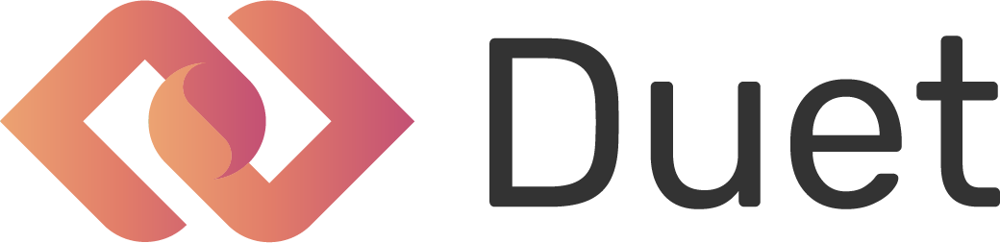

🎤  🎸  ♪♪♪ Starting Duet ♫♫♫  🎻  🎹

♫♫♫ > DISCLAIMER: Duet is an experimental feature currently in beta.
♫♫♫ > Use at your own risk.


    > ❤️ Love Duet? Please consider supporting our community!
    > https://github.com/sponsors/OpenMined

♫♫♫ > Punching through firewall to OpenGrid Network Node at:
♫♫♫ > http://ec2-18-216-8-163.us-east-2.compute.amazonaws.com:5000
♫♫♫ >
♫♫♫ > ...waiting for response from OpenGrid Network... 
♫♫♫ > DONE!

♫♫♫ > STEP 1: Send the following code to your Duet Partner!

import syft as sy
duet = sy.join_duet(loopback=True)

♫♫♫ > Connecting...

♫♫♫ > CONNECTED!

♫♫♫ > DUET LIVE STATUS  -  Objects: 0  Requests: 0   Messages: 0  Request Handlers: 0                                torch.Size([25000, 392])


In [2]:
import syft as sy
duet = sy.duet(loopback=True)

In [3]:
def split_data(dataset, worker_list=None, n_workers=2):

    if worker_list is None:
        worker_list = list(range(0, n_workers))
            
    #counter to create the index of different data samples
    idx = 0 
    
    #dictionary to accomodate the split data
    dic_single_datasets = {}
    for worker in worker_list: 
        """
        Each value is a list of three elements, to accomodate, in order: 
        - data examples (as tensors)
        - label
        - index 
        """
        dic_single_datasets[worker] = [] 

    """
    Loop through the dataset to split the data and labels vertically across workers. 
    Splitting method from @abbas5253: https://github.com/abbas5253/SplitNN-for-Vertically-Partitioned-Data/blob/master/distribute_data.py
    """
    label_list = []
    index_list = []
    index_list_UUID = []
    for tensor, label in dataset:
        height = tensor.shape[-1]//len(worker_list)
        i = 0
        uuid_idx = uuid4()
        for worker in worker_list[:-1]: 
            dic_single_datasets[worker].append(tensor[:, :, height * i : height * (i + 1)])
            i += 1
            
        #add the value of the last worker / split
        dic_single_datasets[worker_list[-1]].append(tensor[:, :, height * (i) : ])
        label_list.append(torch.Tensor([label]))
        index_list_UUID.append(uuid_idx)
        index_list.append(torch.Tensor([idx]))
        
        idx += 1
        
    return dic_single_datasets, label_list, index_list, index_list_UUID

In [4]:
from six.moves import urllib
opener = urllib.request.build_opener()
opener.addheaders = [('User-agent', 'Mozilla/5.0')]
urllib.request.install_opener(opener)

transform = transforms.Compose([transforms.ToTensor(),
                              transforms.Normalize((0.5,), (0.5,)),
                              ])
trainset = datasets.MNIST('mnist', download=True, train=True, transform=transform)

In [5]:
valset = datasets.MNIST('mnist', download=True, train=False, transform=transform)

In [6]:
img, _, _, _ = split_data(trainset)
img = torch.cat(img[1][:25_000])
img_rshp = img.view(img.shape[0], -1)
print(img_rshp.shape)

In [7]:
val_img, _, _, _ = split_data(valset)
val_img = torch.cat(val_img[1][:5_000])
val_img_rshp = val_img.view(val_img.shape[0], -1)
print(val_img_rshp.shape)

torch.Size([5000, 392])


In [8]:
img_rshp.send(duet, searchable=True, tags=["flatten"], description="flattened")
val_img_rshp.send(duet, searchable=True, tags=["flatten_val"], description="flattened")

In [9]:
duet.requests.add_handler(action="accept", tags=[""])

[2021-03-11T09:23:49.356493+0000][CRITICAL][logger]][47807] You are not Authorized to access this service
[2021-03-11T09:23:49.356813+0000][CRITICAL][logger]][47807] You are not Authorized to access this service
[2021-03-11T09:23:49.357078+0000][CRITICAL][logger]][47807] You are not Authorized to access this service
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...his service')>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...his service')>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
   

[2021-03-11T09:24:51.994989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f582acb0efc34c32ad2917264f8926dc>.
[2021-03-11T09:24:52.143368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97f5824540a84e54b141607ee6e689bd> <UID: 97f5824540a84e54b141607ee6e689bd>
[2021-03-11T09:24:52.143645+0000][CRITICAL][logger]][47807] <UID: 97f5824540a84e54b141607ee6e689bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07ee6e689bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07ee6e689bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in ru

[2021-03-11T09:24:52.443163+0000][CRITICAL][logger]][47807] <UID: 0c54d759cbd94cd0ad29e70323de329b>
[2021-03-11T09:24:52.452185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6ea12253d1b440e90ec7843a91c60f7>.
[2021-03-11T09:24:52.602093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 097d39f36bda4fbcbe0d0687763837e3>.
[2021-03-11T09:24:52.746059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4893d239af8a404b992887b1c78e1605> <UID: 4893d239af8a404b992887b1c78e1605>
[2021-03-11T09:24:52.746343+0000][CRITICAL][logger]][47807] <UID: 4893d239af8a404b992887b1c78e1605>
[2021-03-11T09:24:52.746551+0000][CRITICAL][logger]][47807] <UID: 4893d239af8a404b992887b1c78e1605>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b1c78e1605>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:24:53.056849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ca284611433495db02ee15eef373fb8>.
[2021-03-11T09:24:53.201935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f68b1fec4b814ea691e462a681da328b>.
[2021-03-11T09:24:53.342255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a15e015cd64547b3adbad16a22fb6b57> <UID: a15e015cd64547b3adbad16a22fb6b57>
[2021-03-11T09:24:53.342577+0000][CRITICAL][logger]][47807] <UID: a15e015cd64547b3adbad16a22fb6b57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16a22fb6b57>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16a22fb6b57>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:24:53.627110+0000][CRITICAL][logger]][47807] <UID: 2388f63b56de45e99c22d3a57691ac8a>
[2021-03-11T09:24:53.635095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 084598ca43694ae4ade55d181bb6317d>.
[2021-03-11T09:24:53.781373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99514d2d79f444799f2894432234f64e>.
[2021-03-11T09:24:53.923397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93d14b855e944ddd8ded23eb1c260fa2> <UID: 93d14b855e944ddd8ded23eb1c260fa2>
[2021-03-11T09:24:53.923659+0000][CRITICAL][logger]][47807] <UID: 93d14b855e944ddd8ded23eb1c260fa2>
[2021-03-11T09:24:53.923876+0000][CRITICAL][logger]][47807] <UID: 93d14b855e944ddd8ded23eb1c260fa2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3eb1c260fa2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:24:54.221334+0000][CRITICAL][logger]][47807] <UID: 9699822c389746c484888846803e3426>
[2021-03-11T09:24:54.232233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1a773d3921f4111bb1dd62df5ef5a80>.
[2021-03-11T09:24:54.389405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ff0a9fb23ce4ff0bd0ff90983bf01f1>.
[2021-03-11T09:24:54.526277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba505f8c056b489dbcef90e0b9b2e792> <UID: ba505f8c056b489dbcef90e0b9b2e792>
[2021-03-11T09:24:54.526629+0000][CRITICAL][logger]][47807] <UID: ba505f8c056b489dbcef90e0b9b2e792>
[2021-03-11T09:24:54.526873+0000][CRITICAL][logger]][47807] <UID: ba505f8c056b489dbcef90e0b9b2e792>
[2021-03-11T09:24:54.527070+0000][CRITICAL][logger]][47807] <UID: ba505f8c056b489dbcef90e0b9b2e792>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:24:54.819204+0000][CRITICAL][logger]][47807] <UID: 97ba2a17c84a4e78be6bbcd1cafb4db5>
[2021-03-11T09:24:54.829417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bddaafb6bc143b6a89cb2c5d65a6ed7>.
[2021-03-11T09:24:54.982138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7a4ea1df5864bd6bf7c8cf157d7c94c>.
[2021-03-11T09:24:55.119093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c90737661bcf44fe9c7b57b72a5ee832> <UID: c90737661bcf44fe9c7b57b72a5ee832>
[2021-03-11T09:24:55.119413+0000][CRITICAL][logger]][47807] <UID: c90737661bcf44fe9c7b57b72a5ee832>
[2021-03-11T09:24:55.119647+0000][CRITICAL][logger]][47807] <UID: c90737661bcf44fe9c7b57b72a5ee832>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b72a5ee832>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:24:55.418398+0000][CRITICAL][logger]][47807] <UID: 4f73df04e6214872852b11a9d805a212>
[2021-03-11T09:24:55.429627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 072cbc01bac9465c93d594f2486edf3f>.
[2021-03-11T09:24:55.588541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0c3b17340d24faea97cd8df9e6f3984>.
[2021-03-11T09:24:55.721567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d76fcfe5a7d64096853e8a82bf0cd961> <UID: d76fcfe5a7d64096853e8a82bf0cd961>
[2021-03-11T09:24:55.721978+0000][CRITICAL][logger]][47807] <UID: d76fcfe5a7d64096853e8a82bf0cd961>
[2021-03-11T09:24:55.722264+0000][CRITICAL][logger]][47807] <UID: d76fcfe5a7d64096853e8a82bf0cd961>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a82bf0cd961>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:24:56.025483+0000][CRITICAL][logger]][47807] <UID: f43112dc7dd34e098a5ba6d9b2564eef>
[2021-03-11T09:24:56.036158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83a3207fb06540f490b52bcf9da293f0>.
[2021-03-11T09:24:56.191600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64048dcc639c4132a8bfc6dbf42eebe1>.
[2021-03-11T09:24:56.324530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b375bc324be7483daaf13ce17b7b06bf> <UID: b375bc324be7483daaf13ce17b7b06bf>
[2021-03-11T09:24:56.324812+0000][CRITICAL][logger]][47807] <UID: b375bc324be7483daaf13ce17b7b06bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce17b7b06bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:24:56.625160+0000][CRITICAL][logger]][47807] <UID: b933acc8c6c64377bd3f4d76bd3a3d24>
[2021-03-11T09:24:56.636132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75992e41b6b947d1aca8e168ae99e273>.
[2021-03-11T09:24:56.795945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da725e7413414f2b84a1771f6db7a9ca>.
[2021-03-11T09:24:56.822222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b92b25dddca4e709d3143754691bfc7> <UID: 7b92b25dddca4e709d3143754691bfc7>
[2021-03-11T09:24:56.822393+0000][CRITICAL][logger]][47807] <UID: 7b92b25dddca4e709d3143754691bfc7>
[2021-03-11T09:24:56.822494+0000][CRITICAL][logger]][47807] <UID: 7b92b25dddca4e709d3143754691bfc7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3754691bfc7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:24:57.128511+0000][CRITICAL][logger]][47807] <UID: 867c062724854b46842e9a44eb92ef03>
[2021-03-11T09:24:57.235404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c5c423e7e2e418fbb30554e99895bca>.
[2021-03-11T09:24:57.402334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5703ca6603b048f29f7ecb74ee4de200>.
[2021-03-11T09:24:57.427026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52ae8d04ad994e57bff627423e8b40cc> <UID: 52ae8d04ad994e57bff627423e8b40cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7423e8b40cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7423e8b40cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:24:57.728422+0000][CRITICAL][logger]][47807] <UID: a336912dcab8460cb47b1d5c59d64935>
[2021-03-11T09:24:57.835674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15528772b26e4eab865acab71f0674cd>.
[2021-03-11T09:24:58.000873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9dae9def0388412b92966c885e20d143>.
[2021-03-11T09:24:58.023231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3bb16e0bf0af4b97ad980783e929587a> <UID: 3bb16e0bf0af4b97ad980783e929587a>
[2021-03-11T09:24:58.023406+0000][CRITICAL][logger]][47807] <UID: 3bb16e0bf0af4b97ad980783e929587a>
[2021-03-11T09:24:58.023508+0000][CRITICAL][logger]][47807] <UID: 3bb16e0bf0af4b97ad980783e929587a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...783e929587a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:24:58.327763+0000][CRITICAL][logger]][47807] <UID: 51eed0f49e0b4434ba151dc15481a463>
[2021-03-11T09:24:58.327875+0000][CRITICAL][logger]][47807] <UID: 51eed0f49e0b4434ba151dc15481a463>
[2021-03-11T09:24:58.435502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 543e5423bf654c8c945878c6f2ce9552>.
[2021-03-11T09:24:58.606744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2247887d322843969f53ee47f925ea47>.
[2021-03-11T09:24:58.629962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9e36ce8ba36410495de70d267299a4e> <UID: c9e36ce8ba36410495de70d267299a4e>
[2021-03-11T09:24:58.630131+0000][CRITICAL][logger]][47807] <UID: c9e36ce8ba36410495de70d267299a4e>
[2021-03-11T09:24:58.630239+0000][CRITICAL][logger]][47807] <UID: c9e36ce8ba36410495de70d267299a4e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:24:58.936901+0000][CRITICAL][logger]][47807] <UID: b0649d53957747778f80d8c1615a698b>
[2021-03-11T09:24:59.045133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4d31c37e5714a1890ee7678a6d34fba>.
[2021-03-11T09:24:59.198235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a85c95b17cd142e989422daf17e53fb5>.
[2021-03-11T09:24:59.225388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f08e265fe8c54d0a8b37f498f2364749> <UID: f08e265fe8c54d0a8b37f498f2364749>
[2021-03-11T09:24:59.225554+0000][CRITICAL][logger]][47807] <UID: f08e265fe8c54d0a8b37f498f2364749>
[2021-03-11T09:24:59.225760+0000][CRITICAL][logger]][47807] <UID: f08e265fe8c54d0a8b37f498f2364749>
[2021-03-11T09:24:59.225906+0000][CRITICAL][logger]][47807] <UID: f08e265fe8c54d0a8b37f498f2364749>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:24:59.616213+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad4fa3a55eb1439781073d75edd94d3a>.
[2021-03-11T09:24:59.781341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f181004d97e84a9c80f6701e8973e7d9>.
[2021-03-11T09:24:59.805015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ce03881a6674d95bcdc2b89a01b4cb2> <UID: 2ce03881a6674d95bcdc2b89a01b4cb2>
[2021-03-11T09:24:59.805238+0000][CRITICAL][logger]][47807] <UID: 2ce03881a6674d95bcdc2b89a01b4cb2>
[2021-03-11T09:24:59.805366+0000][CRITICAL][logger]][47807] <UID: 2ce03881a6674d95bcdc2b89a01b4cb2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b89a01b4cb2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:00.108108+0000][CRITICAL][logger]][47807] <UID: fe4a9926b94140708f99e69b41b7e39c>
[2021-03-11T09:25:00.115394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe04ef894f9f48d987a9ba440c461e6d>.
[2021-03-11T09:25:00.377815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d53d9805cbed497cbf39d2ce3807043f>.
[2021-03-11T09:25:00.402264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d765f44bfe1400f92a548f76f776ddd> <UID: 9d765f44bfe1400f92a548f76f776ddd>
[2021-03-11T09:25:00.402456+0000][CRITICAL][logger]][47807] <UID: 9d765f44bfe1400f92a548f76f776ddd>
[2021-03-11T09:25:00.402650+0000][CRITICAL][logger]][47807] <UID: 9d765f44bfe1400f92a548f76f776ddd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f76f776ddd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:00.709915+0000][CRITICAL][logger]][47807] <UID: 67653a455ab049028a802e0a4a73a88a>
[2021-03-11T09:25:00.715904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41e1f12c6c414995ba2dc2c82827adc3>.
[2021-03-11T09:25:00.980436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9365305ccb494a4182b87e2608b60628>.
[2021-03-11T09:25:01.009703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2953945167f84aec8bb5f1b004fd0c1d> <UID: 2953945167f84aec8bb5f1b004fd0c1d>
[2021-03-11T09:25:01.009872+0000][CRITICAL][logger]][47807] <UID: 2953945167f84aec8bb5f1b004fd0c1d>
[2021-03-11T09:25:01.009979+0000][CRITICAL][logger]][47807] <UID: 2953945167f84aec8bb5f1b004fd0c1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b004fd0c1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:01.310012+0000][CRITICAL][logger]][47807] <UID: 58afa7b8921f49b9947060dd33c29271>
[2021-03-11T09:25:01.314694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88863d8551ac4f838826cfbd3df857f4>.
[2021-03-11T09:25:01.585352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 019dd39562c644a6a12d63e0203f8e52>.
[2021-03-11T09:25:01.610429+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc48f7823d3d4d74900379461351a55b> <UID: fc48f7823d3d4d74900379461351a55b>
[2021-03-11T09:25:01.610599+0000][CRITICAL][logger]][47807] <UID: fc48f7823d3d4d74900379461351a55b>
[2021-03-11T09:25:01.610707+0000][CRITICAL][logger]][47807] <UID: fc48f7823d3d4d74900379461351a55b>
[2021-03-11T09:25:01.610794+0000][CRITICAL][logger]][47807] <UID: fc48f7823d3d4d74900379461351a55b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:01.915006+0000][CRITICAL][logger]][47807] <UID: 64f8e7c217d64442b1cddfe35d5ad2a3>
[2021-03-11T09:25:01.920193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 030316e616e3417ca8e322958ae6882e>.
[2021-03-11T09:25:02.197061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fede662918e34647b753ec7175bd98d5>.
[2021-03-11T09:25:02.223583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db26dff82ebd4ad9ae2ffa2fcc7fe331> <UID: db26dff82ebd4ad9ae2ffa2fcc7fe331>
[2021-03-11T09:25:02.223771+0000][CRITICAL][logger]][47807] <UID: db26dff82ebd4ad9ae2ffa2fcc7fe331>
[2021-03-11T09:25:02.223869+0000][CRITICAL][logger]][47807] <UID: db26dff82ebd4ad9ae2ffa2fcc7fe331>
[2021-03-11T09:25:02.223951+0000][CRITICAL][logger]][47807] <UID: db26dff82ebd4ad9ae2ffa2fcc7fe331>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:02.513746+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee923ee2bb8e4d83b035fd70fcb24622>.
[2021-03-11T09:25:02.782332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c02718166354173953003e0b8f5bfb4>.
[2021-03-11T09:25:02.806635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18c1518fce944cdfa6e1c51a62e8ede7> <UID: 18c1518fce944cdfa6e1c51a62e8ede7>
[2021-03-11T09:25:02.806855+0000][CRITICAL][logger]][47807] <UID: 18c1518fce944cdfa6e1c51a62e8ede7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51a62e8ede7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51a62e8ede7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:03.096755+0000][CRITICAL][logger]][47807] <UID: c8f883ba238d469a857eb31ba8351325>
[2021-03-11T09:25:03.102072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d34cbe63d4cf4e0f937214edbf7c602c>.
[2021-03-11T09:25:03.358586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bdbc83268714d99a660eedb1efdbd14>.
[2021-03-11T09:25:03.387890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1873865efff34d01afa37a81e1f3c279> <UID: 1873865efff34d01afa37a81e1f3c279>
[2021-03-11T09:25:03.388069+0000][CRITICAL][logger]][47807] <UID: 1873865efff34d01afa37a81e1f3c279>
[2021-03-11T09:25:03.388181+0000][CRITICAL][logger]][47807] <UID: 1873865efff34d01afa37a81e1f3c279>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a81e1f3c279>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:03.684788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6044876cdaa4c46960ceaa023997b3a>.
[2021-03-11T09:25:03.944200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28ffac6223a14d9a9a6f744b555c2b09>.
[2021-03-11T09:25:03.970930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: badaa45951a44f689b63a3526a945d21> <UID: badaa45951a44f689b63a3526a945d21>
[2021-03-11T09:25:03.971137+0000][CRITICAL][logger]][47807] <UID: badaa45951a44f689b63a3526a945d21>
[2021-03-11T09:25:03.971298+0000][CRITICAL][logger]][47807] <UID: badaa45951a44f689b63a3526a945d21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3526a945d21>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:04.271443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3f298eb4d8845f584564517c6d0370e>.
[2021-03-11T09:25:04.541627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fdefdb4d31024a1589fb3b056515e397>.
[2021-03-11T09:25:04.569086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 775234e6b0bd43a492bae04a78cd0213> <UID: 775234e6b0bd43a492bae04a78cd0213>
[2021-03-11T09:25:04.569269+0000][CRITICAL][logger]][47807] <UID: 775234e6b0bd43a492bae04a78cd0213>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04a78cd0213>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04a78cd0213>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:04.874315+0000][CRITICAL][logger]][47807] <UID: d6f43fa60750496997e33a7aae9d40cc>
[2021-03-11T09:25:04.874441+0000][CRITICAL][logger]][47807] <UID: d6f43fa60750496997e33a7aae9d40cc>
[2021-03-11T09:25:04.874555+0000][CRITICAL][logger]][47807] <UID: d6f43fa60750496997e33a7aae9d40cc>
[2021-03-11T09:25:04.881582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de8a84596e3e42329148ecb71173d283>.
[2021-03-11T09:25:05.138434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 416aae7c01944277a69ef3081934099e>.
[2021-03-11T09:25:05.164409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1dbd5ad311ea45c0a3a2e1f1351fbb79> <UID: 1dbd5ad311ea45c0a3a2e1f1351fbb79>
[2021-03-11T09:25:05.164575+0000][CRITICAL][logger]][47807] <UID: 1dbd5ad311ea45c0a3a2e1f1351fbb79>
[2021-03-11T09:25:05.164676+0000][CRITICAL][logger]

[2021-03-11T09:25:05.469605+0000][CRITICAL][logger]][47807] <UID: fbf84d4fbe344a7ca8ea47c25839250d>
[2021-03-11T09:25:05.474592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad10add6cee443d39e8e1a03815b5bfb>.
[2021-03-11T09:25:05.737565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd832fa4c87b402dbc2016d5a6e0e5b7>.
[2021-03-11T09:25:05.762332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e295dc25d7f341c0ac11c00b201adebe> <UID: e295dc25d7f341c0ac11c00b201adebe>
[2021-03-11T09:25:05.762510+0000][CRITICAL][logger]][47807] <UID: e295dc25d7f341c0ac11c00b201adebe>
[2021-03-11T09:25:05.762720+0000][CRITICAL][logger]][47807] <UID: e295dc25d7f341c0ac11c00b201adebe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00b201adebe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:06.045782+0000][CRITICAL][logger]][47807] <UID: 6b9636349e9b41b495dcbc149e13c298>
[2021-03-11T09:25:06.045870+0000][CRITICAL][logger]][47807] <UID: 6b9636349e9b41b495dcbc149e13c298>
[2021-03-11T09:25:06.051347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f84fe8a5c6414319a311220c41b0613d>.
[2021-03-11T09:25:06.322157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16a386781aa14d7d9a9bcef591a90b20>.
[2021-03-11T09:25:06.342337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 364cfe37c3e54acfa49fa2f9ac9fcc3a> <UID: 364cfe37c3e54acfa49fa2f9ac9fcc3a>
[2021-03-11T09:25:06.342525+0000][CRITICAL][logger]][47807] <UID: 364cfe37c3e54acfa49fa2f9ac9fcc3a>
[2021-03-11T09:25:06.342635+0000][CRITICAL][logger]][47807] <UID: 364cfe37c3e54acfa49fa2f9ac9fcc3a>
[2021-03-11T09:25:06.342720+0000][CRITICAL][logger]

[2021-03-11T09:25:06.648765+0000][CRITICAL][logger]][47807] <UID: 5b975ec602b54f6f9825a8686b824c13>
[2021-03-11T09:25:06.648851+0000][CRITICAL][logger]][47807] <UID: 5b975ec602b54f6f9825a8686b824c13>
[2021-03-11T09:25:06.654701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a98fafd6357c46baa9ec29a0274af3e8>.
[2021-03-11T09:25:06.906648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 188cc5ac9fa940a88072cbe78e07ddd1>.
[2021-03-11T09:25:06.930908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed9047efe8ea47e39ae2d85d4a1af338> <UID: ed9047efe8ea47e39ae2d85d4a1af338>
[2021-03-11T09:25:06.931075+0000][CRITICAL][logger]][47807] <UID: ed9047efe8ea47e39ae2d85d4a1af338>
[2021-03-11T09:25:06.931191+0000][CRITICAL][logger]][47807] <UID: ed9047efe8ea47e39ae2d85d4a1af338>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:07.240628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81a8b1fb14a74efa8fdd399220d4f83f>.
[2021-03-11T09:25:07.512085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5816f7c7ddfb4a8d95e9fa2994122011>.
[2021-03-11T09:25:07.537665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64bd21bc27f747119426233aa0689aee> <UID: 64bd21bc27f747119426233aa0689aee>
[2021-03-11T09:25:07.537840+0000][CRITICAL][logger]][47807] <UID: 64bd21bc27f747119426233aa0689aee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33aa0689aee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33aa0689aee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:07.843226+0000][CRITICAL][logger]][47807] <UID: 5bda6a7e38534ed5bd860052416ad50a>
[2021-03-11T09:25:07.843368+0000][CRITICAL][logger]][47807] <UID: 5bda6a7e38534ed5bd860052416ad50a>
[2021-03-11T09:25:07.843461+0000][CRITICAL][logger]][47807] <UID: 5bda6a7e38534ed5bd860052416ad50a>
[2021-03-11T09:25:07.849018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bfa31ac44584f2a8c329705d49396fe>.
[2021-03-11T09:25:08.113316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 260e9dcb753e40e8b55c96ee79d54203>.
[2021-03-11T09:25:08.138670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a56cdb3332a54008a01bed7756d63d03> <UID: a56cdb3332a54008a01bed7756d63d03>
[2021-03-11T09:25:08.138909+0000][CRITICAL][logger]][47807] <UID: a56cdb3332a54008a01bed7756d63d03>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:08.436979+0000][CRITICAL][logger]][47807] <UID: 299670d5db444901bbdcba541c93ed45>
[2021-03-11T09:25:08.437067+0000][CRITICAL][logger]][47807] <UID: 299670d5db444901bbdcba541c93ed45>
[2021-03-11T09:25:08.442591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abc7052403b142e2a6c6a3728d3fc2bd>.
[2021-03-11T09:25:08.725724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc2786e6bcb04fb28de215020628209c>.
[2021-03-11T09:25:08.750257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79eb704a68e340bdb18dc1d242524d27> <UID: 79eb704a68e340bdb18dc1d242524d27>
[2021-03-11T09:25:08.750430+0000][CRITICAL][logger]][47807] <UID: 79eb704a68e340bdb18dc1d242524d27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d242524d27>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:09.069796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dcfad1a48a64e23adcca6fcf9668cc6>.
[2021-03-11T09:25:09.346717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd831a1fed9746828920744b8c99dc3c>.
[2021-03-11T09:25:09.372035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39eefccb621841b69758de641b9068ed> <UID: 39eefccb621841b69758de641b9068ed>
[2021-03-11T09:25:09.372212+0000][CRITICAL][logger]][47807] <UID: 39eefccb621841b69758de641b9068ed>
[2021-03-11T09:25:09.372337+0000][CRITICAL][logger]][47807] <UID: 39eefccb621841b69758de641b9068ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e641b9068ed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:09.675027+0000][CRITICAL][logger]][47807] <UID: a6c7e1c089db45b6bf870894379e076f>
[2021-03-11T09:25:09.680386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f90e9f939748412daa7318cb80e57d57>.
[2021-03-11T09:25:09.944827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a5ec3fdd1474f3db79c48c37a03a618>.
[2021-03-11T09:25:09.969744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1315649340d64cc381ef93569fdb55e8> <UID: 1315649340d64cc381ef93569fdb55e8>
[2021-03-11T09:25:09.969911+0000][CRITICAL][logger]][47807] <UID: 1315649340d64cc381ef93569fdb55e8>
[2021-03-11T09:25:09.970019+0000][CRITICAL][logger]][47807] <UID: 1315649340d64cc381ef93569fdb55e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3569fdb55e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:10.277136+0000][CRITICAL][logger]][47807] <UID: 9e2d5b04c02f478f959fc7deb9fff0a0>
[2021-03-11T09:25:10.283659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 273d64fd43434493a5a6791ef1d7581f>.
[2021-03-11T09:25:10.546219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25b5f359636a41a9a88f83d4132bacd7>.
[2021-03-11T09:25:10.568823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ce246f6ca7c4886b4c934ab9623c6eb> <UID: 2ce246f6ca7c4886b4c934ab9623c6eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ab9623c6eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ab9623c6eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:10.869330+0000][CRITICAL][logger]][47807] <UID: 5668b460a92e4fce91d5076f96bcb115>
[2021-03-11T09:25:10.869416+0000][CRITICAL][logger]][47807] <UID: 5668b460a92e4fce91d5076f96bcb115>
[2021-03-11T09:25:10.874309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ac29e51dc6f4d4cbfcd84d5e7dc7abc>.
[2021-03-11T09:25:11.155573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46fd07dac81b426c8814d44d3144a82f>.
[2021-03-11T09:25:11.180245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8d5eec67c0d41fa8a67e248cc3f3c16> <UID: d8d5eec67c0d41fa8a67e248cc3f3c16>
[2021-03-11T09:25:11.180425+0000][CRITICAL][logger]][47807] <UID: d8d5eec67c0d41fa8a67e248cc3f3c16>
[2021-03-11T09:25:11.180549+0000][CRITICAL][logger]][47807] <UID: d8d5eec67c0d41fa8a67e248cc3f3c16>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:11.482866+0000][CRITICAL][logger]][47807] <UID: c07e197c11044c9f839c099803efb736>
[2021-03-11T09:25:11.488228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dac87be9ddfe41598553f842429bf836>.
[2021-03-11T09:25:11.760646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cd3cb372a4f45ad90db986b39b98358>.
[2021-03-11T09:25:11.784499+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3242342afa54fbe881b1f82042b7824> <UID: a3242342afa54fbe881b1f82042b7824>
[2021-03-11T09:25:11.784667+0000][CRITICAL][logger]][47807] <UID: a3242342afa54fbe881b1f82042b7824>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f82042b7824>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:12.089777+0000][CRITICAL][logger]][47807] <UID: 29b67f6fa82044be8231d3fb80f2027b>
[2021-03-11T09:25:12.097070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: adc2b59ab41e4151a78fd57b505d5b67>.
[2021-03-11T09:25:12.375112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53a66615059847b38c86825dc83db873>.
[2021-03-11T09:25:12.397697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffa2aee479be4218a5ea288204672c4e> <UID: ffa2aee479be4218a5ea288204672c4e>
[2021-03-11T09:25:12.397869+0000][CRITICAL][logger]][47807] <UID: ffa2aee479be4218a5ea288204672c4e>
[2021-03-11T09:25:12.397994+0000][CRITICAL][logger]][47807] <UID: ffa2aee479be4218a5ea288204672c4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88204672c4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:12.680591+0000][CRITICAL][logger]][47807] <UID: f1e53155db944fcfbba35e22d5e733b4>
[2021-03-11T09:25:12.686123+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8bf4591ba6e4c4287d532e0fc34d76c>.
[2021-03-11T09:25:12.934083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d6f65a5e03f4f2496c8bad6682d6811>.
[2021-03-11T09:25:12.957324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 27f14e3e278643c2b97a4f462576f659> <UID: 27f14e3e278643c2b97a4f462576f659>
[2021-03-11T09:25:12.957497+0000][CRITICAL][logger]][47807] <UID: 27f14e3e278643c2b97a4f462576f659>
[2021-03-11T09:25:12.957606+0000][CRITICAL][logger]][47807] <UID: 27f14e3e278643c2b97a4f462576f659>
[2021-03-11T09:25:12.957726+0000][CRITICAL][logger]][47807] <UID: 27f14e3e278643c2b97a4f462576f659>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:13.248100+0000][CRITICAL][logger]][47807] <UID: d5daca35ad584444ab0a123695b61aa5>
[2021-03-11T09:25:13.253394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8f7b6a6ec7e4c57a9192e44d5c8a222>.
[2021-03-11T09:25:13.527643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b97df0f32d9478eaff71de770481f56>.
[2021-03-11T09:25:13.551965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c260b881924a4ec4bbd18bc7c4de09b7> <UID: c260b881924a4ec4bbd18bc7c4de09b7>
[2021-03-11T09:25:13.552167+0000][CRITICAL][logger]][47807] <UID: c260b881924a4ec4bbd18bc7c4de09b7>
[2021-03-11T09:25:13.552377+0000][CRITICAL][logger]][47807] <UID: c260b881924a4ec4bbd18bc7c4de09b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc7c4de09b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:13.847227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8560728de2d34001858a6f152929857c>.
[2021-03-11T09:25:14.108831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40b694a3fc9a41669804a29433496cad>.
[2021-03-11T09:25:14.135800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 294f7c4e54fd47909000db69ae8924c8> <UID: 294f7c4e54fd47909000db69ae8924c8>
[2021-03-11T09:25:14.136060+0000][CRITICAL][logger]][47807] <UID: 294f7c4e54fd47909000db69ae8924c8>
[2021-03-11T09:25:14.136255+0000][CRITICAL][logger]][47807] <UID: 294f7c4e54fd47909000db69ae8924c8>
[2021-03-11T09:25:14.136402+0000][CRITICAL][logger]][47807] <UID: 294f7c4e54fd47909000db69ae8924c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b69ae8924c8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:14.426718+0000][CRITICAL][logger]][47807] <UID: 899d2409c747412db26ae8da46a7c101>
[2021-03-11T09:25:14.434216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b44a0d13a934eb4bf597893fa214977>.
[2021-03-11T09:25:14.711363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27ffae78bcb844cd91f2d7aa51c92371>.
[2021-03-11T09:25:14.740243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6c5a237b1484eaa9c610c70126ce0c7> <UID: e6c5a237b1484eaa9c610c70126ce0c7>
[2021-03-11T09:25:14.740428+0000][CRITICAL][logger]][47807] <UID: e6c5a237b1484eaa9c610c70126ce0c7>
[2021-03-11T09:25:14.740548+0000][CRITICAL][logger]][47807] <UID: e6c5a237b1484eaa9c610c70126ce0c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c70126ce0c7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:15.029992+0000][CRITICAL][logger]][47807] <UID: f3ab70b8c5b8460f8bd5e3a21f4214ad>
[2021-03-11T09:25:15.037724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 735d3f06e65643639da3d58bc09ba1cc>.
[2021-03-11T09:25:15.365539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aed7d34f146743868d4cc6e4f45350c4>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...def1cec88b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...def1cec88b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._ar

[2021-03-11T09:25:15.700525+0000][CRITICAL][logger]][47807] <UID: e064dd32bb0440d09144ef972cdbd2db>
[2021-03-11T09:25:15.700748+0000][CRITICAL][logger]][47807] <UID: e064dd32bb0440d09144ef972cdbd2db>
[2021-03-11T09:25:15.700921+0000][CRITICAL][logger]][47807] <UID: e064dd32bb0440d09144ef972cdbd2db>
[2021-03-11T09:25:15.709776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55297e46e7f2438993d0a792bd8f71d9>.
[2021-03-11T09:25:15.953749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 656c461ce50c4c888f3a25afbb7f87cc>.
[2021-03-11T09:25:15.976871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dedd50de9b1245be93b95593e17c503c> <UID: dedd50de9b1245be93b95593e17c503c>
[2021-03-11T09:25:15.977049+0000][CRITICAL][logger]][47807] <UID: dedd50de9b1245be93b95593e17c503c>
[2021-03-11T09:25:15.977205+0000][CRITICAL][logger]

[2021-03-11T09:25:16.549047+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 643b5b9f425344acbd03bc222fc79836>.
[2021-03-11T09:25:16.820736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34499a8fe35042a8a54b4ba3049c6f76>.
[2021-03-11T09:25:16.864158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcd1eed2e11741f5b93c24df06b6ed89> <UID: fcd1eed2e11741f5b93c24df06b6ed89>
[2021-03-11T09:25:16.864376+0000][CRITICAL][logger]][47807] <UID: fcd1eed2e11741f5b93c24df06b6ed89>
[2021-03-11T09:25:16.864568+0000][CRITICAL][logger]][47807] <UID: fcd1eed2e11741f5b93c24df06b6ed89>
[2021-03-11T09:25:16.864713+0000][CRITICAL][logger]][47807] <UID: fcd1eed2e11741f5b93c24df06b6ed89>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4df06b6ed89>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:17.156467+0000][CRITICAL][logger]][47807] <UID: 7987c0f6d5e546f4a8d222c60166931c>
[2021-03-11T09:25:17.164097+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6ea51051dd34864b474d6a4dddc2aa8>.
[2021-03-11T09:25:17.411016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76d28a75b7ee49d6872fe907f5cbc159>.
[2021-03-11T09:25:17.434795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1a0f478545d47a8a3c141cd08221f09> <UID: c1a0f478545d47a8a3c141cd08221f09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1cd08221f09>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1cd08221f09>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:17.741522+0000][CRITICAL][logger]][47807] <UID: d15af127945844b59cd2226928b9f8fc>
[2021-03-11T09:25:17.746910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9a52603ca9243c2839b2e5ad28b014c>.
[2021-03-11T09:25:18.025620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66b805510636478c8fefb55a664b2c23>.
[2021-03-11T09:25:18.050605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6c25e4b644e4a20969b142dbd12c004> <UID: f6c25e4b644e4a20969b142dbd12c004>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42dbd12c004>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42dbd12c004>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:18.334300+0000][CRITICAL][logger]][47807] <UID: 1d012f77414e49c9940c26e06a8515d5>
[2021-03-11T09:25:18.340925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57239f5b524b4938b3f409bb1386a806>.
[2021-03-11T09:25:18.582756+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6712c778c39b4b02a6ce36980d62056e>.
[2021-03-11T09:25:18.607014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d51db7c6e11349af91074355b15f5218> <UID: d51db7c6e11349af91074355b15f5218>
[2021-03-11T09:25:18.607267+0000][CRITICAL][logger]][47807] <UID: d51db7c6e11349af91074355b15f5218>
[2021-03-11T09:25:18.607434+0000][CRITICAL][logger]][47807] <UID: d51db7c6e11349af91074355b15f5218>
[2021-03-11T09:25:18.607576+0000][CRITICAL][logger]][47807] <UID: d51db7c6e11349af91074355b15f5218>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:18.906188+0000][CRITICAL][logger]][47807] <UID: ca7aa0bcde7a4e9e8ba1d382ed8f18c2>
[2021-03-11T09:25:18.913031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9be78844eac461c9af1ae780f20a0af>.
[2021-03-11T09:25:19.174162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ab87229f4b047fabf89a831260d4222>.
[2021-03-11T09:25:19.197628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c026b263ecf542ba9f8a9f8207ad38f6> <UID: c026b263ecf542ba9f8a9f8207ad38f6>
[2021-03-11T09:25:19.197894+0000][CRITICAL][logger]][47807] <UID: c026b263ecf542ba9f8a9f8207ad38f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8207ad38f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:19.500403+0000][CRITICAL][logger]][47807] <UID: af34eb4eb1254bc585a1b0b74105a93d>
[2021-03-11T09:25:19.506013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f36348c07164e178a121be4cafa9d13>.
[2021-03-11T09:25:19.783251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2084009044384142be0e9d0299f5bd9b>.
[2021-03-11T09:25:19.807406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faa45b91e3034bc385c9a0f5c4648541> <UID: faa45b91e3034bc385c9a0f5c4648541>
[2021-03-11T09:25:19.807575+0000][CRITICAL][logger]][47807] <UID: faa45b91e3034bc385c9a0f5c4648541>
[2021-03-11T09:25:19.807684+0000][CRITICAL][logger]][47807] <UID: faa45b91e3034bc385c9a0f5c4648541>
[2021-03-11T09:25:19.807768+0000][CRITICAL][logger]][47807] <UID: faa45b91e3034bc385c9a0f5c4648541>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:20.129808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3947eaa034504599a0d4c6682cba351d>.
[2021-03-11T09:25:20.413799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a31e2bf33294e41b06439f9e0208c6f>.
[2021-03-11T09:25:20.442087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06497ab6fe6f41a58248cce3aa279955> <UID: 06497ab6fe6f41a58248cce3aa279955>
[2021-03-11T09:25:20.442364+0000][CRITICAL][logger]][47807] <UID: 06497ab6fe6f41a58248cce3aa279955>
[2021-03-11T09:25:20.442561+0000][CRITICAL][logger]][47807] <UID: 06497ab6fe6f41a58248cce3aa279955>
[2021-03-11T09:25:20.442723+0000][CRITICAL][logger]][47807] <UID: 06497ab6fe6f41a58248cce3aa279955>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce3aa279955>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:20.750293+0000][CRITICAL][logger]][47807] <UID: 616f4c24f2d14461ae4e55640278dab0>
[2021-03-11T09:25:20.756337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f501952c67d6486e9902bd9a495b7242>.
[2021-03-11T09:25:21.026716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e01c238e99f46ebb71d2fd3c3ebc4bb>.
[2021-03-11T09:25:21.050142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10b078139da046da81bdf7d172548d59> <UID: 10b078139da046da81bdf7d172548d59>
[2021-03-11T09:25:21.050318+0000][CRITICAL][logger]][47807] <UID: 10b078139da046da81bdf7d172548d59>
[2021-03-11T09:25:21.050450+0000][CRITICAL][logger]][47807] <UID: 10b078139da046da81bdf7d172548d59>
[2021-03-11T09:25:21.050540+0000][CRITICAL][logger]][47807] <UID: 10b078139da046da81bdf7d172548d59>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:21.353647+0000][CRITICAL][logger]][47807] <UID: faeb90f841594eb897564fe34b5b586f>
[2021-03-11T09:25:21.358912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 179fdb24b7924863aa0cf29e1f3f5a54>.
[2021-03-11T09:25:21.626672+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52e9ce0490bd416e95eab9e49b8b0fb3>.
[2021-03-11T09:25:21.650944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed879a2a09244e95be7b8fd92e61de43> <UID: ed879a2a09244e95be7b8fd92e61de43>
[2021-03-11T09:25:21.651115+0000][CRITICAL][logger]][47807] <UID: ed879a2a09244e95be7b8fd92e61de43>
[2021-03-11T09:25:21.651225+0000][CRITICAL][logger]][47807] <UID: ed879a2a09244e95be7b8fd92e61de43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd92e61de43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:21.954446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed8d68a19f6d4bf2b0c886ad3909c304>.
[2021-03-11T09:25:22.216340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48e8c4ee1c24429c9697cf41e3e5d3fa>.
[2021-03-11T09:25:22.241292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0bcccef0d3544e2b12af283d38c869b> <UID: f0bcccef0d3544e2b12af283d38c869b>
[2021-03-11T09:25:22.241507+0000][CRITICAL][logger]][47807] <UID: f0bcccef0d3544e2b12af283d38c869b>
[2021-03-11T09:25:22.241638+0000][CRITICAL][logger]][47807] <UID: f0bcccef0d3544e2b12af283d38c869b>
[2021-03-11T09:25:22.241739+0000][CRITICAL][logger]][47807] <UID: f0bcccef0d3544e2b12af283d38c869b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...283d38c869b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:22.524173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5dc75424040f414e9c81135cbb2f7b63>.
[2021-03-11T09:25:22.771420+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7978af2f509f458d8053496e62ccc5f2>.
[2021-03-11T09:25:22.798658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a0cff12f5904eaebf428580995798a4> <UID: 9a0cff12f5904eaebf428580995798a4>
[2021-03-11T09:25:22.798911+0000][CRITICAL][logger]][47807] <UID: 9a0cff12f5904eaebf428580995798a4>
[2021-03-11T09:25:22.799090+0000][CRITICAL][logger]][47807] <UID: 9a0cff12f5904eaebf428580995798a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...580995798a4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:23.089138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 119126e5fe604726b12b928cb824fc89>.
[2021-03-11T09:25:23.361977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d47153f7b46c414c98283848903b45b5>.
[2021-03-11T09:25:23.384908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 72714fe1298742d88381882c9a4a5b0a> <UID: 72714fe1298742d88381882c9a4a5b0a>
[2021-03-11T09:25:23.385074+0000][CRITICAL][logger]][47807] <UID: 72714fe1298742d88381882c9a4a5b0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82c9a4a5b0a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82c9a4a5b0a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:23.695044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c53df4cd71544898c663412bf202808>.
[2021-03-11T09:25:23.958835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2da21a19efce47fc9ffbd8ce101e33f7>.
[2021-03-11T09:25:23.981313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5da44e2b881b4d1a82e910e0d2e0f8d9> <UID: 5da44e2b881b4d1a82e910e0d2e0f8d9>
[2021-03-11T09:25:23.981482+0000][CRITICAL][logger]][47807] <UID: 5da44e2b881b4d1a82e910e0d2e0f8d9>
[2021-03-11T09:25:23.981592+0000][CRITICAL][logger]][47807] <UID: 5da44e2b881b4d1a82e910e0d2e0f8d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e0d2e0f8d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:24.299958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4404ec4cd0c4181adc1e9253b034d77>.
[2021-03-11T09:25:24.571852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f197443e91e2409abe61c5c0b160c989>.
[2021-03-11T09:25:24.595093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2505a938b7345f99fc29d41c92ca710> <UID: b2505a938b7345f99fc29d41c92ca710>
[2021-03-11T09:25:24.595335+0000][CRITICAL][logger]][47807] <UID: b2505a938b7345f99fc29d41c92ca710>
[2021-03-11T09:25:24.595503+0000][CRITICAL][logger]][47807] <UID: b2505a938b7345f99fc29d41c92ca710>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d41c92ca710>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:24.902485+0000][CRITICAL][logger]][47807] <UID: 085baac0664f43b8a815c462c3265599>
[2021-03-11T09:25:24.902568+0000][CRITICAL][logger]][47807] <UID: 085baac0664f43b8a815c462c3265599>
[2021-03-11T09:25:24.907582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b931481cfe8d4570b331186c2f7cfb96>.
[2021-03-11T09:25:25.172025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ced81bdf523a4fb081794cc1be03308a>.
[2021-03-11T09:25:25.198135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a317c228709a46fd923497c647cac64d> <UID: a317c228709a46fd923497c647cac64d>
[2021-03-11T09:25:25.198302+0000][CRITICAL][logger]][47807] <UID: a317c228709a46fd923497c647cac64d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7c647cac64d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:25.509323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f65d1863e4e42f19dc59cfbe6fd1ca0>.
[2021-03-11T09:25:25.782843+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5de2fb815db4ce6839cfdba974e2091>.
[2021-03-11T09:25:25.807179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc93394e8b78427a9bf5f418a4fcedec> <UID: fc93394e8b78427a9bf5f418a4fcedec>
[2021-03-11T09:25:25.807342+0000][CRITICAL][logger]][47807] <UID: fc93394e8b78427a9bf5f418a4fcedec>
[2021-03-11T09:25:25.807499+0000][CRITICAL][logger]][47807] <UID: fc93394e8b78427a9bf5f418a4fcedec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...418a4fcedec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:26.098783+0000][CRITICAL][logger]][47807] <UID: da272326248a4a1abb4de9fae1028e0d>
[2021-03-11T09:25:26.103752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43b10f9e47534f8eacaa831e9a93e8ee>.
[2021-03-11T09:25:26.376834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c91ff5ed0bfc4e1a8e122b97bc029d61>.
[2021-03-11T09:25:26.400993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2614430319364409828abee3e06f2558> <UID: 2614430319364409828abee3e06f2558>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee3e06f2558>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee3e06f2558>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:26.709848+0000][CRITICAL][logger]][47807] <UID: f3fd9713d8b341dc949a3447c3778abc>
[2021-03-11T09:25:26.709934+0000][CRITICAL][logger]][47807] <UID: f3fd9713d8b341dc949a3447c3778abc>
[2021-03-11T09:25:26.715425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eff37dda96a5406aa6da63d9066e883d>.
[2021-03-11T09:25:26.975780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d15e08818c849b9aa8642973796c206>.
[2021-03-11T09:25:26.999015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9276de14bbd24bd592f6fd1fe0ea4fd7> <UID: 9276de14bbd24bd592f6fd1fe0ea4fd7>
[2021-03-11T09:25:26.999193+0000][CRITICAL][logger]][47807] <UID: 9276de14bbd24bd592f6fd1fe0ea4fd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1fe0ea4fd7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:27.269666+0000][CRITICAL][logger]][47807] <UID: 2013007046ed44d283d811b980626abd>
[2021-03-11T09:25:27.274290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60498a68fcb747519143132d58d09a49>.
[2021-03-11T09:25:27.536562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0269399820294e2a9e091e639733986a>.
[2021-03-11T09:25:27.561546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17b4bb89c69e44ada7b32203a2346abe> <UID: 17b4bb89c69e44ada7b32203a2346abe>
[2021-03-11T09:25:27.561796+0000][CRITICAL][logger]][47807] <UID: 17b4bb89c69e44ada7b32203a2346abe>
[2021-03-11T09:25:27.561991+0000][CRITICAL][logger]][47807] <UID: 17b4bb89c69e44ada7b32203a2346abe>
[2021-03-11T09:25:27.562100+0000][CRITICAL][logger]][47807] <UID: 17b4bb89c69e44ada7b32203a2346abe>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:27.865742+0000][CRITICAL][logger]][47807] <UID: f9b22afab9b140d480c47cccebdf2019>
[2021-03-11T09:25:27.872226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8b4c09cf1bb4e969f66e2ec389af6de>.
[2021-03-11T09:25:28.152718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 945f3a9776594394a4be3f436759b521>.
[2021-03-11T09:25:28.176789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ea7111ac56b4c8ea720a054ba4436de> <UID: 4ea7111ac56b4c8ea720a054ba4436de>
[2021-03-11T09:25:28.176963+0000][CRITICAL][logger]][47807] <UID: 4ea7111ac56b4c8ea720a054ba4436de>
[2021-03-11T09:25:28.177069+0000][CRITICAL][logger]][47807] <UID: 4ea7111ac56b4c8ea720a054ba4436de>
[2021-03-11T09:25:28.177167+0000][CRITICAL][logger]][47807] <UID: 4ea7111ac56b4c8ea720a054ba4436de>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:28.474383+0000][CRITICAL][logger]][47807] <UID: 3988d1c8f33e4808bfba0a214b4798f5>
[2021-03-11T09:25:28.479014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0bd315ec48624d7cbe5ab2e3c5eb105a>.
[2021-03-11T09:25:28.756009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba556aabbbeb4b279e0ff5efa32df1b4>.
[2021-03-11T09:25:28.780023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9be06551436a463d9e606fd2f3bc1865> <UID: 9be06551436a463d9e606fd2f3bc1865>
[2021-03-11T09:25:28.780188+0000][CRITICAL][logger]][47807] <UID: 9be06551436a463d9e606fd2f3bc1865>
[2021-03-11T09:25:28.780292+0000][CRITICAL][logger]][47807] <UID: 9be06551436a463d9e606fd2f3bc1865>
[2021-03-11T09:25:28.780377+0000][CRITICAL][logger]][47807] <UID: 9be06551436a463d9e606fd2f3bc1865>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:29.086767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30f9a2a5104445a892c1e886899c1794>.
[2021-03-11T09:25:29.340832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2606adc3c61b41f793b1947ef28facf8>.
[2021-03-11T09:25:29.367546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f97b4dc17b6477ba1e33aaefed3ac55> <UID: 3f97b4dc17b6477ba1e33aaefed3ac55>
[2021-03-11T09:25:29.367726+0000][CRITICAL][logger]][47807] <UID: 3f97b4dc17b6477ba1e33aaefed3ac55>
[2021-03-11T09:25:29.367857+0000][CRITICAL][logger]][47807] <UID: 3f97b4dc17b6477ba1e33aaefed3ac55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aaefed3ac55>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:29.671960+0000][CRITICAL][logger]][47807] <UID: 067a0d3da2d14922813f38cb6551e424>
[2021-03-11T09:25:29.672046+0000][CRITICAL][logger]][47807] <UID: 067a0d3da2d14922813f38cb6551e424>
[2021-03-11T09:25:29.677172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2f24de720324a7b85880cbcc8d94464>.
[2021-03-11T09:25:29.959295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 821ec9a0bacf4548bf22ef724aef5e8a>.
[2021-03-11T09:25:29.983299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0804c32e80f0411e9a4657026669315c> <UID: 0804c32e80f0411e9a4657026669315c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7026669315c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:30.286401+0000][CRITICAL][logger]][47807] <UID: 2e9bcafb97b34c2681860451e0082b49>
[2021-03-11T09:25:30.291677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb75db1a6532414d81f7a4d3a2a3be74>.
[2021-03-11T09:25:30.563060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c12ad5d15cb4cd4b3f5a8540e9d3f0e>.
[2021-03-11T09:25:30.586237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fbccfbf4e91a47d9a5081d3a55383faf> <UID: fbccfbf4e91a47d9a5081d3a55383faf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3a55383faf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3a55383faf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:30.899064+0000][CRITICAL][logger]][47807] <UID: e9a30cf04c5f45bcb219b16947f31f40>
[2021-03-11T09:25:30.899150+0000][CRITICAL][logger]][47807] <UID: e9a30cf04c5f45bcb219b16947f31f40>
[2021-03-11T09:25:30.904852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f384561fa0fc45b7b05a0487490fcada>.
[2021-03-11T09:25:31.170753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75b2933778c5492f8b0c5d1f3bec8b4a>.
[2021-03-11T09:25:31.196479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c396b95b68154884874a87a3f09d879d> <UID: c396b95b68154884874a87a3f09d879d>
[2021-03-11T09:25:31.196679+0000][CRITICAL][logger]][47807] <UID: c396b95b68154884874a87a3f09d879d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a3f09d879d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:31.575791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 562482e41749449d89431755ec2f9ee9>.
[2021-03-11T09:25:31.839362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9630a141a6648118f20822c2bcaf796>.
[2021-03-11T09:25:31.864507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a0b705f027d498a9cf5bbc0173bfddf> <UID: 2a0b705f027d498a9cf5bbc0173bfddf>
[2021-03-11T09:25:31.864672+0000][CRITICAL][logger]][47807] <UID: 2a0b705f027d498a9cf5bbc0173bfddf>
[2021-03-11T09:25:31.864778+0000][CRITICAL][logger]][47807] <UID: 2a0b705f027d498a9cf5bbc0173bfddf>
[2021-03-11T09:25:31.864863+0000][CRITICAL][logger]][47807] <UID: 2a0b705f027d498a9cf5bbc0173bfddf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc0173bfddf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:32.170623+0000][CRITICAL][logger]][47807] <UID: adbaf5c6795a4b5bae2785daee663ffe>
[2021-03-11T09:25:32.176555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5aa50f31bb045aaaa0d1f19db970077>.
[2021-03-11T09:25:32.439251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df86be704603413b8ec4183f0f2e475d>.
[2021-03-11T09:25:32.466156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a21681bedcd446ba0482e454b296761> <UID: 9a21681bedcd446ba0482e454b296761>
[2021-03-11T09:25:32.466323+0000][CRITICAL][logger]][47807] <UID: 9a21681bedcd446ba0482e454b296761>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e454b296761>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:32.779185+0000][CRITICAL][logger]][47807] <UID: fd44201e3fff41a498b1b03acba9d98b>
[2021-03-11T09:25:32.785382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 122e5fd2c3d048e6b580965e1a59009b>.
[2021-03-11T09:25:33.044216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75325a7dcda24ae4855f03f9a072aace>.
[2021-03-11T09:25:33.074834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44a71155422e450191695d2fa300daeb> <UID: 44a71155422e450191695d2fa300daeb>
[2021-03-11T09:25:33.075074+0000][CRITICAL][logger]][47807] <UID: 44a71155422e450191695d2fa300daeb>
[2021-03-11T09:25:33.075309+0000][CRITICAL][logger]][47807] <UID: 44a71155422e450191695d2fa300daeb>
[2021-03-11T09:25:33.075587+0000][CRITICAL][logger]][47807] <UID: 44a71155422e450191695d2fa300daeb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:33.380335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d08043818cd643638665d1f64a8a14c9>.
[2021-03-11T09:25:33.657082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ada3b1684f64ea592bfe4a3f7b60711>.
[2021-03-11T09:25:33.680275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65c61e172c764861a6b5cb6b255717d5> <UID: 65c61e172c764861a6b5cb6b255717d5>
[2021-03-11T09:25:33.680488+0000][CRITICAL][logger]][47807] <UID: 65c61e172c764861a6b5cb6b255717d5>
[2021-03-11T09:25:33.680619+0000][CRITICAL][logger]][47807] <UID: 65c61e172c764861a6b5cb6b255717d5>
[2021-03-11T09:25:33.680705+0000][CRITICAL][logger]][47807] <UID: 65c61e172c764861a6b5cb6b255717d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6b255717d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:33.981408+0000][CRITICAL][logger]][47807] <UID: 77670532d988499cb1a30404eab9e69c>
[2021-03-11T09:25:33.986598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9801b6f42fe3438b9fa514e59d7b040e>.
[2021-03-11T09:25:34.256176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 605470c617c7496e819b0d1389de51b8>.
[2021-03-11T09:25:34.277520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eaddebcb106c45ba978b96dbfe8cfc83> <UID: eaddebcb106c45ba978b96dbfe8cfc83>
[2021-03-11T09:25:34.277707+0000][CRITICAL][logger]][47807] <UID: eaddebcb106c45ba978b96dbfe8cfc83>
[2021-03-11T09:25:34.277816+0000][CRITICAL][logger]][47807] <UID: eaddebcb106c45ba978b96dbfe8cfc83>
[2021-03-11T09:25:34.277904+0000][CRITICAL][logger]][47807] <UID: eaddebcb106c45ba978b96dbfe8cfc83>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:34.582562+0000][CRITICAL][logger]][47807] <UID: 22f897caa1b84938900118fad89f976f>
[2021-03-11T09:25:34.587945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84ee0c2a6a154d01bbb072285cddcecb>.
[2021-03-11T09:25:34.867234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ce8d845b4494b60a39dfec32674f8b1>.
[2021-03-11T09:25:34.889036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7957a1cc5a6f48dfa49ee1cc4d46910e> <UID: 7957a1cc5a6f48dfa49ee1cc4d46910e>
[2021-03-11T09:25:34.889202+0000][CRITICAL][logger]][47807] <UID: 7957a1cc5a6f48dfa49ee1cc4d46910e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1cc4d46910e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:35.199724+0000][CRITICAL][logger]][47807] <UID: cb6b9eca27c64a508fbff14122d36569>
[2021-03-11T09:25:35.205157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afa629b185b14bffb779066f6493592b>.
[2021-03-11T09:25:35.482288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f0b9e8375464fb2ac938db7ea9c254e>.
[2021-03-11T09:25:35.505566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5bd5cee447c5408a9d653cc66683a44a> <UID: 5bd5cee447c5408a9d653cc66683a44a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc66683a44a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc66683a44a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:35.793381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 706a6586ca80429a979f48bd190c6333>.
[2021-03-11T09:25:36.049781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a7106a12d1542bfac1d1df5f8717222>.
[2021-03-11T09:25:36.072651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6e07831cc2b439a9606f5d1885efa9c> <UID: c6e07831cc2b439a9606f5d1885efa9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d1885efa9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d1885efa9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:25:36.358120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5a84bae21ce418fa6b7d7510e152847>.
[2021-03-11T09:25:36.636915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6b3140de9834600bbb128e3bb1259c0>.
[2021-03-11T09:25:36.658965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16ba2b40578d40aca329f763c42d367d> <UID: 16ba2b40578d40aca329f763c42d367d>
[2021-03-11T09:25:36.659132+0000][CRITICAL][logger]][47807] <UID: 16ba2b40578d40aca329f763c42d367d>
[2021-03-11T09:25:36.659242+0000][CRITICAL][logger]][47807] <UID: 16ba2b40578d40aca329f763c42d367d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...763c42d367d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:36.947121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5a832505c7346b5a780c8bf7ceeea8d>.
[2021-03-11T09:25:37.214034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61112f402e23403698a1ee348167ae84>.
[2021-03-11T09:25:37.237184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 768d5d6702b34eb8b3f46df43105adce> <UID: 768d5d6702b34eb8b3f46df43105adce>
[2021-03-11T09:25:37.237361+0000][CRITICAL][logger]][47807] <UID: 768d5d6702b34eb8b3f46df43105adce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df43105adce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df43105adce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:37.536363+0000][CRITICAL][logger]][47807] <UID: 54755e98bf304642a53d219684434f38>
[2021-03-11T09:25:37.536468+0000][CRITICAL][logger]][47807] <UID: 54755e98bf304642a53d219684434f38>
[2021-03-11T09:25:37.536551+0000][CRITICAL][logger]][47807] <UID: 54755e98bf304642a53d219684434f38>
[2021-03-11T09:25:37.540407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5735548293264b05b19b43b973c3740b>.
[2021-03-11T09:25:37.823964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1fe9d1bf6b849d4b08148c85256a45a>.
[2021-03-11T09:25:37.846734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67e421ddea3348beb5e3b838aac0b091> <UID: 67e421ddea3348beb5e3b838aac0b091>
[2021-03-11T09:25:37.846902+0000][CRITICAL][logger]][47807] <UID: 67e421ddea3348beb5e3b838aac0b091>
[2021-03-11T09:25:37.847008+0000][CRITICAL][logger]

[2021-03-11T09:25:38.148290+0000][CRITICAL][logger]][47807] <UID: 3145346aeec54fa09cdce0ac6e1de80c>
[2021-03-11T09:25:38.153635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42e84fe8f4234025ada592065bf1247c>.
[2021-03-11T09:25:38.424665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69153a4228164119a41019725731dad2>.
[2021-03-11T09:25:38.445408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbb20080b72b470395c088e9673e3a71> <UID: dbb20080b72b470395c088e9673e3a71>
[2021-03-11T09:25:38.445573+0000][CRITICAL][logger]][47807] <UID: dbb20080b72b470395c088e9673e3a71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e9673e3a71>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:38.751184+0000][CRITICAL][logger]][47807] <UID: 0be537411e5d4c229829a782cdac7c60>
[2021-03-11T09:25:38.756656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73ac1a0e85a1489297a13c6882f88282>.
[2021-03-11T09:25:39.037297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85e67a74c17c47b2851028476899edb9>.
[2021-03-11T09:25:39.063112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97b61d41feb64772b00ec70288ebc2d6> <UID: 97b61d41feb64772b00ec70288ebc2d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70288ebc2d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70288ebc2d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:39.352145+0000][CRITICAL][logger]][47807] <UID: 78ead5be2b2a47788e65c8e52c9ec9ca>
[2021-03-11T09:25:39.352251+0000][CRITICAL][logger]][47807] <UID: 78ead5be2b2a47788e65c8e52c9ec9ca>
[2021-03-11T09:25:39.352334+0000][CRITICAL][logger]][47807] <UID: 78ead5be2b2a47788e65c8e52c9ec9ca>
[2021-03-11T09:25:39.356279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c44c354eb63f4942b30cf7d3ba8c27e3>.
[2021-03-11T09:25:39.623189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb200155027548638e93849c917a2650>.
[2021-03-11T09:25:39.652886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 411ef5b26787470e9f7462c9f00a8fdb> <UID: 411ef5b26787470e9f7462c9f00a8fdb>
[2021-03-11T09:25:39.653109+0000][CRITICAL][logger]][47807] <UID: 411ef5b26787470e9f7462c9f00a8fdb>
[2021-03-11T09:25:39.653289+0000][CRITICAL][logger]

[2021-03-11T09:25:39.968397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74281cf1c4324395b93cf8a45f300359>.
[2021-03-11T09:25:40.210294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 529f86738bec4335abd886ad63543f99>.
[2021-03-11T09:25:40.229854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 556a300bd9654af09df743bd2e45ac2c> <UID: 556a300bd9654af09df743bd2e45ac2c>
[2021-03-11T09:25:40.230022+0000][CRITICAL][logger]][47807] <UID: 556a300bd9654af09df743bd2e45ac2c>
[2021-03-11T09:25:40.230137+0000][CRITICAL][logger]][47807] <UID: 556a300bd9654af09df743bd2e45ac2c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bd2e45ac2c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:40.508526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 821fa51800b849faa0530e0da44d1aa0>.
[2021-03-11T09:25:40.764066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ab75b031ebb4485a2542e79ce46150b>.
[2021-03-11T09:25:40.786123+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18fdd2403e24460f8ed9ee9850e755d0> <UID: 18fdd2403e24460f8ed9ee9850e755d0>
[2021-03-11T09:25:40.786324+0000][CRITICAL][logger]][47807] <UID: 18fdd2403e24460f8ed9ee9850e755d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9850e755d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9850e755d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:41.095820+0000][CRITICAL][logger]][47807] <UID: 60c120cdf1754e53b85549e4a8734482>
[2021-03-11T09:25:41.095939+0000][CRITICAL][logger]][47807] <UID: 60c120cdf1754e53b85549e4a8734482>
[2021-03-11T09:25:41.096031+0000][CRITICAL][logger]][47807] <UID: 60c120cdf1754e53b85549e4a8734482>
[2021-03-11T09:25:41.102483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04d79baea37f40bf9ff5ab7501f2af70>.
[2021-03-11T09:25:41.372910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb3ee293b4364f9ea2572c616449e2db>.
[2021-03-11T09:25:41.396197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c87e648f6ce4d8a95dc8dcff63a8275> <UID: 0c87e648f6ce4d8a95dc8dcff63a8275>
[2021-03-11T09:25:41.396371+0000][CRITICAL][logger]][47807] <UID: 0c87e648f6ce4d8a95dc8dcff63a8275>
[2021-03-11T09:25:41.396527+0000][CRITICAL][logger]

[2021-03-11T09:25:41.688061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b3b24f6055e4390b9f8e32caf608255>.
[2021-03-11T09:25:41.940535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e97ab8492ee406db8df0c3cfd9a5ef5>.
[2021-03-11T09:25:41.968174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3012d2616ad4634a133db0c5bf0cc96> <UID: e3012d2616ad4634a133db0c5bf0cc96>
[2021-03-11T09:25:41.968446+0000][CRITICAL][logger]][47807] <UID: e3012d2616ad4634a133db0c5bf0cc96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0c5bf0cc96>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0c5bf0cc96>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:42.269500+0000][CRITICAL][logger]][47807] <UID: ec5f697b3db54f78abfc623c19d3a3c4>
[2021-03-11T09:25:42.275994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3be7551c415446da3f4cb16c5e4767f>.
[2021-03-11T09:25:42.532124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25337bd921df40eab6c02ed934b8449a>.
[2021-03-11T09:25:42.555377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52b4e39d8e704c38a4ea0afffd6ee96c> <UID: 52b4e39d8e704c38a4ea0afffd6ee96c>
[2021-03-11T09:25:42.555547+0000][CRITICAL][logger]][47807] <UID: 52b4e39d8e704c38a4ea0afffd6ee96c>
[2021-03-11T09:25:42.555653+0000][CRITICAL][logger]][47807] <UID: 52b4e39d8e704c38a4ea0afffd6ee96c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afffd6ee96c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:42.867481+0000][CRITICAL][logger]][47807] <UID: 1b103fb1dd544a5680cc555e296eccad>
[2021-03-11T09:25:42.867638+0000][CRITICAL][logger]][47807] <UID: 1b103fb1dd544a5680cc555e296eccad>
[2021-03-11T09:25:42.867732+0000][CRITICAL][logger]][47807] <UID: 1b103fb1dd544a5680cc555e296eccad>
[2021-03-11T09:25:42.873039+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5907f73558b74eaeb386f884fe10d6e7>.
[2021-03-11T09:25:43.152886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fbb77ba05f340e89318bf1c66f20297>.
[2021-03-11T09:25:43.175163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2bb3368816644d78b20a1b0538bcd1b2> <UID: 2bb3368816644d78b20a1b0538bcd1b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0538bcd1b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:43.477848+0000][CRITICAL][logger]][47807] <UID: 6c4ba678eebd465b98b410a217634e9c>
[2021-03-11T09:25:43.483142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56a3b6c1cb48426795d6f1142f8f48fd>.
[2021-03-11T09:25:43.754497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43f8a5eb69fd45d6ae3a9c8902650daa>.
[2021-03-11T09:25:43.776233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 423da4e0b58a494db3600860ca681780> <UID: 423da4e0b58a494db3600860ca681780>
[2021-03-11T09:25:43.776404+0000][CRITICAL][logger]][47807] <UID: 423da4e0b58a494db3600860ca681780>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...860ca681780>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:44.088426+0000][CRITICAL][logger]][47807] <UID: 380385573edb42f88adb9704d22c439e>
[2021-03-11T09:25:44.096371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4113a58f0d2a4a44b519d16f490ae2fa>.
[2021-03-11T09:25:44.361412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fab641cfc19044c6aae403c7acaf795a>.
[2021-03-11T09:25:44.384697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cdcaae093eca4f3b801509d1dfd7c78d> <UID: cdcaae093eca4f3b801509d1dfd7c78d>
[2021-03-11T09:25:44.384875+0000][CRITICAL][logger]][47807] <UID: cdcaae093eca4f3b801509d1dfd7c78d>
[2021-03-11T09:25:44.385047+0000][CRITICAL][logger]][47807] <UID: cdcaae093eca4f3b801509d1dfd7c78d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d1dfd7c78d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:44.696153+0000][CRITICAL][logger]][47807] <UID: 7a3ecb1d79834a689a75acb1a1e124a5>
[2021-03-11T09:25:44.704738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1c90a2a40d5457fa01e7f7ba5e4324e>.
[2021-03-11T09:25:44.963629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6e7d3f73f60479581bc0568930fdb41>.
[2021-03-11T09:25:44.985662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6dedad370ae94ff1a3557ace2eac7c09> <UID: 6dedad370ae94ff1a3557ace2eac7c09>
[2021-03-11T09:25:44.985839+0000][CRITICAL][logger]][47807] <UID: 6dedad370ae94ff1a3557ace2eac7c09>
[2021-03-11T09:25:44.985945+0000][CRITICAL][logger]][47807] <UID: 6dedad370ae94ff1a3557ace2eac7c09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ace2eac7c09>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:45.271944+0000][CRITICAL][logger]][47807] <UID: 32ebb51542584bb0a1ba04b25dca8271>
[2021-03-11T09:25:45.272031+0000][CRITICAL][logger]][47807] <UID: 32ebb51542584bb0a1ba04b25dca8271>
[2021-03-11T09:25:45.278085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5892be30e5334949bd82f945e6b40c81>.
[2021-03-11T09:25:45.528339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c16a8019e6c4a888de3ae57bb1961e5>.
[2021-03-11T09:25:45.552988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ad55e035d8740cea5fbd20d4cbf8d19> <UID: 7ad55e035d8740cea5fbd20d4cbf8d19>
[2021-03-11T09:25:45.553265+0000][CRITICAL][logger]][47807] <UID: 7ad55e035d8740cea5fbd20d4cbf8d19>
[2021-03-11T09:25:45.553450+0000][CRITICAL][logger]][47807] <UID: 7ad55e035d8740cea5fbd20d4cbf8d19>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:45.861850+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5ac946293c549218182d9e589be9cb3>.
[2021-03-11T09:25:46.133366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8c04e1d2186423e81698eba81fdc6b6>.
[2021-03-11T09:25:46.154904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96400a10389c4ce19b1b2b3f1342cb1c> <UID: 96400a10389c4ce19b1b2b3f1342cb1c>
[2021-03-11T09:25:46.155073+0000][CRITICAL][logger]][47807] <UID: 96400a10389c4ce19b1b2b3f1342cb1c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f1342cb1c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f1342cb1c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:25:46.448895+0000][CRITICAL][logger]][47807] <UID: 30d6455f31ae4162a898e7c341e2af07>
[2021-03-11T09:25:46.448984+0000][CRITICAL][logger]][47807] <UID: 30d6455f31ae4162a898e7c341e2af07>
[2021-03-11T09:25:46.453682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e929d99ccb1d4798a6b00e9f8a920a32>.
[2021-03-11T09:25:46.720389+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79b2b52f2491416384143cc13d4dc0ea>.
[2021-03-11T09:25:46.745838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e74ca68180c54da593e4d659e40ca2d7> <UID: e74ca68180c54da593e4d659e40ca2d7>
[2021-03-11T09:25:46.746017+0000][CRITICAL][logger]][47807] <UID: e74ca68180c54da593e4d659e40ca2d7>
[2021-03-11T09:25:46.746130+0000][CRITICAL][logger]][47807] <UID: e74ca68180c54da593e4d659e40ca2d7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:47.043818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 983af4cf30044b918fed20dea1ced645>.
[2021-03-11T09:25:47.297235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98d7fd60546d480f81bc342b865f2936>.
[2021-03-11T09:25:47.319865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94c93ea244ae445c9f31c0753cc6d402> <UID: 94c93ea244ae445c9f31c0753cc6d402>
[2021-03-11T09:25:47.320086+0000][CRITICAL][logger]][47807] <UID: 94c93ea244ae445c9f31c0753cc6d402>
[2021-03-11T09:25:47.320206+0000][CRITICAL][logger]][47807] <UID: 94c93ea244ae445c9f31c0753cc6d402>
[2021-03-11T09:25:47.320299+0000][CRITICAL][logger]][47807] <UID: 94c93ea244ae445c9f31c0753cc6d402>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0753cc6d402>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:47.634912+0000][CRITICAL][logger]][47807] <UID: 397cd6deed32429daf9126cf8f41a8d8>
[2021-03-11T09:25:47.640466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60398382e24449ef8c32d81eedc5287d>.
[2021-03-11T09:25:47.914854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5bdf98f422742d3a3c11c8bbdf54b25>.
[2021-03-11T09:25:47.937118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 609aca50496d428b876552456f8389f0> <UID: 609aca50496d428b876552456f8389f0>
[2021-03-11T09:25:47.937282+0000][CRITICAL][logger]][47807] <UID: 609aca50496d428b876552456f8389f0>
[2021-03-11T09:25:47.937429+0000][CRITICAL][logger]][47807] <UID: 609aca50496d428b876552456f8389f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2456f8389f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:48.230568+0000][CRITICAL][logger]][47807] <UID: e59c32ad29f74a03b87a0201a7ae3e8a>
[2021-03-11T09:25:48.230670+0000][CRITICAL][logger]][47807] <UID: e59c32ad29f74a03b87a0201a7ae3e8a>
[2021-03-11T09:25:48.236543+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ece8c76c9fb48d2899b8f590b81ff73>.
[2021-03-11T09:25:48.498529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f14161a610b4e849475c63d51fefb57>.
[2021-03-11T09:25:48.520288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5fefd856835240c3a0af05d0a005bce0> <UID: 5fefd856835240c3a0af05d0a005bce0>
[2021-03-11T09:25:48.520450+0000][CRITICAL][logger]][47807] <UID: 5fefd856835240c3a0af05d0a005bce0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d0a005bce0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:25:48.812585+0000][CRITICAL][logger]][47807] <UID: d0021762a20e4cb592fc844cf6b74799>
[2021-03-11T09:25:48.812686+0000][CRITICAL][logger]][47807] <UID: d0021762a20e4cb592fc844cf6b74799>
[2021-03-11T09:25:48.818529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b60b071c50654fb6a90083699eeb32d2>.
[2021-03-11T09:25:49.090151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c170d3aac3404af6bcf358c941df0d78>.
[2021-03-11T09:25:49.112555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ded0161c98b2472483189b8945f98328> <UID: ded0161c98b2472483189b8945f98328>
[2021-03-11T09:25:49.112721+0000][CRITICAL][logger]][47807] <UID: ded0161c98b2472483189b8945f98328>
[2021-03-11T09:25:49.112824+0000][CRITICAL][logger]][47807] <UID: ded0161c98b2472483189b8945f98328>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:49.402826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d8a19706be446e084bb0d4cb0e23dee>.
[2021-03-11T09:25:49.664604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c155e2bee3524ffa9719dba42096a8ff>.
[2021-03-11T09:25:49.687931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c67d6c5fb3f41318ed1c7d609a4b501> <UID: 1c67d6c5fb3f41318ed1c7d609a4b501>
[2021-03-11T09:25:49.688129+0000][CRITICAL][logger]][47807] <UID: 1c67d6c5fb3f41318ed1c7d609a4b501>
[2021-03-11T09:25:49.688251+0000][CRITICAL][logger]][47807] <UID: 1c67d6c5fb3f41318ed1c7d609a4b501>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d609a4b501>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:25:49.985102+0000][CRITICAL][logger]][47807] <UID: ef0fbcd691b549f5abf5c15279721938>
[2021-03-11T09:25:49.985184+0000][CRITICAL][logger]][47807] <UID: ef0fbcd691b549f5abf5c15279721938>
[2021-03-11T09:25:49.990758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ac519fd1e37421f883f63be3175601b>.
[2021-03-11T09:25:50.243918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 664a55bb1f304ec4bf5c3e90b0bee6e0>.
[2021-03-11T09:25:50.256710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17ac5d232e9349529cc67ad94b0071cc> <UID: 17ac5d232e9349529cc67ad94b0071cc>
[2021-03-11T09:25:50.256886+0000][CRITICAL][logger]][47807] <UID: 17ac5d232e9349529cc67ad94b0071cc>
[2021-03-11T09:25:50.256995+0000][CRITICAL][logger]][47807] <UID: 17ac5d232e9349529cc67ad94b0071cc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:25:57.459576+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3f91acc3be8428aabba7649d5be4ca6>.
[2021-03-11T09:25:57.734373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ea2c1a6cc20400483f0b4e29831798c>.
[2021-03-11T09:25:58.004682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f79bbde871e7487c889c32ed8c179bd7>.
[2021-03-11T09:25:58.283021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e689e617cea8475e96e247f3c584204b>.
[2021-03-11T09:25:58.566604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed1b2259f5e145958e48ee734fb63ce0>.
[2021-03-11T09:25:58.849626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5487ca24fd9d495

Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4303bb0426>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4303bb0426>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 116, in emit
    self._emit_handle_potential_error(event, args[0] if args else None)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 86, in _emit_handl

[2021-03-11T09:26:05.729442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fac738eab5b24e8a9eadc68a426daea7>.
[2021-03-11T09:26:05.753408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 00ebc4ef8b3c469f8a468cf7186821e9> <UID: 00ebc4ef8b3c469f8a468cf7186821e9>
[2021-03-11T09:26:05.753571+0000][CRITICAL][logger]][47807] <UID: 00ebc4ef8b3c469f8a468cf7186821e9>
[2021-03-11T09:26:05.753671+0000][CRITICAL][logger]][47807] <UID: 00ebc4ef8b3c469f8a468cf7186821e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf7186821e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf7186821e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File 

[2021-03-11T09:26:06.062972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2185e67df2442549a039c22b1a006ad>.
[2021-03-11T09:26:06.321148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5db9bfb63f26467ba6e0d620493a9f1b>.
[2021-03-11T09:26:06.343176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a62cb139f8447dbbe8c825741612aa6> <UID: 6a62cb139f8447dbbe8c825741612aa6>
[2021-03-11T09:26:06.343338+0000][CRITICAL][logger]][47807] <UID: 6a62cb139f8447dbbe8c825741612aa6>
[2021-03-11T09:26:06.343448+0000][CRITICAL][logger]][47807] <UID: 6a62cb139f8447dbbe8c825741612aa6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25741612aa6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:06.638724+0000][CRITICAL][logger]][47807] <UID: 889426c83f1d47d9a632d075956aa699>
[2021-03-11T09:26:06.638810+0000][CRITICAL][logger]][47807] <UID: 889426c83f1d47d9a632d075956aa699>
[2021-03-11T09:26:06.643901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 911ab42f50fb4b00904b63df01d08d6b>.
[2021-03-11T09:26:06.916732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bb85790613149f38511fd7602ea9e6b>.
[2021-03-11T09:26:06.937820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b90a9d01caab4e62b2598dced83a9d67> <UID: b90a9d01caab4e62b2598dced83a9d67>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dced83a9d67>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:07.228246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f4a3e45a59a4d26b8c81ac1262fc2fc>.
[2021-03-11T09:26:07.507947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d60b875233a343dc92281fa8a2efa65b>.
[2021-03-11T09:26:07.530363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2dc1ff8dbe44dad8de298da700d173c> <UID: b2dc1ff8dbe44dad8de298da700d173c>
[2021-03-11T09:26:07.530530+0000][CRITICAL][logger]][47807] <UID: b2dc1ff8dbe44dad8de298da700d173c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8da700d173c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8da700d173c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:07.829259+0000][CRITICAL][logger]][47807] <UID: 66ffd873118b4e41999ffd33de793d4c>
[2021-03-11T09:26:07.829358+0000][CRITICAL][logger]][47807] <UID: 66ffd873118b4e41999ffd33de793d4c>
[2021-03-11T09:26:07.834860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6db1285771e14f9e88349248207faf6f>.
[2021-03-11T09:26:08.106395+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e0ec74c8027481998ad19422d10a9c6>.
[2021-03-11T09:26:08.131523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 851e46b77df94e5ab3869e536f23b4fa> <UID: 851e46b77df94e5ab3869e536f23b4fa>
[2021-03-11T09:26:08.131705+0000][CRITICAL][logger]][47807] <UID: 851e46b77df94e5ab3869e536f23b4fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e536f23b4fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:08.421133+0000][CRITICAL][logger]][47807] <UID: bee984a5e15c45b382828d47ebd3b041>
[2021-03-11T09:26:08.421222+0000][CRITICAL][logger]][47807] <UID: bee984a5e15c45b382828d47ebd3b041>
[2021-03-11T09:26:08.426561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5d85b28956845b9b10754e301a1485b>.
[2021-03-11T09:26:08.674876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d7a0893e2b04b3392a4d00e10d6f784>.
[2021-03-11T09:26:08.697792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e5006c977f74d16aee41d18a50ea99c> <UID: 9e5006c977f74d16aee41d18a50ea99c>
[2021-03-11T09:26:08.698057+0000][CRITICAL][logger]][47807] <UID: 9e5006c977f74d16aee41d18a50ea99c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d18a50ea99c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:08.993775+0000][CRITICAL][logger]][47807] <UID: 7fab3bb0e4b34d08be0dccce9bc2f019>
[2021-03-11T09:26:08.999193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bab4d5650d3e4d4b8b2f58c911e8a145>.
[2021-03-11T09:26:09.268750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2d62fea918042cbbf845b943eb8d414>.
[2021-03-11T09:26:09.292768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de432265cac944aa85a6823035282d54> <UID: de432265cac944aa85a6823035282d54>
[2021-03-11T09:26:09.292935+0000][CRITICAL][logger]][47807] <UID: de432265cac944aa85a6823035282d54>
[2021-03-11T09:26:09.293042+0000][CRITICAL][logger]][47807] <UID: de432265cac944aa85a6823035282d54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23035282d54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:09.584147+0000][CRITICAL][logger]][47807] <UID: 4076acb91a584e39ab972e1244d354c7>
[2021-03-11T09:26:09.590607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2be4399f8a3c4a33b9c4e753ebc292f6>.
[2021-03-11T09:26:09.865867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 186b5d778b564c6ea0c9be39545aa0da>.
[2021-03-11T09:26:09.888959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0daf04ba71a4cc384a5472671416321> <UID: e0daf04ba71a4cc384a5472671416321>
[2021-03-11T09:26:09.889139+0000][CRITICAL][logger]][47807] <UID: e0daf04ba71a4cc384a5472671416321>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72671416321>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:10.198553+0000][CRITICAL][logger]][47807] <UID: 4eb4ec06fa8a4cb5b18792bb8291cd10>
[2021-03-11T09:26:10.203547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21a408eaafb040cebbe5c852f1446120>.
[2021-03-11T09:26:10.469535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27d9bf1f05ad4fec9426c825fc609331>.
[2021-03-11T09:26:10.490961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c14adda367454e26b36e459d7bf2322d> <UID: c14adda367454e26b36e459d7bf2322d>
[2021-03-11T09:26:10.491134+0000][CRITICAL][logger]][47807] <UID: c14adda367454e26b36e459d7bf2322d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59d7bf2322d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:10.786934+0000][CRITICAL][logger]][47807] <UID: eaa9da6139a24b2ab2ffd530974535d2>
[2021-03-11T09:26:10.791963+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e77cca82b08a4f679dc63ba2ad80185e>.
[2021-03-11T09:26:11.068803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faa06f66a4604caa94fca5b0086e002a>.
[2021-03-11T09:26:11.092729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 942543c12791458aab223fc0ccaa22f8> <UID: 942543c12791458aab223fc0ccaa22f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc0ccaa22f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc0ccaa22f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:11.377087+0000][CRITICAL][logger]][47807] <UID: 960ac8cfd6f84a37bf2d8acc314e5464>
[2021-03-11T09:26:11.377174+0000][CRITICAL][logger]][47807] <UID: 960ac8cfd6f84a37bf2d8acc314e5464>
[2021-03-11T09:26:11.382545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de32aa512fcf412eb1abb26c91f7295a>.
[2021-03-11T09:26:11.629717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00fe3535d09b4644a1886a1a071edd10>.
[2021-03-11T09:26:11.655057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3524bcb268954234a3abdcbd17d64de8> <UID: 3524bcb268954234a3abdcbd17d64de8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbd17d64de8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:11.951489+0000][CRITICAL][logger]][47807] <UID: 68cb0ef5b0f8403795e0625cebc222b5>
[2021-03-11T09:26:11.957286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a262ea0b3e3405ea110e8c248a62fac>.
[2021-03-11T09:26:12.220148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b68697584f00480087e160fcf4de19a9>.
[2021-03-11T09:26:12.241465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 53fbc911e8a847819652343b0438061d> <UID: 53fbc911e8a847819652343b0438061d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43b0438061d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43b0438061d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:12.545947+0000][CRITICAL][logger]][47807] <UID: af5de55787844f6c86af3386902cc7c4>
[2021-03-11T09:26:12.552671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a87567708734d7e8a45be3417539722>.
[2021-03-11T09:26:12.824632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5e58f2f398f489aa2372e6f8757f290>.
[2021-03-11T09:26:12.846896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf467dc3ea554336829e8376f2c8d84e> <UID: bf467dc3ea554336829e8376f2c8d84e>
[2021-03-11T09:26:12.847069+0000][CRITICAL][logger]][47807] <UID: bf467dc3ea554336829e8376f2c8d84e>
[2021-03-11T09:26:12.847172+0000][CRITICAL][logger]][47807] <UID: bf467dc3ea554336829e8376f2c8d84e>
[2021-03-11T09:26:12.847258+0000][CRITICAL][logger]][47807] <UID: bf467dc3ea554336829e8376f2c8d84e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:13.137539+0000][CRITICAL][logger]][47807] <UID: c07d9b106aeb4ef1b7c9262c82296a40>
[2021-03-11T09:26:13.137626+0000][CRITICAL][logger]][47807] <UID: c07d9b106aeb4ef1b7c9262c82296a40>
[2021-03-11T09:26:13.142877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccc8cc32b91d4d97aa0f672f37c4a82e>.
[2021-03-11T09:26:13.413812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e9b0fef16aa4fb99f1546f823bafe0a>.
[2021-03-11T09:26:13.436658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f4564993a484a768b9811b311179a8f> <UID: 0f4564993a484a768b9811b311179a8f>
[2021-03-11T09:26:13.436837+0000][CRITICAL][logger]][47807] <UID: 0f4564993a484a768b9811b311179a8f>
[2021-03-11T09:26:13.437016+0000][CRITICAL][logger]][47807] <UID: 0f4564993a484a768b9811b311179a8f>
[2021-03-11T09:26:13.437153+0000][CRITICAL][logger]

[2021-03-11T09:26:13.738976+0000][CRITICAL][logger]][47807] <UID: 11870cb1cd58421594c91f81d3c16bfa>
[2021-03-11T09:26:13.744413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c6e6175efa54ae486c51731114a0e07>.
[2021-03-11T09:26:14.009665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b389c5c96c9b49ca892767b1f2ea5184>.
[2021-03-11T09:26:14.035198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85eb52ece70148d1be8ae1db31a11cde> <UID: 85eb52ece70148d1be8ae1db31a11cde>
[2021-03-11T09:26:14.035388+0000][CRITICAL][logger]][47807] <UID: 85eb52ece70148d1be8ae1db31a11cde>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1db31a11cde>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:14.318483+0000][CRITICAL][logger]][47807] <UID: 4fa94ec741e4427fa86149b5b565e0eb>
[2021-03-11T09:26:14.324743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37d7aac75bb44eb28edcc0308b1744e1>.
[2021-03-11T09:26:14.597512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93bfebc985c84bcaae9ada77b400f755>.
[2021-03-11T09:26:14.619243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57f184cdb3614832bec85c7857f7d139> <UID: 57f184cdb3614832bec85c7857f7d139>
[2021-03-11T09:26:14.619410+0000][CRITICAL][logger]][47807] <UID: 57f184cdb3614832bec85c7857f7d139>
[2021-03-11T09:26:14.619540+0000][CRITICAL][logger]][47807] <UID: 57f184cdb3614832bec85c7857f7d139>
[2021-03-11T09:26:14.619682+0000][CRITICAL][logger]][47807] <UID: 57f184cdb3614832bec85c7857f7d139>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:14.924169+0000][CRITICAL][logger]][47807] <UID: 9e19e3b019f248a2b260ceac62875115>
[2021-03-11T09:26:14.929830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ac5b8b474ee42c18c922b00654cb40a>.
[2021-03-11T09:26:15.182825+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f86a5eeeaaa416592a762675db3e996>.
[2021-03-11T09:26:15.208066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a39b6df5d94a4b80b44228b12b020a39> <UID: a39b6df5d94a4b80b44228b12b020a39>
[2021-03-11T09:26:15.208315+0000][CRITICAL][logger]][47807] <UID: a39b6df5d94a4b80b44228b12b020a39>
[2021-03-11T09:26:15.208503+0000][CRITICAL][logger]][47807] <UID: a39b6df5d94a4b80b44228b12b020a39>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b12b020a39>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:15.498291+0000][CRITICAL][logger]][47807] <UID: 9251513b68b6430f8285b16656cdd814>
[2021-03-11T09:26:15.498376+0000][CRITICAL][logger]][47807] <UID: 9251513b68b6430f8285b16656cdd814>
[2021-03-11T09:26:15.503942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7414c40688ee4110a22ffcc0664df5f0>.
[2021-03-11T09:26:15.772152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbecec221b784cd3939859b42e12a762>.
[2021-03-11T09:26:15.793410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfd678d407f54b80b6c56f4b72167c5a> <UID: bfd678d407f54b80b6c56f4b72167c5a>
[2021-03-11T09:26:15.793583+0000][CRITICAL][logger]][47807] <UID: bfd678d407f54b80b6c56f4b72167c5a>
[2021-03-11T09:26:15.793701+0000][CRITICAL][logger]][47807] <UID: bfd678d407f54b80b6c56f4b72167c5a>
[2021-03-11T09:26:15.793789+0000][CRITICAL][logger]

[2021-03-11T09:26:16.092221+0000][CRITICAL][logger]][47807] <UID: e5f7f5a6d6a146e19f7b15058f2080bc>
[2021-03-11T09:26:16.097590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3770df2841634ad98bb7f3010f85df6c>.
[2021-03-11T09:26:16.371784+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba33fbdf483a43d7b6d1af4f4b12d8d4>.
[2021-03-11T09:26:16.393651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae6c9f5b14014230ae7343de43e813ec> <UID: ae6c9f5b14014230ae7343de43e813ec>
[2021-03-11T09:26:16.393818+0000][CRITICAL][logger]][47807] <UID: ae6c9f5b14014230ae7343de43e813ec>
[2021-03-11T09:26:16.393920+0000][CRITICAL][logger]][47807] <UID: ae6c9f5b14014230ae7343de43e813ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3de43e813ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:16.689758+0000][CRITICAL][logger]][47807] <UID: 21a1a7867eb74028a7ebdb1c34025bc7>
[2021-03-11T09:26:16.689842+0000][CRITICAL][logger]][47807] <UID: 21a1a7867eb74028a7ebdb1c34025bc7>
[2021-03-11T09:26:16.694971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edf830dff257470aa973e9f887d6e09b>.
[2021-03-11T09:26:16.949326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf78748433a5423288821b44b3afeec1>.
[2021-03-11T09:26:16.971241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 970c67fc73414d64be7a42cf0a4adeca> <UID: 970c67fc73414d64be7a42cf0a4adeca>
[2021-03-11T09:26:16.971833+0000][CRITICAL][logger]][47807] <UID: 970c67fc73414d64be7a42cf0a4adeca>
[2021-03-11T09:26:16.972034+0000][CRITICAL][logger]][47807] <UID: 970c67fc73414d64be7a42cf0a4adeca>
[2021-03-11T09:26:16.972224+0000][CRITICAL][logger]

[2021-03-11T09:26:17.271502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ca81cec2a834b22bd37f3ea099f8d6a>.
[2021-03-11T09:26:17.547948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8476b01b342f4e1e8fc309ef5d36fbda>.
[2021-03-11T09:26:17.570299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37f20362f39a462bbb830e75b0c61ba7> <UID: 37f20362f39a462bbb830e75b0c61ba7>
[2021-03-11T09:26:17.570468+0000][CRITICAL][logger]][47807] <UID: 37f20362f39a462bbb830e75b0c61ba7>
[2021-03-11T09:26:17.570575+0000][CRITICAL][logger]][47807] <UID: 37f20362f39a462bbb830e75b0c61ba7>
[2021-03-11T09:26:17.570658+0000][CRITICAL][logger]][47807] <UID: 37f20362f39a462bbb830e75b0c61ba7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e75b0c61ba7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:17.876790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02b0ab766c19413492c2c2af183dfd0d>.
[2021-03-11T09:26:18.146096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb6f2c702de74b6f9e76328e1ca9b26c>.
[2021-03-11T09:26:18.168073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1acc92f4afa7409c9b982f51e9d81d85> <UID: 1acc92f4afa7409c9b982f51e9d81d85>
[2021-03-11T09:26:18.168239+0000][CRITICAL][logger]][47807] <UID: 1acc92f4afa7409c9b982f51e9d81d85>
[2021-03-11T09:26:18.168341+0000][CRITICAL][logger]][47807] <UID: 1acc92f4afa7409c9b982f51e9d81d85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f51e9d81d85>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:18.462332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d98f937d1dd4a5b91d9e1bb8dbad599>.
[2021-03-11T09:26:18.732768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 320d587bd9044909bac63990fecf98b4>.
[2021-03-11T09:26:18.758196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 800a437564e54f0abdbeec9460ae9fc0> <UID: 800a437564e54f0abdbeec9460ae9fc0>
[2021-03-11T09:26:18.758486+0000][CRITICAL][logger]][47807] <UID: 800a437564e54f0abdbeec9460ae9fc0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9460ae9fc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9460ae9fc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:19.057354+0000][CRITICAL][logger]][47807] <UID: 0e0691a304ed490aacded2007ac2311f>
[2021-03-11T09:26:19.062339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd48c5efbe074d7d98c4e45fdaeea35c>.
[2021-03-11T09:26:19.336749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04739bdc81ec40789d8fa6c973f0feb2>.
[2021-03-11T09:26:19.361963+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da53aacb8aa84605b844230dd2a627e6> <UID: da53aacb8aa84605b844230dd2a627e6>
[2021-03-11T09:26:19.362148+0000][CRITICAL][logger]][47807] <UID: da53aacb8aa84605b844230dd2a627e6>
[2021-03-11T09:26:19.362275+0000][CRITICAL][logger]][47807] <UID: da53aacb8aa84605b844230dd2a627e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30dd2a627e6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:19.665927+0000][CRITICAL][logger]][47807] <UID: c94b9de837514103917af40f791fc014>
[2021-03-11T09:26:19.666092+0000][CRITICAL][logger]][47807] <UID: c94b9de837514103917af40f791fc014>
[2021-03-11T09:26:19.666198+0000][CRITICAL][logger]][47807] <UID: c94b9de837514103917af40f791fc014>
[2021-03-11T09:26:19.671590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f25a5887d66345c8b64f3e37c68875d8>.
[2021-03-11T09:26:19.944026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57eb369456d444708714c4a5a85e10f1>.
[2021-03-11T09:26:19.967054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22ca2fc1401a4b349522ad7519a02195> <UID: 22ca2fc1401a4b349522ad7519a02195>
[2021-03-11T09:26:19.967303+0000][CRITICAL][logger]][47807] <UID: 22ca2fc1401a4b349522ad7519a02195>
[2021-03-11T09:26:19.967488+0000][CRITICAL][logger]

[2021-03-11T09:26:20.271710+0000][CRITICAL][logger]][47807] <UID: 88c313e96a2f4d108de5ac4d1d48a299>
[2021-03-11T09:26:20.277091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2bedffe07db4b6fa2e6600c1ffdf454>.
[2021-03-11T09:26:20.555493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bfab3c3e75d94f85ac888a35e8f3b032>.
[2021-03-11T09:26:20.578133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e1107ecc2304bd28b2ccdef2feb1f50> <UID: 0e1107ecc2304bd28b2ccdef2feb1f50>
[2021-03-11T09:26:20.578298+0000][CRITICAL][logger]][47807] <UID: 0e1107ecc2304bd28b2ccdef2feb1f50>
[2021-03-11T09:26:20.578399+0000][CRITICAL][logger]][47807] <UID: 0e1107ecc2304bd28b2ccdef2feb1f50>
[2021-03-11T09:26:20.578484+0000][CRITICAL][logger]][47807] <UID: 0e1107ecc2304bd28b2ccdef2feb1f50>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:20.887037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52a9f12269c94aa785cd8a765079b80b>.
[2021-03-11T09:26:21.147304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 260963d723dc413ea305be8c77688d87>.
[2021-03-11T09:26:21.176969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e20fdefd84042e7bb7bc8b53f9d16b3> <UID: 3e20fdefd84042e7bb7bc8b53f9d16b3>
[2021-03-11T09:26:21.177140+0000][CRITICAL][logger]][47807] <UID: 3e20fdefd84042e7bb7bc8b53f9d16b3>
[2021-03-11T09:26:21.177245+0000][CRITICAL][logger]][47807] <UID: 3e20fdefd84042e7bb7bc8b53f9d16b3>
[2021-03-11T09:26:21.177330+0000][CRITICAL][logger]][47807] <UID: 3e20fdefd84042e7bb7bc8b53f9d16b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b53f9d16b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:21.462301+0000][CRITICAL][logger]][47807] <UID: a104f06a45704d32813a1e4eb7ca892b>
[2021-03-11T09:26:21.462384+0000][CRITICAL][logger]][47807] <UID: a104f06a45704d32813a1e4eb7ca892b>
[2021-03-11T09:26:21.467317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03521835eb0d41a5a0f1c54cb78727d3>.
[2021-03-11T09:26:21.734097+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0c78573a5484f2b8a86f3b71494be84>.
[2021-03-11T09:26:21.758448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c14dc649c76479c8664e201b6abbc3f> <UID: 2c14dc649c76479c8664e201b6abbc3f>
[2021-03-11T09:26:21.758660+0000][CRITICAL][logger]][47807] <UID: 2c14dc649c76479c8664e201b6abbc3f>
[2021-03-11T09:26:21.758806+0000][CRITICAL][logger]][47807] <UID: 2c14dc649c76479c8664e201b6abbc3f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:22.062275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e61ad7a346104c8482ed60462a4c022b>.
[2021-03-11T09:26:22.333594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fdec5acab6f408c8e41244f2544c782>.
[2021-03-11T09:26:22.355150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b94d1ba2cb034a9cad40e131ad1cc444> <UID: b94d1ba2cb034a9cad40e131ad1cc444>
[2021-03-11T09:26:22.355320+0000][CRITICAL][logger]][47807] <UID: b94d1ba2cb034a9cad40e131ad1cc444>
[2021-03-11T09:26:22.355442+0000][CRITICAL][logger]][47807] <UID: b94d1ba2cb034a9cad40e131ad1cc444>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...131ad1cc444>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:22.650926+0000][CRITICAL][logger]][47807] <UID: bf8dd786c7944018b3bd93f05a4c5000>
[2021-03-11T09:26:22.651013+0000][CRITICAL][logger]][47807] <UID: bf8dd786c7944018b3bd93f05a4c5000>
[2021-03-11T09:26:22.656090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6621cbc51ef4322bf64569747b433e9>.
[2021-03-11T09:26:22.908753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 649d9d62f2b7498da17d8096879cc883>.
[2021-03-11T09:26:22.933455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54635c649f784602a6688e813df959a8> <UID: 54635c649f784602a6688e813df959a8>
[2021-03-11T09:26:22.933704+0000][CRITICAL][logger]][47807] <UID: 54635c649f784602a6688e813df959a8>
[2021-03-11T09:26:22.933848+0000][CRITICAL][logger]][47807] <UID: 54635c649f784602a6688e813df959a8>
[2021-03-11T09:26:22.933941+0000][CRITICAL][logger]

[2021-03-11T09:26:23.214177+0000][CRITICAL][logger]][47807] <UID: 2664cfc49500426d979552dfb729bbb8>
[2021-03-11T09:26:23.214265+0000][CRITICAL][logger]][47807] <UID: 2664cfc49500426d979552dfb729bbb8>
[2021-03-11T09:26:23.219621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8cc775599174afb862e1d8c3395b48d>.
[2021-03-11T09:26:23.488502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 076c43517b784480aced587b8c1909cf>.
[2021-03-11T09:26:23.510121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2aa8a4c02834643bfbc9dda05dcc86b> <UID: f2aa8a4c02834643bfbc9dda05dcc86b>
[2021-03-11T09:26:23.510286+0000][CRITICAL][logger]][47807] <UID: f2aa8a4c02834643bfbc9dda05dcc86b>
[2021-03-11T09:26:23.510391+0000][CRITICAL][logger]][47807] <UID: f2aa8a4c02834643bfbc9dda05dcc86b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:23.821580+0000][CRITICAL][logger]][47807] <UID: 65859a89e8d74505a1635bc66bf0a3aa>
[2021-03-11T09:26:23.827354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81a8bc5fb3ef48b5afdea297fc490365>.
[2021-03-11T09:26:24.107057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b860b1646c0446edbd76be8652c629b1>.
[2021-03-11T09:26:24.128889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9174e232687d460c989236fbd27d7209> <UID: 9174e232687d460c989236fbd27d7209>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fbd27d7209>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fbd27d7209>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:24.444409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a352ac27a606425bb6cc6d63db05a73f>.
[2021-03-11T09:26:24.727951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5eb4f50d7afc48b48f877691bd295296>.
[2021-03-11T09:26:24.749797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92ae649bec964480abd12eb80636cc90> <UID: 92ae649bec964480abd12eb80636cc90>
[2021-03-11T09:26:24.749967+0000][CRITICAL][logger]][47807] <UID: 92ae649bec964480abd12eb80636cc90>
[2021-03-11T09:26:24.750072+0000][CRITICAL][logger]][47807] <UID: 92ae649bec964480abd12eb80636cc90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb80636cc90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:25.057310+0000][CRITICAL][logger]][47807] <UID: 9f2d48dbc05543d49a31dc116e89f62b>
[2021-03-11T09:26:25.062340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bd07032a76d4e8eabd046ef77f8d603>.
[2021-03-11T09:26:25.332574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d216d71db1b46728c5c872c2d57e81a>.
[2021-03-11T09:26:25.356566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fbf2577367f45509f8d88be99fada0e> <UID: 0fbf2577367f45509f8d88be99fada0e>
[2021-03-11T09:26:25.356735+0000][CRITICAL][logger]][47807] <UID: 0fbf2577367f45509f8d88be99fada0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8be99fada0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:25.654986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9b07aca59a149fa94d2206793c0d2cf>.
[2021-03-11T09:26:25.932553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc0ff4a6244e42ccb699e4c947e453ad>.
[2021-03-11T09:26:25.955390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 723d7745b49149c7ba922a0235d18263> <UID: 723d7745b49149c7ba922a0235d18263>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0235d18263>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0235d18263>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:26:26.232937+0000][CRITICAL][logger]][47807] <UID: ce88d4f031ae41d1abf0066747caa015>
[2021-03-11T09:26:26.233043+0000][CRITICAL][logger]][47807] <UID: ce88d4f031ae41d1abf0066747caa015>
[2021-03-11T09:26:26.233129+0000][CRITICAL][logger]][47807] <UID: ce88d4f031ae41d1abf0066747caa015>
[2021-03-11T09:26:26.238424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 311ba6e59cd24c4eaff1444771b10ea4>.
[2021-03-11T09:26:26.507108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a755323c503646c59b1b683d9f4bc0ab>.
[2021-03-11T09:26:26.534279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5de3a96820384b7e8303d629bdd44f55> <UID: 5de3a96820384b7e8303d629bdd44f55>
[2021-03-11T09:26:26.534465+0000][CRITICAL][logger]][47807] <UID: 5de3a96820384b7e8303d629bdd44f55>
[2021-03-11T09:26:26.534608+0000][CRITICAL][logger]

[2021-03-11T09:26:26.832428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a393915371e648d1896e72742f229e98>.
[2021-03-11T09:26:27.099930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94f9f35ad0c44ebf9c071e88b2689e95>.
[2021-03-11T09:26:27.122827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0eb880d96ae4b298f4f53a5f9c98efd> <UID: d0eb880d96ae4b298f4f53a5f9c98efd>
[2021-03-11T09:26:27.122991+0000][CRITICAL][logger]][47807] <UID: d0eb880d96ae4b298f4f53a5f9c98efd>
[2021-03-11T09:26:27.123096+0000][CRITICAL][logger]][47807] <UID: d0eb880d96ae4b298f4f53a5f9c98efd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a5f9c98efd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:27.422185+0000][CRITICAL][logger]][47807] <UID: 83a08124e1854df3ac0ec2d7d9ee3531>
[2021-03-11T09:26:27.429035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89fa3578aca44e4980626f0b8e205004>.
[2021-03-11T09:26:27.681731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41b9bc6571234151b5a93ab70174e094>.
[2021-03-11T09:26:27.702998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74ab042321654155baff264baab8ff16> <UID: 74ab042321654155baff264baab8ff16>
[2021-03-11T09:26:27.703164+0000][CRITICAL][logger]][47807] <UID: 74ab042321654155baff264baab8ff16>
[2021-03-11T09:26:27.703273+0000][CRITICAL][logger]][47807] <UID: 74ab042321654155baff264baab8ff16>
[2021-03-11T09:26:27.703362+0000][CRITICAL][logger]][47807] <UID: 74ab042321654155baff264baab8ff16>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:27.990694+0000][CRITICAL][logger]][47807] <UID: ecfd02957a9645b681a55e8cbacb8925>
[2021-03-11T09:26:27.990779+0000][CRITICAL][logger]][47807] <UID: ecfd02957a9645b681a55e8cbacb8925>
[2021-03-11T09:26:27.996583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0dc39e4987d644a9943256ec1ffa3082>.
[2021-03-11T09:26:28.261792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3829eebc142a4994aea03f1d8067ddba>.
[2021-03-11T09:26:28.288072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 557d9491cba8450190bd444cc74aaafa> <UID: 557d9491cba8450190bd444cc74aaafa>
[2021-03-11T09:26:28.288261+0000][CRITICAL][logger]][47807] <UID: 557d9491cba8450190bd444cc74aaafa>
[2021-03-11T09:26:28.288377+0000][CRITICAL][logger]][47807] <UID: 557d9491cba8450190bd444cc74aaafa>
[2021-03-11T09:26:28.288469+0000][CRITICAL][logger]

[2021-03-11T09:26:28.570537+0000][CRITICAL][logger]][47807] <UID: 178b0c5e0fd14ffa820a9f73aa6b0f58>
[2021-03-11T09:26:28.570652+0000][CRITICAL][logger]][47807] <UID: 178b0c5e0fd14ffa820a9f73aa6b0f58>
[2021-03-11T09:26:28.570738+0000][CRITICAL][logger]][47807] <UID: 178b0c5e0fd14ffa820a9f73aa6b0f58>
[2021-03-11T09:26:28.576471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47af61b7cc0146db9b3a8c2baa7eaf2a>.
[2021-03-11T09:26:28.841738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a305fb6f484c4949a765cab96bb3104f>.
[2021-03-11T09:26:28.864895+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7871c7d0e21d4537bf3d08081b83826f> <UID: 7871c7d0e21d4537bf3d08081b83826f>
[2021-03-11T09:26:28.865061+0000][CRITICAL][logger]][47807] <UID: 7871c7d0e21d4537bf3d08081b83826f>
[2021-03-11T09:26:28.865164+0000][CRITICAL][logger]

[2021-03-11T09:26:29.168881+0000][CRITICAL][logger]][47807] <UID: 0d0dc0969eb94876adb021f2077de010>
[2021-03-11T09:26:29.173786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b799d0a51985416da8b52d43d8d12dea>.
[2021-03-11T09:26:29.453748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 224b9ce2beef4a60b7232d04bbf32280>.
[2021-03-11T09:26:29.475796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ae4c76146204e6a9ba47a9706bcc38c> <UID: 5ae4c76146204e6a9ba47a9706bcc38c>
[2021-03-11T09:26:29.475968+0000][CRITICAL][logger]][47807] <UID: 5ae4c76146204e6a9ba47a9706bcc38c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9706bcc38c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:29.778508+0000][CRITICAL][logger]][47807] <UID: dc8ae2960ad34572a7635abfce886934>
[2021-03-11T09:26:29.783110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ea3b0e543564053833d6b6ec8361518>.
[2021-03-11T09:26:30.042059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebc670fa33434ed78f0edb9446fcaf64>.
[2021-03-11T09:26:30.061783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9dbb4c06ebb404092536cdfc32e0594> <UID: c9dbb4c06ebb404092536cdfc32e0594>
[2021-03-11T09:26:30.061954+0000][CRITICAL][logger]][47807] <UID: c9dbb4c06ebb404092536cdfc32e0594>
[2021-03-11T09:26:30.062061+0000][CRITICAL][logger]][47807] <UID: c9dbb4c06ebb404092536cdfc32e0594>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cdfc32e0594>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:30.370390+0000][CRITICAL][logger]][47807] <UID: d1fc2861b9e643d99e17966bac5def6a>
[2021-03-11T09:26:30.376565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6dcc882e2a114f15aee7962b4665e7d8>.
[2021-03-11T09:26:30.633892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d69d4c742b74feab5b763249b6c4e1b>.
[2021-03-11T09:26:30.656471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b6ee54c1a8040558a9c8735ed59394e> <UID: 7b6ee54c1a8040558a9c8735ed59394e>
[2021-03-11T09:26:30.656640+0000][CRITICAL][logger]][47807] <UID: 7b6ee54c1a8040558a9c8735ed59394e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...735ed59394e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:30.958887+0000][CRITICAL][logger]][47807] <UID: 4d3a02f056014475b3a3c536c4d6e414>
[2021-03-11T09:26:30.959037+0000][CRITICAL][logger]][47807] <UID: 4d3a02f056014475b3a3c536c4d6e414>
[2021-03-11T09:26:30.959185+0000][CRITICAL][logger]][47807] <UID: 4d3a02f056014475b3a3c536c4d6e414>
[2021-03-11T09:26:30.962715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd9305acdf73424e890c1a15308e7331>.
[2021-03-11T09:26:31.235192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79aa8109a4964838907058b0bfd8a02d>.
[2021-03-11T09:26:31.259431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: df775c7b2f5d492798d06d30d6e8de39> <UID: df775c7b2f5d492798d06d30d6e8de39>
[2021-03-11T09:26:31.259636+0000][CRITICAL][logger]][47807] <UID: df775c7b2f5d492798d06d30d6e8de39>
[2021-03-11T09:26:31.259762+0000][CRITICAL][logger]

[2021-03-11T09:26:31.549741+0000][CRITICAL][logger]][47807] <UID: b5c54c76c52247db901207d35635e5ba>
[2021-03-11T09:26:31.556099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf01e4eb950a48fdb42b58e64917ca1f>.
[2021-03-11T09:26:31.809627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40cd203b420f41d88f0feda959f70d19>.
[2021-03-11T09:26:31.835138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ac7c30244aa45b29140deab6eedc8ae> <UID: 3ac7c30244aa45b29140deab6eedc8ae>
[2021-03-11T09:26:31.835347+0000][CRITICAL][logger]][47807] <UID: 3ac7c30244aa45b29140deab6eedc8ae>
[2021-03-11T09:26:31.835496+0000][CRITICAL][logger]][47807] <UID: 3ac7c30244aa45b29140deab6eedc8ae>
[2021-03-11T09:26:31.835664+0000][CRITICAL][logger]][47807] <UID: 3ac7c30244aa45b29140deab6eedc8ae>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:32.120871+0000][CRITICAL][logger]][47807] <UID: fc3fe842e6654c6abe15324d4c172cfa>
[2021-03-11T09:26:32.125846+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db62d8abeb43433e8190f4320c1aae24>.
[2021-03-11T09:26:32.403374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e90966be7a34d0181f69fa0837cb64c>.
[2021-03-11T09:26:32.425276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19de8e2f011041f1a17c988346d1a09a> <UID: 19de8e2f011041f1a17c988346d1a09a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88346d1a09a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88346d1a09a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:32.731579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87690592d8f0417584aa954e3050d036>.
[2021-03-11T09:26:33.008966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7234630a3114aafa86d7eba4bf39d49>.
[2021-03-11T09:26:33.034957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc4c74ef78f243ce9accf83bec7d1e27> <UID: bc4c74ef78f243ce9accf83bec7d1e27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83bec7d1e27>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83bec7d1e27>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:26:33.337410+0000][CRITICAL][logger]][47807] <UID: dc4b7219d0ba451fae58487331137bb8>
[2021-03-11T09:26:33.342976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7ea42c24ce14e6b9ec93a3d48449044>.
[2021-03-11T09:26:33.614953+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 577cb6a5fa844ddcbeff72c8fa4d6056>.
[2021-03-11T09:26:33.639133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25ff3d3a724e4cd3aa1790e956a3f2e1> <UID: 25ff3d3a724e4cd3aa1790e956a3f2e1>
[2021-03-11T09:26:33.639302+0000][CRITICAL][logger]][47807] <UID: 25ff3d3a724e4cd3aa1790e956a3f2e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e956a3f2e1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:33.941628+0000][CRITICAL][logger]][47807] <UID: b3bab9c31d774206a982dd25bbf61800>
[2021-03-11T09:26:33.941714+0000][CRITICAL][logger]][47807] <UID: b3bab9c31d774206a982dd25bbf61800>
[2021-03-11T09:26:33.946589+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f92de6c6f6c3423a8d6aced5b37c3f6e>.
[2021-03-11T09:26:34.216179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4768152e2b1046828b8434ce3605afe0>.
[2021-03-11T09:26:34.239815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a80b0217a254bf3ba1de2f751f2c249> <UID: 7a80b0217a254bf3ba1de2f751f2c249>
[2021-03-11T09:26:34.240002+0000][CRITICAL][logger]][47807] <UID: 7a80b0217a254bf3ba1de2f751f2c249>
[2021-03-11T09:26:34.240158+0000][CRITICAL][logger]][47807] <UID: 7a80b0217a254bf3ba1de2f751f2c249>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:34.541669+0000][CRITICAL][logger]][47807] <UID: e08f508a2bc8490b885126b65dedb84d>
[2021-03-11T09:26:34.546866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fad31f8f5574729ba4b686af8efce29>.
[2021-03-11T09:26:34.816681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31d7d73dd4ce4245a17000f0236635ba>.
[2021-03-11T09:26:34.838594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4809d63339b243cea1d6b315f9cfa0fa> <UID: 4809d63339b243cea1d6b315f9cfa0fa>
[2021-03-11T09:26:34.838783+0000][CRITICAL][logger]][47807] <UID: 4809d63339b243cea1d6b315f9cfa0fa>
[2021-03-11T09:26:34.838955+0000][CRITICAL][logger]][47807] <UID: 4809d63339b243cea1d6b315f9cfa0fa>
[2021-03-11T09:26:34.839074+0000][CRITICAL][logger]][47807] <UID: 4809d63339b243cea1d6b315f9cfa0fa>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:35.141798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dac6c72851c24fdb8f21aa733238d511>.
[2021-03-11T09:26:35.419661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70b8d0975b1448cab2913998e0071b7a>.
[2021-03-11T09:26:35.442070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: efcedae42c0d4e7489a0e62571c86dfa> <UID: efcedae42c0d4e7489a0e62571c86dfa>
[2021-03-11T09:26:35.442236+0000][CRITICAL][logger]][47807] <UID: efcedae42c0d4e7489a0e62571c86dfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62571c86dfa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62571c86dfa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:35.743931+0000][CRITICAL][logger]][47807] <UID: e17589ce76c84a509b555aa2b2602fd8>
[2021-03-11T09:26:35.748961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0329dfa6642c4ab081d3ec0fbec0d959>.
[2021-03-11T09:26:36.014313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93946931b095439887b210cef2938175>.
[2021-03-11T09:26:36.038415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f155c300ee2647c3a3ced9c7d436ec89> <UID: f155c300ee2647c3a3ced9c7d436ec89>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c7d436ec89>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c7d436ec89>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:36.339514+0000][CRITICAL][logger]][47807] <UID: 923515d26895427f9779ce1e3651e225>
[2021-03-11T09:26:36.339599+0000][CRITICAL][logger]][47807] <UID: 923515d26895427f9779ce1e3651e225>
[2021-03-11T09:26:36.346270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37765170eac64818b8eefeb6193edddf>.
[2021-03-11T09:26:36.616501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44adaf643d81456697dcc22e91c12248>.
[2021-03-11T09:26:36.638121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5ef52a7881f439e9bc8bf0570a1d856> <UID: d5ef52a7881f439e9bc8bf0570a1d856>
[2021-03-11T09:26:36.638297+0000][CRITICAL][logger]][47807] <UID: d5ef52a7881f439e9bc8bf0570a1d856>
[2021-03-11T09:26:36.638408+0000][CRITICAL][logger]][47807] <UID: d5ef52a7881f439e9bc8bf0570a1d856>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:36.945932+0000][CRITICAL][logger]][47807] <UID: fb4ae2b8eb644dd29ccd4ab22cb81e76>
[2021-03-11T09:26:36.946039+0000][CRITICAL][logger]][47807] <UID: fb4ae2b8eb644dd29ccd4ab22cb81e76>
[2021-03-11T09:26:36.946132+0000][CRITICAL][logger]][47807] <UID: fb4ae2b8eb644dd29ccd4ab22cb81e76>
[2021-03-11T09:26:36.951527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5832e9de010b489a8aff6f422a61943f>.
[2021-03-11T09:26:37.230048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34e9ce08f3b84763b8d52d2e8a2f6369>.
[2021-03-11T09:26:37.252645+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d56becbc1b3e4afba175a91b5abb6d09> <UID: d56becbc1b3e4afba175a91b5abb6d09>
[2021-03-11T09:26:37.252844+0000][CRITICAL][logger]][47807] <UID: d56becbc1b3e4afba175a91b5abb6d09>
[2021-03-11T09:26:37.252992+0000][CRITICAL][logger]

[2021-03-11T09:26:37.533995+0000][CRITICAL][logger]][47807] <UID: 1ea4cd8e1a874c0ca9bdf190ee4352c0>
[2021-03-11T09:26:37.539777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa4685c660b34bc5b6347ebb9beea4b1>.
[2021-03-11T09:26:37.812119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f23774b32644d01843a75a112c7ec0c>.
[2021-03-11T09:26:37.836121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a2489aae56e42c2b462b83a9d873c97> <UID: 6a2489aae56e42c2b462b83a9d873c97>
[2021-03-11T09:26:37.836289+0000][CRITICAL][logger]][47807] <UID: 6a2489aae56e42c2b462b83a9d873c97>
[2021-03-11T09:26:37.836402+0000][CRITICAL][logger]][47807] <UID: 6a2489aae56e42c2b462b83a9d873c97>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83a9d873c97>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:38.124823+0000][CRITICAL][logger]][47807] <UID: a5cf72683fa0450780d6d8fb79ee3d85>
[2021-03-11T09:26:38.124908+0000][CRITICAL][logger]][47807] <UID: a5cf72683fa0450780d6d8fb79ee3d85>
[2021-03-11T09:26:38.129757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fba4c2d1cb54427887b38ab011600062>.
[2021-03-11T09:26:38.386226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1593e2d20bf847aa9ccf595377857356>.
[2021-03-11T09:26:38.407662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb84290e485c49b3842e28c2e31792e9> <UID: fb84290e485c49b3842e28c2e31792e9>
[2021-03-11T09:26:38.407840+0000][CRITICAL][logger]][47807] <UID: fb84290e485c49b3842e28c2e31792e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c2e31792e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:38.706193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63fd3dc3491d4877b97320938e27ae5e>.
[2021-03-11T09:26:38.951605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d97bbd9b7874ffda67a9c31a8d04bc8>.
[2021-03-11T09:26:38.975573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbfe4c1c5d6345cfb4284ceba5dceca8> <UID: bbfe4c1c5d6345cfb4284ceba5dceca8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ceba5dceca8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ceba5dceca8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:26:39.261632+0000][CRITICAL][logger]][47807] <UID: 0f2c63ce7c744c0b8bc75e4024aa7243>
[2021-03-11T09:26:39.266615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e07c2223cf5496eb38f408102f14244>.
[2021-03-11T09:26:39.542835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1db401e3f0af4ab7bdf0be7b20bc03f9>.
[2021-03-11T09:26:39.568986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba46c95b2dbc421b8275b236eb844b16> <UID: ba46c95b2dbc421b8275b236eb844b16>
[2021-03-11T09:26:39.569163+0000][CRITICAL][logger]][47807] <UID: ba46c95b2dbc421b8275b236eb844b16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...236eb844b16>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:39.860858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c220e4b1b7840bb9accabe0d1ee7bb2>.
[2021-03-11T09:26:40.134534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2d9f5c2475a452f97215b1633aa29aa>.
[2021-03-11T09:26:40.157688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 400b380edc74419e80cc55340fa5b072> <UID: 400b380edc74419e80cc55340fa5b072>
[2021-03-11T09:26:40.157854+0000][CRITICAL][logger]][47807] <UID: 400b380edc74419e80cc55340fa5b072>
[2021-03-11T09:26:40.157958+0000][CRITICAL][logger]][47807] <UID: 400b380edc74419e80cc55340fa5b072>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5340fa5b072>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:40.457417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7bba45be4dff4c6ca64d54dc95e27c14>.
[2021-03-11T09:26:40.720024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 333ab892e37a43c19c60c7aca4a56715>.
[2021-03-11T09:26:40.742565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52c837d3b19841e48fc8e54466c2fc41> <UID: 52c837d3b19841e48fc8e54466c2fc41>
[2021-03-11T09:26:40.742734+0000][CRITICAL][logger]][47807] <UID: 52c837d3b19841e48fc8e54466c2fc41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54466c2fc41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54466c2fc41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:41.036506+0000][CRITICAL][logger]][47807] <UID: e479a7e94bac4449be2a3176c0a6a6d4>
[2021-03-11T09:26:41.044013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9bc5f839e6f4622b68afa4d58f2cc2a>.
[2021-03-11T09:26:41.316804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 173b68707cc04e58ade39f58601fd474>.
[2021-03-11T09:26:41.339674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b864939a321d4d4daad58c330582a406> <UID: b864939a321d4d4daad58c330582a406>
[2021-03-11T09:26:41.339867+0000][CRITICAL][logger]][47807] <UID: b864939a321d4d4daad58c330582a406>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c330582a406>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:41.629132+0000][CRITICAL][logger]][47807] <UID: 66230cf7a07a4fee9ea77f0d3bb1e785>
[2021-03-11T09:26:41.634309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02fdf9ae7bef450e962b74f4109d0447>.
[2021-03-11T09:26:41.909325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2d68a17c4a744a7a5ba147622dc885f>.
[2021-03-11T09:26:41.931209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a0c5aa8809e4dd498e75497e3493b79> <UID: 4a0c5aa8809e4dd498e75497e3493b79>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...497e3493b79>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...497e3493b79>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:42.240443+0000][CRITICAL][logger]][47807] <UID: 793437d110fb4ad58a9ad57ffab1f910>
[2021-03-11T09:26:42.240583+0000][CRITICAL][logger]][47807] <UID: 793437d110fb4ad58a9ad57ffab1f910>
[2021-03-11T09:26:42.240674+0000][CRITICAL][logger]][47807] <UID: 793437d110fb4ad58a9ad57ffab1f910>
[2021-03-11T09:26:42.246105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 891479717616450383196f9cce5dacaa>.
[2021-03-11T09:26:42.519760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ec89676de2d43948e9e7f60861d220f>.
[2021-03-11T09:26:42.541742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eee5d82210a040deadab0842fa897bc6> <UID: eee5d82210a040deadab0842fa897bc6>
[2021-03-11T09:26:42.541909+0000][CRITICAL][logger]][47807] <UID: eee5d82210a040deadab0842fa897bc6>
[2021-03-11T09:26:42.542014+0000][CRITICAL][logger]

[2021-03-11T09:26:42.838865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 760c116825da4496859652f3d7a27124>.
[2021-03-11T09:26:43.099500+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 437cd06db09a4e9eb19364ae428e0397>.
[2021-03-11T09:26:43.122224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6e74c30c7b8407daaee77ff5e1ef372> <UID: f6e74c30c7b8407daaee77ff5e1ef372>
[2021-03-11T09:26:43.122387+0000][CRITICAL][logger]][47807] <UID: f6e74c30c7b8407daaee77ff5e1ef372>
[2021-03-11T09:26:43.122486+0000][CRITICAL][logger]][47807] <UID: f6e74c30c7b8407daaee77ff5e1ef372>
[2021-03-11T09:26:43.122570+0000][CRITICAL][logger]][47807] <UID: f6e74c30c7b8407daaee77ff5e1ef372>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ff5e1ef372>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:43.430844+0000][CRITICAL][logger]][47807] <UID: 27e40393aa9642a6b3f29fc2351f8b8b>
[2021-03-11T09:26:43.437187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9428bf4c112d450395b2f610684a339d>.
[2021-03-11T09:26:43.711208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 892d03cab446472ea337258f8bb50a07>.
[2021-03-11T09:26:43.733665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: acb0d63da010407baaf29bfef0f2acb3> <UID: acb0d63da010407baaf29bfef0f2acb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfef0f2acb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfef0f2acb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:44.037706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b91f2501ec3e432eb3c7f442f8315de6>.
[2021-03-11T09:26:44.310368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6b5ccc9e53f42aaaf8b5fa07af26584>.
[2021-03-11T09:26:44.332497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 07c2a30727a544be995bbf3a3e852544> <UID: 07c2a30727a544be995bbf3a3e852544>
[2021-03-11T09:26:44.332665+0000][CRITICAL][logger]][47807] <UID: 07c2a30727a544be995bbf3a3e852544>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3a3e852544>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3a3e852544>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:44.639758+0000][CRITICAL][logger]][47807] <UID: 9f567a80aa314d348fe6231da512acb6>
[2021-03-11T09:26:44.639842+0000][CRITICAL][logger]][47807] <UID: 9f567a80aa314d348fe6231da512acb6>
[2021-03-11T09:26:44.645018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe11d5994c414aed8b308b87b7d69381>.
[2021-03-11T09:26:44.925977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d521bc60d7d411eae1970feea912e50>.
[2021-03-11T09:26:44.951257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd61e5b663f04a9689a70e468778ce4c> <UID: fd61e5b663f04a9689a70e468778ce4c>
[2021-03-11T09:26:44.951463+0000][CRITICAL][logger]][47807] <UID: fd61e5b663f04a9689a70e468778ce4c>
[2021-03-11T09:26:44.951592+0000][CRITICAL][logger]][47807] <UID: fd61e5b663f04a9689a70e468778ce4c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:45.261082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6d862300f0d44218f20c4f68bae2e0d>.
[2021-03-11T09:26:45.520328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7bba08c201a44d280232f4d91f9b7d3>.
[2021-03-11T09:26:45.547829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8afd03b666fb4082a2738b97e183085d> <UID: 8afd03b666fb4082a2738b97e183085d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b97e183085d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b97e183085d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:26:45.832172+0000][CRITICAL][logger]][47807] <UID: 99a55bc2cf1446be9bebc93acc97d201>
[2021-03-11T09:26:45.839255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90b466cd6f36445c9a2b31304524045a>.
[2021-03-11T09:26:46.092884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1efd66755d034ed3b435824d6accb76c>.
[2021-03-11T09:26:46.117020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 254f722a5f6e4cd597dd4c7011ad9021> <UID: 254f722a5f6e4cd597dd4c7011ad9021>
[2021-03-11T09:26:46.117198+0000][CRITICAL][logger]][47807] <UID: 254f722a5f6e4cd597dd4c7011ad9021>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7011ad9021>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:46.424072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa223e19e0624430bc660cd801019251>.
[2021-03-11T09:26:46.697439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40ce4a45e84441029e498054e507352e>.
[2021-03-11T09:26:46.720625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c57eba5997e842e6b389d69c2aa5c02b> <UID: c57eba5997e842e6b389d69c2aa5c02b>
[2021-03-11T09:26:46.720815+0000][CRITICAL][logger]][47807] <UID: c57eba5997e842e6b389d69c2aa5c02b>
[2021-03-11T09:26:46.720921+0000][CRITICAL][logger]][47807] <UID: c57eba5997e842e6b389d69c2aa5c02b>
[2021-03-11T09:26:46.721008+0000][CRITICAL][logger]][47807] <UID: c57eba5997e842e6b389d69c2aa5c02b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69c2aa5c02b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:47.029564+0000][CRITICAL][logger]][47807] <UID: 346ad551f9a249f29df2bbdc09eee0c1>
[2021-03-11T09:26:47.035329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7dfa128b7bb946e6a0a482362e7379fb>.
[2021-03-11T09:26:47.313136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d8a8075bd93457fa980c3ca25fc78ce>.
[2021-03-11T09:26:47.337500+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1e5a4cc533d14c37a3269a1d9f4cd4f1> <UID: 1e5a4cc533d14c37a3269a1d9f4cd4f1>
[2021-03-11T09:26:47.337667+0000][CRITICAL][logger]][47807] <UID: 1e5a4cc533d14c37a3269a1d9f4cd4f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1d9f4cd4f1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:47.640370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9554b1d6b974d43844038c89ee47ce0>.
[2021-03-11T09:26:47.900053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0eeab1e01e94f08b0e0b1aa6d80b438>.
[2021-03-11T09:26:47.923790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f97bd3e988b445abc1287add53650bb> <UID: 0f97bd3e988b445abc1287add53650bb>
[2021-03-11T09:26:47.923975+0000][CRITICAL][logger]][47807] <UID: 0f97bd3e988b445abc1287add53650bb>
[2021-03-11T09:26:47.924095+0000][CRITICAL][logger]][47807] <UID: 0f97bd3e988b445abc1287add53650bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7add53650bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:48.223075+0000][CRITICAL][logger]][47807] <UID: 1ef15c8a602f447aa00814bc5ecf6cfc>
[2021-03-11T09:26:48.228063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d987758f438842f5bc4b2fe22332e145>.
[2021-03-11T09:26:48.500896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcdb392e72724db695427c8352469b7f>.
[2021-03-11T09:26:48.522652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1003ebf6da214b48999e90c11060768b> <UID: 1003ebf6da214b48999e90c11060768b>
[2021-03-11T09:26:48.522816+0000][CRITICAL][logger]][47807] <UID: 1003ebf6da214b48999e90c11060768b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c11060768b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:48.822721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f04e2341ba2a4db9974084d623ca4aeb>.
[2021-03-11T09:26:49.089200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b63bc48319c7431597b391ed8a11a805>.
[2021-03-11T09:26:49.110902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95d90717f0044374ba907b31c434e11a> <UID: 95d90717f0044374ba907b31c434e11a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b31c434e11a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b31c434e11a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:26:49.407162+0000][CRITICAL][logger]][47807] <UID: eba2fc26e4044acab63a0cece65695d5>
[2021-03-11T09:26:49.412170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49869f19292e41d89125623b543d7241>.
[2021-03-11T09:26:49.677568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29b00ea6301d4a9fb3fd81a75c419a6d>.
[2021-03-11T09:26:49.701142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f17dcec1749d40138d0e2ec2a5272bce> <UID: f17dcec1749d40138d0e2ec2a5272bce>
[2021-03-11T09:26:49.701308+0000][CRITICAL][logger]][47807] <UID: f17dcec1749d40138d0e2ec2a5272bce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec2a5272bce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:50.010248+0000][CRITICAL][logger]][47807] <UID: 206092e4e9f04be5b4560f8a4b5eab35>
[2021-03-11T09:26:50.010350+0000][CRITICAL][logger]][47807] <UID: 206092e4e9f04be5b4560f8a4b5eab35>
[2021-03-11T09:26:50.016566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 685370a409984794942c4f4f2f167147>.
[2021-03-11T09:26:50.291342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0957eab23d00475dafe525eeec8ed6bd>.
[2021-03-11T09:26:50.314293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 565b1754812d4048af8bdfdaaa7c83b6> <UID: 565b1754812d4048af8bdfdaaa7c83b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdaaa7c83b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:50.607405+0000][CRITICAL][logger]][47807] <UID: c334f289e85a4bd49d8d86946cca4abb>
[2021-03-11T09:26:50.612432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebad93fc9e964ac3a5c30572c783e705>.
[2021-03-11T09:26:50.883043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11d982bfbd274d1ab46110840c174922>.
[2021-03-11T09:26:50.905125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e2743a932414b99b57a0bae5fe802f6> <UID: 4e2743a932414b99b57a0bae5fe802f6>
[2021-03-11T09:26:50.905303+0000][CRITICAL][logger]][47807] <UID: 4e2743a932414b99b57a0bae5fe802f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bae5fe802f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:51.208252+0000][CRITICAL][logger]][47807] <UID: 2cf8c898b7044284913782a32a9be515>
[2021-03-11T09:26:51.208352+0000][CRITICAL][logger]][47807] <UID: 2cf8c898b7044284913782a32a9be515>
[2021-03-11T09:26:51.213918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c459dd07eee4c4197cc7b6f0593158a>.
[2021-03-11T09:26:51.490619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4f3f5350c4b445db806f635a8d25fd9>.
[2021-03-11T09:26:51.513840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35aeea0a64c14231a25f60837e28d942> <UID: 35aeea0a64c14231a25f60837e28d942>
[2021-03-11T09:26:51.514005+0000][CRITICAL][logger]][47807] <UID: 35aeea0a64c14231a25f60837e28d942>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0837e28d942>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:51.823026+0000][CRITICAL][logger]][47807] <UID: 6a113de4e219455cb5aedfa19f8df04d>
[2021-03-11T09:26:51.828602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 637e0af344bc4327a0f084101d322247>.
[2021-03-11T09:26:52.092458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a01a99cc1e2466aab1787049adb7ca1>.
[2021-03-11T09:26:52.117863+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88ea66efaa504215a68e92c7da0aa89d> <UID: 88ea66efaa504215a68e92c7da0aa89d>
[2021-03-11T09:26:52.118034+0000][CRITICAL][logger]][47807] <UID: 88ea66efaa504215a68e92c7da0aa89d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c7da0aa89d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:52.415437+0000][CRITICAL][logger]][47807] <UID: f28a2808c76b47bc8ecd2ba8730ded8d>
[2021-03-11T09:26:52.420851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb58fa7deaa247caae20c7330aac35fc>.
[2021-03-11T09:26:52.691449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40f235c3fecd4032af733f66bc015ae9>.
[2021-03-11T09:26:52.713791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e86b689e86694e8e89f30e40b2302726> <UID: e86b689e86694e8e89f30e40b2302726>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e40b2302726>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e40b2302726>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:53.022334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e030b308440e468ca278fbbd9c0001df>.
[2021-03-11T09:26:53.296438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9310db6929ab4c00b52448924efa27f2>.
[2021-03-11T09:26:53.323387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3dfb71dce60c4d72a31722260789b6b3> <UID: 3dfb71dce60c4d72a31722260789b6b3>
[2021-03-11T09:26:53.323568+0000][CRITICAL][logger]][47807] <UID: 3dfb71dce60c4d72a31722260789b6b3>
[2021-03-11T09:26:53.323683+0000][CRITICAL][logger]][47807] <UID: 3dfb71dce60c4d72a31722260789b6b3>
[2021-03-11T09:26:53.323769+0000][CRITICAL][logger]][47807] <UID: 3dfb71dce60c4d72a31722260789b6b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2260789b6b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:53.623330+0000][CRITICAL][logger]][47807] <UID: 0dc3109f4b0542c2bf59743ec0f99a10>
[2021-03-11T09:26:53.623459+0000][CRITICAL][logger]][47807] <UID: 0dc3109f4b0542c2bf59743ec0f99a10>
[2021-03-11T09:26:53.628847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 741849a4c0fe4b9088fa44d906848eaf>.
[2021-03-11T09:26:53.898779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d78a73cfd794400abe3d8eaaa5b423f9>.
[2021-03-11T09:26:53.922698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f205c5d108b432b955802b8837864e6> <UID: 5f205c5d108b432b955802b8837864e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b8837864e6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:54.216888+0000][CRITICAL][logger]][47807] <UID: 037b6828fe6e4f31bb294b9a1210fdf0>
[2021-03-11T09:26:54.217009+0000][CRITICAL][logger]][47807] <UID: 037b6828fe6e4f31bb294b9a1210fdf0>
[2021-03-11T09:26:54.221932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2df21137f0d444729dd377e4b5221a67>.
[2021-03-11T09:26:54.497165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21d7e6c6073e4a9d9779532103796cf0>.
[2021-03-11T09:26:54.519855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fb001d4f911409b863f4154a67f59fd> <UID: 9fb001d4f911409b863f4154a67f59fd>
[2021-03-11T09:26:54.520025+0000][CRITICAL][logger]][47807] <UID: 9fb001d4f911409b863f4154a67f59fd>
[2021-03-11T09:26:54.520129+0000][CRITICAL][logger]][47807] <UID: 9fb001d4f911409b863f4154a67f59fd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:54.823390+0000][CRITICAL][logger]][47807] <UID: ffc1d8b5d1b6468ab00067e5e252cf6a>
[2021-03-11T09:26:54.823500+0000][CRITICAL][logger]][47807] <UID: ffc1d8b5d1b6468ab00067e5e252cf6a>
[2021-03-11T09:26:54.823593+0000][CRITICAL][logger]][47807] <UID: ffc1d8b5d1b6468ab00067e5e252cf6a>
[2021-03-11T09:26:54.828101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abcbbfeed6bb4c9abb079eb17a932d26>.
[2021-03-11T09:26:55.091419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eabf66e73bb345f789dc5949a18c0d05>.
[2021-03-11T09:26:55.114494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d44b099fb00945eb9b3b6047675735b5> <UID: d44b099fb00945eb9b3b6047675735b5>
[2021-03-11T09:26:55.114664+0000][CRITICAL][logger]][47807] <UID: d44b099fb00945eb9b3b6047675735b5>
[2021-03-11T09:26:55.114772+0000][CRITICAL][logger]

[2021-03-11T09:26:55.419170+0000][CRITICAL][logger]][47807] <UID: e9dc9b21d8964d03b6d07111f49ea3c0>
[2021-03-11T09:26:55.424529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38f33be537154bf6ac5516cc6d701647>.
[2021-03-11T09:26:55.702075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb96bc22dcc84a2c8625a492681e6013>.
[2021-03-11T09:26:55.724446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17ee64b6ca5640e5ae7157fda5a0d816> <UID: 17ee64b6ca5640e5ae7157fda5a0d816>
[2021-03-11T09:26:55.724617+0000][CRITICAL][logger]][47807] <UID: 17ee64b6ca5640e5ae7157fda5a0d816>
[2021-03-11T09:26:55.724725+0000][CRITICAL][logger]][47807] <UID: 17ee64b6ca5640e5ae7157fda5a0d816>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fda5a0d816>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:56.021222+0000][CRITICAL][logger]][47807] <UID: f96ac24ab5cd46d788157d8a4546c52e>
[2021-03-11T09:26:56.021328+0000][CRITICAL][logger]][47807] <UID: f96ac24ab5cd46d788157d8a4546c52e>
[2021-03-11T09:26:56.021414+0000][CRITICAL][logger]][47807] <UID: f96ac24ab5cd46d788157d8a4546c52e>
[2021-03-11T09:26:56.027880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ac375dcb4294585b428a831401a1893>.
[2021-03-11T09:26:56.303050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abe9c303269846f8b4f1fa45277cbb7d>.
[2021-03-11T09:26:56.325855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb418271c4954f08aae7f8e6fd7ee36f> <UID: bb418271c4954f08aae7f8e6fd7ee36f>
[2021-03-11T09:26:56.326038+0000][CRITICAL][logger]][47807] <UID: bb418271c4954f08aae7f8e6fd7ee36f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:56.630021+0000][CRITICAL][logger]][47807] <UID: 3c5753aea133452fb433a19909415c3e>
[2021-03-11T09:26:56.635357+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 061c51e9a776421b8cdc526cdf9cf7ff>.
[2021-03-11T09:26:56.912600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e9c388a46834f208750a004e759d28c>.
[2021-03-11T09:26:56.937204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b3a57e214f54bc8ac43681ce7f47470> <UID: 3b3a57e214f54bc8ac43681ce7f47470>
[2021-03-11T09:26:56.937386+0000][CRITICAL][logger]][47807] <UID: 3b3a57e214f54bc8ac43681ce7f47470>
[2021-03-11T09:26:56.937503+0000][CRITICAL][logger]][47807] <UID: 3b3a57e214f54bc8ac43681ce7f47470>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81ce7f47470>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:26:57.241257+0000][CRITICAL][logger]][47807] <UID: 9137f9f919d1489faaa1d1f247839223>
[2021-03-11T09:26:57.246359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8056b203fbd64f5087b6a3b9c57192ae>.
[2021-03-11T09:26:57.515784+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c556dbb751b6488aabe20eae30ac5b4d>.
[2021-03-11T09:26:57.541162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85d1f593e3fd4bf8a2cb11050ed0e1f8> <UID: 85d1f593e3fd4bf8a2cb11050ed0e1f8>
[2021-03-11T09:26:57.541355+0000][CRITICAL][logger]][47807] <UID: 85d1f593e3fd4bf8a2cb11050ed0e1f8>
[2021-03-11T09:26:57.541477+0000][CRITICAL][logger]][47807] <UID: 85d1f593e3fd4bf8a2cb11050ed0e1f8>
[2021-03-11T09:26:57.541570+0000][CRITICAL][logger]][47807] <UID: 85d1f593e3fd4bf8a2cb11050ed0e1f8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:26:57.847396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26885d782310484bac96727c11f8b6f4>.
[2021-03-11T09:26:58.119086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1004bfaa3c99456d910c3d0522217411>.
[2021-03-11T09:26:58.141616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd910664798c4a72babefde23a58ca13> <UID: dd910664798c4a72babefde23a58ca13>
[2021-03-11T09:26:58.141783+0000][CRITICAL][logger]][47807] <UID: dd910664798c4a72babefde23a58ca13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de23a58ca13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de23a58ca13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:26:58.457767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 766e28bf07f64bb3a494f3f599174b5b>.
[2021-03-11T09:26:58.735529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f570ed9b5d7348e09acdc70c45d5da94>.
[2021-03-11T09:26:58.759550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffbedf2f36e7470990028a59864c415c> <UID: ffbedf2f36e7470990028a59864c415c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a59864c415c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a59864c415c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:26:59.058362+0000][CRITICAL][logger]][47807] <UID: 5347841d979f448e85065d83909d4f00>
[2021-03-11T09:26:59.058446+0000][CRITICAL][logger]][47807] <UID: 5347841d979f448e85065d83909d4f00>
[2021-03-11T09:26:59.062882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca9cc2d60b1e40f4981fafbe79808e2e>.
[2021-03-11T09:26:59.334412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a1c6096d7ed4d598b54405179c1bddd>.
[2021-03-11T09:26:59.356959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41d759d614e640268fd97b081359c636> <UID: 41d759d614e640268fd97b081359c636>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b081359c636>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:26:59.663834+0000][CRITICAL][logger]][47807] <UID: 86d0a31c245743dd8b4dda8ab1a76974>
[2021-03-11T09:26:59.663932+0000][CRITICAL][logger]][47807] <UID: 86d0a31c245743dd8b4dda8ab1a76974>
[2021-03-11T09:26:59.668021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20c1c57517e445f49e435f4904f5bb25>.
[2021-03-11T09:26:59.949998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc446870763e4b61b9e78f23405387db>.
[2021-03-11T09:26:59.972669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47d348bed50349c08e4d3333c3acb08e> <UID: 47d348bed50349c08e4d3333c3acb08e>
[2021-03-11T09:26:59.972831+0000][CRITICAL][logger]][47807] <UID: 47d348bed50349c08e4d3333c3acb08e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...333c3acb08e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:00.278279+0000][CRITICAL][logger]][47807] <UID: ec709e7d475e45bfa6337927d75cf851>
[2021-03-11T09:27:00.283682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a0bee4516ff4ceda4ee30f8d35576dc>.
[2021-03-11T09:27:00.540070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1b8d8cdfb7d406a88f7b5a7f88e9860>.
[2021-03-11T09:27:00.560987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6e61afa04054fb783a7be7856de855c> <UID: e6e61afa04054fb783a7be7856de855c>
[2021-03-11T09:27:00.561190+0000][CRITICAL][logger]][47807] <UID: e6e61afa04054fb783a7be7856de855c>
[2021-03-11T09:27:00.561330+0000][CRITICAL][logger]][47807] <UID: e6e61afa04054fb783a7be7856de855c>
[2021-03-11T09:27:00.561422+0000][CRITICAL][logger]][47807] <UID: e6e61afa04054fb783a7be7856de855c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:00.868782+0000][CRITICAL][logger]][47807] <UID: 10e629a85ba14f609a3594bb6b5e4285>
[2021-03-11T09:27:00.873423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c641b19617a490aa17192835ce1a858>.
[2021-03-11T09:27:01.153581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f06f63c7da94465ca88d41004deeab36>.
[2021-03-11T09:27:01.176475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62fad2d9b734476094a135537a4f0158> <UID: 62fad2d9b734476094a135537a4f0158>
[2021-03-11T09:27:01.176643+0000][CRITICAL][logger]][47807] <UID: 62fad2d9b734476094a135537a4f0158>
[2021-03-11T09:27:01.176749+0000][CRITICAL][logger]][47807] <UID: 62fad2d9b734476094a135537a4f0158>
[2021-03-11T09:27:01.176835+0000][CRITICAL][logger]][47807] <UID: 62fad2d9b734476094a135537a4f0158>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:01.476091+0000][CRITICAL][logger]][47807] <UID: 1c022a842ac847639bf116ca933ebe55>
[2021-03-11T09:27:01.481423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5713567b684f493bafc881d44553e413>.
[2021-03-11T09:27:01.748045+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 213086b67c1844a197b3c71d9a975d7a>.
[2021-03-11T09:27:01.769160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22e94f528b3441a99221f8925a615276> <UID: 22e94f528b3441a99221f8925a615276>
[2021-03-11T09:27:01.769325+0000][CRITICAL][logger]][47807] <UID: 22e94f528b3441a99221f8925a615276>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8925a615276>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:02.069081+0000][CRITICAL][logger]][47807] <UID: 4f968ea3227b45b6b4cada7d6cc213cc>
[2021-03-11T09:27:02.074373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 017baebb893d41cdb1db13f2c8e00470>.
[2021-03-11T09:27:02.354659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1617fb02df21471f868111578b9c78d3>.
[2021-03-11T09:27:02.377902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46a098963b8d42bd8239e3656bb63c06> <UID: 46a098963b8d42bd8239e3656bb63c06>
[2021-03-11T09:27:02.378068+0000][CRITICAL][logger]][47807] <UID: 46a098963b8d42bd8239e3656bb63c06>
[2021-03-11T09:27:02.378173+0000][CRITICAL][logger]][47807] <UID: 46a098963b8d42bd8239e3656bb63c06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3656bb63c06>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:02.684991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd2c72eb8fcb4e35a2de6972ac929947>.
[2021-03-11T09:27:02.947659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d7ca07a18814d11a8b571ed0212ab4c>.
[2021-03-11T09:27:02.965386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe888b50ead1484883dfb368af8f695d> <UID: fe888b50ead1484883dfb368af8f695d>
[2021-03-11T09:27:02.965623+0000][CRITICAL][logger]][47807] <UID: fe888b50ead1484883dfb368af8f695d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368af8f695d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368af8f695d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:11.531362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10eb251788ce4bddb1df384deddfac7d>.
[2021-03-11T09:27:11.802448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be7050cd7f984382ac7d14850b962244>.
[2021-03-11T09:27:12.081951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e246cecb1ae49ddbb1f3cd4d284d35e>.
[2021-03-11T09:27:12.347389+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f19500543df84e1d845bc42c1f77c567>.
[2021-03-11T09:27:12.611300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 031fefb560ff4b75b5338031cb711842>.
[2021-03-11T09:27:12.882400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4787f7450d3425

[2021-03-11T09:27:18.998747+0000][CRITICAL][logger]][47807] <UID: 7ac9a50e2b4643e7b07e0b2eb89caae9>
[2021-03-11T09:27:19.004654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fa3249f4a454a419876278f573e9b82>.
[2021-03-11T09:27:19.256622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d46d83ef1814446b17d1341d44cc96a>.
[2021-03-11T09:27:19.277097+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b25357bb6b4451a8e1af6fae62b2950> <UID: 0b25357bb6b4451a8e1af6fae62b2950>
[2021-03-11T09:27:19.277268+0000][CRITICAL][logger]][47807] <UID: 0b25357bb6b4451a8e1af6fae62b2950>
[2021-03-11T09:27:19.277374+0000][CRITICAL][logger]][47807] <UID: 0b25357bb6b4451a8e1af6fae62b2950>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fae62b2950>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:19.556607+0000][CRITICAL][logger]][47807] <UID: d34c2f53487c47be876cd5b78302008e>
[2021-03-11T09:27:19.562521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b87ab31bfd3246bd80f14fb2ee9cf988>.
[2021-03-11T09:27:19.840146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77c5c7af71814c90b2a7e7f485c1f050>.
[2021-03-11T09:27:19.863563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7416ce058a934c6c97d7f6b264c97c3b> <UID: 7416ce058a934c6c97d7f6b264c97c3b>
[2021-03-11T09:27:19.863728+0000][CRITICAL][logger]][47807] <UID: 7416ce058a934c6c97d7f6b264c97c3b>
[2021-03-11T09:27:19.863839+0000][CRITICAL][logger]][47807] <UID: 7416ce058a934c6c97d7f6b264c97c3b>
[2021-03-11T09:27:19.863926+0000][CRITICAL][logger]][47807] <UID: 7416ce058a934c6c97d7f6b264c97c3b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:20.153033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b02e9b752193401cb8a3134a3274d4b9>.
[2021-03-11T09:27:20.423715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6618e506405042a18d2afe35ee364650>.
[2021-03-11T09:27:20.448696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7c0c571dc684f7bafee9f6580be9165> <UID: a7c0c571dc684f7bafee9f6580be9165>
[2021-03-11T09:27:20.448951+0000][CRITICAL][logger]][47807] <UID: a7c0c571dc684f7bafee9f6580be9165>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6580be9165>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6580be9165>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:20.740877+0000][CRITICAL][logger]][47807] <UID: b3bb0e0e55c94ae292dd4d2c634aef4d>
[2021-03-11T09:27:20.745859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a560920516524e60a339998c6e8fe2b3>.
[2021-03-11T09:27:21.008454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e663138ec0e43088f2818caf8ed27da>.
[2021-03-11T09:27:21.040985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca121918d7f24ec6b044450319dfb6e6> <UID: ca121918d7f24ec6b044450319dfb6e6>
[2021-03-11T09:27:21.041232+0000][CRITICAL][logger]][47807] <UID: ca121918d7f24ec6b044450319dfb6e6>
[2021-03-11T09:27:21.041415+0000][CRITICAL][logger]][47807] <UID: ca121918d7f24ec6b044450319dfb6e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50319dfb6e6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:21.345304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7837d89fe2264a3f8c644558e06bbc94>.
[2021-03-11T09:27:21.603802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 324549cd98e84e9ba7bbe2bdd8a53701>.
[2021-03-11T09:27:21.626402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 756eb08bf3034235a3ccd193f4b7fece> <UID: 756eb08bf3034235a3ccd193f4b7fece>
[2021-03-11T09:27:21.626681+0000][CRITICAL][logger]][47807] <UID: 756eb08bf3034235a3ccd193f4b7fece>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...193f4b7fece>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...193f4b7fece>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:21.917100+0000][CRITICAL][logger]][47807] <UID: c612c5f09ce843bea1f747ab9be4723f>
[2021-03-11T09:27:21.917217+0000][CRITICAL][logger]][47807] <UID: c612c5f09ce843bea1f747ab9be4723f>
[2021-03-11T09:27:21.917304+0000][CRITICAL][logger]][47807] <UID: c612c5f09ce843bea1f747ab9be4723f>
[2021-03-11T09:27:21.921071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b87ad0f35eae42fcb860c309e37c023b>.
[2021-03-11T09:27:22.177851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25c6ab1a12bc402c85a3a335a65b73b5>.
[2021-03-11T09:27:22.203945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58605265e1f340d9b66d791be2115c6d> <UID: 58605265e1f340d9b66d791be2115c6d>
[2021-03-11T09:27:22.204115+0000][CRITICAL][logger]][47807] <UID: 58605265e1f340d9b66d791be2115c6d>
[2021-03-11T09:27:22.204216+0000][CRITICAL][logger]

[2021-03-11T09:27:22.490820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 558d322b594646c7b1548a0e2a80c0ea>.
[2021-03-11T09:27:22.743346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3004d855b3e64298abb9d79ee8dcb728>.
[2021-03-11T09:27:22.763676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3574d5d613e47ad896908ca1e5be334> <UID: a3574d5d613e47ad896908ca1e5be334>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ca1e5be334>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ca1e5be334>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:27:23.060446+0000][CRITICAL][logger]][47807] <UID: eb96221bbbad4c93a59afb0663373215>
[2021-03-11T09:27:23.060534+0000][CRITICAL][logger]][47807] <UID: eb96221bbbad4c93a59afb0663373215>
[2021-03-11T09:27:23.065947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5950b0f4c714c6c9b39c747d1a0076b>.
[2021-03-11T09:27:23.335955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58dedd4c87cb4544a760a1123f91d372>.
[2021-03-11T09:27:23.359785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb0533a2376946b6bd2b9add8f0831d2> <UID: cb0533a2376946b6bd2b9add8f0831d2>
[2021-03-11T09:27:23.360002+0000][CRITICAL][logger]][47807] <UID: cb0533a2376946b6bd2b9add8f0831d2>
[2021-03-11T09:27:23.360262+0000][CRITICAL][logger]][47807] <UID: cb0533a2376946b6bd2b9add8f0831d2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:23.672137+0000][CRITICAL][logger]][47807] <UID: c831a1cf0eed4b43b00cd025175795c7>
[2021-03-11T09:27:23.672222+0000][CRITICAL][logger]][47807] <UID: c831a1cf0eed4b43b00cd025175795c7>
[2021-03-11T09:27:23.676981+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4981a988a03d469395d9cbf6e42bbc8b>.
[2021-03-11T09:27:23.939388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d447432018c341e89b9e7479aa850c22>.
[2021-03-11T09:27:23.968065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2ae33ff20974af784a85ba42a2cbe43> <UID: e2ae33ff20974af784a85ba42a2cbe43>
[2021-03-11T09:27:23.968237+0000][CRITICAL][logger]][47807] <UID: e2ae33ff20974af784a85ba42a2cbe43>
[2021-03-11T09:27:23.968347+0000][CRITICAL][logger]][47807] <UID: e2ae33ff20974af784a85ba42a2cbe43>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:24.268321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 194b1a9a4b5d44eba21bfbf1db050e4b>.
[2021-03-11T09:27:24.540251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89964c3193ed483a8475841fb8fb43cf>.
[2021-03-11T09:27:24.563752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18c0b0e615b745668b09cd4037fc9429> <UID: 18c0b0e615b745668b09cd4037fc9429>
[2021-03-11T09:27:24.563943+0000][CRITICAL][logger]][47807] <UID: 18c0b0e615b745668b09cd4037fc9429>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4037fc9429>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4037fc9429>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:24.854277+0000][CRITICAL][logger]][47807] <UID: d15c067e2f6d498a9ef02d6825ba94b4>
[2021-03-11T09:27:24.859523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32d7f3a0dbe14f7b89364762412a57d1>.
[2021-03-11T09:27:25.132969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1bffd21734248a88d2ad4772c72f1ac>.
[2021-03-11T09:27:25.155989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a3364a017104525bcfa6a63faacd112> <UID: 3a3364a017104525bcfa6a63faacd112>
[2021-03-11T09:27:25.156152+0000][CRITICAL][logger]][47807] <UID: 3a3364a017104525bcfa6a63faacd112>
[2021-03-11T09:27:25.156254+0000][CRITICAL][logger]][47807] <UID: 3a3364a017104525bcfa6a63faacd112>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a63faacd112>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:25.461133+0000][CRITICAL][logger]][47807] <UID: 298d46ace5a6484197fa781a5e4602b5>
[2021-03-11T09:27:25.461217+0000][CRITICAL][logger]][47807] <UID: 298d46ace5a6484197fa781a5e4602b5>
[2021-03-11T09:27:25.466922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcc409a0216345e3a7216ae41a5bda96>.
[2021-03-11T09:27:25.746467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e25d3601f9d42aaaa1569b26d0556b1>.
[2021-03-11T09:27:25.769241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0d89ad6692e840e7af6aaa78b51c9d0d> <UID: 0d89ad6692e840e7af6aaa78b51c9d0d>
[2021-03-11T09:27:25.769415+0000][CRITICAL][logger]][47807] <UID: 0d89ad6692e840e7af6aaa78b51c9d0d>
[2021-03-11T09:27:25.769521+0000][CRITICAL][logger]][47807] <UID: 0d89ad6692e840e7af6aaa78b51c9d0d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:26.070787+0000][CRITICAL][logger]][47807] <UID: ea8af89438564274a2a4711b4f8da559>
[2021-03-11T09:27:26.070874+0000][CRITICAL][logger]][47807] <UID: ea8af89438564274a2a4711b4f8da559>
[2021-03-11T09:27:26.074535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5ae37380b9e424b95b3c837c0c76bd3>.
[2021-03-11T09:27:26.343162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57a6ef250069439195461e833f047d04>.
[2021-03-11T09:27:26.368433+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de6bb2923b1f4cba85d993701ab14727> <UID: de6bb2923b1f4cba85d993701ab14727>
[2021-03-11T09:27:26.368601+0000][CRITICAL][logger]][47807] <UID: de6bb2923b1f4cba85d993701ab14727>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3701ab14727>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:26.665791+0000][CRITICAL][logger]][47807] <UID: 6cb278abf38641fbb35b0c55c8d4c342>
[2021-03-11T09:27:26.672327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9409ab1a041455294bee23640c49184>.
[2021-03-11T09:27:26.946377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ee8febc4fdd47409d4207912ae384dd>.
[2021-03-11T09:27:26.968282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e040e5a6d1841daa2e294a433215a3b> <UID: 3e040e5a6d1841daa2e294a433215a3b>
[2021-03-11T09:27:26.968455+0000][CRITICAL][logger]][47807] <UID: 3e040e5a6d1841daa2e294a433215a3b>
[2021-03-11T09:27:26.968560+0000][CRITICAL][logger]][47807] <UID: 3e040e5a6d1841daa2e294a433215a3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a433215a3b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:27.277379+0000][CRITICAL][logger]][47807] <UID: 915e6e1608194e44873163f60f96a583>
[2021-03-11T09:27:27.277466+0000][CRITICAL][logger]][47807] <UID: 915e6e1608194e44873163f60f96a583>
[2021-03-11T09:27:27.283155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 867ae214f8ee435f89fae31fd390c8bd>.
[2021-03-11T09:27:27.561002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31cd2c45b98548b89b86566e95167d23>.
[2021-03-11T09:27:27.583224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5f77ca325f44a4db0ddc0dcc89dcd0d> <UID: e5f77ca325f44a4db0ddc0dcc89dcd0d>
[2021-03-11T09:27:27.583390+0000][CRITICAL][logger]][47807] <UID: e5f77ca325f44a4db0ddc0dcc89dcd0d>
[2021-03-11T09:27:27.583498+0000][CRITICAL][logger]][47807] <UID: e5f77ca325f44a4db0ddc0dcc89dcd0d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:27.874411+0000][CRITICAL][logger]][47807] <UID: 55bbeed50089412d8c4d080375755d4f>
[2021-03-11T09:27:27.874521+0000][CRITICAL][logger]][47807] <UID: 55bbeed50089412d8c4d080375755d4f>
[2021-03-11T09:27:27.874607+0000][CRITICAL][logger]][47807] <UID: 55bbeed50089412d8c4d080375755d4f>
[2021-03-11T09:27:27.880591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1a5b3326120475c9c2f496facce25c7>.
[2021-03-11T09:27:28.156731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 285ef2f02b2f449f957a39bf4e08f2ff>.
[2021-03-11T09:27:28.178772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 301afc5484ee45e182591fd5ad800390> <UID: 301afc5484ee45e182591fd5ad800390>
[2021-03-11T09:27:28.178937+0000][CRITICAL][logger]][47807] <UID: 301afc5484ee45e182591fd5ad800390>
[2021-03-11T09:27:28.179040+0000][CRITICAL][logger]

[2021-03-11T09:27:28.484014+0000][CRITICAL][logger]][47807] <UID: 424835d82a844832b778071b4de3da1a>
[2021-03-11T09:27:28.484103+0000][CRITICAL][logger]][47807] <UID: 424835d82a844832b778071b4de3da1a>
[2021-03-11T09:27:28.488233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a76fc66dfab4da89253228569024765>.
[2021-03-11T09:27:28.764651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74e4c5ed703245ef87492d2b6a793b3b>.
[2021-03-11T09:27:28.786596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81a5c8ed39e64b20b99844dc9d9086ba> <UID: 81a5c8ed39e64b20b99844dc9d9086ba>
[2021-03-11T09:27:28.786770+0000][CRITICAL][logger]][47807] <UID: 81a5c8ed39e64b20b99844dc9d9086ba>
[2021-03-11T09:27:28.786891+0000][CRITICAL][logger]][47807] <UID: 81a5c8ed39e64b20b99844dc9d9086ba>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:29.097763+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 032620647d7740ebb518c0d8f0035580>.
[2021-03-11T09:27:29.362324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6998e293e694941997d629ece6c3fdb>.
[2021-03-11T09:27:29.387005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 667db3994fd141c5a634aa5b09d6b009> <UID: 667db3994fd141c5a634aa5b09d6b009>
[2021-03-11T09:27:29.387188+0000][CRITICAL][logger]][47807] <UID: 667db3994fd141c5a634aa5b09d6b009>
[2021-03-11T09:27:29.387296+0000][CRITICAL][logger]][47807] <UID: 667db3994fd141c5a634aa5b09d6b009>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5b09d6b009>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:29.700189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a49ba201fed4832965db8d71c1cde02>.
[2021-03-11T09:27:29.974205+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 784d3fbb133944adb88c6e9a06a6ce33>.
[2021-03-11T09:27:29.997766+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0ade770206a4c34bb39e36517a788e9> <UID: e0ade770206a4c34bb39e36517a788e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36517a788e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36517a788e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:27:30.296078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc736d05908844beb87dd9fe2fae803b>.
[2021-03-11T09:27:30.570072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b9cbb1770a14f18a4fa2959273f7dce>.
[2021-03-11T09:27:30.596932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d12c458fc274042afce2728e35ab70c> <UID: 2d12c458fc274042afce2728e35ab70c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...728e35ab70c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...728e35ab70c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:27:30.897201+0000][CRITICAL][logger]][47807] <UID: e6785984b44c45e9be86f0a8fecfde73>
[2021-03-11T09:27:30.897311+0000][CRITICAL][logger]][47807] <UID: e6785984b44c45e9be86f0a8fecfde73>
[2021-03-11T09:27:30.903133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1da9e466fa6e452eac893476222d056d>.
[2021-03-11T09:27:31.181657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22dcbc84d5d54676b2b9383921aeac5d>.
[2021-03-11T09:27:31.204484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42d1d0da8e15480492abfd447f32101b> <UID: 42d1d0da8e15480492abfd447f32101b>
[2021-03-11T09:27:31.204650+0000][CRITICAL][logger]][47807] <UID: 42d1d0da8e15480492abfd447f32101b>
[2021-03-11T09:27:31.204749+0000][CRITICAL][logger]][47807] <UID: 42d1d0da8e15480492abfd447f32101b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:31.508160+0000][CRITICAL][logger]][47807] <UID: 4d03b43e12e14c918c2ce878cff8acb8>
[2021-03-11T09:27:31.513217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e3037b48741483e8a5d7736e77ba47d>.
[2021-03-11T09:27:31.794644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c25dd65294fd4f178649c8e6364b6a41>.
[2021-03-11T09:27:31.817219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cb2d074cadf41cbb79295149aef9c87> <UID: 1cb2d074cadf41cbb79295149aef9c87>
[2021-03-11T09:27:31.817407+0000][CRITICAL][logger]][47807] <UID: 1cb2d074cadf41cbb79295149aef9c87>
[2021-03-11T09:27:31.817515+0000][CRITICAL][logger]][47807] <UID: 1cb2d074cadf41cbb79295149aef9c87>
[2021-03-11T09:27:31.817599+0000][CRITICAL][logger]][47807] <UID: 1cb2d074cadf41cbb79295149aef9c87>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:32.126459+0000][CRITICAL][logger]][47807] <UID: b46660fa4b5e408cbd125f830aa15aa1>
[2021-03-11T09:27:32.131584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0f24262fde54a91aaafcaa031e2f1fc>.
[2021-03-11T09:27:32.406411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c46afd98b0834fc08beb340560a645d1>.
[2021-03-11T09:27:32.433094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7359e60137d4f0d821771f6d041d064> <UID: a7359e60137d4f0d821771f6d041d064>
[2021-03-11T09:27:32.433336+0000][CRITICAL][logger]][47807] <UID: a7359e60137d4f0d821771f6d041d064>
[2021-03-11T09:27:32.433493+0000][CRITICAL][logger]][47807] <UID: a7359e60137d4f0d821771f6d041d064>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f6d041d064>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:32.734551+0000][CRITICAL][logger]][47807] <UID: 2f3470c1da1d4f6abfb18cf052fe7af8>
[2021-03-11T09:27:32.734660+0000][CRITICAL][logger]][47807] <UID: 2f3470c1da1d4f6abfb18cf052fe7af8>
[2021-03-11T09:27:32.742453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17b41251d70b454aa574e8f38438032f>.
[2021-03-11T09:27:33.010515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 795f093c527b48679bcc2c78e497f6e6>.
[2021-03-11T09:27:33.033076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 412e0058861d4c73a249b06612997c8e> <UID: 412e0058861d4c73a249b06612997c8e>
[2021-03-11T09:27:33.033244+0000][CRITICAL][logger]][47807] <UID: 412e0058861d4c73a249b06612997c8e>
[2021-03-11T09:27:33.033467+0000][CRITICAL][logger]][47807] <UID: 412e0058861d4c73a249b06612997c8e>
[2021-03-11T09:27:33.033576+0000][CRITICAL][logger]

[2021-03-11T09:27:33.336056+0000][CRITICAL][logger]][47807] <UID: 943574f947a341de8308a9a801b9bfdb>
[2021-03-11T09:27:33.342820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6285da9282a4478ca4d821a6d69a74a4>.
[2021-03-11T09:27:33.615311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96c5ed4cc22d47bba1c9e22a8b6c0420>.
[2021-03-11T09:27:33.635569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2c2157ce6404c9faac33d4a7be3e37e> <UID: f2c2157ce6404c9faac33d4a7be3e37e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4a7be3e37e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4a7be3e37e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:33.941288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c611665a6a224a5491cb70b9bda8667f>.
[2021-03-11T09:27:34.215447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e743975b1e342d98b58bf90a76959de>.
[2021-03-11T09:27:34.237901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8726a6b1eecb48379506a86983d48fde> <UID: 8726a6b1eecb48379506a86983d48fde>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86983d48fde>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86983d48fde>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:27:34.547022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d58b65a8b744b3c945c310b0b564d80>.
[2021-03-11T09:27:34.815210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55c435f0f8d7483cbc1e252434eea1d9>.
[2021-03-11T09:27:34.840640+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 354dfe55c43044bba7f189828e730fa9> <UID: 354dfe55c43044bba7f189828e730fa9>
[2021-03-11T09:27:34.840807+0000][CRITICAL][logger]][47807] <UID: 354dfe55c43044bba7f189828e730fa9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9828e730fa9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9828e730fa9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:35.142817+0000][CRITICAL][logger]][47807] <UID: c43cfef235c6413fba852b4a84ebff11>
[2021-03-11T09:27:35.149249+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7200736a8a649c288a3897ab69d0a2d>.
[2021-03-11T09:27:35.422057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84d11aced3844a2bb8bb9abf9470f846>.
[2021-03-11T09:27:35.446174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec41dd2a15a14f3c80531e0cc902bc4e> <UID: ec41dd2a15a14f3c80531e0cc902bc4e>
[2021-03-11T09:27:35.446402+0000][CRITICAL][logger]][47807] <UID: ec41dd2a15a14f3c80531e0cc902bc4e>
[2021-03-11T09:27:35.446571+0000][CRITICAL][logger]][47807] <UID: ec41dd2a15a14f3c80531e0cc902bc4e>
[2021-03-11T09:27:35.446692+0000][CRITICAL][logger]][47807] <UID: ec41dd2a15a14f3c80531e0cc902bc4e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:35.753755+0000][CRITICAL][logger]][47807] <UID: b65e1b809d8442d383670db40ba3acce>
[2021-03-11T09:27:35.753864+0000][CRITICAL][logger]][47807] <UID: b65e1b809d8442d383670db40ba3acce>
[2021-03-11T09:27:35.753951+0000][CRITICAL][logger]][47807] <UID: b65e1b809d8442d383670db40ba3acce>
[2021-03-11T09:27:35.759787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e82ea4b705a46a7b71a96b9c2c7a5ad>.
[2021-03-11T09:27:36.028162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2ca2ad0fcb94f1d819e8f407c78786f>.
[2021-03-11T09:27:36.050417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d989917b83f4a8b8a99da37d676a6de> <UID: 8d989917b83f4a8b8a99da37d676a6de>
[2021-03-11T09:27:36.050584+0000][CRITICAL][logger]][47807] <UID: 8d989917b83f4a8b8a99da37d676a6de>
[2021-03-11T09:27:36.050703+0000][CRITICAL][logger]

[2021-03-11T09:27:36.347135+0000][CRITICAL][logger]][47807] <UID: 663e079faddf4e20804e1f613bbf0a74>
[2021-03-11T09:27:36.352925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8553a25401f4763bb53a7d1250185c1>.
[2021-03-11T09:27:36.631083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8b6b4adb85440a5ad7d5da553a91a62>.
[2021-03-11T09:27:36.653173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77e1a104593e46de92401bc9957207d4> <UID: 77e1a104593e46de92401bc9957207d4>
[2021-03-11T09:27:36.653338+0000][CRITICAL][logger]][47807] <UID: 77e1a104593e46de92401bc9957207d4>
[2021-03-11T09:27:36.653444+0000][CRITICAL][logger]][47807] <UID: 77e1a104593e46de92401bc9957207d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc9957207d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:36.960986+0000][CRITICAL][logger]][47807] <UID: 0ff1a92b44ab4ab4a7ef13e548a9d7b6>
[2021-03-11T09:27:36.966105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27cec07fcecb4a5299dd4a65e5e6cd81>.
[2021-03-11T09:27:37.241562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc9f64f22aec42b6976a8e97da0e36c3>.
[2021-03-11T09:27:37.264234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 335159dab84644e9a1d82b06fbadbef4> <UID: 335159dab84644e9a1d82b06fbadbef4>
[2021-03-11T09:27:37.264401+0000][CRITICAL][logger]][47807] <UID: 335159dab84644e9a1d82b06fbadbef4>
[2021-03-11T09:27:37.264505+0000][CRITICAL][logger]][47807] <UID: 335159dab84644e9a1d82b06fbadbef4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b06fbadbef4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:37.560166+0000][CRITICAL][logger]][47807] <UID: ce19d517c44d4d2992585875d6e3e28b>
[2021-03-11T09:27:37.565966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52070de2b912475fa67028a15cfe058f>.
[2021-03-11T09:27:37.831888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3ea000aaea04e8d933bbba49030ba9d>.
[2021-03-11T09:27:37.858264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 478de3a4c2ae4674a8e230a2995ce3bd> <UID: 478de3a4c2ae4674a8e230a2995ce3bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a2995ce3bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a2995ce3bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:38.152685+0000][CRITICAL][logger]][47807] <UID: cbc7f48bbda84015ac792162a3d46b19>
[2021-03-11T09:27:38.152771+0000][CRITICAL][logger]][47807] <UID: cbc7f48bbda84015ac792162a3d46b19>
[2021-03-11T09:27:38.157675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f82b414f42d14f8b83dfc54892859b3f>.
[2021-03-11T09:27:38.428422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae5977da00f841b680b0bc9c9305e818>.
[2021-03-11T09:27:38.452825+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8382e5dfd0da42908e389e2425975d56> <UID: 8382e5dfd0da42908e389e2425975d56>
[2021-03-11T09:27:38.453008+0000][CRITICAL][logger]][47807] <UID: 8382e5dfd0da42908e389e2425975d56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2425975d56>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:38.753201+0000][CRITICAL][logger]][47807] <UID: aa0bb5796a4e469f959ac477f089088e>
[2021-03-11T09:27:38.758808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52335f6ef8844eb4b1f343b292c46b30>.
[2021-03-11T09:27:39.030529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31aec52e5c14455d8c653b62961e50d5>.
[2021-03-11T09:27:39.056697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 909e7f6acb134da6a7591d50644507fb> <UID: 909e7f6acb134da6a7591d50644507fb>
[2021-03-11T09:27:39.056866+0000][CRITICAL][logger]][47807] <UID: 909e7f6acb134da6a7591d50644507fb>
[2021-03-11T09:27:39.056973+0000][CRITICAL][logger]][47807] <UID: 909e7f6acb134da6a7591d50644507fb>
[2021-03-11T09:27:39.057063+0000][CRITICAL][logger]][47807] <UID: 909e7f6acb134da6a7591d50644507fb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:39.325107+0000][CRITICAL][logger]][47807] <UID: af158acb9fc44246918f4de537124b38>
[2021-03-11T09:27:39.325213+0000][CRITICAL][logger]][47807] <UID: af158acb9fc44246918f4de537124b38>
[2021-03-11T09:27:39.325298+0000][CRITICAL][logger]][47807] <UID: af158acb9fc44246918f4de537124b38>
[2021-03-11T09:27:39.328897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2124976b9b72427a86ff99d8b99872dd>.
[2021-03-11T09:27:39.593125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8565f58d14f4c628d25acc18b5d6353>.
[2021-03-11T09:27:39.617799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62c61a111b57497d9d6f9cddf28cd713> <UID: 62c61a111b57497d9d6f9cddf28cd713>
[2021-03-11T09:27:39.617979+0000][CRITICAL][logger]][47807] <UID: 62c61a111b57497d9d6f9cddf28cd713>
[2021-03-11T09:27:39.618095+0000][CRITICAL][logger]

[2021-03-11T09:27:39.922437+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f1692fa8db546d2957090eb6c566107>.
[2021-03-11T09:27:40.168000+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f510ba5919b94d3f86d142bc6c03e3c6>.
[2021-03-11T09:27:40.192583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80e9983f7fe74da68ad4ef121b3d2d14> <UID: 80e9983f7fe74da68ad4ef121b3d2d14>
[2021-03-11T09:27:40.192821+0000][CRITICAL][logger]][47807] <UID: 80e9983f7fe74da68ad4ef121b3d2d14>
[2021-03-11T09:27:40.192985+0000][CRITICAL][logger]][47807] <UID: 80e9983f7fe74da68ad4ef121b3d2d14>
[2021-03-11T09:27:40.193189+0000][CRITICAL][logger]][47807] <UID: 80e9983f7fe74da68ad4ef121b3d2d14>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f121b3d2d14>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:40.466525+0000][CRITICAL][logger]][47807] <UID: 944886b271a94e138c48c75ed2dd5808>
[2021-03-11T09:27:40.472011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13e1906cb83d4a279ceb0df21190f408>.
[2021-03-11T09:27:40.718151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60c0e5ba9ec847eb9b6405b75bdfda74>.
[2021-03-11T09:27:40.739269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecdfd96faea146b2b86863ec94bb514f> <UID: ecdfd96faea146b2b86863ec94bb514f>
[2021-03-11T09:27:40.739526+0000][CRITICAL][logger]][47807] <UID: ecdfd96faea146b2b86863ec94bb514f>
[2021-03-11T09:27:40.739710+0000][CRITICAL][logger]][47807] <UID: ecdfd96faea146b2b86863ec94bb514f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ec94bb514f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:41.018682+0000][CRITICAL][logger]][47807] <UID: 4550dfac950143b9acfbbbc18f3ef874>
[2021-03-11T09:27:41.025524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 217dad8858114209a4888a048704f889>.
[2021-03-11T09:27:41.267824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0f37b4b545e49c7ac1b460d5e2aa0d9>.
[2021-03-11T09:27:41.291982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 703f9608d5dd4ec5892fbbe9eb077658> <UID: 703f9608d5dd4ec5892fbbe9eb077658>
[2021-03-11T09:27:41.292194+0000][CRITICAL][logger]][47807] <UID: 703f9608d5dd4ec5892fbbe9eb077658>
[2021-03-11T09:27:41.292348+0000][CRITICAL][logger]][47807] <UID: 703f9608d5dd4ec5892fbbe9eb077658>
[2021-03-11T09:27:41.292487+0000][CRITICAL][logger]][47807] <UID: 703f9608d5dd4ec5892fbbe9eb077658>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:41.565938+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2aa65ec8d78040ddb0dd1c913b012efe>.
[2021-03-11T09:27:41.811017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2505c0bdc714783b60d295481210ab6>.
[2021-03-11T09:27:41.831262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 11372e485637401a81104c341a9c35cf> <UID: 11372e485637401a81104c341a9c35cf>
[2021-03-11T09:27:41.831423+0000][CRITICAL][logger]][47807] <UID: 11372e485637401a81104c341a9c35cf>
[2021-03-11T09:27:41.831527+0000][CRITICAL][logger]][47807] <UID: 11372e485637401a81104c341a9c35cf>
[2021-03-11T09:27:41.831611+0000][CRITICAL][logger]][47807] <UID: 11372e485637401a81104c341a9c35cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c341a9c35cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:42.137439+0000][CRITICAL][logger]][47807] <UID: dc21d68054644bdcaf29de29f509d82a>
[2021-03-11T09:27:42.137566+0000][CRITICAL][logger]][47807] <UID: dc21d68054644bdcaf29de29f509d82a>
[2021-03-11T09:27:42.146005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bc25aab05364c6c9103444311c69d9b>.
[2021-03-11T09:27:42.415275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e03f7624b5a340ae9b7b33c8598c43d3>.
[2021-03-11T09:27:42.445980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd4a98320bc04b71ac1acfb89e02be84> <UID: dd4a98320bc04b71ac1acfb89e02be84>
[2021-03-11T09:27:42.446229+0000][CRITICAL][logger]][47807] <UID: dd4a98320bc04b71ac1acfb89e02be84>
[2021-03-11T09:27:42.446410+0000][CRITICAL][logger]][47807] <UID: dd4a98320bc04b71ac1acfb89e02be84>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:42.740127+0000][CRITICAL][logger]][47807] <UID: 64609b24f7804e6a963a0f7b6589c829>
[2021-03-11T09:27:42.749466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b58c928a49f74053b5c2b8f68bb542d8>.
[2021-03-11T09:27:42.990944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a73784ad5cc34795b885528892c9f0b3>.
[2021-03-11T09:27:43.018965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97b81dcc1fa846699c3010cad44ad0ff> <UID: 97b81dcc1fa846699c3010cad44ad0ff>
[2021-03-11T09:27:43.019168+0000][CRITICAL][logger]][47807] <UID: 97b81dcc1fa846699c3010cad44ad0ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0cad44ad0ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:43.314161+0000][CRITICAL][logger]][47807] <UID: ae5dac32097b46e989c5f0fe499454f4>
[2021-03-11T09:27:43.314246+0000][CRITICAL][logger]][47807] <UID: ae5dac32097b46e989c5f0fe499454f4>
[2021-03-11T09:27:43.319567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e69561a6834648f7ae6af05b12406918>.
[2021-03-11T09:27:43.589378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d9f884a97a84cf49792eb8ea314c216>.
[2021-03-11T09:27:43.609814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2315c77d2e4b4db48895995f876d1fbf> <UID: 2315c77d2e4b4db48895995f876d1fbf>
[2021-03-11T09:27:43.609984+0000][CRITICAL][logger]][47807] <UID: 2315c77d2e4b4db48895995f876d1fbf>
[2021-03-11T09:27:43.610090+0000][CRITICAL][logger]][47807] <UID: 2315c77d2e4b4db48895995f876d1fbf>
[2021-03-11T09:27:43.610177+0000][CRITICAL][logger]

[2021-03-11T09:27:43.918143+0000][CRITICAL][logger]][47807] <UID: 6ea9a0e6dd5d44ebac3e052f2e6cfa6b>
[2021-03-11T09:27:43.918239+0000][CRITICAL][logger]][47807] <UID: 6ea9a0e6dd5d44ebac3e052f2e6cfa6b>
[2021-03-11T09:27:43.923683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac15c17ae9644f738a6593e7de708ee7>.
[2021-03-11T09:27:44.170975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4a2f234fbcd4af7b6cbed076b230c57>.
[2021-03-11T09:27:44.196300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 596685864e2e47d79b06c1ffb8e9e0a9> <UID: 596685864e2e47d79b06c1ffb8e9e0a9>
[2021-03-11T09:27:44.196689+0000][CRITICAL][logger]][47807] <UID: 596685864e2e47d79b06c1ffb8e9e0a9>
[2021-03-11T09:27:44.196909+0000][CRITICAL][logger]][47807] <UID: 596685864e2e47d79b06c1ffb8e9e0a9>
[2021-03-11T09:27:44.197073+0000][CRITICAL][logger]

[2021-03-11T09:27:44.488897+0000][CRITICAL][logger]][47807] <UID: b32b44745f944984bf6d9111cc89b53d>
[2021-03-11T09:27:44.494822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50eab548a31a431cb06552d05a7a2098>.
[2021-03-11T09:27:44.758348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2caa8d269c484393b91a5a31a75d0ab6>.
[2021-03-11T09:27:44.779780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ecdcff34c274b3091bda0e90cbf373b> <UID: 9ecdcff34c274b3091bda0e90cbf373b>
[2021-03-11T09:27:44.779951+0000][CRITICAL][logger]][47807] <UID: 9ecdcff34c274b3091bda0e90cbf373b>
[2021-03-11T09:27:44.780064+0000][CRITICAL][logger]][47807] <UID: 9ecdcff34c274b3091bda0e90cbf373b>
[2021-03-11T09:27:44.780155+0000][CRITICAL][logger]][47807] <UID: 9ecdcff34c274b3091bda0e90cbf373b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:45.075235+0000][CRITICAL][logger]][47807] <UID: 9a8e49cf7fc74ca3b079b1c145ed4dcd>
[2021-03-11T09:27:45.080459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0fe9d8ad28b49baa7f954ddb6d760d2>.
[2021-03-11T09:27:45.357764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5cf62bb1b114cb39831dc917cad69e6>.
[2021-03-11T09:27:45.380281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dda61bf620a64235b3c8ce3255f2bcdf> <UID: dda61bf620a64235b3c8ce3255f2bcdf>
[2021-03-11T09:27:45.380449+0000][CRITICAL][logger]][47807] <UID: dda61bf620a64235b3c8ce3255f2bcdf>
[2021-03-11T09:27:45.380596+0000][CRITICAL][logger]][47807] <UID: dda61bf620a64235b3c8ce3255f2bcdf>
[2021-03-11T09:27:45.380721+0000][CRITICAL][logger]][47807] <UID: dda61bf620a64235b3c8ce3255f2bcdf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:45.679231+0000][CRITICAL][logger]][47807] <UID: df662168f4784278b27fcfba2c2e6d2d>
[2021-03-11T09:27:45.685131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 470d213c84e14365a04fc9c4429c69f0>.
[2021-03-11T09:27:45.948982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f74f08b85a44698835072226364b192>.
[2021-03-11T09:27:45.975053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 524cd3e00f8f465e908f4364cb9c0ee3> <UID: 524cd3e00f8f465e908f4364cb9c0ee3>
[2021-03-11T09:27:45.975247+0000][CRITICAL][logger]][47807] <UID: 524cd3e00f8f465e908f4364cb9c0ee3>
[2021-03-11T09:27:45.975371+0000][CRITICAL][logger]][47807] <UID: 524cd3e00f8f465e908f4364cb9c0ee3>
[2021-03-11T09:27:45.975476+0000][CRITICAL][logger]][47807] <UID: 524cd3e00f8f465e908f4364cb9c0ee3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:46.261235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3214c4726b2c4e36bc6493aec72e053e>.
[2021-03-11T09:27:46.518444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bedf8382ba8341a0a5bab55cced107a6>.
[2021-03-11T09:27:46.544175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d346fa98885474ca97baaed6515a879> <UID: 2d346fa98885474ca97baaed6515a879>
[2021-03-11T09:27:46.544352+0000][CRITICAL][logger]][47807] <UID: 2d346fa98885474ca97baaed6515a879>
[2021-03-11T09:27:46.544459+0000][CRITICAL][logger]][47807] <UID: 2d346fa98885474ca97baaed6515a879>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aed6515a879>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:46.850437+0000][CRITICAL][logger]][47807] <UID: 0ea28ae0bc1242b2b40d0ae882adce82>
[2021-03-11T09:27:46.850591+0000][CRITICAL][logger]][47807] <UID: 0ea28ae0bc1242b2b40d0ae882adce82>
[2021-03-11T09:27:46.857321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58b9d6a51ea04655a1786850081ac54b>.
[2021-03-11T09:27:47.109135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 195ebc580b0448069256fd4e8c45c671>.
[2021-03-11T09:27:47.131689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d702ee93ddc4ccabff49d9881df8c17> <UID: 6d702ee93ddc4ccabff49d9881df8c17>
[2021-03-11T09:27:47.131867+0000][CRITICAL][logger]][47807] <UID: 6d702ee93ddc4ccabff49d9881df8c17>
[2021-03-11T09:27:47.131981+0000][CRITICAL][logger]][47807] <UID: 6d702ee93ddc4ccabff49d9881df8c17>
[2021-03-11T09:27:47.132092+0000][CRITICAL][logger]

[2021-03-11T09:27:47.417866+0000][CRITICAL][logger]][47807] <UID: 73d7c6fb093940929b92170ffea93684>
[2021-03-11T09:27:47.423521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98ca15bdb3f1440f981046c0db6d5856>.
[2021-03-11T09:27:47.693095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58044c2175924d1ab98b494617a84047>.
[2021-03-11T09:27:47.716242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a58815bfe8db4f718c7f9bd4f2895d8d> <UID: a58815bfe8db4f718c7f9bd4f2895d8d>
[2021-03-11T09:27:47.716405+0000][CRITICAL][logger]][47807] <UID: a58815bfe8db4f718c7f9bd4f2895d8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd4f2895d8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:48.020955+0000][CRITICAL][logger]][47807] <UID: ac268da4398a4f62a62128521310221a>
[2021-03-11T09:27:48.021039+0000][CRITICAL][logger]][47807] <UID: ac268da4398a4f62a62128521310221a>
[2021-03-11T09:27:48.027196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 801a45a2931341229aac0d88b29123fb>.
[2021-03-11T09:27:48.309595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2465446cb8994bfc8c73bd01b81657ed>.
[2021-03-11T09:27:48.333886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e1b0fd371e24ed59041fb4635dead47> <UID: 6e1b0fd371e24ed59041fb4635dead47>
[2021-03-11T09:27:48.334060+0000][CRITICAL][logger]][47807] <UID: 6e1b0fd371e24ed59041fb4635dead47>
[2021-03-11T09:27:48.334167+0000][CRITICAL][logger]][47807] <UID: 6e1b0fd371e24ed59041fb4635dead47>
[2021-03-11T09:27:48.334251+0000][CRITICAL][logger]

[2021-03-11T09:27:48.646146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46bbe55f7c5147fb9e5ced296f87fa8e>.
[2021-03-11T09:27:48.902200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6d9c5dee1274c28885517269fc0a93a>.
[2021-03-11T09:27:48.922541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6992e6d59e0648a3a2c2fb9ee2fcec27> <UID: 6992e6d59e0648a3a2c2fb9ee2fcec27>
[2021-03-11T09:27:48.922725+0000][CRITICAL][logger]][47807] <UID: 6992e6d59e0648a3a2c2fb9ee2fcec27>
[2021-03-11T09:27:48.922916+0000][CRITICAL][logger]][47807] <UID: 6992e6d59e0648a3a2c2fb9ee2fcec27>
[2021-03-11T09:27:48.923060+0000][CRITICAL][logger]][47807] <UID: 6992e6d59e0648a3a2c2fb9ee2fcec27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9ee2fcec27>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:49.225188+0000][CRITICAL][logger]][47807] <UID: b8216e34a262460aa76999cd763eef06>
[2021-03-11T09:27:49.230315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 561304a2a3be4484842285a98566824d>.
[2021-03-11T09:27:49.510293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92199a3deda049efbcf9ba68a185fde6>.
[2021-03-11T09:27:49.531725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 425ea69e45574adcaffb5637075171e0> <UID: 425ea69e45574adcaffb5637075171e0>
[2021-03-11T09:27:49.531890+0000][CRITICAL][logger]][47807] <UID: 425ea69e45574adcaffb5637075171e0>
[2021-03-11T09:27:49.531991+0000][CRITICAL][logger]][47807] <UID: 425ea69e45574adcaffb5637075171e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...637075171e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:49.830143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 326558f1b6684e58afd946cd7bd0b867>.
[2021-03-11T09:27:50.087680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 970da24ae7bb4ec19c3628d4d0a8acf4>.
[2021-03-11T09:27:50.109617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1638352921a84f1ea8ca0b54b95e9fd9> <UID: 1638352921a84f1ea8ca0b54b95e9fd9>
[2021-03-11T09:27:50.109785+0000][CRITICAL][logger]][47807] <UID: 1638352921a84f1ea8ca0b54b95e9fd9>
[2021-03-11T09:27:50.109886+0000][CRITICAL][logger]][47807] <UID: 1638352921a84f1ea8ca0b54b95e9fd9>
[2021-03-11T09:27:50.109970+0000][CRITICAL][logger]][47807] <UID: 1638352921a84f1ea8ca0b54b95e9fd9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b54b95e9fd9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:50.414395+0000][CRITICAL][logger]][47807] <UID: edb3e9e7d1694b42ade5b3ae516e1cff>
[2021-03-11T09:27:50.414478+0000][CRITICAL][logger]][47807] <UID: edb3e9e7d1694b42ade5b3ae516e1cff>
[2021-03-11T09:27:50.418291+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 934c8e403f3e4cab9ed565d87d9b7bb0>.
[2021-03-11T09:27:50.690485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eceb6d15470d4b2294010f6b7594e72a>.
[2021-03-11T09:27:50.711576+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff3b07b294db4cfc95dfcd12ba97603d> <UID: ff3b07b294db4cfc95dfcd12ba97603d>
[2021-03-11T09:27:50.711761+0000][CRITICAL][logger]][47807] <UID: ff3b07b294db4cfc95dfcd12ba97603d>
[2021-03-11T09:27:50.711881+0000][CRITICAL][logger]][47807] <UID: ff3b07b294db4cfc95dfcd12ba97603d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:51.016248+0000][CRITICAL][logger]][47807] <UID: a3bb0ed669c24e3a9e2edc80b7809384>
[2021-03-11T09:27:51.021675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd73c75ef0674a80818d3548d1a8aeb7>.
[2021-03-11T09:27:51.301159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d41aff9cfe564aa19a1fba34d1977400>.
[2021-03-11T09:27:51.324530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f52af1611bff4e258ac66c32aae9cb39> <UID: f52af1611bff4e258ac66c32aae9cb39>
[2021-03-11T09:27:51.324764+0000][CRITICAL][logger]][47807] <UID: f52af1611bff4e258ac66c32aae9cb39>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c32aae9cb39>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:51.625731+0000][CRITICAL][logger]][47807] <UID: 8e7b445638a2450e9486e939680436aa>
[2021-03-11T09:27:51.625816+0000][CRITICAL][logger]][47807] <UID: 8e7b445638a2450e9486e939680436aa>
[2021-03-11T09:27:51.630167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b82b6d45ddf431a88f2b59a91b91ac8>.
[2021-03-11T09:27:51.900612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e199b479c44437a88c62e6ff2954d09>.
[2021-03-11T09:27:51.924815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8be5b84d75e8499ab8397311fa13e938> <UID: 8be5b84d75e8499ab8397311fa13e938>
[2021-03-11T09:27:51.924981+0000][CRITICAL][logger]][47807] <UID: 8be5b84d75e8499ab8397311fa13e938>
[2021-03-11T09:27:51.925089+0000][CRITICAL][logger]][47807] <UID: 8be5b84d75e8499ab8397311fa13e938>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:52.229477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6cefa1eaf954621a99b182e7b950d5c>.
[2021-03-11T09:27:52.501805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c97b06dfba1f451e8f023d7a3da128f6>.
[2021-03-11T09:27:52.525964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8ff56d57eb445ee9813c41d30811b8f> <UID: b8ff56d57eb445ee9813c41d30811b8f>
[2021-03-11T09:27:52.526132+0000][CRITICAL][logger]][47807] <UID: b8ff56d57eb445ee9813c41d30811b8f>
[2021-03-11T09:27:52.526253+0000][CRITICAL][logger]][47807] <UID: b8ff56d57eb445ee9813c41d30811b8f>
[2021-03-11T09:27:52.526346+0000][CRITICAL][logger]][47807] <UID: b8ff56d57eb445ee9813c41d30811b8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41d30811b8f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:52.834225+0000][CRITICAL][logger]][47807] <UID: c9f37d1babcf417794fd0090223f907b>
[2021-03-11T09:27:52.841593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f7d1c245a654584b4170fca7f820798>.
[2021-03-11T09:27:53.117591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c51b767d2f14d438c45de7af989fd24>.
[2021-03-11T09:27:53.142417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8f00af4bb60470cb9cfd23e125cbe3a> <UID: d8f00af4bb60470cb9cfd23e125cbe3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23e125cbe3a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23e125cbe3a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:27:53.450625+0000][CRITICAL][logger]][47807] <UID: f6a6c0139fb641d5ada9b56b979c8588>
[2021-03-11T09:27:53.455931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae5cd3b826214b008df227fa2aa73f5a>.
[2021-03-11T09:27:53.723765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4833d643e9a94b81944568b17773b47d>.
[2021-03-11T09:27:53.745643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02d44f8881f549e39beefbffe9726a85> <UID: 02d44f8881f549e39beefbffe9726a85>
[2021-03-11T09:27:53.745826+0000][CRITICAL][logger]][47807] <UID: 02d44f8881f549e39beefbffe9726a85>
[2021-03-11T09:27:53.745938+0000][CRITICAL][logger]][47807] <UID: 02d44f8881f549e39beefbffe9726a85>
[2021-03-11T09:27:53.746024+0000][CRITICAL][logger]][47807] <UID: 02d44f8881f549e39beefbffe9726a85>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:54.053305+0000][CRITICAL][logger]][47807] <UID: b6861f4d015e40ff9f584afd74dccf1e>
[2021-03-11T09:27:54.053410+0000][CRITICAL][logger]][47807] <UID: b6861f4d015e40ff9f584afd74dccf1e>
[2021-03-11T09:27:54.053495+0000][CRITICAL][logger]][47807] <UID: b6861f4d015e40ff9f584afd74dccf1e>
[2021-03-11T09:27:54.058809+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4877a5046901488bb5169e5b276f7a5c>.
[2021-03-11T09:27:54.339761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17f18c59d0434c28a4f7adb85e4c3a60>.
[2021-03-11T09:27:54.362549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 681e3401feff45c0b344476be511bef5> <UID: 681e3401feff45c0b344476be511bef5>
[2021-03-11T09:27:54.362790+0000][CRITICAL][logger]][47807] <UID: 681e3401feff45c0b344476be511bef5>
[2021-03-11T09:27:54.362960+0000][CRITICAL][logger]

[2021-03-11T09:27:54.671748+0000][CRITICAL][logger]][47807] <UID: fb1534dd733643adba778518735fb9fb>
[2021-03-11T09:27:54.677193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f207451da8d479299516be22637fdb0>.
[2021-03-11T09:27:54.952525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2441fd254b4c47238327fb7a10842079>.
[2021-03-11T09:27:54.975710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac118cd8c82c4814bc1e2878c0cbc1db> <UID: ac118cd8c82c4814bc1e2878c0cbc1db>
[2021-03-11T09:27:54.975878+0000][CRITICAL][logger]][47807] <UID: ac118cd8c82c4814bc1e2878c0cbc1db>
[2021-03-11T09:27:54.975983+0000][CRITICAL][logger]][47807] <UID: ac118cd8c82c4814bc1e2878c0cbc1db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...878c0cbc1db>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:55.280612+0000][CRITICAL][logger]][47807] <UID: eb10fa6525c6429caeca1d859d4ddae4>
[2021-03-11T09:27:55.280702+0000][CRITICAL][logger]][47807] <UID: eb10fa6525c6429caeca1d859d4ddae4>
[2021-03-11T09:27:55.286465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 195a47a47397463db62b3150a02d1903>.
[2021-03-11T09:27:55.550332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 662d9c7d1c5541a2a8a37082c480ed9f>.
[2021-03-11T09:27:55.576335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5648d096ed0443690bfd4d8e85ed4c4> <UID: e5648d096ed0443690bfd4d8e85ed4c4>
[2021-03-11T09:27:55.576519+0000][CRITICAL][logger]][47807] <UID: e5648d096ed0443690bfd4d8e85ed4c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d8e85ed4c4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:55.874780+0000][CRITICAL][logger]][47807] <UID: 1ece29ee9f0047e7a8a9226850e82804>
[2021-03-11T09:27:55.874891+0000][CRITICAL][logger]][47807] <UID: 1ece29ee9f0047e7a8a9226850e82804>
[2021-03-11T09:27:55.874980+0000][CRITICAL][logger]][47807] <UID: 1ece29ee9f0047e7a8a9226850e82804>
[2021-03-11T09:27:55.880452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58bcad23beaa440da9932cf07506cbc0>.
[2021-03-11T09:27:56.156235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31caf4f9df6d47ac9ec736590436ef4f>.
[2021-03-11T09:27:56.180781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0defb044a5104cb095580d003d8f245d> <UID: 0defb044a5104cb095580d003d8f245d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d003d8f245d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:56.485801+0000][CRITICAL][logger]][47807] <UID: 11d4c371e5604971b895f6a9840d2234>
[2021-03-11T09:27:56.485923+0000][CRITICAL][logger]][47807] <UID: 11d4c371e5604971b895f6a9840d2234>
[2021-03-11T09:27:56.492606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 057ebfe6b7644168b0707f6a9ac84859>.
[2021-03-11T09:27:56.761125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4e531a38239482c803ef5c61f8cf19f>.
[2021-03-11T09:27:56.783112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9af7ce3ac29a43a9b50e3e19e36ddf12> <UID: 9af7ce3ac29a43a9b50e3e19e36ddf12>
[2021-03-11T09:27:56.783280+0000][CRITICAL][logger]][47807] <UID: 9af7ce3ac29a43a9b50e3e19e36ddf12>
[2021-03-11T09:27:56.783384+0000][CRITICAL][logger]][47807] <UID: 9af7ce3ac29a43a9b50e3e19e36ddf12>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:27:57.090447+0000][CRITICAL][logger]][47807] <UID: f13cc38e653c4b48b6ff4ae0bdbb36b3>
[2021-03-11T09:27:57.096593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b805afd497544be897a55aad654e55a5>.
[2021-03-11T09:27:57.373590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9a4295f25e749aea8df3c6f0180bf2a>.
[2021-03-11T09:27:57.396159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9458bc62323e4914b9d730be3c046aa8> <UID: 9458bc62323e4914b9d730be3c046aa8>
[2021-03-11T09:27:57.396380+0000][CRITICAL][logger]][47807] <UID: 9458bc62323e4914b9d730be3c046aa8>
[2021-03-11T09:27:57.396539+0000][CRITICAL][logger]][47807] <UID: 9458bc62323e4914b9d730be3c046aa8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0be3c046aa8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:27:57.710207+0000][CRITICAL][logger]][47807] <UID: 702ca9fd9b0c4ced9dfd09e624deee4a>
[2021-03-11T09:27:57.717298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ac2509ceeea44c9bd07b80db7329980>.
[2021-03-11T09:27:57.975098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 945358094d3a4026a71033be3e965602>.
[2021-03-11T09:27:57.998015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be96043969904abba10fb4d39dccd02c> <UID: be96043969904abba10fb4d39dccd02c>
[2021-03-11T09:27:57.998191+0000][CRITICAL][logger]][47807] <UID: be96043969904abba10fb4d39dccd02c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d39dccd02c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:27:58.303403+0000][CRITICAL][logger]][47807] <UID: ac9cc40bf25642ada5bb180c4e1cd5d1>
[2021-03-11T09:27:58.303565+0000][CRITICAL][logger]][47807] <UID: ac9cc40bf25642ada5bb180c4e1cd5d1>
[2021-03-11T09:27:58.308181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 676031299b014bb0b69c3403c5989771>.
[2021-03-11T09:27:58.569524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7469771024004955968f67e6fb277645>.
[2021-03-11T09:27:58.592966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be668a7a29974fe49ef9db2a838916ac> <UID: be668a7a29974fe49ef9db2a838916ac>
[2021-03-11T09:27:58.593209+0000][CRITICAL][logger]][47807] <UID: be668a7a29974fe49ef9db2a838916ac>
[2021-03-11T09:27:58.593346+0000][CRITICAL][logger]][47807] <UID: be668a7a29974fe49ef9db2a838916ac>
[2021-03-11T09:27:58.593488+0000][CRITICAL][logger]

[2021-03-11T09:27:58.913786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75248682f9a34bb9912661e89b61415f>.
[2021-03-11T09:27:59.186104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 197451c9dd374846843c7fb1ad9cf772>.
[2021-03-11T09:27:59.211293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75e8f7c524b54c86835209f9e1c6de46> <UID: 75e8f7c524b54c86835209f9e1c6de46>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f9e1c6de46>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f9e1c6de46>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:27:59.520098+0000][CRITICAL][logger]][47807] <UID: 7115cb2cb5444f679f3ab01be5282777>
[2021-03-11T09:27:59.520181+0000][CRITICAL][logger]][47807] <UID: 7115cb2cb5444f679f3ab01be5282777>
[2021-03-11T09:27:59.525477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4590ce03568b43b68d3afb0c469bb54a>.
[2021-03-11T09:27:59.800591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6035581d52c4ade8973c2d7a5aa9e6f>.
[2021-03-11T09:27:59.825252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ce06d7ed7b0462da18330ec21ed8aae> <UID: 0ce06d7ed7b0462da18330ec21ed8aae>
[2021-03-11T09:27:59.825419+0000][CRITICAL][logger]][47807] <UID: 0ce06d7ed7b0462da18330ec21ed8aae>
[2021-03-11T09:27:59.825569+0000][CRITICAL][logger]][47807] <UID: 0ce06d7ed7b0462da18330ec21ed8aae>
[2021-03-11T09:27:59.825757+0000][CRITICAL][logger]

[2021-03-11T09:28:00.124690+0000][CRITICAL][logger]][47807] <UID: 687d2530998145d18a0e909ccd0c9dc0>
[2021-03-11T09:28:00.124776+0000][CRITICAL][logger]][47807] <UID: 687d2530998145d18a0e909ccd0c9dc0>
[2021-03-11T09:28:00.130300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47bd2f66a9bb4c599b58246701effa43>.
[2021-03-11T09:28:00.399956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a02bd9dcc7414f52afe526eca0e48e78>.
[2021-03-11T09:28:00.422066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ec9bed95ec543ffba9febf3c543a36f> <UID: 3ec9bed95ec543ffba9febf3c543a36f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf3c543a36f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:00.730468+0000][CRITICAL][logger]][47807] <UID: f073b92bfe534ce897923d8584548015>
[2021-03-11T09:28:00.735932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e443914419dd404a9a004499a15d10fa>.
[2021-03-11T09:28:01.013398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b1619a72ab342978289eb6d0c6b8475>.
[2021-03-11T09:28:01.034997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a5bd24ce9424feb92684d65a6ed367d> <UID: 1a5bd24ce9424feb92684d65a6ed367d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d65a6ed367d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d65a6ed367d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:01.339940+0000][CRITICAL][logger]][47807] <UID: 5705a5b6fad342bdaf6e61fc1f8f6efb>
[2021-03-11T09:28:01.340031+0000][CRITICAL][logger]][47807] <UID: 5705a5b6fad342bdaf6e61fc1f8f6efb>
[2021-03-11T09:28:01.344480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcd38711720645daada9681bc4907df1>.
[2021-03-11T09:28:01.606827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8e43637dedb481db51b1b6f8cff4f89>.
[2021-03-11T09:28:01.630643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a7eb127a95340bcb0241482038d3422> <UID: 6a7eb127a95340bcb0241482038d3422>
[2021-03-11T09:28:01.630813+0000][CRITICAL][logger]][47807] <UID: 6a7eb127a95340bcb0241482038d3422>
[2021-03-11T09:28:01.630919+0000][CRITICAL][logger]][47807] <UID: 6a7eb127a95340bcb0241482038d3422>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:01.932025+0000][CRITICAL][logger]][47807] <UID: 29fc2161b877480e8b28b4d196429c66>
[2021-03-11T09:28:01.932179+0000][CRITICAL][logger]][47807] <UID: 29fc2161b877480e8b28b4d196429c66>
[2021-03-11T09:28:01.932278+0000][CRITICAL][logger]][47807] <UID: 29fc2161b877480e8b28b4d196429c66>
[2021-03-11T09:28:01.941449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a4c6580d7f54e74a500879136eff308>.
[2021-03-11T09:28:02.210145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3359a64ef92a44628c033adb202988a2>.
[2021-03-11T09:28:02.235421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec614d1e937b48b181c5e0a39fe1a839> <UID: ec614d1e937b48b181c5e0a39fe1a839>
[2021-03-11T09:28:02.235598+0000][CRITICAL][logger]][47807] <UID: ec614d1e937b48b181c5e0a39fe1a839>
[2021-03-11T09:28:02.235728+0000][CRITICAL][logger]

[2021-03-11T09:28:02.539901+0000][CRITICAL][logger]][47807] <UID: 74261a8b633342738dfde382b1800fe6>
[2021-03-11T09:28:02.540011+0000][CRITICAL][logger]][47807] <UID: 74261a8b633342738dfde382b1800fe6>
[2021-03-11T09:28:02.540101+0000][CRITICAL][logger]][47807] <UID: 74261a8b633342738dfde382b1800fe6>
[2021-03-11T09:28:02.546484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f754f634ecb54ac0812ad5ab1b596501>.
[2021-03-11T09:28:02.813161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc30d90c30d04e139d99f59f5f35d847>.
[2021-03-11T09:28:02.835197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a891c3e1207470f9ec15d53436c5538> <UID: 0a891c3e1207470f9ec15d53436c5538>
[2021-03-11T09:28:02.835366+0000][CRITICAL][logger]][47807] <UID: 0a891c3e1207470f9ec15d53436c5538>
[2021-03-11T09:28:02.835498+0000][CRITICAL][logger]

[2021-03-11T09:28:03.126214+0000][CRITICAL][logger]][47807] <UID: 864f050062db4371aa93c3a47986b140>
[2021-03-11T09:28:03.126303+0000][CRITICAL][logger]][47807] <UID: 864f050062db4371aa93c3a47986b140>
[2021-03-11T09:28:03.132393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84c46316f5ec40a78eb0c88f18dea53b>.
[2021-03-11T09:28:03.388438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b9ec6d86a8c44c9825b4b4b54e37a4b>.
[2021-03-11T09:28:03.413561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c500ace407245139248a3aea270787a> <UID: 5c500ace407245139248a3aea270787a>
[2021-03-11T09:28:03.413776+0000][CRITICAL][logger]][47807] <UID: 5c500ace407245139248a3aea270787a>
[2021-03-11T09:28:03.413903+0000][CRITICAL][logger]][47807] <UID: 5c500ace407245139248a3aea270787a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:03.715063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b5d6c94f9d84020a8160819146cbd44>.
[2021-03-11T09:28:03.980601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecf324b0e3824312a3423342874f4624>.
[2021-03-11T09:28:04.006760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 451bfecc9ed34b20bee5d5734ea6bb94> <UID: 451bfecc9ed34b20bee5d5734ea6bb94>
[2021-03-11T09:28:04.007046+0000][CRITICAL][logger]][47807] <UID: 451bfecc9ed34b20bee5d5734ea6bb94>
[2021-03-11T09:28:04.007303+0000][CRITICAL][logger]][47807] <UID: 451bfecc9ed34b20bee5d5734ea6bb94>
[2021-03-11T09:28:04.007431+0000][CRITICAL][logger]][47807] <UID: 451bfecc9ed34b20bee5d5734ea6bb94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5734ea6bb94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:04.301961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d26c83de9c0341f5a553a1a0536de154>.
[2021-03-11T09:28:04.557520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8401f6f055114deab3a34705e3a58976>.
[2021-03-11T09:28:04.582561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17192640e2484ec2bd72824014b942b7> <UID: 17192640e2484ec2bd72824014b942b7>
[2021-03-11T09:28:04.582841+0000][CRITICAL][logger]][47807] <UID: 17192640e2484ec2bd72824014b942b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24014b942b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24014b942b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:04.886893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5f40065ab4d4fdc950553eea8198def>.
[2021-03-11T09:28:05.147501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6b02611c79140bfa310533cff522cef>.
[2021-03-11T09:28:05.173044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19b457bad7564c19b27cbd8898246863> <UID: 19b457bad7564c19b27cbd8898246863>
[2021-03-11T09:28:05.173291+0000][CRITICAL][logger]][47807] <UID: 19b457bad7564c19b27cbd8898246863>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8898246863>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8898246863>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:05.447134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6ce80a75c324ccf8008ec6bce387990>.
[2021-03-11T09:28:05.716648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e81a6c39c7864dd3a5ddec24a4a801e4>.
[2021-03-11T09:28:05.741960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a9fb671c1a4482684e19a1724a46cd6> <UID: 9a9fb671c1a4482684e19a1724a46cd6>
[2021-03-11T09:28:05.742259+0000][CRITICAL][logger]][47807] <UID: 9a9fb671c1a4482684e19a1724a46cd6>
[2021-03-11T09:28:05.742480+0000][CRITICAL][logger]][47807] <UID: 9a9fb671c1a4482684e19a1724a46cd6>
[2021-03-11T09:28:05.742673+0000][CRITICAL][logger]][47807] <UID: 9a9fb671c1a4482684e19a1724a46cd6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1724a46cd6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:06.035420+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ce99e18b8334fb9bf781e305aaebd94>.
[2021-03-11T09:28:06.278898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b88f052a004540cda5b1f7a3b0e225c1>.
[2021-03-11T09:28:06.305742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 084f627bca9d4f69a333e29f17a59b7b> <UID: 084f627bca9d4f69a333e29f17a59b7b>
[2021-03-11T09:28:06.305937+0000][CRITICAL][logger]][47807] <UID: 084f627bca9d4f69a333e29f17a59b7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29f17a59b7b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29f17a59b7b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:06.581502+0000][CRITICAL][logger]][47807] <UID: c2b1c1a73f3443c7853c33e27cbab600>
[2021-03-11T09:28:06.586885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1204a527c4f14c7bb2765b180fc9cd05>.
[2021-03-11T09:28:06.857151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b37c3d98463b48a7bd60e449723ebdb0>.
[2021-03-11T09:28:06.879872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be838b6c129a425593fb8546324e6c00> <UID: be838b6c129a425593fb8546324e6c00>
[2021-03-11T09:28:06.880118+0000][CRITICAL][logger]][47807] <UID: be838b6c129a425593fb8546324e6c00>
[2021-03-11T09:28:06.880311+0000][CRITICAL][logger]][47807] <UID: be838b6c129a425593fb8546324e6c00>
[2021-03-11T09:28:06.880493+0000][CRITICAL][logger]][47807] <UID: be838b6c129a425593fb8546324e6c00>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:07.196302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ce1034edd194623a21b816732e458cd>.
[2021-03-11T09:28:07.458878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5983f7c343b24c88bc38f7c57d327734>.
[2021-03-11T09:28:07.483568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c0beb7150224cfeaef174ec6defb9cf> <UID: 9c0beb7150224cfeaef174ec6defb9cf>
[2021-03-11T09:28:07.483741+0000][CRITICAL][logger]][47807] <UID: 9c0beb7150224cfeaef174ec6defb9cf>
[2021-03-11T09:28:07.483864+0000][CRITICAL][logger]][47807] <UID: 9c0beb7150224cfeaef174ec6defb9cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ec6defb9cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:07.777890+0000][CRITICAL][logger]][47807] <UID: 30cc9dc8a0af45b5a40a098fcf11b7cd>
[2021-03-11T09:28:07.784479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed3375b2a322452c8397d97050f115a7>.
[2021-03-11T09:28:08.039119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa0a4f6436ad47239906e3cbd5546999>.
[2021-03-11T09:28:08.060389+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1122301890942368df15c02f529a297> <UID: f1122301890942368df15c02f529a297>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c02f529a297>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c02f529a297>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:08.354496+0000][CRITICAL][logger]][47807] <UID: d2b98843315e4f9ab1060df0c48ebaa9>
[2021-03-11T09:28:08.359950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53e49a9736d64de888b81f75d039d61f>.
[2021-03-11T09:28:08.628368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32060013e6a24a3481cb000a8cd40ca6>.
[2021-03-11T09:28:08.651329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81c3788325cb4cf5b7f89ae20e42df50> <UID: 81c3788325cb4cf5b7f89ae20e42df50>
[2021-03-11T09:28:08.651498+0000][CRITICAL][logger]][47807] <UID: 81c3788325cb4cf5b7f89ae20e42df50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae20e42df50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:08.894708+0000][CRITICAL][logger]][47807] <UID: b7a5b1c2b0524175b4a0e1eb8929794a>
[2021-03-11T09:28:08.894861+0000][CRITICAL][logger]][47807] <UID: b7a5b1c2b0524175b4a0e1eb8929794a>
[2021-03-11T09:28:08.901768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 812b2c5e22b34c2db72e1cb9f6c80621>.
[2021-03-11T09:28:09.156739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ea2e55a98ee40e8b5c3578cd7953650>.
[2021-03-11T09:28:09.179174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 287be6493ced421eb879ed63f7999737> <UID: 287be6493ced421eb879ed63f7999737>
[2021-03-11T09:28:09.179450+0000][CRITICAL][logger]][47807] <UID: 287be6493ced421eb879ed63f7999737>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d63f7999737>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:09.478719+0000][CRITICAL][logger]][47807] <UID: 0653a00feacc487e9312d70ed1f10789>
[2021-03-11T09:28:09.486303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18200d80a8414952aaee5fe5e04c412f>.
[2021-03-11T09:28:09.751634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0fc47c6a50c458b842fb5226dcf4bbe>.
[2021-03-11T09:28:09.774577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d424ac88589c4da48a1db456a8b39847> <UID: d424ac88589c4da48a1db456a8b39847>
[2021-03-11T09:28:09.774742+0000][CRITICAL][logger]][47807] <UID: d424ac88589c4da48a1db456a8b39847>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...456a8b39847>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:10.126348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43e94918280943d8b0b58d4365b89ada>.
[2021-03-11T09:28:10.390417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec026c1f22b1401cbef99eef1fa30f5c>.
[2021-03-11T09:28:10.429718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7771537360194df3b1377de4b8bd1d78> <UID: 7771537360194df3b1377de4b8bd1d78>
[2021-03-11T09:28:10.429972+0000][CRITICAL][logger]][47807] <UID: 7771537360194df3b1377de4b8bd1d78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de4b8bd1d78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de4b8bd1d78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:10.738294+0000][CRITICAL][logger]][47807] <UID: eccd182ce9f74f37af0773d44f1fdd8d>
[2021-03-11T09:28:10.745679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 266d6f8c7c19419181b2314518f6f513>.
[2021-03-11T09:28:11.000577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4107b85612c64186944f406a76bcc676>.
[2021-03-11T09:28:11.024512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f8e70180db74471aecc95ec98ba90ca> <UID: 9f8e70180db74471aecc95ec98ba90ca>
[2021-03-11T09:28:11.024686+0000][CRITICAL][logger]][47807] <UID: 9f8e70180db74471aecc95ec98ba90ca>
[2021-03-11T09:28:11.024792+0000][CRITICAL][logger]][47807] <UID: 9f8e70180db74471aecc95ec98ba90ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ec98ba90ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:11.331246+0000][CRITICAL][logger]][47807] <UID: 00881ee193154f97b2b2ceae5f77844b>
[2021-03-11T09:28:11.336651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1086ba5cab6148e2896ce50b84e849a4>.
[2021-03-11T09:28:11.611693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 465247b0a308477d928f9652052bbed5>.
[2021-03-11T09:28:11.635312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 006213515e66448cb38dcf9529153ccd> <UID: 006213515e66448cb38dcf9529153ccd>
[2021-03-11T09:28:11.635476+0000][CRITICAL][logger]][47807] <UID: 006213515e66448cb38dcf9529153ccd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9529153ccd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:11.931457+0000][CRITICAL][logger]][47807] <UID: dd7ba48f88b14cb297f0f3f39d386887>
[2021-03-11T09:28:11.936633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b51aca5dfa334940abacfde80de1d215>.
[2021-03-11T09:28:12.196720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f585b10d99bd4b2a925898ced83552b3>.
[2021-03-11T09:28:12.218137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a352a0b84def44eb9a79f49df838d8f8> <UID: a352a0b84def44eb9a79f49df838d8f8>
[2021-03-11T09:28:12.218304+0000][CRITICAL][logger]][47807] <UID: a352a0b84def44eb9a79f49df838d8f8>
[2021-03-11T09:28:12.218417+0000][CRITICAL][logger]][47807] <UID: a352a0b84def44eb9a79f49df838d8f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49df838d8f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:12.528993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6215e12a9e24eb1bc8d32db5a74774a>.
[2021-03-11T09:28:12.803949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 747f25f219e0455ea96421f00ef83d55>.
[2021-03-11T09:28:12.828408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8bd7b35627ac44538b9ac2eb6160900b> <UID: 8bd7b35627ac44538b9ac2eb6160900b>
[2021-03-11T09:28:12.828577+0000][CRITICAL][logger]][47807] <UID: 8bd7b35627ac44538b9ac2eb6160900b>
[2021-03-11T09:28:12.828679+0000][CRITICAL][logger]][47807] <UID: 8bd7b35627ac44538b9ac2eb6160900b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2eb6160900b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:13.139441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58b11a8fa3aa474798c0dc1cadce5600>.
[2021-03-11T09:28:13.390363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81bbf61894704db482565935416fda30>.
[2021-03-11T09:28:13.413599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b926ad69f9d64bbc89d6f410ad192ced> <UID: b926ad69f9d64bbc89d6f410ad192ced>
[2021-03-11T09:28:13.413773+0000][CRITICAL][logger]][47807] <UID: b926ad69f9d64bbc89d6f410ad192ced>
[2021-03-11T09:28:13.413885+0000][CRITICAL][logger]][47807] <UID: b926ad69f9d64bbc89d6f410ad192ced>
[2021-03-11T09:28:13.413973+0000][CRITICAL][logger]][47807] <UID: b926ad69f9d64bbc89d6f410ad192ced>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...410ad192ced>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:13.699486+0000][CRITICAL][logger]][47807] <UID: a763c3a975ce4054b33774106ec63a36>
[2021-03-11T09:28:13.706479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f33559927cf24daab0317f17034b2b48>.
[2021-03-11T09:28:13.976005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d97f30b3de7d4fb0b48e942bc0b30d71>.
[2021-03-11T09:28:13.999958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7fd7f4ee39714921a320dd414e4e92b6> <UID: 7fd7f4ee39714921a320dd414e4e92b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d414e4e92b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d414e4e92b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:14.300048+0000][CRITICAL][logger]][47807] <UID: 669f0410d06d4729835bc734697220e5>
[2021-03-11T09:28:14.300152+0000][CRITICAL][logger]][47807] <UID: 669f0410d06d4729835bc734697220e5>
[2021-03-11T09:28:14.300237+0000][CRITICAL][logger]][47807] <UID: 669f0410d06d4729835bc734697220e5>
[2021-03-11T09:28:14.305976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8e3023fa87d476aaec404d896b767f0>.
[2021-03-11T09:28:14.571828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a7377d52e5d440fb4f7dceb27142745>.
[2021-03-11T09:28:14.599757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2430a69db20b4223b1b446a118142ed7> <UID: 2430a69db20b4223b1b446a118142ed7>
[2021-03-11T09:28:14.599965+0000][CRITICAL][logger]][47807] <UID: 2430a69db20b4223b1b446a118142ed7>
[2021-03-11T09:28:14.600098+0000][CRITICAL][logger]

[2021-03-11T09:28:14.913956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c34524e49f74084b7e130b34d964360>.
[2021-03-11T09:28:15.164704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90ce0bb6f88146b291c3ba2f040edc47>.
[2021-03-11T09:28:15.190558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e66e9bda0ec54b88a6febc5c8f5f2042> <UID: e66e9bda0ec54b88a6febc5c8f5f2042>
[2021-03-11T09:28:15.190800+0000][CRITICAL][logger]][47807] <UID: e66e9bda0ec54b88a6febc5c8f5f2042>
[2021-03-11T09:28:15.190928+0000][CRITICAL][logger]][47807] <UID: e66e9bda0ec54b88a6febc5c8f5f2042>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c5c8f5f2042>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:15.504637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ac9cf13eed74c158e5906234fdd3258>.
[2021-03-11T09:28:15.778177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 767a501730aa4afca7f159c9dcd63f91>.
[2021-03-11T09:28:15.805001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ce4c6e411b04be78da66561510ddfa8> <UID: 9ce4c6e411b04be78da66561510ddfa8>
[2021-03-11T09:28:15.805177+0000][CRITICAL][logger]][47807] <UID: 9ce4c6e411b04be78da66561510ddfa8>
[2021-03-11T09:28:15.805295+0000][CRITICAL][logger]][47807] <UID: 9ce4c6e411b04be78da66561510ddfa8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...561510ddfa8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:16.108453+0000][CRITICAL][logger]][47807] <UID: 7e4acc55061b4332acaa6289043f558f>
[2021-03-11T09:28:16.113873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd626d06dc474060a52e339ec94b88f5>.
[2021-03-11T09:28:16.380668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c30dc8671fc1457c83a6163e5a9b09e3>.
[2021-03-11T09:28:16.402060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7faf9cdb6b7e4fa1afe99c0b7dcfef3e> <UID: 7faf9cdb6b7e4fa1afe99c0b7dcfef3e>
[2021-03-11T09:28:16.402227+0000][CRITICAL][logger]][47807] <UID: 7faf9cdb6b7e4fa1afe99c0b7dcfef3e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0b7dcfef3e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:16.682866+0000][CRITICAL][logger]][47807] <UID: 4b85a639d9cd450b9447d9cfa23b1fa6>
[2021-03-11T09:28:16.682949+0000][CRITICAL][logger]][47807] <UID: 4b85a639d9cd450b9447d9cfa23b1fa6>
[2021-03-11T09:28:16.687432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e029c2e0e3e8418b9ed8e9fa6d029d6e>.
[2021-03-11T09:28:19.174911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f538ecbbeca144d28984bd10c0446b8d>.
[2021-03-11T09:28:19.437803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05ebfd556fc74adf914ea7ae248f10bc>.
[2021-03-11T09:28:19.696472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d3daf7f37ff4ee2a318e10dec9a12d5>.
[2021-03-11T09:28:19.966295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem

[2021-03-11T09:28:31.302811+0000][CRITICAL][logger]][47807] <UID: da1220d7a9cd44e989e308eeac7c45b6>
[2021-03-11T09:28:31.308435+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9d5d2d4211f47e5977027f232a97ac5>.
[2021-03-11T09:28:31.565336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecbdcc459c794f54abc462bcac832aa8>.
[2021-03-11T09:28:31.587861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab24c8f1b21940e7a9d42f543129943c> <UID: ab24c8f1b21940e7a9d42f543129943c>
[2021-03-11T09:28:31.588039+0000][CRITICAL][logger]][47807] <UID: ab24c8f1b21940e7a9d42f543129943c>
[2021-03-11T09:28:31.588147+0000][CRITICAL][logger]][47807] <UID: ab24c8f1b21940e7a9d42f543129943c>
[2021-03-11T09:28:31.588231+0000][CRITICAL][logger]][47807] <UID: ab24c8f1b21940e7a9d42f543129943c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:31.896149+0000][CRITICAL][logger]][47807] <UID: feef6c982305432db2fb913d8f43abdf>
[2021-03-11T09:28:31.901158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ffe909872ab4414a8ab83bbb500c7409>.
[2021-03-11T09:28:32.172665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b531ed5993d46879232829e299852f1>.
[2021-03-11T09:28:32.199090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46e3bafa2f2b476fa5f24a5338a43396> <UID: 46e3bafa2f2b476fa5f24a5338a43396>
[2021-03-11T09:28:32.199289+0000][CRITICAL][logger]][47807] <UID: 46e3bafa2f2b476fa5f24a5338a43396>
[2021-03-11T09:28:32.199461+0000][CRITICAL][logger]][47807] <UID: 46e3bafa2f2b476fa5f24a5338a43396>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5338a43396>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:32.490744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 476a3b1b91d64e44b91209b2017f225b>.
[2021-03-11T09:28:32.764488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b714a4bdea14a7d99ab7bb5eb8902b9>.
[2021-03-11T09:28:32.785972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc509b31a1494e56b77af2152b955c54> <UID: fc509b31a1494e56b77af2152b955c54>
[2021-03-11T09:28:32.786139+0000][CRITICAL][logger]][47807] <UID: fc509b31a1494e56b77af2152b955c54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2152b955c54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2152b955c54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:33.094335+0000][CRITICAL][logger]][47807] <UID: 192b898c3c914828bc80652215b1d6d7>
[2021-03-11T09:28:33.100312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62232d8de0184cf6a9fa0e2eccb62390>.
[2021-03-11T09:28:33.376925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbedeb02bc41492f9a92619e7a24bded>.
[2021-03-11T09:28:33.400353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8ac61bc887ed452b8e8102c1b1a2a3aa> <UID: 8ac61bc887ed452b8e8102c1b1a2a3aa>
[2021-03-11T09:28:33.400617+0000][CRITICAL][logger]][47807] <UID: 8ac61bc887ed452b8e8102c1b1a2a3aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c1b1a2a3aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:33.705165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77600b3e3cc34e5cad7e62bbc1d940f8>.
[2021-03-11T09:28:33.967331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15b333fb02f2473bafc390bd4d273838>.
[2021-03-11T09:28:33.989607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fbc021eb97fa424bba1e47d01cd0e89a> <UID: fbc021eb97fa424bba1e47d01cd0e89a>
[2021-03-11T09:28:33.989769+0000][CRITICAL][logger]][47807] <UID: fbc021eb97fa424bba1e47d01cd0e89a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d01cd0e89a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d01cd0e89a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:34.297210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bcb04f74bc24927af524db50ba9ae22>.
[2021-03-11T09:28:34.572970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ded7e767effa47c6bbb6a7466901a646>.
[2021-03-11T09:28:34.595247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1005d544d5ad4282a833b5bc10043f14> <UID: 1005d544d5ad4282a833b5bc10043f14>
[2021-03-11T09:28:34.595411+0000][CRITICAL][logger]][47807] <UID: 1005d544d5ad4282a833b5bc10043f14>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bc10043f14>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bc10043f14>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:34.892509+0000][CRITICAL][logger]][47807] <UID: 12e430f06d5044bcb127e266a1bc4753>
[2021-03-11T09:28:34.899101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f429145d80964ad68accd79af6480a2d>.
[2021-03-11T09:28:35.172050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f129601776e245819f7cfd2a47dce119>.
[2021-03-11T09:28:35.195759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17e213283b1a4825a8fb8ef765a6f38c> <UID: 17e213283b1a4825a8fb8ef765a6f38c>
[2021-03-11T09:28:35.195928+0000][CRITICAL][logger]][47807] <UID: 17e213283b1a4825a8fb8ef765a6f38c>
[2021-03-11T09:28:35.196042+0000][CRITICAL][logger]][47807] <UID: 17e213283b1a4825a8fb8ef765a6f38c>
[2021-03-11T09:28:35.196126+0000][CRITICAL][logger]][47807] <UID: 17e213283b1a4825a8fb8ef765a6f38c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:35.479292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2d5a5db10b146ab8af7135fc246cbce>.
[2021-03-11T09:28:35.738621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a26a17192b7433ca11cab853e21aff4>.
[2021-03-11T09:28:35.761169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc250870f1f14808a9b1cae68f6cf4ba> <UID: dc250870f1f14808a9b1cae68f6cf4ba>
[2021-03-11T09:28:35.761330+0000][CRITICAL][logger]][47807] <UID: dc250870f1f14808a9b1cae68f6cf4ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae68f6cf4ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae68f6cf4ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:36.037820+0000][CRITICAL][logger]][47807] <UID: 9e6eab1e4ede42fa82b0079b01d35b07>
[2021-03-11T09:28:36.042975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: feea9d2dcef947ed9c85d613a5a58b9a>.
[2021-03-11T09:28:36.318550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccb614926b5e491f9006d060d6a23717>.
[2021-03-11T09:28:36.342022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 72424e2120f14785bffc446d3a11ec5f> <UID: 72424e2120f14785bffc446d3a11ec5f>
[2021-03-11T09:28:36.342187+0000][CRITICAL][logger]][47807] <UID: 72424e2120f14785bffc446d3a11ec5f>
[2021-03-11T09:28:36.342286+0000][CRITICAL][logger]][47807] <UID: 72424e2120f14785bffc446d3a11ec5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46d3a11ec5f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:36.633857+0000][CRITICAL][logger]][47807] <UID: da7aa6a8bfb241c193a2ac2650f631e7>
[2021-03-11T09:28:36.633967+0000][CRITICAL][logger]][47807] <UID: da7aa6a8bfb241c193a2ac2650f631e7>
[2021-03-11T09:28:36.634057+0000][CRITICAL][logger]][47807] <UID: da7aa6a8bfb241c193a2ac2650f631e7>
[2021-03-11T09:28:36.639579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33db8dec8ed148c3b667609938b9d2ef>.
[2021-03-11T09:28:36.907876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4614b907321645078993d1f942572af5>.
[2021-03-11T09:28:36.933098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1962b2d47f644e2299df1f2824195b13> <UID: 1962b2d47f644e2299df1f2824195b13>
[2021-03-11T09:28:36.933282+0000][CRITICAL][logger]][47807] <UID: 1962b2d47f644e2299df1f2824195b13>
[2021-03-11T09:28:36.933389+0000][CRITICAL][logger]

[2021-03-11T09:28:37.239711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f8d68e629044a95bd87605b4fc9578c>.
[2021-03-11T09:28:37.509876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6e6408dd0f14c8c844b2810b2f8a74c>.
[2021-03-11T09:28:37.531640+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e89f5dccbdca436fa8c2db755d437920> <UID: e89f5dccbdca436fa8c2db755d437920>
[2021-03-11T09:28:37.531804+0000][CRITICAL][logger]][47807] <UID: e89f5dccbdca436fa8c2db755d437920>
[2021-03-11T09:28:37.531914+0000][CRITICAL][logger]][47807] <UID: e89f5dccbdca436fa8c2db755d437920>
[2021-03-11T09:28:37.532017+0000][CRITICAL][logger]][47807] <UID: e89f5dccbdca436fa8c2db755d437920>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b755d437920>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:37.830962+0000][CRITICAL][logger]][47807] <UID: e3fca0fb72174b2a84af51379a18beb5>
[2021-03-11T09:28:37.836411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f92439f8b142449fae1dfa1474d5e807>.
[2021-03-11T09:28:38.110068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69b06f7edc374ad1a55100dff862f258>.
[2021-03-11T09:28:38.132536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 813130c59b294915a4d652204b8ac2dc> <UID: 813130c59b294915a4d652204b8ac2dc>
[2021-03-11T09:28:38.132701+0000][CRITICAL][logger]][47807] <UID: 813130c59b294915a4d652204b8ac2dc>
[2021-03-11T09:28:38.132807+0000][CRITICAL][logger]][47807] <UID: 813130c59b294915a4d652204b8ac2dc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2204b8ac2dc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:38.442387+0000][CRITICAL][logger]][47807] <UID: 1c28e7677751424a91b4d4328a3a13fb>
[2021-03-11T09:28:38.447664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42cd78e228734d529cffc64ee3de5574>.
[2021-03-11T09:28:38.726125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38a0f2190e2346e4aa11a3979333abd8>.
[2021-03-11T09:28:38.757019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58520804cd7446cdbf022b115f9430df> <UID: 58520804cd7446cdbf022b115f9430df>
[2021-03-11T09:28:38.757196+0000][CRITICAL][logger]][47807] <UID: 58520804cd7446cdbf022b115f9430df>
[2021-03-11T09:28:38.757308+0000][CRITICAL][logger]][47807] <UID: 58520804cd7446cdbf022b115f9430df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b115f9430df>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:39.049716+0000][CRITICAL][logger]][47807] <UID: a8c329bdc1194eecbea1cb31f0f4048c>
[2021-03-11T09:28:39.055137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eadd38d8a3cd4ed4aeea9a5659460ed1>.
[2021-03-11T09:28:39.316741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7dc039ec895844b7b7f65b127bf83bd8>.
[2021-03-11T09:28:39.342291+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d37b4ccc3f34ebd884bca4cb6cece5a> <UID: 3d37b4ccc3f34ebd884bca4cb6cece5a>
[2021-03-11T09:28:39.342458+0000][CRITICAL][logger]][47807] <UID: 3d37b4ccc3f34ebd884bca4cb6cece5a>
[2021-03-11T09:28:39.342560+0000][CRITICAL][logger]][47807] <UID: 3d37b4ccc3f34ebd884bca4cb6cece5a>
[2021-03-11T09:28:39.342656+0000][CRITICAL][logger]][47807] <UID: 3d37b4ccc3f34ebd884bca4cb6cece5a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:39.648575+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79b605a0d6d14bc9b4dcbbf9053abdd0>.
[2021-03-11T09:28:39.921583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a233e4994c349b4916c9fe765df2279>.
[2021-03-11T09:28:39.943935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7a873608414476ab22e68ba77ee2542> <UID: e7a873608414476ab22e68ba77ee2542>
[2021-03-11T09:28:39.944136+0000][CRITICAL][logger]][47807] <UID: e7a873608414476ab22e68ba77ee2542>
[2021-03-11T09:28:39.944363+0000][CRITICAL][logger]][47807] <UID: e7a873608414476ab22e68ba77ee2542>
[2021-03-11T09:28:39.944476+0000][CRITICAL][logger]][47807] <UID: e7a873608414476ab22e68ba77ee2542>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ba77ee2542>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:40.235254+0000][CRITICAL][logger]][47807] <UID: 88f7b441e3ba48ea851cef264d9b93b2>
[2021-03-11T09:28:40.235397+0000][CRITICAL][logger]][47807] <UID: 88f7b441e3ba48ea851cef264d9b93b2>
[2021-03-11T09:28:40.242166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e0af99900de401099b7c5a3949be4f4>.
[2021-03-11T09:28:40.494900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bcd57c4e16974ddca04b446c94356f8a>.
[2021-03-11T09:28:40.515214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5bd28505c764479198f03dd8ae177915> <UID: 5bd28505c764479198f03dd8ae177915>
[2021-03-11T09:28:40.515381+0000][CRITICAL][logger]][47807] <UID: 5bd28505c764479198f03dd8ae177915>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd8ae177915>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:40.816855+0000][CRITICAL][logger]][47807] <UID: 270558107fad47d29522d2cad84b5f4b>
[2021-03-11T09:28:40.822217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4b05b7fbf1249eaab0a28ec9ec8f351>.
[2021-03-11T09:28:41.084224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2afbf2f11394405a982cd6a863273d29>.
[2021-03-11T09:28:41.107441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94cbdea05b104455b4ee99cdfa299791> <UID: 94cbdea05b104455b4ee99cdfa299791>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cdfa299791>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cdfa299791>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:41.402169+0000][CRITICAL][logger]][47807] <UID: 2c080a1b231046bdb59620064caae782>
[2021-03-11T09:28:41.402272+0000][CRITICAL][logger]][47807] <UID: 2c080a1b231046bdb59620064caae782>
[2021-03-11T09:28:41.402354+0000][CRITICAL][logger]][47807] <UID: 2c080a1b231046bdb59620064caae782>
[2021-03-11T09:28:41.407289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8138a1e0069849aea8172047c1e267c2>.
[2021-03-11T09:28:41.682788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e1d19627c8448ceac290d8c5e0fd827>.
[2021-03-11T09:28:41.705625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f2e1b5e802f4012956c0b3883bd6764> <UID: 1f2e1b5e802f4012956c0b3883bd6764>
[2021-03-11T09:28:41.705794+0000][CRITICAL][logger]][47807] <UID: 1f2e1b5e802f4012956c0b3883bd6764>
[2021-03-11T09:28:41.705900+0000][CRITICAL][logger]

[2021-03-11T09:28:42.016657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5e3a20d0c2a46e591f933e0d26e0101>.
[2021-03-11T09:28:42.284789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27c59a56abfb43b8b460c00e2e8199f6>.
[2021-03-11T09:28:42.306622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cba8529723145a3a019b4c0d5f315e8> <UID: 5cba8529723145a3a019b4c0d5f315e8>
[2021-03-11T09:28:42.306786+0000][CRITICAL][logger]][47807] <UID: 5cba8529723145a3a019b4c0d5f315e8>
[2021-03-11T09:28:42.306896+0000][CRITICAL][logger]][47807] <UID: 5cba8529723145a3a019b4c0d5f315e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c0d5f315e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:42.613959+0000][CRITICAL][logger]][47807] <UID: ad6018234c744bf59be63eb3a627c0a1>
[2021-03-11T09:28:42.618418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2ec38ce239a441d8fe33ac4aed42d17>.
[2021-03-11T09:28:42.880311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17b14070d0e54b9ea006a4309ea372b3>.
[2021-03-11T09:28:42.905496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8d058fa4f184405b81ae69e6578af0f> <UID: f8d058fa4f184405b81ae69e6578af0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69e6578af0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69e6578af0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:43.200805+0000][CRITICAL][logger]][47807] <UID: 370b6d01cc1c41748045444e0278644a>
[2021-03-11T09:28:43.200890+0000][CRITICAL][logger]][47807] <UID: 370b6d01cc1c41748045444e0278644a>
[2021-03-11T09:28:43.206387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85af01dc82184940ad315e9098c4ee86>.
[2021-03-11T09:28:43.478008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b1456a6835a4f1aa32291df5a72aac0>.
[2021-03-11T09:28:43.502733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb0717e66a4e43f3bc416f265f0afa17> <UID: cb0717e66a4e43f3bc416f265f0afa17>
[2021-03-11T09:28:43.502903+0000][CRITICAL][logger]][47807] <UID: cb0717e66a4e43f3bc416f265f0afa17>
[2021-03-11T09:28:43.503009+0000][CRITICAL][logger]][47807] <UID: cb0717e66a4e43f3bc416f265f0afa17>
[2021-03-11T09:28:43.503094+0000][CRITICAL][logger]

[2021-03-11T09:28:43.803854+0000][CRITICAL][logger]][47807] <UID: 43225eb6293e43ef9719cb764335417f>
[2021-03-11T09:28:43.803949+0000][CRITICAL][logger]][47807] <UID: 43225eb6293e43ef9719cb764335417f>
[2021-03-11T09:28:43.809560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3551b4b8431a4712993e40e7fc819ade>.
[2021-03-11T09:28:44.084768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14264e4494d44fc792e018f4d895ec4f>.
[2021-03-11T09:28:44.108650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12a321d746e14375b4e1343ead426c5a> <UID: 12a321d746e14375b4e1343ead426c5a>
[2021-03-11T09:28:44.108832+0000][CRITICAL][logger]][47807] <UID: 12a321d746e14375b4e1343ead426c5a>
[2021-03-11T09:28:44.108949+0000][CRITICAL][logger]][47807] <UID: 12a321d746e14375b4e1343ead426c5a>
[2021-03-11T09:28:44.109037+0000][CRITICAL][logger]

[2021-03-11T09:28:44.407669+0000][CRITICAL][logger]][47807] <UID: 290b76e6fa5d408584ce39be107f9bf9>
[2021-03-11T09:28:44.412807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b36465cf9d714f29991559d4b9401e41>.
[2021-03-11T09:28:44.674464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbd8e9d5798140e8926d612d612eb070>.
[2021-03-11T09:28:44.698998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9c8ded0eadf43399ba4a52e235e3e3b> <UID: c9c8ded0eadf43399ba4a52e235e3e3b>
[2021-03-11T09:28:44.699187+0000][CRITICAL][logger]][47807] <UID: c9c8ded0eadf43399ba4a52e235e3e3b>
[2021-03-11T09:28:44.699345+0000][CRITICAL][logger]][47807] <UID: c9c8ded0eadf43399ba4a52e235e3e3b>
[2021-03-11T09:28:44.699461+0000][CRITICAL][logger]][47807] <UID: c9c8ded0eadf43399ba4a52e235e3e3b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:44.977900+0000][CRITICAL][logger]][47807] <UID: b94c781c7daa44119f136852a06bac44>
[2021-03-11T09:28:44.978078+0000][CRITICAL][logger]][47807] <UID: b94c781c7daa44119f136852a06bac44>
[2021-03-11T09:28:44.985114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d433b135fb4947f9b6db912ed0ef1180>.
[2021-03-11T09:28:45.228790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6176c4c2f743472f8979ecac6278f94b>.
[2021-03-11T09:28:45.249637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2fa6d13580e34aacae9925368a1c00bc> <UID: 2fa6d13580e34aacae9925368a1c00bc>
[2021-03-11T09:28:45.249846+0000][CRITICAL][logger]][47807] <UID: 2fa6d13580e34aacae9925368a1c00bc>
[2021-03-11T09:28:45.250037+0000][CRITICAL][logger]][47807] <UID: 2fa6d13580e34aacae9925368a1c00bc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:45.538298+0000][CRITICAL][logger]][47807] <UID: 7289ff2478cc46aebb493568b596547e>
[2021-03-11T09:28:45.538379+0000][CRITICAL][logger]][47807] <UID: 7289ff2478cc46aebb493568b596547e>
[2021-03-11T09:28:45.543498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30afcf802aaa4c47b22d267b916628af>.
[2021-03-11T09:28:45.802262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07a7dc3afcfd4e1887fefbd395b52522>.
[2021-03-11T09:28:45.826870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d94ad30d5a2145d4a33567d9ffcb4e9f> <UID: d94ad30d5a2145d4a33567d9ffcb4e9f>
[2021-03-11T09:28:45.827122+0000][CRITICAL][logger]][47807] <UID: d94ad30d5a2145d4a33567d9ffcb4e9f>
[2021-03-11T09:28:45.827308+0000][CRITICAL][logger]][47807] <UID: d94ad30d5a2145d4a33567d9ffcb4e9f>
[2021-03-11T09:28:45.827445+0000][CRITICAL][logger]

[2021-03-11T09:28:46.130386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ea8b5bb7f5f4f0298188f5386f08982>.
[2021-03-11T09:28:46.388084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2a19f9818b246c0a1f8ab5321189b46>.
[2021-03-11T09:28:46.409972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5dcd2e7b748b4cad8755a570824c278d> <UID: 5dcd2e7b748b4cad8755a570824c278d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...570824c278d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...570824c278d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:28:46.704900+0000][CRITICAL][logger]][47807] <UID: 9ee53e0de918465492b2850d1f7e0e75>
[2021-03-11T09:28:46.704995+0000][CRITICAL][logger]][47807] <UID: 9ee53e0de918465492b2850d1f7e0e75>
[2021-03-11T09:28:46.710448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e2bff45a1ca46f0acdcadb0a152ec6b>.
[2021-03-11T09:28:46.979855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca2c36dd10d1428287be40c6a2fde2e0>.
[2021-03-11T09:28:47.000959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4685f9d3a9914535955093beafd979a4> <UID: 4685f9d3a9914535955093beafd979a4>
[2021-03-11T09:28:47.001128+0000][CRITICAL][logger]][47807] <UID: 4685f9d3a9914535955093beafd979a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3beafd979a4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:47.309630+0000][CRITICAL][logger]][47807] <UID: cc33b9a3189f453693cda7dacea7ac4f>
[2021-03-11T09:28:47.314779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a48f78918fe149b8b16a2a76e0863ed2>.
[2021-03-11T09:28:47.594517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b719364a2acd453387e03f878e22097b>.
[2021-03-11T09:28:47.616501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 002edcd7c63d42258e3ab6bdb6726525> <UID: 002edcd7c63d42258e3ab6bdb6726525>
[2021-03-11T09:28:47.616664+0000][CRITICAL][logger]][47807] <UID: 002edcd7c63d42258e3ab6bdb6726525>
[2021-03-11T09:28:47.616773+0000][CRITICAL][logger]][47807] <UID: 002edcd7c63d42258e3ab6bdb6726525>
[2021-03-11T09:28:47.616856+0000][CRITICAL][logger]][47807] <UID: 002edcd7c63d42258e3ab6bdb6726525>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:47.923512+0000][CRITICAL][logger]][47807] <UID: ffed1b0beaf64db0bc45bac307f715b7>
[2021-03-11T09:28:47.923617+0000][CRITICAL][logger]][47807] <UID: ffed1b0beaf64db0bc45bac307f715b7>
[2021-03-11T09:28:47.923701+0000][CRITICAL][logger]][47807] <UID: ffed1b0beaf64db0bc45bac307f715b7>
[2021-03-11T09:28:47.928895+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4270dbe74d2d4d2788c3c6d481fa52ae>.
[2021-03-11T09:28:48.196517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c47a7a1a1f540da98d3e673b3245b47>.
[2021-03-11T09:28:48.224697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8707f3f98765429ab7a2f566610b61e8> <UID: 8707f3f98765429ab7a2f566610b61e8>
[2021-03-11T09:28:48.224894+0000][CRITICAL][logger]][47807] <UID: 8707f3f98765429ab7a2f566610b61e8>
[2021-03-11T09:28:48.225040+0000][CRITICAL][logger]

[2021-03-11T09:28:48.515843+0000][CRITICAL][logger]][47807] <UID: a9f526c033524e1c8510b69c1d21de48>
[2021-03-11T09:28:48.521393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60817349f76a481c949fe9b49c73b8ed>.
[2021-03-11T09:28:48.781465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92e2459a4d684705a3d342fca7a28715>.
[2021-03-11T09:28:48.804894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02134b7a27c0432ab8eec5c0e2114641> <UID: 02134b7a27c0432ab8eec5c0e2114641>
[2021-03-11T09:28:48.805108+0000][CRITICAL][logger]][47807] <UID: 02134b7a27c0432ab8eec5c0e2114641>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c0e2114641>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:49.095781+0000][CRITICAL][logger]][47807] <UID: 2f5b77ec84d747d68446225e860ecbb3>
[2021-03-11T09:28:49.100874+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5839795d6f7c40dd9aaeba6133ebf67b>.
[2021-03-11T09:28:49.378595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 366bb752ec114e07b43560e3decd06a1>.
[2021-03-11T09:28:49.400802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6fcc962f1564fb1a1cdc12cc3a82604> <UID: a6fcc962f1564fb1a1cdc12cc3a82604>
[2021-03-11T09:28:49.401017+0000][CRITICAL][logger]][47807] <UID: a6fcc962f1564fb1a1cdc12cc3a82604>
[2021-03-11T09:28:49.401133+0000][CRITICAL][logger]][47807] <UID: a6fcc962f1564fb1a1cdc12cc3a82604>
[2021-03-11T09:28:49.401217+0000][CRITICAL][logger]][47807] <UID: a6fcc962f1564fb1a1cdc12cc3a82604>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:49.705246+0000][CRITICAL][logger]][47807] <UID: b8bd5cea79fd4a89ab1b3ee6ab6f5595>
[2021-03-11T09:28:49.710381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a295ab71d36e41c2971e0c567db0294e>.
[2021-03-11T09:28:49.970294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cf79ccb40b848fc85c2838496401055>.
[2021-03-11T09:28:49.995179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 889c06ffb67347dfae8eb2f02e2fa541> <UID: 889c06ffb67347dfae8eb2f02e2fa541>
[2021-03-11T09:28:49.995363+0000][CRITICAL][logger]][47807] <UID: 889c06ffb67347dfae8eb2f02e2fa541>
[2021-03-11T09:28:49.995485+0000][CRITICAL][logger]][47807] <UID: 889c06ffb67347dfae8eb2f02e2fa541>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f02e2fa541>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:50.295919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38e2185933a7447e8f8aec1f880e253c>.
[2021-03-11T09:28:50.574075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 811e1d083a59468192095ebe8c0a68ed>.
[2021-03-11T09:28:50.596609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbe49ee2078c4e70a22d962345f1610b> <UID: bbe49ee2078c4e70a22d962345f1610b>
[2021-03-11T09:28:50.596773+0000][CRITICAL][logger]][47807] <UID: bbe49ee2078c4e70a22d962345f1610b>
[2021-03-11T09:28:50.596876+0000][CRITICAL][logger]][47807] <UID: bbe49ee2078c4e70a22d962345f1610b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62345f1610b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:50.904953+0000][CRITICAL][logger]][47807] <UID: 731081e5b79a47b2a1cd14412e37c7dd>
[2021-03-11T09:28:50.910070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ab8323c5c77426bb074ef17840e0de2>.
[2021-03-11T09:28:51.189891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89686c0fff2943a6ba987127f271a2cc>.
[2021-03-11T09:28:51.212912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 781e6f42f11a437b8fe863bdfbf4579f> <UID: 781e6f42f11a437b8fe863bdfbf4579f>
[2021-03-11T09:28:51.213135+0000][CRITICAL][logger]][47807] <UID: 781e6f42f11a437b8fe863bdfbf4579f>
[2021-03-11T09:28:51.213282+0000][CRITICAL][logger]][47807] <UID: 781e6f42f11a437b8fe863bdfbf4579f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bdfbf4579f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:51.522669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7816e95e8f66457081d57f69185afbc7>.
[2021-03-11T09:28:51.784271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38eaa2459d6347abaf34aac63dac9880>.
[2021-03-11T09:28:51.809537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44c529e232e04b1882b3d2ee7f6b0df1> <UID: 44c529e232e04b1882b3d2ee7f6b0df1>
[2021-03-11T09:28:51.809833+0000][CRITICAL][logger]][47807] <UID: 44c529e232e04b1882b3d2ee7f6b0df1>
[2021-03-11T09:28:51.809998+0000][CRITICAL][logger]][47807] <UID: 44c529e232e04b1882b3d2ee7f6b0df1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ee7f6b0df1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:52.119717+0000][CRITICAL][logger]][47807] <UID: e700670a3d244ebcb76749f795210f6b>
[2021-03-11T09:28:52.124936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ee99c2b7b2b4b5391bde01513f8a51f>.
[2021-03-11T09:28:52.403856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96573bd13adc43e0aa2b166975f49690>.
[2021-03-11T09:28:52.426899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9364025a239c4431895bd0ff1fd4fccd> <UID: 9364025a239c4431895bd0ff1fd4fccd>
[2021-03-11T09:28:52.427171+0000][CRITICAL][logger]][47807] <UID: 9364025a239c4431895bd0ff1fd4fccd>
[2021-03-11T09:28:52.427323+0000][CRITICAL][logger]][47807] <UID: 9364025a239c4431895bd0ff1fd4fccd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ff1fd4fccd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:52.728831+0000][CRITICAL][logger]][47807] <UID: 4d93b8adb5b8427a82d70c4541c33707>
[2021-03-11T09:28:52.733713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2217719846b4d1a97277c74ab3f3219>.
[2021-03-11T09:28:53.004110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1456739948bc4439a20197688c9d7a49>.
[2021-03-11T09:28:53.026932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ae5ffb1d6ca4209a5a554778bc1bb9f> <UID: 1ae5ffb1d6ca4209a5a554778bc1bb9f>
[2021-03-11T09:28:53.027099+0000][CRITICAL][logger]][47807] <UID: 1ae5ffb1d6ca4209a5a554778bc1bb9f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4778bc1bb9f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:28:53.332842+0000][CRITICAL][logger]][47807] <UID: 596ec0cb663d48d185b30beb3351220e>
[2021-03-11T09:28:53.338698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f5ad7b97c254d738005e0b9c1165905>.
[2021-03-11T09:28:53.601748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 785f1b6e65cb4d1fbabf974a1ce9f526>.
[2021-03-11T09:28:53.624280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2651fccc024649d389b53d85120d3dd3> <UID: 2651fccc024649d389b53d85120d3dd3>
[2021-03-11T09:28:53.624450+0000][CRITICAL][logger]][47807] <UID: 2651fccc024649d389b53d85120d3dd3>
[2021-03-11T09:28:53.624586+0000][CRITICAL][logger]][47807] <UID: 2651fccc024649d389b53d85120d3dd3>
[2021-03-11T09:28:53.624681+0000][CRITICAL][logger]][47807] <UID: 2651fccc024649d389b53d85120d3dd3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:53.930393+0000][CRITICAL][logger]][47807] <UID: cfce2659a16448cf921511128eb6d6e1>
[2021-03-11T09:28:53.936947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18b5dce20b6d47dcb2e6ea9e27a41a6b>.
[2021-03-11T09:28:54.206415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c53d586aff0843709d4a14b827e73228>.
[2021-03-11T09:28:54.228833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a88a194e2e5444d8aa4b9894af739a2b> <UID: a88a194e2e5444d8aa4b9894af739a2b>
[2021-03-11T09:28:54.229000+0000][CRITICAL][logger]][47807] <UID: a88a194e2e5444d8aa4b9894af739a2b>
[2021-03-11T09:28:54.229104+0000][CRITICAL][logger]][47807] <UID: a88a194e2e5444d8aa4b9894af739a2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...894af739a2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:54.522911+0000][CRITICAL][logger]][47807] <UID: 5bc6e1356d544299bb291efbbf973c00>
[2021-03-11T09:28:54.528281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 323b343ba3e0445990c5a80f0d3761cd>.
[2021-03-11T09:28:54.800033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f94e2f716ed4ae9ab79b1814f340059>.
[2021-03-11T09:28:54.821309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e22432f769b466fb93cb0f898dc9819> <UID: 5e22432f769b466fb93cb0f898dc9819>
[2021-03-11T09:28:54.821478+0000][CRITICAL][logger]][47807] <UID: 5e22432f769b466fb93cb0f898dc9819>
[2021-03-11T09:28:54.821586+0000][CRITICAL][logger]][47807] <UID: 5e22432f769b466fb93cb0f898dc9819>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f898dc9819>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:55.124672+0000][CRITICAL][logger]][47807] <UID: 5f814a0515394fd88c183c7cb534db28>
[2021-03-11T09:28:55.131075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 806647b1104541cbba7134e1b47747e0>.
[2021-03-11T09:28:55.409096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b29afe30154452ca8efd40092ab6e1a>.
[2021-03-11T09:28:55.431054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da4089b25cb4484dba3b88817b20acb4> <UID: da4089b25cb4484dba3b88817b20acb4>
[2021-03-11T09:28:55.431227+0000][CRITICAL][logger]][47807] <UID: da4089b25cb4484dba3b88817b20acb4>
[2021-03-11T09:28:55.431331+0000][CRITICAL][logger]][47807] <UID: da4089b25cb4484dba3b88817b20acb4>
[2021-03-11T09:28:55.431415+0000][CRITICAL][logger]][47807] <UID: da4089b25cb4484dba3b88817b20acb4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:55.743881+0000][CRITICAL][logger]][47807] <UID: c9c6ea4aaea94511aa09f176f67f7355>
[2021-03-11T09:28:55.744241+0000][CRITICAL][logger]][47807] <UID: c9c6ea4aaea94511aa09f176f67f7355>
[2021-03-11T09:28:55.751415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 997d0c52f5c848debed3161e0b5e1cfa>.
[2021-03-11T09:28:56.006447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 992b1837cf694c8d845bfd5bc336cd1d>.
[2021-03-11T09:28:56.030537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57a74f7fc2a44ca8ba416b6f4ebce437> <UID: 57a74f7fc2a44ca8ba416b6f4ebce437>
[2021-03-11T09:28:56.030711+0000][CRITICAL][logger]][47807] <UID: 57a74f7fc2a44ca8ba416b6f4ebce437>
[2021-03-11T09:28:56.030818+0000][CRITICAL][logger]][47807] <UID: 57a74f7fc2a44ca8ba416b6f4ebce437>
[2021-03-11T09:28:56.030913+0000][CRITICAL][logger]

[2021-03-11T09:28:56.333448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84db4d825bde491c9a208a09f963e30f>.
[2021-03-11T09:28:56.595222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a7cba095b2248e6864317982bd37b11>.
[2021-03-11T09:28:56.615418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89e2ab09958c4248a0911b31c91df83f> <UID: 89e2ab09958c4248a0911b31c91df83f>
[2021-03-11T09:28:56.615583+0000][CRITICAL][logger]][47807] <UID: 89e2ab09958c4248a0911b31c91df83f>
[2021-03-11T09:28:56.615691+0000][CRITICAL][logger]][47807] <UID: 89e2ab09958c4248a0911b31c91df83f>
[2021-03-11T09:28:56.615775+0000][CRITICAL][logger]][47807] <UID: 89e2ab09958c4248a0911b31c91df83f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b31c91df83f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:28:56.900095+0000][CRITICAL][logger]][47807] <UID: 3ab757671816435a946db16fbb6227f0>
[2021-03-11T09:28:56.906027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3598a6a27b2f437abcbd764af63facce>.
[2021-03-11T09:28:57.162603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e78acc25d9c745148605dde3f13b1bba>.
[2021-03-11T09:28:57.189408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4afe04f6acfd4a04ba5c5fca6aab8542> <UID: 4afe04f6acfd4a04ba5c5fca6aab8542>
[2021-03-11T09:28:57.189592+0000][CRITICAL][logger]][47807] <UID: 4afe04f6acfd4a04ba5c5fca6aab8542>
[2021-03-11T09:28:57.189784+0000][CRITICAL][logger]][47807] <UID: 4afe04f6acfd4a04ba5c5fca6aab8542>
[2021-03-11T09:28:57.189899+0000][CRITICAL][logger]][47807] <UID: 4afe04f6acfd4a04ba5c5fca6aab8542>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:57.485120+0000][CRITICAL][logger]][47807] <UID: 40930ad6290f4bca8d7445275e74571a>
[2021-03-11T09:28:57.491762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e98852c47cb40d48f61feca81549b37>.
[2021-03-11T09:28:57.753018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2d010975a224e7497351c4eff483c27>.
[2021-03-11T09:28:57.776432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b33faf455304dd38eef703d0b1b7fe1> <UID: 1b33faf455304dd38eef703d0b1b7fe1>
[2021-03-11T09:28:57.776608+0000][CRITICAL][logger]][47807] <UID: 1b33faf455304dd38eef703d0b1b7fe1>
[2021-03-11T09:28:57.776713+0000][CRITICAL][logger]][47807] <UID: 1b33faf455304dd38eef703d0b1b7fe1>
[2021-03-11T09:28:57.776802+0000][CRITICAL][logger]][47807] <UID: 1b33faf455304dd38eef703d0b1b7fe1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:28:58.069688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e5abab79ae94831bcd6a0d9024c49a4>.
[2021-03-11T09:28:58.336943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f603ab0216843c0bbffa64901a8c09b>.
[2021-03-11T09:28:58.358931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91a1f08e4a1043d98a930752f552613e> <UID: 91a1f08e4a1043d98a930752f552613e>
[2021-03-11T09:28:58.359120+0000][CRITICAL][logger]][47807] <UID: 91a1f08e4a1043d98a930752f552613e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...752f552613e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...752f552613e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:58.674490+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f824fa60dcde4358aa545118ed931a4c>.
[2021-03-11T09:28:58.957973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0b4ad458f9a4a979beabd5f2a2c9674>.
[2021-03-11T09:28:58.979219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63242686404240bd84b73be0f22c5b54> <UID: 63242686404240bd84b73be0f22c5b54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be0f22c5b54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be0f22c5b54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:28:59.277374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cce1695e737a4006b6d3e61a1a11a714>.
[2021-03-11T09:28:59.524696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e422f1009405439bba11bb6ecdc3024e>.
[2021-03-11T09:28:59.547624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 607c4873873545f88501cf3c1056596d> <UID: 607c4873873545f88501cf3c1056596d>
[2021-03-11T09:28:59.547791+0000][CRITICAL][logger]][47807] <UID: 607c4873873545f88501cf3c1056596d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3c1056596d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3c1056596d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:28:59.845389+0000][CRITICAL][logger]][47807] <UID: 9b03274ccf7b4da5814cfe71bf6fe6a4>
[2021-03-11T09:28:59.851498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e66a11f110a4c38869962b868b1691f>.
[2021-03-11T09:29:00.117519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2da57beb962a44baa7517a7bed5d5567>.
[2021-03-11T09:29:00.141234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c935e46908b4c4aa5df463700b92499> <UID: 2c935e46908b4c4aa5df463700b92499>
[2021-03-11T09:29:00.141401+0000][CRITICAL][logger]][47807] <UID: 2c935e46908b4c4aa5df463700b92499>
[2021-03-11T09:29:00.141514+0000][CRITICAL][logger]][47807] <UID: 2c935e46908b4c4aa5df463700b92499>
[2021-03-11T09:29:00.141598+0000][CRITICAL][logger]][47807] <UID: 2c935e46908b4c4aa5df463700b92499>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:00.435346+0000][CRITICAL][logger]][47807] <UID: 3b6c771b2395487b8356952319f7cb16>
[2021-03-11T09:29:00.442073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26e72751f38244a6baf4d393c2af1e61>.
[2021-03-11T09:29:00.704787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66f07279d94947df924bde48146776cc>.
[2021-03-11T09:29:00.729070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dcc1b3509c8a43e7846e23a88bbd0f86> <UID: dcc1b3509c8a43e7846e23a88bbd0f86>
[2021-03-11T09:29:00.729295+0000][CRITICAL][logger]][47807] <UID: dcc1b3509c8a43e7846e23a88bbd0f86>
[2021-03-11T09:29:00.729462+0000][CRITICAL][logger]][47807] <UID: dcc1b3509c8a43e7846e23a88bbd0f86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a88bbd0f86>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:01.011469+0000][CRITICAL][logger]][47807] <UID: 7c466fae25ac441ca014f6addbd1167c>
[2021-03-11T09:29:01.017760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80869823a6ea4740bc11610c70332ce2>.
[2021-03-11T09:29:01.278064+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c71e7ace8d674bb4a1e245084a206ae1>.
[2021-03-11T09:29:01.299773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09dba462a8d44e7282497e4d65fe624f> <UID: 09dba462a8d44e7282497e4d65fe624f>
[2021-03-11T09:29:01.299943+0000][CRITICAL][logger]][47807] <UID: 09dba462a8d44e7282497e4d65fe624f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4d65fe624f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:01.605455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43be8a54bcda43b08554ac4a66ba96a9>.
[2021-03-11T09:29:01.874111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2ec7d81a6d3419580b5777d71017a26>.
[2021-03-11T09:29:01.901410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59415ff24e124c8e900339cc51ec5a43> <UID: 59415ff24e124c8e900339cc51ec5a43>
[2021-03-11T09:29:01.901582+0000][CRITICAL][logger]][47807] <UID: 59415ff24e124c8e900339cc51ec5a43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cc51ec5a43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cc51ec5a43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:02.186676+0000][CRITICAL][logger]][47807] <UID: b9d876a80eb44ca799b655dad2f36b68>
[2021-03-11T09:29:02.193258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 644ca5ef63684832942a685078ad3712>.
[2021-03-11T09:29:02.444539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1b53a883e1b4817a25a337c083d5fee>.
[2021-03-11T09:29:02.464169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19bd37b5453347a0a81f722c742fcca6> <UID: 19bd37b5453347a0a81f722c742fcca6>
[2021-03-11T09:29:02.464335+0000][CRITICAL][logger]][47807] <UID: 19bd37b5453347a0a81f722c742fcca6>
[2021-03-11T09:29:02.464443+0000][CRITICAL][logger]][47807] <UID: 19bd37b5453347a0a81f722c742fcca6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22c742fcca6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:02.755428+0000][CRITICAL][logger]][47807] <UID: b65c2fbe00854273aa5fe925d37f48b0>
[2021-03-11T09:29:02.760579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4215fbaa982b4562a46af76b4d9cff44>.
[2021-03-11T09:29:03.035014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cc8f837d9e143c3b3ee757b3f60e4d1>.
[2021-03-11T09:29:03.060815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d80af7e95e3c4676be4757c1eb6df1d1> <UID: d80af7e95e3c4676be4757c1eb6df1d1>
[2021-03-11T09:29:03.060986+0000][CRITICAL][logger]][47807] <UID: d80af7e95e3c4676be4757c1eb6df1d1>
[2021-03-11T09:29:03.061097+0000][CRITICAL][logger]][47807] <UID: d80af7e95e3c4676be4757c1eb6df1d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7c1eb6df1d1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:03.343424+0000][CRITICAL][logger]][47807] <UID: 991417d536d74625bf86edd2c605a0b6>
[2021-03-11T09:29:03.348682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01b21d56ee0244fdb1a3ddfd587a728e>.
[2021-03-11T09:29:03.617685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9aed598d992478a80476cfe52162519>.
[2021-03-11T09:29:03.643210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67c03a1281604f89985bb06d5dd4e153> <UID: 67c03a1281604f89985bb06d5dd4e153>
[2021-03-11T09:29:03.643376+0000][CRITICAL][logger]][47807] <UID: 67c03a1281604f89985bb06d5dd4e153>
[2021-03-11T09:29:03.643481+0000][CRITICAL][logger]][47807] <UID: 67c03a1281604f89985bb06d5dd4e153>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06d5dd4e153>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:03.939831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9d806ee1bbf4711bdea300ac98490a4>.
[2021-03-11T09:29:04.212415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd2e03e4f23143e0a0427a6db49752d0>.
[2021-03-11T09:29:04.235992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d0038b122524c28a1fdbf7fd30f8b82> <UID: 3d0038b122524c28a1fdbf7fd30f8b82>
[2021-03-11T09:29:04.236158+0000][CRITICAL][logger]][47807] <UID: 3d0038b122524c28a1fdbf7fd30f8b82>
[2021-03-11T09:29:04.236262+0000][CRITICAL][logger]][47807] <UID: 3d0038b122524c28a1fdbf7fd30f8b82>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7fd30f8b82>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:04.525917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3da36161f6bc4b09a3bae693a6115288>.
[2021-03-11T09:29:04.772208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 471bf686c52a45bfba806d727c0beb96>.
[2021-03-11T09:29:04.796509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d3c06a1d3924c45ade72942e12cfb74> <UID: 8d3c06a1d3924c45ade72942e12cfb74>
[2021-03-11T09:29:04.796707+0000][CRITICAL][logger]][47807] <UID: 8d3c06a1d3924c45ade72942e12cfb74>
[2021-03-11T09:29:04.796834+0000][CRITICAL][logger]][47807] <UID: 8d3c06a1d3924c45ade72942e12cfb74>
[2021-03-11T09:29:04.796989+0000][CRITICAL][logger]][47807] <UID: 8d3c06a1d3924c45ade72942e12cfb74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...942e12cfb74>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:05.088086+0000][CRITICAL][logger]][47807] <UID: 7a8c95aec46b4210bf0cfacb6babab5d>
[2021-03-11T09:29:05.088191+0000][CRITICAL][logger]][47807] <UID: 7a8c95aec46b4210bf0cfacb6babab5d>
[2021-03-11T09:29:05.088280+0000][CRITICAL][logger]][47807] <UID: 7a8c95aec46b4210bf0cfacb6babab5d>
[2021-03-11T09:29:05.090751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e0e05b801924e72ad1235f1b33e98ab>.
[2021-03-11T09:29:05.358719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a12a7ae768a5492a8dc9d3508bf9a5d0>.
[2021-03-11T09:29:05.380748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23bab465bf944a24bc40acd05d23a546> <UID: 23bab465bf944a24bc40acd05d23a546>
[2021-03-11T09:29:05.380915+0000][CRITICAL][logger]][47807] <UID: 23bab465bf944a24bc40acd05d23a546>
[2021-03-11T09:29:05.381022+0000][CRITICAL][logger]

[2021-03-11T09:29:05.665218+0000][CRITICAL][logger]][47807] <UID: 38c9be3946834ff69472a424e8357ad2>
[2021-03-11T09:29:05.670421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c8cf66283f44353ac29ac255f48c12b>.
[2021-03-11T09:29:05.940847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cca3e7d2dae74caab81718d21b2b5417>.
[2021-03-11T09:29:05.961875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9978b0f59f094b13aaf741dd9b546ee1> <UID: 9978b0f59f094b13aaf741dd9b546ee1>
[2021-03-11T09:29:05.962043+0000][CRITICAL][logger]][47807] <UID: 9978b0f59f094b13aaf741dd9b546ee1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1dd9b546ee1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:06.281319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e73e6ba815504d01b8bd740fb7b30882>.
[2021-03-11T09:29:06.548979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b31a29b7dee47d3b4c09413c1ef53b2>.
[2021-03-11T09:29:06.571240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c2d4d2cd58bc4d95ab5d193ed1e3721f> <UID: c2d4d2cd58bc4d95ab5d193ed1e3721f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93ed1e3721f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93ed1e3721f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:29:06.851563+0000][CRITICAL][logger]][47807] <UID: 3b93043fe12a44c488efce181c0762a5>
[2021-03-11T09:29:06.857888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 589a80d3a86c4f23ba61257edeea5c70>.
[2021-03-11T09:29:07.109930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5eec2c3ebf564d7cba6564f4ac7964e8>.
[2021-03-11T09:29:07.133898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c4966496e23446c48283a5ad71791278> <UID: c4966496e23446c48283a5ad71791278>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ad71791278>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ad71791278>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:07.424848+0000][CRITICAL][logger]][47807] <UID: 832bd2a7e6574791ac81a04707a1953f>
[2021-03-11T09:29:07.430139+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4115a7465e454dd599e84b333c03ede1>.
[2021-03-11T09:29:07.709555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 687f0f0ee1294516a112ce7d0b5cbb12>.
[2021-03-11T09:29:07.730867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afb7da9f0c3640508b6b91b9430b89e4> <UID: afb7da9f0c3640508b6b91b9430b89e4>
[2021-03-11T09:29:07.731034+0000][CRITICAL][logger]][47807] <UID: afb7da9f0c3640508b6b91b9430b89e4>
[2021-03-11T09:29:07.731142+0000][CRITICAL][logger]][47807] <UID: afb7da9f0c3640508b6b91b9430b89e4>
[2021-03-11T09:29:07.731229+0000][CRITICAL][logger]][47807] <UID: afb7da9f0c3640508b6b91b9430b89e4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:08.017002+0000][CRITICAL][logger]][47807] <UID: ba5d74ea485149eca101bc66ac65b010>
[2021-03-11T09:29:08.017148+0000][CRITICAL][logger]][47807] <UID: ba5d74ea485149eca101bc66ac65b010>
[2021-03-11T09:29:08.017233+0000][CRITICAL][logger]][47807] <UID: ba5d74ea485149eca101bc66ac65b010>
[2021-03-11T09:29:08.021881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 050523de17624b12824286709c5cbbd6>.
[2021-03-11T09:29:08.286001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32ed5a85c39d46c5ab9d0dd5c07987fd>.
[2021-03-11T09:29:08.310952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ebe66f055da43739485c7b0935a8ba0> <UID: 2ebe66f055da43739485c7b0935a8ba0>
[2021-03-11T09:29:08.311132+0000][CRITICAL][logger]][47807] <UID: 2ebe66f055da43739485c7b0935a8ba0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:08.607923+0000][CRITICAL][logger]][47807] <UID: 71267f1665124256a0dc28bdcfd3f7d0>
[2021-03-11T09:29:08.612773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 129c4431e749448c81619ebc757b84dd>.
[2021-03-11T09:29:08.881607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f89d00e3a07d410ca2a10e091363d94b>.
[2021-03-11T09:29:08.905210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b76a88e090a44eda9a03107948c4526d> <UID: b76a88e090a44eda9a03107948c4526d>
[2021-03-11T09:29:08.905383+0000][CRITICAL][logger]][47807] <UID: b76a88e090a44eda9a03107948c4526d>
[2021-03-11T09:29:08.905538+0000][CRITICAL][logger]][47807] <UID: b76a88e090a44eda9a03107948c4526d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07948c4526d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:09.201898+0000][CRITICAL][logger]][47807] <UID: eadb7a3b7eb441d7a8ad9b0b13e683c3>
[2021-03-11T09:29:09.208122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10c9f8bd43c64e23a97aaf5601092392>.
[2021-03-11T09:29:09.483539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d862d6ca87a4607a835ac1eedbff98e>.
[2021-03-11T09:29:09.504950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e84edb0e56dd4ea6baada08692b988ec> <UID: e84edb0e56dd4ea6baada08692b988ec>
[2021-03-11T09:29:09.505125+0000][CRITICAL][logger]][47807] <UID: e84edb0e56dd4ea6baada08692b988ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08692b988ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:09.814949+0000][CRITICAL][logger]][47807] <UID: d66558cdb2a34bbe83be720a7bde0579>
[2021-03-11T09:29:09.819863+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 982ad03a9c4148b7b7ecf86d15921da0>.
[2021-03-11T09:29:10.099998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f331b89c6f78477da83d6fb7464a296c>.
[2021-03-11T09:29:10.120956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8db27b3d8574ddcac3769cc10acfcad> <UID: d8db27b3d8574ddcac3769cc10acfcad>
[2021-03-11T09:29:10.121125+0000][CRITICAL][logger]][47807] <UID: d8db27b3d8574ddcac3769cc10acfcad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cc10acfcad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:10.423527+0000][CRITICAL][logger]][47807] <UID: 5145a5d1f66f4f76955d8598f8e3f5f8>
[2021-03-11T09:29:10.423634+0000][CRITICAL][logger]][47807] <UID: 5145a5d1f66f4f76955d8598f8e3f5f8>
[2021-03-11T09:29:10.423719+0000][CRITICAL][logger]][47807] <UID: 5145a5d1f66f4f76955d8598f8e3f5f8>
[2021-03-11T09:29:10.428301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9261882e08a44c89843a0e795ff54cec>.
[2021-03-11T09:29:10.691186+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0bbf85bfa0b947ad99d447069f575ffc>.
[2021-03-11T09:29:10.716924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37f8cd1ce7ef49b3ae69fff3d275c8fa> <UID: 37f8cd1ce7ef49b3ae69fff3d275c8fa>
[2021-03-11T09:29:10.717097+0000][CRITICAL][logger]][47807] <UID: 37f8cd1ce7ef49b3ae69fff3d275c8fa>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:11.021666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8caa27253794a9bad67ca511781e127>.
[2021-03-11T09:29:11.303228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e88b9b2db780490197a6d96c36515c23>.
[2021-03-11T09:29:11.325596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d784ba504bf4a329d552ed31baab02f> <UID: 4d784ba504bf4a329d552ed31baab02f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed31baab02f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed31baab02f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:29:11.628721+0000][CRITICAL][logger]][47807] <UID: 4f2f4081a86143d6b3e4d88c4aa08db5>
[2021-03-11T09:29:11.634403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d287c6d60d14146b46009981129b6ec>.
[2021-03-11T09:29:11.901507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b3c27245af84f6e9173f4193be3ecda>.
[2021-03-11T09:29:11.925164+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 641ba6c4e4de411ca9595ba987ba14b1> <UID: 641ba6c4e4de411ca9595ba987ba14b1>
[2021-03-11T09:29:11.925413+0000][CRITICAL][logger]][47807] <UID: 641ba6c4e4de411ca9595ba987ba14b1>
[2021-03-11T09:29:11.925552+0000][CRITICAL][logger]][47807] <UID: 641ba6c4e4de411ca9595ba987ba14b1>
[2021-03-11T09:29:11.925653+0000][CRITICAL][logger]][47807] <UID: 641ba6c4e4de411ca9595ba987ba14b1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:12.225208+0000][CRITICAL][logger]][47807] <UID: 06a8938e3d7e425ab19d848828c55989>
[2021-03-11T09:29:12.231444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59e5069148674c40818c1b5e53298ecf>.
[2021-03-11T09:29:12.494718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cd0bde80a4648ebbd5325f07105b266>.
[2021-03-11T09:29:12.518657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02c1eaab66004d21bb63b020c45416c0> <UID: 02c1eaab66004d21bb63b020c45416c0>
[2021-03-11T09:29:12.518921+0000][CRITICAL][logger]][47807] <UID: 02c1eaab66004d21bb63b020c45416c0>
[2021-03-11T09:29:12.519145+0000][CRITICAL][logger]][47807] <UID: 02c1eaab66004d21bb63b020c45416c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...020c45416c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:12.816406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faaf538298ef4ad68c170d7e489ba882>.
[2021-03-11T09:29:13.063743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 458c8e0b2e9c45bfbdf89f999e0ae967>.
[2021-03-11T09:29:13.084491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89befdfb45794ae5a14db90e3746a361> <UID: 89befdfb45794ae5a14db90e3746a361>
[2021-03-11T09:29:13.084661+0000][CRITICAL][logger]][47807] <UID: 89befdfb45794ae5a14db90e3746a361>
[2021-03-11T09:29:13.084771+0000][CRITICAL][logger]][47807] <UID: 89befdfb45794ae5a14db90e3746a361>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90e3746a361>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:13.372139+0000][CRITICAL][logger]][47807] <UID: 330ad4e7d1f44fc9a3d49f1206b615c2>
[2021-03-11T09:29:13.378470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 083af6d1c8074402b896549a4ba0d3a2>.
[2021-03-11T09:29:13.625621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40f5ede0c1f4404f9429648b383c3215>.
[2021-03-11T09:29:13.647868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de67d50ea2df417e9d6822b3bd28de36> <UID: de67d50ea2df417e9d6822b3bd28de36>
[2021-03-11T09:29:13.648037+0000][CRITICAL][logger]][47807] <UID: de67d50ea2df417e9d6822b3bd28de36>
[2021-03-11T09:29:13.648142+0000][CRITICAL][logger]][47807] <UID: de67d50ea2df417e9d6822b3bd28de36>
[2021-03-11T09:29:13.648227+0000][CRITICAL][logger]][47807] <UID: de67d50ea2df417e9d6822b3bd28de36>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:13.939924+0000][CRITICAL][logger]][47807] <UID: d2dc98ee39874a23b550b39670cc821b>
[2021-03-11T09:29:13.947422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2190d1d532e74adbb5ca73af94b48f1a>.
[2021-03-11T09:29:14.209068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f579e592b8a4c35abfca17c3de95c4b>.
[2021-03-11T09:29:14.229756+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd8055736fff476d88d39fd072ef1d9e> <UID: dd8055736fff476d88d39fd072ef1d9e>
[2021-03-11T09:29:14.229930+0000][CRITICAL][logger]][47807] <UID: dd8055736fff476d88d39fd072ef1d9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd072ef1d9e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:14.522780+0000][CRITICAL][logger]][47807] <UID: fc7c97e8361742fe963ceb9294fae22f>
[2021-03-11T09:29:14.522920+0000][CRITICAL][logger]][47807] <UID: fc7c97e8361742fe963ceb9294fae22f>
[2021-03-11T09:29:14.523009+0000][CRITICAL][logger]][47807] <UID: fc7c97e8361742fe963ceb9294fae22f>
[2021-03-11T09:29:14.528680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69f1b00d8b3b4fe395bdb776211e6e53>.
[2021-03-11T09:29:14.795457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69e5e95863c6420d982f06e904507279>.
[2021-03-11T09:29:14.816018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 441e695255354861818dfc3c8fa2c22c> <UID: 441e695255354861818dfc3c8fa2c22c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3c8fa2c22c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:15.107743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ac3dff441fd4a6a9aeb728e4a4819d4>.
[2021-03-11T09:29:15.370068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0df5db60ada14ef6b14b9973af605b35>.
[2021-03-11T09:29:15.393639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8042b573e6154de3afa0dafac68a1d5b> <UID: 8042b573e6154de3afa0dafac68a1d5b>
[2021-03-11T09:29:15.393802+0000][CRITICAL][logger]][47807] <UID: 8042b573e6154de3afa0dafac68a1d5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afac68a1d5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afac68a1d5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:15.701080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 903087a9e7fa470fbbe8d9722d11ca10>.
[2021-03-11T09:29:15.967996+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 132f35c1c4d84616b040eb3e5e49b506>.
[2021-03-11T09:29:15.990577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: edd38cc0bfd94b9b9a49e422649951b7> <UID: edd38cc0bfd94b9b9a49e422649951b7>
[2021-03-11T09:29:15.990761+0000][CRITICAL][logger]][47807] <UID: edd38cc0bfd94b9b9a49e422649951b7>
[2021-03-11T09:29:15.990868+0000][CRITICAL][logger]][47807] <UID: edd38cc0bfd94b9b9a49e422649951b7>
[2021-03-11T09:29:15.990953+0000][CRITICAL][logger]][47807] <UID: edd38cc0bfd94b9b9a49e422649951b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...422649951b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:16.294515+0000][CRITICAL][logger]][47807] <UID: 084603ce0c7f42c0887dd1316c4ea1d9>
[2021-03-11T09:29:16.299559+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48217d5e02a84705baa0209a9aefbccc>.
[2021-03-11T09:29:16.575431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 703230a8e29b47c4968dc82f6f3c4a65>.
[2021-03-11T09:29:16.597893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61b6b38b7b11404990e237882569f293> <UID: 61b6b38b7b11404990e237882569f293>
[2021-03-11T09:29:16.598058+0000][CRITICAL][logger]][47807] <UID: 61b6b38b7b11404990e237882569f293>
[2021-03-11T09:29:16.598163+0000][CRITICAL][logger]][47807] <UID: 61b6b38b7b11404990e237882569f293>
[2021-03-11T09:29:16.598284+0000][CRITICAL][logger]][47807] <UID: 61b6b38b7b11404990e237882569f293>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:16.903901+0000][CRITICAL][logger]][47807] <UID: ec30189e5336413496de4d6546116b7d>
[2021-03-11T09:29:16.903997+0000][CRITICAL][logger]][47807] <UID: ec30189e5336413496de4d6546116b7d>
[2021-03-11T09:29:16.909213+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac3e5cf28e7e4da0b7d4364c2aab3c7e>.
[2021-03-11T09:29:17.180895+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7b36688f52a48d89d46eb5eae0d8624>.
[2021-03-11T09:29:17.205427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf883a6c48794109a80fe717bbc4ba70> <UID: bf883a6c48794109a80fe717bbc4ba70>
[2021-03-11T09:29:17.205596+0000][CRITICAL][logger]][47807] <UID: bf883a6c48794109a80fe717bbc4ba70>
[2021-03-11T09:29:17.205707+0000][CRITICAL][logger]][47807] <UID: bf883a6c48794109a80fe717bbc4ba70>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:17.509218+0000][CRITICAL][logger]][47807] <UID: 6dad431d0d8d4c4ba07e31030bcd7a8d>
[2021-03-11T09:29:17.514211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fc8717ebf7342b2a9052d0e3be21518>.
[2021-03-11T09:29:17.777307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 972c1e24b5f1482cb9db7fafa3223bb4>.
[2021-03-11T09:29:17.799286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ba48c948be0457499cb37d7da66ac94> <UID: 1ba48c948be0457499cb37d7da66ac94>
[2021-03-11T09:29:17.799453+0000][CRITICAL][logger]][47807] <UID: 1ba48c948be0457499cb37d7da66ac94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d7da66ac94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:18.107600+0000][CRITICAL][logger]][47807] <UID: 646f0fe3e95c45e782ea8d5253cca009>
[2021-03-11T09:29:18.114430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c6d79dd61c74288a676798beab9f991>.
[2021-03-11T09:29:18.387506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f07270b17c94343a275cd38dea7f2d4>.
[2021-03-11T09:29:18.410650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e01190ed7ee94775998054228e5969ee> <UID: e01190ed7ee94775998054228e5969ee>
[2021-03-11T09:29:18.410815+0000][CRITICAL][logger]][47807] <UID: e01190ed7ee94775998054228e5969ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4228e5969ee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:18.718691+0000][CRITICAL][logger]][47807] <UID: 7d633fce07ae4d3d9591f79ac9776b75>
[2021-03-11T09:29:18.718805+0000][CRITICAL][logger]][47807] <UID: 7d633fce07ae4d3d9591f79ac9776b75>
[2021-03-11T09:29:18.718925+0000][CRITICAL][logger]][47807] <UID: 7d633fce07ae4d3d9591f79ac9776b75>
[2021-03-11T09:29:18.722248+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c8826ca8b354699ab05149df9534a73>.
[2021-03-11T09:29:19.003195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37013ecd37554c378f5f91ddfee17cb9>.
[2021-03-11T09:29:19.025622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a8225cd3985464e8030c1e393298ddf> <UID: 7a8225cd3985464e8030c1e393298ddf>
[2021-03-11T09:29:19.025811+0000][CRITICAL][logger]][47807] <UID: 7a8225cd3985464e8030c1e393298ddf>
[2021-03-11T09:29:19.025928+0000][CRITICAL][logger]

[2021-03-11T09:29:19.312594+0000][CRITICAL][logger]][47807] <UID: 6c8c8b7be9134435a562c7c28f5cda29>
[2021-03-11T09:29:19.317694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea48ed2ae0ec405499c984958fa9ea3a>.
[2021-03-11T09:29:19.595421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 901cab54fc094f41811493921fa450d6>.
[2021-03-11T09:29:19.617200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1acd84d2aa4244dd8e511e84f26908b9> <UID: 1acd84d2aa4244dd8e511e84f26908b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e84f26908b9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e84f26908b9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:19.927134+0000][CRITICAL][logger]][47807] <UID: e16eb7390ef941af884fae64fef47c53>
[2021-03-11T09:29:19.933581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e5ca15269854a2cb96da64a20644ff7>.
[2021-03-11T09:29:20.192783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f2bf9cafe6a4e0289a4334e83a9767b>.
[2021-03-11T09:29:20.213562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87000f782e394188b37ce1a5e2d2d17d> <UID: 87000f782e394188b37ce1a5e2d2d17d>
[2021-03-11T09:29:20.213731+0000][CRITICAL][logger]][47807] <UID: 87000f782e394188b37ce1a5e2d2d17d>
[2021-03-11T09:29:20.213841+0000][CRITICAL][logger]][47807] <UID: 87000f782e394188b37ce1a5e2d2d17d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a5e2d2d17d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:20.491791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 709d83ca1ed24323a58a5bbc5125314f>.
[2021-03-11T09:29:20.763935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38e1e931af5945a5985ec3998fa91e86>.
[2021-03-11T09:29:20.786172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5114ff845d934f1195453972c5599f17> <UID: 5114ff845d934f1195453972c5599f17>
[2021-03-11T09:29:20.786340+0000][CRITICAL][logger]][47807] <UID: 5114ff845d934f1195453972c5599f17>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...972c5599f17>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...972c5599f17>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:21.071569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0473a179347d4c47b522e71bb4d70984>.
[2021-03-11T09:29:21.356970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cc07f2a00ac4cb29bf3fba227071425>.
[2021-03-11T09:29:21.382457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bdbcc5895f7c4ce7b3cc473320542240> <UID: bdbcc5895f7c4ce7b3cc473320542240>
[2021-03-11T09:29:21.382700+0000][CRITICAL][logger]][47807] <UID: bdbcc5895f7c4ce7b3cc473320542240>
[2021-03-11T09:29:21.382919+0000][CRITICAL][logger]][47807] <UID: bdbcc5895f7c4ce7b3cc473320542240>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73320542240>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:21.692748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 329839ca70794480a2dfe059f839638f>.
[2021-03-11T09:29:21.962845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d5ad8caf69e480eae5c8175ee9c3e87>.
[2021-03-11T09:29:21.991403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c2e68295f6341da83fa6dfbaf892375> <UID: 9c2e68295f6341da83fa6dfbaf892375>
[2021-03-11T09:29:21.991651+0000][CRITICAL][logger]][47807] <UID: 9c2e68295f6341da83fa6dfbaf892375>
[2021-03-11T09:29:21.991828+0000][CRITICAL][logger]][47807] <UID: 9c2e68295f6341da83fa6dfbaf892375>
[2021-03-11T09:29:21.991987+0000][CRITICAL][logger]][47807] <UID: 9c2e68295f6341da83fa6dfbaf892375>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfbaf892375>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:22.261521+0000][CRITICAL][logger]][47807] <UID: ee46f5e28a734c17846ca530c534c5e4>
[2021-03-11T09:29:22.261669+0000][CRITICAL][logger]][47807] <UID: ee46f5e28a734c17846ca530c534c5e4>
[2021-03-11T09:29:22.268035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 088b3a30443f4a5da6015d6f5f65c8ba>.
[2021-03-11T09:29:22.538234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d7963c8a9944299bd576a4bcccc5a03>.
[2021-03-11T09:29:22.564324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8680712f55294581ab47ba6807165157> <UID: 8680712f55294581ab47ba6807165157>
[2021-03-11T09:29:22.564517+0000][CRITICAL][logger]][47807] <UID: 8680712f55294581ab47ba6807165157>
[2021-03-11T09:29:22.564661+0000][CRITICAL][logger]][47807] <UID: 8680712f55294581ab47ba6807165157>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:22.856143+0000][CRITICAL][logger]][47807] <UID: d9b6922198f54ce294f082442409c865>
[2021-03-11T09:29:22.856229+0000][CRITICAL][logger]][47807] <UID: d9b6922198f54ce294f082442409c865>
[2021-03-11T09:29:22.861362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 682cabd570184e8ea4ec1a6d5cfc9079>.
[2021-03-11T09:29:23.133078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 536086b1723e4a769b38f4416fd165cf>.
[2021-03-11T09:29:23.154516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de7742fd822c43d4982625e44cebe9c0> <UID: de7742fd822c43d4982625e44cebe9c0>
[2021-03-11T09:29:23.154682+0000][CRITICAL][logger]][47807] <UID: de7742fd822c43d4982625e44cebe9c0>
[2021-03-11T09:29:23.154790+0000][CRITICAL][logger]][47807] <UID: de7742fd822c43d4982625e44cebe9c0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:23.446970+0000][CRITICAL][logger]][47807] <UID: 31f7635c15754cc0b93dab746980658d>
[2021-03-11T09:29:23.447053+0000][CRITICAL][logger]][47807] <UID: 31f7635c15754cc0b93dab746980658d>
[2021-03-11T09:29:23.453001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6ea76cf9b174119824027ad14c10b63>.
[2021-03-11T09:29:23.724207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57847bfc9deb4acf9b679ab54e2cd183>.
[2021-03-11T09:29:23.748973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a245d543d5934a999aad72a1a7c05970> <UID: a245d543d5934a999aad72a1a7c05970>
[2021-03-11T09:29:23.749141+0000][CRITICAL][logger]][47807] <UID: a245d543d5934a999aad72a1a7c05970>
[2021-03-11T09:29:23.749252+0000][CRITICAL][logger]][47807] <UID: a245d543d5934a999aad72a1a7c05970>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:24.051148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37366430ab05464abb8042241f57f371>.
[2021-03-11T09:29:24.322463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60128cd0d8c04384acbc6e6f288a6618>.
[2021-03-11T09:29:24.347098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65a46d85358f462c955e74081d4cb211> <UID: 65a46d85358f462c955e74081d4cb211>
[2021-03-11T09:29:24.347267+0000][CRITICAL][logger]][47807] <UID: 65a46d85358f462c955e74081d4cb211>
[2021-03-11T09:29:24.347373+0000][CRITICAL][logger]][47807] <UID: 65a46d85358f462c955e74081d4cb211>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4081d4cb211>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:24.650375+0000][CRITICAL][logger]][47807] <UID: 664c608670544d989d89a95d58a95799>
[2021-03-11T09:29:24.656167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f666c69022b142deb8af814f78b02259>.
[2021-03-11T09:29:24.925379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb4bf5c2a2d04bce9ddb820faba6d3f2>.
[2021-03-11T09:29:24.947347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d26132b0039545cd8d4683c3f9f74eeb> <UID: d26132b0039545cd8d4683c3f9f74eeb>
[2021-03-11T09:29:24.947511+0000][CRITICAL][logger]][47807] <UID: d26132b0039545cd8d4683c3f9f74eeb>
[2021-03-11T09:29:24.947617+0000][CRITICAL][logger]][47807] <UID: d26132b0039545cd8d4683c3f9f74eeb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c3f9f74eeb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:25.240804+0000][CRITICAL][logger]][47807] <UID: 71acd4e5cc874758a802a0f17383d206>
[2021-03-11T09:29:25.246734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74fad1e5185d4c3fa298779c5540bf09>.
[2021-03-11T09:29:25.507088+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d5b0e35d1504c4791d82756972ac0d5>.
[2021-03-11T09:29:25.531351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cb9cf5497a245f795ac85bd34fc1cd6> <UID: 1cb9cf5497a245f795ac85bd34fc1cd6>
[2021-03-11T09:29:25.531603+0000][CRITICAL][logger]][47807] <UID: 1cb9cf5497a245f795ac85bd34fc1cd6>
[2021-03-11T09:29:25.531742+0000][CRITICAL][logger]][47807] <UID: 1cb9cf5497a245f795ac85bd34fc1cd6>
[2021-03-11T09:29:25.531837+0000][CRITICAL][logger]][47807] <UID: 1cb9cf5497a245f795ac85bd34fc1cd6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:25.824770+0000][CRITICAL][logger]][47807] <UID: f67ec18255224f8180cc503d0eaf9455>
[2021-03-11T09:29:25.832254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a282e55497134f66ad216d815fd770d3>.
[2021-03-11T09:29:26.083814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8100467cb81f4630bd6bd2473998f9a9>.
[2021-03-11T09:29:26.106169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0157feaefc646fea320701649613e92> <UID: e0157feaefc646fea320701649613e92>
[2021-03-11T09:29:26.106335+0000][CRITICAL][logger]][47807] <UID: e0157feaefc646fea320701649613e92>
[2021-03-11T09:29:26.106443+0000][CRITICAL][logger]][47807] <UID: e0157feaefc646fea320701649613e92>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01649613e92>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:26.416035+0000][CRITICAL][logger]][47807] <UID: 88284022d763441f8b22852df9fb2da0>
[2021-03-11T09:29:26.421792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5895e8648a684a6480221fbeff5434c3>.
[2021-03-11T09:29:26.685227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6acfbb1e5984a1bb4fe9e16b24ba8ba>.
[2021-03-11T09:29:26.706826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 420b12b94b52451cb0e25acc1de7ebdb> <UID: 420b12b94b52451cb0e25acc1de7ebdb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acc1de7ebdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acc1de7ebdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:27.010057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54b97e9bfa2a4424a5cd0799301e57a4>.
[2021-03-11T09:29:27.282203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 268959d58f8241a3b81e9ba10dbd7782>.
[2021-03-11T09:29:27.304281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9cfc1a6fd5d4083a03031c9d3454d7a> <UID: c9cfc1a6fd5d4083a03031c9d3454d7a>
[2021-03-11T09:29:27.304444+0000][CRITICAL][logger]][47807] <UID: c9cfc1a6fd5d4083a03031c9d3454d7a>
[2021-03-11T09:29:27.304548+0000][CRITICAL][logger]][47807] <UID: c9cfc1a6fd5d4083a03031c9d3454d7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c9d3454d7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:27.611487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d27e901ef3bd4c859144dd222367a4d4>.
[2021-03-11T09:29:27.873741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a2902e022e04c58b5ec354937adc8c4>.
[2021-03-11T09:29:27.897705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 569020550d4945d6b891eb7ec1a745b6> <UID: 569020550d4945d6b891eb7ec1a745b6>
[2021-03-11T09:29:27.897894+0000][CRITICAL][logger]][47807] <UID: 569020550d4945d6b891eb7ec1a745b6>
[2021-03-11T09:29:27.898003+0000][CRITICAL][logger]][47807] <UID: 569020550d4945d6b891eb7ec1a745b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7ec1a745b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:28.207141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96a4eb7a163244c397182f53024d0a49>.
[2021-03-11T09:29:28.480592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33b88158424f4b76b5589aaeceb6440d>.
[2021-03-11T09:29:28.502592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a9e4aec20bf4b0da3755291f90060e0> <UID: 2a9e4aec20bf4b0da3755291f90060e0>
[2021-03-11T09:29:28.502756+0000][CRITICAL][logger]][47807] <UID: 2a9e4aec20bf4b0da3755291f90060e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...291f90060e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...291f90060e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:28.802862+0000][CRITICAL][logger]][47807] <UID: b676fd53458a47cdb5994f019fbbb62e>
[2021-03-11T09:29:28.802948+0000][CRITICAL][logger]][47807] <UID: b676fd53458a47cdb5994f019fbbb62e>
[2021-03-11T09:29:28.806842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f7a4b2c7dad4e639ebddb10f6b82373>.
[2021-03-11T09:29:29.063777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ffb5d6446944c3386432cd6ea8a268a>.
[2021-03-11T09:29:29.077571+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e5ee4eabdde427db1c4a5d2432b1409> <UID: 4e5ee4eabdde427db1c4a5d2432b1409>
[2021-03-11T09:29:29.077839+0000][CRITICAL][logger]][47807] <UID: 4e5ee4eabdde427db1c4a5d2432b1409>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d2432b1409>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:36.356562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5d701f7ab1149b1abdf24e2841a2b4b>.
[2021-03-11T09:29:36.638135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0e9e7a146784b3a86dd029591e02301>.
[2021-03-11T09:29:36.919817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b725e17179b247beb3d24cec127779e5>.
[2021-03-11T09:29:37.187404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6e711b6771e4914a17256dd52b45fca>.
[2021-03-11T09:29:37.471568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a22cfadbe68b4cb38c38d0b2a8d0f841>.
[2021-03-11T09:29:37.759332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb057a7f206c425

Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69ad58962c6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69ad58962c6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 116, in emit
    self._emit_handle_potential_error(event, args[0] if args else None)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 86, in _emit_handl

[2021-03-11T09:29:44.525091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24fc923d8c824c25be7d2ceae515f4b0>.
[2021-03-11T09:29:44.546081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23b027140fa246a1887e9b475752ebdd> <UID: 23b027140fa246a1887e9b475752ebdd>
[2021-03-11T09:29:44.546258+0000][CRITICAL][logger]][47807] <UID: 23b027140fa246a1887e9b475752ebdd>
[2021-03-11T09:29:44.546369+0000][CRITICAL][logger]][47807] <UID: 23b027140fa246a1887e9b475752ebdd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b475752ebdd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b475752ebdd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File 

[2021-03-11T09:29:44.850915+0000][CRITICAL][logger]][47807] <UID: d8cefd13c37c4713a91043f3f80f32a9>
[2021-03-11T09:29:44.857550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13bb4476e95b470c95c959943dfe7b21>.
[2021-03-11T09:29:45.108220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac72394bdf3e4efc995caea6808b6baa>.
[2021-03-11T09:29:45.138886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e29ae7f6a604ba0ab468fe378aeefe2> <UID: 2e29ae7f6a604ba0ab468fe378aeefe2>
[2021-03-11T09:29:45.139144+0000][CRITICAL][logger]][47807] <UID: 2e29ae7f6a604ba0ab468fe378aeefe2>
[2021-03-11T09:29:45.139323+0000][CRITICAL][logger]][47807] <UID: 2e29ae7f6a604ba0ab468fe378aeefe2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe378aeefe2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:45.418470+0000][CRITICAL][logger]][47807] <UID: 67873e3cfe5644118d302fe349e8eb05>
[2021-03-11T09:29:45.418557+0000][CRITICAL][logger]][47807] <UID: 67873e3cfe5644118d302fe349e8eb05>
[2021-03-11T09:29:45.425902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c39d15e87aa947f1becb7b6f45a18e2d>.
[2021-03-11T09:29:45.671305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14c9b2d08a9e46ec88f97f86ea4fac40>.
[2021-03-11T09:29:45.695541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99a8f8f433b940b7b96b2d8f828605e0> <UID: 99a8f8f433b940b7b96b2d8f828605e0>
[2021-03-11T09:29:45.695850+0000][CRITICAL][logger]][47807] <UID: 99a8f8f433b940b7b96b2d8f828605e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8f828605e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:45.997690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 553518edb56444c7982485e2b3c22778>.
[2021-03-11T09:29:46.247372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8902c4e2595c4481b35d241ada5a0292>.
[2021-03-11T09:29:46.272989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23005bdadfc648938f1e1570c080013e> <UID: 23005bdadfc648938f1e1570c080013e>
[2021-03-11T09:29:46.273173+0000][CRITICAL][logger]][47807] <UID: 23005bdadfc648938f1e1570c080013e>
[2021-03-11T09:29:46.273308+0000][CRITICAL][logger]][47807] <UID: 23005bdadfc648938f1e1570c080013e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...570c080013e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:46.562147+0000][CRITICAL][logger]][47807] <UID: bf7b0a8e1f3946a9b106dd2b14f50733>
[2021-03-11T09:29:46.566707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ce753ffb6bd4785b36001ca7e18a26a>.
[2021-03-11T09:29:46.836383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d108888ad2df452392f1b516f31c8eb2>.
[2021-03-11T09:29:46.859390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d722b1bccad4428db4b3098fc5398721> <UID: d722b1bccad4428db4b3098fc5398721>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98fc5398721>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98fc5398721>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:47.159653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79283286d7ed45eea3fd3f17110270d8>.
[2021-03-11T09:29:47.438715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b903edb0d664d67913474a1aafcd564>.
[2021-03-11T09:29:47.461595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2736156fda1e4f1daf3c52e3e2d0bfc0> <UID: 2736156fda1e4f1daf3c52e3e2d0bfc0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2e3e2d0bfc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2e3e2d0bfc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:29:47.772747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f4ba5d183d848a791a4a66510a9896c>.
[2021-03-11T09:29:48.023680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 376a028a444b4872805be0d3728bef6e>.
[2021-03-11T09:29:48.050167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c990fdcdbd4406883c53ccdaaa8aafa> <UID: 9c990fdcdbd4406883c53ccdaaa8aafa>
[2021-03-11T09:29:48.050339+0000][CRITICAL][logger]][47807] <UID: 9c990fdcdbd4406883c53ccdaaa8aafa>
[2021-03-11T09:29:48.050444+0000][CRITICAL][logger]][47807] <UID: 9c990fdcdbd4406883c53ccdaaa8aafa>
[2021-03-11T09:29:48.050530+0000][CRITICAL][logger]][47807] <UID: 9c990fdcdbd4406883c53ccdaaa8aafa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccdaaa8aafa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:48.335744+0000][CRITICAL][logger]][47807] <UID: 0223f3d884224f8d9a665254dddaad5f>
[2021-03-11T09:29:48.342498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67c8cdf3aad442bda55f49ea79f01533>.
[2021-03-11T09:29:48.603917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1207dd18113141d39da45924befb24e0>.
[2021-03-11T09:29:48.624177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ac59a314dca4b8c98e455eb3895e4e2> <UID: 9ac59a314dca4b8c98e455eb3895e4e2>
[2021-03-11T09:29:48.624344+0000][CRITICAL][logger]][47807] <UID: 9ac59a314dca4b8c98e455eb3895e4e2>
[2021-03-11T09:29:48.624449+0000][CRITICAL][logger]][47807] <UID: 9ac59a314dca4b8c98e455eb3895e4e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5eb3895e4e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:48.902202+0000][CRITICAL][logger]][47807] <UID: cc5a4a1e411e4e2883fa1482187bd64d>
[2021-03-11T09:29:48.902287+0000][CRITICAL][logger]][47807] <UID: cc5a4a1e411e4e2883fa1482187bd64d>
[2021-03-11T09:29:48.907935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66b3654c4a7e4736aeada3b59dbd27a1>.
[2021-03-11T09:29:49.167343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8953788b03264f1891dfd7dac7cfebe9>.
[2021-03-11T09:29:49.194029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b06fb3a20dba46f3963e70744271926f> <UID: b06fb3a20dba46f3963e70744271926f>
[2021-03-11T09:29:49.194238+0000][CRITICAL][logger]][47807] <UID: b06fb3a20dba46f3963e70744271926f>
[2021-03-11T09:29:49.194368+0000][CRITICAL][logger]][47807] <UID: b06fb3a20dba46f3963e70744271926f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:49.472717+0000][CRITICAL][logger]][47807] <UID: b0c03ccff906448d8837cf425ff6d689>
[2021-03-11T09:29:49.472810+0000][CRITICAL][logger]][47807] <UID: b0c03ccff906448d8837cf425ff6d689>
[2021-03-11T09:29:49.478421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b32d05b19ae4726a5e51c5a6f9b6c89>.
[2021-03-11T09:29:49.720271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c56e103e28547e29025432461362cc6>.
[2021-03-11T09:29:49.740819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32e011d80e4a48d9b025c02f4ff22f51> <UID: 32e011d80e4a48d9b025c02f4ff22f51>
[2021-03-11T09:29:49.740988+0000][CRITICAL][logger]][47807] <UID: 32e011d80e4a48d9b025c02f4ff22f51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02f4ff22f51>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:50.043152+0000][CRITICAL][logger]][47807] <UID: 40475440c0d948e1bbfe3769e4265647>
[2021-03-11T09:29:50.043239+0000][CRITICAL][logger]][47807] <UID: 40475440c0d948e1bbfe3769e4265647>
[2021-03-11T09:29:50.048667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d1dd5b8d18e47109baa4ec60c18314e>.
[2021-03-11T09:29:50.303733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7932866ddef04a6c802f7c3efb78c40a>.
[2021-03-11T09:29:50.330161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34583c7926f647f0a9eea2baa96ab2bf> <UID: 34583c7926f647f0a9eea2baa96ab2bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2baa96ab2bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:50.628350+0000][CRITICAL][logger]][47807] <UID: 5224505756ad4f088045692a20407ef9>
[2021-03-11T09:29:50.628524+0000][CRITICAL][logger]][47807] <UID: 5224505756ad4f088045692a20407ef9>
[2021-03-11T09:29:50.628636+0000][CRITICAL][logger]][47807] <UID: 5224505756ad4f088045692a20407ef9>
[2021-03-11T09:29:50.632750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea11c22fb7904801a8ef1eeb90b8087d>.
[2021-03-11T09:29:50.906277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30f160c67bd14497b536989dbe9fa655>.
[2021-03-11T09:29:50.927928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ee9b1c458e7497a8b276d424cf06bc9> <UID: 0ee9b1c458e7497a8b276d424cf06bc9>
[2021-03-11T09:29:50.928101+0000][CRITICAL][logger]][47807] <UID: 0ee9b1c458e7497a8b276d424cf06bc9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:29:51.231472+0000][CRITICAL][logger]][47807] <UID: eb9d8c09dc794122a39a5aa1c52192de>
[2021-03-11T09:29:51.236736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e214244e2eb140d199bc6aaa1a947e10>.
[2021-03-11T09:29:51.512139+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edf3ea51298b4c76853b6da88bf055ed>.
[2021-03-11T09:29:51.542560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef8e003a1d9b467d84c6e982af504555> <UID: ef8e003a1d9b467d84c6e982af504555>
[2021-03-11T09:29:51.542746+0000][CRITICAL][logger]][47807] <UID: ef8e003a1d9b467d84c6e982af504555>
[2021-03-11T09:29:51.542924+0000][CRITICAL][logger]][47807] <UID: ef8e003a1d9b467d84c6e982af504555>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...982af504555>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:51.821835+0000][CRITICAL][logger]][47807] <UID: b82d8872a3a4409bbe542c2695351d3b>
[2021-03-11T09:29:51.827759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67616eee415d43e3b88cc43395e0c5b3>.
[2021-03-11T09:29:52.072893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cbb2df78e55451fb5726b43132bedc0>.
[2021-03-11T09:29:52.099857+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7789a8d85a0b4ecba1d83f56bc113aad> <UID: 7789a8d85a0b4ecba1d83f56bc113aad>
[2021-03-11T09:29:52.100030+0000][CRITICAL][logger]][47807] <UID: 7789a8d85a0b4ecba1d83f56bc113aad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f56bc113aad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:52.407651+0000][CRITICAL][logger]][47807] <UID: 4c230d39852542d6ad7d5f18ab4583e7>
[2021-03-11T09:29:52.413299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2340e43d5a224420ba5fba34b79cc2a9>.
[2021-03-11T09:29:52.695346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7eb0af1d30774a50895a3b1367fa3112>.
[2021-03-11T09:29:52.718390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 20101e7fe5c2484db98632b32ecd5e00> <UID: 20101e7fe5c2484db98632b32ecd5e00>
[2021-03-11T09:29:52.718565+0000][CRITICAL][logger]][47807] <UID: 20101e7fe5c2484db98632b32ecd5e00>
[2021-03-11T09:29:52.718679+0000][CRITICAL][logger]][47807] <UID: 20101e7fe5c2484db98632b32ecd5e00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b32ecd5e00>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:53.012466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd4905191177407e88269a908cdc7979>.
[2021-03-11T09:29:53.290877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc064b13f5ec4f6cabbf239e50024882>.
[2021-03-11T09:29:53.313958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e937c7464ef740979e8f40721fbde143> <UID: e937c7464ef740979e8f40721fbde143>
[2021-03-11T09:29:53.314130+0000][CRITICAL][logger]][47807] <UID: e937c7464ef740979e8f40721fbde143>
[2021-03-11T09:29:53.314245+0000][CRITICAL][logger]][47807] <UID: e937c7464ef740979e8f40721fbde143>
[2021-03-11T09:29:53.314333+0000][CRITICAL][logger]][47807] <UID: e937c7464ef740979e8f40721fbde143>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0721fbde143>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:53.634362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ad10b0d33cd4018b92a58885084a4d4>.
[2021-03-11T09:29:53.902453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16f1d6cf56a14855b67fe99611485ed9>.
[2021-03-11T09:29:53.923720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d20167f315b94e8aa1d78fd822bcd4ae> <UID: d20167f315b94e8aa1d78fd822bcd4ae>
[2021-03-11T09:29:53.923899+0000][CRITICAL][logger]][47807] <UID: d20167f315b94e8aa1d78fd822bcd4ae>
[2021-03-11T09:29:53.924015+0000][CRITICAL][logger]][47807] <UID: d20167f315b94e8aa1d78fd822bcd4ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd822bcd4ae>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:54.218319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 219dd92141a8463992988b605c398df8>.
[2021-03-11T09:29:54.483169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1083869c4bb4915862838131a8d81e4>.
[2021-03-11T09:29:54.506615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b29d7641ba64fffa910cb315d30fb8f> <UID: 1b29d7641ba64fffa910cb315d30fb8f>
[2021-03-11T09:29:54.506777+0000][CRITICAL][logger]][47807] <UID: 1b29d7641ba64fffa910cb315d30fb8f>
[2021-03-11T09:29:54.506879+0000][CRITICAL][logger]][47807] <UID: 1b29d7641ba64fffa910cb315d30fb8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b315d30fb8f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:29:54.819211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2606792878c9412e86bea2ab417987a7>.
[2021-03-11T09:29:55.086644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 383623a80595479a8e35018e7c44c146>.
[2021-03-11T09:29:55.108878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4453f560d6bc421fb8d680405370f2f6> <UID: 4453f560d6bc421fb8d680405370f2f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0405370f2f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0405370f2f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:29:55.406404+0000][CRITICAL][logger]][47807] <UID: 16adf38ab0bf4ef2baad6332d15ac06b>
[2021-03-11T09:29:55.406507+0000][CRITICAL][logger]][47807] <UID: 16adf38ab0bf4ef2baad6332d15ac06b>
[2021-03-11T09:29:55.406592+0000][CRITICAL][logger]][47807] <UID: 16adf38ab0bf4ef2baad6332d15ac06b>
[2021-03-11T09:29:55.410365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1130b31acea24d9d942d92cd4bbdbf32>.
[2021-03-11T09:29:55.687649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75807b2df7034a0b82b3e30d79130598>.
[2021-03-11T09:29:55.709414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 361a5d383b48446b92d700b7658c50ce> <UID: 361a5d383b48446b92d700b7658c50ce>
[2021-03-11T09:29:55.709582+0000][CRITICAL][logger]][47807] <UID: 361a5d383b48446b92d700b7658c50ce>
[2021-03-11T09:29:55.709686+0000][CRITICAL][logger]

[2021-03-11T09:29:56.006137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc986a1e3afa4bc0bd60c93988901eac>.
[2021-03-11T09:29:56.272697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d45d19d9fecc44459b0fe41647b3a12d>.
[2021-03-11T09:29:56.295463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5faf088b09594e30bd877a1da516a9b7> <UID: 5faf088b09594e30bd877a1da516a9b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1da516a9b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1da516a9b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:29:56.602130+0000][CRITICAL][logger]][47807] <UID: e412c13f304b41a0a7bf0173cccae986>
[2021-03-11T09:29:56.607535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9846ecc1fdc4164ae5970245d92ca53>.
[2021-03-11T09:29:56.879352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3858d423015a40389fb5504eadc6e75c>.
[2021-03-11T09:29:56.902699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 199347f671454ed1afa4e2dcc59f8b23> <UID: 199347f671454ed1afa4e2dcc59f8b23>
[2021-03-11T09:29:56.902864+0000][CRITICAL][logger]][47807] <UID: 199347f671454ed1afa4e2dcc59f8b23>
[2021-03-11T09:29:56.902970+0000][CRITICAL][logger]][47807] <UID: 199347f671454ed1afa4e2dcc59f8b23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dcc59f8b23>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:57.200999+0000][CRITICAL][logger]][47807] <UID: 0766f86790f6472faeb76529c82568b4>
[2021-03-11T09:29:57.206659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f392e34b21f4e7db0d45fd1e64a82ca>.
[2021-03-11T09:29:57.478891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9e17721df1347c485a2058bebe3b437>.
[2021-03-11T09:29:57.501148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc81e1a674bf40918ecf265cebfcb4ce> <UID: bc81e1a674bf40918ecf265cebfcb4ce>
[2021-03-11T09:29:57.501315+0000][CRITICAL][logger]][47807] <UID: bc81e1a674bf40918ecf265cebfcb4ce>
[2021-03-11T09:29:57.501422+0000][CRITICAL][logger]][47807] <UID: bc81e1a674bf40918ecf265cebfcb4ce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65cebfcb4ce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:57.791757+0000][CRITICAL][logger]][47807] <UID: d523bc54365a4c09b8a40e9b7f301522>
[2021-03-11T09:29:57.791840+0000][CRITICAL][logger]][47807] <UID: d523bc54365a4c09b8a40e9b7f301522>
[2021-03-11T09:29:57.797013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b30875fc774541e787cd6a75219ae400>.
[2021-03-11T09:29:58.072983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66664791bc654e9baa5ff3924de5f50c>.
[2021-03-11T09:29:58.097453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45dfbff7cc434e2fa4376bbf3399cf7d> <UID: 45dfbff7cc434e2fa4376bbf3399cf7d>
[2021-03-11T09:29:58.097621+0000][CRITICAL][logger]][47807] <UID: 45dfbff7cc434e2fa4376bbf3399cf7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbf3399cf7d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:29:58.389350+0000][CRITICAL][logger]][47807] <UID: 11a30291ffad4063a5f6f87e5caa2c9a>
[2021-03-11T09:29:58.395669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d488e9f9b793485f83e33ecd2b2a192d>.
[2021-03-11T09:29:58.672404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e5c4999eb94491780b3992619c7db94>.
[2021-03-11T09:29:58.695314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c8482235b5d4684a1600bc87ed48ca6> <UID: 3c8482235b5d4684a1600bc87ed48ca6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc87ed48ca6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc87ed48ca6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:58.975487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07797ab2bb754b008293a9599f3ba118>.
[2021-03-11T09:29:59.218765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c00eca8a9414e31b56c696f644041b6>.
[2021-03-11T09:29:59.242410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 484ce8eb8467431a931adc2863bca930> <UID: 484ce8eb8467431a931adc2863bca930>
[2021-03-11T09:29:59.242686+0000][CRITICAL][logger]][47807] <UID: 484ce8eb8467431a931adc2863bca930>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2863bca930>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2863bca930>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:29:59.531690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03766f49f31d45caad4288db4bc41831>.
[2021-03-11T09:29:59.812164+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c00586ac6df04158a5b72ce4f3fb1e6e>.
[2021-03-11T09:29:59.833251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e0bb75a96414c529849012bff84aa5b> <UID: 9e0bb75a96414c529849012bff84aa5b>
[2021-03-11T09:29:59.833414+0000][CRITICAL][logger]][47807] <UID: 9e0bb75a96414c529849012bff84aa5b>
[2021-03-11T09:29:59.833519+0000][CRITICAL][logger]][47807] <UID: 9e0bb75a96414c529849012bff84aa5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12bff84aa5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:00.154119+0000][CRITICAL][logger]][47807] <UID: 7d165018e56c4ef8b6443ffbf6375467>
[2021-03-11T09:30:00.154202+0000][CRITICAL][logger]][47807] <UID: 7d165018e56c4ef8b6443ffbf6375467>
[2021-03-11T09:30:00.159084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54c39a8dfaed4f96b98e270a8762b2d4>.
[2021-03-11T09:30:00.417972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6646abd16f064276b41db8b175df0279>.
[2021-03-11T09:30:00.440920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01b9d535d9244fcfbc52a5188b6cb0f4> <UID: 01b9d535d9244fcfbc52a5188b6cb0f4>
[2021-03-11T09:30:00.441126+0000][CRITICAL][logger]][47807] <UID: 01b9d535d9244fcfbc52a5188b6cb0f4>
[2021-03-11T09:30:00.441243+0000][CRITICAL][logger]][47807] <UID: 01b9d535d9244fcfbc52a5188b6cb0f4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:00.745249+0000][CRITICAL][logger]][47807] <UID: 596edd4de1ba433ab8bac4c8d4a9d487>
[2021-03-11T09:30:00.745332+0000][CRITICAL][logger]][47807] <UID: 596edd4de1ba433ab8bac4c8d4a9d487>
[2021-03-11T09:30:00.750601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 684c32ba68e04390a26afa5b7d0d6f71>.
[2021-03-11T09:30:01.030736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 359daa64b4cc4db9a3c37c08f9f81c02>.
[2021-03-11T09:30:01.052921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37a12f0143724bdea07e8e97069f8418> <UID: 37a12f0143724bdea07e8e97069f8418>
[2021-03-11T09:30:01.053087+0000][CRITICAL][logger]][47807] <UID: 37a12f0143724bdea07e8e97069f8418>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e97069f8418>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:01.358834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80e88eab117d42849265ba0224e80ea0>.
[2021-03-11T09:30:01.628780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e04ecb949b04c278ac4e2bc2b0f86bc>.
[2021-03-11T09:30:01.652921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1fbffeb67a8b43458aafb84df7cde39a> <UID: 1fbffeb67a8b43458aafb84df7cde39a>
[2021-03-11T09:30:01.653091+0000][CRITICAL][logger]][47807] <UID: 1fbffeb67a8b43458aafb84df7cde39a>
[2021-03-11T09:30:01.653195+0000][CRITICAL][logger]][47807] <UID: 1fbffeb67a8b43458aafb84df7cde39a>
[2021-03-11T09:30:01.653279+0000][CRITICAL][logger]][47807] <UID: 1fbffeb67a8b43458aafb84df7cde39a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84df7cde39a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:01.947668+0000][CRITICAL][logger]][47807] <UID: 4dc5132f97b4453786f7a2382e894a97>
[2021-03-11T09:30:01.947757+0000][CRITICAL][logger]][47807] <UID: 4dc5132f97b4453786f7a2382e894a97>
[2021-03-11T09:30:01.953760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fbefd2d9709434191e014bc57c59e37>.
[2021-03-11T09:30:02.231322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35a02cadff00499fb25daa8afc15fa36>.
[2021-03-11T09:30:02.254439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f3b41bdc98fa4051acea4b6faa0aab18> <UID: f3b41bdc98fa4051acea4b6faa0aab18>
[2021-03-11T09:30:02.254731+0000][CRITICAL][logger]][47807] <UID: f3b41bdc98fa4051acea4b6faa0aab18>
[2021-03-11T09:30:02.254891+0000][CRITICAL][logger]][47807] <UID: f3b41bdc98fa4051acea4b6faa0aab18>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:02.573281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 451519cfdaa2451da0bd1a5b20e425c6>.
[2021-03-11T09:30:02.833638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7814e551b344423bdc0c55660d47199>.
[2021-03-11T09:30:02.858333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89cb4319d6444b62a060cc35d4cfc667> <UID: 89cb4319d6444b62a060cc35d4cfc667>
[2021-03-11T09:30:02.858500+0000][CRITICAL][logger]][47807] <UID: 89cb4319d6444b62a060cc35d4cfc667>
[2021-03-11T09:30:02.858601+0000][CRITICAL][logger]][47807] <UID: 89cb4319d6444b62a060cc35d4cfc667>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c35d4cfc667>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:03.155091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2682a9d8f1e7441095db802770b1c6ae>.
[2021-03-11T09:30:03.432209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a4102b119584bbd9533ba1a1a2a76af>.
[2021-03-11T09:30:03.455521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af6601734e2143b6869523431d690f42> <UID: af6601734e2143b6869523431d690f42>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3431d690f42>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3431d690f42>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:30:03.773007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8557f873c2c44c51be42eab370266225>.
[2021-03-11T09:30:04.039987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d25cb1936c2141abbd126ef0bfec248f>.
[2021-03-11T09:30:04.065536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a813928739704921b5f6a7648acf0a67> <UID: a813928739704921b5f6a7648acf0a67>
[2021-03-11T09:30:04.065707+0000][CRITICAL][logger]][47807] <UID: a813928739704921b5f6a7648acf0a67>
[2021-03-11T09:30:04.065810+0000][CRITICAL][logger]][47807] <UID: a813928739704921b5f6a7648acf0a67>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7648acf0a67>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:04.359784+0000][CRITICAL][logger]][47807] <UID: 6a367f72e51348d49f589c7a1d183d6a>
[2021-03-11T09:30:04.365641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc3e645805e0439cac93682ba7db53da>.
[2021-03-11T09:30:04.634959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1dbdc99df8884bdc801c928929249d82>.
[2021-03-11T09:30:04.660118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01fe014a7e4e438dbc7732807392c6a2> <UID: 01fe014a7e4e438dbc7732807392c6a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2807392c6a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2807392c6a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:04.968522+0000][CRITICAL][logger]][47807] <UID: 8533f3bdc1e04b29b71d830788913433>
[2021-03-11T09:30:04.974437+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75b7fa5a73214d2e9543c19b23b620c6>.
[2021-03-11T09:30:05.244931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67d377bda95546eeb8e709317547dfa1>.
[2021-03-11T09:30:05.271649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09f3fff5078543b5b9238c1cbea157d1> <UID: 09f3fff5078543b5b9238c1cbea157d1>
[2021-03-11T09:30:05.272002+0000][CRITICAL][logger]][47807] <UID: 09f3fff5078543b5b9238c1cbea157d1>
[2021-03-11T09:30:05.272276+0000][CRITICAL][logger]][47807] <UID: 09f3fff5078543b5b9238c1cbea157d1>
[2021-03-11T09:30:05.272476+0000][CRITICAL][logger]][47807] <UID: 09f3fff5078543b5b9238c1cbea157d1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:05.570414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c99d5ef6858d426aa1ed01c8e8b01833>.
[2021-03-11T09:30:05.850514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2517840851e640e3808debcd8bfb0bec>.
[2021-03-11T09:30:05.872224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55b731ab326d44169f6b3cb30af9a2a3> <UID: 55b731ab326d44169f6b3cb30af9a2a3>
[2021-03-11T09:30:05.872390+0000][CRITICAL][logger]][47807] <UID: 55b731ab326d44169f6b3cb30af9a2a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb30af9a2a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb30af9a2a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:06.177030+0000][CRITICAL][logger]][47807] <UID: 1d4dbb883880448496c76f01e8901635>
[2021-03-11T09:30:06.177112+0000][CRITICAL][logger]][47807] <UID: 1d4dbb883880448496c76f01e8901635>
[2021-03-11T09:30:06.182993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac5940c7c8b74651a34d0dc6c6a3ad52>.
[2021-03-11T09:30:06.459823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1aa2944ceba641578d32c3ed3e22a406>.
[2021-03-11T09:30:06.483153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d454071f17c347ae8bae7182a26ff4e4> <UID: d454071f17c347ae8bae7182a26ff4e4>
[2021-03-11T09:30:06.483321+0000][CRITICAL][logger]][47807] <UID: d454071f17c347ae8bae7182a26ff4e4>
[2021-03-11T09:30:06.483432+0000][CRITICAL][logger]][47807] <UID: d454071f17c347ae8bae7182a26ff4e4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:06.784219+0000][CRITICAL][logger]][47807] <UID: b98c02f43ed24f1a9c8c476939b0532e>
[2021-03-11T09:30:06.789022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cac2192620d34938becd7eb84e6bc126>.
[2021-03-11T09:30:07.056119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d84d34962a740d0bf321da44b8f60b8>.
[2021-03-11T09:30:07.080622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84a03ac67fc44e0cb767a485df3edd16> <UID: 84a03ac67fc44e0cb767a485df3edd16>
[2021-03-11T09:30:07.080868+0000][CRITICAL][logger]][47807] <UID: 84a03ac67fc44e0cb767a485df3edd16>
[2021-03-11T09:30:07.081033+0000][CRITICAL][logger]][47807] <UID: 84a03ac67fc44e0cb767a485df3edd16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...485df3edd16>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:07.399637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 634f12ce61224e40800ae1c97047d41f>.
[2021-03-11T09:30:07.671160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff94f5ec83e64407a55a4ed794fa3fa4>.
[2021-03-11T09:30:07.695015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74ea505e944c43df848770ef8ca380a7> <UID: 74ea505e944c43df848770ef8ca380a7>
[2021-03-11T09:30:07.695180+0000][CRITICAL][logger]][47807] <UID: 74ea505e944c43df848770ef8ca380a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ef8ca380a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ef8ca380a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:07.993733+0000][CRITICAL][logger]][47807] <UID: 23b87a148c7b4a9c905b841da2e3028a>
[2021-03-11T09:30:07.993821+0000][CRITICAL][logger]][47807] <UID: 23b87a148c7b4a9c905b841da2e3028a>
[2021-03-11T09:30:07.999101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 259f8efa34ab4c9fa98414095fbbe16f>.
[2021-03-11T09:30:08.266411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2474a3196334115bc6d8699b1362527>.
[2021-03-11T09:30:08.289254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd72acffb4fc43f0ade38d7b0dd753af> <UID: cd72acffb4fc43f0ade38d7b0dd753af>
[2021-03-11T09:30:08.289419+0000][CRITICAL][logger]][47807] <UID: cd72acffb4fc43f0ade38d7b0dd753af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7b0dd753af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:08.590691+0000][CRITICAL][logger]][47807] <UID: 04ddb0fbd64b44a6a9b43e857a07bb93>
[2021-03-11T09:30:08.596063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9de068cf48ce4d38a80e9f2a13f53bf3>.
[2021-03-11T09:30:08.872489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07bc8f44375d442ba731e93e6d66e3ac>.
[2021-03-11T09:30:08.894944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8706561cfdb946f19d2ee30a4fd26a91> <UID: 8706561cfdb946f19d2ee30a4fd26a91>
[2021-03-11T09:30:08.895107+0000][CRITICAL][logger]][47807] <UID: 8706561cfdb946f19d2ee30a4fd26a91>
[2021-03-11T09:30:08.895223+0000][CRITICAL][logger]][47807] <UID: 8706561cfdb946f19d2ee30a4fd26a91>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30a4fd26a91>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:09.199728+0000][CRITICAL][logger]][47807] <UID: b0289658c593464db0805c988f985a75>
[2021-03-11T09:30:09.199831+0000][CRITICAL][logger]][47807] <UID: b0289658c593464db0805c988f985a75>
[2021-03-11T09:30:09.199916+0000][CRITICAL][logger]][47807] <UID: b0289658c593464db0805c988f985a75>
[2021-03-11T09:30:09.205519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2163ea0af19a4e5c81014f6f13cd68df>.
[2021-03-11T09:30:09.462710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2db4acf2a86b4d88b2e77ac645a14eae>.
[2021-03-11T09:30:09.485663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f365514335f7479aa8cca1683f3bc87c> <UID: f365514335f7479aa8cca1683f3bc87c>
[2021-03-11T09:30:09.485871+0000][CRITICAL][logger]][47807] <UID: f365514335f7479aa8cca1683f3bc87c>
[2021-03-11T09:30:09.486008+0000][CRITICAL][logger]

[2021-03-11T09:30:09.796204+0000][CRITICAL][logger]][47807] <UID: 0c1395409e5949e99815fb46c647027e>
[2021-03-11T09:30:09.802113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2382eeaa20654600a9ddd5a230ce11e6>.
[2021-03-11T09:30:10.078745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba8f1ebc7236470aa2231b8d323faf4d>.
[2021-03-11T09:30:10.101503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 423ac38db5dc4f03be2791d9a69bda15> <UID: 423ac38db5dc4f03be2791d9a69bda15>
[2021-03-11T09:30:10.101766+0000][CRITICAL][logger]][47807] <UID: 423ac38db5dc4f03be2791d9a69bda15>
[2021-03-11T09:30:10.101953+0000][CRITICAL][logger]][47807] <UID: 423ac38db5dc4f03be2791d9a69bda15>
[2021-03-11T09:30:10.102077+0000][CRITICAL][logger]][47807] <UID: 423ac38db5dc4f03be2791d9a69bda15>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:10.411381+0000][CRITICAL][logger]][47807] <UID: afec00c16f0e4ac4ad2df911a99211ef>
[2021-03-11T09:30:10.411466+0000][CRITICAL][logger]][47807] <UID: afec00c16f0e4ac4ad2df911a99211ef>
[2021-03-11T09:30:10.417043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf5db3e9644446d7ae2f49891aeb72ec>.
[2021-03-11T09:30:10.687802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8301d2f1d234dcab41332fdbe45282f>.
[2021-03-11T09:30:10.710227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad6e848038774ee587667a3f3ae76578> <UID: ad6e848038774ee587667a3f3ae76578>
[2021-03-11T09:30:10.710395+0000][CRITICAL][logger]][47807] <UID: ad6e848038774ee587667a3f3ae76578>
[2021-03-11T09:30:10.710517+0000][CRITICAL][logger]][47807] <UID: ad6e848038774ee587667a3f3ae76578>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:10.990354+0000][CRITICAL][logger]][47807] <UID: 344a3644356f458f8af4ef1a1ab07c41>
[2021-03-11T09:30:10.995424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a59c4cb0eb44e26a4d8a82dbaa059ee>.
[2021-03-11T09:30:11.259837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85d67c97edae4bf4a74b58ac36ff96b0>.
[2021-03-11T09:30:11.284114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6338f0646c7f420cb661b4afb1b1e5fc> <UID: 6338f0646c7f420cb661b4afb1b1e5fc>
[2021-03-11T09:30:11.284285+0000][CRITICAL][logger]][47807] <UID: 6338f0646c7f420cb661b4afb1b1e5fc>
[2021-03-11T09:30:11.284391+0000][CRITICAL][logger]][47807] <UID: 6338f0646c7f420cb661b4afb1b1e5fc>
[2021-03-11T09:30:11.284476+0000][CRITICAL][logger]][47807] <UID: 6338f0646c7f420cb661b4afb1b1e5fc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:11.571716+0000][CRITICAL][logger]][47807] <UID: c19aea122ef34e9680407ec541d92440>
[2021-03-11T09:30:11.578447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3e3081a684b40c288b790abf0ff908b>.
[2021-03-11T09:30:11.835793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7bfe1629cd14fec9e206efb3b9aaac8>.
[2021-03-11T09:30:11.859579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1be091bc4bd144f1849b6b08d479a5e4> <UID: 1be091bc4bd144f1849b6b08d479a5e4>
[2021-03-11T09:30:11.859747+0000][CRITICAL][logger]][47807] <UID: 1be091bc4bd144f1849b6b08d479a5e4>
[2021-03-11T09:30:11.859848+0000][CRITICAL][logger]][47807] <UID: 1be091bc4bd144f1849b6b08d479a5e4>
[2021-03-11T09:30:11.859932+0000][CRITICAL][logger]][47807] <UID: 1be091bc4bd144f1849b6b08d479a5e4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:12.142440+0000][CRITICAL][logger]][47807] <UID: eb6fa891a59b4414bb2b26528782010e>
[2021-03-11T09:30:12.142553+0000][CRITICAL][logger]][47807] <UID: eb6fa891a59b4414bb2b26528782010e>
[2021-03-11T09:30:12.142662+0000][CRITICAL][logger]][47807] <UID: eb6fa891a59b4414bb2b26528782010e>
[2021-03-11T09:30:12.145493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edf6706129204db7928b57c26cf09105>.
[2021-03-11T09:30:12.419813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20b32269c2af4624a73880dda529cc58>.
[2021-03-11T09:30:12.442507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b87562f1274844ed81f2eb1526a98047> <UID: b87562f1274844ed81f2eb1526a98047>
[2021-03-11T09:30:12.442671+0000][CRITICAL][logger]][47807] <UID: b87562f1274844ed81f2eb1526a98047>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:12.752438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6740d6376614e30907f838a0ff85354>.
[2021-03-11T09:30:13.027324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7d40463c5964a31850ec5ea5bf8d59c>.
[2021-03-11T09:30:13.048789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 481179ea19e445c786dbc03454c24a8a> <UID: 481179ea19e445c786dbc03454c24a8a>
[2021-03-11T09:30:13.048952+0000][CRITICAL][logger]][47807] <UID: 481179ea19e445c786dbc03454c24a8a>
[2021-03-11T09:30:13.049057+0000][CRITICAL][logger]][47807] <UID: 481179ea19e445c786dbc03454c24a8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...03454c24a8a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:13.351362+0000][CRITICAL][logger]][47807] <UID: ee3740e8b19d4f9590ada3ec405b0b76>
[2021-03-11T09:30:13.357113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43e935053ab54102ac8bd09f44783fdc>.
[2021-03-11T09:30:13.625670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35f6eb38673c47afab8c2dc87a3fbb57>.
[2021-03-11T09:30:13.650496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63f16a9c355842309a003fb81441347d> <UID: 63f16a9c355842309a003fb81441347d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb81441347d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb81441347d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:13.923856+0000][CRITICAL][logger]][47807] <UID: 671a617ffd5f4236949c020e79471afc>
[2021-03-11T09:30:13.923965+0000][CRITICAL][logger]][47807] <UID: 671a617ffd5f4236949c020e79471afc>
[2021-03-11T09:30:13.930736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a264e0c519b44c19ada59a64fdaaef48>.
[2021-03-11T09:30:14.203517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb81eea583af45cb8dd592003edc19d2>.
[2021-03-11T09:30:14.224149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a69ed347f3a04d2b8eee1ed0b1d0810c> <UID: a69ed347f3a04d2b8eee1ed0b1d0810c>
[2021-03-11T09:30:14.224316+0000][CRITICAL][logger]][47807] <UID: a69ed347f3a04d2b8eee1ed0b1d0810c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed0b1d0810c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:14.531570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 709c5b8640144b6bbf83da953051b93a>.
[2021-03-11T09:30:14.796223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88f073c3ebda46baaecb58738383b2ce>.
[2021-03-11T09:30:14.821716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3b66875a7e349c48f37f651c19cefcb> <UID: e3b66875a7e349c48f37f651c19cefcb>
[2021-03-11T09:30:14.821896+0000][CRITICAL][logger]][47807] <UID: e3b66875a7e349c48f37f651c19cefcb>
[2021-03-11T09:30:14.822008+0000][CRITICAL][logger]][47807] <UID: e3b66875a7e349c48f37f651c19cefcb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...651c19cefcb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:15.121653+0000][CRITICAL][logger]][47807] <UID: 0165ecc40e204bbd90d6fed975662c41>
[2021-03-11T09:30:15.127138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f03036405b2a4b9e89f1750a38411c8c>.
[2021-03-11T09:30:15.393636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75cd05f2fa1741dbbb59de0e0b7adf01>.
[2021-03-11T09:30:15.418964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4173aef1fbe34621bc335a49d07ea9d8> <UID: 4173aef1fbe34621bc335a49d07ea9d8>
[2021-03-11T09:30:15.419130+0000][CRITICAL][logger]][47807] <UID: 4173aef1fbe34621bc335a49d07ea9d8>
[2021-03-11T09:30:15.419288+0000][CRITICAL][logger]][47807] <UID: 4173aef1fbe34621bc335a49d07ea9d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a49d07ea9d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:15.721477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3c454685f2f4096916e201a78c0024b>.
[2021-03-11T09:30:15.985138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46efc2ab934a4d7d9f60c8cebc6d9192>.
[2021-03-11T09:30:16.005946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 641fb7e87322443b8810f7a9e05a535e> <UID: 641fb7e87322443b8810f7a9e05a535e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a9e05a535e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a9e05a535e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:30:16.301959+0000][CRITICAL][logger]][47807] <UID: 4a99e2bf726740a9a3721af8eeb07d9a>
[2021-03-11T09:30:16.302044+0000][CRITICAL][logger]][47807] <UID: 4a99e2bf726740a9a3721af8eeb07d9a>
[2021-03-11T09:30:16.306921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 404b83ec53594f8cb8981a51a2ed57ab>.
[2021-03-11T09:30:16.580057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b2c47aa40024e4dad4116bc0f35fa2f>.
[2021-03-11T09:30:16.600554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79182f20f0be4bedb32e64033747b876> <UID: 79182f20f0be4bedb32e64033747b876>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4033747b876>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:16.908829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 658d8edfaee946eb93a1b5b417f430a5>.
[2021-03-11T09:30:17.188069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 577a9291863a416cbe8bae31efd914e3>.
[2021-03-11T09:30:17.212454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d09678685ab48aeaaa07686285c0816> <UID: 2d09678685ab48aeaaa07686285c0816>
[2021-03-11T09:30:17.212620+0000][CRITICAL][logger]][47807] <UID: 2d09678685ab48aeaaa07686285c0816>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...686285c0816>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...686285c0816>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:17.504932+0000][CRITICAL][logger]][47807] <UID: 975d6cadaa0b4adcbc9a12b8ff192df5>
[2021-03-11T09:30:17.505031+0000][CRITICAL][logger]][47807] <UID: 975d6cadaa0b4adcbc9a12b8ff192df5>
[2021-03-11T09:30:17.508904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc6a9038798a47c59f09d88b43c0dc72>.
[2021-03-11T09:30:17.774354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7335210443d54e5289f8c862c0c423d0>.
[2021-03-11T09:30:17.799513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 773bee2b8bd947dd98a10eaa9088a8bb> <UID: 773bee2b8bd947dd98a10eaa9088a8bb>
[2021-03-11T09:30:17.799676+0000][CRITICAL][logger]][47807] <UID: 773bee2b8bd947dd98a10eaa9088a8bb>
[2021-03-11T09:30:17.799790+0000][CRITICAL][logger]][47807] <UID: 773bee2b8bd947dd98a10eaa9088a8bb>
[2021-03-11T09:30:17.799880+0000][CRITICAL][logger]

[2021-03-11T09:30:18.104474+0000][CRITICAL][logger]][47807] <UID: af6995242646463e93364128e17c86ef>
[2021-03-11T09:30:18.104557+0000][CRITICAL][logger]][47807] <UID: af6995242646463e93364128e17c86ef>
[2021-03-11T09:30:18.110396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3bf0e0a968046f08617acffb5635173>.
[2021-03-11T09:30:18.381937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6265097e69fc4176a1876f106a073547>.
[2021-03-11T09:30:18.402698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b56d2f0902bb450ebe900928de003526> <UID: b56d2f0902bb450ebe900928de003526>
[2021-03-11T09:30:18.402876+0000][CRITICAL][logger]][47807] <UID: b56d2f0902bb450ebe900928de003526>
[2021-03-11T09:30:18.402980+0000][CRITICAL][logger]][47807] <UID: b56d2f0902bb450ebe900928de003526>
[2021-03-11T09:30:18.403069+0000][CRITICAL][logger]

[2021-03-11T09:30:18.679180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46f47a5ec69247e08a5ee9e13996ff56>.
[2021-03-11T09:30:18.947393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c92b7e4365bd4ceb87ddb2d45572541e>.
[2021-03-11T09:30:18.975327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f85028d44624f21b94513dc47409c1b> <UID: 2f85028d44624f21b94513dc47409c1b>
[2021-03-11T09:30:18.975610+0000][CRITICAL][logger]][47807] <UID: 2f85028d44624f21b94513dc47409c1b>
[2021-03-11T09:30:18.975786+0000][CRITICAL][logger]][47807] <UID: 2f85028d44624f21b94513dc47409c1b>
[2021-03-11T09:30:18.975891+0000][CRITICAL][logger]][47807] <UID: 2f85028d44624f21b94513dc47409c1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3dc47409c1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:19.274811+0000][CRITICAL][logger]][47807] <UID: 818464e6500d4f8fa6f1e773d8cde4eb>
[2021-03-11T09:30:19.282421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44c7b531ce7340059300996866e42917>.
[2021-03-11T09:30:19.555203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d523ade6efc49858479163b13730474>.
[2021-03-11T09:30:19.587408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f63fd97313994172909afca98f3b9fcd> <UID: f63fd97313994172909afca98f3b9fcd>
[2021-03-11T09:30:19.587628+0000][CRITICAL][logger]][47807] <UID: f63fd97313994172909afca98f3b9fcd>
[2021-03-11T09:30:19.587853+0000][CRITICAL][logger]][47807] <UID: f63fd97313994172909afca98f3b9fcd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca98f3b9fcd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:19.880475+0000][CRITICAL][logger]][47807] <UID: 32593fd2da9a447ab89f7eb15670f702>
[2021-03-11T09:30:19.880602+0000][CRITICAL][logger]][47807] <UID: 32593fd2da9a447ab89f7eb15670f702>
[2021-03-11T09:30:19.880696+0000][CRITICAL][logger]][47807] <UID: 32593fd2da9a447ab89f7eb15670f702>
[2021-03-11T09:30:19.884777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ada2490027694df4a4e7988d1e5ad7b9>.
[2021-03-11T09:30:20.156992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8615d743dc448fc9579968be71a070a>.
[2021-03-11T09:30:20.178842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf73988baa1646fdb4658f8b62795870> <UID: bf73988baa1646fdb4658f8b62795870>
[2021-03-11T09:30:20.179013+0000][CRITICAL][logger]][47807] <UID: bf73988baa1646fdb4658f8b62795870>
[2021-03-11T09:30:20.179126+0000][CRITICAL][logger]

[2021-03-11T09:30:20.487632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c538151956d46a7a50d7050aaedba39>.
[2021-03-11T09:30:20.761968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 165cd619138945fe93fdf53d2b42f71b>.
[2021-03-11T09:30:20.785111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8138e9847c44a3fb294ca26b4b017e0> <UID: f8138e9847c44a3fb294ca26b4b017e0>
[2021-03-11T09:30:20.785279+0000][CRITICAL][logger]][47807] <UID: f8138e9847c44a3fb294ca26b4b017e0>
[2021-03-11T09:30:20.785429+0000][CRITICAL][logger]][47807] <UID: f8138e9847c44a3fb294ca26b4b017e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a26b4b017e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:21.084279+0000][CRITICAL][logger]][47807] <UID: e752f61cf59f4610b3059ece23cbb80f>
[2021-03-11T09:30:21.084385+0000][CRITICAL][logger]][47807] <UID: e752f61cf59f4610b3059ece23cbb80f>
[2021-03-11T09:30:21.084467+0000][CRITICAL][logger]][47807] <UID: e752f61cf59f4610b3059ece23cbb80f>
[2021-03-11T09:30:21.089293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d51275e528b4e329d9829981b14a13f>.
[2021-03-11T09:30:21.356367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69a91e771b744543b40307984c5ab9b0>.
[2021-03-11T09:30:21.381718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: df1c97133b9948c3899caf441beab829> <UID: df1c97133b9948c3899caf441beab829>
[2021-03-11T09:30:21.381894+0000][CRITICAL][logger]][47807] <UID: df1c97133b9948c3899caf441beab829>
[2021-03-11T09:30:21.382004+0000][CRITICAL][logger]

[2021-03-11T09:30:21.685073+0000][CRITICAL][logger]][47807] <UID: 7d495d0f3c874fbc87ba5c6bd5735cf6>
[2021-03-11T09:30:21.691133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee977df3a98f4e3f92fbedac3da04f65>.
[2021-03-11T09:30:21.960282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 362f23350e8d4c7facaa983629c8fdd6>.
[2021-03-11T09:30:21.990171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 930a8226d4704833b189d5831a4fa4fb> <UID: 930a8226d4704833b189d5831a4fa4fb>
[2021-03-11T09:30:21.990445+0000][CRITICAL][logger]][47807] <UID: 930a8226d4704833b189d5831a4fa4fb>
[2021-03-11T09:30:21.990622+0000][CRITICAL][logger]][47807] <UID: 930a8226d4704833b189d5831a4fa4fb>
[2021-03-11T09:30:21.990754+0000][CRITICAL][logger]][47807] <UID: 930a8226d4704833b189d5831a4fa4fb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:22.287586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c4a9d04866d4d258dfffad876be4096>.
[2021-03-11T09:30:22.559220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41f03348b421427f8351cb1e942af932>.
[2021-03-11T09:30:22.580409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c86f6e3695f148f8935d12a6cc3abfb3> <UID: c86f6e3695f148f8935d12a6cc3abfb3>
[2021-03-11T09:30:22.580579+0000][CRITICAL][logger]][47807] <UID: c86f6e3695f148f8935d12a6cc3abfb3>
[2021-03-11T09:30:22.580685+0000][CRITICAL][logger]][47807] <UID: c86f6e3695f148f8935d12a6cc3abfb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a6cc3abfb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:22.879298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23eb82345fd74c10abc8316a5de33bb0>.
[2021-03-11T09:30:23.159849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 815774707df14398bf1ff5caf68f844c>.
[2021-03-11T09:30:23.183595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dec234b9d66944d6951e239b1e46afea> <UID: dec234b9d66944d6951e239b1e46afea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39b1e46afea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39b1e46afea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:30:23.459402+0000][CRITICAL][logger]][47807] <UID: d995db14a2c9496d82cf0735b85b7660>
[2021-03-11T09:30:23.459490+0000][CRITICAL][logger]][47807] <UID: d995db14a2c9496d82cf0735b85b7660>
[2021-03-11T09:30:23.464616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4633a6cd64a04bbc8ab27d68525cb93a>.
[2021-03-11T09:30:23.713793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b42fe60c674e4efea98d7e76a7c17c2b>.
[2021-03-11T09:30:23.736132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9670dda4baf64b1ab02846a2ddc7961f> <UID: 9670dda4baf64b1ab02846a2ddc7961f>
[2021-03-11T09:30:23.736297+0000][CRITICAL][logger]][47807] <UID: 9670dda4baf64b1ab02846a2ddc7961f>
[2021-03-11T09:30:23.736401+0000][CRITICAL][logger]][47807] <UID: 9670dda4baf64b1ab02846a2ddc7961f>
[2021-03-11T09:30:23.736488+0000][CRITICAL][logger]

[2021-03-11T09:30:24.036413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: affad3a12ab944108f888a646afeab15>.
[2021-03-11T09:30:24.307414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccaf68f941e34bc0969a5ad4a844f6d5>.
[2021-03-11T09:30:24.329553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 86ce86c5bc064e7b87ce5778e5dcaed6> <UID: 86ce86c5bc064e7b87ce5778e5dcaed6>
[2021-03-11T09:30:24.329724+0000][CRITICAL][logger]][47807] <UID: 86ce86c5bc064e7b87ce5778e5dcaed6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...778e5dcaed6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...778e5dcaed6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:24.643432+0000][CRITICAL][logger]][47807] <UID: 3811484831254ce5a069ab2820c19db3>
[2021-03-11T09:30:24.649468+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ec74d4abbc34a35b6515b4aeac90aa3>.
[2021-03-11T09:30:24.922630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d052f77db784a88b8f94d2fa680e053>.
[2021-03-11T09:30:24.945538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b04fa0f63c8e476d9098e4abbde38b96> <UID: b04fa0f63c8e476d9098e4abbde38b96>
[2021-03-11T09:30:24.945796+0000][CRITICAL][logger]][47807] <UID: b04fa0f63c8e476d9098e4abbde38b96>
[2021-03-11T09:30:24.945944+0000][CRITICAL][logger]][47807] <UID: b04fa0f63c8e476d9098e4abbde38b96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4abbde38b96>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:25.249405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09725015a3b44f09b9ccc575f3c468c6>.
[2021-03-11T09:30:25.498439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03bc6d7c9a4e4a168f1d33173aebb516>.
[2021-03-11T09:30:25.518335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 00dfc569c12d40d1a4fbccb9ce09a19d> <UID: 00dfc569c12d40d1a4fbccb9ce09a19d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb9ce09a19d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb9ce09a19d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:30:25.833204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 200fc1044ae94bc3b5efa9eedadd2555>.
[2021-03-11T09:30:26.102975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c842a799104c4d6a9f9985c7db8173bc>.
[2021-03-11T09:30:26.124261+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98ecac9e7daa4dd480c555694dbfddf5> <UID: 98ecac9e7daa4dd480c555694dbfddf5>
[2021-03-11T09:30:26.124428+0000][CRITICAL][logger]][47807] <UID: 98ecac9e7daa4dd480c555694dbfddf5>
[2021-03-11T09:30:26.124571+0000][CRITICAL][logger]][47807] <UID: 98ecac9e7daa4dd480c555694dbfddf5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5694dbfddf5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:26.424349+0000][CRITICAL][logger]][47807] <UID: cfbbbd1481b441b9bdd8a0ee1e6ff39f>
[2021-03-11T09:30:26.430955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36ebd637f85b4fe29c08aeb5c914271d>.
[2021-03-11T09:30:26.706798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e51385116c14be991c39d8634c4b238>.
[2021-03-11T09:30:26.728866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87de7257a909456196526f6a6a85b7a8> <UID: 87de7257a909456196526f6a6a85b7a8>
[2021-03-11T09:30:26.729034+0000][CRITICAL][logger]][47807] <UID: 87de7257a909456196526f6a6a85b7a8>
[2021-03-11T09:30:26.729146+0000][CRITICAL][logger]][47807] <UID: 87de7257a909456196526f6a6a85b7a8>
[2021-03-11T09:30:26.729231+0000][CRITICAL][logger]][47807] <UID: 87de7257a909456196526f6a6a85b7a8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:27.032683+0000][CRITICAL][logger]][47807] <UID: 61b67c01535441f6b16fd49420b0fe2f>
[2021-03-11T09:30:27.037428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5d09f1ddd1a45e48e9dadbd2eda2890>.
[2021-03-11T09:30:27.317136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7a3653b9bb04fe5a9aa56fb3683a29b>.
[2021-03-11T09:30:27.339753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b512c5af3f84a6399e027e0ccc5afe9> <UID: 7b512c5af3f84a6399e027e0ccc5afe9>
[2021-03-11T09:30:27.339952+0000][CRITICAL][logger]][47807] <UID: 7b512c5af3f84a6399e027e0ccc5afe9>
[2021-03-11T09:30:27.340121+0000][CRITICAL][logger]][47807] <UID: 7b512c5af3f84a6399e027e0ccc5afe9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e0ccc5afe9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:27.648857+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc212eb0160d4be08426c6792f6247f7>.
[2021-03-11T09:30:27.916374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6012ffb8d28048eeb7bfe6f0c6f966c3>.
[2021-03-11T09:30:27.940650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3bfa56cf4f54c90a7253d8876a8e552> <UID: c3bfa56cf4f54c90a7253d8876a8e552>
[2021-03-11T09:30:27.940876+0000][CRITICAL][logger]][47807] <UID: c3bfa56cf4f54c90a7253d8876a8e552>
[2021-03-11T09:30:27.941072+0000][CRITICAL][logger]][47807] <UID: c3bfa56cf4f54c90a7253d8876a8e552>
[2021-03-11T09:30:27.941219+0000][CRITICAL][logger]][47807] <UID: c3bfa56cf4f54c90a7253d8876a8e552>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8876a8e552>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:28.239194+0000][CRITICAL][logger]][47807] <UID: e7ba0660014f4e12ad26507620050e99>
[2021-03-11T09:30:28.239437+0000][CRITICAL][logger]][47807] <UID: e7ba0660014f4e12ad26507620050e99>
[2021-03-11T09:30:28.246380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33877cbaeb8a4b718c5401161a22d089>.
[2021-03-11T09:30:28.519233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7671929c6d5e49d8b1c09565063c1d81>.
[2021-03-11T09:30:28.542515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 308e6ee90f124d12b02e382e3b1b81ee> <UID: 308e6ee90f124d12b02e382e3b1b81ee>
[2021-03-11T09:30:28.542685+0000][CRITICAL][logger]][47807] <UID: 308e6ee90f124d12b02e382e3b1b81ee>
[2021-03-11T09:30:28.542796+0000][CRITICAL][logger]][47807] <UID: 308e6ee90f124d12b02e382e3b1b81ee>
[2021-03-11T09:30:28.542900+0000][CRITICAL][logger]

[2021-03-11T09:30:28.832344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34867ce52bd948bb90396d4244472e40>.
[2021-03-11T09:30:29.106304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2f3655a91d44ed0939c257983344e74>.
[2021-03-11T09:30:29.128656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc23a6079b42473ba1e9fe85e316067b> <UID: fc23a6079b42473ba1e9fe85e316067b>
[2021-03-11T09:30:29.128820+0000][CRITICAL][logger]][47807] <UID: fc23a6079b42473ba1e9fe85e316067b>
[2021-03-11T09:30:29.128951+0000][CRITICAL][logger]][47807] <UID: fc23a6079b42473ba1e9fe85e316067b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e85e316067b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:29.445967+0000][CRITICAL][logger]][47807] <UID: 6800d65888994da7a38bdb1e6e904cb5>
[2021-03-11T09:30:29.453112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07839395224946509d608db19140dbe6>.
[2021-03-11T09:30:29.722783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61a8d3dc47ea4a53baa6f5d5799fcc26>.
[2021-03-11T09:30:29.748541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d2169bf4e7e4b77aa50f45baf17086d> <UID: 7d2169bf4e7e4b77aa50f45baf17086d>
[2021-03-11T09:30:29.748736+0000][CRITICAL][logger]][47807] <UID: 7d2169bf4e7e4b77aa50f45baf17086d>
[2021-03-11T09:30:29.748903+0000][CRITICAL][logger]][47807] <UID: 7d2169bf4e7e4b77aa50f45baf17086d>
[2021-03-11T09:30:29.749004+0000][CRITICAL][logger]][47807] <UID: 7d2169bf4e7e4b77aa50f45baf17086d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:30.057923+0000][CRITICAL][logger]][47807] <UID: 18f2e345bedf43da9be15e895f3be6b0>
[2021-03-11T09:30:30.058021+0000][CRITICAL][logger]][47807] <UID: 18f2e345bedf43da9be15e895f3be6b0>
[2021-03-11T09:30:30.062506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c5cdb54ee2d4a06bb7e78e613c50517>.
[2021-03-11T09:30:30.339471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6090d2548d04e4fb796becd43d44fbc>.
[2021-03-11T09:30:30.362475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a18bdf6410b94bcfaf9e2e426e510e7d> <UID: a18bdf6410b94bcfaf9e2e426e510e7d>
[2021-03-11T09:30:30.362642+0000][CRITICAL][logger]][47807] <UID: a18bdf6410b94bcfaf9e2e426e510e7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e426e510e7d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:30.656452+0000][CRITICAL][logger]][47807] <UID: 21e75e35bd924d68aa8d0d7d7ba215d8>
[2021-03-11T09:30:30.662110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5077f472f97343aa84ece6d4cb8c09ea>.
[2021-03-11T09:30:30.923105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a22c115e1b1f49f0ab361f19264d2258>.
[2021-03-11T09:30:30.947695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ad5c6fe6332407d83f37cf1debb98fa> <UID: 3ad5c6fe6332407d83f37cf1debb98fa>
[2021-03-11T09:30:30.947899+0000][CRITICAL][logger]][47807] <UID: 3ad5c6fe6332407d83f37cf1debb98fa>
[2021-03-11T09:30:30.948033+0000][CRITICAL][logger]][47807] <UID: 3ad5c6fe6332407d83f37cf1debb98fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf1debb98fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:31.226221+0000][CRITICAL][logger]][47807] <UID: 1f669119bc274dac92f1db42234be834>
[2021-03-11T09:30:31.226429+0000][CRITICAL][logger]][47807] <UID: 1f669119bc274dac92f1db42234be834>
[2021-03-11T09:30:31.226573+0000][CRITICAL][logger]][47807] <UID: 1f669119bc274dac92f1db42234be834>
[2021-03-11T09:30:31.229518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4ba2460ac464737a1696b034d6ebba0>.
[2021-03-11T09:30:31.502327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b6843e38ac64e43aeb167ef72b7b69e>.
[2021-03-11T09:30:31.523923+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74c08dad55404c69b02c33aca0d566f0> <UID: 74c08dad55404c69b02c33aca0d566f0>
[2021-03-11T09:30:31.524117+0000][CRITICAL][logger]][47807] <UID: 74c08dad55404c69b02c33aca0d566f0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:31.836021+0000][CRITICAL][logger]][47807] <UID: d4ddbf1a4a7f49cab1d734cdcbdf2f92>
[2021-03-11T09:30:31.840345+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5af2972013743859b4ca41324d33d77>.
[2021-03-11T09:30:32.111050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b75365bb36b40a2b0ade86a47713a17>.
[2021-03-11T09:30:32.133099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87fddb2a491948e19ab40cb720923a8e> <UID: 87fddb2a491948e19ab40cb720923a8e>
[2021-03-11T09:30:32.133266+0000][CRITICAL][logger]][47807] <UID: 87fddb2a491948e19ab40cb720923a8e>
[2021-03-11T09:30:32.133373+0000][CRITICAL][logger]][47807] <UID: 87fddb2a491948e19ab40cb720923a8e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb720923a8e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:32.442558+0000][CRITICAL][logger]][47807] <UID: 5d476fc01ca4494abc87e88ac5e76997>
[2021-03-11T09:30:32.447566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8ea865b7bea4c39a7b362f4f31a7d4e>.
[2021-03-11T09:30:32.718221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e9f6b663c494b2b8c3774cd4984f145>.
[2021-03-11T09:30:32.744313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2005deb25ef4d9091a87dc9e607f69a> <UID: a2005deb25ef4d9091a87dc9e607f69a>
[2021-03-11T09:30:32.744531+0000][CRITICAL][logger]][47807] <UID: a2005deb25ef4d9091a87dc9e607f69a>
[2021-03-11T09:30:32.744748+0000][CRITICAL][logger]][47807] <UID: a2005deb25ef4d9091a87dc9e607f69a>
[2021-03-11T09:30:32.744912+0000][CRITICAL][logger]][47807] <UID: a2005deb25ef4d9091a87dc9e607f69a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:33.044105+0000][CRITICAL][logger]][47807] <UID: 0621f944ee0e4fff8cad89b3bf970fd9>
[2021-03-11T09:30:33.044243+0000][CRITICAL][logger]][47807] <UID: 0621f944ee0e4fff8cad89b3bf970fd9>
[2021-03-11T09:30:33.044334+0000][CRITICAL][logger]][47807] <UID: 0621f944ee0e4fff8cad89b3bf970fd9>
[2021-03-11T09:30:33.051158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76bf872558d749bbbc7d96ec65deac52>.
[2021-03-11T09:30:33.313723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cae725d0a2644244ad62a006de6a69e6>.
[2021-03-11T09:30:33.337858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec90d5035afd4b8ba26c7b3065501170> <UID: ec90d5035afd4b8ba26c7b3065501170>
[2021-03-11T09:30:33.338028+0000][CRITICAL][logger]][47807] <UID: ec90d5035afd4b8ba26c7b3065501170>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:33.623076+0000][CRITICAL][logger]][47807] <UID: 8bd5f6de9549434e9611d4ec9546c119>
[2021-03-11T09:30:33.629505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff5e66a0bd7848ae91ecf0bc6833904a>.
[2021-03-11T09:30:33.899794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4924459511649c9b14c6bf7f42ad979>.
[2021-03-11T09:30:33.924891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e9d7ac0060841f3abafbc9aa7ee9547> <UID: 6e9d7ac0060841f3abafbc9aa7ee9547>
[2021-03-11T09:30:33.925136+0000][CRITICAL][logger]][47807] <UID: 6e9d7ac0060841f3abafbc9aa7ee9547>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9aa7ee9547>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:34.223670+0000][CRITICAL][logger]][47807] <UID: 14fda4dab9f44dc6bbc912f2b712ebb2>
[2021-03-11T09:30:34.230513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ee1c6f5d00647cfbd3411a20c8298b3>.
[2021-03-11T09:30:34.501955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2aae8616a854e45a86e2897489614c2>.
[2021-03-11T09:30:34.524955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f15400c5097840648e465d08c9993b10> <UID: f15400c5097840648e465d08c9993b10>
[2021-03-11T09:30:34.525133+0000][CRITICAL][logger]][47807] <UID: f15400c5097840648e465d08c9993b10>
[2021-03-11T09:30:34.525258+0000][CRITICAL][logger]][47807] <UID: f15400c5097840648e465d08c9993b10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d08c9993b10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:34.806721+0000][CRITICAL][logger]][47807] <UID: 0d844d41bcea48f6a76963aa94e528b6>
[2021-03-11T09:30:34.814270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e11b27d401824775acda7415065af2d3>.
[2021-03-11T09:30:35.065882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b25e2a29db0461db3c9cc183faf4588>.
[2021-03-11T09:30:35.086962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b83d5338e974d909475265ce1da7c71> <UID: 0b83d5338e974d909475265ce1da7c71>
[2021-03-11T09:30:35.087124+0000][CRITICAL][logger]][47807] <UID: 0b83d5338e974d909475265ce1da7c71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65ce1da7c71>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:35.389359+0000][CRITICAL][logger]][47807] <UID: a10ed45f4e2b4fa4a07a22a24f37cd61>
[2021-03-11T09:30:35.394940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15a259b393704e429d7470a35a741a79>.
[2021-03-11T09:30:35.669262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b9155aa216b4f949ec343fdbee26e30>.
[2021-03-11T09:30:35.692309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4df9fb4b6a124a3bacad7cc54079655e> <UID: 4df9fb4b6a124a3bacad7cc54079655e>
[2021-03-11T09:30:35.692475+0000][CRITICAL][logger]][47807] <UID: 4df9fb4b6a124a3bacad7cc54079655e>
[2021-03-11T09:30:35.692586+0000][CRITICAL][logger]][47807] <UID: 4df9fb4b6a124a3bacad7cc54079655e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc54079655e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:35.994538+0000][CRITICAL][logger]][47807] <UID: 06bc82613dbe4ff383262467e5bb4dcf>
[2021-03-11T09:30:35.999014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aaadec72ecb942c4a07b936fb3941acf>.
[2021-03-11T09:30:36.263935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 483f90b7b2ef4ba2a06485437ed64922>.
[2021-03-11T09:30:36.288931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d6672025f954d04bfd00cafe62d1bd8> <UID: 6d6672025f954d04bfd00cafe62d1bd8>
[2021-03-11T09:30:36.289103+0000][CRITICAL][logger]][47807] <UID: 6d6672025f954d04bfd00cafe62d1bd8>
[2021-03-11T09:30:36.289210+0000][CRITICAL][logger]][47807] <UID: 6d6672025f954d04bfd00cafe62d1bd8>
[2021-03-11T09:30:36.289296+0000][CRITICAL][logger]][47807] <UID: 6d6672025f954d04bfd00cafe62d1bd8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:36.594762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00573829d8c84442a57f1c068327dd69>.
[2021-03-11T09:30:36.869081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 848b2ca9f3ce476d9f4f28ab543cfe42>.
[2021-03-11T09:30:36.892458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad32f13c9daf491388d80f59c5207ad8> <UID: ad32f13c9daf491388d80f59c5207ad8>
[2021-03-11T09:30:36.892624+0000][CRITICAL][logger]][47807] <UID: ad32f13c9daf491388d80f59c5207ad8>
[2021-03-11T09:30:36.892744+0000][CRITICAL][logger]][47807] <UID: ad32f13c9daf491388d80f59c5207ad8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f59c5207ad8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:37.192839+0000][CRITICAL][logger]][47807] <UID: c11d69603d584630adce8b61a6544fb8>
[2021-03-11T09:30:37.198079+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c07ac9cdfdcd47ba95639dac99d89b05>.
[2021-03-11T09:30:37.459916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7c8465c4a1a4a03849628988d6ea402>.
[2021-03-11T09:30:37.485114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e726a5196a7140ab91e47a15d1cf11eb> <UID: e726a5196a7140ab91e47a15d1cf11eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a15d1cf11eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a15d1cf11eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:30:37.793041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf38feeaebb347eeab5338053a6aea8f>.
[2021-03-11T09:30:38.070483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 564b73c9db5d4dd589b9ea7ff362b4a9>.
[2021-03-11T09:30:38.095063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f284437e2ef4f26864d6e5583314b7f> <UID: 2f284437e2ef4f26864d6e5583314b7f>
[2021-03-11T09:30:38.095247+0000][CRITICAL][logger]][47807] <UID: 2f284437e2ef4f26864d6e5583314b7f>
[2021-03-11T09:30:38.095366+0000][CRITICAL][logger]][47807] <UID: 2f284437e2ef4f26864d6e5583314b7f>
[2021-03-11T09:30:38.095461+0000][CRITICAL][logger]][47807] <UID: 2f284437e2ef4f26864d6e5583314b7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5583314b7f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:38.399032+0000][CRITICAL][logger]][47807] <UID: 26aa437ebb7e4c269f522f88cbd2975c>
[2021-03-11T09:30:38.399141+0000][CRITICAL][logger]][47807] <UID: 26aa437ebb7e4c269f522f88cbd2975c>
[2021-03-11T09:30:38.399227+0000][CRITICAL][logger]][47807] <UID: 26aa437ebb7e4c269f522f88cbd2975c>
[2021-03-11T09:30:38.404036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37a01be6762449328fb25d6f4f935979>.
[2021-03-11T09:30:38.671833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee9a771686cc4b349682b99d6514229f>.
[2021-03-11T09:30:38.695398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a765e6ed60d448f5a8cb47ebf4e509f1> <UID: a765e6ed60d448f5a8cb47ebf4e509f1>
[2021-03-11T09:30:38.695561+0000][CRITICAL][logger]][47807] <UID: a765e6ed60d448f5a8cb47ebf4e509f1>
[2021-03-11T09:30:38.695662+0000][CRITICAL][logger]

[2021-03-11T09:30:38.997304+0000][CRITICAL][logger]][47807] <UID: d0c823d2638540be9a7a547f24bfe386>
[2021-03-11T09:30:39.002897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a5528c83d364c9c90f06ab045158703>.
[2021-03-11T09:30:39.272752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a778e200fc83417989a4d43817814b3d>.
[2021-03-11T09:30:39.301890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ff49a2ce7424c3586f29b39ef4a637c> <UID: 0ff49a2ce7424c3586f29b39ef4a637c>
[2021-03-11T09:30:39.302071+0000][CRITICAL][logger]][47807] <UID: 0ff49a2ce7424c3586f29b39ef4a637c>
[2021-03-11T09:30:39.302179+0000][CRITICAL][logger]][47807] <UID: 0ff49a2ce7424c3586f29b39ef4a637c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b39ef4a637c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:39.604304+0000][CRITICAL][logger]][47807] <UID: 36832d0a8e464ed482fee15b6203f15e>
[2021-03-11T09:30:39.610618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 378f4c98da8d454d9055a62c334f2bc3>.
[2021-03-11T09:30:39.884060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6edee46043b04b248ea3ea3a3d3e4de7>.
[2021-03-11T09:30:39.908009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79f95271b7434f038b9e2961ce4bf180> <UID: 79f95271b7434f038b9e2961ce4bf180>
[2021-03-11T09:30:39.908190+0000][CRITICAL][logger]][47807] <UID: 79f95271b7434f038b9e2961ce4bf180>
[2021-03-11T09:30:39.908603+0000][CRITICAL][logger]][47807] <UID: 79f95271b7434f038b9e2961ce4bf180>
[2021-03-11T09:30:39.908739+0000][CRITICAL][logger]][47807] <UID: 79f95271b7434f038b9e2961ce4bf180>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:40.213444+0000][CRITICAL][logger]][47807] <UID: 59432cf1f2734c778452542125f31014>
[2021-03-11T09:30:40.218531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3fdbd28cf8b4a1eba0d140e6c09ce62>.
[2021-03-11T09:30:40.496903+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51d2423cdbd54b94855a802f6426afd9>.
[2021-03-11T09:30:40.519275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9781b04349d942139110ed7690686829> <UID: 9781b04349d942139110ed7690686829>
[2021-03-11T09:30:40.519441+0000][CRITICAL][logger]][47807] <UID: 9781b04349d942139110ed7690686829>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7690686829>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:40.826760+0000][CRITICAL][logger]][47807] <UID: e2d6aac39e5c46858083eb03bf1a9c99>
[2021-03-11T09:30:40.832600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d58d392aa25473284d7812690de39b2>.
[2021-03-11T09:30:41.105448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef818af0bb354d47a50059c7153c5f46>.
[2021-03-11T09:30:41.127631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34e33364bc0f498a9798a4608b34d27c> <UID: 34e33364bc0f498a9798a4608b34d27c>
[2021-03-11T09:30:41.127804+0000][CRITICAL][logger]][47807] <UID: 34e33364bc0f498a9798a4608b34d27c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4608b34d27c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:41.426111+0000][CRITICAL][logger]][47807] <UID: addd2d1a829c41c5a62f1801921b4798>
[2021-03-11T09:30:41.433410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f25a2e80d8448269d5d887202c7d403>.
[2021-03-11T09:30:41.703126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b7bf26eabc943ed8d4b7fa1fdb95c9c>.
[2021-03-11T09:30:41.716080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 876bb4c89b60475b8786c90eb22947bd> <UID: 876bb4c89b60475b8786c90eb22947bd>
[2021-03-11T09:30:41.716253+0000][CRITICAL][logger]][47807] <UID: 876bb4c89b60475b8786c90eb22947bd>
[2021-03-11T09:30:41.716367+0000][CRITICAL][logger]][47807] <UID: 876bb4c89b60475b8786c90eb22947bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90eb22947bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:49.012641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c32e84d9c39f490c978fd758e020067e>.
[2021-03-11T09:30:49.298292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 321fac9f94af4d00a1e14cc9f3032052>.
[2021-03-11T09:30:49.575536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7caf5d0a44e49d4bf4ef25dc150d691>.
[2021-03-11T09:30:49.848982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4416e3bcecb045c9a5db42abd0f31c6a>.
[2021-03-11T09:30:50.130876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4fcc902646f478cb5d2115cc8c43d6b>.
[2021-03-11T09:30:50.410757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e361d3c1e81f4a6

[2021-03-11T09:30:55.788679+0000][CRITICAL][logger]][47807] <UID: a17082a97cf343aeaf5a329ec11132d2>
[2021-03-11T09:30:55.788766+0000][CRITICAL][logger]][47807] <UID: a17082a97cf343aeaf5a329ec11132d2>
[2021-03-11T09:30:55.794096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b6859a43e6d4c2ca098c51c077f53cc>.
[2021-03-11T09:30:56.067919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46c7dc0c2de343d0b16980605dfe84b5>.
[2021-03-11T09:30:56.089689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0296982824f44c0b665a7e57c384176> <UID: f0296982824f44c0b665a7e57c384176>
[2021-03-11T09:30:56.089853+0000][CRITICAL][logger]][47807] <UID: f0296982824f44c0b665a7e57c384176>
[2021-03-11T09:30:56.089957+0000][CRITICAL][logger]][47807] <UID: f0296982824f44c0b665a7e57c384176>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:56.389589+0000][CRITICAL][logger]][47807] <UID: 33e63016ee1142deaa5ece77b33ad59c>
[2021-03-11T09:30:56.395702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb15a9351a0a451593c0c0840743fdf1>.
[2021-03-11T09:30:56.664127+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bfa0a7bc4a946e6a8933cbfbd8d8d26>.
[2021-03-11T09:30:56.687268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7131fa4f9380417a9de1100d22c95c97> <UID: 7131fa4f9380417a9de1100d22c95c97>
[2021-03-11T09:30:56.687449+0000][CRITICAL][logger]][47807] <UID: 7131fa4f9380417a9de1100d22c95c97>
[2021-03-11T09:30:56.687570+0000][CRITICAL][logger]][47807] <UID: 7131fa4f9380417a9de1100d22c95c97>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00d22c95c97>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:56.980009+0000][CRITICAL][logger]][47807] <UID: 1d27ecbb92f445fd89ed9171eca3e5f1>
[2021-03-11T09:30:56.980095+0000][CRITICAL][logger]][47807] <UID: 1d27ecbb92f445fd89ed9171eca3e5f1>
[2021-03-11T09:30:56.985515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55a20658922b47c5973d721e624c50fa>.
[2021-03-11T09:30:57.251169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd73e87cab524133b2b34ebec4e68a73>.
[2021-03-11T09:30:57.278517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8ad0dc5005434e90a175695debebf26f> <UID: 8ad0dc5005434e90a175695debebf26f>
[2021-03-11T09:30:57.278702+0000][CRITICAL][logger]][47807] <UID: 8ad0dc5005434e90a175695debebf26f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95debebf26f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:30:57.568291+0000][CRITICAL][logger]][47807] <UID: c31dc6894cc447e29060918b8dd442f2>
[2021-03-11T09:30:57.568382+0000][CRITICAL][logger]][47807] <UID: c31dc6894cc447e29060918b8dd442f2>
[2021-03-11T09:30:57.576597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c739723653a429daeedf19888a0bc8e>.
[2021-03-11T09:30:57.838365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0333e11f0c774270bee82fafad6739f4>.
[2021-03-11T09:30:57.858111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a7a3a50d1334bd1a3b0b84516e27c63> <UID: 9a7a3a50d1334bd1a3b0b84516e27c63>
[2021-03-11T09:30:57.858280+0000][CRITICAL][logger]][47807] <UID: 9a7a3a50d1334bd1a3b0b84516e27c63>
[2021-03-11T09:30:57.858387+0000][CRITICAL][logger]][47807] <UID: 9a7a3a50d1334bd1a3b0b84516e27c63>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:58.153697+0000][CRITICAL][logger]][47807] <UID: 0bb3d0b1bfcd46e599d452152109f7b6>
[2021-03-11T09:30:58.153808+0000][CRITICAL][logger]][47807] <UID: 0bb3d0b1bfcd46e599d452152109f7b6>
[2021-03-11T09:30:58.160013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd56bee1f2834bfca13f826b1ed45085>.
[2021-03-11T09:30:58.442167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23b3a53fe9ae4dcea5ee42ee6bd2ab67>.
[2021-03-11T09:30:58.465639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69fcc40692594849a0a688ea700b9616> <UID: 69fcc40692594849a0a688ea700b9616>
[2021-03-11T09:30:58.465807+0000][CRITICAL][logger]][47807] <UID: 69fcc40692594849a0a688ea700b9616>
[2021-03-11T09:30:58.465917+0000][CRITICAL][logger]][47807] <UID: 69fcc40692594849a0a688ea700b9616>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:30:58.783723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8a86baa18404878bc0174036ce58422>.
[2021-03-11T09:30:59.052906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bee8d1b28ab54a5d860b33968de4cb99>.
[2021-03-11T09:30:59.082036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ba94de2a58c4d1398ae34cdb0c19c00> <UID: 5ba94de2a58c4d1398ae34cdb0c19c00>
[2021-03-11T09:30:59.082209+0000][CRITICAL][logger]][47807] <UID: 5ba94de2a58c4d1398ae34cdb0c19c00>
[2021-03-11T09:30:59.082315+0000][CRITICAL][logger]][47807] <UID: 5ba94de2a58c4d1398ae34cdb0c19c00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cdb0c19c00>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:30:59.397719+0000][CRITICAL][logger]][47807] <UID: 6dd103a4dcfe4fbda1f46085c3a47969>
[2021-03-11T09:30:59.397842+0000][CRITICAL][logger]][47807] <UID: 6dd103a4dcfe4fbda1f46085c3a47969>
[2021-03-11T09:30:59.403407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e57924848223472ab23e3afe45826701>.
[2021-03-11T09:30:59.681242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0daedb49c744f7d9144a39c2ae4f951>.
[2021-03-11T09:30:59.702926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2926c5da27a2478d89efc35e52782e37> <UID: 2926c5da27a2478d89efc35e52782e37>
[2021-03-11T09:30:59.703094+0000][CRITICAL][logger]][47807] <UID: 2926c5da27a2478d89efc35e52782e37>
[2021-03-11T09:30:59.703197+0000][CRITICAL][logger]][47807] <UID: 2926c5da27a2478d89efc35e52782e37>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:00.008534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98fa3e5465254e02a7d16514e7209d70>.
[2021-03-11T09:31:00.256728+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f6ff2f49c81402c9c550e52a3bcb9d2>.
[2021-03-11T09:31:00.280054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3de0d765e15248989115947bd454c885> <UID: 3de0d765e15248989115947bd454c885>
[2021-03-11T09:31:00.280252+0000][CRITICAL][logger]][47807] <UID: 3de0d765e15248989115947bd454c885>
[2021-03-11T09:31:00.280381+0000][CRITICAL][logger]][47807] <UID: 3de0d765e15248989115947bd454c885>
[2021-03-11T09:31:00.280482+0000][CRITICAL][logger]][47807] <UID: 3de0d765e15248989115947bd454c885>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...47bd454c885>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:00.570605+0000][CRITICAL][logger]][47807] <UID: 477cc196423e4c26ba8720b68264a0b5>
[2021-03-11T09:31:00.570712+0000][CRITICAL][logger]][47807] <UID: 477cc196423e4c26ba8720b68264a0b5>
[2021-03-11T09:31:00.570795+0000][CRITICAL][logger]][47807] <UID: 477cc196423e4c26ba8720b68264a0b5>
[2021-03-11T09:31:00.575206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7982d9eaa00e4d908866e00a2e2dd9a6>.
[2021-03-11T09:31:00.848565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 495afe89bbd1405692bcfcaba922f15a>.
[2021-03-11T09:31:00.871081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 07e86f9ea1264afa91e8b66efa79cd98> <UID: 07e86f9ea1264afa91e8b66efa79cd98>
[2021-03-11T09:31:00.871246+0000][CRITICAL][logger]][47807] <UID: 07e86f9ea1264afa91e8b66efa79cd98>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:01.183449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9959c72a6d994d8884b4668896293474>.
[2021-03-11T09:31:01.459589+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94fd1eeeda1e46bca1ab0e80d02d2a19>.
[2021-03-11T09:31:01.482661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2fc7f16683948d89ec85f72ed744976> <UID: b2fc7f16683948d89ec85f72ed744976>
[2021-03-11T09:31:01.482827+0000][CRITICAL][logger]][47807] <UID: b2fc7f16683948d89ec85f72ed744976>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f72ed744976>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f72ed744976>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:01.780749+0000][CRITICAL][logger]][47807] <UID: 3f56047854d54b9e8557d77f3de8db18>
[2021-03-11T09:31:01.786359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13091153a01e4a6e934b1fd86554ce83>.
[2021-03-11T09:31:02.056595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1566fb899d684a4f827d9be8e165a8ce>.
[2021-03-11T09:31:02.084407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1f30a8de7384e9aa61070f322904384> <UID: a1f30a8de7384e9aa61070f322904384>
[2021-03-11T09:31:02.084685+0000][CRITICAL][logger]][47807] <UID: a1f30a8de7384e9aa61070f322904384>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f322904384>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:02.383171+0000][CRITICAL][logger]][47807] <UID: 24444283acb544caaee035629307d9cf>
[2021-03-11T09:31:02.383255+0000][CRITICAL][logger]][47807] <UID: 24444283acb544caaee035629307d9cf>
[2021-03-11T09:31:02.387899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7556dbe5e7c245d28298b88f43e6c195>.
[2021-03-11T09:31:02.653824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45bdd1d733184fa99f5acbb8b9c7014a>.
[2021-03-11T09:31:02.679840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5f5894a6f554af0ae864d1686b85057> <UID: e5f5894a6f554af0ae864d1686b85057>
[2021-03-11T09:31:02.680032+0000][CRITICAL][logger]][47807] <UID: e5f5894a6f554af0ae864d1686b85057>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1686b85057>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:02.987713+0000][CRITICAL][logger]][47807] <UID: 4aba8893116c485cb251f64fb67f473b>
[2021-03-11T09:31:02.992957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ca6238169504ce8903f9398006c8337>.
[2021-03-11T09:31:03.259701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 859acf211c0245a0873cc7d25fa5efe8>.
[2021-03-11T09:31:03.281423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52a0ce74220143e5ab0e4a80ae00931f> <UID: 52a0ce74220143e5ab0e4a80ae00931f>
[2021-03-11T09:31:03.281590+0000][CRITICAL][logger]][47807] <UID: 52a0ce74220143e5ab0e4a80ae00931f>
[2021-03-11T09:31:03.281693+0000][CRITICAL][logger]][47807] <UID: 52a0ce74220143e5ab0e4a80ae00931f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a80ae00931f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:03.584575+0000][CRITICAL][logger]][47807] <UID: d9779dfacc024bf69d1a0b7bd9dca89a>
[2021-03-11T09:31:03.589667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2ded7a14ca54399a291a9ca62b65520>.
[2021-03-11T09:31:03.870036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e39326691c454611ae8567bd9647ce8a>.
[2021-03-11T09:31:03.892236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c679b15b7c2944ab951194af0fef0961> <UID: c679b15b7c2944ab951194af0fef0961>
[2021-03-11T09:31:03.892400+0000][CRITICAL][logger]][47807] <UID: c679b15b7c2944ab951194af0fef0961>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4af0fef0961>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:04.201566+0000][CRITICAL][logger]][47807] <UID: 6532327a75e344bba0efb24adb169970>
[2021-03-11T09:31:04.207122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2433e4b4a69e4013b099a6dafdb51d39>.
[2021-03-11T09:31:04.486187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f9abfb563b44d4cbb817fee33b4f334>.
[2021-03-11T09:31:04.509197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f83b7bf314e0419d84a106cd9f348202> <UID: f83b7bf314e0419d84a106cd9f348202>
[2021-03-11T09:31:04.509417+0000][CRITICAL][logger]][47807] <UID: f83b7bf314e0419d84a106cd9f348202>
[2021-03-11T09:31:04.509580+0000][CRITICAL][logger]][47807] <UID: f83b7bf314e0419d84a106cd9f348202>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cd9f348202>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:04.814600+0000][CRITICAL][logger]][47807] <UID: 898712f9af264b6fa1f68ddf3007fbcf>
[2021-03-11T09:31:04.819845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d2776f10193417786bce7bf12597476>.
[2021-03-11T09:31:05.088715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f47642bac64a4c33bef0b43136eb05a0>.
[2021-03-11T09:31:05.113092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bb5b1da5bf74933a353a4ac5295d1ca> <UID: 0bb5b1da5bf74933a353a4ac5295d1ca>
[2021-03-11T09:31:05.113260+0000][CRITICAL][logger]][47807] <UID: 0bb5b1da5bf74933a353a4ac5295d1ca>
[2021-03-11T09:31:05.113362+0000][CRITICAL][logger]][47807] <UID: 0bb5b1da5bf74933a353a4ac5295d1ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac5295d1ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:05.411006+0000][CRITICAL][logger]][47807] <UID: c46b74a055a6444f9655e3d58784d461>
[2021-03-11T09:31:05.411156+0000][CRITICAL][logger]][47807] <UID: c46b74a055a6444f9655e3d58784d461>
[2021-03-11T09:31:05.417732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 812cf263316d43a29780bbea20d0a7cd>.
[2021-03-11T09:31:05.695267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fe6667d75654f3ab93a482955a5d94a>.
[2021-03-11T09:31:05.718453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2dd44d14372849649c2f92d397eaf120> <UID: 2dd44d14372849649c2f92d397eaf120>
[2021-03-11T09:31:05.718618+0000][CRITICAL][logger]][47807] <UID: 2dd44d14372849649c2f92d397eaf120>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d397eaf120>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:06.027992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2994c877eba4539892957d3decdf923>.
[2021-03-11T09:31:06.285585+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3faae522b6dd4cd3b064173f7301f9ed>.
[2021-03-11T09:31:06.309790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc8126c6f3cb4e92ab6e8c08d1c7c75e> <UID: cc8126c6f3cb4e92ab6e8c08d1c7c75e>
[2021-03-11T09:31:06.309996+0000][CRITICAL][logger]][47807] <UID: cc8126c6f3cb4e92ab6e8c08d1c7c75e>
[2021-03-11T09:31:06.310140+0000][CRITICAL][logger]][47807] <UID: cc8126c6f3cb4e92ab6e8c08d1c7c75e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c08d1c7c75e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:06.610153+0000][CRITICAL][logger]][47807] <UID: 09c0a0488ac047aebaaa3b2122990cb0>
[2021-03-11T09:31:06.616730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27a3d17371694c49be9c8b746ed46a6f>.
[2021-03-11T09:31:06.885113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df96be23c00c4c26a5023c6b4caf85ca>.
[2021-03-11T09:31:06.909376+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6c6065debe34510a7d186a499b27724> <UID: f6c6065debe34510a7d186a499b27724>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a499b27724>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a499b27724>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:07.199446+0000][CRITICAL][logger]][47807] <UID: b9e48e68888d440798fc57741abc154d>
[2021-03-11T09:31:07.199532+0000][CRITICAL][logger]][47807] <UID: b9e48e68888d440798fc57741abc154d>
[2021-03-11T09:31:07.204935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6791a13d2d214797bf56ce76c0f0ffc3>.
[2021-03-11T09:31:07.477194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17ad2e92d69045d592c781d4e80e4968>.
[2021-03-11T09:31:07.501198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 664831b79101486f8fa5834b3824118c> <UID: 664831b79101486f8fa5834b3824118c>
[2021-03-11T09:31:07.501366+0000][CRITICAL][logger]][47807] <UID: 664831b79101486f8fa5834b3824118c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34b3824118c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:07.802097+0000][CRITICAL][logger]][47807] <UID: 7f3851196a414e96aefc0dc545927726>
[2021-03-11T09:31:07.807677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fb42650ddf64243985cc49562a348cb>.
[2021-03-11T09:31:08.077852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38c97839f98c4cf2a9195cf3d218f2ea>.
[2021-03-11T09:31:08.109607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2733643b10045e4be991add0f8053f0> <UID: f2733643b10045e4be991add0f8053f0>
[2021-03-11T09:31:08.109896+0000][CRITICAL][logger]][47807] <UID: f2733643b10045e4be991add0f8053f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...add0f8053f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:08.399964+0000][CRITICAL][logger]][47807] <UID: e91ccad6f03547c59674c21790d5bfbd>
[2021-03-11T09:31:08.400052+0000][CRITICAL][logger]][47807] <UID: e91ccad6f03547c59674c21790d5bfbd>
[2021-03-11T09:31:08.404730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fe28bfbc64141c3984b48dba614cd90>.
[2021-03-11T09:31:08.677583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8d07e59215b4e4297f87effe7c4236d>.
[2021-03-11T09:31:08.699994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d7b3dc9c37f4e3ab5a98d98ed718441> <UID: 2d7b3dc9c37f4e3ab5a98d98ed718441>
[2021-03-11T09:31:08.700161+0000][CRITICAL][logger]][47807] <UID: 2d7b3dc9c37f4e3ab5a98d98ed718441>
[2021-03-11T09:31:08.700265+0000][CRITICAL][logger]][47807] <UID: 2d7b3dc9c37f4e3ab5a98d98ed718441>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:09.006783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eaf3b136362748099d235b2dbda7ab5c>.
[2021-03-11T09:31:09.275137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9289867eba4d47909d9c17f16c66b9e3>.
[2021-03-11T09:31:09.301099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ccf2d79e4bf4ad78088914ef036a57e> <UID: 2ccf2d79e4bf4ad78088914ef036a57e>
[2021-03-11T09:31:09.301293+0000][CRITICAL][logger]][47807] <UID: 2ccf2d79e4bf4ad78088914ef036a57e>
[2021-03-11T09:31:09.301406+0000][CRITICAL][logger]][47807] <UID: 2ccf2d79e4bf4ad78088914ef036a57e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14ef036a57e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:09.599484+0000][CRITICAL][logger]][47807] <UID: 750d995c16444d7380f247730680aa9e>
[2021-03-11T09:31:09.604901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dae0d241c273427d84128153074e0609>.
[2021-03-11T09:31:09.874848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4898d42feba495d8a25d719c5a27bb6>.
[2021-03-11T09:31:09.902861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2890fed167844dab044f978f40b944d> <UID: f2890fed167844dab044f978f40b944d>
[2021-03-11T09:31:09.903049+0000][CRITICAL][logger]][47807] <UID: f2890fed167844dab044f978f40b944d>
[2021-03-11T09:31:09.903179+0000][CRITICAL][logger]][47807] <UID: f2890fed167844dab044f978f40b944d>
[2021-03-11T09:31:09.903350+0000][CRITICAL][logger]][47807] <UID: f2890fed167844dab044f978f40b944d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:10.204328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12fe912ece4046268d7b49a55bc9645a>.
[2021-03-11T09:31:10.470563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b79ff4abef954747aacd74ad5824fbfc>.
[2021-03-11T09:31:10.491801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fda5c8a7d6b43b8b9e314d04f962330> <UID: 9fda5c8a7d6b43b8b9e314d04f962330>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d04f962330>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d04f962330>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:31:10.790741+0000][CRITICAL][logger]][47807] <UID: 1fdb8b8eb47e439898f98f3456fcfd09>
[2021-03-11T09:31:10.790859+0000][CRITICAL][logger]][47807] <UID: 1fdb8b8eb47e439898f98f3456fcfd09>
[2021-03-11T09:31:10.796133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca00238eefa94b1e9023e59747277433>.
[2021-03-11T09:31:11.059970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94eebe8ed4be44a2955b9970279b0fee>.
[2021-03-11T09:31:11.084344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 740f7eb07e9a49b58f1101cb8f53a696> <UID: 740f7eb07e9a49b58f1101cb8f53a696>
[2021-03-11T09:31:11.084508+0000][CRITICAL][logger]][47807] <UID: 740f7eb07e9a49b58f1101cb8f53a696>
[2021-03-11T09:31:11.084612+0000][CRITICAL][logger]][47807] <UID: 740f7eb07e9a49b58f1101cb8f53a696>
[2021-03-11T09:31:11.084697+0000][CRITICAL][logger]

[2021-03-11T09:31:11.382732+0000][CRITICAL][logger]][47807] <UID: d686aafd9355475880a82d3a54f3d2e6>
[2021-03-11T09:31:11.382852+0000][CRITICAL][logger]][47807] <UID: d686aafd9355475880a82d3a54f3d2e6>
[2021-03-11T09:31:11.388767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5491b4116f1842cbaacbe1160b22da56>.
[2021-03-11T09:31:11.657112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42ce88d88a454c66a9272cd81680c7a5>.
[2021-03-11T09:31:11.678324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 213263a4c3204f7491c39e1269404c48> <UID: 213263a4c3204f7491c39e1269404c48>
[2021-03-11T09:31:11.678488+0000][CRITICAL][logger]][47807] <UID: 213263a4c3204f7491c39e1269404c48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1269404c48>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:11.986356+0000][CRITICAL][logger]][47807] <UID: d65024326ebc4746ae52753435cfa88c>
[2021-03-11T09:31:11.991948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 247bd86f95f940468c651f313fb637d3>.
[2021-03-11T09:31:12.261958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e738e6ba8cde44cf8f600dc2b42cbeb9>.
[2021-03-11T09:31:12.285484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da0264bc0ad14848a4b8c2b4e5e39d66> <UID: da0264bc0ad14848a4b8c2b4e5e39d66>
[2021-03-11T09:31:12.285663+0000][CRITICAL][logger]][47807] <UID: da0264bc0ad14848a4b8c2b4e5e39d66>
[2021-03-11T09:31:12.285783+0000][CRITICAL][logger]][47807] <UID: da0264bc0ad14848a4b8c2b4e5e39d66>
[2021-03-11T09:31:12.285873+0000][CRITICAL][logger]][47807] <UID: da0264bc0ad14848a4b8c2b4e5e39d66>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:12.584868+0000][CRITICAL][logger]][47807] <UID: 9f83814cc99343daa9553b4e2f0b19f1>
[2021-03-11T09:31:12.589045+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c03e979ed5c4475bc481645650a6337>.
[2021-03-11T09:31:12.866699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b231860eaddd4e2a92adcdf9bbd67fc2>.
[2021-03-11T09:31:12.889301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0afe26b9090043c6871a1f370df5511d> <UID: 0afe26b9090043c6871a1f370df5511d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f370df5511d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f370df5511d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:13.186994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a3f49ebe7774b42989d50bb7667a48a>.
[2021-03-11T09:31:13.458028+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5b909425c2644ed9786b6db3abe32aa>.
[2021-03-11T09:31:13.480925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90856edbe8d84b1c986cf562a02f0d16> <UID: 90856edbe8d84b1c986cf562a02f0d16>
[2021-03-11T09:31:13.481199+0000][CRITICAL][logger]][47807] <UID: 90856edbe8d84b1c986cf562a02f0d16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...562a02f0d16>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...562a02f0d16>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:13.784552+0000][CRITICAL][logger]][47807] <UID: 403da7d40e6b4dfd8b221d86e127eed5>
[2021-03-11T09:31:13.790158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df6f5793c0434a20935d73451472460a>.
[2021-03-11T09:31:14.063550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f3218c9ef124c7399935ec1de9934fc>.
[2021-03-11T09:31:14.092507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b2639363a2f4ade92c4bcf1e36d6a20> <UID: 7b2639363a2f4ade92c4bcf1e36d6a20>
[2021-03-11T09:31:14.092757+0000][CRITICAL][logger]][47807] <UID: 7b2639363a2f4ade92c4bcf1e36d6a20>
[2021-03-11T09:31:14.092919+0000][CRITICAL][logger]][47807] <UID: 7b2639363a2f4ade92c4bcf1e36d6a20>
[2021-03-11T09:31:14.093019+0000][CRITICAL][logger]][47807] <UID: 7b2639363a2f4ade92c4bcf1e36d6a20>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:14.391073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e3becb38e2a458eb3ee756fb4a5a413>.
[2021-03-11T09:31:14.663220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 942fff39ff3a4de5b7c9d3a7d951214d>.
[2021-03-11T09:31:14.688659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2813e9aea4540ba881b1926fc10d117> <UID: d2813e9aea4540ba881b1926fc10d117>
[2021-03-11T09:31:14.688839+0000][CRITICAL][logger]][47807] <UID: d2813e9aea4540ba881b1926fc10d117>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...926fc10d117>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...926fc10d117>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:14.979704+0000][CRITICAL][logger]][47807] <UID: 45de37ab126540febc7efa434bf68795>
[2021-03-11T09:31:14.979789+0000][CRITICAL][logger]][47807] <UID: 45de37ab126540febc7efa434bf68795>
[2021-03-11T09:31:14.985770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd96d68269c646f497057fa303825068>.
[2021-03-11T09:31:15.256192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3050164c16ae4114b03100a72af793ea>.
[2021-03-11T09:31:15.277790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 874b9583a0b2456db5e4daf34dc0b770> <UID: 874b9583a0b2456db5e4daf34dc0b770>
[2021-03-11T09:31:15.277956+0000][CRITICAL][logger]][47807] <UID: 874b9583a0b2456db5e4daf34dc0b770>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af34dc0b770>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:15.569556+0000][CRITICAL][logger]][47807] <UID: 5e6e844f009b4c50afcf80f381505bbb>
[2021-03-11T09:31:15.569658+0000][CRITICAL][logger]][47807] <UID: 5e6e844f009b4c50afcf80f381505bbb>
[2021-03-11T09:31:15.569741+0000][CRITICAL][logger]][47807] <UID: 5e6e844f009b4c50afcf80f381505bbb>
[2021-03-11T09:31:15.574632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38b326aa10664a2280b52f5c8f54df2b>.
[2021-03-11T09:31:15.852187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03f3d36c9ee74f418f6366448931d3f4>.
[2021-03-11T09:31:15.875262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7171ca85b6244cb9f0e9a462e96dd0c> <UID: f7171ca85b6244cb9f0e9a462e96dd0c>
[2021-03-11T09:31:15.875429+0000][CRITICAL][logger]][47807] <UID: f7171ca85b6244cb9f0e9a462e96dd0c>
[2021-03-11T09:31:15.875535+0000][CRITICAL][logger]

[2021-03-11T09:31:16.175212+0000][CRITICAL][logger]][47807] <UID: e055c39574004405ad9c3387f0a41957>
[2021-03-11T09:31:16.175308+0000][CRITICAL][logger]][47807] <UID: e055c39574004405ad9c3387f0a41957>
[2021-03-11T09:31:16.180622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50d9c3d175fb4bccaae4001c9914aed8>.
[2021-03-11T09:31:16.449652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf5f05fdd85844bfbbaee8fd993ac487>.
[2021-03-11T09:31:16.470144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b35532097f7a43ccb1279e4626e0e5cd> <UID: b35532097f7a43ccb1279e4626e0e5cd>
[2021-03-11T09:31:16.470317+0000][CRITICAL][logger]][47807] <UID: b35532097f7a43ccb1279e4626e0e5cd>
[2021-03-11T09:31:16.470426+0000][CRITICAL][logger]][47807] <UID: b35532097f7a43ccb1279e4626e0e5cd>
[2021-03-11T09:31:16.470512+0000][CRITICAL][logger]

[2021-03-11T09:31:16.782547+0000][CRITICAL][logger]][47807] <UID: c5203d9425124a2f904b08fcbea2f2be>
[2021-03-11T09:31:16.782635+0000][CRITICAL][logger]][47807] <UID: c5203d9425124a2f904b08fcbea2f2be>
[2021-03-11T09:31:16.787103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f32788a199a241f9a8e131aa5fd956f0>.
[2021-03-11T09:31:17.065327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22c0662eec714edf9e6e99a5ecd57e12>.
[2021-03-11T09:31:17.086990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa2f7e144ca84385a8948045326ac757> <UID: aa2f7e144ca84385a8948045326ac757>
[2021-03-11T09:31:17.087156+0000][CRITICAL][logger]][47807] <UID: aa2f7e144ca84385a8948045326ac757>
[2021-03-11T09:31:17.087258+0000][CRITICAL][logger]][47807] <UID: aa2f7e144ca84385a8948045326ac757>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:17.400500+0000][CRITICAL][logger]][47807] <UID: 53533249520d44eb89051413f337c517>
[2021-03-11T09:31:17.400583+0000][CRITICAL][logger]][47807] <UID: 53533249520d44eb89051413f337c517>
[2021-03-11T09:31:17.406055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64c7a374ed8c42f5b3f72558976b8979>.
[2021-03-11T09:31:17.686566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23afb40016ae48ef91c27c3b139f9a5c>.
[2021-03-11T09:31:17.708647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dedc4a107d424639a5ede9b6010c3c90> <UID: dedc4a107d424639a5ede9b6010c3c90>
[2021-03-11T09:31:17.708811+0000][CRITICAL][logger]][47807] <UID: dedc4a107d424639a5ede9b6010c3c90>
[2021-03-11T09:31:17.708912+0000][CRITICAL][logger]][47807] <UID: dedc4a107d424639a5ede9b6010c3c90>
[2021-03-11T09:31:17.708995+0000][CRITICAL][logger]

[2021-03-11T09:31:18.014155+0000][CRITICAL][logger]][47807] <UID: 0ca228cb52f3452d99ea21f73f896edd>
[2021-03-11T09:31:18.019058+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2808c989018140f99d1fa76a14854dce>.
[2021-03-11T09:31:18.274148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17f3ac1312944edfb9dbb70a8ab1f949>.
[2021-03-11T09:31:18.298624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd0f5ad2ce5548ac8d1d4003de7d7b52> <UID: cd0f5ad2ce5548ac8d1d4003de7d7b52>
[2021-03-11T09:31:18.298825+0000][CRITICAL][logger]][47807] <UID: cd0f5ad2ce5548ac8d1d4003de7d7b52>
[2021-03-11T09:31:18.298957+0000][CRITICAL][logger]][47807] <UID: cd0f5ad2ce5548ac8d1d4003de7d7b52>
[2021-03-11T09:31:18.299061+0000][CRITICAL][logger]][47807] <UID: cd0f5ad2ce5548ac8d1d4003de7d7b52>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:18.594623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2a20eb8632a4c438165514442869c7f>.
[2021-03-11T09:31:18.870092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ab4266938ce465fb83ec4d32c4bdce4>.
[2021-03-11T09:31:18.892747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c90b5ecf91ee4efdad9e749429fbac45> <UID: c90b5ecf91ee4efdad9e749429fbac45>
[2021-03-11T09:31:18.892917+0000][CRITICAL][logger]][47807] <UID: c90b5ecf91ee4efdad9e749429fbac45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49429fbac45>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49429fbac45>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:19.188536+0000][CRITICAL][logger]][47807] <UID: 8872c991d4eb456da3d0d7b8865e04fb>
[2021-03-11T09:31:19.193842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10cee71a74d149fb9883c7776b2d0ac3>.
[2021-03-11T09:31:19.460484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d23b0e0a6a044cae9a543938cf9811b1>.
[2021-03-11T09:31:19.483578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4cf40b2b66ed4d8fa351f6ba00ed5112> <UID: 4cf40b2b66ed4d8fa351f6ba00ed5112>
[2021-03-11T09:31:19.483754+0000][CRITICAL][logger]][47807] <UID: 4cf40b2b66ed4d8fa351f6ba00ed5112>
[2021-03-11T09:31:19.483873+0000][CRITICAL][logger]][47807] <UID: 4cf40b2b66ed4d8fa351f6ba00ed5112>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ba00ed5112>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:19.775384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87b7c6c11bb949288a33bdb5025455d2>.
[2021-03-11T09:31:20.029079+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c09383e7ac6346d4a257cb43628bc706>.
[2021-03-11T09:31:20.053693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09d0c159120b4402a1da55b9e256cd44> <UID: 09d0c159120b4402a1da55b9e256cd44>
[2021-03-11T09:31:20.053863+0000][CRITICAL][logger]][47807] <UID: 09d0c159120b4402a1da55b9e256cd44>
[2021-03-11T09:31:20.053967+0000][CRITICAL][logger]][47807] <UID: 09d0c159120b4402a1da55b9e256cd44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b9e256cd44>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:20.366213+0000][CRITICAL][logger]][47807] <UID: 0bb427d21e0d44dcbb9a4827b4a4eb20>
[2021-03-11T09:31:20.373675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d8927f67eba4f028e4f8c6fa355790b>.
[2021-03-11T09:31:20.632322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9006859e91b4e21b7f899f3c4d62cff>.
[2021-03-11T09:31:20.653525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6124adcdbb864f6a95ac1a2978038f2d> <UID: 6124adcdbb864f6a95ac1a2978038f2d>
[2021-03-11T09:31:20.653694+0000][CRITICAL][logger]][47807] <UID: 6124adcdbb864f6a95ac1a2978038f2d>
[2021-03-11T09:31:20.653807+0000][CRITICAL][logger]][47807] <UID: 6124adcdbb864f6a95ac1a2978038f2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2978038f2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:20.951773+0000][CRITICAL][logger]][47807] <UID: 8d3556cb59504315843cd438af9c49c0>
[2021-03-11T09:31:20.956332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc6275344e4946ab8a15431c42c1d67f>.
[2021-03-11T09:31:21.220579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a703c02adb947baac82e4c6769b17db>.
[2021-03-11T09:31:21.243203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3e756f34300470eb123df2c89a2815d> <UID: e3e756f34300470eb123df2c89a2815d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2c89a2815d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2c89a2815d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:21.552295+0000][CRITICAL][logger]][47807] <UID: 1a2dbc5694fc412db520df4835c165cf>
[2021-03-11T09:31:21.552395+0000][CRITICAL][logger]][47807] <UID: 1a2dbc5694fc412db520df4835c165cf>
[2021-03-11T09:31:21.552479+0000][CRITICAL][logger]][47807] <UID: 1a2dbc5694fc412db520df4835c165cf>
[2021-03-11T09:31:21.557946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 266ec96116a84f4684618a29fb9bcb5c>.
[2021-03-11T09:31:21.826337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 878824d9a37a4a22ae4a1ab29c392ce4>.
[2021-03-11T09:31:21.850220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eca1d238be1940a9ae31b42295fc69b1> <UID: eca1d238be1940a9ae31b42295fc69b1>
[2021-03-11T09:31:21.850388+0000][CRITICAL][logger]][47807] <UID: eca1d238be1940a9ae31b42295fc69b1>
[2021-03-11T09:31:21.850497+0000][CRITICAL][logger]

[2021-03-11T09:31:22.151346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a21c6a69c224f9b87e8014c9eef90a3>.
[2021-03-11T09:31:22.414150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 181e9e4614674f5fa68e97727e5f3fce>.
[2021-03-11T09:31:22.438186+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eab118f33ab64911a889b82d6c7c3bbd> <UID: eab118f33ab64911a889b82d6c7c3bbd>
[2021-03-11T09:31:22.438458+0000][CRITICAL][logger]][47807] <UID: eab118f33ab64911a889b82d6c7c3bbd>
[2021-03-11T09:31:22.438620+0000][CRITICAL][logger]][47807] <UID: eab118f33ab64911a889b82d6c7c3bbd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82d6c7c3bbd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:22.729005+0000][CRITICAL][logger]][47807] <UID: 4e4825376a234786b88f1d79e10e9769>
[2021-03-11T09:31:22.729123+0000][CRITICAL][logger]][47807] <UID: 4e4825376a234786b88f1d79e10e9769>
[2021-03-11T09:31:22.729208+0000][CRITICAL][logger]][47807] <UID: 4e4825376a234786b88f1d79e10e9769>
[2021-03-11T09:31:22.734806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dfd0e6cd37543edb12fbf7bdae7cb96>.
[2021-03-11T09:31:23.002656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98cd1cc226714b42b634e911e9f9c9d8>.
[2021-03-11T09:31:23.025416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e98f5f5da8643e1a43712c77746e9f9> <UID: 4e98f5f5da8643e1a43712c77746e9f9>
[2021-03-11T09:31:23.025679+0000][CRITICAL][logger]][47807] <UID: 4e98f5f5da8643e1a43712c77746e9f9>
[2021-03-11T09:31:23.025901+0000][CRITICAL][logger]

[2021-03-11T09:31:23.316179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 542768fb9a204a42bf2cb2bcc54b898c>.
[2021-03-11T09:31:23.580676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b05e34eb3cf04377a05d237af61d7992>.
[2021-03-11T09:31:23.604207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c14032367ff4fda8a7ca14ef3ef9953> <UID: 7c14032367ff4fda8a7ca14ef3ef9953>
[2021-03-11T09:31:23.604377+0000][CRITICAL][logger]][47807] <UID: 7c14032367ff4fda8a7ca14ef3ef9953>
[2021-03-11T09:31:23.604481+0000][CRITICAL][logger]][47807] <UID: 7c14032367ff4fda8a7ca14ef3ef9953>
[2021-03-11T09:31:23.604566+0000][CRITICAL][logger]][47807] <UID: 7c14032367ff4fda8a7ca14ef3ef9953>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14ef3ef9953>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:23.899909+0000][CRITICAL][logger]][47807] <UID: 16736e1d9ba7496590d7ac13441f78a5>
[2021-03-11T09:31:23.900015+0000][CRITICAL][logger]][47807] <UID: 16736e1d9ba7496590d7ac13441f78a5>
[2021-03-11T09:31:23.900105+0000][CRITICAL][logger]][47807] <UID: 16736e1d9ba7496590d7ac13441f78a5>
[2021-03-11T09:31:23.905594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61dc4e01604f47eeaa520bc7b3842077>.
[2021-03-11T09:31:24.183073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed081bb68c7d4b11ace0caa24fb9b1df>.
[2021-03-11T09:31:24.205671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dea78121d7ef4afe9280f599a0a46556> <UID: dea78121d7ef4afe9280f599a0a46556>
[2021-03-11T09:31:24.205841+0000][CRITICAL][logger]][47807] <UID: dea78121d7ef4afe9280f599a0a46556>
[2021-03-11T09:31:24.205945+0000][CRITICAL][logger]

[2021-03-11T09:31:24.495319+0000][CRITICAL][logger]][47807] <UID: 0d251cb4d1eb4f6a8730f79c506141bf>
[2021-03-11T09:31:24.500276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ba253f0935149a5850a5c7a2c9a4fca>.
[2021-03-11T09:31:24.779514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d617dfa7d8b94892b4ae50b25ec5ac0b>.
[2021-03-11T09:31:24.802119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b169bb1df236484982f50092ae17d2d6> <UID: b169bb1df236484982f50092ae17d2d6>
[2021-03-11T09:31:24.802282+0000][CRITICAL][logger]][47807] <UID: b169bb1df236484982f50092ae17d2d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...092ae17d2d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:25.120050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a421b1941ba44376bd0e1883deaee9da>.
[2021-03-11T09:31:25.368625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43afdfc197a749bfb49a6696d96d9f7b>.
[2021-03-11T09:31:25.392136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a38cb0356ada4cf185359f3b6c9ee93d> <UID: a38cb0356ada4cf185359f3b6c9ee93d>
[2021-03-11T09:31:25.392310+0000][CRITICAL][logger]][47807] <UID: a38cb0356ada4cf185359f3b6c9ee93d>
[2021-03-11T09:31:25.392423+0000][CRITICAL][logger]][47807] <UID: a38cb0356ada4cf185359f3b6c9ee93d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3b6c9ee93d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:25.689892+0000][CRITICAL][logger]][47807] <UID: dfee43e00cf049a880a5cc3ea4fa2d5a>
[2021-03-11T09:31:25.696090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8daf17f172c8471ca524b3b3ce41f766>.
[2021-03-11T09:31:25.972030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bb0218b416e4566a67464648babb541>.
[2021-03-11T09:31:25.995343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc53c0d920074effb303b7c68b3efd40> <UID: dc53c0d920074effb303b7c68b3efd40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7c68b3efd40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7c68b3efd40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:26.294879+0000][CRITICAL][logger]][47807] <UID: 1acbabf4331840b9a3385d71e9721880>
[2021-03-11T09:31:26.300007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f677a0b46d24ee2b5e2031afc430586>.
[2021-03-11T09:31:26.567300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d6bdd102d5644afa316a21abdfc0167>.
[2021-03-11T09:31:26.588987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 587feb2317894db0a17431307e3628f9> <UID: 587feb2317894db0a17431307e3628f9>
[2021-03-11T09:31:26.589218+0000][CRITICAL][logger]][47807] <UID: 587feb2317894db0a17431307e3628f9>
[2021-03-11T09:31:26.589404+0000][CRITICAL][logger]][47807] <UID: 587feb2317894db0a17431307e3628f9>
[2021-03-11T09:31:26.589538+0000][CRITICAL][logger]][47807] <UID: 587feb2317894db0a17431307e3628f9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:26.887448+0000][CRITICAL][logger]][47807] <UID: 837fa531138a4f3cb1810147a4bc5104>
[2021-03-11T09:31:26.893807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 544fc08b7c3e4c50a1cdd1ddf494ec6e>.
[2021-03-11T09:31:27.157614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f3aebaf04644d05b6495f204fbd7c52>.
[2021-03-11T09:31:27.177470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9bff566e00b4473b2451d3dbfa704c9> <UID: b9bff566e00b4473b2451d3dbfa704c9>
[2021-03-11T09:31:27.177642+0000][CRITICAL][logger]][47807] <UID: b9bff566e00b4473b2451d3dbfa704c9>
[2021-03-11T09:31:27.177753+0000][CRITICAL][logger]][47807] <UID: b9bff566e00b4473b2451d3dbfa704c9>
[2021-03-11T09:31:27.177840+0000][CRITICAL][logger]][47807] <UID: b9bff566e00b4473b2451d3dbfa704c9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:27.485537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e2687531e57485eaddd100e0d532860>.
[2021-03-11T09:31:27.750694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bc3dda70d5a4598b1a9536352a84d35>.
[2021-03-11T09:31:27.775788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5613a753a8054c5fad33dbae86ad5ab8> <UID: 5613a753a8054c5fad33dbae86ad5ab8>
[2021-03-11T09:31:27.775988+0000][CRITICAL][logger]][47807] <UID: 5613a753a8054c5fad33dbae86ad5ab8>
[2021-03-11T09:31:27.776108+0000][CRITICAL][logger]][47807] <UID: 5613a753a8054c5fad33dbae86ad5ab8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bae86ad5ab8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:28.070927+0000][CRITICAL][logger]][47807] <UID: 075f6b2466334ead858451738c1131ca>
[2021-03-11T09:31:28.071086+0000][CRITICAL][logger]][47807] <UID: 075f6b2466334ead858451738c1131ca>
[2021-03-11T09:31:28.077371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f1c759f84e74272a0bad15dd05b9c16>.
[2021-03-11T09:31:28.354231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5faeb3cc92af414a908883f080e23192>.
[2021-03-11T09:31:28.378372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d08bc7d4b06d40f9b3daee7713d72d35> <UID: d08bc7d4b06d40f9b3daee7713d72d35>
[2021-03-11T09:31:28.378538+0000][CRITICAL][logger]][47807] <UID: d08bc7d4b06d40f9b3daee7713d72d35>
[2021-03-11T09:31:28.378645+0000][CRITICAL][logger]][47807] <UID: d08bc7d4b06d40f9b3daee7713d72d35>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:28.677453+0000][CRITICAL][logger]][47807] <UID: b07334f05894417eaaef7ca530593125>
[2021-03-11T09:31:28.677612+0000][CRITICAL][logger]][47807] <UID: b07334f05894417eaaef7ca530593125>
[2021-03-11T09:31:28.677705+0000][CRITICAL][logger]][47807] <UID: b07334f05894417eaaef7ca530593125>
[2021-03-11T09:31:28.682698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e4e1ae5e0cd41a689ae1b07f1acff5b>.
[2021-03-11T09:31:28.958990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a27a3f05bd084cc3ab4521aec17345e6>.
[2021-03-11T09:31:28.985948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02f216d36b9241248f6a56c7efa02626> <UID: 02f216d36b9241248f6a56c7efa02626>
[2021-03-11T09:31:28.986119+0000][CRITICAL][logger]][47807] <UID: 02f216d36b9241248f6a56c7efa02626>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:29.287273+0000][CRITICAL][logger]][47807] <UID: dd63d3a4f0644cb1ac029e3b10cf1ab6>
[2021-03-11T09:31:29.292892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e8f8fc8fbb1415d92ae59fbee456938>.
[2021-03-11T09:31:29.555022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bdb72a7335345f99e0d714d195a07cc>.
[2021-03-11T09:31:29.577264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 879f85a5b4d240e9b2c695ff8ce49bbd> <UID: 879f85a5b4d240e9b2c695ff8ce49bbd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ff8ce49bbd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ff8ce49bbd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:29.878937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37ad23b161c34b68988ecdde87d91008>.
[2021-03-11T09:31:30.136490+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d58ed40a3f149909820273ec409f49f>.
[2021-03-11T09:31:30.160593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd1bc820c2e04dff82c88782e174f830> <UID: fd1bc820c2e04dff82c88782e174f830>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...782e174f830>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...782e174f830>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:31:30.459416+0000][CRITICAL][logger]][47807] <UID: dfcbb69dd3964241814f48bf4b763ded>
[2021-03-11T09:31:30.466114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 058ac3c5f5574e87add6131b8f0992c6>.
[2021-03-11T09:31:30.737404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b322280ea2214fdbb93c72cc410bf84f>.
[2021-03-11T09:31:30.759597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7df910617f984427909d9f75b6587549> <UID: 7df910617f984427909d9f75b6587549>
[2021-03-11T09:31:30.759764+0000][CRITICAL][logger]][47807] <UID: 7df910617f984427909d9f75b6587549>
[2021-03-11T09:31:30.759872+0000][CRITICAL][logger]][47807] <UID: 7df910617f984427909d9f75b6587549>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f75b6587549>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:31.068429+0000][CRITICAL][logger]][47807] <UID: 5a40bcd634784b109f09577eb6cebcc5>
[2021-03-11T09:31:31.074103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de6da802346c434d9227f1711b836c01>.
[2021-03-11T09:31:31.353828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f67d6700ba8a4178926b592c8b64547b>.
[2021-03-11T09:31:31.376322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 760a3e7eced846e38b52f129b8832022> <UID: 760a3e7eced846e38b52f129b8832022>
[2021-03-11T09:31:31.376496+0000][CRITICAL][logger]][47807] <UID: 760a3e7eced846e38b52f129b8832022>
[2021-03-11T09:31:31.376632+0000][CRITICAL][logger]][47807] <UID: 760a3e7eced846e38b52f129b8832022>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...129b8832022>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:31.680891+0000][CRITICAL][logger]][47807] <UID: 82859a6e8aca4bdb8c82e6fe8dde90aa>
[2021-03-11T09:31:31.681123+0000][CRITICAL][logger]][47807] <UID: 82859a6e8aca4bdb8c82e6fe8dde90aa>
[2021-03-11T09:31:31.686662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16c04dd579894f11ac85e179000e2b25>.
[2021-03-11T09:31:31.954033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 081f655014ea477cb446b8a0c6415172>.
[2021-03-11T09:31:31.979434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b42cb9d24794eff95aad99478838f04> <UID: 4b42cb9d24794eff95aad99478838f04>
[2021-03-11T09:31:31.979603+0000][CRITICAL][logger]][47807] <UID: 4b42cb9d24794eff95aad99478838f04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99478838f04>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:32.263702+0000][CRITICAL][logger]][47807] <UID: 3a9f5f2174b340a58e2f93a1f5f7a908>
[2021-03-11T09:31:32.270376+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82e94888a98a433cb1a9fb696b279060>.
[2021-03-11T09:31:32.530451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed83f065d53f463fa81f563e56ae16a7>.
[2021-03-11T09:31:32.556386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b633a748a406403fb64b0f87beea86c1> <UID: b633a748a406403fb64b0f87beea86c1>
[2021-03-11T09:31:32.556592+0000][CRITICAL][logger]][47807] <UID: b633a748a406403fb64b0f87beea86c1>
[2021-03-11T09:31:32.556784+0000][CRITICAL][logger]][47807] <UID: b633a748a406403fb64b0f87beea86c1>
[2021-03-11T09:31:32.556889+0000][CRITICAL][logger]][47807] <UID: b633a748a406403fb64b0f87beea86c1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:32.863035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cc31bed2b374c94a486fc681807f8e7>.
[2021-03-11T09:31:33.126488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e579f20c0c9048a1a02568e208dff201>.
[2021-03-11T09:31:33.151136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5b5ee5a8e7442cc91c91f0dc8b8e2cf> <UID: e5b5ee5a8e7442cc91c91f0dc8b8e2cf>
[2021-03-11T09:31:33.151302+0000][CRITICAL][logger]][47807] <UID: e5b5ee5a8e7442cc91c91f0dc8b8e2cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0dc8b8e2cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0dc8b8e2cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:33.456369+0000][CRITICAL][logger]][47807] <UID: 1d919f9372574c92bdba9e976c8077db>
[2021-03-11T09:31:33.456462+0000][CRITICAL][logger]][47807] <UID: 1d919f9372574c92bdba9e976c8077db>
[2021-03-11T09:31:33.460774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc9adb4badea4954bc3c04e9bb0b1053>.
[2021-03-11T09:31:33.724565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65557142c32a40798e0d37707a12868a>.
[2021-03-11T09:31:33.749347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 701254b0070a45e4bd5e787bf03d3ab4> <UID: 701254b0070a45e4bd5e787bf03d3ab4>
[2021-03-11T09:31:33.749513+0000][CRITICAL][logger]][47807] <UID: 701254b0070a45e4bd5e787bf03d3ab4>
[2021-03-11T09:31:33.749617+0000][CRITICAL][logger]][47807] <UID: 701254b0070a45e4bd5e787bf03d3ab4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:34.034135+0000][CRITICAL][logger]][47807] <UID: e63d79b53c3b4208a7ebfc54ad8335ec>
[2021-03-11T09:31:34.040429+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2567bc0c7934914b63e8cfabab460f0>.
[2021-03-11T09:31:34.318606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93281d892eb24714bfd4bde102331722>.
[2021-03-11T09:31:34.341775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2daf7f43b2f4dd68acf2b830502781f> <UID: a2daf7f43b2f4dd68acf2b830502781f>
[2021-03-11T09:31:34.341947+0000][CRITICAL][logger]][47807] <UID: a2daf7f43b2f4dd68acf2b830502781f>
[2021-03-11T09:31:34.342060+0000][CRITICAL][logger]][47807] <UID: a2daf7f43b2f4dd68acf2b830502781f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b830502781f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:34.645015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aad78585a2e346af9f54a2da8bf94398>.
[2021-03-11T09:31:34.919421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e90cd099b127489ca02fb280d6b97782>.
[2021-03-11T09:31:34.941478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d4140f7862c48af9524e263da0f9db2> <UID: 9d4140f7862c48af9524e263da0f9db2>
[2021-03-11T09:31:34.941653+0000][CRITICAL][logger]][47807] <UID: 9d4140f7862c48af9524e263da0f9db2>
[2021-03-11T09:31:34.941760+0000][CRITICAL][logger]][47807] <UID: 9d4140f7862c48af9524e263da0f9db2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...263da0f9db2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:35.232944+0000][CRITICAL][logger]][47807] <UID: 6bdd6e035dcb49a28ac09671600d38d0>
[2021-03-11T09:31:35.239372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b978353977e4980b88887d02af92e38>.
[2021-03-11T09:31:35.499017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49f8357bf0874db1a5776035c8a26f7a>.
[2021-03-11T09:31:35.525247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c657f475d744e43be84b33ed3baffaa> <UID: 6c657f475d744e43be84b33ed3baffaa>
[2021-03-11T09:31:35.525483+0000][CRITICAL][logger]][47807] <UID: 6c657f475d744e43be84b33ed3baffaa>
[2021-03-11T09:31:35.525668+0000][CRITICAL][logger]][47807] <UID: 6c657f475d744e43be84b33ed3baffaa>
[2021-03-11T09:31:35.525818+0000][CRITICAL][logger]][47807] <UID: 6c657f475d744e43be84b33ed3baffaa>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:35.810200+0000][CRITICAL][logger]][47807] <UID: 683da0995164459c81fafa3bae1c05c0>
[2021-03-11T09:31:35.816106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3592a8277e840b199b69648ddd72a50>.
[2021-03-11T09:31:36.084413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b988615b66994785b5df0af3094436a5>.
[2021-03-11T09:31:36.106836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44e482f1262f44ea80c2e077a9d534d9> <UID: 44e482f1262f44ea80c2e077a9d534d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...077a9d534d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...077a9d534d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:36.424585+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fffb566c9b12443da3a1eb04d2fc6525>.
[2021-03-11T09:31:36.683580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09b6c6b1a7d3435391335fdcf93951ec>.
[2021-03-11T09:31:36.703319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55a17d02620547ffbc338f8963cd4046> <UID: 55a17d02620547ffbc338f8963cd4046>
[2021-03-11T09:31:36.703493+0000][CRITICAL][logger]][47807] <UID: 55a17d02620547ffbc338f8963cd4046>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8963cd4046>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8963cd4046>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:36.998807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f42d1bcebb314f17b25fc797898f807c>.
[2021-03-11T09:31:37.256227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ace53dfb928c40fb905c9c245439a072>.
[2021-03-11T09:31:37.280610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31a4d90566544e659ab7928a0a2e7fda> <UID: 31a4d90566544e659ab7928a0a2e7fda>
[2021-03-11T09:31:37.280790+0000][CRITICAL][logger]][47807] <UID: 31a4d90566544e659ab7928a0a2e7fda>
[2021-03-11T09:31:37.280906+0000][CRITICAL][logger]][47807] <UID: 31a4d90566544e659ab7928a0a2e7fda>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28a0a2e7fda>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:37.571157+0000][CRITICAL][logger]][47807] <UID: 1998af37df414a7f97d8345338e54a92>
[2021-03-11T09:31:37.576488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c960bcdc26b4d6783b25002bd0b094d>.
[2021-03-11T09:31:37.845455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ba04e9143c749fdb9ba56b909628757>.
[2021-03-11T09:31:37.876196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: efdf15d4174844f8a0749b2495ff8503> <UID: efdf15d4174844f8a0749b2495ff8503>
[2021-03-11T09:31:37.876391+0000][CRITICAL][logger]][47807] <UID: efdf15d4174844f8a0749b2495ff8503>
[2021-03-11T09:31:37.876537+0000][CRITICAL][logger]][47807] <UID: efdf15d4174844f8a0749b2495ff8503>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2495ff8503>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:38.165695+0000][CRITICAL][logger]][47807] <UID: 9373f51a13fa4f63b36e37401ef13b4e>
[2021-03-11T09:31:38.165777+0000][CRITICAL][logger]][47807] <UID: 9373f51a13fa4f63b36e37401ef13b4e>
[2021-03-11T09:31:38.170879+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58ae78222dd44a8ba5fa883638cdbd20>.
[2021-03-11T09:31:38.445684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6243b7a6cd8746faacf19becadcadae9>.
[2021-03-11T09:31:38.470001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2db91cb48e944b182cb88cb33dfaeb5> <UID: f2db91cb48e944b182cb88cb33dfaeb5>
[2021-03-11T09:31:38.470188+0000][CRITICAL][logger]][47807] <UID: f2db91cb48e944b182cb88cb33dfaeb5>
[2021-03-11T09:31:38.470304+0000][CRITICAL][logger]][47807] <UID: f2db91cb48e944b182cb88cb33dfaeb5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:38.767366+0000][CRITICAL][logger]][47807] <UID: 7ac0864819e149d19a99797faa0eb42f>
[2021-03-11T09:31:38.767449+0000][CRITICAL][logger]][47807] <UID: 7ac0864819e149d19a99797faa0eb42f>
[2021-03-11T09:31:38.773323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 329fbad2faec4e628fb5d48b9bec7359>.
[2021-03-11T09:31:39.029930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee7bea4d41e7474dafb94bcc7c181f11>.
[2021-03-11T09:31:39.057423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad58088b92684f02b1d1133f54175c11> <UID: ad58088b92684f02b1d1133f54175c11>
[2021-03-11T09:31:39.057646+0000][CRITICAL][logger]][47807] <UID: ad58088b92684f02b1d1133f54175c11>
[2021-03-11T09:31:39.057784+0000][CRITICAL][logger]][47807] <UID: ad58088b92684f02b1d1133f54175c11>
[2021-03-11T09:31:39.057901+0000][CRITICAL][logger]

[2021-03-11T09:31:39.337518+0000][CRITICAL][logger]][47807] <UID: 26c43d9a21a7473c88efb61adf8dea8f>
[2021-03-11T09:31:39.337605+0000][CRITICAL][logger]][47807] <UID: 26c43d9a21a7473c88efb61adf8dea8f>
[2021-03-11T09:31:39.343598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff856706ff8040e395e01d3b5acff1b4>.
[2021-03-11T09:31:39.610494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48eb3a44ee7648fc9598a9e4d5e8cac7>.
[2021-03-11T09:31:39.633711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6c63e81228e41ea92e40dcde872b3fd> <UID: b6c63e81228e41ea92e40dcde872b3fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcde872b3fd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:39.931958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 260ad96f09b84cd3a2dc1ffb4de8e625>.
[2021-03-11T09:31:40.181521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 065c9d2472f94aee9a7a701a02fb6e9b>.
[2021-03-11T09:31:40.201973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83cc67dcbf0f40b98785faf2ca71c89b> <UID: 83cc67dcbf0f40b98785faf2ca71c89b>
[2021-03-11T09:31:40.202140+0000][CRITICAL][logger]][47807] <UID: 83cc67dcbf0f40b98785faf2ca71c89b>
[2021-03-11T09:31:40.202375+0000][CRITICAL][logger]][47807] <UID: 83cc67dcbf0f40b98785faf2ca71c89b>
[2021-03-11T09:31:40.202518+0000][CRITICAL][logger]][47807] <UID: 83cc67dcbf0f40b98785faf2ca71c89b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af2ca71c89b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:40.488684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 647c3d34d8df4cbb8fa27b6025287362>.
[2021-03-11T09:31:40.730141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2da92927a6864d88aef0d7d14ab25c8c>.
[2021-03-11T09:31:40.754735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09e1cc4d3e1a452a9b9a5aa519775a50> <UID: 09e1cc4d3e1a452a9b9a5aa519775a50>
[2021-03-11T09:31:40.754909+0000][CRITICAL][logger]][47807] <UID: 09e1cc4d3e1a452a9b9a5aa519775a50>
[2021-03-11T09:31:40.755021+0000][CRITICAL][logger]][47807] <UID: 09e1cc4d3e1a452a9b9a5aa519775a50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa519775a50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:41.035967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75abf21662b54c8a9b4d4d67822d4017>.
[2021-03-11T09:31:41.279582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0024b1b3ed954c8189b460d95384bb8c>.
[2021-03-11T09:31:41.303723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61ef68905d4b4fca894664fda88f83f6> <UID: 61ef68905d4b4fca894664fda88f83f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fda88f83f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fda88f83f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:31:41.583168+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 814d4f4c7a234acd992731a3ea0d8606>.
[2021-03-11T09:31:41.843065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10a34bdab0de4cefb5457f152e9a5225>.
[2021-03-11T09:31:41.871113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93f511d41a5d44e5a185f1598a209828> <UID: 93f511d41a5d44e5a185f1598a209828>
[2021-03-11T09:31:41.871285+0000][CRITICAL][logger]][47807] <UID: 93f511d41a5d44e5a185f1598a209828>
[2021-03-11T09:31:41.871395+0000][CRITICAL][logger]][47807] <UID: 93f511d41a5d44e5a185f1598a209828>
[2021-03-11T09:31:41.871487+0000][CRITICAL][logger]][47807] <UID: 93f511d41a5d44e5a185f1598a209828>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1598a209828>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:42.149072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93eeea55bffd46258b1a5b23f87d2147>.
[2021-03-11T09:31:42.390495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc0eb4b509634e0993b069ea0d861054>.
[2021-03-11T09:31:42.412433+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cdf223d40f5344e082ff0030b4c91f22> <UID: cdf223d40f5344e082ff0030b4c91f22>
[2021-03-11T09:31:42.412613+0000][CRITICAL][logger]][47807] <UID: cdf223d40f5344e082ff0030b4c91f22>
[2021-03-11T09:31:42.412727+0000][CRITICAL][logger]][47807] <UID: cdf223d40f5344e082ff0030b4c91f22>
[2021-03-11T09:31:42.412841+0000][CRITICAL][logger]][47807] <UID: cdf223d40f5344e082ff0030b4c91f22>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...030b4c91f22>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:42.696759+0000][CRITICAL][logger]][47807] <UID: 77fc641bde20417da86791e0b1df3912>
[2021-03-11T09:31:42.702442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5edaa4c8cf2247069c85493cc66466d8>.
[2021-03-11T09:31:42.950041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 241e48f2332c49ac957d412767aca0bd>.
[2021-03-11T09:31:42.977313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 661c3a9cf2d84169a5564254f22860d2> <UID: 661c3a9cf2d84169a5564254f22860d2>
[2021-03-11T09:31:42.977480+0000][CRITICAL][logger]][47807] <UID: 661c3a9cf2d84169a5564254f22860d2>
[2021-03-11T09:31:42.977589+0000][CRITICAL][logger]][47807] <UID: 661c3a9cf2d84169a5564254f22860d2>
[2021-03-11T09:31:42.977680+0000][CRITICAL][logger]][47807] <UID: 661c3a9cf2d84169a5564254f22860d2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:43.255949+0000][CRITICAL][logger]][47807] <UID: 7e6061353bb840b9a0a0d228cf2f5c5d>
[2021-03-11T09:31:43.261240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83a37d35879f447cac115e853a283b49>.
[2021-03-11T09:31:43.504317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ceb06eae8eaf4b75b6b4aade5aaeef97>.
[2021-03-11T09:31:43.526173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8545452618214ff1b6043efb2f822ca5> <UID: 8545452618214ff1b6043efb2f822ca5>
[2021-03-11T09:31:43.526364+0000][CRITICAL][logger]][47807] <UID: 8545452618214ff1b6043efb2f822ca5>
[2021-03-11T09:31:43.526480+0000][CRITICAL][logger]][47807] <UID: 8545452618214ff1b6043efb2f822ca5>
[2021-03-11T09:31:43.526584+0000][CRITICAL][logger]][47807] <UID: 8545452618214ff1b6043efb2f822ca5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:43.806983+0000][CRITICAL][logger]][47807] <UID: ca2afff904b04404a03303168938d078>
[2021-03-11T09:31:43.813639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dfd5e74512f4bbab58e4581182a65d3>.
[2021-03-11T09:31:44.055992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10c454273ef24a6087a189888b505b1b>.
[2021-03-11T09:31:44.079802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57732c855d3844d69d1685ed38284f00> <UID: 57732c855d3844d69d1685ed38284f00>
[2021-03-11T09:31:44.080059+0000][CRITICAL][logger]][47807] <UID: 57732c855d3844d69d1685ed38284f00>
[2021-03-11T09:31:44.080217+0000][CRITICAL][logger]][47807] <UID: 57732c855d3844d69d1685ed38284f00>
[2021-03-11T09:31:44.080345+0000][CRITICAL][logger]][47807] <UID: 57732c855d3844d69d1685ed38284f00>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:44.349839+0000][CRITICAL][logger]][47807] <UID: 8da18d84d82b453e913af85346d71dd2>
[2021-03-11T09:31:44.350044+0000][CRITICAL][logger]][47807] <UID: 8da18d84d82b453e913af85346d71dd2>
[2021-03-11T09:31:44.355407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40f47d04a1a44267a049b138d1311e7c>.
[2021-03-11T09:31:44.602316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8d95430ffdb40c793b63ae17eeb10fe>.
[2021-03-11T09:31:44.626260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c6c1760b3bb41f282c6a0c500d805ce> <UID: 8c6c1760b3bb41f282c6a0c500d805ce>
[2021-03-11T09:31:44.626450+0000][CRITICAL][logger]][47807] <UID: 8c6c1760b3bb41f282c6a0c500d805ce>
[2021-03-11T09:31:44.626579+0000][CRITICAL][logger]][47807] <UID: 8c6c1760b3bb41f282c6a0c500d805ce>
[2021-03-11T09:31:44.626709+0000][CRITICAL][logger]

[2021-03-11T09:31:44.931213+0000][CRITICAL][logger]][47807] <UID: acc1ec97c0654ffc9bae96bd86c644e7>
[2021-03-11T09:31:44.936338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 201cd2a674a04b27af68554eda27bb0c>.
[2021-03-11T09:31:45.206369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e32ee917921b4d0ebcb41da70191e073>.
[2021-03-11T09:31:45.241990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d48bfdcef874c0d9941d5d3371c7292> <UID: 5d48bfdcef874c0d9941d5d3371c7292>
[2021-03-11T09:31:45.242181+0000][CRITICAL][logger]][47807] <UID: 5d48bfdcef874c0d9941d5d3371c7292>
[2021-03-11T09:31:45.242357+0000][CRITICAL][logger]][47807] <UID: 5d48bfdcef874c0d9941d5d3371c7292>
[2021-03-11T09:31:45.242488+0000][CRITICAL][logger]][47807] <UID: 5d48bfdcef874c0d9941d5d3371c7292>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:45.537026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a5f9a9083de4a9cbcc7914cc321cf4a>.
[2021-03-11T09:31:45.817837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e189e34157b477ba58300c02e99ce5f>.
[2021-03-11T09:31:45.843473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cf0f18617e14ef7ab764d7c55e59053> <UID: 5cf0f18617e14ef7ab764d7c55e59053>
[2021-03-11T09:31:45.843672+0000][CRITICAL][logger]][47807] <UID: 5cf0f18617e14ef7ab764d7c55e59053>
[2021-03-11T09:31:45.843794+0000][CRITICAL][logger]][47807] <UID: 5cf0f18617e14ef7ab764d7c55e59053>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7c55e59053>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:46.152536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a8865dca2ae401b9d7cb872e5c03cd5>.
[2021-03-11T09:31:46.422608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f548bcdebb704ed5bd77d18167151b37>.
[2021-03-11T09:31:46.445192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 514067a2763144898dd3aef7171096e2> <UID: 514067a2763144898dd3aef7171096e2>
[2021-03-11T09:31:46.445361+0000][CRITICAL][logger]][47807] <UID: 514067a2763144898dd3aef7171096e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef7171096e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef7171096e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:46.743859+0000][CRITICAL][logger]][47807] <UID: ce5c7be977e54e3f943db06d0196418a>
[2021-03-11T09:31:46.749286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b23ac1f910cf4183b16a1a79d22fa293>.
[2021-03-11T09:31:47.007019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2fc3c0c0df614b3fa7eee31cef37ac7b>.
[2021-03-11T09:31:47.032430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cdba72bf2e6f43a8a07f4e403dbcc744> <UID: cdba72bf2e6f43a8a07f4e403dbcc744>
[2021-03-11T09:31:47.032660+0000][CRITICAL][logger]][47807] <UID: cdba72bf2e6f43a8a07f4e403dbcc744>
[2021-03-11T09:31:47.032850+0000][CRITICAL][logger]][47807] <UID: cdba72bf2e6f43a8a07f4e403dbcc744>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e403dbcc744>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:47.333246+0000][CRITICAL][logger]][47807] <UID: 743e9325aae94d0ebfb8ed3e62fdc0ac>
[2021-03-11T09:31:47.333334+0000][CRITICAL][logger]][47807] <UID: 743e9325aae94d0ebfb8ed3e62fdc0ac>
[2021-03-11T09:31:47.338690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ecb7f1706424459852c3ea16f64eeb0>.
[2021-03-11T09:31:47.608013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: adef7a328bf34dc285fcb17683134aed>.
[2021-03-11T09:31:47.633870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78939e206beb4ae898224d3d73350f25> <UID: 78939e206beb4ae898224d3d73350f25>
[2021-03-11T09:31:47.634074+0000][CRITICAL][logger]][47807] <UID: 78939e206beb4ae898224d3d73350f25>
[2021-03-11T09:31:47.634224+0000][CRITICAL][logger]][47807] <UID: 78939e206beb4ae898224d3d73350f25>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:31:47.922875+0000][CRITICAL][logger]][47807] <UID: ba71ae343eb94e639726e9d160f5229d>
[2021-03-11T09:31:47.930606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec455ec78ecc4ad99734dbfe3c2e5cfe>.
[2021-03-11T09:31:48.202997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13aae8e9c12a4008bb666bf7849ce517>.
[2021-03-11T09:31:48.224733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50de3b92ee1c469c84a3035ab6a5480b> <UID: 50de3b92ee1c469c84a3035ab6a5480b>
[2021-03-11T09:31:48.224913+0000][CRITICAL][logger]][47807] <UID: 50de3b92ee1c469c84a3035ab6a5480b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35ab6a5480b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:48.539689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f37daca0574f48a3bfa93f3bc6755cf3>.
[2021-03-11T09:31:48.804746+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58d0a115d980455d870f862c43a8d01f>.
[2021-03-11T09:31:48.827159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 456d1f7b21ef4c8f9bcd58bb84f95ddf> <UID: 456d1f7b21ef4c8f9bcd58bb84f95ddf>
[2021-03-11T09:31:48.827347+0000][CRITICAL][logger]][47807] <UID: 456d1f7b21ef4c8f9bcd58bb84f95ddf>
[2021-03-11T09:31:48.827465+0000][CRITICAL][logger]][47807] <UID: 456d1f7b21ef4c8f9bcd58bb84f95ddf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bb84f95ddf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:49.132549+0000][CRITICAL][logger]][47807] <UID: e4bdfb6651e14f97ae4d3d1109dbf2ae>
[2021-03-11T09:31:49.137485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4413955f36a460a83bfa3b3081cf58c>.
[2021-03-11T09:31:49.417574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a487b6507d2842b5bf1aee5fc35d046a>.
[2021-03-11T09:31:49.439124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82672fecdfc046c480e50443ba3f643c> <UID: 82672fecdfc046c480e50443ba3f643c>
[2021-03-11T09:31:49.439328+0000][CRITICAL][logger]][47807] <UID: 82672fecdfc046c480e50443ba3f643c>
[2021-03-11T09:31:49.439506+0000][CRITICAL][logger]][47807] <UID: 82672fecdfc046c480e50443ba3f643c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...443ba3f643c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:49.739458+0000][CRITICAL][logger]][47807] <UID: 40cdcb568ef84b0080a5f654f0f56803>
[2021-03-11T09:31:49.744992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e918ad1ae464129bdc1b673cca45612>.
[2021-03-11T09:31:50.002088+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd42932ecff94aa8986608e0032a2265>.
[2021-03-11T09:31:50.029265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e731c4130c641ef8d8dcc074a29f4f5> <UID: 4e731c4130c641ef8d8dcc074a29f4f5>
[2021-03-11T09:31:50.029450+0000][CRITICAL][logger]][47807] <UID: 4e731c4130c641ef8d8dcc074a29f4f5>
[2021-03-11T09:31:50.029563+0000][CRITICAL][logger]][47807] <UID: 4e731c4130c641ef8d8dcc074a29f4f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c074a29f4f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:31:50.306654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8f978e9165a48a7b84fd916f2e0e3a9>.
[2021-03-11T09:31:50.551295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1cdeb976d644c1bb113de85145986e3>.
[2021-03-11T09:31:50.571587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bbb6755563f46508a6958d324fd4ab7> <UID: 0bbb6755563f46508a6958d324fd4ab7>
[2021-03-11T09:31:50.571754+0000][CRITICAL][logger]][47807] <UID: 0bbb6755563f46508a6958d324fd4ab7>
[2021-03-11T09:31:50.571866+0000][CRITICAL][logger]][47807] <UID: 0bbb6755563f46508a6958d324fd4ab7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d324fd4ab7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:50.867304+0000][CRITICAL][logger]][47807] <UID: 3eb57f7b26b945fd996f9687a61a78cd>
[2021-03-11T09:31:50.873847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47a331eb7886404a9dbf54619a8cb5f5>.
[2021-03-11T09:31:51.136526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3dd34fac9784fc1bbb1de937cf5c28d>.
[2021-03-11T09:31:51.158797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4435088c8e3745d19fc734f311866ba0> <UID: 4435088c8e3745d19fc734f311866ba0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f311866ba0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f311866ba0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:31:51.462666+0000][CRITICAL][logger]][47807] <UID: ce447a25c1024478a44287b98a5aa4bd>
[2021-03-11T09:31:51.462749+0000][CRITICAL][logger]][47807] <UID: ce447a25c1024478a44287b98a5aa4bd>
[2021-03-11T09:31:51.467679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd6de20216e54be98cc5fef87b5881b6>.
[2021-03-11T09:31:51.740753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe1ad35c597e49c687ff0196812102bb>.
[2021-03-11T09:31:51.765119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31cddcacb43c4a1fa83ec09aa7fc517b> <UID: 31cddcacb43c4a1fa83ec09aa7fc517b>
[2021-03-11T09:31:51.765286+0000][CRITICAL][logger]][47807] <UID: 31cddcacb43c4a1fa83ec09aa7fc517b>
[2021-03-11T09:31:51.765389+0000][CRITICAL][logger]][47807] <UID: 31cddcacb43c4a1fa83ec09aa7fc517b>
[2021-03-11T09:31:51.765470+0000][CRITICAL][logger]

[2021-03-11T09:31:52.072041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 930de0c400d14d0784d5b9fbd2f9a4ee>.
[2021-03-11T09:31:52.348568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49d58ac3dde34af484008eee084b60f3>.
[2021-03-11T09:31:52.372456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab814dd3e6794a35914c381c0613df1e> <UID: ab814dd3e6794a35914c381c0613df1e>
[2021-03-11T09:31:52.372811+0000][CRITICAL][logger]][47807] <UID: ab814dd3e6794a35914c381c0613df1e>
[2021-03-11T09:31:52.373002+0000][CRITICAL][logger]][47807] <UID: ab814dd3e6794a35914c381c0613df1e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81c0613df1e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:52.687992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2365024d2ad40b9a6b5d18f4bcaab51>.
[2021-03-11T09:31:52.965807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e04177912d884b209ac93117a1d4ab08>.
[2021-03-11T09:31:52.989063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61c00f1475df46b69746a94a39c9d30e> <UID: 61c00f1475df46b69746a94a39c9d30e>
[2021-03-11T09:31:52.989228+0000][CRITICAL][logger]][47807] <UID: 61c00f1475df46b69746a94a39c9d30e>
[2021-03-11T09:31:52.989333+0000][CRITICAL][logger]][47807] <UID: 61c00f1475df46b69746a94a39c9d30e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94a39c9d30e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:31:53.274699+0000][CRITICAL][logger]][47807] <UID: e8b72e2349ba4973ab3e73ca1377d367>
[2021-03-11T09:31:53.280175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 905b75aef563407fb56692e435044591>.
[2021-03-11T09:31:55.780508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af5faa6e63874292b1ba4433b1fef3c0>.
[2021-03-11T09:31:56.058765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfaf0e8ac4854bfc91408ef1e994f5ee>.
[2021-03-11T09:31:56.334864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f65debb48b34d00a187f5fd5cdf0aee>.
[2021-03-11T09:31:56.621060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: beacfa08338646e4834b8656bf13bc8a>.
[2021-03-11T09:31:56.887131+0000][CRITICAL][logger

[2021-03-11T09:32:08.982260+0000][CRITICAL][logger]][47807] <UID: d376e55f86974f1186dfda3a8d0c866c>
[2021-03-11T09:32:08.987233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e116a2b6976452f993805cd8c962880>.
[2021-03-11T09:32:09.261372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10f4a6ec1bac4a3dab495bab8f946533>.
[2021-03-11T09:32:09.285334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f57d6fb62e3647939c447466eebe771c> <UID: f57d6fb62e3647939c447466eebe771c>
[2021-03-11T09:32:09.285521+0000][CRITICAL][logger]][47807] <UID: f57d6fb62e3647939c447466eebe771c>
[2021-03-11T09:32:09.285643+0000][CRITICAL][logger]][47807] <UID: f57d6fb62e3647939c447466eebe771c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...466eebe771c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:09.593932+0000][CRITICAL][logger]][47807] <UID: 02b4f6023860431a9d58a36720d77d11>
[2021-03-11T09:32:09.594025+0000][CRITICAL][logger]][47807] <UID: 02b4f6023860431a9d58a36720d77d11>
[2021-03-11T09:32:09.599644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95e8bb56e01d4a4eab3b214726182883>.
[2021-03-11T09:32:09.876754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba850e82fade4a1fab536d47d9e7192b>.
[2021-03-11T09:32:09.902031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0cddd454bc0d4d43a8878761ce14604b> <UID: 0cddd454bc0d4d43a8878761ce14604b>
[2021-03-11T09:32:09.902269+0000][CRITICAL][logger]][47807] <UID: 0cddd454bc0d4d43a8878761ce14604b>
[2021-03-11T09:32:09.902385+0000][CRITICAL][logger]][47807] <UID: 0cddd454bc0d4d43a8878761ce14604b>
[2021-03-11T09:32:09.902477+0000][CRITICAL][logger]

[2021-03-11T09:32:10.204209+0000][CRITICAL][logger]][47807] <UID: df9b003f8cee41fba7355a097c4dc952>
[2021-03-11T09:32:10.209178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91b1735fc790485d8c039f29ab953ae0>.
[2021-03-11T09:32:10.483579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23386002136049db9703df8f285283ae>.
[2021-03-11T09:32:10.507112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 138c6c9b6c2248da9104493cfce0a066> <UID: 138c6c9b6c2248da9104493cfce0a066>
[2021-03-11T09:32:10.507286+0000][CRITICAL][logger]][47807] <UID: 138c6c9b6c2248da9104493cfce0a066>
[2021-03-11T09:32:10.507394+0000][CRITICAL][logger]][47807] <UID: 138c6c9b6c2248da9104493cfce0a066>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93cfce0a066>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:10.801476+0000][CRITICAL][logger]][47807] <UID: e377607c157f409ea420ff34a22bab36>
[2021-03-11T09:32:10.801630+0000][CRITICAL][logger]][47807] <UID: e377607c157f409ea420ff34a22bab36>
[2021-03-11T09:32:10.801736+0000][CRITICAL][logger]][47807] <UID: e377607c157f409ea420ff34a22bab36>
[2021-03-11T09:32:10.807081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c091fab90257468c9c129b054be1eeaa>.
[2021-03-11T09:32:11.083361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 526dd48009a345ff9b33afa0619ebacc>.
[2021-03-11T09:32:11.107066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: accaa8d1232b4554ae6463ad4656d5ca> <UID: accaa8d1232b4554ae6463ad4656d5ca>
[2021-03-11T09:32:11.107235+0000][CRITICAL][logger]][47807] <UID: accaa8d1232b4554ae6463ad4656d5ca>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:11.412565+0000][CRITICAL][logger]][47807] <UID: 82f3bde5391049a0858f496664acbf4d>
[2021-03-11T09:32:11.412648+0000][CRITICAL][logger]][47807] <UID: 82f3bde5391049a0858f496664acbf4d>
[2021-03-11T09:32:11.417876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab407b3ee2264892b6b8485739d64478>.
[2021-03-11T09:32:11.696258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26613da7dda940cfb8e1797d6d129bff>.
[2021-03-11T09:32:11.719904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e14587543f64023b747dc2fe7f90503> <UID: 9e14587543f64023b747dc2fe7f90503>
[2021-03-11T09:32:11.720069+0000][CRITICAL][logger]][47807] <UID: 9e14587543f64023b747dc2fe7f90503>
[2021-03-11T09:32:11.720174+0000][CRITICAL][logger]][47807] <UID: 9e14587543f64023b747dc2fe7f90503>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:12.000315+0000][CRITICAL][logger]][47807] <UID: d01629be5dd141ffb7e34e482b280b8c>
[2021-03-11T09:32:12.006460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9860d20e2dd34717ab476513a20027b5>.
[2021-03-11T09:32:12.254700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5778498348d4523a1ef4d17d94fe863>.
[2021-03-11T09:32:12.278233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e41f11813de54ba9911e96a7a4da925d> <UID: e41f11813de54ba9911e96a7a4da925d>
[2021-03-11T09:32:12.278398+0000][CRITICAL][logger]][47807] <UID: e41f11813de54ba9911e96a7a4da925d>
[2021-03-11T09:32:12.278504+0000][CRITICAL][logger]][47807] <UID: e41f11813de54ba9911e96a7a4da925d>
[2021-03-11T09:32:12.278588+0000][CRITICAL][logger]][47807] <UID: e41f11813de54ba9911e96a7a4da925d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:12.569726+0000][CRITICAL][logger]][47807] <UID: 62c7fb836352468180dd277c74629f43>
[2021-03-11T09:32:12.569915+0000][CRITICAL][logger]][47807] <UID: 62c7fb836352468180dd277c74629f43>
[2021-03-11T09:32:12.576849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58b4caec20ba4005966ab625c15fc20d>.
[2021-03-11T09:32:12.838995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1ab977ba9c04a1f9175109d7ef54e35>.
[2021-03-11T09:32:12.862639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6627d473b4e4a70a07f8d4bf9f25ba4> <UID: f6627d473b4e4a70a07f8d4bf9f25ba4>
[2021-03-11T09:32:12.862833+0000][CRITICAL][logger]][47807] <UID: f6627d473b4e4a70a07f8d4bf9f25ba4>
[2021-03-11T09:32:12.862947+0000][CRITICAL][logger]][47807] <UID: f6627d473b4e4a70a07f8d4bf9f25ba4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:13.141693+0000][CRITICAL][logger]][47807] <UID: 1186712a55384e25a5176f20dbefbb7a>
[2021-03-11T09:32:13.141820+0000][CRITICAL][logger]][47807] <UID: 1186712a55384e25a5176f20dbefbb7a>
[2021-03-11T09:32:13.147374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7d6b4c0e3e248b2bf1425c776c0efa6>.
[2021-03-11T09:32:13.410172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a029889457d4bf3b1f12ee636110e39>.
[2021-03-11T09:32:13.431329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e0c388645a44678a83caf46d898abb3> <UID: 5e0c388645a44678a83caf46d898abb3>
[2021-03-11T09:32:13.431493+0000][CRITICAL][logger]][47807] <UID: 5e0c388645a44678a83caf46d898abb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f46d898abb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:13.737333+0000][CRITICAL][logger]][47807] <UID: e3e48e9be3794d4487429a883db64ba2>
[2021-03-11T09:32:13.742274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4327fcf9dc4d49eebc7951d611e31e4b>.
[2021-03-11T09:32:13.994770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0c735a5fc364137b781028b6b31e60a>.
[2021-03-11T09:32:14.014725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81d97d2278dc4d30b802477c74120e1a> <UID: 81d97d2278dc4d30b802477c74120e1a>
[2021-03-11T09:32:14.014893+0000][CRITICAL][logger]][47807] <UID: 81d97d2278dc4d30b802477c74120e1a>
[2021-03-11T09:32:14.014997+0000][CRITICAL][logger]][47807] <UID: 81d97d2278dc4d30b802477c74120e1a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77c74120e1a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:14.322822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e57df172dcce41de97b18fbbdc9240f3>.
[2021-03-11T09:32:14.593309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f164ed732f3743e79d56041d81811fde>.
[2021-03-11T09:32:14.614696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18ade06e4dbc4d5881444064a381064f> <UID: 18ade06e4dbc4d5881444064a381064f>
[2021-03-11T09:32:14.614862+0000][CRITICAL][logger]][47807] <UID: 18ade06e4dbc4d5881444064a381064f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...064a381064f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...064a381064f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:14.932006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81f2cd0c4f004f5db8f12606ba45b0d3>.
[2021-03-11T09:32:15.204806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec9bb24f91b743a9912fd82c5d2023a1>.
[2021-03-11T09:32:15.226274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 399f70ed458c413bba243e1e076363f7> <UID: 399f70ed458c413bba243e1e076363f7>
[2021-03-11T09:32:15.226463+0000][CRITICAL][logger]][47807] <UID: 399f70ed458c413bba243e1e076363f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1e076363f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1e076363f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:15.530865+0000][CRITICAL][logger]][47807] <UID: 94f0903625a14978912afd86490cab7c>
[2021-03-11T09:32:15.535540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f207d8152e2f44d0b7888cd80e647b48>.
[2021-03-11T09:32:15.810749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e852b9b654644df689d7221b68347b66>.
[2021-03-11T09:32:15.834711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0d17ab488988409ebd11fc1ed3b717e1> <UID: 0d17ab488988409ebd11fc1ed3b717e1>
[2021-03-11T09:32:15.834878+0000][CRITICAL][logger]][47807] <UID: 0d17ab488988409ebd11fc1ed3b717e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1ed3b717e1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:16.139295+0000][CRITICAL][logger]][47807] <UID: ae0cbee3aa9b4ca2b2a2a72b51cd8225>
[2021-03-11T09:32:16.144423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50b2ce06cb12483580c32a873c37af4b>.
[2021-03-11T09:32:16.406554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b43d22f409b414cad61bb6adb9b925e>.
[2021-03-11T09:32:16.433566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 039bb72d5c664034a104c52f8976a380> <UID: 039bb72d5c664034a104c52f8976a380>
[2021-03-11T09:32:16.433829+0000][CRITICAL][logger]][47807] <UID: 039bb72d5c664034a104c52f8976a380>
[2021-03-11T09:32:16.433971+0000][CRITICAL][logger]][47807] <UID: 039bb72d5c664034a104c52f8976a380>
[2021-03-11T09:32:16.434096+0000][CRITICAL][logger]][47807] <UID: 039bb72d5c664034a104c52f8976a380>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:16.732310+0000][CRITICAL][logger]][47807] <UID: d1de187a9365482bb2c722917793899b>
[2021-03-11T09:32:16.737840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 339fa321950b4fb3b7ad2558c7899258>.
[2021-03-11T09:32:17.004787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83621acad33d4cbc920c9a130ace11af>.
[2021-03-11T09:32:17.027216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d93d50c6e574e2abb4873ba9e09f12a> <UID: 3d93d50c6e574e2abb4873ba9e09f12a>
[2021-03-11T09:32:17.027385+0000][CRITICAL][logger]][47807] <UID: 3d93d50c6e574e2abb4873ba9e09f12a>
[2021-03-11T09:32:17.027495+0000][CRITICAL][logger]][47807] <UID: 3d93d50c6e574e2abb4873ba9e09f12a>
[2021-03-11T09:32:17.027599+0000][CRITICAL][logger]][47807] <UID: 3d93d50c6e574e2abb4873ba9e09f12a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:17.329891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9a6b5a3b2c142aab55fd553fad9b244>.
[2021-03-11T09:32:17.600359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a8ae83e4caa4394a8fb0519b5beaf65>.
[2021-03-11T09:32:17.622030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 056dc15679a248ee93f95ea6060a8d15> <UID: 056dc15679a248ee93f95ea6060a8d15>
[2021-03-11T09:32:17.622197+0000][CRITICAL][logger]][47807] <UID: 056dc15679a248ee93f95ea6060a8d15>
[2021-03-11T09:32:17.622301+0000][CRITICAL][logger]][47807] <UID: 056dc15679a248ee93f95ea6060a8d15>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea6060a8d15>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:17.933136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 682165dd3cf746c9ba51b8949a3c73a9>.
[2021-03-11T09:32:18.199180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 790364ec3d8e4119b9cda449ee8b94e8>.
[2021-03-11T09:32:18.222759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 276299ec96ab4ed2a0eeca6b8a3452c1> <UID: 276299ec96ab4ed2a0eeca6b8a3452c1>
[2021-03-11T09:32:18.222928+0000][CRITICAL][logger]][47807] <UID: 276299ec96ab4ed2a0eeca6b8a3452c1>
[2021-03-11T09:32:18.223034+0000][CRITICAL][logger]][47807] <UID: 276299ec96ab4ed2a0eeca6b8a3452c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6b8a3452c1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:18.519747+0000][CRITICAL][logger]][47807] <UID: da2cacc222e24b7883ec8ca1863f6c63>
[2021-03-11T09:32:18.525582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cadab85c43e94b509a0b999c80e18a10>.
[2021-03-11T09:32:18.805931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d76fba46f0de46549072b6028ed77546>.
[2021-03-11T09:32:18.828931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a94e95671fd4181b1464523e8a8a2a6> <UID: 8a94e95671fd4181b1464523e8a8a2a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...523e8a8a2a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...523e8a8a2a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:19.137814+0000][CRITICAL][logger]][47807] <UID: 8c3009bba2414987817b7e50c13b408f>
[2021-03-11T09:32:19.137899+0000][CRITICAL][logger]][47807] <UID: 8c3009bba2414987817b7e50c13b408f>
[2021-03-11T09:32:19.143259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3711f7c2fa024d279d316a5a1eff5399>.
[2021-03-11T09:32:19.416201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea5978b73ef54699ad1cce5e610ee1b0>.
[2021-03-11T09:32:19.439320+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3dd7bb6e7a104cc5aa9babb3ec43c813> <UID: 3dd7bb6e7a104cc5aa9babb3ec43c813>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb3ec43c813>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:19.729229+0000][CRITICAL][logger]][47807] <UID: e740e13496da4b5d9b145e87ee9a0607>
[2021-03-11T09:32:19.734684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9861bc7dc644499b4a3c0a424f6afa1>.
[2021-03-11T09:32:20.014338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de1ffe174dcf4b64a781d26b1ff03602>.
[2021-03-11T09:32:20.036360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f540d0d4763746d587ba26fbc9d3554c> <UID: f540d0d4763746d587ba26fbc9d3554c>
[2021-03-11T09:32:20.036528+0000][CRITICAL][logger]][47807] <UID: f540d0d4763746d587ba26fbc9d3554c>
[2021-03-11T09:32:20.036636+0000][CRITICAL][logger]][47807] <UID: f540d0d4763746d587ba26fbc9d3554c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fbc9d3554c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:20.340084+0000][CRITICAL][logger]][47807] <UID: d2ce2a8153474783b08017092e00b5fb>
[2021-03-11T09:32:20.340172+0000][CRITICAL][logger]][47807] <UID: d2ce2a8153474783b08017092e00b5fb>
[2021-03-11T09:32:20.345299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10668d2a76be4b71aec09dca38c0d13a>.
[2021-03-11T09:32:20.614489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd7defef62bb48389f53ec1a149203fb>.
[2021-03-11T09:32:20.637691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c741014cce6247a0b7336d394de16695> <UID: c741014cce6247a0b7336d394de16695>
[2021-03-11T09:32:20.637896+0000][CRITICAL][logger]][47807] <UID: c741014cce6247a0b7336d394de16695>
[2021-03-11T09:32:20.638088+0000][CRITICAL][logger]][47807] <UID: c741014cce6247a0b7336d394de16695>
[2021-03-11T09:32:20.638243+0000][CRITICAL][logger]

[2021-03-11T09:32:20.936631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ffb92176f754f18836f5c7f410d4192>.
[2021-03-11T09:32:21.206129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfb3f2d6822e46f3b880411a1e95b1d5>.
[2021-03-11T09:32:21.228687+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7183a23f3fff4b80abe78f5311ad09dd> <UID: 7183a23f3fff4b80abe78f5311ad09dd>
[2021-03-11T09:32:21.228856+0000][CRITICAL][logger]][47807] <UID: 7183a23f3fff4b80abe78f5311ad09dd>
[2021-03-11T09:32:21.228963+0000][CRITICAL][logger]][47807] <UID: 7183a23f3fff4b80abe78f5311ad09dd>
[2021-03-11T09:32:21.229080+0000][CRITICAL][logger]][47807] <UID: 7183a23f3fff4b80abe78f5311ad09dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5311ad09dd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:21.521244+0000][CRITICAL][logger]][47807] <UID: 9e6f8932084743f7a07a8289067117f2>
[2021-03-11T09:32:21.521329+0000][CRITICAL][logger]][47807] <UID: 9e6f8932084743f7a07a8289067117f2>
[2021-03-11T09:32:21.526860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df3a9534cdd1498d9f0190156004560f>.
[2021-03-11T09:32:21.806842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ed8570718d14825a3b28051ea147d0b>.
[2021-03-11T09:32:21.830470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cc2947c8e40471b88786d4ccddbcf5d> <UID: 1cc2947c8e40471b88786d4ccddbcf5d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4ccddbcf5d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:22.128241+0000][CRITICAL][logger]][47807] <UID: c1997d1625da41fe91c4af8282410ef5>
[2021-03-11T09:32:22.128370+0000][CRITICAL][logger]][47807] <UID: c1997d1625da41fe91c4af8282410ef5>
[2021-03-11T09:32:22.128474+0000][CRITICAL][logger]][47807] <UID: c1997d1625da41fe91c4af8282410ef5>
[2021-03-11T09:32:22.132962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41f6e7fab04046efbc3c64c2fa124de8>.
[2021-03-11T09:32:22.410550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2da7c63f7ed40ef9a487499ec2541b4>.
[2021-03-11T09:32:22.432751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ece46fc7345c4cbeb739ad10f88952a9> <UID: ece46fc7345c4cbeb739ad10f88952a9>
[2021-03-11T09:32:22.432923+0000][CRITICAL][logger]][47807] <UID: ece46fc7345c4cbeb739ad10f88952a9>
[2021-03-11T09:32:22.433040+0000][CRITICAL][logger]

[2021-03-11T09:32:22.737680+0000][CRITICAL][logger]][47807] <UID: c3c1a451708d47ca8e57839f724d9ee6>
[2021-03-11T09:32:22.743119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 160bef4d837e41a8bfa62dc23558c700>.
[2021-03-11T09:32:23.010672+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78a4c7d456d44ab583ad9a2107581705>.
[2021-03-11T09:32:23.034453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fb244af1f5d403d82e364eafcb33970> <UID: 9fb244af1f5d403d82e364eafcb33970>
[2021-03-11T09:32:23.034621+0000][CRITICAL][logger]][47807] <UID: 9fb244af1f5d403d82e364eafcb33970>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4eafcb33970>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:23.332534+0000][CRITICAL][logger]][47807] <UID: 25ac5e6bc490499ea759be1201ced9c8>
[2021-03-11T09:32:23.337998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e3215dd30364a9383f44890387706f8>.
[2021-03-11T09:32:23.605273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: affe9288b3a64011b127ef4a648bbe82>.
[2021-03-11T09:32:23.628272+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7bae005484ea4f4096793765a61ae5b2> <UID: 7bae005484ea4f4096793765a61ae5b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...765a61ae5b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...765a61ae5b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:23.930665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b45e760caf2c42cc923a1381b0dcadf6>.
[2021-03-11T09:32:24.197620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44e94651874d4e80a114dfa9fb691b49>.
[2021-03-11T09:32:24.220239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96c2304aa120494587fab900587f42d4> <UID: 96c2304aa120494587fab900587f42d4>
[2021-03-11T09:32:24.220402+0000][CRITICAL][logger]][47807] <UID: 96c2304aa120494587fab900587f42d4>
[2021-03-11T09:32:24.220508+0000][CRITICAL][logger]][47807] <UID: 96c2304aa120494587fab900587f42d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...900587f42d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:24.519807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5ed36ab107a44f4afdcdc351fce4f44>.
[2021-03-11T09:32:24.784997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15789427df9f42d3beedbeee3f5e6773>.
[2021-03-11T09:32:24.809675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c3bfb1c13af46bebaee40d797113972> <UID: 4c3bfb1c13af46bebaee40d797113972>
[2021-03-11T09:32:24.809859+0000][CRITICAL][logger]][47807] <UID: 4c3bfb1c13af46bebaee40d797113972>
[2021-03-11T09:32:24.809969+0000][CRITICAL][logger]][47807] <UID: 4c3bfb1c13af46bebaee40d797113972>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d797113972>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:25.110511+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 452c986a42db42fb9840ff4bc6c5bdf3>.
[2021-03-11T09:32:25.386451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82b64eb4e2f5436c86f12587cba1bc64>.
[2021-03-11T09:32:25.409360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7755e86477b47848fd7e732520d51e4> <UID: d7755e86477b47848fd7e732520d51e4>
[2021-03-11T09:32:25.409526+0000][CRITICAL][logger]][47807] <UID: d7755e86477b47848fd7e732520d51e4>
[2021-03-11T09:32:25.409627+0000][CRITICAL][logger]][47807] <UID: d7755e86477b47848fd7e732520d51e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...732520d51e4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:25.708495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2dbc1c2fbfd64152b6faef28256dd586>.
[2021-03-11T09:32:25.981153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7015c96c3140441eb7739ad9d0e9aba2>.
[2021-03-11T09:32:26.003218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 010d81b01f744bf1a11d43c258ed200b> <UID: 010d81b01f744bf1a11d43c258ed200b>
[2021-03-11T09:32:26.003388+0000][CRITICAL][logger]][47807] <UID: 010d81b01f744bf1a11d43c258ed200b>
[2021-03-11T09:32:26.003492+0000][CRITICAL][logger]][47807] <UID: 010d81b01f744bf1a11d43c258ed200b>
[2021-03-11T09:32:26.003578+0000][CRITICAL][logger]][47807] <UID: 010d81b01f744bf1a11d43c258ed200b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c258ed200b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:26.316033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7214c931c014a06baba77ea5633692a>.
[2021-03-11T09:32:26.583936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f7aa22190e847f1b3e74c17ccb06447>.
[2021-03-11T09:32:26.606104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7b96a09f28245cbafd890d9be9d0e6e> <UID: a7b96a09f28245cbafd890d9be9d0e6e>
[2021-03-11T09:32:26.606274+0000][CRITICAL][logger]][47807] <UID: a7b96a09f28245cbafd890d9be9d0e6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d9be9d0e6e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d9be9d0e6e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:26.903568+0000][CRITICAL][logger]][47807] <UID: 4ce464a191fa4823adc7114a160a737a>
[2021-03-11T09:32:26.908926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b61eb6b4f68946268a0b763780efce45>.
[2021-03-11T09:32:27.170372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a57cfc282b954d80bda9aa802bac4726>.
[2021-03-11T09:32:27.193161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26ea90bad28d4c7bb42e54f8673c1378> <UID: 26ea90bad28d4c7bb42e54f8673c1378>
[2021-03-11T09:32:27.193330+0000][CRITICAL][logger]][47807] <UID: 26ea90bad28d4c7bb42e54f8673c1378>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f8673c1378>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:27.504180+0000][CRITICAL][logger]][47807] <UID: ea5731fdae7247879cf8c7bafe91b426>
[2021-03-11T09:32:27.509783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f12ea1267a645eba673a719d5e2ca36>.
[2021-03-11T09:32:27.784198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc12c52a4b17471d8dbb9479fe752674>.
[2021-03-11T09:32:27.807116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d484d9363cee4a38847adfd77c0095f4> <UID: d484d9363cee4a38847adfd77c0095f4>
[2021-03-11T09:32:27.807315+0000][CRITICAL][logger]][47807] <UID: d484d9363cee4a38847adfd77c0095f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd77c0095f4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:28.099062+0000][CRITICAL][logger]][47807] <UID: 3ad7a1b97b7c4d2e810327b8f862a4f8>
[2021-03-11T09:32:28.099168+0000][CRITICAL][logger]][47807] <UID: 3ad7a1b97b7c4d2e810327b8f862a4f8>
[2021-03-11T09:32:28.099254+0000][CRITICAL][logger]][47807] <UID: 3ad7a1b97b7c4d2e810327b8f862a4f8>
[2021-03-11T09:32:28.103407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88a68ed02dcc4812b0a69b50b3e44211>.
[2021-03-11T09:32:28.378619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1b0e10c8b274b448ec54dc6b8d819aa>.
[2021-03-11T09:32:28.401062+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee4e78f520d74c32a4aa602be86830a6> <UID: ee4e78f520d74c32a4aa602be86830a6>
[2021-03-11T09:32:28.401235+0000][CRITICAL][logger]][47807] <UID: ee4e78f520d74c32a4aa602be86830a6>
[2021-03-11T09:32:28.401342+0000][CRITICAL][logger]

[2021-03-11T09:32:28.695731+0000][CRITICAL][logger]][47807] <UID: 218a7ab8ba6e48eab000f62bc4a1b1a4>
[2021-03-11T09:32:28.695816+0000][CRITICAL][logger]][47807] <UID: 218a7ab8ba6e48eab000f62bc4a1b1a4>
[2021-03-11T09:32:28.701346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d75c7238435944f380ebcabb1402068b>.
[2021-03-11T09:32:28.954306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb4cbf722abe4661ad5921ecc004764f>.
[2021-03-11T09:32:28.980708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca34332332bb438997cfbc03ad00a182> <UID: ca34332332bb438997cfbc03ad00a182>
[2021-03-11T09:32:28.981306+0000][CRITICAL][logger]][47807] <UID: ca34332332bb438997cfbc03ad00a182>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c03ad00a182>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:29.298600+0000][CRITICAL][logger]][47807] <UID: be6ebe7dab1f47d09c4424a9e4fe2aa0>
[2021-03-11T09:32:29.304893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c9ec9540819459facb240a6e32f5d27>.
[2021-03-11T09:32:29.579806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb1c454cc1a94039929a017cf45f7cb8>.
[2021-03-11T09:32:29.601422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb3bc32c53d348799c8e449950c517ab> <UID: cb3bc32c53d348799c8e449950c517ab>
[2021-03-11T09:32:29.601588+0000][CRITICAL][logger]][47807] <UID: cb3bc32c53d348799c8e449950c517ab>
[2021-03-11T09:32:29.601694+0000][CRITICAL][logger]][47807] <UID: cb3bc32c53d348799c8e449950c517ab>
[2021-03-11T09:32:29.601783+0000][CRITICAL][logger]][47807] <UID: cb3bc32c53d348799c8e449950c517ab>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:29.907406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 690028ac391c4f5589eaec9458ed362b>.
[2021-03-11T09:32:30.178604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd3dc020abe4437799aa1868538a810e>.
[2021-03-11T09:32:30.200255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de24c8d725fe46aeb0aa64ddd3307bd7> <UID: de24c8d725fe46aeb0aa64ddd3307bd7>
[2021-03-11T09:32:30.200426+0000][CRITICAL][logger]][47807] <UID: de24c8d725fe46aeb0aa64ddd3307bd7>
[2021-03-11T09:32:30.200533+0000][CRITICAL][logger]][47807] <UID: de24c8d725fe46aeb0aa64ddd3307bd7>
[2021-03-11T09:32:30.200616+0000][CRITICAL][logger]][47807] <UID: de24c8d725fe46aeb0aa64ddd3307bd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ddd3307bd7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:30.501658+0000][CRITICAL][logger]][47807] <UID: 6d42ead3393247739cc9208dc1c21d60>
[2021-03-11T09:32:30.506804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5771d569a98d4f3e8a6d9750702d3e07>.
[2021-03-11T09:32:30.793076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd8f5222750c4cf99b8a52e6637ddb29>.
[2021-03-11T09:32:30.815408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 025bc84569934b8996180f500de1ffdb> <UID: 025bc84569934b8996180f500de1ffdb>
[2021-03-11T09:32:30.815588+0000][CRITICAL][logger]][47807] <UID: 025bc84569934b8996180f500de1ffdb>
[2021-03-11T09:32:30.815699+0000][CRITICAL][logger]][47807] <UID: 025bc84569934b8996180f500de1ffdb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f500de1ffdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:31.119717+0000][CRITICAL][logger]][47807] <UID: 00a6954c802e4ce3af5601081844d375>
[2021-03-11T09:32:31.125324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb425d6c4c5e4444a030ce5307406b4e>.
[2021-03-11T09:32:31.368269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9ea18bbf56842a6952fdf3cd93cbafa>.
[2021-03-11T09:32:31.389818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 117bdacea872422398cbcc1527cc01f0> <UID: 117bdacea872422398cbcc1527cc01f0>
[2021-03-11T09:32:31.390042+0000][CRITICAL][logger]][47807] <UID: 117bdacea872422398cbcc1527cc01f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1527cc01f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:31.692979+0000][CRITICAL][logger]][47807] <UID: f2ac7c6c50f840ec8b6d8e93be9dcfd2>
[2021-03-11T09:32:31.693063+0000][CRITICAL][logger]][47807] <UID: f2ac7c6c50f840ec8b6d8e93be9dcfd2>
[2021-03-11T09:32:31.698083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff343033841249cd80a1ec418b736445>.
[2021-03-11T09:32:31.970188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: beeca11fa3c94dcf9970b8b064cab60e>.
[2021-03-11T09:32:31.992583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d39b9552c89f4c81b0a5084fd5a6e88c> <UID: d39b9552c89f4c81b0a5084fd5a6e88c>
[2021-03-11T09:32:31.992748+0000][CRITICAL][logger]][47807] <UID: d39b9552c89f4c81b0a5084fd5a6e88c>
[2021-03-11T09:32:31.992855+0000][CRITICAL][logger]][47807] <UID: d39b9552c89f4c81b0a5084fd5a6e88c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:32.284799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a7e5d92db314a3389c2687260efe2f0>.
[2021-03-11T09:32:32.558652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11d99a44267f43229fdb2f5a5356ecd1>.
[2021-03-11T09:32:32.583703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98033dfc26d44d598a7b6173e5388d45> <UID: 98033dfc26d44d598a7b6173e5388d45>
[2021-03-11T09:32:32.583871+0000][CRITICAL][logger]][47807] <UID: 98033dfc26d44d598a7b6173e5388d45>
[2021-03-11T09:32:32.583987+0000][CRITICAL][logger]][47807] <UID: 98033dfc26d44d598a7b6173e5388d45>
[2021-03-11T09:32:32.584073+0000][CRITICAL][logger]][47807] <UID: 98033dfc26d44d598a7b6173e5388d45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...173e5388d45>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:32.868459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c25ef7cfb3a24645a1969a8b46e12eb2>.
[2021-03-11T09:32:33.127866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c5d428bb37b46deabde8e3e68fa89c7>.
[2021-03-11T09:32:33.148102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f48d2e6f044a44358ba5d87955b9738c> <UID: f48d2e6f044a44358ba5d87955b9738c>
[2021-03-11T09:32:33.148362+0000][CRITICAL][logger]][47807] <UID: f48d2e6f044a44358ba5d87955b9738c>
[2021-03-11T09:32:33.148552+0000][CRITICAL][logger]][47807] <UID: f48d2e6f044a44358ba5d87955b9738c>
[2021-03-11T09:32:33.148662+0000][CRITICAL][logger]][47807] <UID: f48d2e6f044a44358ba5d87955b9738c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87955b9738c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:33.433714+0000][CRITICAL][logger]][47807] <UID: 80cec1df3432491cbfce673a4d1dde5c>
[2021-03-11T09:32:33.438803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d0a5377424c49dfb7299d524247393f>.
[2021-03-11T09:32:33.694523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c4dc081082240af85983341ff167c68>.
[2021-03-11T09:32:33.720276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db0fe98335874b7c86c214b85a680f1f> <UID: db0fe98335874b7c86c214b85a680f1f>
[2021-03-11T09:32:33.720453+0000][CRITICAL][logger]][47807] <UID: db0fe98335874b7c86c214b85a680f1f>
[2021-03-11T09:32:33.720568+0000][CRITICAL][logger]][47807] <UID: db0fe98335874b7c86c214b85a680f1f>
[2021-03-11T09:32:33.720657+0000][CRITICAL][logger]][47807] <UID: db0fe98335874b7c86c214b85a680f1f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:34.011312+0000][CRITICAL][logger]][47807] <UID: 8866511e4cf64dcf9cf403a62b43f9dd>
[2021-03-11T09:32:34.017481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: caf21d3d372a47098e4c56ec19c65f56>.
[2021-03-11T09:32:34.292690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c81ebd810a944463ba2512bb5d1320eb>.
[2021-03-11T09:32:34.314655+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 355a1b7793b449a494ec4bd886545d20> <UID: 355a1b7793b449a494ec4bd886545d20>
[2021-03-11T09:32:34.314828+0000][CRITICAL][logger]][47807] <UID: 355a1b7793b449a494ec4bd886545d20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd886545d20>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:34.624335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4249d161f46243d4a38525b6cf5b005f>.
[2021-03-11T09:32:34.899175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d48ffef1d8574b06a4ce4afc0906ff73>.
[2021-03-11T09:32:34.923582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b8d961a6c4541e68b675fa443eebfdb> <UID: 4b8d961a6c4541e68b675fa443eebfdb>
[2021-03-11T09:32:34.923758+0000][CRITICAL][logger]][47807] <UID: 4b8d961a6c4541e68b675fa443eebfdb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa443eebfdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa443eebfdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:35.223428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be11068066c34edd8fd18c4b96050b65>.
[2021-03-11T09:32:35.511124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8de5e31cef6948d1873a87085f951f7c>.
[2021-03-11T09:32:35.534833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b629faa4d5024e39acebe447f16cb342> <UID: b629faa4d5024e39acebe447f16cb342>
[2021-03-11T09:32:35.535075+0000][CRITICAL][logger]][47807] <UID: b629faa4d5024e39acebe447f16cb342>
[2021-03-11T09:32:35.535247+0000][CRITICAL][logger]][47807] <UID: b629faa4d5024e39acebe447f16cb342>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...447f16cb342>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:35.852316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da13c67970954b339d52502b492dd604>.
[2021-03-11T09:32:36.116424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82b5f52049a3494cb56baa73426502da>.
[2021-03-11T09:32:36.137061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c061d38bdc89499da611d070e3087c2d> <UID: c061d38bdc89499da611d070e3087c2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...070e3087c2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...070e3087c2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:32:36.435540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6608d719367b4ac8b5097def6332054a>.
[2021-03-11T09:32:36.702104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c4b8a0bada04a169a1de7d315415eee>.
[2021-03-11T09:32:36.725790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f84f9754cd046b78ae6eac17f93a3b8> <UID: 5f84f9754cd046b78ae6eac17f93a3b8>
[2021-03-11T09:32:36.725963+0000][CRITICAL][logger]][47807] <UID: 5f84f9754cd046b78ae6eac17f93a3b8>
[2021-03-11T09:32:36.726070+0000][CRITICAL][logger]][47807] <UID: 5f84f9754cd046b78ae6eac17f93a3b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac17f93a3b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:37.004788+0000][CRITICAL][logger]][47807] <UID: c8749e8cc52947318ef7e23f98f64a8e>
[2021-03-11T09:32:37.004880+0000][CRITICAL][logger]][47807] <UID: c8749e8cc52947318ef7e23f98f64a8e>
[2021-03-11T09:32:37.010461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab0843c762874987b0e8e1548b79bb7f>.
[2021-03-11T09:32:37.259348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa073c33740749bb8f03cb419f82bdf6>.
[2021-03-11T09:32:37.284870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcc856ff49da45dcb5f14aad6a58b3b1> <UID: bcc856ff49da45dcb5f14aad6a58b3b1>
[2021-03-11T09:32:37.285055+0000][CRITICAL][logger]][47807] <UID: bcc856ff49da45dcb5f14aad6a58b3b1>
[2021-03-11T09:32:37.285165+0000][CRITICAL][logger]][47807] <UID: bcc856ff49da45dcb5f14aad6a58b3b1>
[2021-03-11T09:32:37.285256+0000][CRITICAL][logger]

[2021-03-11T09:32:37.572063+0000][CRITICAL][logger]][47807] <UID: d16c883d191842398e4b629ce85195ca>
[2021-03-11T09:32:37.577509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10c273bf62a64551ac3c555bca3015a8>.
[2021-03-11T09:32:37.839254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5812554b338242c8b1813cc7054e94d0>.
[2021-03-11T09:32:37.863252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd1e1814aaed4ebc9b2ddb276a89606a> <UID: fd1e1814aaed4ebc9b2ddb276a89606a>
[2021-03-11T09:32:37.863521+0000][CRITICAL][logger]][47807] <UID: fd1e1814aaed4ebc9b2ddb276a89606a>
[2021-03-11T09:32:37.863722+0000][CRITICAL][logger]][47807] <UID: fd1e1814aaed4ebc9b2ddb276a89606a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b276a89606a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:38.146628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4dbe92bf1aa4e2894a6540d98fefb95>.
[2021-03-11T09:32:38.409935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72ad5e8a164442b39cea52597ca7a7f5>.
[2021-03-11T09:32:38.438404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35e668df6c5d43cf80aa4924b9b94c4b> <UID: 35e668df6c5d43cf80aa4924b9b94c4b>
[2021-03-11T09:32:38.438590+0000][CRITICAL][logger]][47807] <UID: 35e668df6c5d43cf80aa4924b9b94c4b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...924b9b94c4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...924b9b94c4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:38.734514+0000][CRITICAL][logger]][47807] <UID: 9b7aa72c93084cc3a6d8d40943a65210>
[2021-03-11T09:32:38.740322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 791df52a6b044d7fb28fbae96df89d08>.
[2021-03-11T09:32:39.004087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf73461bd79541baba05360c9edf43e6>.
[2021-03-11T09:32:39.031492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 612e7352687443ea83486662fb0bfa03> <UID: 612e7352687443ea83486662fb0bfa03>
[2021-03-11T09:32:39.031673+0000][CRITICAL][logger]][47807] <UID: 612e7352687443ea83486662fb0bfa03>
[2021-03-11T09:32:39.031793+0000][CRITICAL][logger]][47807] <UID: 612e7352687443ea83486662fb0bfa03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...662fb0bfa03>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:39.328146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 993803b3ad7b482b86a9087e4b504b6a>.
[2021-03-11T09:32:39.586831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6368138a541f468c9f182fba44c699d1>.
[2021-03-11T09:32:39.612776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b986bf278e047a29f4f5377fcfecfca> <UID: 0b986bf278e047a29f4f5377fcfecfca>
[2021-03-11T09:32:39.612952+0000][CRITICAL][logger]][47807] <UID: 0b986bf278e047a29f4f5377fcfecfca>
[2021-03-11T09:32:39.613066+0000][CRITICAL][logger]][47807] <UID: 0b986bf278e047a29f4f5377fcfecfca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...377fcfecfca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:39.894328+0000][CRITICAL][logger]][47807] <UID: 63f479eb230a4a579db8ef279875e4a0>
[2021-03-11T09:32:39.900390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4294823053f402781e492c1d31c25d8>.
[2021-03-11T09:32:40.150955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cccc76ac9e645c086a5c5313c00d18d>.
[2021-03-11T09:32:40.177643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51976f0141f6429296889d513e71af00> <UID: 51976f0141f6429296889d513e71af00>
[2021-03-11T09:32:40.177891+0000][CRITICAL][logger]][47807] <UID: 51976f0141f6429296889d513e71af00>
[2021-03-11T09:32:40.178062+0000][CRITICAL][logger]][47807] <UID: 51976f0141f6429296889d513e71af00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d513e71af00>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:40.460238+0000][CRITICAL][logger]][47807] <UID: 65d7732b4034447aadc9e3faaa23d1ac>
[2021-03-11T09:32:40.465061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dc4e6a0192e46b18f039b035b69d09e>.
[2021-03-11T09:32:40.735571+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d8c70947cca43ae920d1910e883d7e3>.
[2021-03-11T09:32:40.758729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62c15726c0d344b69a7cebe747052dff> <UID: 62c15726c0d344b69a7cebe747052dff>
[2021-03-11T09:32:40.758896+0000][CRITICAL][logger]][47807] <UID: 62c15726c0d344b69a7cebe747052dff>
[2021-03-11T09:32:40.759001+0000][CRITICAL][logger]][47807] <UID: 62c15726c0d344b69a7cebe747052dff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be747052dff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:41.056662+0000][CRITICAL][logger]][47807] <UID: 97cda1d3dc1f4e04b55e784f0aa8d592>
[2021-03-11T09:32:41.063613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d4b163d5d1445bd93f804aeffe589ea>.
[2021-03-11T09:32:41.309187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0dbde8a9f3bd44b0af0f0199011bdaae>.
[2021-03-11T09:32:41.334882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b64ecda304b4dfab1879cceb9bb7cc1> <UID: 5b64ecda304b4dfab1879cceb9bb7cc1>
[2021-03-11T09:32:41.335088+0000][CRITICAL][logger]][47807] <UID: 5b64ecda304b4dfab1879cceb9bb7cc1>
[2021-03-11T09:32:41.335223+0000][CRITICAL][logger]][47807] <UID: 5b64ecda304b4dfab1879cceb9bb7cc1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cceb9bb7cc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:41.607946+0000][CRITICAL][logger]][47807] <UID: eedc8df8cff64390868530844bcc312b>
[2021-03-11T09:32:41.608065+0000][CRITICAL][logger]][47807] <UID: eedc8df8cff64390868530844bcc312b>
[2021-03-11T09:32:41.612989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 404a6c7999ce4b6e992b2afd1992faff>.
[2021-03-11T09:32:41.857189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce76289e0cd74609b54e2161c8957d77>.
[2021-03-11T09:32:41.880407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54fe98765bbc4f06be5f0908c37d6aa3> <UID: 54fe98765bbc4f06be5f0908c37d6aa3>
[2021-03-11T09:32:41.880589+0000][CRITICAL][logger]][47807] <UID: 54fe98765bbc4f06be5f0908c37d6aa3>
[2021-03-11T09:32:41.880706+0000][CRITICAL][logger]][47807] <UID: 54fe98765bbc4f06be5f0908c37d6aa3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:42.168418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68da0f1c54ca4e9681743e7375da1895>.
[2021-03-11T09:32:42.429359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1533481d0b5e479e805e18492572abf6>.
[2021-03-11T09:32:42.454072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10bead81265f4c2ebbe9ac96ce70d246> <UID: 10bead81265f4c2ebbe9ac96ce70d246>
[2021-03-11T09:32:42.454242+0000][CRITICAL][logger]][47807] <UID: 10bead81265f4c2ebbe9ac96ce70d246>
[2021-03-11T09:32:42.454349+0000][CRITICAL][logger]][47807] <UID: 10bead81265f4c2ebbe9ac96ce70d246>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c96ce70d246>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:42.742868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56f3b5f9ae0f482d98908aa68233e8dd>.
[2021-03-11T09:32:42.992960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22247b20169941ecb09ae1675e74c33e>.
[2021-03-11T09:32:43.019017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64ac5b9363e7428d95b27f06664c99aa> <UID: 64ac5b9363e7428d95b27f06664c99aa>
[2021-03-11T09:32:43.019186+0000][CRITICAL][logger]][47807] <UID: 64ac5b9363e7428d95b27f06664c99aa>
[2021-03-11T09:32:43.019289+0000][CRITICAL][logger]][47807] <UID: 64ac5b9363e7428d95b27f06664c99aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f06664c99aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:43.307935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27625000d0944ee2b894248c81c8372c>.
[2021-03-11T09:32:43.571265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 811b7042fb9147d78e4f4945c57a9bb7>.
[2021-03-11T09:32:43.595150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd1ec3c9abba4585b314450115c6fe47> <UID: fd1ec3c9abba4585b314450115c6fe47>
[2021-03-11T09:32:43.595320+0000][CRITICAL][logger]][47807] <UID: fd1ec3c9abba4585b314450115c6fe47>
[2021-03-11T09:32:43.595431+0000][CRITICAL][logger]][47807] <UID: fd1ec3c9abba4585b314450115c6fe47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50115c6fe47>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:43.903974+0000][CRITICAL][logger]][47807] <UID: 504f2ce92a2a416d9d57094487028a5f>
[2021-03-11T09:32:43.909009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49bdba0cbce344f7932d43ee9c8d5ccd>.
[2021-03-11T09:32:44.177905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ef241a5232348bba352cf7185ddbd4d>.
[2021-03-11T09:32:44.202456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5673bf13ac84483abfc6c676dc3508fb> <UID: 5673bf13ac84483abfc6c676dc3508fb>
[2021-03-11T09:32:44.202624+0000][CRITICAL][logger]][47807] <UID: 5673bf13ac84483abfc6c676dc3508fb>
[2021-03-11T09:32:44.202732+0000][CRITICAL][logger]][47807] <UID: 5673bf13ac84483abfc6c676dc3508fb>
[2021-03-11T09:32:44.202817+0000][CRITICAL][logger]][47807] <UID: 5673bf13ac84483abfc6c676dc3508fb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:44.498549+0000][CRITICAL][logger]][47807] <UID: 8d832b498a1d4c12854ce8f148c64a02>
[2021-03-11T09:32:44.503319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f5f59021d5c4b12ab715160a347dff7>.
[2021-03-11T09:32:44.779810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63cb171a0c7944c4a6db0c4e7887e283>.
[2021-03-11T09:32:44.804456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9350e05372f14bba8cb0f4225ec1f208> <UID: 9350e05372f14bba8cb0f4225ec1f208>
[2021-03-11T09:32:44.804624+0000][CRITICAL][logger]][47807] <UID: 9350e05372f14bba8cb0f4225ec1f208>
[2021-03-11T09:32:44.804724+0000][CRITICAL][logger]][47807] <UID: 9350e05372f14bba8cb0f4225ec1f208>
[2021-03-11T09:32:44.804810+0000][CRITICAL][logger]][47807] <UID: 9350e05372f14bba8cb0f4225ec1f208>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:45.114087+0000][CRITICAL][logger]][47807] <UID: 1d2aebff962e4cfcb63ea4e82323ab8c>
[2021-03-11T09:32:45.119905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8bfab971d6ff44fb9d269239902434ab>.
[2021-03-11T09:32:45.390018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e9de23f7e4e44a89825c8135d6047b7>.
[2021-03-11T09:32:45.411505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 511e95948dba477c93cbb83440e030c5> <UID: 511e95948dba477c93cbb83440e030c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83440e030c5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83440e030c5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:45.710256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2494944232644a0db1f728527c23f263>.
[2021-03-11T09:32:45.979997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1373545d4b804307a803bdeb91ddf960>.
[2021-03-11T09:32:46.003432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa687f567ae540e694cb5dd878e361af> <UID: aa687f567ae540e694cb5dd878e361af>
[2021-03-11T09:32:46.003598+0000][CRITICAL][logger]][47807] <UID: aa687f567ae540e694cb5dd878e361af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd878e361af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd878e361af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:46.279798+0000][CRITICAL][logger]][47807] <UID: 3d0e3201aaa148de9477b0a5aca0fa7c>
[2021-03-11T09:32:46.279882+0000][CRITICAL][logger]][47807] <UID: 3d0e3201aaa148de9477b0a5aca0fa7c>
[2021-03-11T09:32:46.286445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91cd67d228134d7face055e8f98efb1f>.
[2021-03-11T09:32:46.535668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1968b1eb49b542f48a89af3d664c869b>.
[2021-03-11T09:32:46.556055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 00fe74f73e0d4fd8b6ea1e82521b773c> <UID: 00fe74f73e0d4fd8b6ea1e82521b773c>
[2021-03-11T09:32:46.556227+0000][CRITICAL][logger]][47807] <UID: 00fe74f73e0d4fd8b6ea1e82521b773c>
[2021-03-11T09:32:46.556341+0000][CRITICAL][logger]][47807] <UID: 00fe74f73e0d4fd8b6ea1e82521b773c>
[2021-03-11T09:32:46.556428+0000][CRITICAL][logger]

[2021-03-11T09:32:46.841640+0000][CRITICAL][logger]][47807] <UID: fc675ffed8934a4e89e28864ef55fc92>
[2021-03-11T09:32:46.848457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a681fec347744963a1a1752daba0d98a>.
[2021-03-11T09:32:47.114114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33f696a74da247cca8474de3ae94eadc>.
[2021-03-11T09:32:47.136553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ae83c5a44a143bbb864de54261a724b> <UID: 0ae83c5a44a143bbb864de54261a724b>
[2021-03-11T09:32:47.136723+0000][CRITICAL][logger]][47807] <UID: 0ae83c5a44a143bbb864de54261a724b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e54261a724b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:47.443991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec363c9c98f04696a010b3746e1edf23>.
[2021-03-11T09:32:47.700075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e5128c70dfd4bd29bf569f95f70b2b9>.
[2021-03-11T09:32:47.722688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8ff60655dc2143d7bcf60381ea95af13> <UID: 8ff60655dc2143d7bcf60381ea95af13>
[2021-03-11T09:32:47.722920+0000][CRITICAL][logger]][47807] <UID: 8ff60655dc2143d7bcf60381ea95af13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...381ea95af13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...381ea95af13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:48.001529+0000][CRITICAL][logger]][47807] <UID: 922e2ff097b44efcb0a98239b9b3b485>
[2021-03-11T09:32:48.001617+0000][CRITICAL][logger]][47807] <UID: 922e2ff097b44efcb0a98239b9b3b485>
[2021-03-11T09:32:48.006886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8160280885394ca589a3a08c75586eea>.
[2021-03-11T09:32:48.260764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c977677a01934cad881b95e5d8791dff>.
[2021-03-11T09:32:48.284578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e50e0060356943efb03563290c80ed16> <UID: e50e0060356943efb03563290c80ed16>
[2021-03-11T09:32:48.284795+0000][CRITICAL][logger]][47807] <UID: e50e0060356943efb03563290c80ed16>
[2021-03-11T09:32:48.284982+0000][CRITICAL][logger]][47807] <UID: e50e0060356943efb03563290c80ed16>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:48.577703+0000][CRITICAL][logger]][47807] <UID: 34c9d06820904147a5288460dcba90af>
[2021-03-11T09:32:48.577816+0000][CRITICAL][logger]][47807] <UID: 34c9d06820904147a5288460dcba90af>
[2021-03-11T09:32:48.583349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa2dfa8efc6d49a8a7f07bf181c5763a>.
[2021-03-11T09:32:48.853692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 175b6f81f6c7452b802b7abdb7dbf651>.
[2021-03-11T09:32:48.875222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f81782a7015b4b708d8fd95898025638> <UID: f81782a7015b4b708d8fd95898025638>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95898025638>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:49.170627+0000][CRITICAL][logger]][47807] <UID: 7170d65222d04e1981541bdafdbed2c3>
[2021-03-11T09:32:49.170732+0000][CRITICAL][logger]][47807] <UID: 7170d65222d04e1981541bdafdbed2c3>
[2021-03-11T09:32:49.170815+0000][CRITICAL][logger]][47807] <UID: 7170d65222d04e1981541bdafdbed2c3>
[2021-03-11T09:32:49.176376+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a98d023d89ed44a883a9e7c2054adbf5>.
[2021-03-11T09:32:49.439529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37aa87830e7244bd8a140ad36427cd7d>.
[2021-03-11T09:32:49.462979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ebb76153d6b4459ca5c1933f22865579> <UID: ebb76153d6b4459ca5c1933f22865579>
[2021-03-11T09:32:49.463152+0000][CRITICAL][logger]][47807] <UID: ebb76153d6b4459ca5c1933f22865579>
[2021-03-11T09:32:49.463259+0000][CRITICAL][logger]

[2021-03-11T09:32:49.769196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b2e7b95dda340788270af0d1355a5f9>.
[2021-03-11T09:32:50.028812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e52c6f697afc46b4b984327d01dc08d3>.
[2021-03-11T09:32:50.049928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 269e8cc3a2124a0aa6b71099999e4d71> <UID: 269e8cc3a2124a0aa6b71099999e4d71>
[2021-03-11T09:32:50.050102+0000][CRITICAL][logger]][47807] <UID: 269e8cc3a2124a0aa6b71099999e4d71>
[2021-03-11T09:32:50.050208+0000][CRITICAL][logger]][47807] <UID: 269e8cc3a2124a0aa6b71099999e4d71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...099999e4d71>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:50.345787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d90d16eed4ab423c836a39f906b569aa>.
[2021-03-11T09:32:50.613244+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 871de61139074ce8ba927e051a0e22db>.
[2021-03-11T09:32:50.633755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4650b81998d442ffac8d6512ea18276e> <UID: 4650b81998d442ffac8d6512ea18276e>
[2021-03-11T09:32:50.633924+0000][CRITICAL][logger]][47807] <UID: 4650b81998d442ffac8d6512ea18276e>
[2021-03-11T09:32:50.634023+0000][CRITICAL][logger]][47807] <UID: 4650b81998d442ffac8d6512ea18276e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...512ea18276e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:50.941111+0000][CRITICAL][logger]][47807] <UID: 46a90a4e757a4da6bca8d6a8ac0ddc8e>
[2021-03-11T09:32:50.941201+0000][CRITICAL][logger]][47807] <UID: 46a90a4e757a4da6bca8d6a8ac0ddc8e>
[2021-03-11T09:32:50.946329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b36e503d18a84204b5e9c88a3abe4dba>.
[2021-03-11T09:32:51.219628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f042dc3e6f245ddb99f7d8faaf97baa>.
[2021-03-11T09:32:51.242494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87d15e838e2346bab5caf4feb6bc8b59> <UID: 87d15e838e2346bab5caf4feb6bc8b59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4feb6bc8b59>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:51.544347+0000][CRITICAL][logger]][47807] <UID: 39127c5dec9048f3ba9032c7903032bd>
[2021-03-11T09:32:51.549281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a93df2ca13f4fecbf5050627306cbfc>.
[2021-03-11T09:32:51.816996+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b6d437f7e7d4b4f9a845760f6925486>.
[2021-03-11T09:32:51.839220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3a0695a21ea46b0b153df4f9963aecd> <UID: b3a0695a21ea46b0b153df4f9963aecd>
[2021-03-11T09:32:51.839399+0000][CRITICAL][logger]][47807] <UID: b3a0695a21ea46b0b153df4f9963aecd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4f9963aecd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:52.126807+0000][CRITICAL][logger]][47807] <UID: 2514c544c3a94e5ca2f38b76f68be101>
[2021-03-11T09:32:52.131060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4cf06df88e7457cac666365028bd517>.
[2021-03-11T09:32:52.399302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d28c7c7488384635b2727b98d5d931e0>.
[2021-03-11T09:32:52.422830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 488e2bafd23b4f5a8d114a8c73a345f0> <UID: 488e2bafd23b4f5a8d114a8c73a345f0>
[2021-03-11T09:32:52.423125+0000][CRITICAL][logger]][47807] <UID: 488e2bafd23b4f5a8d114a8c73a345f0>
[2021-03-11T09:32:52.423310+0000][CRITICAL][logger]][47807] <UID: 488e2bafd23b4f5a8d114a8c73a345f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8c73a345f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:52.734563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 585f7ea5c3c24b3482594e0190e85549>.
[2021-03-11T09:32:53.007280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 049929aa071c48228ec97a47574610d3>.
[2021-03-11T09:32:53.033752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04f1495214a742519cda667249f3cbbe> <UID: 04f1495214a742519cda667249f3cbbe>
[2021-03-11T09:32:53.034023+0000][CRITICAL][logger]][47807] <UID: 04f1495214a742519cda667249f3cbbe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67249f3cbbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67249f3cbbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:53.353182+0000][CRITICAL][logger]][47807] <UID: 3df2eb4d7dcf4b5d926dcee67dab746d>
[2021-03-11T09:32:53.353584+0000][CRITICAL][logger]][47807] <UID: 3df2eb4d7dcf4b5d926dcee67dab746d>
[2021-03-11T09:32:53.353858+0000][CRITICAL][logger]][47807] <UID: 3df2eb4d7dcf4b5d926dcee67dab746d>
[2021-03-11T09:32:53.362052+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a5ab153745747d39bae1d18eb548eb4>.
[2021-03-11T09:32:53.618801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 683ca33b80084a5e9c744f10600e0050>.
[2021-03-11T09:32:53.647404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc1c006ffd1645de91822847e220f014> <UID: fc1c006ffd1645de91822847e220f014>
[2021-03-11T09:32:53.647631+0000][CRITICAL][logger]][47807] <UID: fc1c006ffd1645de91822847e220f014>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:53.931573+0000][CRITICAL][logger]][47807] <UID: a5e5e7cd2b924ec4be9f6464a2c635ce>
[2021-03-11T09:32:53.938879+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ffec3173e964bc8ad38245eafdc8b0f>.
[2021-03-11T09:32:54.178609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a97fc628fcb241d481267c9a0c1fe571>.
[2021-03-11T09:32:54.205885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ef8fc21c1054efcae49f572b1c4f899> <UID: 4ef8fc21c1054efcae49f572b1c4f899>
[2021-03-11T09:32:54.206121+0000][CRITICAL][logger]][47807] <UID: 4ef8fc21c1054efcae49f572b1c4f899>
[2021-03-11T09:32:54.206283+0000][CRITICAL][logger]][47807] <UID: 4ef8fc21c1054efcae49f572b1c4f899>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...572b1c4f899>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:54.480262+0000][CRITICAL][logger]][47807] <UID: 115dab955eef4140871650213418924d>
[2021-03-11T09:32:54.486774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33259b8a65a845f99d297a417452bbb1>.
[2021-03-11T09:32:54.749875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a372a55ffc4c4e2c85a0f1a5eb5c9984>.
[2021-03-11T09:32:54.775721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5bc2d8dbc6fc4cad8f0bff5f89b97399> <UID: 5bc2d8dbc6fc4cad8f0bff5f89b97399>
[2021-03-11T09:32:54.775916+0000][CRITICAL][logger]][47807] <UID: 5bc2d8dbc6fc4cad8f0bff5f89b97399>
[2021-03-11T09:32:54.776087+0000][CRITICAL][logger]][47807] <UID: 5bc2d8dbc6fc4cad8f0bff5f89b97399>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5f89b97399>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:55.057671+0000][CRITICAL][logger]][47807] <UID: 665502f2b5834a1593acf785cd831436>
[2021-03-11T09:32:55.063161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ffadd04ab434d839c54812bafd4b16d>.
[2021-03-11T09:32:55.306726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96e146dd118b4b5f96524011eaec255b>.
[2021-03-11T09:32:55.328636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a396521025940d293487da037c15fdd> <UID: 2a396521025940d293487da037c15fdd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da037c15fdd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da037c15fdd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:55.623733+0000][CRITICAL][logger]][47807] <UID: f0712a4bdec6426a9faca797b732dafc>
[2021-03-11T09:32:55.629894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1288df58473141febe4da30dfda35a01>.
[2021-03-11T09:32:55.896013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd63721e72de4340beb66e606c5ed2c9>.
[2021-03-11T09:32:55.916356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f985ed030851458183ad5f2235e046ae> <UID: f985ed030851458183ad5f2235e046ae>
[2021-03-11T09:32:55.916526+0000][CRITICAL][logger]][47807] <UID: f985ed030851458183ad5f2235e046ae>
[2021-03-11T09:32:55.916631+0000][CRITICAL][logger]][47807] <UID: f985ed030851458183ad5f2235e046ae>
[2021-03-11T09:32:55.916715+0000][CRITICAL][logger]][47807] <UID: f985ed030851458183ad5f2235e046ae>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:56.216083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1be41557c4c4ce98115f15a989ba11b>.
[2021-03-11T09:32:56.492179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40877a3d12b04e5db73d655885295453>.
[2021-03-11T09:32:56.514738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba9345b3dd6440ba9b22e3c6606e2415> <UID: ba9345b3dd6440ba9b22e3c6606e2415>
[2021-03-11T09:32:56.514947+0000][CRITICAL][logger]][47807] <UID: ba9345b3dd6440ba9b22e3c6606e2415>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c6606e2415>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c6606e2415>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:56.820731+0000][CRITICAL][logger]][47807] <UID: d44ab65780fb4999a5c88f51a8916b57>
[2021-03-11T09:32:56.829343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4087d9fa044c460db0520d451f0c8282>.
[2021-03-11T09:32:57.086659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b57a1a3d795f4f80b8022fe0e6acb007>.
[2021-03-11T09:32:57.107340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90dee4262520417693cb5342f5c523d6> <UID: 90dee4262520417693cb5342f5c523d6>
[2021-03-11T09:32:57.107509+0000][CRITICAL][logger]][47807] <UID: 90dee4262520417693cb5342f5c523d6>
[2021-03-11T09:32:57.107620+0000][CRITICAL][logger]][47807] <UID: 90dee4262520417693cb5342f5c523d6>
[2021-03-11T09:32:57.107728+0000][CRITICAL][logger]][47807] <UID: 90dee4262520417693cb5342f5c523d6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:32:57.406889+0000][CRITICAL][logger]][47807] <UID: 63629e449ce544b3bfbf4f1a67be880f>
[2021-03-11T09:32:57.406973+0000][CRITICAL][logger]][47807] <UID: 63629e449ce544b3bfbf4f1a67be880f>
[2021-03-11T09:32:57.411639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3f6197e6ef24ec3a29806bc1cf5f986>.
[2021-03-11T09:32:57.674091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcb07d346f8f4ed887762303c7abd690>.
[2021-03-11T09:32:57.696539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abf7821e4874414eb304e11a74fd5762> <UID: abf7821e4874414eb304e11a74fd5762>
[2021-03-11T09:32:57.696828+0000][CRITICAL][logger]][47807] <UID: abf7821e4874414eb304e11a74fd5762>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11a74fd5762>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:57.985581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f21b64f448342b0a658fd1e0373bb69>.
[2021-03-11T09:32:58.251663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2174fecb689145d1b434da0327b643b0>.
[2021-03-11T09:32:58.273922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02435f7e66a44a458c551e304b30a3f6> <UID: 02435f7e66a44a458c551e304b30a3f6>
[2021-03-11T09:32:58.274162+0000][CRITICAL][logger]][47807] <UID: 02435f7e66a44a458c551e304b30a3f6>
[2021-03-11T09:32:58.274312+0000][CRITICAL][logger]][47807] <UID: 02435f7e66a44a458c551e304b30a3f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e304b30a3f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:32:58.557325+0000][CRITICAL][logger]][47807] <UID: 749c83186cbe4bd081ad3fc7db123339>
[2021-03-11T09:32:58.562177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7c0ce599d6342788ee5396d7529818f>.
[2021-03-11T09:32:58.830570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dee383077f4c4e2689fbf07f2c19e359>.
[2021-03-11T09:32:58.853438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d51283de15b4260af23083dcde936fc> <UID: 2d51283de15b4260af23083dcde936fc>
[2021-03-11T09:32:58.853610+0000][CRITICAL][logger]][47807] <UID: 2d51283de15b4260af23083dcde936fc>
[2021-03-11T09:32:58.853718+0000][CRITICAL][logger]][47807] <UID: 2d51283de15b4260af23083dcde936fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83dcde936fc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:32:59.163310+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3801fbcb7915477abe8d9575e8d93d41>.
[2021-03-11T09:32:59.427270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61d26495971e4f8797a6dea3d16a2cf8>.
[2021-03-11T09:32:59.449765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2a9c460534741ac82744ee836642899> <UID: b2a9c460534741ac82744ee836642899>
[2021-03-11T09:32:59.449936+0000][CRITICAL][logger]][47807] <UID: b2a9c460534741ac82744ee836642899>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee836642899>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee836642899>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:32:59.756653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62360f092efa4f289389ef5238af62d9>.
[2021-03-11T09:33:00.023801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4483d3e6f58a4ad5956eb0e0dfb4e5c5>.
[2021-03-11T09:33:00.049379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1dc6732f1702477ead9e1d797fc1cc6b> <UID: 1dc6732f1702477ead9e1d797fc1cc6b>
[2021-03-11T09:33:00.049547+0000][CRITICAL][logger]][47807] <UID: 1dc6732f1702477ead9e1d797fc1cc6b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d797fc1cc6b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d797fc1cc6b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:00.350644+0000][CRITICAL][logger]][47807] <UID: 19abec6de42b473da93246e37dba58ac>
[2021-03-11T09:33:00.355355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8dc8f777a904d54a07f9c75178cfba3>.
[2021-03-11T09:33:00.626854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21d00bdbf5db4af1be5d9cfd85f00f63>.
[2021-03-11T09:33:00.652398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e1c63c49e0e4f4ba2cf2d7e798317fd> <UID: 4e1c63c49e0e4f4ba2cf2d7e798317fd>
[2021-03-11T09:33:00.652574+0000][CRITICAL][logger]][47807] <UID: 4e1c63c49e0e4f4ba2cf2d7e798317fd>
[2021-03-11T09:33:00.652683+0000][CRITICAL][logger]][47807] <UID: 4e1c63c49e0e4f4ba2cf2d7e798317fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7e798317fd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:00.946567+0000][CRITICAL][logger]][47807] <UID: 51325d2da87c462b8a19e0843295ddf5>
[2021-03-11T09:33:00.952087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4209738377184caca4855ed201330b69>.
[2021-03-11T09:33:01.213717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 781f318cd4eb46ebabd311aba07057d9>.
[2021-03-11T09:33:01.236003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 445e14c615bf42b6a45a24e1c5386211> <UID: 445e14c615bf42b6a45a24e1c5386211>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e1c5386211>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e1c5386211>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:01.541183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 147886bf96cc46a6a81aab795d16b5bd>.
[2021-03-11T09:33:01.815400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0547405ba6f345918ce18e149c2a637d>.
[2021-03-11T09:33:01.839187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7202c000b1d94d73a0c5b2c726a73647> <UID: 7202c000b1d94d73a0c5b2c726a73647>
[2021-03-11T09:33:01.839355+0000][CRITICAL][logger]][47807] <UID: 7202c000b1d94d73a0c5b2c726a73647>
[2021-03-11T09:33:01.839458+0000][CRITICAL][logger]][47807] <UID: 7202c000b1d94d73a0c5b2c726a73647>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c726a73647>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:02.143726+0000][CRITICAL][logger]][47807] <UID: ca3597f0a65e4c32ae1a76c822af2720>
[2021-03-11T09:33:02.148991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea11aefeb14f4b4db2681e62656a706b>.
[2021-03-11T09:33:02.426043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 864f6f86124f4bb485caa8200b6688d7>.
[2021-03-11T09:33:02.447661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a0d5b19ff874a4bad2b8da7b3a81fb5> <UID: 9a0d5b19ff874a4bad2b8da7b3a81fb5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da7b3a81fb5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da7b3a81fb5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:02.746820+0000][CRITICAL][logger]][47807] <UID: 550f8a51ac9a41709840b750e049b313>
[2021-03-11T09:33:02.752217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 181a90ef912e4814980265946fc7e897>.
[2021-03-11T09:33:03.011135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc58bbc45232404ca61c91b45e89ae39>.
[2021-03-11T09:33:03.032631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55da454f85154068be88fa5c9c53ca1b> <UID: 55da454f85154068be88fa5c9c53ca1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5c9c53ca1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5c9c53ca1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:03.344450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3214939d85db40e2b559f0ab3309c2b2>.
[2021-03-11T09:33:03.600868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f11610112e9a4050a2c58c34434ad6b0>.
[2021-03-11T09:33:03.622984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3831112f8a1b4d14afe2a50e0985b396> <UID: 3831112f8a1b4d14afe2a50e0985b396>
[2021-03-11T09:33:03.623153+0000][CRITICAL][logger]][47807] <UID: 3831112f8a1b4d14afe2a50e0985b396>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50e0985b396>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50e0985b396>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:03.928430+0000][CRITICAL][logger]][47807] <UID: 831a303746514f72a6b14d8444da6cdb>
[2021-03-11T09:33:03.933814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7cbfa4e3760472cb49105069c7c5f2a>.
[2021-03-11T09:33:04.215875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a76f92d181654385b8e066a0a626c6c5>.
[2021-03-11T09:33:04.240165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b664ca7737a843fcb2194423c6e206da> <UID: b664ca7737a843fcb2194423c6e206da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...423c6e206da>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...423c6e206da>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:04.544474+0000][CRITICAL][logger]][47807] <UID: d92f140ad3564ae5a3d30b65707cd347>
[2021-03-11T09:33:04.549718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d36773c3b2845a690486734e3193411>.
[2021-03-11T09:33:04.818684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af387a3e1ecb4087b83af42f5f4cd42b>.
[2021-03-11T09:33:04.842267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 377c97e03a2541638ee05dbd310def3d> <UID: 377c97e03a2541638ee05dbd310def3d>
[2021-03-11T09:33:04.842431+0000][CRITICAL][logger]][47807] <UID: 377c97e03a2541638ee05dbd310def3d>
[2021-03-11T09:33:04.842533+0000][CRITICAL][logger]][47807] <UID: 377c97e03a2541638ee05dbd310def3d>
[2021-03-11T09:33:04.842617+0000][CRITICAL][logger]][47807] <UID: 377c97e03a2541638ee05dbd310def3d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:05.136436+0000][CRITICAL][logger]][47807] <UID: f982d16b82ed49bea688329df7a47380>
[2021-03-11T09:33:05.141495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 831d872edf4a4919b4a250cc930d2259>.
[2021-03-11T09:33:05.406232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3af15e58a0a946c89d77dd710300bbbb>.
[2021-03-11T09:33:05.430817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 480f5d105a894eda8a05fc25e7c0d3c5> <UID: 480f5d105a894eda8a05fc25e7c0d3c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c25e7c0d3c5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c25e7c0d3c5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:05.729723+0000][CRITICAL][logger]][47807] <UID: 204d49fd52f348ada2d44185bb536100>
[2021-03-11T09:33:05.734970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd36117e83a644c59d3f33d6dafdaa85>.
[2021-03-11T09:33:06.004759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f23748db11a4e7e86ac20ca524e4bb6>.
[2021-03-11T09:33:06.027734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d71e908da444a73bb41cea78cec80e9> <UID: 8d71e908da444a73bb41cea78cec80e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea78cec80e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea78cec80e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:06.328894+0000][CRITICAL][logger]][47807] <UID: 2b9b0144356941c280b7192dafd3030a>
[2021-03-11T09:33:06.329001+0000][CRITICAL][logger]][47807] <UID: 2b9b0144356941c280b7192dafd3030a>
[2021-03-11T09:33:06.329087+0000][CRITICAL][logger]][47807] <UID: 2b9b0144356941c280b7192dafd3030a>
[2021-03-11T09:33:06.332791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ef63aa004b849d8bc301c4946bdd21f>.
[2021-03-11T09:33:06.593796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eab624b6d2bf4e9d9fd30de299426a95>.
[2021-03-11T09:33:06.607667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79785d6073d1437c8ec3bfae26021514> <UID: 79785d6073d1437c8ec3bfae26021514>
[2021-03-11T09:33:06.607853+0000][CRITICAL][logger]][47807] <UID: 79785d6073d1437c8ec3bfae26021514>
[2021-03-11T09:33:06.607973+0000][CRITICAL][logger]

[2021-03-11T09:33:14.673290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 368ad34f8fe9437d86bb87a235d19ebd>.
[2021-03-11T09:33:14.952543+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e8f0548d4384b1096d4b2c644716487>.
[2021-03-11T09:33:15.226729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 993f4240d5c544f8817bb84354269243>.
[2021-03-11T09:33:15.508783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f71c3c59846b46deaa1acf6bbdd8da0a>.
[2021-03-11T09:33:15.790597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f2b5d72a2cc474aaa74821b43f6ab3e>.
[2021-03-11T09:33:16.065243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dab75ed557f455

Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31646f15d3c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31646f15d3c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 116, in emit
    self._emit_handle_potential_error(event, args[0] if args else None)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 86, in _emit_handl

[2021-03-11T09:33:21.305223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc05906e0cfa45bf8b7b8b06f3d49363>.
[2021-03-11T09:33:21.328822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8baa100b3217495a92944a367b0e6598> <UID: 8baa100b3217495a92944a367b0e6598>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a367b0e6598>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a367b0e6598>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3

[2021-03-11T09:33:21.630340+0000][CRITICAL][logger]][47807] <UID: 8dd7c7c7b80b4405aae65eb726472d99>
[2021-03-11T09:33:21.635239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 569c57067efb48a29cf5e2e6463a9ae6>.
[2021-03-11T09:33:21.909714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0d0e425ca644d43bd1dd6116cce406e>.
[2021-03-11T09:33:21.932302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f5846e504f44807b8e7dd064f584ec2> <UID: 5f5846e504f44807b8e7dd064f584ec2>
[2021-03-11T09:33:21.932471+0000][CRITICAL][logger]][47807] <UID: 5f5846e504f44807b8e7dd064f584ec2>
[2021-03-11T09:33:21.932576+0000][CRITICAL][logger]][47807] <UID: 5f5846e504f44807b8e7dd064f584ec2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d064f584ec2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:22.235965+0000][CRITICAL][logger]][47807] <UID: 8e0f4adfd25140cab357eb1749afaba9>
[2021-03-11T09:33:22.236048+0000][CRITICAL][logger]][47807] <UID: 8e0f4adfd25140cab357eb1749afaba9>
[2021-03-11T09:33:22.241162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94a8d496ec1841a6b6ad81899184c354>.
[2021-03-11T09:33:22.517996+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f3259e2ce9a437da898cbe4641ff0ff>.
[2021-03-11T09:33:22.540435+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f07eafe887304ea0a31ad8af4d671a4f> <UID: f07eafe887304ea0a31ad8af4d671a4f>
[2021-03-11T09:33:22.540603+0000][CRITICAL][logger]][47807] <UID: f07eafe887304ea0a31ad8af4d671a4f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8af4d671a4f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:22.862207+0000][CRITICAL][logger]][47807] <UID: 665049672aac4e47941391d5d3594e21>
[2021-03-11T09:33:22.862322+0000][CRITICAL][logger]][47807] <UID: 665049672aac4e47941391d5d3594e21>
[2021-03-11T09:33:22.862413+0000][CRITICAL][logger]][47807] <UID: 665049672aac4e47941391d5d3594e21>
[2021-03-11T09:33:22.867524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 565e83f8e1ba4adbae5909b130ad7c8e>.
[2021-03-11T09:33:23.137326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c6cacab51a9464889ec9c6d5a1af439>.
[2021-03-11T09:33:23.158897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed42ec2ce1c943198c93c73fcaf45691> <UID: ed42ec2ce1c943198c93c73fcaf45691>
[2021-03-11T09:33:23.159069+0000][CRITICAL][logger]][47807] <UID: ed42ec2ce1c943198c93c73fcaf45691>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:23.456376+0000][CRITICAL][logger]][47807] <UID: 5c75566696b64a4fb359b55b7b739bde>
[2021-03-11T09:33:23.461732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51e464009cf74a058b4acfab5d8fe87c>.
[2021-03-11T09:33:23.719653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbced1b07e054554b1ae15567505193b>.
[2021-03-11T09:33:23.743714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 590e086d1ca44ed9a615f5eb86eb29dd> <UID: 590e086d1ca44ed9a615f5eb86eb29dd>
[2021-03-11T09:33:23.743936+0000][CRITICAL][logger]][47807] <UID: 590e086d1ca44ed9a615f5eb86eb29dd>
[2021-03-11T09:33:23.744104+0000][CRITICAL][logger]][47807] <UID: 590e086d1ca44ed9a615f5eb86eb29dd>
[2021-03-11T09:33:23.744227+0000][CRITICAL][logger]][47807] <UID: 590e086d1ca44ed9a615f5eb86eb29dd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:24.043544+0000][CRITICAL][logger]][47807] <UID: 3ce6c65c89654cad8accbe21452db3b2>
[2021-03-11T09:33:24.043632+0000][CRITICAL][logger]][47807] <UID: 3ce6c65c89654cad8accbe21452db3b2>
[2021-03-11T09:33:24.048610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c31462080b914abfb3d9584554ac0498>.
[2021-03-11T09:33:24.317331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a13654035e5d44ee87053384a043478b>.
[2021-03-11T09:33:24.340379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54bd03c136a549978408f64a19986b54> <UID: 54bd03c136a549978408f64a19986b54>
[2021-03-11T09:33:24.340622+0000][CRITICAL][logger]][47807] <UID: 54bd03c136a549978408f64a19986b54>
[2021-03-11T09:33:24.340769+0000][CRITICAL][logger]][47807] <UID: 54bd03c136a549978408f64a19986b54>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:24.635461+0000][CRITICAL][logger]][47807] <UID: ed39c2dc05884572be7631711ec63ede>
[2021-03-11T09:33:24.635604+0000][CRITICAL][logger]][47807] <UID: ed39c2dc05884572be7631711ec63ede>
[2021-03-11T09:33:24.641450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04b3c522cffc435ea9cba2566382b318>.
[2021-03-11T09:33:24.882817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d52980b05cd4d3592e5e7834519b747>.
[2021-03-11T09:33:24.907390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e54875a17ce4f17b1052e468a7a7927> <UID: 6e54875a17ce4f17b1052e468a7a7927>
[2021-03-11T09:33:24.907564+0000][CRITICAL][logger]][47807] <UID: 6e54875a17ce4f17b1052e468a7a7927>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e468a7a7927>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:25.211172+0000][CRITICAL][logger]][47807] <UID: f1ed8294654e4c8391f6128d8c42d9d3>
[2021-03-11T09:33:25.217328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 128957053eb644d8a447191174d0fbab>.
[2021-03-11T09:33:25.473867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ece0514faa1346bda474c228551b02ed>.
[2021-03-11T09:33:25.496004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5681d4c999c54535a2adcd995bae8c09> <UID: 5681d4c999c54535a2adcd995bae8c09>
[2021-03-11T09:33:25.496191+0000][CRITICAL][logger]][47807] <UID: 5681d4c999c54535a2adcd995bae8c09>
[2021-03-11T09:33:25.496349+0000][CRITICAL][logger]][47807] <UID: 5681d4c999c54535a2adcd995bae8c09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d995bae8c09>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:25.779117+0000][CRITICAL][logger]][47807] <UID: cc38741d93674a749dfdaa50f594a918>
[2021-03-11T09:33:25.784266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2062e59fde454d0db20edc7cc3857c03>.
[2021-03-11T09:33:26.049602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86383061264148568ce4fd9c86a05202>.
[2021-03-11T09:33:26.071646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ca91cf3d49a4ce898a9a7fc77902385> <UID: 1ca91cf3d49a4ce898a9a7fc77902385>
[2021-03-11T09:33:26.071816+0000][CRITICAL][logger]][47807] <UID: 1ca91cf3d49a4ce898a9a7fc77902385>
[2021-03-11T09:33:26.071924+0000][CRITICAL][logger]][47807] <UID: 1ca91cf3d49a4ce898a9a7fc77902385>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fc77902385>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:26.360121+0000][CRITICAL][logger]][47807] <UID: a404a1b3c25f4f96bc60af8d35248289>
[2021-03-11T09:33:26.365368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12c5512f9631435a827e7f3abd3e117f>.
[2021-03-11T09:33:26.623400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14e5070f935b482e989fd5ae1ee095a6>.
[2021-03-11T09:33:26.647029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 576ebcb113ce443eb1d9fede39911925> <UID: 576ebcb113ce443eb1d9fede39911925>
[2021-03-11T09:33:26.647201+0000][CRITICAL][logger]][47807] <UID: 576ebcb113ce443eb1d9fede39911925>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ede39911925>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:26.939239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5e87b7ab3834edcb53bfa160b2d313d>.
[2021-03-11T09:33:27.191565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ec4cbc2e01543788fa60ec41a732e42>.
[2021-03-11T09:33:27.212499+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 014e30ece3de4ac180b517927e35c0d6> <UID: 014e30ece3de4ac180b517927e35c0d6>
[2021-03-11T09:33:27.212666+0000][CRITICAL][logger]][47807] <UID: 014e30ece3de4ac180b517927e35c0d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7927e35c0d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7927e35c0d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:27.512496+0000][CRITICAL][logger]][47807] <UID: 819b321d40b74b95b1088c5e6488108e>
[2021-03-11T09:33:27.512605+0000][CRITICAL][logger]][47807] <UID: 819b321d40b74b95b1088c5e6488108e>
[2021-03-11T09:33:27.512691+0000][CRITICAL][logger]][47807] <UID: 819b321d40b74b95b1088c5e6488108e>
[2021-03-11T09:33:27.516501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b822759f35e84487b76158b33bc5d2f1>.
[2021-03-11T09:33:27.790768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d63b4672ab34c7698e4dc25c55504c4>.
[2021-03-11T09:33:27.814646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3bcbe552db5341428512fdb0984fe9cf> <UID: 3bcbe552db5341428512fdb0984fe9cf>
[2021-03-11T09:33:27.814823+0000][CRITICAL][logger]][47807] <UID: 3bcbe552db5341428512fdb0984fe9cf>
[2021-03-11T09:33:27.814931+0000][CRITICAL][logger]

[2021-03-11T09:33:28.111011+0000][CRITICAL][logger]][47807] <UID: d1959f27cb35434c961fcd216fac27c7>
[2021-03-11T09:33:28.111097+0000][CRITICAL][logger]][47807] <UID: d1959f27cb35434c961fcd216fac27c7>
[2021-03-11T09:33:28.116577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 947606d936824ecf8c470a2a29ce7e3f>.
[2021-03-11T09:33:28.395577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85cc1314a9ff47e39ff9f708137e9a99>.
[2021-03-11T09:33:28.418073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0c1e5908eae4a96af0567949f248018> <UID: d0c1e5908eae4a96af0567949f248018>
[2021-03-11T09:33:28.418238+0000][CRITICAL][logger]][47807] <UID: d0c1e5908eae4a96af0567949f248018>
[2021-03-11T09:33:28.418351+0000][CRITICAL][logger]][47807] <UID: d0c1e5908eae4a96af0567949f248018>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:28.726710+0000][CRITICAL][logger]][47807] <UID: 96e5960592be4ec9b2232b8b6dbfd238>
[2021-03-11T09:33:28.726794+0000][CRITICAL][logger]][47807] <UID: 96e5960592be4ec9b2232b8b6dbfd238>
[2021-03-11T09:33:28.732168+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa4e574ef76344efacd37bea639962da>.
[2021-03-11T09:33:29.011437+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19861226cb0b460f8176951fc7826655>.
[2021-03-11T09:33:29.034504+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3040aeb5c8b49f681385101c92060c9> <UID: c3040aeb5c8b49f681385101c92060c9>
[2021-03-11T09:33:29.034718+0000][CRITICAL][logger]][47807] <UID: c3040aeb5c8b49f681385101c92060c9>
[2021-03-11T09:33:29.034862+0000][CRITICAL][logger]][47807] <UID: c3040aeb5c8b49f681385101c92060c9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:29.328820+0000][CRITICAL][logger]][47807] <UID: 7ae538056ed04197b61ec4f8644f5096>
[2021-03-11T09:33:29.334025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed476287a93c4b00b63b7a58b5a0cecf>.
[2021-03-11T09:33:29.610864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c0872513d054771a46c4f4a999094c0>.
[2021-03-11T09:33:29.632352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce27e1e907e444b7b75a26e46326294a> <UID: ce27e1e907e444b7b75a26e46326294a>
[2021-03-11T09:33:29.632522+0000][CRITICAL][logger]][47807] <UID: ce27e1e907e444b7b75a26e46326294a>
[2021-03-11T09:33:29.632628+0000][CRITICAL][logger]][47807] <UID: ce27e1e907e444b7b75a26e46326294a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e46326294a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:29.919699+0000][CRITICAL][logger]][47807] <UID: 97313a519f924332927abc014c5ab317>
[2021-03-11T09:33:29.924725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46d1068825b842668081e04ee077015c>.
[2021-03-11T09:33:30.195778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 246afdbf841f420b81384e5b7e304acc>.
[2021-03-11T09:33:30.222946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1365b7d4dbff4024899f9d0b14eaeccf> <UID: 1365b7d4dbff4024899f9d0b14eaeccf>
[2021-03-11T09:33:30.223115+0000][CRITICAL][logger]][47807] <UID: 1365b7d4dbff4024899f9d0b14eaeccf>
[2021-03-11T09:33:30.223231+0000][CRITICAL][logger]][47807] <UID: 1365b7d4dbff4024899f9d0b14eaeccf>
[2021-03-11T09:33:30.223316+0000][CRITICAL][logger]][47807] <UID: 1365b7d4dbff4024899f9d0b14eaeccf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:30.517206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e17322768464531b915151cd0d384a2>.
[2021-03-11T09:33:30.774415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84a31d9c04504c1c83a72785a9b8be20>.
[2021-03-11T09:33:30.801568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ac7ddecf6e04d759a5ae521c8af3de2> <UID: 5ac7ddecf6e04d759a5ae521c8af3de2>
[2021-03-11T09:33:30.801785+0000][CRITICAL][logger]][47807] <UID: 5ac7ddecf6e04d759a5ae521c8af3de2>
[2021-03-11T09:33:30.801944+0000][CRITICAL][logger]][47807] <UID: 5ac7ddecf6e04d759a5ae521c8af3de2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...521c8af3de2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:31.085785+0000][CRITICAL][logger]][47807] <UID: 1e2067745cc24c578a1b681d64bc3780>
[2021-03-11T09:33:31.091108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d23fda5290604c1cbc6186e7f67eedae>.
[2021-03-11T09:33:31.363601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 917c20b6f7344517a413025ddea43c39>.
[2021-03-11T09:33:31.387544+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9a4ed6a4af34e2f87773b6cf5d3826e> <UID: d9a4ed6a4af34e2f87773b6cf5d3826e>
[2021-03-11T09:33:31.387715+0000][CRITICAL][logger]][47807] <UID: d9a4ed6a4af34e2f87773b6cf5d3826e>
[2021-03-11T09:33:31.387838+0000][CRITICAL][logger]][47807] <UID: d9a4ed6a4af34e2f87773b6cf5d3826e>
[2021-03-11T09:33:31.387956+0000][CRITICAL][logger]][47807] <UID: d9a4ed6a4af34e2f87773b6cf5d3826e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:31.678735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc83d95c73294e2782dc00a44236bec2>.
[2021-03-11T09:33:31.926148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8e31db845204d99b2e647d1a8676063>.
[2021-03-11T09:33:31.948351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 524fbf6e14964ae3ad71dfe879410cf0> <UID: 524fbf6e14964ae3ad71dfe879410cf0>
[2021-03-11T09:33:31.948521+0000][CRITICAL][logger]][47807] <UID: 524fbf6e14964ae3ad71dfe879410cf0>
[2021-03-11T09:33:31.948629+0000][CRITICAL][logger]][47807] <UID: 524fbf6e14964ae3ad71dfe879410cf0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe879410cf0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:32.238802+0000][CRITICAL][logger]][47807] <UID: 12463a0b241c4c83b9afa61694f1f0dc>
[2021-03-11T09:33:32.244618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09b25640f57b4a79b9e30fe45946f987>.
[2021-03-11T09:33:32.518518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6157d0a7245a4eba8a9b1ba83543c0aa>.
[2021-03-11T09:33:32.542027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18629f13a83241728638699ba3bf7478> <UID: 18629f13a83241728638699ba3bf7478>
[2021-03-11T09:33:32.542197+0000][CRITICAL][logger]][47807] <UID: 18629f13a83241728638699ba3bf7478>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99ba3bf7478>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:32.851942+0000][CRITICAL][logger]][47807] <UID: 340a2a9b9bdc41679df82e48273413cc>
[2021-03-11T09:33:32.852027+0000][CRITICAL][logger]][47807] <UID: 340a2a9b9bdc41679df82e48273413cc>
[2021-03-11T09:33:32.857113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4cb4694a1ed14cdfa97b47e71f860896>.
[2021-03-11T09:33:33.127337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e75580b539fb4679a10243a4895a50c9>.
[2021-03-11T09:33:33.152594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63d7cfe87d40402b89140c5d78fa4cc6> <UID: 63d7cfe87d40402b89140c5d78fa4cc6>
[2021-03-11T09:33:33.152884+0000][CRITICAL][logger]][47807] <UID: 63d7cfe87d40402b89140c5d78fa4cc6>
[2021-03-11T09:33:33.153027+0000][CRITICAL][logger]][47807] <UID: 63d7cfe87d40402b89140c5d78fa4cc6>
[2021-03-11T09:33:33.153125+0000][CRITICAL][logger]

[2021-03-11T09:33:33.456778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 952d6625fab047f59dd2fd6702a1f32b>.
[2021-03-11T09:33:33.714232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f80cede182f4a33bab45eb696fbc81a>.
[2021-03-11T09:33:33.738347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0523cad91d3843cf8a205836b748a29a> <UID: 0523cad91d3843cf8a205836b748a29a>
[2021-03-11T09:33:33.738538+0000][CRITICAL][logger]][47807] <UID: 0523cad91d3843cf8a205836b748a29a>
[2021-03-11T09:33:33.738653+0000][CRITICAL][logger]][47807] <UID: 0523cad91d3843cf8a205836b748a29a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...836b748a29a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:34.041757+0000][CRITICAL][logger]][47807] <UID: 91c97bbf1c8f4d7d96af975c295a445e>
[2021-03-11T09:33:34.041846+0000][CRITICAL][logger]][47807] <UID: 91c97bbf1c8f4d7d96af975c295a445e>
[2021-03-11T09:33:34.046868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 221f101ef8684f0984bd75150b861a03>.
[2021-03-11T09:33:34.323296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7a359cb8579469b945fa35ea944f834>.
[2021-03-11T09:33:34.348193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 725a4ea5fca04755bea8514f82847bec> <UID: 725a4ea5fca04755bea8514f82847bec>
[2021-03-11T09:33:34.348427+0000][CRITICAL][logger]][47807] <UID: 725a4ea5fca04755bea8514f82847bec>
[2021-03-11T09:33:34.348554+0000][CRITICAL][logger]][47807] <UID: 725a4ea5fca04755bea8514f82847bec>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:34.644105+0000][CRITICAL][logger]][47807] <UID: aae2783811974ffbbd5a4be65d5fa6dd>
[2021-03-11T09:33:34.649253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 428b1920a77544048ccc0e24effc1778>.
[2021-03-11T09:33:34.913965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52c4f31055f64191801ab8ec263465c9>.
[2021-03-11T09:33:34.934129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6dd17ed2e9946d4b6c07de07c2f90a2> <UID: d6dd17ed2e9946d4b6c07de07c2f90a2>
[2021-03-11T09:33:34.934297+0000][CRITICAL][logger]][47807] <UID: d6dd17ed2e9946d4b6c07de07c2f90a2>
[2021-03-11T09:33:34.934406+0000][CRITICAL][logger]][47807] <UID: d6dd17ed2e9946d4b6c07de07c2f90a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de07c2f90a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:35.240194+0000][CRITICAL][logger]][47807] <UID: 4c8d4ad095cc49b68f1f7f52a5114238>
[2021-03-11T09:33:35.245618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e33798ddb1b49798776863b2afcd656>.
[2021-03-11T09:33:35.523690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05ed8700ea664f2396e531997c09754b>.
[2021-03-11T09:33:35.551072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 489b106961ec4fd0b785585f91ce88ea> <UID: 489b106961ec4fd0b785585f91ce88ea>
[2021-03-11T09:33:35.551265+0000][CRITICAL][logger]][47807] <UID: 489b106961ec4fd0b785585f91ce88ea>
[2021-03-11T09:33:35.551373+0000][CRITICAL][logger]][47807] <UID: 489b106961ec4fd0b785585f91ce88ea>
[2021-03-11T09:33:35.551458+0000][CRITICAL][logger]][47807] <UID: 489b106961ec4fd0b785585f91ce88ea>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:35.853715+0000][CRITICAL][logger]][47807] <UID: f3a28ab927674d9a95be8394927793f7>
[2021-03-11T09:33:35.858810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc4cd84d071c4b51b6953e16704e50cb>.
[2021-03-11T09:33:36.122973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d7ba957551c4c84a78492bc493cc3b8>.
[2021-03-11T09:33:36.147340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ddf019727b494e1fb17378ffe939e350> <UID: ddf019727b494e1fb17378ffe939e350>
[2021-03-11T09:33:36.147523+0000][CRITICAL][logger]][47807] <UID: ddf019727b494e1fb17378ffe939e350>
[2021-03-11T09:33:36.147648+0000][CRITICAL][logger]][47807] <UID: ddf019727b494e1fb17378ffe939e350>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ffe939e350>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:36.442932+0000][CRITICAL][logger]][47807] <UID: f8c1df439964422c9471df880437a5a8>
[2021-03-11T09:33:36.443060+0000][CRITICAL][logger]][47807] <UID: f8c1df439964422c9471df880437a5a8>
[2021-03-11T09:33:36.443175+0000][CRITICAL][logger]][47807] <UID: f8c1df439964422c9471df880437a5a8>
[2021-03-11T09:33:36.448491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1438b2cb03194bb5967485d4af3b14cb>.
[2021-03-11T09:33:36.710482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8335893e2f6949999b2cd5ca8c9fa40d>.
[2021-03-11T09:33:36.731289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d38be76bf2443528f7c1137bd7356d3> <UID: 9d38be76bf2443528f7c1137bd7356d3>
[2021-03-11T09:33:36.731452+0000][CRITICAL][logger]][47807] <UID: 9d38be76bf2443528f7c1137bd7356d3>
[2021-03-11T09:33:36.731555+0000][CRITICAL][logger]

[2021-03-11T09:33:37.031536+0000][CRITICAL][logger]][47807] <UID: b12aa6e9d47142438923a8e8e6977226>
[2021-03-11T09:33:37.036505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 646d859e437d446dba9c0958636d6a42>.
[2021-03-11T09:33:37.310964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a30e9fe2838d4845b7993ba26976a814>.
[2021-03-11T09:33:37.331846+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d49703be1db42b3922451af0add509f> <UID: 3d49703be1db42b3922451af0add509f>
[2021-03-11T09:33:37.332015+0000][CRITICAL][logger]][47807] <UID: 3d49703be1db42b3922451af0add509f>
[2021-03-11T09:33:37.332119+0000][CRITICAL][logger]][47807] <UID: 3d49703be1db42b3922451af0add509f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1af0add509f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:37.634908+0000][CRITICAL][logger]][47807] <UID: 255bfc09951c49699a7af3e343ef1fc1>
[2021-03-11T09:33:37.635166+0000][CRITICAL][logger]][47807] <UID: 255bfc09951c49699a7af3e343ef1fc1>
[2021-03-11T09:33:37.641736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42b8a06bba7f45bb8abf922958620107>.
[2021-03-11T09:33:37.915022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d70c55717524e97a63223b15e50a243>.
[2021-03-11T09:33:37.938306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42347dcdc6de412b917454b98edad57e> <UID: 42347dcdc6de412b917454b98edad57e>
[2021-03-11T09:33:37.938473+0000][CRITICAL][logger]][47807] <UID: 42347dcdc6de412b917454b98edad57e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b98edad57e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:38.237872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58cee47609164a68a8c6c978e97f8964>.
[2021-03-11T09:33:38.506432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a2a743cc09b4793a715e395ec82f927>.
[2021-03-11T09:33:38.530562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1fd8a768f23e438caa2b1d1e45096b9a> <UID: 1fd8a768f23e438caa2b1d1e45096b9a>
[2021-03-11T09:33:38.530732+0000][CRITICAL][logger]][47807] <UID: 1fd8a768f23e438caa2b1d1e45096b9a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1e45096b9a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1e45096b9a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:38.830593+0000][CRITICAL][logger]][47807] <UID: 7dbcda3ec5ea40639694a77866ce9d3e>
[2021-03-11T09:33:38.830730+0000][CRITICAL][logger]][47807] <UID: 7dbcda3ec5ea40639694a77866ce9d3e>
[2021-03-11T09:33:38.836005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da19be3317fd4d37b3590b27c9890382>.
[2021-03-11T09:33:39.095293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a7b9a2695d2420e90e8fc5e7cdf026c>.
[2021-03-11T09:33:39.117758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 946438579852434b965e32ed58cf51ed> <UID: 946438579852434b965e32ed58cf51ed>
[2021-03-11T09:33:39.117937+0000][CRITICAL][logger]][47807] <UID: 946438579852434b965e32ed58cf51ed>
[2021-03-11T09:33:39.118050+0000][CRITICAL][logger]][47807] <UID: 946438579852434b965e32ed58cf51ed>
[2021-03-11T09:33:39.118137+0000][CRITICAL][logger]

[2021-03-11T09:33:39.387316+0000][CRITICAL][logger]][47807] <UID: aab48b7e77d64bbd929deba74806b474>
[2021-03-11T09:33:39.391822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8af3061cdff4c5c8e042765f8430c79>.
[2021-03-11T09:33:39.658494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3412dc5d40324d7ab75bc06efb58e582>.
[2021-03-11T09:33:39.681634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7aa0d74a86c4cb381eb3a4da38cf133> <UID: a7aa0d74a86c4cb381eb3a4da38cf133>
[2021-03-11T09:33:39.681802+0000][CRITICAL][logger]][47807] <UID: a7aa0d74a86c4cb381eb3a4da38cf133>
[2021-03-11T09:33:39.681913+0000][CRITICAL][logger]][47807] <UID: a7aa0d74a86c4cb381eb3a4da38cf133>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4da38cf133>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:39.961790+0000][CRITICAL][logger]][47807] <UID: 2fc3a7dde72d434cbfebc328a48602c8>
[2021-03-11T09:33:39.966928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06bcb3b01c09433a95426d5ab5725f93>.
[2021-03-11T09:33:40.214624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc657a4484c14a2b8770b16b87d5675a>.
[2021-03-11T09:33:40.236158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a30cab06a68f44ab8bb440902b3b3140> <UID: a30cab06a68f44ab8bb440902b3b3140>
[2021-03-11T09:33:40.236330+0000][CRITICAL][logger]][47807] <UID: a30cab06a68f44ab8bb440902b3b3140>
[2021-03-11T09:33:40.236447+0000][CRITICAL][logger]][47807] <UID: a30cab06a68f44ab8bb440902b3b3140>
[2021-03-11T09:33:40.236540+0000][CRITICAL][logger]][47807] <UID: a30cab06a68f44ab8bb440902b3b3140>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:40.514982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e2fee1fc11141c29e70f64b290895a8>.
[2021-03-11T09:33:40.755942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8041953a4934e20ba2f6afd77cea0e0>.
[2021-03-11T09:33:40.777684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7c5db46280745c383ea0407b00bf272> <UID: b7c5db46280745c383ea0407b00bf272>
[2021-03-11T09:33:40.777897+0000][CRITICAL][logger]][47807] <UID: b7c5db46280745c383ea0407b00bf272>
[2021-03-11T09:33:40.778008+0000][CRITICAL][logger]][47807] <UID: b7c5db46280745c383ea0407b00bf272>
[2021-03-11T09:33:40.778178+0000][CRITICAL][logger]][47807] <UID: b7c5db46280745c383ea0407b00bf272>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...407b00bf272>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:41.056739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43fa7256a15d4b7ab0e7a0e13c85dba4>.
[2021-03-11T09:33:41.295035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 834c91f745664343b76120a7cd3f8d32>.
[2021-03-11T09:33:41.315729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5db41ad7fa9b47bbafd3d9411eca816c> <UID: 5db41ad7fa9b47bbafd3d9411eca816c>
[2021-03-11T09:33:41.315899+0000][CRITICAL][logger]][47807] <UID: 5db41ad7fa9b47bbafd3d9411eca816c>
[2021-03-11T09:33:41.316043+0000][CRITICAL][logger]][47807] <UID: 5db41ad7fa9b47bbafd3d9411eca816c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9411eca816c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:41.595282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5e06ba65ba645c1b3f8ae3c3d475f6a>.
[2021-03-11T09:33:41.843061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f10050e66eed442089c142522cadc614>.
[2021-03-11T09:33:41.870565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f87610d269b424e9646b2119b48433b> <UID: 5f87610d269b424e9646b2119b48433b>
[2021-03-11T09:33:41.870857+0000][CRITICAL][logger]][47807] <UID: 5f87610d269b424e9646b2119b48433b>
[2021-03-11T09:33:41.870985+0000][CRITICAL][logger]][47807] <UID: 5f87610d269b424e9646b2119b48433b>
[2021-03-11T09:33:41.871075+0000][CRITICAL][logger]][47807] <UID: 5f87610d269b424e9646b2119b48433b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2119b48433b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:42.142308+0000][CRITICAL][logger]][47807] <UID: 56c614e1eb7c4184a45f6043dcda3988>
[2021-03-11T09:33:42.147767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31db70327de445ae99de7060c78f696d>.
[2021-03-11T09:33:42.395732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf2aca8288b84476b48539dafefc3b16>.
[2021-03-11T09:33:42.416971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f583ac3088747899a6974928aaf71cf> <UID: 2f583ac3088747899a6974928aaf71cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4928aaf71cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4928aaf71cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:42.701157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3009195e41647bd9e0d90fd199fb17c>.
[2021-03-11T09:33:42.941020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77879d8d592b4689b7c1bd63f71dfc90>.
[2021-03-11T09:33:42.971419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 198446153a944cdab0d4a39789495e88> <UID: 198446153a944cdab0d4a39789495e88>
[2021-03-11T09:33:42.971591+0000][CRITICAL][logger]][47807] <UID: 198446153a944cdab0d4a39789495e88>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39789495e88>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39789495e88>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:43.243277+0000][CRITICAL][logger]][47807] <UID: 928080d29b994e64a0055c406ab12efc>
[2021-03-11T09:33:43.248731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e29c7c5b3b24135b9d7ef3af98a599f>.
[2021-03-11T09:33:43.490688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4031de07a9d4e968e7e1da1dc864f9f>.
[2021-03-11T09:33:43.511242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3cb946155c6c4b8798f9a004c8e858e7> <UID: 3cb946155c6c4b8798f9a004c8e858e7>
[2021-03-11T09:33:43.511404+0000][CRITICAL][logger]][47807] <UID: 3cb946155c6c4b8798f9a004c8e858e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...004c8e858e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:43.801505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e73fa99bd5f54b988c6109a07a3b101d>.
[2021-03-11T09:33:44.045861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dba08a3dfb4e42a59dd1982b2eaba6e2>.
[2021-03-11T09:33:44.068322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b84b4778c994c03a49046609f062c32> <UID: 7b84b4778c994c03a49046609f062c32>
[2021-03-11T09:33:44.068488+0000][CRITICAL][logger]][47807] <UID: 7b84b4778c994c03a49046609f062c32>
[2021-03-11T09:33:44.068593+0000][CRITICAL][logger]][47807] <UID: 7b84b4778c994c03a49046609f062c32>
[2021-03-11T09:33:44.068676+0000][CRITICAL][logger]][47807] <UID: 7b84b4778c994c03a49046609f062c32>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6609f062c32>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:44.352432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 912229f7735042af9f65a691f1f70f42>.
[2021-03-11T09:33:44.600664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0841c08ad9b74fb294da1d791ec1cf68>.
[2021-03-11T09:33:44.621322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d7275c8cd5f450e9e1d07ce5464eb7e> <UID: 1d7275c8cd5f450e9e1d07ce5464eb7e>
[2021-03-11T09:33:44.621489+0000][CRITICAL][logger]][47807] <UID: 1d7275c8cd5f450e9e1d07ce5464eb7e>
[2021-03-11T09:33:44.621601+0000][CRITICAL][logger]][47807] <UID: 1d7275c8cd5f450e9e1d07ce5464eb7e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ce5464eb7e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:44.895384+0000][CRITICAL][logger]][47807] <UID: 2742ce86dfd545d6a7d9913e2685879e>
[2021-03-11T09:33:44.901185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3245334559914077a329c8254e816df0>.
[2021-03-11T09:33:45.151429+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6e5370416904ab8b18dbf3cb7de28aa>.
[2021-03-11T09:33:45.179423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04dab49fa1094556997b505e1e82ea6e> <UID: 04dab49fa1094556997b505e1e82ea6e>
[2021-03-11T09:33:45.179652+0000][CRITICAL][logger]][47807] <UID: 04dab49fa1094556997b505e1e82ea6e>
[2021-03-11T09:33:45.179804+0000][CRITICAL][logger]][47807] <UID: 04dab49fa1094556997b505e1e82ea6e>
[2021-03-11T09:33:45.179921+0000][CRITICAL][logger]][47807] <UID: 04dab49fa1094556997b505e1e82ea6e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:45.465706+0000][CRITICAL][logger]][47807] <UID: abce1f0d092f46829ade291558904b2b>
[2021-03-11T09:33:45.472090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a0bd3f897484109bbe46fc37fedd7f4>.
[2021-03-11T09:33:45.719902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fd68c6fca514c70b30f92c3f77c75a3>.
[2021-03-11T09:33:45.747992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b062fe5a328461497b2edc5dcbe8b9a> <UID: 5b062fe5a328461497b2edc5dcbe8b9a>
[2021-03-11T09:33:45.748185+0000][CRITICAL][logger]][47807] <UID: 5b062fe5a328461497b2edc5dcbe8b9a>
[2021-03-11T09:33:45.748296+0000][CRITICAL][logger]][47807] <UID: 5b062fe5a328461497b2edc5dcbe8b9a>
[2021-03-11T09:33:45.748393+0000][CRITICAL][logger]][47807] <UID: 5b062fe5a328461497b2edc5dcbe8b9a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:46.024349+0000][CRITICAL][logger]][47807] <UID: f400429e518c458c8bc57d61e22da5c3>
[2021-03-11T09:33:46.031810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98ec1a50b39e489bae28194f3e4cf13d>.
[2021-03-11T09:33:46.296632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ceb4a4f9081a4ccd8b7c0cb13097e004>.
[2021-03-11T09:33:46.319515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c129bab03a834baba4735afebe06f98d> <UID: c129bab03a834baba4735afebe06f98d>
[2021-03-11T09:33:46.319723+0000][CRITICAL][logger]][47807] <UID: c129bab03a834baba4735afebe06f98d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afebe06f98d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:46.604887+0000][CRITICAL][logger]][47807] <UID: 263d1c9cd8fa490886c064bb394101aa>
[2021-03-11T09:33:46.609026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79240f376bc04309af4bf44d865979d6>.
[2021-03-11T09:33:46.886377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78a3220074ac48df9b761da7a52dadb8>.
[2021-03-11T09:33:46.913572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8ddde6eeb034c4db749934f877e9456> <UID: f8ddde6eeb034c4db749934f877e9456>
[2021-03-11T09:33:46.913842+0000][CRITICAL][logger]][47807] <UID: f8ddde6eeb034c4db749934f877e9456>
[2021-03-11T09:33:46.913971+0000][CRITICAL][logger]][47807] <UID: f8ddde6eeb034c4db749934f877e9456>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34f877e9456>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:47.209659+0000][CRITICAL][logger]][47807] <UID: 28369c7d36e64c19a7ac25aec40bbeae>
[2021-03-11T09:33:47.209750+0000][CRITICAL][logger]][47807] <UID: 28369c7d36e64c19a7ac25aec40bbeae>
[2021-03-11T09:33:47.215543+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 996e9bac53f0481ea21c150b1ca4677f>.
[2021-03-11T09:33:47.488815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18778c03a0d04ee2a8cb1941d86821f5>.
[2021-03-11T09:33:47.512793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef1289ff1068400da24d20a29d0c3aaf> <UID: ef1289ff1068400da24d20a29d0c3aaf>
[2021-03-11T09:33:47.512975+0000][CRITICAL][logger]][47807] <UID: ef1289ff1068400da24d20a29d0c3aaf>
[2021-03-11T09:33:47.513082+0000][CRITICAL][logger]][47807] <UID: ef1289ff1068400da24d20a29d0c3aaf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:47.828818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efd7b39793814c46b0f4be1db9aa155b>.
[2021-03-11T09:33:48.092864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbeb754f1476406591b844bdc21a82e7>.
[2021-03-11T09:33:48.118813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02c104e9c0e54ebe97dcca1d660dd0ad> <UID: 02c104e9c0e54ebe97dcca1d660dd0ad>
[2021-03-11T09:33:48.119039+0000][CRITICAL][logger]][47807] <UID: 02c104e9c0e54ebe97dcca1d660dd0ad>
[2021-03-11T09:33:48.119186+0000][CRITICAL][logger]][47807] <UID: 02c104e9c0e54ebe97dcca1d660dd0ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1d660dd0ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:48.403078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c00b677b29745ed83c66efaa3153e53>.
[2021-03-11T09:33:48.677109+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4526583f77c64d1888b7f3cc13d60bcc>.
[2021-03-11T09:33:48.700914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97f7706c30744c2dbc14420958c88136> <UID: 97f7706c30744c2dbc14420958c88136>
[2021-03-11T09:33:48.701130+0000][CRITICAL][logger]][47807] <UID: 97f7706c30744c2dbc14420958c88136>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20958c88136>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20958c88136>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:48.997069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa66320e92ac468dbaceb7aefe20b836>.
[2021-03-11T09:33:49.262642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 532bb10e4a0e490785f8ceb3f1e94cee>.
[2021-03-11T09:33:49.285408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eba70c6f2d4a4680890d79de7825175d> <UID: eba70c6f2d4a4680890d79de7825175d>
[2021-03-11T09:33:49.285662+0000][CRITICAL][logger]][47807] <UID: eba70c6f2d4a4680890d79de7825175d>
[2021-03-11T09:33:49.285805+0000][CRITICAL][logger]][47807] <UID: eba70c6f2d4a4680890d79de7825175d>
[2021-03-11T09:33:49.285904+0000][CRITICAL][logger]][47807] <UID: eba70c6f2d4a4680890d79de7825175d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9de7825175d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:49.590375+0000][CRITICAL][logger]][47807] <UID: 11c2563cfdd1413ca2b42d12dfe446bc>
[2021-03-11T09:33:49.596467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02ff3ebeb38048509a01dbd54524f5b8>.
[2021-03-11T09:33:49.876678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d59fdaf7f8544df8ebeb22b87df232c>.
[2021-03-11T09:33:49.899434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55972ea3a44840d7820fb7b3f7afbb1e> <UID: 55972ea3a44840d7820fb7b3f7afbb1e>
[2021-03-11T09:33:49.899606+0000][CRITICAL][logger]][47807] <UID: 55972ea3a44840d7820fb7b3f7afbb1e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b3f7afbb1e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:50.190634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db25b20a4fab495382fcd4bb84f0fad2>.
[2021-03-11T09:33:50.453762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71ea365dcab54142bca19cb01b39184f>.
[2021-03-11T09:33:50.476906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2f67b6562934289ac240b1b9eb06b56> <UID: b2f67b6562934289ac240b1b9eb06b56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b1b9eb06b56>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b1b9eb06b56>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:33:50.781143+0000][CRITICAL][logger]][47807] <UID: 69ee5879db5645a19e53458ddbc791cc>
[2021-03-11T09:33:50.786660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68af90a0127b4c90bcee1705f333bf97>.
[2021-03-11T09:33:51.037958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae7ae8087ac048faa0abeeccd03d342f>.
[2021-03-11T09:33:51.060686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 411408d2fb0d42f3b7042e4e5cf91865> <UID: 411408d2fb0d42f3b7042e4e5cf91865>
[2021-03-11T09:33:51.060899+0000][CRITICAL][logger]][47807] <UID: 411408d2fb0d42f3b7042e4e5cf91865>
[2021-03-11T09:33:51.061034+0000][CRITICAL][logger]][47807] <UID: 411408d2fb0d42f3b7042e4e5cf91865>
[2021-03-11T09:33:51.061130+0000][CRITICAL][logger]][47807] <UID: 411408d2fb0d42f3b7042e4e5cf91865>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:51.344511+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ac7f99c746f472e8c45bbd1b2767cce>.
[2021-03-11T09:33:51.582821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7cbc39483dc14b81825fee168ba34f42>.
[2021-03-11T09:33:51.604196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 547e866b96784ef78a946fac17b520fa> <UID: 547e866b96784ef78a946fac17b520fa>
[2021-03-11T09:33:51.604376+0000][CRITICAL][logger]][47807] <UID: 547e866b96784ef78a946fac17b520fa>
[2021-03-11T09:33:51.604498+0000][CRITICAL][logger]][47807] <UID: 547e866b96784ef78a946fac17b520fa>
[2021-03-11T09:33:51.604593+0000][CRITICAL][logger]][47807] <UID: 547e866b96784ef78a946fac17b520fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fac17b520fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:51.882215+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33dec24ac9ad4273be50205cd2d7b3a6>.
[2021-03-11T09:33:52.122193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69313c3b73674524a1cc1b62a33b5a88>.
[2021-03-11T09:33:52.143637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 779bb9cebdc140318ef8b36f15627a0a> <UID: 779bb9cebdc140318ef8b36f15627a0a>
[2021-03-11T09:33:52.143802+0000][CRITICAL][logger]][47807] <UID: 779bb9cebdc140318ef8b36f15627a0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36f15627a0a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36f15627a0a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:52.454315+0000][CRITICAL][logger]][47807] <UID: c04712d0c44b47ea9631f43231587447>
[2021-03-11T09:33:52.459773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4caf8fcd864447308021584bfd2856af>.
[2021-03-11T09:33:52.731226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3daa7012a7714e7eae48caed4782bd20>.
[2021-03-11T09:33:52.762979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9701e8f48f747faa1d435df1603c79d> <UID: d9701e8f48f747faa1d435df1603c79d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5df1603c79d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5df1603c79d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:33:53.064915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ccdc9553166457480001853341eeb0a>.
[2021-03-11T09:33:53.333020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64dae3e1990643a4ae44a425e83350ca>.
[2021-03-11T09:33:53.356483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4eb5416fb864bf4a6bb06264bd92ac9> <UID: e4eb5416fb864bf4a6bb06264bd92ac9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6264bd92ac9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6264bd92ac9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:33:53.655290+0000][CRITICAL][logger]][47807] <UID: 6b1619f1644e40e6b02c6dd0164c1e22>
[2021-03-11T09:33:53.655373+0000][CRITICAL][logger]][47807] <UID: 6b1619f1644e40e6b02c6dd0164c1e22>
[2021-03-11T09:33:53.661046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 227207f0475f417c9099ca791cbb7e14>.
[2021-03-11T09:33:53.937892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8881a3a525854bfabd083733b9fbb18c>.
[2021-03-11T09:33:53.960442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3d1cc3ee62b47269d65832c2e8d89bd> <UID: b3d1cc3ee62b47269d65832c2e8d89bd>
[2021-03-11T09:33:53.960611+0000][CRITICAL][logger]][47807] <UID: b3d1cc3ee62b47269d65832c2e8d89bd>
[2021-03-11T09:33:53.960717+0000][CRITICAL][logger]][47807] <UID: b3d1cc3ee62b47269d65832c2e8d89bd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:54.273661+0000][CRITICAL][logger]][47807] <UID: be9fda7c3ec64c74b19a4edace5244f5>
[2021-03-11T09:33:54.273758+0000][CRITICAL][logger]][47807] <UID: be9fda7c3ec64c74b19a4edace5244f5>
[2021-03-11T09:33:54.279757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ade5353a6234ff3b6b6f38346ee02a0>.
[2021-03-11T09:33:54.559024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6691a0b708734a7187bdec0136fa67eb>.
[2021-03-11T09:33:54.583286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77130da19eec41cd82feeea58a0a985a> <UID: 77130da19eec41cd82feeea58a0a985a>
[2021-03-11T09:33:54.583494+0000][CRITICAL][logger]][47807] <UID: 77130da19eec41cd82feeea58a0a985a>
[2021-03-11T09:33:54.583753+0000][CRITICAL][logger]][47807] <UID: 77130da19eec41cd82feeea58a0a985a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:54.882614+0000][CRITICAL][logger]][47807] <UID: c6715438bfc343c6bad31ad5da2576c4>
[2021-03-11T09:33:54.882723+0000][CRITICAL][logger]][47807] <UID: c6715438bfc343c6bad31ad5da2576c4>
[2021-03-11T09:33:54.882811+0000][CRITICAL][logger]][47807] <UID: c6715438bfc343c6bad31ad5da2576c4>
[2021-03-11T09:33:54.889081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dbccbef99ea42418bce08a54637f0fb>.
[2021-03-11T09:33:55.148102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58ca6296adde4ad4929bb5b220cd98af>.
[2021-03-11T09:33:55.171566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47f63eb6eafb4e74b559115df5033d37> <UID: 47f63eb6eafb4e74b559115df5033d37>
[2021-03-11T09:33:55.171743+0000][CRITICAL][logger]][47807] <UID: 47f63eb6eafb4e74b559115df5033d37>
[2021-03-11T09:33:55.171860+0000][CRITICAL][logger]

[2021-03-11T09:33:55.480277+0000][CRITICAL][logger]][47807] <UID: d8095f3c50724a7ba35ffdf992528c4d>
[2021-03-11T09:33:55.486446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3b04daa0b1542848c27b910b7dde095>.
[2021-03-11T09:33:55.733704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ab1bb3dbfb444beb2e429a6289ebff4>.
[2021-03-11T09:33:55.755050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd7f6d3a84464b0088423ec36c993b15> <UID: dd7f6d3a84464b0088423ec36c993b15>
[2021-03-11T09:33:55.755215+0000][CRITICAL][logger]][47807] <UID: dd7f6d3a84464b0088423ec36c993b15>
[2021-03-11T09:33:55.755327+0000][CRITICAL][logger]][47807] <UID: dd7f6d3a84464b0088423ec36c993b15>
[2021-03-11T09:33:55.755416+0000][CRITICAL][logger]][47807] <UID: dd7f6d3a84464b0088423ec36c993b15>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:56.052474+0000][CRITICAL][logger]][47807] <UID: 3a17bf6955ef4dffa5474b0dd65d039e>
[2021-03-11T09:33:56.057570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09afdbbc364d4bc4969a1a469499537d>.
[2021-03-11T09:33:56.337625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1706b0a78b674ebf8243c82be341ed32>.
[2021-03-11T09:33:56.358527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 598e2986e8fd4927b91434f493487caa> <UID: 598e2986e8fd4927b91434f493487caa>
[2021-03-11T09:33:56.358691+0000][CRITICAL][logger]][47807] <UID: 598e2986e8fd4927b91434f493487caa>
[2021-03-11T09:33:56.358797+0000][CRITICAL][logger]][47807] <UID: 598e2986e8fd4927b91434f493487caa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f493487caa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:56.650023+0000][CRITICAL][logger]][47807] <UID: 3b101667e04348cd80a5b2318d372343>
[2021-03-11T09:33:56.655542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a5f5798d06c43aaa14ba087e5b11e4b>.
[2021-03-11T09:33:56.907263+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 308d05cd3c804972a0099b2343f8c1c0>.
[2021-03-11T09:33:56.928099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42fc75cbc31a4e10a413980042796e7f> <UID: 42fc75cbc31a4e10a413980042796e7f>
[2021-03-11T09:33:56.928270+0000][CRITICAL][logger]][47807] <UID: 42fc75cbc31a4e10a413980042796e7f>
[2021-03-11T09:33:56.928380+0000][CRITICAL][logger]][47807] <UID: 42fc75cbc31a4e10a413980042796e7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80042796e7f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:57.215633+0000][CRITICAL][logger]][47807] <UID: 722613718eda43da8f3cccdbc247b21f>
[2021-03-11T09:33:57.220984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 476c19475d5d47f0b9012ed944ddac47>.
[2021-03-11T09:33:57.489586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae8e34c166b2459f8202fa93afb26871>.
[2021-03-11T09:33:57.512121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f16ada9ec38f49f0b2ebdc42776e08b9> <UID: f16ada9ec38f49f0b2ebdc42776e08b9>
[2021-03-11T09:33:57.512369+0000][CRITICAL][logger]][47807] <UID: f16ada9ec38f49f0b2ebdc42776e08b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c42776e08b9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:33:57.789866+0000][CRITICAL][logger]][47807] <UID: c9bc821234a341489e1a853d8aa20b9d>
[2021-03-11T09:33:57.790043+0000][CRITICAL][logger]][47807] <UID: c9bc821234a341489e1a853d8aa20b9d>
[2021-03-11T09:33:57.796695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1016d4772a1d41cdbacd0458923a4d07>.
[2021-03-11T09:33:58.064363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cf968c8900646f98d5d3ab4c393f762>.
[2021-03-11T09:33:58.087801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1494fb3ee3c94d5f830d4b774b532e06> <UID: 1494fb3ee3c94d5f830d4b774b532e06>
[2021-03-11T09:33:58.087970+0000][CRITICAL][logger]][47807] <UID: 1494fb3ee3c94d5f830d4b774b532e06>
[2021-03-11T09:33:58.088078+0000][CRITICAL][logger]][47807] <UID: 1494fb3ee3c94d5f830d4b774b532e06>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:33:58.391115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe74c21ed303408d848a43a1eecebc2f>.
[2021-03-11T09:33:58.669472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6479dad6d6e34329b8f19bd06f1fd76b>.
[2021-03-11T09:33:58.691939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a14f868cae9542eb93daa16c7517f2af> <UID: a14f868cae9542eb93daa16c7517f2af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16c7517f2af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16c7517f2af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:33:58.991091+0000][CRITICAL][logger]][47807] <UID: ab2d4ca72aef46518047406eb656a4e3>
[2021-03-11T09:33:58.995737+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 731e2ff9257246e6b4c8970febcd1eba>.
[2021-03-11T09:33:59.264488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58d6f2ab10d241c79912039197216a27>.
[2021-03-11T09:33:59.286884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fbe786a4fac54471855831f2c0646a43> <UID: fbe786a4fac54471855831f2c0646a43>
[2021-03-11T09:33:59.287051+0000][CRITICAL][logger]][47807] <UID: fbe786a4fac54471855831f2c0646a43>
[2021-03-11T09:33:59.287159+0000][CRITICAL][logger]][47807] <UID: fbe786a4fac54471855831f2c0646a43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f2c0646a43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:33:59.588731+0000][CRITICAL][logger]][47807] <UID: e1fed461d9844758938ca22b3203f7a1>
[2021-03-11T09:33:59.588838+0000][CRITICAL][logger]][47807] <UID: e1fed461d9844758938ca22b3203f7a1>
[2021-03-11T09:33:59.588924+0000][CRITICAL][logger]][47807] <UID: e1fed461d9844758938ca22b3203f7a1>
[2021-03-11T09:33:59.593638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c60bcafefe1d4dc9830371ad3886b718>.
[2021-03-11T09:33:59.855498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b2da0ee369e40328b254437f96225fb>.
[2021-03-11T09:33:59.880559+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36daf6c20e3149df89a411e895276bd7> <UID: 36daf6c20e3149df89a411e895276bd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e895276bd7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:00.189252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dc3036be92e4425b5a47bc409383238>.
[2021-03-11T09:34:00.457359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4ee20b9d0784f78ab04dad725c830ae>.
[2021-03-11T09:34:00.481216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7ee98d8596d4e1fa6f94ecc359340ff> <UID: a7ee98d8596d4e1fa6f94ecc359340ff>
[2021-03-11T09:34:00.481400+0000][CRITICAL][logger]][47807] <UID: a7ee98d8596d4e1fa6f94ecc359340ff>
[2021-03-11T09:34:00.481519+0000][CRITICAL][logger]][47807] <UID: a7ee98d8596d4e1fa6f94ecc359340ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ecc359340ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:00.782891+0000][CRITICAL][logger]][47807] <UID: 758a6512f91c4c859b2aab98594a3108>
[2021-03-11T09:34:00.789440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02dd3f48667a4053805596f29162306c>.
[2021-03-11T09:34:01.065596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2275cd7c1b514c27996e6764453c6d65>.
[2021-03-11T09:34:01.089495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26713063ef114a329f5f67021fe0016f> <UID: 26713063ef114a329f5f67021fe0016f>
[2021-03-11T09:34:01.089664+0000][CRITICAL][logger]][47807] <UID: 26713063ef114a329f5f67021fe0016f>
[2021-03-11T09:34:01.089773+0000][CRITICAL][logger]][47807] <UID: 26713063ef114a329f5f67021fe0016f>
[2021-03-11T09:34:01.089857+0000][CRITICAL][logger]][47807] <UID: 26713063ef114a329f5f67021fe0016f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:01.399016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15663d97164d46ca96c5c9bee348363e>.
[2021-03-11T09:34:01.668071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e33e9e63d224cf5be207a5490204bab>.
[2021-03-11T09:34:01.690018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68da317a22804f9499b17fcf10a4bb4e> <UID: 68da317a22804f9499b17fcf10a4bb4e>
[2021-03-11T09:34:01.690183+0000][CRITICAL][logger]][47807] <UID: 68da317a22804f9499b17fcf10a4bb4e>
[2021-03-11T09:34:01.690284+0000][CRITICAL][logger]][47807] <UID: 68da317a22804f9499b17fcf10a4bb4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcf10a4bb4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:01.994340+0000][CRITICAL][logger]][47807] <UID: a6cc18551d614637b1aee1324d915485>
[2021-03-11T09:34:01.999645+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d263e79a68c44a3d9a2acef9622123c2>.
[2021-03-11T09:34:02.262352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e13f04372724962bb16d49b00e1b16f>.
[2021-03-11T09:34:02.284401+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fffeeaf0f19144bcb61e7cfb500df6cf> <UID: fffeeaf0f19144bcb61e7cfb500df6cf>
[2021-03-11T09:34:02.284574+0000][CRITICAL][logger]][47807] <UID: fffeeaf0f19144bcb61e7cfb500df6cf>
[2021-03-11T09:34:02.284680+0000][CRITICAL][logger]][47807] <UID: fffeeaf0f19144bcb61e7cfb500df6cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfb500df6cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:02.591854+0000][CRITICAL][logger]][47807] <UID: d995b6bbfc044b8eaeff0b563f90c4f9>
[2021-03-11T09:34:02.597172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74749ff2d62349dbadcd401aab8ccbe6>.
[2021-03-11T09:34:02.860420+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78c81b7dcbdb48e2adfe2a475da0bc5d>.
[2021-03-11T09:34:02.886748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e1ea311bcb84a56b7afb58be264a437> <UID: 0e1ea311bcb84a56b7afb58be264a437>
[2021-03-11T09:34:02.886930+0000][CRITICAL][logger]][47807] <UID: 0e1ea311bcb84a56b7afb58be264a437>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58be264a437>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:03.194797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec1619db41d64139afea2e14f3afb21f>.
[2021-03-11T09:34:03.469147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bfed688bc7224d7683a4cc1e405ac108>.
[2021-03-11T09:34:03.491732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b375e4a4daf04cf498eb16b5c63d2dfa> <UID: b375e4a4daf04cf498eb16b5c63d2dfa>
[2021-03-11T09:34:03.491899+0000][CRITICAL][logger]][47807] <UID: b375e4a4daf04cf498eb16b5c63d2dfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b5c63d2dfa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b5c63d2dfa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:03.794661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 230280e8ca6a44a585b85cae98cf1864>.
[2021-03-11T09:34:04.067363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49eefb7e898747c88069b0f7997bd84b>.
[2021-03-11T09:34:04.091751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1029436e05d447a186265a42f62fb48d> <UID: 1029436e05d447a186265a42f62fb48d>
[2021-03-11T09:34:04.091920+0000][CRITICAL][logger]][47807] <UID: 1029436e05d447a186265a42f62fb48d>
[2021-03-11T09:34:04.092032+0000][CRITICAL][logger]][47807] <UID: 1029436e05d447a186265a42f62fb48d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a42f62fb48d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:04.410722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40af589f7b7c4376b87b8c6d5161c304>.
[2021-03-11T09:34:04.685428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 396114486750414a80efc9de3d2a3268>.
[2021-03-11T09:34:04.709930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a54af46e4a1407f86027a9a3387532a> <UID: 6a54af46e4a1407f86027a9a3387532a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9a3387532a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9a3387532a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:34:05.006297+0000][CRITICAL][logger]][47807] <UID: 101c3d3b6a4945078a32e57394fddb44>
[2021-03-11T09:34:05.011305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85b6faab209c4ca1a8680f2f1d14020c>.
[2021-03-11T09:34:05.272980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ad1a27745f54e868b6820a449c16b3c>.
[2021-03-11T09:34:05.296506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41eeda1a2ec8450b8e1a00b83c0ceac0> <UID: 41eeda1a2ec8450b8e1a00b83c0ceac0>
[2021-03-11T09:34:05.296676+0000][CRITICAL][logger]][47807] <UID: 41eeda1a2ec8450b8e1a00b83c0ceac0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b83c0ceac0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:05.601661+0000][CRITICAL][logger]][47807] <UID: cc59c21a22024f50a56b5f6c80aff8e2>
[2021-03-11T09:34:05.601821+0000][CRITICAL][logger]][47807] <UID: cc59c21a22024f50a56b5f6c80aff8e2>
[2021-03-11T09:34:05.601906+0000][CRITICAL][logger]][47807] <UID: cc59c21a22024f50a56b5f6c80aff8e2>
[2021-03-11T09:34:05.605711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 970bc3a56808485697b4b665cf04dceb>.
[2021-03-11T09:34:05.884075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2224e980ff74f4daa4f467dae3c0d1a>.
[2021-03-11T09:34:05.906858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bb0d5363d1b46078453188e07c4a05e> <UID: 4bb0d5363d1b46078453188e07c4a05e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88e07c4a05e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:06.207362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 646d67d19e56430699aae9d4605d0b39>.
[2021-03-11T09:34:06.479098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d888de7bc384bea8792cf476ce84d58>.
[2021-03-11T09:34:06.501937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da811b9cad244140a46e11f7b63f481b> <UID: da811b9cad244140a46e11f7b63f481b>
[2021-03-11T09:34:06.502103+0000][CRITICAL][logger]][47807] <UID: da811b9cad244140a46e11f7b63f481b>
[2021-03-11T09:34:06.502216+0000][CRITICAL][logger]][47807] <UID: da811b9cad244140a46e11f7b63f481b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f7b63f481b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:06.816707+0000][CRITICAL][logger]][47807] <UID: 48e2bcad6eaa4a17aaec26cedb8a4f9a>
[2021-03-11T09:34:06.816790+0000][CRITICAL][logger]][47807] <UID: 48e2bcad6eaa4a17aaec26cedb8a4f9a>
[2021-03-11T09:34:06.822799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b74f20c9a1924507a07dd740612e3275>.
[2021-03-11T09:34:07.093525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5691debb9504c5aae023160c17edb87>.
[2021-03-11T09:34:07.120547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6c30b4620dd4ad2935b23cc62d61244> <UID: c6c30b4620dd4ad2935b23cc62d61244>
[2021-03-11T09:34:07.120762+0000][CRITICAL][logger]][47807] <UID: c6c30b4620dd4ad2935b23cc62d61244>
[2021-03-11T09:34:07.120944+0000][CRITICAL][logger]][47807] <UID: c6c30b4620dd4ad2935b23cc62d61244>
[2021-03-11T09:34:07.121065+0000][CRITICAL][logger]

[2021-03-11T09:34:07.433228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c662c4c5aa424717be6c652f98cd0a49>.
[2021-03-11T09:34:07.685395+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 070580a163274ab49cc16cc775a95ef8>.
[2021-03-11T09:34:07.715841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d7f13bdf91a42ccae2e27eee0d59068> <UID: 2d7f13bdf91a42ccae2e27eee0d59068>
[2021-03-11T09:34:07.716059+0000][CRITICAL][logger]][47807] <UID: 2d7f13bdf91a42ccae2e27eee0d59068>
[2021-03-11T09:34:07.716231+0000][CRITICAL][logger]][47807] <UID: 2d7f13bdf91a42ccae2e27eee0d59068>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7eee0d59068>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:07.991203+0000][CRITICAL][logger]][47807] <UID: e684e521f8e74d5091bc04500e545970>
[2021-03-11T09:34:07.996089+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6bbc4489f03453dafee29b4eb1b442f>.
[2021-03-11T09:34:08.248419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2759284042554274a3f455d78b604ea9>.
[2021-03-11T09:34:08.270131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dada0e8fc60c43e6a59151435caebc17> <UID: dada0e8fc60c43e6a59151435caebc17>
[2021-03-11T09:34:08.270313+0000][CRITICAL][logger]][47807] <UID: dada0e8fc60c43e6a59151435caebc17>
[2021-03-11T09:34:08.270419+0000][CRITICAL][logger]][47807] <UID: dada0e8fc60c43e6a59151435caebc17>
[2021-03-11T09:34:08.270503+0000][CRITICAL][logger]][47807] <UID: dada0e8fc60c43e6a59151435caebc17>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:08.567431+0000][CRITICAL][logger]][47807] <UID: 891af36354cd4e108e226e97be0d327e>
[2021-03-11T09:34:08.573153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37009397925d42b18a4e7510863479a6>.
[2021-03-11T09:34:08.843004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e59cba967c5d43108d276e7d75b5d05d>.
[2021-03-11T09:34:08.866375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97af16c7e9394cf4a48b53e1323f63f9> <UID: 97af16c7e9394cf4a48b53e1323f63f9>
[2021-03-11T09:34:08.866543+0000][CRITICAL][logger]][47807] <UID: 97af16c7e9394cf4a48b53e1323f63f9>
[2021-03-11T09:34:08.866651+0000][CRITICAL][logger]][47807] <UID: 97af16c7e9394cf4a48b53e1323f63f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e1323f63f9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:09.170124+0000][CRITICAL][logger]][47807] <UID: f083f501e8f3492ba42199a75fbc7e7e>
[2021-03-11T09:34:09.170218+0000][CRITICAL][logger]][47807] <UID: f083f501e8f3492ba42199a75fbc7e7e>
[2021-03-11T09:34:09.177302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab92debe45c34162baa8fef156268fa7>.
[2021-03-11T09:34:09.426687+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c4c79a3afe94cd7a29dca7c502d7b55>.
[2021-03-11T09:34:09.451141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f1344d6994146fbb915e78312acfaea> <UID: 1f1344d6994146fbb915e78312acfaea>
[2021-03-11T09:34:09.451314+0000][CRITICAL][logger]][47807] <UID: 1f1344d6994146fbb915e78312acfaea>
[2021-03-11T09:34:09.451428+0000][CRITICAL][logger]][47807] <UID: 1f1344d6994146fbb915e78312acfaea>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:09.749915+0000][CRITICAL][logger]][47807] <UID: 47f478513f3349de827fde817eb1e95a>
[2021-03-11T09:34:09.754968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88c5ad677e564f2f8ab36054e7413a89>.
[2021-03-11T09:34:10.030090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4854817bb2c47bab6a01e1b78840cdb>.
[2021-03-11T09:34:10.052612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55080ab6220e42508dc12a209883ee1d> <UID: 55080ab6220e42508dc12a209883ee1d>
[2021-03-11T09:34:10.052789+0000][CRITICAL][logger]][47807] <UID: 55080ab6220e42508dc12a209883ee1d>
[2021-03-11T09:34:10.052903+0000][CRITICAL][logger]][47807] <UID: 55080ab6220e42508dc12a209883ee1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a209883ee1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:10.359496+0000][CRITICAL][logger]][47807] <UID: a64751978a754b9da62f91f1a22d7dbb>
[2021-03-11T09:34:10.364490+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0b6f32df8044ef0995cdcccd1850ffc>.
[2021-03-11T09:34:10.641926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27a422d79465415c85a8995b83ac03b1>.
[2021-03-11T09:34:10.664671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d937acf18ca4798a7f9d1f9bb064cfa> <UID: 9d937acf18ca4798a7f9d1f9bb064cfa>
[2021-03-11T09:34:10.664842+0000][CRITICAL][logger]][47807] <UID: 9d937acf18ca4798a7f9d1f9bb064cfa>
[2021-03-11T09:34:10.664960+0000][CRITICAL][logger]][47807] <UID: 9d937acf18ca4798a7f9d1f9bb064cfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f9bb064cfa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:10.957891+0000][CRITICAL][logger]][47807] <UID: f19f9642769c46ecb2fc03ba4b5fb63a>
[2021-03-11T09:34:10.963797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4569cc5ab6274bfda9704290944f650e>.
[2021-03-11T09:34:11.228238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44a3611b603b44228a2e8acc9c3b7bd1>.
[2021-03-11T09:34:11.252897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c3ae6006be14c07968bebeb162fc6bb> <UID: 2c3ae6006be14c07968bebeb162fc6bb>
[2021-03-11T09:34:11.253076+0000][CRITICAL][logger]][47807] <UID: 2c3ae6006be14c07968bebeb162fc6bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...beb162fc6bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:11.556033+0000][CRITICAL][logger]][47807] <UID: 59d4ae31f86d450faa5287c240bf6f6f>
[2021-03-11T09:34:11.561632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 811fda8c7f4d4c1387e99fd5272b6a48>.
[2021-03-11T09:34:11.833864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b23f77280f148938deb2da819cf0d12>.
[2021-03-11T09:34:11.855183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d1b6ac85fdb4297af97f74cf820c326> <UID: 7d1b6ac85fdb4297af97f74cf820c326>
[2021-03-11T09:34:11.855434+0000][CRITICAL][logger]][47807] <UID: 7d1b6ac85fdb4297af97f74cf820c326>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74cf820c326>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:12.151873+0000][CRITICAL][logger]][47807] <UID: 3744e95b24c8440fa3cd54a40828b6d8>
[2021-03-11T09:34:12.151957+0000][CRITICAL][logger]][47807] <UID: 3744e95b24c8440fa3cd54a40828b6d8>
[2021-03-11T09:34:12.158187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 974a7df59ca14a408c27c6604ee84f9e>.
[2021-03-11T09:34:12.434429+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99abda4cf64843a7b4766290c3e18e6d>.
[2021-03-11T09:34:12.457189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de76e785d77a424aa5eb317ac5f1743f> <UID: de76e785d77a424aa5eb317ac5f1743f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...17ac5f1743f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:12.760803+0000][CRITICAL][logger]][47807] <UID: cc8b5434c7554f48b95882763242ecfe>
[2021-03-11T09:34:12.761005+0000][CRITICAL][logger]][47807] <UID: cc8b5434c7554f48b95882763242ecfe>
[2021-03-11T09:34:12.766296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55e844b8c7b54c43989cc5cc12988a17>.
[2021-03-11T09:34:13.032321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a32c49b92f22440598407e07ce5cf5c8>.
[2021-03-11T09:34:13.057324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 328ccb847db54036810ee1e4ebdf900b> <UID: 328ccb847db54036810ee1e4ebdf900b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e4ebdf900b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:13.355721+0000][CRITICAL][logger]][47807] <UID: b9c6632ab3374c4d88ecd992aef6b9c8>
[2021-03-11T09:34:13.360866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67deff362458442997d7edf676561ab8>.
[2021-03-11T09:34:13.618046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60efbc9d12c24ea1beec3f9e5595f71c>.
[2021-03-11T09:34:13.640699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a853a7a0425485b93ba35759055fe3f> <UID: 8a853a7a0425485b93ba35759055fe3f>
[2021-03-11T09:34:13.640869+0000][CRITICAL][logger]][47807] <UID: 8a853a7a0425485b93ba35759055fe3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5759055fe3f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:13.945551+0000][CRITICAL][logger]][47807] <UID: 75a3ca85ebbd4e05a57f058e444f0143>
[2021-03-11T09:34:13.951387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35770960614c4f60a56c0c9d935e9181>.
[2021-03-11T09:34:14.219835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4aca34d10b145c5aa8ae81e23c507a9>.
[2021-03-11T09:34:14.240916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe9e1ba961234831a8633ed62dda690e> <UID: fe9e1ba961234831a8633ed62dda690e>
[2021-03-11T09:34:14.241091+0000][CRITICAL][logger]][47807] <UID: fe9e1ba961234831a8633ed62dda690e>
[2021-03-11T09:34:14.241201+0000][CRITICAL][logger]][47807] <UID: fe9e1ba961234831a8633ed62dda690e>
[2021-03-11T09:34:14.241284+0000][CRITICAL][logger]][47807] <UID: fe9e1ba961234831a8633ed62dda690e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:14.543699+0000][CRITICAL][logger]][47807] <UID: 7b110b7951a249688647951e70b8cd33>
[2021-03-11T09:34:14.549056+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 697bc917a82842139c9a759c3abdd307>.
[2021-03-11T09:34:14.828287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7599d6f718445be955ab91646ee68ea>.
[2021-03-11T09:34:14.852810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de5caa5f1d9a45dcb1d88b09e1749507> <UID: de5caa5f1d9a45dcb1d88b09e1749507>
[2021-03-11T09:34:14.853159+0000][CRITICAL][logger]][47807] <UID: de5caa5f1d9a45dcb1d88b09e1749507>
[2021-03-11T09:34:14.853312+0000][CRITICAL][logger]][47807] <UID: de5caa5f1d9a45dcb1d88b09e1749507>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b09e1749507>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:15.154111+0000][CRITICAL][logger]][47807] <UID: 1ebadb8df3fc42c1a95bbfa64532ba8a>
[2021-03-11T09:34:15.154194+0000][CRITICAL][logger]][47807] <UID: 1ebadb8df3fc42c1a95bbfa64532ba8a>
[2021-03-11T09:34:15.159320+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2230ee1e13f0478d822c21691838ccfc>.
[2021-03-11T09:34:15.440946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd5358fe85a84cc6b58c8e0ee6438b83>.
[2021-03-11T09:34:15.461729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3a50e7bb1fe41d89c9488962e92b8f4> <UID: e3a50e7bb1fe41d89c9488962e92b8f4>
[2021-03-11T09:34:15.461902+0000][CRITICAL][logger]][47807] <UID: e3a50e7bb1fe41d89c9488962e92b8f4>
[2021-03-11T09:34:15.462004+0000][CRITICAL][logger]][47807] <UID: e3a50e7bb1fe41d89c9488962e92b8f4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:15.760725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e435360d56de45e699db9bb4a76d6174>.
[2021-03-11T09:34:16.031494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbaa8430453e4edb9435261e870da2a9>.
[2021-03-11T09:34:16.053627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa9867a59c374326b1843b8cf455ad77> <UID: fa9867a59c374326b1843b8cf455ad77>
[2021-03-11T09:34:16.053792+0000][CRITICAL][logger]][47807] <UID: fa9867a59c374326b1843b8cf455ad77>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8cf455ad77>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8cf455ad77>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:16.363814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60b9c43fd265415095a92f3085a12125>.
[2021-03-11T09:34:16.645221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bdc244486a914723866ee097577b238a>.
[2021-03-11T09:34:16.667530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25ed07a2c29943cbb5473990bb7f3567> <UID: 25ed07a2c29943cbb5473990bb7f3567>
[2021-03-11T09:34:16.667696+0000][CRITICAL][logger]][47807] <UID: 25ed07a2c29943cbb5473990bb7f3567>
[2021-03-11T09:34:16.667803+0000][CRITICAL][logger]][47807] <UID: 25ed07a2c29943cbb5473990bb7f3567>
[2021-03-11T09:34:16.667891+0000][CRITICAL][logger]][47807] <UID: 25ed07a2c29943cbb5473990bb7f3567>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...990bb7f3567>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:16.962035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21e4041e2c4b4cdb831d277e84df96cd>.
[2021-03-11T09:34:17.235574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99bef2899cc344d1b2815023000b430e>.
[2021-03-11T09:34:17.258311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4e3a12f8b12406b87ed95a217e3ca7e> <UID: e4e3a12f8b12406b87ed95a217e3ca7e>
[2021-03-11T09:34:17.258476+0000][CRITICAL][logger]][47807] <UID: e4e3a12f8b12406b87ed95a217e3ca7e>
[2021-03-11T09:34:17.258584+0000][CRITICAL][logger]][47807] <UID: e4e3a12f8b12406b87ed95a217e3ca7e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a217e3ca7e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:17.564088+0000][CRITICAL][logger]][47807] <UID: 3281f53f8b5e4062afce5584b0a6b98f>
[2021-03-11T09:34:17.570761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 945a9ed35b824f2b9d5c6cf1a44266ef>.
[2021-03-11T09:34:17.822909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 176cf62f06e14a85ba0371156719fb3b>.
[2021-03-11T09:34:17.839263+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e3eeb17bb4949bfbe2f30f992a6685b> <UID: 2e3eeb17bb4949bfbe2f30f992a6685b>
[2021-03-11T09:34:17.839450+0000][CRITICAL][logger]][47807] <UID: 2e3eeb17bb4949bfbe2f30f992a6685b>
[2021-03-11T09:34:17.839576+0000][CRITICAL][logger]][47807] <UID: 2e3eeb17bb4949bfbe2f30f992a6685b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f992a6685b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:26.105349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 330861f3c19c47debc6281993985a895>.
[2021-03-11T09:34:26.389619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 210c024126cd40fe9d7c9cb013b4f97f>.
[2021-03-11T09:34:26.657201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d934eb473c7a474cb4eb0896e30b861b>.
[2021-03-11T09:34:26.937423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8399a7f5c014dd4ae22f0bf138f524e>.
[2021-03-11T09:34:27.215006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 067bc2e443074e55bac9b4e33af0d12a>.
[2021-03-11T09:34:27.493503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92dbe8e911754b0

[2021-03-11T09:34:33.834286+0000][CRITICAL][logger]][47807] <UID: 4b4221ddc99b44608947c362a3d8e251>
[2021-03-11T09:34:33.839295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c192028207848f99f8f59e8b3b299f2>.
[2021-03-11T09:34:34.104830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6800a02601443f195461824840329d2>.
[2021-03-11T09:34:34.127158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67020c5e0ca047e489c7b01eaada78ff> <UID: 67020c5e0ca047e489c7b01eaada78ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01eaada78ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01eaada78ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:34.426952+0000][CRITICAL][logger]][47807] <UID: 289819cd17fb45c6bb5ded708c875634>
[2021-03-11T09:34:34.432457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 184a8268dc7146f2be4f5acaf28492c3>.
[2021-03-11T09:34:34.705864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 984b8a904d2e47e8a169e56ff7f9ac3a>.
[2021-03-11T09:34:34.729600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f8e622e4c414f50a462d3c2e44500f5> <UID: 2f8e622e4c414f50a462d3c2e44500f5>
[2021-03-11T09:34:34.729783+0000][CRITICAL][logger]][47807] <UID: 2f8e622e4c414f50a462d3c2e44500f5>
[2021-03-11T09:34:34.729992+0000][CRITICAL][logger]][47807] <UID: 2f8e622e4c414f50a462d3c2e44500f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c2e44500f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:35.039106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 482f9b47f071418b8da777a9028fbefd>.
[2021-03-11T09:34:35.307128+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80b1cff952354d2d92d493f0beda5944>.
[2021-03-11T09:34:35.334984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b33c1e75e84e4469964a4d16029c0c64> <UID: b33c1e75e84e4469964a4d16029c0c64>
[2021-03-11T09:34:35.335154+0000][CRITICAL][logger]][47807] <UID: b33c1e75e84e4469964a4d16029c0c64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d16029c0c64>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d16029c0c64>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:35.610973+0000][CRITICAL][logger]][47807] <UID: fe5894b879f5427da49dae2519fd27a3>
[2021-03-11T09:34:35.611063+0000][CRITICAL][logger]][47807] <UID: fe5894b879f5427da49dae2519fd27a3>
[2021-03-11T09:34:35.616112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 321ef100003d4a209ecc3d29377b5918>.
[2021-03-11T09:34:35.889838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c2f678ac4b745e19f5e4e0e22892ab8>.
[2021-03-11T09:34:35.912402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8fbdce1ac239444585116d47ff084a32> <UID: 8fbdce1ac239444585116d47ff084a32>
[2021-03-11T09:34:35.912573+0000][CRITICAL][logger]][47807] <UID: 8fbdce1ac239444585116d47ff084a32>
[2021-03-11T09:34:35.912680+0000][CRITICAL][logger]][47807] <UID: 8fbdce1ac239444585116d47ff084a32>
[2021-03-11T09:34:35.912765+0000][CRITICAL][logger]

[2021-03-11T09:34:36.224817+0000][CRITICAL][logger]][47807] <UID: 9a41642e419846f7ad23239f9874370b>
[2021-03-11T09:34:36.224927+0000][CRITICAL][logger]][47807] <UID: 9a41642e419846f7ad23239f9874370b>
[2021-03-11T09:34:36.225011+0000][CRITICAL][logger]][47807] <UID: 9a41642e419846f7ad23239f9874370b>
[2021-03-11T09:34:36.230092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0141757461e14d8b913ebb7ceb0e0a5e>.
[2021-03-11T09:34:36.495341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d93b7a59240e4e53b764ebce2d137142>.
[2021-03-11T09:34:36.516834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 443e95bc26224a349d7a5daae3107505> <UID: 443e95bc26224a349d7a5daae3107505>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daae3107505>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:36.822152+0000][CRITICAL][logger]][47807] <UID: d658a36b53ce498e9eca4919332ecb39>
[2021-03-11T09:34:36.822235+0000][CRITICAL][logger]][47807] <UID: d658a36b53ce498e9eca4919332ecb39>
[2021-03-11T09:34:36.829298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d39903f5149476da5078e4c55bad6b1>.
[2021-03-11T09:34:37.104891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ca7a8d74d284bd6bea9a6f2d330d5dc>.
[2021-03-11T09:34:37.126580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6eba44fde5df4358bdecc0eb0c2a17bf> <UID: 6eba44fde5df4358bdecc0eb0c2a17bf>
[2021-03-11T09:34:37.126747+0000][CRITICAL][logger]][47807] <UID: 6eba44fde5df4358bdecc0eb0c2a17bf>
[2021-03-11T09:34:37.126856+0000][CRITICAL][logger]][47807] <UID: 6eba44fde5df4358bdecc0eb0c2a17bf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:37.414574+0000][CRITICAL][logger]][47807] <UID: ace1c0cb3b7b498b99bc7ad471923ea7>
[2021-03-11T09:34:37.419509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5777dde3aff847f18ec30454ffca6a07>.
[2021-03-11T09:34:37.687588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 282b648196ca449a80a702a8cfa3ebbc>.
[2021-03-11T09:34:37.711887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3447cc7bf88648b8b17ca58858e67c86> <UID: 3447cc7bf88648b8b17ca58858e67c86>
[2021-03-11T09:34:37.712096+0000][CRITICAL][logger]][47807] <UID: 3447cc7bf88648b8b17ca58858e67c86>
[2021-03-11T09:34:37.712231+0000][CRITICAL][logger]][47807] <UID: 3447cc7bf88648b8b17ca58858e67c86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58858e67c86>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:38.031776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d56bcd3f4f2c4fb4b1ff1f8d17bf5005>.
[2021-03-11T09:34:38.297623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b64063556e041d2aae21361e1e7a677>.
[2021-03-11T09:34:38.320972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d517f84ca9994bd1a0988a7525e87697> <UID: d517f84ca9994bd1a0988a7525e87697>
[2021-03-11T09:34:38.321187+0000][CRITICAL][logger]][47807] <UID: d517f84ca9994bd1a0988a7525e87697>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7525e87697>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7525e87697>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:38.621714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee3beb4a8fc14da59f26a6a21ffd704d>.
[2021-03-11T09:34:38.895211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ac633a2c56743938668c3eff919a111>.
[2021-03-11T09:34:38.918214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8f5fce8dc1b4565bacb2a30c0627c0f> <UID: b8f5fce8dc1b4565bacb2a30c0627c0f>
[2021-03-11T09:34:38.918424+0000][CRITICAL][logger]][47807] <UID: b8f5fce8dc1b4565bacb2a30c0627c0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a30c0627c0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a30c0627c0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:39.226770+0000][CRITICAL][logger]][47807] <UID: 00e317842ffb40d092af4aad6ae81400>
[2021-03-11T09:34:39.236115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71bd8ee1a79b4e22b7b6ef4b6cb3f048>.
[2021-03-11T09:34:39.507787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bd239304a564e59be4c139b0940f727>.
[2021-03-11T09:34:39.531624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4333ee89bc47477a8ab2ab4e881eb293> <UID: 4333ee89bc47477a8ab2ab4e881eb293>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4e881eb293>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4e881eb293>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:39.840971+0000][CRITICAL][logger]][47807] <UID: a30b5544cec246139cae4ecf35e9414e>
[2021-03-11T09:34:39.846105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 266aadb083384b67a316ef17ffbf8e00>.
[2021-03-11T09:34:40.122573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3914ee1683144addac13f84696d985da>.
[2021-03-11T09:34:40.144987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 471c0742e9a44bd696f243ea5164cf95> <UID: 471c0742e9a44bd696f243ea5164cf95>
[2021-03-11T09:34:40.145151+0000][CRITICAL][logger]][47807] <UID: 471c0742e9a44bd696f243ea5164cf95>
[2021-03-11T09:34:40.145255+0000][CRITICAL][logger]][47807] <UID: 471c0742e9a44bd696f243ea5164cf95>
[2021-03-11T09:34:40.145338+0000][CRITICAL][logger]][47807] <UID: 471c0742e9a44bd696f243ea5164cf95>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:40.446250+0000][CRITICAL][logger]][47807] <UID: 061f998a30914a1eb2af02df1f46b5bd>
[2021-03-11T09:34:40.451425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fb741ca89db446288cc70c64510da5b>.
[2021-03-11T09:34:40.711210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8334245082f34ba290953ca8e92f45ee>.
[2021-03-11T09:34:40.736080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bc5db9d81e4406f8609a66a2cdebf24> <UID: 0bc5db9d81e4406f8609a66a2cdebf24>
[2021-03-11T09:34:40.736261+0000][CRITICAL][logger]][47807] <UID: 0bc5db9d81e4406f8609a66a2cdebf24>
[2021-03-11T09:34:40.736377+0000][CRITICAL][logger]][47807] <UID: 0bc5db9d81e4406f8609a66a2cdebf24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66a2cdebf24>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:41.034848+0000][CRITICAL][logger]][47807] <UID: 2f55f5c966d0464c91f6f023536f7a74>
[2021-03-11T09:34:41.040176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e97b20d68b474960ab8b37fc877f08f7>.
[2021-03-11T09:34:41.318275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad5212ec0333499d92278cb89a3eb7d0>.
[2021-03-11T09:34:41.343498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56ef2fb9097a4c15861e15cda94909a8> <UID: 56ef2fb9097a4c15861e15cda94909a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cda94909a8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cda94909a8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:41.652032+0000][CRITICAL][logger]][47807] <UID: adad7e4f7d324d6e8f61efcecf2012b0>
[2021-03-11T09:34:41.652116+0000][CRITICAL][logger]][47807] <UID: adad7e4f7d324d6e8f61efcecf2012b0>
[2021-03-11T09:34:41.657805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cf6b32bcc3f43bfa5cfb0db5ff65a1a>.
[2021-03-11T09:34:41.937227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7063de305cd4fcd91f9cc9b9e943e08>.
[2021-03-11T09:34:41.960348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ec65d58939643d898569a3d2945f60d> <UID: 1ec65d58939643d898569a3d2945f60d>
[2021-03-11T09:34:41.960522+0000][CRITICAL][logger]][47807] <UID: 1ec65d58939643d898569a3d2945f60d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a3d2945f60d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:42.253575+0000][CRITICAL][logger]][47807] <UID: 1ca0d31c73034d438c217b9c1124e689>
[2021-03-11T09:34:42.253658+0000][CRITICAL][logger]][47807] <UID: 1ca0d31c73034d438c217b9c1124e689>
[2021-03-11T09:34:42.258816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df76e827901c48258fd8bd97c57aab16>.
[2021-03-11T09:34:42.534822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43106bf96b054186a65a89578f5e4482>.
[2021-03-11T09:34:42.562177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 286c75f4f26b4e25982e1c003aca7704> <UID: 286c75f4f26b4e25982e1c003aca7704>
[2021-03-11T09:34:42.562354+0000][CRITICAL][logger]][47807] <UID: 286c75f4f26b4e25982e1c003aca7704>
[2021-03-11T09:34:42.562466+0000][CRITICAL][logger]][47807] <UID: 286c75f4f26b4e25982e1c003aca7704>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:42.869469+0000][CRITICAL][logger]][47807] <UID: 7675f4925ab642f18b6884563f04e275>
[2021-03-11T09:34:42.874607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ab97aecf8444c0fa25105292f72e640>.
[2021-03-11T09:34:43.151973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec3633ff1621436c9f093b2dc7b62206>.
[2021-03-11T09:34:43.174792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e81fd1f056de47958bc98a75a7c6fa07> <UID: e81fd1f056de47958bc98a75a7c6fa07>
[2021-03-11T09:34:43.174960+0000][CRITICAL][logger]][47807] <UID: e81fd1f056de47958bc98a75a7c6fa07>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a75a7c6fa07>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:43.487941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 275901e272c940ccb9bcae4fdb311bc2>.
[2021-03-11T09:34:43.755104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71f6fb7f58fa4fe9bcb6ec2eb3d49465>.
[2021-03-11T09:34:43.780124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be9c8eda6a8a4594a74675c881cd3bc8> <UID: be9c8eda6a8a4594a74675c881cd3bc8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c881cd3bc8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c881cd3bc8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:34:44.074190+0000][CRITICAL][logger]][47807] <UID: 71a70f5700d8498388f52af198e7675d>
[2021-03-11T09:34:44.074339+0000][CRITICAL][logger]][47807] <UID: 71a70f5700d8498388f52af198e7675d>
[2021-03-11T09:34:44.074465+0000][CRITICAL][logger]][47807] <UID: 71a70f5700d8498388f52af198e7675d>
[2021-03-11T09:34:44.080535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a007bdc1eaa44fabb9fa24ac2c278a76>.
[2021-03-11T09:34:44.354753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81455468bd47431fa5359aa8ada49f54>.
[2021-03-11T09:34:44.378960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2f6eb1e79164ac8ab2968cfc0774927> <UID: f2f6eb1e79164ac8ab2968cfc0774927>
[2021-03-11T09:34:44.379133+0000][CRITICAL][logger]][47807] <UID: f2f6eb1e79164ac8ab2968cfc0774927>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:44.685084+0000][CRITICAL][logger]][47807] <UID: 83eb31d8aac34691a304e583b0344368>
[2021-03-11T09:34:44.690234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 398abcfb49d84fa6b9a184f0b57ef022>.
[2021-03-11T09:34:44.965483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cdb9b87ae1f43c29fb7cdcd90bf4022>.
[2021-03-11T09:34:44.988823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 245a7f71427b4d82acbeaf6fe86ab703> <UID: 245a7f71427b4d82acbeaf6fe86ab703>
[2021-03-11T09:34:44.988987+0000][CRITICAL][logger]][47807] <UID: 245a7f71427b4d82acbeaf6fe86ab703>
[2021-03-11T09:34:44.989091+0000][CRITICAL][logger]][47807] <UID: 245a7f71427b4d82acbeaf6fe86ab703>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6fe86ab703>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:45.290163+0000][CRITICAL][logger]][47807] <UID: ffe4b923ea59439e9dd2dd31f0b378b8>
[2021-03-11T09:34:45.295382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37c7a94ddb2c49b6a23656ca2dfc7560>.
[2021-03-11T09:34:45.563983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d17d412410bc4f78ab1a27342798d1a3>.
[2021-03-11T09:34:45.587605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3c14e20b4cd4b9ba576bb4e491324e0> <UID: e3c14e20b4cd4b9ba576bb4e491324e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4e491324e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4e491324e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:45.897792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e0262e67d624b97a8ea2bbcad103bcb>.
[2021-03-11T09:34:46.173265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 048cb08a31b34a2381eb9a1fa65ae521>.
[2021-03-11T09:34:46.198653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c86b97b6a5e4f65bbff74aa11b8504a> <UID: 1c86b97b6a5e4f65bbff74aa11b8504a>
[2021-03-11T09:34:46.198836+0000][CRITICAL][logger]][47807] <UID: 1c86b97b6a5e4f65bbff74aa11b8504a>
[2021-03-11T09:34:46.198954+0000][CRITICAL][logger]][47807] <UID: 1c86b97b6a5e4f65bbff74aa11b8504a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4aa11b8504a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:46.498561+0000][CRITICAL][logger]][47807] <UID: 8789067d43fd4325ad630d865581df7d>
[2021-03-11T09:34:46.503747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc7e84e671af4ea8bcb6d9174b3fbbd3>.
[2021-03-11T09:34:46.765815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 981dcf7b24754490aa3633973267d044>.
[2021-03-11T09:34:46.789780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d94d371ef3845a1a66dd5e57cdfa8cb> <UID: 7d94d371ef3845a1a66dd5e57cdfa8cb>
[2021-03-11T09:34:46.790053+0000][CRITICAL][logger]][47807] <UID: 7d94d371ef3845a1a66dd5e57cdfa8cb>
[2021-03-11T09:34:46.790239+0000][CRITICAL][logger]][47807] <UID: 7d94d371ef3845a1a66dd5e57cdfa8cb>
[2021-03-11T09:34:46.790348+0000][CRITICAL][logger]][47807] <UID: 7d94d371ef3845a1a66dd5e57cdfa8cb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:47.082668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a901b1b1a9f94e7388e504b67529d87b>.
[2021-03-11T09:34:47.349795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b762e1f042d742488e20691aaa042731>.
[2021-03-11T09:34:47.372323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee27dabb610d47769a6e9b67d76baa11> <UID: ee27dabb610d47769a6e9b67d76baa11>
[2021-03-11T09:34:47.372491+0000][CRITICAL][logger]][47807] <UID: ee27dabb610d47769a6e9b67d76baa11>
[2021-03-11T09:34:47.372612+0000][CRITICAL][logger]][47807] <UID: ee27dabb610d47769a6e9b67d76baa11>
[2021-03-11T09:34:47.372704+0000][CRITICAL][logger]][47807] <UID: ee27dabb610d47769a6e9b67d76baa11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b67d76baa11>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:47.683947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: facc1946820f458b86a902fdc3267e64>.
[2021-03-11T09:34:47.962439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74263256f9a648a391e8c9ca7adadd08>.
[2021-03-11T09:34:47.985299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01933a63c07f4c61a2b8f978ebb48b1d> <UID: 01933a63c07f4c61a2b8f978ebb48b1d>
[2021-03-11T09:34:47.985465+0000][CRITICAL][logger]][47807] <UID: 01933a63c07f4c61a2b8f978ebb48b1d>
[2021-03-11T09:34:47.985590+0000][CRITICAL][logger]][47807] <UID: 01933a63c07f4c61a2b8f978ebb48b1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...978ebb48b1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:48.273150+0000][CRITICAL][logger]][47807] <UID: b40c8d4ee77b4590b45f9ce7961c5ab3>
[2021-03-11T09:34:48.279250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a04c0ed39996416db69a4821277e02a0>.
[2021-03-11T09:34:48.545570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf6b42865fb5483c9d39d277bb7278bc>.
[2021-03-11T09:34:48.573704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2fcd1a5620f64938aa0c06b0f6e2cead> <UID: 2fcd1a5620f64938aa0c06b0f6e2cead>
[2021-03-11T09:34:48.573875+0000][CRITICAL][logger]][47807] <UID: 2fcd1a5620f64938aa0c06b0f6e2cead>
[2021-03-11T09:34:48.573998+0000][CRITICAL][logger]][47807] <UID: 2fcd1a5620f64938aa0c06b0f6e2cead>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b0f6e2cead>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:48.853025+0000][CRITICAL][logger]][47807] <UID: 881fc6ad6cd245ffa5691e6495d5261d>
[2021-03-11T09:34:48.853134+0000][CRITICAL][logger]][47807] <UID: 881fc6ad6cd245ffa5691e6495d5261d>
[2021-03-11T09:34:48.853222+0000][CRITICAL][logger]][47807] <UID: 881fc6ad6cd245ffa5691e6495d5261d>
[2021-03-11T09:34:48.858951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f20da0219e684c65a01b350771b6b980>.
[2021-03-11T09:34:49.111412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d0e99b6d0c644a2b87d7afc5452a6ec>.
[2021-03-11T09:34:49.134040+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a68bf1a1eb934f479b7b8a9eb87782e5> <UID: a68bf1a1eb934f479b7b8a9eb87782e5>
[2021-03-11T09:34:49.134360+0000][CRITICAL][logger]][47807] <UID: a68bf1a1eb934f479b7b8a9eb87782e5>
[2021-03-11T09:34:49.134498+0000][CRITICAL][logger]

[2021-03-11T09:34:49.428663+0000][CRITICAL][logger]][47807] <UID: 658be0aa8eb1450590c48baf463cafa6>
[2021-03-11T09:34:49.434514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15c0ce0fc15a453983cf6be324697332>.
[2021-03-11T09:34:49.687347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faef5050b58341dd8943c4e1cdc531cc>.
[2021-03-11T09:34:49.716600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e47b8a204da4249a07b3751af5b3820> <UID: 3e47b8a204da4249a07b3751af5b3820>
[2021-03-11T09:34:49.716772+0000][CRITICAL][logger]][47807] <UID: 3e47b8a204da4249a07b3751af5b3820>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751af5b3820>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:50.001431+0000][CRITICAL][logger]][47807] <UID: 05467da5097944c1b9c1adbc06c79165>
[2021-03-11T09:34:50.001515+0000][CRITICAL][logger]][47807] <UID: 05467da5097944c1b9c1adbc06c79165>
[2021-03-11T09:34:50.007019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8815fe8a575d40269900d08d097fe588>.
[2021-03-11T09:34:50.275522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5aad4dae792a4e99b209c265056302d5>.
[2021-03-11T09:34:50.298602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac6ff5c0bb4245a888ff8ef87f4b3710> <UID: ac6ff5c0bb4245a888ff8ef87f4b3710>
[2021-03-11T09:34:50.298770+0000][CRITICAL][logger]][47807] <UID: ac6ff5c0bb4245a888ff8ef87f4b3710>
[2021-03-11T09:34:50.298908+0000][CRITICAL][logger]][47807] <UID: ac6ff5c0bb4245a888ff8ef87f4b3710>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:50.600456+0000][CRITICAL][logger]][47807] <UID: c4c9a588109d449a9dc7cf3c1ea9dbde>
[2021-03-11T09:34:50.605815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fef48c9317f4808beecc907c20c67e9>.
[2021-03-11T09:34:50.878173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c33bfd82735437d94878348c3c65d81>.
[2021-03-11T09:34:50.900235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 226657b9f9734eeaa9cb862b39027837> <UID: 226657b9f9734eeaa9cb862b39027837>
[2021-03-11T09:34:50.900400+0000][CRITICAL][logger]][47807] <UID: 226657b9f9734eeaa9cb862b39027837>
[2021-03-11T09:34:50.900509+0000][CRITICAL][logger]][47807] <UID: 226657b9f9734eeaa9cb862b39027837>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62b39027837>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:51.207866+0000][CRITICAL][logger]][47807] <UID: e9b7426cca304e6781c6cbf824128224>
[2021-03-11T09:34:51.212690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e69d08fc73194caabea55e6cdf4a8cb8>.
[2021-03-11T09:34:51.489821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 419d7cf3b2e841f2acc4076b38853e3e>.
[2021-03-11T09:34:51.515102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad67b6903ee24449a87e42cd2cd64ecc> <UID: ad67b6903ee24449a87e42cd2cd64ecc>
[2021-03-11T09:34:51.515290+0000][CRITICAL][logger]][47807] <UID: ad67b6903ee24449a87e42cd2cd64ecc>
[2021-03-11T09:34:51.515404+0000][CRITICAL][logger]][47807] <UID: ad67b6903ee24449a87e42cd2cd64ecc>
[2021-03-11T09:34:51.515493+0000][CRITICAL][logger]][47807] <UID: ad67b6903ee24449a87e42cd2cd64ecc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:51.827002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d19d7b118cdc4464adc13d9ad5269b30>.
[2021-03-11T09:34:52.082988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39c442b02c2543b8bb7688af873cb080>.
[2021-03-11T09:34:52.106197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f19a3fc96ffe4a0f8c225feafddec269> <UID: f19a3fc96ffe4a0f8c225feafddec269>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...feafddec269>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...feafddec269>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:34:52.409669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dc561fd80564a3dae482b5d5904d05e>.
[2021-03-11T09:34:52.661631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bb19fc1bd3043099ba82b6449c0d296>.
[2021-03-11T09:34:52.685219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 701122049efb4c76b1a1f0a3557d17c2> <UID: 701122049efb4c76b1a1f0a3557d17c2>
[2021-03-11T09:34:52.685389+0000][CRITICAL][logger]][47807] <UID: 701122049efb4c76b1a1f0a3557d17c2>
[2021-03-11T09:34:52.685491+0000][CRITICAL][logger]][47807] <UID: 701122049efb4c76b1a1f0a3557d17c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a3557d17c2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:52.998658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 007187352fef4deb80284316e26000af>.
[2021-03-11T09:34:53.273344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29d1d5bfad60453584f7383fba8f4b23>.
[2021-03-11T09:34:53.294656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea701a099a914947840e0d50cb34c542> <UID: ea701a099a914947840e0d50cb34c542>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d50cb34c542>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d50cb34c542>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:34:53.596947+0000][CRITICAL][logger]][47807] <UID: fd07a66851444353b8d5f0758ad3d784>
[2021-03-11T09:34:53.602999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74bde3c42da848068690ff8273b63c30>.
[2021-03-11T09:34:53.857190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd114d0ba4b24ca5b5ff6cc8e966dbbc>.
[2021-03-11T09:34:53.882626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71b7a196e6844d8ca26719314d3366b2> <UID: 71b7a196e6844d8ca26719314d3366b2>
[2021-03-11T09:34:53.882838+0000][CRITICAL][logger]][47807] <UID: 71b7a196e6844d8ca26719314d3366b2>
[2021-03-11T09:34:53.882998+0000][CRITICAL][logger]][47807] <UID: 71b7a196e6844d8ca26719314d3366b2>
[2021-03-11T09:34:53.883140+0000][CRITICAL][logger]][47807] <UID: 71b7a196e6844d8ca26719314d3366b2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:54.169080+0000][CRITICAL][logger]][47807] <UID: 79fa31c1ae8045b8a64d75cc7f473aea>
[2021-03-11T09:34:54.174624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05fdf1ecd1be48d5a04d6a78c7e77dc2>.
[2021-03-11T09:34:54.450155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67ae0b1b369d488dab2ceab4a44befdf>.
[2021-03-11T09:34:54.471875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c862e9cdf40e45d5b1338a7565efbc01> <UID: c862e9cdf40e45d5b1338a7565efbc01>
[2021-03-11T09:34:54.472043+0000][CRITICAL][logger]][47807] <UID: c862e9cdf40e45d5b1338a7565efbc01>
[2021-03-11T09:34:54.472148+0000][CRITICAL][logger]][47807] <UID: c862e9cdf40e45d5b1338a7565efbc01>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7565efbc01>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:54.767835+0000][CRITICAL][logger]][47807] <UID: 93b98e2f7bef4219bc3dc4e27b30be00>
[2021-03-11T09:34:54.767941+0000][CRITICAL][logger]][47807] <UID: 93b98e2f7bef4219bc3dc4e27b30be00>
[2021-03-11T09:34:54.768030+0000][CRITICAL][logger]][47807] <UID: 93b98e2f7bef4219bc3dc4e27b30be00>
[2021-03-11T09:34:54.773565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3379d72b94844033b211ff9235915313>.
[2021-03-11T09:34:55.051724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 519bd82355ac4f9fa2d330161c762efb>.
[2021-03-11T09:34:55.073888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e05b021af34a4807853c2f8b2e1daf52> <UID: e05b021af34a4807853c2f8b2e1daf52>
[2021-03-11T09:34:55.074066+0000][CRITICAL][logger]][47807] <UID: e05b021af34a4807853c2f8b2e1daf52>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:34:55.377576+0000][CRITICAL][logger]][47807] <UID: d7f4e25ec37848d7889a9eb5c8a26672>
[2021-03-11T09:34:55.382804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27df9a2d43254459a8218102a20a53e5>.
[2021-03-11T09:34:55.654824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bcf3ff7fda7420b9769881277734ccf>.
[2021-03-11T09:34:55.677473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bba03491bb7241b2ab1eb6cd79f8d3ff> <UID: bba03491bb7241b2ab1eb6cd79f8d3ff>
[2021-03-11T09:34:55.677688+0000][CRITICAL][logger]][47807] <UID: bba03491bb7241b2ab1eb6cd79f8d3ff>
[2021-03-11T09:34:55.677801+0000][CRITICAL][logger]][47807] <UID: bba03491bb7241b2ab1eb6cd79f8d3ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cd79f8d3ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:55.991681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfa0cb78ba674d54a0c24a8098f37c7c>.
[2021-03-11T09:34:56.255109+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59bb7fa5a8c8484187fe559e2058fc7f>.
[2021-03-11T09:34:56.280355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1461dddb0ce473b9845a86daa7c15b0> <UID: b1461dddb0ce473b9845a86daa7c15b0>
[2021-03-11T09:34:56.280539+0000][CRITICAL][logger]][47807] <UID: b1461dddb0ce473b9845a86daa7c15b0>
[2021-03-11T09:34:56.280654+0000][CRITICAL][logger]][47807] <UID: b1461dddb0ce473b9845a86daa7c15b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86daa7c15b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:34:56.579969+0000][CRITICAL][logger]][47807] <UID: b05ed34fd5754a27b26fb9af12efd97b>
[2021-03-11T09:34:56.585254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 747daf3f85e94c059e88497d6802e0af>.
[2021-03-11T09:34:56.856945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae3251be5214464e9a0d9d4328de8431>.
[2021-03-11T09:34:56.879947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f732967a59764907948c1ab2ea5400ca> <UID: f732967a59764907948c1ab2ea5400ca>
[2021-03-11T09:34:56.880110+0000][CRITICAL][logger]][47807] <UID: f732967a59764907948c1ab2ea5400ca>
[2021-03-11T09:34:56.880211+0000][CRITICAL][logger]][47807] <UID: f732967a59764907948c1ab2ea5400ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab2ea5400ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:57.180313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af784bdfdb6f4d4c8dd8d12e1c991393>.
[2021-03-11T09:34:57.441042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b6f16ecc5ab468583e38ef44a000326>.
[2021-03-11T09:34:57.463571+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 085b65732ad64bc0a6cb34ebae6e75a6> <UID: 085b65732ad64bc0a6cb34ebae6e75a6>
[2021-03-11T09:34:57.463769+0000][CRITICAL][logger]][47807] <UID: 085b65732ad64bc0a6cb34ebae6e75a6>
[2021-03-11T09:34:57.463889+0000][CRITICAL][logger]][47807] <UID: 085b65732ad64bc0a6cb34ebae6e75a6>
[2021-03-11T09:34:57.463980+0000][CRITICAL][logger]][47807] <UID: 085b65732ad64bc0a6cb34ebae6e75a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ebae6e75a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:57.755847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9b925f9b99144dd99c693e319350132>.
[2021-03-11T09:34:58.030892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02d1ea53119645fdaf42b3eeb707b280>.
[2021-03-11T09:34:58.054107+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a5989d69163b4fdd85b5bf9bb5b7ace3> <UID: a5989d69163b4fdd85b5bf9bb5b7ace3>
[2021-03-11T09:34:58.054274+0000][CRITICAL][logger]][47807] <UID: a5989d69163b4fdd85b5bf9bb5b7ace3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9bb5b7ace3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9bb5b7ace3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:34:58.355772+0000][CRITICAL][logger]][47807] <UID: 8e264d2f276b4c6ea2faea3d76bb0818>
[2021-03-11T09:34:58.361259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b6a6e19aec643d7af568e0613408003>.
[2021-03-11T09:34:58.613393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9135549b1cf74fd1bcefe32f470d31ac>.
[2021-03-11T09:34:58.636515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e56ead5c22484f90992c027f5c678f3f> <UID: e56ead5c22484f90992c027f5c678f3f>
[2021-03-11T09:34:58.636708+0000][CRITICAL][logger]][47807] <UID: e56ead5c22484f90992c027f5c678f3f>
[2021-03-11T09:34:58.636861+0000][CRITICAL][logger]][47807] <UID: e56ead5c22484f90992c027f5c678f3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27f5c678f3f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:58.917716+0000][CRITICAL][logger]][47807] <UID: 9663a544476048f88999fff2d88fc7e5>
[2021-03-11T09:34:58.917820+0000][CRITICAL][logger]][47807] <UID: 9663a544476048f88999fff2d88fc7e5>
[2021-03-11T09:34:58.917907+0000][CRITICAL][logger]][47807] <UID: 9663a544476048f88999fff2d88fc7e5>
[2021-03-11T09:34:58.922934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a98416f63cfe42a7b77db16691e2b03c>.
[2021-03-11T09:34:59.188206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24b71c7ee8954facb6297ec8d9394e6f>.
[2021-03-11T09:34:59.212867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7c938bca3ad42ea95fc1ce98db83bbe> <UID: c7c938bca3ad42ea95fc1ce98db83bbe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce98db83bbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:34:59.507111+0000][CRITICAL][logger]][47807] <UID: 3fe97b75390243c6902b1b8948f50d75>
[2021-03-11T09:34:59.513686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb8a9dc3a0d24135bffadbcd2298ee94>.
[2021-03-11T09:34:59.767740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac0989f0e64e420c8c2e67891672b9f2>.
[2021-03-11T09:34:59.789957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e8c5b4f5b014101b0e2548459ece8f0> <UID: 2e8c5b4f5b014101b0e2548459ece8f0>
[2021-03-11T09:34:59.790201+0000][CRITICAL][logger]][47807] <UID: 2e8c5b4f5b014101b0e2548459ece8f0>
[2021-03-11T09:34:59.790351+0000][CRITICAL][logger]][47807] <UID: 2e8c5b4f5b014101b0e2548459ece8f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48459ece8f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:00.093013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67492693631b4e739d7c38044ee4de7a>.
[2021-03-11T09:35:00.345586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd73a32d9dfb49a88d40a867585671c7>.
[2021-03-11T09:35:00.370725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bee6a16482a41d780fa271cc3d845ed> <UID: 9bee6a16482a41d780fa271cc3d845ed>
[2021-03-11T09:35:00.370896+0000][CRITICAL][logger]][47807] <UID: 9bee6a16482a41d780fa271cc3d845ed>
[2021-03-11T09:35:00.371012+0000][CRITICAL][logger]][47807] <UID: 9bee6a16482a41d780fa271cc3d845ed>
[2021-03-11T09:35:00.371098+0000][CRITICAL][logger]][47807] <UID: 9bee6a16482a41d780fa271cc3d845ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71cc3d845ed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:00.653968+0000][CRITICAL][logger]][47807] <UID: 3a2dcb26fe664f31ac34e9bcf09ad8f5>
[2021-03-11T09:35:00.660392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afffd1a28d184daaba097b9a40f6cfa3>.
[2021-03-11T09:35:00.914963+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7855fd731e454cbd9c4484ff3c667a7c>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4492d9f5725>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4492d9f5725>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._ar

[2021-03-11T09:35:01.242257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a29e43ae08244991b76ea204e4b646b0>.
[2021-03-11T09:35:01.507050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bad5b3bd048842d6ba6a772890462c55>.
[2021-03-11T09:35:01.531699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ca5939a8c0048fcb44ec19b2ced451f> <UID: 3ca5939a8c0048fcb44ec19b2ced451f>
[2021-03-11T09:35:01.531878+0000][CRITICAL][logger]][47807] <UID: 3ca5939a8c0048fcb44ec19b2ced451f>
[2021-03-11T09:35:01.532125+0000][CRITICAL][logger]][47807] <UID: 3ca5939a8c0048fcb44ec19b2ced451f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19b2ced451f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:01.812715+0000][CRITICAL][logger]][47807] <UID: 3623fbffa6314b8f850420b68d5db224>
[2021-03-11T09:35:01.812807+0000][CRITICAL][logger]][47807] <UID: 3623fbffa6314b8f850420b68d5db224>
[2021-03-11T09:35:01.818611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e45bdee6a1a245269f872c7cce04aa0f>.
[2021-03-11T09:35:02.092835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 583d5c47ad564d88801fc6af7fec8177>.
[2021-03-11T09:35:02.116732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd225e81176042ba901c2284110d265d> <UID: cd225e81176042ba901c2284110d265d>
[2021-03-11T09:35:02.116971+0000][CRITICAL][logger]][47807] <UID: cd225e81176042ba901c2284110d265d>
[2021-03-11T09:35:02.117154+0000][CRITICAL][logger]][47807] <UID: cd225e81176042ba901c2284110d265d>
[2021-03-11T09:35:02.117258+0000][CRITICAL][logger]

[2021-03-11T09:35:02.396773+0000][CRITICAL][logger]][47807] <UID: 68917f1c12ac460689b82a5eae69cada>
[2021-03-11T09:35:02.396904+0000][CRITICAL][logger]][47807] <UID: 68917f1c12ac460689b82a5eae69cada>
[2021-03-11T09:35:02.397046+0000][CRITICAL][logger]][47807] <UID: 68917f1c12ac460689b82a5eae69cada>
[2021-03-11T09:35:02.403307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed70fd5ce28042cdb15139c19a2bd494>.
[2021-03-11T09:35:02.669887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8893d52285754fcbb1d7d3057d231ab5>.
[2021-03-11T09:35:02.691337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a6c053b19c841e0b61d037341f85783> <UID: 7a6c053b19c841e0b61d037341f85783>
[2021-03-11T09:35:02.691505+0000][CRITICAL][logger]][47807] <UID: 7a6c053b19c841e0b61d037341f85783>
[2021-03-11T09:35:02.691608+0000][CRITICAL][logger]

[2021-03-11T09:35:02.999943+0000][CRITICAL][logger]][47807] <UID: f2a0378d0fcc44e38a6f0dd654ebb55f>
[2021-03-11T09:35:03.000028+0000][CRITICAL][logger]][47807] <UID: f2a0378d0fcc44e38a6f0dd654ebb55f>
[2021-03-11T09:35:03.004910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b4024d78eb84d7db2665fce0e35476f>.
[2021-03-11T09:35:03.281927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0dbaa8cd97b4dc7b92782cb60440411>.
[2021-03-11T09:35:03.304583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af8d251eae9e42df9f3b4a1351762caa> <UID: af8d251eae9e42df9f3b4a1351762caa>
[2021-03-11T09:35:03.304748+0000][CRITICAL][logger]][47807] <UID: af8d251eae9e42df9f3b4a1351762caa>
[2021-03-11T09:35:03.304854+0000][CRITICAL][logger]][47807] <UID: af8d251eae9e42df9f3b4a1351762caa>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:03.596607+0000][CRITICAL][logger]][47807] <UID: 8f84a72b40424f4f90c137a59cf775ac>
[2021-03-11T09:35:03.602016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1067b2c598704fb9b038b6b99ef5700e>.
[2021-03-11T09:35:03.850616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 203334ff8f544bf58ec417678a42e3c0>.
[2021-03-11T09:35:03.873645+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a12ec8a670ce4aff87d48e8ddf29c7e2> <UID: a12ec8a670ce4aff87d48e8ddf29c7e2>
[2021-03-11T09:35:03.873887+0000][CRITICAL][logger]][47807] <UID: a12ec8a670ce4aff87d48e8ddf29c7e2>
[2021-03-11T09:35:03.874071+0000][CRITICAL][logger]][47807] <UID: a12ec8a670ce4aff87d48e8ddf29c7e2>
[2021-03-11T09:35:03.874194+0000][CRITICAL][logger]][47807] <UID: a12ec8a670ce4aff87d48e8ddf29c7e2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:04.163913+0000][CRITICAL][logger]][47807] <UID: f47a88e85c64493da90688cbd85e01a2>
[2021-03-11T09:35:04.164017+0000][CRITICAL][logger]][47807] <UID: f47a88e85c64493da90688cbd85e01a2>
[2021-03-11T09:35:04.170734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8031d54e1ac43218a17242c6c936d1e>.
[2021-03-11T09:35:04.443847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e8860a99ff94a42907adc6ada2501e4>.
[2021-03-11T09:35:04.468466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0dfd8fa4e02f4f899318af95879ed1e0> <UID: 0dfd8fa4e02f4f899318af95879ed1e0>
[2021-03-11T09:35:04.468732+0000][CRITICAL][logger]][47807] <UID: 0dfd8fa4e02f4f899318af95879ed1e0>
[2021-03-11T09:35:04.468966+0000][CRITICAL][logger]][47807] <UID: 0dfd8fa4e02f4f899318af95879ed1e0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:04.762457+0000][CRITICAL][logger]][47807] <UID: ee8db04aaa4a41949dbf7ab376c60ea7>
[2021-03-11T09:35:04.767551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1222fc334eee48e19449b16293540020>.
[2021-03-11T09:35:05.034800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b6a5703f0d94856a4bd4f02a84697ab>.
[2021-03-11T09:35:05.059183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4224e3aa02524e7589d305039579995e> <UID: 4224e3aa02524e7589d305039579995e>
[2021-03-11T09:35:05.059346+0000][CRITICAL][logger]][47807] <UID: 4224e3aa02524e7589d305039579995e>
[2021-03-11T09:35:05.059456+0000][CRITICAL][logger]][47807] <UID: 4224e3aa02524e7589d305039579995e>
[2021-03-11T09:35:05.059554+0000][CRITICAL][logger]][47807] <UID: 4224e3aa02524e7589d305039579995e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:05.339386+0000][CRITICAL][logger]][47807] <UID: d6b8e0541e93419885dad229a676bbef>
[2021-03-11T09:35:05.344800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee9e2d2d48b346a783efdaa84dcbf2f2>.
[2021-03-11T09:35:05.607007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01c28ed39270425dbfce58915ab1b08a>.
[2021-03-11T09:35:05.629626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48d5949d78594189b50d7b4584bb0cc8> <UID: 48d5949d78594189b50d7b4584bb0cc8>
[2021-03-11T09:35:05.629795+0000][CRITICAL][logger]][47807] <UID: 48d5949d78594189b50d7b4584bb0cc8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4584bb0cc8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:05.911457+0000][CRITICAL][logger]][47807] <UID: 7f5f320af510457eaf60febd4c62e888>
[2021-03-11T09:35:05.911544+0000][CRITICAL][logger]][47807] <UID: 7f5f320af510457eaf60febd4c62e888>
[2021-03-11T09:35:05.917258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3610f8557b940419ab79ceb950d87ba>.
[2021-03-11T09:35:06.190944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77d5595224144cafaa32db1d7107c794>.
[2021-03-11T09:35:06.214174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf693bac582945a482ee7ca420108065> <UID: bf693bac582945a482ee7ca420108065>
[2021-03-11T09:35:06.214394+0000][CRITICAL][logger]][47807] <UID: bf693bac582945a482ee7ca420108065>
[2021-03-11T09:35:06.214572+0000][CRITICAL][logger]][47807] <UID: bf693bac582945a482ee7ca420108065>
[2021-03-11T09:35:06.214693+0000][CRITICAL][logger]

[2021-03-11T09:35:06.499871+0000][CRITICAL][logger]][47807] <UID: ddb2c1b0c6b44ff591cd05d94176c067>
[2021-03-11T09:35:06.500011+0000][CRITICAL][logger]][47807] <UID: ddb2c1b0c6b44ff591cd05d94176c067>
[2021-03-11T09:35:06.500188+0000][CRITICAL][logger]][47807] <UID: ddb2c1b0c6b44ff591cd05d94176c067>
[2021-03-11T09:35:06.506278+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 187dbcbfe6d94d4caca34f16d038a37c>.
[2021-03-11T09:35:06.753618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00c23edd27564baaab85d3f352b106dd>.
[2021-03-11T09:35:06.775842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7101fc589dcd488b984b5a7086db61cb> <UID: 7101fc589dcd488b984b5a7086db61cb>
[2021-03-11T09:35:06.776096+0000][CRITICAL][logger]][47807] <UID: 7101fc589dcd488b984b5a7086db61cb>
[2021-03-11T09:35:06.776358+0000][CRITICAL][logger]

[2021-03-11T09:35:07.064273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 838dc4bcc6ce4af8905bac1f496ed5a3>.
[2021-03-11T09:35:07.348726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a1368a57fcb458297f87184bf4eb366>.
[2021-03-11T09:35:07.371277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 567082c2503f46118126be15bd68c551> <UID: 567082c2503f46118126be15bd68c551>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e15bd68c551>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e15bd68c551>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:35:07.652515+0000][CRITICAL][logger]][47807] <UID: 06467613674f45e686447dcc207925aa>
[2021-03-11T09:35:07.656935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 047ef48dc0fd48c3838ff43bfdc6c501>.
[2021-03-11T09:35:07.920617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14ebc35b52ac45c18b22c285265731ac>.
[2021-03-11T09:35:07.946243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c2c987b508e14cf98c1f60d30f1cf9b4> <UID: c2c987b508e14cf98c1f60d30f1cf9b4>
[2021-03-11T09:35:07.946518+0000][CRITICAL][logger]][47807] <UID: c2c987b508e14cf98c1f60d30f1cf9b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d30f1cf9b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:08.248685+0000][CRITICAL][logger]][47807] <UID: 8071ee0225ee4ff091bc55145b54c5fa>
[2021-03-11T09:35:08.248787+0000][CRITICAL][logger]][47807] <UID: 8071ee0225ee4ff091bc55145b54c5fa>
[2021-03-11T09:35:08.248872+0000][CRITICAL][logger]][47807] <UID: 8071ee0225ee4ff091bc55145b54c5fa>
[2021-03-11T09:35:08.253791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58e0b11d0e084447829e0a1aed69aab2>.
[2021-03-11T09:35:08.514204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98adb993baf748cba1db4bebc5580a6e>.
[2021-03-11T09:35:08.536127+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6096650a69c44d82a6d191762e22ed92> <UID: 6096650a69c44d82a6d191762e22ed92>
[2021-03-11T09:35:08.536309+0000][CRITICAL][logger]][47807] <UID: 6096650a69c44d82a6d191762e22ed92>
[2021-03-11T09:35:08.536431+0000][CRITICAL][logger]

[2021-03-11T09:35:08.833575+0000][CRITICAL][logger]][47807] <UID: d98eddf1139f4f1ca332dd097c14812a>
[2021-03-11T09:35:08.839065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40f07586dccb435097630b7409e89a24>.
[2021-03-11T09:35:09.116085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25b22efde3314a6490e69c04b81605c5>.
[2021-03-11T09:35:09.139113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 14702ec54a454a9698947d2d7059da28> <UID: 14702ec54a454a9698947d2d7059da28>
[2021-03-11T09:35:09.139335+0000][CRITICAL][logger]][47807] <UID: 14702ec54a454a9698947d2d7059da28>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2d7059da28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:09.429408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6ab0e9a74034d1cb03b1dea0b3c4e6e>.
[2021-03-11T09:35:09.687689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4c1ae4fac4a4aef91950c18310813a8>.
[2021-03-11T09:35:09.724115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 681659af802c42f88badb76cfaaba72d> <UID: 681659af802c42f88badb76cfaaba72d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76cfaaba72d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76cfaaba72d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:35:10.005190+0000][CRITICAL][logger]][47807] <UID: bb2ab0a7010d4e288001c62df6afb683>
[2021-03-11T09:35:10.005279+0000][CRITICAL][logger]][47807] <UID: bb2ab0a7010d4e288001c62df6afb683>
[2021-03-11T09:35:10.011190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ef7dc32378b4974b9820b4b372906e9>.
[2021-03-11T09:35:10.289668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cdc49a9261f84c36a6259444047d758c>.
[2021-03-11T09:35:10.310201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a5ffd0f234b94ab9a80a9ca6e1fccfda> <UID: a5ffd0f234b94ab9a80a9ca6e1fccfda>
[2021-03-11T09:35:10.310376+0000][CRITICAL][logger]][47807] <UID: a5ffd0f234b94ab9a80a9ca6e1fccfda>
[2021-03-11T09:35:10.310487+0000][CRITICAL][logger]][47807] <UID: a5ffd0f234b94ab9a80a9ca6e1fccfda>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:10.601300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef3cf5776b3a44dba4f7de5e7be6d8be>.
[2021-03-11T09:35:10.863946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1f97e8f2b2e479e8586d7caccfd230e>.
[2021-03-11T09:35:10.888076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e6b659f6d7b4b418eb80190c3616d40> <UID: 8e6b659f6d7b4b418eb80190c3616d40>
[2021-03-11T09:35:10.888258+0000][CRITICAL][logger]][47807] <UID: 8e6b659f6d7b4b418eb80190c3616d40>
[2021-03-11T09:35:10.888384+0000][CRITICAL][logger]][47807] <UID: 8e6b659f6d7b4b418eb80190c3616d40>
[2021-03-11T09:35:10.888488+0000][CRITICAL][logger]][47807] <UID: 8e6b659f6d7b4b418eb80190c3616d40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...190c3616d40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:11.164318+0000][CRITICAL][logger]][47807] <UID: 49dda0e25d8645beb454f6f3beab919c>
[2021-03-11T09:35:11.164437+0000][CRITICAL][logger]][47807] <UID: 49dda0e25d8645beb454f6f3beab919c>
[2021-03-11T09:35:11.164532+0000][CRITICAL][logger]][47807] <UID: 49dda0e25d8645beb454f6f3beab919c>
[2021-03-11T09:35:11.167631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a2b864e91dc4ce0aaefe35ef5a112af>.
[2021-03-11T09:35:11.421482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 226d88d85f304ed4b23a05ad930adc50>.
[2021-03-11T09:35:11.441439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8314f08ba1ad496c8e780ba4b4c010c1> <UID: 8314f08ba1ad496c8e780ba4b4c010c1>
[2021-03-11T09:35:11.441606+0000][CRITICAL][logger]][47807] <UID: 8314f08ba1ad496c8e780ba4b4c010c1>
[2021-03-11T09:35:11.441708+0000][CRITICAL][logger]

[2021-03-11T09:35:11.733913+0000][CRITICAL][logger]][47807] <UID: d40191f76e48451ab6e97b5e323a80f8>
[2021-03-11T09:35:11.734021+0000][CRITICAL][logger]][47807] <UID: d40191f76e48451ab6e97b5e323a80f8>
[2021-03-11T09:35:11.739535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f38639d8a6ac4aeeae53780f86f8348f>.
[2021-03-11T09:35:11.997246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d71eb8d5d3664442a5c0857bf1360ec7>.
[2021-03-11T09:35:12.019828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f98fd02313e841b8b03d9c725d7d674d> <UID: f98fd02313e841b8b03d9c725d7d674d>
[2021-03-11T09:35:12.020002+0000][CRITICAL][logger]][47807] <UID: f98fd02313e841b8b03d9c725d7d674d>
[2021-03-11T09:35:12.020118+0000][CRITICAL][logger]][47807] <UID: f98fd02313e841b8b03d9c725d7d674d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:12.317440+0000][CRITICAL][logger]][47807] <UID: b09a0d1d557f40a18d4da3bf6ec37fd3>
[2021-03-11T09:35:12.317544+0000][CRITICAL][logger]][47807] <UID: b09a0d1d557f40a18d4da3bf6ec37fd3>
[2021-03-11T09:35:12.317628+0000][CRITICAL][logger]][47807] <UID: b09a0d1d557f40a18d4da3bf6ec37fd3>
[2021-03-11T09:35:12.323349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a013d16240943db95c0b7f16d3545ae>.
[2021-03-11T09:35:12.590945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da975c5ab4004227b78d28482098162a>.
[2021-03-11T09:35:12.611599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60c5c300f12f4869ae4084ba7e45526b> <UID: 60c5c300f12f4869ae4084ba7e45526b>
[2021-03-11T09:35:12.611881+0000][CRITICAL][logger]][47807] <UID: 60c5c300f12f4869ae4084ba7e45526b>
[2021-03-11T09:35:12.612035+0000][CRITICAL][logger]

[2021-03-11T09:35:12.908194+0000][CRITICAL][logger]][47807] <UID: 74b2d0e42f5443c18cdedfe813133a6f>
[2021-03-11T09:35:12.908298+0000][CRITICAL][logger]][47807] <UID: 74b2d0e42f5443c18cdedfe813133a6f>
[2021-03-11T09:35:12.912187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc4e69df124a44e28a755bd181f91215>.
[2021-03-11T09:35:13.179668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac56476cf98b4616b325f0a78c916689>.
[2021-03-11T09:35:13.205125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 599ed036b8094cd2a47cab65e2f6518b> <UID: 599ed036b8094cd2a47cab65e2f6518b>
[2021-03-11T09:35:13.205300+0000][CRITICAL][logger]][47807] <UID: 599ed036b8094cd2a47cab65e2f6518b>
[2021-03-11T09:35:13.205415+0000][CRITICAL][logger]][47807] <UID: 599ed036b8094cd2a47cab65e2f6518b>
[2021-03-11T09:35:13.205509+0000][CRITICAL][logger]

[2021-03-11T09:35:13.515482+0000][CRITICAL][logger]][47807] <UID: e60f1ebd093945369e638eddb63e1df2>
[2021-03-11T09:35:13.521436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d98fe8782c54a3097367eca6b2fd0d4>.
[2021-03-11T09:35:13.794391+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59e3a2f50dd7401ab68e786cb5c0b233>.
[2021-03-11T09:35:13.816216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0c0759a69434da58f2063fbac42c839> <UID: b0c0759a69434da58f2063fbac42c839>
[2021-03-11T09:35:13.816397+0000][CRITICAL][logger]][47807] <UID: b0c0759a69434da58f2063fbac42c839>
[2021-03-11T09:35:13.816503+0000][CRITICAL][logger]][47807] <UID: b0c0759a69434da58f2063fbac42c839>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3fbac42c839>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:14.126005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75ec812b3a204df39bca3f6af5c8c62e>.
[2021-03-11T09:35:14.389072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b565fdb4899848ec8fbb52d83df50be1>.
[2021-03-11T09:35:14.411798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b489f077dd694e1c9e6ee67138c83878> <UID: b489f077dd694e1c9e6ee67138c83878>
[2021-03-11T09:35:14.411977+0000][CRITICAL][logger]][47807] <UID: b489f077dd694e1c9e6ee67138c83878>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67138c83878>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67138c83878>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:14.715408+0000][CRITICAL][logger]][47807] <UID: d76f76dadfcc40b28616c7c9b60243c0>
[2021-03-11T09:35:14.720725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f54a51b5634844649b6e5649f946d587>.
[2021-03-11T09:35:14.999086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b3aedd5144f4d2191cb9374a3dfd4aa>.
[2021-03-11T09:35:15.022022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6186c97d46fd48978d5905adf5aaf747> <UID: 6186c97d46fd48978d5905adf5aaf747>
[2021-03-11T09:35:15.022187+0000][CRITICAL][logger]][47807] <UID: 6186c97d46fd48978d5905adf5aaf747>
[2021-03-11T09:35:15.022288+0000][CRITICAL][logger]][47807] <UID: 6186c97d46fd48978d5905adf5aaf747>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5adf5aaf747>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:15.320596+0000][CRITICAL][logger]][47807] <UID: e2155370214c48e393aa674813ea06e9>
[2021-03-11T09:35:15.320713+0000][CRITICAL][logger]][47807] <UID: e2155370214c48e393aa674813ea06e9>
[2021-03-11T09:35:15.320799+0000][CRITICAL][logger]][47807] <UID: e2155370214c48e393aa674813ea06e9>
[2021-03-11T09:35:15.326318+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f02d46b5bf02403781245a9a736d889d>.
[2021-03-11T09:35:15.602988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a58f968bc69a46a3bee863ba630a34ba>.
[2021-03-11T09:35:15.625991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 05f00676582047448c30ba5d7ce24e18> <UID: 05f00676582047448c30ba5d7ce24e18>
[2021-03-11T09:35:15.626172+0000][CRITICAL][logger]][47807] <UID: 05f00676582047448c30ba5d7ce24e18>
[2021-03-11T09:35:15.626351+0000][CRITICAL][logger]

[2021-03-11T09:35:15.931518+0000][CRITICAL][logger]][47807] <UID: 30b797b5e56843a9a2f7b900601957a2>
[2021-03-11T09:35:15.936515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7aa7442216d6427c83145fa3cf154408>.
[2021-03-11T09:35:16.209908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d98dbaafc09445ab6e4bd4e0532da58>.
[2021-03-11T09:35:16.233638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3fa7663c079b42258904f2364e19a0ca> <UID: 3fa7663c079b42258904f2364e19a0ca>
[2021-03-11T09:35:16.233806+0000][CRITICAL][logger]][47807] <UID: 3fa7663c079b42258904f2364e19a0ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2364e19a0ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:16.539986+0000][CRITICAL][logger]][47807] <UID: 9ec60c45774543739cbe609654971fe1>
[2021-03-11T09:35:16.544414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f425f16a25d04013b80389763fa0898b>.
[2021-03-11T09:35:16.817396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9369a34c608d40708bab4ba808198ce3>.
[2021-03-11T09:35:16.842370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecdd2d3e92b64f37aa3dc21bc597686b> <UID: ecdd2d3e92b64f37aa3dc21bc597686b>
[2021-03-11T09:35:16.842535+0000][CRITICAL][logger]][47807] <UID: ecdd2d3e92b64f37aa3dc21bc597686b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...21bc597686b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:17.142785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d1c745ba213477881153292f2639a14>.
[2021-03-11T09:35:17.410030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4f8f776f39c41448547655f750c4b43>.
[2021-03-11T09:35:17.434068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83a9e3a08006427084c6734af1903446> <UID: 83a9e3a08006427084c6734af1903446>
[2021-03-11T09:35:17.434330+0000][CRITICAL][logger]][47807] <UID: 83a9e3a08006427084c6734af1903446>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34af1903446>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34af1903446>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:17.743548+0000][CRITICAL][logger]][47807] <UID: 5416244347f741de88628c931f014b17>
[2021-03-11T09:35:17.743650+0000][CRITICAL][logger]][47807] <UID: 5416244347f741de88628c931f014b17>
[2021-03-11T09:35:17.748264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3272ded21fe34120ab0ca605d1239d9b>.
[2021-03-11T09:35:18.028952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa0228b681904fa0bfea8c986fec43d7>.
[2021-03-11T09:35:18.055470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a1754c2a2644162ae9a737f5d0f3e59> <UID: 4a1754c2a2644162ae9a737f5d0f3e59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37f5d0f3e59>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:18.360939+0000][CRITICAL][logger]][47807] <UID: e642477b64d44b84b40de75c42d444fe>
[2021-03-11T09:35:18.366571+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81cf1311deb042dbad725b9cb5d2d4a6>.
[2021-03-11T09:35:18.634106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0176de89f1d94721aecb7d7bb5286365>.
[2021-03-11T09:35:18.655701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9c673d7006d4e6b9107434483d23a29> <UID: c9c673d7006d4e6b9107434483d23a29>
[2021-03-11T09:35:18.655870+0000][CRITICAL][logger]][47807] <UID: c9c673d7006d4e6b9107434483d23a29>
[2021-03-11T09:35:18.655970+0000][CRITICAL][logger]][47807] <UID: c9c673d7006d4e6b9107434483d23a29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34483d23a29>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:18.952669+0000][CRITICAL][logger]][47807] <UID: a40c41e05867434386decc1d0f3f8558>
[2021-03-11T09:35:18.952784+0000][CRITICAL][logger]][47807] <UID: a40c41e05867434386decc1d0f3f8558>
[2021-03-11T09:35:18.958394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08e2d8e5cf034ce0a6f7ca5897d1094c>.
[2021-03-11T09:35:19.236002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2881aa1052394acf945d0313f7d405bd>.
[2021-03-11T09:35:19.257626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 20465f20cb564b418f3b26bcd11a315d> <UID: 20465f20cb564b418f3b26bcd11a315d>
[2021-03-11T09:35:19.257791+0000][CRITICAL][logger]][47807] <UID: 20465f20cb564b418f3b26bcd11a315d>
[2021-03-11T09:35:19.257897+0000][CRITICAL][logger]][47807] <UID: 20465f20cb564b418f3b26bcd11a315d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:19.569197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b54ab80c69b140aa8de93d95d1d6e409>.
[2021-03-11T09:35:19.836888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25f6b14d0c3e481fac8da13c89acb502>.
[2021-03-11T09:35:19.862525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ae36c6a0d5f44bd972c1577e06ee702> <UID: 6ae36c6a0d5f44bd972c1577e06ee702>
[2021-03-11T09:35:19.862695+0000][CRITICAL][logger]][47807] <UID: 6ae36c6a0d5f44bd972c1577e06ee702>
[2021-03-11T09:35:19.862912+0000][CRITICAL][logger]][47807] <UID: 6ae36c6a0d5f44bd972c1577e06ee702>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...577e06ee702>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:20.165568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a826bfb1080438983f8674f853e05d4>.
[2021-03-11T09:35:20.440643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86f9092c5a384942b06361ac90861c10>.
[2021-03-11T09:35:20.462900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f900281a198248ecaa318c6b21deccf6> <UID: f900281a198248ecaa318c6b21deccf6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6b21deccf6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6b21deccf6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:35:20.772909+0000][CRITICAL][logger]][47807] <UID: 0a57ef0d06844190be12ad4a737e9d34>
[2021-03-11T09:35:20.772997+0000][CRITICAL][logger]][47807] <UID: 0a57ef0d06844190be12ad4a737e9d34>
[2021-03-11T09:35:20.778933+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54d5abbdbbdb4188b8ab5ad86be09c15>.
[2021-03-11T09:35:21.050039+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fefc6dc56bcb40fabcf76dc9ad56c523>.
[2021-03-11T09:35:21.071944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9c273abc5464bb8bf1cb23cec053147> <UID: b9c273abc5464bb8bf1cb23cec053147>
[2021-03-11T09:35:21.072108+0000][CRITICAL][logger]][47807] <UID: b9c273abc5464bb8bf1cb23cec053147>
[2021-03-11T09:35:21.072217+0000][CRITICAL][logger]][47807] <UID: b9c273abc5464bb8bf1cb23cec053147>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:21.378848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e5684fa5c824316880657f7b928740b>.
[2021-03-11T09:35:21.656025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 694cadc07a8c4af5972441ce6ebf6a4a>.
[2021-03-11T09:35:21.678519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ae2f94c56234703aefc0caea488b979> <UID: 6ae2f94c56234703aefc0caea488b979>
[2021-03-11T09:35:21.678690+0000][CRITICAL][logger]][47807] <UID: 6ae2f94c56234703aefc0caea488b979>
[2021-03-11T09:35:21.678797+0000][CRITICAL][logger]][47807] <UID: 6ae2f94c56234703aefc0caea488b979>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caea488b979>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:21.981753+0000][CRITICAL][logger]][47807] <UID: 635f5747bce4419c898e478157e4c8cd>
[2021-03-11T09:35:21.981855+0000][CRITICAL][logger]][47807] <UID: 635f5747bce4419c898e478157e4c8cd>
[2021-03-11T09:35:21.981938+0000][CRITICAL][logger]][47807] <UID: 635f5747bce4419c898e478157e4c8cd>
[2021-03-11T09:35:21.987880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 784f18292b3e43c38179b9bc05420882>.
[2021-03-11T09:35:22.267599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1ecb1262a0341899803e03c2ccfbe72>.
[2021-03-11T09:35:22.290148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a64c096b21148cc9d7fee451af817fa> <UID: 1a64c096b21148cc9d7fee451af817fa>
[2021-03-11T09:35:22.290319+0000][CRITICAL][logger]][47807] <UID: 1a64c096b21148cc9d7fee451af817fa>
[2021-03-11T09:35:22.290423+0000][CRITICAL][logger]

[2021-03-11T09:35:22.583972+0000][CRITICAL][logger]][47807] <UID: 98cc6942c4344d3e8365c94ccf918089>
[2021-03-11T09:35:22.591453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d7cb6201a074004a6b56d213c71da70>.
[2021-03-11T09:35:22.845223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd7645ffb4a74bb9ad58fe2ffd4ff5ee>.
[2021-03-11T09:35:22.865947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9561433837174ef79c7fbdcced18ff93> <UID: 9561433837174ef79c7fbdcced18ff93>
[2021-03-11T09:35:22.866148+0000][CRITICAL][logger]][47807] <UID: 9561433837174ef79c7fbdcced18ff93>
[2021-03-11T09:35:22.866264+0000][CRITICAL][logger]][47807] <UID: 9561433837174ef79c7fbdcced18ff93>
[2021-03-11T09:35:22.866348+0000][CRITICAL][logger]][47807] <UID: 9561433837174ef79c7fbdcced18ff93>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:23.176540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2dc7bd2ce7ba499cb89d62d083e0bee4>.
[2021-03-11T09:35:23.438408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a235aee9b7c54e938cea33d796dac8e3>.
[2021-03-11T09:35:23.462866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e69db05a78141b5acc4fcc52f642aed> <UID: 9e69db05a78141b5acc4fcc52f642aed>
[2021-03-11T09:35:23.463057+0000][CRITICAL][logger]][47807] <UID: 9e69db05a78141b5acc4fcc52f642aed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc52f642aed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc52f642aed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:23.748564+0000][CRITICAL][logger]][47807] <UID: 03b79e13fb66454dbb22e73f09550fd2>
[2021-03-11T09:35:23.748650+0000][CRITICAL][logger]][47807] <UID: 03b79e13fb66454dbb22e73f09550fd2>
[2021-03-11T09:35:23.753135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 618bcc6975e24af8aa00ada296ff44f9>.
[2021-03-11T09:35:24.000458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d079dedbcb774a67ac8300b7645882ea>.
[2021-03-11T09:35:24.022073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b284bb92a12441d9b57a6b67ad9bddf5> <UID: b284bb92a12441d9b57a6b67ad9bddf5>
[2021-03-11T09:35:24.022246+0000][CRITICAL][logger]][47807] <UID: b284bb92a12441d9b57a6b67ad9bddf5>
[2021-03-11T09:35:24.022350+0000][CRITICAL][logger]][47807] <UID: b284bb92a12441d9b57a6b67ad9bddf5>
[2021-03-11T09:35:24.022433+0000][CRITICAL][logger]

[2021-03-11T09:35:24.321472+0000][CRITICAL][logger]][47807] <UID: 2d17e66ca33d4418990e1dc34d5ffc7b>
[2021-03-11T09:35:24.321558+0000][CRITICAL][logger]][47807] <UID: 2d17e66ca33d4418990e1dc34d5ffc7b>
[2021-03-11T09:35:24.328178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06558356b3d44b1aab702310650cbcd6>.
[2021-03-11T09:35:24.601774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c2109d761124a8b83e23e1d6fb6a39d>.
[2021-03-11T09:35:24.623531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bf08e72793c443194a0f24267c587f7> <UID: 9bf08e72793c443194a0f24267c587f7>
[2021-03-11T09:35:24.623703+0000][CRITICAL][logger]][47807] <UID: 9bf08e72793c443194a0f24267c587f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24267c587f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:24.920102+0000][CRITICAL][logger]][47807] <UID: 9840957f202347efab78f441b4f998b1>
[2021-03-11T09:35:24.926108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8219f247110046fa8427892b5dec3093>.
[2021-03-11T09:35:25.205187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 162a5f8fa9f04b8e9be844e1136b9ee5>.
[2021-03-11T09:35:25.227984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c78f2c164fb849d9bef75b5356490193> <UID: c78f2c164fb849d9bef75b5356490193>
[2021-03-11T09:35:25.228152+0000][CRITICAL][logger]][47807] <UID: c78f2c164fb849d9bef75b5356490193>
[2021-03-11T09:35:25.228260+0000][CRITICAL][logger]][47807] <UID: c78f2c164fb849d9bef75b5356490193>
[2021-03-11T09:35:25.228345+0000][CRITICAL][logger]][47807] <UID: c78f2c164fb849d9bef75b5356490193>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:25.536547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d9a54da63ab41a1ae763b768c7dde63>.
[2021-03-11T09:35:25.802804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ce21ee4789b4508b8e3519dcbaf48b1>.
[2021-03-11T09:35:25.827552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d2ecd711fe742f1bab24ef743183b2d> <UID: 4d2ecd711fe742f1bab24ef743183b2d>
[2021-03-11T09:35:25.827723+0000][CRITICAL][logger]][47807] <UID: 4d2ecd711fe742f1bab24ef743183b2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef743183b2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef743183b2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:26.119666+0000][CRITICAL][logger]][47807] <UID: a078ff45274e4363a8f5b19d4fea9d22>
[2021-03-11T09:35:26.126770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1eeee86bc76b4011b3b5f0a6ddde300b>.
[2021-03-11T09:35:26.399220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e1918ac6ce540938176d73353cb4bbb>.
[2021-03-11T09:35:26.421346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 361951bbaaa94561977c7c04a673678f> <UID: 361951bbaaa94561977c7c04a673678f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c04a673678f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c04a673678f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:26.734522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1a60fdfed2c40b2bbf903b4b2f7401f>.
[2021-03-11T09:35:26.999486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0bcab98a12084e75a675de486877dad1>.
[2021-03-11T09:35:27.020284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a051124f1d794ed2b386e544c5b49904> <UID: a051124f1d794ed2b386e544c5b49904>
[2021-03-11T09:35:27.020451+0000][CRITICAL][logger]][47807] <UID: a051124f1d794ed2b386e544c5b49904>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...544c5b49904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...544c5b49904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:27.318413+0000][CRITICAL][logger]][47807] <UID: d978f254952a4c7b802fb6de4f5dd974>
[2021-03-11T09:35:27.318521+0000][CRITICAL][logger]][47807] <UID: d978f254952a4c7b802fb6de4f5dd974>
[2021-03-11T09:35:27.325218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f60c803ef31e469e803b4743a7657fed>.
[2021-03-11T09:35:27.596640+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3ebe6d3fe6b447192e1d3b601f62c43>.
[2021-03-11T09:35:27.618628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5755aeb9ea884cf6b467ecf8cc954597> <UID: 5755aeb9ea884cf6b467ecf8cc954597>
[2021-03-11T09:35:27.618797+0000][CRITICAL][logger]][47807] <UID: 5755aeb9ea884cf6b467ecf8cc954597>
[2021-03-11T09:35:27.618914+0000][CRITICAL][logger]][47807] <UID: 5755aeb9ea884cf6b467ecf8cc954597>
[2021-03-11T09:35:27.619003+0000][CRITICAL][logger]

[2021-03-11T09:35:27.910108+0000][CRITICAL][logger]][47807] <UID: 5f33ed85f8e840a7905aef88c8ceabcc>
[2021-03-11T09:35:27.915051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22629500804848eca57122df7c504871>.
[2021-03-11T09:35:28.165456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d3239a317a942be97b1d76dfb685d47>.
[2021-03-11T09:35:28.186274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff4fdbfc37c947d89efcdeae75ba022c> <UID: ff4fdbfc37c947d89efcdeae75ba022c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eae75ba022c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eae75ba022c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:28.484287+0000][CRITICAL][logger]][47807] <UID: afc38be069934de7b68c6020de943484>
[2021-03-11T09:35:28.484369+0000][CRITICAL][logger]][47807] <UID: afc38be069934de7b68c6020de943484>
[2021-03-11T09:35:28.491350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b344c7c45d1b4e93ab54167582b88503>.
[2021-03-11T09:35:28.747882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ea0386a9b164a9b9466dba8316bd07b>.
[2021-03-11T09:35:28.771313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7d17192e74e4b23af37169f3c2aeec3> <UID: c7d17192e74e4b23af37169f3c2aeec3>
[2021-03-11T09:35:28.771479+0000][CRITICAL][logger]][47807] <UID: c7d17192e74e4b23af37169f3c2aeec3>
[2021-03-11T09:35:28.771588+0000][CRITICAL][logger]][47807] <UID: c7d17192e74e4b23af37169f3c2aeec3>
[2021-03-11T09:35:28.771673+0000][CRITICAL][logger]

[2021-03-11T09:35:29.075364+0000][CRITICAL][logger]][47807] <UID: 35f22cf79c97428bbea68272c6d2e240>
[2021-03-11T09:35:29.080600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbeb0b0a8edc4c20b63b7e1af04e4110>.
[2021-03-11T09:35:29.341725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36db5b5e7a7c4bc48cd61698d3ad8497>.
[2021-03-11T09:35:29.365828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f691d28887b49b8b1b4609e89bb928a> <UID: 1f691d28887b49b8b1b4609e89bb928a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e89bb928a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e89bb928a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:29.670418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24ca228480cf4d5ab66f9910ac84369f>.
[2021-03-11T09:35:29.942277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cfcf15feffb4658af9c84b119dfed42>.
[2021-03-11T09:35:29.967141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6dd2d0d2ddde4655a7cf6670eb7972e6> <UID: 6dd2d0d2ddde4655a7cf6670eb7972e6>
[2021-03-11T09:35:29.967310+0000][CRITICAL][logger]][47807] <UID: 6dd2d0d2ddde4655a7cf6670eb7972e6>
[2021-03-11T09:35:29.967422+0000][CRITICAL][logger]][47807] <UID: 6dd2d0d2ddde4655a7cf6670eb7972e6>
[2021-03-11T09:35:29.967512+0000][CRITICAL][logger]][47807] <UID: 6dd2d0d2ddde4655a7cf6670eb7972e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...670eb7972e6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:30.263483+0000][CRITICAL][logger]][47807] <UID: 2dd7e276beb445d5bffee6ee704843ea>
[2021-03-11T09:35:30.268946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d08a998b19c4a1199755014b5614aa0>.
[2021-03-11T09:35:30.538736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a03c418e0104f679b55659f6434e314>.
[2021-03-11T09:35:30.560138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0dd6f988c7140c6a53bb17bd6571ed2> <UID: f0dd6f988c7140c6a53bb17bd6571ed2>
[2021-03-11T09:35:30.560306+0000][CRITICAL][logger]][47807] <UID: f0dd6f988c7140c6a53bb17bd6571ed2>
[2021-03-11T09:35:30.560411+0000][CRITICAL][logger]][47807] <UID: f0dd6f988c7140c6a53bb17bd6571ed2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...17bd6571ed2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:30.860511+0000][CRITICAL][logger]][47807] <UID: 6b30a6694dc7409d93c690b03d8b25bf>
[2021-03-11T09:35:30.860598+0000][CRITICAL][logger]][47807] <UID: 6b30a6694dc7409d93c690b03d8b25bf>
[2021-03-11T09:35:30.865832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8c72574fab54e11ad767a7d24d1eee6>.
[2021-03-11T09:35:31.124785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe37f225e58f461cab3bf23a41e53f51>.
[2021-03-11T09:35:31.151646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b6c1fb59b7141989ea342dce1fe346c> <UID: 3b6c1fb59b7141989ea342dce1fe346c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dce1fe346c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:31.425869+0000][CRITICAL][logger]][47807] <UID: cfe1f566f5d5408ba7027fc46308c4f5>
[2021-03-11T09:35:31.431896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66017284e3d04a179e140b61ed24f6fb>.
[2021-03-11T09:35:33.920627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ea39ebf96cd4e3d8789fcfab6cbae18>.
[2021-03-11T09:35:34.197087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57724a69850542d18dd77e7f7928891d>.
[2021-03-11T09:35:34.476310+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30917ffde30f4caf9a69a71e2602a73d>.
[2021-03-11T09:35:34.759299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8aee5b4d82fa4e98ace63b6ba734bda8>.
[2021-03-11T09:35:35.034760+0000][CRITICAL][logger

[2021-03-11T09:35:46.654567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b06e9b306e334591a19827e62d85cfbf>.
[2021-03-11T09:35:46.900962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 420058f5f76c4be2ac480fe684680732>.
[2021-03-11T09:35:46.929965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f8a13c5b6a247309608dee7b847859e> <UID: 0f8a13c5b6a247309608dee7b847859e>
[2021-03-11T09:35:46.930207+0000][CRITICAL][logger]][47807] <UID: 0f8a13c5b6a247309608dee7b847859e>
[2021-03-11T09:35:46.930338+0000][CRITICAL][logger]][47807] <UID: 0f8a13c5b6a247309608dee7b847859e>
[2021-03-11T09:35:46.930454+0000][CRITICAL][logger]][47807] <UID: 0f8a13c5b6a247309608dee7b847859e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee7b847859e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:47.221221+0000][CRITICAL][logger]][47807] <UID: fcecc8654eba4fa782b32c4991a5a256>
[2021-03-11T09:35:47.228033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb72322477f547a7afae1d164829e81b>.
[2021-03-11T09:35:47.467683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5fa14df005647c783074cffed76655a>.
[2021-03-11T09:35:47.488315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 886d1ee04153494389ddb19798ed5ea8> <UID: 886d1ee04153494389ddb19798ed5ea8>
[2021-03-11T09:35:47.488484+0000][CRITICAL][logger]][47807] <UID: 886d1ee04153494389ddb19798ed5ea8>
[2021-03-11T09:35:47.488591+0000][CRITICAL][logger]][47807] <UID: 886d1ee04153494389ddb19798ed5ea8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19798ed5ea8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:47.766108+0000][CRITICAL][logger]][47807] <UID: 2a386706a4d3486b89b3ad4fd656e977>
[2021-03-11T09:35:47.766193+0000][CRITICAL][logger]][47807] <UID: 2a386706a4d3486b89b3ad4fd656e977>
[2021-03-11T09:35:47.771673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5fdbbe690ed4cd5a666ccc49febd28a>.
[2021-03-11T09:35:48.040345+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bfda96e8f72487eaabcc2ce72367396>.
[2021-03-11T09:35:48.063353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6cb94aeeaa84c94b4e2153048fa9300> <UID: b6cb94aeeaa84c94b4e2153048fa9300>
[2021-03-11T09:35:48.063520+0000][CRITICAL][logger]][47807] <UID: b6cb94aeeaa84c94b4e2153048fa9300>
[2021-03-11T09:35:48.063623+0000][CRITICAL][logger]][47807] <UID: b6cb94aeeaa84c94b4e2153048fa9300>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:48.354068+0000][CRITICAL][logger]][47807] <UID: 66beed5f66024c86ac0bc951ad950a02>
[2021-03-11T09:35:48.354188+0000][CRITICAL][logger]][47807] <UID: 66beed5f66024c86ac0bc951ad950a02>
[2021-03-11T09:35:48.360143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f6731822d41491c9ac09fc6b0a93f2d>.
[2021-03-11T09:35:48.631024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6dada5095e1e4f97b69c75156cec5d8a>.
[2021-03-11T09:35:48.652663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a11d9e5f4594137840120e9ced72a31> <UID: 3a11d9e5f4594137840120e9ced72a31>
[2021-03-11T09:35:48.652835+0000][CRITICAL][logger]][47807] <UID: 3a11d9e5f4594137840120e9ced72a31>
[2021-03-11T09:35:48.652939+0000][CRITICAL][logger]][47807] <UID: 3a11d9e5f4594137840120e9ced72a31>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:48.956531+0000][CRITICAL][logger]][47807] <UID: 2ffc1c25fe7c4a2f81182935993ab1ea>
[2021-03-11T09:35:48.956657+0000][CRITICAL][logger]][47807] <UID: 2ffc1c25fe7c4a2f81182935993ab1ea>
[2021-03-11T09:35:48.961497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1ff322056c647e796ec0a85b48c28b3>.
[2021-03-11T09:35:49.222834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70738b30ded043889264c81041a474d6>.
[2021-03-11T09:35:49.246775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9390559a0b174bffb48219a521e787ad> <UID: 9390559a0b174bffb48219a521e787ad>
[2021-03-11T09:35:49.246952+0000][CRITICAL][logger]][47807] <UID: 9390559a0b174bffb48219a521e787ad>
[2021-03-11T09:35:49.247062+0000][CRITICAL][logger]][47807] <UID: 9390559a0b174bffb48219a521e787ad>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:49.551849+0000][CRITICAL][logger]][47807] <UID: f1bdc9207b4143cb84145ac8f0e2ee2a>
[2021-03-11T09:35:49.551955+0000][CRITICAL][logger]][47807] <UID: f1bdc9207b4143cb84145ac8f0e2ee2a>
[2021-03-11T09:35:49.552041+0000][CRITICAL][logger]][47807] <UID: f1bdc9207b4143cb84145ac8f0e2ee2a>
[2021-03-11T09:35:49.556924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5e9a8278b194ab89643fb5c07b465f3>.
[2021-03-11T09:35:49.819387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c69827a268074cf5ab846038eb024793>.
[2021-03-11T09:35:49.841155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee4b9b9fbf6044d5a64ac3f1e3cdff69> <UID: ee4b9b9fbf6044d5a64ac3f1e3cdff69>
[2021-03-11T09:35:49.841323+0000][CRITICAL][logger]][47807] <UID: ee4b9b9fbf6044d5a64ac3f1e3cdff69>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:50.149870+0000][CRITICAL][logger]][47807] <UID: 5d7f02d4d9304d97a5c29f115deea8c4>
[2021-03-11T09:35:50.149980+0000][CRITICAL][logger]][47807] <UID: 5d7f02d4d9304d97a5c29f115deea8c4>
[2021-03-11T09:35:50.155403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 260eb77b047c46f88bc90d0cf31f038d>.
[2021-03-11T09:35:50.433288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 239d49f4029f48d0b8c9271d222ac0c1>.
[2021-03-11T09:35:50.458633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa5855f6417f42e1bbb3292b266d9d6b> <UID: fa5855f6417f42e1bbb3292b266d9d6b>
[2021-03-11T09:35:50.458802+0000][CRITICAL][logger]][47807] <UID: fa5855f6417f42e1bbb3292b266d9d6b>
[2021-03-11T09:35:50.458956+0000][CRITICAL][logger]][47807] <UID: fa5855f6417f42e1bbb3292b266d9d6b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:50.755572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69bfa8a2beeb46e1aa7561e76f68d595>.
[2021-03-11T09:35:51.033931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb8468d941f54ed79a4983ed8f36c9d0>.
[2021-03-11T09:35:51.059128+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: acf3113ac8334f06adfc2116be9f0c08> <UID: acf3113ac8334f06adfc2116be9f0c08>
[2021-03-11T09:35:51.059297+0000][CRITICAL][logger]][47807] <UID: acf3113ac8334f06adfc2116be9f0c08>
[2021-03-11T09:35:51.059402+0000][CRITICAL][logger]][47807] <UID: acf3113ac8334f06adfc2116be9f0c08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...116be9f0c08>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:51.335771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42b0290c59c646f3ae068f7290ea90c0>.
[2021-03-11T09:35:51.576971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ac1bde3c4f94c1b930cb95fd3c7e154>.
[2021-03-11T09:35:51.603739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d205c38a0a1c4b59a94b32ddb2d2c611> <UID: d205c38a0a1c4b59a94b32ddb2d2c611>
[2021-03-11T09:35:51.603914+0000][CRITICAL][logger]][47807] <UID: d205c38a0a1c4b59a94b32ddb2d2c611>
[2021-03-11T09:35:51.604028+0000][CRITICAL][logger]][47807] <UID: d205c38a0a1c4b59a94b32ddb2d2c611>
[2021-03-11T09:35:51.604119+0000][CRITICAL][logger]][47807] <UID: d205c38a0a1c4b59a94b32ddb2d2c611>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ddb2d2c611>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:51.885612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 606c934ce3734104af5c4877e4459c13>.
[2021-03-11T09:35:52.131260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06041c15f52f4a00bfe4a96a0f88f044>.
[2021-03-11T09:35:52.155816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a95c141c96a34e299a7978c05ce746ad> <UID: a95c141c96a34e299a7978c05ce746ad>
[2021-03-11T09:35:52.156061+0000][CRITICAL][logger]][47807] <UID: a95c141c96a34e299a7978c05ce746ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c05ce746ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c05ce746ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:52.431929+0000][CRITICAL][logger]][47807] <UID: b198cd303b134b3081a4bd92efa793ca>
[2021-03-11T09:35:52.432031+0000][CRITICAL][logger]][47807] <UID: b198cd303b134b3081a4bd92efa793ca>
[2021-03-11T09:35:52.432114+0000][CRITICAL][logger]][47807] <UID: b198cd303b134b3081a4bd92efa793ca>
[2021-03-11T09:35:52.437528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 932e959ded094814b21742d4de5536a3>.
[2021-03-11T09:35:52.713382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30f6e03a4611485387925422bcca9ee7>.
[2021-03-11T09:35:52.737728+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad5a6c68192c4e54aeb3ad0516374c32> <UID: ad5a6c68192c4e54aeb3ad0516374c32>
[2021-03-11T09:35:52.738029+0000][CRITICAL][logger]][47807] <UID: ad5a6c68192c4e54aeb3ad0516374c32>
[2021-03-11T09:35:52.738199+0000][CRITICAL][logger]

[2021-03-11T09:35:53.030372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c03268b6b1924e5da5c567d515f029ae>.
[2021-03-11T09:35:53.284259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 008f5de67a82427eb263ce94b33a8fb9>.
[2021-03-11T09:35:53.304624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 818d35a77fc648d0bd4bab9f0ef4e7ba> <UID: 818d35a77fc648d0bd4bab9f0ef4e7ba>
[2021-03-11T09:35:53.304792+0000][CRITICAL][logger]][47807] <UID: 818d35a77fc648d0bd4bab9f0ef4e7ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9f0ef4e7ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9f0ef4e7ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:53.602130+0000][CRITICAL][logger]][47807] <UID: f84ee1ceb3b444e3908e8eb4b0a4fafe>
[2021-03-11T09:35:53.607564+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3893d0e624164d308dc03362c21331e1>.
[2021-03-11T09:35:53.873752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87bb02c96a5d4140a58ec57cc6ab568e>.
[2021-03-11T09:35:53.897421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2e0040c5a454257912c08efa5aa217d> <UID: e2e0040c5a454257912c08efa5aa217d>
[2021-03-11T09:35:53.897587+0000][CRITICAL][logger]][47807] <UID: e2e0040c5a454257912c08efa5aa217d>
[2021-03-11T09:35:53.897692+0000][CRITICAL][logger]][47807] <UID: e2e0040c5a454257912c08efa5aa217d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8efa5aa217d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:54.190234+0000][CRITICAL][logger]][47807] <UID: 82ba5840f6cc44bd9ff876e0f3995355>
[2021-03-11T09:35:54.195312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 567fda90d5614e339301626fbf8850d0>.
[2021-03-11T09:35:54.483590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20da2655989149cfb59d6d4b3a2b8db2>.
[2021-03-11T09:35:54.507430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 057516fb1cf04f6e8c47a516850d199e> <UID: 057516fb1cf04f6e8c47a516850d199e>
[2021-03-11T09:35:54.507593+0000][CRITICAL][logger]][47807] <UID: 057516fb1cf04f6e8c47a516850d199e>
[2021-03-11T09:35:54.507785+0000][CRITICAL][logger]][47807] <UID: 057516fb1cf04f6e8c47a516850d199e>
[2021-03-11T09:35:54.507886+0000][CRITICAL][logger]][47807] <UID: 057516fb1cf04f6e8c47a516850d199e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:54.800090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31db56cf6abd4e748a0fa37d4400c67e>.
[2021-03-11T09:35:55.047337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc44e064ea58442d8239b3513d532931>.
[2021-03-11T09:35:55.070806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7af9b982b264ed5896223dd71e65fb9> <UID: b7af9b982b264ed5896223dd71e65fb9>
[2021-03-11T09:35:55.070975+0000][CRITICAL][logger]][47807] <UID: b7af9b982b264ed5896223dd71e65fb9>
[2021-03-11T09:35:55.071082+0000][CRITICAL][logger]][47807] <UID: b7af9b982b264ed5896223dd71e65fb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3dd71e65fb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:55.350365+0000][CRITICAL][logger]][47807] <UID: 7f49ac08cc954704974646941a971565>
[2021-03-11T09:35:55.356459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5099439d6669446fa29a5ab9f5049ed0>.
[2021-03-11T09:35:55.636787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe739b612ec94d24807375ad83fda7f2>.
[2021-03-11T09:35:55.660522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 294cc4ca77b240bdab60e1008ca4c159> <UID: 294cc4ca77b240bdab60e1008ca4c159>
[2021-03-11T09:35:55.660717+0000][CRITICAL][logger]][47807] <UID: 294cc4ca77b240bdab60e1008ca4c159>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1008ca4c159>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:55.933512+0000][CRITICAL][logger]][47807] <UID: fa1ffa924b144a968946cd874c6c3b89>
[2021-03-11T09:35:55.939307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37adda7fe71743e78cf0acc51372eee2>.
[2021-03-11T09:35:56.194093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c1e01606c3c45f88c366ffe6b6ee06d>.
[2021-03-11T09:35:56.215054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abbeaaa7135d42ed8d1763d724347075> <UID: abbeaaa7135d42ed8d1763d724347075>
[2021-03-11T09:35:56.215221+0000][CRITICAL][logger]][47807] <UID: abbeaaa7135d42ed8d1763d724347075>
[2021-03-11T09:35:56.215349+0000][CRITICAL][logger]][47807] <UID: abbeaaa7135d42ed8d1763d724347075>
[2021-03-11T09:35:56.215436+0000][CRITICAL][logger]][47807] <UID: abbeaaa7135d42ed8d1763d724347075>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:35:56.505341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edf81f96da1e4553929995cfcdce12a2>.
[2021-03-11T09:35:56.765839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9159eb10e91143788706a0f233771f96>.
[2021-03-11T09:35:56.789378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb485ab9980a45d88ec8561b270c8c0c> <UID: fb485ab9980a45d88ec8561b270c8c0c>
[2021-03-11T09:35:56.789554+0000][CRITICAL][logger]][47807] <UID: fb485ab9980a45d88ec8561b270c8c0c>
[2021-03-11T09:35:56.789665+0000][CRITICAL][logger]][47807] <UID: fb485ab9980a45d88ec8561b270c8c0c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61b270c8c0c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:57.072240+0000][CRITICAL][logger]][47807] <UID: a2aed898f46945eabcc20c25c82d76b1>
[2021-03-11T09:35:57.078805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f6cfd1c266b43fb841765afa76c9027>.
[2021-03-11T09:35:57.349362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce5d498aa1924792b1eeaae0308ad0ef>.
[2021-03-11T09:35:57.372177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b908a07b70b4b4f9d49b0f551ce675e> <UID: 8b908a07b70b4b4f9d49b0f551ce675e>
[2021-03-11T09:35:57.372346+0000][CRITICAL][logger]][47807] <UID: 8b908a07b70b4b4f9d49b0f551ce675e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f551ce675e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:35:57.683409+0000][CRITICAL][logger]][47807] <UID: b30aa15bf1fb4e13b020b596a9875b98>
[2021-03-11T09:35:57.690958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81733abae2d24783ace1f21f8284f465>.
[2021-03-11T09:35:57.932821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 666521606edf47d9917deeed2dabb076>.
[2021-03-11T09:35:57.961600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9095480a2e2a4a0c966118e0cf7a3be8> <UID: 9095480a2e2a4a0c966118e0cf7a3be8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e0cf7a3be8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e0cf7a3be8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:35:58.256807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd149361fe53437a874ef184de5d6b7e>.
[2021-03-11T09:35:58.523604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9262218c83a4a9aaf941a2842b03b0a>.
[2021-03-11T09:35:58.546992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 779866c83c66406a874b0c459a6fe2d8> <UID: 779866c83c66406a874b0c459a6fe2d8>
[2021-03-11T09:35:58.547167+0000][CRITICAL][logger]][47807] <UID: 779866c83c66406a874b0c459a6fe2d8>
[2021-03-11T09:35:58.547276+0000][CRITICAL][logger]][47807] <UID: 779866c83c66406a874b0c459a6fe2d8>
[2021-03-11T09:35:58.547363+0000][CRITICAL][logger]][47807] <UID: 779866c83c66406a874b0c459a6fe2d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c459a6fe2d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:58.842505+0000][CRITICAL][logger]][47807] <UID: 157fd4f0eb724bef92c7ee3a530a8f64>
[2021-03-11T09:35:58.847400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73a830026fcb469b8df5a20a0b42001e>.
[2021-03-11T09:35:59.107496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9351eb5b5d0c488bb45ea3752bdb0492>.
[2021-03-11T09:35:59.129350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa9ad98fe179458b8bc0f71d5f7c030a> <UID: aa9ad98fe179458b8bc0f71d5f7c030a>
[2021-03-11T09:35:59.129520+0000][CRITICAL][logger]][47807] <UID: aa9ad98fe179458b8bc0f71d5f7c030a>
[2021-03-11T09:35:59.129625+0000][CRITICAL][logger]][47807] <UID: aa9ad98fe179458b8bc0f71d5f7c030a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71d5f7c030a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:35:59.424374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd5e5626dc34446ba167096c5b16984d>.
[2021-03-11T09:35:59.685284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91a35514eceb45b4aedacbcf66b2c30e>.
[2021-03-11T09:35:59.709811+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a51a359f9c54ec1b91bddac3cde779e> <UID: 2a51a359f9c54ec1b91bddac3cde779e>
[2021-03-11T09:35:59.709985+0000][CRITICAL][logger]][47807] <UID: 2a51a359f9c54ec1b91bddac3cde779e>
[2021-03-11T09:35:59.710089+0000][CRITICAL][logger]][47807] <UID: 2a51a359f9c54ec1b91bddac3cde779e>
[2021-03-11T09:35:59.710176+0000][CRITICAL][logger]][47807] <UID: 2a51a359f9c54ec1b91bddac3cde779e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dac3cde779e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:00.014220+0000][CRITICAL][logger]][47807] <UID: 71d88c6a610444b0b45c023a980c51b3>
[2021-03-11T09:36:00.014335+0000][CRITICAL][logger]][47807] <UID: 71d88c6a610444b0b45c023a980c51b3>
[2021-03-11T09:36:00.018033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b14c4943c7a48cc8cce66a7a59e4183>.
[2021-03-11T09:36:00.293176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 729827fbc3914561bb2431ed887172bc>.
[2021-03-11T09:36:00.314853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71ba7dee46a744deb5ddb8bf36d08200> <UID: 71ba7dee46a744deb5ddb8bf36d08200>
[2021-03-11T09:36:00.315055+0000][CRITICAL][logger]][47807] <UID: 71ba7dee46a744deb5ddb8bf36d08200>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bf36d08200>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:00.624260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbb1ea839f344d5187cba394aa0bdd48>.
[2021-03-11T09:36:00.895904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 597b52d7354e4a048a865a085cd201e0>.
[2021-03-11T09:36:00.921175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d056c8c23b9406a90e251e6b4879c1d> <UID: 6d056c8c23b9406a90e251e6b4879c1d>
[2021-03-11T09:36:00.921340+0000][CRITICAL][logger]][47807] <UID: 6d056c8c23b9406a90e251e6b4879c1d>
[2021-03-11T09:36:00.921444+0000][CRITICAL][logger]][47807] <UID: 6d056c8c23b9406a90e251e6b4879c1d>
[2021-03-11T09:36:00.921568+0000][CRITICAL][logger]][47807] <UID: 6d056c8c23b9406a90e251e6b4879c1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e6b4879c1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:01.213877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41e1cbca728d4c3c90d8d7035694effc>.
[2021-03-11T09:36:01.473380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19ac7938d8924d30b6d8335b381d259d>.
[2021-03-11T09:36:01.496909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 696092dad47c4912a9883d5ed6a1ae13> <UID: 696092dad47c4912a9883d5ed6a1ae13>
[2021-03-11T09:36:01.497075+0000][CRITICAL][logger]][47807] <UID: 696092dad47c4912a9883d5ed6a1ae13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5ed6a1ae13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5ed6a1ae13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:01.810720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3098bca73d0e46afa4b0a0d14afe9e26>.
[2021-03-11T09:36:02.084753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78508db99710459eaf740c4918129509>.
[2021-03-11T09:36:02.107120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51251491213e41afbfbef31ac11b8ebe> <UID: 51251491213e41afbfbef31ac11b8ebe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31ac11b8ebe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31ac11b8ebe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:36:02.399565+0000][CRITICAL][logger]][47807] <UID: 2e38a149b9654265bab48d328320ab79>
[2021-03-11T09:36:02.404620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25e7070f7f324db6a9e2828840b7bdf5>.
[2021-03-11T09:36:02.678848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2bff2cd8c8c42699928f1c3ed74ac4c>.
[2021-03-11T09:36:02.702163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac70806d84884fcfb7aecad3ebf073b4> <UID: ac70806d84884fcfb7aecad3ebf073b4>
[2021-03-11T09:36:02.702337+0000][CRITICAL][logger]][47807] <UID: ac70806d84884fcfb7aecad3ebf073b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad3ebf073b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:02.996629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85d024d9ca6640bf8641fec8fa5ebd69>.
[2021-03-11T09:36:03.248668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd928e7f9da04d909bf6602a0a4d9ec4>.
[2021-03-11T09:36:03.270912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91a4f59d87ed4eddb3914b506819efbe> <UID: 91a4f59d87ed4eddb3914b506819efbe>
[2021-03-11T09:36:03.271087+0000][CRITICAL][logger]][47807] <UID: 91a4f59d87ed4eddb3914b506819efbe>
[2021-03-11T09:36:03.271193+0000][CRITICAL][logger]][47807] <UID: 91a4f59d87ed4eddb3914b506819efbe>
[2021-03-11T09:36:03.271277+0000][CRITICAL][logger]][47807] <UID: 91a4f59d87ed4eddb3914b506819efbe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b506819efbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:03.551930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 536a9d8b6936470fb2867e7207c6713c>.
[2021-03-11T09:36:03.815446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09e99a4580a04d6e80547eb55c04a18a>.
[2021-03-11T09:36:03.839600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 683796ce6cc64ca8bdf9332afe6ae229> <UID: 683796ce6cc64ca8bdf9332afe6ae229>
[2021-03-11T09:36:03.839789+0000][CRITICAL][logger]][47807] <UID: 683796ce6cc64ca8bdf9332afe6ae229>
[2021-03-11T09:36:03.839899+0000][CRITICAL][logger]][47807] <UID: 683796ce6cc64ca8bdf9332afe6ae229>
[2021-03-11T09:36:03.839984+0000][CRITICAL][logger]][47807] <UID: 683796ce6cc64ca8bdf9332afe6ae229>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32afe6ae229>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:04.149859+0000][CRITICAL][logger]][47807] <UID: 71f40d434ca549f190baedc603b672da>
[2021-03-11T09:36:04.149946+0000][CRITICAL][logger]][47807] <UID: 71f40d434ca549f190baedc603b672da>
[2021-03-11T09:36:04.154915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99fbe5fc879840b4b3db4e8f08bc24c0>.
[2021-03-11T09:36:04.420189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7095b665ecf44a2b9051f21bafe4a57a>.
[2021-03-11T09:36:04.443944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95281616620744c0825dcfcbee4bd2e3> <UID: 95281616620744c0825dcfcbee4bd2e3>
[2021-03-11T09:36:04.444115+0000][CRITICAL][logger]][47807] <UID: 95281616620744c0825dcfcbee4bd2e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcbee4bd2e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:04.727343+0000][CRITICAL][logger]][47807] <UID: 6f7044804c914849aba00abe840c4bfd>
[2021-03-11T09:36:04.727428+0000][CRITICAL][logger]][47807] <UID: 6f7044804c914849aba00abe840c4bfd>
[2021-03-11T09:36:04.733246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 696450f82c8d48b38fffd628f3530e70>.
[2021-03-11T09:36:05.010011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 271b7849ac0f4e2fb7c3ebe32328a53a>.
[2021-03-11T09:36:05.032438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 628dc0180a444c27898a9c5ba8744b52> <UID: 628dc0180a444c27898a9c5ba8744b52>
[2021-03-11T09:36:05.032602+0000][CRITICAL][logger]][47807] <UID: 628dc0180a444c27898a9c5ba8744b52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c5ba8744b52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:05.341201+0000][CRITICAL][logger]][47807] <UID: 5e0e123e42c64c1aacd6d62bb5f26b62>
[2021-03-11T09:36:05.341291+0000][CRITICAL][logger]][47807] <UID: 5e0e123e42c64c1aacd6d62bb5f26b62>
[2021-03-11T09:36:05.347025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d856a26c20284af5a14371a84a958eea>.
[2021-03-11T09:36:05.614287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d268f30571da4377a28c168994e88711>.
[2021-03-11T09:36:05.637031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12d67124316b408c9ecbfc255c7f109d> <UID: 12d67124316b408c9ecbfc255c7f109d>
[2021-03-11T09:36:05.637206+0000][CRITICAL][logger]][47807] <UID: 12d67124316b408c9ecbfc255c7f109d>
[2021-03-11T09:36:05.637317+0000][CRITICAL][logger]][47807] <UID: 12d67124316b408c9ecbfc255c7f109d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:05.940096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 114b93d7ef8c4533ba064319946abdea>.
[2021-03-11T09:36:06.213207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02b8070b786042209d79820376a99ade>.
[2021-03-11T09:36:06.233132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 720b29f6d87543cca051adef5749a0e8> <UID: 720b29f6d87543cca051adef5749a0e8>
[2021-03-11T09:36:06.233304+0000][CRITICAL][logger]][47807] <UID: 720b29f6d87543cca051adef5749a0e8>
[2021-03-11T09:36:06.233447+0000][CRITICAL][logger]][47807] <UID: 720b29f6d87543cca051adef5749a0e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...def5749a0e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:06.530118+0000][CRITICAL][logger]][47807] <UID: 80c33fe01f7e43b0b8bd2d47e97ab49c>
[2021-03-11T09:36:06.535046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3e8cdb2c64145ecb63acbbd725c45c7>.
[2021-03-11T09:36:06.786451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 289f1357f7ef4623960f62aad93651c3>.
[2021-03-11T09:36:06.809958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b04f8d609aae4fb6b1af2e2b73cfe237> <UID: b04f8d609aae4fb6b1af2e2b73cfe237>
[2021-03-11T09:36:06.810141+0000][CRITICAL][logger]][47807] <UID: b04f8d609aae4fb6b1af2e2b73cfe237>
[2021-03-11T09:36:06.810259+0000][CRITICAL][logger]][47807] <UID: b04f8d609aae4fb6b1af2e2b73cfe237>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2b73cfe237>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:07.086923+0000][CRITICAL][logger]][47807] <UID: a42f911ce65c4ba69dfad1cae566bfa5>
[2021-03-11T09:36:07.092606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4717464238364ce294e6156d4a240e3e>.
[2021-03-11T09:36:07.369103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ceb557b2ada42538b113e6a351a8c44>.
[2021-03-11T09:36:07.391963+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13e9a006c63f406090d255076a9c6c51> <UID: 13e9a006c63f406090d255076a9c6c51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5076a9c6c51>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5076a9c6c51>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:07.699182+0000][CRITICAL][logger]][47807] <UID: 5f7b0d33c5044251900ac260b660bdf6>
[2021-03-11T09:36:07.704201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66d2cbf518c6484e9bdd1e53d285a00b>.
[2021-03-11T09:36:07.977477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77a56132ef9b4be0b2d0a1d26564bdaa>.
[2021-03-11T09:36:08.011697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35438365e38b4062b117d6411c8abbdf> <UID: 35438365e38b4062b117d6411c8abbdf>
[2021-03-11T09:36:08.011874+0000][CRITICAL][logger]][47807] <UID: 35438365e38b4062b117d6411c8abbdf>
[2021-03-11T09:36:08.011978+0000][CRITICAL][logger]][47807] <UID: 35438365e38b4062b117d6411c8abbdf>
[2021-03-11T09:36:08.012062+0000][CRITICAL][logger]][47807] <UID: 35438365e38b4062b117d6411c8abbdf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:08.288213+0000][CRITICAL][logger]][47807] <UID: bbbde91143634a93b31b7bc1e28300c4>
[2021-03-11T09:36:08.294574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 390bcfb0d95844108024fa41f000a0d2>.
[2021-03-11T09:36:08.561212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8f0305d724a4a75b12e8e3d8edb1b55>.
[2021-03-11T09:36:08.583729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3bbcff170a9480786741db3d1daf5dd> <UID: e3bbcff170a9480786741db3d1daf5dd>
[2021-03-11T09:36:08.583899+0000][CRITICAL][logger]][47807] <UID: e3bbcff170a9480786741db3d1daf5dd>
[2021-03-11T09:36:08.584002+0000][CRITICAL][logger]][47807] <UID: e3bbcff170a9480786741db3d1daf5dd>
[2021-03-11T09:36:08.584094+0000][CRITICAL][logger]][47807] <UID: e3bbcff170a9480786741db3d1daf5dd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:08.883082+0000][CRITICAL][logger]][47807] <UID: f00b8d357cd3473380fd2b0280f0df7f>
[2021-03-11T09:36:08.888726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 863886aea3ec4cd18b7fd2e18a878708>.
[2021-03-11T09:36:09.153905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1290c33476dd4ed1a4894e96a1233d00>.
[2021-03-11T09:36:09.174555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f8283ae78794c85984a914f142bdfe3> <UID: 6f8283ae78794c85984a914f142bdfe3>
[2021-03-11T09:36:09.174731+0000][CRITICAL][logger]][47807] <UID: 6f8283ae78794c85984a914f142bdfe3>
[2021-03-11T09:36:09.174843+0000][CRITICAL][logger]][47807] <UID: 6f8283ae78794c85984a914f142bdfe3>
[2021-03-11T09:36:09.174927+0000][CRITICAL][logger]][47807] <UID: 6f8283ae78794c85984a914f142bdfe3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:09.480080+0000][CRITICAL][logger]][47807] <UID: 43a8753184104b84a88cf1d3c4be504a>
[2021-03-11T09:36:09.485197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 156f3ae0cc0447b9ae407088be90cc98>.
[2021-03-11T09:36:09.758114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f77ee9595349412088906fe767d6db50>.
[2021-03-11T09:36:09.780794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1f5a96ac2514d19b05e8e31c400bde1> <UID: e1f5a96ac2514d19b05e8e31c400bde1>
[2021-03-11T09:36:09.780962+0000][CRITICAL][logger]][47807] <UID: e1f5a96ac2514d19b05e8e31c400bde1>
[2021-03-11T09:36:09.781125+0000][CRITICAL][logger]][47807] <UID: e1f5a96ac2514d19b05e8e31c400bde1>
[2021-03-11T09:36:09.781230+0000][CRITICAL][logger]][47807] <UID: e1f5a96ac2514d19b05e8e31c400bde1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:10.088888+0000][CRITICAL][logger]][47807] <UID: 6f4ae9a022ff4fd18322f4aeb459c985>
[2021-03-11T09:36:10.093888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbb0e9e94cdc487c9680e2bebc1dcdea>.
[2021-03-11T09:36:10.353555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f76b15480b57429d9987da5651e45841>.
[2021-03-11T09:36:10.379193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02791f531d7e46a29cebfc4aa420eec1> <UID: 02791f531d7e46a29cebfc4aa420eec1>
[2021-03-11T09:36:10.379615+0000][CRITICAL][logger]][47807] <UID: 02791f531d7e46a29cebfc4aa420eec1>
[2021-03-11T09:36:10.379809+0000][CRITICAL][logger]][47807] <UID: 02791f531d7e46a29cebfc4aa420eec1>
[2021-03-11T09:36:10.379940+0000][CRITICAL][logger]][47807] <UID: 02791f531d7e46a29cebfc4aa420eec1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:10.684323+0000][CRITICAL][logger]][47807] <UID: be7051708b7a44edba9298fac57b590c>
[2021-03-11T09:36:10.684410+0000][CRITICAL][logger]][47807] <UID: be7051708b7a44edba9298fac57b590c>
[2021-03-11T09:36:10.688988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87652c5c5b9444929afeac4d927604d7>.
[2021-03-11T09:36:10.943302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17d9725cd8c142a980455282219d03ae>.
[2021-03-11T09:36:10.966659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 700593a6a9534fe6b21a1708ffb79db6> <UID: 700593a6a9534fe6b21a1708ffb79db6>
[2021-03-11T09:36:10.966823+0000][CRITICAL][logger]][47807] <UID: 700593a6a9534fe6b21a1708ffb79db6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...708ffb79db6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:11.269970+0000][CRITICAL][logger]][47807] <UID: 38beb8a445284053855beb3b1a9cf00a>
[2021-03-11T09:36:11.276557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cac11324b61b404bb59b0413587daa69>.
[2021-03-11T09:36:11.546185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06138344578c40d1be76595ead1c0106>.
[2021-03-11T09:36:11.568635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 430c584b22eb4bbe8c932ac3670fe304> <UID: 430c584b22eb4bbe8c932ac3670fe304>
[2021-03-11T09:36:11.568842+0000][CRITICAL][logger]][47807] <UID: 430c584b22eb4bbe8c932ac3670fe304>
[2021-03-11T09:36:11.568981+0000][CRITICAL][logger]][47807] <UID: 430c584b22eb4bbe8c932ac3670fe304>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac3670fe304>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:11.884173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2277cb431c44eb5bd867f50dade8d91>.
[2021-03-11T09:36:12.138901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48b1f660c21a436f932195a525d916df>.
[2021-03-11T09:36:12.166173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71b94716269947eab06d9b614f91a0d8> <UID: 71b94716269947eab06d9b614f91a0d8>
[2021-03-11T09:36:12.166353+0000][CRITICAL][logger]][47807] <UID: 71b94716269947eab06d9b614f91a0d8>
[2021-03-11T09:36:12.166465+0000][CRITICAL][logger]][47807] <UID: 71b94716269947eab06d9b614f91a0d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b614f91a0d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:12.451486+0000][CRITICAL][logger]][47807] <UID: 6c004fa7ada645b1ba82eebf5c44c75e>
[2021-03-11T09:36:12.451572+0000][CRITICAL][logger]][47807] <UID: 6c004fa7ada645b1ba82eebf5c44c75e>
[2021-03-11T09:36:12.457196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5389c057b2be48ffb3fde0fc32cc631b>.
[2021-03-11T09:36:12.723099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46e4457e344042db8c43e9325862951d>.
[2021-03-11T09:36:12.744299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71bdd309a32f4600b40094e9939b571e> <UID: 71bdd309a32f4600b40094e9939b571e>
[2021-03-11T09:36:12.744464+0000][CRITICAL][logger]][47807] <UID: 71bdd309a32f4600b40094e9939b571e>
[2021-03-11T09:36:12.744563+0000][CRITICAL][logger]][47807] <UID: 71bdd309a32f4600b40094e9939b571e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:13.057861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3996dd0f4ab64d7da382a04a59c823bf>.
[2021-03-11T09:36:13.330611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47c8399632fc4bc2b5bf3a73f8ef7b2f>.
[2021-03-11T09:36:13.352583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77d64441bda6485ab0f437ad52838377> <UID: 77d64441bda6485ab0f437ad52838377>
[2021-03-11T09:36:13.352750+0000][CRITICAL][logger]][47807] <UID: 77d64441bda6485ab0f437ad52838377>
[2021-03-11T09:36:13.352848+0000][CRITICAL][logger]][47807] <UID: 77d64441bda6485ab0f437ad52838377>
[2021-03-11T09:36:13.352932+0000][CRITICAL][logger]][47807] <UID: 77d64441bda6485ab0f437ad52838377>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ad52838377>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:13.659906+0000][CRITICAL][logger]][47807] <UID: 8960bf7b25fd4ec6b0a332d0c7b07fcb>
[2021-03-11T09:36:13.665274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e89809930b7742dca528868cef6ef22f>.
[2021-03-11T09:36:13.936557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37b24489d9c6419e9ba6fb2c272e64ad>.
[2021-03-11T09:36:13.962646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b78f5153214e42f783ef91510828d09f> <UID: b78f5153214e42f783ef91510828d09f>
[2021-03-11T09:36:13.962818+0000][CRITICAL][logger]][47807] <UID: b78f5153214e42f783ef91510828d09f>
[2021-03-11T09:36:13.962933+0000][CRITICAL][logger]][47807] <UID: b78f5153214e42f783ef91510828d09f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1510828d09f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:14.266623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 726090da844745029626e032a2150203>.
[2021-03-11T09:36:14.523664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e55b11f94cde4c7e847e08d243c3f753>.
[2021-03-11T09:36:14.546770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b49cec4962224d0998ca6921fe97ae0e> <UID: b49cec4962224d0998ca6921fe97ae0e>
[2021-03-11T09:36:14.547006+0000][CRITICAL][logger]][47807] <UID: b49cec4962224d0998ca6921fe97ae0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...921fe97ae0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...921fe97ae0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:14.841033+0000][CRITICAL][logger]][47807] <UID: a18b21b5d8ce41d5a3973152b6ecd9da>
[2021-03-11T09:36:14.846359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f9ec624e13647f886dc5e657abf98c9>.
[2021-03-11T09:36:15.126504+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f3fc160abcc45eeb7338c48fe471867>.
[2021-03-11T09:36:15.152981+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8bf3a8fd48941f1a90c8912b0ec3e6f> <UID: d8bf3a8fd48941f1a90c8912b0ec3e6f>
[2021-03-11T09:36:15.153176+0000][CRITICAL][logger]][47807] <UID: d8bf3a8fd48941f1a90c8912b0ec3e6f>
[2021-03-11T09:36:15.153298+0000][CRITICAL][logger]][47807] <UID: d8bf3a8fd48941f1a90c8912b0ec3e6f>
[2021-03-11T09:36:15.153395+0000][CRITICAL][logger]][47807] <UID: d8bf3a8fd48941f1a90c8912b0ec3e6f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:15.456167+0000][CRITICAL][logger]][47807] <UID: 659c062e2ae6467d8d434717615497aa>
[2021-03-11T09:36:15.456250+0000][CRITICAL][logger]][47807] <UID: 659c062e2ae6467d8d434717615497aa>
[2021-03-11T09:36:15.461420+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0a654943ad54d5384dade335a2c3bdf>.
[2021-03-11T09:36:15.730190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef0aef0875fe401fb45b57bd28371e1d>.
[2021-03-11T09:36:15.753792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6950983696a8459795a0d48097909bf6> <UID: 6950983696a8459795a0d48097909bf6>
[2021-03-11T09:36:15.753961+0000][CRITICAL][logger]][47807] <UID: 6950983696a8459795a0d48097909bf6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48097909bf6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:16.046923+0000][CRITICAL][logger]][47807] <UID: 26f4b9761bab4fd0a5ca8ae990398032>
[2021-03-11T09:36:16.047058+0000][CRITICAL][logger]][47807] <UID: 26f4b9761bab4fd0a5ca8ae990398032>
[2021-03-11T09:36:16.053082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49d0e49f445e4dacb30f24bf569511af>.
[2021-03-11T09:36:16.305185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abb1b76e03314d6fbbc02e0f51854982>.
[2021-03-11T09:36:16.327864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6350ddd3a934c44a37712a6f11badbb> <UID: b6350ddd3a934c44a37712a6f11badbb>
[2021-03-11T09:36:16.328076+0000][CRITICAL][logger]][47807] <UID: b6350ddd3a934c44a37712a6f11badbb>
[2021-03-11T09:36:16.328224+0000][CRITICAL][logger]][47807] <UID: b6350ddd3a934c44a37712a6f11badbb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:16.628273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f15960c04c9b460f8a108c4c432f5e6d>.
[2021-03-11T09:36:16.903894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa22f2211b364768b0b1e5dba8e27751>.
[2021-03-11T09:36:16.926171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8c9db163c044e23b584b2133d9a86ef> <UID: e8c9db163c044e23b584b2133d9a86ef>
[2021-03-11T09:36:16.926347+0000][CRITICAL][logger]][47807] <UID: e8c9db163c044e23b584b2133d9a86ef>
[2021-03-11T09:36:16.926466+0000][CRITICAL][logger]][47807] <UID: e8c9db163c044e23b584b2133d9a86ef>
[2021-03-11T09:36:16.926556+0000][CRITICAL][logger]][47807] <UID: e8c9db163c044e23b584b2133d9a86ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2133d9a86ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:17.241408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b700cf912c73470fa9ab9487b4406418>.
[2021-03-11T09:36:17.507634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c13774965c542298714e2f71f618d37>.
[2021-03-11T09:36:17.534408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f061b76d49c4c66983d37eddf5cc3e2> <UID: 3f061b76d49c4c66983d37eddf5cc3e2>
[2021-03-11T09:36:17.534578+0000][CRITICAL][logger]][47807] <UID: 3f061b76d49c4c66983d37eddf5cc3e2>
[2021-03-11T09:36:17.534741+0000][CRITICAL][logger]][47807] <UID: 3f061b76d49c4c66983d37eddf5cc3e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7eddf5cc3e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:17.834921+0000][CRITICAL][logger]][47807] <UID: 1f84f15456af4e688ffeeb04d0c425dd>
[2021-03-11T09:36:17.840962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f544d22867a847f7a4150a94b453ffb6>.
[2021-03-11T09:36:18.111065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aca23dd8ea58437380b2464bba7e56b7>.
[2021-03-11T09:36:18.138300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6033ad407ac4a028dd20a1615e7056f> <UID: f6033ad407ac4a028dd20a1615e7056f>
[2021-03-11T09:36:18.138543+0000][CRITICAL][logger]][47807] <UID: f6033ad407ac4a028dd20a1615e7056f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1615e7056f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:18.440171+0000][CRITICAL][logger]][47807] <UID: d709bc053bff4e2082b6dee37b84089e>
[2021-03-11T09:36:18.445508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4f7fda276de4d7688788a541ce54396>.
[2021-03-11T09:36:18.720475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41e1f4f6c2ea4ddc99237f55c8df5c29>.
[2021-03-11T09:36:18.747303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c67b48f4f854d88bf95413e37790cb2> <UID: 3c67b48f4f854d88bf95413e37790cb2>
[2021-03-11T09:36:18.747525+0000][CRITICAL][logger]][47807] <UID: 3c67b48f4f854d88bf95413e37790cb2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13e37790cb2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:19.052373+0000][CRITICAL][logger]][47807] <UID: 8449188e19dd4b02bbcb9cbe78e3e410>
[2021-03-11T09:36:19.057287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8deb36f3d684d65a896e32487ddf5c9>.
[2021-03-11T09:36:19.328681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbc525b2e3b14379a040c935b5f5f215>.
[2021-03-11T09:36:19.352498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf9e755640bb4ed2b6d45d27f75d088a> <UID: cf9e755640bb4ed2b6d45d27f75d088a>
[2021-03-11T09:36:19.352684+0000][CRITICAL][logger]][47807] <UID: cf9e755640bb4ed2b6d45d27f75d088a>
[2021-03-11T09:36:19.352855+0000][CRITICAL][logger]][47807] <UID: cf9e755640bb4ed2b6d45d27f75d088a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d27f75d088a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:19.656412+0000][CRITICAL][logger]][47807] <UID: f436617f98ce4a7dac40156a12de7d73>
[2021-03-11T09:36:19.661563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbcdab84a429474db91bc0346b77d4b6>.
[2021-03-11T09:36:19.942145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f719ddc36ca44499c5cd507da556649>.
[2021-03-11T09:36:19.966267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8d8b3011c1049eeb1f3e38a2d31f2c1> <UID: b8d8b3011c1049eeb1f3e38a2d31f2c1>
[2021-03-11T09:36:19.966570+0000][CRITICAL][logger]][47807] <UID: b8d8b3011c1049eeb1f3e38a2d31f2c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38a2d31f2c1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:20.269565+0000][CRITICAL][logger]][47807] <UID: 1608e69f11824ea292f09c93d6c62417>
[2021-03-11T09:36:20.269649+0000][CRITICAL][logger]][47807] <UID: 1608e69f11824ea292f09c93d6c62417>
[2021-03-11T09:36:20.275682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9f688d99178437da92d3707848987d8>.
[2021-03-11T09:36:20.551753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47d1f439069c400aabc170b3e25e78f8>.
[2021-03-11T09:36:20.574501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5be237f80a8f441db377afe24eae02ed> <UID: 5be237f80a8f441db377afe24eae02ed>
[2021-03-11T09:36:20.574672+0000][CRITICAL][logger]][47807] <UID: 5be237f80a8f441db377afe24eae02ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe24eae02ed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:20.879297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa550cdfa6e546658ad6877314e86d8c>.
[2021-03-11T09:36:21.142851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 749207ce44ea4ed19c373c7180395219>.
[2021-03-11T09:36:21.164743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e51adce98fb24c84a4cf3e40f5102b4d> <UID: e51adce98fb24c84a4cf3e40f5102b4d>
[2021-03-11T09:36:21.164914+0000][CRITICAL][logger]][47807] <UID: e51adce98fb24c84a4cf3e40f5102b4d>
[2021-03-11T09:36:21.165026+0000][CRITICAL][logger]][47807] <UID: e51adce98fb24c84a4cf3e40f5102b4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e40f5102b4d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:21.462071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7c0e4b665f845a28898eb564d2d2346>.
[2021-03-11T09:36:21.730399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0eba426b595e4b749b4b8d0915b0fe5f>.
[2021-03-11T09:36:21.754500+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7222e3169732447fae613c3abd0aec43> <UID: 7222e3169732447fae613c3abd0aec43>
[2021-03-11T09:36:21.754674+0000][CRITICAL][logger]][47807] <UID: 7222e3169732447fae613c3abd0aec43>
[2021-03-11T09:36:21.754777+0000][CRITICAL][logger]][47807] <UID: 7222e3169732447fae613c3abd0aec43>
[2021-03-11T09:36:21.754865+0000][CRITICAL][logger]][47807] <UID: 7222e3169732447fae613c3abd0aec43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3abd0aec43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:22.033445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0d4f774792b478f9df2c98882337d8c>.
[2021-03-11T09:36:22.301027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca7d94d326af4ec490d52fe2620a4a58>.
[2021-03-11T09:36:22.324869+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 893d33f8f95b4933a4eb1d8cab8aaf8e> <UID: 893d33f8f95b4933a4eb1d8cab8aaf8e>
[2021-03-11T09:36:22.325063+0000][CRITICAL][logger]][47807] <UID: 893d33f8f95b4933a4eb1d8cab8aaf8e>
[2021-03-11T09:36:22.325183+0000][CRITICAL][logger]][47807] <UID: 893d33f8f95b4933a4eb1d8cab8aaf8e>
[2021-03-11T09:36:22.325278+0000][CRITICAL][logger]][47807] <UID: 893d33f8f95b4933a4eb1d8cab8aaf8e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8cab8aaf8e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:22.612478+0000][CRITICAL][logger]][47807] <UID: bcf9dca403404ed6a9a983d63d61147c>
[2021-03-11T09:36:22.617506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4be2db7d570427bb004a0f393c6c0bb>.
[2021-03-11T09:36:22.888455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc071af1d6a540f4a3ac2c528b501f43>.
[2021-03-11T09:36:22.909993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 027642ee2d00490a890a1b32340f4a42> <UID: 027642ee2d00490a890a1b32340f4a42>
[2021-03-11T09:36:22.910163+0000][CRITICAL][logger]][47807] <UID: 027642ee2d00490a890a1b32340f4a42>
[2021-03-11T09:36:22.910278+0000][CRITICAL][logger]][47807] <UID: 027642ee2d00490a890a1b32340f4a42>
[2021-03-11T09:36:22.910362+0000][CRITICAL][logger]][47807] <UID: 027642ee2d00490a890a1b32340f4a42>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:23.211219+0000][CRITICAL][logger]][47807] <UID: 1f830663083a49ea9dad99c10a603df2>
[2021-03-11T09:36:23.211310+0000][CRITICAL][logger]][47807] <UID: 1f830663083a49ea9dad99c10a603df2>
[2021-03-11T09:36:23.214599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a74abc4bd76a45d7bffcd0b86d355635>.
[2021-03-11T09:36:23.486033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78e3395601c8493c845785b8f21b8cc2>.
[2021-03-11T09:36:23.509049+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b27c873c9ed7455ebe33ac451ad78337> <UID: b27c873c9ed7455ebe33ac451ad78337>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c451ad78337>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:23.811506+0000][CRITICAL][logger]][47807] <UID: e2987b666b1b4affb4d04195640b376d>
[2021-03-11T09:36:23.811615+0000][CRITICAL][logger]][47807] <UID: e2987b666b1b4affb4d04195640b376d>
[2021-03-11T09:36:23.811699+0000][CRITICAL][logger]][47807] <UID: e2987b666b1b4affb4d04195640b376d>
[2021-03-11T09:36:23.816448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04d6955657124bd89bc2bfc6e38f3b8f>.
[2021-03-11T09:36:24.071208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ffb91ea1f2a1477197df1fd1562feea0>.
[2021-03-11T09:36:24.092725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 201dd5c614de46788f06ec76856e40d6> <UID: 201dd5c614de46788f06ec76856e40d6>
[2021-03-11T09:36:24.092893+0000][CRITICAL][logger]][47807] <UID: 201dd5c614de46788f06ec76856e40d6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:24.392522+0000][CRITICAL][logger]][47807] <UID: 4e9a66cfc6b14ae5a25dc42c1b73b4db>
[2021-03-11T09:36:24.392620+0000][CRITICAL][logger]][47807] <UID: 4e9a66cfc6b14ae5a25dc42c1b73b4db>
[2021-03-11T09:36:24.397210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20c779b389d0457294dd7f6b899a145f>.
[2021-03-11T09:36:24.665845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a68337c53b0c4b92b9c9fb0d232f2a4b>.
[2021-03-11T09:36:24.687949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 322e5263f343450995698de200123167> <UID: 322e5263f343450995698de200123167>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de200123167>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:24.998362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e5448680c5b45e0879bdce6f4ce6644>.
[2021-03-11T09:36:25.265203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e70700524684de89a372646eefc21cd>.
[2021-03-11T09:36:25.287781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 66b3112236a84e1494eb12907ea383ce> <UID: 66b3112236a84e1494eb12907ea383ce>
[2021-03-11T09:36:25.287952+0000][CRITICAL][logger]][47807] <UID: 66b3112236a84e1494eb12907ea383ce>
[2021-03-11T09:36:25.288066+0000][CRITICAL][logger]][47807] <UID: 66b3112236a84e1494eb12907ea383ce>
[2021-03-11T09:36:25.288151+0000][CRITICAL][logger]][47807] <UID: 66b3112236a84e1494eb12907ea383ce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2907ea383ce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:25.592516+0000][CRITICAL][logger]][47807] <UID: 6bb82b0845474341a0b49c1c5ec9caff>
[2021-03-11T09:36:25.592639+0000][CRITICAL][logger]][47807] <UID: 6bb82b0845474341a0b49c1c5ec9caff>
[2021-03-11T09:36:25.598297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f84f09cb51e84107bb327755485740d0>.
[2021-03-11T09:36:25.861902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf4bb87bf7e045a29d9819fa0a696c31>.
[2021-03-11T09:36:25.891616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f08d5e0b1a0427fb416647140ae651e> <UID: 1f08d5e0b1a0427fb416647140ae651e>
[2021-03-11T09:36:25.891804+0000][CRITICAL][logger]][47807] <UID: 1f08d5e0b1a0427fb416647140ae651e>
[2021-03-11T09:36:25.891928+0000][CRITICAL][logger]][47807] <UID: 1f08d5e0b1a0427fb416647140ae651e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:26.173934+0000][CRITICAL][logger]][47807] <UID: 026d4b3c3cae45539c63ba2195c01435>
[2021-03-11T09:36:26.179992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83d09c6e9bb345a48502ba9c0b8ab4e2>.
[2021-03-11T09:36:26.449530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7028790cfb2146538de6c86a6a1520b6>.
[2021-03-11T09:36:26.471120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8b322ed4fb7497580f77b695620ed93> <UID: a8b322ed4fb7497580f77b695620ed93>
[2021-03-11T09:36:26.471287+0000][CRITICAL][logger]][47807] <UID: a8b322ed4fb7497580f77b695620ed93>
[2021-03-11T09:36:26.471390+0000][CRITICAL][logger]][47807] <UID: a8b322ed4fb7497580f77b695620ed93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b695620ed93>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:26.770642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91a35c09d9784eb79322c73b302442f3>.
[2021-03-11T09:36:27.039796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74c1d2316c864d37afae46f2814b8328>.
[2021-03-11T09:36:27.065045+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e37042522774e9d9de8fb40a4b8e13c> <UID: 5e37042522774e9d9de8fb40a4b8e13c>
[2021-03-11T09:36:27.065215+0000][CRITICAL][logger]][47807] <UID: 5e37042522774e9d9de8fb40a4b8e13c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b40a4b8e13c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b40a4b8e13c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:27.349266+0000][CRITICAL][logger]][47807] <UID: 1907d8d7343c40168df6f8c36e4cfba2>
[2021-03-11T09:36:27.349404+0000][CRITICAL][logger]][47807] <UID: 1907d8d7343c40168df6f8c36e4cfba2>
[2021-03-11T09:36:27.349542+0000][CRITICAL][logger]][47807] <UID: 1907d8d7343c40168df6f8c36e4cfba2>
[2021-03-11T09:36:27.355119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 060299a5897046049721535b75d64ea7>.
[2021-03-11T09:36:27.622451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f72f7f6bedd941a19d3b34ed8be83370>.
[2021-03-11T09:36:27.646650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fc87e13724c4821a2bd17e3598d63ca> <UID: 0fc87e13724c4821a2bd17e3598d63ca>
[2021-03-11T09:36:27.646820+0000][CRITICAL][logger]][47807] <UID: 0fc87e13724c4821a2bd17e3598d63ca>
[2021-03-11T09:36:27.646940+0000][CRITICAL][logger]

[2021-03-11T09:36:27.942789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87e9828256bd4e9889ef0fdc5d2a4cf2>.
[2021-03-11T09:36:28.215618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28e3d9090fbd4c8697c0ed2f967fc649>.
[2021-03-11T09:36:28.237971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de5f354a8b874f41a5fffcde170f2040> <UID: de5f354a8b874f41a5fffcde170f2040>
[2021-03-11T09:36:28.238137+0000][CRITICAL][logger]][47807] <UID: de5f354a8b874f41a5fffcde170f2040>
[2021-03-11T09:36:28.238242+0000][CRITICAL][logger]][47807] <UID: de5f354a8b874f41a5fffcde170f2040>
[2021-03-11T09:36:28.238337+0000][CRITICAL][logger]][47807] <UID: de5f354a8b874f41a5fffcde170f2040>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cde170f2040>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:28.531494+0000][CRITICAL][logger]][47807] <UID: f7ff771a4c574103944180bad11df27a>
[2021-03-11T09:36:28.531580+0000][CRITICAL][logger]][47807] <UID: f7ff771a4c574103944180bad11df27a>
[2021-03-11T09:36:28.536631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35315b7adb454210bb937695085fa023>.
[2021-03-11T09:36:28.800299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be9a511fa58b4ca190fb390cf9047d27>.
[2021-03-11T09:36:28.825948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1c55fcec0424497bba08969a3fea281> <UID: a1c55fcec0424497bba08969a3fea281>
[2021-03-11T09:36:28.826140+0000][CRITICAL][logger]][47807] <UID: a1c55fcec0424497bba08969a3fea281>
[2021-03-11T09:36:28.826262+0000][CRITICAL][logger]][47807] <UID: a1c55fcec0424497bba08969a3fea281>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:29.125037+0000][CRITICAL][logger]][47807] <UID: 44a5179e0ed14c5095eac3f37dbb3cab>
[2021-03-11T09:36:29.130231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 496e311c7bf34c569de2d1e8e984be79>.
[2021-03-11T09:36:29.406780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90ba25a461de42c1bce06b1b7645a7db>.
[2021-03-11T09:36:29.429498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e766fd81bab4d9e91626187222f6dc0> <UID: 8e766fd81bab4d9e91626187222f6dc0>
[2021-03-11T09:36:29.429689+0000][CRITICAL][logger]][47807] <UID: 8e766fd81bab4d9e91626187222f6dc0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...187222f6dc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:29.723596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1476cb39e9d4a9b9fa20f54c18dec6d>.
[2021-03-11T09:36:29.992453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d1daf581f904cde85ab0f4220b57c81>.
[2021-03-11T09:36:30.013480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b0a3fd401fb4b55947a7c469612f8b5> <UID: 9b0a3fd401fb4b55947a7c469612f8b5>
[2021-03-11T09:36:30.013647+0000][CRITICAL][logger]][47807] <UID: 9b0a3fd401fb4b55947a7c469612f8b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c469612f8b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c469612f8b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:30.311142+0000][CRITICAL][logger]][47807] <UID: 301314baac134fea92e1e58e078f4dbc>
[2021-03-11T09:36:30.311250+0000][CRITICAL][logger]][47807] <UID: 301314baac134fea92e1e58e078f4dbc>
[2021-03-11T09:36:30.311334+0000][CRITICAL][logger]][47807] <UID: 301314baac134fea92e1e58e078f4dbc>
[2021-03-11T09:36:30.316605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f11b4e7bcba4094b3e8c63a2afbb7bf>.
[2021-03-11T09:36:30.590264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef0e9822c4c342e6a7df1719299579e0>.
[2021-03-11T09:36:30.611909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2b75eb74295400e81e5bd1f1a02b323> <UID: d2b75eb74295400e81e5bd1f1a02b323>
[2021-03-11T09:36:30.612080+0000][CRITICAL][logger]][47807] <UID: d2b75eb74295400e81e5bd1f1a02b323>
[2021-03-11T09:36:30.612191+0000][CRITICAL][logger]

[2021-03-11T09:36:30.916584+0000][CRITICAL][logger]][47807] <UID: 43404f81c8734f0884523a0845327951>
[2021-03-11T09:36:30.921950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd9893345fcc44e18d0111fcbf51eb8b>.
[2021-03-11T09:36:31.194410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cecb6c85a03e484bafc837d588593474>.
[2021-03-11T09:36:31.218778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19e85eb7096240bdbd651b97bb9a57cc> <UID: 19e85eb7096240bdbd651b97bb9a57cc>
[2021-03-11T09:36:31.219050+0000][CRITICAL][logger]][47807] <UID: 19e85eb7096240bdbd651b97bb9a57cc>
[2021-03-11T09:36:31.219185+0000][CRITICAL][logger]][47807] <UID: 19e85eb7096240bdbd651b97bb9a57cc>
[2021-03-11T09:36:31.219305+0000][CRITICAL][logger]][47807] <UID: 19e85eb7096240bdbd651b97bb9a57cc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:31.511404+0000][CRITICAL][logger]][47807] <UID: 44ce434f770b486a8fd065119cd3cceb>
[2021-03-11T09:36:31.517459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8eb1bd637dc145f1999c84a9c548f702>.
[2021-03-11T09:36:31.768301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99986b1959ec4257946b1901c35670cf>.
[2021-03-11T09:36:31.789753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f95b51ed8bd480283a3733d456a1fcc> <UID: 5f95b51ed8bd480283a3733d456a1fcc>
[2021-03-11T09:36:31.789951+0000][CRITICAL][logger]][47807] <UID: 5f95b51ed8bd480283a3733d456a1fcc>
[2021-03-11T09:36:31.790120+0000][CRITICAL][logger]][47807] <UID: 5f95b51ed8bd480283a3733d456a1fcc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33d456a1fcc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:32.075697+0000][CRITICAL][logger]][47807] <UID: 323b31b6de3a415297c364f6f6af293d>
[2021-03-11T09:36:32.075783+0000][CRITICAL][logger]][47807] <UID: 323b31b6de3a415297c364f6f6af293d>
[2021-03-11T09:36:32.081188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9708ca134e4e460490cbe8a5d09040f0>.
[2021-03-11T09:36:32.362899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71ce56956be74c2f9f8693e0deda9f17>.
[2021-03-11T09:36:32.385349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48f197f180564490a15ac39c5c10325d> <UID: 48f197f180564490a15ac39c5c10325d>
[2021-03-11T09:36:32.385516+0000][CRITICAL][logger]][47807] <UID: 48f197f180564490a15ac39c5c10325d>
[2021-03-11T09:36:32.385618+0000][CRITICAL][logger]][47807] <UID: 48f197f180564490a15ac39c5c10325d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:32.699138+0000][CRITICAL][logger]][47807] <UID: c86b9a328ec04a2bbb8a4cd929506077>
[2021-03-11T09:36:32.708076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62946b56d68648689251e011ba186f82>.
[2021-03-11T09:36:32.963230+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df5937da6695404ca03ce5f88f6581dd>.
[2021-03-11T09:36:32.986317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 472b175228d348f1b2bf191e58f15efc> <UID: 472b175228d348f1b2bf191e58f15efc>
[2021-03-11T09:36:32.986490+0000][CRITICAL][logger]][47807] <UID: 472b175228d348f1b2bf191e58f15efc>
[2021-03-11T09:36:32.986597+0000][CRITICAL][logger]][47807] <UID: 472b175228d348f1b2bf191e58f15efc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91e58f15efc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:33.292427+0000][CRITICAL][logger]][47807] <UID: b765c6043115424099476f9a6fa48f44>
[2021-03-11T09:36:33.292640+0000][CRITICAL][logger]][47807] <UID: b765c6043115424099476f9a6fa48f44>
[2021-03-11T09:36:33.301860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f421e43300a43c1b9c45f746f1df396>.
[2021-03-11T09:36:33.544314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f412d177ed14b19a2ca9eba8e9d0866>.
[2021-03-11T09:36:33.563929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98b01fc378f245e0b9ff741c0e2feffd> <UID: 98b01fc378f245e0b9ff741c0e2feffd>
[2021-03-11T09:36:33.564112+0000][CRITICAL][logger]][47807] <UID: 98b01fc378f245e0b9ff741c0e2feffd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41c0e2feffd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:33.867044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46ecb6568e6b4de3adcf418934a236d3>.
[2021-03-11T09:36:34.116896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c329b51da3df415bb25f24173a33d72d>.
[2021-03-11T09:36:34.141773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6740ecf02db34821a3234cef9be2c19a> <UID: 6740ecf02db34821a3234cef9be2c19a>
[2021-03-11T09:36:34.142056+0000][CRITICAL][logger]][47807] <UID: 6740ecf02db34821a3234cef9be2c19a>
[2021-03-11T09:36:34.142231+0000][CRITICAL][logger]][47807] <UID: 6740ecf02db34821a3234cef9be2c19a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cef9be2c19a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:34.468107+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 465cd41ae02348938de0f97a7f79c4b7>.
[2021-03-11T09:36:34.736961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a382528286a43cb98771af605dad824>.
[2021-03-11T09:36:34.771914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 162a95241c414a73b19f0ee125c5821e> <UID: 162a95241c414a73b19f0ee125c5821e>
[2021-03-11T09:36:34.772090+0000][CRITICAL][logger]][47807] <UID: 162a95241c414a73b19f0ee125c5821e>
[2021-03-11T09:36:34.772203+0000][CRITICAL][logger]][47807] <UID: 162a95241c414a73b19f0ee125c5821e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee125c5821e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:35.072169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75094074b81d4d2c9b61130937772afd>.
[2021-03-11T09:36:35.334774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74a2e3b592af4f14ba0e5d4e886bb228>.
[2021-03-11T09:36:35.364940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bdf90c1c17c9446e88c44a4e05c7edda> <UID: bdf90c1c17c9446e88c44a4e05c7edda>
[2021-03-11T09:36:35.365310+0000][CRITICAL][logger]][47807] <UID: bdf90c1c17c9446e88c44a4e05c7edda>
[2021-03-11T09:36:35.365498+0000][CRITICAL][logger]][47807] <UID: bdf90c1c17c9446e88c44a4e05c7edda>
[2021-03-11T09:36:35.365651+0000][CRITICAL][logger]][47807] <UID: bdf90c1c17c9446e88c44a4e05c7edda>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4e05c7edda>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:35.657306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0fa7859a7a33495aa3ca0ba13fe756e4>.
[2021-03-11T09:36:35.909969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81b042b1c17340b2ae095439526ba945>.
[2021-03-11T09:36:35.936359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa21570f76a94930b78e7283633b1d95> <UID: aa21570f76a94930b78e7283633b1d95>
[2021-03-11T09:36:35.936719+0000][CRITICAL][logger]][47807] <UID: aa21570f76a94930b78e7283633b1d95>
[2021-03-11T09:36:35.936925+0000][CRITICAL][logger]][47807] <UID: aa21570f76a94930b78e7283633b1d95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...283633b1d95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:36.229699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b141e4db891a42888caad98458c5b93b>.
[2021-03-11T09:36:36.493866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 255a5dd9b0d74e7ca46aae996d6d1b0c>.
[2021-03-11T09:36:36.524807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7946dc1bee34662acc2a9e1a07a885c> <UID: d7946dc1bee34662acc2a9e1a07a885c>
[2021-03-11T09:36:36.524983+0000][CRITICAL][logger]][47807] <UID: d7946dc1bee34662acc2a9e1a07a885c>
[2021-03-11T09:36:36.525089+0000][CRITICAL][logger]][47807] <UID: d7946dc1bee34662acc2a9e1a07a885c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e1a07a885c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:36.820214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c2687b945b3441680df868234f01b08>.
[2021-03-11T09:36:37.087277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 161cbadaae5e48ff99381b7bd415a05a>.
[2021-03-11T09:36:37.133533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 077a167f46b0410baf0e4548142096e8> <UID: 077a167f46b0410baf0e4548142096e8>
[2021-03-11T09:36:37.134042+0000][CRITICAL][logger]][47807] <UID: 077a167f46b0410baf0e4548142096e8>
[2021-03-11T09:36:37.134460+0000][CRITICAL][logger]][47807] <UID: 077a167f46b0410baf0e4548142096e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...548142096e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:36:37.452210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ecd9a764592410bbeb6448a1a5b3143>.
[2021-03-11T09:36:37.707374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 080082986fe44747a1c848409abf5b31>.
[2021-03-11T09:36:37.735484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2bb8ddde4ead4da793fb3b6916e2e9e7> <UID: 2bb8ddde4ead4da793fb3b6916e2e9e7>
[2021-03-11T09:36:37.735662+0000][CRITICAL][logger]][47807] <UID: 2bb8ddde4ead4da793fb3b6916e2e9e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6916e2e9e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6916e2e9e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:38.030369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4806b5d917ac411bb19de7a09e719e86>.
[2021-03-11T09:36:38.301723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88d8a6b63b484b2884946335df2bcf70>.
[2021-03-11T09:36:38.334706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ccbafe09f8d64455b6576a67f26a3a16> <UID: ccbafe09f8d64455b6576a67f26a3a16>
[2021-03-11T09:36:38.334915+0000][CRITICAL][logger]][47807] <UID: ccbafe09f8d64455b6576a67f26a3a16>
[2021-03-11T09:36:38.335037+0000][CRITICAL][logger]][47807] <UID: ccbafe09f8d64455b6576a67f26a3a16>
[2021-03-11T09:36:38.335128+0000][CRITICAL][logger]][47807] <UID: ccbafe09f8d64455b6576a67f26a3a16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a67f26a3a16>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:38.635895+0000][CRITICAL][logger]][47807] <UID: b090c936566b4b6aaba270f7a892c8b7>
[2021-03-11T09:36:38.641850+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9555e89fcf84eb6895e61ffbeca004e>.
[2021-03-11T09:36:38.892878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4d0d43d1ef2451f8c45c5fb67bd1d11>.
[2021-03-11T09:36:38.924285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 286064fff92a47f68df3ae3ce0f68b43> <UID: 286064fff92a47f68df3ae3ce0f68b43>
[2021-03-11T09:36:38.924469+0000][CRITICAL][logger]][47807] <UID: 286064fff92a47f68df3ae3ce0f68b43>
[2021-03-11T09:36:38.924579+0000][CRITICAL][logger]][47807] <UID: 286064fff92a47f68df3ae3ce0f68b43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3ce0f68b43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:39.205131+0000][CRITICAL][logger]][47807] <UID: 3ea0c6afaa554879a686dbdda1aad42e>
[2021-03-11T09:36:39.205307+0000][CRITICAL][logger]][47807] <UID: 3ea0c6afaa554879a686dbdda1aad42e>
[2021-03-11T09:36:39.213160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e93a1bb498bb40feb8c64ee1ba95ed13>.
[2021-03-11T09:36:39.471267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62ab97d64e804c36934b170597ca09f1>.
[2021-03-11T09:36:39.498379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd9a5bf7c42c4218ab382dd25855c496> <UID: dd9a5bf7c42c4218ab382dd25855c496>
[2021-03-11T09:36:39.498654+0000][CRITICAL][logger]][47807] <UID: dd9a5bf7c42c4218ab382dd25855c496>
[2021-03-11T09:36:39.498863+0000][CRITICAL][logger]][47807] <UID: dd9a5bf7c42c4218ab382dd25855c496>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:39.786145+0000][CRITICAL][logger]][47807] <UID: 0b8a8c73b1fb455b90f03701d299df73>
[2021-03-11T09:36:39.791292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 210e8c82afd24256a0ddc7ac6d96d5f8>.
[2021-03-11T09:36:40.051476+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d51b5dee47f942a2b09bf458546c2d69>.
[2021-03-11T09:36:40.074231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97ae72824def4ad489248dd0f6dd32d4> <UID: 97ae72824def4ad489248dd0f6dd32d4>
[2021-03-11T09:36:40.074404+0000][CRITICAL][logger]][47807] <UID: 97ae72824def4ad489248dd0f6dd32d4>
[2021-03-11T09:36:40.074526+0000][CRITICAL][logger]][47807] <UID: 97ae72824def4ad489248dd0f6dd32d4>
[2021-03-11T09:36:40.074620+0000][CRITICAL][logger]][47807] <UID: 97ae72824def4ad489248dd0f6dd32d4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:40.357563+0000][CRITICAL][logger]][47807] <UID: 05355ad37ba3488884965e390a28c1c9>
[2021-03-11T09:36:40.365802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38fa76c4b81d473d954b6ec1d26f9b85>.
[2021-03-11T09:36:40.610821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 832c4080277a444694fcff46a3491471>.
[2021-03-11T09:36:40.633983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 556a8c0d545c4664894245f01651c4da> <UID: 556a8c0d545c4664894245f01651c4da>
[2021-03-11T09:36:40.634155+0000][CRITICAL][logger]][47807] <UID: 556a8c0d545c4664894245f01651c4da>
[2021-03-11T09:36:40.634263+0000][CRITICAL][logger]][47807] <UID: 556a8c0d545c4664894245f01651c4da>
[2021-03-11T09:36:40.634347+0000][CRITICAL][logger]][47807] <UID: 556a8c0d545c4664894245f01651c4da>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:36:40.922256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c57635e086241c7bcadc4e2211beb59>.
[2021-03-11T09:36:41.173772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64de8f39c2964d0d8432a2c1c77c9c3e>.
[2021-03-11T09:36:41.204935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 817223b49b7947fb9df599c530097dfa> <UID: 817223b49b7947fb9df599c530097dfa>
[2021-03-11T09:36:41.205135+0000][CRITICAL][logger]][47807] <UID: 817223b49b7947fb9df599c530097dfa>
[2021-03-11T09:36:41.205284+0000][CRITICAL][logger]][47807] <UID: 817223b49b7947fb9df599c530097dfa>
[2021-03-11T09:36:41.205472+0000][CRITICAL][logger]][47807] <UID: 817223b49b7947fb9df599c530097dfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c530097dfa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:41.487629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fa9c34e772b44a4b229b8fe9d0d8f21>.
[2021-03-11T09:36:41.730083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8756abc9f654a32815e6f0921a26304>.
[2021-03-11T09:36:41.751216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c4a2f12b235b45d293b77d672a51de3d> <UID: c4a2f12b235b45d293b77d672a51de3d>
[2021-03-11T09:36:41.751402+0000][CRITICAL][logger]][47807] <UID: c4a2f12b235b45d293b77d672a51de3d>
[2021-03-11T09:36:41.751563+0000][CRITICAL][logger]][47807] <UID: c4a2f12b235b45d293b77d672a51de3d>
[2021-03-11T09:36:41.751660+0000][CRITICAL][logger]][47807] <UID: c4a2f12b235b45d293b77d672a51de3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d672a51de3d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:42.039514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1998902b55d84a8382afc2436557df5c>.
[2021-03-11T09:36:42.294754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b17122d4a98746f98d4124cedf4e3311>.
[2021-03-11T09:36:42.325256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b15c6c367c5d4bda878bdd5513ec5aec> <UID: b15c6c367c5d4bda878bdd5513ec5aec>
[2021-03-11T09:36:42.325438+0000][CRITICAL][logger]][47807] <UID: b15c6c367c5d4bda878bdd5513ec5aec>
[2021-03-11T09:36:42.325559+0000][CRITICAL][logger]][47807] <UID: b15c6c367c5d4bda878bdd5513ec5aec>
[2021-03-11T09:36:42.325661+0000][CRITICAL][logger]][47807] <UID: b15c6c367c5d4bda878bdd5513ec5aec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5513ec5aec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:42.613983+0000][CRITICAL][logger]][47807] <UID: d5b9783f3c0f48359d914e38a8cfed52>
[2021-03-11T09:36:42.620813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 574b453dad534597b325c173b4633555>.
[2021-03-11T09:36:42.874220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e4d0608691d461f87d9511406f30fa6>.
[2021-03-11T09:36:42.899543+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64fe4fb72baa4e68aebe94ddd4d7f43a> <UID: 64fe4fb72baa4e68aebe94ddd4d7f43a>
[2021-03-11T09:36:42.899719+0000][CRITICAL][logger]][47807] <UID: 64fe4fb72baa4e68aebe94ddd4d7f43a>
[2021-03-11T09:36:42.899863+0000][CRITICAL][logger]][47807] <UID: 64fe4fb72baa4e68aebe94ddd4d7f43a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ddd4d7f43a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:43.185531+0000][CRITICAL][logger]][47807] <UID: 7fbfaacf3b0c44b5b66017a8fc3f3ba7>
[2021-03-11T09:36:43.192179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3ed3054125a4d9187226172e17c62d2>.
[2021-03-11T09:36:43.442606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63e7158ed9b4449f9869f7beb6b8ec94>.
[2021-03-11T09:36:43.468463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5fcc5dba1f824f29ae49bd5562135181> <UID: 5fcc5dba1f824f29ae49bd5562135181>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5562135181>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5562135181>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:36:43.743873+0000][CRITICAL][logger]][47807] <UID: d451c16c75d542fdb6000a03559e330e>
[2021-03-11T09:36:43.743967+0000][CRITICAL][logger]][47807] <UID: d451c16c75d542fdb6000a03559e330e>
[2021-03-11T09:36:43.749115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5765da7e70a34374a911a47ec90895fd>.
[2021-03-11T09:36:43.989696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f950e7bec324b67848e58cb1e80f5f9>.
[2021-03-11T09:36:44.002555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03119346466a49699395c6b4961719e5> <UID: 03119346466a49699395c6b4961719e5>
[2021-03-11T09:36:44.002836+0000][CRITICAL][logger]][47807] <UID: 03119346466a49699395c6b4961719e5>
[2021-03-11T09:36:44.003060+0000][CRITICAL][logger]][47807] <UID: 03119346466a49699395c6b4961719e5>
[2021-03-11T09:36:44.003186+0000][CRITICAL][logger]

[2021-03-11T09:36:51.925628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f11569d940b244b1ba5f1699aa264468>.
[2021-03-11T09:36:52.189278+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38d52a7c2d414d1b9e5e5fd13ffc588b>.
[2021-03-11T09:36:52.448870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 873ce5fd95d44cc3944a4ea71eaec217>.
[2021-03-11T09:36:52.703363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2034c28dc84742cc8a0807a9c661c642>.
[2021-03-11T09:36:52.956507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f61205a1169c4a22a609b0a83cf69a93>.
[2021-03-11T09:36:53.214775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23643da960c14d2

[2021-03-11T09:36:58.423073+0000][CRITICAL][logger]][47807] <UID: 4a67eb528939490dbfd453082d065bab>
[2021-03-11T09:36:58.427989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ea2c584de894d0facd960b12312f28f>.
[2021-03-11T09:36:58.702521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ece665ac832247b0afe2350928d1dce1>.
[2021-03-11T09:36:58.725406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63312fe3cb6c4028b97c6472d928eac1> <UID: 63312fe3cb6c4028b97c6472d928eac1>
[2021-03-11T09:36:58.725580+0000][CRITICAL][logger]][47807] <UID: 63312fe3cb6c4028b97c6472d928eac1>
[2021-03-11T09:36:58.725705+0000][CRITICAL][logger]][47807] <UID: 63312fe3cb6c4028b97c6472d928eac1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...472d928eac1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:59.026038+0000][CRITICAL][logger]][47807] <UID: 3f400d5403e94a83b6b88cd884312b9b>
[2021-03-11T09:36:59.030989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c18a93a5bf924dbdbe76b89bb11d0564>.
[2021-03-11T09:36:59.302252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4612f57197db48cca5ed3cb93b30f35b>.
[2021-03-11T09:36:59.323954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db323979af1e4624aa992b2041b5df73> <UID: db323979af1e4624aa992b2041b5df73>
[2021-03-11T09:36:59.324126+0000][CRITICAL][logger]][47807] <UID: db323979af1e4624aa992b2041b5df73>
[2021-03-11T09:36:59.324235+0000][CRITICAL][logger]][47807] <UID: db323979af1e4624aa992b2041b5df73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2041b5df73>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:36:59.632552+0000][CRITICAL][logger]][47807] <UID: a1b6ff9dd71a430f9cbcbcbea30dec48>
[2021-03-11T09:36:59.632659+0000][CRITICAL][logger]][47807] <UID: a1b6ff9dd71a430f9cbcbcbea30dec48>
[2021-03-11T09:36:59.632742+0000][CRITICAL][logger]][47807] <UID: a1b6ff9dd71a430f9cbcbcbea30dec48>
[2021-03-11T09:36:59.638792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc149c3e54d84eb1b279cd55cb9a7863>.
[2021-03-11T09:36:59.915308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9b7d6c81ae2444dba013eeddf978089>.
[2021-03-11T09:36:59.940724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 281b5b9cddb14102b84a11c7ef853fee> <UID: 281b5b9cddb14102b84a11c7ef853fee>
[2021-03-11T09:36:59.940989+0000][CRITICAL][logger]][47807] <UID: 281b5b9cddb14102b84a11c7ef853fee>
[2021-03-11T09:36:59.941188+0000][CRITICAL][logger]

[2021-03-11T09:37:00.230653+0000][CRITICAL][logger]][47807] <UID: 69a7d02d51c44195a2e07cee1557e1b3>
[2021-03-11T09:37:00.236936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6afb997a0b943b39f59ec69869fc3f2>.
[2021-03-11T09:37:00.496451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eaf6f9b219984276a35b0e086e771117>.
[2021-03-11T09:37:00.522454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a9be60b7fd346028fbdb593fd2ee398> <UID: 2a9be60b7fd346028fbdb593fd2ee398>
[2021-03-11T09:37:00.522626+0000][CRITICAL][logger]][47807] <UID: 2a9be60b7fd346028fbdb593fd2ee398>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...593fd2ee398>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:00.830143+0000][CRITICAL][logger]][47807] <UID: 854140925e474cbaaf706743648bdae5>
[2021-03-11T09:37:00.830230+0000][CRITICAL][logger]][47807] <UID: 854140925e474cbaaf706743648bdae5>
[2021-03-11T09:37:00.835300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06406049052e41b4a6b800994290a3f8>.
[2021-03-11T09:37:01.109084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a63f95695ee14413adc917a811722035>.
[2021-03-11T09:37:01.134378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d63580062820431d9c7dd12c1216944d> <UID: d63580062820431d9c7dd12c1216944d>
[2021-03-11T09:37:01.134633+0000][CRITICAL][logger]][47807] <UID: d63580062820431d9c7dd12c1216944d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12c1216944d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:01.417263+0000][CRITICAL][logger]][47807] <UID: 0d3a29390e6346c196b647758d049d0a>
[2021-03-11T09:37:01.422453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be845aa9025347e29865e2208e9b2b76>.
[2021-03-11T09:37:01.702972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00d83c7cb7094831a22e7cd6eff46526>.
[2021-03-11T09:37:01.726960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f80799dad17149ff96ca285dcff6050a> <UID: f80799dad17149ff96ca285dcff6050a>
[2021-03-11T09:37:01.727193+0000][CRITICAL][logger]][47807] <UID: f80799dad17149ff96ca285dcff6050a>
[2021-03-11T09:37:01.727404+0000][CRITICAL][logger]][47807] <UID: f80799dad17149ff96ca285dcff6050a>
[2021-03-11T09:37:01.727519+0000][CRITICAL][logger]][47807] <UID: f80799dad17149ff96ca285dcff6050a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:02.033909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43a35a329d304bc9b977b39976a5e8df>.
[2021-03-11T09:37:02.280887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bfac8eff27649d189ed8b3343cc6e33>.
[2021-03-11T09:37:02.307130+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01156d0e8137456a8ebcc5111561528c> <UID: 01156d0e8137456a8ebcc5111561528c>
[2021-03-11T09:37:02.307315+0000][CRITICAL][logger]][47807] <UID: 01156d0e8137456a8ebcc5111561528c>
[2021-03-11T09:37:02.307426+0000][CRITICAL][logger]][47807] <UID: 01156d0e8137456a8ebcc5111561528c>
[2021-03-11T09:37:02.307515+0000][CRITICAL][logger]][47807] <UID: 01156d0e8137456a8ebcc5111561528c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5111561528c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:02.599961+0000][CRITICAL][logger]][47807] <UID: 23c5a77d89c8428385fe5e448a732422>
[2021-03-11T09:37:02.600048+0000][CRITICAL][logger]][47807] <UID: 23c5a77d89c8428385fe5e448a732422>
[2021-03-11T09:37:02.605541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ffe3a79dd7c4606b2d2f7c054938ef3>.
[2021-03-11T09:37:02.865496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 630d7799a0cf4fbc8277a253bca5f1d5>.
[2021-03-11T09:37:02.897078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f308cfa20e1b49f8a0c058b0a6451ed0> <UID: f308cfa20e1b49f8a0c058b0a6451ed0>
[2021-03-11T09:37:02.897302+0000][CRITICAL][logger]][47807] <UID: f308cfa20e1b49f8a0c058b0a6451ed0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b0a6451ed0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:03.209850+0000][CRITICAL][logger]][47807] <UID: 1f54c336a7674b86874733067569b58f>
[2021-03-11T09:37:03.210437+0000][CRITICAL][logger]][47807] <UID: 1f54c336a7674b86874733067569b58f>
[2021-03-11T09:37:03.210620+0000][CRITICAL][logger]][47807] <UID: 1f54c336a7674b86874733067569b58f>
[2021-03-11T09:37:03.217408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4cfdb76657f450984138ec3a5fde27d>.
[2021-03-11T09:37:03.469790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db8fcfdf7c3b49268939b0ad45f75a1a>.
[2021-03-11T09:37:03.494241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1371f8f04cdb46279b61d37a181f9b43> <UID: 1371f8f04cdb46279b61d37a181f9b43>
[2021-03-11T09:37:03.494441+0000][CRITICAL][logger]][47807] <UID: 1371f8f04cdb46279b61d37a181f9b43>
[2021-03-11T09:37:03.494560+0000][CRITICAL][logger]

[2021-03-11T09:37:03.791885+0000][CRITICAL][logger]][47807] <UID: 99a17e8fe586492cb25e4ea8cfab1e5c>
[2021-03-11T09:37:03.797379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20d0bc17b1f643e5a77bd3cb7d96874f>.
[2021-03-11T09:37:04.050783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03b9182115e84c48915675fbc0cbd4f6>.
[2021-03-11T09:37:04.075211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06b6ead5b26b4b91895769268efef03e> <UID: 06b6ead5b26b4b91895769268efef03e>
[2021-03-11T09:37:04.075408+0000][CRITICAL][logger]][47807] <UID: 06b6ead5b26b4b91895769268efef03e>
[2021-03-11T09:37:04.075525+0000][CRITICAL][logger]][47807] <UID: 06b6ead5b26b4b91895769268efef03e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9268efef03e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:04.380051+0000][CRITICAL][logger]][47807] <UID: 89da33f8ce5a4e01acbe444ddde22930>
[2021-03-11T09:37:04.387970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 627835c7754b4fbe9f5a38d8bbf14b17>.
[2021-03-11T09:37:04.647184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af1a9c3f6c254042be9b3ddb9ab40c6f>.
[2021-03-11T09:37:04.669598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 674587216045467c99aae6a0f78a04bb> <UID: 674587216045467c99aae6a0f78a04bb>
[2021-03-11T09:37:04.669780+0000][CRITICAL][logger]][47807] <UID: 674587216045467c99aae6a0f78a04bb>
[2021-03-11T09:37:04.669916+0000][CRITICAL][logger]][47807] <UID: 674587216045467c99aae6a0f78a04bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a0f78a04bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:04.959902+0000][CRITICAL][logger]][47807] <UID: 21d2f8d1e1a74a9f8fe85683986b8188>
[2021-03-11T09:37:04.964421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ef7a9fb9f0e4afd83dcca33816485b8>.
[2021-03-11T09:37:05.246024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2186c5f639ff474d8b7af040493b9384>.
[2021-03-11T09:37:05.269120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 834c99a6e1e54dd0ad6299a6c485cb4c> <UID: 834c99a6e1e54dd0ad6299a6c485cb4c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a6c485cb4c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a6c485cb4c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:05.582713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f06fa56c37b4947bed1274cf369142e>.
[2021-03-11T09:37:05.864582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d665f0cd501b4da4b415926c56953a16>.
[2021-03-11T09:37:05.889663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42c2ecca86e8489bbeca798eb52c8b9c> <UID: 42c2ecca86e8489bbeca798eb52c8b9c>
[2021-03-11T09:37:05.889866+0000][CRITICAL][logger]][47807] <UID: 42c2ecca86e8489bbeca798eb52c8b9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98eb52c8b9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98eb52c8b9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:06.203234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5019a3a031ea49149ad2243bee039469>.
[2021-03-11T09:37:06.470858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ce7c3f931eb4e13a24c2d36ead80ece>.
[2021-03-11T09:37:06.497059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7e371b84fee4d57a225383c913114e8> <UID: c7e371b84fee4d57a225383c913114e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83c913114e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83c913114e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:37:06.796251+0000][CRITICAL][logger]][47807] <UID: 2280fa37712b40aeb8559ee2656ba947>
[2021-03-11T09:37:06.803267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5dcc79b6f375456ea84427cdded7fb0e>.
[2021-03-11T09:37:07.081482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c75917bbc05414a9edfab89dae3913b>.
[2021-03-11T09:37:07.105768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f4a3c36c02149dc8bfe63a6a2510f65> <UID: 1f4a3c36c02149dc8bfe63a6a2510f65>
[2021-03-11T09:37:07.105942+0000][CRITICAL][logger]][47807] <UID: 1f4a3c36c02149dc8bfe63a6a2510f65>
[2021-03-11T09:37:07.106053+0000][CRITICAL][logger]][47807] <UID: 1f4a3c36c02149dc8bfe63a6a2510f65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a6a2510f65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:07.412503+0000][CRITICAL][logger]][47807] <UID: 3bdc328a4e8f44d48fb8359e5c43083b>
[2021-03-11T09:37:07.412682+0000][CRITICAL][logger]][47807] <UID: 3bdc328a4e8f44d48fb8359e5c43083b>
[2021-03-11T09:37:07.412778+0000][CRITICAL][logger]][47807] <UID: 3bdc328a4e8f44d48fb8359e5c43083b>
[2021-03-11T09:37:07.419273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b5fe89596b240bd8bac736288633b89>.
[2021-03-11T09:37:07.676485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c1ff258bec04cebab9827165fd10d48>.
[2021-03-11T09:37:07.701383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1e6e2725f18246e2a92575c70cd17494> <UID: 1e6e2725f18246e2a92575c70cd17494>
[2021-03-11T09:37:07.701549+0000][CRITICAL][logger]][47807] <UID: 1e6e2725f18246e2a92575c70cd17494>
[2021-03-11T09:37:07.701676+0000][CRITICAL][logger]

[2021-03-11T09:37:07.984449+0000][CRITICAL][logger]][47807] <UID: 893b721111ec47dbb84bb0e11b7c5008>
[2021-03-11T09:37:07.984537+0000][CRITICAL][logger]][47807] <UID: 893b721111ec47dbb84bb0e11b7c5008>
[2021-03-11T09:37:07.990983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40472e9c8306462a815c87c4e1728b82>.
[2021-03-11T09:37:08.236031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b24c2a2acc140d3aa25cf8e43cd0654>.
[2021-03-11T09:37:08.266176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 732894a0843e41daba7015792391d60e> <UID: 732894a0843e41daba7015792391d60e>
[2021-03-11T09:37:08.266445+0000][CRITICAL][logger]][47807] <UID: 732894a0843e41daba7015792391d60e>
[2021-03-11T09:37:08.266625+0000][CRITICAL][logger]][47807] <UID: 732894a0843e41daba7015792391d60e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:08.552814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d051ce6e1244183a0243ee7c9db40cc>.
[2021-03-11T09:37:08.801384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 548eec546b0b4a868f10be8a8721b80f>.
[2021-03-11T09:37:08.824264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5382a19bb5e74d74bab8286b1e45827a> <UID: 5382a19bb5e74d74bab8286b1e45827a>
[2021-03-11T09:37:08.824586+0000][CRITICAL][logger]][47807] <UID: 5382a19bb5e74d74bab8286b1e45827a>
[2021-03-11T09:37:08.824761+0000][CRITICAL][logger]][47807] <UID: 5382a19bb5e74d74bab8286b1e45827a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86b1e45827a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:09.105967+0000][CRITICAL][logger]][47807] <UID: 8fba895e7fba4eb39848fcee38bd831f>
[2021-03-11T09:37:09.112559+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1711090438ea48229c56bf9359fe1d2b>.
[2021-03-11T09:37:09.357548+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04fed3f53b21457198b541facbfbf331>.
[2021-03-11T09:37:09.384507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab5b6e7b65f645bea0aebfae520878e7> <UID: ab5b6e7b65f645bea0aebfae520878e7>
[2021-03-11T09:37:09.384711+0000][CRITICAL][logger]][47807] <UID: ab5b6e7b65f645bea0aebfae520878e7>
[2021-03-11T09:37:09.384825+0000][CRITICAL][logger]][47807] <UID: ab5b6e7b65f645bea0aebfae520878e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fae520878e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:09.683735+0000][CRITICAL][logger]][47807] <UID: 1d73ad16e7e14ca5ae3755e26d57d05f>
[2021-03-11T09:37:09.683985+0000][CRITICAL][logger]][47807] <UID: 1d73ad16e7e14ca5ae3755e26d57d05f>
[2021-03-11T09:37:09.689220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46058b32655b4fb39b2119411dd03003>.
[2021-03-11T09:37:09.966614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53409e97ec09470b92d8b1c0469c8d45>.
[2021-03-11T09:37:09.993377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d56e262cc2444d0b23cdcb9a5007e17> <UID: 4d56e262cc2444d0b23cdcb9a5007e17>
[2021-03-11T09:37:09.993642+0000][CRITICAL][logger]][47807] <UID: 4d56e262cc2444d0b23cdcb9a5007e17>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb9a5007e17>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:10.338945+0000][CRITICAL][logger]][47807] <UID: e2c440a742b44fcb8cf8f0f1c8b95ef9>
[2021-03-11T09:37:10.339156+0000][CRITICAL][logger]][47807] <UID: e2c440a742b44fcb8cf8f0f1c8b95ef9>
[2021-03-11T09:37:10.339332+0000][CRITICAL][logger]][47807] <UID: e2c440a742b44fcb8cf8f0f1c8b95ef9>
[2021-03-11T09:37:10.348695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51ac23e501f74dc08299f826a7f6f3eb>.
[2021-03-11T09:37:10.617399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca996cf9239e411c9ea108d80ab342d9>.
[2021-03-11T09:37:10.649994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 950f2c760b744e92aa69c2ef87b56fc7> <UID: 950f2c760b744e92aa69c2ef87b56fc7>
[2021-03-11T09:37:10.650253+0000][CRITICAL][logger]][47807] <UID: 950f2c760b744e92aa69c2ef87b56fc7>
[2021-03-11T09:37:10.650439+0000][CRITICAL][logger]

[2021-03-11T09:37:10.946999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1d1c25b320b4599a6210a6e021e32ec>.
[2021-03-11T09:37:11.201601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f470221476a4a1daf403cbf324cf6bc>.
[2021-03-11T09:37:11.230492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5059a87aa2447349526c3a7924c77e7> <UID: d5059a87aa2447349526c3a7924c77e7>
[2021-03-11T09:37:11.230659+0000][CRITICAL][logger]][47807] <UID: d5059a87aa2447349526c3a7924c77e7>
[2021-03-11T09:37:11.230765+0000][CRITICAL][logger]][47807] <UID: d5059a87aa2447349526c3a7924c77e7>
[2021-03-11T09:37:11.230849+0000][CRITICAL][logger]][47807] <UID: d5059a87aa2447349526c3a7924c77e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a7924c77e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:11.523130+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 816b79d35f114170a390d37eb03efc28>.
[2021-03-11T09:37:11.786125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09f5c7c0d6de4e90a92f5f89bc9d3a85>.
[2021-03-11T09:37:11.817580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 14d6c9994af04d68aebd0a89e9363659> <UID: 14d6c9994af04d68aebd0a89e9363659>
[2021-03-11T09:37:11.817779+0000][CRITICAL][logger]][47807] <UID: 14d6c9994af04d68aebd0a89e9363659>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a89e9363659>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a89e9363659>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:12.108218+0000][CRITICAL][logger]][47807] <UID: 9307b1dae4374410a1ceb2c03a216425>
[2021-03-11T09:37:12.108304+0000][CRITICAL][logger]][47807] <UID: 9307b1dae4374410a1ceb2c03a216425>
[2021-03-11T09:37:12.113769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3a56d22fddc4f9eac1da877151a81b7>.
[2021-03-11T09:37:12.382160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43364db679e24e8c8d38d80ed10b4b8f>.
[2021-03-11T09:37:12.404147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62f82e5acd1943d98a0a29c19a2cd713> <UID: 62f82e5acd1943d98a0a29c19a2cd713>
[2021-03-11T09:37:12.404366+0000][CRITICAL][logger]][47807] <UID: 62f82e5acd1943d98a0a29c19a2cd713>
[2021-03-11T09:37:12.404485+0000][CRITICAL][logger]][47807] <UID: 62f82e5acd1943d98a0a29c19a2cd713>
[2021-03-11T09:37:12.404572+0000][CRITICAL][logger]

[2021-03-11T09:37:12.700900+0000][CRITICAL][logger]][47807] <UID: b9bf786b05ce44d4968eddaa304aaff5>
[2021-03-11T09:37:12.707198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d554187db234160a8cd774ccc4bb863>.
[2021-03-11T09:37:12.971016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36ea65bcf63a486688b06fbc201c4b62>.
[2021-03-11T09:37:12.995556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0382ebb27764ff6b4ea31bce8538b9c> <UID: d0382ebb27764ff6b4ea31bce8538b9c>
[2021-03-11T09:37:12.995740+0000][CRITICAL][logger]][47807] <UID: d0382ebb27764ff6b4ea31bce8538b9c>
[2021-03-11T09:37:12.995860+0000][CRITICAL][logger]][47807] <UID: d0382ebb27764ff6b4ea31bce8538b9c>
[2021-03-11T09:37:12.995951+0000][CRITICAL][logger]][47807] <UID: d0382ebb27764ff6b4ea31bce8538b9c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:13.300870+0000][CRITICAL][logger]][47807] <UID: 8572cb95bfed4f2286a81f749ca7c7d4>
[2021-03-11T09:37:13.309377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8251afb2888941079b8a81e820787d0b>.
[2021-03-11T09:37:13.561240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19726cd2984640648795b35cf4c933cd>.
[2021-03-11T09:37:13.594261+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f5fcd8dbaf8340db8020b914695fbbf0> <UID: f5fcd8dbaf8340db8020b914695fbbf0>
[2021-03-11T09:37:13.594573+0000][CRITICAL][logger]][47807] <UID: f5fcd8dbaf8340db8020b914695fbbf0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...914695fbbf0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:13.883412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ce2171436f04a01b8198aa9b5b63a02>.
[2021-03-11T09:37:14.146932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 638957cce50a45bbb5adb76a1e3f6f4a>.
[2021-03-11T09:37:14.188623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5b8d9c2f43a47b6b1c5f672a3a99577> <UID: d5b8d9c2f43a47b6b1c5f672a3a99577>
[2021-03-11T09:37:14.188879+0000][CRITICAL][logger]][47807] <UID: d5b8d9c2f43a47b6b1c5f672a3a99577>
[2021-03-11T09:37:14.189077+0000][CRITICAL][logger]][47807] <UID: d5b8d9c2f43a47b6b1c5f672a3a99577>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...672a3a99577>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:14.487719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 869a13307ed74700920d9660a0de1366>.
[2021-03-11T09:37:14.750405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78711393d60846f2ad1085a83f423b64>.
[2021-03-11T09:37:14.780690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf4df6a758eb47218eb9cbad3306f1cc> <UID: cf4df6a758eb47218eb9cbad3306f1cc>
[2021-03-11T09:37:14.781011+0000][CRITICAL][logger]][47807] <UID: cf4df6a758eb47218eb9cbad3306f1cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bad3306f1cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bad3306f1cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:15.084019+0000][CRITICAL][logger]][47807] <UID: 8d045e782031449087699273ae8766eb>
[2021-03-11T09:37:15.090814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4813c45d422341f28d7ede926b7135ee>.
[2021-03-11T09:37:15.347696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a77e40d25ba34dc698589821ff8030e2>.
[2021-03-11T09:37:15.374511+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2abb262aa38c40d7a365dd6d980b4610> <UID: 2abb262aa38c40d7a365dd6d980b4610>
[2021-03-11T09:37:15.374680+0000][CRITICAL][logger]][47807] <UID: 2abb262aa38c40d7a365dd6d980b4610>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6d980b4610>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:15.662151+0000][CRITICAL][logger]][47807] <UID: 208bfd71585748f18e0c824137b075fc>
[2021-03-11T09:37:15.668471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c751644e9a3041b0b12506bf2dec6c35>.
[2021-03-11T09:37:15.929257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 071168671acc4dbcb3d15270fe745cff>.
[2021-03-11T09:37:15.968991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee7d0e17d5094345aa5c9ee5815a0fd3> <UID: ee7d0e17d5094345aa5c9ee5815a0fd3>
[2021-03-11T09:37:15.969309+0000][CRITICAL][logger]][47807] <UID: ee7d0e17d5094345aa5c9ee5815a0fd3>
[2021-03-11T09:37:15.969521+0000][CRITICAL][logger]][47807] <UID: ee7d0e17d5094345aa5c9ee5815a0fd3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee5815a0fd3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:16.265731+0000][CRITICAL][logger]][47807] <UID: 2cf86f412bd6408f92fedfeef70912ab>
[2021-03-11T09:37:16.265859+0000][CRITICAL][logger]][47807] <UID: 2cf86f412bd6408f92fedfeef70912ab>
[2021-03-11T09:37:16.272427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fb350cbff40419588e9efe7f27f2d64>.
[2021-03-11T09:37:16.530348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 828dd8fb764340109b1e560844b5eed7>.
[2021-03-11T09:37:16.552752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bc1f400cf4c4aaa9b3ed8cc038376ea> <UID: 4bc1f400cf4c4aaa9b3ed8cc038376ea>
[2021-03-11T09:37:16.552930+0000][CRITICAL][logger]][47807] <UID: 4bc1f400cf4c4aaa9b3ed8cc038376ea>
[2021-03-11T09:37:16.553042+0000][CRITICAL][logger]][47807] <UID: 4bc1f400cf4c4aaa9b3ed8cc038376ea>
[2021-03-11T09:37:16.553128+0000][CRITICAL][logger]

[2021-03-11T09:37:16.845720+0000][CRITICAL][logger]][47807] <UID: e921c12405974aff813bf625089fa70a>
[2021-03-11T09:37:16.845811+0000][CRITICAL][logger]][47807] <UID: e921c12405974aff813bf625089fa70a>
[2021-03-11T09:37:16.853174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15926aa3d3354a77902c62e9378417e3>.
[2021-03-11T09:37:17.101095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f258ffa15bd344bea366b44f4765cf06>.
[2021-03-11T09:37:17.126277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1765fe869b24dd089880e49c7dd5cab> <UID: d1765fe869b24dd089880e49c7dd5cab>
[2021-03-11T09:37:17.126446+0000][CRITICAL][logger]][47807] <UID: d1765fe869b24dd089880e49c7dd5cab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e49c7dd5cab>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:17.430758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82ca35fb86fc4944a5c6d904fd59d6dd>.
[2021-03-11T09:37:17.689403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 923319b60efc4c91869c176f05ef3e06>.
[2021-03-11T09:37:17.711804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dcf44ab5fca4427b8430c22ffc49930a> <UID: dcf44ab5fca4427b8430c22ffc49930a>
[2021-03-11T09:37:17.711972+0000][CRITICAL][logger]][47807] <UID: dcf44ab5fca4427b8430c22ffc49930a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22ffc49930a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22ffc49930a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:18.013723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20bd0fa65e9a4f4ca022ac0c18163d18>.
[2021-03-11T09:37:18.286284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0fec2d2d5fe1415795b7570d29132c14>.
[2021-03-11T09:37:18.310587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2985feabb15548a98e4b87f288609d02> <UID: 2985feabb15548a98e4b87f288609d02>
[2021-03-11T09:37:18.310785+0000][CRITICAL][logger]][47807] <UID: 2985feabb15548a98e4b87f288609d02>
[2021-03-11T09:37:18.310942+0000][CRITICAL][logger]][47807] <UID: 2985feabb15548a98e4b87f288609d02>
[2021-03-11T09:37:18.311029+0000][CRITICAL][logger]][47807] <UID: 2985feabb15548a98e4b87f288609d02>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f288609d02>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:18.620674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b607c87bffaa41958df9dc0bda60a3cd>.
[2021-03-11T09:37:18.884717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 753deac2d0d14e79ada147b239f4b8c2>.
[2021-03-11T09:37:18.910689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7cfe55e4a8a44ed290359d49cda2aa03> <UID: 7cfe55e4a8a44ed290359d49cda2aa03>
[2021-03-11T09:37:18.910934+0000][CRITICAL][logger]][47807] <UID: 7cfe55e4a8a44ed290359d49cda2aa03>
[2021-03-11T09:37:18.911168+0000][CRITICAL][logger]][47807] <UID: 7cfe55e4a8a44ed290359d49cda2aa03>
[2021-03-11T09:37:18.911378+0000][CRITICAL][logger]][47807] <UID: 7cfe55e4a8a44ed290359d49cda2aa03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d49cda2aa03>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:19.205182+0000][CRITICAL][logger]][47807] <UID: 8c449552bd1c4b669367477fdce12bf8>
[2021-03-11T09:37:19.205287+0000][CRITICAL][logger]][47807] <UID: 8c449552bd1c4b669367477fdce12bf8>
[2021-03-11T09:37:19.210548+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b3ea5d05b8249c9bc0c89601b908042>.
[2021-03-11T09:37:19.483100+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6273d5b635e7423c9491cfc51c8801b0>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8a0a1ea06c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8a0a1ea06c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/

[2021-03-11T09:37:19.835154+0000][CRITICAL][logger]][47807] <UID: 21f3d0d0c4a84e249db6f5222b32dbc5>
[2021-03-11T09:37:19.843281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 445a47456df740708428f9aea891b7f2>.
[2021-03-11T09:37:20.100922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eddbd5c31d99478fb4e58c30b4dee11e>.
[2021-03-11T09:37:20.133839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c762bdd3afb4564befb4dc52b874913> <UID: 4c762bdd3afb4564befb4dc52b874913>
[2021-03-11T09:37:20.134380+0000][CRITICAL][logger]][47807] <UID: 4c762bdd3afb4564befb4dc52b874913>
[2021-03-11T09:37:20.134769+0000][CRITICAL][logger]][47807] <UID: 4c762bdd3afb4564befb4dc52b874913>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc52b874913>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:20.437797+0000][CRITICAL][logger]][47807] <UID: 40cb3d9712204e7bae0e52488d6b62d2>
[2021-03-11T09:37:20.438036+0000][CRITICAL][logger]][47807] <UID: 40cb3d9712204e7bae0e52488d6b62d2>
[2021-03-11T09:37:20.444483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a3ac509630c4aa6a0b2b8f1523363ac>.
[2021-03-11T09:37:20.711837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec7ce59711c5465ab90690dc85cdc7f0>.
[2021-03-11T09:37:20.738336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e9fca5d45014c8db3ad934000b93467> <UID: 5e9fca5d45014c8db3ad934000b93467>
[2021-03-11T09:37:20.738666+0000][CRITICAL][logger]][47807] <UID: 5e9fca5d45014c8db3ad934000b93467>
[2021-03-11T09:37:20.738832+0000][CRITICAL][logger]][47807] <UID: 5e9fca5d45014c8db3ad934000b93467>
[2021-03-11T09:37:20.738927+0000][CRITICAL][logger]

[2021-03-11T09:37:21.038788+0000][CRITICAL][logger]][47807] <UID: 768d31a1efd14b528cf5a6bb131f4eaa>
[2021-03-11T09:37:21.044537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3c2243be7224881bd41a5bf83c9c3ab>.
[2021-03-11T09:37:21.312600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 674f6cf4a2fe4c2797be67aa22567dce>.
[2021-03-11T09:37:21.338006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7de90eff54a6400f86151526a9a7d2ef> <UID: 7de90eff54a6400f86151526a9a7d2ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...526a9a7d2ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...526a9a7d2ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:21.629820+0000][CRITICAL][logger]][47807] <UID: 44b1ed463aff4e259fb253216b4826bb>
[2021-03-11T09:37:21.635054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7d1fe00b2054a089a9098c965008dc2>.
[2021-03-11T09:37:21.898173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97d9bc4b10834dcc95918b60026dd67e>.
[2021-03-11T09:37:21.926855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb8efd2634844b51a1838a43a06f3b2c> <UID: eb8efd2634844b51a1838a43a06f3b2c>
[2021-03-11T09:37:21.927049+0000][CRITICAL][logger]][47807] <UID: eb8efd2634844b51a1838a43a06f3b2c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a43a06f3b2c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:22.220756+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ac27134585d4e5c9e224d64757ca9cb>.
[2021-03-11T09:37:22.487209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 506ddae606dc4e48b604859b6fdfb879>.
[2021-03-11T09:37:22.514970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 431eab63e1614517ab4012c73c1fe00c> <UID: 431eab63e1614517ab4012c73c1fe00c>
[2021-03-11T09:37:22.515226+0000][CRITICAL][logger]][47807] <UID: 431eab63e1614517ab4012c73c1fe00c>
[2021-03-11T09:37:22.515403+0000][CRITICAL][logger]][47807] <UID: 431eab63e1614517ab4012c73c1fe00c>
[2021-03-11T09:37:22.515499+0000][CRITICAL][logger]][47807] <UID: 431eab63e1614517ab4012c73c1fe00c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c73c1fe00c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:22.810474+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41495980c63a45dcb15743cbf7928bf2>.
[2021-03-11T09:37:23.074423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11c9070714f94c668cbb924a8ec835cd>.
[2021-03-11T09:37:23.101576+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b48b17b047de49eea469f5bd908f6615> <UID: b48b17b047de49eea469f5bd908f6615>
[2021-03-11T09:37:23.101779+0000][CRITICAL][logger]][47807] <UID: b48b17b047de49eea469f5bd908f6615>
[2021-03-11T09:37:23.101900+0000][CRITICAL][logger]][47807] <UID: b48b17b047de49eea469f5bd908f6615>
[2021-03-11T09:37:23.102075+0000][CRITICAL][logger]][47807] <UID: b48b17b047de49eea469f5bd908f6615>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bd908f6615>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:23.389035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a05490a5e7043f5a7b8e708dba7946a>.
[2021-03-11T09:37:23.645481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b9bf65500c746e68ba8f84b06c350e0>.
[2021-03-11T09:37:23.667452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fcc14fce0144d5c93abb7bb5cc15494> <UID: 9fcc14fce0144d5c93abb7bb5cc15494>
[2021-03-11T09:37:23.667657+0000][CRITICAL][logger]][47807] <UID: 9fcc14fce0144d5c93abb7bb5cc15494>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bb5cc15494>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bb5cc15494>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:23.966710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78ebabc51257479cb826606abf095df4>.
[2021-03-11T09:37:24.244362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f2b320477674689a38754de3fbcbe39>.
[2021-03-11T09:37:24.275285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52c67524a8f94ee9b6e8d62bcef086d0> <UID: 52c67524a8f94ee9b6e8d62bcef086d0>
[2021-03-11T09:37:24.275543+0000][CRITICAL][logger]][47807] <UID: 52c67524a8f94ee9b6e8d62bcef086d0>
[2021-03-11T09:37:24.275878+0000][CRITICAL][logger]][47807] <UID: 52c67524a8f94ee9b6e8d62bcef086d0>
[2021-03-11T09:37:24.276013+0000][CRITICAL][logger]][47807] <UID: 52c67524a8f94ee9b6e8d62bcef086d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62bcef086d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:24.575853+0000][CRITICAL][logger]][47807] <UID: 4032b5f7e4184586aa306fda07684a99>
[2021-03-11T09:37:24.582869+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7245ee316504ad18613844bdd2e3fd1>.
[2021-03-11T09:37:24.837673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30a3a8200dc74dea8fd427b22a996a28>.
[2021-03-11T09:37:24.866029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67e480d672114cf0990120e205d05fac> <UID: 67e480d672114cf0990120e205d05fac>
[2021-03-11T09:37:24.866243+0000][CRITICAL][logger]][47807] <UID: 67e480d672114cf0990120e205d05fac>
[2021-03-11T09:37:24.866457+0000][CRITICAL][logger]][47807] <UID: 67e480d672114cf0990120e205d05fac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e205d05fac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:25.167003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43135c12d77548599f7faab1d0fa2bd3>.
[2021-03-11T09:37:25.440450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75ce0be2a86846ea96e5a553cbe88a31>.
[2021-03-11T09:37:25.463165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6bd0be49cd34240ad63910b99e3e702> <UID: c6bd0be49cd34240ad63910b99e3e702>
[2021-03-11T09:37:25.463446+0000][CRITICAL][logger]][47807] <UID: c6bd0be49cd34240ad63910b99e3e702>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10b99e3e702>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10b99e3e702>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:25.755885+0000][CRITICAL][logger]][47807] <UID: 01e35538fd1940dcb1eb68c9d2fd464e>
[2021-03-11T09:37:25.755972+0000][CRITICAL][logger]][47807] <UID: 01e35538fd1940dcb1eb68c9d2fd464e>
[2021-03-11T09:37:25.762697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 284b9843b22d4617964a11cd891be036>.
[2021-03-11T09:37:26.038898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ac87855b76c4f22a4ea9164f9e03f77>.
[2021-03-11T09:37:26.060904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb262f208b6a4f00870a3b6b1018c435> <UID: bb262f208b6a4f00870a3b6b1018c435>
[2021-03-11T09:37:26.061082+0000][CRITICAL][logger]][47807] <UID: bb262f208b6a4f00870a3b6b1018c435>
[2021-03-11T09:37:26.061194+0000][CRITICAL][logger]][47807] <UID: bb262f208b6a4f00870a3b6b1018c435>
[2021-03-11T09:37:26.061283+0000][CRITICAL][logger]

[2021-03-11T09:37:26.361818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eee966ee796e4a27bf3ee5f45b74aaad>.
[2021-03-11T09:37:26.615878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27b727c25f144e8fa2e9458aa2d1ebe4>.
[2021-03-11T09:37:26.644872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2892a846a8564181ba9a4015e5cb0082> <UID: 2892a846a8564181ba9a4015e5cb0082>
[2021-03-11T09:37:26.645143+0000][CRITICAL][logger]][47807] <UID: 2892a846a8564181ba9a4015e5cb0082>
[2021-03-11T09:37:26.645308+0000][CRITICAL][logger]][47807] <UID: 2892a846a8564181ba9a4015e5cb0082>
[2021-03-11T09:37:26.645439+0000][CRITICAL][logger]][47807] <UID: 2892a846a8564181ba9a4015e5cb0082>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...015e5cb0082>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:26.942456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88ac4f32294c4276b66062dc7243ee66>.
[2021-03-11T09:37:27.197340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b17c8d499c504b3d95c4f311b66ac649>.
[2021-03-11T09:37:27.219630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42ba9517cc9044469d75984f47d90ca4> <UID: 42ba9517cc9044469d75984f47d90ca4>
[2021-03-11T09:37:27.219799+0000][CRITICAL][logger]][47807] <UID: 42ba9517cc9044469d75984f47d90ca4>
[2021-03-11T09:37:27.219906+0000][CRITICAL][logger]][47807] <UID: 42ba9517cc9044469d75984f47d90ca4>
[2021-03-11T09:37:27.219990+0000][CRITICAL][logger]][47807] <UID: 42ba9517cc9044469d75984f47d90ca4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84f47d90ca4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:27.534413+0000][CRITICAL][logger]][47807] <UID: e46dbe814ab24b7cb8f5c0ea1e680f5b>
[2021-03-11T09:37:27.540217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7a0bb745ac14daeb9dec8b43f96ca89>.
[2021-03-11T09:37:27.799306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: beb68aa993b54c8ebf80d09ced38a1f3>.
[2021-03-11T09:37:27.824173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b9c508e2e274a7aa3d51db3d2ab8718> <UID: 6b9c508e2e274a7aa3d51db3d2ab8718>
[2021-03-11T09:37:27.824339+0000][CRITICAL][logger]][47807] <UID: 6b9c508e2e274a7aa3d51db3d2ab8718>
[2021-03-11T09:37:27.824443+0000][CRITICAL][logger]][47807] <UID: 6b9c508e2e274a7aa3d51db3d2ab8718>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db3d2ab8718>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:28.128794+0000][CRITICAL][logger]][47807] <UID: 2f2672d020664144a76e127f7df5fbcd>
[2021-03-11T09:37:28.128902+0000][CRITICAL][logger]][47807] <UID: 2f2672d020664144a76e127f7df5fbcd>
[2021-03-11T09:37:28.128986+0000][CRITICAL][logger]][47807] <UID: 2f2672d020664144a76e127f7df5fbcd>
[2021-03-11T09:37:28.134669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fdf09fca0a74bb6b0c17ae23b495625>.
[2021-03-11T09:37:28.400056+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa482af9bd904e7da6b68e1d8a2558f5>.
[2021-03-11T09:37:28.427015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09d1bf4f94c04e7281b82dc44d7ccaf9> <UID: 09d1bf4f94c04e7281b82dc44d7ccaf9>
[2021-03-11T09:37:28.427244+0000][CRITICAL][logger]][47807] <UID: 09d1bf4f94c04e7281b82dc44d7ccaf9>
[2021-03-11T09:37:28.427409+0000][CRITICAL][logger]

[2021-03-11T09:37:28.730577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e69a37bdf4e94e668727f9219ec99fed>.
[2021-03-11T09:37:28.999914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71e9781f65004c5f9e5bf9470b41de55>.
[2021-03-11T09:37:29.025544+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b4f56c84b744addbdda0e021c8d8da2> <UID: 0b4f56c84b744addbdda0e021c8d8da2>
[2021-03-11T09:37:29.025718+0000][CRITICAL][logger]][47807] <UID: 0b4f56c84b744addbdda0e021c8d8da2>
[2021-03-11T09:37:29.025829+0000][CRITICAL][logger]][47807] <UID: 0b4f56c84b744addbdda0e021c8d8da2>
[2021-03-11T09:37:29.025923+0000][CRITICAL][logger]][47807] <UID: 0b4f56c84b744addbdda0e021c8d8da2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e021c8d8da2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:29.324057+0000][CRITICAL][logger]][47807] <UID: 707bd433a39b4e76a1022d95a7d805fe>
[2021-03-11T09:37:29.324152+0000][CRITICAL][logger]][47807] <UID: 707bd433a39b4e76a1022d95a7d805fe>
[2021-03-11T09:37:29.330661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4d884d3914d4f1b84abfb86f5f15ce1>.
[2021-03-11T09:37:29.596978+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 173b823fc5d241638af687aa7506a3b7>.
[2021-03-11T09:37:29.620534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 042be97015e94526be7cecee2c877aa6> <UID: 042be97015e94526be7cecee2c877aa6>
[2021-03-11T09:37:29.620767+0000][CRITICAL][logger]][47807] <UID: 042be97015e94526be7cecee2c877aa6>
[2021-03-11T09:37:29.620903+0000][CRITICAL][logger]][47807] <UID: 042be97015e94526be7cecee2c877aa6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:29.932637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4044ce5b34a644a4af1d05c7600a136d>.
[2021-03-11T09:37:30.195204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e800a0922d034bc2946bdaf276cf917d>.
[2021-03-11T09:37:30.220877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3115afcf9484055b5c985822be94610> <UID: d3115afcf9484055b5c985822be94610>
[2021-03-11T09:37:30.221065+0000][CRITICAL][logger]][47807] <UID: d3115afcf9484055b5c985822be94610>
[2021-03-11T09:37:30.221186+0000][CRITICAL][logger]][47807] <UID: d3115afcf9484055b5c985822be94610>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5822be94610>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:30.524675+0000][CRITICAL][logger]][47807] <UID: 9744e7a222e54bb1b5920cd6d34bb037>
[2021-03-11T09:37:30.531083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e94b8d09c8fa43df9b93f371c6ef9347>.
[2021-03-11T09:37:30.798681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a270505174240c6a31a222b1f144a67>.
[2021-03-11T09:37:30.831099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f6024eaae3f4bfbb468da3d4a62b961> <UID: 0f6024eaae3f4bfbb468da3d4a62b961>
[2021-03-11T09:37:30.831291+0000][CRITICAL][logger]][47807] <UID: 0f6024eaae3f4bfbb468da3d4a62b961>
[2021-03-11T09:37:30.831428+0000][CRITICAL][logger]][47807] <UID: 0f6024eaae3f4bfbb468da3d4a62b961>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a3d4a62b961>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:31.124015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b297e911bd4a4e4ba710a903df3e6309>.
[2021-03-11T09:37:31.394217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e400b577bc8e48209aaa2269ddb812df>.
[2021-03-11T09:37:31.419880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 975fc92853e04df29ab37925e4f5edc2> <UID: 975fc92853e04df29ab37925e4f5edc2>
[2021-03-11T09:37:31.420124+0000][CRITICAL][logger]][47807] <UID: 975fc92853e04df29ab37925e4f5edc2>
[2021-03-11T09:37:31.420257+0000][CRITICAL][logger]][47807] <UID: 975fc92853e04df29ab37925e4f5edc2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...925e4f5edc2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:31.713144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 872347067ccb40e0a8b29b0329c28fa7>.
[2021-03-11T09:37:31.971636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 037268372c1649c897beac929a230f93>.
[2021-03-11T09:37:32.000466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef40b3318aaa4bb7991f4fd428813a43> <UID: ef40b3318aaa4bb7991f4fd428813a43>
[2021-03-11T09:37:32.000785+0000][CRITICAL][logger]][47807] <UID: ef40b3318aaa4bb7991f4fd428813a43>
[2021-03-11T09:37:32.000979+0000][CRITICAL][logger]][47807] <UID: ef40b3318aaa4bb7991f4fd428813a43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd428813a43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:32.294952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5333ccdcdb4642d6b6824154ce63f6d2>.
[2021-03-11T09:37:32.547602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06482a5050134724a1e527bd8f2bb10a>.
[2021-03-11T09:37:32.576512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c9b9583c29448a788b451467622188b> <UID: 3c9b9583c29448a788b451467622188b>
[2021-03-11T09:37:32.576691+0000][CRITICAL][logger]][47807] <UID: 3c9b9583c29448a788b451467622188b>
[2021-03-11T09:37:32.576800+0000][CRITICAL][logger]][47807] <UID: 3c9b9583c29448a788b451467622188b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1467622188b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:32.882535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b57ae941659e4f7894dfc4a404873a35>.
[2021-03-11T09:37:33.139078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33f3226038b54256875d6932d36418d0>.
[2021-03-11T09:37:33.165323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39e1f282eff94cc4a39ca41ad4e42e4f> <UID: 39e1f282eff94cc4a39ca41ad4e42e4f>
[2021-03-11T09:37:33.165526+0000][CRITICAL][logger]][47807] <UID: 39e1f282eff94cc4a39ca41ad4e42e4f>
[2021-03-11T09:37:33.165646+0000][CRITICAL][logger]][47807] <UID: 39e1f282eff94cc4a39ca41ad4e42e4f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41ad4e42e4f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:33.472520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3322a9026b6f4eb19b9908d25ebea95a>.
[2021-03-11T09:37:33.726234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 069644e64e56406f8d9ed92bbbf99cea>.
[2021-03-11T09:37:33.755716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f085e254a35a49e8994fdbc9dcc85559> <UID: f085e254a35a49e8994fdbc9dcc85559>
[2021-03-11T09:37:33.755884+0000][CRITICAL][logger]][47807] <UID: f085e254a35a49e8994fdbc9dcc85559>
[2021-03-11T09:37:33.755998+0000][CRITICAL][logger]][47807] <UID: f085e254a35a49e8994fdbc9dcc85559>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc9dcc85559>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:34.045770+0000][CRITICAL][logger]][47807] <UID: eb8ef0acfae448beac850dc2004a7c95>
[2021-03-11T09:37:34.045927+0000][CRITICAL][logger]][47807] <UID: eb8ef0acfae448beac850dc2004a7c95>
[2021-03-11T09:37:34.052480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 369f31748d5848c68d2dc1debfb47309>.
[2021-03-11T09:37:34.308596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d34088ccff61441a9188ab376228d15c>.
[2021-03-11T09:37:34.335950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ddaedfbbc9447769d2bf1222f9934c2> <UID: 3ddaedfbbc9447769d2bf1222f9934c2>
[2021-03-11T09:37:34.336197+0000][CRITICAL][logger]][47807] <UID: 3ddaedfbbc9447769d2bf1222f9934c2>
[2021-03-11T09:37:34.336429+0000][CRITICAL][logger]][47807] <UID: 3ddaedfbbc9447769d2bf1222f9934c2>
[2021-03-11T09:37:34.336629+0000][CRITICAL][logger]

[2021-03-11T09:37:34.625990+0000][CRITICAL][logger]][47807] <UID: 7eb1a9bc8dff4a4683818c2f75282e2c>
[2021-03-11T09:37:34.634679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 323ee0004fb74128bc97944275334e59>.
[2021-03-11T09:37:34.890480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9babde52594648e3a2f6f818542c05c2>.
[2021-03-11T09:37:34.912233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0caa45e1639642fcaa966e410d637543> <UID: 0caa45e1639642fcaa966e410d637543>
[2021-03-11T09:37:34.912398+0000][CRITICAL][logger]][47807] <UID: 0caa45e1639642fcaa966e410d637543>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e410d637543>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:35.212607+0000][CRITICAL][logger]][47807] <UID: a9664770eced4d58864794b0e4291041>
[2021-03-11T09:37:35.212720+0000][CRITICAL][logger]][47807] <UID: a9664770eced4d58864794b0e4291041>
[2021-03-11T09:37:35.212810+0000][CRITICAL][logger]][47807] <UID: a9664770eced4d58864794b0e4291041>
[2021-03-11T09:37:35.217993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b0a3cdbb52a4d81ae42184d85f7bf40>.
[2021-03-11T09:37:35.472340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afe52cbf26b74ce7b582c1052445f03f>.
[2021-03-11T09:37:35.498473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ddb5b68906c46e4b5a7334fd57fd4ff> <UID: 7ddb5b68906c46e4b5a7334fd57fd4ff>
[2021-03-11T09:37:35.498654+0000][CRITICAL][logger]][47807] <UID: 7ddb5b68906c46e4b5a7334fd57fd4ff>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:35.784684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7742970f7e7a4e0d9bf912e15247a2e9>.
[2021-03-11T09:37:36.048792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b19f5c61d0a4f9788aee0e7f7be1e12>.
[2021-03-11T09:37:36.072865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8c97989e73440a88d8248536a180405> <UID: d8c97989e73440a88d8248536a180405>
[2021-03-11T09:37:36.073095+0000][CRITICAL][logger]][47807] <UID: d8c97989e73440a88d8248536a180405>
[2021-03-11T09:37:36.073296+0000][CRITICAL][logger]][47807] <UID: d8c97989e73440a88d8248536a180405>
[2021-03-11T09:37:36.073452+0000][CRITICAL][logger]][47807] <UID: d8c97989e73440a88d8248536a180405>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8536a180405>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:36.387178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b86322393f64508be7b7295adee658c>.
[2021-03-11T09:37:36.654860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e4b30d805364628a9b35f24aa4b0fa3>.
[2021-03-11T09:37:36.679280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 585084250af145218cfa9102aa693176> <UID: 585084250af145218cfa9102aa693176>
[2021-03-11T09:37:36.679451+0000][CRITICAL][logger]][47807] <UID: 585084250af145218cfa9102aa693176>
[2021-03-11T09:37:36.679559+0000][CRITICAL][logger]][47807] <UID: 585084250af145218cfa9102aa693176>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...102aa693176>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:36.978463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c3b8a1cdf734c66be0a96d5e467bb7a>.
[2021-03-11T09:37:37.250046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f216b8e588c4ac49b28a10262aba81c>.
[2021-03-11T09:37:37.275484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a5c151e04124a65a4e563ea748e2ba0> <UID: 1a5c151e04124a65a4e563ea748e2ba0>
[2021-03-11T09:37:37.275694+0000][CRITICAL][logger]][47807] <UID: 1a5c151e04124a65a4e563ea748e2ba0>
[2021-03-11T09:37:37.275815+0000][CRITICAL][logger]][47807] <UID: 1a5c151e04124a65a4e563ea748e2ba0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea748e2ba0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:37.556699+0000][CRITICAL][logger]][47807] <UID: 2de351e96aac40f68b47cf3a53e6f7da>
[2021-03-11T09:37:37.556794+0000][CRITICAL][logger]][47807] <UID: 2de351e96aac40f68b47cf3a53e6f7da>
[2021-03-11T09:37:37.562155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 101aa8bc3e664304af80f20a38f633ea>.
[2021-03-11T09:37:37.823267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd604d8fdf3a4c86b9ab10f3e3540433>.
[2021-03-11T09:37:37.848359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 236cf5f87ad8470191c77ed1f377bd87> <UID: 236cf5f87ad8470191c77ed1f377bd87>
[2021-03-11T09:37:37.848526+0000][CRITICAL][logger]][47807] <UID: 236cf5f87ad8470191c77ed1f377bd87>
[2021-03-11T09:37:37.848629+0000][CRITICAL][logger]][47807] <UID: 236cf5f87ad8470191c77ed1f377bd87>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:38.141924+0000][CRITICAL][logger]][47807] <UID: 1a045945fbab411c86807b21039bd627>
[2021-03-11T09:37:38.142011+0000][CRITICAL][logger]][47807] <UID: 1a045945fbab411c86807b21039bd627>
[2021-03-11T09:37:38.148479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 037df191e2a146cebfae0c43c4ded66f>.
[2021-03-11T09:37:38.402577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 465c8c9cc6d14e92afcbe2e622429e3a>.
[2021-03-11T09:37:38.427654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4e7d60c1c6a44fd9e250e5009cc3642> <UID: f4e7d60c1c6a44fd9e250e5009cc3642>
[2021-03-11T09:37:38.428007+0000][CRITICAL][logger]][47807] <UID: f4e7d60c1c6a44fd9e250e5009cc3642>
[2021-03-11T09:37:38.428231+0000][CRITICAL][logger]][47807] <UID: f4e7d60c1c6a44fd9e250e5009cc3642>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:38.707802+0000][CRITICAL][logger]][47807] <UID: 559d436f9af6477faf7c3d140752cbb4>
[2021-03-11T09:37:38.714383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e0a5d9a66694d1fadae5ab3b8d64b27>.
[2021-03-11T09:37:38.981823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 194b7bcc88c349778641d91fab8a273f>.
[2021-03-11T09:37:39.011369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1d634e98034477197a77545cc3d5977> <UID: b1d634e98034477197a77545cc3d5977>
[2021-03-11T09:37:39.011546+0000][CRITICAL][logger]][47807] <UID: b1d634e98034477197a77545cc3d5977>
[2021-03-11T09:37:39.011772+0000][CRITICAL][logger]][47807] <UID: b1d634e98034477197a77545cc3d5977>
[2021-03-11T09:37:39.011964+0000][CRITICAL][logger]][47807] <UID: b1d634e98034477197a77545cc3d5977>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:39.339621+0000][CRITICAL][logger]][47807] <UID: 87095c0d003348029690578d083f1c69>
[2021-03-11T09:37:39.347931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd3afbd401554e7da616ef5770956480>.
[2021-03-11T09:37:39.618619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c416b2bd5874287b8ce63db944b6ad5>.
[2021-03-11T09:37:39.648268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43a7382de49444eaafdb2a264d83cda6> <UID: 43a7382de49444eaafdb2a264d83cda6>
[2021-03-11T09:37:39.648547+0000][CRITICAL][logger]][47807] <UID: 43a7382de49444eaafdb2a264d83cda6>
[2021-03-11T09:37:39.648724+0000][CRITICAL][logger]][47807] <UID: 43a7382de49444eaafdb2a264d83cda6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a264d83cda6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:39.967703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2825a58deae4635b98a97c0bdbf252b>.
[2021-03-11T09:37:40.221482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d17c5dadcba48a7830d8cb3d89c83ea>.
[2021-03-11T09:37:40.245774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 645dcd2174764a209dfe9af5bd01b0dd> <UID: 645dcd2174764a209dfe9af5bd01b0dd>
[2021-03-11T09:37:40.245948+0000][CRITICAL][logger]][47807] <UID: 645dcd2174764a209dfe9af5bd01b0dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af5bd01b0dd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af5bd01b0dd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:40.535917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dcd556fc2fb4f6b85af316127f84169>.
[2021-03-11T09:37:40.782866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c1b83e725b644c48b000fcfcf47da65>.
[2021-03-11T09:37:40.808678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8792be6fca044f984faaf1b8b12e4b1> <UID: f8792be6fca044f984faaf1b8b12e4b1>
[2021-03-11T09:37:40.808855+0000][CRITICAL][logger]][47807] <UID: f8792be6fca044f984faaf1b8b12e4b1>
[2021-03-11T09:37:40.808964+0000][CRITICAL][logger]][47807] <UID: f8792be6fca044f984faaf1b8b12e4b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1b8b12e4b1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:41.090356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa496e8fede6426882d5ee80d14f57eb>.
[2021-03-11T09:37:41.338802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5155ee81bef4eba8eb8df41051abff4>.
[2021-03-11T09:37:41.360155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46d681b41b114c9dbdee7aa874b15ad3> <UID: 46d681b41b114c9dbdee7aa874b15ad3>
[2021-03-11T09:37:41.360352+0000][CRITICAL][logger]][47807] <UID: 46d681b41b114c9dbdee7aa874b15ad3>
[2021-03-11T09:37:41.360465+0000][CRITICAL][logger]][47807] <UID: 46d681b41b114c9dbdee7aa874b15ad3>
[2021-03-11T09:37:41.360556+0000][CRITICAL][logger]][47807] <UID: 46d681b41b114c9dbdee7aa874b15ad3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa874b15ad3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:41.644181+0000][CRITICAL][logger]][47807] <UID: c18acc782be5442aa2849fba297dca4a>
[2021-03-11T09:37:41.644267+0000][CRITICAL][logger]][47807] <UID: c18acc782be5442aa2849fba297dca4a>
[2021-03-11T09:37:41.652572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4a6df5e3ed940979d54c601abd75a56>.
[2021-03-11T09:37:41.900516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c1c84822061448190a7d63def2ed72d>.
[2021-03-11T09:37:41.925211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb19ea1fba9d4793be93c5093923b04f> <UID: fb19ea1fba9d4793be93c5093923b04f>
[2021-03-11T09:37:41.925577+0000][CRITICAL][logger]][47807] <UID: fb19ea1fba9d4793be93c5093923b04f>
[2021-03-11T09:37:41.926035+0000][CRITICAL][logger]][47807] <UID: fb19ea1fba9d4793be93c5093923b04f>
[2021-03-11T09:37:41.926224+0000][CRITICAL][logger]

[2021-03-11T09:37:42.215625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed538668d25e43b98218f966df69d52c>.
[2021-03-11T09:37:42.484818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9feba6dd439e48b9aa0ee20a18fe3713>.
[2021-03-11T09:37:42.515298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bac5e840ce54273b9f22f4d5141352a> <UID: 9bac5e840ce54273b9f22f4d5141352a>
[2021-03-11T09:37:42.515608+0000][CRITICAL][logger]][47807] <UID: 9bac5e840ce54273b9f22f4d5141352a>
[2021-03-11T09:37:42.515797+0000][CRITICAL][logger]][47807] <UID: 9bac5e840ce54273b9f22f4d5141352a>
[2021-03-11T09:37:42.515954+0000][CRITICAL][logger]][47807] <UID: 9bac5e840ce54273b9f22f4d5141352a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4d5141352a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:42.803391+0000][CRITICAL][logger]][47807] <UID: ca3edb1ba1824e47a5dade64787255f3>
[2021-03-11T09:37:42.810762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d31b1cb0d82c47c28fae56244684a4f1>.
[2021-03-11T09:37:43.066887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bef2362083c64d8fa538b42fe3b1160f>.
[2021-03-11T09:37:43.099957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e54c092dee964bbba80dc39a3b868436> <UID: e54c092dee964bbba80dc39a3b868436>
[2021-03-11T09:37:43.100137+0000][CRITICAL][logger]][47807] <UID: e54c092dee964bbba80dc39a3b868436>
[2021-03-11T09:37:43.100237+0000][CRITICAL][logger]][47807] <UID: e54c092dee964bbba80dc39a3b868436>
[2021-03-11T09:37:43.100319+0000][CRITICAL][logger]][47807] <UID: e54c092dee964bbba80dc39a3b868436>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:43.392599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1adbf43df254a3998927b37edcef81a>.
[2021-03-11T09:37:43.644970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa4ec66bee774a0890b4ff67e6d9cbfc>.
[2021-03-11T09:37:43.681703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cab32357e7e4721b9f082177af0361f> <UID: 1cab32357e7e4721b9f082177af0361f>
[2021-03-11T09:37:43.681973+0000][CRITICAL][logger]][47807] <UID: 1cab32357e7e4721b9f082177af0361f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2177af0361f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2177af0361f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:43.980778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a95ed97c32847d296df847d089e908e>.
[2021-03-11T09:37:44.237892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34d22fc2378f4f8398a3aaf990ca8f52>.
[2021-03-11T09:37:44.262211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58f5e515660d4d808d5e056d76008fe6> <UID: 58f5e515660d4d808d5e056d76008fe6>
[2021-03-11T09:37:44.262383+0000][CRITICAL][logger]][47807] <UID: 58f5e515660d4d808d5e056d76008fe6>
[2021-03-11T09:37:44.262495+0000][CRITICAL][logger]][47807] <UID: 58f5e515660d4d808d5e056d76008fe6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56d76008fe6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:44.552560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cea007735a864dc7b2de2da8f2fff68c>.
[2021-03-11T09:37:44.793654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53349b9ca292425f8491ea2fd2991ed0>.
[2021-03-11T09:37:44.815886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e161b55c7e5c454f9298065fad16b4a2> <UID: e161b55c7e5c454f9298065fad16b4a2>
[2021-03-11T09:37:44.816056+0000][CRITICAL][logger]][47807] <UID: e161b55c7e5c454f9298065fad16b4a2>
[2021-03-11T09:37:44.816176+0000][CRITICAL][logger]][47807] <UID: e161b55c7e5c454f9298065fad16b4a2>
[2021-03-11T09:37:44.816271+0000][CRITICAL][logger]][47807] <UID: e161b55c7e5c454f9298065fad16b4a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65fad16b4a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:45.105705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 463c9285a540471abb207153c0af9e13>.
[2021-03-11T09:37:45.348047+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ada3ab91ceb48f6a4263a7e0045a344>.
[2021-03-11T09:37:45.374625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3dbd45bcbc2f498fab01b5f376f6d73d> <UID: 3dbd45bcbc2f498fab01b5f376f6d73d>
[2021-03-11T09:37:45.374845+0000][CRITICAL][logger]][47807] <UID: 3dbd45bcbc2f498fab01b5f376f6d73d>
[2021-03-11T09:37:45.374993+0000][CRITICAL][logger]][47807] <UID: 3dbd45bcbc2f498fab01b5f376f6d73d>
[2021-03-11T09:37:45.375113+0000][CRITICAL][logger]][47807] <UID: 3dbd45bcbc2f498fab01b5f376f6d73d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f376f6d73d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:45.670444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6e002ca0f844025abcd4f8336722a56>.
[2021-03-11T09:37:45.918936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c31294b864cd44d2a871d7b51a088559>.
[2021-03-11T09:37:45.944848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7cf92460f41547238517728cc0d06b90> <UID: 7cf92460f41547238517728cc0d06b90>
[2021-03-11T09:37:45.945062+0000][CRITICAL][logger]][47807] <UID: 7cf92460f41547238517728cc0d06b90>
[2021-03-11T09:37:45.945209+0000][CRITICAL][logger]][47807] <UID: 7cf92460f41547238517728cc0d06b90>
[2021-03-11T09:37:45.945310+0000][CRITICAL][logger]][47807] <UID: 7cf92460f41547238517728cc0d06b90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28cc0d06b90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:46.242758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04988a32a1a944ff81004be3471a8245>.
[2021-03-11T09:37:46.489503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f720f57c77747c5b8dfa54e67f7cd88>.
[2021-03-11T09:37:46.514591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78373f11b64648e3b9b5457d11a7ed09> <UID: 78373f11b64648e3b9b5457d11a7ed09>
[2021-03-11T09:37:46.514761+0000][CRITICAL][logger]][47807] <UID: 78373f11b64648e3b9b5457d11a7ed09>
[2021-03-11T09:37:46.514867+0000][CRITICAL][logger]][47807] <UID: 78373f11b64648e3b9b5457d11a7ed09>
[2021-03-11T09:37:46.514951+0000][CRITICAL][logger]][47807] <UID: 78373f11b64648e3b9b5457d11a7ed09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57d11a7ed09>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:46.806254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d385b86e92f64d2b8c169883dd002d25>.
[2021-03-11T09:37:47.056087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e42ed41305d4afabbf98673ab439bc7>.
[2021-03-11T09:37:47.088482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 717ccbdecd404a2da4470e995deb68b8> <UID: 717ccbdecd404a2da4470e995deb68b8>
[2021-03-11T09:37:47.088737+0000][CRITICAL][logger]][47807] <UID: 717ccbdecd404a2da4470e995deb68b8>
[2021-03-11T09:37:47.088926+0000][CRITICAL][logger]][47807] <UID: 717ccbdecd404a2da4470e995deb68b8>
[2021-03-11T09:37:47.089070+0000][CRITICAL][logger]][47807] <UID: 717ccbdecd404a2da4470e995deb68b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e995deb68b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:47.384072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 795039e8897843ac86023d3d27ced68e>.
[2021-03-11T09:37:47.637341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa5fc990be474f29a8677187fc87be82>.
[2021-03-11T09:37:47.664808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0bfeb728c83426da1038caa889731e5> <UID: b0bfeb728c83426da1038caa889731e5>
[2021-03-11T09:37:47.665022+0000][CRITICAL][logger]][47807] <UID: b0bfeb728c83426da1038caa889731e5>
[2021-03-11T09:37:47.665146+0000][CRITICAL][logger]][47807] <UID: b0bfeb728c83426da1038caa889731e5>
[2021-03-11T09:37:47.665245+0000][CRITICAL][logger]][47807] <UID: b0bfeb728c83426da1038caa889731e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caa889731e5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:47.950916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bf579d710554929803407ae5c5ac3b4>.
[2021-03-11T09:37:48.201599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e6f5f1291ed43ba9f8ca15fa90cd948>.
[2021-03-11T09:37:48.230520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 174dbbf47de34a6dae0fff07523aea94> <UID: 174dbbf47de34a6dae0fff07523aea94>
[2021-03-11T09:37:48.230811+0000][CRITICAL][logger]][47807] <UID: 174dbbf47de34a6dae0fff07523aea94>
[2021-03-11T09:37:48.230979+0000][CRITICAL][logger]][47807] <UID: 174dbbf47de34a6dae0fff07523aea94>
[2021-03-11T09:37:48.231124+0000][CRITICAL][logger]][47807] <UID: 174dbbf47de34a6dae0fff07523aea94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f07523aea94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:48.525273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a0e80e9637f422fa356991e005063cb>.
[2021-03-11T09:37:48.768400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf3a8ec689824344a8eb114622cc1eb6>.
[2021-03-11T09:37:48.791941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4a254225cdb48989c41e8715f627b43> <UID: f4a254225cdb48989c41e8715f627b43>
[2021-03-11T09:37:48.792109+0000][CRITICAL][logger]][47807] <UID: f4a254225cdb48989c41e8715f627b43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8715f627b43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8715f627b43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:49.064090+0000][CRITICAL][logger]][47807] <UID: ba1a894287f342f6a8836fbae25dc57d>
[2021-03-11T09:37:49.070328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abaf1c6ca3a048ba842983dba1188d0e>.
[2021-03-11T09:37:49.319362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80f2947b447948508648c7c5f53573d7>.
[2021-03-11T09:37:49.341554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 400a6fd8f2b04744861ce5268f1f88a0> <UID: 400a6fd8f2b04744861ce5268f1f88a0>
[2021-03-11T09:37:49.341722+0000][CRITICAL][logger]][47807] <UID: 400a6fd8f2b04744861ce5268f1f88a0>
[2021-03-11T09:37:49.341830+0000][CRITICAL][logger]][47807] <UID: 400a6fd8f2b04744861ce5268f1f88a0>
[2021-03-11T09:37:49.341921+0000][CRITICAL][logger]][47807] <UID: 400a6fd8f2b04744861ce5268f1f88a0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:49.630910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64a8991fde414786a8eaf49c918a6f9b>.
[2021-03-11T09:37:49.872107+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1da8f7f58604965a15e4557e91f34fe>.
[2021-03-11T09:37:49.893611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8270e80308c3449b9d5d5daf3803ebe4> <UID: 8270e80308c3449b9d5d5daf3803ebe4>
[2021-03-11T09:37:49.893785+0000][CRITICAL][logger]][47807] <UID: 8270e80308c3449b9d5d5daf3803ebe4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daf3803ebe4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daf3803ebe4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:50.178580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5ae888307a24548a2755828928c683b>.
[2021-03-11T09:37:50.418127+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a15438598dca4c49b68ede877825d1af>.
[2021-03-11T09:37:50.442216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91c0f2113ba04726940eb866a4aff4db> <UID: 91c0f2113ba04726940eb866a4aff4db>
[2021-03-11T09:37:50.442383+0000][CRITICAL][logger]][47807] <UID: 91c0f2113ba04726940eb866a4aff4db>
[2021-03-11T09:37:50.442488+0000][CRITICAL][logger]][47807] <UID: 91c0f2113ba04726940eb866a4aff4db>
[2021-03-11T09:37:50.442572+0000][CRITICAL][logger]][47807] <UID: 91c0f2113ba04726940eb866a4aff4db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...866a4aff4db>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:50.722442+0000][CRITICAL][logger]][47807] <UID: 9709ac2b27974bdfa0aab336fc96928b>
[2021-03-11T09:37:50.731655+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e36dcd853e844eb6849481e60ab9430f>.
[2021-03-11T09:37:50.971728+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba6f54dba3fc44e7a7657e11f5a5eb31>.
[2021-03-11T09:37:50.997445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5614aae2103c4490aae166975cba5025> <UID: 5614aae2103c4490aae166975cba5025>
[2021-03-11T09:37:50.997614+0000][CRITICAL][logger]][47807] <UID: 5614aae2103c4490aae166975cba5025>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6975cba5025>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:51.287013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5f6f715d9454246b733a5d6fbc40117>.
[2021-03-11T09:37:51.546003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2157afd0081142198467b64e8e3ed8cb>.
[2021-03-11T09:37:51.573377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d88b9f8b8ae4ff3807355f7eee5d1a8> <UID: 9d88b9f8b8ae4ff3807355f7eee5d1a8>
[2021-03-11T09:37:51.573651+0000][CRITICAL][logger]][47807] <UID: 9d88b9f8b8ae4ff3807355f7eee5d1a8>
[2021-03-11T09:37:51.573848+0000][CRITICAL][logger]][47807] <UID: 9d88b9f8b8ae4ff3807355f7eee5d1a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f7eee5d1a8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:51.878670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fb3dafdb5f44c4d91c8ed3f755431db>.
[2021-03-11T09:37:52.139605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7427647be64e41dbac639712107f21c4>.
[2021-03-11T09:37:52.161898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eeae625e03a447c3b265691de7b69a5f> <UID: eeae625e03a447c3b265691de7b69a5f>
[2021-03-11T09:37:52.162089+0000][CRITICAL][logger]][47807] <UID: eeae625e03a447c3b265691de7b69a5f>
[2021-03-11T09:37:52.162222+0000][CRITICAL][logger]][47807] <UID: eeae625e03a447c3b265691de7b69a5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91de7b69a5f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:52.449239+0000][CRITICAL][logger]][47807] <UID: 0760cedbab26468da56605a6ace18b7f>
[2021-03-11T09:37:52.455148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a67262686c01426d998e3ef54df20d32>.
[2021-03-11T09:37:52.732303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7487ac0162249188983c4b29b107883>.
[2021-03-11T09:37:52.757247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 866cf3c988e541039490c0abad8028fe> <UID: 866cf3c988e541039490c0abad8028fe>
[2021-03-11T09:37:52.757434+0000][CRITICAL][logger]][47807] <UID: 866cf3c988e541039490c0abad8028fe>
[2021-03-11T09:37:52.757557+0000][CRITICAL][logger]][47807] <UID: 866cf3c988e541039490c0abad8028fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0abad8028fe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:37:53.051735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d27028c348df44bda0411e8cde8eef6b>.
[2021-03-11T09:37:53.313969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6c0b60f3ce74584a5842dc430a22617>.
[2021-03-11T09:37:53.340673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2fef275666347069cbfe560fd4bd130> <UID: e2fef275666347069cbfe560fd4bd130>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...560fd4bd130>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...560fd4bd130>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:37:53.621735+0000][CRITICAL][logger]][47807] <UID: a319bf58080744a7ab3ae93982f93e8c>
[2021-03-11T09:37:53.621818+0000][CRITICAL][logger]][47807] <UID: a319bf58080744a7ab3ae93982f93e8c>
[2021-03-11T09:37:53.628753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee59e09eeb704f0e8f67a27bffa9cd3f>.
[2021-03-11T09:37:53.907659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 695d081e315d45f9874c0270601605b9>.
[2021-03-11T09:37:53.933992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 079a89ea7a4840558a0558988e3cddea> <UID: 079a89ea7a4840558a0558988e3cddea>
[2021-03-11T09:37:53.934211+0000][CRITICAL][logger]][47807] <UID: 079a89ea7a4840558a0558988e3cddea>
[2021-03-11T09:37:53.934353+0000][CRITICAL][logger]][47807] <UID: 079a89ea7a4840558a0558988e3cddea>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:37:54.229341+0000][CRITICAL][logger]][47807] <UID: 0595373758164db586450b0e5abfa746>
[2021-03-11T09:37:54.235872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd3e91faaaf8470dbff7bb96425d0b7c>.
[2021-03-11T09:37:54.504676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4745f670839f4ad786d7b1d30b3c36b6>.
[2021-03-11T09:37:54.526440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65907f2c6bc34b869f4ff6815fc58de8> <UID: 65907f2c6bc34b869f4ff6815fc58de8>
[2021-03-11T09:37:54.526628+0000][CRITICAL][logger]][47807] <UID: 65907f2c6bc34b869f4ff6815fc58de8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6815fc58de8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:37:54.839641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cb49074a4e04d3299ef786fb95ddb05>.
[2021-03-11T09:37:55.099535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af062da001b34d44ab48ccf7f434c18a>.
[2021-03-11T09:37:55.132570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a992a7a943464be086635c613c9ede52> <UID: a992a7a943464be086635c613c9ede52>
[2021-03-11T09:37:55.132812+0000][CRITICAL][logger]][47807] <UID: a992a7a943464be086635c613c9ede52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c613c9ede52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c613c9ede52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:37:55.410052+0000][CRITICAL][logger]][47807] <UID: a581dc6097bc4907809e3a79b0568517>
[2021-03-11T09:37:55.414745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01fd1170626849d8b555ee03f110e007>.
[2021-03-11T09:37:56.928477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 935b5d5014904388b8c9ba0af747a6cd>.
[2021-03-11T09:37:57.214821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0acc306a0614452598df7c7f05a84efd>.
[2021-03-11T09:37:57.483514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50b0b35a3daf45aeb3e04e4c2281b89b>.
[2021-03-11T09:37:57.763854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db5873dae94f4b699535c8b4730f1b92>.
[2021-03-11T09:37:58.023306+0000][CRITICAL][logger

[2021-03-11T09:38:10.268011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bbcf69a5df34a00be4bc71cee944b8a>.
[2021-03-11T09:38:10.539666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 645525f925814f9b97ddbe00737a3b2d>.
[2021-03-11T09:38:10.566452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f2f38b6973e4cb8960192a964c46c48> <UID: 6f2f38b6973e4cb8960192a964c46c48>
[2021-03-11T09:38:10.566682+0000][CRITICAL][logger]][47807] <UID: 6f2f38b6973e4cb8960192a964c46c48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a964c46c48>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a964c46c48>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:10.872556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98d6c3e972e647319b0b9fb2575989cc>.
[2021-03-11T09:38:11.145549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da29352565764fb4a1b7177a8e15ba63>.
[2021-03-11T09:38:11.168695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 27a51dfbcecb48efa904cd0202172596> <UID: 27a51dfbcecb48efa904cd0202172596>
[2021-03-11T09:38:11.168859+0000][CRITICAL][logger]][47807] <UID: 27a51dfbcecb48efa904cd0202172596>
[2021-03-11T09:38:11.168962+0000][CRITICAL][logger]][47807] <UID: 27a51dfbcecb48efa904cd0202172596>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0202172596>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:11.481788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cdc660f244e94acda9dc6566cb6aa8f3>.
[2021-03-11T09:38:11.741418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3eef563274d84bf68a00a4f66ee61793>.
[2021-03-11T09:38:11.765459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2d74c4742d6427c8936042b653853df> <UID: a2d74c4742d6427c8936042b653853df>
[2021-03-11T09:38:11.765638+0000][CRITICAL][logger]][47807] <UID: a2d74c4742d6427c8936042b653853df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42b653853df>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42b653853df>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:12.068654+0000][CRITICAL][logger]][47807] <UID: 2af9dc0e61e940418f3e43f49efe3d5c>
[2021-03-11T09:38:12.074154+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 665e334d338c4a3b84a233b823a7464c>.
[2021-03-11T09:38:12.340647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bb2a7cb58b44d939e599a9f53a56a36>.
[2021-03-11T09:38:12.364841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16b5089f5a0c4c24a0406e6455fc9654> <UID: 16b5089f5a0c4c24a0406e6455fc9654>
[2021-03-11T09:38:12.365025+0000][CRITICAL][logger]][47807] <UID: 16b5089f5a0c4c24a0406e6455fc9654>
[2021-03-11T09:38:12.365137+0000][CRITICAL][logger]][47807] <UID: 16b5089f5a0c4c24a0406e6455fc9654>
[2021-03-11T09:38:12.365221+0000][CRITICAL][logger]][47807] <UID: 16b5089f5a0c4c24a0406e6455fc9654>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:12.644764+0000][CRITICAL][logger]][47807] <UID: 8af022b53060487d9bebe094d0b3468c>
[2021-03-11T09:38:12.650652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05fefb7c0dcd48c59a0a1f25d3675851>.
[2021-03-11T09:38:12.897763+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 749cc80dc050465e90f67da4b4a3d801>.
[2021-03-11T09:38:12.925379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8ebbe1564924cbca6b9fc67a2394d08> <UID: a8ebbe1564924cbca6b9fc67a2394d08>
[2021-03-11T09:38:12.925546+0000][CRITICAL][logger]][47807] <UID: a8ebbe1564924cbca6b9fc67a2394d08>
[2021-03-11T09:38:12.925651+0000][CRITICAL][logger]][47807] <UID: a8ebbe1564924cbca6b9fc67a2394d08>
[2021-03-11T09:38:12.925733+0000][CRITICAL][logger]][47807] <UID: a8ebbe1564924cbca6b9fc67a2394d08>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:13.205640+0000][CRITICAL][logger]][47807] <UID: ed25458528004ab3b3cdba107705e681>
[2021-03-11T09:38:13.205761+0000][CRITICAL][logger]][47807] <UID: ed25458528004ab3b3cdba107705e681>
[2021-03-11T09:38:13.205850+0000][CRITICAL][logger]][47807] <UID: ed25458528004ab3b3cdba107705e681>
[2021-03-11T09:38:13.211243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: feb72cb3b423419c901988498844e180>.
[2021-03-11T09:38:13.492749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eaa3fd8ec6f94bdd8c101d85dd8fe9ff>.
[2021-03-11T09:38:13.517840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49f23b17359e4df9ae701d2a81ebcfb7> <UID: 49f23b17359e4df9ae701d2a81ebcfb7>
[2021-03-11T09:38:13.518100+0000][CRITICAL][logger]][47807] <UID: 49f23b17359e4df9ae701d2a81ebcfb7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:13.818488+0000][CRITICAL][logger]][47807] <UID: 3a18882baa1e429589f9988316584d5f>
[2021-03-11T09:38:13.818571+0000][CRITICAL][logger]][47807] <UID: 3a18882baa1e429589f9988316584d5f>
[2021-03-11T09:38:13.823961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cdcdf0854a94a49b0527761b7f71aa5>.
[2021-03-11T09:38:14.094667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d26b1b2500ed413c8430851e80343f0d>.
[2021-03-11T09:38:14.117055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8089d0de8894601822220838700f954> <UID: b8089d0de8894601822220838700f954>
[2021-03-11T09:38:14.117220+0000][CRITICAL][logger]][47807] <UID: b8089d0de8894601822220838700f954>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0838700f954>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:14.431257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76c2af6fa06a400bbea37fc2988a1933>.
[2021-03-11T09:38:14.703728+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85f1f55f81554af68e62fe42dd240afd>.
[2021-03-11T09:38:14.727129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 557e4a22fc4645cf8ee28966fb33fd4e> <UID: 557e4a22fc4645cf8ee28966fb33fd4e>
[2021-03-11T09:38:14.727339+0000][CRITICAL][logger]][47807] <UID: 557e4a22fc4645cf8ee28966fb33fd4e>
[2021-03-11T09:38:14.727526+0000][CRITICAL][logger]][47807] <UID: 557e4a22fc4645cf8ee28966fb33fd4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...966fb33fd4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:15.034950+0000][CRITICAL][logger]][47807] <UID: 8271015d72a24f74bc22f2e1d2b0505a>
[2021-03-11T09:38:15.040062+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 927936e8329e47e6809ae199c5f954fb>.
[2021-03-11T09:38:15.310528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2f10ac8ad4a41aebea431ee1c05522f>.
[2021-03-11T09:38:15.335282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbaa60fcb265462cb271df7dcca7517e> <UID: dbaa60fcb265462cb271df7dcca7517e>
[2021-03-11T09:38:15.335448+0000][CRITICAL][logger]][47807] <UID: dbaa60fcb265462cb271df7dcca7517e>
[2021-03-11T09:38:15.335554+0000][CRITICAL][logger]][47807] <UID: dbaa60fcb265462cb271df7dcca7517e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7dcca7517e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:15.643576+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 474f2c1ac7e14d068f7aaed1d33bab9b>.
[2021-03-11T09:38:15.922098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a1eed51108942f2a3252916060fcfee>.
[2021-03-11T09:38:15.968602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfc6332a98284e4fa84c84b0eb1faf18> <UID: bfc6332a98284e4fa84c84b0eb1faf18>
[2021-03-11T09:38:15.968926+0000][CRITICAL][logger]][47807] <UID: bfc6332a98284e4fa84c84b0eb1faf18>
[2021-03-11T09:38:15.969199+0000][CRITICAL][logger]][47807] <UID: bfc6332a98284e4fa84c84b0eb1faf18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b0eb1faf18>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:16.262669+0000][CRITICAL][logger]][47807] <UID: 6ff01b2926d244c99b7df4a7193caa8a>
[2021-03-11T09:38:16.262755+0000][CRITICAL][logger]][47807] <UID: 6ff01b2926d244c99b7df4a7193caa8a>
[2021-03-11T09:38:16.269083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88b302ecae6b491089f309b18934621d>.
[2021-03-11T09:38:16.519522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04494f5a6102494fb3bacda49c382b82>.
[2021-03-11T09:38:16.542644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9df303284c84bc4b2be5f0697e6cb75> <UID: f9df303284c84bc4b2be5f0697e6cb75>
[2021-03-11T09:38:16.542811+0000][CRITICAL][logger]][47807] <UID: f9df303284c84bc4b2be5f0697e6cb75>
[2021-03-11T09:38:16.542927+0000][CRITICAL][logger]][47807] <UID: f9df303284c84bc4b2be5f0697e6cb75>
[2021-03-11T09:38:16.543015+0000][CRITICAL][logger]

[2021-03-11T09:38:16.853260+0000][CRITICAL][logger]][47807] <UID: 1a1333ff1e2041058ce52c1c6d79a95e>
[2021-03-11T09:38:16.858496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7d34b406d894ea9bc34fe7845b80b8b>.
[2021-03-11T09:38:17.121458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d46b0aaf1644f1893d300f3fce2243c>.
[2021-03-11T09:38:17.145781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: adf2603fb16e4a62b6b1e761bf89b1f5> <UID: adf2603fb16e4a62b6b1e761bf89b1f5>
[2021-03-11T09:38:17.145957+0000][CRITICAL][logger]][47807] <UID: adf2603fb16e4a62b6b1e761bf89b1f5>
[2021-03-11T09:38:17.146068+0000][CRITICAL][logger]][47807] <UID: adf2603fb16e4a62b6b1e761bf89b1f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...761bf89b1f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:17.452805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e7fb57572c64977af85bd438c4566b7>.
[2021-03-11T09:38:17.708769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8235b47c2b3d4bf59bbe41c98c55e132>.
[2021-03-11T09:38:17.731314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad5d0b0d3d9d4d768fe98295978cfee5> <UID: ad5d0b0d3d9d4d768fe98295978cfee5>
[2021-03-11T09:38:17.731494+0000][CRITICAL][logger]][47807] <UID: ad5d0b0d3d9d4d768fe98295978cfee5>
[2021-03-11T09:38:17.731656+0000][CRITICAL][logger]][47807] <UID: ad5d0b0d3d9d4d768fe98295978cfee5>
[2021-03-11T09:38:17.731864+0000][CRITICAL][logger]][47807] <UID: ad5d0b0d3d9d4d768fe98295978cfee5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...295978cfee5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:18.026984+0000][CRITICAL][logger]][47807] <UID: 5d8f3c1aaadd4de7990df67cb7bc1b45>
[2021-03-11T09:38:18.031935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 008bb0e0ad1449a088819e893af9c2a3>.
[2021-03-11T09:38:18.305707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cec459602b3463b811559bf39b00794>.
[2021-03-11T09:38:18.328638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58d90516e3bb4282b3bded3c24add5b3> <UID: 58d90516e3bb4282b3bded3c24add5b3>
[2021-03-11T09:38:18.328803+0000][CRITICAL][logger]][47807] <UID: 58d90516e3bb4282b3bded3c24add5b3>
[2021-03-11T09:38:18.328906+0000][CRITICAL][logger]][47807] <UID: 58d90516e3bb4282b3bded3c24add5b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3c24add5b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:18.638377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73abe14bcb964ef1870ae1e4d085702b>.
[2021-03-11T09:38:18.897008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b9f50119ac7446fb62946cfc3baea44>.
[2021-03-11T09:38:18.919221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 302464343bba426093a50b3674175587> <UID: 302464343bba426093a50b3674175587>
[2021-03-11T09:38:18.919384+0000][CRITICAL][logger]][47807] <UID: 302464343bba426093a50b3674175587>
[2021-03-11T09:38:18.919486+0000][CRITICAL][logger]][47807] <UID: 302464343bba426093a50b3674175587>
[2021-03-11T09:38:18.919569+0000][CRITICAL][logger]][47807] <UID: 302464343bba426093a50b3674175587>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3674175587>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:19.212630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 261fad0a26ec45c38a9aa2ad7e287daf>.
[2021-03-11T09:38:19.477839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1c9718945374feb990fb1d7c7f13611>.
[2021-03-11T09:38:19.499025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cab2e56a7da64e8686d847f4989d7baf> <UID: cab2e56a7da64e8686d847f4989d7baf>
[2021-03-11T09:38:19.499193+0000][CRITICAL][logger]][47807] <UID: cab2e56a7da64e8686d847f4989d7baf>
[2021-03-11T09:38:19.499335+0000][CRITICAL][logger]][47807] <UID: cab2e56a7da64e8686d847f4989d7baf>
[2021-03-11T09:38:19.499438+0000][CRITICAL][logger]][47807] <UID: cab2e56a7da64e8686d847f4989d7baf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f4989d7baf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:19.805882+0000][CRITICAL][logger]][47807] <UID: 501978db065541b3a2a6d1ac76d64b76>
[2021-03-11T09:38:19.813031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb31a4066dee4800bd11f2159f68f115>.
[2021-03-11T09:38:20.067378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1d0beb6aefd4851bc8c616c334d670d>.
[2021-03-11T09:38:20.109181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77e60730254e4d30b587f1bf59de72d5> <UID: 77e60730254e4d30b587f1bf59de72d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1bf59de72d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1bf59de72d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:20.414630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00c44b8738814649b4be445c1438f887>.
[2021-03-11T09:38:20.680909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02edf4c36ab44314b33a3e674526ad2a>.
[2021-03-11T09:38:20.710012+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73b6d10c5d524867ac00ce8500df9cd8> <UID: 73b6d10c5d524867ac00ce8500df9cd8>
[2021-03-11T09:38:20.710271+0000][CRITICAL][logger]][47807] <UID: 73b6d10c5d524867ac00ce8500df9cd8>
[2021-03-11T09:38:20.710448+0000][CRITICAL][logger]][47807] <UID: 73b6d10c5d524867ac00ce8500df9cd8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8500df9cd8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:21.018940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d259e8d3feab49618381d785c1654ded>.
[2021-03-11T09:38:21.277702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: caa3667e98aa4ecfa7188698fbd8f9e3>.
[2021-03-11T09:38:21.302161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 72d5e40685484e4b8a6e1175b8842c27> <UID: 72d5e40685484e4b8a6e1175b8842c27>
[2021-03-11T09:38:21.302349+0000][CRITICAL][logger]][47807] <UID: 72d5e40685484e4b8a6e1175b8842c27>
[2021-03-11T09:38:21.302477+0000][CRITICAL][logger]][47807] <UID: 72d5e40685484e4b8a6e1175b8842c27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...175b8842c27>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:21.593497+0000][CRITICAL][logger]][47807] <UID: a94237dca0f245789e0c075565552aef>
[2021-03-11T09:38:21.600603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d55118f7ca3d42ddb97d90a01d7b4993>.
[2021-03-11T09:38:21.850445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85b1c651339546509299a5c7449b7693>.
[2021-03-11T09:38:21.876125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7356f29543064b3895eec17a9c6cd58f> <UID: 7356f29543064b3895eec17a9c6cd58f>
[2021-03-11T09:38:21.876391+0000][CRITICAL][logger]][47807] <UID: 7356f29543064b3895eec17a9c6cd58f>
[2021-03-11T09:38:21.876571+0000][CRITICAL][logger]][47807] <UID: 7356f29543064b3895eec17a9c6cd58f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...17a9c6cd58f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:22.190242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2aa341b22134385bf8dfdf3abd30c7d>.
[2021-03-11T09:38:22.450562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 400ece7c25054b9ab62ef80bd47d6231>.
[2021-03-11T09:38:22.476092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 215e11c5d8654c1abce623e1b8f1ae31> <UID: 215e11c5d8654c1abce623e1b8f1ae31>
[2021-03-11T09:38:22.476316+0000][CRITICAL][logger]][47807] <UID: 215e11c5d8654c1abce623e1b8f1ae31>
[2021-03-11T09:38:22.476447+0000][CRITICAL][logger]][47807] <UID: 215e11c5d8654c1abce623e1b8f1ae31>
[2021-03-11T09:38:22.476586+0000][CRITICAL][logger]][47807] <UID: 215e11c5d8654c1abce623e1b8f1ae31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e1b8f1ae31>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:22.776565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08f011b8b3fd44188593f7cb9f8b3640>.
[2021-03-11T09:38:23.031961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efd691114c9d470eb6d8fe5126610095>.
[2021-03-11T09:38:23.055750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8cfea6d0f3834aab9cf8ed9851431f1f> <UID: 8cfea6d0f3834aab9cf8ed9851431f1f>
[2021-03-11T09:38:23.055914+0000][CRITICAL][logger]][47807] <UID: 8cfea6d0f3834aab9cf8ed9851431f1f>
[2021-03-11T09:38:23.056020+0000][CRITICAL][logger]][47807] <UID: 8cfea6d0f3834aab9cf8ed9851431f1f>
[2021-03-11T09:38:23.056115+0000][CRITICAL][logger]][47807] <UID: 8cfea6d0f3834aab9cf8ed9851431f1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9851431f1f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:23.359738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 627193d751cc4ee98c7355941181a3f2>.
[2021-03-11T09:38:23.611262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe071c0e13654a90890b151f71abffc2>.
[2021-03-11T09:38:23.638396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ee55852435e4fe596ae96bef84c0cce> <UID: 5ee55852435e4fe596ae96bef84c0cce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bef84c0cce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bef84c0cce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:38:23.966820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7cf4fef12a9423caf2788f2ba78116f>.
[2021-03-11T09:38:24.220162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f053612d07d426a847d93145b5f1cf0>.
[2021-03-11T09:38:24.247346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 53480079d90a40fbac2093849507c17b> <UID: 53480079d90a40fbac2093849507c17b>
[2021-03-11T09:38:24.247525+0000][CRITICAL][logger]][47807] <UID: 53480079d90a40fbac2093849507c17b>
[2021-03-11T09:38:24.247633+0000][CRITICAL][logger]][47807] <UID: 53480079d90a40fbac2093849507c17b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3849507c17b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:24.540988+0000][CRITICAL][logger]][47807] <UID: 06a5d92963f44c488d7f313fbfe719cd>
[2021-03-11T09:38:24.546971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29c1fd526deb4a3085d0964cd6683812>.
[2021-03-11T09:38:24.825796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d071cd4f8ce424da7c947de57411e30>.
[2021-03-11T09:38:24.849185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbe4cda26cde4215b7d051cbfe113f26> <UID: dbe4cda26cde4215b7d051cbfe113f26>
[2021-03-11T09:38:24.849348+0000][CRITICAL][logger]][47807] <UID: dbe4cda26cde4215b7d051cbfe113f26>
[2021-03-11T09:38:24.849462+0000][CRITICAL][logger]][47807] <UID: dbe4cda26cde4215b7d051cbfe113f26>
[2021-03-11T09:38:24.849548+0000][CRITICAL][logger]][47807] <UID: dbe4cda26cde4215b7d051cbfe113f26>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:25.158029+0000][CRITICAL][logger]][47807] <UID: 3ecfc0bd9041427880f557eeff68000e>
[2021-03-11T09:38:25.163184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfceadc88e1b45c38a20cd6e14ed8578>.
[2021-03-11T09:38:25.420928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 825efd8459bb4c468fd4b694f01455ba>.
[2021-03-11T09:38:25.444218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f9c80e1f9d245b08b9a3c652df1ec13> <UID: 6f9c80e1f9d245b08b9a3c652df1ec13>
[2021-03-11T09:38:25.444395+0000][CRITICAL][logger]][47807] <UID: 6f9c80e1f9d245b08b9a3c652df1ec13>
[2021-03-11T09:38:25.444504+0000][CRITICAL][logger]][47807] <UID: 6f9c80e1f9d245b08b9a3c652df1ec13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c652df1ec13>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:25.744516+0000][CRITICAL][logger]][47807] <UID: 207ab47dd1b54962b0ae773dc6e24992>
[2021-03-11T09:38:25.752267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52f396603c2441aca137ffe31fe88e2d>.
[2021-03-11T09:38:26.001099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 658b2d5d89a0478e89ae22eef745fdd9>.
[2021-03-11T09:38:26.023169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5545980922d140979bb734f57d8c67c9> <UID: 5545980922d140979bb734f57d8c67c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f57d8c67c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f57d8c67c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:26.324768+0000][CRITICAL][logger]][47807] <UID: 0ea3a48796e54ee98f26108a131c9b65>
[2021-03-11T09:38:26.330252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62cdfbba343149c198b975774f93b837>.
[2021-03-11T09:38:26.604805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cc4aee3cd3a44d7a0d32ed95687bf68>.
[2021-03-11T09:38:26.628689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7fe3569388364a0c88dbfefef22248fd> <UID: 7fe3569388364a0c88dbfefef22248fd>
[2021-03-11T09:38:26.628866+0000][CRITICAL][logger]][47807] <UID: 7fe3569388364a0c88dbfefef22248fd>
[2021-03-11T09:38:26.628980+0000][CRITICAL][logger]][47807] <UID: 7fe3569388364a0c88dbfefef22248fd>
[2021-03-11T09:38:26.629068+0000][CRITICAL][logger]][47807] <UID: 7fe3569388364a0c88dbfefef22248fd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:26.930785+0000][CRITICAL][logger]][47807] <UID: 4f7cc18ce80a4801a054053fbbe76ca4>
[2021-03-11T09:38:26.930873+0000][CRITICAL][logger]][47807] <UID: 4f7cc18ce80a4801a054053fbbe76ca4>
[2021-03-11T09:38:26.935739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de72cf12691241d9999a25487cbf37b2>.
[2021-03-11T09:38:27.205993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dbe6218a3bd407b9bb76779b8d1ee32>.
[2021-03-11T09:38:27.227535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a390b6b6f19c4f63942f8d5becddb5b1> <UID: a390b6b6f19c4f63942f8d5becddb5b1>
[2021-03-11T09:38:27.227736+0000][CRITICAL][logger]][47807] <UID: a390b6b6f19c4f63942f8d5becddb5b1>
[2021-03-11T09:38:27.227975+0000][CRITICAL][logger]][47807] <UID: a390b6b6f19c4f63942f8d5becddb5b1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:27.523936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba494e07c6434158a92aeeecff13bd87>.
[2021-03-11T09:38:27.795685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0e9bb47abe54edda433d2aaf87c249a>.
[2021-03-11T09:38:27.818432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcfacdec5e0c4db5b8c74716c15630bc> <UID: bcfacdec5e0c4db5b8c74716c15630bc>
[2021-03-11T09:38:27.818596+0000][CRITICAL][logger]][47807] <UID: bcfacdec5e0c4db5b8c74716c15630bc>
[2021-03-11T09:38:27.818699+0000][CRITICAL][logger]][47807] <UID: bcfacdec5e0c4db5b8c74716c15630bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...716c15630bc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:28.100141+0000][CRITICAL][logger]][47807] <UID: 79321e15d72249229bff7e37a7a2aae4>
[2021-03-11T09:38:28.106515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 189afb4823a14ed2bca7f62c7555e470>.
[2021-03-11T09:38:28.380217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c76138d25f27454599390ef57211996d>.
[2021-03-11T09:38:28.404669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a850b8ce7dca4a0fbc9149897e1e106f> <UID: a850b8ce7dca4a0fbc9149897e1e106f>
[2021-03-11T09:38:28.404934+0000][CRITICAL][logger]][47807] <UID: a850b8ce7dca4a0fbc9149897e1e106f>
[2021-03-11T09:38:28.405103+0000][CRITICAL][logger]][47807] <UID: a850b8ce7dca4a0fbc9149897e1e106f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9897e1e106f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:28.719708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41b781de13984836bb2c11a89722975e>.
[2021-03-11T09:38:28.986787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5cd04f8138645e1ab826bd1558b5c85>.
[2021-03-11T09:38:29.011707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 975d97211d5e457084501f3d28e18a0d> <UID: 975d97211d5e457084501f3d28e18a0d>
[2021-03-11T09:38:29.011976+0000][CRITICAL][logger]][47807] <UID: 975d97211d5e457084501f3d28e18a0d>
[2021-03-11T09:38:29.012210+0000][CRITICAL][logger]][47807] <UID: 975d97211d5e457084501f3d28e18a0d>
[2021-03-11T09:38:29.012400+0000][CRITICAL][logger]][47807] <UID: 975d97211d5e457084501f3d28e18a0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3d28e18a0d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:29.327817+0000][CRITICAL][logger]][47807] <UID: 62c67684bafe425fa04ffe0418cb180c>
[2021-03-11T09:38:29.337657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfa3a08ab01f41b0a759e70b64817357>.
[2021-03-11T09:38:29.588209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7306f0f5b7894c74aacaef3e93ea4e74>.
[2021-03-11T09:38:29.613723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f3766cd8ede44439e3642861271b86b> <UID: 7f3766cd8ede44439e3642861271b86b>
[2021-03-11T09:38:29.613895+0000][CRITICAL][logger]][47807] <UID: 7f3766cd8ede44439e3642861271b86b>
[2021-03-11T09:38:29.614005+0000][CRITICAL][logger]][47807] <UID: 7f3766cd8ede44439e3642861271b86b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2861271b86b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:29.893556+0000][CRITICAL][logger]][47807] <UID: 58c4df87fc8745daa037df1015a88b02>
[2021-03-11T09:38:29.893666+0000][CRITICAL][logger]][47807] <UID: 58c4df87fc8745daa037df1015a88b02>
[2021-03-11T09:38:29.893751+0000][CRITICAL][logger]][47807] <UID: 58c4df87fc8745daa037df1015a88b02>
[2021-03-11T09:38:29.900440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd7cd72b9cb543c5b4a706d569e5611f>.
[2021-03-11T09:38:30.169525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 085fcb223b66438abba8a0d9b8cf4a90>.
[2021-03-11T09:38:30.209812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da579aec11b1462f855a7a1417c63224> <UID: da579aec11b1462f855a7a1417c63224>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1417c63224>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:30.544270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83c2e0e4e8fc4f379c1b1992bb44f976>.
[2021-03-11T09:38:30.810963+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f13b139ab2024607a09a4b716a4e12cc>.
[2021-03-11T09:38:30.845099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 787b9edfd0604054a845cde45f32a3c8> <UID: 787b9edfd0604054a845cde45f32a3c8>
[2021-03-11T09:38:30.845369+0000][CRITICAL][logger]][47807] <UID: 787b9edfd0604054a845cde45f32a3c8>
[2021-03-11T09:38:30.845556+0000][CRITICAL][logger]][47807] <UID: 787b9edfd0604054a845cde45f32a3c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de45f32a3c8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:31.129532+0000][CRITICAL][logger]][47807] <UID: a0b65ad46fd24e00b37c8a7cdca11d7f>
[2021-03-11T09:38:31.135347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee5d5d3226434384b0495cab276e2110>.
[2021-03-11T09:38:31.391306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 880a11c6ccbc4b93abc0c59f9fb750bd>.
[2021-03-11T09:38:31.420035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45fc775ab82f45268a11ece956eddc40> <UID: 45fc775ab82f45268a11ece956eddc40>
[2021-03-11T09:38:31.420390+0000][CRITICAL][logger]][47807] <UID: 45fc775ab82f45268a11ece956eddc40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce956eddc40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:31.715873+0000][CRITICAL][logger]][47807] <UID: 85f3a18df45746d78a819f0dda963659>
[2021-03-11T09:38:31.724034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96807e0bdd8b4d00b99f9d8aecf6ffb7>.
[2021-03-11T09:38:31.978165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5bfe84c78904daa8dbd52d39a874f89>.
[2021-03-11T09:38:32.006048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 964a4cefd1004992ac02718366f5c2f2> <UID: 964a4cefd1004992ac02718366f5c2f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18366f5c2f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18366f5c2f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:32.314952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f98131b36de64051b06c0738de7362bf>.
[2021-03-11T09:38:32.567258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d892dbf444c42609faa53c053d204e1>.
[2021-03-11T09:38:32.592885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2a0ba0ac1da47d1bb80cc66ed583ff7> <UID: a2a0ba0ac1da47d1bb80cc66ed583ff7>
[2021-03-11T09:38:32.593066+0000][CRITICAL][logger]][47807] <UID: a2a0ba0ac1da47d1bb80cc66ed583ff7>
[2021-03-11T09:38:32.593171+0000][CRITICAL][logger]][47807] <UID: a2a0ba0ac1da47d1bb80cc66ed583ff7>
[2021-03-11T09:38:32.593260+0000][CRITICAL][logger]][47807] <UID: a2a0ba0ac1da47d1bb80cc66ed583ff7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c66ed583ff7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:32.883119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7439dd6e4d61402c88fb9fd9d1d360df>.
[2021-03-11T09:38:33.125202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a289279a87f241f1ac0396bc4317f27a>.
[2021-03-11T09:38:33.147617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2db10ab6b99c484aa4c3165e2dd1f7bc> <UID: 2db10ab6b99c484aa4c3165e2dd1f7bc>
[2021-03-11T09:38:33.147784+0000][CRITICAL][logger]][47807] <UID: 2db10ab6b99c484aa4c3165e2dd1f7bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65e2dd1f7bc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65e2dd1f7bc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:33.462576+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef99152fe01040b983e3f9e828947382>.
[2021-03-11T09:38:33.717724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50dad441279840cf849b1b71887bcf27>.
[2021-03-11T09:38:33.763660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9cce8035164c4d51ba7687f1eb3a9a39> <UID: 9cce8035164c4d51ba7687f1eb3a9a39>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f1eb3a9a39>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f1eb3a9a39>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:38:34.064354+0000][CRITICAL][logger]][47807] <UID: b49d9a5aa7f546af83fbc36901f755de>
[2021-03-11T09:38:34.071330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c66f28949d0241c9bc8e62466588c0d2>.
[2021-03-11T09:38:34.336287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a168b4e1b26429b994e47c278aca1b5>.
[2021-03-11T09:38:34.360990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4cee442997b74b6abee72232c0801d29> <UID: 4cee442997b74b6abee72232c0801d29>
[2021-03-11T09:38:34.361156+0000][CRITICAL][logger]][47807] <UID: 4cee442997b74b6abee72232c0801d29>
[2021-03-11T09:38:34.361263+0000][CRITICAL][logger]][47807] <UID: 4cee442997b74b6abee72232c0801d29>
[2021-03-11T09:38:34.361351+0000][CRITICAL][logger]][47807] <UID: 4cee442997b74b6abee72232c0801d29>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:34.642012+0000][CRITICAL][logger]][47807] <UID: 0b993ce13c664eaf8f462ee7d002aaad>
[2021-03-11T09:38:34.647340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 499aab7d24b643a49f556b3a1a6e57cb>.
[2021-03-11T09:38:34.914647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b81049c133c24dfa800029a1ec77f125>.
[2021-03-11T09:38:34.946036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45b6b44eded94d0da8b50dfde70ff85b> <UID: 45b6b44eded94d0da8b50dfde70ff85b>
[2021-03-11T09:38:34.946226+0000][CRITICAL][logger]][47807] <UID: 45b6b44eded94d0da8b50dfde70ff85b>
[2021-03-11T09:38:34.946348+0000][CRITICAL][logger]][47807] <UID: 45b6b44eded94d0da8b50dfde70ff85b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfde70ff85b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:35.232917+0000][CRITICAL][logger]][47807] <UID: ac7abb033e4043faab6367b842e6a84b>
[2021-03-11T09:38:35.233028+0000][CRITICAL][logger]][47807] <UID: ac7abb033e4043faab6367b842e6a84b>
[2021-03-11T09:38:35.233110+0000][CRITICAL][logger]][47807] <UID: ac7abb033e4043faab6367b842e6a84b>
[2021-03-11T09:38:35.238152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36163fbd8d884c76b740380d63791403>.
[2021-03-11T09:38:35.490618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c21ebf433b144e30a636571419fdc61f>.
[2021-03-11T09:38:35.515110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c18eaf79c6f42898c7ac25dc5084702> <UID: 8c18eaf79c6f42898c7ac25dc5084702>
[2021-03-11T09:38:35.515291+0000][CRITICAL][logger]][47807] <UID: 8c18eaf79c6f42898c7ac25dc5084702>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:35.820501+0000][CRITICAL][logger]][47807] <UID: cea416990671472a894f722097e79617>
[2021-03-11T09:38:35.828541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca651c51dd9e463fb8400a567ee93d16>.
[2021-03-11T09:38:36.091192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f20df0da6234befb576850226b3ff42>.
[2021-03-11T09:38:36.116496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 848dbc369a644085a801da104aa4563f> <UID: 848dbc369a644085a801da104aa4563f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a104aa4563f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a104aa4563f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:36.435341+0000][CRITICAL][logger]][47807] <UID: 7e297ca995a446dba27462c62f2102a4>
[2021-03-11T09:38:36.443257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d095c69c8b7443185b865123a11f717>.
[2021-03-11T09:38:36.705069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ecaadfa62204ddc876794bd2865b867>.
[2021-03-11T09:38:36.742845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8258e5cf39d341b7ac41f4b105f3730f> <UID: 8258e5cf39d341b7ac41f4b105f3730f>
[2021-03-11T09:38:36.743193+0000][CRITICAL][logger]][47807] <UID: 8258e5cf39d341b7ac41f4b105f3730f>
[2021-03-11T09:38:36.743496+0000][CRITICAL][logger]][47807] <UID: 8258e5cf39d341b7ac41f4b105f3730f>
[2021-03-11T09:38:36.743641+0000][CRITICAL][logger]][47807] <UID: 8258e5cf39d341b7ac41f4b105f3730f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:37.038011+0000][CRITICAL][logger]][47807] <UID: 6200f1c732cf4eefbd4ced7936f79405>
[2021-03-11T09:38:37.044694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d83e97b7635144b7ac4e59745728b164>.
[2021-03-11T09:38:37.298033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a88b815e67a466782c0cf7550ae78fd>.
[2021-03-11T09:38:37.327786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 489a60ddfad8405597f89f1f7a362b3f> <UID: 489a60ddfad8405597f89f1f7a362b3f>
[2021-03-11T09:38:37.327961+0000][CRITICAL][logger]][47807] <UID: 489a60ddfad8405597f89f1f7a362b3f>
[2021-03-11T09:38:37.328070+0000][CRITICAL][logger]][47807] <UID: 489a60ddfad8405597f89f1f7a362b3f>
[2021-03-11T09:38:37.328156+0000][CRITICAL][logger]][47807] <UID: 489a60ddfad8405597f89f1f7a362b3f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:37.628960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd84f40f06f04ceabc27afde15643a08>.
[2021-03-11T09:38:37.895680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a89ee9c38a494eeba98d3a4a34ef684e>.
[2021-03-11T09:38:37.922382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 026412cf6fae48d898552d525575d1ff> <UID: 026412cf6fae48d898552d525575d1ff>
[2021-03-11T09:38:37.922598+0000][CRITICAL][logger]][47807] <UID: 026412cf6fae48d898552d525575d1ff>
[2021-03-11T09:38:37.922806+0000][CRITICAL][logger]][47807] <UID: 026412cf6fae48d898552d525575d1ff>
[2021-03-11T09:38:37.922920+0000][CRITICAL][logger]][47807] <UID: 026412cf6fae48d898552d525575d1ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d525575d1ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:38.225022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 904ea71d0af74c1daee8e9c28a3e5e27>.
[2021-03-11T09:38:38.490138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a6fbfadbdd54e8a986407c88fef861e>.
[2021-03-11T09:38:38.512567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e98a7b7869f497893e35dd4e8cbcb78> <UID: 4e98a7b7869f497893e35dd4e8cbcb78>
[2021-03-11T09:38:38.512736+0000][CRITICAL][logger]][47807] <UID: 4e98a7b7869f497893e35dd4e8cbcb78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd4e8cbcb78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd4e8cbcb78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:38.800235+0000][CRITICAL][logger]][47807] <UID: cb0889f692d34c1a89096d412377f4cd>
[2021-03-11T09:38:38.806573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df22e60fac544bb594c97ebb675f136e>.
[2021-03-11T09:38:39.069727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 756e159cd03948c9a6a09dea8db7777d>.
[2021-03-11T09:38:39.096165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec43ca43a66e48fcba400313d09e5900> <UID: ec43ca43a66e48fcba400313d09e5900>
[2021-03-11T09:38:39.096339+0000][CRITICAL][logger]][47807] <UID: ec43ca43a66e48fcba400313d09e5900>
[2021-03-11T09:38:39.096445+0000][CRITICAL][logger]][47807] <UID: ec43ca43a66e48fcba400313d09e5900>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...313d09e5900>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:39.377698+0000][CRITICAL][logger]][47807] <UID: 1613ef01de854d0d8b3b50d77a09a8be>
[2021-03-11T09:38:39.377871+0000][CRITICAL][logger]][47807] <UID: 1613ef01de854d0d8b3b50d77a09a8be>
[2021-03-11T09:38:39.386140+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3eff88b963524464bdb2f63417f51f2e>.
[2021-03-11T09:38:39.657416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea26a0f58782448d9455d9d095954f70>.
[2021-03-11T09:38:39.680870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe78c1f196084358ae0cc2811538fdab> <UID: fe78c1f196084358ae0cc2811538fdab>
[2021-03-11T09:38:39.681045+0000][CRITICAL][logger]][47807] <UID: fe78c1f196084358ae0cc2811538fdab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2811538fdab>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:39.998115+0000][CRITICAL][logger]][47807] <UID: 19251300726a41d7ab26f912cfbc9bbc>
[2021-03-11T09:38:40.005747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a0545a95a804fd89b524ea12ed4d712>.
[2021-03-11T09:38:40.270461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b5a3a52e9044e259887b0b27b0606b5>.
[2021-03-11T09:38:40.293305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bf98f2463fa482792a8c090d05112ff> <UID: 9bf98f2463fa482792a8c090d05112ff>
[2021-03-11T09:38:40.293553+0000][CRITICAL][logger]][47807] <UID: 9bf98f2463fa482792a8c090d05112ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...090d05112ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:40.584915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0e6588797274a0492eb76cb9e5970b5>.
[2021-03-11T09:38:40.834666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d185083d9fee47a79701f14d8b0e45b4>.
[2021-03-11T09:38:40.865019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c5d4595b951451a943e028b239d5d5b> <UID: 3c5d4595b951451a943e028b239d5d5b>
[2021-03-11T09:38:40.865354+0000][CRITICAL][logger]][47807] <UID: 3c5d4595b951451a943e028b239d5d5b>
[2021-03-11T09:38:40.865676+0000][CRITICAL][logger]][47807] <UID: 3c5d4595b951451a943e028b239d5d5b>
[2021-03-11T09:38:40.865941+0000][CRITICAL][logger]][47807] <UID: 3c5d4595b951451a943e028b239d5d5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b239d5d5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:41.163485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 255cfb6228eb46c2aada9582f9dc522f>.
[2021-03-11T09:38:41.420618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 663a4896345940f4a8a3e848d18a93a3>.
[2021-03-11T09:38:41.444393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9f2ce4789384eecbe3d0114d32d3ef8> <UID: b9f2ce4789384eecbe3d0114d32d3ef8>
[2021-03-11T09:38:41.444573+0000][CRITICAL][logger]][47807] <UID: b9f2ce4789384eecbe3d0114d32d3ef8>
[2021-03-11T09:38:41.444873+0000][CRITICAL][logger]][47807] <UID: b9f2ce4789384eecbe3d0114d32d3ef8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...114d32d3ef8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:41.761346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6da434b33394f19b9b15855c228ed50>.
[2021-03-11T09:38:42.021611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6cf511a2c9c4a419bf6864d73e46503>.
[2021-03-11T09:38:42.045622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 00e937d76123447380a28b3a933d2d80> <UID: 00e937d76123447380a28b3a933d2d80>
[2021-03-11T09:38:42.045805+0000][CRITICAL][logger]][47807] <UID: 00e937d76123447380a28b3a933d2d80>
[2021-03-11T09:38:42.045954+0000][CRITICAL][logger]][47807] <UID: 00e937d76123447380a28b3a933d2d80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3a933d2d80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:42.324091+0000][CRITICAL][logger]][47807] <UID: 541279aecfee480cb42aa890872acdd3>
[2021-03-11T09:38:42.329756+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82233cd6d9284da5b8df40ec2b120537>.
[2021-03-11T09:38:42.603427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af7c79d646924a9a8868becbf7ab3f0d>.
[2021-03-11T09:38:42.644245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89b46fffdec147bc87f55fcb82231939> <UID: 89b46fffdec147bc87f55fcb82231939>
[2021-03-11T09:38:42.644481+0000][CRITICAL][logger]][47807] <UID: 89b46fffdec147bc87f55fcb82231939>
[2021-03-11T09:38:42.644599+0000][CRITICAL][logger]][47807] <UID: 89b46fffdec147bc87f55fcb82231939>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcb82231939>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:42.952456+0000][CRITICAL][logger]][47807] <UID: 4b97ef4d57e54863b74cd9bb95933082>
[2021-03-11T09:38:42.952662+0000][CRITICAL][logger]][47807] <UID: 4b97ef4d57e54863b74cd9bb95933082>
[2021-03-11T09:38:42.952836+0000][CRITICAL][logger]][47807] <UID: 4b97ef4d57e54863b74cd9bb95933082>
[2021-03-11T09:38:42.961290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e6292e08a924874b64f3fec0df52e00>.
[2021-03-11T09:38:43.213768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 874acfd1e7d744d6b111cc509efd2446>.
[2021-03-11T09:38:43.244609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e72969a1b464453e879049c5c00ee0f0> <UID: e72969a1b464453e879049c5c00ee0f0>
[2021-03-11T09:38:43.244785+0000][CRITICAL][logger]][47807] <UID: e72969a1b464453e879049c5c00ee0f0>
[2021-03-11T09:38:43.244898+0000][CRITICAL][logger]

[2021-03-11T09:38:43.534735+0000][CRITICAL][logger]][47807] <UID: cf2ccde6cae44a44902feecd75201fb6>
[2021-03-11T09:38:43.534930+0000][CRITICAL][logger]][47807] <UID: cf2ccde6cae44a44902feecd75201fb6>
[2021-03-11T09:38:43.535103+0000][CRITICAL][logger]][47807] <UID: cf2ccde6cae44a44902feecd75201fb6>
[2021-03-11T09:38:43.541041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 114ddaff322d4953a04a4b108f0cdcc3>.
[2021-03-11T09:38:43.794620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8944ef3bc852439fa9f50e1cdb02d02c>.
[2021-03-11T09:38:43.821256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea26b8d1b4bd4dac8db23520570e2c9f> <UID: ea26b8d1b4bd4dac8db23520570e2c9f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...520570e2c9f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:44.114394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ed74885617b4374a3b9bbf7b293f382>.
[2021-03-11T09:38:44.387045+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ca3f387760e4dbe8ba9e20cf88dbd71>.
[2021-03-11T09:38:44.410692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c147e3929f2f4376a7d61e1899f0f40a> <UID: c147e3929f2f4376a7d61e1899f0f40a>
[2021-03-11T09:38:44.410972+0000][CRITICAL][logger]][47807] <UID: c147e3929f2f4376a7d61e1899f0f40a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1899f0f40a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1899f0f40a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:44.711295+0000][CRITICAL][logger]][47807] <UID: 44c28f99b900481c89535ca481d59a5d>
[2021-03-11T09:38:44.717012+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89e2f56d4a694ee78a3a7b3004c9db9f>.
[2021-03-11T09:38:44.973883+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06d57523be8343b387779f87d840813e>.
[2021-03-11T09:38:45.000636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd02c8cd698149a4b775216122688502> <UID: fd02c8cd698149a4b775216122688502>
[2021-03-11T09:38:45.000809+0000][CRITICAL][logger]][47807] <UID: fd02c8cd698149a4b775216122688502>
[2021-03-11T09:38:45.000918+0000][CRITICAL][logger]][47807] <UID: fd02c8cd698149a4b775216122688502>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16122688502>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:45.292173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28fcf34b55974ef5b0a3813cdb0ff36f>.
[2021-03-11T09:38:45.566767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86213f3b0c2247dcba7b4e55638d4df7>.
[2021-03-11T09:38:45.592695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a90a0c800e9347268093646d57257b47> <UID: a90a0c800e9347268093646d57257b47>
[2021-03-11T09:38:45.592861+0000][CRITICAL][logger]][47807] <UID: a90a0c800e9347268093646d57257b47>
[2021-03-11T09:38:45.592964+0000][CRITICAL][logger]][47807] <UID: a90a0c800e9347268093646d57257b47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46d57257b47>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:45.889915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2c867ca437b4bf196a36787db9a552e>.
[2021-03-11T09:38:46.167632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a39d5baae0e42f6b565f88fee1226a7>.
[2021-03-11T09:38:46.193102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 11e34a55ea3b4003a022487a269dbe2f> <UID: 11e34a55ea3b4003a022487a269dbe2f>
[2021-03-11T09:38:46.193276+0000][CRITICAL][logger]][47807] <UID: 11e34a55ea3b4003a022487a269dbe2f>
[2021-03-11T09:38:46.193391+0000][CRITICAL][logger]][47807] <UID: 11e34a55ea3b4003a022487a269dbe2f>
[2021-03-11T09:38:46.193478+0000][CRITICAL][logger]][47807] <UID: 11e34a55ea3b4003a022487a269dbe2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87a269dbe2f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:46.490922+0000][CRITICAL][logger]][47807] <UID: 35ae095ccd124580a0d174d78bdef703>
[2021-03-11T09:38:46.498741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5787a8565f5a473c8058e5bcdd676399>.
[2021-03-11T09:38:46.747774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d430b3ac7c84cf596ec78d5b9851e16>.
[2021-03-11T09:38:46.778744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f05cc08f102466ab97cac7ae1691585> <UID: 0f05cc08f102466ab97cac7ae1691585>
[2021-03-11T09:38:46.778952+0000][CRITICAL][logger]][47807] <UID: 0f05cc08f102466ab97cac7ae1691585>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7ae1691585>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:47.081413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a2accf2c8be4a039489deca6473687c>.
[2021-03-11T09:38:47.360353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52a5de54bf804a13a72199d8b53d907b>.
[2021-03-11T09:38:47.388014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 455e17b4b12c43e394de545e7fca7784> <UID: 455e17b4b12c43e394de545e7fca7784>
[2021-03-11T09:38:47.388304+0000][CRITICAL][logger]][47807] <UID: 455e17b4b12c43e394de545e7fca7784>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45e7fca7784>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45e7fca7784>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:47.685078+0000][CRITICAL][logger]][47807] <UID: 7336f8973082427e99b391be93899f09>
[2021-03-11T09:38:47.685172+0000][CRITICAL][logger]][47807] <UID: 7336f8973082427e99b391be93899f09>
[2021-03-11T09:38:47.690772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6add9af7375a41d88fe571cf0f1375d6>.
[2021-03-11T09:38:47.962629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b38b910da2946e4aa2b8c0b0cc1ad3d>.
[2021-03-11T09:38:47.986024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73844963a48c49c9ae727d23e3099974> <UID: 73844963a48c49c9ae727d23e3099974>
[2021-03-11T09:38:47.986188+0000][CRITICAL][logger]][47807] <UID: 73844963a48c49c9ae727d23e3099974>
[2021-03-11T09:38:47.986295+0000][CRITICAL][logger]][47807] <UID: 73844963a48c49c9ae727d23e3099974>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:48.294339+0000][CRITICAL][logger]][47807] <UID: 46da5578bcfe4b709b18cd04d747e97c>
[2021-03-11T09:38:48.300245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52beccd50dd349ef84fbb45e944ca646>.
[2021-03-11T09:38:48.576196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c2e109b966f4b17a4e0de4cc301ae5b>.
[2021-03-11T09:38:48.598096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afa7698283b84eeb98fd6100450411fe> <UID: afa7698283b84eeb98fd6100450411fe>
[2021-03-11T09:38:48.598260+0000][CRITICAL][logger]][47807] <UID: afa7698283b84eeb98fd6100450411fe>
[2021-03-11T09:38:48.598367+0000][CRITICAL][logger]][47807] <UID: afa7698283b84eeb98fd6100450411fe>
[2021-03-11T09:38:48.598455+0000][CRITICAL][logger]][47807] <UID: afa7698283b84eeb98fd6100450411fe>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:48.903755+0000][CRITICAL][logger]][47807] <UID: add0544b584b42a899a1403f7a93563a>
[2021-03-11T09:38:48.903841+0000][CRITICAL][logger]][47807] <UID: add0544b584b42a899a1403f7a93563a>
[2021-03-11T09:38:48.912521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9161d885343d46bc8f2e93001bc05183>.
[2021-03-11T09:38:49.162558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b0ad2a2c37e49a78c44c3591ef6c8a6>.
[2021-03-11T09:38:49.185606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d49ebedea5f449718733412c765d175f> <UID: d49ebedea5f449718733412c765d175f>
[2021-03-11T09:38:49.185772+0000][CRITICAL][logger]][47807] <UID: d49ebedea5f449718733412c765d175f>
[2021-03-11T09:38:49.185889+0000][CRITICAL][logger]][47807] <UID: d49ebedea5f449718733412c765d175f>
[2021-03-11T09:38:49.185982+0000][CRITICAL][logger]

[2021-03-11T09:38:49.472406+0000][CRITICAL][logger]][47807] <UID: e5361157b74b496cb4f309106b5dc62a>
[2021-03-11T09:38:49.477656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c71a00418434af99ad8e9d472421cca>.
[2021-03-11T09:38:49.748600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86abd51bb20e4da7bb656b4e0088e330>.
[2021-03-11T09:38:49.770690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16eebc5d75ee492787343cb1f951f1f4> <UID: 16eebc5d75ee492787343cb1f951f1f4>
[2021-03-11T09:38:49.770855+0000][CRITICAL][logger]][47807] <UID: 16eebc5d75ee492787343cb1f951f1f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb1f951f1f4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:50.072115+0000][CRITICAL][logger]][47807] <UID: ae9ac7390a3643478b47c57cd1bf60a6>
[2021-03-11T09:38:50.072200+0000][CRITICAL][logger]][47807] <UID: ae9ac7390a3643478b47c57cd1bf60a6>
[2021-03-11T09:38:50.077467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9887136923c04980887015f01f4bfabf>.
[2021-03-11T09:38:50.351752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 216d21af131c4506bb82ee0d04f467d8>.
[2021-03-11T09:38:50.376172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d64d37009e7844a39360224611e7d2b1> <UID: d64d37009e7844a39360224611e7d2b1>
[2021-03-11T09:38:50.376342+0000][CRITICAL][logger]][47807] <UID: d64d37009e7844a39360224611e7d2b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24611e7d2b1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:50.686587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd0f6df87c0f47c4a5f9f9fad3a3c719>.
[2021-03-11T09:38:50.963814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 788392396f3e473d9934f6a81aab9a48>.
[2021-03-11T09:38:50.986216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 113c346ce98d420395c4e80d7a37b423> <UID: 113c346ce98d420395c4e80d7a37b423>
[2021-03-11T09:38:50.986387+0000][CRITICAL][logger]][47807] <UID: 113c346ce98d420395c4e80d7a37b423>
[2021-03-11T09:38:50.986504+0000][CRITICAL][logger]][47807] <UID: 113c346ce98d420395c4e80d7a37b423>
[2021-03-11T09:38:50.986591+0000][CRITICAL][logger]][47807] <UID: 113c346ce98d420395c4e80d7a37b423>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80d7a37b423>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:51.291970+0000][CRITICAL][logger]][47807] <UID: e387786aacee442988e6612c4dae5dae>
[2021-03-11T09:38:51.296654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77aa8e9398b147edb86c502fdf06186b>.
[2021-03-11T09:38:51.557753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b6b8b53001b43ab870f7aae959ce40a>.
[2021-03-11T09:38:51.580930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e882a1dce194254ae6b0cfd445f5fa7> <UID: 2e882a1dce194254ae6b0cfd445f5fa7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfd445f5fa7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfd445f5fa7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:38:51.890165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0472b9f458cd42ce8115d7c854b7d9ca>.
[2021-03-11T09:38:52.161136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01a07048ddc146feba817fc72c433ef0>.
[2021-03-11T09:38:52.183507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e8cd170af7b49a899733078aabeb29b> <UID: 0e8cd170af7b49a899733078aabeb29b>
[2021-03-11T09:38:52.183722+0000][CRITICAL][logger]][47807] <UID: 0e8cd170af7b49a899733078aabeb29b>
[2021-03-11T09:38:52.183906+0000][CRITICAL][logger]][47807] <UID: 0e8cd170af7b49a899733078aabeb29b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...078aabeb29b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:52.487646+0000][CRITICAL][logger]][47807] <UID: ffaca847468a4fc3bd9098fe487c7191>
[2021-03-11T09:38:52.493378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e87bc7d343d748b2b506ea96e9e0d383>.
[2021-03-11T09:38:52.769025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07922910004d497597cc3892954cb247>.
[2021-03-11T09:38:52.790648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfdb528124a74119ba19bc95d66039f4> <UID: bfdb528124a74119ba19bc95d66039f4>
[2021-03-11T09:38:52.790812+0000][CRITICAL][logger]][47807] <UID: bfdb528124a74119ba19bc95d66039f4>
[2021-03-11T09:38:52.790914+0000][CRITICAL][logger]][47807] <UID: bfdb528124a74119ba19bc95d66039f4>
[2021-03-11T09:38:52.790996+0000][CRITICAL][logger]][47807] <UID: bfdb528124a74119ba19bc95d66039f4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:53.103493+0000][CRITICAL][logger]][47807] <UID: d3b2cdf3b0f24c14a273a3240e1a2639>
[2021-03-11T09:38:53.108633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df646c8736a74b8dadbee66c3af371be>.
[2021-03-11T09:38:53.381125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce37f750a0b5429887b58e8f732bcd4e>.
[2021-03-11T09:38:53.403902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 741c80573d4f4262867aa206df0d85fc> <UID: 741c80573d4f4262867aa206df0d85fc>
[2021-03-11T09:38:53.404076+0000][CRITICAL][logger]][47807] <UID: 741c80573d4f4262867aa206df0d85fc>
[2021-03-11T09:38:53.404211+0000][CRITICAL][logger]][47807] <UID: 741c80573d4f4262867aa206df0d85fc>
[2021-03-11T09:38:53.404305+0000][CRITICAL][logger]][47807] <UID: 741c80573d4f4262867aa206df0d85fc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:53.700866+0000][CRITICAL][logger]][47807] <UID: 669c3bcf8f9c4fd79bfa1fcb6916b1cb>
[2021-03-11T09:38:53.700963+0000][CRITICAL][logger]][47807] <UID: 669c3bcf8f9c4fd79bfa1fcb6916b1cb>
[2021-03-11T09:38:53.706451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4f726c8fe784af488a8d50ea851b504>.
[2021-03-11T09:38:53.978469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16aa14a9ac424fd0aef0ea2e5fa13306>.
[2021-03-11T09:38:54.001912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 472248b0231a4525b804b8c3eb2468bf> <UID: 472248b0231a4525b804b8c3eb2468bf>
[2021-03-11T09:38:54.002118+0000][CRITICAL][logger]][47807] <UID: 472248b0231a4525b804b8c3eb2468bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c3eb2468bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:54.315726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68eb7ce3d3b846c998dccb0a507d6e1c>.
[2021-03-11T09:38:54.593121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1725410c4b4649b387e7862c7466ef25>.
[2021-03-11T09:38:54.616392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4726e7faba334d5d9621a8bd36a23390> <UID: 4726e7faba334d5d9621a8bd36a23390>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bd36a23390>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bd36a23390>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:38:54.921824+0000][CRITICAL][logger]][47807] <UID: 288cca15fc3f4c84abf00e4659300d4e>
[2021-03-11T09:38:54.929351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbbed879a88d4a4b92017e4c2fe72a64>.
[2021-03-11T09:38:55.193705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 448315fcb28841779275e83e3c75f47c>.
[2021-03-11T09:38:55.213713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94d05a1c2bd54713bf3b1c599cbc8c02> <UID: 94d05a1c2bd54713bf3b1c599cbc8c02>
[2021-03-11T09:38:55.213900+0000][CRITICAL][logger]][47807] <UID: 94d05a1c2bd54713bf3b1c599cbc8c02>
[2021-03-11T09:38:55.214009+0000][CRITICAL][logger]][47807] <UID: 94d05a1c2bd54713bf3b1c599cbc8c02>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c599cbc8c02>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:55.507012+0000][CRITICAL][logger]][47807] <UID: ce8da2fc2c0f4cfcbe0606567b761126>
[2021-03-11T09:38:55.507098+0000][CRITICAL][logger]][47807] <UID: ce8da2fc2c0f4cfcbe0606567b761126>
[2021-03-11T09:38:55.512512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fa63dbb3ec843b68d7da5f84c007f89>.
[2021-03-11T09:38:55.781893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7403a50292be44fe921bdfcebde16421>.
[2021-03-11T09:38:55.807474+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b6719b9fbb8404b890bb04bfe540c78> <UID: 6b6719b9fbb8404b890bb04bfe540c78>
[2021-03-11T09:38:55.807649+0000][CRITICAL][logger]][47807] <UID: 6b6719b9fbb8404b890bb04bfe540c78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04bfe540c78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:56.119819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08d9458b2a0c4266adf39bba8cf82031>.
[2021-03-11T09:38:56.374970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b1cc8ac21e94d3fb0429639d17b1453>.
[2021-03-11T09:38:56.397986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 525354d54d1948c3a4525b15e8867d68> <UID: 525354d54d1948c3a4525b15e8867d68>
[2021-03-11T09:38:56.398178+0000][CRITICAL][logger]][47807] <UID: 525354d54d1948c3a4525b15e8867d68>
[2021-03-11T09:38:56.398303+0000][CRITICAL][logger]][47807] <UID: 525354d54d1948c3a4525b15e8867d68>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b15e8867d68>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:38:56.693370+0000][CRITICAL][logger]][47807] <UID: 5f2ce8cdd19d422bb1621973d810aa00>
[2021-03-11T09:38:56.699683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a32945976f94ca39b6d42319fae6644>.
[2021-03-11T09:38:56.969285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39846eff96784640aa73eb3e1af5f57c>.
[2021-03-11T09:38:56.991510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad5a5bd0c542448088616a92229c491a> <UID: ad5a5bd0c542448088616a92229c491a>
[2021-03-11T09:38:56.991720+0000][CRITICAL][logger]][47807] <UID: ad5a5bd0c542448088616a92229c491a>
[2021-03-11T09:38:56.991833+0000][CRITICAL][logger]][47807] <UID: ad5a5bd0c542448088616a92229c491a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a92229c491a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:57.306081+0000][CRITICAL][logger]][47807] <UID: 30896e2c28884614bdedfdd63652719e>
[2021-03-11T09:38:57.306169+0000][CRITICAL][logger]][47807] <UID: 30896e2c28884614bdedfdd63652719e>
[2021-03-11T09:38:57.312537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a77f8a7954c545f4852bc33b876b796d>.
[2021-03-11T09:38:57.583163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac0c9c175c91461b8ea753fac214246f>.
[2021-03-11T09:38:57.605143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e354c67aadaf45b982b00e2ccb784983> <UID: e354c67aadaf45b982b00e2ccb784983>
[2021-03-11T09:38:57.605327+0000][CRITICAL][logger]][47807] <UID: e354c67aadaf45b982b00e2ccb784983>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2ccb784983>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:57.913202+0000][CRITICAL][logger]][47807] <UID: 1272cbd6514244bda6bfe19854648d27>
[2021-03-11T09:38:57.920586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ad4c695ed04433c83dfadf037d68795>.
[2021-03-11T09:38:58.179978+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f6c14f16bdd48baa7d0f6ee915269fe>.
[2021-03-11T09:38:58.206548+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d1336262e08490eb100b7eb4df3b90c> <UID: 1d1336262e08490eb100b7eb4df3b90c>
[2021-03-11T09:38:58.206738+0000][CRITICAL][logger]][47807] <UID: 1d1336262e08490eb100b7eb4df3b90c>
[2021-03-11T09:38:58.206994+0000][CRITICAL][logger]][47807] <UID: 1d1336262e08490eb100b7eb4df3b90c>
[2021-03-11T09:38:58.207164+0000][CRITICAL][logger]][47807] <UID: 1d1336262e08490eb100b7eb4df3b90c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:58.518081+0000][CRITICAL][logger]][47807] <UID: f68f4f73822b498a989cee951ec20306>
[2021-03-11T09:38:58.518412+0000][CRITICAL][logger]][47807] <UID: f68f4f73822b498a989cee951ec20306>
[2021-03-11T09:38:58.518656+0000][CRITICAL][logger]][47807] <UID: f68f4f73822b498a989cee951ec20306>
[2021-03-11T09:38:58.526114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d5bf78eccd0481cb4cc3860a58418e6>.
[2021-03-11T09:38:58.795528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d35282a8233426db61899e4561ffddf>.
[2021-03-11T09:38:58.821672+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bc3df11f68d487c8964481d42aab684> <UID: 4bc3df11f68d487c8964481d42aab684>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81d42aab684>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:38:59.116017+0000][CRITICAL][logger]][47807] <UID: 8d0ae9a5fef54c02aeb9bee36281b9d4>
[2021-03-11T09:38:59.122144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52cded0999634ee9b9c0cb9a88fbf6f4>.
[2021-03-11T09:38:59.396008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0862bedc8bba486fa477bd6ad1607471>.
[2021-03-11T09:38:59.419621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73f322ab488d4b00887d7c7d93aed8fc> <UID: 73f322ab488d4b00887d7c7d93aed8fc>
[2021-03-11T09:38:59.419815+0000][CRITICAL][logger]][47807] <UID: 73f322ab488d4b00887d7c7d93aed8fc>
[2021-03-11T09:38:59.419930+0000][CRITICAL][logger]][47807] <UID: 73f322ab488d4b00887d7c7d93aed8fc>
[2021-03-11T09:38:59.420017+0000][CRITICAL][logger]][47807] <UID: 73f322ab488d4b00887d7c7d93aed8fc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:38:59.721786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f128858740ef4f3888d8127f48d5fdd2>.
[2021-03-11T09:38:59.981711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a90b9b424b147c88451e06ea73bc470>.
[2021-03-11T09:39:00.006758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 247d9f9f69274eb39f15010216948b41> <UID: 247d9f9f69274eb39f15010216948b41>
[2021-03-11T09:39:00.006947+0000][CRITICAL][logger]][47807] <UID: 247d9f9f69274eb39f15010216948b41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10216948b41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10216948b41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:00.306091+0000][CRITICAL][logger]][47807] <UID: e107484cdcd6417595e048fd2e99f17a>
[2021-03-11T09:39:00.310925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ca1c2aaa6f54ff69b679a752e1f9c86>.
[2021-03-11T09:39:00.573249+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1a8311b11bf4810a7046bd506e3bcda>.
[2021-03-11T09:39:00.601115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 491d81ab08424d7cbef037cfd54a202a> <UID: 491d81ab08424d7cbef037cfd54a202a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cfd54a202a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cfd54a202a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:00.899890+0000][CRITICAL][logger]][47807] <UID: f34c0c751f8a430791e2b20007746c62>
[2021-03-11T09:39:00.899978+0000][CRITICAL][logger]][47807] <UID: f34c0c751f8a430791e2b20007746c62>
[2021-03-11T09:39:00.906749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a94006f37a9448daad552702b66911e>.
[2021-03-11T09:39:01.178024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42ac7fa354f74088819cad0d19d28d44>.
[2021-03-11T09:39:01.200619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36d7ade54e7742488626eec5313b5565> <UID: 36d7ade54e7742488626eec5313b5565>
[2021-03-11T09:39:01.200782+0000][CRITICAL][logger]][47807] <UID: 36d7ade54e7742488626eec5313b5565>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec5313b5565>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:01.495548+0000][CRITICAL][logger]][47807] <UID: d26ad0ac060f43269dad46d5756e2a3f>
[2021-03-11T09:39:01.495658+0000][CRITICAL][logger]][47807] <UID: d26ad0ac060f43269dad46d5756e2a3f>
[2021-03-11T09:39:01.495745+0000][CRITICAL][logger]][47807] <UID: d26ad0ac060f43269dad46d5756e2a3f>
[2021-03-11T09:39:01.499681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c71c2cfc84dd44e5b6761355afb36cd1>.
[2021-03-11T09:39:01.781517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b86975208c34101bec9e6122aedd64e>.
[2021-03-11T09:39:01.803774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6bd2b1fbfa21411d80d265ae76004cad> <UID: 6bd2b1fbfa21411d80d265ae76004cad>
[2021-03-11T09:39:01.803939+0000][CRITICAL][logger]][47807] <UID: 6bd2b1fbfa21411d80d265ae76004cad>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:02.109518+0000][CRITICAL][logger]][47807] <UID: 983f2703e0a74dd683f37d32e7efc761>
[2021-03-11T09:39:02.114793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05c79e7be9f84f4fa82518efff69c633>.
[2021-03-11T09:39:02.379808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dec0dd89d824a74a78a2e8ad7e9f5b5>.
[2021-03-11T09:39:02.404709+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c155691bf894cf4a83139f71c494e80> <UID: 5c155691bf894cf4a83139f71c494e80>
[2021-03-11T09:39:02.404942+0000][CRITICAL][logger]][47807] <UID: 5c155691bf894cf4a83139f71c494e80>
[2021-03-11T09:39:02.405072+0000][CRITICAL][logger]][47807] <UID: 5c155691bf894cf4a83139f71c494e80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f71c494e80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:02.712254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fbe9283f4a643d7a7a6000c109bcc09>.
[2021-03-11T09:39:02.975561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff5c740e93b14c88b1dcddbed9703ea9>.
[2021-03-11T09:39:02.999126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85ee95c5ab0242ca93b4a712a87f842c> <UID: 85ee95c5ab0242ca93b4a712a87f842c>
[2021-03-11T09:39:02.999301+0000][CRITICAL][logger]][47807] <UID: 85ee95c5ab0242ca93b4a712a87f842c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...712a87f842c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...712a87f842c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:03.302626+0000][CRITICAL][logger]][47807] <UID: 3e1ab99e06dc4f7bbb67ad61ce9a11b1>
[2021-03-11T09:39:03.308316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd1385d02e4e4d4bb2cf350d2238a29c>.
[2021-03-11T09:39:03.581399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7d27b678ac94af89ce7d1832711c619>.
[2021-03-11T09:39:03.607425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04f0d518f4f84000b738a259b9163a8a> <UID: 04f0d518f4f84000b738a259b9163a8a>
[2021-03-11T09:39:03.607659+0000][CRITICAL][logger]][47807] <UID: 04f0d518f4f84000b738a259b9163a8a>
[2021-03-11T09:39:03.607868+0000][CRITICAL][logger]][47807] <UID: 04f0d518f4f84000b738a259b9163a8a>
[2021-03-11T09:39:03.607998+0000][CRITICAL][logger]][47807] <UID: 04f0d518f4f84000b738a259b9163a8a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:03.910979+0000][CRITICAL][logger]][47807] <UID: 4b509763e6434b6eb2c4ab63a9ae3c10>
[2021-03-11T09:39:03.916479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b68f2db8cabe4d25bac6ac635c5567f7>.
[2021-03-11T09:39:04.201897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3b14ff53d2e4b1091e56fb2084486b5>.
[2021-03-11T09:39:04.227022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43241cc9c21b40c9b54e3c14ae9fb066> <UID: 43241cc9c21b40c9b54e3c14ae9fb066>
[2021-03-11T09:39:04.227431+0000][CRITICAL][logger]][47807] <UID: 43241cc9c21b40c9b54e3c14ae9fb066>
[2021-03-11T09:39:04.227631+0000][CRITICAL][logger]][47807] <UID: 43241cc9c21b40c9b54e3c14ae9fb066>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c14ae9fb066>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:04.532154+0000][CRITICAL][logger]][47807] <UID: 0e90601d5dff4e39951023b82a1e2669>
[2021-03-11T09:39:04.532237+0000][CRITICAL][logger]][47807] <UID: 0e90601d5dff4e39951023b82a1e2669>
[2021-03-11T09:39:04.537689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 870b53e25eeb431091304d577a1825ab>.
[2021-03-11T09:39:04.808442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9e782575a3644bf86e53295a259eaca>.
[2021-03-11T09:39:04.829095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e64da601ca5471a94139a24a5c16d78> <UID: 2e64da601ca5471a94139a24a5c16d78>
[2021-03-11T09:39:04.829270+0000][CRITICAL][logger]][47807] <UID: 2e64da601ca5471a94139a24a5c16d78>
[2021-03-11T09:39:04.829388+0000][CRITICAL][logger]][47807] <UID: 2e64da601ca5471a94139a24a5c16d78>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:05.136653+0000][CRITICAL][logger]][47807] <UID: 8628c9840432423ca591aced13a13271>
[2021-03-11T09:39:05.136741+0000][CRITICAL][logger]][47807] <UID: 8628c9840432423ca591aced13a13271>
[2021-03-11T09:39:05.141939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b9d4ba4c1f443039e933d3c8a1f4a83>.
[2021-03-11T09:39:05.408349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8b7f299bedc40ab83f62a3f31341173>.
[2021-03-11T09:39:05.434757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eeda1f3a5209476599820273e0d47ab3> <UID: eeda1f3a5209476599820273e0d47ab3>
[2021-03-11T09:39:05.434929+0000][CRITICAL][logger]][47807] <UID: eeda1f3a5209476599820273e0d47ab3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...273e0d47ab3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:05.734477+0000][CRITICAL][logger]][47807] <UID: c088cebbb718432cbe8a9a791b116ca3>
[2021-03-11T09:39:05.740484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6390386036745e8907879b0efdc681b>.
[2021-03-11T09:39:06.013246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7eeae77cd89491e8a18cd08134af79d>.
[2021-03-11T09:39:06.037081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31827a28a5964fa9b2fb95c4579edb8e> <UID: 31827a28a5964fa9b2fb95c4579edb8e>
[2021-03-11T09:39:06.037269+0000][CRITICAL][logger]][47807] <UID: 31827a28a5964fa9b2fb95c4579edb8e>
[2021-03-11T09:39:06.037389+0000][CRITICAL][logger]][47807] <UID: 31827a28a5964fa9b2fb95c4579edb8e>
[2021-03-11T09:39:06.037478+0000][CRITICAL][logger]][47807] <UID: 31827a28a5964fa9b2fb95c4579edb8e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:06.345556+0000][CRITICAL][logger]][47807] <UID: 79fb7960c3394ab9a8790f31994b1c31>
[2021-03-11T09:39:06.352188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7ef644bcfac4fb991c6308e944f94c6>.
[2021-03-11T09:39:06.618556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38fe2b5b7b9a412bb6cd70daf2738e79>.
[2021-03-11T09:39:06.642048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09356caf4e214ef18701ceb83b354c3f> <UID: 09356caf4e214ef18701ceb83b354c3f>
[2021-03-11T09:39:06.642233+0000][CRITICAL][logger]][47807] <UID: 09356caf4e214ef18701ceb83b354c3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb83b354c3f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:06.944822+0000][CRITICAL][logger]][47807] <UID: afb00375dc804b9bab7129f671ec9dff>
[2021-03-11T09:39:06.944943+0000][CRITICAL][logger]][47807] <UID: afb00375dc804b9bab7129f671ec9dff>
[2021-03-11T09:39:06.945036+0000][CRITICAL][logger]][47807] <UID: afb00375dc804b9bab7129f671ec9dff>
[2021-03-11T09:39:06.950772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 745651725c304136a4721af1271466d5>.
[2021-03-11T09:39:07.222567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5100376e5d63422780e1b1a077cad79a>.
[2021-03-11T09:39:07.244854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c257c37f6fd3465e8828bc3518cda8e8> <UID: c257c37f6fd3465e8828bc3518cda8e8>
[2021-03-11T09:39:07.245022+0000][CRITICAL][logger]][47807] <UID: c257c37f6fd3465e8828bc3518cda8e8>
[2021-03-11T09:39:07.245186+0000][CRITICAL][logger]

[2021-03-11T09:39:07.551961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cd9d0671b2048b4abaf0ba1271da1bc>.
[2021-03-11T09:39:07.819881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6eee2fe1982e405a9f85847901557431>.
[2021-03-11T09:39:07.846902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3321d044dbb44f69922c7af2efedfbb8> <UID: 3321d044dbb44f69922c7af2efedfbb8>
[2021-03-11T09:39:07.847221+0000][CRITICAL][logger]][47807] <UID: 3321d044dbb44f69922c7af2efedfbb8>
[2021-03-11T09:39:07.847391+0000][CRITICAL][logger]][47807] <UID: 3321d044dbb44f69922c7af2efedfbb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af2efedfbb8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:08.152987+0000][CRITICAL][logger]][47807] <UID: c7e156e9ce8b49b79afa5e9f9a42e116>
[2021-03-11T09:39:08.157727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 819a970323a54b30968931f21f6e22b2>.
[2021-03-11T09:39:08.409044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f2c8774d5ef474987ecc30459a0bb2c>.
[2021-03-11T09:39:08.421935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 325ae3df18c74831a568f903d2fc9234> <UID: 325ae3df18c74831a568f903d2fc9234>
[2021-03-11T09:39:08.422101+0000][CRITICAL][logger]][47807] <UID: 325ae3df18c74831a568f903d2fc9234>
[2021-03-11T09:39:08.422207+0000][CRITICAL][logger]][47807] <UID: 325ae3df18c74831a568f903d2fc9234>
[2021-03-11T09:39:08.422309+0000][CRITICAL][logger]][47807] <UID: 325ae3df18c74831a568f903d2fc9234>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:15.714296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4c80dfeded9492db58efc67bbeeb233>.
[2021-03-11T09:39:15.988262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4aa9b61e6c504df0aaa986570a063d28>.
[2021-03-11T09:39:16.261527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be8684f820b14ad2b85d9cd7bb8ae6ae>.
[2021-03-11T09:39:16.542966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e6fdacbcb4b4a2f964a0f968eb64630>.
[2021-03-11T09:39:16.812286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43ff7e6154154f269117a9c55c985735>.
[2021-03-11T09:39:17.084351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 593252feef954eb

[2021-03-11T09:39:22.385853+0000][CRITICAL][logger]][47807] <UID: af143112963a4faa9fa385fb6a5563b5>
[2021-03-11T09:39:22.385953+0000][CRITICAL][logger]][47807] <UID: af143112963a4faa9fa385fb6a5563b5>
[2021-03-11T09:39:22.391670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e3da91df3c44aa4a1247b2970f7f465>.
[2021-03-11T09:39:22.662331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19b06e534b4347feb1270bc75e481597>.
[2021-03-11T09:39:22.685156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8cd86fa3b1e949a8a8cc239df08f5822> <UID: 8cd86fa3b1e949a8a8cc239df08f5822>
[2021-03-11T09:39:22.685334+0000][CRITICAL][logger]][47807] <UID: 8cd86fa3b1e949a8a8cc239df08f5822>
[2021-03-11T09:39:22.685437+0000][CRITICAL][logger]][47807] <UID: 8cd86fa3b1e949a8a8cc239df08f5822>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:22.989226+0000][CRITICAL][logger]][47807] <UID: e54d026c8dc54349a6e4676d427c0777>
[2021-03-11T09:39:22.995024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0dbddb3bac2a4049bd24b6473ef458df>.
[2021-03-11T09:39:23.269846+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b5f044074c841198fbacba9ebb61433>.
[2021-03-11T09:39:23.294133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e7e8830091143d59cf0d83d7c5c9d03> <UID: 8e7e8830091143d59cf0d83d7c5c9d03>
[2021-03-11T09:39:23.294312+0000][CRITICAL][logger]][47807] <UID: 8e7e8830091143d59cf0d83d7c5c9d03>
[2021-03-11T09:39:23.294426+0000][CRITICAL][logger]][47807] <UID: 8e7e8830091143d59cf0d83d7c5c9d03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83d7c5c9d03>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:23.593921+0000][CRITICAL][logger]][47807] <UID: 9a407dd6f1574521b9e6821578f043b5>
[2021-03-11T09:39:23.599819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b99305be2ea4482888aa1908ed9152cf>.
[2021-03-11T09:39:23.867192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a047ac35963e4599984e971eaacba6bf>.
[2021-03-11T09:39:23.887866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cb2165f79c04ff2ab17ed56856bed1f> <UID: 5cb2165f79c04ff2ab17ed56856bed1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d56856bed1f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d56856bed1f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:24.195329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77bed1e9837e4bcbaf0c2fd06aa27f14>.
[2021-03-11T09:39:24.460930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bc1a494b2f64db287569ab78d178217>.
[2021-03-11T09:39:24.484029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a0e531a01cc4ecab4512dc608f7c3b0> <UID: 3a0e531a01cc4ecab4512dc608f7c3b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc608f7c3b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc608f7c3b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:39:24.780627+0000][CRITICAL][logger]][47807] <UID: 5d05fe2a5b0844ab9bfeb2025092db57>
[2021-03-11T09:39:24.780712+0000][CRITICAL][logger]][47807] <UID: 5d05fe2a5b0844ab9bfeb2025092db57>
[2021-03-11T09:39:24.787633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd9ac403dfb6483faa1a5e0e1c6217b2>.
[2021-03-11T09:39:25.046618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea5201a97af84519ab7ea7ba81f805b8>.
[2021-03-11T09:39:25.071147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d1d54e56e6d45f880f9284bf782e168> <UID: 4d1d54e56e6d45f880f9284bf782e168>
[2021-03-11T09:39:25.071372+0000][CRITICAL][logger]][47807] <UID: 4d1d54e56e6d45f880f9284bf782e168>
[2021-03-11T09:39:25.071512+0000][CRITICAL][logger]][47807] <UID: 4d1d54e56e6d45f880f9284bf782e168>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:25.367573+0000][CRITICAL][logger]][47807] <UID: 613785afd19e41beb13d650b8e0f877b>
[2021-03-11T09:39:25.374600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f92e9037a5154bee8a7e48b72a483f87>.
[2021-03-11T09:39:25.650015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 817ec362afbd493a9166b64c88f0ef3a>.
[2021-03-11T09:39:25.676572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4cec60a47554519b273997935cd9658> <UID: e4cec60a47554519b273997935cd9658>
[2021-03-11T09:39:25.676776+0000][CRITICAL][logger]][47807] <UID: e4cec60a47554519b273997935cd9658>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97935cd9658>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:25.982527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d84195c93fd45cfbc3c94d873466b91>.
[2021-03-11T09:39:26.262922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8ec4bba3daa420c9e4f6268d5d75a79>.
[2021-03-11T09:39:26.285947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79a9c9ec070e4105bcd94ffe955fbbe4> <UID: 79a9c9ec070e4105bcd94ffe955fbbe4>
[2021-03-11T09:39:26.286130+0000][CRITICAL][logger]][47807] <UID: 79a9c9ec070e4105bcd94ffe955fbbe4>
[2021-03-11T09:39:26.286253+0000][CRITICAL][logger]][47807] <UID: 79a9c9ec070e4105bcd94ffe955fbbe4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ffe955fbbe4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:26.592612+0000][CRITICAL][logger]][47807] <UID: 97174687cc53459e8878e29a999f3f54>
[2021-03-11T09:39:26.597485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a532b887fc074c0bb00619e058f425c6>.
[2021-03-11T09:39:26.866487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 635f912976544377a41def66a803c879>.
[2021-03-11T09:39:26.891332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3e3c4d6b35f496ea85574f2d9aeb20a> <UID: d3e3c4d6b35f496ea85574f2d9aeb20a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f2d9aeb20a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f2d9aeb20a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:27.187319+0000][CRITICAL][logger]][47807] <UID: 8a706dd74f9545359a9ffdc631d8dec7>
[2021-03-11T09:39:27.192968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e2749849e1240179249f4dba3c1edd9>.
[2021-03-11T09:39:27.470007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45aa52e832744f1e9991d47acf7c0784>.
[2021-03-11T09:39:27.493464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ea16e0cf804477b9f0e22119b2b01f6> <UID: 0ea16e0cf804477b9f0e22119b2b01f6>
[2021-03-11T09:39:27.493633+0000][CRITICAL][logger]][47807] <UID: 0ea16e0cf804477b9f0e22119b2b01f6>
[2021-03-11T09:39:27.493742+0000][CRITICAL][logger]][47807] <UID: 0ea16e0cf804477b9f0e22119b2b01f6>
[2021-03-11T09:39:27.493830+0000][CRITICAL][logger]][47807] <UID: 0ea16e0cf804477b9f0e22119b2b01f6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:27.798667+0000][CRITICAL][logger]][47807] <UID: 665e495537264e4fbb69fdbb5ff070cc>
[2021-03-11T09:39:27.798751+0000][CRITICAL][logger]][47807] <UID: 665e495537264e4fbb69fdbb5ff070cc>
[2021-03-11T09:39:27.804839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3a49292725b4f37a6cb15a9dcb3be11>.
[2021-03-11T09:39:28.074018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea1f92c9f7ac47c982fa8b67a4b18ca8>.
[2021-03-11T09:39:28.098077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6d4645aa142441eac1cfe1c54b045c6> <UID: e6d4645aa142441eac1cfe1c54b045c6>
[2021-03-11T09:39:28.098256+0000][CRITICAL][logger]][47807] <UID: e6d4645aa142441eac1cfe1c54b045c6>
[2021-03-11T09:39:28.098396+0000][CRITICAL][logger]][47807] <UID: e6d4645aa142441eac1cfe1c54b045c6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:28.379133+0000][CRITICAL][logger]][47807] <UID: a8003e08874242b0bfc70eb0d9deffbd>
[2021-03-11T09:39:28.386478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61e2621a753b4fb094814ae173b1bfd5>.
[2021-03-11T09:39:28.636876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68c838e052a34561b4a6315ecf6a59ff>.
[2021-03-11T09:39:28.663129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb20a8d90aec498480e94a3dae9a58ed> <UID: bb20a8d90aec498480e94a3dae9a58ed>
[2021-03-11T09:39:28.663313+0000][CRITICAL][logger]][47807] <UID: bb20a8d90aec498480e94a3dae9a58ed>
[2021-03-11T09:39:28.663430+0000][CRITICAL][logger]][47807] <UID: bb20a8d90aec498480e94a3dae9a58ed>
[2021-03-11T09:39:28.663519+0000][CRITICAL][logger]][47807] <UID: bb20a8d90aec498480e94a3dae9a58ed>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:28.971996+0000][CRITICAL][logger]][47807] <UID: 911baf1ca01c468d8527234380989aa8>
[2021-03-11T09:39:28.972083+0000][CRITICAL][logger]][47807] <UID: 911baf1ca01c468d8527234380989aa8>
[2021-03-11T09:39:28.978103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4123afd0ca7f4fd2a940639a1aee7d8f>.
[2021-03-11T09:39:29.252430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 691f6814be6348759feb9171fde0f5db>.
[2021-03-11T09:39:29.275692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8634a492e88d488ab2d6ed6a2851c5d8> <UID: 8634a492e88d488ab2d6ed6a2851c5d8>
[2021-03-11T09:39:29.275892+0000][CRITICAL][logger]][47807] <UID: 8634a492e88d488ab2d6ed6a2851c5d8>
[2021-03-11T09:39:29.276028+0000][CRITICAL][logger]][47807] <UID: 8634a492e88d488ab2d6ed6a2851c5d8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:29.578116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 175fb352c19842559bd708951b92b272>.
[2021-03-11T09:39:29.852206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 594e54ae043a4e3e9289e5dbab6651a4>.
[2021-03-11T09:39:29.875729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 217783a7acc7494d8e601d61dbd8efb8> <UID: 217783a7acc7494d8e601d61dbd8efb8>
[2021-03-11T09:39:29.875976+0000][CRITICAL][logger]][47807] <UID: 217783a7acc7494d8e601d61dbd8efb8>
[2021-03-11T09:39:29.876175+0000][CRITICAL][logger]][47807] <UID: 217783a7acc7494d8e601d61dbd8efb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d61dbd8efb8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:30.178965+0000][CRITICAL][logger]][47807] <UID: 7e2d5bd2f8884fefb5660fb418071206>
[2021-03-11T09:39:30.179059+0000][CRITICAL][logger]][47807] <UID: 7e2d5bd2f8884fefb5660fb418071206>
[2021-03-11T09:39:30.185189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13aba24b647e4ab59adcb47aa6d53754>.
[2021-03-11T09:39:30.443430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b24b475de8945fea0816b526a20c84f>.
[2021-03-11T09:39:30.469084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0d9f12b38bce4209887dba8c081f8357> <UID: 0d9f12b38bce4209887dba8c081f8357>
[2021-03-11T09:39:30.469338+0000][CRITICAL][logger]][47807] <UID: 0d9f12b38bce4209887dba8c081f8357>
[2021-03-11T09:39:30.469505+0000][CRITICAL][logger]][47807] <UID: 0d9f12b38bce4209887dba8c081f8357>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:30.771274+0000][CRITICAL][logger]][47807] <UID: 43cdd7d483474179a828fd6a1738e8a5>
[2021-03-11T09:39:30.779177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a84e9edebf51428284bf1c0deb8f112a>.
[2021-03-11T09:39:31.026513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e26274ba2184e8191a02f669f285ff8>.
[2021-03-11T09:39:31.050317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7019524a12524e798ef8ade790bbf852> <UID: 7019524a12524e798ef8ade790bbf852>
[2021-03-11T09:39:31.050499+0000][CRITICAL][logger]][47807] <UID: 7019524a12524e798ef8ade790bbf852>
[2021-03-11T09:39:31.050619+0000][CRITICAL][logger]][47807] <UID: 7019524a12524e798ef8ade790bbf852>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de790bbf852>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:31.343922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1882216c7be142abaea9ceed755b92ed>.
[2021-03-11T09:39:31.597267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b38821334314b19bce6ce6793ece5ac>.
[2021-03-11T09:39:31.619726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbc61002a4d9492e8f2f17244c2dadec> <UID: bbc61002a4d9492e8f2f17244c2dadec>
[2021-03-11T09:39:31.619904+0000][CRITICAL][logger]][47807] <UID: bbc61002a4d9492e8f2f17244c2dadec>
[2021-03-11T09:39:31.620017+0000][CRITICAL][logger]][47807] <UID: bbc61002a4d9492e8f2f17244c2dadec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7244c2dadec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:31.920081+0000][CRITICAL][logger]][47807] <UID: 0d73b65e999646c3a82a55bfb2466768>
[2021-03-11T09:39:31.926477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53127a42605f4d4da79e81787828a9dc>.
[2021-03-11T09:39:32.189754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e25df9e65d0846609f6589a467d85da5>.
[2021-03-11T09:39:32.219708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c23135fc2df4dd082f0a1536ee39581> <UID: 4c23135fc2df4dd082f0a1536ee39581>
[2021-03-11T09:39:32.219964+0000][CRITICAL][logger]][47807] <UID: 4c23135fc2df4dd082f0a1536ee39581>
[2021-03-11T09:39:32.220196+0000][CRITICAL][logger]][47807] <UID: 4c23135fc2df4dd082f0a1536ee39581>
[2021-03-11T09:39:32.220377+0000][CRITICAL][logger]][47807] <UID: 4c23135fc2df4dd082f0a1536ee39581>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:32.514287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 177c6081695245e8a41d7e95536eba1b>.
[2021-03-11T09:39:32.764757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31be264a5cbf45c88d1b63abb4d49bf2>.
[2021-03-11T09:39:32.790082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1d2cdd2e19e454cb5dceb7ae36f52f0> <UID: e1d2cdd2e19e454cb5dceb7ae36f52f0>
[2021-03-11T09:39:32.790277+0000][CRITICAL][logger]][47807] <UID: e1d2cdd2e19e454cb5dceb7ae36f52f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7ae36f52f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7ae36f52f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:33.095112+0000][CRITICAL][logger]][47807] <UID: 909a35df14c540a4af893b319b6ffab1>
[2021-03-11T09:39:33.095200+0000][CRITICAL][logger]][47807] <UID: 909a35df14c540a4af893b319b6ffab1>
[2021-03-11T09:39:33.100498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50b27aa0f92d486d8aa2cb08c46f0e9b>.
[2021-03-11T09:39:33.372485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 875d32bb0d4a470c8ce14f9e76fae47b>.
[2021-03-11T09:39:33.397042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0dc453fa3624455b06d9e591e436abd> <UID: b0dc453fa3624455b06d9e591e436abd>
[2021-03-11T09:39:33.397223+0000][CRITICAL][logger]][47807] <UID: b0dc453fa3624455b06d9e591e436abd>
[2021-03-11T09:39:33.397346+0000][CRITICAL][logger]][47807] <UID: b0dc453fa3624455b06d9e591e436abd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:33.701452+0000][CRITICAL][logger]][47807] <UID: 50296d1bc69446118fcd79b8937a2ffe>
[2021-03-11T09:39:33.707025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1d82fccc6f64e6aa6315fae1cc48591>.
[2021-03-11T09:39:33.974142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e694fee1e26a41b584e945465c572ab4>.
[2021-03-11T09:39:34.000648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d08f47f016a42b7a2bb4ec616cf1dd9> <UID: 3d08f47f016a42b7a2bb4ec616cf1dd9>
[2021-03-11T09:39:34.000959+0000][CRITICAL][logger]][47807] <UID: 3d08f47f016a42b7a2bb4ec616cf1dd9>
[2021-03-11T09:39:34.001208+0000][CRITICAL][logger]][47807] <UID: 3d08f47f016a42b7a2bb4ec616cf1dd9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec616cf1dd9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:34.279763+0000][CRITICAL][logger]][47807] <UID: cb9f54226e0a4829a81fb35b796b2fbd>
[2021-03-11T09:39:34.279901+0000][CRITICAL][logger]][47807] <UID: cb9f54226e0a4829a81fb35b796b2fbd>
[2021-03-11T09:39:34.285924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7081f22cf1ba43ed86bed9a99798034a>.
[2021-03-11T09:39:34.541784+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 140281434a17492185be5ca7de506605>.
[2021-03-11T09:39:34.565388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25de35ed45374a37915f05d91bd167b2> <UID: 25de35ed45374a37915f05d91bd167b2>
[2021-03-11T09:39:34.565582+0000][CRITICAL][logger]][47807] <UID: 25de35ed45374a37915f05d91bd167b2>
[2021-03-11T09:39:34.565741+0000][CRITICAL][logger]][47807] <UID: 25de35ed45374a37915f05d91bd167b2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:34.847376+0000][CRITICAL][logger]][47807] <UID: 587307e41e624b8899493989ce436512>
[2021-03-11T09:39:34.852440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a12abb5363134bbd9059306184f91ec8>.
[2021-03-11T09:39:35.117269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c8647f01fa946c987f168a3bb86fc75>.
[2021-03-11T09:39:35.142275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0934ffc5d32d4b1cb0822f54ed6ef280> <UID: 0934ffc5d32d4b1cb0822f54ed6ef280>
[2021-03-11T09:39:35.142447+0000][CRITICAL][logger]][47807] <UID: 0934ffc5d32d4b1cb0822f54ed6ef280>
[2021-03-11T09:39:35.142557+0000][CRITICAL][logger]][47807] <UID: 0934ffc5d32d4b1cb0822f54ed6ef280>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f54ed6ef280>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:35.443222+0000][CRITICAL][logger]][47807] <UID: a1d0e233fcd342d1a428be664065a79e>
[2021-03-11T09:39:35.443388+0000][CRITICAL][logger]][47807] <UID: a1d0e233fcd342d1a428be664065a79e>
[2021-03-11T09:39:35.443517+0000][CRITICAL][logger]][47807] <UID: a1d0e233fcd342d1a428be664065a79e>
[2021-03-11T09:39:35.450143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28ec65f7ef8f40ce9a7c9f9c13469341>.
[2021-03-11T09:39:35.724231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6a67dd1b95f4be1a9038ccfa73e9236>.
[2021-03-11T09:39:35.747255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7193657505643efaa4bc348884669b9> <UID: f7193657505643efaa4bc348884669b9>
[2021-03-11T09:39:35.747444+0000][CRITICAL][logger]][47807] <UID: f7193657505643efaa4bc348884669b9>
[2021-03-11T09:39:35.747613+0000][CRITICAL][logger]

[2021-03-11T09:39:36.060639+0000][CRITICAL][logger]][47807] <UID: 8a5c4db4794944b688efdfb9609bb5b3>
[2021-03-11T09:39:36.060745+0000][CRITICAL][logger]][47807] <UID: 8a5c4db4794944b688efdfb9609bb5b3>
[2021-03-11T09:39:36.060830+0000][CRITICAL][logger]][47807] <UID: 8a5c4db4794944b688efdfb9609bb5b3>
[2021-03-11T09:39:36.064553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38573f41f507470097fd1535c59bc915>.
[2021-03-11T09:39:36.346912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8abde49fa43b4f69a400d86e1af398ac>.
[2021-03-11T09:39:36.370070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a84bf6742a934744b55d064aaa63c81c> <UID: a84bf6742a934744b55d064aaa63c81c>
[2021-03-11T09:39:36.370250+0000][CRITICAL][logger]][47807] <UID: a84bf6742a934744b55d064aaa63c81c>
[2021-03-11T09:39:36.370356+0000][CRITICAL][logger]

[2021-03-11T09:39:36.665498+0000][CRITICAL][logger]][47807] <UID: 2cb21652644849a88b65de84a4fbc9a0>
[2021-03-11T09:39:36.665610+0000][CRITICAL][logger]][47807] <UID: 2cb21652644849a88b65de84a4fbc9a0>
[2021-03-11T09:39:36.665703+0000][CRITICAL][logger]][47807] <UID: 2cb21652644849a88b65de84a4fbc9a0>
[2021-03-11T09:39:36.669133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb0018040d654b93a85873f5e9ed0b82>.
[2021-03-11T09:39:36.944541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60a9d4e37fc0460999f3ee9705bf1dcf>.
[2021-03-11T09:39:36.966523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afc8312475a042709104e1961558f1ed> <UID: afc8312475a042709104e1961558f1ed>
[2021-03-11T09:39:36.966690+0000][CRITICAL][logger]][47807] <UID: afc8312475a042709104e1961558f1ed>
[2021-03-11T09:39:36.966792+0000][CRITICAL][logger]

[2021-03-11T09:39:37.273070+0000][CRITICAL][logger]][47807] <UID: c5d41089aa994457a3b9c3ddd3c8e3ff>
[2021-03-11T09:39:37.273162+0000][CRITICAL][logger]][47807] <UID: c5d41089aa994457a3b9c3ddd3c8e3ff>
[2021-03-11T09:39:37.278835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4e3cb008c7c4e87bf10b2dcb65255df>.
[2021-03-11T09:39:37.547211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9ce0d01f05d469884b3f6a3f60de45d>.
[2021-03-11T09:39:37.570628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b007e70348e402aa286d80d6ce46179> <UID: 5b007e70348e402aa286d80d6ce46179>
[2021-03-11T09:39:37.570795+0000][CRITICAL][logger]][47807] <UID: 5b007e70348e402aa286d80d6ce46179>
[2021-03-11T09:39:37.570895+0000][CRITICAL][logger]][47807] <UID: 5b007e70348e402aa286d80d6ce46179>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:37.871765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ffb1319a23f0487b9304ca0d2a5c4d1e>.
[2021-03-11T09:39:38.135882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c454eec60b9340c89acf0da23d37ee92>.
[2021-03-11T09:39:38.159025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44cff2e355a84ed490614788e2e11a69> <UID: 44cff2e355a84ed490614788e2e11a69>
[2021-03-11T09:39:38.159197+0000][CRITICAL][logger]][47807] <UID: 44cff2e355a84ed490614788e2e11a69>
[2021-03-11T09:39:38.159309+0000][CRITICAL][logger]][47807] <UID: 44cff2e355a84ed490614788e2e11a69>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...788e2e11a69>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:38.445683+0000][CRITICAL][logger]][47807] <UID: 6bd950d120f9439fa80e68e63fc914b3>
[2021-03-11T09:39:38.451037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 206ecfc83b1449bc8b84c9f7455d95e9>.
[2021-03-11T09:39:38.735462+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8787934aaacd47b28491e3b571667b32>.
[2021-03-11T09:39:38.757408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 775326b325a34d2593fbe015a6c64c24> <UID: 775326b325a34d2593fbe015a6c64c24>
[2021-03-11T09:39:38.757576+0000][CRITICAL][logger]][47807] <UID: 775326b325a34d2593fbe015a6c64c24>
[2021-03-11T09:39:38.757683+0000][CRITICAL][logger]][47807] <UID: 775326b325a34d2593fbe015a6c64c24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...015a6c64c24>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:39.047090+0000][CRITICAL][logger]][47807] <UID: 326696056ac546ac9c6914be72188b2a>
[2021-03-11T09:39:39.052298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d49005e7ecbf495b8981a5845736e072>.
[2021-03-11T09:39:39.295695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df9fdab08905406f8a05410e96adca68>.
[2021-03-11T09:39:39.316396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93580de8c1e24b38a22e007009575888> <UID: 93580de8c1e24b38a22e007009575888>
[2021-03-11T09:39:39.316564+0000][CRITICAL][logger]][47807] <UID: 93580de8c1e24b38a22e007009575888>
[2021-03-11T09:39:39.316673+0000][CRITICAL][logger]][47807] <UID: 93580de8c1e24b38a22e007009575888>
[2021-03-11T09:39:39.316758+0000][CRITICAL][logger]][47807] <UID: 93580de8c1e24b38a22e007009575888>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:39.609588+0000][CRITICAL][logger]][47807] <UID: b31225d70e624c658d1a494f46aeba65>
[2021-03-11T09:39:39.616242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01d6256364024942a24b42176d0b3b60>.
[2021-03-11T09:39:39.869336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af4014bcf1e94769aae582a623b5cb2e>.
[2021-03-11T09:39:39.908998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c20aecc83dc7457d95956c52cb6631bc> <UID: c20aecc83dc7457d95956c52cb6631bc>
[2021-03-11T09:39:39.909252+0000][CRITICAL][logger]][47807] <UID: c20aecc83dc7457d95956c52cb6631bc>
[2021-03-11T09:39:39.909498+0000][CRITICAL][logger]][47807] <UID: c20aecc83dc7457d95956c52cb6631bc>
[2021-03-11T09:39:39.909696+0000][CRITICAL][logger]][47807] <UID: c20aecc83dc7457d95956c52cb6631bc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:40.197792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd2a09ded9964c70a610a27669adcb06>.
[2021-03-11T09:39:40.443196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 854bd82974be4628ae8fdcc859ae80cb>.
[2021-03-11T09:39:40.471238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9eafb57d3dd3449a9be551bb002ea68a> <UID: 9eafb57d3dd3449a9be551bb002ea68a>
[2021-03-11T09:39:40.471452+0000][CRITICAL][logger]][47807] <UID: 9eafb57d3dd3449a9be551bb002ea68a>
[2021-03-11T09:39:40.471706+0000][CRITICAL][logger]][47807] <UID: 9eafb57d3dd3449a9be551bb002ea68a>
[2021-03-11T09:39:40.471887+0000][CRITICAL][logger]][47807] <UID: 9eafb57d3dd3449a9be551bb002ea68a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1bb002ea68a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:40.750050+0000][CRITICAL][logger]][47807] <UID: c9313602f36641cb9916437f3aed0d8c>
[2021-03-11T09:39:40.750205+0000][CRITICAL][logger]][47807] <UID: c9313602f36641cb9916437f3aed0d8c>
[2021-03-11T09:39:40.757287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ac1f0a4c7224dcf90c57357c0a2eb27>.
[2021-03-11T09:39:41.007798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c6cf4a2c70240b682682312849424b4>.
[2021-03-11T09:39:41.038652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5aa1eab040f04963bb1cb5d01a1c949b> <UID: 5aa1eab040f04963bb1cb5d01a1c949b>
[2021-03-11T09:39:41.038900+0000][CRITICAL][logger]][47807] <UID: 5aa1eab040f04963bb1cb5d01a1c949b>
[2021-03-11T09:39:41.039077+0000][CRITICAL][logger]][47807] <UID: 5aa1eab040f04963bb1cb5d01a1c949b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:41.325466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d4e05fabfbe4d6ba4f096da4a12bc26>.
[2021-03-11T09:39:41.572800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 045d35bb8f494e51b659310c1d41ec65>.
[2021-03-11T09:39:41.602986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e2434bcb55640349c420c1c4c1070b9> <UID: 7e2434bcb55640349c420c1c4c1070b9>
[2021-03-11T09:39:41.603169+0000][CRITICAL][logger]][47807] <UID: 7e2434bcb55640349c420c1c4c1070b9>
[2021-03-11T09:39:41.603275+0000][CRITICAL][logger]][47807] <UID: 7e2434bcb55640349c420c1c4c1070b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1c4c1070b9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:41.876911+0000][CRITICAL][logger]][47807] <UID: caa3148e56e144659881766017349f29>
[2021-03-11T09:39:41.883805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 099b3a1df93646d9a12d85e00460a577>.
[2021-03-11T09:39:42.132448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0fdf074cc73c43d997d1d1026d325ad4>.
[2021-03-11T09:39:42.157510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51f1c27f600840b58fea54dadbf57d19> <UID: 51f1c27f600840b58fea54dadbf57d19>
[2021-03-11T09:39:42.157696+0000][CRITICAL][logger]][47807] <UID: 51f1c27f600840b58fea54dadbf57d19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4dadbf57d19>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:42.440242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 628a8a3438ef4632b2ca8b3825a2272f>.
[2021-03-11T09:39:42.689122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b88723c2509400284ac0cf0c11aeb5a>.
[2021-03-11T09:39:42.709425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbeec3a2dd0a46c0a45ef5ece79f54a9> <UID: dbeec3a2dd0a46c0a45ef5ece79f54a9>
[2021-03-11T09:39:42.709634+0000][CRITICAL][logger]][47807] <UID: dbeec3a2dd0a46c0a45ef5ece79f54a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ece79f54a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ece79f54a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:43.009993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a405c568dbc14e53a7f8ff687182c346>.
[2021-03-11T09:39:43.259026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0bf2e2b474f540dc8003fd55f81243a9>.
[2021-03-11T09:39:43.286086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60ab0bea3a634c0baf828961c4a39c8f> <UID: 60ab0bea3a634c0baf828961c4a39c8f>
[2021-03-11T09:39:43.286267+0000][CRITICAL][logger]][47807] <UID: 60ab0bea3a634c0baf828961c4a39c8f>
[2021-03-11T09:39:43.286445+0000][CRITICAL][logger]][47807] <UID: 60ab0bea3a634c0baf828961c4a39c8f>
[2021-03-11T09:39:43.286585+0000][CRITICAL][logger]][47807] <UID: 60ab0bea3a634c0baf828961c4a39c8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...961c4a39c8f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:43.556152+0000][CRITICAL][logger]][47807] <UID: 04eed06d55b041f497db1a5d04aed404>
[2021-03-11T09:39:43.556260+0000][CRITICAL][logger]][47807] <UID: 04eed06d55b041f497db1a5d04aed404>
[2021-03-11T09:39:43.556346+0000][CRITICAL][logger]][47807] <UID: 04eed06d55b041f497db1a5d04aed404>
[2021-03-11T09:39:43.561763+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9c1ce2c41314229b98a870802e35884>.
[2021-03-11T09:39:43.805545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf168cd48aea4040af6748dec55cf6e8>.
[2021-03-11T09:39:43.827647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2b73bbfc12c46f5aa21888a6a3719bb> <UID: d2b73bbfc12c46f5aa21888a6a3719bb>
[2021-03-11T09:39:43.827831+0000][CRITICAL][logger]][47807] <UID: d2b73bbfc12c46f5aa21888a6a3719bb>
[2021-03-11T09:39:43.827947+0000][CRITICAL][logger]

[2021-03-11T09:39:44.121214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 384fce06956540dea1f0e4442fbc5298>.
[2021-03-11T09:39:44.374700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1162bb248c64748984b099072894a9d>.
[2021-03-11T09:39:44.402827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2b733532abe4aca8f69d261025a5543> <UID: b2b733532abe4aca8f69d261025a5543>
[2021-03-11T09:39:44.403065+0000][CRITICAL][logger]][47807] <UID: b2b733532abe4aca8f69d261025a5543>
[2021-03-11T09:39:44.403238+0000][CRITICAL][logger]][47807] <UID: b2b733532abe4aca8f69d261025a5543>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...261025a5543>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:44.685425+0000][CRITICAL][logger]][47807] <UID: 7542053009d34cfb9fed9512042d89d0>
[2021-03-11T09:39:44.692920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14ea211285f84c37b6567ebe9cf74c70>.
[2021-03-11T09:39:44.943098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 217ff267a96542d6bbea74d6f6761843>.
[2021-03-11T09:39:44.968016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eeeae87706d44cee841f899aeafaf3ba> <UID: eeeae87706d44cee841f899aeafaf3ba>
[2021-03-11T09:39:44.968196+0000][CRITICAL][logger]][47807] <UID: eeeae87706d44cee841f899aeafaf3ba>
[2021-03-11T09:39:44.968314+0000][CRITICAL][logger]][47807] <UID: eeeae87706d44cee841f899aeafaf3ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99aeafaf3ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:45.251548+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a0904997b11487a9fde901a7a83454d>.
[2021-03-11T09:39:45.497492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74afb1ff5f9342408f3bd51ac5eff69b>.
[2021-03-11T09:39:45.519386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea8bbea2244249389dd427075d0e2d0d> <UID: ea8bbea2244249389dd427075d0e2d0d>
[2021-03-11T09:39:45.519566+0000][CRITICAL][logger]][47807] <UID: ea8bbea2244249389dd427075d0e2d0d>
[2021-03-11T09:39:45.519680+0000][CRITICAL][logger]][47807] <UID: ea8bbea2244249389dd427075d0e2d0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7075d0e2d0d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:45.799314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36bca0c3996443e586714a4f1057725c>.
[2021-03-11T09:39:46.045159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f2947b612684593a9257818a64da681>.
[2021-03-11T09:39:46.066355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db6495e7282b4a49bc135cca8d43d604> <UID: db6495e7282b4a49bc135cca8d43d604>
[2021-03-11T09:39:46.066520+0000][CRITICAL][logger]][47807] <UID: db6495e7282b4a49bc135cca8d43d604>
[2021-03-11T09:39:46.066624+0000][CRITICAL][logger]][47807] <UID: db6495e7282b4a49bc135cca8d43d604>
[2021-03-11T09:39:46.066713+0000][CRITICAL][logger]][47807] <UID: db6495e7282b4a49bc135cca8d43d604>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cca8d43d604>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:46.356767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a5438dff39e43abbb5eca7cce4e7957>.
[2021-03-11T09:39:46.597057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbb3f48cf9d44f1894bdfc1bd2e3be7d>.
[2021-03-11T09:39:46.617534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50561186495f4d399e5227a6b87fc1b4> <UID: 50561186495f4d399e5227a6b87fc1b4>
[2021-03-11T09:39:46.617703+0000][CRITICAL][logger]][47807] <UID: 50561186495f4d399e5227a6b87fc1b4>
[2021-03-11T09:39:46.617812+0000][CRITICAL][logger]][47807] <UID: 50561186495f4d399e5227a6b87fc1b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a6b87fc1b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:46.895426+0000][CRITICAL][logger]][47807] <UID: ce04a3215f4b45cf84340f78e8ea92db>
[2021-03-11T09:39:46.900908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62e95448c7bf4fd6b79d6525c6a3da65>.
[2021-03-11T09:39:47.157569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b31812ebe21e4909800b76b4f52fda0a>.
[2021-03-11T09:39:47.187301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 301c9282fc0044778f373d3c7dc99cf9> <UID: 301c9282fc0044778f373d3c7dc99cf9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3c7dc99cf9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3c7dc99cf9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:47.474453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff7e73cd704e40bdb7585f7bcc65eed3>.
[2021-03-11T09:39:47.718834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faa5695492e545adb0d53d4a6d6fb937>.
[2021-03-11T09:39:47.743320+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ddc0b0f2454d4f27982698c8e98fb63f> <UID: ddc0b0f2454d4f27982698c8e98fb63f>
[2021-03-11T09:39:47.743495+0000][CRITICAL][logger]][47807] <UID: ddc0b0f2454d4f27982698c8e98fb63f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c8e98fb63f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c8e98fb63f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:48.018886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fea860747ebf4fa2b971a8f93c9540aa>.
[2021-03-11T09:39:48.264241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c83a22534dbb4296bc28c4110c01ae55>.
[2021-03-11T09:39:48.286632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3592c47385984816b934ce9a28ac43ad> <UID: 3592c47385984816b934ce9a28ac43ad>
[2021-03-11T09:39:48.286893+0000][CRITICAL][logger]][47807] <UID: 3592c47385984816b934ce9a28ac43ad>
[2021-03-11T09:39:48.287078+0000][CRITICAL][logger]][47807] <UID: 3592c47385984816b934ce9a28ac43ad>
[2021-03-11T09:39:48.287235+0000][CRITICAL][logger]][47807] <UID: 3592c47385984816b934ce9a28ac43ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9a28ac43ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:48.560228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afb2e7707656430f9069ef9021e40827>.
[2021-03-11T09:39:48.808202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cddaa6ee83554aff808a16fbaf1f1349>.
[2021-03-11T09:39:48.829765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0106adde106347449c0a8cbb7c8cd069> <UID: 0106adde106347449c0a8cbb7c8cd069>
[2021-03-11T09:39:48.829931+0000][CRITICAL][logger]][47807] <UID: 0106adde106347449c0a8cbb7c8cd069>
[2021-03-11T09:39:48.830039+0000][CRITICAL][logger]][47807] <UID: 0106adde106347449c0a8cbb7c8cd069>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbb7c8cd069>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:49.111398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c38e865c8744030b64bcdeddc5b9447>.
[2021-03-11T09:39:49.350371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7cad08131c5b45f0a4199eae28ba2ab0>.
[2021-03-11T09:39:49.371421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b477a69801c4acfa2336154e5e136df> <UID: 3b477a69801c4acfa2336154e5e136df>
[2021-03-11T09:39:49.371588+0000][CRITICAL][logger]][47807] <UID: 3b477a69801c4acfa2336154e5e136df>
[2021-03-11T09:39:49.371695+0000][CRITICAL][logger]][47807] <UID: 3b477a69801c4acfa2336154e5e136df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...154e5e136df>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:49.643055+0000][CRITICAL][logger]][47807] <UID: 8f1251bf5cae4e9ca4d405365cf32701>
[2021-03-11T09:39:49.643239+0000][CRITICAL][logger]][47807] <UID: 8f1251bf5cae4e9ca4d405365cf32701>
[2021-03-11T09:39:49.648581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79ef9c4116194c509c903db1197cb315>.
[2021-03-11T09:39:49.887455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9536729bf0cc48a58839aaef5e02b4d5>.
[2021-03-11T09:39:49.911009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcf6ae11b1b04819b6df68f5bb6c86ae> <UID: fcf6ae11b1b04819b6df68f5bb6c86ae>
[2021-03-11T09:39:49.911182+0000][CRITICAL][logger]][47807] <UID: fcf6ae11b1b04819b6df68f5bb6c86ae>
[2021-03-11T09:39:49.911296+0000][CRITICAL][logger]][47807] <UID: fcf6ae11b1b04819b6df68f5bb6c86ae>
[2021-03-11T09:39:49.911388+0000][CRITICAL][logger]

[2021-03-11T09:39:50.183814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8a77aef67854a45bdb5ab9e6cf4ad0e>.
[2021-03-11T09:39:50.422723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af14bd05a76d4e6e9c8ee250bf54d115>.
[2021-03-11T09:39:50.446937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6534970a82b4e6eaf3ff680d9896042> <UID: d6534970a82b4e6eaf3ff680d9896042>
[2021-03-11T09:39:50.447181+0000][CRITICAL][logger]][47807] <UID: d6534970a82b4e6eaf3ff680d9896042>
[2021-03-11T09:39:50.447353+0000][CRITICAL][logger]][47807] <UID: d6534970a82b4e6eaf3ff680d9896042>
[2021-03-11T09:39:50.447486+0000][CRITICAL][logger]][47807] <UID: d6534970a82b4e6eaf3ff680d9896042>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...680d9896042>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:50.717190+0000][CRITICAL][logger]][47807] <UID: 43d4c242d1834b56bb968982f0a915c3>
[2021-03-11T09:39:50.722975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a52e6ef1e15e43899f026b20f54467e7>.
[2021-03-11T09:39:50.969670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9d2dac40fa64983ad42ace543928a1c>.
[2021-03-11T09:39:50.990016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16be84f208c6460c8dfd78c70afab799> <UID: 16be84f208c6460c8dfd78c70afab799>
[2021-03-11T09:39:50.990201+0000][CRITICAL][logger]][47807] <UID: 16be84f208c6460c8dfd78c70afab799>
[2021-03-11T09:39:50.990336+0000][CRITICAL][logger]][47807] <UID: 16be84f208c6460c8dfd78c70afab799>
[2021-03-11T09:39:50.990426+0000][CRITICAL][logger]][47807] <UID: 16be84f208c6460c8dfd78c70afab799>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:39:51.265092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e283305390449baab8ddec80c2fd3d8>.
[2021-03-11T09:39:51.505928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f6795f8f9c54a34b8baec1c335e2667>.
[2021-03-11T09:39:51.526597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76ece427d1194c5aaab7a8f6455c450a> <UID: 76ece427d1194c5aaab7a8f6455c450a>
[2021-03-11T09:39:51.526766+0000][CRITICAL][logger]][47807] <UID: 76ece427d1194c5aaab7a8f6455c450a>
[2021-03-11T09:39:51.526870+0000][CRITICAL][logger]][47807] <UID: 76ece427d1194c5aaab7a8f6455c450a>
[2021-03-11T09:39:51.526958+0000][CRITICAL][logger]][47807] <UID: 76ece427d1194c5aaab7a8f6455c450a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f6455c450a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:51.811469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 427998c6a04f482083540649b220e67a>.
[2021-03-11T09:39:52.062602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52b20fb49f904460acf91b69263f0659>.
[2021-03-11T09:39:52.089141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a743cd773d38427a999d3bb2c105d09f> <UID: a743cd773d38427a999d3bb2c105d09f>
[2021-03-11T09:39:52.089390+0000][CRITICAL][logger]][47807] <UID: a743cd773d38427a999d3bb2c105d09f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb2c105d09f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb2c105d09f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:52.374513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ba01e04f46d4f8baee8a1c17e3ebbd8>.
[2021-03-11T09:39:52.633433+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9fc6df8df3043a4a1ea038c511d826e>.
[2021-03-11T09:39:52.655830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d83d966164a04396bd0a316b3256cf11> <UID: d83d966164a04396bd0a316b3256cf11>
[2021-03-11T09:39:52.656048+0000][CRITICAL][logger]][47807] <UID: d83d966164a04396bd0a316b3256cf11>
[2021-03-11T09:39:52.656183+0000][CRITICAL][logger]][47807] <UID: d83d966164a04396bd0a316b3256cf11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16b3256cf11>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:52.967779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2035efb184a2458ba889c55207a9218e>.
[2021-03-11T09:39:53.229415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 277300ff36ca4450a9d353e47d772337>.
[2021-03-11T09:39:53.252101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ebb7392343243caa4f313c65ed18c81> <UID: 5ebb7392343243caa4f313c65ed18c81>
[2021-03-11T09:39:53.252275+0000][CRITICAL][logger]][47807] <UID: 5ebb7392343243caa4f313c65ed18c81>
[2021-03-11T09:39:53.252390+0000][CRITICAL][logger]][47807] <UID: 5ebb7392343243caa4f313c65ed18c81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c65ed18c81>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:53.542675+0000][CRITICAL][logger]][47807] <UID: a08a95a6d273422ca2ac62bff8c3e4bc>
[2021-03-11T09:39:53.542885+0000][CRITICAL][logger]][47807] <UID: a08a95a6d273422ca2ac62bff8c3e4bc>
[2021-03-11T09:39:53.549033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e69edffdc6114e2e88fefc0ed6b05a44>.
[2021-03-11T09:39:53.827076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7730e4edb2084d358edbb388ea9aa9f7>.
[2021-03-11T09:39:53.848831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7094462b61a40ee9b12d8902b5cb7bf> <UID: b7094462b61a40ee9b12d8902b5cb7bf>
[2021-03-11T09:39:53.849007+0000][CRITICAL][logger]][47807] <UID: b7094462b61a40ee9b12d8902b5cb7bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8902b5cb7bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:54.148123+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9734cee88939412f84b82d6113d89893>.
[2021-03-11T09:39:54.395891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee982688be314cd2a44c14a14f9c4fc1>.
[2021-03-11T09:39:54.424228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 776c1a5fcf2a426e853c24136fdac2f8> <UID: 776c1a5fcf2a426e853c24136fdac2f8>
[2021-03-11T09:39:54.424576+0000][CRITICAL][logger]][47807] <UID: 776c1a5fcf2a426e853c24136fdac2f8>
[2021-03-11T09:39:54.424904+0000][CRITICAL][logger]][47807] <UID: 776c1a5fcf2a426e853c24136fdac2f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4136fdac2f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:54.733650+0000][CRITICAL][logger]][47807] <UID: c5d8369f74e5417d88a2afcee4349da2>
[2021-03-11T09:39:54.733786+0000][CRITICAL][logger]][47807] <UID: c5d8369f74e5417d88a2afcee4349da2>
[2021-03-11T09:39:54.738583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4107a18b8472401197bb412667d8a855>.
[2021-03-11T09:39:54.993057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bfd3e88b307c4331872d0892ce85fc02>.
[2021-03-11T09:39:55.018660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab730c5c85c149b3ac766049b9199a55> <UID: ab730c5c85c149b3ac766049b9199a55>
[2021-03-11T09:39:55.018849+0000][CRITICAL][logger]][47807] <UID: ab730c5c85c149b3ac766049b9199a55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...049b9199a55>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:55.295590+0000][CRITICAL][logger]][47807] <UID: be9b4b995f7c4455b66893e6576611ef>
[2021-03-11T09:39:55.301917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4dcf53ec07a4da995226876b365de82>.
[2021-03-11T09:39:55.566448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a85010239d64f83b091eafffbd9242f>.
[2021-03-11T09:39:55.586860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bff8a6ee7b64a96aae3f9d807e3869c> <UID: 4bff8a6ee7b64a96aae3f9d807e3869c>
[2021-03-11T09:39:55.587065+0000][CRITICAL][logger]][47807] <UID: 4bff8a6ee7b64a96aae3f9d807e3869c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d807e3869c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:39:55.882761+0000][CRITICAL][logger]][47807] <UID: 9db157097c3c4d19a528015c0de443f9>
[2021-03-11T09:39:55.888152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3b6408db4934cb08a7d643df4c6b50b>.
[2021-03-11T09:39:56.158239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 241113eaa0284a6e9c59c7d1a3c81a5a>.
[2021-03-11T09:39:56.184738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 507e1c4ba2b54dfa9e5975563af16624> <UID: 507e1c4ba2b54dfa9e5975563af16624>
[2021-03-11T09:39:56.184905+0000][CRITICAL][logger]][47807] <UID: 507e1c4ba2b54dfa9e5975563af16624>
[2021-03-11T09:39:56.185009+0000][CRITICAL][logger]][47807] <UID: 507e1c4ba2b54dfa9e5975563af16624>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5563af16624>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:56.479851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49d4670b56294945bbc0e177886e3a2d>.
[2021-03-11T09:39:56.733274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88f1a191276d4167a40e6cf582d0327f>.
[2021-03-11T09:39:56.754921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5839b9a9e6b94f65851b1b625371a202> <UID: 5839b9a9e6b94f65851b1b625371a202>
[2021-03-11T09:39:56.755095+0000][CRITICAL][logger]][47807] <UID: 5839b9a9e6b94f65851b1b625371a202>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b625371a202>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b625371a202>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:57.070869+0000][CRITICAL][logger]][47807] <UID: 80fca071c8c64e7e9c8389ad81e0a7a9>
[2021-03-11T09:39:57.076344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4079b646673c4051afa494cf89b78fcb>.
[2021-03-11T09:39:57.343149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: def189aa2dbd4766a9c46cf7ab70724b>.
[2021-03-11T09:39:57.365475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de1f0e8500e34d95af52ddcb00520281> <UID: de1f0e8500e34d95af52ddcb00520281>
[2021-03-11T09:39:57.365647+0000][CRITICAL][logger]][47807] <UID: de1f0e8500e34d95af52ddcb00520281>
[2021-03-11T09:39:57.365754+0000][CRITICAL][logger]][47807] <UID: de1f0e8500e34d95af52ddcb00520281>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcb00520281>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:57.669530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a647c32c3a3b42c28cc08996871c6a74>.
[2021-03-11T09:39:57.929557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5c17cf6510740f88ad25bfda3ad9192>.
[2021-03-11T09:39:57.957550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ccf9500d35dd47afbc787da73ddee876> <UID: ccf9500d35dd47afbc787da73ddee876>
[2021-03-11T09:39:57.957744+0000][CRITICAL][logger]][47807] <UID: ccf9500d35dd47afbc787da73ddee876>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da73ddee876>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da73ddee876>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:58.255578+0000][CRITICAL][logger]][47807] <UID: 29afce0e0ff249158365cdc414e55fee>
[2021-03-11T09:39:58.263953+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 958901b0222e4f41bf41cb8240f3011a>.
[2021-03-11T09:39:58.523491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93befbdac7234f339b8622bad1b37f48>.
[2021-03-11T09:39:58.549727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c328f2783b3451c8be395caaa6cd76f> <UID: 0c328f2783b3451c8be395caaa6cd76f>
[2021-03-11T09:39:58.549910+0000][CRITICAL][logger]][47807] <UID: 0c328f2783b3451c8be395caaa6cd76f>
[2021-03-11T09:39:58.550074+0000][CRITICAL][logger]][47807] <UID: 0c328f2783b3451c8be395caaa6cd76f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5caaa6cd76f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:39:58.848281+0000][CRITICAL][logger]][47807] <UID: 0b7780e6f5d14032957279acd27193e5>
[2021-03-11T09:39:58.854464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e376ba5073204de2a3bcfb79f30e01cb>.
[2021-03-11T09:39:59.130755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad87c9ac574b4acaae5600c74713bee9>.
[2021-03-11T09:39:59.153614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f1a2015b0b540f6a2927c122f613258> <UID: 3f1a2015b0b540f6a2927c122f613258>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c122f613258>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c122f613258>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:39:59.463108+0000][CRITICAL][logger]][47807] <UID: 1c0b76961a944ad58d5577f245c9dfcf>
[2021-03-11T09:39:59.468334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebbe535344104776a5e4a102d5024a30>.
[2021-03-11T09:39:59.731352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 446805d17d6f4e95ace63135657d2214>.
[2021-03-11T09:39:59.755760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e9fc35bdc11a4c1f910e94c84a1389fe> <UID: e9fc35bdc11a4c1f910e94c84a1389fe>
[2021-03-11T09:39:59.755928+0000][CRITICAL][logger]][47807] <UID: e9fc35bdc11a4c1f910e94c84a1389fe>
[2021-03-11T09:39:59.756039+0000][CRITICAL][logger]][47807] <UID: e9fc35bdc11a4c1f910e94c84a1389fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c84a1389fe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:00.038733+0000][CRITICAL][logger]][47807] <UID: e2efc34d879b448d9e24b2d425fdc171>
[2021-03-11T09:40:00.038856+0000][CRITICAL][logger]][47807] <UID: e2efc34d879b448d9e24b2d425fdc171>
[2021-03-11T09:40:00.038964+0000][CRITICAL][logger]][47807] <UID: e2efc34d879b448d9e24b2d425fdc171>
[2021-03-11T09:40:00.044464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a0a62ec847947849eaa31524c9ae15a>.
[2021-03-11T09:40:00.320874+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9d239bd972a488e9fcc073e310c036c>.
[2021-03-11T09:40:00.345057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f729f21380b142fe99660b4ef39d7c11> <UID: f729f21380b142fe99660b4ef39d7c11>
[2021-03-11T09:40:00.345262+0000][CRITICAL][logger]][47807] <UID: f729f21380b142fe99660b4ef39d7c11>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:00.641830+0000][CRITICAL][logger]][47807] <UID: e399225af17e4f929c1170bc79755b5e>
[2021-03-11T09:40:00.648649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9324c6e37054ec8b34918ee8cc672ef>.
[2021-03-11T09:40:00.925762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 121972042e014a25aadeab2732b86f31>.
[2021-03-11T09:40:00.950667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4352df2832c5473f8e7e6fb30a51ec50> <UID: 4352df2832c5473f8e7e6fb30a51ec50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb30a51ec50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb30a51ec50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:01.264924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 360341ee95864b1783324107a39e07f4>.
[2021-03-11T09:40:01.522616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8ba99c3d1a542ef85736ec6669dee1c>.
[2021-03-11T09:40:01.549488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea6982dcf9f7430c9153bc8247d0faba> <UID: ea6982dcf9f7430c9153bc8247d0faba>
[2021-03-11T09:40:01.549659+0000][CRITICAL][logger]][47807] <UID: ea6982dcf9f7430c9153bc8247d0faba>
[2021-03-11T09:40:01.549766+0000][CRITICAL][logger]][47807] <UID: ea6982dcf9f7430c9153bc8247d0faba>
[2021-03-11T09:40:01.549850+0000][CRITICAL][logger]][47807] <UID: ea6982dcf9f7430c9153bc8247d0faba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8247d0faba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:01.854157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34bfb8b43cd64f2ca078c6a14d8a62b8>.
[2021-03-11T09:40:02.110970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 378f5247237043669e81137b62166bae>.
[2021-03-11T09:40:02.131650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3cf631febc324852b8c8aaa71515a83c> <UID: 3cf631febc324852b8c8aaa71515a83c>
[2021-03-11T09:40:02.131816+0000][CRITICAL][logger]][47807] <UID: 3cf631febc324852b8c8aaa71515a83c>
[2021-03-11T09:40:02.131928+0000][CRITICAL][logger]][47807] <UID: 3cf631febc324852b8c8aaa71515a83c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa71515a83c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:02.427026+0000][CRITICAL][logger]][47807] <UID: 61d52e3f9407412f91ca2930a90783d7>
[2021-03-11T09:40:02.432799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a1ce7bd54164b1ca301574a862fc274>.
[2021-03-11T09:40:02.690273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e17d0ed614a49dea7d2b9e718c024f9>.
[2021-03-11T09:40:02.709750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab29719502984913bb303b8ce59acc7a> <UID: ab29719502984913bb303b8ce59acc7a>
[2021-03-11T09:40:02.709920+0000][CRITICAL][logger]][47807] <UID: ab29719502984913bb303b8ce59acc7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8ce59acc7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:03.008086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77b70fe906ac4a70af45f0992c800f1a>.
[2021-03-11T09:40:03.276189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fddbc2673e754869bf033f11d5a87317>.
[2021-03-11T09:40:03.302188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 011c226fd88641ee9ce965e705d32b88> <UID: 011c226fd88641ee9ce965e705d32b88>
[2021-03-11T09:40:03.302351+0000][CRITICAL][logger]][47807] <UID: 011c226fd88641ee9ce965e705d32b88>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e705d32b88>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e705d32b88>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:03.611162+0000][CRITICAL][logger]][47807] <UID: 2add5d2ef42848dfb7570cfddc391833>
[2021-03-11T09:40:03.617876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 102eca0b87fe4f91ad8b7a61490160c7>.
[2021-03-11T09:40:03.884623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9de66de0badc4624a8735046bf76b995>.
[2021-03-11T09:40:03.907772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1928301788534a57baff5cbfd9454a54> <UID: 1928301788534a57baff5cbfd9454a54>
[2021-03-11T09:40:03.907935+0000][CRITICAL][logger]][47807] <UID: 1928301788534a57baff5cbfd9454a54>
[2021-03-11T09:40:03.908043+0000][CRITICAL][logger]][47807] <UID: 1928301788534a57baff5cbfd9454a54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbfd9454a54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:04.206735+0000][CRITICAL][logger]][47807] <UID: 12a9f409b8114638a55fb9c0c26d3509>
[2021-03-11T09:40:04.213509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 723fedc143a645e09740aac9bece841a>.
[2021-03-11T09:40:04.479948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e510c2fe1e44a5b85d786ede88596cb>.
[2021-03-11T09:40:04.503141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c821174e7d74a629aaa8638fbfcc963> <UID: 9c821174e7d74a629aaa8638fbfcc963>
[2021-03-11T09:40:04.503365+0000][CRITICAL][logger]][47807] <UID: 9c821174e7d74a629aaa8638fbfcc963>
[2021-03-11T09:40:04.503486+0000][CRITICAL][logger]][47807] <UID: 9c821174e7d74a629aaa8638fbfcc963>
[2021-03-11T09:40:04.503638+0000][CRITICAL][logger]][47807] <UID: 9c821174e7d74a629aaa8638fbfcc963>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:04.779758+0000][CRITICAL][logger]][47807] <UID: 4768b725979845fabec96add8833cc98>
[2021-03-11T09:40:04.779848+0000][CRITICAL][logger]][47807] <UID: 4768b725979845fabec96add8833cc98>
[2021-03-11T09:40:04.785971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9fa5ed3b7ae4801956908c699e7eb0e>.
[2021-03-11T09:40:05.049871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60c1202274884e33a872fef9d7eb7ce7>.
[2021-03-11T09:40:05.080359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfeddc8d3b8d4b3c95c00fcd8fccf6e0> <UID: cfeddc8d3b8d4b3c95c00fcd8fccf6e0>
[2021-03-11T09:40:05.080589+0000][CRITICAL][logger]][47807] <UID: cfeddc8d3b8d4b3c95c00fcd8fccf6e0>
[2021-03-11T09:40:05.080704+0000][CRITICAL][logger]][47807] <UID: cfeddc8d3b8d4b3c95c00fcd8fccf6e0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:05.377580+0000][CRITICAL][logger]][47807] <UID: fd956719c4034cfab4cfba6efbafb672>
[2021-03-11T09:40:05.383473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42ca5647c9af4bf7995a0223fe6313c2>.
[2021-03-11T09:40:05.655098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a6ded6e31544831b78962427aae24e4>.
[2021-03-11T09:40:05.679069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bed1b4b98b9b47eca0a658a8ca90cd7b> <UID: bed1b4b98b9b47eca0a658a8ca90cd7b>
[2021-03-11T09:40:05.679266+0000][CRITICAL][logger]][47807] <UID: bed1b4b98b9b47eca0a658a8ca90cd7b>
[2021-03-11T09:40:05.679429+0000][CRITICAL][logger]][47807] <UID: bed1b4b98b9b47eca0a658a8ca90cd7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a8ca90cd7b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:05.977897+0000][CRITICAL][logger]][47807] <UID: 7717d7e9961e4915bcfcab18a8821c89>
[2021-03-11T09:40:05.978009+0000][CRITICAL][logger]][47807] <UID: 7717d7e9961e4915bcfcab18a8821c89>
[2021-03-11T09:40:05.978176+0000][CRITICAL][logger]][47807] <UID: 7717d7e9961e4915bcfcab18a8821c89>
[2021-03-11T09:40:05.983053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97c956c293784115a9eca3411a2fa6b5>.
[2021-03-11T09:40:06.262149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c71b8b5b5e21448ab97a678b77953bc7>.
[2021-03-11T09:40:06.285099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d669b99670974d12a187d49c1c6291fa> <UID: d669b99670974d12a187d49c1c6291fa>
[2021-03-11T09:40:06.285312+0000][CRITICAL][logger]][47807] <UID: d669b99670974d12a187d49c1c6291fa>
[2021-03-11T09:40:06.285447+0000][CRITICAL][logger]

[2021-03-11T09:40:06.576265+0000][CRITICAL][logger]][47807] <UID: 5da1d25e0fe343739ab29f56bbd9aec9>
[2021-03-11T09:40:06.576355+0000][CRITICAL][logger]][47807] <UID: 5da1d25e0fe343739ab29f56bbd9aec9>
[2021-03-11T09:40:06.581525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27327935b23a48e3aa4d11b00f143e76>.
[2021-03-11T09:40:06.863286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15448c6e8d854f56bf1c6d28e25d5a52>.
[2021-03-11T09:40:06.885076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1b1c9dde2f24a1aaf4a67f669b8d9e9> <UID: e1b1c9dde2f24a1aaf4a67f669b8d9e9>
[2021-03-11T09:40:06.885241+0000][CRITICAL][logger]][47807] <UID: e1b1c9dde2f24a1aaf4a67f669b8d9e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f669b8d9e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:07.190345+0000][CRITICAL][logger]][47807] <UID: 6ad1adc89212462faad8518ea74d98ac>
[2021-03-11T09:40:07.190462+0000][CRITICAL][logger]][47807] <UID: 6ad1adc89212462faad8518ea74d98ac>
[2021-03-11T09:40:07.196289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4a930edf4b14d339c3fbb157923ad45>.
[2021-03-11T09:40:07.449280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7853e1a62c174c91a54d6cf6c6b7e11e>.
[2021-03-11T09:40:07.473949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e990bab70864b4b9f50c47b06f8fa87> <UID: 0e990bab70864b4b9f50c47b06f8fa87>
[2021-03-11T09:40:07.474150+0000][CRITICAL][logger]][47807] <UID: 0e990bab70864b4b9f50c47b06f8fa87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...47b06f8fa87>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:07.773776+0000][CRITICAL][logger]][47807] <UID: a577cfde0ff44a6bbe43479aa7a3d080>
[2021-03-11T09:40:07.779510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d71324a298043dca3ef3c348dc964a4>.
[2021-03-11T09:40:08.047329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 318ead9eaf674c5e9b36edbebb83ad12>.
[2021-03-11T09:40:08.068016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67a1c535c2ce43bbbc3c50e9b5e0a2c0> <UID: 67a1c535c2ce43bbbc3c50e9b5e0a2c0>
[2021-03-11T09:40:08.068186+0000][CRITICAL][logger]][47807] <UID: 67a1c535c2ce43bbbc3c50e9b5e0a2c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e9b5e0a2c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:08.369226+0000][CRITICAL][logger]][47807] <UID: 244209af94974261bed8cb822e0b0aaa>
[2021-03-11T09:40:08.369326+0000][CRITICAL][logger]][47807] <UID: 244209af94974261bed8cb822e0b0aaa>
[2021-03-11T09:40:08.369410+0000][CRITICAL][logger]][47807] <UID: 244209af94974261bed8cb822e0b0aaa>
[2021-03-11T09:40:08.374922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fe712bee490477897712d4910f5b2e8>.
[2021-03-11T09:40:08.627077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5bb89150b494e059e8f0fa09760f176>.
[2021-03-11T09:40:08.650354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e830181570d4ff19833825ecd24597c> <UID: 0e830181570d4ff19833825ecd24597c>
[2021-03-11T09:40:08.650524+0000][CRITICAL][logger]][47807] <UID: 0e830181570d4ff19833825ecd24597c>
[2021-03-11T09:40:08.650636+0000][CRITICAL][logger]

[2021-03-11T09:40:08.948012+0000][CRITICAL][logger]][47807] <UID: d1933a1cbc954dcfadb72f5bc6129ed0>
[2021-03-11T09:40:08.954195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd185c417a4a4386a7ca2215ca8354b0>.
[2021-03-11T09:40:09.206134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ddc626b6d514797a86843ec8249323d>.
[2021-03-11T09:40:09.230613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 27cf8da07bc44380a60ff59c07418180> <UID: 27cf8da07bc44380a60ff59c07418180>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59c07418180>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59c07418180>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:09.526384+0000][CRITICAL][logger]][47807] <UID: cf782e69f0b04a72bfc76a6ba7322a93>
[2021-03-11T09:40:09.532925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c78ff784a1b436b9cb1db975e4b65cd>.
[2021-03-11T09:40:09.798489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98fb51a1638f40489b77ff7788254309>.
[2021-03-11T09:40:09.819770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbaa246450134cc483ea4edb134eaf78> <UID: dbaa246450134cc483ea4edb134eaf78>
[2021-03-11T09:40:09.819937+0000][CRITICAL][logger]][47807] <UID: dbaa246450134cc483ea4edb134eaf78>
[2021-03-11T09:40:09.820052+0000][CRITICAL][logger]][47807] <UID: dbaa246450134cc483ea4edb134eaf78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...edb134eaf78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:10.127370+0000][CRITICAL][logger]][47807] <UID: 5bc0d80ab4ea49c881458cb7859f77de>
[2021-03-11T09:40:10.127469+0000][CRITICAL][logger]][47807] <UID: 5bc0d80ab4ea49c881458cb7859f77de>
[2021-03-11T09:40:10.132882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bcd42b06a6044822b18e17df5e3f6a29>.
[2021-03-11T09:40:10.406660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96a836773b234a7a857b3a3e4ebb4cb7>.
[2021-03-11T09:40:10.428094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83f8c68a9e9d42bbad97ccb070958027> <UID: 83f8c68a9e9d42bbad97ccb070958027>
[2021-03-11T09:40:10.428264+0000][CRITICAL][logger]][47807] <UID: 83f8c68a9e9d42bbad97ccb070958027>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb070958027>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:10.722059+0000][CRITICAL][logger]][47807] <UID: 4d9858d9987b40a0af27ec167c255f1d>
[2021-03-11T09:40:10.722175+0000][CRITICAL][logger]][47807] <UID: 4d9858d9987b40a0af27ec167c255f1d>
[2021-03-11T09:40:10.728654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32645ebbfc2e4d21882940333729c36c>.
[2021-03-11T09:40:10.991913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90f34c173f084aaea7aefb41770cd3c6>.
[2021-03-11T09:40:11.017591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e5c974c4b0b4c098b4552d29080818f> <UID: 5e5c974c4b0b4c098b4552d29080818f>
[2021-03-11T09:40:11.017776+0000][CRITICAL][logger]][47807] <UID: 5e5c974c4b0b4c098b4552d29080818f>
[2021-03-11T09:40:11.017884+0000][CRITICAL][logger]][47807] <UID: 5e5c974c4b0b4c098b4552d29080818f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:11.326133+0000][CRITICAL][logger]][47807] <UID: defe481a452c46ce800a51e921bd4a27>
[2021-03-11T09:40:11.331313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd2f56062abc4f649ac203ba9a221fb4>.
[2021-03-11T09:40:11.607701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7dd303552bff4cc6a09f55ac56beccfb>.
[2021-03-11T09:40:11.631156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 637ad8498f0d4d5c8269f28c59a0330a> <UID: 637ad8498f0d4d5c8269f28c59a0330a>
[2021-03-11T09:40:11.631321+0000][CRITICAL][logger]][47807] <UID: 637ad8498f0d4d5c8269f28c59a0330a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28c59a0330a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:11.943568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9335588aefd44177a646c49172c5f0e7>.
[2021-03-11T09:40:12.214137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5de75cc5f7444e8ba746d00ea8271f2a>.
[2021-03-11T09:40:12.236055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56c6510b06af4f29832022818c4d5178> <UID: 56c6510b06af4f29832022818c4d5178>
[2021-03-11T09:40:12.236220+0000][CRITICAL][logger]][47807] <UID: 56c6510b06af4f29832022818c4d5178>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2818c4d5178>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2818c4d5178>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:12.515571+0000][CRITICAL][logger]][47807] <UID: 7e6b101e693c4b93bb285a13e5dcc067>
[2021-03-11T09:40:12.520550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff698b0d492e46509b649c7bb503f51b>.
[2021-03-11T09:40:12.785091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb4cec8c05dd47bba43e25c89fa2afb1>.
[2021-03-11T09:40:12.816873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01647ec246a84e3cbf381fd2eb466bd9> <UID: 01647ec246a84e3cbf381fd2eb466bd9>
[2021-03-11T09:40:12.817051+0000][CRITICAL][logger]][47807] <UID: 01647ec246a84e3cbf381fd2eb466bd9>
[2021-03-11T09:40:12.817160+0000][CRITICAL][logger]][47807] <UID: 01647ec246a84e3cbf381fd2eb466bd9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd2eb466bd9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:13.102567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6719a310edfa4d4db76911c14db21bf8>.
[2021-03-11T09:40:13.357906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c67e92c4c4e84506b7a4626373bc6a24>.
[2021-03-11T09:40:13.379397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfe9e44f569e4c7bba7501ab2fd7bd65> <UID: bfe9e44f569e4c7bba7501ab2fd7bd65>
[2021-03-11T09:40:13.379655+0000][CRITICAL][logger]][47807] <UID: bfe9e44f569e4c7bba7501ab2fd7bd65>
[2021-03-11T09:40:13.379799+0000][CRITICAL][logger]][47807] <UID: bfe9e44f569e4c7bba7501ab2fd7bd65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ab2fd7bd65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:13.678086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d380f27aa3df41949ae191bbebed8cff>.
[2021-03-11T09:40:13.929147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 816ea537a5c544e09d2f4a7aa82c4941>.
[2021-03-11T09:40:13.955374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1392edfc88b54b17a02ffb89dcb6a2d8> <UID: 1392edfc88b54b17a02ffb89dcb6a2d8>
[2021-03-11T09:40:13.955550+0000][CRITICAL][logger]][47807] <UID: 1392edfc88b54b17a02ffb89dcb6a2d8>
[2021-03-11T09:40:13.955692+0000][CRITICAL][logger]][47807] <UID: 1392edfc88b54b17a02ffb89dcb6a2d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b89dcb6a2d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:14.259897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f7582589b4442ef82633f85dea5f285>.
[2021-03-11T09:40:14.531729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f2f4b93ca8e4e85a01d3a0334a5bed3>.
[2021-03-11T09:40:14.553848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57e04955c2b0448a93e458b088ef38ed> <UID: 57e04955c2b0448a93e458b088ef38ed>
[2021-03-11T09:40:14.554014+0000][CRITICAL][logger]][47807] <UID: 57e04955c2b0448a93e458b088ef38ed>
[2021-03-11T09:40:14.554117+0000][CRITICAL][logger]][47807] <UID: 57e04955c2b0448a93e458b088ef38ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b088ef38ed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:14.823266+0000][CRITICAL][logger]][47807] <UID: 4f3a4795719f4ada952a42a02434f21d>
[2021-03-11T09:40:14.830151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8bf6a08e07784f578496a1640c2c8ae5>.
[2021-03-11T09:40:15.083676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ae24016600c4dd888cc72745b25e209>.
[2021-03-11T09:40:15.111688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 38021f8ff3254af7bd2d21b17a032a44> <UID: 38021f8ff3254af7bd2d21b17a032a44>
[2021-03-11T09:40:15.111866+0000][CRITICAL][logger]][47807] <UID: 38021f8ff3254af7bd2d21b17a032a44>
[2021-03-11T09:40:15.111986+0000][CRITICAL][logger]][47807] <UID: 38021f8ff3254af7bd2d21b17a032a44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b17a032a44>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:15.409224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10ff9ad335f94006b1391d7355f7a934>.
[2021-03-11T09:40:15.681649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f341605589ea4b649a38f2e55909111e>.
[2021-03-11T09:40:15.705025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6a3b22b3b994d76897d06dc6f82a411> <UID: a6a3b22b3b994d76897d06dc6f82a411>
[2021-03-11T09:40:15.705195+0000][CRITICAL][logger]][47807] <UID: a6a3b22b3b994d76897d06dc6f82a411>
[2021-03-11T09:40:15.705301+0000][CRITICAL][logger]][47807] <UID: a6a3b22b3b994d76897d06dc6f82a411>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6dc6f82a411>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:15.998316+0000][CRITICAL][logger]][47807] <UID: 924995dc80e24cad8aa3ede4d019a274>
[2021-03-11T09:40:15.998407+0000][CRITICAL][logger]][47807] <UID: 924995dc80e24cad8aa3ede4d019a274>
[2021-03-11T09:40:16.004022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54e9cb0d13f14b3eb76f3e25749e4dcf>.
[2021-03-11T09:40:16.265472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08428527336f4cd7968d2f60a4464eb2>.
[2021-03-11T09:40:16.293604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29597dc2f61c4655b81d1b79c26ccd1e> <UID: 29597dc2f61c4655b81d1b79c26ccd1e>
[2021-03-11T09:40:16.293832+0000][CRITICAL][logger]][47807] <UID: 29597dc2f61c4655b81d1b79c26ccd1e>
[2021-03-11T09:40:16.294014+0000][CRITICAL][logger]][47807] <UID: 29597dc2f61c4655b81d1b79c26ccd1e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:16.597214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b753b67910ed40b6b68da44a670950e7>.
[2021-03-11T09:40:16.859731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9abf473e5ed24705a48f12dedfc58cde>.
[2021-03-11T09:40:16.884449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d09eadeb70bb443bbbb28794f20c7e4d> <UID: d09eadeb70bb443bbbb28794f20c7e4d>
[2021-03-11T09:40:16.884619+0000][CRITICAL][logger]][47807] <UID: d09eadeb70bb443bbbb28794f20c7e4d>
[2021-03-11T09:40:16.884725+0000][CRITICAL][logger]][47807] <UID: d09eadeb70bb443bbbb28794f20c7e4d>
[2021-03-11T09:40:16.884815+0000][CRITICAL][logger]][47807] <UID: d09eadeb70bb443bbbb28794f20c7e4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...794f20c7e4d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:17.158459+0000][CRITICAL][logger]][47807] <UID: 0e4fe014ed2046e182d5fe89344af417>
[2021-03-11T09:40:17.163751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00965c4855b3420689328df17b132f5e>.
[2021-03-11T09:40:17.435558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7da81526473647498bd9ccad07ccd3d1>.
[2021-03-11T09:40:17.458424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 043c16231650442b836915ca8a6c766c> <UID: 043c16231650442b836915ca8a6c766c>
[2021-03-11T09:40:17.458596+0000][CRITICAL][logger]][47807] <UID: 043c16231650442b836915ca8a6c766c>
[2021-03-11T09:40:17.458702+0000][CRITICAL][logger]][47807] <UID: 043c16231650442b836915ca8a6c766c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ca8a6c766c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:17.745699+0000][CRITICAL][logger]][47807] <UID: fdd3eaaa548f4e519e011d7aa7ceea9f>
[2021-03-11T09:40:17.751501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34fc25199eff4ff180d527119d0b9378>.
[2021-03-11T09:40:18.010826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24ecc44a42d946eb9a0c17d6dee067d6>.
[2021-03-11T09:40:18.034811+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 53ba165e3d4d4d64bce35c81f5605cf2> <UID: 53ba165e3d4d4d64bce35c81f5605cf2>
[2021-03-11T09:40:18.035090+0000][CRITICAL][logger]][47807] <UID: 53ba165e3d4d4d64bce35c81f5605cf2>
[2021-03-11T09:40:18.035288+0000][CRITICAL][logger]][47807] <UID: 53ba165e3d4d4d64bce35c81f5605cf2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c81f5605cf2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:18.322816+0000][CRITICAL][logger]][47807] <UID: 33c97f61e52748ac83bd3cb78420c288>
[2021-03-11T09:40:18.322918+0000][CRITICAL][logger]][47807] <UID: 33c97f61e52748ac83bd3cb78420c288>
[2021-03-11T09:40:18.323001+0000][CRITICAL][logger]][47807] <UID: 33c97f61e52748ac83bd3cb78420c288>
[2021-03-11T09:40:18.328026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6b23aa41de64c8d84ff8acfe4016926>.
[2021-03-11T09:40:18.600652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14c2c867ce524f819a0572edb8c6b65e>.
[2021-03-11T09:40:18.621793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d4d443b8c9694a4783ae507b99b9b927> <UID: d4d443b8c9694a4783ae507b99b9b927>
[2021-03-11T09:40:18.621961+0000][CRITICAL][logger]][47807] <UID: d4d443b8c9694a4783ae507b99b9b927>
[2021-03-11T09:40:18.622065+0000][CRITICAL][logger]

[2021-03-11T09:40:18.901038+0000][CRITICAL][logger]][47807] <UID: 5ea289e2914a4c54bc22b354221db27d>
[2021-03-11T09:40:18.906359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ee70ad5d8d14d299fb44f208c6255a2>.
[2021-03-11T09:40:21.399398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92482a08f2824d618c1a9d057f891bc3>.
[2021-03-11T09:40:21.680373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6af90eae64f64fa2b2830af96b714556>.
[2021-03-11T09:40:21.944392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e10e52336a643ae8705c0553ba8de94>.
[2021-03-11T09:40:22.216347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e656697d610c48618fc8913657c2dd93>.
[2021-03-11T09:40:22.487981+0000][CRITICAL][logger

[2021-03-11T09:40:34.730788+0000][CRITICAL][logger]][47807] <UID: d56984eafd7243aa9d8c8fc68892d066>
[2021-03-11T09:40:34.730877+0000][CRITICAL][logger]][47807] <UID: d56984eafd7243aa9d8c8fc68892d066>
[2021-03-11T09:40:34.734619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1484be80368444168e524c7332146fba>.
[2021-03-11T09:40:34.996936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e22225a00bb4a7f8f0751cdfdb18c5c>.
[2021-03-11T09:40:35.016539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19e9d9bb095b4ff6a6382248fc6e52a2> <UID: 19e9d9bb095b4ff6a6382248fc6e52a2>
[2021-03-11T09:40:35.016707+0000][CRITICAL][logger]][47807] <UID: 19e9d9bb095b4ff6a6382248fc6e52a2>
[2021-03-11T09:40:35.016814+0000][CRITICAL][logger]][47807] <UID: 19e9d9bb095b4ff6a6382248fc6e52a2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:35.315518+0000][CRITICAL][logger]][47807] <UID: 4f4f7a720d6a43fb8aebbe7268542e99>
[2021-03-11T09:40:35.321032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2770818e468e4bb780d1d3e2b7faf0b2>.
[2021-03-11T09:40:35.578652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77c49a847e8f4e0e833cbe2a77156f5e>.
[2021-03-11T09:40:35.600626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 016c394946bd40feba40d6f99d179189> <UID: 016c394946bd40feba40d6f99d179189>
[2021-03-11T09:40:35.600793+0000][CRITICAL][logger]][47807] <UID: 016c394946bd40feba40d6f99d179189>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f99d179189>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:35.905813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26678431c02f4bedb42786ac34933656>.
[2021-03-11T09:40:36.179616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76a9d8b989f64d65a66dd80fd5ee988e>.
[2021-03-11T09:40:36.201832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91f23848b62a4cc49341dcf9aae6a3d4> <UID: 91f23848b62a4cc49341dcf9aae6a3d4>
[2021-03-11T09:40:36.202001+0000][CRITICAL][logger]][47807] <UID: 91f23848b62a4cc49341dcf9aae6a3d4>
[2021-03-11T09:40:36.202108+0000][CRITICAL][logger]][47807] <UID: 91f23848b62a4cc49341dcf9aae6a3d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf9aae6a3d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:36.509426+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf6dda8e064a4f2d9799faf9dbd02aff>.
[2021-03-11T09:40:36.777104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9fa13236bfe944bdb30581bb0fbff2fb>.
[2021-03-11T09:40:36.799617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5aa64d0d55f042a7b54319f880befcb7> <UID: 5aa64d0d55f042a7b54319f880befcb7>
[2021-03-11T09:40:36.799781+0000][CRITICAL][logger]][47807] <UID: 5aa64d0d55f042a7b54319f880befcb7>
[2021-03-11T09:40:36.799892+0000][CRITICAL][logger]][47807] <UID: 5aa64d0d55f042a7b54319f880befcb7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f880befcb7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:37.098671+0000][CRITICAL][logger]][47807] <UID: 952634eeb50e499bbafee7eb319334b2>
[2021-03-11T09:40:37.103977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb574fe1bbde4d5488c992bfa1069687>.
[2021-03-11T09:40:37.374066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0f849cc47464693b28be06ef7dfc72a>.
[2021-03-11T09:40:37.398584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77dde6350e1f4dbf845abb133cbffff5> <UID: 77dde6350e1f4dbf845abb133cbffff5>
[2021-03-11T09:40:37.398756+0000][CRITICAL][logger]][47807] <UID: 77dde6350e1f4dbf845abb133cbffff5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b133cbffff5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:37.714263+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e25bfe71c6a49618d1aaf980b2f84ca>.
[2021-03-11T09:40:37.979747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea90c5d37e5b4429ad14b3420bf413b2>.
[2021-03-11T09:40:38.001018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a609a97b0ede4b3fb5007e833d98d21e> <UID: a609a97b0ede4b3fb5007e833d98d21e>
[2021-03-11T09:40:38.001187+0000][CRITICAL][logger]][47807] <UID: a609a97b0ede4b3fb5007e833d98d21e>
[2021-03-11T09:40:38.001300+0000][CRITICAL][logger]][47807] <UID: a609a97b0ede4b3fb5007e833d98d21e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e833d98d21e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:38.310264+0000][CRITICAL][logger]][47807] <UID: 19a73243b7bb4475b389e11ba10dc33f>
[2021-03-11T09:40:38.316174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a570806a9a1242a7824b7aefde1fa8e3>.
[2021-03-11T09:40:38.589942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 973c5c4c2d57412baef33b58d687b3b6>.
[2021-03-11T09:40:38.611987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb3323c97f2d4115bd821d6702029678> <UID: cb3323c97f2d4115bd821d6702029678>
[2021-03-11T09:40:38.612158+0000][CRITICAL][logger]][47807] <UID: cb3323c97f2d4115bd821d6702029678>
[2021-03-11T09:40:38.612266+0000][CRITICAL][logger]][47807] <UID: cb3323c97f2d4115bd821d6702029678>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6702029678>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:38.919967+0000][CRITICAL][logger]][47807] <UID: 36b0620c7370476c92cdb6127956f256>
[2021-03-11T09:40:38.925830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ea9879bf55b4eb4a9fb722a88eb5f59>.
[2021-03-11T09:40:39.194838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d137f1eb677a4cf9a07632c863ab3526>.
[2021-03-11T09:40:39.218515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5772c051071044bf9d8d020782b12e65> <UID: 5772c051071044bf9d8d020782b12e65>
[2021-03-11T09:40:39.218739+0000][CRITICAL][logger]][47807] <UID: 5772c051071044bf9d8d020782b12e65>
[2021-03-11T09:40:39.219224+0000][CRITICAL][logger]][47807] <UID: 5772c051071044bf9d8d020782b12e65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20782b12e65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:39.516254+0000][CRITICAL][logger]][47807] <UID: b451eadcfcb64f52af8247c8e3a12c4e>
[2021-03-11T09:40:39.516421+0000][CRITICAL][logger]][47807] <UID: b451eadcfcb64f52af8247c8e3a12c4e>
[2021-03-11T09:40:39.524044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 484ccf95c62f4a33b043569070d9105b>.
[2021-03-11T09:40:39.786706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f7c1f6eb6fe4c29bb9ddd3803155cf3>.
[2021-03-11T09:40:39.809001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6f93e166f4b43c6a6e06005dd13afa0> <UID: e6f93e166f4b43c6a6e06005dd13afa0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...005dd13afa0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:40.122579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5419b2c63de45e1872fb095536b84b7>.
[2021-03-11T09:40:40.399561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f8e30e9a18b4d2daebb0d458b117e69>.
[2021-03-11T09:40:40.425970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45dceff7e6024564b3b7c15f7e90b961> <UID: 45dceff7e6024564b3b7c15f7e90b961>
[2021-03-11T09:40:40.426139+0000][CRITICAL][logger]][47807] <UID: 45dceff7e6024564b3b7c15f7e90b961>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15f7e90b961>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15f7e90b961>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:40.726048+0000][CRITICAL][logger]][47807] <UID: fe3e9f307dcb46849545d2ed3ce16818>
[2021-03-11T09:40:40.732444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b679a4bcbd034e35bd2686476705bddc>.
[2021-03-11T09:40:41.010288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7db8604bd02b4197a781559a57aee902>.
[2021-03-11T09:40:41.035663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63d994b69c0e41c083da480f2526bf2b> <UID: 63d994b69c0e41c083da480f2526bf2b>
[2021-03-11T09:40:41.035831+0000][CRITICAL][logger]][47807] <UID: 63d994b69c0e41c083da480f2526bf2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80f2526bf2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:41.336079+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7bab1b22dfb48449248ae6345f2c2e3>.
[2021-03-11T09:40:41.604222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56cacac33df24b80aab4608df0012b41>.
[2021-03-11T09:40:41.629907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e86b8dcdbc4c4e91a524932407e76c7f> <UID: e86b8dcdbc4c4e91a524932407e76c7f>
[2021-03-11T09:40:41.630182+0000][CRITICAL][logger]][47807] <UID: e86b8dcdbc4c4e91a524932407e76c7f>
[2021-03-11T09:40:41.630400+0000][CRITICAL][logger]][47807] <UID: e86b8dcdbc4c4e91a524932407e76c7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32407e76c7f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:41.921187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a24231a0e774f77b49818644055d7ff>.
[2021-03-11T09:40:42.206748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a4c82f7526f4e67b2cd3f38b354cbfc>.
[2021-03-11T09:40:42.229765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9536a6942f794a5caa3850f378a98459> <UID: 9536a6942f794a5caa3850f378a98459>
[2021-03-11T09:40:42.229933+0000][CRITICAL][logger]][47807] <UID: 9536a6942f794a5caa3850f378a98459>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f378a98459>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f378a98459>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:42.541584+0000][CRITICAL][logger]][47807] <UID: 572b2526694949b49d88c40942a2de73>
[2021-03-11T09:40:42.541696+0000][CRITICAL][logger]][47807] <UID: 572b2526694949b49d88c40942a2de73>
[2021-03-11T09:40:42.541782+0000][CRITICAL][logger]][47807] <UID: 572b2526694949b49d88c40942a2de73>
[2021-03-11T09:40:42.546980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 686d653e81ab44b7b63b1bf8ea0ff61d>.
[2021-03-11T09:40:42.824073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ce1af83284744d5ad397e91b498d898>.
[2021-03-11T09:40:42.847669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44d93d35cada44c9b34782ef3c1a4ba8> <UID: 44d93d35cada44c9b34782ef3c1a4ba8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ef3c1a4ba8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:43.151916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b35be6c58e54f0cae28641d84969d4c>.
[2021-03-11T09:40:43.430150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd3e1e3aa3c347fdaa0e84f0e4b9dda2>.
[2021-03-11T09:40:43.453697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de257aea6755492e908a7a72b3a58e99> <UID: de257aea6755492e908a7a72b3a58e99>
[2021-03-11T09:40:43.453890+0000][CRITICAL][logger]][47807] <UID: de257aea6755492e908a7a72b3a58e99>
[2021-03-11T09:40:43.454029+0000][CRITICAL][logger]][47807] <UID: de257aea6755492e908a7a72b3a58e99>
[2021-03-11T09:40:43.454122+0000][CRITICAL][logger]][47807] <UID: de257aea6755492e908a7a72b3a58e99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a72b3a58e99>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:43.757646+0000][CRITICAL][logger]][47807] <UID: cbd10b09300b429ab317c89176db30b0>
[2021-03-11T09:40:43.762636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 253e5da1af2548c88ad53eb20d5d7cc5>.
[2021-03-11T09:40:44.046653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99803bc772a44be994d8952f88f3e6cc>.
[2021-03-11T09:40:44.067823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6f3d740a6a94613bbbae0cb49ccaf20> <UID: d6f3d740a6a94613bbbae0cb49ccaf20>
[2021-03-11T09:40:44.067991+0000][CRITICAL][logger]][47807] <UID: d6f3d740a6a94613bbbae0cb49ccaf20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0cb49ccaf20>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:44.371138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e8fb022f1b44afc822b90a23828fc8b>.
[2021-03-11T09:40:44.640247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cce89d5ea4fc456c94315caee0a19c0a>.
[2021-03-11T09:40:44.662545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec7a0cd9afe542229d5bca4818d06194> <UID: ec7a0cd9afe542229d5bca4818d06194>
[2021-03-11T09:40:44.662721+0000][CRITICAL][logger]][47807] <UID: ec7a0cd9afe542229d5bca4818d06194>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4818d06194>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4818d06194>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:44.964234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43b83634be7740cd8966f0c7fe5cbf47>.
[2021-03-11T09:40:45.212464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17fac7d4b9274eb09468e8cc4ef3057e>.
[2021-03-11T09:40:45.236128+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3cf44b02f4434a49bee8cc536e412cff> <UID: 3cf44b02f4434a49bee8cc536e412cff>
[2021-03-11T09:40:45.236307+0000][CRITICAL][logger]][47807] <UID: 3cf44b02f4434a49bee8cc536e412cff>
[2021-03-11T09:40:45.236525+0000][CRITICAL][logger]][47807] <UID: 3cf44b02f4434a49bee8cc536e412cff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c536e412cff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:45.535727+0000][CRITICAL][logger]][47807] <UID: dfc7839ac2c14717b6a96c562fde4a5a>
[2021-03-11T09:40:45.540990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9918c4cc658c4f3a8421e314ba0e7c04>.
[2021-03-11T09:40:45.809587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31a140e492714638b13d15b275a3c233>.
[2021-03-11T09:40:45.836189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40d84a75752d4170b9698b75e914e35b> <UID: 40d84a75752d4170b9698b75e914e35b>
[2021-03-11T09:40:45.836369+0000][CRITICAL][logger]][47807] <UID: 40d84a75752d4170b9698b75e914e35b>
[2021-03-11T09:40:45.836478+0000][CRITICAL][logger]][47807] <UID: 40d84a75752d4170b9698b75e914e35b>
[2021-03-11T09:40:45.836564+0000][CRITICAL][logger]][47807] <UID: 40d84a75752d4170b9698b75e914e35b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:46.141706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d1e6a1624fa4017927747209f5b2c49>.
[2021-03-11T09:40:46.408216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16034cfaf50a4c26a8b7264805fb5b2d>.
[2021-03-11T09:40:46.435421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2be63214eedf4b7ba47d963f6f79e7a1> <UID: 2be63214eedf4b7ba47d963f6f79e7a1>
[2021-03-11T09:40:46.435664+0000][CRITICAL][logger]][47807] <UID: 2be63214eedf4b7ba47d963f6f79e7a1>
[2021-03-11T09:40:46.435826+0000][CRITICAL][logger]][47807] <UID: 2be63214eedf4b7ba47d963f6f79e7a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...63f6f79e7a1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:46.714467+0000][CRITICAL][logger]][47807] <UID: 838e79c4e5ae4eccba38939f823faed8>
[2021-03-11T09:40:46.726822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14a1c97797234d84836074eee82ee3d4>.
[2021-03-11T09:40:46.986765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5a762cff28a471e92af85530f88ffba>.
[2021-03-11T09:40:47.007596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c523bc454ff942f1a7a38c3e712fbaf6> <UID: c523bc454ff942f1a7a38c3e712fbaf6>
[2021-03-11T09:40:47.007763+0000][CRITICAL][logger]][47807] <UID: c523bc454ff942f1a7a38c3e712fbaf6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3e712fbaf6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:47.311073+0000][CRITICAL][logger]][47807] <UID: a88fec750ca84b92a110c33ab4b20864>
[2021-03-11T09:40:47.316046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02c1d1c6814b4cc1b73cc79836a36c95>.
[2021-03-11T09:40:47.588292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92050f155c3f40bc8a4fb0e8ca8a90f4>.
[2021-03-11T09:40:47.610267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2103feb2ccc54deb9c72d72f61a15a9a> <UID: 2103feb2ccc54deb9c72d72f61a15a9a>
[2021-03-11T09:40:47.610437+0000][CRITICAL][logger]][47807] <UID: 2103feb2ccc54deb9c72d72f61a15a9a>
[2021-03-11T09:40:47.610542+0000][CRITICAL][logger]][47807] <UID: 2103feb2ccc54deb9c72d72f61a15a9a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72f61a15a9a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:47.917477+0000][CRITICAL][logger]][47807] <UID: 2b47df0bfb67460f849a08f3ea16177a>
[2021-03-11T09:40:47.917583+0000][CRITICAL][logger]][47807] <UID: 2b47df0bfb67460f849a08f3ea16177a>
[2021-03-11T09:40:47.917668+0000][CRITICAL][logger]][47807] <UID: 2b47df0bfb67460f849a08f3ea16177a>
[2021-03-11T09:40:47.923364+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cc2fcf6712d4b11a5c9312c7c350997>.
[2021-03-11T09:40:48.200848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a6dfcf989bc401f96bbdf3b55cb518e>.
[2021-03-11T09:40:48.224232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbb0e8e79d8c4eb7a1748ad2d31231b8> <UID: cbb0e8e79d8c4eb7a1748ad2d31231b8>
[2021-03-11T09:40:48.224400+0000][CRITICAL][logger]][47807] <UID: cbb0e8e79d8c4eb7a1748ad2d31231b8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:48.539240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12679e2ae5b9417aa62ffb09cefe8c41>.
[2021-03-11T09:40:48.789204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd5c28a051f740e1abbfb87fbbaca5da>.
[2021-03-11T09:40:48.809630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ae87d75330249b5b15d0a998172eeb8> <UID: 9ae87d75330249b5b15d0a998172eeb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a998172eeb8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a998172eeb8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:40:49.105775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51dde623d2cd477e99a5e310c558a365>.
[2021-03-11T09:40:49.361793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b5ea7eb471e4c9eb6762b0cb8ca54b7>.
[2021-03-11T09:40:49.385486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 70df94510de443b9a6914522a994f596> <UID: 70df94510de443b9a6914522a994f596>
[2021-03-11T09:40:49.385655+0000][CRITICAL][logger]][47807] <UID: 70df94510de443b9a6914522a994f596>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...522a994f596>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...522a994f596>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:49.689884+0000][CRITICAL][logger]][47807] <UID: c4f4ba77447740f2885e8ad479e59ffa>
[2021-03-11T09:40:49.695572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d140367d73ed467e8a26561a07d61ebd>.
[2021-03-11T09:40:49.962015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c0326f696024ad5999eb813d39a7f0c>.
[2021-03-11T09:40:49.984245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ace81e710514f31963469601852c543> <UID: 5ace81e710514f31963469601852c543>
[2021-03-11T09:40:49.984425+0000][CRITICAL][logger]][47807] <UID: 5ace81e710514f31963469601852c543>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9601852c543>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:50.297278+0000][CRITICAL][logger]][47807] <UID: b03995b1cc2b4d11b491836e8ebe391b>
[2021-03-11T09:40:50.297366+0000][CRITICAL][logger]][47807] <UID: b03995b1cc2b4d11b491836e8ebe391b>
[2021-03-11T09:40:50.304332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e79f7b13ea246c39cf93163c35689ac>.
[2021-03-11T09:40:50.572772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ead82a680c46432599a8f81e31913413>.
[2021-03-11T09:40:50.600033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc192fb61d4c4ac9bf4c0bfb18d8ba9b> <UID: dc192fb61d4c4ac9bf4c0bfb18d8ba9b>
[2021-03-11T09:40:50.600214+0000][CRITICAL][logger]][47807] <UID: dc192fb61d4c4ac9bf4c0bfb18d8ba9b>
[2021-03-11T09:40:50.600330+0000][CRITICAL][logger]][47807] <UID: dc192fb61d4c4ac9bf4c0bfb18d8ba9b>
[2021-03-11T09:40:50.600418+0000][CRITICAL][logger]

[2021-03-11T09:40:50.881104+0000][CRITICAL][logger]][47807] <UID: a588d87a421345c9abc242aa905d4d19>
[2021-03-11T09:40:50.881210+0000][CRITICAL][logger]][47807] <UID: a588d87a421345c9abc242aa905d4d19>
[2021-03-11T09:40:50.881297+0000][CRITICAL][logger]][47807] <UID: a588d87a421345c9abc242aa905d4d19>
[2021-03-11T09:40:50.888274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 103cf834834546c6b27a590fa1939016>.
[2021-03-11T09:40:51.141810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7c135f023f54cac9f2544b5a2bd29b8>.
[2021-03-11T09:40:51.168145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 506d2dd8350647b6a120d00277c67cb3> <UID: 506d2dd8350647b6a120d00277c67cb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00277c67cb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:51.467208+0000][CRITICAL][logger]][47807] <UID: 477f6c8f6ab74a389e6a075a70335cf1>
[2021-03-11T09:40:51.473147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ebd2004406c4d12b7b213f7fef01ebf>.
[2021-03-11T09:40:51.750817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c11a45f6e8b4aefb386a3e803796ca3>.
[2021-03-11T09:40:51.773684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e44691642c4f40e5a6808a77b0718389> <UID: e44691642c4f40e5a6808a77b0718389>
[2021-03-11T09:40:51.773873+0000][CRITICAL][logger]][47807] <UID: e44691642c4f40e5a6808a77b0718389>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a77b0718389>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:52.060103+0000][CRITICAL][logger]][47807] <UID: 2bd12bff44374193af5549f4c08893f2>
[2021-03-11T09:40:52.060193+0000][CRITICAL][logger]][47807] <UID: 2bd12bff44374193af5549f4c08893f2>
[2021-03-11T09:40:52.063814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e00af775e284d18bce6ffa27acf8a57>.
[2021-03-11T09:40:52.322881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1744dfd1e95402da0c0f5e3ed3b14b1>.
[2021-03-11T09:40:52.343481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 805cb8e7bb9e46a89f2c11c0a5d4d457> <UID: 805cb8e7bb9e46a89f2c11c0a5d4d457>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c0a5d4d457>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:52.641333+0000][CRITICAL][logger]][47807] <UID: 04a17b22a4ef4ce6825106327f952cd1>
[2021-03-11T09:40:52.647253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55f04676f93f4d5e8c885919f04d684c>.
[2021-03-11T09:40:52.917609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6006cda342744b52bb517a75c1695444>.
[2021-03-11T09:40:52.938938+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 212eea279c3f47d899ca80ea03ae9405> <UID: 212eea279c3f47d899ca80ea03ae9405>
[2021-03-11T09:40:52.939109+0000][CRITICAL][logger]][47807] <UID: 212eea279c3f47d899ca80ea03ae9405>
[2021-03-11T09:40:52.939217+0000][CRITICAL][logger]][47807] <UID: 212eea279c3f47d899ca80ea03ae9405>
[2021-03-11T09:40:52.939304+0000][CRITICAL][logger]][47807] <UID: 212eea279c3f47d899ca80ea03ae9405>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:53.230065+0000][CRITICAL][logger]][47807] <UID: 07ecdc7dd4dc40099aa94bef64daa8a8>
[2021-03-11T09:40:53.230169+0000][CRITICAL][logger]][47807] <UID: 07ecdc7dd4dc40099aa94bef64daa8a8>
[2021-03-11T09:40:53.230252+0000][CRITICAL][logger]][47807] <UID: 07ecdc7dd4dc40099aa94bef64daa8a8>
[2021-03-11T09:40:53.234356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4062936454fd493c8888725418ac2f59>.
[2021-03-11T09:40:53.511853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a52b2599d15a4237919991edd70f43eb>.
[2021-03-11T09:40:53.534049+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28ad517731f548d39e830e06346fc7a7> <UID: 28ad517731f548d39e830e06346fc7a7>
[2021-03-11T09:40:53.534225+0000][CRITICAL][logger]][47807] <UID: 28ad517731f548d39e830e06346fc7a7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:40:53.832534+0000][CRITICAL][logger]][47807] <UID: d0c390d5b4d44d5bba98145c77ec8d8a>
[2021-03-11T09:40:53.832665+0000][CRITICAL][logger]][47807] <UID: d0c390d5b4d44d5bba98145c77ec8d8a>
[2021-03-11T09:40:53.832854+0000][CRITICAL][logger]][47807] <UID: d0c390d5b4d44d5bba98145c77ec8d8a>
[2021-03-11T09:40:53.837596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 923b8dbff11845f694c2d9c26deebb91>.
[2021-03-11T09:40:54.104547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3428fbf24d76486281f728a4f80a160f>.
[2021-03-11T09:40:54.133761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65362da5a6954f6780c7c69a8e2bfb22> <UID: 65362da5a6954f6780c7c69a8e2bfb22>
[2021-03-11T09:40:54.133942+0000][CRITICAL][logger]][47807] <UID: 65362da5a6954f6780c7c69a8e2bfb22>
[2021-03-11T09:40:54.134057+0000][CRITICAL][logger]

[2021-03-11T09:40:54.420078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b165400e4af34a518f5bad635f8a9767>.
[2021-03-11T09:40:54.694685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4db545b56d9448cfb88a325cd2d95df3>.
[2021-03-11T09:40:54.715486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36b85286030648ab9c5749eea8f03f06> <UID: 36b85286030648ab9c5749eea8f03f06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9eea8f03f06>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9eea8f03f06>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:40:55.007016+0000][CRITICAL][logger]][47807] <UID: 56c9b2079f484e6cbb6bef7e9aa070e6>
[2021-03-11T09:40:55.007109+0000][CRITICAL][logger]][47807] <UID: 56c9b2079f484e6cbb6bef7e9aa070e6>
[2021-03-11T09:40:55.012596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ed7b41ff33a4d4b9e03b4c729798bc5>.
[2021-03-11T09:40:55.281446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68e2c9a8a46d459ca1012126b49ca65e>.
[2021-03-11T09:40:55.306856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 487d2000ad2a4b1c8d7f426f201817af> <UID: 487d2000ad2a4b1c8d7f426f201817af>
[2021-03-11T09:40:55.307103+0000][CRITICAL][logger]][47807] <UID: 487d2000ad2a4b1c8d7f426f201817af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26f201817af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:55.599235+0000][CRITICAL][logger]][47807] <UID: aa41c4bb64db47e1ae10ef8712f35077>
[2021-03-11T09:40:55.605568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4bfabe88b8042289e374945093d01f3>.
[2021-03-11T09:40:55.868424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49d95d44917c4bf4a4e3a3b08b5f1134>.
[2021-03-11T09:40:55.891413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c29ea65dcef46379014c55e15aacc40> <UID: 6c29ea65dcef46379014c55e15aacc40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55e15aacc40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55e15aacc40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:40:56.187532+0000][CRITICAL][logger]][47807] <UID: 0e1351d5fbda422f9c78381d05857a0a>
[2021-03-11T09:40:56.193295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 862fb9969947486691e3d03f81d0b04d>.
[2021-03-11T09:40:56.462091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb4d2f229c814c748c3e97e870691817>.
[2021-03-11T09:40:56.485570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b2f8829319d42658e0025b4fbe1fab7> <UID: 0b2f8829319d42658e0025b4fbe1fab7>
[2021-03-11T09:40:56.485737+0000][CRITICAL][logger]][47807] <UID: 0b2f8829319d42658e0025b4fbe1fab7>
[2021-03-11T09:40:56.485839+0000][CRITICAL][logger]][47807] <UID: 0b2f8829319d42658e0025b4fbe1fab7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b4fbe1fab7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:56.792222+0000][CRITICAL][logger]][47807] <UID: 17a05367dc61458aa15ab539c99b8750>
[2021-03-11T09:40:56.797400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad6a2856d3be49a695877a47502e76d2>.
[2021-03-11T09:40:57.074613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f72fae6de1cb4160b53e0ec816de967a>.
[2021-03-11T09:40:57.100245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f75e2560c24a4993995df5d5b36b1926> <UID: f75e2560c24a4993995df5d5b36b1926>
[2021-03-11T09:40:57.100422+0000][CRITICAL][logger]][47807] <UID: f75e2560c24a4993995df5d5b36b1926>
[2021-03-11T09:40:57.100529+0000][CRITICAL][logger]][47807] <UID: f75e2560c24a4993995df5d5b36b1926>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d5b36b1926>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:57.421453+0000][CRITICAL][logger]][47807] <UID: c794002205924b4d88445a437052652f>
[2021-03-11T09:40:57.421541+0000][CRITICAL][logger]][47807] <UID: c794002205924b4d88445a437052652f>
[2021-03-11T09:40:57.427236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95dc42af54994e56b15f8c1afea02eda>.
[2021-03-11T09:40:57.694634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad48a74e06194a0f9c35a58de1b5db29>.
[2021-03-11T09:40:57.722546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee5a6371b1e94bd38ce7d782deb93feb> <UID: ee5a6371b1e94bd38ce7d782deb93feb>
[2021-03-11T09:40:57.722845+0000][CRITICAL][logger]][47807] <UID: ee5a6371b1e94bd38ce7d782deb93feb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...782deb93feb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:58.014666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e69f7b9dd0d74f818633201678e49ac8>.
[2021-03-11T09:40:58.275478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11163a317f2143c3b5336d483e832d19>.
[2021-03-11T09:40:58.300022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c61b85efdf9b43049cf0fcc2def175b4> <UID: c61b85efdf9b43049cf0fcc2def175b4>
[2021-03-11T09:40:58.300320+0000][CRITICAL][logger]][47807] <UID: c61b85efdf9b43049cf0fcc2def175b4>
[2021-03-11T09:40:58.300487+0000][CRITICAL][logger]][47807] <UID: c61b85efdf9b43049cf0fcc2def175b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc2def175b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:40:58.590445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0d12cadb9a44ac898a0fe20467e5c5c>.
[2021-03-11T09:40:58.852836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a6fd5c665124327ab7fbfd8dfc94c52>.
[2021-03-11T09:40:58.878362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b94eae7c758b46c199e586718ec6a8f0> <UID: b94eae7c758b46c199e586718ec6a8f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6718ec6a8f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6718ec6a8f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:40:59.171019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebacd2b86bc042f982f343366d195190>.
[2021-03-11T09:40:59.417940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae8def96b19a44239d1aec30b4f7bc9e>.
[2021-03-11T09:40:59.441615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ead1fbe2f29d470daf9ed5060f7a9504> <UID: ead1fbe2f29d470daf9ed5060f7a9504>
[2021-03-11T09:40:59.441789+0000][CRITICAL][logger]][47807] <UID: ead1fbe2f29d470daf9ed5060f7a9504>
[2021-03-11T09:40:59.441896+0000][CRITICAL][logger]][47807] <UID: ead1fbe2f29d470daf9ed5060f7a9504>
[2021-03-11T09:40:59.441982+0000][CRITICAL][logger]][47807] <UID: ead1fbe2f29d470daf9ed5060f7a9504>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5060f7a9504>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:40:59.733633+0000][CRITICAL][logger]][47807] <UID: f92a4b3a57af4747a5f2a70816944f20>
[2021-03-11T09:40:59.739834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 379f6f5d0fd748469081077e4ff63d6c>.
[2021-03-11T09:40:59.998112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f93ec964f6e0479c838b753f62b550b1>.
[2021-03-11T09:41:00.025926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ff8d6110f5d4fc5844f4964a81adb37> <UID: 1ff8d6110f5d4fc5844f4964a81adb37>
[2021-03-11T09:41:00.026211+0000][CRITICAL][logger]][47807] <UID: 1ff8d6110f5d4fc5844f4964a81adb37>
[2021-03-11T09:41:00.026408+0000][CRITICAL][logger]][47807] <UID: 1ff8d6110f5d4fc5844f4964a81adb37>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...964a81adb37>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:00.332967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e554e747011431593d336aa7241c0a0>.
[2021-03-11T09:41:00.588170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 254399e67afc41a69072447e3ee8ad54>.
[2021-03-11T09:41:00.612610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1056be3e80348629a778b7355d7d8bb> <UID: c1056be3e80348629a778b7355d7d8bb>
[2021-03-11T09:41:00.612849+0000][CRITICAL][logger]][47807] <UID: c1056be3e80348629a778b7355d7d8bb>
[2021-03-11T09:41:00.613062+0000][CRITICAL][logger]][47807] <UID: c1056be3e80348629a778b7355d7d8bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7355d7d8bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:00.897669+0000][CRITICAL][logger]][47807] <UID: d39122c434d947bd8cd0a80487c4ed5e>
[2021-03-11T09:41:00.903779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5474edd5ce3e40a1b79e9db67a33a6c5>.
[2021-03-11T09:41:01.151402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9205701b31243bfb98348edaed8cc51>.
[2021-03-11T09:41:01.175684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c7d26daac7641e6b9b6ad1b183e9799> <UID: 8c7d26daac7641e6b9b6ad1b183e9799>
[2021-03-11T09:41:01.175973+0000][CRITICAL][logger]][47807] <UID: 8c7d26daac7641e6b9b6ad1b183e9799>
[2021-03-11T09:41:01.176168+0000][CRITICAL][logger]][47807] <UID: 8c7d26daac7641e6b9b6ad1b183e9799>
[2021-03-11T09:41:01.176363+0000][CRITICAL][logger]][47807] <UID: 8c7d26daac7641e6b9b6ad1b183e9799>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:01.459605+0000][CRITICAL][logger]][47807] <UID: dfeb416dc0264fcab2155b5a89079d9f>
[2021-03-11T09:41:01.466836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f755eb0b385348e4ae469bd6797f615e>.
[2021-03-11T09:41:01.708477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f669f0ee29a84eecb07e68eec812d780>.
[2021-03-11T09:41:01.733578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3aa9ea8861a4cbd9681f5d89582613b> <UID: e3aa9ea8861a4cbd9681f5d89582613b>
[2021-03-11T09:41:01.733753+0000][CRITICAL][logger]][47807] <UID: e3aa9ea8861a4cbd9681f5d89582613b>
[2021-03-11T09:41:01.733975+0000][CRITICAL][logger]][47807] <UID: e3aa9ea8861a4cbd9681f5d89582613b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d89582613b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:02.017137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3073d5985bf49f6b5b2c2f4f05b1c75>.
[2021-03-11T09:41:02.295622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fceb684f67b84283a88347c09d866d8a>.
[2021-03-11T09:41:02.317998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36ce9dd3d9464c2d9fd509744f9eb970> <UID: 36ce9dd3d9464c2d9fd509744f9eb970>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9744f9eb970>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9744f9eb970>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:41:02.613291+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2abe41ce32934349bac6a898afd266a0>.
[2021-03-11T09:41:02.877112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2c690a2073a420893afea973fc793bf>.
[2021-03-11T09:41:02.906184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e0848505c044b6e904cdca8e3eb32d1> <UID: 8e0848505c044b6e904cdca8e3eb32d1>
[2021-03-11T09:41:02.906384+0000][CRITICAL][logger]][47807] <UID: 8e0848505c044b6e904cdca8e3eb32d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca8e3eb32d1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca8e3eb32d1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:03.188333+0000][CRITICAL][logger]][47807] <UID: 297739b04b5e42a9b49f40f5eebdac81>
[2021-03-11T09:41:03.195897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72bf5a67d736415a96321400819322e1>.
[2021-03-11T09:41:03.445743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 573ee51927e84078b7f34371e2691d2c>.
[2021-03-11T09:41:03.466261+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36d845ae4ce64cc9920243d2959136ac> <UID: 36d845ae4ce64cc9920243d2959136ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d2959136ac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d2959136ac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:03.763191+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 078de0f944b747a7b67dd9080bd681cb>.
[2021-03-11T09:41:04.021840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75ad142be56d4d24b5e37a07717047ca>.
[2021-03-11T09:41:04.045885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea37198da933488fb66ee98417d00736> <UID: ea37198da933488fb66ee98417d00736>
[2021-03-11T09:41:04.046084+0000][CRITICAL][logger]][47807] <UID: ea37198da933488fb66ee98417d00736>
[2021-03-11T09:41:04.046208+0000][CRITICAL][logger]][47807] <UID: ea37198da933488fb66ee98417d00736>
[2021-03-11T09:41:04.046302+0000][CRITICAL][logger]][47807] <UID: ea37198da933488fb66ee98417d00736>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98417d00736>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:04.348903+0000][CRITICAL][logger]][47807] <UID: 6d0ef14bb2224e78a2ac9a5ec1beb19e>
[2021-03-11T09:41:04.349010+0000][CRITICAL][logger]][47807] <UID: 6d0ef14bb2224e78a2ac9a5ec1beb19e>
[2021-03-11T09:41:04.349094+0000][CRITICAL][logger]][47807] <UID: 6d0ef14bb2224e78a2ac9a5ec1beb19e>
[2021-03-11T09:41:04.353428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 578bda03f28e427c9053ce250fdf787d>.
[2021-03-11T09:41:04.624788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3a2516159684549b239168a6f38abc1>.
[2021-03-11T09:41:04.650199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48d61efa35794f58aa18a25b4f9c4361> <UID: 48d61efa35794f58aa18a25b4f9c4361>
[2021-03-11T09:41:04.650448+0000][CRITICAL][logger]][47807] <UID: 48d61efa35794f58aa18a25b4f9c4361>
[2021-03-11T09:41:04.650631+0000][CRITICAL][logger]

[2021-03-11T09:41:04.925953+0000][CRITICAL][logger]][47807] <UID: c664a95bca564d00bb41d74487b0b604>
[2021-03-11T09:41:04.931566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c56a916164ae43478cfaab90b74b3eac>.
[2021-03-11T09:41:05.177245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20e0ec306b3342828fd6a57eb745eccf>.
[2021-03-11T09:41:05.220356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f03e0ba8be754ad2af0b43c621028038> <UID: f03e0ba8be754ad2af0b43c621028038>
[2021-03-11T09:41:05.220528+0000][CRITICAL][logger]][47807] <UID: f03e0ba8be754ad2af0b43c621028038>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c621028038>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:05.518829+0000][CRITICAL][logger]][47807] <UID: 2bf83b0e6efb44e09c17af849ad90e80>
[2021-03-11T09:41:05.518913+0000][CRITICAL][logger]][47807] <UID: 2bf83b0e6efb44e09c17af849ad90e80>
[2021-03-11T09:41:05.524630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78a6c07fdd354c18883a58fdea691fc9>.
[2021-03-11T09:41:05.787740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fc35486319e4f5a844c5990b0f907f0>.
[2021-03-11T09:41:05.815149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 598fe01573a146cab8578514b7cf2580> <UID: 598fe01573a146cab8578514b7cf2580>
[2021-03-11T09:41:05.815324+0000][CRITICAL][logger]][47807] <UID: 598fe01573a146cab8578514b7cf2580>
[2021-03-11T09:41:05.815432+0000][CRITICAL][logger]][47807] <UID: 598fe01573a146cab8578514b7cf2580>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:06.118085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 506c45ef8ead43c599641d0da6af0ba1>.
[2021-03-11T09:41:06.386829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5ce1c7e86a04e9d982c59ac5bf759c0>.
[2021-03-11T09:41:06.412247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 935fa76394e54093b3aae5fadf492891> <UID: 935fa76394e54093b3aae5fadf492891>
[2021-03-11T09:41:06.412504+0000][CRITICAL][logger]][47807] <UID: 935fa76394e54093b3aae5fadf492891>
[2021-03-11T09:41:06.412657+0000][CRITICAL][logger]][47807] <UID: 935fa76394e54093b3aae5fadf492891>
[2021-03-11T09:41:06.412788+0000][CRITICAL][logger]][47807] <UID: 935fa76394e54093b3aae5fadf492891>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5fadf492891>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:06.714495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f996aa38fb3143cab0e2eeb60ab51ea6>.
[2021-03-11T09:41:06.994053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44e933aee78249f18d10599f64d20bec>.
[2021-03-11T09:41:07.017150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9905ef1dec4c459ab3de216563a0141c> <UID: 9905ef1dec4c459ab3de216563a0141c>
[2021-03-11T09:41:07.017314+0000][CRITICAL][logger]][47807] <UID: 9905ef1dec4c459ab3de216563a0141c>
[2021-03-11T09:41:07.017461+0000][CRITICAL][logger]][47807] <UID: 9905ef1dec4c459ab3de216563a0141c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16563a0141c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:07.319459+0000][CRITICAL][logger]][47807] <UID: 76b4c18081ee48d1856d6e7c0a8a48f0>
[2021-03-11T09:41:07.319578+0000][CRITICAL][logger]][47807] <UID: 76b4c18081ee48d1856d6e7c0a8a48f0>
[2021-03-11T09:41:07.319666+0000][CRITICAL][logger]][47807] <UID: 76b4c18081ee48d1856d6e7c0a8a48f0>
[2021-03-11T09:41:07.324897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c203447696904c4ba6a6bd935ced1c85>.
[2021-03-11T09:41:07.588312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb28ec7e8c5e440087c0f93f0fa91928>.
[2021-03-11T09:41:07.617374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5e90d6381394253834e53ab82f7e7ad> <UID: c5e90d6381394253834e53ab82f7e7ad>
[2021-03-11T09:41:07.617552+0000][CRITICAL][logger]][47807] <UID: c5e90d6381394253834e53ab82f7e7ad>
[2021-03-11T09:41:07.617668+0000][CRITICAL][logger]

[2021-03-11T09:41:07.914756+0000][CRITICAL][logger]][47807] <UID: 140ae1e996664c10aac1c22142c057c2>
[2021-03-11T09:41:07.920601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce54b08b607a4cf0a04a70379defe1ad>.
[2021-03-11T09:41:08.185771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d1b2b1c890e4da483785fd2f9c43d07>.
[2021-03-11T09:41:08.209050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43740404ce6d4ca79842ef29fd8b7648> <UID: 43740404ce6d4ca79842ef29fd8b7648>
[2021-03-11T09:41:08.209220+0000][CRITICAL][logger]][47807] <UID: 43740404ce6d4ca79842ef29fd8b7648>
[2021-03-11T09:41:08.209336+0000][CRITICAL][logger]][47807] <UID: 43740404ce6d4ca79842ef29fd8b7648>
[2021-03-11T09:41:08.209433+0000][CRITICAL][logger]][47807] <UID: 43740404ce6d4ca79842ef29fd8b7648>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:08.526465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d528905cfd4415e9437605ff45a3b85>.
[2021-03-11T09:41:08.767637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 290528cb41f049ef836d52d855a482a2>.
[2021-03-11T09:41:08.789850+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6ef4c149bee464099bb7cf098096d0f> <UID: a6ef4c149bee464099bb7cf098096d0f>
[2021-03-11T09:41:08.790021+0000][CRITICAL][logger]][47807] <UID: a6ef4c149bee464099bb7cf098096d0f>
[2021-03-11T09:41:08.790139+0000][CRITICAL][logger]][47807] <UID: a6ef4c149bee464099bb7cf098096d0f>
[2021-03-11T09:41:08.790230+0000][CRITICAL][logger]][47807] <UID: a6ef4c149bee464099bb7cf098096d0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf098096d0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:09.066944+0000][CRITICAL][logger]][47807] <UID: 0e783e6fdae84d54bb011f669ea52532>
[2021-03-11T09:41:09.073018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bca0f0d0eb54256864daaf7d518d18c>.
[2021-03-11T09:41:09.317298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03b5335b36be4beea26d0780da5847d5>.
[2021-03-11T09:41:09.341129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f80ba7cf64ea45368c00aea219152ea5> <UID: f80ba7cf64ea45368c00aea219152ea5>
[2021-03-11T09:41:09.341311+0000][CRITICAL][logger]][47807] <UID: f80ba7cf64ea45368c00aea219152ea5>
[2021-03-11T09:41:09.341428+0000][CRITICAL][logger]][47807] <UID: f80ba7cf64ea45368c00aea219152ea5>
[2021-03-11T09:41:09.341515+0000][CRITICAL][logger]][47807] <UID: f80ba7cf64ea45368c00aea219152ea5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:09.621844+0000][CRITICAL][logger]][47807] <UID: e0127101e5a54f688577f0c26f2ee2df>
[2021-03-11T09:41:09.621928+0000][CRITICAL][logger]][47807] <UID: e0127101e5a54f688577f0c26f2ee2df>
[2021-03-11T09:41:09.628885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7ed1f8858b84d329f12bb71cd0bc4a3>.
[2021-03-11T09:41:09.881354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fddb203e724f42a8a6717eaf59312f08>.
[2021-03-11T09:41:09.907714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c84660970d854c89bac66326c853c62e> <UID: c84660970d854c89bac66326c853c62e>
[2021-03-11T09:41:09.907932+0000][CRITICAL][logger]][47807] <UID: c84660970d854c89bac66326c853c62e>
[2021-03-11T09:41:09.908081+0000][CRITICAL][logger]][47807] <UID: c84660970d854c89bac66326c853c62e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:10.197584+0000][CRITICAL][logger]][47807] <UID: c69caad557a043268eb2dfb6b6c8f278>
[2021-03-11T09:41:10.208882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef21bfbb78184aa0a6cd28ab89ffbf8c>.
[2021-03-11T09:41:10.478526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d3a1312175f412c8b936a6495840152>.
[2021-03-11T09:41:10.502717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 182e67943f784ce2bc010f5a874d8c24> <UID: 182e67943f784ce2bc010f5a874d8c24>
[2021-03-11T09:41:10.502886+0000][CRITICAL][logger]][47807] <UID: 182e67943f784ce2bc010f5a874d8c24>
[2021-03-11T09:41:10.502995+0000][CRITICAL][logger]][47807] <UID: 182e67943f784ce2bc010f5a874d8c24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5a874d8c24>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:10.818677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e371a4232b74d439f157e89ef31f06d>.
[2021-03-11T09:41:11.090996+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5165703638ec4982ba9e931556cddeab>.
[2021-03-11T09:41:11.112115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e82d0df033474ee08eb33c91c9cba4e3> <UID: e82d0df033474ee08eb33c91c9cba4e3>
[2021-03-11T09:41:11.112290+0000][CRITICAL][logger]][47807] <UID: e82d0df033474ee08eb33c91c9cba4e3>
[2021-03-11T09:41:11.112403+0000][CRITICAL][logger]][47807] <UID: e82d0df033474ee08eb33c91c9cba4e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c91c9cba4e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:11.415827+0000][CRITICAL][logger]][47807] <UID: f8778d74883846038e091ea7275618c9>
[2021-03-11T09:41:11.415915+0000][CRITICAL][logger]][47807] <UID: f8778d74883846038e091ea7275618c9>
[2021-03-11T09:41:11.421324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19033500663143f2adc20b250482041a>.
[2021-03-11T09:41:11.684033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40df3d8e30534bd49946b78471939a12>.
[2021-03-11T09:41:11.705330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5063c64894df4a4380a5abb199fa7cb3> <UID: 5063c64894df4a4380a5abb199fa7cb3>
[2021-03-11T09:41:11.705499+0000][CRITICAL][logger]][47807] <UID: 5063c64894df4a4380a5abb199fa7cb3>
[2021-03-11T09:41:11.705608+0000][CRITICAL][logger]][47807] <UID: 5063c64894df4a4380a5abb199fa7cb3>
[2021-03-11T09:41:11.705697+0000][CRITICAL][logger]

[2021-03-11T09:41:12.009038+0000][CRITICAL][logger]][47807] <UID: 9d19ebaf9e5744558eae218388d65112>
[2021-03-11T09:41:12.013829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e4460e632024229abfbf3888977ae8d>.
[2021-03-11T09:41:12.281798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e788199b1033484baa11228f3aebe919>.
[2021-03-11T09:41:12.308146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3faf8067a4640f5b5c56ad1e7faae60> <UID: e3faf8067a4640f5b5c56ad1e7faae60>
[2021-03-11T09:41:12.308338+0000][CRITICAL][logger]][47807] <UID: e3faf8067a4640f5b5c56ad1e7faae60>
[2021-03-11T09:41:12.308456+0000][CRITICAL][logger]][47807] <UID: e3faf8067a4640f5b5c56ad1e7faae60>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad1e7faae60>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:12.612097+0000][CRITICAL][logger]][47807] <UID: e053899a58c94d26904f4d8243f831c8>
[2021-03-11T09:41:12.617288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 627f24bd61444ec1992da15cebd7a55e>.
[2021-03-11T09:41:12.895725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52e9a1ea36a0479191c2efebaee66cda>.
[2021-03-11T09:41:12.918778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae9d602e1f464494817fc1a448f6b9d8> <UID: ae9d602e1f464494817fc1a448f6b9d8>
[2021-03-11T09:41:12.918948+0000][CRITICAL][logger]][47807] <UID: ae9d602e1f464494817fc1a448f6b9d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a448f6b9d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:13.222538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea34903df3164b32aa4257d72434a3d0>.
[2021-03-11T09:41:13.497658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ed3f349e2a147af94f821cd1af087a7>.
[2021-03-11T09:41:13.519005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0db04e00d8c04becb0d46a6a8d662819> <UID: 0db04e00d8c04becb0d46a6a8d662819>
[2021-03-11T09:41:13.519172+0000][CRITICAL][logger]][47807] <UID: 0db04e00d8c04becb0d46a6a8d662819>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6a8d662819>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6a8d662819>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:13.824738+0000][CRITICAL][logger]][47807] <UID: 62138b87d905436980e63cbd6870156e>
[2021-03-11T09:41:13.824857+0000][CRITICAL][logger]][47807] <UID: 62138b87d905436980e63cbd6870156e>
[2021-03-11T09:41:13.824947+0000][CRITICAL][logger]][47807] <UID: 62138b87d905436980e63cbd6870156e>
[2021-03-11T09:41:13.828669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d2211a9128047cbba6569460710154a>.
[2021-03-11T09:41:14.114807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2fc79370f0c24fd2acdc2ba64b2f77b7>.
[2021-03-11T09:41:14.136859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c2a05c9aa57f4c588aa17bb229da1f5b> <UID: c2a05c9aa57f4c588aa17bb229da1f5b>
[2021-03-11T09:41:14.137023+0000][CRITICAL][logger]][47807] <UID: c2a05c9aa57f4c588aa17bb229da1f5b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:14.441325+0000][CRITICAL][logger]][47807] <UID: 2f03fe5dc2584cab8454d75b50499c9c>
[2021-03-11T09:41:14.441415+0000][CRITICAL][logger]][47807] <UID: 2f03fe5dc2584cab8454d75b50499c9c>
[2021-03-11T09:41:14.446545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e9765655b0a459c97b72b145e03e23b>.
[2021-03-11T09:41:14.720661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92c1c43283854d3ea4a1b0f3b0552f70>.
[2021-03-11T09:41:14.744124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe7947b44c4645ab80656f650cf20e00> <UID: fe7947b44c4645ab80656f650cf20e00>
[2021-03-11T09:41:14.744292+0000][CRITICAL][logger]][47807] <UID: fe7947b44c4645ab80656f650cf20e00>
[2021-03-11T09:41:14.744397+0000][CRITICAL][logger]][47807] <UID: fe7947b44c4645ab80656f650cf20e00>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:15.041621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa56c7c67ed84c21b7ecd79259ea145c>.
[2021-03-11T09:41:15.305805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 143424d7e1594eb08bdaec86b0562bc7>.
[2021-03-11T09:41:15.328037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1526233b541c4d96a096bdcd65324be8> <UID: 1526233b541c4d96a096bdcd65324be8>
[2021-03-11T09:41:15.328213+0000][CRITICAL][logger]][47807] <UID: 1526233b541c4d96a096bdcd65324be8>
[2021-03-11T09:41:15.328378+0000][CRITICAL][logger]][47807] <UID: 1526233b541c4d96a096bdcd65324be8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcd65324be8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:15.634090+0000][CRITICAL][logger]][47807] <UID: afd7d6a048024893a0b8458dd6f0b9db>
[2021-03-11T09:41:15.639333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04e4d5f74ab743cf8c8da8e0a342e0c0>.
[2021-03-11T09:41:15.907093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef21e6104f6e4222aa7c680d91cfb52c>.
[2021-03-11T09:41:15.929777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f0ef4194f3444b3b1cee0dc3fbc7bc0> <UID: 6f0ef4194f3444b3b1cee0dc3fbc7bc0>
[2021-03-11T09:41:15.929947+0000][CRITICAL][logger]][47807] <UID: 6f0ef4194f3444b3b1cee0dc3fbc7bc0>
[2021-03-11T09:41:15.930050+0000][CRITICAL][logger]][47807] <UID: 6f0ef4194f3444b3b1cee0dc3fbc7bc0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0dc3fbc7bc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:16.231406+0000][CRITICAL][logger]][47807] <UID: f8f97469714e44da8236594e2dc02615>
[2021-03-11T09:41:16.231492+0000][CRITICAL][logger]][47807] <UID: f8f97469714e44da8236594e2dc02615>
[2021-03-11T09:41:16.237368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27f4bff2e2e8489b885db451523a416f>.
[2021-03-11T09:41:16.507351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62a3bf1c4e424502adcf5c30ba57548b>.
[2021-03-11T09:41:16.529551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec47b69f6a734e17824d80066788afb9> <UID: ec47b69f6a734e17824d80066788afb9>
[2021-03-11T09:41:16.529719+0000][CRITICAL][logger]][47807] <UID: ec47b69f6a734e17824d80066788afb9>
[2021-03-11T09:41:16.529834+0000][CRITICAL][logger]][47807] <UID: ec47b69f6a734e17824d80066788afb9>
[2021-03-11T09:41:16.529921+0000][CRITICAL][logger]

[2021-03-11T09:41:16.837691+0000][CRITICAL][logger]][47807] <UID: 3e57336c36a74c3b9d78f6ca7a05288b>
[2021-03-11T09:41:16.837781+0000][CRITICAL][logger]][47807] <UID: 3e57336c36a74c3b9d78f6ca7a05288b>
[2021-03-11T09:41:16.842994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e653db94fcb14a41ba28b2d8a24d246c>.
[2021-03-11T09:41:17.108597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 814d9aff9c144c638ce72fd29b8630cb>.
[2021-03-11T09:41:17.134235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e3f13d0cdcf48489b815eca2f8870d6> <UID: 9e3f13d0cdcf48489b815eca2f8870d6>
[2021-03-11T09:41:17.134455+0000][CRITICAL][logger]][47807] <UID: 9e3f13d0cdcf48489b815eca2f8870d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eca2f8870d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:17.414915+0000][CRITICAL][logger]][47807] <UID: 1ce3fd25758f47eabc58f62514fcad40>
[2021-03-11T09:41:17.415029+0000][CRITICAL][logger]][47807] <UID: 1ce3fd25758f47eabc58f62514fcad40>
[2021-03-11T09:41:17.419055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b310f9d71a6b4713afdb87ffe9ecab5c>.
[2021-03-11T09:41:17.676158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36c05191651840f794c4d9e689d950e1>.
[2021-03-11T09:41:17.698710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d52fb3f0bd44b0292b7fa21fb8b8657> <UID: 9d52fb3f0bd44b0292b7fa21fb8b8657>
[2021-03-11T09:41:17.698883+0000][CRITICAL][logger]][47807] <UID: 9d52fb3f0bd44b0292b7fa21fb8b8657>
[2021-03-11T09:41:17.698993+0000][CRITICAL][logger]][47807] <UID: 9d52fb3f0bd44b0292b7fa21fb8b8657>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:17.991322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a7ffb745a7e453fb0ed0d113a8259a6>.
[2021-03-11T09:41:18.256092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09ce07d98e78436fb95e0da77f41f3ae>.
[2021-03-11T09:41:18.281451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bec766d38dc140519ac035bfe0988e02> <UID: bec766d38dc140519ac035bfe0988e02>
[2021-03-11T09:41:18.281623+0000][CRITICAL][logger]][47807] <UID: bec766d38dc140519ac035bfe0988e02>
[2021-03-11T09:41:18.281729+0000][CRITICAL][logger]][47807] <UID: bec766d38dc140519ac035bfe0988e02>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bfe0988e02>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:18.577889+0000][CRITICAL][logger]][47807] <UID: b909fac4b1794846add581658359ba7f>
[2021-03-11T09:41:18.582972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 839a9ea43b7348ab830957f84e71cc32>.
[2021-03-11T09:41:18.836349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc3170b68f724697aea085262b8d3a2d>.
[2021-03-11T09:41:18.858356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ebfab28009040b78bc6eec016661e52> <UID: 7ebfab28009040b78bc6eec016661e52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec016661e52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec016661e52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:19.158634+0000][CRITICAL][logger]][47807] <UID: 3f55003dc51c490fa6f136860df4a451>
[2021-03-11T09:41:19.163983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3afb740e6fa848db91899bd6e5b2f444>.
[2021-03-11T09:41:19.444644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eeb0635894a34eada7932e1246308b48>.
[2021-03-11T09:41:19.467651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4945ce43d5b43b78a70ce595a4b458a> <UID: e4945ce43d5b43b78a70ce595a4b458a>
[2021-03-11T09:41:19.467818+0000][CRITICAL][logger]][47807] <UID: e4945ce43d5b43b78a70ce595a4b458a>
[2021-03-11T09:41:19.467921+0000][CRITICAL][logger]][47807] <UID: e4945ce43d5b43b78a70ce595a4b458a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e595a4b458a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:19.783533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb6ee895c4fa40a48b91899f1c74744f>.
[2021-03-11T09:41:20.057486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 006a0b6bab834330a1bcbc5643a8a3a5>.
[2021-03-11T09:41:20.081385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 453156d842e34b7ca65a3eb907bdceb9> <UID: 453156d842e34b7ca65a3eb907bdceb9>
[2021-03-11T09:41:20.081559+0000][CRITICAL][logger]][47807] <UID: 453156d842e34b7ca65a3eb907bdceb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb907bdceb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb907bdceb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:20.385798+0000][CRITICAL][logger]][47807] <UID: 69089699eac24136b07a1106f4f87a3b>
[2021-03-11T09:41:20.390956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 364a61a60cb444a89e83f52464c01c2b>.
[2021-03-11T09:41:20.644881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53eb327092a54caf88aa684efdf2405e>.
[2021-03-11T09:41:20.666270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f6622c639464e6fb272e4e0b20944a1> <UID: 6f6622c639464e6fb272e4e0b20944a1>
[2021-03-11T09:41:20.666437+0000][CRITICAL][logger]][47807] <UID: 6f6622c639464e6fb272e4e0b20944a1>
[2021-03-11T09:41:20.666544+0000][CRITICAL][logger]][47807] <UID: 6f6622c639464e6fb272e4e0b20944a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e0b20944a1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:20.988926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c344355f4e96487ca1f9da8886ee518f>.
[2021-03-11T09:41:21.263340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cdbc1fa30e249b5a23fd06838744f0d>.
[2021-03-11T09:41:21.286538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d82a5eaf0d074d6e88167087b647592f> <UID: d82a5eaf0d074d6e88167087b647592f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...087b647592f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...087b647592f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:41:21.590200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48e620285e01457691116d0db60b23f7>.
[2021-03-11T09:41:21.862649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 900a277645c04589ac6a9e6330e8fd68>.
[2021-03-11T09:41:21.885534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 779d0a351df24cfe9efe5d0938a0b81d> <UID: 779d0a351df24cfe9efe5d0938a0b81d>
[2021-03-11T09:41:21.885719+0000][CRITICAL][logger]][47807] <UID: 779d0a351df24cfe9efe5d0938a0b81d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0938a0b81d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0938a0b81d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:22.195977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf07206815ab43f08a85a348bcea37a6>.
[2021-03-11T09:41:22.475319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23d63bd73432469c974e16070a7653ee>.
[2021-03-11T09:41:22.502439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8fddedb177454fe39023f4c3fa25af8e> <UID: 8fddedb177454fe39023f4c3fa25af8e>
[2021-03-11T09:41:22.502640+0000][CRITICAL][logger]][47807] <UID: 8fddedb177454fe39023f4c3fa25af8e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c3fa25af8e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c3fa25af8e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:22.796378+0000][CRITICAL][logger]][47807] <UID: 4dbe1f2144f74d53a566bda51fba8dc4>
[2021-03-11T09:41:22.796508+0000][CRITICAL][logger]][47807] <UID: 4dbe1f2144f74d53a566bda51fba8dc4>
[2021-03-11T09:41:22.801590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6eb7b65d7ead45bb9d870b61f8f06b33>.
[2021-03-11T09:41:23.073105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dce1849c52ef4003be1af9f52b911fce>.
[2021-03-11T09:41:23.102585+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e884d6acc444e9d83f6f2ad7885dcdb> <UID: 3e884d6acc444e9d83f6f2ad7885dcdb>
[2021-03-11T09:41:23.102844+0000][CRITICAL][logger]][47807] <UID: 3e884d6acc444e9d83f6f2ad7885dcdb>
[2021-03-11T09:41:23.103026+0000][CRITICAL][logger]][47807] <UID: 3e884d6acc444e9d83f6f2ad7885dcdb>
[2021-03-11T09:41:23.103277+0000][CRITICAL][logger]

[2021-03-11T09:41:23.390181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b05cf355b584b5e9946109d03259d08>.
[2021-03-11T09:41:23.664904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4034cff485934b80a9559da1752bdfac>.
[2021-03-11T09:41:23.689798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 063ed760fd044f69bafdf609adf54130> <UID: 063ed760fd044f69bafdf609adf54130>
[2021-03-11T09:41:23.690025+0000][CRITICAL][logger]][47807] <UID: 063ed760fd044f69bafdf609adf54130>
[2021-03-11T09:41:23.690394+0000][CRITICAL][logger]][47807] <UID: 063ed760fd044f69bafdf609adf54130>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...609adf54130>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:23.994632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc031494af9c4f609d54f12171d03840>.
[2021-03-11T09:41:24.258580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2eb0fdab480e4be888d70961c35fa118>.
[2021-03-11T09:41:24.283938+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ebb33d65bf9f4cf88a8dbcc50321596f> <UID: ebb33d65bf9f4cf88a8dbcc50321596f>
[2021-03-11T09:41:24.284208+0000][CRITICAL][logger]][47807] <UID: ebb33d65bf9f4cf88a8dbcc50321596f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc50321596f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc50321596f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:24.587723+0000][CRITICAL][logger]][47807] <UID: de0e54462b4844d9acf69e7453c8241a>
[2021-03-11T09:41:24.587841+0000][CRITICAL][logger]][47807] <UID: de0e54462b4844d9acf69e7453c8241a>
[2021-03-11T09:41:24.593349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1d6d46e47db4b5a872630c0cdb7fe55>.
[2021-03-11T09:41:24.861721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d880c80fa5e04e8f93b0dd0ce4ab4dce>.
[2021-03-11T09:41:24.887033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04981ea7592243eba734a3911cf8a2c5> <UID: 04981ea7592243eba734a3911cf8a2c5>
[2021-03-11T09:41:24.887220+0000][CRITICAL][logger]][47807] <UID: 04981ea7592243eba734a3911cf8a2c5>
[2021-03-11T09:41:24.887341+0000][CRITICAL][logger]][47807] <UID: 04981ea7592243eba734a3911cf8a2c5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:25.174709+0000][CRITICAL][logger]][47807] <UID: 1ce97f908827449c967262bacf7b3ee5>
[2021-03-11T09:41:25.183274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f3d49c33779420f96af7c4c8015bdec>.
[2021-03-11T09:41:25.456954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 144c383385804b378f47fd906946016e>.
[2021-03-11T09:41:25.480222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: df2734d5f083467ea2dae2ca04c8d504> <UID: df2734d5f083467ea2dae2ca04c8d504>
[2021-03-11T09:41:25.480389+0000][CRITICAL][logger]][47807] <UID: df2734d5f083467ea2dae2ca04c8d504>
[2021-03-11T09:41:25.480497+0000][CRITICAL][logger]][47807] <UID: df2734d5f083467ea2dae2ca04c8d504>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ca04c8d504>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:25.768701+0000][CRITICAL][logger]][47807] <UID: df8e017095bd4952ad8dea2e1ebe4d7e>
[2021-03-11T09:41:25.773738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4e49a070a1543efb82b5e083d28a21b>.
[2021-03-11T09:41:26.037949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37e563f30d434ecfbe454a1396a3f94d>.
[2021-03-11T09:41:26.060422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c53a0a4c363426b96d16aa782ac1574> <UID: 3c53a0a4c363426b96d16aa782ac1574>
[2021-03-11T09:41:26.060588+0000][CRITICAL][logger]][47807] <UID: 3c53a0a4c363426b96d16aa782ac1574>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa782ac1574>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:26.368384+0000][CRITICAL][logger]][47807] <UID: ada7b172fa514f0ebc57ba44ca0a64c7>
[2021-03-11T09:41:26.368491+0000][CRITICAL][logger]][47807] <UID: ada7b172fa514f0ebc57ba44ca0a64c7>
[2021-03-11T09:41:26.368579+0000][CRITICAL][logger]][47807] <UID: ada7b172fa514f0ebc57ba44ca0a64c7>
[2021-03-11T09:41:26.374100+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e855aa42567f4219b423b1aaaa75926a>.
[2021-03-11T09:41:26.650233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10c5cbde1f23461e8c47be035fd66a15>.
[2021-03-11T09:41:26.670944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3b6bc67625048bea0891b92a7ba6f75> <UID: d3b6bc67625048bea0891b92a7ba6f75>
[2021-03-11T09:41:26.671187+0000][CRITICAL][logger]][47807] <UID: d3b6bc67625048bea0891b92a7ba6f75>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:26.964132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71a2822f613a4c3983b1ac43287509ee>.
[2021-03-11T09:41:27.214170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d98ae19397f4769b853ecb127c32504>.
[2021-03-11T09:41:27.236358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e13c8185ba84f388c08911904d3b35e> <UID: 2e13c8185ba84f388c08911904d3b35e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11904d3b35e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11904d3b35e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:41:27.538812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a71e8bb9315e45f895ef68c7a42f4002>.
[2021-03-11T09:41:27.812814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ddc48291b684aef841a48a7529072b6>.
[2021-03-11T09:41:27.837198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e49b475a17f438585ecffe734acf7b5> <UID: 6e49b475a17f438585ecffe734acf7b5>
[2021-03-11T09:41:27.837373+0000][CRITICAL][logger]][47807] <UID: 6e49b475a17f438585ecffe734acf7b5>
[2021-03-11T09:41:27.837487+0000][CRITICAL][logger]][47807] <UID: 6e49b475a17f438585ecffe734acf7b5>
[2021-03-11T09:41:27.837579+0000][CRITICAL][logger]][47807] <UID: 6e49b475a17f438585ecffe734acf7b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe734acf7b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:28.117714+0000][CRITICAL][logger]][47807] <UID: 527436102a2748eabeab8bb4bf80bffe>
[2021-03-11T09:41:28.117798+0000][CRITICAL][logger]][47807] <UID: 527436102a2748eabeab8bb4bf80bffe>
[2021-03-11T09:41:28.122998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab891020b9f54885addaa967bf70f624>.
[2021-03-11T09:41:28.389114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9525b613e1247a69c691e8df786e7c1>.
[2021-03-11T09:41:28.411710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f547c878a214a0380797e717b171f51> <UID: 9f547c878a214a0380797e717b171f51>
[2021-03-11T09:41:28.411891+0000][CRITICAL][logger]][47807] <UID: 9f547c878a214a0380797e717b171f51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e717b171f51>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:28.713705+0000][CRITICAL][logger]][47807] <UID: 55ae7120ee8841f2b1076cae58374f52>
[2021-03-11T09:41:28.718589+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 098f752e36184438a4022dfdbd4c277c>.
[2021-03-11T09:41:28.966740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d965000666884d7a87b388b56dbe627b>.
[2021-03-11T09:41:28.991866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b27c8235e4ba4e8f84b296c7ddd1cbbf> <UID: b27c8235e4ba4e8f84b296c7ddd1cbbf>
[2021-03-11T09:41:28.992052+0000][CRITICAL][logger]][47807] <UID: b27c8235e4ba4e8f84b296c7ddd1cbbf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c7ddd1cbbf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:29.270141+0000][CRITICAL][logger]][47807] <UID: caa50da5564f440c8443a06c3861c7ef>
[2021-03-11T09:41:29.277370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3f66b355ae54621bb91bde03901f9b0>.
[2021-03-11T09:41:29.523862+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1c9678a92584a5e8c3bfbf78ebb9ac0>.
[2021-03-11T09:41:29.545238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ff418c61ef64baa804e14f241628765> <UID: 5ff418c61ef64baa804e14f241628765>
[2021-03-11T09:41:29.545406+0000][CRITICAL][logger]][47807] <UID: 5ff418c61ef64baa804e14f241628765>
[2021-03-11T09:41:29.545511+0000][CRITICAL][logger]][47807] <UID: 5ff418c61ef64baa804e14f241628765>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f241628765>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:29.856323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03e88de233f84cf8b7d714dbf840e21f>.
[2021-03-11T09:41:30.116792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f80639323fd845f4801fcf4af86d5e32>.
[2021-03-11T09:41:30.140734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7ad77adfbf44254b8a75dbd42ef039a> <UID: c7ad77adfbf44254b8a75dbd42ef039a>
[2021-03-11T09:41:30.140908+0000][CRITICAL][logger]][47807] <UID: c7ad77adfbf44254b8a75dbd42ef039a>
[2021-03-11T09:41:30.141015+0000][CRITICAL][logger]][47807] <UID: c7ad77adfbf44254b8a75dbd42ef039a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dbd42ef039a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:30.446075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01ba0cf597124955bb2e0fbf769afd98>.
[2021-03-11T09:41:30.697691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7c62771f8074224bdf7887a2706bc3f>.
[2021-03-11T09:41:30.730298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db04270439e544dfa977174e5aa07129> <UID: db04270439e544dfa977174e5aa07129>
[2021-03-11T09:41:30.730479+0000][CRITICAL][logger]][47807] <UID: db04270439e544dfa977174e5aa07129>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74e5aa07129>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74e5aa07129>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:31.024002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9dac4b6cbc54036b58b10260f28c9cf>.
[2021-03-11T09:41:31.293915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 431aa301625449ec8b53a0418ce93c1d>.
[2021-03-11T09:41:31.316637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9015d1adb1af4199b8e38ab6ede60be4> <UID: 9015d1adb1af4199b8e38ab6ede60be4>
[2021-03-11T09:41:31.316817+0000][CRITICAL][logger]][47807] <UID: 9015d1adb1af4199b8e38ab6ede60be4>
[2021-03-11T09:41:31.316935+0000][CRITICAL][logger]][47807] <UID: 9015d1adb1af4199b8e38ab6ede60be4>
[2021-03-11T09:41:31.317059+0000][CRITICAL][logger]][47807] <UID: 9015d1adb1af4199b8e38ab6ede60be4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab6ede60be4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:31.614542+0000][CRITICAL][logger]][47807] <UID: ed9508d96aee45faa5d30aef5203cf5c>
[2021-03-11T09:41:31.614712+0000][CRITICAL][logger]][47807] <UID: ed9508d96aee45faa5d30aef5203cf5c>
[2021-03-11T09:41:31.614808+0000][CRITICAL][logger]][47807] <UID: ed9508d96aee45faa5d30aef5203cf5c>
[2021-03-11T09:41:31.621253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa6548aea3564f798a533f1ac882635e>.
[2021-03-11T09:41:31.877249+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05c16d2662c940979c484f862eaaa2e9>.
[2021-03-11T09:41:31.903335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a08c75b77073440194f99f6e4d0a4704> <UID: a08c75b77073440194f99f6e4d0a4704>
[2021-03-11T09:41:31.903594+0000][CRITICAL][logger]][47807] <UID: a08c75b77073440194f99f6e4d0a4704>
[2021-03-11T09:41:31.903784+0000][CRITICAL][logger]

[2021-03-11T09:41:32.212483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82ab94e7fd004dd289b54a59591afc9a>.
[2021-03-11T09:41:32.460817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a4fd52498d3495b88fcb26bcf733665>.
[2021-03-11T09:41:32.474448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d2b7580fb964bc7a82ce8deaca39177> <UID: 2d2b7580fb964bc7a82ce8deaca39177>
[2021-03-11T09:41:32.474631+0000][CRITICAL][logger]][47807] <UID: 2d2b7580fb964bc7a82ce8deaca39177>
[2021-03-11T09:41:32.474740+0000][CRITICAL][logger]][47807] <UID: 2d2b7580fb964bc7a82ce8deaca39177>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8deaca39177>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:40.759888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 838556e6e5644c419bb46adcc6f49de6>.
[2021-03-11T09:41:41.009817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e680906fd3b04249ae9712e31e565fa8>.
[2021-03-11T09:41:41.259388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb5c04ac7a0b46a29c24460ccd04c72d>.
[2021-03-11T09:41:41.511399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c065ec7aa95d45189ec17ca397addb7c>.
[2021-03-11T09:41:41.771423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86510fba956c4eb99878e5f13feb2ffa>.
[2021-03-11T09:41:42.025015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5da4272a210f449

[2021-03-11T09:41:47.950909+0000][CRITICAL][logger]][47807] <UID: ca4407330daf4dce91048ef643d02a36>
[2021-03-11T09:41:47.950994+0000][CRITICAL][logger]][47807] <UID: ca4407330daf4dce91048ef643d02a36>
[2021-03-11T09:41:47.957125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37cae37e39a345959bd780a1b730cb0f>.
[2021-03-11T09:41:48.206309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7decf5eaf0cc4f2580fbcee2be273d65>.
[2021-03-11T09:41:48.234240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a97c04b8170451e897c58781732372c> <UID: 7a97c04b8170451e897c58781732372c>
[2021-03-11T09:41:48.234454+0000][CRITICAL][logger]][47807] <UID: 7a97c04b8170451e897c58781732372c>
[2021-03-11T09:41:48.234633+0000][CRITICAL][logger]][47807] <UID: 7a97c04b8170451e897c58781732372c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:48.507598+0000][CRITICAL][logger]][47807] <UID: 0eb5dff41c154b32a338ee3abca854a7>
[2021-03-11T09:41:48.507682+0000][CRITICAL][logger]][47807] <UID: 0eb5dff41c154b32a338ee3abca854a7>
[2021-03-11T09:41:48.513887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28973348caef40378d95881d72505c69>.
[2021-03-11T09:41:48.757543+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2bf47f7aa4943c980a2f60656ebe0bc>.
[2021-03-11T09:41:48.780188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58001855d79b4f9f93531e2ae8a84875> <UID: 58001855d79b4f9f93531e2ae8a84875>
[2021-03-11T09:41:48.780360+0000][CRITICAL][logger]][47807] <UID: 58001855d79b4f9f93531e2ae8a84875>
[2021-03-11T09:41:48.780480+0000][CRITICAL][logger]][47807] <UID: 58001855d79b4f9f93531e2ae8a84875>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:49.059447+0000][CRITICAL][logger]][47807] <UID: 8ce3e24630a340ea91ba09c3142455d1>
[2021-03-11T09:41:49.059536+0000][CRITICAL][logger]][47807] <UID: 8ce3e24630a340ea91ba09c3142455d1>
[2021-03-11T09:41:49.065377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 177f2e623a554c258c662ca8624eb987>.
[2021-03-11T09:41:49.311786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1de67efb33554cc2b110701cf7b4ec42>.
[2021-03-11T09:41:49.340375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c90b4a61fde64db1a0f412ab4e82d638> <UID: c90b4a61fde64db1a0f412ab4e82d638>
[2021-03-11T09:41:49.340633+0000][CRITICAL][logger]][47807] <UID: c90b4a61fde64db1a0f412ab4e82d638>
[2021-03-11T09:41:49.340793+0000][CRITICAL][logger]][47807] <UID: c90b4a61fde64db1a0f412ab4e82d638>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:49.624992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 080c0e26d0a24eafba8d5949f819b9ce>.
[2021-03-11T09:41:49.872794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2ad7dba06ca4b90817d0d951030d692>.
[2021-03-11T09:41:49.899653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ebe70691bdc43ff856aeb195393cfee> <UID: 5ebe70691bdc43ff856aeb195393cfee>
[2021-03-11T09:41:49.899878+0000][CRITICAL][logger]][47807] <UID: 5ebe70691bdc43ff856aeb195393cfee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b195393cfee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b195393cfee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:50.189724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e42264512f73431ca537d5ecfef4dccc>.
[2021-03-11T09:41:50.463632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad782b30ef644d488ae85206a2b1dccd>.
[2021-03-11T09:41:50.492485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03114721facc422c9998adfdfd2acf9d> <UID: 03114721facc422c9998adfdfd2acf9d>
[2021-03-11T09:41:50.492659+0000][CRITICAL][logger]][47807] <UID: 03114721facc422c9998adfdfd2acf9d>
[2021-03-11T09:41:50.492773+0000][CRITICAL][logger]][47807] <UID: 03114721facc422c9998adfdfd2acf9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfdfd2acf9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:50.782944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6040a7c3fbf94a62b3258ab0eb87297a>.
[2021-03-11T09:41:51.029848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 707f74d25b4c46b8aa96251d1158f05d>.
[2021-03-11T09:41:51.059268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b600cd24cade48279449f8dc479e5e2c> <UID: b600cd24cade48279449f8dc479e5e2c>
[2021-03-11T09:41:51.059437+0000][CRITICAL][logger]][47807] <UID: b600cd24cade48279449f8dc479e5e2c>
[2021-03-11T09:41:51.059541+0000][CRITICAL][logger]][47807] <UID: b600cd24cade48279449f8dc479e5e2c>
[2021-03-11T09:41:51.059628+0000][CRITICAL][logger]][47807] <UID: b600cd24cade48279449f8dc479e5e2c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dc479e5e2c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:51.344748+0000][CRITICAL][logger]][47807] <UID: da02e880da3f4be09cdee460832c2574>
[2021-03-11T09:41:51.351795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49ce79d8d6324420b33b66ac87317308>.
[2021-03-11T09:41:51.588770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c56d3f5d5ba84d74a5fa0f246e2d650a>.
[2021-03-11T09:41:51.612443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c2811d017e74250a90bff2d4b2d8799> <UID: 6c2811d017e74250a90bff2d4b2d8799>
[2021-03-11T09:41:51.612611+0000][CRITICAL][logger]][47807] <UID: 6c2811d017e74250a90bff2d4b2d8799>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2d4b2d8799>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:51.888828+0000][CRITICAL][logger]][47807] <UID: 294ae5fb6127488591c4c118f4479670>
[2021-03-11T09:41:51.894914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59efc20400474b8d87bfb4d596df0685>.
[2021-03-11T09:41:52.150563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a6a9df36b2c4a1fa4cfc85b102dc8a3>.
[2021-03-11T09:41:52.176529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7bda68e78d644fd814a921b58bbc31f> <UID: f7bda68e78d644fd814a921b58bbc31f>
[2021-03-11T09:41:52.176762+0000][CRITICAL][logger]][47807] <UID: f7bda68e78d644fd814a921b58bbc31f>
[2021-03-11T09:41:52.176942+0000][CRITICAL][logger]][47807] <UID: f7bda68e78d644fd814a921b58bbc31f>
[2021-03-11T09:41:52.177082+0000][CRITICAL][logger]][47807] <UID: f7bda68e78d644fd814a921b58bbc31f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:52.448330+0000][CRITICAL][logger]][47807] <UID: 94537421ca854dc3830b5993683c6ffd>
[2021-03-11T09:41:52.448460+0000][CRITICAL][logger]][47807] <UID: 94537421ca854dc3830b5993683c6ffd>
[2021-03-11T09:41:52.448553+0000][CRITICAL][logger]][47807] <UID: 94537421ca854dc3830b5993683c6ffd>
[2021-03-11T09:41:52.453312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2989adb34b8d43e0a8d9c2fcc7037d36>.
[2021-03-11T09:41:52.698010+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5826ab44342f440d999cddc37ecd0b8f>.
[2021-03-11T09:41:52.721702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8bbf1fc57b34e42be48360c57532aed> <UID: d8bbf1fc57b34e42be48360c57532aed>
[2021-03-11T09:41:52.721913+0000][CRITICAL][logger]][47807] <UID: d8bbf1fc57b34e42be48360c57532aed>
[2021-03-11T09:41:52.722038+0000][CRITICAL][logger]

[2021-03-11T09:41:53.009289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 947b940471a94349b854e6ada05333f1>.
[2021-03-11T09:41:53.258542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f96f4e4263ce474895c227f29a576c74>.
[2021-03-11T09:41:53.284641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71c71798341242dcbc39502b8f14b07f> <UID: 71c71798341242dcbc39502b8f14b07f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02b8f14b07f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02b8f14b07f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:41:53.582138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3004391d04e64905b43f35b5e54124e6>.
[2021-03-11T09:41:53.830199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e8237fff7534638a93530e732c5ed21>.
[2021-03-11T09:41:53.855101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5e95b08b31345f99b488e11ac9556a3> <UID: c5e95b08b31345f99b488e11ac9556a3>
[2021-03-11T09:41:53.855277+0000][CRITICAL][logger]][47807] <UID: c5e95b08b31345f99b488e11ac9556a3>
[2021-03-11T09:41:53.855385+0000][CRITICAL][logger]][47807] <UID: c5e95b08b31345f99b488e11ac9556a3>
[2021-03-11T09:41:53.855470+0000][CRITICAL][logger]][47807] <UID: c5e95b08b31345f99b488e11ac9556a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e11ac9556a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:54.143869+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad9120ed95994baa9cfdb337edbf2adc>.
[2021-03-11T09:41:54.390399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3877bed7aa0640f097679b0618c375c8>.
[2021-03-11T09:41:54.418637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6b853fef5564787ad8240d374db9e84> <UID: e6b853fef5564787ad8240d374db9e84>
[2021-03-11T09:41:54.418816+0000][CRITICAL][logger]][47807] <UID: e6b853fef5564787ad8240d374db9e84>
[2021-03-11T09:41:54.418925+0000][CRITICAL][logger]][47807] <UID: e6b853fef5564787ad8240d374db9e84>
[2021-03-11T09:41:54.419010+0000][CRITICAL][logger]][47807] <UID: e6b853fef5564787ad8240d374db9e84>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d374db9e84>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:41:54.695454+0000][CRITICAL][logger]][47807] <UID: 5db89dccebcf4cbb9dfd9e77e089a7fb>
[2021-03-11T09:41:54.703385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfd570d69ab042278aabb9d78abf83fc>.
[2021-03-11T09:41:54.952346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24e31f27e1184e809b7a49a61377709a>.
[2021-03-11T09:41:54.978659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 603feaffed3b4f51a3873c5e7cf58a3f> <UID: 603feaffed3b4f51a3873c5e7cf58a3f>
[2021-03-11T09:41:54.978843+0000][CRITICAL][logger]][47807] <UID: 603feaffed3b4f51a3873c5e7cf58a3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c5e7cf58a3f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:55.276753+0000][CRITICAL][logger]][47807] <UID: 7e20661a96b2459cb791f2f98799af00>
[2021-03-11T09:41:55.276845+0000][CRITICAL][logger]][47807] <UID: 7e20661a96b2459cb791f2f98799af00>
[2021-03-11T09:41:55.282689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce28979ec5b04bed811887d896bb3d0d>.
[2021-03-11T09:41:55.543700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36db2a2dae36427897931fa4269cc95f>.
[2021-03-11T09:41:55.570760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffe7fb5330ce445f97ab9d37f64199ee> <UID: ffe7fb5330ce445f97ab9d37f64199ee>
[2021-03-11T09:41:55.570928+0000][CRITICAL][logger]][47807] <UID: ffe7fb5330ce445f97ab9d37f64199ee>
[2021-03-11T09:41:55.571032+0000][CRITICAL][logger]][47807] <UID: ffe7fb5330ce445f97ab9d37f64199ee>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:55.871279+0000][CRITICAL][logger]][47807] <UID: ff50a46d54b640b3a74f18b445830bf1>
[2021-03-11T09:41:55.877217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa666f9a42fc4536bea01fa7a1deb41a>.
[2021-03-11T09:41:56.137762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9991f06df100466e8a104924aa4ced13>.
[2021-03-11T09:41:56.161199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e54affa4d6da4e8b84eb1e2cd7874b30> <UID: e54affa4d6da4e8b84eb1e2cd7874b30>
[2021-03-11T09:41:56.161370+0000][CRITICAL][logger]][47807] <UID: e54affa4d6da4e8b84eb1e2cd7874b30>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2cd7874b30>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:41:56.468642+0000][CRITICAL][logger]][47807] <UID: 9ec5e0392ef24bffbf4eabf3a6e68ce3>
[2021-03-11T09:41:56.468729+0000][CRITICAL][logger]][47807] <UID: 9ec5e0392ef24bffbf4eabf3a6e68ce3>
[2021-03-11T09:41:56.474784+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 673bde3ed59e49eba5614fe16cfb01c3>.
[2021-03-11T09:41:56.744819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d112d0537fca48a587db61e1db814e89>.
[2021-03-11T09:41:56.766200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1bcc008b8e4749eea5090673a0675229> <UID: 1bcc008b8e4749eea5090673a0675229>
[2021-03-11T09:41:56.766367+0000][CRITICAL][logger]][47807] <UID: 1bcc008b8e4749eea5090673a0675229>
[2021-03-11T09:41:56.766473+0000][CRITICAL][logger]][47807] <UID: 1bcc008b8e4749eea5090673a0675229>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:57.072934+0000][CRITICAL][logger]][47807] <UID: 9d6d4e143f68435f8beefbb1e9353b15>
[2021-03-11T09:41:57.077926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65fa1dd2bde349bcb9ac5b2e5ce5b18d>.
[2021-03-11T09:41:57.354104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3527231ca9b4e6483dfe78ea75e83d4>.
[2021-03-11T09:41:57.375799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6bcd85deded14e9eb140015f0743ad25> <UID: 6bcd85deded14e9eb140015f0743ad25>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15f0743ad25>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15f0743ad25>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:41:57.702326+0000][CRITICAL][logger]][47807] <UID: d8db7d6f79e843a2a4ff5184d17a519c>
[2021-03-11T09:41:57.702508+0000][CRITICAL][logger]][47807] <UID: d8db7d6f79e843a2a4ff5184d17a519c>
[2021-03-11T09:41:57.702666+0000][CRITICAL][logger]][47807] <UID: d8db7d6f79e843a2a4ff5184d17a519c>
[2021-03-11T09:41:57.708621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22d889ff0043413ba326fcfc65ee8814>.
[2021-03-11T09:41:57.975051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 272187d863e640648623b1afae034b4d>.
[2021-03-11T09:41:57.997620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3925bc8b479640158f5e563872b9874c> <UID: 3925bc8b479640158f5e563872b9874c>
[2021-03-11T09:41:57.997786+0000][CRITICAL][logger]][47807] <UID: 3925bc8b479640158f5e563872b9874c>
[2021-03-11T09:41:57.997891+0000][CRITICAL][logger]

[2021-03-11T09:41:58.304870+0000][CRITICAL][logger]][47807] <UID: 0cfd2ea5fcc1456d86e42019b77914dd>
[2021-03-11T09:41:58.304953+0000][CRITICAL][logger]][47807] <UID: 0cfd2ea5fcc1456d86e42019b77914dd>
[2021-03-11T09:41:58.310328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c6f7490d65840a8a3de8ad0fa00b30f>.
[2021-03-11T09:41:58.577933+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0d6aabfdaa74762ba46ee91a2dcb169>.
[2021-03-11T09:41:58.605059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 876829505f4147b0869d53306f73c222> <UID: 876829505f4147b0869d53306f73c222>
[2021-03-11T09:41:58.605289+0000][CRITICAL][logger]][47807] <UID: 876829505f4147b0869d53306f73c222>
[2021-03-11T09:41:58.605411+0000][CRITICAL][logger]][47807] <UID: 876829505f4147b0869d53306f73c222>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:58.886352+0000][CRITICAL][logger]][47807] <UID: ec516c2eda4343acba07ee4c7d232114>
[2021-03-11T09:41:58.891710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35535e09874c4215ad70b4989ece2d46>.
[2021-03-11T09:41:59.154309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da12ac70a0884dcc8fce0ee18cebaf0e>.
[2021-03-11T09:41:59.179377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afa270c942a44b9e93b0dd4821cf33a6> <UID: afa270c942a44b9e93b0dd4821cf33a6>
[2021-03-11T09:41:59.179613+0000][CRITICAL][logger]][47807] <UID: afa270c942a44b9e93b0dd4821cf33a6>
[2021-03-11T09:41:59.179784+0000][CRITICAL][logger]][47807] <UID: afa270c942a44b9e93b0dd4821cf33a6>
[2021-03-11T09:41:59.179878+0000][CRITICAL][logger]][47807] <UID: afa270c942a44b9e93b0dd4821cf33a6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:41:59.461565+0000][CRITICAL][logger]][47807] <UID: adbeee7acacb47459a7defac77ea19d8>
[2021-03-11T09:41:59.466576+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19ea64884a1042e8b49a3f3e706d62d1>.
[2021-03-11T09:41:59.743824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8ec0be6f429469ba520f885806df724>.
[2021-03-11T09:41:59.770073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faecfc86d3cc45b6b282cd5dc66bd69f> <UID: faecfc86d3cc45b6b282cd5dc66bd69f>
[2021-03-11T09:41:59.770310+0000][CRITICAL][logger]][47807] <UID: faecfc86d3cc45b6b282cd5dc66bd69f>
[2021-03-11T09:41:59.770478+0000][CRITICAL][logger]][47807] <UID: faecfc86d3cc45b6b282cd5dc66bd69f>
[2021-03-11T09:41:59.770614+0000][CRITICAL][logger]][47807] <UID: faecfc86d3cc45b6b282cd5dc66bd69f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:00.073264+0000][CRITICAL][logger]][47807] <UID: b264a0de9b6d4dc9bf735af5e9b2e77d>
[2021-03-11T09:42:00.080623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93d40180a7da42cfa31c51938e0cfe38>.
[2021-03-11T09:42:00.349155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f55e993a42da43848ca0ff9262da00d4>.
[2021-03-11T09:42:00.372034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0162eb66658d402ca6db3985b7add9f8> <UID: 0162eb66658d402ca6db3985b7add9f8>
[2021-03-11T09:42:00.372209+0000][CRITICAL][logger]][47807] <UID: 0162eb66658d402ca6db3985b7add9f8>
[2021-03-11T09:42:00.372325+0000][CRITICAL][logger]][47807] <UID: 0162eb66658d402ca6db3985b7add9f8>
[2021-03-11T09:42:00.372422+0000][CRITICAL][logger]][47807] <UID: 0162eb66658d402ca6db3985b7add9f8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:00.663198+0000][CRITICAL][logger]][47807] <UID: 1c1eb06783bc4835a558980e70900acf>
[2021-03-11T09:42:00.671607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e71407d24b749efb804ca72de9cff9e>.
[2021-03-11T09:42:00.944721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfc178d8161b417792ce1569f1d8c2bd>.
[2021-03-11T09:42:00.970085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1626fcd524dd4ea490ac0aa5319cb684> <UID: 1626fcd524dd4ea490ac0aa5319cb684>
[2021-03-11T09:42:00.970255+0000][CRITICAL][logger]][47807] <UID: 1626fcd524dd4ea490ac0aa5319cb684>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa5319cb684>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:01.279905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40c58a6eca554bd983c615d5f46eb3fb>.
[2021-03-11T09:42:01.539533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0f2813e2ac24fd7a38abb86b65a5134>.
[2021-03-11T09:42:01.560465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1aa3a5f33e294881968d53b6dd03a3ad> <UID: 1aa3a5f33e294881968d53b6dd03a3ad>
[2021-03-11T09:42:01.560630+0000][CRITICAL][logger]][47807] <UID: 1aa3a5f33e294881968d53b6dd03a3ad>
[2021-03-11T09:42:01.560735+0000][CRITICAL][logger]][47807] <UID: 1aa3a5f33e294881968d53b6dd03a3ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b6dd03a3ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:01.878720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f844de4c9b4492783f7e3d24e9b9b8f>.
[2021-03-11T09:42:02.135334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13884d5f06e4440e92b0a615a397188a>.
[2021-03-11T09:42:02.158494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4a679115694491c9c0563e5efec20c1> <UID: f4a679115694491c9c0563e5efec20c1>
[2021-03-11T09:42:02.158757+0000][CRITICAL][logger]][47807] <UID: f4a679115694491c9c0563e5efec20c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e5efec20c1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e5efec20c1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:02.467644+0000][CRITICAL][logger]][47807] <UID: ee3776cefbeb4d129340490ca237966d>
[2021-03-11T09:42:02.472752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b427f8e627e47d89129b8f4b4ac9a57>.
[2021-03-11T09:42:02.739111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83401037bc8f4e1bb773a1c20c74b6f8>.
[2021-03-11T09:42:02.766296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8aff07fb27a34580a090c0c1e7915b00> <UID: 8aff07fb27a34580a090c0c1e7915b00>
[2021-03-11T09:42:02.766470+0000][CRITICAL][logger]][47807] <UID: 8aff07fb27a34580a090c0c1e7915b00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c1e7915b00>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:03.065537+0000][CRITICAL][logger]][47807] <UID: 7ed6075bd85d4d5c85a64b9a73463525>
[2021-03-11T09:42:03.072625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 652bc243ede549138c739148f41e59b4>.
[2021-03-11T09:42:03.350329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f852870c9b2417d817cd0b28237daf4>.
[2021-03-11T09:42:03.373145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5bba5f52049e4b49ba0a02a5aa27d883> <UID: 5bba5f52049e4b49ba0a02a5aa27d883>
[2021-03-11T09:42:03.373391+0000][CRITICAL][logger]][47807] <UID: 5bba5f52049e4b49ba0a02a5aa27d883>
[2021-03-11T09:42:03.373541+0000][CRITICAL][logger]][47807] <UID: 5bba5f52049e4b49ba0a02a5aa27d883>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a5aa27d883>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:03.666744+0000][CRITICAL][logger]][47807] <UID: e8719b9995a2441eb57185b20e0bbfb7>
[2021-03-11T09:42:03.671803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd0312de7fde4987a78112ff6e0f748c>.
[2021-03-11T09:42:03.948164+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5220ba46fc8448bb5772f96854a8551>.
[2021-03-11T09:42:03.970050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b341e0a7d204c99ae270764772be895> <UID: 6b341e0a7d204c99ae270764772be895>
[2021-03-11T09:42:03.970214+0000][CRITICAL][logger]][47807] <UID: 6b341e0a7d204c99ae270764772be895>
[2021-03-11T09:42:03.970316+0000][CRITICAL][logger]][47807] <UID: 6b341e0a7d204c99ae270764772be895>
[2021-03-11T09:42:03.970400+0000][CRITICAL][logger]][47807] <UID: 6b341e0a7d204c99ae270764772be895>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:04.278389+0000][CRITICAL][logger]][47807] <UID: 97aa191dadcf478aac5ee09917aef42b>
[2021-03-11T09:42:04.283667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43fe494a9c11437e941f07def5013482>.
[2021-03-11T09:42:04.562257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60ea0cbbcf7542f5aad6807afeed9a20>.
[2021-03-11T09:42:04.586305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69710593c8d44fe6961a656ff05a8bcf> <UID: 69710593c8d44fe6961a656ff05a8bcf>
[2021-03-11T09:42:04.586476+0000][CRITICAL][logger]][47807] <UID: 69710593c8d44fe6961a656ff05a8bcf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56ff05a8bcf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:04.889266+0000][CRITICAL][logger]][47807] <UID: 8045a562ef1a4a9aaa91187ac6d23d9c>
[2021-03-11T09:42:04.894350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f715d45e3ce405aabdcad1e14baf28e>.
[2021-03-11T09:42:05.148095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 817299a9e88242348386d1d81a204be0>.
[2021-03-11T09:42:05.170028+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fccc263409b54ee8988742e3ab64364c> <UID: fccc263409b54ee8988742e3ab64364c>
[2021-03-11T09:42:05.170194+0000][CRITICAL][logger]][47807] <UID: fccc263409b54ee8988742e3ab64364c>
[2021-03-11T09:42:05.170303+0000][CRITICAL][logger]][47807] <UID: fccc263409b54ee8988742e3ab64364c>
[2021-03-11T09:42:05.170399+0000][CRITICAL][logger]][47807] <UID: fccc263409b54ee8988742e3ab64364c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:05.457722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61d1cd2cf308480ba3404df992dcb8ea>.
[2021-03-11T09:42:05.717354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 452667d3c76447bc9b6f9eb43b3b35cf>.
[2021-03-11T09:42:05.739981+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fff7bcb0e6947c5a012d555bb526e71> <UID: 0fff7bcb0e6947c5a012d555bb526e71>
[2021-03-11T09:42:05.740150+0000][CRITICAL][logger]][47807] <UID: 0fff7bcb0e6947c5a012d555bb526e71>
[2021-03-11T09:42:05.740265+0000][CRITICAL][logger]][47807] <UID: 0fff7bcb0e6947c5a012d555bb526e71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...555bb526e71>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:06.045065+0000][CRITICAL][logger]][47807] <UID: 1c9b2f6c6aed4ccfb0b9fc09eb64383a>
[2021-03-11T09:42:06.045198+0000][CRITICAL][logger]][47807] <UID: 1c9b2f6c6aed4ccfb0b9fc09eb64383a>
[2021-03-11T09:42:06.050583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44d351a5cdd04dbd9d70ed02f24073e6>.
[2021-03-11T09:42:06.305379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70bb19129e854fcebe7659c31f4cb8f1>.
[2021-03-11T09:42:06.332851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: feba707ffb07445daf802789709736c7> <UID: feba707ffb07445daf802789709736c7>
[2021-03-11T09:42:06.333054+0000][CRITICAL][logger]][47807] <UID: feba707ffb07445daf802789709736c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...789709736c7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:06.621984+0000][CRITICAL][logger]][47807] <UID: b733fe6afa2c4031a84c6cc90d45be2d>
[2021-03-11T09:42:06.627178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8901d70bb14c41f8a74556a7a2acb293>.
[2021-03-11T09:42:06.900434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6d84d792da54a17839ba6abcd9cb975>.
[2021-03-11T09:42:06.922653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe11f2d8ebe647f89c9f8873addfff1b> <UID: fe11f2d8ebe647f89c9f8873addfff1b>
[2021-03-11T09:42:06.922821+0000][CRITICAL][logger]][47807] <UID: fe11f2d8ebe647f89c9f8873addfff1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...873addfff1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:07.224109+0000][CRITICAL][logger]][47807] <UID: 0057ad16fe334f26be67a149fdfc3582>
[2021-03-11T09:42:07.229466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d1488532ffd4b43abb103771784ed42>.
[2021-03-11T09:42:07.505924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d401a3b29f00489484f56a75a043439e>.
[2021-03-11T09:42:07.528178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71960158fe854ab5935ed0af5a461200> <UID: 71960158fe854ab5935ed0af5a461200>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0af5a461200>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0af5a461200>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:07.834567+0000][CRITICAL][logger]][47807] <UID: da9b4bbb8cfa4acf91aa83ab979897ff>
[2021-03-11T09:42:07.834677+0000][CRITICAL][logger]][47807] <UID: da9b4bbb8cfa4acf91aa83ab979897ff>
[2021-03-11T09:42:07.840627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d308ddcfef854d498f91ddb3ea432393>.
[2021-03-11T09:42:08.117268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6540b82fc65244feb6570baa1b49f3c2>.
[2021-03-11T09:42:08.141057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf4c5fcef3904615a5599f14d7447d26> <UID: cf4c5fcef3904615a5599f14d7447d26>
[2021-03-11T09:42:08.141220+0000][CRITICAL][logger]][47807] <UID: cf4c5fcef3904615a5599f14d7447d26>
[2021-03-11T09:42:08.141358+0000][CRITICAL][logger]][47807] <UID: cf4c5fcef3904615a5599f14d7447d26>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:08.442314+0000][CRITICAL][logger]][47807] <UID: 3ce11c1760dc487d87c2a7ebdd9a3add>
[2021-03-11T09:42:08.446773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d18e701ea7243d1a198167122a66d49>.
[2021-03-11T09:42:08.714804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59bb25536fdc4d9faabe80aa4f13e728>.
[2021-03-11T09:42:08.746060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 434dbd89f51b4ede832d3a409f9eee73> <UID: 434dbd89f51b4ede832d3a409f9eee73>
[2021-03-11T09:42:08.746275+0000][CRITICAL][logger]][47807] <UID: 434dbd89f51b4ede832d3a409f9eee73>
[2021-03-11T09:42:08.746489+0000][CRITICAL][logger]][47807] <UID: 434dbd89f51b4ede832d3a409f9eee73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a409f9eee73>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:09.025755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74a4e239459c442ba0341085ef38d80f>.
[2021-03-11T09:42:09.276557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 069e76d251ab453cbbfe04c588c21f01>.
[2021-03-11T09:42:09.296326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0cbdcd83cd8d433993f7382d170b22c7> <UID: 0cbdcd83cd8d433993f7382d170b22c7>
[2021-03-11T09:42:09.296492+0000][CRITICAL][logger]][47807] <UID: 0cbdcd83cd8d433993f7382d170b22c7>
[2021-03-11T09:42:09.296600+0000][CRITICAL][logger]][47807] <UID: 0cbdcd83cd8d433993f7382d170b22c7>
[2021-03-11T09:42:09.296687+0000][CRITICAL][logger]][47807] <UID: 0cbdcd83cd8d433993f7382d170b22c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82d170b22c7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:09.597166+0000][CRITICAL][logger]][47807] <UID: 19cb2795eb1443788b607d76b1108ce7>
[2021-03-11T09:42:09.602078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f7f026c8a5245d0ae88f7fec98dbefa>.
[2021-03-11T09:42:09.863910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 905ec6bab0bf452abe978a4be2f4b532>.
[2021-03-11T09:42:09.886407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f1511cb93d34e5bb97146c810869665> <UID: 1f1511cb93d34e5bb97146c810869665>
[2021-03-11T09:42:09.886571+0000][CRITICAL][logger]][47807] <UID: 1f1511cb93d34e5bb97146c810869665>
[2021-03-11T09:42:09.886677+0000][CRITICAL][logger]][47807] <UID: 1f1511cb93d34e5bb97146c810869665>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c810869665>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:10.183051+0000][CRITICAL][logger]][47807] <UID: eb80f40fce6a4f2696fb43ef9bb45102>
[2021-03-11T09:42:10.183157+0000][CRITICAL][logger]][47807] <UID: eb80f40fce6a4f2696fb43ef9bb45102>
[2021-03-11T09:42:10.183240+0000][CRITICAL][logger]][47807] <UID: eb80f40fce6a4f2696fb43ef9bb45102>
[2021-03-11T09:42:10.189032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ca36bf9378541bd9457a4d79c75a7de>.
[2021-03-11T09:42:10.457240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0ea15f5ea94416e8a2acb56e7f390f5>.
[2021-03-11T09:42:10.478352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3890707df574b529224e11f4ea67cc6> <UID: c3890707df574b529224e11f4ea67cc6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11f4ea67cc6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:10.782900+0000][CRITICAL][logger]][47807] <UID: 88878b967abd498d9e53faf64a0a32b6>
[2021-03-11T09:42:10.787971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7cf84ceb85748f5831b9d30c718ab7a>.
[2021-03-11T09:42:11.061222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bee50449f308428fbe0502adf34abc13>.
[2021-03-11T09:42:11.083297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e02d7649be0d41e89f4257a761eed838> <UID: e02d7649be0d41e89f4257a761eed838>
[2021-03-11T09:42:11.083477+0000][CRITICAL][logger]][47807] <UID: e02d7649be0d41e89f4257a761eed838>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a761eed838>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:11.371135+0000][CRITICAL][logger]][47807] <UID: 7d77930a878c4f958fbb2ab3d34c4265>
[2021-03-11T09:42:11.376720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3183e62c044b4c3d83b3a5c500c88985>.
[2021-03-11T09:42:11.637048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fa3af42500847ec993e19d39cfe5fd0>.
[2021-03-11T09:42:11.659671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2e53a91ca38453595c190d058ee6dae> <UID: f2e53a91ca38453595c190d058ee6dae>
[2021-03-11T09:42:11.659836+0000][CRITICAL][logger]][47807] <UID: f2e53a91ca38453595c190d058ee6dae>
[2021-03-11T09:42:11.659941+0000][CRITICAL][logger]][47807] <UID: f2e53a91ca38453595c190d058ee6dae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d058ee6dae>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:11.966526+0000][CRITICAL][logger]][47807] <UID: 7d52f4e77d09466095aa60cde5c1ff7a>
[2021-03-11T09:42:11.972095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 734f8181dda340799cc0643fe8fc67c1>.
[2021-03-11T09:42:12.251109+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd8ac45f303b46a1898c5806fd44ca9a>.
[2021-03-11T09:42:12.274598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5b052933a01426b8cbee5e39ffa2615> <UID: d5b052933a01426b8cbee5e39ffa2615>
[2021-03-11T09:42:12.274784+0000][CRITICAL][logger]][47807] <UID: d5b052933a01426b8cbee5e39ffa2615>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e39ffa2615>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:12.571038+0000][CRITICAL][logger]][47807] <UID: 500d1f748f3b4af991ee088093377cef>
[2021-03-11T09:42:12.577690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e02acb28d65488ab6a83ab50393098e>.
[2021-03-11T09:42:12.838944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e88faccffa2a4323825570e8d8f3033b>.
[2021-03-11T09:42:12.862143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc4513f0d77d43aa9942a73fe3350571> <UID: dc4513f0d77d43aa9942a73fe3350571>
[2021-03-11T09:42:12.862319+0000][CRITICAL][logger]][47807] <UID: dc4513f0d77d43aa9942a73fe3350571>
[2021-03-11T09:42:12.862436+0000][CRITICAL][logger]][47807] <UID: dc4513f0d77d43aa9942a73fe3350571>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73fe3350571>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:13.151306+0000][CRITICAL][logger]][47807] <UID: a39ea83f07ea4b1eb28200400267d799>
[2021-03-11T09:42:13.151389+0000][CRITICAL][logger]][47807] <UID: a39ea83f07ea4b1eb28200400267d799>
[2021-03-11T09:42:13.156611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b81c546979364a73b7894f2bb055b790>.
[2021-03-11T09:42:13.421442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99c715ad9c04442bb27bd5cac38d2892>.
[2021-03-11T09:42:13.446322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eed4561fc18847199341f24054bf156c> <UID: eed4561fc18847199341f24054bf156c>
[2021-03-11T09:42:13.446507+0000][CRITICAL][logger]][47807] <UID: eed4561fc18847199341f24054bf156c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24054bf156c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:13.751952+0000][CRITICAL][logger]][47807] <UID: 3686cfccc417467b8b0f3335e5b811fb>
[2021-03-11T09:42:13.757745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b18b864810240ae9f10d06697c439a4>.
[2021-03-11T09:42:14.034222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf1d343b14b7459590ac314d3eee46dc>.
[2021-03-11T09:42:14.057233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67ef48ebceb348c798015de1c9df4ec4> <UID: 67ef48ebceb348c798015de1c9df4ec4>
[2021-03-11T09:42:14.057396+0000][CRITICAL][logger]][47807] <UID: 67ef48ebceb348c798015de1c9df4ec4>
[2021-03-11T09:42:14.057497+0000][CRITICAL][logger]][47807] <UID: 67ef48ebceb348c798015de1c9df4ec4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de1c9df4ec4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:14.360554+0000][CRITICAL][logger]][47807] <UID: 19b93dade524428baf03a86a88cbc0a0>
[2021-03-11T09:42:14.365913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f78ceb583564f7ab49c32ce6b904f2f>.
[2021-03-11T09:42:14.636356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4183ebdb979d4d839b668691ca0f2584>.
[2021-03-11T09:42:14.658325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24887b5ffa34448aa98f2c7b1cf119ec> <UID: 24887b5ffa34448aa98f2c7b1cf119ec>
[2021-03-11T09:42:14.658495+0000][CRITICAL][logger]][47807] <UID: 24887b5ffa34448aa98f2c7b1cf119ec>
[2021-03-11T09:42:14.658602+0000][CRITICAL][logger]][47807] <UID: 24887b5ffa34448aa98f2c7b1cf119ec>
[2021-03-11T09:42:14.658689+0000][CRITICAL][logger]][47807] <UID: 24887b5ffa34448aa98f2c7b1cf119ec>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:14.963444+0000][CRITICAL][logger]][47807] <UID: 8d00af844b6c46f285c58827514caa37>
[2021-03-11T09:42:14.968293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5eff3982bb3d44e6b0fec6e005e64b1d>.
[2021-03-11T09:42:15.247482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eaf25d02d19946d59614696a691ac029>.
[2021-03-11T09:42:15.269621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 138492da11844c2aa30e767e0afb5c94> <UID: 138492da11844c2aa30e767e0afb5c94>
[2021-03-11T09:42:15.269793+0000][CRITICAL][logger]][47807] <UID: 138492da11844c2aa30e767e0afb5c94>
[2021-03-11T09:42:15.269914+0000][CRITICAL][logger]][47807] <UID: 138492da11844c2aa30e767e0afb5c94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67e0afb5c94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:15.577165+0000][CRITICAL][logger]][47807] <UID: cfaf14764fbb49bfac59c1995193df84>
[2021-03-11T09:42:15.582001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1da3cc7628814cc0b82447323982d0d2>.
[2021-03-11T09:42:15.849750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95c662d05c8a4cb39914426ad5bc5d19>.
[2021-03-11T09:42:15.878281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ecfaddf2b9c4d3db0527ddb5d181060> <UID: 0ecfaddf2b9c4d3db0527ddb5d181060>
[2021-03-11T09:42:15.878449+0000][CRITICAL][logger]][47807] <UID: 0ecfaddf2b9c4d3db0527ddb5d181060>
[2021-03-11T09:42:15.878555+0000][CRITICAL][logger]][47807] <UID: 0ecfaddf2b9c4d3db0527ddb5d181060>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddb5d181060>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:16.177018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a1592be17fb41f8a7a204d6cafc4c44>.
[2021-03-11T09:42:16.454469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dad371964a5487187f5eb7e86434b91>.
[2021-03-11T09:42:16.478224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6c6b641544d410384e78cd76eee6648> <UID: a6c6b641544d410384e78cd76eee6648>
[2021-03-11T09:42:16.478390+0000][CRITICAL][logger]][47807] <UID: a6c6b641544d410384e78cd76eee6648>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd76eee6648>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd76eee6648>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:16.790482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28997016eee74a2c88213445d8c1e0ed>.
[2021-03-11T09:42:17.055755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 672fd9ef800c4ab5a69b9a66674c374f>.
[2021-03-11T09:42:17.078108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e350bfc457c44cea71571fac721a5b3> <UID: 6e350bfc457c44cea71571fac721a5b3>
[2021-03-11T09:42:17.078345+0000][CRITICAL][logger]][47807] <UID: 6e350bfc457c44cea71571fac721a5b3>
[2021-03-11T09:42:17.078528+0000][CRITICAL][logger]][47807] <UID: 6e350bfc457c44cea71571fac721a5b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1fac721a5b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:17.384321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3290cbb583b241968cc90dba34e99b30>.
[2021-03-11T09:42:17.662515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a1f6b55f13e45ab83ec5333c76e13c0>.
[2021-03-11T09:42:17.686025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fbe7618104743b6bab3ed30a3dbf05a> <UID: 6fbe7618104743b6bab3ed30a3dbf05a>
[2021-03-11T09:42:17.686233+0000][CRITICAL][logger]][47807] <UID: 6fbe7618104743b6bab3ed30a3dbf05a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d30a3dbf05a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d30a3dbf05a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:17.997115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 879c6ef3ca454285ae870d7f457c56de>.
[2021-03-11T09:42:18.241285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8da429f1cd484e5788eedcef74fdc49f>.
[2021-03-11T09:42:18.271200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ff8a4e9054b42539d4b21d7e54126e0> <UID: 7ff8a4e9054b42539d4b21d7e54126e0>
[2021-03-11T09:42:18.271400+0000][CRITICAL][logger]][47807] <UID: 7ff8a4e9054b42539d4b21d7e54126e0>
[2021-03-11T09:42:18.271533+0000][CRITICAL][logger]][47807] <UID: 7ff8a4e9054b42539d4b21d7e54126e0>
[2021-03-11T09:42:18.271742+0000][CRITICAL][logger]][47807] <UID: 7ff8a4e9054b42539d4b21d7e54126e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d7e54126e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:18.567987+0000][CRITICAL][logger]][47807] <UID: 40a2944e6a6a4f26b567a848439df5be>
[2021-03-11T09:42:18.574375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 028282d61de74deab78208f44bda8d22>.
[2021-03-11T09:42:18.853573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cff7ce56463c461db7e0c089a014b247>.
[2021-03-11T09:42:18.876630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e6989dcf52141488519228fccf87949> <UID: 4e6989dcf52141488519228fccf87949>
[2021-03-11T09:42:18.876796+0000][CRITICAL][logger]][47807] <UID: 4e6989dcf52141488519228fccf87949>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28fccf87949>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:19.191970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73ce345260f84b63a9900ce14ab1e4bf>.
[2021-03-11T09:42:19.471201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dcf5d7834b94c44bf445bdd584e2c16>.
[2021-03-11T09:42:19.494750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bc1bbf16c124fef955fee4c5edfe0c3> <UID: 4bc1bbf16c124fef955fee4c5edfe0c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4c5edfe0c3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4c5edfe0c3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:42:19.794371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 698251b2389b4f68b136126369c1bf7f>.
[2021-03-11T09:42:20.060795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c9cac723d434f94ab52be2a0abc0a84>.
[2021-03-11T09:42:20.081289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec7b8161817c4eea85827ff8e83bc6dd> <UID: ec7b8161817c4eea85827ff8e83bc6dd>
[2021-03-11T09:42:20.081492+0000][CRITICAL][logger]][47807] <UID: ec7b8161817c4eea85827ff8e83bc6dd>
[2021-03-11T09:42:20.081665+0000][CRITICAL][logger]][47807] <UID: ec7b8161817c4eea85827ff8e83bc6dd>
[2021-03-11T09:42:20.081797+0000][CRITICAL][logger]][47807] <UID: ec7b8161817c4eea85827ff8e83bc6dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff8e83bc6dd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:20.389609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a67b72fc8ac64cd39f732b23fe979586>.
[2021-03-11T09:42:20.643552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bd51ca3b1bf4a1abc1dbb68d374bf64>.
[2021-03-11T09:42:20.668281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab538d025dda47a09207a4b5c5ea8e55> <UID: ab538d025dda47a09207a4b5c5ea8e55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b5c5ea8e55>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b5c5ea8e55>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:42:20.961341+0000][CRITICAL][logger]][47807] <UID: 6d06fc0b89f14bd89f2fa30b5df7e4f5>
[2021-03-11T09:42:20.961426+0000][CRITICAL][logger]][47807] <UID: 6d06fc0b89f14bd89f2fa30b5df7e4f5>
[2021-03-11T09:42:20.966273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbb2a2b7caf5463b92740bdfef6db415>.
[2021-03-11T09:42:21.246416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69188dbcc0544894a618864a68768d98>.
[2021-03-11T09:42:21.269048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6b9c677672443a288c8963e1970d7ca> <UID: c6b9c677672443a288c8963e1970d7ca>
[2021-03-11T09:42:21.269276+0000][CRITICAL][logger]][47807] <UID: c6b9c677672443a288c8963e1970d7ca>
[2021-03-11T09:42:21.269427+0000][CRITICAL][logger]][47807] <UID: c6b9c677672443a288c8963e1970d7ca>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:21.571690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d8c88a868d6434186546aebfa73d00a>.
[2021-03-11T09:42:21.831794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8d8e384ff8b4179b02782db19efafc3>.
[2021-03-11T09:42:21.857294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 214328bc5d134ba097be10892e32e4b5> <UID: 214328bc5d134ba097be10892e32e4b5>
[2021-03-11T09:42:21.857473+0000][CRITICAL][logger]][47807] <UID: 214328bc5d134ba097be10892e32e4b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0892e32e4b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0892e32e4b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:22.151826+0000][CRITICAL][logger]][47807] <UID: 16685ccb39b64a729ced21b865da6553>
[2021-03-11T09:42:22.151963+0000][CRITICAL][logger]][47807] <UID: 16685ccb39b64a729ced21b865da6553>
[2021-03-11T09:42:22.158414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f3f2c39e4d442d9902c6f6d87010fe5>.
[2021-03-11T09:42:22.422219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1516746542f84cf784c47388ef54e5e4>.
[2021-03-11T09:42:22.447173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 215c96aa01124c248324ffe1fecb7e26> <UID: 215c96aa01124c248324ffe1fecb7e26>
[2021-03-11T09:42:22.447345+0000][CRITICAL][logger]][47807] <UID: 215c96aa01124c248324ffe1fecb7e26>
[2021-03-11T09:42:22.447457+0000][CRITICAL][logger]][47807] <UID: 215c96aa01124c248324ffe1fecb7e26>
[2021-03-11T09:42:22.447546+0000][CRITICAL][logger]

[2021-03-11T09:42:22.741284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5843a1ac60344a4fb7efe25d66f4a87a>.
[2021-03-11T09:42:22.989074+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee72281d104146799c75759e987d10e3>.
[2021-03-11T09:42:23.009937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: caafb403fbd94215a0434bb1e4efebbc> <UID: caafb403fbd94215a0434bb1e4efebbc>
[2021-03-11T09:42:23.010104+0000][CRITICAL][logger]][47807] <UID: caafb403fbd94215a0434bb1e4efebbc>
[2021-03-11T09:42:23.010209+0000][CRITICAL][logger]][47807] <UID: caafb403fbd94215a0434bb1e4efebbc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb1e4efebbc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:23.301800+0000][CRITICAL][logger]][47807] <UID: 0dad42a586f347119bd2ac4678b56982>
[2021-03-11T09:42:23.312898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f13e4ff8191b4fa880c499c99161801e>.
[2021-03-11T09:42:23.557890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 107307072fc84a0cad9755c07bba97e8>.
[2021-03-11T09:42:23.588123+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5121e3317bf14f86b4f2e05e7f346d95> <UID: 5121e3317bf14f86b4f2e05e7f346d95>
[2021-03-11T09:42:23.588436+0000][CRITICAL][logger]][47807] <UID: 5121e3317bf14f86b4f2e05e7f346d95>
[2021-03-11T09:42:23.588689+0000][CRITICAL][logger]][47807] <UID: 5121e3317bf14f86b4f2e05e7f346d95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05e7f346d95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:23.876257+0000][CRITICAL][logger]][47807] <UID: bb8096b3e27442e4b66e49e37e627481>
[2021-03-11T09:42:23.883412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 127c5628ee6e4bd4906a22286e0b2cb3>.
[2021-03-11T09:42:24.148854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b1f35872c7b430d8b0ec37e964f3284>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43625c09aaf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43625c09aaf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._ar

[2021-03-11T09:42:24.481883+0000][CRITICAL][logger]][47807] <UID: 6b5bd566389f41f191305b2a61ca4a4d>
[2021-03-11T09:42:24.488455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77275e23a0b247c684292861f329bd7a>.
[2021-03-11T09:42:24.741944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee79c3279b8240109245d51a95b8672c>.
[2021-03-11T09:42:24.765823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e49101c799df4231825a0788e4ca3648> <UID: e49101c799df4231825a0788e4ca3648>
[2021-03-11T09:42:24.766024+0000][CRITICAL][logger]][47807] <UID: e49101c799df4231825a0788e4ca3648>
[2021-03-11T09:42:24.766177+0000][CRITICAL][logger]][47807] <UID: e49101c799df4231825a0788e4ca3648>
[2021-03-11T09:42:24.766281+0000][CRITICAL][logger]][47807] <UID: e49101c799df4231825a0788e4ca3648>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:25.058318+0000][CRITICAL][logger]][47807] <UID: 8e2c6c3136af43e692ea59a9ce830c8c>
[2021-03-11T09:42:25.058436+0000][CRITICAL][logger]][47807] <UID: 8e2c6c3136af43e692ea59a9ce830c8c>
[2021-03-11T09:42:25.066381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96eef37f1fd84be08a2c19f227cbe645>.
[2021-03-11T09:42:25.327843+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95406fa3ced64ff1a1bbaf502807afbc>.
[2021-03-11T09:42:25.358467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b30ffffe02d74a7288359090fae5fbad> <UID: b30ffffe02d74a7288359090fae5fbad>
[2021-03-11T09:42:25.358685+0000][CRITICAL][logger]][47807] <UID: b30ffffe02d74a7288359090fae5fbad>
[2021-03-11T09:42:25.358893+0000][CRITICAL][logger]][47807] <UID: b30ffffe02d74a7288359090fae5fbad>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:25.656718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11b6f1141d46424daa6a01baf2b658f6>.
[2021-03-11T09:42:25.907751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 591b6b719df5454086e7c4e72cedc99e>.
[2021-03-11T09:42:25.933394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d04f3c0b086e40ae8bd0a952c2f37ad2> <UID: d04f3c0b086e40ae8bd0a952c2f37ad2>
[2021-03-11T09:42:25.933561+0000][CRITICAL][logger]][47807] <UID: d04f3c0b086e40ae8bd0a952c2f37ad2>
[2021-03-11T09:42:25.933679+0000][CRITICAL][logger]][47807] <UID: d04f3c0b086e40ae8bd0a952c2f37ad2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...952c2f37ad2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:26.211659+0000][CRITICAL][logger]][47807] <UID: 639efd8c9dcc49f1bf8e7b2af0e9fe80>
[2021-03-11T09:42:26.216225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43db5674c5f042b2a794fe21bd611237>.
[2021-03-11T09:42:26.495920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 252af6f3c5724ed5b35f62112af4c1cc>.
[2021-03-11T09:42:26.521461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43c8374c62484b4f8da3087911f20f4b> <UID: 43c8374c62484b4f8da3087911f20f4b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87911f20f4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87911f20f4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:26.811634+0000][CRITICAL][logger]][47807] <UID: e91f9f884f9140aeb50a87ed27c886cc>
[2021-03-11T09:42:26.816807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d10ef0073b60476ea8a75abc73ff5a9a>.
[2021-03-11T09:42:27.085167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a69f6d735424b11929a68c4120fb5ce>.
[2021-03-11T09:42:27.108742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 794a4a1894e8424c8de567f3d67bd5b4> <UID: 794a4a1894e8424c8de567f3d67bd5b4>
[2021-03-11T09:42:27.108914+0000][CRITICAL][logger]][47807] <UID: 794a4a1894e8424c8de567f3d67bd5b4>
[2021-03-11T09:42:27.109030+0000][CRITICAL][logger]][47807] <UID: 794a4a1894e8424c8de567f3d67bd5b4>
[2021-03-11T09:42:27.109136+0000][CRITICAL][logger]][47807] <UID: 794a4a1894e8424c8de567f3d67bd5b4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:27.414053+0000][CRITICAL][logger]][47807] <UID: 0f4e6c82146e45f9a3fcd8381dd8a4e0>
[2021-03-11T09:42:27.419977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa40fdbc86f2400c9a3d008ea4bcaf96>.
[2021-03-11T09:42:27.692481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b602df40394f45cfba583519b08a3ec4>.
[2021-03-11T09:42:27.715849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bba59db7a30b4503970ae1cc0e5925b7> <UID: bba59db7a30b4503970ae1cc0e5925b7>
[2021-03-11T09:42:27.716015+0000][CRITICAL][logger]][47807] <UID: bba59db7a30b4503970ae1cc0e5925b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1cc0e5925b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:28.019957+0000][CRITICAL][logger]][47807] <UID: 50f5536c5ac84d7dae5ec5d584259455>
[2021-03-11T09:42:28.020044+0000][CRITICAL][logger]][47807] <UID: 50f5536c5ac84d7dae5ec5d584259455>
[2021-03-11T09:42:28.025414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e404f750ba814b1db0f2c0964375c65c>.
[2021-03-11T09:42:28.304144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e0d60c1e64e46e8923c45cdf6ff62c0>.
[2021-03-11T09:42:28.326890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af22a02484004db4afc97751df73c4e2> <UID: af22a02484004db4afc97751df73c4e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751df73c4e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:28.631058+0000][CRITICAL][logger]][47807] <UID: 4b0dd382171d41fd9200b09b7b4b04f0>
[2021-03-11T09:42:28.631160+0000][CRITICAL][logger]][47807] <UID: 4b0dd382171d41fd9200b09b7b4b04f0>
[2021-03-11T09:42:28.631246+0000][CRITICAL][logger]][47807] <UID: 4b0dd382171d41fd9200b09b7b4b04f0>
[2021-03-11T09:42:28.634084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40aed9ae6cca469a8be0f0de34897702>.
[2021-03-11T09:42:28.907950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abefd243a1c1457cabd1202e6a11c57e>.
[2021-03-11T09:42:28.930793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3598921ecdcf4d8c883b11d90d8b10d7> <UID: 3598921ecdcf4d8c883b11d90d8b10d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d90d8b10d7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:29.229539+0000][CRITICAL][logger]][47807] <UID: 827ccdc5fa8646d99d18b38082822dd5>
[2021-03-11T09:42:29.229644+0000][CRITICAL][logger]][47807] <UID: 827ccdc5fa8646d99d18b38082822dd5>
[2021-03-11T09:42:29.229733+0000][CRITICAL][logger]][47807] <UID: 827ccdc5fa8646d99d18b38082822dd5>
[2021-03-11T09:42:29.234833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e088ebbf48c4a1cb9e45774502b823c>.
[2021-03-11T09:42:29.509276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d52f9c3265e241bba0736c9b8f0a7791>.
[2021-03-11T09:42:29.531363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc3be86afae1420da9c451b511324a92> <UID: dc3be86afae1420da9c451b511324a92>
[2021-03-11T09:42:29.531529+0000][CRITICAL][logger]][47807] <UID: dc3be86afae1420da9c451b511324a92>
[2021-03-11T09:42:29.531634+0000][CRITICAL][logger]

[2021-03-11T09:42:29.837945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24dbd5e57aee4ad5829f49f36b093a50>.
[2021-03-11T09:42:30.104128+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 783e19a69912462da2d8283b30d57be8>.
[2021-03-11T09:42:30.128528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 797c38f6388b4d1b8ac6cf96b42c6c33> <UID: 797c38f6388b4d1b8ac6cf96b42c6c33>
[2021-03-11T09:42:30.128709+0000][CRITICAL][logger]][47807] <UID: 797c38f6388b4d1b8ac6cf96b42c6c33>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f96b42c6c33>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f96b42c6c33>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:30.422439+0000][CRITICAL][logger]][47807] <UID: 69e47d133d2d4ec6b637a3b0a623334c>
[2021-03-11T09:42:30.422529+0000][CRITICAL][logger]][47807] <UID: 69e47d133d2d4ec6b637a3b0a623334c>
[2021-03-11T09:42:30.425808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8baee84989f4b178d5a46f73cad09e8>.
[2021-03-11T09:42:30.704477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd17a4a885ab408a9fd182ff1e1fefb7>.
[2021-03-11T09:42:30.727443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 719efa1a3e844be88060a096ae0ffe1c> <UID: 719efa1a3e844be88060a096ae0ffe1c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...096ae0ffe1c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:31.036166+0000][CRITICAL][logger]][47807] <UID: eddd617efdb546d6924e4eec0eff099b>
[2021-03-11T09:42:31.036433+0000][CRITICAL][logger]][47807] <UID: eddd617efdb546d6924e4eec0eff099b>
[2021-03-11T09:42:31.036661+0000][CRITICAL][logger]][47807] <UID: eddd617efdb546d6924e4eec0eff099b>
[2021-03-11T09:42:31.043043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 250360e64533492d8bfd25c3c6fd7d96>.
[2021-03-11T09:42:31.302308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e42ad7706204296b29a3f29896ce1c4>.
[2021-03-11T09:42:31.332776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2bb906f16a240b0985ca1358d353656> <UID: b2bb906f16a240b0985ca1358d353656>
[2021-03-11T09:42:31.333043+0000][CRITICAL][logger]][47807] <UID: b2bb906f16a240b0985ca1358d353656>
[2021-03-11T09:42:31.333228+0000][CRITICAL][logger]

[2021-03-11T09:42:31.620762+0000][CRITICAL][logger]][47807] <UID: 2b0f4c0dfd58405cab71de0bc4c22984>
[2021-03-11T09:42:31.627930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f78885abd7d4665bd4385154fde6255>.
[2021-03-11T09:42:31.887249+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18c7155d372c43f29ee0b3f7cd588e03>.
[2021-03-11T09:42:31.909970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d6ac0c07a9e4fd4bc69029e4142429e> <UID: 3d6ac0c07a9e4fd4bc69029e4142429e>
[2021-03-11T09:42:31.910135+0000][CRITICAL][logger]][47807] <UID: 3d6ac0c07a9e4fd4bc69029e4142429e>
[2021-03-11T09:42:31.910239+0000][CRITICAL][logger]][47807] <UID: 3d6ac0c07a9e4fd4bc69029e4142429e>
[2021-03-11T09:42:31.910325+0000][CRITICAL][logger]][47807] <UID: 3d6ac0c07a9e4fd4bc69029e4142429e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:32.224642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a4535252d824f758b3419473020e099>.
[2021-03-11T09:42:32.503630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8203370545fe4101a4339c0ce41690be>.
[2021-03-11T09:42:32.525609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cce40c24d52e4d70a772b73b3593b5cf> <UID: cce40c24d52e4d70a772b73b3593b5cf>
[2021-03-11T09:42:32.525779+0000][CRITICAL][logger]][47807] <UID: cce40c24d52e4d70a772b73b3593b5cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73b3593b5cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73b3593b5cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:32.826819+0000][CRITICAL][logger]][47807] <UID: 8d386b3b424644e39545aae6ebfecb61>
[2021-03-11T09:42:32.831720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5905e7edf0604d9984b7dbae0d42f4a9>.
[2021-03-11T09:42:33.113092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 264b3e13451c4decadc14d0376caf6ba>.
[2021-03-11T09:42:33.135802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2cbb1f9f36894eae80bd732931fa21d3> <UID: 2cbb1f9f36894eae80bd732931fa21d3>
[2021-03-11T09:42:33.135974+0000][CRITICAL][logger]][47807] <UID: 2cbb1f9f36894eae80bd732931fa21d3>
[2021-03-11T09:42:33.136085+0000][CRITICAL][logger]][47807] <UID: 2cbb1f9f36894eae80bd732931fa21d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32931fa21d3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:33.439270+0000][CRITICAL][logger]][47807] <UID: 224f0af8eebf4e7f9ffa759c855c9430>
[2021-03-11T09:42:33.444160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6fa7ecf76914472912ca01af68a3a17>.
[2021-03-11T09:42:33.709650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ccaaa03423f40978c9e969bfb49aaf0>.
[2021-03-11T09:42:33.731161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d4ccdfbb6ed4cc29d5761c82d787332> <UID: 4d4ccdfbb6ed4cc29d5761c82d787332>
[2021-03-11T09:42:33.731341+0000][CRITICAL][logger]][47807] <UID: 4d4ccdfbb6ed4cc29d5761c82d787332>
[2021-03-11T09:42:33.731462+0000][CRITICAL][logger]][47807] <UID: 4d4ccdfbb6ed4cc29d5761c82d787332>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c82d787332>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:34.030334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9443fa5ef54e437d83072ab9fb54d058>.
[2021-03-11T09:42:34.299587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 393a0664033f456b904b537bfaaf32ba>.
[2021-03-11T09:42:34.323900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2063946faf104c96b069047dade2e386> <UID: 2063946faf104c96b069047dade2e386>
[2021-03-11T09:42:34.324074+0000][CRITICAL][logger]][47807] <UID: 2063946faf104c96b069047dade2e386>
[2021-03-11T09:42:34.324202+0000][CRITICAL][logger]][47807] <UID: 2063946faf104c96b069047dade2e386>
[2021-03-11T09:42:34.324304+0000][CRITICAL][logger]][47807] <UID: 2063946faf104c96b069047dade2e386>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...47dade2e386>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:34.637382+0000][CRITICAL][logger]][47807] <UID: 1952b752a8744614889d3e103a5a4a3a>
[2021-03-11T09:42:34.645801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 708d749bf6ea4077b4bab8c2f077a40f>.
[2021-03-11T09:42:34.911109+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acf4088236484190a3f485c24ed8df02>.
[2021-03-11T09:42:34.933665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34a9cd1f8eec4cae88380d2188360241> <UID: 34a9cd1f8eec4cae88380d2188360241>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2188360241>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2188360241>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:35.223143+0000][CRITICAL][logger]][47807] <UID: 38b266e701ef4c64b0e7577d3e191ffa>
[2021-03-11T09:42:35.223278+0000][CRITICAL][logger]][47807] <UID: 38b266e701ef4c64b0e7577d3e191ffa>
[2021-03-11T09:42:35.223400+0000][CRITICAL][logger]][47807] <UID: 38b266e701ef4c64b0e7577d3e191ffa>
[2021-03-11T09:42:35.229179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11e4bbee997a45a5ab55ac352944ceb9>.
[2021-03-11T09:42:35.492075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 805fcd38ca4c49cc92a5061406a15742>.
[2021-03-11T09:42:35.517053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74495cbbddca4eaa9036780a320a3c2f> <UID: 74495cbbddca4eaa9036780a320a3c2f>
[2021-03-11T09:42:35.517397+0000][CRITICAL][logger]][47807] <UID: 74495cbbddca4eaa9036780a320a3c2f>
[2021-03-11T09:42:35.517675+0000][CRITICAL][logger]

[2021-03-11T09:42:35.821109+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff95dae48b5345de92b51abf5ee7d3bf>.
[2021-03-11T09:42:36.088650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05bc04d234d349a0a2570ef1958f52e3>.
[2021-03-11T09:42:36.112304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33a267c11bfc4fad850bcfd2afa684a3> <UID: 33a267c11bfc4fad850bcfd2afa684a3>
[2021-03-11T09:42:36.112487+0000][CRITICAL][logger]][47807] <UID: 33a267c11bfc4fad850bcfd2afa684a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd2afa684a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd2afa684a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:36.398591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79441f88de7f41358ca58d28618c7055>.
[2021-03-11T09:42:36.666021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82b678fd24af4c1e9377df2a4544921f>.
[2021-03-11T09:42:36.689791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4e0afdafcf3462bbc5c493f673db8e1> <UID: e4e0afdafcf3462bbc5c493f673db8e1>
[2021-03-11T09:42:36.689966+0000][CRITICAL][logger]][47807] <UID: e4e0afdafcf3462bbc5c493f673db8e1>
[2021-03-11T09:42:36.690102+0000][CRITICAL][logger]][47807] <UID: e4e0afdafcf3462bbc5c493f673db8e1>
[2021-03-11T09:42:36.690235+0000][CRITICAL][logger]][47807] <UID: e4e0afdafcf3462bbc5c493f673db8e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93f673db8e1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:36.988492+0000][CRITICAL][logger]][47807] <UID: 907808c065f041ac8cf8dd3e8227afdb>
[2021-03-11T09:42:36.988586+0000][CRITICAL][logger]][47807] <UID: 907808c065f041ac8cf8dd3e8227afdb>
[2021-03-11T09:42:36.994204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e024e46d54844720a51b223c2d5bb625>.
[2021-03-11T09:42:37.270618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77d80d770f994d279c3b795e7657eaa1>.
[2021-03-11T09:42:37.293226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3fedf5dce0f3443ab6a67c992bda5774> <UID: 3fedf5dce0f3443ab6a67c992bda5774>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c992bda5774>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:37.605317+0000][CRITICAL][logger]][47807] <UID: b929187c7f1b4b74a711f7acf880144a>
[2021-03-11T09:42:37.605443+0000][CRITICAL][logger]][47807] <UID: b929187c7f1b4b74a711f7acf880144a>
[2021-03-11T09:42:37.611567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13f6539a32864ea8bf28c6aab8761718>.
[2021-03-11T09:42:37.894483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ede0e6b471bb47cca236a750aaca2aa4>.
[2021-03-11T09:42:37.916538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b50a72a50c004548814939106a942cab> <UID: b50a72a50c004548814939106a942cab>
[2021-03-11T09:42:37.916705+0000][CRITICAL][logger]][47807] <UID: b50a72a50c004548814939106a942cab>
[2021-03-11T09:42:37.916809+0000][CRITICAL][logger]][47807] <UID: b50a72a50c004548814939106a942cab>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:38.219512+0000][CRITICAL][logger]][47807] <UID: 7758fd57f54c48ddb1c999c91e53dc5d>
[2021-03-11T09:42:38.219595+0000][CRITICAL][logger]][47807] <UID: 7758fd57f54c48ddb1c999c91e53dc5d>
[2021-03-11T09:42:38.225570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d537cde54c5f433d9a179daa2fff85ea>.
[2021-03-11T09:42:38.485789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23f1bddc8407483d8b9a2f4cb5b8d0b6>.
[2021-03-11T09:42:38.512381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8365c94fdb6a4f1c974f7d6d64fc6b95> <UID: 8365c94fdb6a4f1c974f7d6d64fc6b95>
[2021-03-11T09:42:38.512562+0000][CRITICAL][logger]][47807] <UID: 8365c94fdb6a4f1c974f7d6d64fc6b95>
[2021-03-11T09:42:38.512675+0000][CRITICAL][logger]][47807] <UID: 8365c94fdb6a4f1c974f7d6d64fc6b95>
[2021-03-11T09:42:38.512762+0000][CRITICAL][logger]

[2021-03-11T09:42:38.801999+0000][CRITICAL][logger]][47807] <UID: c16d0a44fd6d46c0a69fa95151669d68>
[2021-03-11T09:42:38.807940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7affbc8c4e6e41b09bca5c9c605d926c>.
[2021-03-11T09:42:39.080361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ac10b40ed2e44eab12d106b04d087a5>.
[2021-03-11T09:42:39.102901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 962e6beefb124966ab3a26ec15906a4b> <UID: 962e6beefb124966ab3a26ec15906a4b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ec15906a4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ec15906a4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:39.407419+0000][CRITICAL][logger]][47807] <UID: 0095638c611c4f7ca56a6f663a388cd0>
[2021-03-11T09:42:39.412690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07b8df6283bc4a09ad8a78d56dac5002>.
[2021-03-11T09:42:39.682665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e49aa7e4a346470aac6e1fc8b32b7d73>.
[2021-03-11T09:42:39.704218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0aef3cedfaad4e09abcdd0d6b41d8185> <UID: 0aef3cedfaad4e09abcdd0d6b41d8185>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d6b41d8185>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d6b41d8185>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:42:40.013700+0000][CRITICAL][logger]][47807] <UID: 3fc6e862f23143208872c6b99abd691b>
[2021-03-11T09:42:40.019259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddc0d638ca394ddaa7762e0aa542b4ba>.
[2021-03-11T09:42:40.285035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 746b9700f53741cabdb3ce48087c5f0b>.
[2021-03-11T09:42:40.309219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b31381a262f543e68fddf854845b7923> <UID: b31381a262f543e68fddf854845b7923>
[2021-03-11T09:42:40.309384+0000][CRITICAL][logger]][47807] <UID: b31381a262f543e68fddf854845b7923>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...854845b7923>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:40.604676+0000][CRITICAL][logger]][47807] <UID: 0c78fe0c903a4342ac880faa588ae030>
[2021-03-11T09:42:40.604778+0000][CRITICAL][logger]][47807] <UID: 0c78fe0c903a4342ac880faa588ae030>
[2021-03-11T09:42:40.604861+0000][CRITICAL][logger]][47807] <UID: 0c78fe0c903a4342ac880faa588ae030>
[2021-03-11T09:42:40.612012+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8713a726f1f402dac30d14f923e3a40>.
[2021-03-11T09:42:40.875705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 549570d295f64ad195fa3990076bce30>.
[2021-03-11T09:42:40.903810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3cf1bdef2a1463ab811883e1fd249f2> <UID: b3cf1bdef2a1463ab811883e1fd249f2>
[2021-03-11T09:42:40.903988+0000][CRITICAL][logger]][47807] <UID: b3cf1bdef2a1463ab811883e1fd249f2>
[2021-03-11T09:42:40.904099+0000][CRITICAL][logger]

[2021-03-11T09:42:41.190328+0000][CRITICAL][logger]][47807] <UID: e5104fecbe954829a526f5afa7a432a4>
[2021-03-11T09:42:41.195878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6666eb95d7cf471b906c3e0a24c9e562>.
[2021-03-11T09:42:41.472628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8405e79b937e4c5bb7b3079b79b84b62>.
[2021-03-11T09:42:41.493941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2fade4489e3459ca196e529a0e08f2b> <UID: b2fade4489e3459ca196e529a0e08f2b>
[2021-03-11T09:42:41.494110+0000][CRITICAL][logger]][47807] <UID: b2fade4489e3459ca196e529a0e08f2b>
[2021-03-11T09:42:41.494224+0000][CRITICAL][logger]][47807] <UID: b2fade4489e3459ca196e529a0e08f2b>
[2021-03-11T09:42:41.494313+0000][CRITICAL][logger]][47807] <UID: b2fade4489e3459ca196e529a0e08f2b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:42:41.792019+0000][CRITICAL][logger]][47807] <UID: 3c9b2d3dad4c43219e837767e34b2a09>
[2021-03-11T09:42:41.792123+0000][CRITICAL][logger]][47807] <UID: 3c9b2d3dad4c43219e837767e34b2a09>
[2021-03-11T09:42:41.792245+0000][CRITICAL][logger]][47807] <UID: 3c9b2d3dad4c43219e837767e34b2a09>
[2021-03-11T09:42:41.797294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec609b11975e4282b14236647c60abc9>.
[2021-03-11T09:42:42.068190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b96088d7408f4d21b8548a3a182113b0>.
[2021-03-11T09:42:42.095298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 66351712a4504588b954ca11e5c7373a> <UID: 66351712a4504588b954ca11e5c7373a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a11e5c7373a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:42.393405+0000][CRITICAL][logger]][47807] <UID: 82e4aa95c83441b49b8543230854f772>
[2021-03-11T09:42:42.398781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 659617c6ca2345d297a9408c9a61e939>.
[2021-03-11T09:42:42.664817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acfa0650c8eb4277a9e79029252babd9>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd4bfa93c94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd4bfa93c94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._ar

[2021-03-11T09:42:42.995856+0000][CRITICAL][logger]][47807] <UID: d3214bf7dc1e465186d1e98bcd2ee313>
[2021-03-11T09:42:43.001580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b353030627eb4ee1a6d012256e82c96c>.
[2021-03-11T09:42:43.278758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fd81be797fa4c97bdb099575ef55da4>.
[2021-03-11T09:42:43.301074+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c33cf88f5d704dab90967c34ec568bcb> <UID: c33cf88f5d704dab90967c34ec568bcb>
[2021-03-11T09:42:43.301240+0000][CRITICAL][logger]][47807] <UID: c33cf88f5d704dab90967c34ec568bcb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c34ec568bcb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:43.604046+0000][CRITICAL][logger]][47807] <UID: 2564fcabaff046968257328217b8d7d4>
[2021-03-11T09:42:43.609608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a573fd4865bc4012b40d21101d2d9035>.
[2021-03-11T09:42:43.882965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ca78a3fab1742d590dc94a3ebbdb78c>.
[2021-03-11T09:42:43.905582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c18d8a2212341acad4731090cd3328e> <UID: 1c18d8a2212341acad4731090cd3328e>
[2021-03-11T09:42:43.905748+0000][CRITICAL][logger]][47807] <UID: 1c18d8a2212341acad4731090cd3328e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1090cd3328e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:42:44.190194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15a7bd4b8ec043acb7e34ece1dd1096e>.
[2021-03-11T09:42:44.453068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e0892e140384b8698a8b41120424190>.
[2021-03-11T09:42:44.475575+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 104f021b75654553ae071835af37e129> <UID: 104f021b75654553ae071835af37e129>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...835af37e129>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...835af37e129>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:42:44.781533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9df2b8a9557243c19c0e3f79182ea424>.
[2021-03-11T09:42:45.041124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e676a73a87f4a598c38103dc6cba24b>.
[2021-03-11T09:42:45.062394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b72d5c69137f4b088a2a3882b052ce26> <UID: b72d5c69137f4b088a2a3882b052ce26>
[2021-03-11T09:42:45.062582+0000][CRITICAL][logger]][47807] <UID: b72d5c69137f4b088a2a3882b052ce26>
[2021-03-11T09:42:45.062699+0000][CRITICAL][logger]][47807] <UID: b72d5c69137f4b088a2a3882b052ce26>
[2021-03-11T09:42:45.062786+0000][CRITICAL][logger]][47807] <UID: b72d5c69137f4b088a2a3882b052ce26>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...882b052ce26>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:42:45.350635+0000][CRITICAL][logger]][47807] <UID: 1ccb7ef6114f4bb7bf821ca0175a5ca2>
[2021-03-11T09:42:45.358367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d3b39db1bbf40139203de8244117fdd>.
[2021-03-11T09:42:47.832402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 827e929b7fbc41c3bcbfe8583743454d>.
[2021-03-11T09:42:48.113635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45d21e692e084b12aaf1980ee90d91ce>.
[2021-03-11T09:42:48.394647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c5248041b664f0589b489719a4ac2ad>.
[2021-03-11T09:42:48.659564+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 858280787f4d46a4bc6dd48a887b7f87>.
[2021-03-11T09:42:48.909930+0000][CRITICAL][logger

[2021-03-11T09:43:00.833929+0000][CRITICAL][logger]][47807] <UID: 4918271337024a19b18701b18e25d8b3>
[2021-03-11T09:43:00.841025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ae24c2e031d43f4afecacfb68c334d3>.
[2021-03-11T09:43:01.091422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 384f0ab9f21946b8b7816f6c4bd78ccc>.
[2021-03-11T09:43:01.114224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77b7ea97044e4ea683a65fd4e482e707> <UID: 77b7ea97044e4ea683a65fd4e482e707>
[2021-03-11T09:43:01.114419+0000][CRITICAL][logger]][47807] <UID: 77b7ea97044e4ea683a65fd4e482e707>
[2021-03-11T09:43:01.114534+0000][CRITICAL][logger]][47807] <UID: 77b7ea97044e4ea683a65fd4e482e707>
[2021-03-11T09:43:01.114622+0000][CRITICAL][logger]][47807] <UID: 77b7ea97044e4ea683a65fd4e482e707>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:01.393323+0000][CRITICAL][logger]][47807] <UID: e21531dac5cb4df1ac306e7af7912095>
[2021-03-11T09:43:01.399419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76f25a19b1c74fa6b4bd45b5d7342de2>.
[2021-03-11T09:43:01.646301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6885319a10644274a207e0c965f36f9b>.
[2021-03-11T09:43:01.670908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ac52076ddca4e0b8aba526d905a957d> <UID: 3ac52076ddca4e0b8aba526d905a957d>
[2021-03-11T09:43:01.671092+0000][CRITICAL][logger]][47807] <UID: 3ac52076ddca4e0b8aba526d905a957d>
[2021-03-11T09:43:01.671212+0000][CRITICAL][logger]][47807] <UID: 3ac52076ddca4e0b8aba526d905a957d>
[2021-03-11T09:43:01.671305+0000][CRITICAL][logger]][47807] <UID: 3ac52076ddca4e0b8aba526d905a957d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:01.959827+0000][CRITICAL][logger]][47807] <UID: 7017a0fa7b8143d19145d8b02a9f7844>
[2021-03-11T09:43:01.960045+0000][CRITICAL][logger]][47807] <UID: 7017a0fa7b8143d19145d8b02a9f7844>
[2021-03-11T09:43:01.966940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8c2bf41cd0947c69a10ad983ccfe7b2>.
[2021-03-11T09:43:02.228221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea84d2fe791e4e3d807e1f68a5ee08e5>.
[2021-03-11T09:43:02.249743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f46a60873ff426db8fc634656ab3243> <UID: 2f46a60873ff426db8fc634656ab3243>
[2021-03-11T09:43:02.249909+0000][CRITICAL][logger]][47807] <UID: 2f46a60873ff426db8fc634656ab3243>
[2021-03-11T09:43:02.250012+0000][CRITICAL][logger]][47807] <UID: 2f46a60873ff426db8fc634656ab3243>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:02.556013+0000][CRITICAL][logger]][47807] <UID: b9d186fcd49d40d9a3478822cb5473b2>
[2021-03-11T09:43:02.561265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 428250b471bc4857b37f309779b7e26d>.
[2021-03-11T09:43:02.837135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3758e57e27404a7eb4f87c905367739b>.
[2021-03-11T09:43:02.858143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 849d76cac7f048aa8028eb7a0c130f24> <UID: 849d76cac7f048aa8028eb7a0c130f24>
[2021-03-11T09:43:02.858309+0000][CRITICAL][logger]][47807] <UID: 849d76cac7f048aa8028eb7a0c130f24>
[2021-03-11T09:43:02.858416+0000][CRITICAL][logger]][47807] <UID: 849d76cac7f048aa8028eb7a0c130f24>
[2021-03-11T09:43:02.858503+0000][CRITICAL][logger]][47807] <UID: 849d76cac7f048aa8028eb7a0c130f24>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:03.166514+0000][CRITICAL][logger]][47807] <UID: ac89bee3d16c4bac8afa214870994bf8>
[2021-03-11T09:43:03.166612+0000][CRITICAL][logger]][47807] <UID: ac89bee3d16c4bac8afa214870994bf8>
[2021-03-11T09:43:03.172641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec235e65180d4cd7b992befba2e3935b>.
[2021-03-11T09:43:03.442812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 324678ec61654b7fb595a34f2d49ff92>.
[2021-03-11T09:43:03.470304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33c2e58afc2c427784efd117bc91959f> <UID: 33c2e58afc2c427784efd117bc91959f>
[2021-03-11T09:43:03.470547+0000][CRITICAL][logger]][47807] <UID: 33c2e58afc2c427784efd117bc91959f>
[2021-03-11T09:43:03.470693+0000][CRITICAL][logger]][47807] <UID: 33c2e58afc2c427784efd117bc91959f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:03.773172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4a881363a514c05b406e846c4189034>.
[2021-03-11T09:43:04.034160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72ea7f0e27b546f88b871a20457e6c48>.
[2021-03-11T09:43:04.058452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af36a18dc78141f9a80cf8ff11ad1815> <UID: af36a18dc78141f9a80cf8ff11ad1815>
[2021-03-11T09:43:04.058618+0000][CRITICAL][logger]][47807] <UID: af36a18dc78141f9a80cf8ff11ad1815>
[2021-03-11T09:43:04.058722+0000][CRITICAL][logger]][47807] <UID: af36a18dc78141f9a80cf8ff11ad1815>
[2021-03-11T09:43:04.058816+0000][CRITICAL][logger]][47807] <UID: af36a18dc78141f9a80cf8ff11ad1815>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ff11ad1815>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:04.363863+0000][CRITICAL][logger]][47807] <UID: e658896de7464b75b079295bbadcf21a>
[2021-03-11T09:43:04.363958+0000][CRITICAL][logger]][47807] <UID: e658896de7464b75b079295bbadcf21a>
[2021-03-11T09:43:04.369200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5824b312d1e34596bc1d7567eb675980>.
[2021-03-11T09:43:04.641492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d0b13bb8d834f60a8ece210b238f4c4>.
[2021-03-11T09:43:04.663326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 555cbc4205b445a182031f440c1690e7> <UID: 555cbc4205b445a182031f440c1690e7>
[2021-03-11T09:43:04.663495+0000][CRITICAL][logger]][47807] <UID: 555cbc4205b445a182031f440c1690e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f440c1690e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:04.967044+0000][CRITICAL][logger]][47807] <UID: 013b16f4a84340488318c1d37cc6adf8>
[2021-03-11T09:43:04.973223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d3775074e904fe59ae7e5c28c9017c2>.
[2021-03-11T09:43:05.252124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a786b70e55fd443493e8ffe094a2740f>.
[2021-03-11T09:43:05.276185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5839ef28429462f8392ad928afab75b> <UID: c5839ef28429462f8392ad928afab75b>
[2021-03-11T09:43:05.276352+0000][CRITICAL][logger]][47807] <UID: c5839ef28429462f8392ad928afab75b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d928afab75b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:05.581729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 944a6cdfcec6428eb07920f0ae5247f7>.
[2021-03-11T09:43:05.844986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65178019920a4882b25394bceaf54431>.
[2021-03-11T09:43:05.868361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc65cff4dce44d1fb69c8997c80017a7> <UID: dc65cff4dce44d1fb69c8997c80017a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...997c80017a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...997c80017a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:43:06.146868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79fa3fe3054e4ee2b5a8a6916a6a02a0>.
[2021-03-11T09:43:06.400213+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51fd511b58564f78921f378cb681e5fc>.
[2021-03-11T09:43:06.428327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed049585b96644f3818735989635f0ad> <UID: ed049585b96644f3818735989635f0ad>
[2021-03-11T09:43:06.428541+0000][CRITICAL][logger]][47807] <UID: ed049585b96644f3818735989635f0ad>
[2021-03-11T09:43:06.428682+0000][CRITICAL][logger]][47807] <UID: ed049585b96644f3818735989635f0ad>
[2021-03-11T09:43:06.428806+0000][CRITICAL][logger]][47807] <UID: ed049585b96644f3818735989635f0ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5989635f0ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:06.716124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de7c090661344abfb152123c1252f691>.
[2021-03-11T09:43:06.992018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74ad333b2c844ae7b16e543cdc9594f2>.
[2021-03-11T09:43:07.014961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 443096fd272c4ecfb8982f4fb13757d0> <UID: 443096fd272c4ecfb8982f4fb13757d0>
[2021-03-11T09:43:07.015130+0000][CRITICAL][logger]][47807] <UID: 443096fd272c4ecfb8982f4fb13757d0>
[2021-03-11T09:43:07.015235+0000][CRITICAL][logger]][47807] <UID: 443096fd272c4ecfb8982f4fb13757d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4fb13757d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:07.313541+0000][CRITICAL][logger]][47807] <UID: a8461055739149d996300ce40f42e11a>
[2021-03-11T09:43:07.313671+0000][CRITICAL][logger]][47807] <UID: a8461055739149d996300ce40f42e11a>
[2021-03-11T09:43:07.319826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb2e37ebdcee4334b567d757cbe63b6f>.
[2021-03-11T09:43:07.589019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d38f77cc664435ca6c99dd9119e0fd7>.
[2021-03-11T09:43:07.611540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e961f8346d324bfaa50e8d4aa910923d> <UID: e961f8346d324bfaa50e8d4aa910923d>
[2021-03-11T09:43:07.611715+0000][CRITICAL][logger]][47807] <UID: e961f8346d324bfaa50e8d4aa910923d>
[2021-03-11T09:43:07.611817+0000][CRITICAL][logger]][47807] <UID: e961f8346d324bfaa50e8d4aa910923d>
[2021-03-11T09:43:07.611909+0000][CRITICAL][logger]

[2021-03-11T09:43:07.922526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d81226b4cc04dd791ebd2aeaf6c1b97>.
[2021-03-11T09:43:08.199554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90c784e608e042c0aa58cd08f9ccab49>.
[2021-03-11T09:43:08.222650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b93e22dfc25e4fc38454d37dd22f5cdb> <UID: b93e22dfc25e4fc38454d37dd22f5cdb>
[2021-03-11T09:43:08.222820+0000][CRITICAL][logger]][47807] <UID: b93e22dfc25e4fc38454d37dd22f5cdb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37dd22f5cdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37dd22f5cdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:08.521823+0000][CRITICAL][logger]][47807] <UID: 0533913fd0fa4a71bbdd232663ac03de>
[2021-03-11T09:43:08.527141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fbf771bdc5f471fa199c5d833958f1c>.
[2021-03-11T09:43:08.790914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b504afe9946c429fa51d51828dc5e82c>.
[2021-03-11T09:43:08.813547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afb28a4f548f41dea85ba54ac94e2cb9> <UID: afb28a4f548f41dea85ba54ac94e2cb9>
[2021-03-11T09:43:08.813792+0000][CRITICAL][logger]][47807] <UID: afb28a4f548f41dea85ba54ac94e2cb9>
[2021-03-11T09:43:08.813987+0000][CRITICAL][logger]][47807] <UID: afb28a4f548f41dea85ba54ac94e2cb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54ac94e2cb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:09.115776+0000][CRITICAL][logger]][47807] <UID: fc8c92f0908e4b3587d565b6dbbc6365>
[2021-03-11T09:43:09.121381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 865c6d77e121418b9256bbe01196a624>.
[2021-03-11T09:43:09.372072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1237082f1044ec7a81d9dd51cdfb92c>.
[2021-03-11T09:43:09.392704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03327f3dcb9745cdbc689ac3c28c4455> <UID: 03327f3dcb9745cdbc689ac3c28c4455>
[2021-03-11T09:43:09.392872+0000][CRITICAL][logger]][47807] <UID: 03327f3dcb9745cdbc689ac3c28c4455>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac3c28c4455>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:09.704048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a8998c9b59f42589623b89abf4b076c>.
[2021-03-11T09:43:09.981037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a58453fe4564faf8b65ba912fd12bb8>.
[2021-03-11T09:43:10.004748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 27f95778785d4fae9e0f3aa640910033> <UID: 27f95778785d4fae9e0f3aa640910033>
[2021-03-11T09:43:10.004920+0000][CRITICAL][logger]][47807] <UID: 27f95778785d4fae9e0f3aa640910033>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa640910033>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa640910033>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:10.305010+0000][CRITICAL][logger]][47807] <UID: df32e004494649138351a02f1a18a1ab>
[2021-03-11T09:43:10.305116+0000][CRITICAL][logger]][47807] <UID: df32e004494649138351a02f1a18a1ab>
[2021-03-11T09:43:10.305200+0000][CRITICAL][logger]][47807] <UID: df32e004494649138351a02f1a18a1ab>
[2021-03-11T09:43:10.310343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90a462f0672b4a5b874bc274e9b4823e>.
[2021-03-11T09:43:10.580563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6c14c51efea43c29180991f3d6b6f74>.
[2021-03-11T09:43:10.602689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc5f19a80d74488f913c2ac599b89359> <UID: bc5f19a80d74488f913c2ac599b89359>
[2021-03-11T09:43:10.602855+0000][CRITICAL][logger]][47807] <UID: bc5f19a80d74488f913c2ac599b89359>
[2021-03-11T09:43:10.602961+0000][CRITICAL][logger]

[2021-03-11T09:43:10.885470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6837e54c28c3489f85fd4bffad84567e>.
[2021-03-11T09:43:11.145959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b45b8a7dc8a43218b68cf2c3b4e4cd5>.
[2021-03-11T09:43:11.170404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9db3436760e4ec7ab74ec275d2cec63> <UID: f9db3436760e4ec7ab74ec275d2cec63>
[2021-03-11T09:43:11.170569+0000][CRITICAL][logger]][47807] <UID: f9db3436760e4ec7ab74ec275d2cec63>
[2021-03-11T09:43:11.170701+0000][CRITICAL][logger]][47807] <UID: f9db3436760e4ec7ab74ec275d2cec63>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c275d2cec63>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:11.476715+0000][CRITICAL][logger]][47807] <UID: 8a2ef913a0474792a0ce2fe8d64bcb90>
[2021-03-11T09:43:11.476801+0000][CRITICAL][logger]][47807] <UID: 8a2ef913a0474792a0ce2fe8d64bcb90>
[2021-03-11T09:43:11.482376+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc9bfc9e3a954662b0e1f7baee42ce52>.
[2021-03-11T09:43:11.756794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9181d088213f48eeaa6159d39db4db4a>.
[2021-03-11T09:43:11.779926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f42efc3d9df8412484673f0f429abc29> <UID: f42efc3d9df8412484673f0f429abc29>
[2021-03-11T09:43:11.780094+0000][CRITICAL][logger]][47807] <UID: f42efc3d9df8412484673f0f429abc29>
[2021-03-11T09:43:11.780209+0000][CRITICAL][logger]][47807] <UID: f42efc3d9df8412484673f0f429abc29>
[2021-03-11T09:43:11.780297+0000][CRITICAL][logger]

[2021-03-11T09:43:12.085135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5c9805cc0284bf0bafe64cb39f40e8f>.
[2021-03-11T09:43:12.345111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae0bcb5e3c31493b8cad1d5c85f5da07>.
[2021-03-11T09:43:12.372239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e189cc007b74fcbb148a68022107291> <UID: 3e189cc007b74fcbb148a68022107291>
[2021-03-11T09:43:12.372486+0000][CRITICAL][logger]][47807] <UID: 3e189cc007b74fcbb148a68022107291>
[2021-03-11T09:43:12.372730+0000][CRITICAL][logger]][47807] <UID: 3e189cc007b74fcbb148a68022107291>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68022107291>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:12.663700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 193d90372ddf4a6ab8b1cbdc9f248bb7>.
[2021-03-11T09:43:12.914219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 145b97b634134f238473a7a8393079f2>.
[2021-03-11T09:43:12.937174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9d84e8a1dc94d0397c6cbd23634d24d> <UID: c9d84e8a1dc94d0397c6cbd23634d24d>
[2021-03-11T09:43:12.937422+0000][CRITICAL][logger]][47807] <UID: c9d84e8a1dc94d0397c6cbd23634d24d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd23634d24d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd23634d24d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:13.230975+0000][CRITICAL][logger]][47807] <UID: 98b9397d10864aaeac068747866be7a0>
[2021-03-11T09:43:13.237355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6bed55ac99e4e7ebdc088422418dd84>.
[2021-03-11T09:43:13.489890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6d9786ae05846d48ac7d2ce20176568>.
[2021-03-11T09:43:13.512294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b3975f112ef449093a3564c4a91b224> <UID: 4b3975f112ef449093a3564c4a91b224>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64c4a91b224>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64c4a91b224>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:13.814061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e420c8f3340466fa46faa06e09fadfd>.
[2021-03-11T09:43:14.066795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79f03d33f14e4c90b3b7e7008d12d744>.
[2021-03-11T09:43:14.089592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 410394203e774b159b1d003f05d27f64> <UID: 410394203e774b159b1d003f05d27f64>
[2021-03-11T09:43:14.089780+0000][CRITICAL][logger]][47807] <UID: 410394203e774b159b1d003f05d27f64>
[2021-03-11T09:43:14.089900+0000][CRITICAL][logger]][47807] <UID: 410394203e774b159b1d003f05d27f64>
[2021-03-11T09:43:14.090024+0000][CRITICAL][logger]][47807] <UID: 410394203e774b159b1d003f05d27f64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...03f05d27f64>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:14.394404+0000][CRITICAL][logger]][47807] <UID: ac6d0adfed75465195051673624d69d9>
[2021-03-11T09:43:14.400713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71d76766fc4544ae861608dc1af41a7d>.
[2021-03-11T09:43:14.655558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96fe1e17c1404a55a110058e2fbd2ade>.
[2021-03-11T09:43:14.679347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbfa6289c11b43cf9aa109361f5dd7de> <UID: dbfa6289c11b43cf9aa109361f5dd7de>
[2021-03-11T09:43:14.679517+0000][CRITICAL][logger]][47807] <UID: dbfa6289c11b43cf9aa109361f5dd7de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9361f5dd7de>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:14.968981+0000][CRITICAL][logger]][47807] <UID: 09d8c6ccfa5d4575b8a56522592deb12>
[2021-03-11T09:43:14.969131+0000][CRITICAL][logger]][47807] <UID: 09d8c6ccfa5d4575b8a56522592deb12>
[2021-03-11T09:43:14.969225+0000][CRITICAL][logger]][47807] <UID: 09d8c6ccfa5d4575b8a56522592deb12>
[2021-03-11T09:43:14.975826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb23cc4f9fa6453791b0c4e3ed986216>.
[2021-03-11T09:43:15.249047+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa618f86b2ac4fe5b4b3b620b2661df5>.
[2021-03-11T09:43:15.271438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6b6b8fb8a1f4185891be6a0959d66d7> <UID: e6b6b8fb8a1f4185891be6a0959d66d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a0959d66d7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:15.582528+0000][CRITICAL][logger]][47807] <UID: 13e2e9f1675647568c4b408e3d5b06cb>
[2021-03-11T09:43:15.590165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbd67cfdef434b9891c0fd5db0df9672>.
[2021-03-11T09:43:15.855346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 151e51082b0c44d1b389e31f50503549>.
[2021-03-11T09:43:15.882156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a9ad506dd0c542b28c1f58671b181f4a> <UID: a9ad506dd0c542b28c1f58671b181f4a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8671b181f4a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8671b181f4a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:16.182273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5077d38eac541b0a02b56f9c93da436>.
[2021-03-11T09:43:16.460336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e1a54ca26a64e7598f83a4d63dbda26>.
[2021-03-11T09:43:16.482864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ac150af02244b55b3d5343a60d33a04> <UID: 7ac150af02244b55b3d5343a60d33a04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43a60d33a04>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43a60d33a04>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:43:16.798802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 092377e6e109434386b5ee844d64aec2>.
[2021-03-11T09:43:17.064595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc0f95e4a9aa4221bf42a2cf1bb256e6>.
[2021-03-11T09:43:17.085930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6c3b8e0165b46b884ef2b5ad54d63e7> <UID: c6c3b8e0165b46b884ef2b5ad54d63e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5ad54d63e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5ad54d63e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:43:17.391420+0000][CRITICAL][logger]][47807] <UID: d4731015d4cd4a238c59ccce89dd8526>
[2021-03-11T09:43:17.398603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d648929c4cde42f6a5b15ace0161b3cc>.
[2021-03-11T09:43:17.667876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38d30ea435184b39a528942db22ca11c>.
[2021-03-11T09:43:17.689991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd6ff1559b56434ca39b6ec1a4f0c225> <UID: bd6ff1559b56434ca39b6ec1a4f0c225>
[2021-03-11T09:43:17.690173+0000][CRITICAL][logger]][47807] <UID: bd6ff1559b56434ca39b6ec1a4f0c225>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec1a4f0c225>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:17.996506+0000][CRITICAL][logger]][47807] <UID: 68366b914f3848b5963f92caaa0279cd>
[2021-03-11T09:43:17.996683+0000][CRITICAL][logger]][47807] <UID: 68366b914f3848b5963f92caaa0279cd>
[2021-03-11T09:43:17.996799+0000][CRITICAL][logger]][47807] <UID: 68366b914f3848b5963f92caaa0279cd>
[2021-03-11T09:43:18.001916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 029fc3f61e504f8581f6c84f80ae8e0e>.
[2021-03-11T09:43:18.270942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2bed416a21c42468f4e1ff01c04165d>.
[2021-03-11T09:43:18.297557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d1c091770724e2aab3a701915576748> <UID: 7d1c091770724e2aab3a701915576748>
[2021-03-11T09:43:18.297722+0000][CRITICAL][logger]][47807] <UID: 7d1c091770724e2aab3a701915576748>
[2021-03-11T09:43:18.297826+0000][CRITICAL][logger]

[2021-03-11T09:43:18.586705+0000][CRITICAL][logger]][47807] <UID: a2f8aa710e08404b8f23a308b9d767e5>
[2021-03-11T09:43:18.593022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c72f04894dd449c93807d9aa2fa0d4b>.
[2021-03-11T09:43:18.858653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7664fb6a1f7443ca8c6f1b652736e1d>.
[2021-03-11T09:43:18.881648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19e7f15c6d5e4562b8831fb8895aba7c> <UID: 19e7f15c6d5e4562b8831fb8895aba7c>
[2021-03-11T09:43:18.881818+0000][CRITICAL][logger]][47807] <UID: 19e7f15c6d5e4562b8831fb8895aba7c>
[2021-03-11T09:43:18.881924+0000][CRITICAL][logger]][47807] <UID: 19e7f15c6d5e4562b8831fb8895aba7c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb8895aba7c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:19.184387+0000][CRITICAL][logger]][47807] <UID: ad82abb976854098a7fb239d168f82b0>
[2021-03-11T09:43:19.189584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4423928e52b4ee1aff1e55b70899d54>.
[2021-03-11T09:43:19.461161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 967f56891f904e9a8b25a91e34d6bf56>.
[2021-03-11T09:43:19.484926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d9b93607e9845b8987a61f378cf0b60> <UID: 5d9b93607e9845b8987a61f378cf0b60>
[2021-03-11T09:43:19.485098+0000][CRITICAL][logger]][47807] <UID: 5d9b93607e9845b8987a61f378cf0b60>
[2021-03-11T09:43:19.485242+0000][CRITICAL][logger]][47807] <UID: 5d9b93607e9845b8987a61f378cf0b60>
[2021-03-11T09:43:19.485338+0000][CRITICAL][logger]][47807] <UID: 5d9b93607e9845b8987a61f378cf0b60>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:19.789207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37245dd781cb4909ba0b6249f053e3ba>.
[2021-03-11T09:43:20.035898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fccfc734f7ba4a95acd44c01a32e0748>.
[2021-03-11T09:43:20.060589+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1372295402a24e6fb529f1f009a13999> <UID: 1372295402a24e6fb529f1f009a13999>
[2021-03-11T09:43:20.060760+0000][CRITICAL][logger]][47807] <UID: 1372295402a24e6fb529f1f009a13999>
[2021-03-11T09:43:20.060865+0000][CRITICAL][logger]][47807] <UID: 1372295402a24e6fb529f1f009a13999>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f009a13999>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:20.351443+0000][CRITICAL][logger]][47807] <UID: 3c1a4b9e85ca4a938b900e8dd9fe5368>
[2021-03-11T09:43:20.359414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b20cd8c8d4cc4938ad4a28ec7ac3696e>.
[2021-03-11T09:43:20.615820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19dcee13a9574ada9e3c16af401854e5>.
[2021-03-11T09:43:20.653235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 740b5ec2fff34e148a509f6f42b1a2b6> <UID: 740b5ec2fff34e148a509f6f42b1a2b6>
[2021-03-11T09:43:20.653694+0000][CRITICAL][logger]][47807] <UID: 740b5ec2fff34e148a509f6f42b1a2b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6f42b1a2b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:20.959336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aff326ad42c34cffaa28a61588539421>.
[2021-03-11T09:43:21.218316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04e519918ee143bbadb7ae86ccb393db>.
[2021-03-11T09:43:21.243194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 677e8fdd97c246bca7498c33454589f2> <UID: 677e8fdd97c246bca7498c33454589f2>
[2021-03-11T09:43:21.243362+0000][CRITICAL][logger]][47807] <UID: 677e8fdd97c246bca7498c33454589f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c33454589f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c33454589f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:21.548375+0000][CRITICAL][logger]][47807] <UID: 519e230181354adbbfa39d05b0e8c44c>
[2021-03-11T09:43:21.554042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae1a5442f08e4a35ab288d45b4f35835>.
[2021-03-11T09:43:21.820529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c7b9df679564347bd6d5e104ad40f08>.
[2021-03-11T09:43:21.845213+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99b880b32d1b49a0bdd990261a25f7a0> <UID: 99b880b32d1b49a0bdd990261a25f7a0>
[2021-03-11T09:43:21.845381+0000][CRITICAL][logger]][47807] <UID: 99b880b32d1b49a0bdd990261a25f7a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0261a25f7a0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:22.151899+0000][CRITICAL][logger]][47807] <UID: 2d48ed8378a8427db75ce339a2a32e87>
[2021-03-11T09:43:22.156316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5642749b4a8e41efa8a9301e17a6abf1>.
[2021-03-11T09:43:22.412432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acec1586b65b470898793b283b34e98c>.
[2021-03-11T09:43:22.441181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c00c1e46dd84318ac6e0ee0f27ad6a0> <UID: 0c00c1e46dd84318ac6e0ee0f27ad6a0>
[2021-03-11T09:43:22.441367+0000][CRITICAL][logger]][47807] <UID: 0c00c1e46dd84318ac6e0ee0f27ad6a0>
[2021-03-11T09:43:22.441487+0000][CRITICAL][logger]][47807] <UID: 0c00c1e46dd84318ac6e0ee0f27ad6a0>
[2021-03-11T09:43:22.441598+0000][CRITICAL][logger]][47807] <UID: 0c00c1e46dd84318ac6e0ee0f27ad6a0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:22.759153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75315c32a8ba464f852be5f4111b16bd>.
[2021-03-11T09:43:23.040611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e4f4f889b6f41339626259472005ec2>.
[2021-03-11T09:43:23.073730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c17acd3c9dcf4c8db9b394a272ffb9a9> <UID: c17acd3c9dcf4c8db9b394a272ffb9a9>
[2021-03-11T09:43:23.074173+0000][CRITICAL][logger]][47807] <UID: c17acd3c9dcf4c8db9b394a272ffb9a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a272ffb9a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a272ffb9a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:23.381204+0000][CRITICAL][logger]][47807] <UID: e7093b8514da4966958a764b95e76955>
[2021-03-11T09:43:23.381291+0000][CRITICAL][logger]][47807] <UID: e7093b8514da4966958a764b95e76955>
[2021-03-11T09:43:23.387952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d612d8bf3c1b4550b02e2b25302f606d>.
[2021-03-11T09:43:23.655698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a19f53ed9c444ff6a2380a9079fd6b7b>.
[2021-03-11T09:43:23.679828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68625fd195d044f18698df1c2d7dc11e> <UID: 68625fd195d044f18698df1c2d7dc11e>
[2021-03-11T09:43:23.679998+0000][CRITICAL][logger]][47807] <UID: 68625fd195d044f18698df1c2d7dc11e>
[2021-03-11T09:43:23.680106+0000][CRITICAL][logger]][47807] <UID: 68625fd195d044f18698df1c2d7dc11e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:23.976538+0000][CRITICAL][logger]][47807] <UID: 0366cc1d8f1b4b9db75bc28e821fb33a>
[2021-03-11T09:43:23.976768+0000][CRITICAL][logger]][47807] <UID: 0366cc1d8f1b4b9db75bc28e821fb33a>
[2021-03-11T09:43:23.976941+0000][CRITICAL][logger]][47807] <UID: 0366cc1d8f1b4b9db75bc28e821fb33a>
[2021-03-11T09:43:23.982542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e864235fe5c4dbfb0a40bd7328efb34>.
[2021-03-11T09:43:24.248145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00aa1e941cb94a45b785bdabf1063da5>.
[2021-03-11T09:43:24.270344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ce2437eae044bfbb9059c27b4464ce1> <UID: 0ce2437eae044bfbb9059c27b4464ce1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c27b4464ce1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:24.576822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85ebd66aaaef4f769d0b6b6f1f1b54ca>.
[2021-03-11T09:43:24.839962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f67557f2a54d43d0a33c50579f6a2d58>.
[2021-03-11T09:43:24.863600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fdb331dfe1e24d94a17cc7152102bba2> <UID: fdb331dfe1e24d94a17cc7152102bba2>
[2021-03-11T09:43:24.863772+0000][CRITICAL][logger]][47807] <UID: fdb331dfe1e24d94a17cc7152102bba2>
[2021-03-11T09:43:24.863881+0000][CRITICAL][logger]][47807] <UID: fdb331dfe1e24d94a17cc7152102bba2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7152102bba2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:25.165691+0000][CRITICAL][logger]][47807] <UID: 2e9d8b5ada2b463a8ff5c1d7b83c5fed>
[2021-03-11T09:43:25.171720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a55a26a5ea544bb88c80c3df1ba9817e>.
[2021-03-11T09:43:25.450538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e5b635a0388490994689ff26fa1c7c6>.
[2021-03-11T09:43:25.493017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6655d27d3be4729b0bfcf80aa714e5f> <UID: c6655d27d3be4729b0bfcf80aa714e5f>
[2021-03-11T09:43:25.493194+0000][CRITICAL][logger]][47807] <UID: c6655d27d3be4729b0bfcf80aa714e5f>
[2021-03-11T09:43:25.493391+0000][CRITICAL][logger]][47807] <UID: c6655d27d3be4729b0bfcf80aa714e5f>
[2021-03-11T09:43:25.493570+0000][CRITICAL][logger]][47807] <UID: c6655d27d3be4729b0bfcf80aa714e5f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:25.792704+0000][CRITICAL][logger]][47807] <UID: fb49fd264fe644ef8934c67783cc9384>
[2021-03-11T09:43:25.792796+0000][CRITICAL][logger]][47807] <UID: fb49fd264fe644ef8934c67783cc9384>
[2021-03-11T09:43:25.797951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df613e526409461da8f2c9809b251c37>.
[2021-03-11T09:43:26.052138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 434e64a057904323b2d5cc6f51af1894>.
[2021-03-11T09:43:26.077074+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d33e2b0244014d1ab4063f3444c9c34e> <UID: d33e2b0244014d1ab4063f3444c9c34e>
[2021-03-11T09:43:26.077244+0000][CRITICAL][logger]][47807] <UID: d33e2b0244014d1ab4063f3444c9c34e>
[2021-03-11T09:43:26.077351+0000][CRITICAL][logger]][47807] <UID: d33e2b0244014d1ab4063f3444c9c34e>
[2021-03-11T09:43:26.077437+0000][CRITICAL][logger]

[2021-03-11T09:43:26.408837+0000][CRITICAL][logger]][47807] <UID: 44cebf5d082948e58a1895784df4ea9b>
[2021-03-11T09:43:26.409033+0000][CRITICAL][logger]][47807] <UID: 44cebf5d082948e58a1895784df4ea9b>
[2021-03-11T09:43:26.409221+0000][CRITICAL][logger]][47807] <UID: 44cebf5d082948e58a1895784df4ea9b>
[2021-03-11T09:43:26.416397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efc53a6f076b4cb69613e69f89b7cbbb>.
[2021-03-11T09:43:26.687680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5af01f85831a4e7b9f6b54433e26e55b>.
[2021-03-11T09:43:26.709586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d428819cdb334ac18bb612418c04b2f2> <UID: d428819cdb334ac18bb612418c04b2f2>
[2021-03-11T09:43:26.709764+0000][CRITICAL][logger]][47807] <UID: d428819cdb334ac18bb612418c04b2f2>
[2021-03-11T09:43:26.709879+0000][CRITICAL][logger]

[2021-03-11T09:43:27.045752+0000][CRITICAL][logger]][47807] <UID: 4b9280219e5d4ffc8f4ea6bd94accb2a>
[2021-03-11T09:43:27.057736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27ac39b4443b4f18adec001d3426553f>.
[2021-03-11T09:43:27.303037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b35f2eaa6fc4996b1405c9689c2d591>.
[2021-03-11T09:43:27.328199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bc0824a67024b30b9f2c370cf8008bc> <UID: 4bc0824a67024b30b9f2c370cf8008bc>
[2021-03-11T09:43:27.328373+0000][CRITICAL][logger]][47807] <UID: 4bc0824a67024b30b9f2c370cf8008bc>
[2021-03-11T09:43:27.328490+0000][CRITICAL][logger]][47807] <UID: 4bc0824a67024b30b9f2c370cf8008bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...370cf8008bc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:27.648865+0000][CRITICAL][logger]][47807] <UID: e891547edb794475acbc9285c5795cf2>
[2021-03-11T09:43:27.648999+0000][CRITICAL][logger]][47807] <UID: e891547edb794475acbc9285c5795cf2>
[2021-03-11T09:43:27.657192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8998bae0ed4b486d809563aa8388ae23>.
[2021-03-11T09:43:27.934518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6326d6141ea42dc8c8babec99368c14>.
[2021-03-11T09:43:27.963629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 540de4439fa7448f967cb5d5856543f9> <UID: 540de4439fa7448f967cb5d5856543f9>
[2021-03-11T09:43:27.963886+0000][CRITICAL][logger]][47807] <UID: 540de4439fa7448f967cb5d5856543f9>
[2021-03-11T09:43:27.964100+0000][CRITICAL][logger]][47807] <UID: 540de4439fa7448f967cb5d5856543f9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:28.260149+0000][CRITICAL][logger]][47807] <UID: 2afbd46f5f814be683856d80a86a407d>
[2021-03-11T09:43:28.266014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff259930939946f68e9ec253f427a830>.
[2021-03-11T09:43:28.538353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0104a2edc5c2468184174466d2d36c78>.
[2021-03-11T09:43:28.562085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a23ddc21cbfc46d0af5e3398f90f0d89> <UID: a23ddc21cbfc46d0af5e3398f90f0d89>
[2021-03-11T09:43:28.562257+0000][CRITICAL][logger]][47807] <UID: a23ddc21cbfc46d0af5e3398f90f0d89>
[2021-03-11T09:43:28.562365+0000][CRITICAL][logger]][47807] <UID: a23ddc21cbfc46d0af5e3398f90f0d89>
[2021-03-11T09:43:28.562452+0000][CRITICAL][logger]][47807] <UID: a23ddc21cbfc46d0af5e3398f90f0d89>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:28.852890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8ba52828dc64319a46e5e3eb5c732cc>.
[2021-03-11T09:43:29.122257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8fc3ff86c854251914775ccf3fb895f>.
[2021-03-11T09:43:29.150683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c87ff0617d2449bf8ccaea8f70034494> <UID: c87ff0617d2449bf8ccaea8f70034494>
[2021-03-11T09:43:29.150864+0000][CRITICAL][logger]][47807] <UID: c87ff0617d2449bf8ccaea8f70034494>
[2021-03-11T09:43:29.150984+0000][CRITICAL][logger]][47807] <UID: c87ff0617d2449bf8ccaea8f70034494>
[2021-03-11T09:43:29.151072+0000][CRITICAL][logger]][47807] <UID: c87ff0617d2449bf8ccaea8f70034494>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8f70034494>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:29.430425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d907069f8de7452fafa55d508dacec4d>.
[2021-03-11T09:43:29.687743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 502a1470a86a429b92a0a5f432e09d73>.
[2021-03-11T09:43:29.712579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7e22c2cf4ae45c7aeef8a96b14a3ba7> <UID: e7e22c2cf4ae45c7aeef8a96b14a3ba7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a96b14a3ba7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a96b14a3ba7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:43:30.019934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce733b24ae654111bd91b0e4f510497e>.
[2021-03-11T09:43:30.285474+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f71b72fe1c54d6e855e69361e34eba1>.
[2021-03-11T09:43:30.308177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fc46c7b43a4410ebc381ca43530bc30> <UID: 6fc46c7b43a4410ebc381ca43530bc30>
[2021-03-11T09:43:30.308343+0000][CRITICAL][logger]][47807] <UID: 6fc46c7b43a4410ebc381ca43530bc30>
[2021-03-11T09:43:30.308452+0000][CRITICAL][logger]][47807] <UID: 6fc46c7b43a4410ebc381ca43530bc30>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca43530bc30>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:30.611562+0000][CRITICAL][logger]][47807] <UID: d25072a2a2894686ac58aeac059d138a>
[2021-03-11T09:43:30.611653+0000][CRITICAL][logger]][47807] <UID: d25072a2a2894686ac58aeac059d138a>
[2021-03-11T09:43:30.618570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac0fa66b03cc4f9483da0c14a9ed546c>.
[2021-03-11T09:43:30.864526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd5e527c58114a2290fc71f9f4517d7d>.
[2021-03-11T09:43:30.887334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 590d7bfa026e4bb2bb280e88c62ca0be> <UID: 590d7bfa026e4bb2bb280e88c62ca0be>
[2021-03-11T09:43:30.887553+0000][CRITICAL][logger]][47807] <UID: 590d7bfa026e4bb2bb280e88c62ca0be>
[2021-03-11T09:43:30.887668+0000][CRITICAL][logger]][47807] <UID: 590d7bfa026e4bb2bb280e88c62ca0be>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:31.178275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a34b60172fe840e1ae43455e5ebe1c28>.
[2021-03-11T09:43:31.443258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c06a1b006ba4547b67fddfa71e45ed0>.
[2021-03-11T09:43:31.465541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 05b29ff05e5448dcb10f0c2b2edd774e> <UID: 05b29ff05e5448dcb10f0c2b2edd774e>
[2021-03-11T09:43:31.465707+0000][CRITICAL][logger]][47807] <UID: 05b29ff05e5448dcb10f0c2b2edd774e>
[2021-03-11T09:43:31.465816+0000][CRITICAL][logger]][47807] <UID: 05b29ff05e5448dcb10f0c2b2edd774e>
[2021-03-11T09:43:31.465907+0000][CRITICAL][logger]][47807] <UID: 05b29ff05e5448dcb10f0c2b2edd774e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2b2edd774e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:31.770497+0000][CRITICAL][logger]][47807] <UID: c80f019006bf4fbe9f011a0d4423a073>
[2021-03-11T09:43:31.777390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17d66c7119dd4afca3a55183e7525ead>.
[2021-03-11T09:43:32.028875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c9dadad9f744220a87cb883da98dad0>.
[2021-03-11T09:43:32.051583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04f90c2f15454886ad4cd9f16a571dcb> <UID: 04f90c2f15454886ad4cd9f16a571dcb>
[2021-03-11T09:43:32.051760+0000][CRITICAL][logger]][47807] <UID: 04f90c2f15454886ad4cd9f16a571dcb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f16a571dcb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:32.342743+0000][CRITICAL][logger]][47807] <UID: b9443a92a37d4da0a012cb0e1d87b9d2>
[2021-03-11T09:43:32.347716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: deafc2c3ff484467bd6bca16a458fa40>.
[2021-03-11T09:43:32.616521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38389b385a844d3689ebdb933de2c847>.
[2021-03-11T09:43:32.639144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92d2212a1ea64035961082b350e86fe9> <UID: 92d2212a1ea64035961082b350e86fe9>
[2021-03-11T09:43:32.639410+0000][CRITICAL][logger]][47807] <UID: 92d2212a1ea64035961082b350e86fe9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b350e86fe9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:32.922426+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 994e755cc4794f0ab13eb8f925168a02>.
[2021-03-11T09:43:33.201425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 740d94ec00144dcfb80e00afcf4ef73e>.
[2021-03-11T09:43:33.225146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 002ad4051f294bb798547624df0a8c50> <UID: 002ad4051f294bb798547624df0a8c50>
[2021-03-11T09:43:33.225339+0000][CRITICAL][logger]][47807] <UID: 002ad4051f294bb798547624df0a8c50>
[2021-03-11T09:43:33.225465+0000][CRITICAL][logger]][47807] <UID: 002ad4051f294bb798547624df0a8c50>
[2021-03-11T09:43:33.225564+0000][CRITICAL][logger]][47807] <UID: 002ad4051f294bb798547624df0a8c50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...624df0a8c50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:33.500898+0000][CRITICAL][logger]][47807] <UID: eabd417ebbdc4336903d67fd1912fe1f>
[2021-03-11T09:43:33.508142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff415fb60db44422a47943e7be457178>.
[2021-03-11T09:43:33.759084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4cbd3c7537646158d4d39aaa4f602a3>.
[2021-03-11T09:43:33.780595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9444cef318c4490ca3b1514e1d7dc99a> <UID: 9444cef318c4490ca3b1514e1d7dc99a>
[2021-03-11T09:43:33.780775+0000][CRITICAL][logger]][47807] <UID: 9444cef318c4490ca3b1514e1d7dc99a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14e1d7dc99a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:34.086130+0000][CRITICAL][logger]][47807] <UID: 0ca3a1d0007a4ab99bf45ed93f03d5c9>
[2021-03-11T09:43:34.086247+0000][CRITICAL][logger]][47807] <UID: 0ca3a1d0007a4ab99bf45ed93f03d5c9>
[2021-03-11T09:43:34.086337+0000][CRITICAL][logger]][47807] <UID: 0ca3a1d0007a4ab99bf45ed93f03d5c9>
[2021-03-11T09:43:34.092298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecf334b2235f432293427ee7bcd33d67>.
[2021-03-11T09:43:34.352562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e984055e0734f29b9ad02a3697813a8>.
[2021-03-11T09:43:34.375127+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b6cbbd7ad724be0b617b1ec32db903a> <UID: 1b6cbbd7ad724be0b617b1ec32db903a>
[2021-03-11T09:43:34.375300+0000][CRITICAL][logger]][47807] <UID: 1b6cbbd7ad724be0b617b1ec32db903a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:34.657386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92b386f9c8dd40a6a81927bf228052c8>.
[2021-03-11T09:43:34.924549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90d22f828f6c41428e58902d8b91dfd7>.
[2021-03-11T09:43:34.949786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e2634a161c14c55ad8f2398b459708f> <UID: 5e2634a161c14c55ad8f2398b459708f>
[2021-03-11T09:43:34.949958+0000][CRITICAL][logger]][47807] <UID: 5e2634a161c14c55ad8f2398b459708f>
[2021-03-11T09:43:34.950069+0000][CRITICAL][logger]][47807] <UID: 5e2634a161c14c55ad8f2398b459708f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...398b459708f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:35.239746+0000][CRITICAL][logger]][47807] <UID: 3f2d85961b214ce989091b06efb374f5>
[2021-03-11T09:43:35.245848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a15dea9881294cb8af727ff634496f28>.
[2021-03-11T09:43:35.511201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c694dd73cb6449a7a5b61cc949604e2e>.
[2021-03-11T09:43:35.534831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1e5347edfb1344a68be6eccbc1129b41> <UID: 1e5347edfb1344a68be6eccbc1129b41>
[2021-03-11T09:43:35.535015+0000][CRITICAL][logger]][47807] <UID: 1e5347edfb1344a68be6eccbc1129b41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccbc1129b41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:35.821067+0000][CRITICAL][logger]][47807] <UID: 11d5a94670a24307b706484668ff6d41>
[2021-03-11T09:43:35.826552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93bc2128c282441bbb03b9fac348a697>.
[2021-03-11T09:43:36.076194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06f6d982532e4b21a503e11a7bc57c08>.
[2021-03-11T09:43:36.101890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d733d748d0b34702b07a958a52da8ea2> <UID: d733d748d0b34702b07a958a52da8ea2>
[2021-03-11T09:43:36.102112+0000][CRITICAL][logger]][47807] <UID: d733d748d0b34702b07a958a52da8ea2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58a52da8ea2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:36.388217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7dfb3913c854c33b222d2130f5f99cd>.
[2021-03-11T09:43:36.648675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5916c35236af4604b8060298e866a0db>.
[2021-03-11T09:43:36.670819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbd097c522444890b5ce89c231506bec> <UID: cbd097c522444890b5ce89c231506bec>
[2021-03-11T09:43:36.670994+0000][CRITICAL][logger]][47807] <UID: cbd097c522444890b5ce89c231506bec>
[2021-03-11T09:43:36.671114+0000][CRITICAL][logger]][47807] <UID: cbd097c522444890b5ce89c231506bec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c231506bec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:36.983891+0000][CRITICAL][logger]][47807] <UID: afb62d8c21fa4e30bb541942bc774159>
[2021-03-11T09:43:36.988842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9a1a9eea62c4ad1968f5a44c089dedc>.
[2021-03-11T09:43:37.249524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d777ef4467f24295b20325994ae8365c>.
[2021-03-11T09:43:37.272769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2b472de73199402aaf4f10b2be3e925f> <UID: 2b472de73199402aaf4f10b2be3e925f>
[2021-03-11T09:43:37.272950+0000][CRITICAL][logger]][47807] <UID: 2b472de73199402aaf4f10b2be3e925f>
[2021-03-11T09:43:37.273070+0000][CRITICAL][logger]][47807] <UID: 2b472de73199402aaf4f10b2be3e925f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b2be3e925f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:37.572427+0000][CRITICAL][logger]][47807] <UID: 97001808caf44fc283cb053ea358c432>
[2021-03-11T09:43:37.578042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b6cd0ad85ab41659924298439865b2e>.
[2021-03-11T09:43:37.832636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd0a0f4af1bd4c8aada9dd7da636e843>.
[2021-03-11T09:43:37.853699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ee9215e9ca24162b64dc49f68933fa3> <UID: 1ee9215e9ca24162b64dc49f68933fa3>
[2021-03-11T09:43:37.853864+0000][CRITICAL][logger]][47807] <UID: 1ee9215e9ca24162b64dc49f68933fa3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49f68933fa3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:38.149982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f048c990cc174682bb32f89820183bb8>.
[2021-03-11T09:43:38.425534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8738a91f597b482381bb0767f977a2e3>.
[2021-03-11T09:43:38.453174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89ba21c75d2b41649054adbd7ab5ced0> <UID: 89ba21c75d2b41649054adbd7ab5ced0>
[2021-03-11T09:43:38.453336+0000][CRITICAL][logger]][47807] <UID: 89ba21c75d2b41649054adbd7ab5ced0>
[2021-03-11T09:43:38.453442+0000][CRITICAL][logger]][47807] <UID: 89ba21c75d2b41649054adbd7ab5ced0>
[2021-03-11T09:43:38.453525+0000][CRITICAL][logger]][47807] <UID: 89ba21c75d2b41649054adbd7ab5ced0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dbd7ab5ced0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:38.752278+0000][CRITICAL][logger]][47807] <UID: a6796054c0574dcca70acd03e6d1f33f>
[2021-03-11T09:43:38.752384+0000][CRITICAL][logger]][47807] <UID: a6796054c0574dcca70acd03e6d1f33f>
[2021-03-11T09:43:38.752468+0000][CRITICAL][logger]][47807] <UID: a6796054c0574dcca70acd03e6d1f33f>
[2021-03-11T09:43:38.757675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e74199b6b4ba47f5b626fd00ddd84a3c>.
[2021-03-11T09:43:39.025194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c6372de1878451aacbc729fa044c21b>.
[2021-03-11T09:43:39.045773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aba55afaf4bd402f944a948f073618f5> <UID: aba55afaf4bd402f944a948f073618f5>
[2021-03-11T09:43:39.045958+0000][CRITICAL][logger]][47807] <UID: aba55afaf4bd402f944a948f073618f5>
[2021-03-11T09:43:39.046076+0000][CRITICAL][logger]

[2021-03-11T09:43:39.317460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84e99620282a420cb566ceb9c1b4b146>.
[2021-03-11T09:43:39.563841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b2ec2acbfa0498e9fcf19c7ef496c8a>.
[2021-03-11T09:43:39.590689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6046ef33a5104bc6a67ceb79b0cf0d12> <UID: 6046ef33a5104bc6a67ceb79b0cf0d12>
[2021-03-11T09:43:39.590857+0000][CRITICAL][logger]][47807] <UID: 6046ef33a5104bc6a67ceb79b0cf0d12>
[2021-03-11T09:43:39.590966+0000][CRITICAL][logger]][47807] <UID: 6046ef33a5104bc6a67ceb79b0cf0d12>
[2021-03-11T09:43:39.591057+0000][CRITICAL][logger]][47807] <UID: 6046ef33a5104bc6a67ceb79b0cf0d12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b79b0cf0d12>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:39.882257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5962f400965457285178a1a279aa030>.
[2021-03-11T09:43:40.146457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e497c56e1059436d8ecb7b0816db6531>.
[2021-03-11T09:43:40.169261+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e06c95e3b4884ad5943ada370983bf4c> <UID: e06c95e3b4884ad5943ada370983bf4c>
[2021-03-11T09:43:40.169428+0000][CRITICAL][logger]][47807] <UID: e06c95e3b4884ad5943ada370983bf4c>
[2021-03-11T09:43:40.169534+0000][CRITICAL][logger]][47807] <UID: e06c95e3b4884ad5943ada370983bf4c>
[2021-03-11T09:43:40.169622+0000][CRITICAL][logger]][47807] <UID: e06c95e3b4884ad5943ada370983bf4c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a370983bf4c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:40.470909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78fa70547d534805be7dbf18ebf28d53>.
[2021-03-11T09:43:40.711903+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d98a0a8f4f44d2dabeca03fb2629a19>.
[2021-03-11T09:43:40.733639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 213c70594d67428dab59640f255996a2> <UID: 213c70594d67428dab59640f255996a2>
[2021-03-11T09:43:40.733835+0000][CRITICAL][logger]][47807] <UID: 213c70594d67428dab59640f255996a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40f255996a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40f255996a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:41.012809+0000][CRITICAL][logger]][47807] <UID: 95ef934d359b4862a5c3305d53b340c9>
[2021-03-11T09:43:41.012922+0000][CRITICAL][logger]][47807] <UID: 95ef934d359b4862a5c3305d53b340c9>
[2021-03-11T09:43:41.013014+0000][CRITICAL][logger]][47807] <UID: 95ef934d359b4862a5c3305d53b340c9>
[2021-03-11T09:43:41.018228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b3d06dcd9e4476abe594fcdc183ee95>.
[2021-03-11T09:43:41.266407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9897800d5284040bd50a5ec4d8f569b>.
[2021-03-11T09:43:41.293237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b4e945ca169430a967e59c21d6f8965> <UID: 1b4e945ca169430a967e59c21d6f8965>
[2021-03-11T09:43:41.293499+0000][CRITICAL][logger]][47807] <UID: 1b4e945ca169430a967e59c21d6f8965>
[2021-03-11T09:43:41.293684+0000][CRITICAL][logger]

[2021-03-11T09:43:41.569755+0000][CRITICAL][logger]][47807] <UID: 780f00bb220746f09c374b24d1c11a4e>
[2021-03-11T09:43:41.577658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27b186b973864da09418a72a9f6e6377>.
[2021-03-11T09:43:41.822847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a998e98b9b674d5ca50898034867fc73>.
[2021-03-11T09:43:41.850656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 474cabffb9bd4a3f97719a9f1d869634> <UID: 474cabffb9bd4a3f97719a9f1d869634>
[2021-03-11T09:43:41.850846+0000][CRITICAL][logger]][47807] <UID: 474cabffb9bd4a3f97719a9f1d869634>
[2021-03-11T09:43:41.850990+0000][CRITICAL][logger]][47807] <UID: 474cabffb9bd4a3f97719a9f1d869634>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9f1d869634>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:42.141827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd3a8790eb8e4dd9a525237ba1782373>.
[2021-03-11T09:43:42.386094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 909096562ba94228b669baa160d18d9b>.
[2021-03-11T09:43:42.413565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84aa6c9cad3c4b5ea1f2a0b661e5b04a> <UID: 84aa6c9cad3c4b5ea1f2a0b661e5b04a>
[2021-03-11T09:43:42.413783+0000][CRITICAL][logger]][47807] <UID: 84aa6c9cad3c4b5ea1f2a0b661e5b04a>
[2021-03-11T09:43:42.413903+0000][CRITICAL][logger]][47807] <UID: 84aa6c9cad3c4b5ea1f2a0b661e5b04a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b661e5b04a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:42.709373+0000][CRITICAL][logger]][47807] <UID: 385862d560e943fcb11eddc9a5d4c125>
[2021-03-11T09:43:42.709493+0000][CRITICAL][logger]][47807] <UID: 385862d560e943fcb11eddc9a5d4c125>
[2021-03-11T09:43:42.716174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fdd8ef350a2b44a9a1ffd6e06706524c>.
[2021-03-11T09:43:42.958419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69d593670f974615a7031a33985748c3>.
[2021-03-11T09:43:42.987411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79b04ca60056410a8ccad6867b47c06a> <UID: 79b04ca60056410a8ccad6867b47c06a>
[2021-03-11T09:43:42.987596+0000][CRITICAL][logger]][47807] <UID: 79b04ca60056410a8ccad6867b47c06a>
[2021-03-11T09:43:42.987742+0000][CRITICAL][logger]][47807] <UID: 79b04ca60056410a8ccad6867b47c06a>
[2021-03-11T09:43:42.987846+0000][CRITICAL][logger]

[2021-03-11T09:43:43.274943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0df5475fe43f4d20871421ab22640a25>.
[2021-03-11T09:43:43.528466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e39f486e074b413a9093c8c5a94b3005>.
[2021-03-11T09:43:43.556010+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2490152566304aa18e6108c65a2d9de9> <UID: 2490152566304aa18e6108c65a2d9de9>
[2021-03-11T09:43:43.556187+0000][CRITICAL][logger]][47807] <UID: 2490152566304aa18e6108c65a2d9de9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c65a2d9de9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c65a2d9de9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:43.848518+0000][CRITICAL][logger]][47807] <UID: db50c48d4264498eaaf63a7bacb51ae9>
[2021-03-11T09:43:43.848603+0000][CRITICAL][logger]][47807] <UID: db50c48d4264498eaaf63a7bacb51ae9>
[2021-03-11T09:43:43.854440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec77f2f5100e493a8c27b901d9bcbeca>.
[2021-03-11T09:43:44.111569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d12bbb3c245640dfb04ace6bb6b2a18d>.
[2021-03-11T09:43:44.135611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1dcb3911dd9847f88aba0ed7b04547de> <UID: 1dcb3911dd9847f88aba0ed7b04547de>
[2021-03-11T09:43:44.135782+0000][CRITICAL][logger]][47807] <UID: 1dcb3911dd9847f88aba0ed7b04547de>
[2021-03-11T09:43:44.135908+0000][CRITICAL][logger]][47807] <UID: 1dcb3911dd9847f88aba0ed7b04547de>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:44.429609+0000][CRITICAL][logger]][47807] <UID: 19b52270997b419aa989028ff70db5cb>
[2021-03-11T09:43:44.437603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 249dd7e7ae244c9baffa5ac79da10c06>.
[2021-03-11T09:43:44.694629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fa086b6e01f4e79b1e27fa5b2337775>.
[2021-03-11T09:43:44.719522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67b9719a7cc84321a2bba46c41e3eae3> <UID: 67b9719a7cc84321a2bba46c41e3eae3>
[2021-03-11T09:43:44.719759+0000][CRITICAL][logger]][47807] <UID: 67b9719a7cc84321a2bba46c41e3eae3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46c41e3eae3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:45.004310+0000][CRITICAL][logger]][47807] <UID: 18de51e2c29a4b02a990a240271e0822>
[2021-03-11T09:43:45.004535+0000][CRITICAL][logger]][47807] <UID: 18de51e2c29a4b02a990a240271e0822>
[2021-03-11T09:43:45.004678+0000][CRITICAL][logger]][47807] <UID: 18de51e2c29a4b02a990a240271e0822>
[2021-03-11T09:43:45.011332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28edab5051e64759aff56db6f544e8a5>.
[2021-03-11T09:43:45.262503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bd5ad5dd38b46cfab4adf2a5f167e05>.
[2021-03-11T09:43:45.288580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c970397d48fa432b9603315c0e1d6345> <UID: c970397d48fa432b9603315c0e1d6345>
[2021-03-11T09:43:45.288752+0000][CRITICAL][logger]][47807] <UID: c970397d48fa432b9603315c0e1d6345>
[2021-03-11T09:43:45.288862+0000][CRITICAL][logger]

[2021-03-11T09:43:45.582008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dfc4614c0a44889b55d701caa8a25cf>.
[2021-03-11T09:43:45.821273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebcccdab50404243ae15bc4446e202e3>.
[2021-03-11T09:43:45.849542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b212e21ca6c4313853409ff5f156bdc> <UID: 8b212e21ca6c4313853409ff5f156bdc>
[2021-03-11T09:43:45.849712+0000][CRITICAL][logger]][47807] <UID: 8b212e21ca6c4313853409ff5f156bdc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ff5f156bdc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ff5f156bdc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:46.159162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8207fc252a8b4735bd03353e4d71c1eb>.
[2021-03-11T09:43:46.409587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9784f1b74c26498d9bb3d49ea6d31a49>.
[2021-03-11T09:43:46.439258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 437885f2b05e4b0286cde51b68362e87> <UID: 437885f2b05e4b0286cde51b68362e87>
[2021-03-11T09:43:46.439447+0000][CRITICAL][logger]][47807] <UID: 437885f2b05e4b0286cde51b68362e87>
[2021-03-11T09:43:46.439668+0000][CRITICAL][logger]][47807] <UID: 437885f2b05e4b0286cde51b68362e87>
[2021-03-11T09:43:46.439801+0000][CRITICAL][logger]][47807] <UID: 437885f2b05e4b0286cde51b68362e87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51b68362e87>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:46.727827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 056991714ef3482d950f5f0b707a18ca>.
[2021-03-11T09:43:46.981947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccd4505e4a504cc283b07ff8a9fd54bb>.
[2021-03-11T09:43:47.012472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80d3f869c20e453a8b9a85734b1d0caa> <UID: 80d3f869c20e453a8b9a85734b1d0caa>
[2021-03-11T09:43:47.012878+0000][CRITICAL][logger]][47807] <UID: 80d3f869c20e453a8b9a85734b1d0caa>
[2021-03-11T09:43:47.013124+0000][CRITICAL][logger]][47807] <UID: 80d3f869c20e453a8b9a85734b1d0caa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5734b1d0caa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:47.303941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf8bc2f77df0472fae8346813b64688c>.
[2021-03-11T09:43:47.554267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca50875344f04917b25e9ceb65ccf625>.
[2021-03-11T09:43:47.576177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2bbc370fb58b47dba1fe0632f837f105> <UID: 2bbc370fb58b47dba1fe0632f837f105>
[2021-03-11T09:43:47.576417+0000][CRITICAL][logger]][47807] <UID: 2bbc370fb58b47dba1fe0632f837f105>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...632f837f105>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...632f837f105>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:47.858672+0000][CRITICAL][logger]][47807] <UID: db2953edd5b143f8a597d0646d695848>
[2021-03-11T09:43:47.858778+0000][CRITICAL][logger]][47807] <UID: db2953edd5b143f8a597d0646d695848>
[2021-03-11T09:43:47.865070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1df7e6adead24dde95a08f61c79528c5>.
[2021-03-11T09:43:48.112337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc652208ad8e42c796eb6f9eb9831430>.
[2021-03-11T09:43:48.141730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c83f0677bdb425ca0ba38dedd79eebf> <UID: 4c83f0677bdb425ca0ba38dedd79eebf>
[2021-03-11T09:43:48.141980+0000][CRITICAL][logger]][47807] <UID: 4c83f0677bdb425ca0ba38dedd79eebf>
[2021-03-11T09:43:48.142159+0000][CRITICAL][logger]][47807] <UID: 4c83f0677bdb425ca0ba38dedd79eebf>
[2021-03-11T09:43:48.142302+0000][CRITICAL][logger]

[2021-03-11T09:43:48.424646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ec6fe443c2c4de1bda43601dc9dd2e7>.
[2021-03-11T09:43:48.675332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb51f3db88da406bbc05afc319409703>.
[2021-03-11T09:43:48.701237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1569e18d127c4cacaf26735827514a23> <UID: 1569e18d127c4cacaf26735827514a23>
[2021-03-11T09:43:48.701414+0000][CRITICAL][logger]][47807] <UID: 1569e18d127c4cacaf26735827514a23>
[2021-03-11T09:43:48.701519+0000][CRITICAL][logger]][47807] <UID: 1569e18d127c4cacaf26735827514a23>
[2021-03-11T09:43:48.701602+0000][CRITICAL][logger]][47807] <UID: 1569e18d127c4cacaf26735827514a23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35827514a23>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:48.978848+0000][CRITICAL][logger]][47807] <UID: 283caddb4aaf45fa966268d5fe6e5495>
[2021-03-11T09:43:48.985926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b8241df6e57434187fa2623a6fff718>.
[2021-03-11T09:43:49.228239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b8a48905b71458182a13b6474408c69>.
[2021-03-11T09:43:49.256558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51f45327f1e34445916c58571e21f14e> <UID: 51f45327f1e34445916c58571e21f14e>
[2021-03-11T09:43:49.256823+0000][CRITICAL][logger]][47807] <UID: 51f45327f1e34445916c58571e21f14e>
[2021-03-11T09:43:49.257003+0000][CRITICAL][logger]][47807] <UID: 51f45327f1e34445916c58571e21f14e>
[2021-03-11T09:43:49.257152+0000][CRITICAL][logger]][47807] <UID: 51f45327f1e34445916c58571e21f14e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:49.554813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27110b594b4f499bab5e4ff60719b3b9>.
[2021-03-11T09:43:49.809882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bcae3be1d00a4d27a29768c81890a6c5>.
[2021-03-11T09:43:49.838342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95ad7caba8aa46bfbd38cc874dca75d9> <UID: 95ad7caba8aa46bfbd38cc874dca75d9>
[2021-03-11T09:43:49.838546+0000][CRITICAL][logger]][47807] <UID: 95ad7caba8aa46bfbd38cc874dca75d9>
[2021-03-11T09:43:49.838653+0000][CRITICAL][logger]][47807] <UID: 95ad7caba8aa46bfbd38cc874dca75d9>
[2021-03-11T09:43:49.838737+0000][CRITICAL][logger]][47807] <UID: 95ad7caba8aa46bfbd38cc874dca75d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c874dca75d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:50.117237+0000][CRITICAL][logger]][47807] <UID: 42f2b453fca54f489b24d7893a224848>
[2021-03-11T09:43:50.117373+0000][CRITICAL][logger]][47807] <UID: 42f2b453fca54f489b24d7893a224848>
[2021-03-11T09:43:50.123222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a54bc8eded3c49d88eeb2284777cc59b>.
[2021-03-11T09:43:50.368608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06a313edc22b4580987a43fb442c763a>.
[2021-03-11T09:43:50.394484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb5d0d1ab49b4eb1b53001d7b7557c3d> <UID: cb5d0d1ab49b4eb1b53001d7b7557c3d>
[2021-03-11T09:43:50.394693+0000][CRITICAL][logger]][47807] <UID: cb5d0d1ab49b4eb1b53001d7b7557c3d>
[2021-03-11T09:43:50.394876+0000][CRITICAL][logger]][47807] <UID: cb5d0d1ab49b4eb1b53001d7b7557c3d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:50.671926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23cd993b067748af92c74d8b133ef972>.
[2021-03-11T09:43:50.920751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7246d5c3e662421c8e6aacc06e83eb1c>.
[2021-03-11T09:43:50.946670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3dce384ca5f45b1922d2d21e075fe5e> <UID: e3dce384ca5f45b1922d2d21e075fe5e>
[2021-03-11T09:43:50.946847+0000][CRITICAL][logger]][47807] <UID: e3dce384ca5f45b1922d2d21e075fe5e>
[2021-03-11T09:43:50.946957+0000][CRITICAL][logger]][47807] <UID: e3dce384ca5f45b1922d2d21e075fe5e>
[2021-03-11T09:43:50.947043+0000][CRITICAL][logger]][47807] <UID: e3dce384ca5f45b1922d2d21e075fe5e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d21e075fe5e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:51.233380+0000][CRITICAL][logger]][47807] <UID: c533bbdab44a415a9423509c92fbffcd>
[2021-03-11T09:43:51.233540+0000][CRITICAL][logger]][47807] <UID: c533bbdab44a415a9423509c92fbffcd>
[2021-03-11T09:43:51.241574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9c102ba02804b61af9344d4af518cda>.
[2021-03-11T09:43:51.487425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2dc077fb0b34bcf8d8c8430001b2982>.
[2021-03-11T09:43:51.507473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 400497904b94441cafa9ac651bb0f8bc> <UID: 400497904b94441cafa9ac651bb0f8bc>
[2021-03-11T09:43:51.507640+0000][CRITICAL][logger]][47807] <UID: 400497904b94441cafa9ac651bb0f8bc>
[2021-03-11T09:43:51.507748+0000][CRITICAL][logger]][47807] <UID: 400497904b94441cafa9ac651bb0f8bc>
[2021-03-11T09:43:51.507836+0000][CRITICAL][logger]

[2021-03-11T09:43:51.789779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f28a1df8d0544a5a93db490da328cb92>.
[2021-03-11T09:43:52.033403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5a5432536414866a0f5c02a42747ad4>.
[2021-03-11T09:43:52.056033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ce98ecbe0934838aee314e9407e0e08> <UID: 0ce98ecbe0934838aee314e9407e0e08>
[2021-03-11T09:43:52.056263+0000][CRITICAL][logger]][47807] <UID: 0ce98ecbe0934838aee314e9407e0e08>
[2021-03-11T09:43:52.056477+0000][CRITICAL][logger]][47807] <UID: 0ce98ecbe0934838aee314e9407e0e08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e9407e0e08>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:52.335114+0000][CRITICAL][logger]][47807] <UID: 3a8fae1a0719450b84f134daa7174d9a>
[2021-03-11T09:43:52.340323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d25802bb12a74249a542dd4c3bf44285>.
[2021-03-11T09:43:52.583172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 487393113ef14287bb3d8d549ec1df4d>.
[2021-03-11T09:43:52.606721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f2af33be5164fff96383e1be75b600d> <UID: 4f2af33be5164fff96383e1be75b600d>
[2021-03-11T09:43:52.606891+0000][CRITICAL][logger]][47807] <UID: 4f2af33be5164fff96383e1be75b600d>
[2021-03-11T09:43:52.607000+0000][CRITICAL][logger]][47807] <UID: 4f2af33be5164fff96383e1be75b600d>
[2021-03-11T09:43:52.607084+0000][CRITICAL][logger]][47807] <UID: 4f2af33be5164fff96383e1be75b600d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:52.889214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 289e715360a845408db0d842b6347f80>.
[2021-03-11T09:43:53.143329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7479a9a11b254adf86ac82c56cbae704>.
[2021-03-11T09:43:53.169445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 266eb01711ab46c48a606dfb9898f811> <UID: 266eb01711ab46c48a606dfb9898f811>
[2021-03-11T09:43:53.169676+0000][CRITICAL][logger]][47807] <UID: 266eb01711ab46c48a606dfb9898f811>
[2021-03-11T09:43:53.169811+0000][CRITICAL][logger]][47807] <UID: 266eb01711ab46c48a606dfb9898f811>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfb9898f811>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:53.440163+0000][CRITICAL][logger]][47807] <UID: 026e5bcf0d91477a8afa24c4b91bf6ca>
[2021-03-11T09:43:53.440278+0000][CRITICAL][logger]][47807] <UID: 026e5bcf0d91477a8afa24c4b91bf6ca>
[2021-03-11T09:43:53.440370+0000][CRITICAL][logger]][47807] <UID: 026e5bcf0d91477a8afa24c4b91bf6ca>
[2021-03-11T09:43:53.445982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1540bca727f47ceb7b81f2a7468826e>.
[2021-03-11T09:43:53.692238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faf76d5afe114f61926bd03d50eb7c09>.
[2021-03-11T09:43:53.716299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb6d845fceac4814abd0c602a2791941> <UID: bb6d845fceac4814abd0c602a2791941>
[2021-03-11T09:43:53.716465+0000][CRITICAL][logger]][47807] <UID: bb6d845fceac4814abd0c602a2791941>
[2021-03-11T09:43:53.716571+0000][CRITICAL][logger]

[2021-03-11T09:43:53.998029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 791f84366ee540ecb52e0e9e2b8ea425>.
[2021-03-11T09:43:54.237717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8292250a0fc142f4b572d1e64a23b484>.
[2021-03-11T09:43:54.262175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faa1fd4012c34313b83cfc0e878f07aa> <UID: faa1fd4012c34313b83cfc0e878f07aa>
[2021-03-11T09:43:54.262376+0000][CRITICAL][logger]][47807] <UID: faa1fd4012c34313b83cfc0e878f07aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0e878f07aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0e878f07aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:43:54.547005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02768bacca2140b684011a66704145d7>.
[2021-03-11T09:43:54.795489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4305484db1f24deab107b0e91e806773>.
[2021-03-11T09:43:54.815851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f3713def3fce4304b42fa42f41bd4dee> <UID: f3713def3fce4304b42fa42f41bd4dee>
[2021-03-11T09:43:54.816022+0000][CRITICAL][logger]][47807] <UID: f3713def3fce4304b42fa42f41bd4dee>
[2021-03-11T09:43:54.816128+0000][CRITICAL][logger]][47807] <UID: f3713def3fce4304b42fa42f41bd4dee>
[2021-03-11T09:43:54.816213+0000][CRITICAL][logger]][47807] <UID: f3713def3fce4304b42fa42f41bd4dee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42f41bd4dee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:55.098845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b96d7a5d173e4dd5bcf208cf8b68c370>.
[2021-03-11T09:43:55.350029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27fa781d5ff0415ba8ecbe9d7da02759>.
[2021-03-11T09:43:55.378268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da378fd2dc04424ebd93e5b1b42b3248> <UID: da378fd2dc04424ebd93e5b1b42b3248>
[2021-03-11T09:43:55.378481+0000][CRITICAL][logger]][47807] <UID: da378fd2dc04424ebd93e5b1b42b3248>
[2021-03-11T09:43:55.378616+0000][CRITICAL][logger]][47807] <UID: da378fd2dc04424ebd93e5b1b42b3248>
[2021-03-11T09:43:55.378749+0000][CRITICAL][logger]][47807] <UID: da378fd2dc04424ebd93e5b1b42b3248>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b1b42b3248>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:55.654979+0000][CRITICAL][logger]][47807] <UID: 4f6d6b432ca74602a2126348293aee05>
[2021-03-11T09:43:55.660785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13b26db834d543229a12ab1358bb7b2a>.
[2021-03-11T09:43:55.901235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92213f30e15040658606dfe06352ddd4>.
[2021-03-11T09:43:55.924204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71679d52f5bd49d280bcb7ea2386a306> <UID: 71679d52f5bd49d280bcb7ea2386a306>
[2021-03-11T09:43:55.924372+0000][CRITICAL][logger]][47807] <UID: 71679d52f5bd49d280bcb7ea2386a306>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ea2386a306>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:43:56.198314+0000][CRITICAL][logger]][47807] <UID: 24df9f9a3e9346a9bd7f4a35f0c3820e>
[2021-03-11T09:43:56.204221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a67eb8d2f29e4dc0874c6af9d85ff492>.
[2021-03-11T09:43:56.448028+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbb019e1a67f42a4a5c31a4e997f1d15>.
[2021-03-11T09:43:56.467856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c0e8618a00694189b296aca419ed169a> <UID: c0e8618a00694189b296aca419ed169a>
[2021-03-11T09:43:56.468027+0000][CRITICAL][logger]][47807] <UID: c0e8618a00694189b296aca419ed169a>
[2021-03-11T09:43:56.468135+0000][CRITICAL][logger]][47807] <UID: c0e8618a00694189b296aca419ed169a>
[2021-03-11T09:43:56.468222+0000][CRITICAL][logger]][47807] <UID: c0e8618a00694189b296aca419ed169a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:43:56.739803+0000][CRITICAL][logger]][47807] <UID: 5e467590caf147ef8d6f6af0b2d8a816>
[2021-03-11T09:43:56.745631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6f4d28959c94200a0809d1f1bf64d63>.
[2021-03-11T09:43:56.985833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: deb2be8923b544088d5b8d1f77cd6760>.
[2021-03-11T09:43:57.007523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2edbcc61081a4e2a92a40973778a5a0b> <UID: 2edbcc61081a4e2a92a40973778a5a0b>
[2021-03-11T09:43:57.007690+0000][CRITICAL][logger]][47807] <UID: 2edbcc61081a4e2a92a40973778a5a0b>
[2021-03-11T09:43:57.007824+0000][CRITICAL][logger]][47807] <UID: 2edbcc61081a4e2a92a40973778a5a0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...973778a5a0b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:43:57.286703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e849371c94194e5c9a57ec813411b007>.
[2021-03-11T09:43:57.520022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef98f4aef9a64c429b944faf98d0a25d>.
[2021-03-11T09:43:57.533785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7fb74722d024a4499586ea41ee9b90f> <UID: c7fb74722d024a4499586ea41ee9b90f>
[2021-03-11T09:43:57.533959+0000][CRITICAL][logger]][47807] <UID: c7fb74722d024a4499586ea41ee9b90f>
[2021-03-11T09:43:57.534075+0000][CRITICAL][logger]][47807] <UID: c7fb74722d024a4499586ea41ee9b90f>
[2021-03-11T09:43:57.534182+0000][CRITICAL][logger]][47807] <UID: c7fb74722d024a4499586ea41ee9b90f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea41ee9b90f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:06.022759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9935539b76c741efb61ff31cb3b23d1e>.
[2021-03-11T09:44:06.294112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c5efd51df784b48a65235a8573369b8>.
[2021-03-11T09:44:06.553704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7df609e547ae4728a27226dc907653e5>.
[2021-03-11T09:44:06.813012+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4f02085fd6e420d83cca253d61cfb0c>.
[2021-03-11T09:44:07.069213+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e83b4c8c96045e5ba8312dc5da5e01b>.
[2021-03-11T09:44:07.325359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dba5152103204c8

[2021-03-11T09:44:13.418575+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41e406e9852c44d180d515adc5244232>.
[2021-03-11T09:44:13.667999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 289d539c20fa461aa2726adbede02437>.
[2021-03-11T09:44:13.700772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d753d8639aa431a8caed8f7d17d802f> <UID: 5d753d8639aa431a8caed8f7d17d802f>
[2021-03-11T09:44:13.700935+0000][CRITICAL][logger]][47807] <UID: 5d753d8639aa431a8caed8f7d17d802f>
[2021-03-11T09:44:13.701039+0000][CRITICAL][logger]][47807] <UID: 5d753d8639aa431a8caed8f7d17d802f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f7d17d802f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:13.998621+0000][CRITICAL][logger]][47807] <UID: 9c82ce45a26840ed9db230a2d5a9d435>
[2021-03-11T09:44:13.998710+0000][CRITICAL][logger]][47807] <UID: 9c82ce45a26840ed9db230a2d5a9d435>
[2021-03-11T09:44:14.003025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09b0e309ef5f4a788d8b6b47db7809f7>.
[2021-03-11T09:44:14.281710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a009d7c3f18419f9b334ca9d48473e1>.
[2021-03-11T09:44:14.309466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0442ccb0b2d348938780c2a8778d8371> <UID: 0442ccb0b2d348938780c2a8778d8371>
[2021-03-11T09:44:14.309647+0000][CRITICAL][logger]][47807] <UID: 0442ccb0b2d348938780c2a8778d8371>
[2021-03-11T09:44:14.309762+0000][CRITICAL][logger]][47807] <UID: 0442ccb0b2d348938780c2a8778d8371>
[2021-03-11T09:44:14.309874+0000][CRITICAL][logger]

[2021-03-11T09:44:14.614119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a79da606c8204a55a360f79139d021f6>.
[2021-03-11T09:44:14.907058+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82d888c7fe3f4d2f806e08cf2b78a855>.
[2021-03-11T09:44:14.963868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 938fe89f5de147b595e0cf6620b38c49> <UID: 938fe89f5de147b595e0cf6620b38c49>
[2021-03-11T09:44:14.964207+0000][CRITICAL][logger]][47807] <UID: 938fe89f5de147b595e0cf6620b38c49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6620b38c49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6620b38c49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:15.296213+0000][CRITICAL][logger]][47807] <UID: 4b939962734a41adb7cb092fc2162a1b>
[2021-03-11T09:44:15.296320+0000][CRITICAL][logger]][47807] <UID: 4b939962734a41adb7cb092fc2162a1b>
[2021-03-11T09:44:15.296405+0000][CRITICAL][logger]][47807] <UID: 4b939962734a41adb7cb092fc2162a1b>
[2021-03-11T09:44:15.302398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c6f738d23924c4299401d7b31daf231>.
[2021-03-11T09:44:15.570431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 875d9119d4ee4a66a58674b5d26cd192>.
[2021-03-11T09:44:15.601373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7725c56b3c24a08a9bedb3d3bf5a211> <UID: a7725c56b3c24a08a9bedb3d3bf5a211>
[2021-03-11T09:44:15.601543+0000][CRITICAL][logger]][47807] <UID: a7725c56b3c24a08a9bedb3d3bf5a211>
[2021-03-11T09:44:15.601649+0000][CRITICAL][logger]

[2021-03-11T09:44:15.912055+0000][CRITICAL][logger]][47807] <UID: 58a3b07f17be4f9da2283ad83895abba>
[2021-03-11T09:44:15.912177+0000][CRITICAL][logger]][47807] <UID: 58a3b07f17be4f9da2283ad83895abba>
[2021-03-11T09:44:15.912263+0000][CRITICAL][logger]][47807] <UID: 58a3b07f17be4f9da2283ad83895abba>
[2021-03-11T09:44:15.918137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87eda5cf6f5c407bbbb11f932db2460d>.
[2021-03-11T09:44:16.180952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 095d0ef1a85f438a894a28ffe7fd96ea>.
[2021-03-11T09:44:16.214858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0dd62b3e920c47829f6885387ba97ec0> <UID: 0dd62b3e920c47829f6885387ba97ec0>
[2021-03-11T09:44:16.215123+0000][CRITICAL][logger]][47807] <UID: 0dd62b3e920c47829f6885387ba97ec0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:16.509120+0000][CRITICAL][logger]][47807] <UID: 5b57c06f047c4197995a89f157843488>
[2021-03-11T09:44:16.514677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39fc6c81d3ed4c268c3b24fbd445dbbb>.
[2021-03-11T09:44:16.766702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd00ef0a70ca4a47bd1f17709c38ebf1>.
[2021-03-11T09:44:16.797389+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 972137a8ff67417693cd992ef97396fa> <UID: 972137a8ff67417693cd992ef97396fa>
[2021-03-11T09:44:16.797571+0000][CRITICAL][logger]][47807] <UID: 972137a8ff67417693cd992ef97396fa>
[2021-03-11T09:44:16.797690+0000][CRITICAL][logger]][47807] <UID: 972137a8ff67417693cd992ef97396fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92ef97396fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:17.092786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98c449aeb89643d5be6905597a4a14bf>.
[2021-03-11T09:44:17.356565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dcc21acf26704398b233664bc985f5b0>.
[2021-03-11T09:44:17.384362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33fa74d9c29847bbbcd1789b2475302e> <UID: 33fa74d9c29847bbbcd1789b2475302e>
[2021-03-11T09:44:17.384616+0000][CRITICAL][logger]][47807] <UID: 33fa74d9c29847bbbcd1789b2475302e>
[2021-03-11T09:44:17.384809+0000][CRITICAL][logger]][47807] <UID: 33fa74d9c29847bbbcd1789b2475302e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89b2475302e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:17.689191+0000][CRITICAL][logger]][47807] <UID: d489150965504d008ce1bd709075b559>
[2021-03-11T09:44:17.689302+0000][CRITICAL][logger]][47807] <UID: d489150965504d008ce1bd709075b559>
[2021-03-11T09:44:17.689387+0000][CRITICAL][logger]][47807] <UID: d489150965504d008ce1bd709075b559>
[2021-03-11T09:44:17.694781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7e4e4d09525428f9aea39f7939f12a7>.
[2021-03-11T09:44:17.959826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b3196b413814ce8bb5e890604ea41e0>.
[2021-03-11T09:44:17.987502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5984d4f0942f4ce6ac91d22d992e837b> <UID: 5984d4f0942f4ce6ac91d22d992e837b>
[2021-03-11T09:44:17.987795+0000][CRITICAL][logger]][47807] <UID: 5984d4f0942f4ce6ac91d22d992e837b>
[2021-03-11T09:44:17.987928+0000][CRITICAL][logger]

[2021-03-11T09:44:18.287773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 729249d90b34449595eba45e48aa657c>.
[2021-03-11T09:44:18.536631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50558f86960a4e0395a44717468bc893>.
[2021-03-11T09:44:18.562069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04702585cd3e43b99be87be6afdaac61> <UID: 04702585cd3e43b99be87be6afdaac61>
[2021-03-11T09:44:18.562232+0000][CRITICAL][logger]][47807] <UID: 04702585cd3e43b99be87be6afdaac61>
[2021-03-11T09:44:18.562504+0000][CRITICAL][logger]][47807] <UID: 04702585cd3e43b99be87be6afdaac61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be6afdaac61>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:18.859890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d127dd0978c41e1adc63606ec0b3eba>.
[2021-03-11T09:44:19.110334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7905f5be7ee4fcba2ce155852318ab5>.
[2021-03-11T09:44:19.140805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67df4e926f734f1887d571717dcc9442> <UID: 67df4e926f734f1887d571717dcc9442>
[2021-03-11T09:44:19.140972+0000][CRITICAL][logger]][47807] <UID: 67df4e926f734f1887d571717dcc9442>
[2021-03-11T09:44:19.141078+0000][CRITICAL][logger]][47807] <UID: 67df4e926f734f1887d571717dcc9442>
[2021-03-11T09:44:19.141163+0000][CRITICAL][logger]][47807] <UID: 67df4e926f734f1887d571717dcc9442>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1717dcc9442>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:19.451667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 355111896db240d3b7ec08557904ef52>.
[2021-03-11T09:44:19.706063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7e2c15ae68a4007b21e9ed560181a02>.
[2021-03-11T09:44:19.729327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5459af45562d4ffa9cf67b2fc2ed3388> <UID: 5459af45562d4ffa9cf67b2fc2ed3388>
[2021-03-11T09:44:19.729495+0000][CRITICAL][logger]][47807] <UID: 5459af45562d4ffa9cf67b2fc2ed3388>
[2021-03-11T09:44:19.729618+0000][CRITICAL][logger]][47807] <UID: 5459af45562d4ffa9cf67b2fc2ed3388>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2fc2ed3388>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:20.035151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 711014481895404ca773d26848c8430b>.
[2021-03-11T09:44:20.283302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fd25756649348a6b8d17368da280f94>.
[2021-03-11T09:44:20.310990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8190c7367bd4ffa95100e3258f3cbb9> <UID: a8190c7367bd4ffa95100e3258f3cbb9>
[2021-03-11T09:44:20.311165+0000][CRITICAL][logger]][47807] <UID: a8190c7367bd4ffa95100e3258f3cbb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3258f3cbb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3258f3cbb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:20.601979+0000][CRITICAL][logger]][47807] <UID: 2fda3025870045c6a76b429569682317>
[2021-03-11T09:44:20.607650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: deaedb597eba4e1581667ecde3074f84>.
[2021-03-11T09:44:20.858288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2df5dd465814e909cc0cb3d6e4f28d9>.
[2021-03-11T09:44:20.882172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8beafe066fd4184862a5dd86d739e10> <UID: f8beafe066fd4184862a5dd86d739e10>
[2021-03-11T09:44:20.882535+0000][CRITICAL][logger]][47807] <UID: f8beafe066fd4184862a5dd86d739e10>
[2021-03-11T09:44:20.882753+0000][CRITICAL][logger]][47807] <UID: f8beafe066fd4184862a5dd86d739e10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd86d739e10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:21.171441+0000][CRITICAL][logger]][47807] <UID: 83a1a7d834d64753bd68abd51a143d9b>
[2021-03-11T09:44:21.171549+0000][CRITICAL][logger]][47807] <UID: 83a1a7d834d64753bd68abd51a143d9b>
[2021-03-11T09:44:21.179777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 453c5906c9fd4295a37a729ec7e22915>.
[2021-03-11T09:44:21.441718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4b158385f554b23b5b14b25006c5929>.
[2021-03-11T09:44:21.466481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7f31142373f4f578aa3458f5ff08804> <UID: c7f31142373f4f578aa3458f5ff08804>
[2021-03-11T09:44:21.466802+0000][CRITICAL][logger]][47807] <UID: c7f31142373f4f578aa3458f5ff08804>
[2021-03-11T09:44:21.466953+0000][CRITICAL][logger]][47807] <UID: c7f31142373f4f578aa3458f5ff08804>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:21.782761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06e0a4ef026b4591bf64d02915a03dd4>.
[2021-03-11T09:44:22.063777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c35c89d0faf84d8ca6e7d8f5693f3b7b>.
[2021-03-11T09:44:22.090075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f910844ca68428cb4f4b33035fa6035> <UID: 2f910844ca68428cb4f4b33035fa6035>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33035fa6035>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33035fa6035>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:44:22.396787+0000][CRITICAL][logger]][47807] <UID: 3c3a5fd8048b4bf1b11a307a742602d8>
[2021-03-11T09:44:22.402260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddeb2b8704cb4b9281843f6896a53836>.
[2021-03-11T09:44:22.670932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bc15cf75718467aa40884d2b1dde97c>.
[2021-03-11T09:44:22.695767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9eb7f801b0e04c0597f371492f538575> <UID: 9eb7f801b0e04c0597f371492f538575>
[2021-03-11T09:44:22.695969+0000][CRITICAL][logger]][47807] <UID: 9eb7f801b0e04c0597f371492f538575>
[2021-03-11T09:44:22.696089+0000][CRITICAL][logger]][47807] <UID: 9eb7f801b0e04c0597f371492f538575>
[2021-03-11T09:44:22.696182+0000][CRITICAL][logger]][47807] <UID: 9eb7f801b0e04c0597f371492f538575>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:22.994604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a92a9238ef24569ad8b471d7555b5d1>.
[2021-03-11T09:44:23.254560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5570aeafe1b144bf80f01733190bf576>.
[2021-03-11T09:44:23.277171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1c2cf2725aa47148f6666fe80dfad45> <UID: e1c2cf2725aa47148f6666fe80dfad45>
[2021-03-11T09:44:23.277352+0000][CRITICAL][logger]][47807] <UID: e1c2cf2725aa47148f6666fe80dfad45>
[2021-03-11T09:44:23.277478+0000][CRITICAL][logger]][47807] <UID: e1c2cf2725aa47148f6666fe80dfad45>
[2021-03-11T09:44:23.277576+0000][CRITICAL][logger]][47807] <UID: e1c2cf2725aa47148f6666fe80dfad45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fe80dfad45>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:23.570798+0000][CRITICAL][logger]][47807] <UID: 64bc00b3d8f64aee93970ce87da1583c>
[2021-03-11T09:44:23.570927+0000][CRITICAL][logger]][47807] <UID: 64bc00b3d8f64aee93970ce87da1583c>
[2021-03-11T09:44:23.571073+0000][CRITICAL][logger]][47807] <UID: 64bc00b3d8f64aee93970ce87da1583c>
[2021-03-11T09:44:23.578102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b934a82db1cc4b789d339f8de3ff467c>.
[2021-03-11T09:44:23.851585+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb92957761b84c6487f262e919542b27>.
[2021-03-11T09:44:23.874005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0a2f5ffedd04ca69db8057ed6b0d013> <UID: e0a2f5ffedd04ca69db8057ed6b0d013>
[2021-03-11T09:44:23.874177+0000][CRITICAL][logger]][47807] <UID: e0a2f5ffedd04ca69db8057ed6b0d013>
[2021-03-11T09:44:23.874287+0000][CRITICAL][logger]

[2021-03-11T09:44:24.191066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dab6724ea92f41c2862b74f41524fd09>.
[2021-03-11T09:44:24.467951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24892ea8ef584403a36f74524b1d2261>.
[2021-03-11T09:44:24.492976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d03b3282a2046a599389ebf9f72421b> <UID: 3d03b3282a2046a599389ebf9f72421b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebf9f72421b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebf9f72421b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:44:24.770654+0000][CRITICAL][logger]][47807] <UID: f3276e4b07dc43fa9e3caa1de0e830d1>
[2021-03-11T09:44:24.770785+0000][CRITICAL][logger]][47807] <UID: f3276e4b07dc43fa9e3caa1de0e830d1>
[2021-03-11T09:44:24.779351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ee2688e119a449a9ada77e48f8f4386>.
[2021-03-11T09:44:25.034081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe88e1f234584625b794d16d1d406f3f>.
[2021-03-11T09:44:25.057621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7508f681c2e843e4a0a771d92fc7a891> <UID: 7508f681c2e843e4a0a771d92fc7a891>
[2021-03-11T09:44:25.057795+0000][CRITICAL][logger]][47807] <UID: 7508f681c2e843e4a0a771d92fc7a891>
[2021-03-11T09:44:25.057907+0000][CRITICAL][logger]][47807] <UID: 7508f681c2e843e4a0a771d92fc7a891>
[2021-03-11T09:44:25.057998+0000][CRITICAL][logger]

[2021-03-11T09:44:25.351075+0000][CRITICAL][logger]][47807] <UID: de269f2dd7d9460480025be678b10bca>
[2021-03-11T09:44:25.356844+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38b0831b74624694940c84c36f7f1659>.
[2021-03-11T09:44:25.625124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba795d6560af4cb3b87abb68784fd92a>.
[2021-03-11T09:44:25.647466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb69c79e7c2a4d4ea2a808cce332c5a7> <UID: fb69c79e7c2a4d4ea2a808cce332c5a7>
[2021-03-11T09:44:25.647635+0000][CRITICAL][logger]][47807] <UID: fb69c79e7c2a4d4ea2a808cce332c5a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cce332c5a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:25.952349+0000][CRITICAL][logger]][47807] <UID: d369dbc850384c73934bfe24be090edf>
[2021-03-11T09:44:25.952459+0000][CRITICAL][logger]][47807] <UID: d369dbc850384c73934bfe24be090edf>
[2021-03-11T09:44:25.952542+0000][CRITICAL][logger]][47807] <UID: d369dbc850384c73934bfe24be090edf>
[2021-03-11T09:44:25.958063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49ea2a9c487d42a29b136aee77081d80>.
[2021-03-11T09:44:26.238650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 908a53b8fd1f4f52b33735a7bc59f486>.
[2021-03-11T09:44:26.261530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f5c8752fb104e3793c949ebda66dc5a> <UID: 0f5c8752fb104e3793c949ebda66dc5a>
[2021-03-11T09:44:26.261703+0000][CRITICAL][logger]][47807] <UID: 0f5c8752fb104e3793c949ebda66dc5a>
[2021-03-11T09:44:26.261821+0000][CRITICAL][logger]

[2021-03-11T09:44:26.571501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a314ff2773a4dc1878d09cb3d0aa30c>.
[2021-03-11T09:44:26.843621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 478b135ea31f44c7a5045b4f943f91b4>.
[2021-03-11T09:44:26.867236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 808278dcec324e50b4cd574c5ffda2e1> <UID: 808278dcec324e50b4cd574c5ffda2e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74c5ffda2e1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74c5ffda2e1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:44:27.177228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 056afefca2cb435a84e2058b857f65ae>.
[2021-03-11T09:44:27.421001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec8abf0c77a74c8eb29994129b90fedf>.
[2021-03-11T09:44:27.443346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 248104040c764d95ac7f142ba979949f> <UID: 248104040c764d95ac7f142ba979949f>
[2021-03-11T09:44:27.443523+0000][CRITICAL][logger]][47807] <UID: 248104040c764d95ac7f142ba979949f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42ba979949f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42ba979949f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:27.739454+0000][CRITICAL][logger]][47807] <UID: 7e67948d64ca4ba183c91b483de9f13b>
[2021-03-11T09:44:27.744800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed17aac79f204bb19f5d35494c24378d>.
[2021-03-11T09:44:28.014875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eceb02c2442d4256805edd1d902c8a04>.
[2021-03-11T09:44:28.035384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c900e8484fc04638bd7b4bbac0a3846b> <UID: c900e8484fc04638bd7b4bbac0a3846b>
[2021-03-11T09:44:28.035589+0000][CRITICAL][logger]][47807] <UID: c900e8484fc04638bd7b4bbac0a3846b>
[2021-03-11T09:44:28.035717+0000][CRITICAL][logger]][47807] <UID: c900e8484fc04638bd7b4bbac0a3846b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbac0a3846b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:28.334025+0000][CRITICAL][logger]][47807] <UID: b1460b5faa714f3496dfddffeab90be4>
[2021-03-11T09:44:28.339588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81fab05bc3af4120b92ca2af0d4f940c>.
[2021-03-11T09:44:28.608856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 635607a2d2a14999a9bd32c54cc9b26d>.
[2021-03-11T09:44:28.634835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3fcf9ea27e544806bf54c6e0e85f670b> <UID: 3fcf9ea27e544806bf54c6e0e85f670b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e0e85f670b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e0e85f670b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:28.940193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5595410fb54945a9b2d7a0ac64ec3c76>.
[2021-03-11T09:44:29.217602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9dac9868b3bc4beda3f8aebdc666fb02>.
[2021-03-11T09:44:29.255929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b59b53ccc904207add265499cbad6e0> <UID: 5b59b53ccc904207add265499cbad6e0>
[2021-03-11T09:44:29.256191+0000][CRITICAL][logger]][47807] <UID: 5b59b53ccc904207add265499cbad6e0>
[2021-03-11T09:44:29.256412+0000][CRITICAL][logger]][47807] <UID: 5b59b53ccc904207add265499cbad6e0>
[2021-03-11T09:44:29.256676+0000][CRITICAL][logger]][47807] <UID: 5b59b53ccc904207add265499cbad6e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5499cbad6e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:29.555246+0000][CRITICAL][logger]][47807] <UID: 965d2971470c4fdd9692a465aef57281>
[2021-03-11T09:44:29.555333+0000][CRITICAL][logger]][47807] <UID: 965d2971470c4fdd9692a465aef57281>
[2021-03-11T09:44:29.561203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d5f741edf4a46a0bb203bcc355ac772>.
[2021-03-11T09:44:29.828651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a4072b1838b46ed8f0e446fd8c87778>.
[2021-03-11T09:44:29.853940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9dd094b0e9794391b59ad326f5b1627f> <UID: 9dd094b0e9794391b59ad326f5b1627f>
[2021-03-11T09:44:29.854202+0000][CRITICAL][logger]][47807] <UID: 9dd094b0e9794391b59ad326f5b1627f>
[2021-03-11T09:44:29.854353+0000][CRITICAL][logger]][47807] <UID: 9dd094b0e9794391b59ad326f5b1627f>
[2021-03-11T09:44:29.854487+0000][CRITICAL][logger]

[2021-03-11T09:44:30.153460+0000][CRITICAL][logger]][47807] <UID: 0a246affdba548cb88a278faaef87a43>
[2021-03-11T09:44:30.158736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9117ad54df4442d8b635bcdd09298978>.
[2021-03-11T09:44:30.431220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 073f049b230b42389de579658ec2d8d4>.
[2021-03-11T09:44:30.455722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0f6a317633044d5ab837dafba13ad7e> <UID: a0f6a317633044d5ab837dafba13ad7e>
[2021-03-11T09:44:30.455888+0000][CRITICAL][logger]][47807] <UID: a0f6a317633044d5ab837dafba13ad7e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dafba13ad7e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:30.759778+0000][CRITICAL][logger]][47807] <UID: 49a5d97cbebc4b2f8fafdfc5ad584116>
[2021-03-11T09:44:30.765009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca8c1f0af3c9461d9e00d0b541faaee8>.
[2021-03-11T09:44:31.013853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f679d7d0b184c16b6ad48411095c69e>.
[2021-03-11T09:44:31.040350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09ae001f629b4d4290f62421487e185c> <UID: 09ae001f629b4d4290f62421487e185c>
[2021-03-11T09:44:31.040563+0000][CRITICAL][logger]][47807] <UID: 09ae001f629b4d4290f62421487e185c>
[2021-03-11T09:44:31.040739+0000][CRITICAL][logger]][47807] <UID: 09ae001f629b4d4290f62421487e185c>
[2021-03-11T09:44:31.040862+0000][CRITICAL][logger]][47807] <UID: 09ae001f629b4d4290f62421487e185c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:31.316729+0000][CRITICAL][logger]][47807] <UID: 1f234e484584473cabfac5a96e90ee0d>
[2021-03-11T09:44:31.322497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2e0cd093790492db230afcd7be67ddf>.
[2021-03-11T09:44:31.573901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bd53813421943afbc99ebfb41657b16>.
[2021-03-11T09:44:31.594369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c7d7aa080364d06b5ce8e993a4988c9> <UID: 0c7d7aa080364d06b5ce8e993a4988c9>
[2021-03-11T09:44:31.594564+0000][CRITICAL][logger]][47807] <UID: 0c7d7aa080364d06b5ce8e993a4988c9>
[2021-03-11T09:44:31.594681+0000][CRITICAL][logger]][47807] <UID: 0c7d7aa080364d06b5ce8e993a4988c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e993a4988c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:31.894251+0000][CRITICAL][logger]][47807] <UID: 54abbd8e45354a6594f690b51c73f424>
[2021-03-11T09:44:31.894337+0000][CRITICAL][logger]][47807] <UID: 54abbd8e45354a6594f690b51c73f424>
[2021-03-11T09:44:31.899486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9589c2ca636c4028a121f5e70f322784>.
[2021-03-11T09:44:32.178207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab5999ec3bce4823b0dfa8e362ac40d4>.
[2021-03-11T09:44:32.202542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 912f868c87f847f3b12585a397c26860> <UID: 912f868c87f847f3b12585a397c26860>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a397c26860>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:32.500834+0000][CRITICAL][logger]][47807] <UID: 49902b89bae74ecd868797edd4c9282e>
[2021-03-11T09:44:32.506853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d056ab6a8b9a4bdda4046f854005ad6d>.
[2021-03-11T09:44:32.758353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a83b05d59e146f385b775fcab935ae9>.
[2021-03-11T09:44:32.785007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a410018f1ca4b06862b28ac370ace15> <UID: 3a410018f1ca4b06862b28ac370ace15>
[2021-03-11T09:44:32.785391+0000][CRITICAL][logger]][47807] <UID: 3a410018f1ca4b06862b28ac370ace15>
[2021-03-11T09:44:32.785787+0000][CRITICAL][logger]][47807] <UID: 3a410018f1ca4b06862b28ac370ace15>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ac370ace15>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:33.078358+0000][CRITICAL][logger]][47807] <UID: 05790f861f64460a92b9368e9261f2a8>
[2021-03-11T09:44:33.084211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5aea3bc7243844d191f88ba560a93e50>.
[2021-03-11T09:44:33.349690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4e2b57e30d44a60b415ed3a59a0cc49>.
[2021-03-11T09:44:33.374584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb437d254837438fa6564f5d52cc2e6b> <UID: cb437d254837438fa6564f5d52cc2e6b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5d52cc2e6b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5d52cc2e6b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:33.692157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab84d767d2844bd99697fb675c300a1f>.
[2021-03-11T09:44:33.950690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af1d51bcf2a741529937c52ba5e392c9>.
[2021-03-11T09:44:33.978593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: adf154a0e70b45a281fb305b8eb9c596> <UID: adf154a0e70b45a281fb305b8eb9c596>
[2021-03-11T09:44:33.978830+0000][CRITICAL][logger]][47807] <UID: adf154a0e70b45a281fb305b8eb9c596>
[2021-03-11T09:44:33.978958+0000][CRITICAL][logger]][47807] <UID: adf154a0e70b45a281fb305b8eb9c596>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05b8eb9c596>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:34.281975+0000][CRITICAL][logger]][47807] <UID: f525fe4467444fb3b8790a3e3ba46e53>
[2021-03-11T09:44:34.290065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4563402f55714e67885bc974479a623d>.
[2021-03-11T09:44:34.548226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3672de50d45d4dd1ab416d582031449f>.
[2021-03-11T09:44:34.572110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77134e97ee594d879c4300a342cf0c43> <UID: 77134e97ee594d879c4300a342cf0c43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a342cf0c43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a342cf0c43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:34.873921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b59a4edabb942d19e4e2c17c9a8e0e6>.
[2021-03-11T09:44:35.138392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dffb10a4288d46478aecd4d75d39dedb>.
[2021-03-11T09:44:35.161572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44e25beaf9a54d89abf8dfbf3a65fbc0> <UID: 44e25beaf9a54d89abf8dfbf3a65fbc0>
[2021-03-11T09:44:35.161736+0000][CRITICAL][logger]][47807] <UID: 44e25beaf9a54d89abf8dfbf3a65fbc0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbf3a65fbc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbf3a65fbc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:35.470785+0000][CRITICAL][logger]][47807] <UID: 4cb40ba3aee64443a77a86c588b5f50b>
[2021-03-11T09:44:35.479174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: daaf5ca244304f739484d5d2a80dc0bc>.
[2021-03-11T09:44:35.745958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f28f2f249dc548a6825d30f3480bc75f>.
[2021-03-11T09:44:35.769048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2b36af7dbe148b4945f39d9d377719f> <UID: d2b36af7dbe148b4945f39d9d377719f>
[2021-03-11T09:44:35.769225+0000][CRITICAL][logger]][47807] <UID: d2b36af7dbe148b4945f39d9d377719f>
[2021-03-11T09:44:35.769337+0000][CRITICAL][logger]][47807] <UID: d2b36af7dbe148b4945f39d9d377719f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d9d377719f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:36.091030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e7b052b891e40fbbf14589ac1390f26>.
[2021-03-11T09:44:36.353011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a551d68ab3d4c04bc227ebb0615dd18>.
[2021-03-11T09:44:36.378602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad332225bb174e4daaced7a3fc1a3273> <UID: ad332225bb174e4daaced7a3fc1a3273>
[2021-03-11T09:44:36.378891+0000][CRITICAL][logger]][47807] <UID: ad332225bb174e4daaced7a3fc1a3273>
[2021-03-11T09:44:36.379090+0000][CRITICAL][logger]][47807] <UID: ad332225bb174e4daaced7a3fc1a3273>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a3fc1a3273>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:36.684319+0000][CRITICAL][logger]][47807] <UID: c1a34b9bc5904997a17e769451e280f1>
[2021-03-11T09:44:36.691710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d0cd3737fad4c30af8b3bf48ad47361>.
[2021-03-11T09:44:36.955134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b09b197a4ec94d6c8a0741fdbecabeae>.
[2021-03-11T09:44:36.985409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 20bc40dd36bb4be788052970960c3087> <UID: 20bc40dd36bb4be788052970960c3087>
[2021-03-11T09:44:36.985655+0000][CRITICAL][logger]][47807] <UID: 20bc40dd36bb4be788052970960c3087>
[2021-03-11T09:44:36.985838+0000][CRITICAL][logger]][47807] <UID: 20bc40dd36bb4be788052970960c3087>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...970960c3087>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:37.269396+0000][CRITICAL][logger]][47807] <UID: 6826346566d544629d984effe7be2f2e>
[2021-03-11T09:44:37.277313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81d301f24ea74b46b79152fe1a8aa8cd>.
[2021-03-11T09:44:37.540328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52e37ef6dd784445baf05900912798a1>.
[2021-03-11T09:44:37.563670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a918bec87cf430eae195a512dc6b04e> <UID: 9a918bec87cf430eae195a512dc6b04e>
[2021-03-11T09:44:37.563970+0000][CRITICAL][logger]][47807] <UID: 9a918bec87cf430eae195a512dc6b04e>
[2021-03-11T09:44:37.564171+0000][CRITICAL][logger]][47807] <UID: 9a918bec87cf430eae195a512dc6b04e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a512dc6b04e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:37.874094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d089f8d40ac4e61a132b82764250597>.
[2021-03-11T09:44:38.133416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 647ea19735554d26b48d20a0290d5487>.
[2021-03-11T09:44:38.158153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 006c267ba09a4a0abb06d49245aee633> <UID: 006c267ba09a4a0abb06d49245aee633>
[2021-03-11T09:44:38.158343+0000][CRITICAL][logger]][47807] <UID: 006c267ba09a4a0abb06d49245aee633>
[2021-03-11T09:44:38.158468+0000][CRITICAL][logger]][47807] <UID: 006c267ba09a4a0abb06d49245aee633>
[2021-03-11T09:44:38.158566+0000][CRITICAL][logger]][47807] <UID: 006c267ba09a4a0abb06d49245aee633>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49245aee633>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:38.452263+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba35a8bffeb84514863dc6d5e1438e88>.
[2021-03-11T09:44:38.716924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a15859afdb7b4f5ca88697553ce86444>.
[2021-03-11T09:44:38.740538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18f9d6814ed544e2a0db177397c9e141> <UID: 18f9d6814ed544e2a0db177397c9e141>
[2021-03-11T09:44:38.740700+0000][CRITICAL][logger]][47807] <UID: 18f9d6814ed544e2a0db177397c9e141>
[2021-03-11T09:44:38.740807+0000][CRITICAL][logger]][47807] <UID: 18f9d6814ed544e2a0db177397c9e141>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77397c9e141>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:39.043577+0000][CRITICAL][logger]][47807] <UID: af200750b2ff4bd584f2d47e40a820b3>
[2021-03-11T09:44:39.043680+0000][CRITICAL][logger]][47807] <UID: af200750b2ff4bd584f2d47e40a820b3>
[2021-03-11T09:44:39.043765+0000][CRITICAL][logger]][47807] <UID: af200750b2ff4bd584f2d47e40a820b3>
[2021-03-11T09:44:39.049919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5857259d297f4ed3813bcc1b48755d8b>.
[2021-03-11T09:44:39.310774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14c87b9532684c769891010b30064028>.
[2021-03-11T09:44:39.332784+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64284caefd794dfe87010fc386838058> <UID: 64284caefd794dfe87010fc386838058>
[2021-03-11T09:44:39.333032+0000][CRITICAL][logger]][47807] <UID: 64284caefd794dfe87010fc386838058>
[2021-03-11T09:44:39.333216+0000][CRITICAL][logger]

[2021-03-11T09:44:39.619663+0000][CRITICAL][logger]][47807] <UID: 868a7ae14c164770b27a11c545b163bc>
[2021-03-11T09:44:39.626355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba1ec4a14441410386d83cd8ecc07fbe>.
[2021-03-11T09:44:39.888666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81f61d218263408cbd7420994c07568e>.
[2021-03-11T09:44:39.912240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43066f491bc04cfb8473616aa2e636e7> <UID: 43066f491bc04cfb8473616aa2e636e7>
[2021-03-11T09:44:39.912404+0000][CRITICAL][logger]][47807] <UID: 43066f491bc04cfb8473616aa2e636e7>
[2021-03-11T09:44:39.912507+0000][CRITICAL][logger]][47807] <UID: 43066f491bc04cfb8473616aa2e636e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16aa2e636e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:40.221214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa08646875194cd98c4ceec1423de5d5>.
[2021-03-11T09:44:40.475355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8e2d849e5bc476589cb519584b6b52e>.
[2021-03-11T09:44:40.503277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a31c4d1d46743d9bfcf3f86837bcc6e> <UID: 7a31c4d1d46743d9bfcf3f86837bcc6e>
[2021-03-11T09:44:40.503443+0000][CRITICAL][logger]][47807] <UID: 7a31c4d1d46743d9bfcf3f86837bcc6e>
[2021-03-11T09:44:40.503552+0000][CRITICAL][logger]][47807] <UID: 7a31c4d1d46743d9bfcf3f86837bcc6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f86837bcc6e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:40.822657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a82e6e42ca74b16ab15dda4509de60d>.
[2021-03-11T09:44:41.109177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f30598d50f2a4ce8979d52542dba694a>.
[2021-03-11T09:44:41.141112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a96e3ed4de8b490e8b7ace2e7703192d> <UID: a96e3ed4de8b490e8b7ace2e7703192d>
[2021-03-11T09:44:41.141293+0000][CRITICAL][logger]][47807] <UID: a96e3ed4de8b490e8b7ace2e7703192d>
[2021-03-11T09:44:41.141432+0000][CRITICAL][logger]][47807] <UID: a96e3ed4de8b490e8b7ace2e7703192d>
[2021-03-11T09:44:41.141574+0000][CRITICAL][logger]][47807] <UID: a96e3ed4de8b490e8b7ace2e7703192d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2e7703192d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:41.437137+0000][CRITICAL][logger]][47807] <UID: 3e590e3262264b068c14234731392b38>
[2021-03-11T09:44:41.443025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c7dee12ff614c22a7cd6f7a0a6c0de5>.
[2021-03-11T09:44:41.693553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 110e373fbde741fba7121d7e181c39f8>.
[2021-03-11T09:44:41.713601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3bed9e8529424e37965a959cd282f820> <UID: 3bed9e8529424e37965a959cd282f820>
[2021-03-11T09:44:41.713767+0000][CRITICAL][logger]][47807] <UID: 3bed9e8529424e37965a959cd282f820>
[2021-03-11T09:44:41.713878+0000][CRITICAL][logger]][47807] <UID: 3bed9e8529424e37965a959cd282f820>
[2021-03-11T09:44:41.713962+0000][CRITICAL][logger]][47807] <UID: 3bed9e8529424e37965a959cd282f820>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:42.027600+0000][CRITICAL][logger]][47807] <UID: 692cef8374454ed0b5e7e0711c216f84>
[2021-03-11T09:44:42.027730+0000][CRITICAL][logger]][47807] <UID: 692cef8374454ed0b5e7e0711c216f84>
[2021-03-11T09:44:42.035446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d0081d56daf4beabb3efd4831af5834>.
[2021-03-11T09:44:42.298606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b776456c13440dab26fd55df91f8a83>.
[2021-03-11T09:44:42.321222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c7801d7e38847b8ad7edf742949d322> <UID: 3c7801d7e38847b8ad7edf742949d322>
[2021-03-11T09:44:42.321489+0000][CRITICAL][logger]][47807] <UID: 3c7801d7e38847b8ad7edf742949d322>
[2021-03-11T09:44:42.321637+0000][CRITICAL][logger]][47807] <UID: 3c7801d7e38847b8ad7edf742949d322>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:42.617451+0000][CRITICAL][logger]][47807] <UID: 09055d274bfc4e1291a991d17601a231>
[2021-03-11T09:44:42.617536+0000][CRITICAL][logger]][47807] <UID: 09055d274bfc4e1291a991d17601a231>
[2021-03-11T09:44:42.621627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f70791aaedb34e70ae61c98f46bcf672>.
[2021-03-11T09:44:42.883026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2212d5a375b4a789d5b76555ec60e3c>.
[2021-03-11T09:44:42.909478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68fa59399ee645eeba163ba083bb1650> <UID: 68fa59399ee645eeba163ba083bb1650>
[2021-03-11T09:44:42.909719+0000][CRITICAL][logger]][47807] <UID: 68fa59399ee645eeba163ba083bb1650>
[2021-03-11T09:44:42.909921+0000][CRITICAL][logger]][47807] <UID: 68fa59399ee645eeba163ba083bb1650>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:43.208410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04ca94c1069841d6bfb4ae4c3b8992e1>.
[2021-03-11T09:44:43.458879+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64b8b691e2474422a3a9eecc1935e78c>.
[2021-03-11T09:44:43.486000+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 836f7533bccf46ca9f456cf42367b4cd> <UID: 836f7533bccf46ca9f456cf42367b4cd>
[2021-03-11T09:44:43.486198+0000][CRITICAL][logger]][47807] <UID: 836f7533bccf46ca9f456cf42367b4cd>
[2021-03-11T09:44:43.486361+0000][CRITICAL][logger]][47807] <UID: 836f7533bccf46ca9f456cf42367b4cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf42367b4cd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:43.794385+0000][CRITICAL][logger]][47807] <UID: 4b2c08b7d39149b9857abc882833f24d>
[2021-03-11T09:44:43.801676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e5d93a325b14db5a3792b7fc2b581e8>.
[2021-03-11T09:44:44.075339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11a671af16164fd98cca4e80e0a08692>.
[2021-03-11T09:44:44.102245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d51b33c767564919bba60462dcd86d6d> <UID: d51b33c767564919bba60462dcd86d6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...462dcd86d6d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...462dcd86d6d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:44.415796+0000][CRITICAL][logger]][47807] <UID: 634e8ac1b25a422888f70292e1a2b29a>
[2021-03-11T09:44:44.421929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f22aa807cdc1405fb0487e1bc89f04db>.
[2021-03-11T09:44:44.690424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd0ef47c3ff944bea5c579948e3705b9>.
[2021-03-11T09:44:44.713645+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3cef202591c44609ca388800883880c> <UID: a3cef202591c44609ca388800883880c>
[2021-03-11T09:44:44.713820+0000][CRITICAL][logger]][47807] <UID: a3cef202591c44609ca388800883880c>
[2021-03-11T09:44:44.713929+0000][CRITICAL][logger]][47807] <UID: a3cef202591c44609ca388800883880c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8800883880c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:45.013623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbba621d0cde444ab0f251ff52d508eb>.
[2021-03-11T09:44:45.269854+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cf1a13ba46a42d8ac27a03430be007c>.
[2021-03-11T09:44:45.295380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e780f2edcfc4ab1bd1748f1c9ec88c5> <UID: 4e780f2edcfc4ab1bd1748f1c9ec88c5>
[2021-03-11T09:44:45.295544+0000][CRITICAL][logger]][47807] <UID: 4e780f2edcfc4ab1bd1748f1c9ec88c5>
[2021-03-11T09:44:45.295652+0000][CRITICAL][logger]][47807] <UID: 4e780f2edcfc4ab1bd1748f1c9ec88c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f1c9ec88c5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:45.594643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ac0d520d72345ab9fbc4ded8aa5a991>.
[2021-03-11T09:44:45.839427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec6c1661101742c2a8ecf8111dc6d8a9>.
[2021-03-11T09:44:45.866829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a6c805873e2408d8cc8da500d2113fd> <UID: 8a6c805873e2408d8cc8da500d2113fd>
[2021-03-11T09:44:45.867018+0000][CRITICAL][logger]][47807] <UID: 8a6c805873e2408d8cc8da500d2113fd>
[2021-03-11T09:44:45.867288+0000][CRITICAL][logger]][47807] <UID: 8a6c805873e2408d8cc8da500d2113fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a500d2113fd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:46.157972+0000][CRITICAL][logger]][47807] <UID: 8200ddc9193b4854b0612fb96656ffb3>
[2021-03-11T09:44:46.165297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cfea5dc6bd34030800aa5c402fb6e46>.
[2021-03-11T09:44:46.421802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b26e2fd3a5824a44b74d0d98cfbe8c4a>.
[2021-03-11T09:44:46.445640+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 678538e2104046debb34d94a0b278a93> <UID: 678538e2104046debb34d94a0b278a93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94a0b278a93>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94a0b278a93>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:46.739966+0000][CRITICAL][logger]][47807] <UID: 772795104d9c4439a338f69ce366431c>
[2021-03-11T09:44:46.745622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc8d5d3303554b67a4d75c5e696ffc49>.
[2021-03-11T09:44:47.006503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 201d6810a378409389356526262e663c>.
[2021-03-11T09:44:47.028354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8800696b5dbb4b49886a0a647c7f305b> <UID: 8800696b5dbb4b49886a0a647c7f305b>
[2021-03-11T09:44:47.028518+0000][CRITICAL][logger]][47807] <UID: 8800696b5dbb4b49886a0a647c7f305b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a647c7f305b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:47.323293+0000][CRITICAL][logger]][47807] <UID: 13caa09d5a85409c98dc4b4931a1adcf>
[2021-03-11T09:44:47.328839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0fd3f3b9b977482f8008149b2ff4f2b3>.
[2021-03-11T09:44:47.594462+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71a45af3f6f34c67be413cfd501e8ce9>.
[2021-03-11T09:44:47.619944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e49122cdce7a41069d35d5659bdb7bdf> <UID: e49122cdce7a41069d35d5659bdb7bdf>
[2021-03-11T09:44:47.620122+0000][CRITICAL][logger]][47807] <UID: e49122cdce7a41069d35d5659bdb7bdf>
[2021-03-11T09:44:47.620263+0000][CRITICAL][logger]][47807] <UID: e49122cdce7a41069d35d5659bdb7bdf>
[2021-03-11T09:44:47.620369+0000][CRITICAL][logger]][47807] <UID: e49122cdce7a41069d35d5659bdb7bdf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:47.922593+0000][CRITICAL][logger]][47807] <UID: e11b9dd67cba483a8094612f1ef7c4a9>
[2021-03-11T09:44:47.927537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d426bab6c5da476a879de1f2bfecfef5>.
[2021-03-11T09:44:48.200856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d7fb6a090b44a95a05348a5631876a7>.
[2021-03-11T09:44:48.223167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39ae5c47acba49418c2b8a919b63b5a4> <UID: 39ae5c47acba49418c2b8a919b63b5a4>
[2021-03-11T09:44:48.223335+0000][CRITICAL][logger]][47807] <UID: 39ae5c47acba49418c2b8a919b63b5a4>
[2021-03-11T09:44:48.223443+0000][CRITICAL][logger]][47807] <UID: 39ae5c47acba49418c2b8a919b63b5a4>
[2021-03-11T09:44:48.223527+0000][CRITICAL][logger]][47807] <UID: 39ae5c47acba49418c2b8a919b63b5a4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:48.512491+0000][CRITICAL][logger]][47807] <UID: a2dc7e1097a34f31a3bbb1b8afa4652a>
[2021-03-11T09:44:48.512579+0000][CRITICAL][logger]][47807] <UID: a2dc7e1097a34f31a3bbb1b8afa4652a>
[2021-03-11T09:44:48.518034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5930012babb47159958a3b99823c835>.
[2021-03-11T09:44:48.794279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89203c1c49e34b6fb220371c143b0540>.
[2021-03-11T09:44:48.817238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d216217e94504785ab91ee276aef9345> <UID: d216217e94504785ab91ee276aef9345>
[2021-03-11T09:44:48.817471+0000][CRITICAL][logger]][47807] <UID: d216217e94504785ab91ee276aef9345>
[2021-03-11T09:44:48.817666+0000][CRITICAL][logger]][47807] <UID: d216217e94504785ab91ee276aef9345>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:49.117064+0000][CRITICAL][logger]][47807] <UID: 2246e1807b504b3b9c5d776d9cb58340>
[2021-03-11T09:44:49.122474+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4f8964a41924b9d837f1700129707cb>.
[2021-03-11T09:44:49.384226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2bcc711e51649fe9502897f238a8449>.
[2021-03-11T09:44:49.407469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b234b11c21d34773b93d8e4ae4a6f7be> <UID: b234b11c21d34773b93d8e4ae4a6f7be>
[2021-03-11T09:44:49.407653+0000][CRITICAL][logger]][47807] <UID: b234b11c21d34773b93d8e4ae4a6f7be>
[2021-03-11T09:44:49.407769+0000][CRITICAL][logger]][47807] <UID: b234b11c21d34773b93d8e4ae4a6f7be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4ae4a6f7be>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:49.719017+0000][CRITICAL][logger]][47807] <UID: 89a8f694880e45a2b28e318f5806d93f>
[2021-03-11T09:44:49.719107+0000][CRITICAL][logger]][47807] <UID: 89a8f694880e45a2b28e318f5806d93f>
[2021-03-11T09:44:49.725610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2603c1d12724ab899c109906a951478>.
[2021-03-11T09:44:49.979654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5dc287d8cba544f89274fb65ee0dd8fb>.
[2021-03-11T09:44:50.003510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c36da345f4e04283bb8fdb86c6040ebe> <UID: c36da345f4e04283bb8fdb86c6040ebe>
[2021-03-11T09:44:50.003704+0000][CRITICAL][logger]][47807] <UID: c36da345f4e04283bb8fdb86c6040ebe>
[2021-03-11T09:44:50.003830+0000][CRITICAL][logger]][47807] <UID: c36da345f4e04283bb8fdb86c6040ebe>
[2021-03-11T09:44:50.003918+0000][CRITICAL][logger]

[2021-03-11T09:44:50.302176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29e2f14738e14041892ca1eaafdedaa2>.
[2021-03-11T09:44:50.565328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26ab1be602d548a585cbed97e0afbcb5>.
[2021-03-11T09:44:50.589066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02f7eee50cf94594ac8a327a656b9e76> <UID: 02f7eee50cf94594ac8a327a656b9e76>
[2021-03-11T09:44:50.589250+0000][CRITICAL][logger]][47807] <UID: 02f7eee50cf94594ac8a327a656b9e76>
[2021-03-11T09:44:50.589368+0000][CRITICAL][logger]][47807] <UID: 02f7eee50cf94594ac8a327a656b9e76>
[2021-03-11T09:44:50.589457+0000][CRITICAL][logger]][47807] <UID: 02f7eee50cf94594ac8a327a656b9e76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27a656b9e76>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:50.900252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8e732ebcd7f40a5a75749975169bae7>.
[2021-03-11T09:44:51.168107+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e24e6339f6a4d30a1a9aa4b332759cf>.
[2021-03-11T09:44:51.196944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f03f19919e7e4a518decce229635d1cb> <UID: f03f19919e7e4a518decce229635d1cb>
[2021-03-11T09:44:51.197118+0000][CRITICAL][logger]][47807] <UID: f03f19919e7e4a518decce229635d1cb>
[2021-03-11T09:44:51.197246+0000][CRITICAL][logger]][47807] <UID: f03f19919e7e4a518decce229635d1cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e229635d1cb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:51.479840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70e252af1de1449489621cb89f56a00c>.
[2021-03-11T09:44:51.748316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb3683942b6548689719ef9e026eb068>.
[2021-03-11T09:44:51.771306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d0584e5cb3a4ee3994d470320284367> <UID: 2d0584e5cb3a4ee3994d470320284367>
[2021-03-11T09:44:51.771467+0000][CRITICAL][logger]][47807] <UID: 2d0584e5cb3a4ee3994d470320284367>
[2021-03-11T09:44:51.771575+0000][CRITICAL][logger]][47807] <UID: 2d0584e5cb3a4ee3994d470320284367>
[2021-03-11T09:44:51.771659+0000][CRITICAL][logger]][47807] <UID: 2d0584e5cb3a4ee3994d470320284367>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70320284367>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:52.073266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36148bf5f753450aa4e113576d3e5b10>.
[2021-03-11T09:44:52.350684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4f4425673e84224be1a2ffbb054e8ec>.
[2021-03-11T09:44:52.373132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 054d4c4d4dd2452e9fd07cd2152ed505> <UID: 054d4c4d4dd2452e9fd07cd2152ed505>
[2021-03-11T09:44:52.373299+0000][CRITICAL][logger]][47807] <UID: 054d4c4d4dd2452e9fd07cd2152ed505>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd2152ed505>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd2152ed505>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:52.677377+0000][CRITICAL][logger]][47807] <UID: 85549bb55ade4c87b953112c0df1af64>
[2021-03-11T09:44:52.682384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4517e469eae84f469e83e68b9ecb050e>.
[2021-03-11T09:44:52.949316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a0a9dcf51704be9852d23432282947c>.
[2021-03-11T09:44:52.974200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc00228afafd4eda83a8b66236d48208> <UID: bc00228afafd4eda83a8b66236d48208>
[2021-03-11T09:44:52.974371+0000][CRITICAL][logger]][47807] <UID: bc00228afafd4eda83a8b66236d48208>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66236d48208>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:53.269007+0000][CRITICAL][logger]][47807] <UID: 35cbac33bb4b48aeb65ee9be43518a64>
[2021-03-11T09:44:53.275003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75c3c451729147a9875698294cbca917>.
[2021-03-11T09:44:53.551628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b296e353e72f4b03920a9cf5536d5faa>.
[2021-03-11T09:44:53.575118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 951ff646929f4661849e7ed300f8e3de> <UID: 951ff646929f4661849e7ed300f8e3de>
[2021-03-11T09:44:53.575289+0000][CRITICAL][logger]][47807] <UID: 951ff646929f4661849e7ed300f8e3de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed300f8e3de>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:53.879902+0000][CRITICAL][logger]][47807] <UID: 4f80ac1b4311485fadd24703e37bc8f3>
[2021-03-11T09:44:53.880021+0000][CRITICAL][logger]][47807] <UID: 4f80ac1b4311485fadd24703e37bc8f3>
[2021-03-11T09:44:53.880109+0000][CRITICAL][logger]][47807] <UID: 4f80ac1b4311485fadd24703e37bc8f3>
[2021-03-11T09:44:53.883499+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5665c69599d04ee1a72ff26a1b1c2e3e>.
[2021-03-11T09:44:54.157864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ee2a21ba43244209fd75693280e2661>.
[2021-03-11T09:44:54.186428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bbc6fad24c441a8a387486f8b1843e0> <UID: 9bbc6fad24c441a8a387486f8b1843e0>
[2021-03-11T09:44:54.186658+0000][CRITICAL][logger]][47807] <UID: 9bbc6fad24c441a8a387486f8b1843e0>
[2021-03-11T09:44:54.186823+0000][CRITICAL][logger]

[2021-03-11T09:44:54.485456+0000][CRITICAL][logger]][47807] <UID: 3fb2f2c3ce384599a98b99d5c4155f01>
[2021-03-11T09:44:54.485542+0000][CRITICAL][logger]][47807] <UID: 3fb2f2c3ce384599a98b99d5c4155f01>
[2021-03-11T09:44:54.491081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7fa2eb287474cb5b1e64c04dc57426a>.
[2021-03-11T09:44:54.765518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2ae734eb9d44e9c963de77d3fdeb853>.
[2021-03-11T09:44:54.788878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f732c4fee122455d9b0072ffe1a2c063> <UID: f732c4fee122455d9b0072ffe1a2c063>
[2021-03-11T09:44:54.789050+0000][CRITICAL][logger]][47807] <UID: f732c4fee122455d9b0072ffe1a2c063>
[2021-03-11T09:44:54.789158+0000][CRITICAL][logger]][47807] <UID: f732c4fee122455d9b0072ffe1a2c063>
[2021-03-11T09:44:54.789245+0000][CRITICAL][logger]

[2021-03-11T09:44:55.085955+0000][CRITICAL][logger]][47807] <UID: 7346be59e912412b9a8950d16d69a2d2>
[2021-03-11T09:44:55.091686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4c3a4ec69574f15ab9978f13a851694>.
[2021-03-11T09:44:55.348300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 486bc1ea189d40778094fdc40e5e9754>.
[2021-03-11T09:44:55.373268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56f5f0711adc4bb794a723de6807219e> <UID: 56f5f0711adc4bb794a723de6807219e>
[2021-03-11T09:44:55.373441+0000][CRITICAL][logger]][47807] <UID: 56f5f0711adc4bb794a723de6807219e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3de6807219e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:44:55.672555+0000][CRITICAL][logger]][47807] <UID: 092dc49c74104521849d3be96d1caed2>
[2021-03-11T09:44:55.678583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d5abbc4ef2a435ea219371c73c46515>.
[2021-03-11T09:44:55.954254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04b98eb28476462da0700fe5dcce1e13>.
[2021-03-11T09:44:55.978140+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d44b5aeb91a4f59bf5467638c1356a1> <UID: 8d44b5aeb91a4f59bf5467638c1356a1>
[2021-03-11T09:44:55.978308+0000][CRITICAL][logger]][47807] <UID: 8d44b5aeb91a4f59bf5467638c1356a1>
[2021-03-11T09:44:55.978415+0000][CRITICAL][logger]][47807] <UID: 8d44b5aeb91a4f59bf5467638c1356a1>
[2021-03-11T09:44:55.978502+0000][CRITICAL][logger]][47807] <UID: 8d44b5aeb91a4f59bf5467638c1356a1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:44:56.266975+0000][CRITICAL][logger]][47807] <UID: 8944f1996a2640e9ae8ed73f2b90ba46>
[2021-03-11T09:44:56.267089+0000][CRITICAL][logger]][47807] <UID: 8944f1996a2640e9ae8ed73f2b90ba46>
[2021-03-11T09:44:56.267178+0000][CRITICAL][logger]][47807] <UID: 8944f1996a2640e9ae8ed73f2b90ba46>
[2021-03-11T09:44:56.272656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84865c6808194e7a8a0740348cc0f7bc>.
[2021-03-11T09:44:56.523227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29dd9cbb4bab42bcbd79f5899e44ee9d>.
[2021-03-11T09:44:56.549945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c97d737d3d042a68435e8c448345be9> <UID: 8c97d737d3d042a68435e8c448345be9>
[2021-03-11T09:44:56.550198+0000][CRITICAL][logger]][47807] <UID: 8c97d737d3d042a68435e8c448345be9>
[2021-03-11T09:44:56.550342+0000][CRITICAL][logger]

[2021-03-11T09:44:56.826401+0000][CRITICAL][logger]][47807] <UID: a4c9c843b148470d998340572314dd3e>
[2021-03-11T09:44:56.833224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46ab274f01b64ae29a442335863ec987>.
[2021-03-11T09:44:57.091902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 036528c5b7334088b34547aa4d62ace9>.
[2021-03-11T09:44:57.113505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 885d0dd96e5645d9a5386c0960ee411c> <UID: 885d0dd96e5645d9a5386c0960ee411c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0960ee411c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0960ee411c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:57.400409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 518474f5cd5046c9b32060733be0a72a>.
[2021-03-11T09:44:57.670378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2efcd54937654832b603163e1de4dc52>.
[2021-03-11T09:44:57.692596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57e3d12575ce4e3f871057dea50cd6f0> <UID: 57e3d12575ce4e3f871057dea50cd6f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7dea50cd6f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7dea50cd6f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:44:57.979982+0000][CRITICAL][logger]][47807] <UID: 944e9b96982b4555be795ad6de86a4f5>
[2021-03-11T09:44:57.980165+0000][CRITICAL][logger]][47807] <UID: 944e9b96982b4555be795ad6de86a4f5>
[2021-03-11T09:44:57.980290+0000][CRITICAL][logger]][47807] <UID: 944e9b96982b4555be795ad6de86a4f5>
[2021-03-11T09:44:57.986426+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 897df3f0363c4b3ab66f6d69758eb20e>.
[2021-03-11T09:44:58.235736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6400e443752b4e4788b8ce4e438cea0f>.
[2021-03-11T09:44:58.258795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a841b2fd76b4e97a54be16d42c1ceac> <UID: 0a841b2fd76b4e97a54be16d42c1ceac>
[2021-03-11T09:44:58.258963+0000][CRITICAL][logger]][47807] <UID: 0a841b2fd76b4e97a54be16d42c1ceac>
[2021-03-11T09:44:58.259072+0000][CRITICAL][logger]

[2021-03-11T09:44:58.567714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4516a4b823ec44bf913fd8621f8650ab>.
[2021-03-11T09:44:58.848586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f98298f4090480db0911b1275c4af16>.
[2021-03-11T09:44:58.871658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a40dd75599ae419f9352c4b39ef0a2d6> <UID: a40dd75599ae419f9352c4b39ef0a2d6>
[2021-03-11T09:44:58.871828+0000][CRITICAL][logger]][47807] <UID: a40dd75599ae419f9352c4b39ef0a2d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b39ef0a2d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b39ef0a2d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:44:59.182744+0000][CRITICAL][logger]][47807] <UID: 3d379231aea148cab7fadf851b1f61b2>
[2021-03-11T09:44:59.188189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f6f3e1fdd094113809fff0f3faccf04>.
[2021-03-11T09:44:59.466549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d013337d8ec74534a4c76593a7c04d31>.
[2021-03-11T09:44:59.488946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3eae575000fb4dbaa8610677001d16a7> <UID: 3eae575000fb4dbaa8610677001d16a7>
[2021-03-11T09:44:59.489112+0000][CRITICAL][logger]][47807] <UID: 3eae575000fb4dbaa8610677001d16a7>
[2021-03-11T09:44:59.489219+0000][CRITICAL][logger]][47807] <UID: 3eae575000fb4dbaa8610677001d16a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...677001d16a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:44:59.783462+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 199865dd373c430ea9c7a63d45cc7f1e>.
[2021-03-11T09:45:00.044964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da70eadb0ecf41bbace3b2032f896f51>.
[2021-03-11T09:45:00.067415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 515ac96f3f2b46ae8a2b52eaaef3535c> <UID: 515ac96f3f2b46ae8a2b52eaaef3535c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2eaaef3535c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2eaaef3535c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:00.384749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0febf397288c40a79d7975fa55e5748a>.
[2021-03-11T09:45:00.664524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a0392ed4b994780a906cb135de60472>.
[2021-03-11T09:45:00.691764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 574374fbce6a42839a69569c2cf95c79> <UID: 574374fbce6a42839a69569c2cf95c79>
[2021-03-11T09:45:00.691937+0000][CRITICAL][logger]][47807] <UID: 574374fbce6a42839a69569c2cf95c79>
[2021-03-11T09:45:00.692050+0000][CRITICAL][logger]][47807] <UID: 574374fbce6a42839a69569c2cf95c79>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69c2cf95c79>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:00.976927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53822eac286940dbbba765e73a8e9e4f>.
[2021-03-11T09:45:01.244493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b6a333545dd42b0b174e70cc1f91bd2>.
[2021-03-11T09:45:01.272209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 912412b202dc4be0a4533db095b943fe> <UID: 912412b202dc4be0a4533db095b943fe>
[2021-03-11T09:45:01.272378+0000][CRITICAL][logger]][47807] <UID: 912412b202dc4be0a4533db095b943fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db095b943fe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db095b943fe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:45:01.568280+0000][CRITICAL][logger]][47807] <UID: 67d77d69ed514fe9aaae32d41830d83d>
[2021-03-11T09:45:01.568391+0000][CRITICAL][logger]][47807] <UID: 67d77d69ed514fe9aaae32d41830d83d>
[2021-03-11T09:45:01.568477+0000][CRITICAL][logger]][47807] <UID: 67d77d69ed514fe9aaae32d41830d83d>
[2021-03-11T09:45:01.574219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e90e510b9e0c438aab2fa17bfa9435d5>.
[2021-03-11T09:45:01.832961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26c1b3b2d2e3493ebcfbef5e66556ec1>.
[2021-03-11T09:45:01.858659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9919dae541c4b0caf0ce8b13a81bd62> <UID: c9919dae541c4b0caf0ce8b13a81bd62>
[2021-03-11T09:45:01.858923+0000][CRITICAL][logger]][47807] <UID: c9919dae541c4b0caf0ce8b13a81bd62>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:02.160898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cbf3c92d1be41f3b100f35a62de9593>.
[2021-03-11T09:45:02.431224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 063f38bfb2514163a0578091e55a6abf>.
[2021-03-11T09:45:02.453875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b7c6a51ce73473fab82500eeedfd826> <UID: 5b7c6a51ce73473fab82500eeedfd826>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00eeedfd826>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00eeedfd826>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:02.761380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca342363b54e48db9127082cf9ac5e35>.
[2021-03-11T09:45:03.027464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61d878da1c8149d5bc381bbf254800c2>.
[2021-03-11T09:45:03.048684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58a33d73d9834e53a92bf3d864db65d5> <UID: 58a33d73d9834e53a92bf3d864db65d5>
[2021-03-11T09:45:03.048850+0000][CRITICAL][logger]][47807] <UID: 58a33d73d9834e53a92bf3d864db65d5>
[2021-03-11T09:45:03.048959+0000][CRITICAL][logger]][47807] <UID: 58a33d73d9834e53a92bf3d864db65d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d864db65d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:03.353211+0000][CRITICAL][logger]][47807] <UID: 4d528ba92a3341a2b01053143338d73f>
[2021-03-11T09:45:03.359193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f762b21da6f46b68b400625d79983a6>.
[2021-03-11T09:45:03.634380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dd2aa1ad4874cdd8b697995cf384fb5>.
[2021-03-11T09:45:03.656616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 184f18777c2948b2816ced4fe2297be8> <UID: 184f18777c2948b2816ced4fe2297be8>
[2021-03-11T09:45:03.656783+0000][CRITICAL][logger]][47807] <UID: 184f18777c2948b2816ced4fe2297be8>
[2021-03-11T09:45:03.656886+0000][CRITICAL][logger]][47807] <UID: 184f18777c2948b2816ced4fe2297be8>
[2021-03-11T09:45:03.656971+0000][CRITICAL][logger]][47807] <UID: 184f18777c2948b2816ced4fe2297be8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:03.967329+0000][CRITICAL][logger]][47807] <UID: ae5055c7659b4070bac90a5dc833478d>
[2021-03-11T09:45:03.975683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7510c08461e34681ae2a81681042a61a>.
[2021-03-11T09:45:04.238228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bcb4de31c3c4768b569bc48e76fcb64>.
[2021-03-11T09:45:04.264296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ed719cd47e941f8815fe08e7fc88105> <UID: 6ed719cd47e941f8815fe08e7fc88105>
[2021-03-11T09:45:04.264476+0000][CRITICAL][logger]][47807] <UID: 6ed719cd47e941f8815fe08e7fc88105>
[2021-03-11T09:45:04.264592+0000][CRITICAL][logger]][47807] <UID: 6ed719cd47e941f8815fe08e7fc88105>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08e7fc88105>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:04.553177+0000][CRITICAL][logger]][47807] <UID: eb246fe138674fde90503bfc06e6e036>
[2021-03-11T09:45:04.558740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 620675aa56c542838066600c5371ed43>.
[2021-03-11T09:45:04.837509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a871a23c36f4a9ca00e346d949352e3>.
[2021-03-11T09:45:04.862523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 089798b094a349b3942cf53b4d5dd34d> <UID: 089798b094a349b3942cf53b4d5dd34d>
[2021-03-11T09:45:04.862699+0000][CRITICAL][logger]][47807] <UID: 089798b094a349b3942cf53b4d5dd34d>
[2021-03-11T09:45:04.862803+0000][CRITICAL][logger]][47807] <UID: 089798b094a349b3942cf53b4d5dd34d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53b4d5dd34d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:05.172525+0000][CRITICAL][logger]][47807] <UID: f511266cfa714bc09427091e5f7121cc>
[2021-03-11T09:45:05.178534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b549cb50f76b4c22b12649eadbf7ca9c>.
[2021-03-11T09:45:05.452273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1750f4b71f244958ab6e2c973d5546ae>.
[2021-03-11T09:45:05.475684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7965fb570df94386a7ddcac8bd367ffc> <UID: 7965fb570df94386a7ddcac8bd367ffc>
[2021-03-11T09:45:05.475858+0000][CRITICAL][logger]][47807] <UID: 7965fb570df94386a7ddcac8bd367ffc>
[2021-03-11T09:45:05.475969+0000][CRITICAL][logger]][47807] <UID: 7965fb570df94386a7ddcac8bd367ffc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac8bd367ffc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:05.778562+0000][CRITICAL][logger]][47807] <UID: 82fe1ba526d14826bf62cd7ae57cc598>
[2021-03-11T09:45:05.783820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab46945cbd384df1bbdcee8caf3d44ae>.
[2021-03-11T09:45:06.045424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3ff3c481dcb436fa6310cdd3ae89218>.
[2021-03-11T09:45:06.068677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2cc415c91cf416980d3141e5add124e> <UID: a2cc415c91cf416980d3141e5add124e>
[2021-03-11T09:45:06.068843+0000][CRITICAL][logger]][47807] <UID: a2cc415c91cf416980d3141e5add124e>
[2021-03-11T09:45:06.068950+0000][CRITICAL][logger]][47807] <UID: a2cc415c91cf416980d3141e5add124e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41e5add124e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:06.370095+0000][CRITICAL][logger]][47807] <UID: e5e2ab86874640efa6d9c360037dd32b>
[2021-03-11T09:45:06.375512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34086c16c44f479e938053cbf57b545f>.
[2021-03-11T09:45:06.637823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a13cf1b2326f4475ae148a8ac24fb9ff>.
[2021-03-11T09:45:06.661917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1f3db8832e14cd8a9592166e9e2964f> <UID: c1f3db8832e14cd8a9592166e9e2964f>
[2021-03-11T09:45:06.662116+0000][CRITICAL][logger]][47807] <UID: c1f3db8832e14cd8a9592166e9e2964f>
[2021-03-11T09:45:06.662244+0000][CRITICAL][logger]][47807] <UID: c1f3db8832e14cd8a9592166e9e2964f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...166e9e2964f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:06.960689+0000][CRITICAL][logger]][47807] <UID: 4f84881710054b1b975b47fdb786eca9>
[2021-03-11T09:45:06.970590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 387a4ef967394d09870d0f9c2fad1b20>.
[2021-03-11T09:45:07.221023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55ca05cc51b3455fb0dc3a54d5102ac4>.
[2021-03-11T09:45:07.241443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d080186a8a14a5f9e39044088179008> <UID: 7d080186a8a14a5f9e39044088179008>
[2021-03-11T09:45:07.241617+0000][CRITICAL][logger]][47807] <UID: 7d080186a8a14a5f9e39044088179008>
[2021-03-11T09:45:07.241723+0000][CRITICAL][logger]][47807] <UID: 7d080186a8a14a5f9e39044088179008>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44088179008>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:07.537469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edb0ccca59894aab9b0bec390f5ef976>.
[2021-03-11T09:45:07.815793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa096ad1a5da4d1787eaa5a089621ac2>.
[2021-03-11T09:45:07.838102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98500b52a8da41ae88e98fe73305776f> <UID: 98500b52a8da41ae88e98fe73305776f>
[2021-03-11T09:45:07.838341+0000][CRITICAL][logger]][47807] <UID: 98500b52a8da41ae88e98fe73305776f>
[2021-03-11T09:45:07.838466+0000][CRITICAL][logger]][47807] <UID: 98500b52a8da41ae88e98fe73305776f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe73305776f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:08.138395+0000][CRITICAL][logger]][47807] <UID: fe3171f238c1408fa7b496e67b240e0d>
[2021-03-11T09:45:08.138503+0000][CRITICAL][logger]][47807] <UID: fe3171f238c1408fa7b496e67b240e0d>
[2021-03-11T09:45:08.138589+0000][CRITICAL][logger]][47807] <UID: fe3171f238c1408fa7b496e67b240e0d>
[2021-03-11T09:45:08.145282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e43cc9ae0d84d8283fe4670159b13a3>.
[2021-03-11T09:45:08.389945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9733fca15c2647d7b3f9acdf06f4a844>.
[2021-03-11T09:45:08.413600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c4ea55bb9ec4d9db50aa5310473601d> <UID: 9c4ea55bb9ec4d9db50aa5310473601d>
[2021-03-11T09:45:08.413856+0000][CRITICAL][logger]][47807] <UID: 9c4ea55bb9ec4d9db50aa5310473601d>
[2021-03-11T09:45:08.414069+0000][CRITICAL][logger]

[2021-03-11T09:45:08.697483+0000][CRITICAL][logger]][47807] <UID: ccf3fea88d214cd5b8c93167c05b6c4b>
[2021-03-11T09:45:08.702821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecc1b6cc7e1441b8a09c91aa639a4280>.
[2021-03-11T09:45:08.973227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa7a8a3ef0cf4970911239c348af0243>.
[2021-03-11T09:45:08.997296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b69ff8de8f0a4d0b958dd42a4d530e83> <UID: b69ff8de8f0a4d0b958dd42a4d530e83>
[2021-03-11T09:45:08.997606+0000][CRITICAL][logger]][47807] <UID: b69ff8de8f0a4d0b958dd42a4d530e83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42a4d530e83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:09.288716+0000][CRITICAL][logger]][47807] <UID: 53789d610aaa4a3eb4001a263abe677d>
[2021-03-11T09:45:09.288801+0000][CRITICAL][logger]][47807] <UID: 53789d610aaa4a3eb4001a263abe677d>
[2021-03-11T09:45:09.296162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7fee5c3642945a3b06837ac9cd562cb>.
[2021-03-11T09:45:09.552253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ee2954bef6b4e3b9b438b0ce8bb1cd6>.
[2021-03-11T09:45:09.574271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8a46937e1cb45278c3813e63ca3cb48> <UID: b8a46937e1cb45278c3813e63ca3cb48>
[2021-03-11T09:45:09.574461+0000][CRITICAL][logger]][47807] <UID: b8a46937e1cb45278c3813e63ca3cb48>
[2021-03-11T09:45:09.574596+0000][CRITICAL][logger]][47807] <UID: b8a46937e1cb45278c3813e63ca3cb48>
[2021-03-11T09:45:09.574701+0000][CRITICAL][logger]

[2021-03-11T09:45:09.878726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf4f28802fb84d1f8fce73a6afc3e590>.
[2021-03-11T09:45:10.144731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7e47dca2bd34287962a2f19c2f3d83c>.
[2021-03-11T09:45:10.168122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ccf1489c18ba407eac74b369f043f3bf> <UID: ccf1489c18ba407eac74b369f043f3bf>
[2021-03-11T09:45:10.168379+0000][CRITICAL][logger]][47807] <UID: ccf1489c18ba407eac74b369f043f3bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...369f043f3bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...369f043f3bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:45:10.452715+0000][CRITICAL][logger]][47807] <UID: b622f87f40234fb09841e609ef1fcbbb>
[2021-03-11T09:45:10.458104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8a16a99917d49d9a3e129bb403f1ed0>.
[2021-03-11T09:45:10.720063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c4e3dda9b84432e80658a5a74a4aaa4>.
[2021-03-11T09:45:10.748975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f52acf7d00746599c808d7e7c85f39c> <UID: 2f52acf7d00746599c808d7e7c85f39c>
[2021-03-11T09:45:10.749154+0000][CRITICAL][logger]][47807] <UID: 2f52acf7d00746599c808d7e7c85f39c>
[2021-03-11T09:45:10.749268+0000][CRITICAL][logger]][47807] <UID: 2f52acf7d00746599c808d7e7c85f39c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7e7c85f39c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:11.007667+0000][CRITICAL][logger]][47807] <UID: 007fd2e248c14107bdf63571ab43e1c2>
[2021-03-11T09:45:11.013737+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99c5403715584a34bcde726b2904d4b8>.
[2021-03-11T09:45:13.490456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40400f60f933416482508077126d73d1>.
[2021-03-11T09:45:13.766827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7606f69daa304bd4a3ca0111df81d710>.
[2021-03-11T09:45:14.023905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3d1f91bba114a8f952e4d1da0527d28>.
[2021-03-11T09:45:14.304178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 321dbe4c1d264f3c86e1db0d620efe44>.
[2021-03-11T09:45:14.582908+0000][CRITICAL][logger

[2021-03-11T09:45:25.634169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef2e78c5cac04a428db73fbd8305f0fb>.
[2021-03-11T09:45:25.902597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77e90a4049a44ab9b506d285c576b62d>.
[2021-03-11T09:45:25.927681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f8d267f1f524c739977b31a88e171de> <UID: 2f8d267f1f524c739977b31a88e171de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31a88e171de>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31a88e171de>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:26.202867+0000][CRITICAL][logger]][47807] <UID: 8d4a7acd20864a68907bc1ac0807fd78>
[2021-03-11T09:45:26.208709+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82fbee4110f046a6a19be176080f9ce5>.
[2021-03-11T09:45:26.465832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bfc564c6c8654645bbb67828a65c55cf>.
[2021-03-11T09:45:26.486219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d7efee29f1a472fab426adb2b1317ca> <UID: 6d7efee29f1a472fab426adb2b1317ca>
[2021-03-11T09:45:26.486553+0000][CRITICAL][logger]][47807] <UID: 6d7efee29f1a472fab426adb2b1317ca>
[2021-03-11T09:45:26.486724+0000][CRITICAL][logger]][47807] <UID: 6d7efee29f1a472fab426adb2b1317ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adb2b1317ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:26.777493+0000][CRITICAL][logger]][47807] <UID: 277ec821a0244243a7bd0ae1c3d6ece9>
[2021-03-11T09:45:26.782612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80605492f4c049c1ad071196b0c6a77e>.
[2021-03-11T09:45:27.058634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0024d3fad71248698694ebf51133bbd2>.
[2021-03-11T09:45:27.083095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d78db684a52c4b5ca444517cb1a8f5d8> <UID: d78db684a52c4b5ca444517cb1a8f5d8>
[2021-03-11T09:45:27.083393+0000][CRITICAL][logger]][47807] <UID: d78db684a52c4b5ca444517cb1a8f5d8>
[2021-03-11T09:45:27.083587+0000][CRITICAL][logger]][47807] <UID: d78db684a52c4b5ca444517cb1a8f5d8>
[2021-03-11T09:45:27.083733+0000][CRITICAL][logger]][47807] <UID: d78db684a52c4b5ca444517cb1a8f5d8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:27.374355+0000][CRITICAL][logger]][47807] <UID: 8f6e3d7e60584f82ae6c9e37beb77687>
[2021-03-11T09:45:27.380146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74414da82bab40b184cad4aa7cc8111c>.
[2021-03-11T09:45:27.644311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dab4f23428a548f980da907b6f7cc280>.
[2021-03-11T09:45:27.670600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4cfbb33440cb4a85b8dfb58a7a1fb363> <UID: 4cfbb33440cb4a85b8dfb58a7a1fb363>
[2021-03-11T09:45:27.670782+0000][CRITICAL][logger]][47807] <UID: 4cfbb33440cb4a85b8dfb58a7a1fb363>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58a7a1fb363>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:27.956712+0000][CRITICAL][logger]][47807] <UID: e7b9a71e0e7d452789c4801541c891d9>
[2021-03-11T09:45:27.956836+0000][CRITICAL][logger]][47807] <UID: e7b9a71e0e7d452789c4801541c891d9>
[2021-03-11T09:45:27.962666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a85452c3b6747179fcba80d056bc6c4>.
[2021-03-11T09:45:28.220593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76910427b8ba4f29b9981a80c03504c3>.
[2021-03-11T09:45:28.245225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80b8ff756e4d47169c8c67f8f317ddb8> <UID: 80b8ff756e4d47169c8c67f8f317ddb8>
[2021-03-11T09:45:28.245390+0000][CRITICAL][logger]][47807] <UID: 80b8ff756e4d47169c8c67f8f317ddb8>
[2021-03-11T09:45:28.245493+0000][CRITICAL][logger]][47807] <UID: 80b8ff756e4d47169c8c67f8f317ddb8>
[2021-03-11T09:45:28.245578+0000][CRITICAL][logger]

[2021-03-11T09:45:28.558797+0000][CRITICAL][logger]][47807] <UID: befac453526c47a4b276b4320161873b>
[2021-03-11T09:45:28.558895+0000][CRITICAL][logger]][47807] <UID: befac453526c47a4b276b4320161873b>
[2021-03-11T09:45:28.568252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b4b394f1c644a3880587e7f8b913e1b>.
[2021-03-11T09:45:28.845351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb2290480eab4db0a3caad2d82755c6f>.
[2021-03-11T09:45:28.871070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9387d37ddab243be9b07ccc896655afb> <UID: 9387d37ddab243be9b07ccc896655afb>
[2021-03-11T09:45:28.871397+0000][CRITICAL][logger]][47807] <UID: 9387d37ddab243be9b07ccc896655afb>
[2021-03-11T09:45:28.871589+0000][CRITICAL][logger]][47807] <UID: 9387d37ddab243be9b07ccc896655afb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:29.219611+0000][CRITICAL][logger]][47807] <UID: df9853a2db6547348ec8ec4379a49cca>
[2021-03-11T09:45:29.219825+0000][CRITICAL][logger]][47807] <UID: df9853a2db6547348ec8ec4379a49cca>
[2021-03-11T09:45:29.220018+0000][CRITICAL][logger]][47807] <UID: df9853a2db6547348ec8ec4379a49cca>
[2021-03-11T09:45:29.230073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d0a35e3674b417a84e308f803477649>.
[2021-03-11T09:45:29.499800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 875034cbe3474e22bb00582c61e59593>.
[2021-03-11T09:45:29.534734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c771ee13c53a47d7ad44c37fdf67c92f> <UID: c771ee13c53a47d7ad44c37fdf67c92f>
[2021-03-11T09:45:29.535122+0000][CRITICAL][logger]][47807] <UID: c771ee13c53a47d7ad44c37fdf67c92f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:29.853587+0000][CRITICAL][logger]][47807] <UID: ae288c395b564123b7d6ab730b2adf53>
[2021-03-11T09:45:29.864490+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a1828d175934a1c983edc81547b029e>.
[2021-03-11T09:45:30.122351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f98c54fa26bc45b897e04fae4bc0f27d>.
[2021-03-11T09:45:30.145038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1bb1bd7eb1543c9a32edb9cf5f13710> <UID: e1bb1bd7eb1543c9a32edb9cf5f13710>
[2021-03-11T09:45:30.145206+0000][CRITICAL][logger]][47807] <UID: e1bb1bd7eb1543c9a32edb9cf5f13710>
[2021-03-11T09:45:30.145309+0000][CRITICAL][logger]][47807] <UID: e1bb1bd7eb1543c9a32edb9cf5f13710>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9cf5f13710>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:30.430661+0000][CRITICAL][logger]][47807] <UID: 4ce856336d5f4b7ca796f2a875c171b3>
[2021-03-11T09:45:30.438670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c515aac9c8c4e8188a6e00ffe3d9040>.
[2021-03-11T09:45:30.695839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 759d8cfa25174288a5c2e2b03404e13e>.
[2021-03-11T09:45:30.719242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47d06d82cade499b9131bf203122edf3> <UID: 47d06d82cade499b9131bf203122edf3>
[2021-03-11T09:45:30.719415+0000][CRITICAL][logger]][47807] <UID: 47d06d82cade499b9131bf203122edf3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f203122edf3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:31.014470+0000][CRITICAL][logger]][47807] <UID: fe3a62233af34e0c8d3e919b56e34e4f>
[2021-03-11T09:45:31.019527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f3e9dee4b64486197bb72056aeba69e>.
[2021-03-11T09:45:31.270722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 993359b5274641d4858df9c81a7649dd>.
[2021-03-11T09:45:31.294594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6dcd102450b4cd398b7bda39b8415c1> <UID: f6dcd102450b4cd398b7bda39b8415c1>
[2021-03-11T09:45:31.294856+0000][CRITICAL][logger]][47807] <UID: f6dcd102450b4cd398b7bda39b8415c1>
[2021-03-11T09:45:31.295065+0000][CRITICAL][logger]][47807] <UID: f6dcd102450b4cd398b7bda39b8415c1>
[2021-03-11T09:45:31.295216+0000][CRITICAL][logger]][47807] <UID: f6dcd102450b4cd398b7bda39b8415c1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:31.576280+0000][CRITICAL][logger]][47807] <UID: 1fb103d5b7ef4115bcc5aecaf9a65f18>
[2021-03-11T09:45:31.583249+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72bb911702b5415d9339a8eab72dd95a>.
[2021-03-11T09:45:31.843759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be7d888189f94764b2f86fb41a21988f>.
[2021-03-11T09:45:31.865399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2aec9dfcfb5452697ed4b19352df0f5> <UID: b2aec9dfcfb5452697ed4b19352df0f5>
[2021-03-11T09:45:31.865565+0000][CRITICAL][logger]][47807] <UID: b2aec9dfcfb5452697ed4b19352df0f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b19352df0f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:32.158530+0000][CRITICAL][logger]][47807] <UID: e818cbe206cc4b7eb2ef0b76ce4b3685>
[2021-03-11T09:45:32.158619+0000][CRITICAL][logger]][47807] <UID: e818cbe206cc4b7eb2ef0b76ce4b3685>
[2021-03-11T09:45:32.163480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2aab192059d8440485b29501786a42df>.
[2021-03-11T09:45:32.428638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25ca77592bab4d9585e5edc92ab9ed67>.
[2021-03-11T09:45:32.457848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abc06c22c76245b7ad04529ef280880d> <UID: abc06c22c76245b7ad04529ef280880d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29ef280880d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:32.750060+0000][CRITICAL][logger]][47807] <UID: ba6df3b64e3d49ad86f31754e5e4da39>
[2021-03-11T09:45:32.750188+0000][CRITICAL][logger]][47807] <UID: ba6df3b64e3d49ad86f31754e5e4da39>
[2021-03-11T09:45:32.754502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de9feb50f66c4ae8b301ee3968e605af>.
[2021-03-11T09:45:33.036000+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8fc514c58fb40079b127fd7fd0c805c>.
[2021-03-11T09:45:33.058129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52bcf18112864b5487d8a18a6d2d2f84> <UID: 52bcf18112864b5487d8a18a6d2d2f84>
[2021-03-11T09:45:33.058300+0000][CRITICAL][logger]][47807] <UID: 52bcf18112864b5487d8a18a6d2d2f84>
[2021-03-11T09:45:33.058405+0000][CRITICAL][logger]][47807] <UID: 52bcf18112864b5487d8a18a6d2d2f84>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:33.352670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6e503ca8f094cbfbc5da3dd07c356e6>.
[2021-03-11T09:45:33.627829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27f86a25bdc749e6a1ca4d9d6ec623a6>.
[2021-03-11T09:45:33.651276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 330de1c4309d4f3badaf5f92502b364d> <UID: 330de1c4309d4f3badaf5f92502b364d>
[2021-03-11T09:45:33.651458+0000][CRITICAL][logger]][47807] <UID: 330de1c4309d4f3badaf5f92502b364d>
[2021-03-11T09:45:33.651567+0000][CRITICAL][logger]][47807] <UID: 330de1c4309d4f3badaf5f92502b364d>
[2021-03-11T09:45:33.651654+0000][CRITICAL][logger]][47807] <UID: 330de1c4309d4f3badaf5f92502b364d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f92502b364d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:33.933588+0000][CRITICAL][logger]][47807] <UID: 55fde365cb394ca9a56c5881df8fe82c>
[2021-03-11T09:45:33.939660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7483303b5625402fa238ced20f6e54c1>.
[2021-03-11T09:45:34.202070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4256da79f87e461bb2c2a7f410b829b3>.
[2021-03-11T09:45:34.226620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c82cd83d12c4009bb690fc86a9290b2> <UID: 9c82cd83d12c4009bb690fc86a9290b2>
[2021-03-11T09:45:34.226806+0000][CRITICAL][logger]][47807] <UID: 9c82cd83d12c4009bb690fc86a9290b2>
[2021-03-11T09:45:34.226921+0000][CRITICAL][logger]][47807] <UID: 9c82cd83d12c4009bb690fc86a9290b2>
[2021-03-11T09:45:34.227014+0000][CRITICAL][logger]][47807] <UID: 9c82cd83d12c4009bb690fc86a9290b2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:34.530960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4daa26436324bc58d0174cc9110e914>.
[2021-03-11T09:45:34.793463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8ea92499eb14ffeb3899031dafc7af6>.
[2021-03-11T09:45:34.814736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7d6ccdef70c461bad0d912aee8cf90d> <UID: b7d6ccdef70c461bad0d912aee8cf90d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12aee8cf90d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12aee8cf90d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:35.122422+0000][CRITICAL][logger]][47807] <UID: bfbd87823b974e8cb435e6958a90b30e>
[2021-03-11T09:45:35.127414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42d1a6bef2fe4646b90f830dfa30f915>.
[2021-03-11T09:45:35.406108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee8defa0636a42e6aff25fed04b6d104>.
[2021-03-11T09:45:35.429816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67fe4c9f1053464092eb4ac9cc392053> <UID: 67fe4c9f1053464092eb4ac9cc392053>
[2021-03-11T09:45:35.429982+0000][CRITICAL][logger]][47807] <UID: 67fe4c9f1053464092eb4ac9cc392053>
[2021-03-11T09:45:35.430090+0000][CRITICAL][logger]][47807] <UID: 67fe4c9f1053464092eb4ac9cc392053>
[2021-03-11T09:45:35.430176+0000][CRITICAL][logger]][47807] <UID: 67fe4c9f1053464092eb4ac9cc392053>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:35.724601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9039149263834f9aa06c99256f231142>.
[2021-03-11T09:45:35.969117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2aff1b6286f04c3da9e844243c0fdd09>.
[2021-03-11T09:45:35.991870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0061bd1c0561406aabfc77dd3d4d9276> <UID: 0061bd1c0561406aabfc77dd3d4d9276>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7dd3d4d9276>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7dd3d4d9276>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:36.298613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7151ce6d5bb04384944adef5085e6b70>.
[2021-03-11T09:45:36.554675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d79c2038b5249a28ed4ce2a3e308ecd>.
[2021-03-11T09:45:36.579359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b51e8ec7ee0b4a24a633052508202a1a> <UID: b51e8ec7ee0b4a24a633052508202a1a>
[2021-03-11T09:45:36.579578+0000][CRITICAL][logger]][47807] <UID: b51e8ec7ee0b4a24a633052508202a1a>
[2021-03-11T09:45:36.579727+0000][CRITICAL][logger]][47807] <UID: b51e8ec7ee0b4a24a633052508202a1a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52508202a1a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:36.857699+0000][CRITICAL][logger]][47807] <UID: f858a9d0ebed40acb5ae89a50be18826>
[2021-03-11T09:45:36.857797+0000][CRITICAL][logger]][47807] <UID: f858a9d0ebed40acb5ae89a50be18826>
[2021-03-11T09:45:36.861585+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3184ee07c03b45cc9a7c9138a73ae20e>.
[2021-03-11T09:45:37.117726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f87c96af80741a29cd19339ec8ce99b>.
[2021-03-11T09:45:37.153510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e496732430384201a232e9d1f9a256f8> <UID: e496732430384201a232e9d1f9a256f8>
[2021-03-11T09:45:37.153689+0000][CRITICAL][logger]][47807] <UID: e496732430384201a232e9d1f9a256f8>
[2021-03-11T09:45:37.153819+0000][CRITICAL][logger]][47807] <UID: e496732430384201a232e9d1f9a256f8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:37.439547+0000][CRITICAL][logger]][47807] <UID: 37c2fa88a0e9452c86fb8f5aae9705b1>
[2021-03-11T09:45:37.439659+0000][CRITICAL][logger]][47807] <UID: 37c2fa88a0e9452c86fb8f5aae9705b1>
[2021-03-11T09:45:37.439751+0000][CRITICAL][logger]][47807] <UID: 37c2fa88a0e9452c86fb8f5aae9705b1>
[2021-03-11T09:45:37.443683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a420d4b6a7504387a5ec6ac74e2080f9>.
[2021-03-11T09:45:37.703651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1bb70b1dc2f4958961c7538af25c003>.
[2021-03-11T09:45:37.729548+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 577c56782bf9477689e57b6b9c316527> <UID: 577c56782bf9477689e57b6b9c316527>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6b9c316527>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:38.019395+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db920394c69f4e1d93a5486e9df48b81>.
[2021-03-11T09:45:38.292185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99343f6863ca49c4b7ca22088d2e6af5>.
[2021-03-11T09:45:38.318881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e36bb80065834fa7a22a1923888a3fb3> <UID: e36bb80065834fa7a22a1923888a3fb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...923888a3fb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...923888a3fb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:38.616248+0000][CRITICAL][logger]][47807] <UID: 1925e31618bc4d19b27c0086ca74d7f9>
[2021-03-11T09:45:38.621515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9785e53e4b744dd2818e4eb0a0711e03>.
[2021-03-11T09:45:38.899759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14c9b4917a7e457ba3dc089dab7b10ed>.
[2021-03-11T09:45:38.921427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62b6be6f7f114182be64a036be771b8d> <UID: 62b6be6f7f114182be64a036be771b8d>
[2021-03-11T09:45:38.921596+0000][CRITICAL][logger]][47807] <UID: 62b6be6f7f114182be64a036be771b8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...036be771b8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:39.201255+0000][CRITICAL][logger]][47807] <UID: 56fec403ec6147af87945faa577d318d>
[2021-03-11T09:45:39.207496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a8e3a44a53946088cd5a34b129adce7>.
[2021-03-11T09:45:39.451531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d91e869268a24fb690f5516d17a1c44d>.
[2021-03-11T09:45:39.475141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b214632014444b7ae0a2eccbad5f64e> <UID: 6b214632014444b7ae0a2eccbad5f64e>
[2021-03-11T09:45:39.475416+0000][CRITICAL][logger]][47807] <UID: 6b214632014444b7ae0a2eccbad5f64e>
[2021-03-11T09:45:39.475650+0000][CRITICAL][logger]][47807] <UID: 6b214632014444b7ae0a2eccbad5f64e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eccbad5f64e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:39.744258+0000][CRITICAL][logger]][47807] <UID: fb07e3ccfae14a88863cb687b70eb3b7>
[2021-03-11T09:45:39.744345+0000][CRITICAL][logger]][47807] <UID: fb07e3ccfae14a88863cb687b70eb3b7>
[2021-03-11T09:45:39.748777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7388369ad36d42168da7ea54e1510cfd>.
[2021-03-11T09:45:39.991211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5aee2e8c9a954a43aa73fa44e9ded8d9>.
[2021-03-11T09:45:40.015941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4116073673e54e499131d93d386da2b4> <UID: 4116073673e54e499131d93d386da2b4>
[2021-03-11T09:45:40.016110+0000][CRITICAL][logger]][47807] <UID: 4116073673e54e499131d93d386da2b4>
[2021-03-11T09:45:40.016216+0000][CRITICAL][logger]][47807] <UID: 4116073673e54e499131d93d386da2b4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:40.312880+0000][CRITICAL][logger]][47807] <UID: 8dfaae444d24443685849cd3fc831ffa>
[2021-03-11T09:45:40.319750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c19b972a65d64ea7a181ca31fab9134a>.
[2021-03-11T09:45:40.599080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6739d3917d09451185808055c85baf39>.
[2021-03-11T09:45:40.620919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ac262a970904522adee76afd6acfd42> <UID: 1ac262a970904522adee76afd6acfd42>
[2021-03-11T09:45:40.621099+0000][CRITICAL][logger]][47807] <UID: 1ac262a970904522adee76afd6acfd42>
[2021-03-11T09:45:40.621266+0000][CRITICAL][logger]][47807] <UID: 1ac262a970904522adee76afd6acfd42>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6afd6acfd42>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:40.912995+0000][CRITICAL][logger]][47807] <UID: 79ca922fcca34ca68499615fda0e7aee>
[2021-03-11T09:45:40.918100+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9349c6d082a4d2f84ccee6d81aec8a4>.
[2021-03-11T09:45:41.171066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42d28c18a8134bd09013431067a942a8>.
[2021-03-11T09:45:41.192700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52b0750c4fd94272804b13faecb98c00> <UID: 52b0750c4fd94272804b13faecb98c00>
[2021-03-11T09:45:41.192875+0000][CRITICAL][logger]][47807] <UID: 52b0750c4fd94272804b13faecb98c00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3faecb98c00>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:41.489071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b7559a17af44e68bffcf0ac1a18938b>.
[2021-03-11T09:45:41.743079+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3d4873c887443e18acd99388033ddf1>.
[2021-03-11T09:45:41.764583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a521bb00251d4a9cb95b5e4358d29911> <UID: a521bb00251d4a9cb95b5e4358d29911>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4358d29911>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4358d29911>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:42.039368+0000][CRITICAL][logger]][47807] <UID: f3c19b28f32541dbb20a506b7fe16e68>
[2021-03-11T09:45:42.045274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cba125211d304ec9a2da8c9d4c6bfe47>.
[2021-03-11T09:45:42.287627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 242afed5d8d54732a3fdf3c9591c6115>.
[2021-03-11T09:45:42.308893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 439325be3a3e4f70a2bda5d3056580c9> <UID: 439325be3a3e4f70a2bda5d3056580c9>
[2021-03-11T09:45:42.309103+0000][CRITICAL][logger]][47807] <UID: 439325be3a3e4f70a2bda5d3056580c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d3056580c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:42.604701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e87cac6911da44c79478d03bc7592f0d>.
[2021-03-11T09:45:42.845005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80ab2c9148e644b59960d3089af5009e>.
[2021-03-11T09:45:42.873219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 902546eb6d0c45619f613ef9395b3d50> <UID: 902546eb6d0c45619f613ef9395b3d50>
[2021-03-11T09:45:42.873461+0000][CRITICAL][logger]][47807] <UID: 902546eb6d0c45619f613ef9395b3d50>
[2021-03-11T09:45:42.873621+0000][CRITICAL][logger]][47807] <UID: 902546eb6d0c45619f613ef9395b3d50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef9395b3d50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:43.151141+0000][CRITICAL][logger]][47807] <UID: bcb2024e44c24e0c891b8a2e2b8f3eeb>
[2021-03-11T09:45:43.156632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c671ec33db1845b5b51e6d11b2ce2a91>.
[2021-03-11T09:45:43.400808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 839945fe87074640ae3262bf463ae08d>.
[2021-03-11T09:45:43.423554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 266d0a0e8298476f88936db2b312abca> <UID: 266d0a0e8298476f88936db2b312abca>
[2021-03-11T09:45:43.423732+0000][CRITICAL][logger]][47807] <UID: 266d0a0e8298476f88936db2b312abca>
[2021-03-11T09:45:43.423851+0000][CRITICAL][logger]][47807] <UID: 266d0a0e8298476f88936db2b312abca>
[2021-03-11T09:45:43.423941+0000][CRITICAL][logger]][47807] <UID: 266d0a0e8298476f88936db2b312abca>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:43.711337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c3e60292dfc4b6ca709253413fb2a86>.
[2021-03-11T09:45:43.961294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24dfa883a9dc4ff89359e93a8262c9d6>.
[2021-03-11T09:45:43.984665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b6b3c975b3841569cc5f4e3f8995396> <UID: 0b6b3c975b3841569cc5f4e3f8995396>
[2021-03-11T09:45:43.984833+0000][CRITICAL][logger]][47807] <UID: 0b6b3c975b3841569cc5f4e3f8995396>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e3f8995396>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e3f8995396>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:45:44.265006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ff38f1f6d7347b2b95c6cdefa782567>.
[2021-03-11T09:45:44.508094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0280a1aa500483e9d73cd3a360ed1ca>.
[2021-03-11T09:45:44.530485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 922334f052884ab28ada309dda924c7b> <UID: 922334f052884ab28ada309dda924c7b>
[2021-03-11T09:45:44.530728+0000][CRITICAL][logger]][47807] <UID: 922334f052884ab28ada309dda924c7b>
[2021-03-11T09:45:44.530904+0000][CRITICAL][logger]][47807] <UID: 922334f052884ab28ada309dda924c7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09dda924c7b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:44.806472+0000][CRITICAL][logger]][47807] <UID: 07d1eab1f3f44d47b482510eb81b03bb>
[2021-03-11T09:45:44.811859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbbb4acffb2247ec9d92c771c3b4b81b>.
[2021-03-11T09:45:45.053770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 833e6ba924f94bb1bb32b3d70f41a3b1>.
[2021-03-11T09:45:45.077526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d28ae1c90c4c482e9bc528aba7d56b82> <UID: d28ae1c90c4c482e9bc528aba7d56b82>
[2021-03-11T09:45:45.077696+0000][CRITICAL][logger]][47807] <UID: d28ae1c90c4c482e9bc528aba7d56b82>
[2021-03-11T09:45:45.077840+0000][CRITICAL][logger]][47807] <UID: d28ae1c90c4c482e9bc528aba7d56b82>
[2021-03-11T09:45:45.078005+0000][CRITICAL][logger]][47807] <UID: d28ae1c90c4c482e9bc528aba7d56b82>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:45.345863+0000][CRITICAL][logger]][47807] <UID: bac853081a244f97975728d8a091aacd>
[2021-03-11T09:45:45.346039+0000][CRITICAL][logger]][47807] <UID: bac853081a244f97975728d8a091aacd>
[2021-03-11T09:45:45.346160+0000][CRITICAL][logger]][47807] <UID: bac853081a244f97975728d8a091aacd>
[2021-03-11T09:45:45.351344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bdf64d4972040338a4b7f699be474ca>.
[2021-03-11T09:45:45.593546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13cbee021b3343f391820fc3aa5df1a5>.
[2021-03-11T09:45:45.613918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea4e173b0ffd4d82a3a0e4cffa977297> <UID: ea4e173b0ffd4d82a3a0e4cffa977297>
[2021-03-11T09:45:45.614084+0000][CRITICAL][logger]][47807] <UID: ea4e173b0ffd4d82a3a0e4cffa977297>
[2021-03-11T09:45:45.614192+0000][CRITICAL][logger]

[2021-03-11T09:45:45.888966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cedec5f735f425288b11b8b83c4630c>.
[2021-03-11T09:45:46.135219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a11b06a0db342648c49b10d05b53695>.
[2021-03-11T09:45:46.156011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2fc6d01154e049fcb985e55f941f1209> <UID: 2fc6d01154e049fcb985e55f941f1209>
[2021-03-11T09:45:46.156179+0000][CRITICAL][logger]][47807] <UID: 2fc6d01154e049fcb985e55f941f1209>
[2021-03-11T09:45:46.156285+0000][CRITICAL][logger]][47807] <UID: 2fc6d01154e049fcb985e55f941f1209>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55f941f1209>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:46.431840+0000][CRITICAL][logger]][47807] <UID: 78377cfa75674c7bb90b43f196d25bad>
[2021-03-11T09:45:46.438669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bee8b781b3c74feba42e29036291e45c>.
[2021-03-11T09:45:46.684215+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f808b4420e5b424f9796d864afb36966>.
[2021-03-11T09:45:46.707535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e26caad9f1484cecbc7686cc6cdec02f> <UID: e26caad9f1484cecbc7686cc6cdec02f>
[2021-03-11T09:45:46.707744+0000][CRITICAL][logger]][47807] <UID: e26caad9f1484cecbc7686cc6cdec02f>
[2021-03-11T09:45:46.707856+0000][CRITICAL][logger]][47807] <UID: e26caad9f1484cecbc7686cc6cdec02f>
[2021-03-11T09:45:46.707942+0000][CRITICAL][logger]][47807] <UID: e26caad9f1484cecbc7686cc6cdec02f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:46.992584+0000][CRITICAL][logger]][47807] <UID: d9dce8d3d4ee413eaaea3cfef66e1347>
[2021-03-11T09:45:46.996731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d31af5598a144f7954d01eb1b984907>.
[2021-03-11T09:45:47.256143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2fdf65616fa94f8abafcb0bd72c95538>.
[2021-03-11T09:45:47.282057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 15bb07470b944a31b75cec94c57bb03d> <UID: 15bb07470b944a31b75cec94c57bb03d>
[2021-03-11T09:45:47.282224+0000][CRITICAL][logger]][47807] <UID: 15bb07470b944a31b75cec94c57bb03d>
[2021-03-11T09:45:47.282334+0000][CRITICAL][logger]][47807] <UID: 15bb07470b944a31b75cec94c57bb03d>
[2021-03-11T09:45:47.282424+0000][CRITICAL][logger]][47807] <UID: 15bb07470b944a31b75cec94c57bb03d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:47.562103+0000][CRITICAL][logger]][47807] <UID: 01d8037da42345a2842260876777fdbe>
[2021-03-11T09:45:47.567844+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2efccf20d6343ba92a7b34d78487228>.
[2021-03-11T09:45:47.812695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb930717363346d0b001144863b1efd5>.
[2021-03-11T09:45:47.837381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f74de1906f6c4b18af11da137e59e84a> <UID: f74de1906f6c4b18af11da137e59e84a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a137e59e84a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a137e59e84a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:45:48.114083+0000][CRITICAL][logger]][47807] <UID: 7a17600e99e64e21a37b5fe3911cfd7f>
[2021-03-11T09:45:48.119259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f6408c15d4e4dc99370912d671bec00>.
[2021-03-11T09:45:48.368958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe6fb57b3665494abc167bb58d2f10dc>.
[2021-03-11T09:45:48.399080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 378b19808abb4eb7aa27bda29a446130> <UID: 378b19808abb4eb7aa27bda29a446130>
[2021-03-11T09:45:48.399280+0000][CRITICAL][logger]][47807] <UID: 378b19808abb4eb7aa27bda29a446130>
[2021-03-11T09:45:48.399393+0000][CRITICAL][logger]][47807] <UID: 378b19808abb4eb7aa27bda29a446130>
[2021-03-11T09:45:48.399517+0000][CRITICAL][logger]][47807] <UID: 378b19808abb4eb7aa27bda29a446130>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:48.674586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3be622962eb647e386133f4bd444ada9>.
[2021-03-11T09:45:48.915357+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: caee28cd2ca049298f24cb3d484e032a>.
[2021-03-11T09:45:48.937245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f90492d19dfa4220a0c3a64d310984c0> <UID: f90492d19dfa4220a0c3a64d310984c0>
[2021-03-11T09:45:48.937500+0000][CRITICAL][logger]][47807] <UID: f90492d19dfa4220a0c3a64d310984c0>
[2021-03-11T09:45:48.937642+0000][CRITICAL][logger]][47807] <UID: f90492d19dfa4220a0c3a64d310984c0>
[2021-03-11T09:45:48.937740+0000][CRITICAL][logger]][47807] <UID: f90492d19dfa4220a0c3a64d310984c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64d310984c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:49.211627+0000][CRITICAL][logger]][47807] <UID: 3fc97a43b0864a34a2ee58df6d0c0f93>
[2021-03-11T09:45:49.218369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eef6c5ee069d484aaf0d720c1b2a767c>.
[2021-03-11T09:45:49.460924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd74bd67e96e42609c65949fa432be8c>.
[2021-03-11T09:45:49.483667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 424abb6fba8245e6b02ab56900459359> <UID: 424abb6fba8245e6b02ab56900459359>
[2021-03-11T09:45:49.483836+0000][CRITICAL][logger]][47807] <UID: 424abb6fba8245e6b02ab56900459359>
[2021-03-11T09:45:49.483943+0000][CRITICAL][logger]][47807] <UID: 424abb6fba8245e6b02ab56900459359>
[2021-03-11T09:45:49.484027+0000][CRITICAL][logger]][47807] <UID: 424abb6fba8245e6b02ab56900459359>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:49.758439+0000][CRITICAL][logger]][47807] <UID: 4db05e7579b444f38f292f854cd7c2b2>
[2021-03-11T09:45:49.764550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4c4580f062d4ed08e05c5dba122ad52>.
[2021-03-11T09:45:50.005984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d66b0e7c4cd4c9f9d51f55f21e7709e>.
[2021-03-11T09:45:50.030085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fb86fae9114486dbafb2dbd6655737e> <UID: 6fb86fae9114486dbafb2dbd6655737e>
[2021-03-11T09:45:50.030302+0000][CRITICAL][logger]][47807] <UID: 6fb86fae9114486dbafb2dbd6655737e>
[2021-03-11T09:45:50.030565+0000][CRITICAL][logger]][47807] <UID: 6fb86fae9114486dbafb2dbd6655737e>
[2021-03-11T09:45:50.030712+0000][CRITICAL][logger]][47807] <UID: 6fb86fae9114486dbafb2dbd6655737e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:50.305324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4336c294e4da4d00836a2d3634104265>.
[2021-03-11T09:45:50.545817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 343dfb7dbaa94884b06efd6abae6d5f6>.
[2021-03-11T09:45:50.571106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad9a218b23454cad8fd4c415d077fc6e> <UID: ad9a218b23454cad8fd4c415d077fc6e>
[2021-03-11T09:45:50.571277+0000][CRITICAL][logger]][47807] <UID: ad9a218b23454cad8fd4c415d077fc6e>
[2021-03-11T09:45:50.571382+0000][CRITICAL][logger]][47807] <UID: ad9a218b23454cad8fd4c415d077fc6e>
[2021-03-11T09:45:50.571468+0000][CRITICAL][logger]][47807] <UID: ad9a218b23454cad8fd4c415d077fc6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...415d077fc6e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:50.846246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10b685ded7a34438adcb95af4c623f3e>.
[2021-03-11T09:45:51.087237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b3c74957b04434a9e0622b65e75d0b5>.
[2021-03-11T09:45:51.111860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 798caeb92bea41eea82d767585c53904> <UID: 798caeb92bea41eea82d767585c53904>
[2021-03-11T09:45:51.112053+0000][CRITICAL][logger]][47807] <UID: 798caeb92bea41eea82d767585c53904>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67585c53904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67585c53904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:45:51.380862+0000][CRITICAL][logger]][47807] <UID: 049a2fef121c4a5eb1ba91e976dbcc21>
[2021-03-11T09:45:51.388084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da4588571d9e4c419c9ac738029945f1>.
[2021-03-11T09:45:51.630175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c4f2bc862e148ff908bd8b150c152aa>.
[2021-03-11T09:45:51.652350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1bb7eb9cedf541e1888c2accadf6abf5> <UID: 1bb7eb9cedf541e1888c2accadf6abf5>
[2021-03-11T09:45:51.652528+0000][CRITICAL][logger]][47807] <UID: 1bb7eb9cedf541e1888c2accadf6abf5>
[2021-03-11T09:45:51.652645+0000][CRITICAL][logger]][47807] <UID: 1bb7eb9cedf541e1888c2accadf6abf5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...accadf6abf5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:51.932271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04d4f7be51af43c8bd97a9f59d1ab482>.
[2021-03-11T09:45:52.173649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a7fd190dd714722a13e3da0ade295bd>.
[2021-03-11T09:45:52.195161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbe5a17bb4ae4b3baca7852604e2cf73> <UID: dbe5a17bb4ae4b3baca7852604e2cf73>
[2021-03-11T09:45:52.195327+0000][CRITICAL][logger]][47807] <UID: dbe5a17bb4ae4b3baca7852604e2cf73>
[2021-03-11T09:45:52.195432+0000][CRITICAL][logger]][47807] <UID: dbe5a17bb4ae4b3baca7852604e2cf73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52604e2cf73>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:52.473798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b229d07dc421490aa886caea8b53db69>.
[2021-03-11T09:45:52.710570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c05c262c73a8479a894d7fb473b4d2c6>.
[2021-03-11T09:45:52.731582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 898a8dfed87941069eb0d3a7eb397c28> <UID: 898a8dfed87941069eb0d3a7eb397c28>
[2021-03-11T09:45:52.731745+0000][CRITICAL][logger]][47807] <UID: 898a8dfed87941069eb0d3a7eb397c28>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a7eb397c28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a7eb397c28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:45:53.011997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a1f443030e24110aec1a63f24ff2e8d>.
[2021-03-11T09:45:53.253668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b55adfb83e264bb0908dd6bb98f50b72>.
[2021-03-11T09:45:53.276445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7944cbd476a8493b92be4aa06318e038> <UID: 7944cbd476a8493b92be4aa06318e038>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa06318e038>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa06318e038>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:53.547236+0000][CRITICAL][logger]][47807] <UID: 43951ef6f7f64c49aae7f052e7e1bff1>
[2021-03-11T09:45:53.547376+0000][CRITICAL][logger]][47807] <UID: 43951ef6f7f64c49aae7f052e7e1bff1>
[2021-03-11T09:45:53.547494+0000][CRITICAL][logger]][47807] <UID: 43951ef6f7f64c49aae7f052e7e1bff1>
[2021-03-11T09:45:53.553138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 221d27fa94614e239d9c56fe9df4fdc5>.
[2021-03-11T09:45:53.795757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f38a3db3adf94f2ea1717fb1c5e4486a>.
[2021-03-11T09:45:53.815964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b361b8a4198c43b1a0de390e2b86da66> <UID: b361b8a4198c43b1a0de390e2b86da66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90e2b86da66>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:54.092800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 633e9093d1c946c8ba45be8c1abbe67e>.
[2021-03-11T09:45:54.335527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6d56f51669a44f694339c2d979403ab>.
[2021-03-11T09:45:54.355329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a52540d911744e4849efb813959085e> <UID: 6a52540d911744e4849efb813959085e>
[2021-03-11T09:45:54.355498+0000][CRITICAL][logger]][47807] <UID: 6a52540d911744e4849efb813959085e>
[2021-03-11T09:45:54.355606+0000][CRITICAL][logger]][47807] <UID: 6a52540d911744e4849efb813959085e>
[2021-03-11T09:45:54.355693+0000][CRITICAL][logger]][47807] <UID: 6a52540d911744e4849efb813959085e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b813959085e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:54.627715+0000][CRITICAL][logger]][47807] <UID: 4ea311c78a1a4ad38b068fdd657d74d1>
[2021-03-11T09:45:54.627931+0000][CRITICAL][logger]][47807] <UID: 4ea311c78a1a4ad38b068fdd657d74d1>
[2021-03-11T09:45:54.628093+0000][CRITICAL][logger]][47807] <UID: 4ea311c78a1a4ad38b068fdd657d74d1>
[2021-03-11T09:45:54.633206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ec7375cf4f149cb8c1a9881bab41a80>.
[2021-03-11T09:45:54.870186+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94432480673e46f0b268ebcb9a7e1835>.
[2021-03-11T09:45:54.891584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56be152c5f764457bf7e1be7c594dc04> <UID: 56be152c5f764457bf7e1be7c594dc04>
[2021-03-11T09:45:54.891749+0000][CRITICAL][logger]][47807] <UID: 56be152c5f764457bf7e1be7c594dc04>
[2021-03-11T09:45:54.891855+0000][CRITICAL][logger]

[2021-03-11T09:45:55.164565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5537939fe522415a8e59745d8def112c>.
[2021-03-11T09:45:55.409281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4acc30d1a6af4f90a797855ae42638c8>.
[2021-03-11T09:45:55.431519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f667a3c4cb44be88d29c1a4e270ad8c> <UID: 0f667a3c4cb44be88d29c1a4e270ad8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a4e270ad8c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a4e270ad8c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:45:55.700041+0000][CRITICAL][logger]][47807] <UID: b347bf4692804fa5adaffdd7d20cebf2>
[2021-03-11T09:45:55.700126+0000][CRITICAL][logger]][47807] <UID: b347bf4692804fa5adaffdd7d20cebf2>
[2021-03-11T09:45:55.705534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c128837392234a75a0aab1a82b34a0f9>.
[2021-03-11T09:45:55.944043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21d6c6e47c524c79b0201d6a79453823>.
[2021-03-11T09:45:55.969424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eff259a3d172450ca0cd3680c3dc0ab4> <UID: eff259a3d172450ca0cd3680c3dc0ab4>
[2021-03-11T09:45:55.969658+0000][CRITICAL][logger]][47807] <UID: eff259a3d172450ca0cd3680c3dc0ab4>
[2021-03-11T09:45:55.969805+0000][CRITICAL][logger]][47807] <UID: eff259a3d172450ca0cd3680c3dc0ab4>
[2021-03-11T09:45:55.969900+0000][CRITICAL][logger]

[2021-03-11T09:45:56.246155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf76ca93a91043729ab675c85b265435>.
[2021-03-11T09:45:56.515064+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18b7907c52324cf8a4f8265f21e313c8>.
[2021-03-11T09:45:56.544556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ea0a4ba87c040ffa7e14199a2e7a4e7> <UID: 6ea0a4ba87c040ffa7e14199a2e7a4e7>
[2021-03-11T09:45:56.544722+0000][CRITICAL][logger]][47807] <UID: 6ea0a4ba87c040ffa7e14199a2e7a4e7>
[2021-03-11T09:45:56.544822+0000][CRITICAL][logger]][47807] <UID: 6ea0a4ba87c040ffa7e14199a2e7a4e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...199a2e7a4e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:45:56.835223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4cdbbc4606df4530a39edb2420dd0acc>.
[2021-03-11T09:45:57.073536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d06fa2ab3d34879847aee76b356e1c4>.
[2021-03-11T09:45:57.096141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f7e3b1c8e8b4148b8f5cb033f068c6c> <UID: 9f7e3b1c8e8b4148b8f5cb033f068c6c>
[2021-03-11T09:45:57.096315+0000][CRITICAL][logger]][47807] <UID: 9f7e3b1c8e8b4148b8f5cb033f068c6c>
[2021-03-11T09:45:57.096427+0000][CRITICAL][logger]][47807] <UID: 9f7e3b1c8e8b4148b8f5cb033f068c6c>
[2021-03-11T09:45:57.096573+0000][CRITICAL][logger]][47807] <UID: 9f7e3b1c8e8b4148b8f5cb033f068c6c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b033f068c6c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:57.377346+0000][CRITICAL][logger]][47807] <UID: 6f4776ffca224175b2df0302ee1ea187>
[2021-03-11T09:45:57.377491+0000][CRITICAL][logger]][47807] <UID: 6f4776ffca224175b2df0302ee1ea187>
[2021-03-11T09:45:57.383758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5216b4fcc267472d8e50088343c06fe9>.
[2021-03-11T09:45:57.639394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73b2e9f1dd1749d78742ea07db0f0d95>.
[2021-03-11T09:45:57.666691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 581e094f7c5e4827b453e734b7806b10> <UID: 581e094f7c5e4827b453e734b7806b10>
[2021-03-11T09:45:57.666861+0000][CRITICAL][logger]][47807] <UID: 581e094f7c5e4827b453e734b7806b10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...734b7806b10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:57.939754+0000][CRITICAL][logger]][47807] <UID: c51474b658f645b9885a222d207edb5d>
[2021-03-11T09:45:57.939902+0000][CRITICAL][logger]][47807] <UID: c51474b658f645b9885a222d207edb5d>
[2021-03-11T09:45:57.946117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d453701bcc984487b5e6d17040bebf65>.
[2021-03-11T09:45:58.185368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b1e4e3e29bf474185c48b6c7931e1ed>.
[2021-03-11T09:45:58.210851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d52d4a707384384bc0a312a909aca58> <UID: 9d52d4a707384384bc0a312a909aca58>
[2021-03-11T09:45:58.211079+0000][CRITICAL][logger]][47807] <UID: 9d52d4a707384384bc0a312a909aca58>
[2021-03-11T09:45:58.211201+0000][CRITICAL][logger]][47807] <UID: 9d52d4a707384384bc0a312a909aca58>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:58.486099+0000][CRITICAL][logger]][47807] <UID: fb3b6db53e634658ae98a3a6ff864fef>
[2021-03-11T09:45:58.491769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0f92fb215864d6b9afb6b6f4792b4b2>.
[2021-03-11T09:45:58.732414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 386613033b5d40f2b997589dc31b5bdb>.
[2021-03-11T09:45:58.757121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37aceedbccd8474d9060cececd5f62bc> <UID: 37aceedbccd8474d9060cececd5f62bc>
[2021-03-11T09:45:58.757391+0000][CRITICAL][logger]][47807] <UID: 37aceedbccd8474d9060cececd5f62bc>
[2021-03-11T09:45:58.757557+0000][CRITICAL][logger]][47807] <UID: 37aceedbccd8474d9060cececd5f62bc>
[2021-03-11T09:45:58.757683+0000][CRITICAL][logger]][47807] <UID: 37aceedbccd8474d9060cececd5f62bc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:45:59.027473+0000][CRITICAL][logger]][47807] <UID: 3e0a8519a8b14f72a95b820b6c47824a>
[2021-03-11T09:45:59.032899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35391ae22b97478db8f920efe4cc4bd0>.
[2021-03-11T09:45:59.283136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8fcb9e4735b43aab53ab8e982b61ec9>.
[2021-03-11T09:45:59.316694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78ca4f8c6d5d42ca87c5c4e9a9a82724> <UID: 78ca4f8c6d5d42ca87c5c4e9a9a82724>
[2021-03-11T09:45:59.316874+0000][CRITICAL][logger]][47807] <UID: 78ca4f8c6d5d42ca87c5c4e9a9a82724>
[2021-03-11T09:45:59.316989+0000][CRITICAL][logger]][47807] <UID: 78ca4f8c6d5d42ca87c5c4e9a9a82724>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e9a9a82724>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:45:59.627716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f75799719bdd40199920cefb1ffa3972>.
[2021-03-11T09:45:59.899848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e7263fce16f4c98a79a213b2e4dd6fe>.
[2021-03-11T09:45:59.924380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02b2a25b56e24b0696d6f8e819069b1d> <UID: 02b2a25b56e24b0696d6f8e819069b1d>
[2021-03-11T09:45:59.924646+0000][CRITICAL][logger]][47807] <UID: 02b2a25b56e24b0696d6f8e819069b1d>
[2021-03-11T09:45:59.924848+0000][CRITICAL][logger]][47807] <UID: 02b2a25b56e24b0696d6f8e819069b1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e819069b1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:00.202147+0000][CRITICAL][logger]][47807] <UID: 468a25ab5f8f458eb627c9c2e1969013>
[2021-03-11T09:46:00.208091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa99e74f02da4117953026f80b9e7400>.
[2021-03-11T09:46:00.465270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4dc3ddfa9474ea69973fba027a02852>.
[2021-03-11T09:46:00.490907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b45fe00a981446997375798db76daf1> <UID: 0b45fe00a981446997375798db76daf1>
[2021-03-11T09:46:00.491203+0000][CRITICAL][logger]][47807] <UID: 0b45fe00a981446997375798db76daf1>
[2021-03-11T09:46:00.491410+0000][CRITICAL][logger]][47807] <UID: 0b45fe00a981446997375798db76daf1>
[2021-03-11T09:46:00.491514+0000][CRITICAL][logger]][47807] <UID: 0b45fe00a981446997375798db76daf1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:00.777119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55831c42ed624e45b6bc70054668bda7>.
[2021-03-11T09:46:01.032417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db14cee772b24bb8bf2595a6aaabd979>.
[2021-03-11T09:46:01.058258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 128c8c69f7e34f7e80c2e44626b22f99> <UID: 128c8c69f7e34f7e80c2e44626b22f99>
[2021-03-11T09:46:01.058434+0000][CRITICAL][logger]][47807] <UID: 128c8c69f7e34f7e80c2e44626b22f99>
[2021-03-11T09:46:01.058639+0000][CRITICAL][logger]][47807] <UID: 128c8c69f7e34f7e80c2e44626b22f99>
[2021-03-11T09:46:01.058812+0000][CRITICAL][logger]][47807] <UID: 128c8c69f7e34f7e80c2e44626b22f99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44626b22f99>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:01.363069+0000][CRITICAL][logger]][47807] <UID: b4087f9ae91f4bec92eef906c4bd2eed>
[2021-03-11T09:46:01.368596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b572b2ba4ff4f1fba12b9ba296d30de>.
[2021-03-11T09:46:01.620170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5212bd5862f74e00b05792983e408335>.
[2021-03-11T09:46:01.644860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9014f3883962442594401fa13b3ab9e6> <UID: 9014f3883962442594401fa13b3ab9e6>
[2021-03-11T09:46:01.645075+0000][CRITICAL][logger]][47807] <UID: 9014f3883962442594401fa13b3ab9e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa13b3ab9e6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:01.952561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a354028c45a448fb61adbdaa710d8cb>.
[2021-03-11T09:46:02.221421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f13392e7a9c449beb940d0d5c756c91a>.
[2021-03-11T09:46:02.245438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3930ee57acb54dae8c5ecd65e06185f7> <UID: 3930ee57acb54dae8c5ecd65e06185f7>
[2021-03-11T09:46:02.245606+0000][CRITICAL][logger]][47807] <UID: 3930ee57acb54dae8c5ecd65e06185f7>
[2021-03-11T09:46:02.245711+0000][CRITICAL][logger]][47807] <UID: 3930ee57acb54dae8c5ecd65e06185f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d65e06185f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:02.556750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f41a42d64c14349b72426d3d69b1ef9>.
[2021-03-11T09:46:02.826860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fca6367903e45979a83dd3716d22ba8>.
[2021-03-11T09:46:02.849849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d2ed272b52345a2a89fcb918d686414> <UID: 9d2ed272b52345a2a89fcb918d686414>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b918d686414>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b918d686414>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:46:03.142644+0000][CRITICAL][logger]][47807] <UID: 9681d6195f9d48fca409fa1e7effe98e>
[2021-03-11T09:46:03.148328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41a177f7784d4f0e987bfd1c34531f2d>.
[2021-03-11T09:46:03.424626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74b4eb90008741aebeaab1130d629a15>.
[2021-03-11T09:46:03.449624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 20472dc7089648edbb355601bd840575> <UID: 20472dc7089648edbb355601bd840575>
[2021-03-11T09:46:03.449862+0000][CRITICAL][logger]][47807] <UID: 20472dc7089648edbb355601bd840575>
[2021-03-11T09:46:03.450003+0000][CRITICAL][logger]][47807] <UID: 20472dc7089648edbb355601bd840575>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...601bd840575>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:03.757932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f3cc94630b246cc8b2cc9b86fef5951>.
[2021-03-11T09:46:04.024788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a17a77fc1cc240b399afb3f8a01f20ec>.
[2021-03-11T09:46:04.048150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1872f1ea8c7a429392f87693bdf79569> <UID: 1872f1ea8c7a429392f87693bdf79569>
[2021-03-11T09:46:04.048316+0000][CRITICAL][logger]][47807] <UID: 1872f1ea8c7a429392f87693bdf79569>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...693bdf79569>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...693bdf79569>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:04.353363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8afd3842ed34e7094662a46e38fb5d8>.
[2021-03-11T09:46:04.627517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 748e6059ab394e898d8eed980dcc4a38>.
[2021-03-11T09:46:04.649624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 889d2838ee5d496f858a5b3f9b1b4baa> <UID: 889d2838ee5d496f858a5b3f9b1b4baa>
[2021-03-11T09:46:04.649804+0000][CRITICAL][logger]][47807] <UID: 889d2838ee5d496f858a5b3f9b1b4baa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f9b1b4baa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f9b1b4baa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:04.948110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57d99b2254ed4b3cbd360577166f14a1>.
[2021-03-11T09:46:05.212276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c295467505a4e6ab0af95a39eb7faac>.
[2021-03-11T09:46:05.238653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9299cf6409484203bf3e1a63451fa967> <UID: 9299cf6409484203bf3e1a63451fa967>
[2021-03-11T09:46:05.238864+0000][CRITICAL][logger]][47807] <UID: 9299cf6409484203bf3e1a63451fa967>
[2021-03-11T09:46:05.238983+0000][CRITICAL][logger]][47807] <UID: 9299cf6409484203bf3e1a63451fa967>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a63451fa967>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:05.538954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2c685b2388f43c5925a1caf8ee7deab>.
[2021-03-11T09:46:05.817469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72c010aa024c429d90d4b953ef999449>.
[2021-03-11T09:46:05.841452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51d7c9e5839e4ebc9e647462b41cdc43> <UID: 51d7c9e5839e4ebc9e647462b41cdc43>
[2021-03-11T09:46:05.841615+0000][CRITICAL][logger]][47807] <UID: 51d7c9e5839e4ebc9e647462b41cdc43>
[2021-03-11T09:46:05.841719+0000][CRITICAL][logger]][47807] <UID: 51d7c9e5839e4ebc9e647462b41cdc43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...462b41cdc43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:06.142256+0000][CRITICAL][logger]][47807] <UID: 304a77424a294bc7ad2694ce3e53cc8f>
[2021-03-11T09:46:06.142405+0000][CRITICAL][logger]][47807] <UID: 304a77424a294bc7ad2694ce3e53cc8f>
[2021-03-11T09:46:06.148131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9c53958aad446579ebeb8d03c137f01>.
[2021-03-11T09:46:06.422400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c66be22892a64825ae70e1f78aa0b181>.
[2021-03-11T09:46:06.444323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8776c8663abf4db09b3094d19c666678> <UID: 8776c8663abf4db09b3094d19c666678>
[2021-03-11T09:46:06.444489+0000][CRITICAL][logger]][47807] <UID: 8776c8663abf4db09b3094d19c666678>
[2021-03-11T09:46:06.444620+0000][CRITICAL][logger]][47807] <UID: 8776c8663abf4db09b3094d19c666678>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:06.751429+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a50031bf3d14dac930af81c170a34f5>.
[2021-03-11T09:46:07.030904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b21dc9e48afc4bfca8e0b1bcb6c3b2e2>.
[2021-03-11T09:46:07.053216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7ca78e4d9734022bafc78ba5e8fbe1d> <UID: d7ca78e4d9734022bafc78ba5e8fbe1d>
[2021-03-11T09:46:07.053380+0000][CRITICAL][logger]][47807] <UID: d7ca78e4d9734022bafc78ba5e8fbe1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ba5e8fbe1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ba5e8fbe1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:07.355752+0000][CRITICAL][logger]][47807] <UID: 95a369eea6d347d38c1e1716743843f9>
[2021-03-11T09:46:07.355836+0000][CRITICAL][logger]][47807] <UID: 95a369eea6d347d38c1e1716743843f9>
[2021-03-11T09:46:07.360953+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e72bcc916b2540d38ac33b3fbd17a154>.
[2021-03-11T09:46:07.622036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d56a23ec10ca41d5a33fe7605015da9a>.
[2021-03-11T09:46:07.648477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5441f3ad000d4fa79bd437bad045a140> <UID: 5441f3ad000d4fa79bd437bad045a140>
[2021-03-11T09:46:07.648651+0000][CRITICAL][logger]][47807] <UID: 5441f3ad000d4fa79bd437bad045a140>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bad045a140>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:07.947591+0000][CRITICAL][logger]][47807] <UID: f957292201c34153a599231d71c61435>
[2021-03-11T09:46:07.953516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed870ea99d424a40a84af7e509634d15>.
[2021-03-11T09:46:08.228042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c234bc92d3b419aaa3361bdcb46b076>.
[2021-03-11T09:46:08.252135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ecb9b9ea1c642c98509c56b1c8246ea> <UID: 0ecb9b9ea1c642c98509c56b1c8246ea>
[2021-03-11T09:46:08.252308+0000][CRITICAL][logger]][47807] <UID: 0ecb9b9ea1c642c98509c56b1c8246ea>
[2021-03-11T09:46:08.252420+0000][CRITICAL][logger]][47807] <UID: 0ecb9b9ea1c642c98509c56b1c8246ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56b1c8246ea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:08.563249+0000][CRITICAL][logger]][47807] <UID: dcb5f9436ddb488faa24bb9351d3a63d>
[2021-03-11T09:46:08.569141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ab309cb9fc8487cb2cadb07f4094ead>.
[2021-03-11T09:46:08.844116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc80d3e4396b4258ae7f84c51b4a6441>.
[2021-03-11T09:46:08.866427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcc900d44cfa449aa18765e27ff5e083> <UID: bcc900d44cfa449aa18765e27ff5e083>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e27ff5e083>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e27ff5e083>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:09.168882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 058efec9257a461ca6c3e3be48f4a63a>.
[2021-03-11T09:46:09.442363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c64de38476cb45418c75aa85e02a4d02>.
[2021-03-11T09:46:09.465590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99433ca6b4ed4c9697139d468d1b3475> <UID: 99433ca6b4ed4c9697139d468d1b3475>
[2021-03-11T09:46:09.465761+0000][CRITICAL][logger]][47807] <UID: 99433ca6b4ed4c9697139d468d1b3475>
[2021-03-11T09:46:09.465868+0000][CRITICAL][logger]][47807] <UID: 99433ca6b4ed4c9697139d468d1b3475>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d468d1b3475>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:09.773809+0000][CRITICAL][logger]][47807] <UID: 9a2ccd0b614a4789a678a565ff634107>
[2021-03-11T09:46:09.779113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccda60651c8a47b99e8c05a1d8a9c8e2>.
[2021-03-11T09:46:10.057861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c09b4b6cf40048be9628fa9643081467>.
[2021-03-11T09:46:10.081342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a615794f2f6643949c630292fc4be11f> <UID: a615794f2f6643949c630292fc4be11f>
[2021-03-11T09:46:10.081510+0000][CRITICAL][logger]][47807] <UID: a615794f2f6643949c630292fc4be11f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...292fc4be11f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:10.394057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a4d4b5100ea45d1bd30b1f09dfbd136>.
[2021-03-11T09:46:10.660425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbcc41a79eca4d3b8906abd394d631b6>.
[2021-03-11T09:46:10.685134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8373b71da229427385fb209b5f66c5fc> <UID: 8373b71da229427385fb209b5f66c5fc>
[2021-03-11T09:46:10.685311+0000][CRITICAL][logger]][47807] <UID: 8373b71da229427385fb209b5f66c5fc>
[2021-03-11T09:46:10.685440+0000][CRITICAL][logger]][47807] <UID: 8373b71da229427385fb209b5f66c5fc>
[2021-03-11T09:46:10.685539+0000][CRITICAL][logger]][47807] <UID: 8373b71da229427385fb209b5f66c5fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09b5f66c5fc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:10.982369+0000][CRITICAL][logger]][47807] <UID: e5795cac60ca4aca9013d22998af4e0c>
[2021-03-11T09:46:10.982453+0000][CRITICAL][logger]][47807] <UID: e5795cac60ca4aca9013d22998af4e0c>
[2021-03-11T09:46:10.986731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b33722f654d549cd8682e022bafda0ea>.
[2021-03-11T09:46:11.267855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c5029f679754558b91706375c47e1b4>.
[2021-03-11T09:46:11.292262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3724265941e402f8de052ae2abe0f8c> <UID: a3724265941e402f8de052ae2abe0f8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ae2abe0f8c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:11.587630+0000][CRITICAL][logger]][47807] <UID: 4da32b457704453980167b6d73350030>
[2021-03-11T09:46:11.592902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98c15282cf0b4b5a82839a4694fa3424>.
[2021-03-11T09:46:11.862811+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84eb236e76264cb0b32669c08f0cb2f3>.
[2021-03-11T09:46:11.888662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c65840dca3a4197b12b89f67e044b58> <UID: 1c65840dca3a4197b12b89f67e044b58>
[2021-03-11T09:46:11.888831+0000][CRITICAL][logger]][47807] <UID: 1c65840dca3a4197b12b89f67e044b58>
[2021-03-11T09:46:11.889088+0000][CRITICAL][logger]][47807] <UID: 1c65840dca3a4197b12b89f67e044b58>
[2021-03-11T09:46:11.889311+0000][CRITICAL][logger]][47807] <UID: 1c65840dca3a4197b12b89f67e044b58>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:12.194676+0000][CRITICAL][logger]][47807] <UID: f02d5a6912fb435689ff9752962a861c>
[2021-03-11T09:46:12.199823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6477005fb5464c04824421178e3d717c>.
[2021-03-11T09:46:12.470101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74e40542d2a34570937ce7557651ccbc>.
[2021-03-11T09:46:12.494464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c98d17b79ba14ada8786b38b14b54f17> <UID: c98d17b79ba14ada8786b38b14b54f17>
[2021-03-11T09:46:12.494644+0000][CRITICAL][logger]][47807] <UID: c98d17b79ba14ada8786b38b14b54f17>
[2021-03-11T09:46:12.494757+0000][CRITICAL][logger]][47807] <UID: c98d17b79ba14ada8786b38b14b54f17>
[2021-03-11T09:46:12.494847+0000][CRITICAL][logger]][47807] <UID: c98d17b79ba14ada8786b38b14b54f17>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:12.800099+0000][CRITICAL][logger]][47807] <UID: 7579dd4b6880436f9930779da05ea945>
[2021-03-11T09:46:12.805574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16695699696f44bbb7156edf769df51b>.
[2021-03-11T09:46:13.068637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f6ae067a0de42a0ae4b837bafe78672>.
[2021-03-11T09:46:13.097719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2aaede6070414f8f9ca0768e2ae72ddf> <UID: 2aaede6070414f8f9ca0768e2ae72ddf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68e2ae72ddf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68e2ae72ddf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:13.393847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da304824fc1c4ff49b937d9ae6af84c6>.
[2021-03-11T09:46:13.670961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c676223820234d759d3763a4c8c2a33f>.
[2021-03-11T09:46:13.696734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d4ffb71d10a6456ca99d104c669a2df2> <UID: d4ffb71d10a6456ca99d104c669a2df2>
[2021-03-11T09:46:13.696987+0000][CRITICAL][logger]][47807] <UID: d4ffb71d10a6456ca99d104c669a2df2>
[2021-03-11T09:46:13.697278+0000][CRITICAL][logger]][47807] <UID: d4ffb71d10a6456ca99d104c669a2df2>
[2021-03-11T09:46:13.697453+0000][CRITICAL][logger]][47807] <UID: d4ffb71d10a6456ca99d104c669a2df2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04c669a2df2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:13.994206+0000][CRITICAL][logger]][47807] <UID: 2f0c7a54b94642e7ad128720a9356527>
[2021-03-11T09:46:13.999437+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4431665690b4a93911b707dca7ad66f>.
[2021-03-11T09:46:14.274342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc70481122a94272811b002dedd7f9f0>.
[2021-03-11T09:46:14.296442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e50e960c47ab44ac817f24e0b566f894> <UID: e50e960c47ab44ac817f24e0b566f894>
[2021-03-11T09:46:14.296608+0000][CRITICAL][logger]][47807] <UID: e50e960c47ab44ac817f24e0b566f894>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e0b566f894>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:14.614582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 801eadc33229435b92d856b7bf5b2446>.
[2021-03-11T09:46:14.880665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 908dccbfc9184bc880279efdd88a9d1f>.
[2021-03-11T09:46:14.907974+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b81e1f9f311e44b3b4fc612d62316201> <UID: b81e1f9f311e44b3b4fc612d62316201>
[2021-03-11T09:46:14.908195+0000][CRITICAL][logger]][47807] <UID: b81e1f9f311e44b3b4fc612d62316201>
[2021-03-11T09:46:14.908335+0000][CRITICAL][logger]][47807] <UID: b81e1f9f311e44b3b4fc612d62316201>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12d62316201>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:15.212679+0000][CRITICAL][logger]][47807] <UID: 3db2d138bb914a89955ce8e5dc7d3061>
[2021-03-11T09:46:15.212767+0000][CRITICAL][logger]][47807] <UID: 3db2d138bb914a89955ce8e5dc7d3061>
[2021-03-11T09:46:15.216385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16b2392876ec4fbfa734355ee038bf34>.
[2021-03-11T09:46:15.479152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a2ccba1951a4c58b103c8a6b3bc6a88>.
[2021-03-11T09:46:15.504720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d2ed2e4bc434f37b22b8fb136792544> <UID: 3d2ed2e4bc434f37b22b8fb136792544>
[2021-03-11T09:46:15.504899+0000][CRITICAL][logger]][47807] <UID: 3d2ed2e4bc434f37b22b8fb136792544>
[2021-03-11T09:46:15.505006+0000][CRITICAL][logger]][47807] <UID: 3d2ed2e4bc434f37b22b8fb136792544>
[2021-03-11T09:46:15.505093+0000][CRITICAL][logger]

[2021-03-11T09:46:15.803463+0000][CRITICAL][logger]][47807] <UID: b50b23a570b141c48e3ab957f7b9f34c>
[2021-03-11T09:46:15.808555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cea28d23030f4eed90248ffd51b9bf71>.
[2021-03-11T09:46:16.081578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b44f8f72c9804ad0970b1281849165a8>.
[2021-03-11T09:46:16.109620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1b0bf33a7984b948759d72fd2e403a3> <UID: e1b0bf33a7984b948759d72fd2e403a3>
[2021-03-11T09:46:16.109881+0000][CRITICAL][logger]][47807] <UID: e1b0bf33a7984b948759d72fd2e403a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72fd2e403a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:16.406104+0000][CRITICAL][logger]][47807] <UID: 007640e54b754f1eae7f69589fb4842f>
[2021-03-11T09:46:16.406237+0000][CRITICAL][logger]][47807] <UID: 007640e54b754f1eae7f69589fb4842f>
[2021-03-11T09:46:16.406344+0000][CRITICAL][logger]][47807] <UID: 007640e54b754f1eae7f69589fb4842f>
[2021-03-11T09:46:16.410164+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de2de357c090449bbfb573f602df3f4e>.
[2021-03-11T09:46:16.687071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 720d5f2a9ff440e6ab5c6b60d2a3c123>.
[2021-03-11T09:46:16.708095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c41ed0e15b354166afcfe1621213c97a> <UID: c41ed0e15b354166afcfe1621213c97a>
[2021-03-11T09:46:16.708269+0000][CRITICAL][logger]][47807] <UID: c41ed0e15b354166afcfe1621213c97a>
[2021-03-11T09:46:16.708382+0000][CRITICAL][logger]

[2021-03-11T09:46:17.016752+0000][CRITICAL][logger]][47807] <UID: fbf7476a46d04ca9a7828ebe7138f043>
[2021-03-11T09:46:17.016854+0000][CRITICAL][logger]][47807] <UID: fbf7476a46d04ca9a7828ebe7138f043>
[2021-03-11T09:46:17.022029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3aba81dc2bc54bc6a800fa87877b2aa9>.
[2021-03-11T09:46:17.284984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cb803ca35864c21b7dd095c9f058351>.
[2021-03-11T09:46:17.310119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65fda748ede34cff8fead940e30ecea2> <UID: 65fda748ede34cff8fead940e30ecea2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...940e30ecea2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:17.604317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f119613096d045209b900fca8983e2be>.
[2021-03-11T09:46:17.879741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e027b3ccc15a4114bdbef257da122a18>.
[2021-03-11T09:46:17.902663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8b5fc81dec84f07bdf49928e07a4479> <UID: e8b5fc81dec84f07bdf49928e07a4479>
[2021-03-11T09:46:17.902844+0000][CRITICAL][logger]][47807] <UID: e8b5fc81dec84f07bdf49928e07a4479>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...928e07a4479>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...928e07a4479>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:18.206087+0000][CRITICAL][logger]][47807] <UID: 8512c40d21d04e70961033c3c3cc6370>
[2021-03-11T09:46:18.210927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 005829c05d6f400d83b16fe2c65ccc25>.
[2021-03-11T09:46:18.471731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8578c55f6086469c8e3ebad000d8f20e>.
[2021-03-11T09:46:18.494746+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bba4abe834ab4b3397f1f957f3dde957> <UID: bba4abe834ab4b3397f1f957f3dde957>
[2021-03-11T09:46:18.494913+0000][CRITICAL][logger]][47807] <UID: bba4abe834ab4b3397f1f957f3dde957>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...957f3dde957>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:18.805608+0000][CRITICAL][logger]][47807] <UID: 1f42e6872e9947d1ad1120f71757129f>
[2021-03-11T09:46:18.810519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 930274c3d93c46eba0457dac0259b3ba>.
[2021-03-11T09:46:19.085852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edd6ff36bbeb4419be885753a6929006>.
[2021-03-11T09:46:19.107231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7ffcc11f2654d19857059673f9b329b> <UID: b7ffcc11f2654d19857059673f9b329b>
[2021-03-11T09:46:19.107399+0000][CRITICAL][logger]][47807] <UID: b7ffcc11f2654d19857059673f9b329b>
[2021-03-11T09:46:19.107507+0000][CRITICAL][logger]][47807] <UID: b7ffcc11f2654d19857059673f9b329b>
[2021-03-11T09:46:19.107592+0000][CRITICAL][logger]][47807] <UID: b7ffcc11f2654d19857059673f9b329b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:19.409769+0000][CRITICAL][logger]][47807] <UID: 50095da966234d97a8ca8072a4bdb5d6>
[2021-03-11T09:46:19.409853+0000][CRITICAL][logger]][47807] <UID: 50095da966234d97a8ca8072a4bdb5d6>
[2021-03-11T09:46:19.415050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7d3d353209845909df83cdc194bc68f>.
[2021-03-11T09:46:19.681286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 936666f682b743b9b44b9dc2e3a07612>.
[2021-03-11T09:46:19.705271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 168898b4291a4717baf9a1f423435c56> <UID: 168898b4291a4717baf9a1f423435c56>
[2021-03-11T09:46:19.705450+0000][CRITICAL][logger]][47807] <UID: 168898b4291a4717baf9a1f423435c56>
[2021-03-11T09:46:19.705564+0000][CRITICAL][logger]][47807] <UID: 168898b4291a4717baf9a1f423435c56>
[2021-03-11T09:46:19.705690+0000][CRITICAL][logger]

[2021-03-11T09:46:20.007760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c6bcc06d58249129afb28e353de162c>.
[2021-03-11T09:46:20.285660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81bced87486b4720a48752f399313d81>.
[2021-03-11T09:46:20.308992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c521401a00ea49f9a44a63e2ded02ba9> <UID: c521401a00ea49f9a44a63e2ded02ba9>
[2021-03-11T09:46:20.309158+0000][CRITICAL][logger]][47807] <UID: c521401a00ea49f9a44a63e2ded02ba9>
[2021-03-11T09:46:20.309260+0000][CRITICAL][logger]][47807] <UID: c521401a00ea49f9a44a63e2ded02ba9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e2ded02ba9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:20.612469+0000][CRITICAL][logger]][47807] <UID: 8ca9baba2c3a4fa595ecbf20fdabedf8>
[2021-03-11T09:46:20.617973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec84cde305844874bbdf883c274fd0a2>.
[2021-03-11T09:46:20.886510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e4b7471869e4eea95359fac3518d7e1>.
[2021-03-11T09:46:20.908179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 172aa4cadf994421a7ce00bee7504caf> <UID: 172aa4cadf994421a7ce00bee7504caf>
[2021-03-11T09:46:20.908381+0000][CRITICAL][logger]][47807] <UID: 172aa4cadf994421a7ce00bee7504caf>
[2021-03-11T09:46:20.908508+0000][CRITICAL][logger]][47807] <UID: 172aa4cadf994421a7ce00bee7504caf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bee7504caf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:21.215047+0000][CRITICAL][logger]][47807] <UID: 9aef08574a5743c8b8cc43bc607ab343>
[2021-03-11T09:46:21.215156+0000][CRITICAL][logger]][47807] <UID: 9aef08574a5743c8b8cc43bc607ab343>
[2021-03-11T09:46:21.215240+0000][CRITICAL][logger]][47807] <UID: 9aef08574a5743c8b8cc43bc607ab343>
[2021-03-11T09:46:21.221145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a03a3211ed146d6b4f2514ece220c4f>.
[2021-03-11T09:46:21.496816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb031fe9245a4e9e92fb7908004207b1>.
[2021-03-11T09:46:21.519254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec30e792f51f40fa919e105d28923356> <UID: ec30e792f51f40fa919e105d28923356>
[2021-03-11T09:46:21.519427+0000][CRITICAL][logger]][47807] <UID: ec30e792f51f40fa919e105d28923356>
[2021-03-11T09:46:21.519530+0000][CRITICAL][logger]

[2021-03-11T09:46:21.815379+0000][CRITICAL][logger]][47807] <UID: e495f0c32b8047fa87eea3ce95b918d7>
[2021-03-11T09:46:21.815631+0000][CRITICAL][logger]][47807] <UID: e495f0c32b8047fa87eea3ce95b918d7>
[2021-03-11T09:46:21.821259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6528e8a21c1443de9b0ffd5f24391a37>.
[2021-03-11T09:46:22.074317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90cd8ba6565e426a94c6740333bce8ac>.
[2021-03-11T09:46:22.089314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d4a23ae74d64d86ae39c5aa827b3ec3> <UID: 1d4a23ae74d64d86ae39c5aa827b3ec3>
[2021-03-11T09:46:22.089502+0000][CRITICAL][logger]][47807] <UID: 1d4a23ae74d64d86ae39c5aa827b3ec3>
[2021-03-11T09:46:22.089624+0000][CRITICAL][logger]][47807] <UID: 1d4a23ae74d64d86ae39c5aa827b3ec3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:30.414084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d611b8cc4984193b030dc2a7091f9cb>.
[2021-03-11T09:46:30.693308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd0d2e93e0264acc833eacea2b2ece9c>.
[2021-03-11T09:46:30.978251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a44318a0ed114b2eb943e5b81c9a69ed>.
[2021-03-11T09:46:31.255133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f82e0b9d1a5e4cda9513ab4ec9759b2c>.
[2021-03-11T09:46:31.535532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e40e36a5179949ef9b40902e2e83b31d>.
[2021-03-11T09:46:31.812959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c82e6bb74dce4e5

[2021-03-11T09:46:38.223901+0000][CRITICAL][logger]][47807] <UID: 7409efefbc8843e28764c9b0c2a82bbb>
[2021-03-11T09:46:38.228691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5687e7635edc461da84f80ca64a7414f>.
[2021-03-11T09:46:38.498978+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4fa55a4f65c42458bc52109eab7d4e5>.
[2021-03-11T09:46:38.520719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 320a3f8b1d984c2eb6625efe15c3b811> <UID: 320a3f8b1d984c2eb6625efe15c3b811>
[2021-03-11T09:46:38.520890+0000][CRITICAL][logger]][47807] <UID: 320a3f8b1d984c2eb6625efe15c3b811>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efe15c3b811>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:38.828903+0000][CRITICAL][logger]][47807] <UID: 7386e1fa42e84fe383f659e495a8da92>
[2021-03-11T09:46:38.835326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c4a1488ff184a63a06032b995636088>.
[2021-03-11T09:46:39.109821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d0aa7defc394b1a995b4691d658819c>.
[2021-03-11T09:46:39.132591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0eead7e439214f538b67710b226b564f> <UID: 0eead7e439214f538b67710b226b564f>
[2021-03-11T09:46:39.132761+0000][CRITICAL][logger]][47807] <UID: 0eead7e439214f538b67710b226b564f>
[2021-03-11T09:46:39.132867+0000][CRITICAL][logger]][47807] <UID: 0eead7e439214f538b67710b226b564f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10b226b564f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:39.441532+0000][CRITICAL][logger]][47807] <UID: 05c51402700c4c9585dc09f6cd64ef21>
[2021-03-11T09:46:39.446653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d50085d5f0c4815b0143be7d56f1294>.
[2021-03-11T09:46:39.715094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8038b58f07e446ec822c8af1081c34d3>.
[2021-03-11T09:46:39.739943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a50a6f2bb08548afa527b5acda0b2b90> <UID: a50a6f2bb08548afa527b5acda0b2b90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5acda0b2b90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5acda0b2b90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:40.026253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e50d195401194bebb0d733704658cfff>.
[2021-03-11T09:46:40.277642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4b895f852724efe83bcee41705e6b8e>.
[2021-03-11T09:46:40.300221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 38c65219d9ec44598ffededfd072a28f> <UID: 38c65219d9ec44598ffededfd072a28f>
[2021-03-11T09:46:40.300398+0000][CRITICAL][logger]][47807] <UID: 38c65219d9ec44598ffededfd072a28f>
[2021-03-11T09:46:40.300509+0000][CRITICAL][logger]][47807] <UID: 38c65219d9ec44598ffededfd072a28f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...edfd072a28f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:40.590442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96793c25f9dc4f75981afa8948f805c8>.
[2021-03-11T09:46:40.850692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f034ccd5f6cd4a7c9b8ed0ca927c88da>.
[2021-03-11T09:46:40.876998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dcc08b0d2ae142a0acaaf22f80bfada0> <UID: dcc08b0d2ae142a0acaaf22f80bfada0>
[2021-03-11T09:46:40.877168+0000][CRITICAL][logger]][47807] <UID: dcc08b0d2ae142a0acaaf22f80bfada0>
[2021-03-11T09:46:40.877381+0000][CRITICAL][logger]][47807] <UID: dcc08b0d2ae142a0acaaf22f80bfada0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22f80bfada0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:41.151283+0000][CRITICAL][logger]][47807] <UID: 1282aa51aca54c639c233a9f3834a16b>
[2021-03-11T09:46:41.151371+0000][CRITICAL][logger]][47807] <UID: 1282aa51aca54c639c233a9f3834a16b>
[2021-03-11T09:46:41.156565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d5ca52e497046c9a1c43c431a8df2b9>.
[2021-03-11T09:46:41.407514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04b8dd63d463471ea998e90be9c73065>.
[2021-03-11T09:46:41.431348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68eafa6ae6904162979f3d8c0b571174> <UID: 68eafa6ae6904162979f3d8c0b571174>
[2021-03-11T09:46:41.431528+0000][CRITICAL][logger]][47807] <UID: 68eafa6ae6904162979f3d8c0b571174>
[2021-03-11T09:46:41.431687+0000][CRITICAL][logger]][47807] <UID: 68eafa6ae6904162979f3d8c0b571174>
[2021-03-11T09:46:41.431919+0000][CRITICAL][logger]

[2021-03-11T09:46:41.722019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7256746717b4681bc586a5a711efad3>.
[2021-03-11T09:46:41.976634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32f7831a5b064d93b932f9a27a2792e2>.
[2021-03-11T09:46:42.007053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eca6d2d3dcf14915bc9f7455a0c9ce8c> <UID: eca6d2d3dcf14915bc9f7455a0c9ce8c>
[2021-03-11T09:46:42.007235+0000][CRITICAL][logger]][47807] <UID: eca6d2d3dcf14915bc9f7455a0c9ce8c>
[2021-03-11T09:46:42.007356+0000][CRITICAL][logger]][47807] <UID: eca6d2d3dcf14915bc9f7455a0c9ce8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...455a0c9ce8c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:42.323297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 284aa7bc91214a0d985e44f28a24232a>.
[2021-03-11T09:46:42.575678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e7921450f4943468eeedd8fcbe76908>.
[2021-03-11T09:46:42.595337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2547e4f82e614758a084c951aee50335> <UID: 2547e4f82e614758a084c951aee50335>
[2021-03-11T09:46:42.595503+0000][CRITICAL][logger]][47807] <UID: 2547e4f82e614758a084c951aee50335>
[2021-03-11T09:46:42.595609+0000][CRITICAL][logger]][47807] <UID: 2547e4f82e614758a084c951aee50335>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...951aee50335>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:42.884795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 937a6c4bb6bc4c4b8b1cde69cbe4db02>.
[2021-03-11T09:46:43.156549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b015a91278fb4b208492f1ce1f13caa4>.
[2021-03-11T09:46:43.180791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8bc2d0d0ee64343ab1083874001875b> <UID: e8bc2d0d0ee64343ab1083874001875b>
[2021-03-11T09:46:43.180965+0000][CRITICAL][logger]][47807] <UID: e8bc2d0d0ee64343ab1083874001875b>
[2021-03-11T09:46:43.181078+0000][CRITICAL][logger]][47807] <UID: e8bc2d0d0ee64343ab1083874001875b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3874001875b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:43.466254+0000][CRITICAL][logger]][47807] <UID: 1711c22fff2d4614a417e55cf6385d3d>
[2021-03-11T09:46:43.466338+0000][CRITICAL][logger]][47807] <UID: 1711c22fff2d4614a417e55cf6385d3d>
[2021-03-11T09:46:43.471952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c54bb75c732749ca9665deb1c7567f7f>.
[2021-03-11T09:46:43.736929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc24a3fd8639424d8644bc86fc010657>.
[2021-03-11T09:46:43.760079+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9aaff9b977041ed989dac6292332ee1> <UID: c9aaff9b977041ed989dac6292332ee1>
[2021-03-11T09:46:43.760244+0000][CRITICAL][logger]][47807] <UID: c9aaff9b977041ed989dac6292332ee1>
[2021-03-11T09:46:43.760353+0000][CRITICAL][logger]][47807] <UID: c9aaff9b977041ed989dac6292332ee1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:44.059060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e51772def06d4943be94342814ed8bb9>.
[2021-03-11T09:46:44.333468+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 913dcaf383464e548778a193b23d34fe>.
[2021-03-11T09:46:44.355508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbda387495594c538669fc978be236f3> <UID: cbda387495594c538669fc978be236f3>
[2021-03-11T09:46:44.355673+0000][CRITICAL][logger]][47807] <UID: cbda387495594c538669fc978be236f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c978be236f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c978be236f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:44.666611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66213d19f78948ecabab5dea1093b5d8>.
[2021-03-11T09:46:44.944147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e640584e5b6d4ce4821b6077c754651b>.
[2021-03-11T09:46:44.971914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63439a3e2628481b9eaf8d434bbb164f> <UID: 63439a3e2628481b9eaf8d434bbb164f>
[2021-03-11T09:46:44.972175+0000][CRITICAL][logger]][47807] <UID: 63439a3e2628481b9eaf8d434bbb164f>
[2021-03-11T09:46:44.972401+0000][CRITICAL][logger]][47807] <UID: 63439a3e2628481b9eaf8d434bbb164f>
[2021-03-11T09:46:44.972633+0000][CRITICAL][logger]][47807] <UID: 63439a3e2628481b9eaf8d434bbb164f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d434bbb164f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:45.276539+0000][CRITICAL][logger]][47807] <UID: 99023eacf1cd483bb4a42f4410e6858e>
[2021-03-11T09:46:45.281874+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 317c93ccbea04cf5891c0e5122fea295>.
[2021-03-11T09:46:45.550907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09dfe1eb3408462fba59a26419ecee21>.
[2021-03-11T09:46:45.577058+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbfd8ba08e5841d9b50e34232cf40a08> <UID: bbfd8ba08e5841d9b50e34232cf40a08>
[2021-03-11T09:46:45.577233+0000][CRITICAL][logger]][47807] <UID: bbfd8ba08e5841d9b50e34232cf40a08>
[2021-03-11T09:46:45.577335+0000][CRITICAL][logger]][47807] <UID: bbfd8ba08e5841d9b50e34232cf40a08>
[2021-03-11T09:46:45.577419+0000][CRITICAL][logger]][47807] <UID: bbfd8ba08e5841d9b50e34232cf40a08>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:45.858527+0000][CRITICAL][logger]][47807] <UID: 58bc6bf4c6124124af46b4e112058441>
[2021-03-11T09:46:45.858612+0000][CRITICAL][logger]][47807] <UID: 58bc6bf4c6124124af46b4e112058441>
[2021-03-11T09:46:45.863949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ba34001b1414f488a976b501f38c442>.
[2021-03-11T09:46:46.133090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04013d04021f40649ef98219d5c48d8d>.
[2021-03-11T09:46:46.158562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17a69e92dd09490ca59bf07314051f92> <UID: 17a69e92dd09490ca59bf07314051f92>
[2021-03-11T09:46:46.158726+0000][CRITICAL][logger]][47807] <UID: 17a69e92dd09490ca59bf07314051f92>
[2021-03-11T09:46:46.158832+0000][CRITICAL][logger]][47807] <UID: 17a69e92dd09490ca59bf07314051f92>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:46.466170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a86f19c7ca5043aa9b93ac872aa54c2a>.
[2021-03-11T09:46:46.718046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6d8ea8c56114d21bf9384ea72279e3c>.
[2021-03-11T09:46:46.743400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3278c5fceb5403f8db7645d59f98464> <UID: c3278c5fceb5403f8db7645d59f98464>
[2021-03-11T09:46:46.743601+0000][CRITICAL][logger]][47807] <UID: c3278c5fceb5403f8db7645d59f98464>
[2021-03-11T09:46:46.743782+0000][CRITICAL][logger]][47807] <UID: c3278c5fceb5403f8db7645d59f98464>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45d59f98464>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:47.040516+0000][CRITICAL][logger]][47807] <UID: 53d1638b28f140d394787046e3c078d7>
[2021-03-11T09:46:47.046584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6be4a1621ee64246bc47e612ea6523da>.
[2021-03-11T09:46:47.294541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77ac57359efa4cbf941c87caa99eabf3>.
[2021-03-11T09:46:47.316008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91ebf9145b2f4b138c8b870cbeffc82b> <UID: 91ebf9145b2f4b138c8b870cbeffc82b>
[2021-03-11T09:46:47.316189+0000][CRITICAL][logger]][47807] <UID: 91ebf9145b2f4b138c8b870cbeffc82b>
[2021-03-11T09:46:47.316297+0000][CRITICAL][logger]][47807] <UID: 91ebf9145b2f4b138c8b870cbeffc82b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70cbeffc82b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:47.620518+0000][CRITICAL][logger]][47807] <UID: 9517701f49ea4e91ab125dc5af6f0d45>
[2021-03-11T09:46:47.624696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08071c1e9fb949e480a2913333c179b7>.
[2021-03-11T09:46:47.887572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aae649e45d4d47a0a587f3c77d32258f>.
[2021-03-11T09:46:47.910441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 594810ed339742328a85f34e7a5ae55f> <UID: 594810ed339742328a85f34e7a5ae55f>
[2021-03-11T09:46:47.910613+0000][CRITICAL][logger]][47807] <UID: 594810ed339742328a85f34e7a5ae55f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34e7a5ae55f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:48.206020+0000][CRITICAL][logger]][47807] <UID: 5fe9fc8cf32d4b66986096cb43ac95c1>
[2021-03-11T09:46:48.211353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 761eb696c1a14ba9853adddda9482b2b>.
[2021-03-11T09:46:48.470525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 459edfa8bb1446cc911d77b8e8e672a5>.
[2021-03-11T09:46:48.496158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 053d96cce5154a8691e9078ac0dff90a> <UID: 053d96cce5154a8691e9078ac0dff90a>
[2021-03-11T09:46:48.496338+0000][CRITICAL][logger]][47807] <UID: 053d96cce5154a8691e9078ac0dff90a>
[2021-03-11T09:46:48.496455+0000][CRITICAL][logger]][47807] <UID: 053d96cce5154a8691e9078ac0dff90a>
[2021-03-11T09:46:48.496542+0000][CRITICAL][logger]][47807] <UID: 053d96cce5154a8691e9078ac0dff90a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:46:48.777077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b4232a741e840b5acc119532d93ed65>.
[2021-03-11T09:46:49.024945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 786dcfb761a8439bafa132aaa4831862>.
[2021-03-11T09:46:49.047219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97247f0ee3d747fca5c24ab2c5972a08> <UID: 97247f0ee3d747fca5c24ab2c5972a08>
[2021-03-11T09:46:49.047429+0000][CRITICAL][logger]][47807] <UID: 97247f0ee3d747fca5c24ab2c5972a08>
[2021-03-11T09:46:49.047593+0000][CRITICAL][logger]][47807] <UID: 97247f0ee3d747fca5c24ab2c5972a08>
[2021-03-11T09:46:49.047697+0000][CRITICAL][logger]][47807] <UID: 97247f0ee3d747fca5c24ab2c5972a08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab2c5972a08>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:49.350651+0000][CRITICAL][logger]][47807] <UID: 88e00e9ae4bd4733822552b045356e56>
[2021-03-11T09:46:49.355909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e86277905e7478891ef8679ae2162c3>.
[2021-03-11T09:46:49.616603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e04abcd0c0a4545844f4a4a04eeeb79>.
[2021-03-11T09:46:49.642019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f78bfdca98db45e78052e6c41bd9b2ca> <UID: f78bfdca98db45e78052e6c41bd9b2ca>
[2021-03-11T09:46:49.642437+0000][CRITICAL][logger]][47807] <UID: f78bfdca98db45e78052e6c41bd9b2ca>
[2021-03-11T09:46:49.642655+0000][CRITICAL][logger]][47807] <UID: f78bfdca98db45e78052e6c41bd9b2ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c41bd9b2ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:49.937025+0000][CRITICAL][logger]][47807] <UID: 1c57f7a2cdc3482c958eaadd23369249>
[2021-03-11T09:46:49.942849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b2bd84269514866a81f8870ac9870c4>.
[2021-03-11T09:46:50.218245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 871a222b3c3245fd834ecd411cfd39cf>.
[2021-03-11T09:46:50.241147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5e79fb911d041e3ad31c3ffbfca9901> <UID: b5e79fb911d041e3ad31c3ffbfca9901>
[2021-03-11T09:46:50.241313+0000][CRITICAL][logger]][47807] <UID: b5e79fb911d041e3ad31c3ffbfca9901>
[2021-03-11T09:46:50.241415+0000][CRITICAL][logger]][47807] <UID: b5e79fb911d041e3ad31c3ffbfca9901>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ffbfca9901>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:50.546063+0000][CRITICAL][logger]][47807] <UID: b85871f361e64eb39eca8fe2e9d15652>
[2021-03-11T09:46:50.551051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c41a63ecc71c4cbb8891fca96e2ff28b>.
[2021-03-11T09:46:50.820461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 112020c2b0084f38ab90b5af1519d545>.
[2021-03-11T09:46:50.842827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65e7718722a74785b29e793b873c1750> <UID: 65e7718722a74785b29e793b873c1750>
[2021-03-11T09:46:50.842991+0000][CRITICAL][logger]][47807] <UID: 65e7718722a74785b29e793b873c1750>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93b873c1750>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:51.141732+0000][CRITICAL][logger]][47807] <UID: 6f9e04fc79784da5818b74c820fe5f01>
[2021-03-11T09:46:51.141817+0000][CRITICAL][logger]][47807] <UID: 6f9e04fc79784da5818b74c820fe5f01>
[2021-03-11T09:46:51.146984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e5c23be66dd4d35a0adb8147a4c706b>.
[2021-03-11T09:46:51.412990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e665b4f911e4bda939c95abbd6fb127>.
[2021-03-11T09:46:51.433762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c1df4daf9bb4e759850c59b595c4534> <UID: 0c1df4daf9bb4e759850c59b595c4534>
[2021-03-11T09:46:51.433937+0000][CRITICAL][logger]][47807] <UID: 0c1df4daf9bb4e759850c59b595c4534>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59b595c4534>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:51.739117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 502ae6ccf1374a7abafb1a7482018a51>.
[2021-03-11T09:46:51.990590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2298141ecb384190832f192a0dace971>.
[2021-03-11T09:46:52.011961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffe200f4d0884f43b9558df2810812ab> <UID: ffe200f4d0884f43b9558df2810812ab>
[2021-03-11T09:46:52.012127+0000][CRITICAL][logger]][47807] <UID: ffe200f4d0884f43b9558df2810812ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df2810812ab>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df2810812ab>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:52.321161+0000][CRITICAL][logger]][47807] <UID: 3105e7f8e8ab47009d5e4872c0f0a2a1>
[2021-03-11T09:46:52.321303+0000][CRITICAL][logger]][47807] <UID: 3105e7f8e8ab47009d5e4872c0f0a2a1>
[2021-03-11T09:46:52.326994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfcc2d5306dd4c0c8fc4cdbc71862e87>.
[2021-03-11T09:46:52.577318+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d3c2d62435d464498b4213002a90d81>.
[2021-03-11T09:46:52.606277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c21dc5adf86a47279f2a47ee7b34ce31> <UID: c21dc5adf86a47279f2a47ee7b34ce31>
[2021-03-11T09:46:52.606481+0000][CRITICAL][logger]][47807] <UID: c21dc5adf86a47279f2a47ee7b34ce31>
[2021-03-11T09:46:52.606601+0000][CRITICAL][logger]][47807] <UID: c21dc5adf86a47279f2a47ee7b34ce31>
[2021-03-11T09:46:52.606694+0000][CRITICAL][logger]

[2021-03-11T09:46:52.888016+0000][CRITICAL][logger]][47807] <UID: 15cbb9d040bd47e18518e19909127e32>
[2021-03-11T09:46:52.893097+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f3c7ba4106845e79b1fe59f69ef5097>.
[2021-03-11T09:46:53.139803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f2395a912f04949bca43581bb42b566>.
[2021-03-11T09:46:53.162326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 457a9e800fb34d92a2b0e1c244fd9141> <UID: 457a9e800fb34d92a2b0e1c244fd9141>
[2021-03-11T09:46:53.162509+0000][CRITICAL][logger]][47807] <UID: 457a9e800fb34d92a2b0e1c244fd9141>
[2021-03-11T09:46:53.162695+0000][CRITICAL][logger]][47807] <UID: 457a9e800fb34d92a2b0e1c244fd9141>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c244fd9141>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:53.484710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e2e32549ac44d99b8124b309e0405cf>.
[2021-03-11T09:46:53.732121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc9815aeb509430c853e584401defbe5>.
[2021-03-11T09:46:53.752080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37d3d647a790468694eeb3038d3aa888> <UID: 37d3d647a790468694eeb3038d3aa888>
[2021-03-11T09:46:53.752248+0000][CRITICAL][logger]][47807] <UID: 37d3d647a790468694eeb3038d3aa888>
[2021-03-11T09:46:53.752357+0000][CRITICAL][logger]][47807] <UID: 37d3d647a790468694eeb3038d3aa888>
[2021-03-11T09:46:53.752445+0000][CRITICAL][logger]][47807] <UID: 37d3d647a790468694eeb3038d3aa888>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3038d3aa888>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:54.052364+0000][CRITICAL][logger]][47807] <UID: 5e287c94b0704e44adb0b743fbab2300>
[2021-03-11T09:46:54.059253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff812523b4c34b44a7b73d15b07d4ce5>.
[2021-03-11T09:46:54.313931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 340ce3a7e19c4b819f94642e4ccdaa1f>.
[2021-03-11T09:46:54.337432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ac6b6d796ae4687990a394da89193b8> <UID: 2ac6b6d796ae4687990a394da89193b8>
[2021-03-11T09:46:54.337606+0000][CRITICAL][logger]][47807] <UID: 2ac6b6d796ae4687990a394da89193b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94da89193b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:54.619689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86a4a6b4af3847408a05640e2e91cf15>.
[2021-03-11T09:46:54.890551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad4974bb00d4427c8d8d789491a61843>.
[2021-03-11T09:46:54.912189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b18bc60bd6944efdb17d03a182145135> <UID: b18bc60bd6944efdb17d03a182145135>
[2021-03-11T09:46:54.912356+0000][CRITICAL][logger]][47807] <UID: b18bc60bd6944efdb17d03a182145135>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a182145135>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a182145135>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:55.215840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 798e7d01f5264a6dad54a4ad5787374b>.
[2021-03-11T09:46:55.491934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70c70482834e45238db10c6962288d79>.
[2021-03-11T09:46:55.513787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d27e99a9fad4c5eabacf3e35dd8668a> <UID: 1d27e99a9fad4c5eabacf3e35dd8668a>
[2021-03-11T09:46:55.513954+0000][CRITICAL][logger]][47807] <UID: 1d27e99a9fad4c5eabacf3e35dd8668a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e35dd8668a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e35dd8668a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:55.823900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15f7bb43973f40bcb417666aabacc193>.
[2021-03-11T09:46:56.095665+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a227b485bbd4e30bb75405797bad8fe>.
[2021-03-11T09:46:56.120274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 612358c658b546d9af34cdb6d7f7232e> <UID: 612358c658b546d9af34cdb6d7f7232e>
[2021-03-11T09:46:56.120439+0000][CRITICAL][logger]][47807] <UID: 612358c658b546d9af34cdb6d7f7232e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db6d7f7232e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db6d7f7232e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:56.420487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 946238871db04885bd4b1c4cab8f9b11>.
[2021-03-11T09:46:56.695253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1352c54aeb71459e8f65a41108d7e263>.
[2021-03-11T09:46:56.718065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 126dd2844c0241bdb73f9e4dae31bc89> <UID: 126dd2844c0241bdb73f9e4dae31bc89>
[2021-03-11T09:46:56.718227+0000][CRITICAL][logger]][47807] <UID: 126dd2844c0241bdb73f9e4dae31bc89>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4dae31bc89>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4dae31bc89>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:57.026888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10ac8ba7b95244768e4c1bd34c735bc5>.
[2021-03-11T09:46:57.295820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab50a4aea34948378059d1f2fccba557>.
[2021-03-11T09:46:57.316989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ccf65f71b3b453898af6e077d052aa0> <UID: 1ccf65f71b3b453898af6e077d052aa0>
[2021-03-11T09:46:57.317154+0000][CRITICAL][logger]][47807] <UID: 1ccf65f71b3b453898af6e077d052aa0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e077d052aa0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e077d052aa0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:46:57.616587+0000][CRITICAL][logger]][47807] <UID: 2006af4979914337b82c76c61945d380>
[2021-03-11T09:46:57.621922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddbbef88d6304bdcb5ad9cc4bc79cdf6>.
[2021-03-11T09:46:57.900741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c6ab8ad2484483da43e3388efd29de5>.
[2021-03-11T09:46:57.922764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9cc22fd98834440b8e5db7f4457531b> <UID: c9cc22fd98834440b8e5db7f4457531b>
[2021-03-11T09:46:57.922956+0000][CRITICAL][logger]][47807] <UID: c9cc22fd98834440b8e5db7f4457531b>
[2021-03-11T09:46:57.923075+0000][CRITICAL][logger]][47807] <UID: c9cc22fd98834440b8e5db7f4457531b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7f4457531b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:58.217229+0000][CRITICAL][logger]][47807] <UID: 75aa16337da343b9896ed4200307f026>
[2021-03-11T09:46:58.222185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 565d2fea88ab44019645f947766dd71a>.
[2021-03-11T09:46:58.467775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48c1f8fba3294ae4919d07d37806596f>.
[2021-03-11T09:46:58.487373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1bfaa42676e941b0bf68825bee0f02e5> <UID: 1bfaa42676e941b0bf68825bee0f02e5>
[2021-03-11T09:46:58.487536+0000][CRITICAL][logger]][47807] <UID: 1bfaa42676e941b0bf68825bee0f02e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25bee0f02e5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:46:58.783375+0000][CRITICAL][logger]][47807] <UID: 804ba783fbf842b88d7dce2f5971f3c4>
[2021-03-11T09:46:58.789491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e901c6bdad43432cbff4589686cfc988>.
[2021-03-11T09:46:59.049482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c768b7d3595c4a7bab463259d0aec610>.
[2021-03-11T09:46:59.073882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28cf70c72dd74ccbaa7cebe350646002> <UID: 28cf70c72dd74ccbaa7cebe350646002>
[2021-03-11T09:46:59.074160+0000][CRITICAL][logger]][47807] <UID: 28cf70c72dd74ccbaa7cebe350646002>
[2021-03-11T09:46:59.074325+0000][CRITICAL][logger]][47807] <UID: 28cf70c72dd74ccbaa7cebe350646002>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be350646002>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:59.359509+0000][CRITICAL][logger]][47807] <UID: b4ef9945074c41509b90a9b6f6a552ed>
[2021-03-11T09:46:59.366945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 337c516845234aea8f07c053f0eaa6ef>.
[2021-03-11T09:46:59.616813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 997df9a4e255408f9a37b9e922a39fbf>.
[2021-03-11T09:46:59.638985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1fbb682f39c460da65af8c1c3b50a10> <UID: e1fbb682f39c460da65af8c1c3b50a10>
[2021-03-11T09:46:59.639150+0000][CRITICAL][logger]][47807] <UID: e1fbb682f39c460da65af8c1c3b50a10>
[2021-03-11T09:46:59.639254+0000][CRITICAL][logger]][47807] <UID: e1fbb682f39c460da65af8c1c3b50a10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c1c3b50a10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:46:59.946241+0000][CRITICAL][logger]][47807] <UID: 48f8916d905846859b121420337e3447>
[2021-03-11T09:46:59.946358+0000][CRITICAL][logger]][47807] <UID: 48f8916d905846859b121420337e3447>
[2021-03-11T09:46:59.946443+0000][CRITICAL][logger]][47807] <UID: 48f8916d905846859b121420337e3447>
[2021-03-11T09:46:59.950048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 649e810b5cd84627bbdaece8af8d47fc>.
[2021-03-11T09:47:00.207250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4db6723715c04408a837e125827e0831>.
[2021-03-11T09:47:00.229353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1cb0028a25d444485c67d64513dddb8> <UID: a1cb0028a25d444485c67d64513dddb8>
[2021-03-11T09:47:00.229531+0000][CRITICAL][logger]][47807] <UID: a1cb0028a25d444485c67d64513dddb8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:00.564735+0000][CRITICAL][logger]][47807] <UID: c1193eeb1206418dbb739c40f801ded1>
[2021-03-11T09:47:00.572493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9afe02ab0044d2c8b417ef211f75622>.
[2021-03-11T09:47:00.844727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21322902fec24337bd2205952146dfad>.
[2021-03-11T09:47:00.867177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b092197665c4ec2a51f0f839ad66a12> <UID: 7b092197665c4ec2a51f0f839ad66a12>
[2021-03-11T09:47:00.867359+0000][CRITICAL][logger]][47807] <UID: 7b092197665c4ec2a51f0f839ad66a12>
[2021-03-11T09:47:00.867469+0000][CRITICAL][logger]][47807] <UID: 7b092197665c4ec2a51f0f839ad66a12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f839ad66a12>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:01.169178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99845d9c5dd74dae81f569e6c84b67ae>.
[2021-03-11T09:47:01.422493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d7c5b4500574fbfb9aa776c6435e535>.
[2021-03-11T09:47:01.447748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 467cf78c49494092b508d7ce789b7a2b> <UID: 467cf78c49494092b508d7ce789b7a2b>
[2021-03-11T09:47:01.447916+0000][CRITICAL][logger]][47807] <UID: 467cf78c49494092b508d7ce789b7a2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ce789b7a2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ce789b7a2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:01.756573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccaeac54511848fc93c8bb4757734c85>.
[2021-03-11T09:47:02.023837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e78f3f66f2704d4d828a35626976ce83>.
[2021-03-11T09:47:02.048474+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48f689daaba645be8d2ab0d67489845e> <UID: 48f689daaba645be8d2ab0d67489845e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d67489845e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d67489845e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:47:02.335202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c222dfac1f44fb6ab8ed21fa9a6d603>.
[2021-03-11T09:47:02.606876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2911598907a04e349e421a680e2a28f1>.
[2021-03-11T09:47:02.631471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac920f462d1447229506edeeec6884e7> <UID: ac920f462d1447229506edeeec6884e7>
[2021-03-11T09:47:02.631655+0000][CRITICAL][logger]][47807] <UID: ac920f462d1447229506edeeec6884e7>
[2021-03-11T09:47:02.631768+0000][CRITICAL][logger]][47807] <UID: ac920f462d1447229506edeeec6884e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deeec6884e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:02.939210+0000][CRITICAL][logger]][47807] <UID: a9eff25dd6fe40429bb3ad6c6d046b24>
[2021-03-11T09:47:02.939387+0000][CRITICAL][logger]][47807] <UID: a9eff25dd6fe40429bb3ad6c6d046b24>
[2021-03-11T09:47:02.939515+0000][CRITICAL][logger]][47807] <UID: a9eff25dd6fe40429bb3ad6c6d046b24>
[2021-03-11T09:47:02.945036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f56a09e5cefb443cac1ea1642a3e3bbf>.
[2021-03-11T09:47:03.220772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f5ea8afc3564deba1a4d3c9f2f3c1df>.
[2021-03-11T09:47:03.242413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a118a7bfce6e4bafac328e414d049962> <UID: a118a7bfce6e4bafac328e414d049962>
[2021-03-11T09:47:03.242582+0000][CRITICAL][logger]][47807] <UID: a118a7bfce6e4bafac328e414d049962>
[2021-03-11T09:47:03.242693+0000][CRITICAL][logger]

[2021-03-11T09:47:03.547807+0000][CRITICAL][logger]][47807] <UID: 1eac81600d3c4894a5544a7af65438bc>
[2021-03-11T09:47:03.547914+0000][CRITICAL][logger]][47807] <UID: 1eac81600d3c4894a5544a7af65438bc>
[2021-03-11T09:47:03.548026+0000][CRITICAL][logger]][47807] <UID: 1eac81600d3c4894a5544a7af65438bc>
[2021-03-11T09:47:03.552484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7ad86e418c84f5791571c30e681af08>.
[2021-03-11T09:47:03.831350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c6bd551f4e34dcaa6ea38b6ec1811fa>.
[2021-03-11T09:47:03.855644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f5a33fcf56f473db4e41538cd9f8a5b> <UID: 5f5a33fcf56f473db4e41538cd9f8a5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...538cd9f8a5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:04.162427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77850569f06d46598afdfb6b914909db>.
[2021-03-11T09:47:04.430919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fb2815ba2194c2d8d1b201d998f958a>.
[2021-03-11T09:47:04.456079+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bac95bc09e1f42a1b666aae1faa05a08> <UID: bac95bc09e1f42a1b666aae1faa05a08>
[2021-03-11T09:47:04.456298+0000][CRITICAL][logger]][47807] <UID: bac95bc09e1f42a1b666aae1faa05a08>
[2021-03-11T09:47:04.456515+0000][CRITICAL][logger]][47807] <UID: bac95bc09e1f42a1b666aae1faa05a08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae1faa05a08>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:04.748897+0000][CRITICAL][logger]][47807] <UID: b59a371de0e04844a324c1a3907e2922>
[2021-03-11T09:47:04.755273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 694847e11bb3484a8b6fb66f8801277d>.
[2021-03-11T09:47:05.002657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e563865f0a94aa4b9bca4bf83f38ebe>.
[2021-03-11T09:47:05.031312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f1707be20f24891acce2a0ad4a34ae5> <UID: 8f1707be20f24891acce2a0ad4a34ae5>
[2021-03-11T09:47:05.031562+0000][CRITICAL][logger]][47807] <UID: 8f1707be20f24891acce2a0ad4a34ae5>
[2021-03-11T09:47:05.031728+0000][CRITICAL][logger]][47807] <UID: 8f1707be20f24891acce2a0ad4a34ae5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0ad4a34ae5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:05.345368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ce5106ccd034c4185d30a38f67715a1>.
[2021-03-11T09:47:05.618776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60143a66d81941f19ade23a2fc7f5fa3>.
[2021-03-11T09:47:05.641666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 872993576de3449e8d052b67af2cc380> <UID: 872993576de3449e8d052b67af2cc380>
[2021-03-11T09:47:05.641837+0000][CRITICAL][logger]][47807] <UID: 872993576de3449e8d052b67af2cc380>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b67af2cc380>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b67af2cc380>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:05.951791+0000][CRITICAL][logger]][47807] <UID: 5607c01b7007432b99d844d09cbce7f3>
[2021-03-11T09:47:05.957602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95cf41d2050b4ffc8a89a2d7b0104d47>.
[2021-03-11T09:47:06.206776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2db62aa651845e182b1318438aacb2c>.
[2021-03-11T09:47:06.228025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 451c63a1390940c7b25ae9269168eb1c> <UID: 451c63a1390940c7b25ae9269168eb1c>
[2021-03-11T09:47:06.228191+0000][CRITICAL][logger]][47807] <UID: 451c63a1390940c7b25ae9269168eb1c>
[2021-03-11T09:47:06.228299+0000][CRITICAL][logger]][47807] <UID: 451c63a1390940c7b25ae9269168eb1c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9269168eb1c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:06.540834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82e1a3fac22d4ae6843a6d0505eb04ed>.
[2021-03-11T09:47:06.803160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 015bc8b10b7040a88b867965fd3a8a05>.
[2021-03-11T09:47:06.831863+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 20b3816f26234507996a976c1bba2dac> <UID: 20b3816f26234507996a976c1bba2dac>
[2021-03-11T09:47:06.832323+0000][CRITICAL][logger]][47807] <UID: 20b3816f26234507996a976c1bba2dac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76c1bba2dac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76c1bba2dac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:07.125654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da9feab106bc45238b2ca00e7ccb41fd>.
[2021-03-11T09:47:07.382520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40c4e4cfac2b44778c37fb95dd1a9cdb>.
[2021-03-11T09:47:07.414471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bd8262754a44caa81165caab4af5611> <UID: 4bd8262754a44caa81165caab4af5611>
[2021-03-11T09:47:07.414687+0000][CRITICAL][logger]][47807] <UID: 4bd8262754a44caa81165caab4af5611>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caab4af5611>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caab4af5611>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:07.699521+0000][CRITICAL][logger]][47807] <UID: e4f5a227a9f24eefb12a220b64ef3e70>
[2021-03-11T09:47:07.699610+0000][CRITICAL][logger]][47807] <UID: e4f5a227a9f24eefb12a220b64ef3e70>
[2021-03-11T09:47:07.705890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22fd75855ef14568a126a5a512aee02f>.
[2021-03-11T09:47:07.972977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1816c579ec68479090a9277dbaf73c2f>.
[2021-03-11T09:47:08.005488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa45196fc7be42dfa7257008f8e32ad2> <UID: aa45196fc7be42dfa7257008f8e32ad2>
[2021-03-11T09:47:08.005668+0000][CRITICAL][logger]][47807] <UID: aa45196fc7be42dfa7257008f8e32ad2>
[2021-03-11T09:47:08.005797+0000][CRITICAL][logger]][47807] <UID: aa45196fc7be42dfa7257008f8e32ad2>
[2021-03-11T09:47:08.005890+0000][CRITICAL][logger]

[2021-03-11T09:47:08.309184+0000][CRITICAL][logger]][47807] <UID: 45b782faa1db4ebea16af370536b2a49>
[2021-03-11T09:47:08.314887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6e75cce41354cb4a347a143f7a73251>.
[2021-03-11T09:47:08.587081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f78f285eaf8e455785d3dab515291574>.
[2021-03-11T09:47:08.607313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 858e91f9797b44759797e17792f39d33> <UID: 858e91f9797b44759797e17792f39d33>
[2021-03-11T09:47:08.607481+0000][CRITICAL][logger]][47807] <UID: 858e91f9797b44759797e17792f39d33>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...17792f39d33>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:08.915495+0000][CRITICAL][logger]][47807] <UID: 371074718b0d4ed493e8a77ddde0fd25>
[2021-03-11T09:47:08.921174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d6b9f19dc6648e7af420cd55489ecde>.
[2021-03-11T09:47:09.186457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88addfee183c45a0b62f8b5e136df604>.
[2021-03-11T09:47:09.213523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5034a4445cc044d3940a16ea3383624d> <UID: 5034a4445cc044d3940a16ea3383624d>
[2021-03-11T09:47:09.213745+0000][CRITICAL][logger]][47807] <UID: 5034a4445cc044d3940a16ea3383624d>
[2021-03-11T09:47:09.213875+0000][CRITICAL][logger]][47807] <UID: 5034a4445cc044d3940a16ea3383624d>
[2021-03-11T09:47:09.213965+0000][CRITICAL][logger]][47807] <UID: 5034a4445cc044d3940a16ea3383624d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:09.502748+0000][CRITICAL][logger]][47807] <UID: 528f0e4810da4e94b87e79e0adaea07f>
[2021-03-11T09:47:09.509586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b18ea2ae84046f89844a4158e66db6e>.
[2021-03-11T09:47:09.762354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39922d670a6244a495c8b2bcd22ee8dd>.
[2021-03-11T09:47:09.784274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8926e217550e42808aab598b2e3d4742> <UID: 8926e217550e42808aab598b2e3d4742>
[2021-03-11T09:47:09.784455+0000][CRITICAL][logger]][47807] <UID: 8926e217550e42808aab598b2e3d4742>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98b2e3d4742>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:10.075358+0000][CRITICAL][logger]][47807] <UID: 8db1335c4c21410db32d58f268aadaf5>
[2021-03-11T09:47:10.075447+0000][CRITICAL][logger]][47807] <UID: 8db1335c4c21410db32d58f268aadaf5>
[2021-03-11T09:47:10.081981+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8a7547b8e3f458b8abfc99fd2e66b3d>.
[2021-03-11T09:47:10.352529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 295c0b90dda44382abd12de221324e3f>.
[2021-03-11T09:47:10.375380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f21f23347253404ba9eb54879e2a47a8> <UID: f21f23347253404ba9eb54879e2a47a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4879e2a47a8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:10.675792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a77edf5d3fc94f05afa56c46f4f0ceca>.
[2021-03-11T09:47:10.944256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea09f4c4485b41c8a7288fdec432fb5c>.
[2021-03-11T09:47:10.965347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c384808bfcf4cf8a2cd118c907cbda0> <UID: 3c384808bfcf4cf8a2cd118c907cbda0>
[2021-03-11T09:47:10.965511+0000][CRITICAL][logger]][47807] <UID: 3c384808bfcf4cf8a2cd118c907cbda0>
[2021-03-11T09:47:10.965613+0000][CRITICAL][logger]][47807] <UID: 3c384808bfcf4cf8a2cd118c907cbda0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18c907cbda0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:11.278708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c7e34f6107c4a869c05cdcafafe04df>.
[2021-03-11T09:47:11.551650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01954b79d1b449a981706a8dc5e6d0b8>.
[2021-03-11T09:47:11.575538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29d97b8cc15647b7a23b85a0dac14e8d> <UID: 29d97b8cc15647b7a23b85a0dac14e8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a0dac14e8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a0dac14e8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:47:11.878826+0000][CRITICAL][logger]][47807] <UID: 78367226fe8a489bab76887bf994b41a>
[2021-03-11T09:47:11.878934+0000][CRITICAL][logger]][47807] <UID: 78367226fe8a489bab76887bf994b41a>
[2021-03-11T09:47:11.879023+0000][CRITICAL][logger]][47807] <UID: 78367226fe8a489bab76887bf994b41a>
[2021-03-11T09:47:11.884447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83feac175cc74ae29960cf6d387d1d20>.
[2021-03-11T09:47:12.147378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0c93a1642c143a1b368e9b32446d135>.
[2021-03-11T09:47:12.171708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b643a39f3ee04d6d8d98be3412a963ff> <UID: b643a39f3ee04d6d8d98be3412a963ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3412a963ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:12.475439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 907840cf3b504484a5d4440eecf8f8f2>.
[2021-03-11T09:47:12.722461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48baf32556cc4b2080399055d1ba7eba>.
[2021-03-11T09:47:12.743016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad1dffbc5343497181a79cb7cd1789c9> <UID: ad1dffbc5343497181a79cb7cd1789c9>
[2021-03-11T09:47:12.743180+0000][CRITICAL][logger]][47807] <UID: ad1dffbc5343497181a79cb7cd1789c9>
[2021-03-11T09:47:12.743280+0000][CRITICAL][logger]][47807] <UID: ad1dffbc5343497181a79cb7cd1789c9>
[2021-03-11T09:47:12.743362+0000][CRITICAL][logger]][47807] <UID: ad1dffbc5343497181a79cb7cd1789c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb7cd1789c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:13.038805+0000][CRITICAL][logger]][47807] <UID: 121592a3da634ba29811c3dd44238db2>
[2021-03-11T09:47:13.044713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67436ecdf3be40b693880fdc38f4aa39>.
[2021-03-11T09:47:13.289054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e961d5666b694bc680884edc78877d4d>.
[2021-03-11T09:47:13.313032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db4d14f70ce44d37906ecd88461df0f3> <UID: db4d14f70ce44d37906ecd88461df0f3>
[2021-03-11T09:47:13.313367+0000][CRITICAL][logger]][47807] <UID: db4d14f70ce44d37906ecd88461df0f3>
[2021-03-11T09:47:13.313562+0000][CRITICAL][logger]][47807] <UID: db4d14f70ce44d37906ecd88461df0f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d88461df0f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:13.607426+0000][CRITICAL][logger]][47807] <UID: 19df0805ed39413eb34048d27fdea89c>
[2021-03-11T09:47:13.613067+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1af44becf2624308a496724b09a5a71b>.
[2021-03-11T09:47:13.868120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0025952013054ba49f2293c7a93efa43>.
[2021-03-11T09:47:13.892385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 093d3604c036462d99790586e43eec64> <UID: 093d3604c036462d99790586e43eec64>
[2021-03-11T09:47:13.892575+0000][CRITICAL][logger]][47807] <UID: 093d3604c036462d99790586e43eec64>
[2021-03-11T09:47:13.892696+0000][CRITICAL][logger]][47807] <UID: 093d3604c036462d99790586e43eec64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...586e43eec64>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:14.190019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f95788538b40440c9298b193d46db4f0>.
[2021-03-11T09:47:14.462202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a0250cf18dc469897de4eef1bbb4333>.
[2021-03-11T09:47:14.486812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbd06cf7951a495a928ed79677807399> <UID: cbd06cf7951a495a928ed79677807399>
[2021-03-11T09:47:14.486984+0000][CRITICAL][logger]][47807] <UID: cbd06cf7951a495a928ed79677807399>
[2021-03-11T09:47:14.487092+0000][CRITICAL][logger]][47807] <UID: cbd06cf7951a495a928ed79677807399>
[2021-03-11T09:47:14.487190+0000][CRITICAL][logger]][47807] <UID: cbd06cf7951a495a928ed79677807399>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79677807399>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:14.772707+0000][CRITICAL][logger]][47807] <UID: 62054b12a1ae4c4d826c71abbc0aea3e>
[2021-03-11T09:47:14.772800+0000][CRITICAL][logger]][47807] <UID: 62054b12a1ae4c4d826c71abbc0aea3e>
[2021-03-11T09:47:14.782014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29d3dd70ff014632bdd2bd27167eec2d>.
[2021-03-11T09:47:15.058147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1f1a18fce23429bb2a014a95f93d0b0>.
[2021-03-11T09:47:15.083022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39c6de27a6d44072a5ea2f74d410c676> <UID: 39c6de27a6d44072a5ea2f74d410c676>
[2021-03-11T09:47:15.083192+0000][CRITICAL][logger]][47807] <UID: 39c6de27a6d44072a5ea2f74d410c676>
[2021-03-11T09:47:15.083297+0000][CRITICAL][logger]][47807] <UID: 39c6de27a6d44072a5ea2f74d410c676>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:15.377458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9332e8ce0548475da0d8d30c9dff00da>.
[2021-03-11T09:47:15.646377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f4bdacb729345bd8066c83a5cb1339b>.
[2021-03-11T09:47:15.673684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f47e14c9c4b4b84addc60a305a861d8> <UID: 4f47e14c9c4b4b84addc60a305a861d8>
[2021-03-11T09:47:15.674035+0000][CRITICAL][logger]][47807] <UID: 4f47e14c9c4b4b84addc60a305a861d8>
[2021-03-11T09:47:15.674272+0000][CRITICAL][logger]][47807] <UID: 4f47e14c9c4b4b84addc60a305a861d8>
[2021-03-11T09:47:15.674469+0000][CRITICAL][logger]][47807] <UID: 4f47e14c9c4b4b84addc60a305a861d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a305a861d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:15.957129+0000][CRITICAL][logger]][47807] <UID: 0bca2162399e4125b2e1f60a28e52566>
[2021-03-11T09:47:15.964688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acf40608046d4a2980418a637eff6206>.
[2021-03-11T09:47:16.211014+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 941740e348ab4623be230b56db29bd63>.
[2021-03-11T09:47:16.245872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 859b336546c24def9fa28706f392b22a> <UID: 859b336546c24def9fa28706f392b22a>
[2021-03-11T09:47:16.246061+0000][CRITICAL][logger]][47807] <UID: 859b336546c24def9fa28706f392b22a>
[2021-03-11T09:47:16.246179+0000][CRITICAL][logger]][47807] <UID: 859b336546c24def9fa28706f392b22a>
[2021-03-11T09:47:16.246273+0000][CRITICAL][logger]][47807] <UID: 859b336546c24def9fa28706f392b22a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:16.563644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8be69364979a4464a9f6227ea94bd81f>.
[2021-03-11T09:47:16.829667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a51c22bf0ecd49f79ef5da0f99239f0a>.
[2021-03-11T09:47:16.853741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64915bf1a06a4e55a289bf3b9fa1de50> <UID: 64915bf1a06a4e55a289bf3b9fa1de50>
[2021-03-11T09:47:16.853903+0000][CRITICAL][logger]][47807] <UID: 64915bf1a06a4e55a289bf3b9fa1de50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3b9fa1de50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3b9fa1de50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:17.161259+0000][CRITICAL][logger]][47807] <UID: 4fab072ddb5c4d13b3135d5f519441ce>
[2021-03-11T09:47:17.167140+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0de1fd0904204ae18262deab98bda26e>.
[2021-03-11T09:47:17.431925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d898a4996fe54c809f9379e2528ddac4>.
[2021-03-11T09:47:17.466452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1424705b2344329b468fb64f6542518> <UID: b1424705b2344329b468fb64f6542518>
[2021-03-11T09:47:17.466667+0000][CRITICAL][logger]][47807] <UID: b1424705b2344329b468fb64f6542518>
[2021-03-11T09:47:17.466800+0000][CRITICAL][logger]][47807] <UID: b1424705b2344329b468fb64f6542518>
[2021-03-11T09:47:17.466889+0000][CRITICAL][logger]][47807] <UID: b1424705b2344329b468fb64f6542518>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:17.756303+0000][CRITICAL][logger]][47807] <UID: 3a1724f5392c41b8a3a6cd0f5df68926>
[2021-03-11T09:47:17.762668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3eaae0d7d4724fc2a0a5ec592b420850>.
[2021-03-11T09:47:18.029900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88842cbaadbd463ab152d68f2a99acfc>.
[2021-03-11T09:47:18.050558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b69054fd7d194da1b8470ee00e58a233> <UID: b69054fd7d194da1b8470ee00e58a233>
[2021-03-11T09:47:18.050727+0000][CRITICAL][logger]][47807] <UID: b69054fd7d194da1b8470ee00e58a233>
[2021-03-11T09:47:18.050835+0000][CRITICAL][logger]][47807] <UID: b69054fd7d194da1b8470ee00e58a233>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee00e58a233>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:18.355655+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1428a23aaf0b401f94fffe0fc51feb98>.
[2021-03-11T09:47:18.618120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67c5ba2c85a94eb8ad721ecb5c1df62b>.
[2021-03-11T09:47:18.646113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 917b623ae7f94734b4b0d00c3b4221ed> <UID: 917b623ae7f94734b4b0d00c3b4221ed>
[2021-03-11T09:47:18.646302+0000][CRITICAL][logger]][47807] <UID: 917b623ae7f94734b4b0d00c3b4221ed>
[2021-03-11T09:47:18.646416+0000][CRITICAL][logger]][47807] <UID: 917b623ae7f94734b4b0d00c3b4221ed>
[2021-03-11T09:47:18.646566+0000][CRITICAL][logger]][47807] <UID: 917b623ae7f94734b4b0d00c3b4221ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00c3b4221ed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:18.962254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e0c426c3cf34915b76a4a8c7923166a>.
[2021-03-11T09:47:19.225614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e0ed1cbb5b3467895688a5d1e8a0c74>.
[2021-03-11T09:47:19.250130+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce5a9866143043079f2539ae75f854b6> <UID: ce5a9866143043079f2539ae75f854b6>
[2021-03-11T09:47:19.250300+0000][CRITICAL][logger]][47807] <UID: ce5a9866143043079f2539ae75f854b6>
[2021-03-11T09:47:19.250406+0000][CRITICAL][logger]][47807] <UID: ce5a9866143043079f2539ae75f854b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ae75f854b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:19.556220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55837a67dac146e087182955cee569d4>.
[2021-03-11T09:47:19.817755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efbde698b8b542c7a9163323cce6f94c>.
[2021-03-11T09:47:19.844961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5dbfc74b8d34b8e91d7196bc1e4c85b> <UID: b5dbfc74b8d34b8e91d7196bc1e4c85b>
[2021-03-11T09:47:19.845206+0000][CRITICAL][logger]][47807] <UID: b5dbfc74b8d34b8e91d7196bc1e4c85b>
[2021-03-11T09:47:19.845465+0000][CRITICAL][logger]][47807] <UID: b5dbfc74b8d34b8e91d7196bc1e4c85b>
[2021-03-11T09:47:19.845593+0000][CRITICAL][logger]][47807] <UID: b5dbfc74b8d34b8e91d7196bc1e4c85b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96bc1e4c85b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:20.143562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86fb6443251c4495a9472553f8905dd7>.
[2021-03-11T09:47:20.424791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1c5f4b70d804cdb93303074a6689bb7>.
[2021-03-11T09:47:20.446312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91f19bd8144d461b9dc3c26fe2903c86> <UID: 91f19bd8144d461b9dc3c26fe2903c86>
[2021-03-11T09:47:20.446478+0000][CRITICAL][logger]][47807] <UID: 91f19bd8144d461b9dc3c26fe2903c86>
[2021-03-11T09:47:20.446585+0000][CRITICAL][logger]][47807] <UID: 91f19bd8144d461b9dc3c26fe2903c86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26fe2903c86>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:20.746093+0000][CRITICAL][logger]][47807] <UID: 792ee890b7864a7fb02c3b67099352fb>
[2021-03-11T09:47:20.751440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f5f9969d4e647f3848e7ea36c3079d1>.
[2021-03-11T09:47:21.009716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1782931fecb14b1a841ff64b53be619a>.
[2021-03-11T09:47:21.036006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b0bd74cbbc24097941cac3eaafd2a72> <UID: 9b0bd74cbbc24097941cac3eaafd2a72>
[2021-03-11T09:47:21.036197+0000][CRITICAL][logger]][47807] <UID: 9b0bd74cbbc24097941cac3eaafd2a72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3eaafd2a72>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:21.337788+0000][CRITICAL][logger]][47807] <UID: c81cb928c3994f97945f0e13e4f71add>
[2021-03-11T09:47:21.337911+0000][CRITICAL][logger]][47807] <UID: c81cb928c3994f97945f0e13e4f71add>
[2021-03-11T09:47:21.343705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5992d8bb785d45549045a4b7d05c10b9>.
[2021-03-11T09:47:21.618214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d98fb32259b4239bf8e476c5ab58b75>.
[2021-03-11T09:47:21.644120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 460d65f3124e48f8828cc209555eb29a> <UID: 460d65f3124e48f8828cc209555eb29a>
[2021-03-11T09:47:21.644335+0000][CRITICAL][logger]][47807] <UID: 460d65f3124e48f8828cc209555eb29a>
[2021-03-11T09:47:21.644525+0000][CRITICAL][logger]][47807] <UID: 460d65f3124e48f8828cc209555eb29a>
[2021-03-11T09:47:21.644669+0000][CRITICAL][logger]

[2021-03-11T09:47:21.944126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0570e466df3f4449bcf57fa086ee77b0>.
[2021-03-11T09:47:22.220451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15bae4deb00042a8ab20adf91bc3ea30>.
[2021-03-11T09:47:22.246871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ac54d836677415786df81e3125a72f7> <UID: 4ac54d836677415786df81e3125a72f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e3125a72f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e3125a72f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:47:22.547182+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a58ef414c134844876ed4446fe1a95a>.
[2021-03-11T09:47:22.813588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a76831bbaea7433c823a42edf22d7027>.
[2021-03-11T09:47:22.836149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 457c8e53d98e435094d5f6695415a29d> <UID: 457c8e53d98e435094d5f6695415a29d>
[2021-03-11T09:47:22.836415+0000][CRITICAL][logger]][47807] <UID: 457c8e53d98e435094d5f6695415a29d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6695415a29d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6695415a29d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:23.139751+0000][CRITICAL][logger]][47807] <UID: 64cff4fee9c64c7b9a7ac6fc96f7a4e3>
[2021-03-11T09:47:23.139928+0000][CRITICAL][logger]][47807] <UID: 64cff4fee9c64c7b9a7ac6fc96f7a4e3>
[2021-03-11T09:47:23.146025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ff7e17ceeb6491e99b42641b70c38b4>.
[2021-03-11T09:47:23.414353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f824f30d3a854d73900d66f3503dc858>.
[2021-03-11T09:47:23.437169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 70674608f56140cca9fe0647c59e54df> <UID: 70674608f56140cca9fe0647c59e54df>
[2021-03-11T09:47:23.437498+0000][CRITICAL][logger]][47807] <UID: 70674608f56140cca9fe0647c59e54df>
[2021-03-11T09:47:23.437702+0000][CRITICAL][logger]][47807] <UID: 70674608f56140cca9fe0647c59e54df>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:23.735613+0000][CRITICAL][logger]][47807] <UID: a87821fdbee64a659306688018c0d063>
[2021-03-11T09:47:23.742294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3679c13a729d41bca8e025f802249f16>.
[2021-03-11T09:47:24.008301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0c5475eb94f4b50928c2bf04baa9b18>.
[2021-03-11T09:47:24.039096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be8127c86d16499989d87429b2e52b9d> <UID: be8127c86d16499989d87429b2e52b9d>
[2021-03-11T09:47:24.039430+0000][CRITICAL][logger]][47807] <UID: be8127c86d16499989d87429b2e52b9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...429b2e52b9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:24.336883+0000][CRITICAL][logger]][47807] <UID: 760fc9183d074c65a84d8274af227a44>
[2021-03-11T09:47:24.337032+0000][CRITICAL][logger]][47807] <UID: 760fc9183d074c65a84d8274af227a44>
[2021-03-11T09:47:24.342510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d889d31c59814d82990d7646c33df290>.
[2021-03-11T09:47:24.604006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b954d7cbab36475ebde7eb350416ecc4>.
[2021-03-11T09:47:24.625208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d26f1119bdb74834a4c19801425a801c> <UID: d26f1119bdb74834a4c19801425a801c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...801425a801c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:24.914082+0000][CRITICAL][logger]][47807] <UID: 033b0c03b7ef48b9b022a036d6162307>
[2021-03-11T09:47:24.914295+0000][CRITICAL][logger]][47807] <UID: 033b0c03b7ef48b9b022a036d6162307>
[2021-03-11T09:47:24.921433+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4939e071ddca4aeeb1a168aaef6c6bc6>.
[2021-03-11T09:47:25.176428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6989df5f97d34a668b0f68db8df38336>.
[2021-03-11T09:47:25.200090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da3bda6d233f4ae8b127aea607cea0b0> <UID: da3bda6d233f4ae8b127aea607cea0b0>
[2021-03-11T09:47:25.200317+0000][CRITICAL][logger]][47807] <UID: da3bda6d233f4ae8b127aea607cea0b0>
[2021-03-11T09:47:25.200434+0000][CRITICAL][logger]][47807] <UID: da3bda6d233f4ae8b127aea607cea0b0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:25.500625+0000][CRITICAL][logger]][47807] <UID: 7d6b551fe0af48b68f8dcd2c093bc641>
[2021-03-11T09:47:25.505603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45949eac676c42be902a79907ec6caa2>.
[2021-03-11T09:47:25.773211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bf1edae308e47e9985825c5451f46a5>.
[2021-03-11T09:47:25.796581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c421d46d03d34efc92c545a7c1bb4361> <UID: c421d46d03d34efc92c545a7c1bb4361>
[2021-03-11T09:47:25.796773+0000][CRITICAL][logger]][47807] <UID: c421d46d03d34efc92c545a7c1bb4361>
[2021-03-11T09:47:25.796881+0000][CRITICAL][logger]][47807] <UID: c421d46d03d34efc92c545a7c1bb4361>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a7c1bb4361>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:26.090356+0000][CRITICAL][logger]][47807] <UID: a9c024100db0406ea83e93c4c24724ad>
[2021-03-11T09:47:26.090440+0000][CRITICAL][logger]][47807] <UID: a9c024100db0406ea83e93c4c24724ad>
[2021-03-11T09:47:26.095677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95f4e6afdfa04c71aa531c5d4d58a064>.
[2021-03-11T09:47:26.341298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae1092bf9e06451daa7112d8b4e8572c>.
[2021-03-11T09:47:26.366233+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e98f093c54340ffb23a321853af1b3f> <UID: 5e98f093c54340ffb23a321853af1b3f>
[2021-03-11T09:47:26.366480+0000][CRITICAL][logger]][47807] <UID: 5e98f093c54340ffb23a321853af1b3f>
[2021-03-11T09:47:26.366601+0000][CRITICAL][logger]][47807] <UID: 5e98f093c54340ffb23a321853af1b3f>
[2021-03-11T09:47:26.366693+0000][CRITICAL][logger]

[2021-03-11T09:47:26.647495+0000][CRITICAL][logger]][47807] <UID: d06d38e13d1742e7a6b9ae716f625792>
[2021-03-11T09:47:26.653039+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fa788ed73d74f7f912bf7f07278f24d>.
[2021-03-11T09:47:26.932795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 369710d630584717a36c16f73cc4b37f>.
[2021-03-11T09:47:26.957682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6522ecc6c4e47f2afa1e4f9ca707004> <UID: a6522ecc6c4e47f2afa1e4f9ca707004>
[2021-03-11T09:47:26.957847+0000][CRITICAL][logger]][47807] <UID: a6522ecc6c4e47f2afa1e4f9ca707004>
[2021-03-11T09:47:26.957955+0000][CRITICAL][logger]][47807] <UID: a6522ecc6c4e47f2afa1e4f9ca707004>
[2021-03-11T09:47:26.958063+0000][CRITICAL][logger]][47807] <UID: a6522ecc6c4e47f2afa1e4f9ca707004>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:27.274677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba71c4809ad4445795728e3a5334bf80>.
[2021-03-11T09:47:27.527821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a13aacfa89234d39b21b7cc602e601ab>.
[2021-03-11T09:47:27.551249+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3cec73c8657497795cb01afcb172a51> <UID: d3cec73c8657497795cb01afcb172a51>
[2021-03-11T09:47:27.551435+0000][CRITICAL][logger]][47807] <UID: d3cec73c8657497795cb01afcb172a51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1afcb172a51>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1afcb172a51>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:27.849847+0000][CRITICAL][logger]][47807] <UID: 9de9bc31eade4d0089e83df41c24713b>
[2021-03-11T09:47:27.854319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ef26955ea4249428278340a4cfaa3d4>.
[2021-03-11T09:47:28.122064+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e285a87a6df4c1ca74f44d8a0f5d502>.
[2021-03-11T09:47:28.144827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48aed7a3039b49d795978d6b4ef04adf> <UID: 48aed7a3039b49d795978d6b4ef04adf>
[2021-03-11T09:47:28.145010+0000][CRITICAL][logger]][47807] <UID: 48aed7a3039b49d795978d6b4ef04adf>
[2021-03-11T09:47:28.145120+0000][CRITICAL][logger]][47807] <UID: 48aed7a3039b49d795978d6b4ef04adf>
[2021-03-11T09:47:28.145206+0000][CRITICAL][logger]][47807] <UID: 48aed7a3039b49d795978d6b4ef04adf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:28.432174+0000][CRITICAL][logger]][47807] <UID: 5da9d83c50e241ae86d75d851ee8409b>
[2021-03-11T09:47:28.439599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8c737c191d14b3381b6548fd811faa4>.
[2021-03-11T09:47:28.696471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 146d4dca01944e9e8e6016969ed6511f>.
[2021-03-11T09:47:28.718557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc0f124c2d154d7bb4bbec3e6ddaf512> <UID: fc0f124c2d154d7bb4bbec3e6ddaf512>
[2021-03-11T09:47:28.718723+0000][CRITICAL][logger]][47807] <UID: fc0f124c2d154d7bb4bbec3e6ddaf512>
[2021-03-11T09:47:28.718828+0000][CRITICAL][logger]][47807] <UID: fc0f124c2d154d7bb4bbec3e6ddaf512>
[2021-03-11T09:47:28.718917+0000][CRITICAL][logger]][47807] <UID: fc0f124c2d154d7bb4bbec3e6ddaf512>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:29.004237+0000][CRITICAL][logger]][47807] <UID: d3363cb8fc4248e6881dd3aeb396fb91>
[2021-03-11T09:47:29.010238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63ef502c4e47462eb2905bd05838721b>.
[2021-03-11T09:47:29.280802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c09638ebfc9344dc8b97ca268a155b44>.
[2021-03-11T09:47:29.303216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ba68f4843014cbcb9e07fc2ea40da3e> <UID: 9ba68f4843014cbcb9e07fc2ea40da3e>
[2021-03-11T09:47:29.303446+0000][CRITICAL][logger]][47807] <UID: 9ba68f4843014cbcb9e07fc2ea40da3e>
[2021-03-11T09:47:29.303620+0000][CRITICAL][logger]][47807] <UID: 9ba68f4843014cbcb9e07fc2ea40da3e>
[2021-03-11T09:47:29.303776+0000][CRITICAL][logger]][47807] <UID: 9ba68f4843014cbcb9e07fc2ea40da3e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:29.582453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb772402b1724bf8ab517e15a9b8ce9e>.
[2021-03-11T09:47:29.845091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12f74806c2254d64947a972e45a5cd78>.
[2021-03-11T09:47:29.871257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: df362a8a431a4f02ac4ee7f3c2f6bc1b> <UID: df362a8a431a4f02ac4ee7f3c2f6bc1b>
[2021-03-11T09:47:29.871577+0000][CRITICAL][logger]][47807] <UID: df362a8a431a4f02ac4ee7f3c2f6bc1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f3c2f6bc1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f3c2f6bc1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:30.181296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4e397148fec422abcfad0f8057eaa5d>.
[2021-03-11T09:47:30.428602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4842fed0f7214ef599131fa3c8dc89b1>.
[2021-03-11T09:47:30.450135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf6d36ca33da45ec9e283ed956ba2420> <UID: cf6d36ca33da45ec9e283ed956ba2420>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed956ba2420>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed956ba2420>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:47:30.750998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 389074d358184b1ca943713e770ea10f>.
[2021-03-11T09:47:31.018739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9ef6868b899461599a02f4e8695bfa5>.
[2021-03-11T09:47:31.041715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f33c7a421674eebab130eea65b3ed0a> <UID: 9f33c7a421674eebab130eea65b3ed0a>
[2021-03-11T09:47:31.041897+0000][CRITICAL][logger]][47807] <UID: 9f33c7a421674eebab130eea65b3ed0a>
[2021-03-11T09:47:31.042041+0000][CRITICAL][logger]][47807] <UID: 9f33c7a421674eebab130eea65b3ed0a>
[2021-03-11T09:47:31.042143+0000][CRITICAL][logger]][47807] <UID: 9f33c7a421674eebab130eea65b3ed0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eea65b3ed0a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:31.335850+0000][CRITICAL][logger]][47807] <UID: aaa6930407814a8dae6647cfdd0caaad>
[2021-03-11T09:47:31.341086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0425e8ec46e04f48bf8cf215bff5a611>.
[2021-03-11T09:47:31.616302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f692ace074c640d9bec973d0f950f070>.
[2021-03-11T09:47:31.640112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8f0946f38214ceb84c71c21d9f1f72d> <UID: f8f0946f38214ceb84c71c21d9f1f72d>
[2021-03-11T09:47:31.640277+0000][CRITICAL][logger]][47807] <UID: f8f0946f38214ceb84c71c21d9f1f72d>
[2021-03-11T09:47:31.640383+0000][CRITICAL][logger]][47807] <UID: f8f0946f38214ceb84c71c21d9f1f72d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c21d9f1f72d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:31.950723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db78bcb56984453ea729dcdfb0c34eb6>.
[2021-03-11T09:47:32.208736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5424588afe1a42998ca463bb5b37d189>.
[2021-03-11T09:47:32.231141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc812db3028d4943bc94531a03e3826f> <UID: bc812db3028d4943bc94531a03e3826f>
[2021-03-11T09:47:32.231307+0000][CRITICAL][logger]][47807] <UID: bc812db3028d4943bc94531a03e3826f>
[2021-03-11T09:47:32.231417+0000][CRITICAL][logger]][47807] <UID: bc812db3028d4943bc94531a03e3826f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31a03e3826f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:32.529516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04b75a7fadd7418d9c41859f17ce0dea>.
[2021-03-11T09:47:32.798248+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 657de408e699466386039eacb8aba776>.
[2021-03-11T09:47:32.819815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c125768643242efbfd73c06ae504c80> <UID: 3c125768643242efbfd73c06ae504c80>
[2021-03-11T09:47:32.820123+0000][CRITICAL][logger]][47807] <UID: 3c125768643242efbfd73c06ae504c80>
[2021-03-11T09:47:32.820285+0000][CRITICAL][logger]][47807] <UID: 3c125768643242efbfd73c06ae504c80>
[2021-03-11T09:47:32.820435+0000][CRITICAL][logger]][47807] <UID: 3c125768643242efbfd73c06ae504c80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c06ae504c80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:33.126124+0000][CRITICAL][logger]][47807] <UID: 86cd812955cf434d87478b6615c69100>
[2021-03-11T09:47:33.131148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7db90e0c71a49fb98de60e2516019b9>.
[2021-03-11T09:47:33.383552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 270a403f4ce341fc97111b92638bf860>.
[2021-03-11T09:47:33.407353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2be6057923b14f3c86bcf37886d2ef36> <UID: 2be6057923b14f3c86bcf37886d2ef36>
[2021-03-11T09:47:33.407533+0000][CRITICAL][logger]][47807] <UID: 2be6057923b14f3c86bcf37886d2ef36>
[2021-03-11T09:47:33.407682+0000][CRITICAL][logger]][47807] <UID: 2be6057923b14f3c86bcf37886d2ef36>
[2021-03-11T09:47:33.407805+0000][CRITICAL][logger]][47807] <UID: 2be6057923b14f3c86bcf37886d2ef36>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:33.713347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab528af9658c45ebb17171f988269678>.
[2021-03-11T09:47:33.984847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57605c9604f5416b8ab69a8ef157633e>.
[2021-03-11T09:47:34.006369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6c31114135545b39f99f598770d2e5c> <UID: b6c31114135545b39f99f598770d2e5c>
[2021-03-11T09:47:34.006532+0000][CRITICAL][logger]][47807] <UID: b6c31114135545b39f99f598770d2e5c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...598770d2e5c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...598770d2e5c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:34.312114+0000][CRITICAL][logger]][47807] <UID: 4310f0991bab47bdb1249c96fb4c9675>
[2021-03-11T09:47:34.316787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34e18271e9ce47c2bf248f33a24f9d9f>.
[2021-03-11T09:47:34.596029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 152b3867adf84f2a9ff90b4978ee8f2a>.
[2021-03-11T09:47:34.617390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb26a5395cc6416eb47518f218f99113> <UID: bb26a5395cc6416eb47518f218f99113>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f218f99113>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f218f99113>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:34.896424+0000][CRITICAL][logger]][47807] <UID: 56a4a60d4898412fbb357de521a96f51>
[2021-03-11T09:47:34.901332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1052e20b4a6d40c0a7993e2ec74eb806>.
[2021-03-11T09:47:35.164002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed956120725d4a1289a1cb8060096c7b>.
[2021-03-11T09:47:35.190076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c14fa7eef5149069b8bb539de4dee21> <UID: 4c14fa7eef5149069b8bb539de4dee21>
[2021-03-11T09:47:35.190258+0000][CRITICAL][logger]][47807] <UID: 4c14fa7eef5149069b8bb539de4dee21>
[2021-03-11T09:47:35.190377+0000][CRITICAL][logger]][47807] <UID: 4c14fa7eef5149069b8bb539de4dee21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...539de4dee21>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:35.473491+0000][CRITICAL][logger]][47807] <UID: e5f309d5ed77470aa2cfdbc6355346c3>
[2021-03-11T09:47:35.478385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 547297e5e359444ca4aa83a3f8206ec0>.
[2021-03-11T09:47:35.992733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1970b81da794a03a874d7352d78ca5b>.
[2021-03-11T09:47:36.271707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9348b710780a493d8d2a5af581961ea0>.
[2021-03-11T09:47:36.543910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 077565b48eb04ef78ef453a32e60852a>.
[2021-03-11T09:47:36.810043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 293518477c0941609480a0a024d280b8>.
[2021-03-11T09:47:37.098859+0000][CRITICAL][logger

[2021-03-11T09:47:48.627361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b258662e46f54fcfa72cf18b0984ea17>.
[2021-03-11T09:47:48.871330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c5d27ee9ac142ec886498da1ceb71a7>.
[2021-03-11T09:47:48.895881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9f2374c0de946389632314f89b2faae> <UID: c9f2374c0de946389632314f89b2faae>
[2021-03-11T09:47:48.896056+0000][CRITICAL][logger]][47807] <UID: c9f2374c0de946389632314f89b2faae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14f89b2faae>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14f89b2faae>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:49.171354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9475ee9b136c4b42a23c723038038c55>.
[2021-03-11T09:47:49.414464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a33e1155e16478ebbf2e699e53e4215>.
[2021-03-11T09:47:49.437092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b24af34bde87408a8770fd0bdd793548> <UID: b24af34bde87408a8770fd0bdd793548>
[2021-03-11T09:47:49.437263+0000][CRITICAL][logger]][47807] <UID: b24af34bde87408a8770fd0bdd793548>
[2021-03-11T09:47:49.437372+0000][CRITICAL][logger]][47807] <UID: b24af34bde87408a8770fd0bdd793548>
[2021-03-11T09:47:49.437463+0000][CRITICAL][logger]][47807] <UID: b24af34bde87408a8770fd0bdd793548>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0bdd793548>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:49.714313+0000][CRITICAL][logger]][47807] <UID: 6b3f62b4ba5145dd9af0434ea742f766>
[2021-03-11T09:47:49.714434+0000][CRITICAL][logger]][47807] <UID: 6b3f62b4ba5145dd9af0434ea742f766>
[2021-03-11T09:47:49.714528+0000][CRITICAL][logger]][47807] <UID: 6b3f62b4ba5145dd9af0434ea742f766>
[2021-03-11T09:47:49.718513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8463a9e372b6439a947d548fd36da801>.
[2021-03-11T09:47:49.965697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18f95e3a13ae428fabc25cdae68e1d6f>.
[2021-03-11T09:47:49.991149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4744dcef0b2b4c62bd17e423617f3efc> <UID: 4744dcef0b2b4c62bd17e423617f3efc>
[2021-03-11T09:47:49.991343+0000][CRITICAL][logger]][47807] <UID: 4744dcef0b2b4c62bd17e423617f3efc>
[2021-03-11T09:47:49.991455+0000][CRITICAL][logger]

[2021-03-11T09:47:50.267686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3865c90380fe4b0cb32cb69c9d75e76f>.
[2021-03-11T09:47:50.506129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c2d8dad77364842b4feece6d96f0561>.
[2021-03-11T09:47:50.528439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: df586f9c796c414db9af3d1b4aafb45c> <UID: df586f9c796c414db9af3d1b4aafb45c>
[2021-03-11T09:47:50.528607+0000][CRITICAL][logger]][47807] <UID: df586f9c796c414db9af3d1b4aafb45c>
[2021-03-11T09:47:50.528717+0000][CRITICAL][logger]][47807] <UID: df586f9c796c414db9af3d1b4aafb45c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1b4aafb45c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:50.795135+0000][CRITICAL][logger]][47807] <UID: 70835eced7af46afbfbf39012bafadad>
[2021-03-11T09:47:50.800284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e1a2d92dc0c4b45a26a885d1eaa5f18>.
[2021-03-11T09:47:51.040970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 012c1ca48a114e679aed2955448d0bd0>.
[2021-03-11T09:47:51.061386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a28bd3a0c2da4034aa9072748d239283> <UID: a28bd3a0c2da4034aa9072748d239283>
[2021-03-11T09:47:51.061551+0000][CRITICAL][logger]][47807] <UID: a28bd3a0c2da4034aa9072748d239283>
[2021-03-11T09:47:51.061659+0000][CRITICAL][logger]][47807] <UID: a28bd3a0c2da4034aa9072748d239283>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2748d239283>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:51.337897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e7a87bc58dc42bc9488e1ceea8d6235>.
[2021-03-11T09:47:51.585754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 278b0598786e4a2d88b64b8c5ad5a070>.
[2021-03-11T09:47:51.607119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dff85ea4e6a54f41b2936248a6fe7068> <UID: dff85ea4e6a54f41b2936248a6fe7068>
[2021-03-11T09:47:51.607289+0000][CRITICAL][logger]][47807] <UID: dff85ea4e6a54f41b2936248a6fe7068>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...248a6fe7068>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...248a6fe7068>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:51.887658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e97d645504f431daed3facd793c416b>.
[2021-03-11T09:47:52.134020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5be66b4392a44bbda5f7a3a75645cf58>.
[2021-03-11T09:47:52.160428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d12122c503b44a28b256c88285294720> <UID: d12122c503b44a28b256c88285294720>
[2021-03-11T09:47:52.160601+0000][CRITICAL][logger]][47807] <UID: d12122c503b44a28b256c88285294720>
[2021-03-11T09:47:52.160717+0000][CRITICAL][logger]][47807] <UID: d12122c503b44a28b256c88285294720>
[2021-03-11T09:47:52.160809+0000][CRITICAL][logger]][47807] <UID: d12122c503b44a28b256c88285294720>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88285294720>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:52.437133+0000][CRITICAL][logger]][47807] <UID: bf95465cf3eb43a78dde758755cdae3c>
[2021-03-11T09:47:52.442223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39b2670f4c214cb5beea632e4f153827>.
[2021-03-11T09:47:52.687364+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 884fb30e6e304759a0e1997ecc543f6c>.
[2021-03-11T09:47:52.709597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2790b43362c74be6878c130e453fae0f> <UID: 2790b43362c74be6878c130e453fae0f>
[2021-03-11T09:47:52.709784+0000][CRITICAL][logger]][47807] <UID: 2790b43362c74be6878c130e453fae0f>
[2021-03-11T09:47:52.709901+0000][CRITICAL][logger]][47807] <UID: 2790b43362c74be6878c130e453fae0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30e453fae0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:53.000522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b65e427f0ac4a66bb7c5325aab4fc28>.
[2021-03-11T09:47:53.249082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66c7266f0ec049759281dea4b7c72468>.
[2021-03-11T09:47:53.268897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c50adfc1b57743b4a4a537a628931cdf> <UID: c50adfc1b57743b4a4a537a628931cdf>
[2021-03-11T09:47:53.269063+0000][CRITICAL][logger]][47807] <UID: c50adfc1b57743b4a4a537a628931cdf>
[2021-03-11T09:47:53.269163+0000][CRITICAL][logger]][47807] <UID: c50adfc1b57743b4a4a537a628931cdf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a628931cdf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:53.537990+0000][CRITICAL][logger]][47807] <UID: b177135c19c74b2494a89e75a7941011>
[2021-03-11T09:47:53.543491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82ceb76378f749e8a7d98151ecf05699>.
[2021-03-11T09:47:53.784723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e324b748ce44a5b82e9a909860fe2ce>.
[2021-03-11T09:47:53.809775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f3e8e2ea2614ea28372484586739269> <UID: 0f3e8e2ea2614ea28372484586739269>
[2021-03-11T09:47:53.809947+0000][CRITICAL][logger]][47807] <UID: 0f3e8e2ea2614ea28372484586739269>
[2021-03-11T09:47:53.810056+0000][CRITICAL][logger]][47807] <UID: 0f3e8e2ea2614ea28372484586739269>
[2021-03-11T09:47:53.810145+0000][CRITICAL][logger]][47807] <UID: 0f3e8e2ea2614ea28372484586739269>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:54.093025+0000][CRITICAL][logger]][47807] <UID: 0adb2ff121574ff9872e91e5b5870e5a>
[2021-03-11T09:47:54.098725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7ec4906063c493ca4cbfaa895d4c7a4>.
[2021-03-11T09:47:54.336142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71c8bc09b80e40ed8124bf468a8122de>.
[2021-03-11T09:47:54.360572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61c28e28ee0d47dea5047e5ff4984616> <UID: 61c28e28ee0d47dea5047e5ff4984616>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5ff4984616>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5ff4984616>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:54.630730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2e3ed4e525f49409db8c505f0f21763>.
[2021-03-11T09:47:54.871865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8868c43cf389414aa7fcb9211c5857a9>.
[2021-03-11T09:47:54.893849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eaebf9547e2b41b787c5d261d73cc3e3> <UID: eaebf9547e2b41b787c5d261d73cc3e3>
[2021-03-11T09:47:54.894023+0000][CRITICAL][logger]][47807] <UID: eaebf9547e2b41b787c5d261d73cc3e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...261d73cc3e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...261d73cc3e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:47:55.160874+0000][CRITICAL][logger]][47807] <UID: f0ba7d067b9a43b1a948c5695eb671b4>
[2021-03-11T09:47:55.167234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f32bf77a52f244c49dbdf5cb6ef4dfd7>.
[2021-03-11T09:47:55.412425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43f22673c7c642b996da5039d7a39969>.
[2021-03-11T09:47:55.440250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 043dec1bc68b4ae3aa5cb27a720258bf> <UID: 043dec1bc68b4ae3aa5cb27a720258bf>
[2021-03-11T09:47:55.440444+0000][CRITICAL][logger]][47807] <UID: 043dec1bc68b4ae3aa5cb27a720258bf>
[2021-03-11T09:47:55.440578+0000][CRITICAL][logger]][47807] <UID: 043dec1bc68b4ae3aa5cb27a720258bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27a720258bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:55.717309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bc8dedb6aab4a9183799f77979377b1>.
[2021-03-11T09:47:55.956328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fec44aca459f46848d98be93d693743f>.
[2021-03-11T09:47:55.977781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d89cea4d5c0646c787e598733614d7db> <UID: d89cea4d5c0646c787e598733614d7db>
[2021-03-11T09:47:55.977956+0000][CRITICAL][logger]][47807] <UID: d89cea4d5c0646c787e598733614d7db>
[2021-03-11T09:47:55.978068+0000][CRITICAL][logger]][47807] <UID: d89cea4d5c0646c787e598733614d7db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8733614d7db>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:56.267551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1769316500f343759c26241e29c895e7>.
[2021-03-11T09:47:56.505370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a8eb1b00e544f57ad6b443094590fc5>.
[2021-03-11T09:47:56.530988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc630940130b479f9a04b1d592185a0e> <UID: bc630940130b479f9a04b1d592185a0e>
[2021-03-11T09:47:56.531194+0000][CRITICAL][logger]][47807] <UID: bc630940130b479f9a04b1d592185a0e>
[2021-03-11T09:47:56.531331+0000][CRITICAL][logger]][47807] <UID: bc630940130b479f9a04b1d592185a0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d592185a0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:56.816410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b06a3bfdc394fa1b3c1b3a43b938472>.
[2021-03-11T09:47:57.060271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 514aac91357a4437ac5fb8bd772d9ca3>.
[2021-03-11T09:47:57.083495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1b99672df114ce2a45b665621af0343> <UID: d1b99672df114ce2a45b665621af0343>
[2021-03-11T09:47:57.083663+0000][CRITICAL][logger]][47807] <UID: d1b99672df114ce2a45b665621af0343>
[2021-03-11T09:47:57.083794+0000][CRITICAL][logger]][47807] <UID: d1b99672df114ce2a45b665621af0343>
[2021-03-11T09:47:57.083927+0000][CRITICAL][logger]][47807] <UID: d1b99672df114ce2a45b665621af0343>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65621af0343>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:57.355720+0000][CRITICAL][logger]][47807] <UID: 9334413547ea47018b0a338a85858a4e>
[2021-03-11T09:47:57.372554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9cd97f4007f4c32b126e866ca8fff5b>.
[2021-03-11T09:47:57.601922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afbef3f15e9446619218d0f65713b1a4>.
[2021-03-11T09:47:57.628528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a6e5485f0cc42999bd0084995d03e0f> <UID: 2a6e5485f0cc42999bd0084995d03e0f>
[2021-03-11T09:47:57.628714+0000][CRITICAL][logger]][47807] <UID: 2a6e5485f0cc42999bd0084995d03e0f>
[2021-03-11T09:47:57.628847+0000][CRITICAL][logger]][47807] <UID: 2a6e5485f0cc42999bd0084995d03e0f>
[2021-03-11T09:47:57.628954+0000][CRITICAL][logger]][47807] <UID: 2a6e5485f0cc42999bd0084995d03e0f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:57.915224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d36c1375218e4863b6f870e92a529396>.
[2021-03-11T09:47:58.157173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e6fbdc6641646d0a915776714f8754d>.
[2021-03-11T09:47:58.178995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9ddd01de8a847bd856d13b30ad396f5> <UID: f9ddd01de8a847bd856d13b30ad396f5>
[2021-03-11T09:47:58.179184+0000][CRITICAL][logger]][47807] <UID: f9ddd01de8a847bd856d13b30ad396f5>
[2021-03-11T09:47:58.179307+0000][CRITICAL][logger]][47807] <UID: f9ddd01de8a847bd856d13b30ad396f5>
[2021-03-11T09:47:58.179398+0000][CRITICAL][logger]][47807] <UID: f9ddd01de8a847bd856d13b30ad396f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b30ad396f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:47:58.455608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33a7e1be2f644409abf5a174896de5f2>.
[2021-03-11T09:47:58.697419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 763b4fb744e347b79eaaa64f1f8a5939>.
[2021-03-11T09:47:58.721457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f74e688d7154cab9cae2468e92ac4ec> <UID: 9f74e688d7154cab9cae2468e92ac4ec>
[2021-03-11T09:47:58.721634+0000][CRITICAL][logger]][47807] <UID: 9f74e688d7154cab9cae2468e92ac4ec>
[2021-03-11T09:47:58.721814+0000][CRITICAL][logger]][47807] <UID: 9f74e688d7154cab9cae2468e92ac4ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...468e92ac4ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:47:58.991614+0000][CRITICAL][logger]][47807] <UID: 3e8123e470154f14a2edf7818dbe0a18>
[2021-03-11T09:47:58.991723+0000][CRITICAL][logger]][47807] <UID: 3e8123e470154f14a2edf7818dbe0a18>
[2021-03-11T09:47:58.991813+0000][CRITICAL][logger]][47807] <UID: 3e8123e470154f14a2edf7818dbe0a18>
[2021-03-11T09:47:58.997656+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7f2ed5ee98847a4a5ed4e895df49d2e>.
[2021-03-11T09:47:59.239273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9026472842d41ac8373e8e6fa0513c5>.
[2021-03-11T09:47:59.259611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1aaff684ff94306b126b12b579a39bc> <UID: c1aaff684ff94306b126b12b579a39bc>
[2021-03-11T09:47:59.259775+0000][CRITICAL][logger]][47807] <UID: c1aaff684ff94306b126b12b579a39bc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:47:59.538495+0000][CRITICAL][logger]][47807] <UID: ed5da1a3e4dc453eb483e0ccb58007a4>
[2021-03-11T09:47:59.543835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe9986b7dd9e4c488b65bbd2fc526756>.
[2021-03-11T09:47:59.786063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce9e9866f19e4d409cef9e3fc36b5d1a>.
[2021-03-11T09:47:59.807072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8adf1e8ba3ff4eeeae55e2ccf1194ac9> <UID: 8adf1e8ba3ff4eeeae55e2ccf1194ac9>
[2021-03-11T09:47:59.807263+0000][CRITICAL][logger]][47807] <UID: 8adf1e8ba3ff4eeeae55e2ccf1194ac9>
[2021-03-11T09:47:59.807380+0000][CRITICAL][logger]][47807] <UID: 8adf1e8ba3ff4eeeae55e2ccf1194ac9>
[2021-03-11T09:47:59.807470+0000][CRITICAL][logger]][47807] <UID: 8adf1e8ba3ff4eeeae55e2ccf1194ac9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:00.080915+0000][CRITICAL][logger]][47807] <UID: 22e7b9e1fb014cbca3a7ece769ed5097>
[2021-03-11T09:48:00.081028+0000][CRITICAL][logger]][47807] <UID: 22e7b9e1fb014cbca3a7ece769ed5097>
[2021-03-11T09:48:00.081121+0000][CRITICAL][logger]][47807] <UID: 22e7b9e1fb014cbca3a7ece769ed5097>
[2021-03-11T09:48:00.086664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e052de8353a148488ff710758589e627>.
[2021-03-11T09:48:00.331161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e91f3a05fa8240e1b2685c97ac4e7a1e>.
[2021-03-11T09:48:00.352269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6788ab3cfe54257ba22f72fc2a5c4b4> <UID: b6788ab3cfe54257ba22f72fc2a5c4b4>
[2021-03-11T09:48:00.352543+0000][CRITICAL][logger]][47807] <UID: b6788ab3cfe54257ba22f72fc2a5c4b4>
[2021-03-11T09:48:00.352702+0000][CRITICAL][logger]

[2021-03-11T09:48:00.632521+0000][CRITICAL][logger]][47807] <UID: e8ccf28cfaf342d3aca3ac4f8c912aa1>
[2021-03-11T09:48:00.639330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b31608de475467483f20d2988c18c6b>.
[2021-03-11T09:48:00.892602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ee5ffa5c21746c79b65d7e5ca2041d0>.
[2021-03-11T09:48:00.928533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c660c4fd6114980b0fe7d4e1777a4af> <UID: 8c660c4fd6114980b0fe7d4e1777a4af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4e1777a4af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4e1777a4af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:01.209362+0000][CRITICAL][logger]][47807] <UID: b408ed35bae44e769ac5fb20da4b8a99>
[2021-03-11T09:48:01.215615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f56da83a480c49f180f03035a8199273>.
[2021-03-11T09:48:01.456993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecd0c6ea11604445a209b1271815df16>.
[2021-03-11T09:48:01.483337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1d57d561aee4b41ba5a9fd8e4b66b05> <UID: e1d57d561aee4b41ba5a9fd8e4b66b05>
[2021-03-11T09:48:01.483591+0000][CRITICAL][logger]][47807] <UID: e1d57d561aee4b41ba5a9fd8e4b66b05>
[2021-03-11T09:48:01.483780+0000][CRITICAL][logger]][47807] <UID: e1d57d561aee4b41ba5a9fd8e4b66b05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd8e4b66b05>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:01.765783+0000][CRITICAL][logger]][47807] <UID: a52ee5bec802471a8a91f45faeda1721>
[2021-03-11T09:48:01.772024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc104dde14f1461ea1c4eae0ea017e69>.
[2021-03-11T09:48:02.021572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ed7b057c70c42728f77096ea8b33f7c>.
[2021-03-11T09:48:02.047259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c37b6636eda444098b95f0875ccea4ea> <UID: c37b6636eda444098b95f0875ccea4ea>
[2021-03-11T09:48:02.047434+0000][CRITICAL][logger]][47807] <UID: c37b6636eda444098b95f0875ccea4ea>
[2021-03-11T09:48:02.047841+0000][CRITICAL][logger]][47807] <UID: c37b6636eda444098b95f0875ccea4ea>
[2021-03-11T09:48:02.047990+0000][CRITICAL][logger]][47807] <UID: c37b6636eda444098b95f0875ccea4ea>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:02.345657+0000][CRITICAL][logger]][47807] <UID: cc7f1e12f3134c54b3b4de0a2b121200>
[2021-03-11T09:48:02.345740+0000][CRITICAL][logger]][47807] <UID: cc7f1e12f3134c54b3b4de0a2b121200>
[2021-03-11T09:48:02.351527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d01af0a9c42c48dd813ed70189131536>.
[2021-03-11T09:48:02.605384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 315fa2f0b1364a43954fd7f2f5b3f7d5>.
[2021-03-11T09:48:02.626013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81e8afb6a44a4ba2ad6d0b7eacbb1df4> <UID: 81e8afb6a44a4ba2ad6d0b7eacbb1df4>
[2021-03-11T09:48:02.626177+0000][CRITICAL][logger]][47807] <UID: 81e8afb6a44a4ba2ad6d0b7eacbb1df4>
[2021-03-11T09:48:02.626284+0000][CRITICAL][logger]][47807] <UID: 81e8afb6a44a4ba2ad6d0b7eacbb1df4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:02.940665+0000][CRITICAL][logger]][47807] <UID: 559ffcb2e72e41629a421e38a430dca3>
[2021-03-11T09:48:02.945575+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b920168f2ee493bb2a73d19d88f3459>.
[2021-03-11T09:48:03.202087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b7825c588074ff1b8a9106f350257fa>.
[2021-03-11T09:48:03.225258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33b3b7ab12fe4cd096d6a5e5d9915603> <UID: 33b3b7ab12fe4cd096d6a5e5d9915603>
[2021-03-11T09:48:03.225432+0000][CRITICAL][logger]][47807] <UID: 33b3b7ab12fe4cd096d6a5e5d9915603>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e5d9915603>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:03.514568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d84f8b3ed37483ba9cca14a494a2096>.
[2021-03-11T09:48:03.762054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2b3fce007794a9ab630171a09392e24>.
[2021-03-11T09:48:03.791818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3ce26e8318644c28a34957e49dc8e28> <UID: c3ce26e8318644c28a34957e49dc8e28>
[2021-03-11T09:48:03.792074+0000][CRITICAL][logger]][47807] <UID: c3ce26e8318644c28a34957e49dc8e28>
[2021-03-11T09:48:03.792288+0000][CRITICAL][logger]][47807] <UID: c3ce26e8318644c28a34957e49dc8e28>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57e49dc8e28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:04.068959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1983bc960b764ba4b0713df3cb438cfa>.
[2021-03-11T09:48:04.318254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ec0e83019104a038e155750a0a24236>.
[2021-03-11T09:48:04.340878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e380c2d86644431a8dab56e2abc210b> <UID: 2e380c2d86644431a8dab56e2abc210b>
[2021-03-11T09:48:04.341061+0000][CRITICAL][logger]][47807] <UID: 2e380c2d86644431a8dab56e2abc210b>
[2021-03-11T09:48:04.341167+0000][CRITICAL][logger]][47807] <UID: 2e380c2d86644431a8dab56e2abc210b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56e2abc210b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:04.644946+0000][CRITICAL][logger]][47807] <UID: fc2aca99209b4382b52709ad06f66b8e>
[2021-03-11T09:48:04.653835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ccc883be2ba4dde9a08bbb368e86e35>.
[2021-03-11T09:48:04.912245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4891cb6804d54111af5f27fd83d0227f>.
[2021-03-11T09:48:04.938738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd96f0170f05498f8fe2f2137cf4eb25> <UID: cd96f0170f05498f8fe2f2137cf4eb25>
[2021-03-11T09:48:04.938982+0000][CRITICAL][logger]][47807] <UID: cd96f0170f05498f8fe2f2137cf4eb25>
[2021-03-11T09:48:04.939199+0000][CRITICAL][logger]][47807] <UID: cd96f0170f05498f8fe2f2137cf4eb25>
[2021-03-11T09:48:04.939364+0000][CRITICAL][logger]][47807] <UID: cd96f0170f05498f8fe2f2137cf4eb25>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:05.236168+0000][CRITICAL][logger]][47807] <UID: 3804e526e18c49649d743c8ca2bdd1ef>
[2021-03-11T09:48:05.242486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b46ada79bfe40d58e9da632e8ffe75f>.
[2021-03-11T09:48:05.500782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4e3dbe1aee2402e815649a35648a9f6>.
[2021-03-11T09:48:05.521032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a347a04e587c446c9e4e9ee1d8e456be> <UID: a347a04e587c446c9e4e9ee1d8e456be>
[2021-03-11T09:48:05.521254+0000][CRITICAL][logger]][47807] <UID: a347a04e587c446c9e4e9ee1d8e456be>
[2021-03-11T09:48:05.521394+0000][CRITICAL][logger]][47807] <UID: a347a04e587c446c9e4e9ee1d8e456be>
[2021-03-11T09:48:05.521486+0000][CRITICAL][logger]][47807] <UID: a347a04e587c446c9e4e9ee1d8e456be>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:05.829351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74848af511d648b5b5db4a21b4bea518>.
[2021-03-11T09:48:06.107961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20dd5395acf3441d96d7ea748c011069>.
[2021-03-11T09:48:06.131159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f731f12c23944362bcbcd114ce34e800> <UID: f731f12c23944362bcbcd114ce34e800>
[2021-03-11T09:48:06.131325+0000][CRITICAL][logger]][47807] <UID: f731f12c23944362bcbcd114ce34e800>
[2021-03-11T09:48:06.131434+0000][CRITICAL][logger]][47807] <UID: f731f12c23944362bcbcd114ce34e800>
[2021-03-11T09:48:06.131550+0000][CRITICAL][logger]][47807] <UID: f731f12c23944362bcbcd114ce34e800>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...114ce34e800>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:06.435232+0000][CRITICAL][logger]][47807] <UID: 7052ad6a90224be49a40f1bc37a64055>
[2021-03-11T09:48:06.440815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 521f1a1769514a1da134ccade4948dbb>.
[2021-03-11T09:48:06.693025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 857f9273e748487f9f589dc82d0c3480>.
[2021-03-11T09:48:06.720154+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 322fcbf6bc10499e81ce9364d34605b6> <UID: 322fcbf6bc10499e81ce9364d34605b6>
[2021-03-11T09:48:06.720364+0000][CRITICAL][logger]][47807] <UID: 322fcbf6bc10499e81ce9364d34605b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...364d34605b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:07.017865+0000][CRITICAL][logger]][47807] <UID: 5076faef447447039e5d6d319a36ee6f>
[2021-03-11T09:48:07.023322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1363fe349c73430fb0ff90c0a52926af>.
[2021-03-11T09:48:07.302935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0261fbc2c6624515a9486d71ae6b6478>.
[2021-03-11T09:48:07.326036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a79aaf3a449d46518bfe4b705281b17c> <UID: a79aaf3a449d46518bfe4b705281b17c>
[2021-03-11T09:48:07.326468+0000][CRITICAL][logger]][47807] <UID: a79aaf3a449d46518bfe4b705281b17c>
[2021-03-11T09:48:07.326847+0000][CRITICAL][logger]][47807] <UID: a79aaf3a449d46518bfe4b705281b17c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b705281b17c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:07.628970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36890cdb59704e059e3cb8400f261a3b>.
[2021-03-11T09:48:07.890773+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e6c3af73f30419daaef8ab4ae4b1323>.
[2021-03-11T09:48:07.911586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e59c1163aa654f2e87d84458bab22a29> <UID: e59c1163aa654f2e87d84458bab22a29>
[2021-03-11T09:48:07.911760+0000][CRITICAL][logger]][47807] <UID: e59c1163aa654f2e87d84458bab22a29>
[2021-03-11T09:48:07.911897+0000][CRITICAL][logger]][47807] <UID: e59c1163aa654f2e87d84458bab22a29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...458bab22a29>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:08.214413+0000][CRITICAL][logger]][47807] <UID: e5d02179197a445ea720c8a9821f9dd3>
[2021-03-11T09:48:08.219610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7f39d5e33cf4a92ac7be8512f8883f8>.
[2021-03-11T09:48:08.481242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f2f55cc859547e9bd273c7c9c1dcda3>.
[2021-03-11T09:48:08.505872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 515bd1ea80064357a8bb754cd8e36bdf> <UID: 515bd1ea80064357a8bb754cd8e36bdf>
[2021-03-11T09:48:08.506040+0000][CRITICAL][logger]][47807] <UID: 515bd1ea80064357a8bb754cd8e36bdf>
[2021-03-11T09:48:08.506207+0000][CRITICAL][logger]][47807] <UID: 515bd1ea80064357a8bb754cd8e36bdf>
[2021-03-11T09:48:08.506332+0000][CRITICAL][logger]][47807] <UID: 515bd1ea80064357a8bb754cd8e36bdf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:08.799583+0000][CRITICAL][logger]][47807] <UID: c58b4bb2843a4f75a485d19f8b16646e>
[2021-03-11T09:48:08.806236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ca705a0e057415c8601feb4a7763d07>.
[2021-03-11T09:48:09.061793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d721fbd62a049ae8ad2245e05dcf334>.
[2021-03-11T09:48:09.089696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04a055c4892d4ce88f2eebc6938e42fe> <UID: 04a055c4892d4ce88f2eebc6938e42fe>
[2021-03-11T09:48:09.089868+0000][CRITICAL][logger]][47807] <UID: 04a055c4892d4ce88f2eebc6938e42fe>
[2021-03-11T09:48:09.090042+0000][CRITICAL][logger]][47807] <UID: 04a055c4892d4ce88f2eebc6938e42fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc6938e42fe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:09.392652+0000][CRITICAL][logger]][47807] <UID: 780402ef5e5a498fb2b42ba88a269de6>
[2021-03-11T09:48:09.399603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84aa366851aa4e13946f89b594c406d1>.
[2021-03-11T09:48:09.650744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb78aea4216443b588a1e4d52d547a7e>.
[2021-03-11T09:48:09.673277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aced64c394c041f9ae8b45dbfcacf708> <UID: aced64c394c041f9ae8b45dbfcacf708>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5dbfcacf708>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5dbfcacf708>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:09.981937+0000][CRITICAL][logger]][47807] <UID: 98cae69e3d9d4a508afe409c05d8d04e>
[2021-03-11T09:48:09.982024+0000][CRITICAL][logger]][47807] <UID: 98cae69e3d9d4a508afe409c05d8d04e>
[2021-03-11T09:48:09.987155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7438e9b482ea4695b69aa5c1494c6b0b>.
[2021-03-11T09:48:10.259508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05a5f99b3bee434397dd6f2396307f00>.
[2021-03-11T09:48:10.285378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 388a3b6ec278449fb32339bfb9057751> <UID: 388a3b6ec278449fb32339bfb9057751>
[2021-03-11T09:48:10.285543+0000][CRITICAL][logger]][47807] <UID: 388a3b6ec278449fb32339bfb9057751>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9bfb9057751>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:10.587180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fdc863895194a22a4fac4c3851bbef2>.
[2021-03-11T09:48:10.855919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cf596839857476bb4ffe1f4984a6ffb>.
[2021-03-11T09:48:10.883166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a68dbc3019d94cfd8ef2f75814fed751> <UID: a68dbc3019d94cfd8ef2f75814fed751>
[2021-03-11T09:48:10.883399+0000][CRITICAL][logger]][47807] <UID: a68dbc3019d94cfd8ef2f75814fed751>
[2021-03-11T09:48:10.883536+0000][CRITICAL][logger]][47807] <UID: a68dbc3019d94cfd8ef2f75814fed751>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75814fed751>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:11.169913+0000][CRITICAL][logger]][47807] <UID: 0ba3fd38099240b998edcf562706dcab>
[2021-03-11T09:48:11.177459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6eefa9bf770d49169d1bc0ebbc18ca9c>.
[2021-03-11T09:48:11.438983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f25fc8a1ecc4dde910e0e1d07562af5>.
[2021-03-11T09:48:11.462967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f720a912510439ab6880cd5d6e1a6eb> <UID: 5f720a912510439ab6880cd5d6e1a6eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd5d6e1a6eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd5d6e1a6eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:11.751372+0000][CRITICAL][logger]][47807] <UID: cb3de24778b1470c9a6df18a90d2af98>
[2021-03-11T09:48:11.756236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48a9a279035842f685b90b351e934262>.
[2021-03-11T09:48:12.018459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f456fe38a1bc4cb891c58fda7b9f76f8>.
[2021-03-11T09:48:12.043968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 783b1b626e314878967f5133239ce984> <UID: 783b1b626e314878967f5133239ce984>
[2021-03-11T09:48:12.044144+0000][CRITICAL][logger]][47807] <UID: 783b1b626e314878967f5133239ce984>
[2021-03-11T09:48:12.044255+0000][CRITICAL][logger]][47807] <UID: 783b1b626e314878967f5133239ce984>
[2021-03-11T09:48:12.044343+0000][CRITICAL][logger]][47807] <UID: 783b1b626e314878967f5133239ce984>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:12.339632+0000][CRITICAL][logger]][47807] <UID: 5b356399a4e146efa6acf04f83c9c78a>
[2021-03-11T09:48:12.339722+0000][CRITICAL][logger]][47807] <UID: 5b356399a4e146efa6acf04f83c9c78a>
[2021-03-11T09:48:12.344934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33428c8f5d82414f93089b854cb0cc48>.
[2021-03-11T09:48:12.607835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4c51a61a7904b7a967422d92d7a9f9b>.
[2021-03-11T09:48:12.628421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8d0c05bdbe34cf7b00708e005fe9bef> <UID: c8d0c05bdbe34cf7b00708e005fe9bef>
[2021-03-11T09:48:12.628590+0000][CRITICAL][logger]][47807] <UID: c8d0c05bdbe34cf7b00708e005fe9bef>
[2021-03-11T09:48:12.628712+0000][CRITICAL][logger]][47807] <UID: c8d0c05bdbe34cf7b00708e005fe9bef>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:12.931800+0000][CRITICAL][logger]][47807] <UID: bab7fb7fa0b54585851a4a173b5434c3>
[2021-03-11T09:48:12.931896+0000][CRITICAL][logger]][47807] <UID: bab7fb7fa0b54585851a4a173b5434c3>
[2021-03-11T09:48:12.938021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45008c74dae8497e856e62221a5574bb>.
[2021-03-11T09:48:13.216901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc5723bd25a04f9ba38603195e277419>.
[2021-03-11T09:48:13.241406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55757d0c821e44c1a5fd16f29f03738a> <UID: 55757d0c821e44c1a5fd16f29f03738a>
[2021-03-11T09:48:13.241605+0000][CRITICAL][logger]][47807] <UID: 55757d0c821e44c1a5fd16f29f03738a>
[2021-03-11T09:48:13.241717+0000][CRITICAL][logger]][47807] <UID: 55757d0c821e44c1a5fd16f29f03738a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:13.551984+0000][CRITICAL][logger]][47807] <UID: b1fa8b7903c845b9948129bea67e00fd>
[2021-03-11T09:48:13.552114+0000][CRITICAL][logger]][47807] <UID: b1fa8b7903c845b9948129bea67e00fd>
[2021-03-11T09:48:13.557421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa5cbe9b8376433c92b2d2c21f391969>.
[2021-03-11T09:48:13.839778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c6fdb31b2ce43fc9dc7c83c39381be6>.
[2021-03-11T09:48:13.860755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f3285d9aee1643148b61dbc8648884ea> <UID: f3285d9aee1643148b61dbc8648884ea>
[2021-03-11T09:48:13.860924+0000][CRITICAL][logger]][47807] <UID: f3285d9aee1643148b61dbc8648884ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc8648884ea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:14.148085+0000][CRITICAL][logger]][47807] <UID: a5bf386ba9444c61bd7255b3830d9b28>
[2021-03-11T09:48:14.148194+0000][CRITICAL][logger]][47807] <UID: a5bf386ba9444c61bd7255b3830d9b28>
[2021-03-11T09:48:14.148283+0000][CRITICAL][logger]][47807] <UID: a5bf386ba9444c61bd7255b3830d9b28>
[2021-03-11T09:48:14.153479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa30774c6a0840e69263238acf0346f2>.
[2021-03-11T09:48:14.415941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5807d4b598e04c78a8ccdf1a42c7cb40>.
[2021-03-11T09:48:14.436267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc63807d46ed41b8bdbea474503a8ea2> <UID: cc63807d46ed41b8bdbea474503a8ea2>
[2021-03-11T09:48:14.436435+0000][CRITICAL][logger]][47807] <UID: cc63807d46ed41b8bdbea474503a8ea2>
[2021-03-11T09:48:14.436545+0000][CRITICAL][logger]

[2021-03-11T09:48:14.734842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1eae0456fc1540a4af5c433cd6de844e>.
[2021-03-11T09:48:14.984744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82492a450e2a47aca26471759350709c>.
[2021-03-11T09:48:15.008223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3af7f084d2a54917ac049f38a3b907e9> <UID: 3af7f084d2a54917ac049f38a3b907e9>
[2021-03-11T09:48:15.008436+0000][CRITICAL][logger]][47807] <UID: 3af7f084d2a54917ac049f38a3b907e9>
[2021-03-11T09:48:15.008566+0000][CRITICAL][logger]][47807] <UID: 3af7f084d2a54917ac049f38a3b907e9>
[2021-03-11T09:48:15.008671+0000][CRITICAL][logger]][47807] <UID: 3af7f084d2a54917ac049f38a3b907e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f38a3b907e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:15.306577+0000][CRITICAL][logger]][47807] <UID: c00f4da0ebb04d05a072c0572db83a82>
[2021-03-11T09:48:15.306665+0000][CRITICAL][logger]][47807] <UID: c00f4da0ebb04d05a072c0572db83a82>
[2021-03-11T09:48:15.311553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ce84c3d1fcb41f7b3e837603d4ad8f6>.
[2021-03-11T09:48:15.556470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec3d9ae4ad7f4a4eab8c36e83499a07b>.
[2021-03-11T09:48:15.581244+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0173a02683fb47c9945972da8e79430a> <UID: 0173a02683fb47c9945972da8e79430a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2da8e79430a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:15.862943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af50fbf14ce34a46b488a8e34e064201>.
[2021-03-11T09:48:16.137538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fd159cc850948e8846a7179ddb8f957>.
[2021-03-11T09:48:16.158949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cef8cc4cb4a4df49df514b7527ef8fd> <UID: 1cef8cc4cb4a4df49df514b7527ef8fd>
[2021-03-11T09:48:16.159116+0000][CRITICAL][logger]][47807] <UID: 1cef8cc4cb4a4df49df514b7527ef8fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b7527ef8fd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b7527ef8fd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:16.466866+0000][CRITICAL][logger]][47807] <UID: b237c4c183c54dbeb7de94ff0ce9c858>
[2021-03-11T09:48:16.466972+0000][CRITICAL][logger]][47807] <UID: b237c4c183c54dbeb7de94ff0ce9c858>
[2021-03-11T09:48:16.467055+0000][CRITICAL][logger]][47807] <UID: b237c4c183c54dbeb7de94ff0ce9c858>
[2021-03-11T09:48:16.474037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc3d4331f53d48e78a4ef3023aea96c3>.
[2021-03-11T09:48:16.748944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5e876fc8c4e4a459d1992aecbb68399>.
[2021-03-11T09:48:16.771401+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 464ba21ae4c2483fb680de535980d65e> <UID: 464ba21ae4c2483fb680de535980d65e>
[2021-03-11T09:48:16.771633+0000][CRITICAL][logger]][47807] <UID: 464ba21ae4c2483fb680de535980d65e>
[2021-03-11T09:48:16.771814+0000][CRITICAL][logger]

[2021-03-11T09:48:17.074021+0000][CRITICAL][logger]][47807] <UID: 51ccf2ea05c34675bff758b31f056c7d>
[2021-03-11T09:48:17.079491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d59ecaaf3a142fe93cf47476da035bd>.
[2021-03-11T09:48:17.346801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c32fa33fb7b247e4a3d413c931231aba>.
[2021-03-11T09:48:17.372660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b071f9d3ca734801a854b8f21f681acf> <UID: b071f9d3ca734801a854b8f21f681acf>
[2021-03-11T09:48:17.372828+0000][CRITICAL][logger]][47807] <UID: b071f9d3ca734801a854b8f21f681acf>
[2021-03-11T09:48:17.372958+0000][CRITICAL][logger]][47807] <UID: b071f9d3ca734801a854b8f21f681acf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f21f681acf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:17.662164+0000][CRITICAL][logger]][47807] <UID: 7c65aa7a03384e019f798578f1663457>
[2021-03-11T09:48:17.667618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27b972e3f60841de973a6825c4b0e5cd>.
[2021-03-11T09:48:17.941810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bda73158278b424ea1f56d2dfff3bf92>.
[2021-03-11T09:48:17.963303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6564e37dad747138afda90382aec8e4> <UID: f6564e37dad747138afda90382aec8e4>
[2021-03-11T09:48:17.963476+0000][CRITICAL][logger]][47807] <UID: f6564e37dad747138afda90382aec8e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90382aec8e4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:18.270884+0000][CRITICAL][logger]][47807] <UID: 66a4bc84736743a0898cf741f7384569>
[2021-03-11T09:48:18.277955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f989ff6c68744a229a5df1ff45731dc7>.
[2021-03-11T09:48:18.545570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 321d91d121e8467d91db5b369ce47416>.
[2021-03-11T09:48:18.568072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c2eba8b27874905bef504c6fb9c6aee> <UID: 0c2eba8b27874905bef504c6fb9c6aee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c6fb9c6aee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c6fb9c6aee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:18.869241+0000][CRITICAL][logger]][47807] <UID: cf6901f0b9714aaca28de118a0432dc7>
[2021-03-11T09:48:18.869341+0000][CRITICAL][logger]][47807] <UID: cf6901f0b9714aaca28de118a0432dc7>
[2021-03-11T09:48:18.869425+0000][CRITICAL][logger]][47807] <UID: cf6901f0b9714aaca28de118a0432dc7>
[2021-03-11T09:48:18.876120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5910bd3ae9a4aacb221d737510c9cbb>.
[2021-03-11T09:48:19.151617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cec46ee336e649ad967b32af092a4046>.
[2021-03-11T09:48:19.174002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d9f419e761842979321b01d2a594472> <UID: 8d9f419e761842979321b01d2a594472>
[2021-03-11T09:48:19.174188+0000][CRITICAL][logger]][47807] <UID: 8d9f419e761842979321b01d2a594472>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:19.463592+0000][CRITICAL][logger]][47807] <UID: 57e54dfe0b8a47079b3250d137955a0a>
[2021-03-11T09:48:19.468472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34c8c49e506c4a3e8becae20062ae57c>.
[2021-03-11T09:48:19.722867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0354a3ee3fc54800956f671c35e2dfa7>.
[2021-03-11T09:48:19.747458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8006cfd15a6243638186ddab23239cee> <UID: 8006cfd15a6243638186ddab23239cee>
[2021-03-11T09:48:19.747635+0000][CRITICAL][logger]][47807] <UID: 8006cfd15a6243638186ddab23239cee>
[2021-03-11T09:48:19.747745+0000][CRITICAL][logger]][47807] <UID: 8006cfd15a6243638186ddab23239cee>
[2021-03-11T09:48:19.747832+0000][CRITICAL][logger]][47807] <UID: 8006cfd15a6243638186ddab23239cee>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:20.059551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f10d7405b28e42dca025f9bedfab56f2>.
[2021-03-11T09:48:20.322508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee1a20b4edb243b1963bec3c828483d0>.
[2021-03-11T09:48:20.343449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3677f778c6a341f68ab3e93ec6d65ea0> <UID: 3677f778c6a341f68ab3e93ec6d65ea0>
[2021-03-11T09:48:20.343634+0000][CRITICAL][logger]][47807] <UID: 3677f778c6a341f68ab3e93ec6d65ea0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93ec6d65ea0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93ec6d65ea0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:20.646851+0000][CRITICAL][logger]][47807] <UID: 2d3a64e25a8d447cb9b6855f8440dda2>
[2021-03-11T09:48:20.651581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 625a57e08ecf412099461c3b4a968d98>.
[2021-03-11T09:48:20.910561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6214688a592e49209f7927a134faf1c4>.
[2021-03-11T09:48:20.932702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18ee5812620b4c3cadfeebcfd981ce7a> <UID: 18ee5812620b4c3cadfeebcfd981ce7a>
[2021-03-11T09:48:20.932870+0000][CRITICAL][logger]][47807] <UID: 18ee5812620b4c3cadfeebcfd981ce7a>
[2021-03-11T09:48:20.932977+0000][CRITICAL][logger]][47807] <UID: 18ee5812620b4c3cadfeebcfd981ce7a>
[2021-03-11T09:48:20.933062+0000][CRITICAL][logger]][47807] <UID: 18ee5812620b4c3cadfeebcfd981ce7a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:21.228110+0000][CRITICAL][logger]][47807] <UID: 5bfd060230dd490aa578bbc71e9a4d50>
[2021-03-11T09:48:21.233725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2de8ff47b63a4409acf0107724f629c9>.
[2021-03-11T09:48:21.499788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87b2377b4d1c47519b170a69466331ee>.
[2021-03-11T09:48:21.523144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f685f69f66c2488cac27d49ad79f9693> <UID: f685f69f66c2488cac27d49ad79f9693>
[2021-03-11T09:48:21.523330+0000][CRITICAL][logger]][47807] <UID: f685f69f66c2488cac27d49ad79f9693>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49ad79f9693>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:21.825902+0000][CRITICAL][logger]][47807] <UID: 233137113c834561b1a792efc38a6229>
[2021-03-11T09:48:21.831291+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f26a9bcfbe814a82855571c815488b91>.
[2021-03-11T09:48:22.102196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1b3407540cd4cec8bbc13a7bdf6c464>.
[2021-03-11T09:48:22.124051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0cf1a77461514fbf868417cb59638dc5> <UID: 0cf1a77461514fbf868417cb59638dc5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cb59638dc5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cb59638dc5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:22.431809+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 544222d1c4534b9da5692e4dd3dd4915>.
[2021-03-11T09:48:22.699976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b3e4075b73f4e1aab644423f07eb72c>.
[2021-03-11T09:48:22.724251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e8ac30cb70f4360a5d616b9103ae8e7> <UID: 6e8ac30cb70f4360a5d616b9103ae8e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b9103ae8e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b9103ae8e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:48:23.021124+0000][CRITICAL][logger]][47807] <UID: f66d0106e3c44d84837b2b576a21f1c9>
[2021-03-11T09:48:23.026332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9969198fcd8740828fe77685ca815ee3>.
[2021-03-11T09:48:23.291975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e5ed26c1f684f3f85e0e2829aea0af2>.
[2021-03-11T09:48:23.314815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3bb2d3d7e7f941c98b2ee952ec2e8375> <UID: 3bb2d3d7e7f941c98b2ee952ec2e8375>
[2021-03-11T09:48:23.314980+0000][CRITICAL][logger]][47807] <UID: 3bb2d3d7e7f941c98b2ee952ec2e8375>
[2021-03-11T09:48:23.315086+0000][CRITICAL][logger]][47807] <UID: 3bb2d3d7e7f941c98b2ee952ec2e8375>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...952ec2e8375>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:23.629571+0000][CRITICAL][logger]][47807] <UID: 3a6ba125456c47b08370a34d2e115a8c>
[2021-03-11T09:48:23.635522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9efc843ec12542e3ae83fd969271540a>.
[2021-03-11T09:48:23.916349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2f390f8128142c98bcd7658ac139cc3>.
[2021-03-11T09:48:23.939718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71f13bfe49e64b0982d15d25e83f8895> <UID: 71f13bfe49e64b0982d15d25e83f8895>
[2021-03-11T09:48:23.939889+0000][CRITICAL][logger]][47807] <UID: 71f13bfe49e64b0982d15d25e83f8895>
[2021-03-11T09:48:23.939992+0000][CRITICAL][logger]][47807] <UID: 71f13bfe49e64b0982d15d25e83f8895>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d25e83f8895>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:24.229100+0000][CRITICAL][logger]][47807] <UID: d87b53469e65453fb6a4a4027b23747a>
[2021-03-11T09:48:24.229194+0000][CRITICAL][logger]][47807] <UID: d87b53469e65453fb6a4a4027b23747a>
[2021-03-11T09:48:24.234473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d329bc24b24c4d1588dc816c431c697f>.
[2021-03-11T09:48:24.506993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2fa398753bf479a996fb4bdfa78bb70>.
[2021-03-11T09:48:24.528348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37c038faffd943df9573714638237311> <UID: 37c038faffd943df9573714638237311>
[2021-03-11T09:48:24.528516+0000][CRITICAL][logger]][47807] <UID: 37c038faffd943df9573714638237311>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14638237311>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:24.828381+0000][CRITICAL][logger]][47807] <UID: 17a88656dcb340fa9b024af0e00daa5c>
[2021-03-11T09:48:24.833440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9a13851f7f54a75a5ba883c207e866d>.
[2021-03-11T09:48:25.096479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f40ab87433274ad2b3d6c14efaed5f41>.
[2021-03-11T09:48:25.122563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 091cc2a7d0a64811ba2218e92fdcba9c> <UID: 091cc2a7d0a64811ba2218e92fdcba9c>
[2021-03-11T09:48:25.122737+0000][CRITICAL][logger]][47807] <UID: 091cc2a7d0a64811ba2218e92fdcba9c>
[2021-03-11T09:48:25.122874+0000][CRITICAL][logger]][47807] <UID: 091cc2a7d0a64811ba2218e92fdcba9c>
[2021-03-11T09:48:25.122960+0000][CRITICAL][logger]][47807] <UID: 091cc2a7d0a64811ba2218e92fdcba9c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:25.416152+0000][CRITICAL][logger]][47807] <UID: 9705aca747084805b011a1dd2247cfc1>
[2021-03-11T09:48:25.422343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e95cf31d8a84c62a61d398b6299d98d>.
[2021-03-11T09:48:25.701889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c08a7625a5a4ab9a2b26457e681172f>.
[2021-03-11T09:48:25.724727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44f4e20a704846bf97a14a5a480b4d80> <UID: 44f4e20a704846bf97a14a5a480b4d80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5a480b4d80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5a480b4d80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:26.016005+0000][CRITICAL][logger]][47807] <UID: 4d21435cafee4e25a9446d9e346de8a8>
[2021-03-11T09:48:26.016097+0000][CRITICAL][logger]][47807] <UID: 4d21435cafee4e25a9446d9e346de8a8>
[2021-03-11T09:48:26.021198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bdd805aa47d4900a819cc1fb17586c5>.
[2021-03-11T09:48:26.295840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b941686a075a44dc951cf0eaaaf7437c>.
[2021-03-11T09:48:26.320849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 036eacb04c4144899a94a1e865f80a0e> <UID: 036eacb04c4144899a94a1e865f80a0e>
[2021-03-11T09:48:26.321038+0000][CRITICAL][logger]][47807] <UID: 036eacb04c4144899a94a1e865f80a0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e865f80a0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:26.623478+0000][CRITICAL][logger]][47807] <UID: 3ed0ea2d64ed446ebe7e547e92e36051>
[2021-03-11T09:48:26.628650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 286c00aa47e1498fa564caaa54b40436>.
[2021-03-11T09:48:26.892322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f480a4abb1b8473bb92c6a62d5a7c50f>.
[2021-03-11T09:48:26.912670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1128abf57795483fab49d8000a636f34> <UID: 1128abf57795483fab49d8000a636f34>
[2021-03-11T09:48:26.912855+0000][CRITICAL][logger]][47807] <UID: 1128abf57795483fab49d8000a636f34>
[2021-03-11T09:48:26.912967+0000][CRITICAL][logger]][47807] <UID: 1128abf57795483fab49d8000a636f34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8000a636f34>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:27.211293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3c31b8c08d1468392dc538fee7b5766>.
[2021-03-11T09:48:27.468243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 985c157f324647a185bf35f4f884eb00>.
[2021-03-11T09:48:27.492349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb08532ee43341c09c528a07f6b02f80> <UID: fb08532ee43341c09c528a07f6b02f80>
[2021-03-11T09:48:27.492516+0000][CRITICAL][logger]][47807] <UID: fb08532ee43341c09c528a07f6b02f80>
[2021-03-11T09:48:27.492699+0000][CRITICAL][logger]][47807] <UID: fb08532ee43341c09c528a07f6b02f80>
[2021-03-11T09:48:27.492831+0000][CRITICAL][logger]][47807] <UID: fb08532ee43341c09c528a07f6b02f80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a07f6b02f80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:27.785755+0000][CRITICAL][logger]][47807] <UID: 18426857ee21478cbb81df6db76ff9ef>
[2021-03-11T09:48:27.792470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24182e99358a4dab97e6c6254561ce0b>.
[2021-03-11T09:48:28.061907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bce835a042ae4d6cbb8670534d658ac5>.
[2021-03-11T09:48:28.086769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a4add57aee3447178d36623cb0b97049> <UID: a4add57aee3447178d36623cb0b97049>
[2021-03-11T09:48:28.087011+0000][CRITICAL][logger]][47807] <UID: a4add57aee3447178d36623cb0b97049>
[2021-03-11T09:48:28.087195+0000][CRITICAL][logger]][47807] <UID: a4add57aee3447178d36623cb0b97049>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23cb0b97049>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:28.382398+0000][CRITICAL][logger]][47807] <UID: 51d36fb616c14b639e91915964c7ac17>
[2021-03-11T09:48:28.388529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca8eca76817e4dad9be83bde61b2f03c>.
[2021-03-11T09:48:28.639818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eed8aabc3ce648bb903d3dcefd8464e7>.
[2021-03-11T09:48:28.661043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e5c7aa5e0974d24bb4df4f3b2b9ef88> <UID: 3e5c7aa5e0974d24bb4df4f3b2b9ef88>
[2021-03-11T09:48:28.661213+0000][CRITICAL][logger]][47807] <UID: 3e5c7aa5e0974d24bb4df4f3b2b9ef88>
[2021-03-11T09:48:28.661340+0000][CRITICAL][logger]][47807] <UID: 3e5c7aa5e0974d24bb4df4f3b2b9ef88>
[2021-03-11T09:48:28.661508+0000][CRITICAL][logger]][47807] <UID: 3e5c7aa5e0974d24bb4df4f3b2b9ef88>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:28.947529+0000][CRITICAL][logger]][47807] <UID: 5c43b9a8019c4e3a8f3af5fdca65e205>
[2021-03-11T09:48:28.953409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2fde3511e59041a1a1109dc8061d8c4e>.
[2021-03-11T09:48:29.217300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3259743e9f97457f8c22d2a1a85702ef>.
[2021-03-11T09:48:29.239237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62b36d8ff49f4f928d71ea2b99c782a1> <UID: 62b36d8ff49f4f928d71ea2b99c782a1>
[2021-03-11T09:48:29.239410+0000][CRITICAL][logger]][47807] <UID: 62b36d8ff49f4f928d71ea2b99c782a1>
[2021-03-11T09:48:29.239520+0000][CRITICAL][logger]][47807] <UID: 62b36d8ff49f4f928d71ea2b99c782a1>
[2021-03-11T09:48:29.239607+0000][CRITICAL][logger]][47807] <UID: 62b36d8ff49f4f928d71ea2b99c782a1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:29.542160+0000][CRITICAL][logger]][47807] <UID: 7f344934792b476c804b4d23373c6816>
[2021-03-11T09:48:29.542294+0000][CRITICAL][logger]][47807] <UID: 7f344934792b476c804b4d23373c6816>
[2021-03-11T09:48:29.542387+0000][CRITICAL][logger]][47807] <UID: 7f344934792b476c804b4d23373c6816>
[2021-03-11T09:48:29.550194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 351d7e53bec6451486b317e3f81d5770>.
[2021-03-11T09:48:29.816824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5f2a8710a7d48e79f8546896ef18d6c>.
[2021-03-11T09:48:29.839072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca90eb3bdb424ee6ad6d07dcba15a059> <UID: ca90eb3bdb424ee6ad6d07dcba15a059>
[2021-03-11T09:48:29.839237+0000][CRITICAL][logger]][47807] <UID: ca90eb3bdb424ee6ad6d07dcba15a059>
[2021-03-11T09:48:29.839344+0000][CRITICAL][logger]

[2021-03-11T09:48:30.138344+0000][CRITICAL][logger]][47807] <UID: 9ec60c4a2a9c4c5793ca5b30a17e1e28>
[2021-03-11T09:48:30.143038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de29af34324a4cb9be400dd84f19b46b>.
[2021-03-11T09:48:30.420892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba30883147a44d8f99b6d5377eb89cdc>.
[2021-03-11T09:48:30.444274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 846b9df851ce4cce838402a752d20356> <UID: 846b9df851ce4cce838402a752d20356>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a752d20356>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a752d20356>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:48:30.743979+0000][CRITICAL][logger]][47807] <UID: 752b2534834647beaf2207bb374778f3>
[2021-03-11T09:48:30.744092+0000][CRITICAL][logger]][47807] <UID: 752b2534834647beaf2207bb374778f3>
[2021-03-11T09:48:30.749886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c829c18ab62424c9940fd736ba74ff3>.
[2021-03-11T09:48:31.007974+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92ea658bb462439c8e982920e00f49f0>.
[2021-03-11T09:48:31.031775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a4020c5f57e473ead6c78d5e0363ef6> <UID: 6a4020c5f57e473ead6c78d5e0363ef6>
[2021-03-11T09:48:31.031955+0000][CRITICAL][logger]][47807] <UID: 6a4020c5f57e473ead6c78d5e0363ef6>
[2021-03-11T09:48:31.032150+0000][CRITICAL][logger]][47807] <UID: 6a4020c5f57e473ead6c78d5e0363ef6>
[2021-03-11T09:48:31.032276+0000][CRITICAL][logger]

[2021-03-11T09:48:31.337840+0000][CRITICAL][logger]][47807] <UID: d4e665dbc9ec48f1b1ce36b4598e82d4>
[2021-03-11T09:48:31.337945+0000][CRITICAL][logger]][47807] <UID: d4e665dbc9ec48f1b1ce36b4598e82d4>
[2021-03-11T09:48:31.338031+0000][CRITICAL][logger]][47807] <UID: d4e665dbc9ec48f1b1ce36b4598e82d4>
[2021-03-11T09:48:31.344532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55a09cc5922542088f95ff0800507c4e>.
[2021-03-11T09:48:31.603800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40d3d9329b964858b8f8fb82842be1c8>.
[2021-03-11T09:48:31.624286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8cc406bc1e3a4394b7cf524ff24200ed> <UID: 8cc406bc1e3a4394b7cf524ff24200ed>
[2021-03-11T09:48:31.624455+0000][CRITICAL][logger]][47807] <UID: 8cc406bc1e3a4394b7cf524ff24200ed>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:31.926685+0000][CRITICAL][logger]][47807] <UID: 6534f8d22a1843ab81e8f480050ae1ed>
[2021-03-11T09:48:31.926771+0000][CRITICAL][logger]][47807] <UID: 6534f8d22a1843ab81e8f480050ae1ed>
[2021-03-11T09:48:31.932489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee89307b7d1f41c9989bc24d8de602a8>.
[2021-03-11T09:48:32.202363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1bbd6165abf48e2a84506333144f701>.
[2021-03-11T09:48:32.224917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a61b33660e7b4f3090608866cda8a6b0> <UID: a61b33660e7b4f3090608866cda8a6b0>
[2021-03-11T09:48:32.225085+0000][CRITICAL][logger]][47807] <UID: a61b33660e7b4f3090608866cda8a6b0>
[2021-03-11T09:48:32.225193+0000][CRITICAL][logger]][47807] <UID: a61b33660e7b4f3090608866cda8a6b0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:32.517116+0000][CRITICAL][logger]][47807] <UID: 43862600906e436db2302385aec23f89>
[2021-03-11T09:48:32.517231+0000][CRITICAL][logger]][47807] <UID: 43862600906e436db2302385aec23f89>
[2021-03-11T09:48:32.517320+0000][CRITICAL][logger]][47807] <UID: 43862600906e436db2302385aec23f89>
[2021-03-11T09:48:32.522810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4b3382eb86842eca29197720667719f>.
[2021-03-11T09:48:32.772440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18486bde093648588d8c39e974ca6968>.
[2021-03-11T09:48:32.807034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 70e06505ae29451fbd6ab01b843ff03d> <UID: 70e06505ae29451fbd6ab01b843ff03d>
[2021-03-11T09:48:32.807332+0000][CRITICAL][logger]][47807] <UID: 70e06505ae29451fbd6ab01b843ff03d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:33.089579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bf8cf030dd94d1b9aca638ae8f8daa4>.
[2021-03-11T09:48:33.352817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b4b77f5f92f4b3f8ddfa7fef046c5bf>.
[2021-03-11T09:48:33.378114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aae52284a7094c6ebee12c10adf2ee15> <UID: aae52284a7094c6ebee12c10adf2ee15>
[2021-03-11T09:48:33.378288+0000][CRITICAL][logger]][47807] <UID: aae52284a7094c6ebee12c10adf2ee15>
[2021-03-11T09:48:33.378419+0000][CRITICAL][logger]][47807] <UID: aae52284a7094c6ebee12c10adf2ee15>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c10adf2ee15>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:33.664899+0000][CRITICAL][logger]][47807] <UID: cc979abafc4e4ec2bffd4609831c3ad8>
[2021-03-11T09:48:33.670406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcb152712d54487496cfb85de24e457d>.
[2021-03-11T09:48:33.922943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a97bf74422fb4e0ab2ee60d4aa8517a9>.
[2021-03-11T09:48:33.951094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9323ba58f144cadb08d8e440288183f> <UID: f9323ba58f144cadb08d8e440288183f>
[2021-03-11T09:48:33.951282+0000][CRITICAL][logger]][47807] <UID: f9323ba58f144cadb08d8e440288183f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e440288183f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:34.236906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bc5c48ceb904130b60843229745bd9e>.
[2021-03-11T09:48:34.518709+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecd82d067d194d74aaf4772cc2c9b03e>.
[2021-03-11T09:48:34.544906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d340b799f5c4c689fdb536057ae250b> <UID: 3d340b799f5c4c689fdb536057ae250b>
[2021-03-11T09:48:34.545159+0000][CRITICAL][logger]][47807] <UID: 3d340b799f5c4c689fdb536057ae250b>
[2021-03-11T09:48:34.545352+0000][CRITICAL][logger]][47807] <UID: 3d340b799f5c4c689fdb536057ae250b>
[2021-03-11T09:48:34.545498+0000][CRITICAL][logger]][47807] <UID: 3d340b799f5c4c689fdb536057ae250b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36057ae250b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:34.845396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90e71d1895c842868c2ec006a05b0d54>.
[2021-03-11T09:48:35.098333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b52ab896f86243a4bfb90de73d9a5711>.
[2021-03-11T09:48:35.118442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a5c4753e17fb4105887b905df8d8c6cb> <UID: a5c4753e17fb4105887b905df8d8c6cb>
[2021-03-11T09:48:35.118611+0000][CRITICAL][logger]][47807] <UID: a5c4753e17fb4105887b905df8d8c6cb>
[2021-03-11T09:48:35.118718+0000][CRITICAL][logger]][47807] <UID: a5c4753e17fb4105887b905df8d8c6cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05df8d8c6cb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:35.433083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 810d1438b09f43049b96d74d5272a443>.
[2021-03-11T09:48:35.699819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0208284e0ee04ab2a705bba5cd9a0612>.
[2021-03-11T09:48:35.724832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d4931a17add42a2a71a665c8d6dc7eb> <UID: 6d4931a17add42a2a71a665c8d6dc7eb>
[2021-03-11T09:48:35.725037+0000][CRITICAL][logger]][47807] <UID: 6d4931a17add42a2a71a665c8d6dc7eb>
[2021-03-11T09:48:35.725263+0000][CRITICAL][logger]][47807] <UID: 6d4931a17add42a2a71a665c8d6dc7eb>
[2021-03-11T09:48:35.725401+0000][CRITICAL][logger]][47807] <UID: 6d4931a17add42a2a71a665c8d6dc7eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65c8d6dc7eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:36.016560+0000][CRITICAL][logger]][47807] <UID: 8d0f9455e4d44e69b26dbdff9f41f1bc>
[2021-03-11T09:48:36.021940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb4b01315a7a40e9a115f4599a970c6b>.
[2021-03-11T09:48:36.291268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a83d02b9642f4a72a4577dcbd82321e7>.
[2021-03-11T09:48:36.317946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40cbcecd3dcd4e1b8ae58bbac73612db> <UID: 40cbcecd3dcd4e1b8ae58bbac73612db>
[2021-03-11T09:48:36.318125+0000][CRITICAL][logger]][47807] <UID: 40cbcecd3dcd4e1b8ae58bbac73612db>
[2021-03-11T09:48:36.318368+0000][CRITICAL][logger]][47807] <UID: 40cbcecd3dcd4e1b8ae58bbac73612db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbac73612db>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:36.600580+0000][CRITICAL][logger]][47807] <UID: e95eea6cc53a4667bb9afd60b5ebbf2a>
[2021-03-11T09:48:36.600726+0000][CRITICAL][logger]][47807] <UID: e95eea6cc53a4667bb9afd60b5ebbf2a>
[2021-03-11T09:48:36.605912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfb8a5bc73764a65a9f2657bacc0ef0e>.
[2021-03-11T09:48:36.865152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da418bc900114ce9bbe7b66cfbb85c3c>.
[2021-03-11T09:48:36.888760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b1c9b06ae4a428d8a7deac9026c739f> <UID: 0b1c9b06ae4a428d8a7deac9026c739f>
[2021-03-11T09:48:36.888935+0000][CRITICAL][logger]][47807] <UID: 0b1c9b06ae4a428d8a7deac9026c739f>
[2021-03-11T09:48:36.889040+0000][CRITICAL][logger]][47807] <UID: 0b1c9b06ae4a428d8a7deac9026c739f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:37.179466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 220f7920b676401fb4b42798fb2bd252>.
[2021-03-11T09:48:37.442035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c23d16be47d34add8a80aa44182d337a>.
[2021-03-11T09:48:37.463902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31a7a8357fed42a1b62c7c5fa52dcb0e> <UID: 31a7a8357fed42a1b62c7c5fa52dcb0e>
[2021-03-11T09:48:37.464087+0000][CRITICAL][logger]][47807] <UID: 31a7a8357fed42a1b62c7c5fa52dcb0e>
[2021-03-11T09:48:37.464202+0000][CRITICAL][logger]][47807] <UID: 31a7a8357fed42a1b62c7c5fa52dcb0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c5fa52dcb0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:37.770628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e7f58776de3495b8931f673668193df>.
[2021-03-11T09:48:38.028466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 587c512eacc04a21ab824f405f9f9800>.
[2021-03-11T09:48:38.049078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7bf50ec2b60a40b498efcba2fcd4eb23> <UID: 7bf50ec2b60a40b498efcba2fcd4eb23>
[2021-03-11T09:48:38.049323+0000][CRITICAL][logger]][47807] <UID: 7bf50ec2b60a40b498efcba2fcd4eb23>
[2021-03-11T09:48:38.049485+0000][CRITICAL][logger]][47807] <UID: 7bf50ec2b60a40b498efcba2fcd4eb23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba2fcd4eb23>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:38.343130+0000][CRITICAL][logger]][47807] <UID: 5bc9f30df9104bdc8e5196a9ef06e863>
[2021-03-11T09:48:38.348224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2b4e97f17e54df9a60ad10dc83e205c>.
[2021-03-11T09:48:38.619718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0ac45f99e444ddcb027a26c9751e406>.
[2021-03-11T09:48:38.643929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8faed2ac329440189f5a42ccfff32af1> <UID: 8faed2ac329440189f5a42ccfff32af1>
[2021-03-11T09:48:38.644093+0000][CRITICAL][logger]][47807] <UID: 8faed2ac329440189f5a42ccfff32af1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ccfff32af1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:38.927259+0000][CRITICAL][logger]][47807] <UID: 17072fcd57104fa79e5e80636a9cffcc>
[2021-03-11T09:48:38.934558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5113468a76d4d578c916499334b9f01>.
[2021-03-11T09:48:39.194609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05c704f389a14e29bbfd27aca1c9908c>.
[2021-03-11T09:48:39.217448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24851515a2f9457996e9f606bfa1945e> <UID: 24851515a2f9457996e9f606bfa1945e>
[2021-03-11T09:48:39.217648+0000][CRITICAL][logger]][47807] <UID: 24851515a2f9457996e9f606bfa1945e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...606bfa1945e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:39.512561+0000][CRITICAL][logger]][47807] <UID: d9c9adff0483453eb0ce68e85f8b7c3b>
[2021-03-11T09:48:39.517815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fc6d41bde374e02aa2fa49eaf050c73>.
[2021-03-11T09:48:39.766591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d42d0b118b349759c178a9b7f6c4b4f>.
[2021-03-11T09:48:39.790917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 647d7ac290a34d1289fe56742e6b747d> <UID: 647d7ac290a34d1289fe56742e6b747d>
[2021-03-11T09:48:39.791094+0000][CRITICAL][logger]][47807] <UID: 647d7ac290a34d1289fe56742e6b747d>
[2021-03-11T09:48:39.791201+0000][CRITICAL][logger]][47807] <UID: 647d7ac290a34d1289fe56742e6b747d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6742e6b747d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:40.091039+0000][CRITICAL][logger]][47807] <UID: d9fd00ce26774002823db333ad6301b5>
[2021-03-11T09:48:40.096506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 982688e6e07b494ba93ecf14b6f2037b>.
[2021-03-11T09:48:40.347495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 534d694c530c4601af69188529bc3da0>.
[2021-03-11T09:48:40.368792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc80772ba43d4d7aa3cb7e351dcdcbc1> <UID: bc80772ba43d4d7aa3cb7e351dcdcbc1>
[2021-03-11T09:48:40.368968+0000][CRITICAL][logger]][47807] <UID: bc80772ba43d4d7aa3cb7e351dcdcbc1>
[2021-03-11T09:48:40.369079+0000][CRITICAL][logger]][47807] <UID: bc80772ba43d4d7aa3cb7e351dcdcbc1>
[2021-03-11T09:48:40.369168+0000][CRITICAL][logger]][47807] <UID: bc80772ba43d4d7aa3cb7e351dcdcbc1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:40.655024+0000][CRITICAL][logger]][47807] <UID: 822ae5b8ea86413ab4a56495fa1c7059>
[2021-03-11T09:48:40.660810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2334fce07d9040c28a33745551ac2351>.
[2021-03-11T09:48:40.922441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bac699a9d37a4e86a1804faf5c652f10>.
[2021-03-11T09:48:40.946078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9cfcb515cd64aa1a683e48645e84a9e> <UID: d9cfcb515cd64aa1a683e48645e84a9e>
[2021-03-11T09:48:40.946269+0000][CRITICAL][logger]][47807] <UID: d9cfcb515cd64aa1a683e48645e84a9e>
[2021-03-11T09:48:40.946400+0000][CRITICAL][logger]][47807] <UID: d9cfcb515cd64aa1a683e48645e84a9e>
[2021-03-11T09:48:40.946499+0000][CRITICAL][logger]][47807] <UID: d9cfcb515cd64aa1a683e48645e84a9e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:41.248653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f63d99f56ae8429aa3f70f1a1cec53f8>.
[2021-03-11T09:48:41.506954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ca6fa54428c4042a48390cff9697d83>.
[2021-03-11T09:48:41.531172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 653b20f57c4b46b3906afdebf4ecca74> <UID: 653b20f57c4b46b3906afdebf4ecca74>
[2021-03-11T09:48:41.531433+0000][CRITICAL][logger]][47807] <UID: 653b20f57c4b46b3906afdebf4ecca74>
[2021-03-11T09:48:41.531674+0000][CRITICAL][logger]][47807] <UID: 653b20f57c4b46b3906afdebf4ecca74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...debf4ecca74>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:41.821126+0000][CRITICAL][logger]][47807] <UID: c10337a7ebf34272b7e2f69ba653b789>
[2021-03-11T09:48:41.821359+0000][CRITICAL][logger]][47807] <UID: c10337a7ebf34272b7e2f69ba653b789>
[2021-03-11T09:48:41.821544+0000][CRITICAL][logger]][47807] <UID: c10337a7ebf34272b7e2f69ba653b789>
[2021-03-11T09:48:41.826960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee67ed3e54d2423b84cab32d5c2e32cd>.
[2021-03-11T09:48:42.073413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ee635bf15ba47f38d6c152e71480a48>.
[2021-03-11T09:48:42.097034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6094a78b6fa47599f3d572fa8ffdacd> <UID: d6094a78b6fa47599f3d572fa8ffdacd>
[2021-03-11T09:48:42.097206+0000][CRITICAL][logger]][47807] <UID: d6094a78b6fa47599f3d572fa8ffdacd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:42.402054+0000][CRITICAL][logger]][47807] <UID: a74068324c964157a5178ca0f44738b0>
[2021-03-11T09:48:42.409167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f578efa859b7440e890b5168760cadb6>.
[2021-03-11T09:48:42.671425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c0ec0a0c5c447479caa2885255b8449>.
[2021-03-11T09:48:42.697510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ba47c482c524a959f7c887e6a60cea5> <UID: 5ba47c482c524a959f7c887e6a60cea5>
[2021-03-11T09:48:42.697692+0000][CRITICAL][logger]][47807] <UID: 5ba47c482c524a959f7c887e6a60cea5>
[2021-03-11T09:48:42.697807+0000][CRITICAL][logger]][47807] <UID: 5ba47c482c524a959f7c887e6a60cea5>
[2021-03-11T09:48:42.697893+0000][CRITICAL][logger]][47807] <UID: 5ba47c482c524a959f7c887e6a60cea5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:48:42.996510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee9379e91ab64171adb303dfb7a37c81>.
[2021-03-11T09:48:43.266711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de587a6327ec4911bbe390bbc7a7341b>.
[2021-03-11T09:48:43.287961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7794b44ccbc47fdbd90ab63a09d3443> <UID: b7794b44ccbc47fdbd90ab63a09d3443>
[2021-03-11T09:48:43.288134+0000][CRITICAL][logger]][47807] <UID: b7794b44ccbc47fdbd90ab63a09d3443>
[2021-03-11T09:48:43.288241+0000][CRITICAL][logger]][47807] <UID: b7794b44ccbc47fdbd90ab63a09d3443>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b63a09d3443>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:43.583965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc4bd7f1664a4c3bbabcce6da278441f>.
[2021-03-11T09:48:43.839099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35c72d4ef7cd4212b84810220f115ed6>.
[2021-03-11T09:48:43.864355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e59c4b8e0dee4c25acf8715ff6b4ff04> <UID: e59c4b8e0dee4c25acf8715ff6b4ff04>
[2021-03-11T09:48:43.864574+0000][CRITICAL][logger]][47807] <UID: e59c4b8e0dee4c25acf8715ff6b4ff04>
[2021-03-11T09:48:43.864789+0000][CRITICAL][logger]][47807] <UID: e59c4b8e0dee4c25acf8715ff6b4ff04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15ff6b4ff04>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:48:44.147967+0000][CRITICAL][logger]][47807] <UID: ab6a6dcd43934924abb818a2c519d981>
[2021-03-11T09:48:44.154234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72fa1b356e12407abbb62f253406daa8>.
[2021-03-11T09:48:44.425532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73965e369ffa489e97a5531c4dfd3e4c>.
[2021-03-11T09:48:44.453783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3981c57312514e6a8179944186b7b43d> <UID: 3981c57312514e6a8179944186b7b43d>
[2021-03-11T09:48:44.454050+0000][CRITICAL][logger]][47807] <UID: 3981c57312514e6a8179944186b7b43d>
[2021-03-11T09:48:44.454277+0000][CRITICAL][logger]][47807] <UID: 3981c57312514e6a8179944186b7b43d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44186b7b43d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:44.746817+0000][CRITICAL][logger]][47807] <UID: d6938e39194a47a1a8a005d407412eee>
[2021-03-11T09:48:44.746906+0000][CRITICAL][logger]][47807] <UID: d6938e39194a47a1a8a005d407412eee>
[2021-03-11T09:48:44.753093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5514a0a26b1c4d66a2ddfe96b6a8dc37>.
[2021-03-11T09:48:45.014997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d7dc875485c43d69aa80d798b533e56>.
[2021-03-11T09:48:45.028506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a892ceb3aed426abc0b8f60e0cef72a> <UID: 1a892ceb3aed426abc0b8f60e0cef72a>
[2021-03-11T09:48:45.028680+0000][CRITICAL][logger]][47807] <UID: 1a892ceb3aed426abc0b8f60e0cef72a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f60e0cef72a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:48:53.211738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c9d5da64c6d4fc88e9723dc882ed602>.
[2021-03-11T09:48:53.489438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70b8d808b3f8474da4dd8ac39007a9dc>.
[2021-03-11T09:48:53.769953+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a30556257a5443e283c2d64534f2e365>.
[2021-03-11T09:48:54.040386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 650ebc56299c4bab991830ddaeabfb2e>.
[2021-03-11T09:48:54.316188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd65c9382bdd40d4921196f260cd9c37>.
[2021-03-11T09:48:54.584093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f3f7ff2f8c941f

Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f38670266ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f38670266ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 116, in emit
    self._emit_handle_potential_error(event, args[0] if args else None)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 86, in _emit_handl

[2021-03-11T09:49:01.625710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec3e6b0e8d5a4f8b98bc7937db63cc3e>.
[2021-03-11T09:49:01.647771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8607ff222ae4808b9765048c6237cd2> <UID: d8607ff222ae4808b9765048c6237cd2>
[2021-03-11T09:49:01.647938+0000][CRITICAL][logger]][47807] <UID: d8607ff222ae4808b9765048c6237cd2>
[2021-03-11T09:49:01.648044+0000][CRITICAL][logger]][47807] <UID: d8607ff222ae4808b9765048c6237cd2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...048c6237cd2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...048c6237cd2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File 

[2021-03-11T09:49:01.948994+0000][CRITICAL][logger]][47807] <UID: f4464a6bd7524a4e86bc66df52f973ae>
[2021-03-11T09:49:01.954030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68d11f0ddfc24ee5ad5c7c0c4742d20c>.
[2021-03-11T09:49:02.210383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2f75f3b75d14abea2495bbff51a959e>.
[2021-03-11T09:49:02.233779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d3b3fa9264749389a7ce4bdc26a1ea5> <UID: 6d3b3fa9264749389a7ce4bdc26a1ea5>
[2021-03-11T09:49:02.233993+0000][CRITICAL][logger]][47807] <UID: 6d3b3fa9264749389a7ce4bdc26a1ea5>
[2021-03-11T09:49:02.234131+0000][CRITICAL][logger]][47807] <UID: 6d3b3fa9264749389a7ce4bdc26a1ea5>
[2021-03-11T09:49:02.234219+0000][CRITICAL][logger]][47807] <UID: 6d3b3fa9264749389a7ce4bdc26a1ea5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:02.528567+0000][CRITICAL][logger]][47807] <UID: 30f9133280c242aab45e6da5d80b9f51>
[2021-03-11T09:49:02.528677+0000][CRITICAL][logger]][47807] <UID: 30f9133280c242aab45e6da5d80b9f51>
[2021-03-11T09:49:02.528761+0000][CRITICAL][logger]][47807] <UID: 30f9133280c242aab45e6da5d80b9f51>
[2021-03-11T09:49:02.532607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b25eec73c8984559b5eb1702ac9ea594>.
[2021-03-11T09:49:02.801375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6263e1f37efe4fc189c03139415e5ee3>.
[2021-03-11T09:49:02.825663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90aa353406314429aea9ac92dfffc25a> <UID: 90aa353406314429aea9ac92dfffc25a>
[2021-03-11T09:49:02.825829+0000][CRITICAL][logger]][47807] <UID: 90aa353406314429aea9ac92dfffc25a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:03.133946+0000][CRITICAL][logger]][47807] <UID: 3bc51d5edd514d46871cfa240ec4b7b9>
[2021-03-11T09:49:03.138728+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d49de23d1fa64bc4afea2fbd66d992e0>.
[2021-03-11T09:49:03.405677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d4cc7be161444acafc873c9acff73d9>.
[2021-03-11T09:49:03.428463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62fd8aeda0f24c33b089bcdf81827072> <UID: 62fd8aeda0f24c33b089bcdf81827072>
[2021-03-11T09:49:03.428630+0000][CRITICAL][logger]][47807] <UID: 62fd8aeda0f24c33b089bcdf81827072>
[2021-03-11T09:49:03.428737+0000][CRITICAL][logger]][47807] <UID: 62fd8aeda0f24c33b089bcdf81827072>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cdf81827072>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:03.734141+0000][CRITICAL][logger]][47807] <UID: d204d3ba4a6b4c4594083b8b2e3f634b>
[2021-03-11T09:49:03.739776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0deea053aaa54769911d4e3f20a636b0>.
[2021-03-11T09:49:04.014708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 302a8d3716d5427dac0e056f744358e7>.
[2021-03-11T09:49:04.038755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4381dab139fd4135a39bd0d093be68fa> <UID: 4381dab139fd4135a39bd0d093be68fa>
[2021-03-11T09:49:04.038923+0000][CRITICAL][logger]][47807] <UID: 4381dab139fd4135a39bd0d093be68fa>
[2021-03-11T09:49:04.039027+0000][CRITICAL][logger]][47807] <UID: 4381dab139fd4135a39bd0d093be68fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d093be68fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:04.351871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7fc48f0778642febca84cbe45781b3c>.
[2021-03-11T09:49:04.633044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c117db67cce443996f0b2c827c161db>.
[2021-03-11T09:49:04.655371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f2f4560541f4d7ba06878fa2e629773> <UID: 7f2f4560541f4d7ba06878fa2e629773>
[2021-03-11T09:49:04.655536+0000][CRITICAL][logger]][47807] <UID: 7f2f4560541f4d7ba06878fa2e629773>
[2021-03-11T09:49:04.655677+0000][CRITICAL][logger]][47807] <UID: 7f2f4560541f4d7ba06878fa2e629773>
[2021-03-11T09:49:04.655795+0000][CRITICAL][logger]][47807] <UID: 7f2f4560541f4d7ba06878fa2e629773>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fa2e629773>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:04.958229+0000][CRITICAL][logger]][47807] <UID: 0329bede16f9427b8ebbc365041852af>
[2021-03-11T09:49:04.963472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7272958c74bd4456b4308a2d0fcede18>.
[2021-03-11T09:49:05.226033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e74739f4726a45e99856f95f6d76edd9>.
[2021-03-11T09:49:05.256686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99317175fff04f56af6a7fa87048c635> <UID: 99317175fff04f56af6a7fa87048c635>
[2021-03-11T09:49:05.256876+0000][CRITICAL][logger]][47807] <UID: 99317175fff04f56af6a7fa87048c635>
[2021-03-11T09:49:05.257034+0000][CRITICAL][logger]][47807] <UID: 99317175fff04f56af6a7fa87048c635>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa87048c635>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:05.543583+0000][CRITICAL][logger]][47807] <UID: 71ed35412f144ff9a240eb5a54078d6c>
[2021-03-11T09:49:05.549118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bdeb205744741be98c6f04fde30e2b5>.
[2021-03-11T09:49:05.809673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 350d81be8e844cdd810d49c190106f59>.
[2021-03-11T09:49:05.838140+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b81dd9787a2b466dba640190f83698f3> <UID: b81dd9787a2b466dba640190f83698f3>
[2021-03-11T09:49:05.838324+0000][CRITICAL][logger]][47807] <UID: b81dd9787a2b466dba640190f83698f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...190f83698f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:06.142345+0000][CRITICAL][logger]][47807] <UID: fc80d51fe1fb404ca43f5c32eb93695a>
[2021-03-11T09:49:06.148358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ac71ee991a649de88340e92bd9d54bc>.
[2021-03-11T09:49:06.413368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6f522cb105b40fba79d65738059d07a>.
[2021-03-11T09:49:06.444601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 317199f23a0847d28a386f1d14aa4176> <UID: 317199f23a0847d28a386f1d14aa4176>
[2021-03-11T09:49:06.444782+0000][CRITICAL][logger]][47807] <UID: 317199f23a0847d28a386f1d14aa4176>
[2021-03-11T09:49:06.444893+0000][CRITICAL][logger]][47807] <UID: 317199f23a0847d28a386f1d14aa4176>
[2021-03-11T09:49:06.444982+0000][CRITICAL][logger]][47807] <UID: 317199f23a0847d28a386f1d14aa4176>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:06.745214+0000][CRITICAL][logger]][47807] <UID: 2ad1f9d465a94827b57fcf2921d7e1a0>
[2021-03-11T09:49:06.745298+0000][CRITICAL][logger]][47807] <UID: 2ad1f9d465a94827b57fcf2921d7e1a0>
[2021-03-11T09:49:06.750839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 589d66cac163429995ccab7e1f32e9e1>.
[2021-03-11T09:49:07.029654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fd8f879668c486a83c10c891812267d>.
[2021-03-11T09:49:07.053296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10dc4ed78de04dec9afb65217e2aed32> <UID: 10dc4ed78de04dec9afb65217e2aed32>
[2021-03-11T09:49:07.053463+0000][CRITICAL][logger]][47807] <UID: 10dc4ed78de04dec9afb65217e2aed32>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5217e2aed32>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:07.356997+0000][CRITICAL][logger]][47807] <UID: 292546f86ae348ccb771e44725d06300>
[2021-03-11T09:49:07.357081+0000][CRITICAL][logger]][47807] <UID: 292546f86ae348ccb771e44725d06300>
[2021-03-11T09:49:07.361853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 254769fce25d434b9fbf2fb06ba65aa3>.
[2021-03-11T09:49:07.639760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd8efb3f8b984164b39ecdd9bd3e440a>.
[2021-03-11T09:49:07.662381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26ab0c517bd840a1bdaf3d394a6e27a3> <UID: 26ab0c517bd840a1bdaf3d394a6e27a3>
[2021-03-11T09:49:07.662543+0000][CRITICAL][logger]][47807] <UID: 26ab0c517bd840a1bdaf3d394a6e27a3>
[2021-03-11T09:49:07.662647+0000][CRITICAL][logger]][47807] <UID: 26ab0c517bd840a1bdaf3d394a6e27a3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:07.959653+0000][CRITICAL][logger]][47807] <UID: 1f0c6bf4df984f75af941ae7684e8249>
[2021-03-11T09:49:07.959760+0000][CRITICAL][logger]][47807] <UID: 1f0c6bf4df984f75af941ae7684e8249>
[2021-03-11T09:49:07.959844+0000][CRITICAL][logger]][47807] <UID: 1f0c6bf4df984f75af941ae7684e8249>
[2021-03-11T09:49:07.962827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 790ea47a3dab4a508431ff8980e9bbf8>.
[2021-03-11T09:49:08.238380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bb1579143f94288ad4b677b6bdb0d05>.
[2021-03-11T09:49:08.261570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c473ceaa565a4b3293713158556f3eaf> <UID: c473ceaa565a4b3293713158556f3eaf>
[2021-03-11T09:49:08.261739+0000][CRITICAL][logger]][47807] <UID: c473ceaa565a4b3293713158556f3eaf>
[2021-03-11T09:49:08.261924+0000][CRITICAL][logger]

[2021-03-11T09:49:08.562382+0000][CRITICAL][logger]][47807] <UID: 069ea8b529124e7cba9cf4f37a1fe284>
[2021-03-11T09:49:08.568709+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8decc6cbcdb04b8ca794ce6cb59bc3d5>.
[2021-03-11T09:49:08.845704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b63d0ecf6934f6cbba6db67dbd91c16>.
[2021-03-11T09:49:08.870985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2673786f5c1c47e6afff6318b9b283c4> <UID: 2673786f5c1c47e6afff6318b9b283c4>
[2021-03-11T09:49:08.871161+0000][CRITICAL][logger]][47807] <UID: 2673786f5c1c47e6afff6318b9b283c4>
[2021-03-11T09:49:08.871280+0000][CRITICAL][logger]][47807] <UID: 2673786f5c1c47e6afff6318b9b283c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...318b9b283c4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:09.184794+0000][CRITICAL][logger]][47807] <UID: 8d17ae40381f4766a107649bc38e7e40>
[2021-03-11T09:49:09.184882+0000][CRITICAL][logger]][47807] <UID: 8d17ae40381f4766a107649bc38e7e40>
[2021-03-11T09:49:09.190334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d7bee43f8ae46359dc3c10c0036efe7>.
[2021-03-11T09:49:09.453574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b89de7efd1aa4e559933838d20937ad3>.
[2021-03-11T09:49:09.477821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9693070b5d704448b188ee8dfec6ac00> <UID: 9693070b5d704448b188ee8dfec6ac00>
[2021-03-11T09:49:09.477991+0000][CRITICAL][logger]][47807] <UID: 9693070b5d704448b188ee8dfec6ac00>
[2021-03-11T09:49:09.478120+0000][CRITICAL][logger]][47807] <UID: 9693070b5d704448b188ee8dfec6ac00>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:09.779639+0000][CRITICAL][logger]][47807] <UID: d86cc3cda3c2409cb5e35ded183fed9d>
[2021-03-11T09:49:09.784955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81a695e2aa2649a89261433ba082eee4>.
[2021-03-11T09:49:10.060225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1d306c32b6642a997788614511a7111>.
[2021-03-11T09:49:10.085925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8c33a7a0d9b40dcbc43030ddba2ad1f> <UID: f8c33a7a0d9b40dcbc43030ddba2ad1f>
[2021-03-11T09:49:10.086092+0000][CRITICAL][logger]][47807] <UID: f8c33a7a0d9b40dcbc43030ddba2ad1f>
[2021-03-11T09:49:10.086200+0000][CRITICAL][logger]][47807] <UID: f8c33a7a0d9b40dcbc43030ddba2ad1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30ddba2ad1f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:10.392347+0000][CRITICAL][logger]][47807] <UID: 50e9973491ac408084d2bfa0e9050775>
[2021-03-11T09:49:10.397537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73a1619085764cd3991f81d49570f82b>.
[2021-03-11T09:49:10.680578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef44e632c7a840e19aea496e5ed891a8>.
[2021-03-11T09:49:10.702801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1a4d961dd6a4f2a976b265f3f9ccebe> <UID: b1a4d961dd6a4f2a976b265f3f9ccebe>
[2021-03-11T09:49:10.702970+0000][CRITICAL][logger]][47807] <UID: b1a4d961dd6a4f2a976b265f3f9ccebe>
[2021-03-11T09:49:10.703075+0000][CRITICAL][logger]][47807] <UID: b1a4d961dd6a4f2a976b265f3f9ccebe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65f3f9ccebe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:11.025348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91dbb3477106467f945eea494211c483>.
[2021-03-11T09:49:11.303156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e2705f42a2f4b2fb579270a65e27907>.
[2021-03-11T09:49:11.328197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 656e15c754db4bcba96b8aa49d8df7c6> <UID: 656e15c754db4bcba96b8aa49d8df7c6>
[2021-03-11T09:49:11.328369+0000][CRITICAL][logger]][47807] <UID: 656e15c754db4bcba96b8aa49d8df7c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa49d8df7c6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa49d8df7c6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:11.634864+0000][CRITICAL][logger]][47807] <UID: be3475e30b384e1598ec22a3352b8f12>
[2021-03-11T09:49:11.634959+0000][CRITICAL][logger]][47807] <UID: be3475e30b384e1598ec22a3352b8f12>
[2021-03-11T09:49:11.640296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77143c9c040540b69b56e466c637fa06>.
[2021-03-11T09:49:11.918608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a619705239e4c96bbc1d99a653720ab>.
[2021-03-11T09:49:11.941959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06513606c89645d69192ebc7efc91aad> <UID: 06513606c89645d69192ebc7efc91aad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc7efc91aad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:12.243027+0000][CRITICAL][logger]][47807] <UID: dc5cc0a5d1b44feb80e3d063ef900e1b>
[2021-03-11T09:49:12.243126+0000][CRITICAL][logger]][47807] <UID: dc5cc0a5d1b44feb80e3d063ef900e1b>
[2021-03-11T09:49:12.243211+0000][CRITICAL][logger]][47807] <UID: dc5cc0a5d1b44feb80e3d063ef900e1b>
[2021-03-11T09:49:12.246935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3939179052734794aeddeeda35d2e809>.
[2021-03-11T09:49:12.513381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33c3bc730d724737bab79e3a2998b32f>.
[2021-03-11T09:49:12.542163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0db4903adbd44844be2e32d63d8df3ef> <UID: 0db4903adbd44844be2e32d63d8df3ef>
[2021-03-11T09:49:12.542349+0000][CRITICAL][logger]][47807] <UID: 0db4903adbd44844be2e32d63d8df3ef>
[2021-03-11T09:49:12.542463+0000][CRITICAL][logger]

[2021-03-11T09:49:12.844848+0000][CRITICAL][logger]][47807] <UID: b465b05ee53b40a18ee3580e0077b8ac>
[2021-03-11T09:49:12.850246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac0d32d90c0b445bafc8a44491aa88cd>.
[2021-03-11T09:49:13.120280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4677b7682fb74219b795578412ed63c1>.
[2021-03-11T09:49:13.143235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: baac3dcbe6134a62a98c8e9076a168bd> <UID: baac3dcbe6134a62a98c8e9076a168bd>
[2021-03-11T09:49:13.143404+0000][CRITICAL][logger]][47807] <UID: baac3dcbe6134a62a98c8e9076a168bd>
[2021-03-11T09:49:13.143513+0000][CRITICAL][logger]][47807] <UID: baac3dcbe6134a62a98c8e9076a168bd>
[2021-03-11T09:49:13.143599+0000][CRITICAL][logger]][47807] <UID: baac3dcbe6134a62a98c8e9076a168bd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:13.449530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff5db118987345dd938b579898143aaf>.
[2021-03-11T09:49:13.713463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5795eb539934a60befe1738d38c0b90>.
[2021-03-11T09:49:13.735039+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25297bd8c1834e6589b4dfb1b98d5508> <UID: 25297bd8c1834e6589b4dfb1b98d5508>
[2021-03-11T09:49:13.735208+0000][CRITICAL][logger]][47807] <UID: 25297bd8c1834e6589b4dfb1b98d5508>
[2021-03-11T09:49:13.735312+0000][CRITICAL][logger]][47807] <UID: 25297bd8c1834e6589b4dfb1b98d5508>
[2021-03-11T09:49:13.735400+0000][CRITICAL][logger]][47807] <UID: 25297bd8c1834e6589b4dfb1b98d5508>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb1b98d5508>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:14.044873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71c2524cebec47adb34d3415f1e24274>.
[2021-03-11T09:49:14.321956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e97a0aae236e42d28da8824727705d8e>.
[2021-03-11T09:49:14.344182+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f22d00e2e5a04088893c2d69e62de1f7> <UID: f22d00e2e5a04088893c2d69e62de1f7>
[2021-03-11T09:49:14.344351+0000][CRITICAL][logger]][47807] <UID: f22d00e2e5a04088893c2d69e62de1f7>
[2021-03-11T09:49:14.344455+0000][CRITICAL][logger]][47807] <UID: f22d00e2e5a04088893c2d69e62de1f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d69e62de1f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:14.648538+0000][CRITICAL][logger]][47807] <UID: 6d798bee8bf84c11b4eeedaebd3faf2f>
[2021-03-11T09:49:14.654122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f32565910b14bdab2aa4180930f891b>.
[2021-03-11T09:49:14.921824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41632d7d38424265aec3db20f434542c>.
[2021-03-11T09:49:14.946304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 233e3453ab7146c4968f45e89628485e> <UID: 233e3453ab7146c4968f45e89628485e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e89628485e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e89628485e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:15.247157+0000][CRITICAL][logger]][47807] <UID: 1a4e3c3f04d649a081ef2b3afe269364>
[2021-03-11T09:49:15.247246+0000][CRITICAL][logger]][47807] <UID: 1a4e3c3f04d649a081ef2b3afe269364>
[2021-03-11T09:49:15.252376+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d082c4fa912040fd85a6c2f126234ac0>.
[2021-03-11T09:49:15.524432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 998902558be54fb9a9d95a1bb339ed65>.
[2021-03-11T09:49:15.546952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f2cfdabbd734f189fe1778c3846a2c6> <UID: 6f2cfdabbd734f189fe1778c3846a2c6>
[2021-03-11T09:49:15.547120+0000][CRITICAL][logger]][47807] <UID: 6f2cfdabbd734f189fe1778c3846a2c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...78c3846a2c6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:15.848032+0000][CRITICAL][logger]][47807] <UID: b047aac7b9354f85a721fcbbef95c72a>
[2021-03-11T09:49:15.848120+0000][CRITICAL][logger]][47807] <UID: b047aac7b9354f85a721fcbbef95c72a>
[2021-03-11T09:49:15.854864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c910fbda6d514c3c8421a6292e164427>.
[2021-03-11T09:49:16.125288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b713c8b50dd403b8bfb98424e4fbbc1>.
[2021-03-11T09:49:16.147148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c03cad3671db4b38bef92b84c5925d20> <UID: c03cad3671db4b38bef92b84c5925d20>
[2021-03-11T09:49:16.147314+0000][CRITICAL][logger]][47807] <UID: c03cad3671db4b38bef92b84c5925d20>
[2021-03-11T09:49:16.147421+0000][CRITICAL][logger]][47807] <UID: c03cad3671db4b38bef92b84c5925d20>
[2021-03-11T09:49:16.147505+0000][CRITICAL][logger]

[2021-03-11T09:49:16.463990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f3aae62b96745bda0e7570a7a50268b>.
[2021-03-11T09:49:16.743495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c293bed0d44946378a3a823bab032810>.
[2021-03-11T09:49:16.766148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 138e488192874f9faeea0599e504982c> <UID: 138e488192874f9faeea0599e504982c>
[2021-03-11T09:49:16.766313+0000][CRITICAL][logger]][47807] <UID: 138e488192874f9faeea0599e504982c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...599e504982c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...599e504982c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:17.071414+0000][CRITICAL][logger]][47807] <UID: 2bb1abd2b8724ac798dc391fc54527a6>
[2021-03-11T09:49:17.076853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a02be2932fd4e839400bd13da22b6b4>.
[2021-03-11T09:49:17.340778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5df8209bdb474a3bb8994077318bc6ab>.
[2021-03-11T09:49:17.367226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a5fff3cd29d2490199512a852e42167e> <UID: a5fff3cd29d2490199512a852e42167e>
[2021-03-11T09:49:17.367433+0000][CRITICAL][logger]][47807] <UID: a5fff3cd29d2490199512a852e42167e>
[2021-03-11T09:49:17.367554+0000][CRITICAL][logger]][47807] <UID: a5fff3cd29d2490199512a852e42167e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a852e42167e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:17.676159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76d89617cf5b4747860090ade1edfaf1>.
[2021-03-11T09:49:17.946476+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95416a1f73d9417f8420604f553a3473>.
[2021-03-11T09:49:17.969735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d864b603f5cb4eddb278c6857858b461> <UID: d864b603f5cb4eddb278c6857858b461>
[2021-03-11T09:49:17.969904+0000][CRITICAL][logger]][47807] <UID: d864b603f5cb4eddb278c6857858b461>
[2021-03-11T09:49:17.970008+0000][CRITICAL][logger]][47807] <UID: d864b603f5cb4eddb278c6857858b461>
[2021-03-11T09:49:17.970091+0000][CRITICAL][logger]][47807] <UID: d864b603f5cb4eddb278c6857858b461>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6857858b461>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:18.276159+0000][CRITICAL][logger]][47807] <UID: 55fe4c5bec0045119159dd8ac369faac>
[2021-03-11T09:49:18.276262+0000][CRITICAL][logger]][47807] <UID: 55fe4c5bec0045119159dd8ac369faac>
[2021-03-11T09:49:18.276347+0000][CRITICAL][logger]][47807] <UID: 55fe4c5bec0045119159dd8ac369faac>
[2021-03-11T09:49:18.281153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9794381aed0c4c2a8cdaa001aa2ccb79>.
[2021-03-11T09:49:18.550508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fbb9102f9224780af5fa38e7e0f3709>.
[2021-03-11T09:49:18.573997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d71c07beb6e649818f767b16c9ce11c8> <UID: d71c07beb6e649818f767b16c9ce11c8>
[2021-03-11T09:49:18.574169+0000][CRITICAL][logger]][47807] <UID: d71c07beb6e649818f767b16c9ce11c8>
[2021-03-11T09:49:18.574273+0000][CRITICAL][logger]

[2021-03-11T09:49:18.878439+0000][CRITICAL][logger]][47807] <UID: 280e3b1a0eaa49c8a508f3f091243904>
[2021-03-11T09:49:18.884004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afcf2169d7cf4f1f94dde86cb57d5e45>.
[2021-03-11T09:49:19.160465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e1339cdbd93435b8c52ab8d7173e228>.
[2021-03-11T09:49:19.182708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40a7c899ba1c45139f54accf922198bf> <UID: 40a7c899ba1c45139f54accf922198bf>
[2021-03-11T09:49:19.182873+0000][CRITICAL][logger]][47807] <UID: 40a7c899ba1c45139f54accf922198bf>
[2021-03-11T09:49:19.182978+0000][CRITICAL][logger]][47807] <UID: 40a7c899ba1c45139f54accf922198bf>
[2021-03-11T09:49:19.183062+0000][CRITICAL][logger]][47807] <UID: 40a7c899ba1c45139f54accf922198bf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:19.485074+0000][CRITICAL][logger]][47807] <UID: c992feeb1c104432b232b3f4d69166df>
[2021-03-11T09:49:19.490615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 018a2dcfa84845139a1884671c241c2e>.
[2021-03-11T09:49:19.762617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01d84c9e94a44e76bf7ded5ec4745dba>.
[2021-03-11T09:49:19.787216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e331f8fc37d54f90afa2e7350bb45c41> <UID: e331f8fc37d54f90afa2e7350bb45c41>
[2021-03-11T09:49:19.787378+0000][CRITICAL][logger]][47807] <UID: e331f8fc37d54f90afa2e7350bb45c41>
[2021-03-11T09:49:19.787484+0000][CRITICAL][logger]][47807] <UID: e331f8fc37d54f90afa2e7350bb45c41>
[2021-03-11T09:49:19.787569+0000][CRITICAL][logger]][47807] <UID: e331f8fc37d54f90afa2e7350bb45c41>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:20.084705+0000][CRITICAL][logger]][47807] <UID: ba7a50529f404df2aed189e86433d0b4>
[2021-03-11T09:49:20.084814+0000][CRITICAL][logger]][47807] <UID: ba7a50529f404df2aed189e86433d0b4>
[2021-03-11T09:49:20.084897+0000][CRITICAL][logger]][47807] <UID: ba7a50529f404df2aed189e86433d0b4>
[2021-03-11T09:49:20.090434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a9ca515aa3243e1bc61b8211661388b>.
[2021-03-11T09:49:20.364202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2a8128a4779418980ee070e389798ca>.
[2021-03-11T09:49:20.386886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 612076e7373849f59c5a4f476ae4968b> <UID: 612076e7373849f59c5a4f476ae4968b>
[2021-03-11T09:49:20.387047+0000][CRITICAL][logger]][47807] <UID: 612076e7373849f59c5a4f476ae4968b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:20.693435+0000][CRITICAL][logger]][47807] <UID: cd7a8f2ed048470d80fb1b71fed60f68>
[2021-03-11T09:49:20.693548+0000][CRITICAL][logger]][47807] <UID: cd7a8f2ed048470d80fb1b71fed60f68>
[2021-03-11T09:49:20.699426+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c6ef4d771c947d987a7bfddb5c09880>.
[2021-03-11T09:49:20.972339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 339301672aca4058ab24737ea725956a>.
[2021-03-11T09:49:20.996171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d835ab1f3064942befb819247cd9e64> <UID: 3d835ab1f3064942befb819247cd9e64>
[2021-03-11T09:49:20.996341+0000][CRITICAL][logger]][47807] <UID: 3d835ab1f3064942befb819247cd9e64>
[2021-03-11T09:49:20.996447+0000][CRITICAL][logger]][47807] <UID: 3d835ab1f3064942befb819247cd9e64>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:21.296279+0000][CRITICAL][logger]][47807] <UID: 92e02d9406e94aaa8e47d1a00a612a7d>
[2021-03-11T09:49:21.300987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b14c4431b36431bae13081e7e7d4d0f>.
[2021-03-11T09:49:21.577307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e11f0f7a1c794ef6baca348b368f58ad>.
[2021-03-11T09:49:21.600180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40b2301e8e64465c9d911e66c18d1cf9> <UID: 40b2301e8e64465c9d911e66c18d1cf9>
[2021-03-11T09:49:21.600442+0000][CRITICAL][logger]][47807] <UID: 40b2301e8e64465c9d911e66c18d1cf9>
[2021-03-11T09:49:21.600617+0000][CRITICAL][logger]][47807] <UID: 40b2301e8e64465c9d911e66c18d1cf9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e66c18d1cf9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:21.885287+0000][CRITICAL][logger]][47807] <UID: 52df32469ec1446db42542a56476443b>
[2021-03-11T09:49:21.890272+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7a591e0581f45e287062ead80a9860b>.
[2021-03-11T09:49:22.159498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 607ab74650d646b7b37b990032fb8f8d>.
[2021-03-11T09:49:22.183416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b47f51d490fe4e0eb80076fb657fa10d> <UID: b47f51d490fe4e0eb80076fb657fa10d>
[2021-03-11T09:49:22.183587+0000][CRITICAL][logger]][47807] <UID: b47f51d490fe4e0eb80076fb657fa10d>
[2021-03-11T09:49:22.183695+0000][CRITICAL][logger]][47807] <UID: b47f51d490fe4e0eb80076fb657fa10d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fb657fa10d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:22.479309+0000][CRITICAL][logger]][47807] <UID: ebced48f3781402f888158f0b2ada040>
[2021-03-11T09:49:22.485620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9822d572f4c4ce99d2ed70cc5cd5d82>.
[2021-03-11T09:49:22.762124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d2bd5ad6ef24f648d8d9426f87a972a>.
[2021-03-11T09:49:22.785248+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8aaa7d29ee374aa9a08385ea5eba59f6> <UID: 8aaa7d29ee374aa9a08385ea5eba59f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ea5eba59f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ea5eba59f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:23.098563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02d84a2f54db4bc5a1f59c2421519b1f>.
[2021-03-11T09:49:23.372129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c92fdb2be774420a7e6cd2e47839887>.
[2021-03-11T09:49:23.393991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 309c1792865c43248b2cd821d87b49a9> <UID: 309c1792865c43248b2cd821d87b49a9>
[2021-03-11T09:49:23.394160+0000][CRITICAL][logger]][47807] <UID: 309c1792865c43248b2cd821d87b49a9>
[2021-03-11T09:49:23.394266+0000][CRITICAL][logger]][47807] <UID: 309c1792865c43248b2cd821d87b49a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...821d87b49a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:23.699219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f4ae9857ec54c998efd8155d2c91cc1>.
[2021-03-11T09:49:23.974938+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7290c95535d443ac85dd022906b7ebbf>.
[2021-03-11T09:49:23.998984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2943248e7e0041b0949b4c1bf60b81bf> <UID: 2943248e7e0041b0949b4c1bf60b81bf>
[2021-03-11T09:49:23.999161+0000][CRITICAL][logger]][47807] <UID: 2943248e7e0041b0949b4c1bf60b81bf>
[2021-03-11T09:49:23.999271+0000][CRITICAL][logger]][47807] <UID: 2943248e7e0041b0949b4c1bf60b81bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1bf60b81bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:24.305704+0000][CRITICAL][logger]][47807] <UID: acd136c448aa4ca293a7d8038de42db1>
[2021-03-11T09:49:24.311515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aba8115f200e4738ab6df120534a24af>.
[2021-03-11T09:49:24.590648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e6bd023b8a84910a878ac0207aa0e85>.
[2021-03-11T09:49:24.614865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 86e28798062f472f8ea825ee63751c52> <UID: 86e28798062f472f8ea825ee63751c52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ee63751c52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ee63751c52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:24.923492+0000][CRITICAL][logger]][47807] <UID: 06d963aece194fc6a16ab38ca820b661>
[2021-03-11T09:49:24.923577+0000][CRITICAL][logger]][47807] <UID: 06d963aece194fc6a16ab38ca820b661>
[2021-03-11T09:49:24.928611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41e9fdf4fdd34d1eaef49548fda07fcf>.
[2021-03-11T09:49:25.189847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69640123ba614052bc777c5877a13b13>.
[2021-03-11T09:49:25.217889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80635582fa104294a69fb87854013420> <UID: 80635582fa104294a69fb87854013420>
[2021-03-11T09:49:25.218070+0000][CRITICAL][logger]][47807] <UID: 80635582fa104294a69fb87854013420>
[2021-03-11T09:49:25.218187+0000][CRITICAL][logger]][47807] <UID: 80635582fa104294a69fb87854013420>
[2021-03-11T09:49:25.218276+0000][CRITICAL][logger]

[2021-03-11T09:49:25.511103+0000][CRITICAL][logger]][47807] <UID: 4c3ffccafe5444f3a04115e79ced564d>
[2021-03-11T09:49:25.517056+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a3708bf74f44d8185317fa17608b20b>.
[2021-03-11T09:49:25.790047+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87608a8a0b0b4af3aa396e940dd70028>.
[2021-03-11T09:49:25.813108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80a7b4db75a24e1fa3f0aafde4a65063> <UID: 80a7b4db75a24e1fa3f0aafde4a65063>
[2021-03-11T09:49:25.813272+0000][CRITICAL][logger]][47807] <UID: 80a7b4db75a24e1fa3f0aafde4a65063>
[2021-03-11T09:49:25.813375+0000][CRITICAL][logger]][47807] <UID: 80a7b4db75a24e1fa3f0aafde4a65063>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afde4a65063>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:26.122056+0000][CRITICAL][logger]][47807] <UID: a7ca62140e9944ef8d54cb0db2893068>
[2021-03-11T09:49:26.122148+0000][CRITICAL][logger]][47807] <UID: a7ca62140e9944ef8d54cb0db2893068>
[2021-03-11T09:49:26.126007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a5fcbb151f542cda6a44b3fbf228344>.
[2021-03-11T09:49:26.396542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3475500689c647608af667e62f1c7545>.
[2021-03-11T09:49:26.419046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f69bf51a48e649ef893891c4da3450c7> <UID: f69bf51a48e649ef893891c4da3450c7>
[2021-03-11T09:49:26.419212+0000][CRITICAL][logger]][47807] <UID: f69bf51a48e649ef893891c4da3450c7>
[2021-03-11T09:49:26.419313+0000][CRITICAL][logger]][47807] <UID: f69bf51a48e649ef893891c4da3450c7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:26.717176+0000][CRITICAL][logger]][47807] <UID: 14719d850e024ab889d4ffb76ada4e06>
[2021-03-11T09:49:26.721549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d3c13b47b3d4d23a43b3c76e708d5a1>.
[2021-03-11T09:49:26.994270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93153621d8424bcbba56910afdbddcc0>.
[2021-03-11T09:49:27.017004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3dfbb138266747fe8428e662e7c82700> <UID: 3dfbb138266747fe8428e662e7c82700>
[2021-03-11T09:49:27.017176+0000][CRITICAL][logger]][47807] <UID: 3dfbb138266747fe8428e662e7c82700>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...662e7c82700>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:27.323385+0000][CRITICAL][logger]][47807] <UID: 276dfce37e0848ac97da515b02f429b4>
[2021-03-11T09:49:27.328565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05f5af7f5cd940829f4634da728fa679>.
[2021-03-11T09:49:27.589964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2221090fd3b24568ac413f6fffb4883b>.
[2021-03-11T09:49:27.616545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 366c027a2bd54782a08ddce747b118e6> <UID: 366c027a2bd54782a08ddce747b118e6>
[2021-03-11T09:49:27.616749+0000][CRITICAL][logger]][47807] <UID: 366c027a2bd54782a08ddce747b118e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce747b118e6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:27.914120+0000][CRITICAL][logger]][47807] <UID: 1e3bd40e3ebc414ab75c5f27c000982b>
[2021-03-11T09:49:27.920478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 676fd9a4143b4d8b9c207e04d3e19a94>.
[2021-03-11T09:49:28.191252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ff81c67cd8c4ddf9ef2b6999f8e9ef5>.
[2021-03-11T09:49:28.215353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42d922025dc44cc2bbc7da8a934b0047> <UID: 42d922025dc44cc2bbc7da8a934b0047>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8a934b0047>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8a934b0047>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:28.522521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3241d28baef54e51b33075c88f977cdc>.
[2021-03-11T09:49:28.787720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e36190da05604036a9b5a93f37e62e9a>.
[2021-03-11T09:49:28.810851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f0e1e8426e64104892eb30e25a46b49> <UID: 7f0e1e8426e64104892eb30e25a46b49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30e25a46b49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30e25a46b49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:49:29.117226+0000][CRITICAL][logger]][47807] <UID: 4bac0f25448a42fbbe6ae06445002d96>
[2021-03-11T09:49:29.117311+0000][CRITICAL][logger]][47807] <UID: 4bac0f25448a42fbbe6ae06445002d96>
[2021-03-11T09:49:29.122304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25423a01b1764f8086fa4e56df79dafe>.
[2021-03-11T09:49:29.396819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26e06e2c5c3d434fa027bddd06b4a659>.
[2021-03-11T09:49:29.421635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a672535ca2848c4860c11d01cda315e> <UID: 5a672535ca2848c4860c11d01cda315e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d01cda315e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:29.737243+0000][CRITICAL][logger]][47807] <UID: f1d53026f4b54493a0e5f39ab6492813>
[2021-03-11T09:49:29.737327+0000][CRITICAL][logger]][47807] <UID: f1d53026f4b54493a0e5f39ab6492813>
[2021-03-11T09:49:29.741205+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88d7b1a3124f4df99ac00a9d6fa3e477>.
[2021-03-11T09:49:30.024657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c866ea550d8b429e882794469df33dd5>.
[2021-03-11T09:49:30.049417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6001bc9b52434a64bc7f574c6d337155> <UID: 6001bc9b52434a64bc7f574c6d337155>
[2021-03-11T09:49:30.049600+0000][CRITICAL][logger]][47807] <UID: 6001bc9b52434a64bc7f574c6d337155>
[2021-03-11T09:49:30.049714+0000][CRITICAL][logger]][47807] <UID: 6001bc9b52434a64bc7f574c6d337155>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:30.362531+0000][CRITICAL][logger]][47807] <UID: 01c7e7a059d846b19c03ff41b4d23cf2>
[2021-03-11T09:49:30.362641+0000][CRITICAL][logger]][47807] <UID: 01c7e7a059d846b19c03ff41b4d23cf2>
[2021-03-11T09:49:30.362728+0000][CRITICAL][logger]][47807] <UID: 01c7e7a059d846b19c03ff41b4d23cf2>
[2021-03-11T09:49:30.366890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1598b3adad084c52a86dc30f9fed0aeb>.
[2021-03-11T09:49:30.623442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a3fc1d4ed5a4cdaa13e9dac429d9a21>.
[2021-03-11T09:49:30.648678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfd54e6949ed45e69c23851f750b41d8> <UID: bfd54e6949ed45e69c23851f750b41d8>
[2021-03-11T09:49:30.648915+0000][CRITICAL][logger]][47807] <UID: bfd54e6949ed45e69c23851f750b41d8>
[2021-03-11T09:49:30.649056+0000][CRITICAL][logger]

[2021-03-11T09:49:30.924332+0000][CRITICAL][logger]][47807] <UID: 5da162cffa7b4c3a826b7897547a834a>
[2021-03-11T09:49:30.924425+0000][CRITICAL][logger]][47807] <UID: 5da162cffa7b4c3a826b7897547a834a>
[2021-03-11T09:49:30.929352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b86c732108a4adfb6a8a8d41e2ef150>.
[2021-03-11T09:49:31.196733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 118bfb6104b2487cab5d2eef7a818ef2>.
[2021-03-11T09:49:31.218620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: acd4b15f34f0488ba06816126b30a356> <UID: acd4b15f34f0488ba06816126b30a356>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6126b30a356>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:31.521712+0000][CRITICAL][logger]][47807] <UID: 857a688c16d6495286d5f7cc962729d5>
[2021-03-11T09:49:31.526999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b446368e39942659ba6694831b070f2>.
[2021-03-11T09:49:31.812092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c30bf20726f47b2acd5b5efc70a4c36>.
[2021-03-11T09:49:31.835027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3c826886ee14713ab0e1a615711370c> <UID: c3c826886ee14713ab0e1a615711370c>
[2021-03-11T09:49:31.835194+0000][CRITICAL][logger]][47807] <UID: c3c826886ee14713ab0e1a615711370c>
[2021-03-11T09:49:31.835301+0000][CRITICAL][logger]][47807] <UID: c3c826886ee14713ab0e1a615711370c>
[2021-03-11T09:49:31.835386+0000][CRITICAL][logger]][47807] <UID: c3c826886ee14713ab0e1a615711370c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:32.143387+0000][CRITICAL][logger]][47807] <UID: fb91097fec8d44859a13ca0f9063a72f>
[2021-03-11T09:49:32.149008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7678cac0faf4dd794b9847a708d91e3>.
[2021-03-11T09:49:32.416759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab7d78fb617b4215b3b8fcb733ddbd52>.
[2021-03-11T09:49:32.439316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf86a8a5d16544b195dd506c9f23ed5b> <UID: cf86a8a5d16544b195dd506c9f23ed5b>
[2021-03-11T09:49:32.439501+0000][CRITICAL][logger]][47807] <UID: cf86a8a5d16544b195dd506c9f23ed5b>
[2021-03-11T09:49:32.439643+0000][CRITICAL][logger]][47807] <UID: cf86a8a5d16544b195dd506c9f23ed5b>
[2021-03-11T09:49:32.439732+0000][CRITICAL][logger]][47807] <UID: cf86a8a5d16544b195dd506c9f23ed5b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:32.733894+0000][CRITICAL][logger]][47807] <UID: 06170fbdb1f84fde9004a30b50d7b51d>
[2021-03-11T09:49:32.733992+0000][CRITICAL][logger]][47807] <UID: 06170fbdb1f84fde9004a30b50d7b51d>
[2021-03-11T09:49:32.740702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc923246bf5e41d8bdb056e89dd15e50>.
[2021-03-11T09:49:33.009860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c50871ef63004881bfcddc04407cb94c>.
[2021-03-11T09:49:33.032976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a001680d08db40b4b5c5f7b69313309f> <UID: a001680d08db40b4b5c5f7b69313309f>
[2021-03-11T09:49:33.033140+0000][CRITICAL][logger]][47807] <UID: a001680d08db40b4b5c5f7b69313309f>
[2021-03-11T09:49:33.033240+0000][CRITICAL][logger]][47807] <UID: a001680d08db40b4b5c5f7b69313309f>
[2021-03-11T09:49:33.033323+0000][CRITICAL][logger]

[2021-03-11T09:49:33.349486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc1dca46f84e4a06b906e32203779966>.
[2021-03-11T09:49:33.623150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 360e14e2c7be4df087ad412493e6b809>.
[2021-03-11T09:49:33.645600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e78dcd11025c45709efda8eba761506b> <UID: e78dcd11025c45709efda8eba761506b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8eba761506b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8eba761506b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:49:33.951631+0000][CRITICAL][logger]][47807] <UID: ac3d8df466a6403fad16c237091d2bb6>
[2021-03-11T09:49:33.957326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19c4a497e59441d9bf024572cfef1162>.
[2021-03-11T09:49:34.228705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccb5a25462f945bca46c48af0afefbd7>.
[2021-03-11T09:49:34.251113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 479cce1bf41149089dd969e05c819512> <UID: 479cce1bf41149089dd969e05c819512>
[2021-03-11T09:49:34.251276+0000][CRITICAL][logger]][47807] <UID: 479cce1bf41149089dd969e05c819512>
[2021-03-11T09:49:34.251383+0000][CRITICAL][logger]][47807] <UID: 479cce1bf41149089dd969e05c819512>
[2021-03-11T09:49:34.251471+0000][CRITICAL][logger]][47807] <UID: 479cce1bf41149089dd969e05c819512>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:34.555782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69a33207d17646ed8b95192a812703b2>.
[2021-03-11T09:49:34.835006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ec6d512010e4483ba529c2d03397761>.
[2021-03-11T09:49:34.857723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3960ea0683c9407a940207f481f47bc3> <UID: 3960ea0683c9407a940207f481f47bc3>
[2021-03-11T09:49:34.857891+0000][CRITICAL][logger]][47807] <UID: 3960ea0683c9407a940207f481f47bc3>
[2021-03-11T09:49:34.858044+0000][CRITICAL][logger]][47807] <UID: 3960ea0683c9407a940207f481f47bc3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f481f47bc3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:35.165990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64123ec65a764861b5d9350f757d1b19>.
[2021-03-11T09:49:35.423543+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88f677dedd6245db9bdd4f255f033718>.
[2021-03-11T09:49:35.447495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c7c9de834484d98b0dd06f1eb256a01> <UID: 0c7c9de834484d98b0dd06f1eb256a01>
[2021-03-11T09:49:35.447683+0000][CRITICAL][logger]][47807] <UID: 0c7c9de834484d98b0dd06f1eb256a01>
[2021-03-11T09:49:35.447794+0000][CRITICAL][logger]][47807] <UID: 0c7c9de834484d98b0dd06f1eb256a01>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f1eb256a01>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:35.733803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65d41e040b344fbdb7d98f96b0e1caeb>.
[2021-03-11T09:49:36.002873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60b4901c698543bfb6fed1af4bfda518>.
[2021-03-11T09:49:36.024300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 425e8fd75b03476aa84aa07cdb3c6f98> <UID: 425e8fd75b03476aa84aa07cdb3c6f98>
[2021-03-11T09:49:36.024466+0000][CRITICAL][logger]][47807] <UID: 425e8fd75b03476aa84aa07cdb3c6f98>
[2021-03-11T09:49:36.024569+0000][CRITICAL][logger]][47807] <UID: 425e8fd75b03476aa84aa07cdb3c6f98>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07cdb3c6f98>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:36.320130+0000][CRITICAL][logger]][47807] <UID: 508bf8d637da47f19b72e336118815a1>
[2021-03-11T09:49:36.325197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 280edd6fc3994e3ba08af1894f84cda3>.
[2021-03-11T09:49:36.606890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 612f2bb4daef4518b3bc33feb0f8a318>.
[2021-03-11T09:49:36.630011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68afd749d3c144d988708c410163761c> <UID: 68afd749d3c144d988708c410163761c>
[2021-03-11T09:49:36.630185+0000][CRITICAL][logger]][47807] <UID: 68afd749d3c144d988708c410163761c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c410163761c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:36.932071+0000][CRITICAL][logger]][47807] <UID: 540d62b2595b4ff695ada4a6eaec50b3>
[2021-03-11T09:49:36.937573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dc9f39f0554438c86612574689aa8e9>.
[2021-03-11T09:49:37.203059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 909150e937fa4d9e8e919df557a4d0de>.
[2021-03-11T09:49:37.225971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecb49898b4d7419a8c720b7fd1276622> <UID: ecb49898b4d7419a8c720b7fd1276622>
[2021-03-11T09:49:37.226147+0000][CRITICAL][logger]][47807] <UID: ecb49898b4d7419a8c720b7fd1276622>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7fd1276622>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:37.533216+0000][CRITICAL][logger]][47807] <UID: 7087b957ae2049d1834ca723672252c5>
[2021-03-11T09:49:37.539278+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74b254278d8a46aeb65ad2bc1cf152ac>.
[2021-03-11T09:49:37.799314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 088c0859070b480892efa4f2e6906f88>.
[2021-03-11T09:49:37.821633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2821e5c5e8254f6fa8b7b33ab98ccd90> <UID: 2821e5c5e8254f6fa8b7b33ab98ccd90>
[2021-03-11T09:49:37.821801+0000][CRITICAL][logger]][47807] <UID: 2821e5c5e8254f6fa8b7b33ab98ccd90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33ab98ccd90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:38.123077+0000][CRITICAL][logger]][47807] <UID: 1c89228daaf4488e8898723a1fbf4cc4>
[2021-03-11T09:49:38.123182+0000][CRITICAL][logger]][47807] <UID: 1c89228daaf4488e8898723a1fbf4cc4>
[2021-03-11T09:49:38.123268+0000][CRITICAL][logger]][47807] <UID: 1c89228daaf4488e8898723a1fbf4cc4>
[2021-03-11T09:49:38.128443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b12127facfd44d395126808ba233c4c>.
[2021-03-11T09:49:38.410855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 456f6799121e49318fa775b01ac228ef>.
[2021-03-11T09:49:38.435509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1bcb107950e488b9b87bc97e3ed7b27> <UID: d1bcb107950e488b9b87bc97e3ed7b27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c97e3ed7b27>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:38.741915+0000][CRITICAL][logger]][47807] <UID: ef8fdd6eb0f54e2692b87cc647a53aba>
[2021-03-11T09:49:38.747083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c30d1296684c4e97ac3adeaf467d0bf2>.
[2021-03-11T09:49:39.003788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09088b145cf94cf6be744ba1881ae5d1>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a608f67174f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a608f67174f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._ar

[2021-03-11T09:49:39.312501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b74fafd7a4a14eb18b1aebdfa8739120>.
[2021-03-11T09:49:39.551717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d41663dd908b4e898241abae1e1d7f1f>.
[2021-03-11T09:49:39.572830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec673f75e56d4357bf9f804eed7ad701> <UID: ec673f75e56d4357bf9f804eed7ad701>
[2021-03-11T09:49:39.573031+0000][CRITICAL][logger]][47807] <UID: ec673f75e56d4357bf9f804eed7ad701>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04eed7ad701>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04eed7ad701>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:39.850493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d417239865d46839eb35b82758a287c>.
[2021-03-11T09:49:40.090875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 510cd805f42e44d1aca6206ab1c71ff3>.
[2021-03-11T09:49:40.111304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8521fc2e9edc4d03b7f688a6c4f8e400> <UID: 8521fc2e9edc4d03b7f688a6c4f8e400>
[2021-03-11T09:49:40.111477+0000][CRITICAL][logger]][47807] <UID: 8521fc2e9edc4d03b7f688a6c4f8e400>
[2021-03-11T09:49:40.111584+0000][CRITICAL][logger]][47807] <UID: 8521fc2e9edc4d03b7f688a6c4f8e400>
[2021-03-11T09:49:40.111669+0000][CRITICAL][logger]][47807] <UID: 8521fc2e9edc4d03b7f688a6c4f8e400>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a6c4f8e400>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:40.377685+0000][CRITICAL][logger]][47807] <UID: 612fc557fb6345dda8c17bcd228b262d>
[2021-03-11T09:49:40.377772+0000][CRITICAL][logger]][47807] <UID: 612fc557fb6345dda8c17bcd228b262d>
[2021-03-11T09:49:40.382943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faf95ce0b5044146814966f4ff701e15>.
[2021-03-11T09:49:40.647759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 532a1121b5ac4ccc97f2c48a657c9dd4>.
[2021-03-11T09:49:40.668409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b748feb34814f6b92b021890cb6473a> <UID: 5b748feb34814f6b92b021890cb6473a>
[2021-03-11T09:49:40.668580+0000][CRITICAL][logger]][47807] <UID: 5b748feb34814f6b92b021890cb6473a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1890cb6473a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:40.977416+0000][CRITICAL][logger]][47807] <UID: 5da72e5d3c12412794a4e9b0f26d01ba>
[2021-03-11T09:49:40.982628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba512c061c5849d9866a7c724b2788db>.
[2021-03-11T09:49:41.231840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8635ae6818734edab55840b4b0886c02>.
[2021-03-11T09:49:41.253226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74e52cea77574562bc4658dad174daed> <UID: 74e52cea77574562bc4658dad174daed>
[2021-03-11T09:49:41.253397+0000][CRITICAL][logger]][47807] <UID: 74e52cea77574562bc4658dad174daed>
[2021-03-11T09:49:41.253521+0000][CRITICAL][logger]][47807] <UID: 74e52cea77574562bc4658dad174daed>
[2021-03-11T09:49:41.253618+0000][CRITICAL][logger]][47807] <UID: 74e52cea77574562bc4658dad174daed>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:41.530920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4065008618334e749d167c25b2ceea74>.
[2021-03-11T09:49:41.778290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94e04d3e7d194745889ff95a813c004d>.
[2021-03-11T09:49:41.803184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84a330e708e04edf890ff6be049d6a02> <UID: 84a330e708e04edf890ff6be049d6a02>
[2021-03-11T09:49:41.803348+0000][CRITICAL][logger]][47807] <UID: 84a330e708e04edf890ff6be049d6a02>
[2021-03-11T09:49:41.803451+0000][CRITICAL][logger]][47807] <UID: 84a330e708e04edf890ff6be049d6a02>
[2021-03-11T09:49:41.803538+0000][CRITICAL][logger]][47807] <UID: 84a330e708e04edf890ff6be049d6a02>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6be049d6a02>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:42.079060+0000][CRITICAL][logger]][47807] <UID: 25c9ed4f97ee4b1f8f31c8eafe0922e2>
[2021-03-11T09:49:42.084620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba2e166dbad747afb25023153c87c474>.
[2021-03-11T09:49:42.330739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df9fabcc82844283bbe640e32dcded5b>.
[2021-03-11T09:49:42.356577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61be7b09df144977b898ee4ca6c88aa9> <UID: 61be7b09df144977b898ee4ca6c88aa9>
[2021-03-11T09:49:42.356752+0000][CRITICAL][logger]][47807] <UID: 61be7b09df144977b898ee4ca6c88aa9>
[2021-03-11T09:49:42.356869+0000][CRITICAL][logger]][47807] <UID: 61be7b09df144977b898ee4ca6c88aa9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4ca6c88aa9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:42.637985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76e32315247c439ca8e8409d2efb6be5>.
[2021-03-11T09:49:42.882987+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1861f788417e4e2996d8d4cc4bd38337>.
[2021-03-11T09:49:42.906716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6076100448fb4400b82ef7460b5dabb3> <UID: 6076100448fb4400b82ef7460b5dabb3>
[2021-03-11T09:49:42.906888+0000][CRITICAL][logger]][47807] <UID: 6076100448fb4400b82ef7460b5dabb3>
[2021-03-11T09:49:42.907011+0000][CRITICAL][logger]][47807] <UID: 6076100448fb4400b82ef7460b5dabb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7460b5dabb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:43.177898+0000][CRITICAL][logger]][47807] <UID: 22ed946ead9f40acac158802df0542ba>
[2021-03-11T09:49:43.178030+0000][CRITICAL][logger]][47807] <UID: 22ed946ead9f40acac158802df0542ba>
[2021-03-11T09:49:43.183682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c71e562e79274ec3b561a43dda76140d>.
[2021-03-11T09:49:43.425120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 843e762e4f2349a8abb26fbe3eecbabc>.
[2021-03-11T09:49:43.448124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12c6d79c65194e0ebf9dd34ccdb5f813> <UID: 12c6d79c65194e0ebf9dd34ccdb5f813>
[2021-03-11T09:49:43.448360+0000][CRITICAL][logger]][47807] <UID: 12c6d79c65194e0ebf9dd34ccdb5f813>
[2021-03-11T09:49:43.448546+0000][CRITICAL][logger]][47807] <UID: 12c6d79c65194e0ebf9dd34ccdb5f813>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:49:43.723719+0000][CRITICAL][logger]][47807] <UID: c40d81706a7142f8a337bdec089e6299>
[2021-03-11T09:49:43.723805+0000][CRITICAL][logger]][47807] <UID: c40d81706a7142f8a337bdec089e6299>
[2021-03-11T09:49:43.729715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c89164b2df0741b8a8add2a6213964ea>.
[2021-03-11T09:49:43.971023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d38dbd48c8046189c302b2ab2a0b0d4>.
[2021-03-11T09:49:43.993831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24bbd1fb468e4b9091c375baede68a0c> <UID: 24bbd1fb468e4b9091c375baede68a0c>
[2021-03-11T09:49:43.993998+0000][CRITICAL][logger]][47807] <UID: 24bbd1fb468e4b9091c375baede68a0c>
[2021-03-11T09:49:43.994136+0000][CRITICAL][logger]][47807] <UID: 24bbd1fb468e4b9091c375baede68a0c>
[2021-03-11T09:49:43.994226+0000][CRITICAL][logger]

[2021-03-11T09:49:44.266827+0000][CRITICAL][logger]][47807] <UID: 90f13bc099a4430a8760ed0474c3ab8f>
[2021-03-11T09:49:44.266965+0000][CRITICAL][logger]][47807] <UID: 90f13bc099a4430a8760ed0474c3ab8f>
[2021-03-11T09:49:44.267081+0000][CRITICAL][logger]][47807] <UID: 90f13bc099a4430a8760ed0474c3ab8f>
[2021-03-11T09:49:44.272449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 766aeffed5b042c594bace62ef7f9d33>.
[2021-03-11T09:49:44.515904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22390d914c434c8f90f8a11c13dd0172>.
[2021-03-11T09:49:44.541006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0d7cd65f84944d2e82c7028553621676> <UID: 0d7cd65f84944d2e82c7028553621676>
[2021-03-11T09:49:44.541249+0000][CRITICAL][logger]][47807] <UID: 0d7cd65f84944d2e82c7028553621676>
[2021-03-11T09:49:44.541402+0000][CRITICAL][logger]

[2021-03-11T09:49:44.817288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6e8d55141ae44af958d076d784f6ac3>.
[2021-03-11T09:49:45.059304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df73b07b147e4730b30420aa0bebdeff>.
[2021-03-11T09:49:45.081329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b009dd0e49e4dbeaa0b5af96e2b242c> <UID: 0b009dd0e49e4dbeaa0b5af96e2b242c>
[2021-03-11T09:49:45.081498+0000][CRITICAL][logger]][47807] <UID: 0b009dd0e49e4dbeaa0b5af96e2b242c>
[2021-03-11T09:49:45.081637+0000][CRITICAL][logger]][47807] <UID: 0b009dd0e49e4dbeaa0b5af96e2b242c>
[2021-03-11T09:49:45.081758+0000][CRITICAL][logger]][47807] <UID: 0b009dd0e49e4dbeaa0b5af96e2b242c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af96e2b242c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:45.359743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3de15efaba6c4831ab7170d122a53ce4>.
[2021-03-11T09:49:45.601306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f0bff9cadb14b9f99df2f5f69e39069>.
[2021-03-11T09:49:45.621679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c2a6935910044719a10c5b156ffd972> <UID: 2c2a6935910044719a10c5b156ffd972>
[2021-03-11T09:49:45.621855+0000][CRITICAL][logger]][47807] <UID: 2c2a6935910044719a10c5b156ffd972>
[2021-03-11T09:49:45.621965+0000][CRITICAL][logger]][47807] <UID: 2c2a6935910044719a10c5b156ffd972>
[2021-03-11T09:49:45.622052+0000][CRITICAL][logger]][47807] <UID: 2c2a6935910044719a10c5b156ffd972>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b156ffd972>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:45.904669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bec5da860524201afb507f713137f08>.
[2021-03-11T09:49:46.148043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4f9ea324c8c4a3d8a5e042c734846e5>.
[2021-03-11T09:49:46.173753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1b3e99204cc45b4b90e527009d3ab22> <UID: e1b3e99204cc45b4b90e527009d3ab22>
[2021-03-11T09:49:46.173991+0000][CRITICAL][logger]][47807] <UID: e1b3e99204cc45b4b90e527009d3ab22>
[2021-03-11T09:49:46.174154+0000][CRITICAL][logger]][47807] <UID: e1b3e99204cc45b4b90e527009d3ab22>
[2021-03-11T09:49:46.174288+0000][CRITICAL][logger]][47807] <UID: e1b3e99204cc45b4b90e527009d3ab22>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27009d3ab22>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:46.452724+0000][CRITICAL][logger]][47807] <UID: 2e9a85dc4f9c45e2b20e4478ec947897>
[2021-03-11T09:49:46.452889+0000][CRITICAL][logger]][47807] <UID: 2e9a85dc4f9c45e2b20e4478ec947897>
[2021-03-11T09:49:46.453030+0000][CRITICAL][logger]][47807] <UID: 2e9a85dc4f9c45e2b20e4478ec947897>
[2021-03-11T09:49:46.459171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c2b813bb8c94bf7a948f4d65a53bd4f>.
[2021-03-11T09:49:46.704065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b9f2fd635b94508acb4d1cd38cc5aa1>.
[2021-03-11T09:49:46.727888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 572d433538ca4db481ada8aea6974c19> <UID: 572d433538ca4db481ada8aea6974c19>
[2021-03-11T09:49:46.728085+0000][CRITICAL][logger]][47807] <UID: 572d433538ca4db481ada8aea6974c19>
[2021-03-11T09:49:46.728197+0000][CRITICAL][logger]

[2021-03-11T09:49:47.003949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 684d9acfbe5a4eea8e880e694a3f1588>.
[2021-03-11T09:49:47.250164+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fbe7703b3a04ae2bd8fa0e883fe3731>.
[2021-03-11T09:49:47.271926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6dace8532df41edabbf2dfc1a577bb2> <UID: c6dace8532df41edabbf2dfc1a577bb2>
[2021-03-11T09:49:47.272097+0000][CRITICAL][logger]][47807] <UID: c6dace8532df41edabbf2dfc1a577bb2>
[2021-03-11T09:49:47.272204+0000][CRITICAL][logger]][47807] <UID: c6dace8532df41edabbf2dfc1a577bb2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfc1a577bb2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:47.547917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3b1950fdf25482cae531928906c42ad>.
[2021-03-11T09:49:47.792377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7717290fd6b448dab447803fcb68727>.
[2021-03-11T09:49:47.813860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d71636c04da48b2a79e50d8c0892f9c> <UID: 4d71636c04da48b2a79e50d8c0892f9c>
[2021-03-11T09:49:47.814054+0000][CRITICAL][logger]][47807] <UID: 4d71636c04da48b2a79e50d8c0892f9c>
[2021-03-11T09:49:47.814170+0000][CRITICAL][logger]][47807] <UID: 4d71636c04da48b2a79e50d8c0892f9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d8c0892f9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:48.117141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 373dfffa5f1240b88fcd5aed464e3289>.
[2021-03-11T09:49:48.362616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e58148b6a2ef465f90ced8148c2e4007>.
[2021-03-11T09:49:48.391864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69a7a656eb6f472bb5d9fc2346b675a6> <UID: 69a7a656eb6f472bb5d9fc2346b675a6>
[2021-03-11T09:49:48.392118+0000][CRITICAL][logger]][47807] <UID: 69a7a656eb6f472bb5d9fc2346b675a6>
[2021-03-11T09:49:48.392290+0000][CRITICAL][logger]][47807] <UID: 69a7a656eb6f472bb5d9fc2346b675a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2346b675a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:48.660998+0000][CRITICAL][logger]][47807] <UID: 71211bc5ee154fa0ac3b6e68ce65a2ba>
[2021-03-11T09:49:48.667321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65436e50441149ba9e6bfe768f743c00>.
[2021-03-11T09:49:48.909691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b4c36975b3847e6856d29385687afd1>.
[2021-03-11T09:49:48.930562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a5e1b12a5fd420283f438bd590ae391> <UID: 9a5e1b12a5fd420283f438bd590ae391>
[2021-03-11T09:49:48.930727+0000][CRITICAL][logger]][47807] <UID: 9a5e1b12a5fd420283f438bd590ae391>
[2021-03-11T09:49:48.930840+0000][CRITICAL][logger]][47807] <UID: 9a5e1b12a5fd420283f438bd590ae391>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bd590ae391>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:49.211433+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e2b363e8f92471696695d68525cb107>.
[2021-03-11T09:49:49.468374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02081777246d4a7ca985248b527f3586>.
[2021-03-11T09:49:49.488534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e335393d166d430ba224dd0ceb53b122> <UID: e335393d166d430ba224dd0ceb53b122>
[2021-03-11T09:49:49.488709+0000][CRITICAL][logger]][47807] <UID: e335393d166d430ba224dd0ceb53b122>
[2021-03-11T09:49:49.488821+0000][CRITICAL][logger]][47807] <UID: e335393d166d430ba224dd0ceb53b122>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0ceb53b122>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:49.762229+0000][CRITICAL][logger]][47807] <UID: 8f9235dcac944ec880bcdc59c393ff53>
[2021-03-11T09:49:49.762321+0000][CRITICAL][logger]][47807] <UID: 8f9235dcac944ec880bcdc59c393ff53>
[2021-03-11T09:49:49.767441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c35c73f7c671410f86e2c44e85a84d77>.
[2021-03-11T09:49:50.009855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f3691c208c341d998f6215f06e20e94>.
[2021-03-11T09:49:50.031447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1893eb6bb77045b39b523307af0a1324> <UID: 1893eb6bb77045b39b523307af0a1324>
[2021-03-11T09:49:50.031641+0000][CRITICAL][logger]][47807] <UID: 1893eb6bb77045b39b523307af0a1324>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...307af0a1324>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:50.305972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f5f472510064c51a691a6cf5a60ed66>.
[2021-03-11T09:49:50.549193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca64225812d84799913ea0f82d35e0e4>.
[2021-03-11T09:49:50.572284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2afcf724fc564772b04519f9c7998aaa> <UID: 2afcf724fc564772b04519f9c7998aaa>
[2021-03-11T09:49:50.572448+0000][CRITICAL][logger]][47807] <UID: 2afcf724fc564772b04519f9c7998aaa>
[2021-03-11T09:49:50.572561+0000][CRITICAL][logger]][47807] <UID: 2afcf724fc564772b04519f9c7998aaa>
[2021-03-11T09:49:50.572656+0000][CRITICAL][logger]][47807] <UID: 2afcf724fc564772b04519f9c7998aaa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f9c7998aaa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:50.844194+0000][CRITICAL][logger]][47807] <UID: 42cde4e353e5441b8590144d4842e46e>
[2021-03-11T09:49:50.844284+0000][CRITICAL][logger]][47807] <UID: 42cde4e353e5441b8590144d4842e46e>
[2021-03-11T09:49:50.849610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30a7bf72156746eb930746375d4a447f>.
[2021-03-11T09:49:51.090613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1c79a6c5b1c4ba79a8fdbc750f52b3a>.
[2021-03-11T09:49:51.111467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c79bb0ace6140d7a028643908f04f66> <UID: 2c79bb0ace6140d7a028643908f04f66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43908f04f66>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:51.384455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6545afb3ac14345a82592ee0c3a6239>.
[2021-03-11T09:49:51.625122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54791ceeb64c4c5182c66145e15c5135>.
[2021-03-11T09:49:51.647589+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54e8ce1708094e8ab5f5923ca02a2a68> <UID: 54e8ce1708094e8ab5f5923ca02a2a68>
[2021-03-11T09:49:51.647753+0000][CRITICAL][logger]][47807] <UID: 54e8ce1708094e8ab5f5923ca02a2a68>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23ca02a2a68>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23ca02a2a68>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:49:51.929873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd473fb58f1a4e8ead118f6652ae297b>.
[2021-03-11T09:49:52.173367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc27e4ffe58e43cc82021e2723d139e2>.
[2021-03-11T09:49:52.195148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a241d0847964476aa8d4c4e72d7eac2c> <UID: a241d0847964476aa8d4c4e72d7eac2c>
[2021-03-11T09:49:52.195319+0000][CRITICAL][logger]][47807] <UID: a241d0847964476aa8d4c4e72d7eac2c>
[2021-03-11T09:49:52.195434+0000][CRITICAL][logger]][47807] <UID: a241d0847964476aa8d4c4e72d7eac2c>
[2021-03-11T09:49:52.195520+0000][CRITICAL][logger]][47807] <UID: a241d0847964476aa8d4c4e72d7eac2c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e72d7eac2c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:52.471225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fbe094227254791b52cb7353db4663a>.
[2021-03-11T09:49:52.711365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7937e38201f48dbb012a8026ca4f445>.
[2021-03-11T09:49:52.733023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c898e7a01b7a4d61bed77459bc3d0585> <UID: c898e7a01b7a4d61bed77459bc3d0585>
[2021-03-11T09:49:52.733199+0000][CRITICAL][logger]][47807] <UID: c898e7a01b7a4d61bed77459bc3d0585>
[2021-03-11T09:49:52.733317+0000][CRITICAL][logger]][47807] <UID: c898e7a01b7a4d61bed77459bc3d0585>
[2021-03-11T09:49:52.733408+0000][CRITICAL][logger]][47807] <UID: c898e7a01b7a4d61bed77459bc3d0585>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...459bc3d0585>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:53.006937+0000][CRITICAL][logger]][47807] <UID: e64d3a3c13e24778aac81058e10ff1ea>
[2021-03-11T09:49:53.013822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33c91581782c4c0693f3d46b86cefc16>.
[2021-03-11T09:49:53.257899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 987d09ec920a4a9c8aede026ea3247a3>.
[2021-03-11T09:49:53.280177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ab4ac9ccd8a4303ad055775d899f27c> <UID: 7ab4ac9ccd8a4303ad055775d899f27c>
[2021-03-11T09:49:53.280383+0000][CRITICAL][logger]][47807] <UID: 7ab4ac9ccd8a4303ad055775d899f27c>
[2021-03-11T09:49:53.280500+0000][CRITICAL][logger]][47807] <UID: 7ab4ac9ccd8a4303ad055775d899f27c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...775d899f27c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:53.554009+0000][CRITICAL][logger]][47807] <UID: 65cd35e7b53b4e378361ee6a4699abf7>
[2021-03-11T09:49:53.554103+0000][CRITICAL][logger]][47807] <UID: 65cd35e7b53b4e378361ee6a4699abf7>
[2021-03-11T09:49:53.559487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b35361a7c5fd4d888accc79770769121>.
[2021-03-11T09:49:53.800703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cdd8a7cbf7d44c3a7ab2a44b739b091>.
[2021-03-11T09:49:53.821633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98f5c43d1bdd42bb84e3101d497fe3a5> <UID: 98f5c43d1bdd42bb84e3101d497fe3a5>
[2021-03-11T09:49:53.821802+0000][CRITICAL][logger]][47807] <UID: 98f5c43d1bdd42bb84e3101d497fe3a5>
[2021-03-11T09:49:53.821948+0000][CRITICAL][logger]][47807] <UID: 98f5c43d1bdd42bb84e3101d497fe3a5>
[2021-03-11T09:49:53.822064+0000][CRITICAL][logger]

[2021-03-11T09:49:54.097782+0000][CRITICAL][logger]][47807] <UID: 6ff2a69733e84eeabbfd3b833b767c7e>
[2021-03-11T09:49:54.103196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1688980839b64133af436bb936f46bd5>.
[2021-03-11T09:49:54.346082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b0718279dda4e8eadc9c3523743b879>.
[2021-03-11T09:49:54.369612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 30d9751b78994628881e893762fa5f73> <UID: 30d9751b78994628881e893762fa5f73>
[2021-03-11T09:49:54.369778+0000][CRITICAL][logger]][47807] <UID: 30d9751b78994628881e893762fa5f73>
[2021-03-11T09:49:54.369900+0000][CRITICAL][logger]][47807] <UID: 30d9751b78994628881e893762fa5f73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93762fa5f73>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:54.640392+0000][CRITICAL][logger]][47807] <UID: bbe0a04919194524b39024558fe0d190>
[2021-03-11T09:49:54.646052+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93739b343bfe455d9eb21061dab639de>.
[2021-03-11T09:49:54.891998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d44f991b79a24fc8be0e59517c7caff0>.
[2021-03-11T09:49:54.916007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1c7189beafe466a8389acf7572269fa> <UID: c1c7189beafe466a8389acf7572269fa>
[2021-03-11T09:49:54.916180+0000][CRITICAL][logger]][47807] <UID: c1c7189beafe466a8389acf7572269fa>
[2021-03-11T09:49:54.916320+0000][CRITICAL][logger]][47807] <UID: c1c7189beafe466a8389acf7572269fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf7572269fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:55.193701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53b1aee2fc214079800282d3eda16707>.
[2021-03-11T09:49:55.435444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 234d5b8ac971464ca2b18f03210b1712>.
[2021-03-11T09:49:55.457889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2f47fdce0ba4fd7add5cbcfc8cb14c0> <UID: e2f47fdce0ba4fd7add5cbcfc8cb14c0>
[2021-03-11T09:49:55.458066+0000][CRITICAL][logger]][47807] <UID: e2f47fdce0ba4fd7add5cbcfc8cb14c0>
[2021-03-11T09:49:55.458178+0000][CRITICAL][logger]][47807] <UID: e2f47fdce0ba4fd7add5cbcfc8cb14c0>
[2021-03-11T09:49:55.458263+0000][CRITICAL][logger]][47807] <UID: e2f47fdce0ba4fd7add5cbcfc8cb14c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcfc8cb14c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:55.731471+0000][CRITICAL][logger]][47807] <UID: b01c40c9ca094b5b924ed06e9a760356>
[2021-03-11T09:49:55.737719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c468aad3b28346728afbd066d98dff92>.
[2021-03-11T09:49:55.979764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05c89e3ad99943cd8e3ce41eb003b663>.
[2021-03-11T09:49:56.000663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36f7de1edb6044babfb5bf652ac8c2a9> <UID: 36f7de1edb6044babfb5bf652ac8c2a9>
[2021-03-11T09:49:56.000849+0000][CRITICAL][logger]][47807] <UID: 36f7de1edb6044babfb5bf652ac8c2a9>
[2021-03-11T09:49:56.000966+0000][CRITICAL][logger]][47807] <UID: 36f7de1edb6044babfb5bf652ac8c2a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f652ac8c2a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:56.277368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4231b04769804d8b92284482c99edee4>.
[2021-03-11T09:49:56.519467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db9872eb6a414c27b88bf3c34bec63f4>.
[2021-03-11T09:49:56.542584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8cdf9cc94ef346c5bd721cd6c1d47964> <UID: 8cdf9cc94ef346c5bd721cd6c1d47964>
[2021-03-11T09:49:56.542799+0000][CRITICAL][logger]][47807] <UID: 8cdf9cc94ef346c5bd721cd6c1d47964>
[2021-03-11T09:49:56.542912+0000][CRITICAL][logger]][47807] <UID: 8cdf9cc94ef346c5bd721cd6c1d47964>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd6c1d47964>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:49:56.809831+0000][CRITICAL][logger]][47807] <UID: e2679b7e525249eeadfcbc876b417406>
[2021-03-11T09:49:56.814814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0bfa0698b3634ef394a4c84f1c7766f6>.
[2021-03-11T09:49:57.056445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e32650a1ce4443b1ab719f6f64ce57d3>.
[2021-03-11T09:49:57.077569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f18beef5464840e593eb5fea0fc449cf> <UID: f18beef5464840e593eb5fea0fc449cf>
[2021-03-11T09:49:57.077736+0000][CRITICAL][logger]][47807] <UID: f18beef5464840e593eb5fea0fc449cf>
[2021-03-11T09:49:57.077839+0000][CRITICAL][logger]][47807] <UID: f18beef5464840e593eb5fea0fc449cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fea0fc449cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:49:57.352166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 139e95ec73af48e48c9ff8719106b1b2>.
[2021-03-11T09:49:57.589717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd861e8486e54787b665786cf1757c04>.
[2021-03-11T09:49:57.611354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08b3868ac3bc42569dd534784372fdff> <UID: 08b3868ac3bc42569dd534784372fdff>
[2021-03-11T09:49:57.611646+0000][CRITICAL][logger]][47807] <UID: 08b3868ac3bc42569dd534784372fdff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4784372fdff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4784372fdff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:04.767669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ab4a2f53b2542b8bdc60ac3664c4c76>.
[2021-03-11T09:50:05.049180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e66cd4cc64142ebb84f4d2e76757545>.
[2021-03-11T09:50:05.323779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 268f1aa88fb840a8980a1e3a30d3d6fe>.
[2021-03-11T09:50:05.592144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 535990e2a5714f20a8a1e3238cccff46>.
[2021-03-11T09:50:05.869510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 567501636e44472890d14cdffd95d366>.
[2021-03-11T09:50:06.152869+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 733a99908447448

[2021-03-11T09:50:12.289307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1d260c72de5415883deadc348ac781d>.
[2021-03-11T09:50:12.555861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d823c6b075d3490b82aec5ada5adb1b7>.
[2021-03-11T09:50:12.576266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8559086be7b44d648fcf4e4b0459ffc0> <UID: 8559086be7b44d648fcf4e4b0459ffc0>
[2021-03-11T09:50:12.576445+0000][CRITICAL][logger]][47807] <UID: 8559086be7b44d648fcf4e4b0459ffc0>
[2021-03-11T09:50:12.576555+0000][CRITICAL][logger]][47807] <UID: 8559086be7b44d648fcf4e4b0459ffc0>
[2021-03-11T09:50:12.576644+0000][CRITICAL][logger]][47807] <UID: 8559086be7b44d648fcf4e4b0459ffc0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4b0459ffc0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:12.881753+0000][CRITICAL][logger]][47807] <UID: f65afebb0ec94d4c898eef95e70bde1e>
[2021-03-11T09:50:12.887904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec83e25fd13a4c13b131a07f20b4c6a9>.
[2021-03-11T09:50:13.166364+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17a2b19cfe564377aed56b11059f0673>.
[2021-03-11T09:50:13.189087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3962d087ec5b4b6a98d6e967cab4752c> <UID: 3962d087ec5b4b6a98d6e967cab4752c>
[2021-03-11T09:50:13.189251+0000][CRITICAL][logger]][47807] <UID: 3962d087ec5b4b6a98d6e967cab4752c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...967cab4752c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:13.501883+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ee1dd413a5a463f8a5c115b5a90dc87>.
[2021-03-11T09:50:13.763452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fea8b9c7489848f19b988368a3ca55d4>.
[2021-03-11T09:50:13.787315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2b3607088de546679aade794b3f1e0ba> <UID: 2b3607088de546679aade794b3f1e0ba>
[2021-03-11T09:50:13.787483+0000][CRITICAL][logger]][47807] <UID: 2b3607088de546679aade794b3f1e0ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...794b3f1e0ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...794b3f1e0ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:14.088341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c881bfbc643480193abb10343875b8a>.
[2021-03-11T09:50:14.367491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41ca2e6906b24923a23845f5c6855bba>.
[2021-03-11T09:50:14.390577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 510f0849e85642fb905533f2904ec7e3> <UID: 510f0849e85642fb905533f2904ec7e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f2904ec7e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f2904ec7e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:50:14.701607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90de18e8cc2f44ebbc331fac94e03209>.
[2021-03-11T09:50:14.969322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c1a7e62cf8a442b98edd1920bc6613f>.
[2021-03-11T09:50:14.991782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa1e17fb49ea47ea9027353d9bf0ab9a> <UID: aa1e17fb49ea47ea9027353d9bf0ab9a>
[2021-03-11T09:50:14.991948+0000][CRITICAL][logger]][47807] <UID: aa1e17fb49ea47ea9027353d9bf0ab9a>
[2021-03-11T09:50:14.992092+0000][CRITICAL][logger]][47807] <UID: aa1e17fb49ea47ea9027353d9bf0ab9a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53d9bf0ab9a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:15.299688+0000][CRITICAL][logger]][47807] <UID: 4850b412756641ec81afd8678f4215ba>
[2021-03-11T09:50:15.304675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69440561f3db46eb89160d37866a05fe>.
[2021-03-11T09:50:15.578888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 775dfdc33b504b729d4cd6120575b6ea>.
[2021-03-11T09:50:15.601505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75b30e70a5d248bab07ff1db8f157bde> <UID: 75b30e70a5d248bab07ff1db8f157bde>
[2021-03-11T09:50:15.601669+0000][CRITICAL][logger]][47807] <UID: 75b30e70a5d248bab07ff1db8f157bde>
[2021-03-11T09:50:15.601786+0000][CRITICAL][logger]][47807] <UID: 75b30e70a5d248bab07ff1db8f157bde>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1db8f157bde>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:15.912347+0000][CRITICAL][logger]][47807] <UID: 5a875a72801540baa63d6a90db45410e>
[2021-03-11T09:50:15.917634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f70362da3aaa4d17ac6f980a137a27fc>.
[2021-03-11T09:50:16.184418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63321a964b06498c8f91adee91b3c62b>.
[2021-03-11T09:50:16.210231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f72a5f40b9f4e5988cfca24c1e4b98b> <UID: 1f72a5f40b9f4e5988cfca24c1e4b98b>
[2021-03-11T09:50:16.210394+0000][CRITICAL][logger]][47807] <UID: 1f72a5f40b9f4e5988cfca24c1e4b98b>
[2021-03-11T09:50:16.210498+0000][CRITICAL][logger]][47807] <UID: 1f72a5f40b9f4e5988cfca24c1e4b98b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a24c1e4b98b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:16.504740+0000][CRITICAL][logger]][47807] <UID: 61288dc300eb4d8b97c31764285e068c>
[2021-03-11T09:50:16.510281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15d08b0317b94897a46ab2bef7272e69>.
[2021-03-11T09:50:16.778103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82d7dc66998746bd9aa4b127bffd6f78>.
[2021-03-11T09:50:16.800569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d4e6bb6ceae41689bdcbf3f94d72bc9> <UID: 4d4e6bb6ceae41689bdcbf3f94d72bc9>
[2021-03-11T09:50:16.800732+0000][CRITICAL][logger]][47807] <UID: 4d4e6bb6ceae41689bdcbf3f94d72bc9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3f94d72bc9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:17.107359+0000][CRITICAL][logger]][47807] <UID: 5b1270e650a84e9faa9374fcfcb23c71>
[2021-03-11T09:50:17.107454+0000][CRITICAL][logger]][47807] <UID: 5b1270e650a84e9faa9374fcfcb23c71>
[2021-03-11T09:50:17.113062+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9687934cbd74d4fbaf0de27200e5188>.
[2021-03-11T09:50:17.383569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef0ab0dfe1934cf3a0d7aa6941522f53>.
[2021-03-11T09:50:17.405235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9135309f3fd749059bbbc0b42d830bf0> <UID: 9135309f3fd749059bbbc0b42d830bf0>
[2021-03-11T09:50:17.405402+0000][CRITICAL][logger]][47807] <UID: 9135309f3fd749059bbbc0b42d830bf0>
[2021-03-11T09:50:17.405511+0000][CRITICAL][logger]][47807] <UID: 9135309f3fd749059bbbc0b42d830bf0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:17.705407+0000][CRITICAL][logger]][47807] <UID: c4aa409cad6a4c04944faa711f51f290>
[2021-03-11T09:50:17.705546+0000][CRITICAL][logger]][47807] <UID: c4aa409cad6a4c04944faa711f51f290>
[2021-03-11T09:50:17.710861+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00e10dbde61a4004b75a6bfcdcb28a43>.
[2021-03-11T09:50:17.990833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 271384c089ac4cc2856959b08f556521>.
[2021-03-11T09:50:18.012913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f716152727e545408432b4deade0f76e> <UID: f716152727e545408432b4deade0f76e>
[2021-03-11T09:50:18.013079+0000][CRITICAL][logger]][47807] <UID: f716152727e545408432b4deade0f76e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4deade0f76e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:18.314961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce72d032d2a2489c923be3e5ce2e3b81>.
[2021-03-11T09:50:18.580692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3321000cd064ae1ba898302ea872720>.
[2021-03-11T09:50:18.606224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5364c01075ed4361a3b3b0ad436d8a67> <UID: 5364c01075ed4361a3b3b0ad436d8a67>
[2021-03-11T09:50:18.606431+0000][CRITICAL][logger]][47807] <UID: 5364c01075ed4361a3b3b0ad436d8a67>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ad436d8a67>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ad436d8a67>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:18.911028+0000][CRITICAL][logger]][47807] <UID: f2fa1b05c2ce4d5f885181d35a6fe509>
[2021-03-11T09:50:18.916674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0a8d388194d4d96b99a5831c4de543a>.
[2021-03-11T09:50:19.193583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a927dd178994498bb3c59facab0dc021>.
[2021-03-11T09:50:19.216907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 815d1bac3cc6400f9c0eb13964ecb4eb> <UID: 815d1bac3cc6400f9c0eb13964ecb4eb>
[2021-03-11T09:50:19.217074+0000][CRITICAL][logger]][47807] <UID: 815d1bac3cc6400f9c0eb13964ecb4eb>
[2021-03-11T09:50:19.217199+0000][CRITICAL][logger]][47807] <UID: 815d1bac3cc6400f9c0eb13964ecb4eb>
[2021-03-11T09:50:19.217330+0000][CRITICAL][logger]][47807] <UID: 815d1bac3cc6400f9c0eb13964ecb4eb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:19.513310+0000][CRITICAL][logger]][47807] <UID: 62ea758697df49d99adf44f1e2ececef>
[2021-03-11T09:50:19.518371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cec9912584674a6a82b9142dbabd4b0f>.
[2021-03-11T09:50:19.791450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84d898b3b4be480c86c99135b6647fdb>.
[2021-03-11T09:50:19.813568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e3f09a29f564490ad26fc38170b15b3> <UID: 9e3f09a29f564490ad26fc38170b15b3>
[2021-03-11T09:50:19.813733+0000][CRITICAL][logger]][47807] <UID: 9e3f09a29f564490ad26fc38170b15b3>
[2021-03-11T09:50:19.813839+0000][CRITICAL][logger]][47807] <UID: 9e3f09a29f564490ad26fc38170b15b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c38170b15b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:20.123588+0000][CRITICAL][logger]][47807] <UID: 5d760d95bbb145a59e40d7eb75f4b8ff>
[2021-03-11T09:50:20.128841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9194a55191e74b48b43cb4f6bb8be14e>.
[2021-03-11T09:50:20.408318+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b4a417c70be45e8a44c8cd615ba6740>.
[2021-03-11T09:50:20.429042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 930a03a4a96e47ecae00634a6c3a4999> <UID: 930a03a4a96e47ecae00634a6c3a4999>
[2021-03-11T09:50:20.429211+0000][CRITICAL][logger]][47807] <UID: 930a03a4a96e47ecae00634a6c3a4999>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34a6c3a4999>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:20.737563+0000][CRITICAL][logger]][47807] <UID: ea409e450e52430db482dcb7eae03fb3>
[2021-03-11T09:50:20.742834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc641657d6524de286dc97cf38460f68>.
[2021-03-11T09:50:21.012663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 871f37d7406d4e71be6536843eb65a35>.
[2021-03-11T09:50:21.036979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36dc2f59eb5d4602905b9640af9076d1> <UID: 36dc2f59eb5d4602905b9640af9076d1>
[2021-03-11T09:50:21.037149+0000][CRITICAL][logger]][47807] <UID: 36dc2f59eb5d4602905b9640af9076d1>
[2021-03-11T09:50:21.037259+0000][CRITICAL][logger]][47807] <UID: 36dc2f59eb5d4602905b9640af9076d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...640af9076d1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:21.333560+0000][CRITICAL][logger]][47807] <UID: ebfc94df90204748a4a4ec911d87a862>
[2021-03-11T09:50:21.338835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51234941b3a74a99924e5e3212aee2e8>.
[2021-03-11T09:50:21.611130+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07d703ab5f824761a2cad1f42ada82d1>.
[2021-03-11T09:50:21.634255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a443c133fffd4472bc1223667cf4c171> <UID: a443c133fffd4472bc1223667cf4c171>
[2021-03-11T09:50:21.634423+0000][CRITICAL][logger]][47807] <UID: a443c133fffd4472bc1223667cf4c171>
[2021-03-11T09:50:21.634524+0000][CRITICAL][logger]][47807] <UID: a443c133fffd4472bc1223667cf4c171>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3667cf4c171>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:21.941648+0000][CRITICAL][logger]][47807] <UID: dd5e2fcac2db447f9dfb0e45a7fc3a0a>
[2021-03-11T09:50:21.946813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1aaaae475f0d4e149a27cdaad00df1ff>.
[2021-03-11T09:50:22.227920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a542d156875458990208350df29384a>.
[2021-03-11T09:50:22.250438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54e2417a60ab41e4a37bac730baa7ead> <UID: 54e2417a60ab41e4a37bac730baa7ead>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c730baa7ead>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c730baa7ead>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:22.558411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76b593efd9c443339f3fb7147cb3b140>.
[2021-03-11T09:50:22.826958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8830c445c1cc468682f93ed7fcca27ac>.
[2021-03-11T09:50:22.853619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78d660c3f4a64ad19e11c9a29122df99> <UID: 78d660c3f4a64ad19e11c9a29122df99>
[2021-03-11T09:50:22.853794+0000][CRITICAL][logger]][47807] <UID: 78d660c3f4a64ad19e11c9a29122df99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a29122df99>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a29122df99>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:23.159980+0000][CRITICAL][logger]][47807] <UID: 5a040a0124bf4e789a9db2800e55ddaa>
[2021-03-11T09:50:23.160082+0000][CRITICAL][logger]][47807] <UID: 5a040a0124bf4e789a9db2800e55ddaa>
[2021-03-11T09:50:23.160165+0000][CRITICAL][logger]][47807] <UID: 5a040a0124bf4e789a9db2800e55ddaa>
[2021-03-11T09:50:23.165340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c4a1d11f5f6419a8ffb84dfc507976d>.
[2021-03-11T09:50:23.442892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 321c0d0ac2be4326af58610bfb706d7b>.
[2021-03-11T09:50:23.465399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1eb360aa34b7482c864389ea9d0dc52b> <UID: 1eb360aa34b7482c864389ea9d0dc52b>
[2021-03-11T09:50:23.465567+0000][CRITICAL][logger]][47807] <UID: 1eb360aa34b7482c864389ea9d0dc52b>
[2021-03-11T09:50:23.465674+0000][CRITICAL][logger]

[2021-03-11T09:50:23.771936+0000][CRITICAL][logger]][47807] <UID: 251e56bcd02145eaa7bf5e982b18dfed>
[2021-03-11T09:50:23.777469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1eadbc05846d4653a090761eb97503f6>.
[2021-03-11T09:50:24.040697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e93951c07fe34f25a08155bbafda1ba9>.
[2021-03-11T09:50:24.065844+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26ed88244d86460ea5a8fcc704c87b0c> <UID: 26ed88244d86460ea5a8fcc704c87b0c>
[2021-03-11T09:50:24.066023+0000][CRITICAL][logger]][47807] <UID: 26ed88244d86460ea5a8fcc704c87b0c>
[2021-03-11T09:50:24.066136+0000][CRITICAL][logger]][47807] <UID: 26ed88244d86460ea5a8fcc704c87b0c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc704c87b0c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:24.368167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbbef546e63c4bc393ae4a4a83b7cdfa>.
[2021-03-11T09:50:24.647539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b56638c95e694459b27005ae72062436>.
[2021-03-11T09:50:24.670199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8df86666a894f99af97a2b3b0ac5b9a> <UID: c8df86666a894f99af97a2b3b0ac5b9a>
[2021-03-11T09:50:24.670364+0000][CRITICAL][logger]][47807] <UID: c8df86666a894f99af97a2b3b0ac5b9a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b3b0ac5b9a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b3b0ac5b9a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:24.974580+0000][CRITICAL][logger]][47807] <UID: 62add89ffe874a6db37a9dc7785e3d91>
[2021-03-11T09:50:24.974686+0000][CRITICAL][logger]][47807] <UID: 62add89ffe874a6db37a9dc7785e3d91>
[2021-03-11T09:50:24.974768+0000][CRITICAL][logger]][47807] <UID: 62add89ffe874a6db37a9dc7785e3d91>
[2021-03-11T09:50:24.979594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28e8575304a64f748b21c3083a0d2bd7>.
[2021-03-11T09:50:25.243916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1da4d4146ac2464b85ff29032b1d55da>.
[2021-03-11T09:50:25.265143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32b4adb4d0744fdaaefeb04b1b4117d2> <UID: 32b4adb4d0744fdaaefeb04b1b4117d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04b1b4117d2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:25.564921+0000][CRITICAL][logger]][47807] <UID: 9fba55917be143da87f1969ca68071c5>
[2021-03-11T09:50:25.570463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba3790f9bdb44e9aadc1b199f0dab411>.
[2021-03-11T09:50:25.847622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb66bf3099dc4ae984445f9aca4bf74e>.
[2021-03-11T09:50:25.869564+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83c4486385dd431eb33e7743a93254ec> <UID: 83c4486385dd431eb33e7743a93254ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...743a93254ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...743a93254ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:26.177295+0000][CRITICAL][logger]][47807] <UID: 74bf43faf9cb4a61b3b88bc39aff96ac>
[2021-03-11T09:50:26.182886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a309baf468d4649a8a560a2854d95fb>.
[2021-03-11T09:50:26.445428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 486e4f665c404a0b8217e4ffa3c9a607>.
[2021-03-11T09:50:26.470807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0e1914248934ebeac5988ddb4ffbd0f> <UID: a0e1914248934ebeac5988ddb4ffbd0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ddb4ffbd0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ddb4ffbd0f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:26.766803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e4c10c26f3f432b965e744215a70945>.
[2021-03-11T09:50:27.048735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f63eafa7fccd4064a741e544f55a6949>.
[2021-03-11T09:50:27.072302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a7894bd2ce64bc2b275295868e1a32c> <UID: 5a7894bd2ce64bc2b275295868e1a32c>
[2021-03-11T09:50:27.072467+0000][CRITICAL][logger]][47807] <UID: 5a7894bd2ce64bc2b275295868e1a32c>
[2021-03-11T09:50:27.072690+0000][CRITICAL][logger]][47807] <UID: 5a7894bd2ce64bc2b275295868e1a32c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95868e1a32c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:27.380488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47a41833371f4b4ab7f8de97bd11f239>.
[2021-03-11T09:50:27.646054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c1033484c7f45ada65e0a76248df70f>.
[2021-03-11T09:50:27.668195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 168ae6abc63b4dfe971652be05e78c66> <UID: 168ae6abc63b4dfe971652be05e78c66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2be05e78c66>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2be05e78c66>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:50:27.973186+0000][CRITICAL][logger]][47807] <UID: 722209a21a284ba1a7405d4a9c71e56e>
[2021-03-11T09:50:27.978545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ce2ff4a531743e895b6658c61915fae>.
[2021-03-11T09:50:28.248745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28d16e1ba4464effaa7e0a580c87e90a>.
[2021-03-11T09:50:28.271512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d612d771fe14dc1a969c027037c2431> <UID: 1d612d771fe14dc1a969c027037c2431>
[2021-03-11T09:50:28.271675+0000][CRITICAL][logger]][47807] <UID: 1d612d771fe14dc1a969c027037c2431>
[2021-03-11T09:50:28.271794+0000][CRITICAL][logger]][47807] <UID: 1d612d771fe14dc1a969c027037c2431>
[2021-03-11T09:50:28.271888+0000][CRITICAL][logger]][47807] <UID: 1d612d771fe14dc1a969c027037c2431>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:28.576546+0000][CRITICAL][logger]][47807] <UID: 4116c041f43f431da30f2069013e1839>
[2021-03-11T09:50:28.581283+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fe89efc419c4d1cb12382b2ba1d9690>.
[2021-03-11T09:50:28.849106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7f3bd0f53a042f2b69d5e35fdf34d75>.
[2021-03-11T09:50:28.873159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8344f208585147d6bc8d6c1b3f16528f> <UID: 8344f208585147d6bc8d6c1b3f16528f>
[2021-03-11T09:50:28.873428+0000][CRITICAL][logger]][47807] <UID: 8344f208585147d6bc8d6c1b3f16528f>
[2021-03-11T09:50:28.873638+0000][CRITICAL][logger]][47807] <UID: 8344f208585147d6bc8d6c1b3f16528f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1b3f16528f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:29.171059+0000][CRITICAL][logger]][47807] <UID: 3f22db5d60f24bc4aeedd06556e3ec83>
[2021-03-11T09:50:29.177698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e859ba70c7041f4b430767c5b840eea>.
[2021-03-11T09:50:29.454999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9b573f4bcde48e6bc9c0bb52275e1a9>.
[2021-03-11T09:50:29.478164+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 876c5db8e557433dadc106daab94c205> <UID: 876c5db8e557433dadc106daab94c205>
[2021-03-11T09:50:29.478331+0000][CRITICAL][logger]][47807] <UID: 876c5db8e557433dadc106daab94c205>
[2021-03-11T09:50:29.478438+0000][CRITICAL][logger]][47807] <UID: 876c5db8e557433dadc106daab94c205>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6daab94c205>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:29.787107+0000][CRITICAL][logger]][47807] <UID: 164a9ca51dab44d9835c3ff45a3f3a22>
[2021-03-11T09:50:29.787273+0000][CRITICAL][logger]][47807] <UID: 164a9ca51dab44d9835c3ff45a3f3a22>
[2021-03-11T09:50:29.792542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 916fb6302c0e46ea827399b172a67426>.
[2021-03-11T09:50:30.055569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54924fa781634e5faed3ae8c3e5e4279>.
[2021-03-11T09:50:30.076831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d3bc054e9f845e79b9b7965cbda5444> <UID: 3d3bc054e9f845e79b9b7965cbda5444>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...965cbda5444>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:30.382582+0000][CRITICAL][logger]][47807] <UID: 343b0e34a6d3469f94bd705807ff5d77>
[2021-03-11T09:50:30.382698+0000][CRITICAL][logger]][47807] <UID: 343b0e34a6d3469f94bd705807ff5d77>
[2021-03-11T09:50:30.382790+0000][CRITICAL][logger]][47807] <UID: 343b0e34a6d3469f94bd705807ff5d77>
[2021-03-11T09:50:30.387223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7ef7216ba8e45de956eddfffea11b48>.
[2021-03-11T09:50:30.659203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8555551f137402595a9a9b623e5a856>.
[2021-03-11T09:50:30.680886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3305791083bc40cfba180d4fcb26e387> <UID: 3305791083bc40cfba180d4fcb26e387>
[2021-03-11T09:50:30.681077+0000][CRITICAL][logger]][47807] <UID: 3305791083bc40cfba180d4fcb26e387>
[2021-03-11T09:50:30.681206+0000][CRITICAL][logger]

[2021-03-11T09:50:30.980765+0000][CRITICAL][logger]][47807] <UID: a274abb16dc84aa5a10bd33dc8064104>
[2021-03-11T09:50:30.980863+0000][CRITICAL][logger]][47807] <UID: a274abb16dc84aa5a10bd33dc8064104>
[2021-03-11T09:50:30.986332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe849638a7e84ffd91f31941757f10d6>.
[2021-03-11T09:50:31.245927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fa264e0190e43daaacc47ca4e19e122>.
[2021-03-11T09:50:31.270814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9ade8898f5d4a238a2c0b88b03d3df5> <UID: b9ade8898f5d4a238a2c0b88b03d3df5>
[2021-03-11T09:50:31.271000+0000][CRITICAL][logger]][47807] <UID: b9ade8898f5d4a238a2c0b88b03d3df5>
[2021-03-11T09:50:31.271134+0000][CRITICAL][logger]][47807] <UID: b9ade8898f5d4a238a2c0b88b03d3df5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:31.574469+0000][CRITICAL][logger]][47807] <UID: e04d666b247940d2a80d9d35e8ba3141>
[2021-03-11T09:50:31.574560+0000][CRITICAL][logger]][47807] <UID: e04d666b247940d2a80d9d35e8ba3141>
[2021-03-11T09:50:31.579698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab07f45897354821a1af11a00f0c292e>.
[2021-03-11T09:50:31.856597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6dbfa8fbc74a4080866b4d277cc5486d>.
[2021-03-11T09:50:31.879096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6541ab66fd443cdab87fbed8efadfb8> <UID: a6541ab66fd443cdab87fbed8efadfb8>
[2021-03-11T09:50:31.879264+0000][CRITICAL][logger]][47807] <UID: a6541ab66fd443cdab87fbed8efadfb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bed8efadfb8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:32.177426+0000][CRITICAL][logger]][47807] <UID: 005e311d865a4e9e9c095190e526c19c>
[2021-03-11T09:50:32.177513+0000][CRITICAL][logger]][47807] <UID: 005e311d865a4e9e9c095190e526c19c>
[2021-03-11T09:50:32.183593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2faf04e3b6a46a3a7078b7b31b82c08>.
[2021-03-11T09:50:32.452747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 430fe06ea9b744f5bf7dcf59f1c74c43>.
[2021-03-11T09:50:32.474547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 838ac219c1f842d38a42cb9410849df9> <UID: 838ac219c1f842d38a42cb9410849df9>
[2021-03-11T09:50:32.474712+0000][CRITICAL][logger]][47807] <UID: 838ac219c1f842d38a42cb9410849df9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9410849df9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:32.780313+0000][CRITICAL][logger]][47807] <UID: cac3894eae92422096e9d403b9ac3509>
[2021-03-11T09:50:32.785634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30d3273506c44317b7cb6b7713fd18d5>.
[2021-03-11T09:50:33.065502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f0085c8a9e149a38a91387c8311dc7d>.
[2021-03-11T09:50:33.087896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 66078c8260594a20850b58649ca3f37f> <UID: 66078c8260594a20850b58649ca3f37f>
[2021-03-11T09:50:33.088062+0000][CRITICAL][logger]][47807] <UID: 66078c8260594a20850b58649ca3f37f>
[2021-03-11T09:50:33.088173+0000][CRITICAL][logger]][47807] <UID: 66078c8260594a20850b58649ca3f37f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8649ca3f37f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:33.394923+0000][CRITICAL][logger]][47807] <UID: 9f333f2878184451969dcde8520eb35b>
[2021-03-11T09:50:33.400320+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9b71f884d3c4b45bd05f28d65a8609b>.
[2021-03-11T09:50:33.663194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e63ca18f017141ef859764c4104d64c8>.
[2021-03-11T09:50:33.688616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a074b3a96d7468989044a2617fc5927> <UID: 8a074b3a96d7468989044a2617fc5927>
[2021-03-11T09:50:33.688784+0000][CRITICAL][logger]][47807] <UID: 8a074b3a96d7468989044a2617fc5927>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2617fc5927>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:33.990401+0000][CRITICAL][logger]][47807] <UID: db3eb806404d48aeb26146cb4de2cff5>
[2021-03-11T09:50:33.990489+0000][CRITICAL][logger]][47807] <UID: db3eb806404d48aeb26146cb4de2cff5>
[2021-03-11T09:50:33.998259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecc5795d18c942889072afbf5f2d7198>.
[2021-03-11T09:50:34.263287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ca1aa664b284ddda03ef55ec79fa1c3>.
[2021-03-11T09:50:34.285038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 895ac6affe934677aceb76b27f013df8> <UID: 895ac6affe934677aceb76b27f013df8>
[2021-03-11T09:50:34.285206+0000][CRITICAL][logger]][47807] <UID: 895ac6affe934677aceb76b27f013df8>
[2021-03-11T09:50:34.285312+0000][CRITICAL][logger]][47807] <UID: 895ac6affe934677aceb76b27f013df8>
[2021-03-11T09:50:34.285396+0000][CRITICAL][logger]

[2021-03-11T09:50:34.584493+0000][CRITICAL][logger]][47807] <UID: 073d0c28c8284893a13048593b698f43>
[2021-03-11T09:50:34.589895+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b3d64f76a8842c2a14f0e754a370a1c>.
[2021-03-11T09:50:34.857303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a5c856327e3465aa9318daeda328d98>.
[2021-03-11T09:50:34.879546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c22422f8de374657855c14449e231f69> <UID: c22422f8de374657855c14449e231f69>
[2021-03-11T09:50:34.879710+0000][CRITICAL][logger]][47807] <UID: c22422f8de374657855c14449e231f69>
[2021-03-11T09:50:34.879812+0000][CRITICAL][logger]][47807] <UID: c22422f8de374657855c14449e231f69>
[2021-03-11T09:50:34.879905+0000][CRITICAL][logger]][47807] <UID: c22422f8de374657855c14449e231f69>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:35.178360+0000][CRITICAL][logger]][47807] <UID: 6fe5da4a7bac49f2865a8bd0d4f29f17>
[2021-03-11T09:50:35.184619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89d7a3c369d843c1acc2759fa2bcee85>.
[2021-03-11T09:50:35.454292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6dae8695b29144f48e2f27f7adc78452>.
[2021-03-11T09:50:35.478033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fdccc5b14fa040cc9412210221a5702b> <UID: fdccc5b14fa040cc9412210221a5702b>
[2021-03-11T09:50:35.478200+0000][CRITICAL][logger]][47807] <UID: fdccc5b14fa040cc9412210221a5702b>
[2021-03-11T09:50:35.478312+0000][CRITICAL][logger]][47807] <UID: fdccc5b14fa040cc9412210221a5702b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10221a5702b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:35.773694+0000][CRITICAL][logger]][47807] <UID: aca2861fafd7482cb4dd7291bd266c27>
[2021-03-11T09:50:35.778596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89f2c6bdafa245d2a16d01e07bb55268>.
[2021-03-11T09:50:36.047964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f09cf0ffd1b14b0f8a2121ca67ed644e>.
[2021-03-11T09:50:36.070518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f502dc1805ca496da2301b4863cd7269> <UID: f502dc1805ca496da2301b4863cd7269>
[2021-03-11T09:50:36.070680+0000][CRITICAL][logger]][47807] <UID: f502dc1805ca496da2301b4863cd7269>
[2021-03-11T09:50:36.070783+0000][CRITICAL][logger]][47807] <UID: f502dc1805ca496da2301b4863cd7269>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4863cd7269>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:36.375922+0000][CRITICAL][logger]][47807] <UID: 9d93bdcea1394e8ba60cb946ee2fdff9>
[2021-03-11T09:50:36.381283+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae14a658de604a37a0bd508cd2d0ec7a>.
[2021-03-11T09:50:36.656547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fda3ed54aa8a4527a22b57f20044a297>.
[2021-03-11T09:50:36.679447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d12dc6a615e4435aac555053e098b08> <UID: 1d12dc6a615e4435aac555053e098b08>
[2021-03-11T09:50:36.679637+0000][CRITICAL][logger]][47807] <UID: 1d12dc6a615e4435aac555053e098b08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5053e098b08>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:36.980072+0000][CRITICAL][logger]][47807] <UID: 38a94d5ec4f742848d18de2e142b9b81>
[2021-03-11T09:50:36.980178+0000][CRITICAL][logger]][47807] <UID: 38a94d5ec4f742848d18de2e142b9b81>
[2021-03-11T09:50:36.980260+0000][CRITICAL][logger]][47807] <UID: 38a94d5ec4f742848d18de2e142b9b81>
[2021-03-11T09:50:36.983865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 534ca92d8fce4ee3aac6799318b06b69>.
[2021-03-11T09:50:37.264547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e14a641b6a6642b5af16809be0bbc105>.
[2021-03-11T09:50:37.286759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 068e3d1ef92548f4927e5745e108b11e> <UID: 068e3d1ef92548f4927e5745e108b11e>
[2021-03-11T09:50:37.286925+0000][CRITICAL][logger]][47807] <UID: 068e3d1ef92548f4927e5745e108b11e>
[2021-03-11T09:50:37.287030+0000][CRITICAL][logger]

[2021-03-11T09:50:37.582788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8090ec170154901977881cff7ac4c7e>.
[2021-03-11T09:50:37.832283+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7c699da211c454db424bf0c3ec25e9c>.
[2021-03-11T09:50:37.854947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29b838c86d734eada78aaf2c801bbfe1> <UID: 29b838c86d734eada78aaf2c801bbfe1>
[2021-03-11T09:50:37.855133+0000][CRITICAL][logger]][47807] <UID: 29b838c86d734eada78aaf2c801bbfe1>
[2021-03-11T09:50:37.855246+0000][CRITICAL][logger]][47807] <UID: 29b838c86d734eada78aaf2c801bbfe1>
[2021-03-11T09:50:37.855332+0000][CRITICAL][logger]][47807] <UID: 29b838c86d734eada78aaf2c801bbfe1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2c801bbfe1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:38.160406+0000][CRITICAL][logger]][47807] <UID: 9efaeddb12cc47c6863a3bc46d0f1f7c>
[2021-03-11T09:50:38.165748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6af99e5667e548508fa9364a176af4b0>.
[2021-03-11T09:50:38.442563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac32260952ba4bbfadefa71caa787d99>.
[2021-03-11T09:50:38.465358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0aa5a57e0d554d069e7c8a756f10d955> <UID: 0aa5a57e0d554d069e7c8a756f10d955>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a756f10d955>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a756f10d955>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:38.767701+0000][CRITICAL][logger]][47807] <UID: 5fe2919290f44115961e066f47f0b243>
[2021-03-11T09:50:38.772641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e9690958f5a45539bdf5df3d18ca159>.
[2021-03-11T09:50:39.047093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63d729a5cb714f8a98573915058cfa72>.
[2021-03-11T09:50:39.069087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 244d0378a8a54fcf89345f4aed417cd7> <UID: 244d0378a8a54fcf89345f4aed417cd7>
[2021-03-11T09:50:39.069263+0000][CRITICAL][logger]][47807] <UID: 244d0378a8a54fcf89345f4aed417cd7>
[2021-03-11T09:50:39.069378+0000][CRITICAL][logger]][47807] <UID: 244d0378a8a54fcf89345f4aed417cd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4aed417cd7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:39.375372+0000][CRITICAL][logger]][47807] <UID: e7ab1b3a7e86409fb600c0f0095cab62>
[2021-03-11T09:50:39.375474+0000][CRITICAL][logger]][47807] <UID: e7ab1b3a7e86409fb600c0f0095cab62>
[2021-03-11T09:50:39.375562+0000][CRITICAL][logger]][47807] <UID: e7ab1b3a7e86409fb600c0f0095cab62>
[2021-03-11T09:50:39.381076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52af06aefc51409db4546ec6be25b859>.
[2021-03-11T09:50:39.662570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8baf502cad8c4312b6df563879807048>.
[2021-03-11T09:50:39.685248+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb4b9df29725453c9634bc792e8dd3cc> <UID: cb4b9df29725453c9634bc792e8dd3cc>
[2021-03-11T09:50:39.685414+0000][CRITICAL][logger]][47807] <UID: cb4b9df29725453c9634bc792e8dd3cc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:39.976781+0000][CRITICAL][logger]][47807] <UID: ae9b58346c984e20bb5d406f00d30cd2>
[2021-03-11T09:50:39.982036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b997de0f80a64dc2ae88bfbd01a5d98f>.
[2021-03-11T09:50:40.246076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 444f2f830e9345cdbc995f73174d350d>.
[2021-03-11T09:50:40.270723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8912282c8fba4d3186c8a6da27f5e129> <UID: 8912282c8fba4d3186c8a6da27f5e129>
[2021-03-11T09:50:40.270998+0000][CRITICAL][logger]][47807] <UID: 8912282c8fba4d3186c8a6da27f5e129>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6da27f5e129>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:40.572324+0000][CRITICAL][logger]][47807] <UID: 5ddc77aa5d21461da8c742d50171a25a>
[2021-03-11T09:50:40.572410+0000][CRITICAL][logger]][47807] <UID: 5ddc77aa5d21461da8c742d50171a25a>
[2021-03-11T09:50:40.578057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0beabedb6a344298ab09cf59f5e30f9>.
[2021-03-11T09:50:40.861001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6e11c2d61374b28aebf03edd37b22d7>.
[2021-03-11T09:50:40.886603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2b0ec7ec4044bc994cf3082d62bf22c> <UID: d2b0ec7ec4044bc994cf3082d62bf22c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...082d62bf22c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:41.194398+0000][CRITICAL][logger]][47807] <UID: f33acac49a26482898fbdc6a2dde99f3>
[2021-03-11T09:50:41.199821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe3e70268f044c0aa2550cedd2e5bc8e>.
[2021-03-11T09:50:41.471791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 809311f496e441798d73c63a52f46160>.
[2021-03-11T09:50:41.494242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 999e277004bb400db80b44262b4d822a> <UID: 999e277004bb400db80b44262b4d822a>
[2021-03-11T09:50:41.494408+0000][CRITICAL][logger]][47807] <UID: 999e277004bb400db80b44262b4d822a>
[2021-03-11T09:50:41.494514+0000][CRITICAL][logger]][47807] <UID: 999e277004bb400db80b44262b4d822a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4262b4d822a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:41.793055+0000][CRITICAL][logger]][47807] <UID: 9b183bfcdb16413c81bd4522dff2dd45>
[2021-03-11T09:50:41.793144+0000][CRITICAL][logger]][47807] <UID: 9b183bfcdb16413c81bd4522dff2dd45>
[2021-03-11T09:50:41.798724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a90f4be71c74797b12dcdc24868f69f>.
[2021-03-11T09:50:42.073765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 148fd155280c441b9fb735083394e94e>.
[2021-03-11T09:50:42.096489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 971b3d5b355f47748d248e7997515efd> <UID: 971b3d5b355f47748d248e7997515efd>
[2021-03-11T09:50:42.096652+0000][CRITICAL][logger]][47807] <UID: 971b3d5b355f47748d248e7997515efd>
[2021-03-11T09:50:42.096765+0000][CRITICAL][logger]][47807] <UID: 971b3d5b355f47748d248e7997515efd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:42.405364+0000][CRITICAL][logger]][47807] <UID: 9a6425be18144702bcd161a012634d3e>
[2021-03-11T09:50:42.405450+0000][CRITICAL][logger]][47807] <UID: 9a6425be18144702bcd161a012634d3e>
[2021-03-11T09:50:42.410841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a40a34b1de443f894dce89f9921fe34>.
[2021-03-11T09:50:42.691551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 272e76d28d90494f89beceabc64f2812>.
[2021-03-11T09:50:42.713190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8259c245c394e61bb1d401e928aca2b> <UID: d8259c245c394e61bb1d401e928aca2b>
[2021-03-11T09:50:42.713359+0000][CRITICAL][logger]][47807] <UID: d8259c245c394e61bb1d401e928aca2b>
[2021-03-11T09:50:42.713471+0000][CRITICAL][logger]][47807] <UID: d8259c245c394e61bb1d401e928aca2b>
[2021-03-11T09:50:42.713559+0000][CRITICAL][logger]

[2021-03-11T09:50:43.022553+0000][CRITICAL][logger]][47807] <UID: 405a65a76fe348fcbc9de19b26999160>
[2021-03-11T09:50:43.027795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd321cb059ff46fa8bbb490e9ccac0e1>.
[2021-03-11T09:50:43.299992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b470efb67ace4314bdde3152e70756ff>.
[2021-03-11T09:50:43.322173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e266e83fa71d43aea74de61edbf54da9> <UID: e266e83fa71d43aea74de61edbf54da9>
[2021-03-11T09:50:43.322346+0000][CRITICAL][logger]][47807] <UID: e266e83fa71d43aea74de61edbf54da9>
[2021-03-11T09:50:43.322475+0000][CRITICAL][logger]][47807] <UID: e266e83fa71d43aea74de61edbf54da9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61edbf54da9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:43.613431+0000][CRITICAL][logger]][47807] <UID: a1475039c0c34248a38e3e03667e388a>
[2021-03-11T09:50:43.619080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a62675e42c72469fbcdf8b8339c79787>.
[2021-03-11T09:50:43.893021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89b761d4fc404d89ad1f6594b6c0b732>.
[2021-03-11T09:50:43.915664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c07fe5a37a3f4b53a89dbdaffd2d3ca9> <UID: c07fe5a37a3f4b53a89dbdaffd2d3ca9>
[2021-03-11T09:50:43.915824+0000][CRITICAL][logger]][47807] <UID: c07fe5a37a3f4b53a89dbdaffd2d3ca9>
[2021-03-11T09:50:43.915931+0000][CRITICAL][logger]][47807] <UID: c07fe5a37a3f4b53a89dbdaffd2d3ca9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daffd2d3ca9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:44.222333+0000][CRITICAL][logger]][47807] <UID: 51051e2985704224a9dc766c057a2516>
[2021-03-11T09:50:44.227558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e399e11f4f94f1592bcc62cb8d7cf42>.
[2021-03-11T09:50:44.485914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fce72fcabe3944ca9d7fe9d13726e921>.
[2021-03-11T09:50:44.508422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e8bdc432bc94c139a079e615f3f2772> <UID: 2e8bdc432bc94c139a079e615f3f2772>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e615f3f2772>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e615f3f2772>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:44.812901+0000][CRITICAL][logger]][47807] <UID: 507fee138a314237b1f18410ac5a57bd>
[2021-03-11T09:50:44.818355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fe91dc8593840979a6d568d4c364ec2>.
[2021-03-11T09:50:45.089738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9fb8a4115df49839c762cea759ada3e>.
[2021-03-11T09:50:45.114526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85e9be34f9c14557b643e3aa673ca904> <UID: 85e9be34f9c14557b643e3aa673ca904>
[2021-03-11T09:50:45.114714+0000][CRITICAL][logger]][47807] <UID: 85e9be34f9c14557b643e3aa673ca904>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3aa673ca904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:45.411490+0000][CRITICAL][logger]][47807] <UID: d93d8207f58b4ca68e51d7e4c37c2a2d>
[2021-03-11T09:50:45.411575+0000][CRITICAL][logger]][47807] <UID: d93d8207f58b4ca68e51d7e4c37c2a2d>
[2021-03-11T09:50:45.416650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f028d22b6cf74d1880dd19298d9b87ba>.
[2021-03-11T09:50:45.689776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a290f83cefb4b9196077ea6918a41c3>.
[2021-03-11T09:50:45.713025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06e4b4895a954a29aabce79a20f4971c> <UID: 06e4b4895a954a29aabce79a20f4971c>
[2021-03-11T09:50:45.713191+0000][CRITICAL][logger]][47807] <UID: 06e4b4895a954a29aabce79a20f4971c>
[2021-03-11T09:50:45.713296+0000][CRITICAL][logger]][47807] <UID: 06e4b4895a954a29aabce79a20f4971c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:46.008763+0000][CRITICAL][logger]][47807] <UID: 1cf08f17668940549ffaddad276c10a3>
[2021-03-11T09:50:46.008875+0000][CRITICAL][logger]][47807] <UID: 1cf08f17668940549ffaddad276c10a3>
[2021-03-11T09:50:46.008962+0000][CRITICAL][logger]][47807] <UID: 1cf08f17668940549ffaddad276c10a3>
[2021-03-11T09:50:46.012610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f682d1fc5b474a54bf6386bde74dd0d2>.
[2021-03-11T09:50:46.282127+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53a70519439a491393e1ce7f54bb9d03>.
[2021-03-11T09:50:46.304122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0403721da2be4879b3ab77364ce8d355> <UID: 0403721da2be4879b3ab77364ce8d355>
[2021-03-11T09:50:46.304289+0000][CRITICAL][logger]][47807] <UID: 0403721da2be4879b3ab77364ce8d355>
[2021-03-11T09:50:46.304398+0000][CRITICAL][logger]

[2021-03-11T09:50:46.611636+0000][CRITICAL][logger]][47807] <UID: 91028f24be7641338faaf64e05c74cb3>
[2021-03-11T09:50:46.616544+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4cc2664ff27f41b386ca4388cfd6b2b8>.
[2021-03-11T09:50:46.893658+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7140ed08a49e4a29ae01ab718b7ecce1>.
[2021-03-11T09:50:46.916535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f2bf7c40ca34e0a816162949a6a16f0> <UID: 1f2bf7c40ca34e0a816162949a6a16f0>
[2021-03-11T09:50:46.916697+0000][CRITICAL][logger]][47807] <UID: 1f2bf7c40ca34e0a816162949a6a16f0>
[2021-03-11T09:50:46.916803+0000][CRITICAL][logger]][47807] <UID: 1f2bf7c40ca34e0a816162949a6a16f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2949a6a16f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:47.221391+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6badde239cc84a59882bad4e61f8081b>.
[2021-03-11T09:50:47.479777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c24d4011c9a41c688ee639f8a93ca14>.
[2021-03-11T09:50:47.503893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b820e85e40954c9d9a8bd4262aeb4368> <UID: b820e85e40954c9d9a8bd4262aeb4368>
[2021-03-11T09:50:47.504061+0000][CRITICAL][logger]][47807] <UID: b820e85e40954c9d9a8bd4262aeb4368>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4262aeb4368>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4262aeb4368>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:47.807090+0000][CRITICAL][logger]][47807] <UID: a7b188524fa44094b365589202114aec>
[2021-03-11T09:50:47.812707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8d75a390b5346e9ba950c79d070daf5>.
[2021-03-11T09:50:48.092205+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b307235b1974213ae429106d078b4ad>.
[2021-03-11T09:50:48.115544+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e57ce80b203542368beb24d195c2fd87> <UID: e57ce80b203542368beb24d195c2fd87>
[2021-03-11T09:50:48.115709+0000][CRITICAL][logger]][47807] <UID: e57ce80b203542368beb24d195c2fd87>
[2021-03-11T09:50:48.115821+0000][CRITICAL][logger]][47807] <UID: e57ce80b203542368beb24d195c2fd87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d195c2fd87>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:48.408278+0000][CRITICAL][logger]][47807] <UID: ad5a2cfb2ece45db8d6a8a2f7c24ba7a>
[2021-03-11T09:50:48.408362+0000][CRITICAL][logger]][47807] <UID: ad5a2cfb2ece45db8d6a8a2f7c24ba7a>
[2021-03-11T09:50:48.412615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59a02484b0474bdda7cce8d8ff91e96d>.
[2021-03-11T09:50:48.686617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a99e19bcb6d471ba2df3316b0e978f9>.
[2021-03-11T09:50:48.708949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6354a05bebc8445fad06aa67e533ce57> <UID: 6354a05bebc8445fad06aa67e533ce57>
[2021-03-11T09:50:48.709119+0000][CRITICAL][logger]][47807] <UID: 6354a05bebc8445fad06aa67e533ce57>
[2021-03-11T09:50:48.709224+0000][CRITICAL][logger]][47807] <UID: 6354a05bebc8445fad06aa67e533ce57>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:49.013822+0000][CRITICAL][logger]][47807] <UID: c2f944c7db8e42a7b43180601a608e09>
[2021-03-11T09:50:49.018059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2eb3adc89294e29aa99a739695a1f3a>.
[2021-03-11T09:50:49.295274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eabd61c89b8849a79717180caacd5a96>.
[2021-03-11T09:50:49.317795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5526c5271c954283ad912639dc971a35> <UID: 5526c5271c954283ad912639dc971a35>
[2021-03-11T09:50:49.317960+0000][CRITICAL][logger]][47807] <UID: 5526c5271c954283ad912639dc971a35>
[2021-03-11T09:50:49.318064+0000][CRITICAL][logger]][47807] <UID: 5526c5271c954283ad912639dc971a35>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...639dc971a35>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:49.624960+0000][CRITICAL][logger]][47807] <UID: 8819af3197164f039fb1e85412e75de6>
[2021-03-11T09:50:49.625045+0000][CRITICAL][logger]][47807] <UID: 8819af3197164f039fb1e85412e75de6>
[2021-03-11T09:50:49.630313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad7f7f27f31d4359a0fcfdb5e8cec455>.
[2021-03-11T09:50:49.894245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33f0e1896eed4496be9529fc0220829f>.
[2021-03-11T09:50:49.919166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9d9ca74c86546379430e46c7c719a40> <UID: b9d9ca74c86546379430e46c7c719a40>
[2021-03-11T09:50:49.919349+0000][CRITICAL][logger]][47807] <UID: b9d9ca74c86546379430e46c7c719a40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46c7c719a40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:50.216867+0000][CRITICAL][logger]][47807] <UID: 1d784b3628804b61a4f397860b969ec1>
[2021-03-11T09:50:50.216960+0000][CRITICAL][logger]][47807] <UID: 1d784b3628804b61a4f397860b969ec1>
[2021-03-11T09:50:50.221936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93e584a692424a188be596b1f5a4c342>.
[2021-03-11T09:50:50.500426+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f5ea1ac71d74659bf23bc8df909a42d>.
[2021-03-11T09:50:50.523333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a754e28c9cf74065b44d58796f244d92> <UID: a754e28c9cf74065b44d58796f244d92>
[2021-03-11T09:50:50.523495+0000][CRITICAL][logger]][47807] <UID: a754e28c9cf74065b44d58796f244d92>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8796f244d92>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:50.832477+0000][CRITICAL][logger]][47807] <UID: 6991afd69b8942c0a9f7963576eba9ce>
[2021-03-11T09:50:50.832563+0000][CRITICAL][logger]][47807] <UID: 6991afd69b8942c0a9f7963576eba9ce>
[2021-03-11T09:50:50.838366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a81cc62a0b404cd0a74c621740b114c1>.
[2021-03-11T09:50:51.110628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4ea7601c848435e9434c612f89dc8b8>.
[2021-03-11T09:50:51.133173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09230a2575cc43ecbcfd2558f3505171> <UID: 09230a2575cc43ecbcfd2558f3505171>
[2021-03-11T09:50:51.133336+0000][CRITICAL][logger]][47807] <UID: 09230a2575cc43ecbcfd2558f3505171>
[2021-03-11T09:50:51.133443+0000][CRITICAL][logger]][47807] <UID: 09230a2575cc43ecbcfd2558f3505171>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:50:51.428778+0000][CRITICAL][logger]][47807] <UID: b0ccf8c3323f4245a4ca64f36a968c18>
[2021-03-11T09:50:51.428883+0000][CRITICAL][logger]][47807] <UID: b0ccf8c3323f4245a4ca64f36a968c18>
[2021-03-11T09:50:51.428972+0000][CRITICAL][logger]][47807] <UID: b0ccf8c3323f4245a4ca64f36a968c18>
[2021-03-11T09:50:51.434961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 810f91175e2a46d19daf6183928f7b55>.
[2021-03-11T09:50:51.707787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a28120f8680a41da866c06f8fc0a7417>.
[2021-03-11T09:50:51.730735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0956481bd2cf4c378ea4b5299aa68e57> <UID: 0956481bd2cf4c378ea4b5299aa68e57>
[2021-03-11T09:50:51.730914+0000][CRITICAL][logger]][47807] <UID: 0956481bd2cf4c378ea4b5299aa68e57>
[2021-03-11T09:50:51.731033+0000][CRITICAL][logger]

[2021-03-11T09:50:52.035245+0000][CRITICAL][logger]][47807] <UID: f8bbcf79b0544d71af676861fe2cfe99>
[2021-03-11T09:50:52.040043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dbbfccc61d04403a682bdbb1325bece>.
[2021-03-11T09:50:52.315966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22a4d9aef0c246cc9b72cc7374dc59b5>.
[2021-03-11T09:50:52.343386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b19b4b856f61446e900914ac824d9c95> <UID: b19b4b856f61446e900914ac824d9c95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac824d9c95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac824d9c95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:52.650696+0000][CRITICAL][logger]][47807] <UID: 7b1d278d0fdf4142ac719580b3082a00>
[2021-03-11T09:50:52.650780+0000][CRITICAL][logger]][47807] <UID: 7b1d278d0fdf4142ac719580b3082a00>
[2021-03-11T09:50:52.656131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0b69617d6b64d7fb6e55aa44e01aa23>.
[2021-03-11T09:50:52.926668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d724542a39f482ca9ccb803b1fd33b5>.
[2021-03-11T09:50:52.952330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 142de2a889a649a38701c62b4cd03b54> <UID: 142de2a889a649a38701c62b4cd03b54>
[2021-03-11T09:50:52.952515+0000][CRITICAL][logger]][47807] <UID: 142de2a889a649a38701c62b4cd03b54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62b4cd03b54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:53.237496+0000][CRITICAL][logger]][47807] <UID: d43e4adcf2d340bcbebc681c7bc4e5d6>
[2021-03-11T09:50:53.237581+0000][CRITICAL][logger]][47807] <UID: d43e4adcf2d340bcbebc681c7bc4e5d6>
[2021-03-11T09:50:53.243984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e81c9484a0346088f953a636a0eafea>.
[2021-03-11T09:50:53.520761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d732ab05797b4af7b5f5eb5221e98c8c>.
[2021-03-11T09:50:53.542747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02b3d615c14643d68f2c6503b1d48b73> <UID: 02b3d615c14643d68f2c6503b1d48b73>
[2021-03-11T09:50:53.542919+0000][CRITICAL][logger]][47807] <UID: 02b3d615c14643d68f2c6503b1d48b73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...503b1d48b73>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:53.850027+0000][CRITICAL][logger]][47807] <UID: 7020e07374d14d1b851d012c97c61430>
[2021-03-11T09:50:53.855502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80c8215739fe4d6598167a7b64256777>.
[2021-03-11T09:50:54.128519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8998d17a4ef84d99af216cd88ce3c327>.
[2021-03-11T09:50:54.152216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0989e1d3b2048f3be082e88c914d79d> <UID: e0989e1d3b2048f3be082e88c914d79d>
[2021-03-11T09:50:54.152382+0000][CRITICAL][logger]][47807] <UID: e0989e1d3b2048f3be082e88c914d79d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e88c914d79d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:54.447259+0000][CRITICAL][logger]][47807] <UID: 669884386a3c47f1916282065d7224fe>
[2021-03-11T09:50:54.453362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a110c3d740547bcbdea271a82be2742>.
[2021-03-11T09:50:54.727309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33f0c5785d7a48e5a130d4a0d2c15886>.
[2021-03-11T09:50:54.749999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6921de24fb140d984df0ce5cca908ac> <UID: e6921de24fb140d984df0ce5cca908ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce5cca908ac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce5cca908ac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:55.058485+0000][CRITICAL][logger]][47807] <UID: 13210fc032be4de69cbe57b17ca3c197>
[2021-03-11T09:50:55.063490+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a384ac8d340947968b5b0793e4e58780>.
[2021-03-11T09:50:55.345023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f91b0ae6ab0427483d025e4223e0c98>.
[2021-03-11T09:50:55.367863+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5f2b9be684e43f3bafcf9acd0c1dc85> <UID: d5f2b9be684e43f3bafcf9acd0c1dc85>
[2021-03-11T09:50:55.368032+0000][CRITICAL][logger]][47807] <UID: d5f2b9be684e43f3bafcf9acd0c1dc85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9acd0c1dc85>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:55.680892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf14a33320f945bd8799f8a59693b341>.
[2021-03-11T09:50:55.946635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38fd22a4039d47ac8e0740e4bbc51aad>.
[2021-03-11T09:50:55.971373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 817c0ad7bc8b4a2f9d8882a97591e4ae> <UID: 817c0ad7bc8b4a2f9d8882a97591e4ae>
[2021-03-11T09:50:55.971539+0000][CRITICAL][logger]][47807] <UID: 817c0ad7bc8b4a2f9d8882a97591e4ae>
[2021-03-11T09:50:55.971660+0000][CRITICAL][logger]][47807] <UID: 817c0ad7bc8b4a2f9d8882a97591e4ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a97591e4ae>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:56.269713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed2af08be17540ecbed45295aab4b3c0>.
[2021-03-11T09:50:56.536814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d87e79666574f04ac58bc7dd976df89>.
[2021-03-11T09:50:56.559306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2933820deff84f9e87e48af25d71bfc1> <UID: 2933820deff84f9e87e48af25d71bfc1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af25d71bfc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af25d71bfc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:50:56.871052+0000][CRITICAL][logger]][47807] <UID: af676419ef0a4200be7871206d8e7643>
[2021-03-11T09:50:56.871162+0000][CRITICAL][logger]][47807] <UID: af676419ef0a4200be7871206d8e7643>
[2021-03-11T09:50:56.871256+0000][CRITICAL][logger]][47807] <UID: af676419ef0a4200be7871206d8e7643>
[2021-03-11T09:50:56.875041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f65c28800544469b06f9da98cb7d480>.
[2021-03-11T09:50:57.156471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84f731e2e66049ed9fcbaf80be1a0799>.
[2021-03-11T09:50:57.179277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44af625a29504a7aa58abb23d7d6348a> <UID: 44af625a29504a7aa58abb23d7d6348a>
[2021-03-11T09:50:57.179442+0000][CRITICAL][logger]][47807] <UID: 44af625a29504a7aa58abb23d7d6348a>
[2021-03-11T09:50:57.179544+0000][CRITICAL][logger]

[2021-03-11T09:50:57.478855+0000][CRITICAL][logger]][47807] <UID: f225d22f8b324b2a91344a4daa058acd>
[2021-03-11T09:50:57.484881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 557e5a51ad2940f3a45b2cd0770fb665>.
[2021-03-11T09:50:57.756659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6258c23de3c424e8e1e0177b77aa93d>.
[2021-03-11T09:50:57.779036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fd6fe83f8374fc1b875b204c2ccfb49> <UID: 6fd6fe83f8374fc1b875b204c2ccfb49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...204c2ccfb49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...204c2ccfb49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:50:58.087216+0000][CRITICAL][logger]][47807] <UID: ed54d0d10b384025a43294074d2126c4>
[2021-03-11T09:50:58.092451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dcfc946603b4033be2e4a5ee7276b56>.
[2021-03-11T09:50:58.366528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 390d03c52eb44dc7a432fff93d06e8ed>.
[2021-03-11T09:50:58.389401+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0be165d63e3c4e888136c2a645a6f849> <UID: 0be165d63e3c4e888136c2a645a6f849>
[2021-03-11T09:50:58.389567+0000][CRITICAL][logger]][47807] <UID: 0be165d63e3c4e888136c2a645a6f849>
[2021-03-11T09:50:58.389672+0000][CRITICAL][logger]][47807] <UID: 0be165d63e3c4e888136c2a645a6f849>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a645a6f849>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:58.697993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b85de0f7b47c43ecbc2255333134b817>.
[2021-03-11T09:50:58.962849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd4f1da31ccd4d6b9c28ccd1114555eb>.
[2021-03-11T09:50:58.987276+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 72c15041dfb540179e96959a8e339e0e> <UID: 72c15041dfb540179e96959a8e339e0e>
[2021-03-11T09:50:58.987458+0000][CRITICAL][logger]][47807] <UID: 72c15041dfb540179e96959a8e339e0e>
[2021-03-11T09:50:58.987573+0000][CRITICAL][logger]][47807] <UID: 72c15041dfb540179e96959a8e339e0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59a8e339e0e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:50:59.293310+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2502eed234a54f51b9b7497753ddab9e>.
[2021-03-11T09:50:59.571683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9dc8fed7876d4887bb5b9c9da06e26df>.
[2021-03-11T09:50:59.596682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6851ac93ce8547f48605af92651b082a> <UID: 6851ac93ce8547f48605af92651b082a>
[2021-03-11T09:50:59.596879+0000][CRITICAL][logger]][47807] <UID: 6851ac93ce8547f48605af92651b082a>
[2021-03-11T09:50:59.596986+0000][CRITICAL][logger]][47807] <UID: 6851ac93ce8547f48605af92651b082a>
[2021-03-11T09:50:59.597071+0000][CRITICAL][logger]][47807] <UID: 6851ac93ce8547f48605af92651b082a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f92651b082a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:50:59.903332+0000][CRITICAL][logger]][47807] <UID: f60911977dac4adcbc4c5d86c73b3a13>
[2021-03-11T09:50:59.903429+0000][CRITICAL][logger]][47807] <UID: f60911977dac4adcbc4c5d86c73b3a13>
[2021-03-11T09:50:59.909217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57fa3d72687145f6932e63ecbbc9a19a>.
[2021-03-11T09:51:00.176748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ee62b657bbb4528ba558b9b02d6aeb9>.
[2021-03-11T09:51:00.200186+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d619a1bd1eb54cf780599a72aeec62ae> <UID: d619a1bd1eb54cf780599a72aeec62ae>
[2021-03-11T09:51:00.200376+0000][CRITICAL][logger]][47807] <UID: d619a1bd1eb54cf780599a72aeec62ae>
[2021-03-11T09:51:00.200519+0000][CRITICAL][logger]][47807] <UID: d619a1bd1eb54cf780599a72aeec62ae>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:00.498813+0000][CRITICAL][logger]][47807] <UID: 9e755bee41b448fd8a9660d632311d7f>
[2021-03-11T09:51:00.498920+0000][CRITICAL][logger]][47807] <UID: 9e755bee41b448fd8a9660d632311d7f>
[2021-03-11T09:51:00.499008+0000][CRITICAL][logger]][47807] <UID: 9e755bee41b448fd8a9660d632311d7f>
[2021-03-11T09:51:00.504239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e72d7d68070645afb29d7ac21745fafd>.
[2021-03-11T09:51:00.783639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1821faf1639a435a8bd7aa35a98e50f8>.
[2021-03-11T09:51:00.807283+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61fa411f06334a6d85edf886a6d5004e> <UID: 61fa411f06334a6d85edf886a6d5004e>
[2021-03-11T09:51:00.807516+0000][CRITICAL][logger]][47807] <UID: 61fa411f06334a6d85edf886a6d5004e>
[2021-03-11T09:51:00.807631+0000][CRITICAL][logger]

[2021-03-11T09:51:01.104606+0000][CRITICAL][logger]][47807] <UID: 2e82ec1bfcc945cea23bd6c3db3c5496>
[2021-03-11T09:51:01.109425+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d80bd0edcf24f6d960ac97e3582daf8>.
[2021-03-11T09:51:01.371803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8da2389771847abba4e8847da71b21e>.
[2021-03-11T09:51:01.397557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2728ebb58794580896e22f4ed5543b1> <UID: a2728ebb58794580896e22f4ed5543b1>
[2021-03-11T09:51:01.397760+0000][CRITICAL][logger]][47807] <UID: a2728ebb58794580896e22f4ed5543b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f4ed5543b1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:01.699712+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 374426013d24411eb078713000511c19>.
[2021-03-11T09:51:01.970239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ab1655878e343d4a879a2b706f44b61>.
[2021-03-11T09:51:01.992799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e0170511ec54c378ae0ddd8f51e907b> <UID: 8e0170511ec54c378ae0ddd8f51e907b>
[2021-03-11T09:51:01.992967+0000][CRITICAL][logger]][47807] <UID: 8e0170511ec54c378ae0ddd8f51e907b>
[2021-03-11T09:51:01.993073+0000][CRITICAL][logger]][47807] <UID: 8e0170511ec54c378ae0ddd8f51e907b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd8f51e907b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:02.292266+0000][CRITICAL][logger]][47807] <UID: a68cc755222549ebbf05bb6589634ef8>
[2021-03-11T09:51:02.298169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fd1c31cd27944e9a22459ee3688f660>.
[2021-03-11T09:51:02.572540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 766091769b6a47ed9719c3bf13a3fabd>.
[2021-03-11T09:51:02.595604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e57fa5a86a5a47ed976be4b912912b65> <UID: e57fa5a86a5a47ed976be4b912912b65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b912912b65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b912912b65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:51:02.899013+0000][CRITICAL][logger]][47807] <UID: a7f11ad6dcff49f5b29a129787e18ec1>
[2021-03-11T09:51:02.904562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ffc566d4582a43059eb642dddeafc69e>.
[2021-03-11T09:51:03.173461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c79190cb6bf4e3aa4f9ef6eecb97a2e>.
[2021-03-11T09:51:03.198971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42c867cc4d2f42a3bac8d9ddeaadd56e> <UID: 42c867cc4d2f42a3bac8d9ddeaadd56e>
[2021-03-11T09:51:03.199137+0000][CRITICAL][logger]][47807] <UID: 42c867cc4d2f42a3bac8d9ddeaadd56e>
[2021-03-11T09:51:03.199246+0000][CRITICAL][logger]][47807] <UID: 42c867cc4d2f42a3bac8d9ddeaadd56e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ddeaadd56e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:03.488909+0000][CRITICAL][logger]][47807] <UID: 5d0a60d6b02c4a70bb4c3e83c08b7cc6>
[2021-03-11T09:51:03.496488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d01410f1fca24b879ddfa0384a886ef6>.
[2021-03-11T09:51:03.772103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c1450b5a7274a30b64963b5d8bd1d19>.
[2021-03-11T09:51:03.796402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bea0b24427a04514ba8d2d2eea66d521> <UID: bea0b24427a04514ba8d2d2eea66d521>
[2021-03-11T09:51:03.796584+0000][CRITICAL][logger]][47807] <UID: bea0b24427a04514ba8d2d2eea66d521>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2eea66d521>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:04.106315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a127dba4699749ef9d9d852ef9fa25f0>.
[2021-03-11T09:51:04.374500+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a835f184eb44dccbe18ac398d87b108>.
[2021-03-11T09:51:04.396700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e79fe7f682e8442fbd7f31c103d987bd> <UID: e79fe7f682e8442fbd7f31c103d987bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c103d987bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c103d987bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:51:04.700618+0000][CRITICAL][logger]][47807] <UID: 47be130ccbb74f4e9d816b66bb953ac0>
[2021-03-11T09:51:04.700717+0000][CRITICAL][logger]][47807] <UID: 47be130ccbb74f4e9d816b66bb953ac0>
[2021-03-11T09:51:04.705717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad853e1c9f0c46d6b5fbcc9d83b948ef>.
[2021-03-11T09:51:04.982119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5848abb8ec5047babcd7b414b2cbbe54>.
[2021-03-11T09:51:05.005210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb6e657c44854636b55637172c7280a6> <UID: fb6e657c44854636b55637172c7280a6>
[2021-03-11T09:51:05.005376+0000][CRITICAL][logger]][47807] <UID: fb6e657c44854636b55637172c7280a6>
[2021-03-11T09:51:05.005483+0000][CRITICAL][logger]][47807] <UID: fb6e657c44854636b55637172c7280a6>
[2021-03-11T09:51:05.005584+0000][CRITICAL][logger]

[2021-03-11T09:51:05.310851+0000][CRITICAL][logger]][47807] <UID: 84710585c19047748ed96ee875eb6a17>
[2021-03-11T09:51:05.310965+0000][CRITICAL][logger]][47807] <UID: 84710585c19047748ed96ee875eb6a17>
[2021-03-11T09:51:05.316340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aafdeb0adce3479e99adc55bff6ff2f7>.
[2021-03-11T09:51:05.592051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33e4e69e36544dc394df40eba245c461>.
[2021-03-11T09:51:05.615163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: adbbe802eccc42e5ab6f3ab883422e8d> <UID: adbbe802eccc42e5ab6f3ab883422e8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab883422e8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:05.909299+0000][CRITICAL][logger]][47807] <UID: 9eb4519e889c4296983a132997e0f469>
[2021-03-11T09:51:05.909425+0000][CRITICAL][logger]][47807] <UID: 9eb4519e889c4296983a132997e0f469>
[2021-03-11T09:51:05.909516+0000][CRITICAL][logger]][47807] <UID: 9eb4519e889c4296983a132997e0f469>
[2021-03-11T09:51:05.914377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6648aaa8facf43c894d0d005dd57e761>.
[2021-03-11T09:51:06.178026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e105818c79d44856a42ec7947fde5db2>.
[2021-03-11T09:51:06.202069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 744a918b58de4698bbab148c8ecf2d59> <UID: 744a918b58de4698bbab148c8ecf2d59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48c8ecf2d59>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:06.508749+0000][CRITICAL][logger]][47807] <UID: e15e56a19a2c47268a2dfcd5f902b977>
[2021-03-11T09:51:06.515023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38839206c928446f95990f59451eddb8>.
[2021-03-11T09:51:06.781578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9751e0465cd6496d9b67de41bbd7da68>.
[2021-03-11T09:51:06.803065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5769db9e30e042379e28051149e38d9d> <UID: 5769db9e30e042379e28051149e38d9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51149e38d9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51149e38d9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:51:07.109214+0000][CRITICAL][logger]][47807] <UID: 244a70eb4ed44e5aa1922e9cdc027e73>
[2021-03-11T09:51:07.114562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72a6f926d7554405accdff704eb03931>.
[2021-03-11T09:51:07.386385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24b1f7d7f21f46fb9905872a65bf0b98>.
[2021-03-11T09:51:07.408884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a823a0637ddc49cfa56797400d2d7a47> <UID: a823a0637ddc49cfa56797400d2d7a47>
[2021-03-11T09:51:07.409050+0000][CRITICAL][logger]][47807] <UID: a823a0637ddc49cfa56797400d2d7a47>
[2021-03-11T09:51:07.409155+0000][CRITICAL][logger]][47807] <UID: a823a0637ddc49cfa56797400d2d7a47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7400d2d7a47>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:07.709368+0000][CRITICAL][logger]][47807] <UID: ad0b8f12d24743d6ae393333713916f9>
[2021-03-11T09:51:07.714847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cdfab92f8a614f29832f286242325e74>.
[2021-03-11T09:51:07.976280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ddf4c40a5c949db9b7fb26022fc36ed>.
[2021-03-11T09:51:08.001421+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e60c45a22af47338ac45d920e7989a9> <UID: 2e60c45a22af47338ac45d920e7989a9>
[2021-03-11T09:51:08.001667+0000][CRITICAL][logger]][47807] <UID: 2e60c45a22af47338ac45d920e7989a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d920e7989a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:08.308400+0000][CRITICAL][logger]][47807] <UID: 5e453184a6eb4caa8ca13077ab966250>
[2021-03-11T09:51:08.308486+0000][CRITICAL][logger]][47807] <UID: 5e453184a6eb4caa8ca13077ab966250>
[2021-03-11T09:51:08.314400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 216b15d0f01e48f49ffe17d03b696f2f>.
[2021-03-11T09:51:08.591768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae1624df46cd4e92b1e3dedb1c8435ce>.
[2021-03-11T09:51:08.615207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e587520e73142b2b989c635b33796c7> <UID: 0e587520e73142b2b989c635b33796c7>
[2021-03-11T09:51:08.615374+0000][CRITICAL][logger]][47807] <UID: 0e587520e73142b2b989c635b33796c7>
[2021-03-11T09:51:08.615480+0000][CRITICAL][logger]][47807] <UID: 0e587520e73142b2b989c635b33796c7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:08.916818+0000][CRITICAL][logger]][47807] <UID: d7984247ae754f779e499ca42982a428>
[2021-03-11T09:51:08.916905+0000][CRITICAL][logger]][47807] <UID: d7984247ae754f779e499ca42982a428>
[2021-03-11T09:51:08.921657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad2df7a5dccc4114b8df0c760238f201>.
[2021-03-11T09:51:09.194390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be3d1299ef86425494d7bb0a64f6536a>.
[2021-03-11T09:51:09.216683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f3af23a701c470893dfa57c0ba76b74> <UID: 1f3af23a701c470893dfa57c0ba76b74>
[2021-03-11T09:51:09.216849+0000][CRITICAL][logger]][47807] <UID: 1f3af23a701c470893dfa57c0ba76b74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57c0ba76b74>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:09.523512+0000][CRITICAL][logger]][47807] <UID: 089bacdf93fa4b7f9c1727968db80d9c>
[2021-03-11T09:51:09.523623+0000][CRITICAL][logger]][47807] <UID: 089bacdf93fa4b7f9c1727968db80d9c>
[2021-03-11T09:51:09.523710+0000][CRITICAL][logger]][47807] <UID: 089bacdf93fa4b7f9c1727968db80d9c>
[2021-03-11T09:51:09.529592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f39c3dec798b4aa6803e60a16e26f948>.
[2021-03-11T09:51:09.815163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb224776f8e141f4bcf40827d7235031>.
[2021-03-11T09:51:09.836534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69b84ce939b44d1d96d6832f6d52e5a5> <UID: 69b84ce939b44d1d96d6832f6d52e5a5>
[2021-03-11T09:51:09.836711+0000][CRITICAL][logger]][47807] <UID: 69b84ce939b44d1d96d6832f6d52e5a5>
[2021-03-11T09:51:09.836817+0000][CRITICAL][logger]

[2021-03-11T09:51:10.141362+0000][CRITICAL][logger]][47807] <UID: 46a077bc2f094ba4af559dc915b64b70>
[2021-03-11T09:51:10.141449+0000][CRITICAL][logger]][47807] <UID: 46a077bc2f094ba4af559dc915b64b70>
[2021-03-11T09:51:10.146645+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b05c4f187ebf4db8ad891918288cff63>.
[2021-03-11T09:51:10.414399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 192bb00c3bc9437bbd09f180e1dd579d>.
[2021-03-11T09:51:10.438945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0edf480e95f541d5b320b5cabd8c22a2> <UID: 0edf480e95f541d5b320b5cabd8c22a2>
[2021-03-11T09:51:10.439109+0000][CRITICAL][logger]][47807] <UID: 0edf480e95f541d5b320b5cabd8c22a2>
[2021-03-11T09:51:10.439221+0000][CRITICAL][logger]][47807] <UID: 0edf480e95f541d5b320b5cabd8c22a2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:10.716965+0000][CRITICAL][logger]][47807] <UID: 2002f676eed54980a016ab46ba8dd26f>
[2021-03-11T09:51:10.722694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b439562ec734b41987d2297ceda8528>.
[2021-03-11T09:51:12.240620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59d6d769593a4f088e853ec0484ea6fb>.
[2021-03-11T09:51:12.514337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 279421d7efd44083b6ddadad237f5fa4>.
[2021-03-11T09:51:12.792540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0a9a80b490747fba4b945174c43a8a9>.
[2021-03-11T09:51:13.064532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 627e4d411f274a2c94b5fcb70fb0d0ff>.
[2021-03-11T09:51:13.339501+0000][CRITICAL][logger

[2021-03-11T09:51:25.606991+0000][CRITICAL][logger]][47807] <UID: 510e3ae9ee3442bf84b601627c7f16f1>
[2021-03-11T09:51:25.612126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5688e4e6e414348a8bc4237d898080f>.
[2021-03-11T09:51:25.887477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40f663360b844564a234bf4c1150efe0>.
[2021-03-11T09:51:25.909794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf8a33f7c93242cf969442828c3d837a> <UID: bf8a33f7c93242cf969442828c3d837a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2828c3d837a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2828c3d837a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:51:26.220440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3702e82884f84a6fab08dcdd824dc156>.
[2021-03-11T09:51:26.490197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cd9b844b4e544b2add5e4c49c6b9077>.
[2021-03-11T09:51:26.511731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75f17d0760364db3bc357c3b975ea75a> <UID: 75f17d0760364db3bc357c3b975ea75a>
[2021-03-11T09:51:26.511920+0000][CRITICAL][logger]][47807] <UID: 75f17d0760364db3bc357c3b975ea75a>
[2021-03-11T09:51:26.512040+0000][CRITICAL][logger]][47807] <UID: 75f17d0760364db3bc357c3b975ea75a>
[2021-03-11T09:51:26.512131+0000][CRITICAL][logger]][47807] <UID: 75f17d0760364db3bc357c3b975ea75a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3b975ea75a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:26.814060+0000][CRITICAL][logger]][47807] <UID: 827314d4952144fe9616d358eddf00f6>
[2021-03-11T09:51:26.819260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c859c42a2544369b5fdece471d63d4c>.
[2021-03-11T09:51:27.096304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a378d97e25dc48d282b261a2e3e107ac>.
[2021-03-11T09:51:27.118372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa29c93f991e46ad855b1779b75eaa13> <UID: aa29c93f991e46ad855b1779b75eaa13>
[2021-03-11T09:51:27.118539+0000][CRITICAL][logger]][47807] <UID: aa29c93f991e46ad855b1779b75eaa13>
[2021-03-11T09:51:27.118646+0000][CRITICAL][logger]][47807] <UID: aa29c93f991e46ad855b1779b75eaa13>
[2021-03-11T09:51:27.118793+0000][CRITICAL][logger]][47807] <UID: aa29c93f991e46ad855b1779b75eaa13>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:27.433764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f10b6900aa547f6863c3ea62296447c>.
[2021-03-11T09:51:27.701831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a343421369c4c06a2f80ee5c73a3bb9>.
[2021-03-11T09:51:27.725288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2778320aea314211b363529f38dbd406> <UID: 2778320aea314211b363529f38dbd406>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29f38dbd406>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29f38dbd406>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:51:28.019895+0000][CRITICAL][logger]][47807] <UID: cc7dd97b156041da87a0660c5be8a81a>
[2021-03-11T09:51:28.026192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe9536dbe23e4854adca05b8eacf142b>.
[2021-03-11T09:51:28.303053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c1a6f63e7d241a1a1ab68e8ae6c64f9>.
[2021-03-11T09:51:28.325283+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2ac717412174c3c9a2aa3c5556fd256> <UID: e2ac717412174c3c9a2aa3c5556fd256>
[2021-03-11T09:51:28.325449+0000][CRITICAL][logger]][47807] <UID: e2ac717412174c3c9a2aa3c5556fd256>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c5556fd256>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:28.617577+0000][CRITICAL][logger]][47807] <UID: 37c0cba4ae7a4bc380d11515908f0c69>
[2021-03-11T09:51:28.617665+0000][CRITICAL][logger]][47807] <UID: 37c0cba4ae7a4bc380d11515908f0c69>
[2021-03-11T09:51:28.621395+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d67fa646bf9d487abbcdfd631a5821e0>.
[2021-03-11T09:51:28.900290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73084716cf27456bb909db2c1e71c7ca>.
[2021-03-11T09:51:28.922936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63cef58c43524ca2968c9054a4819062> <UID: 63cef58c43524ca2968c9054a4819062>
[2021-03-11T09:51:28.923103+0000][CRITICAL][logger]][47807] <UID: 63cef58c43524ca2968c9054a4819062>
[2021-03-11T09:51:28.923211+0000][CRITICAL][logger]][47807] <UID: 63cef58c43524ca2968c9054a4819062>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:29.212930+0000][CRITICAL][logger]][47807] <UID: 910b35b64a2440c1a602cccf2c7e4800>
[2021-03-11T09:51:29.213013+0000][CRITICAL][logger]][47807] <UID: 910b35b64a2440c1a602cccf2c7e4800>
[2021-03-11T09:51:29.223872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a62cb7c8ca1f4feeba3b2cd19045c0e7>.
[2021-03-11T09:51:29.484306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a42ff5c63d9d43ec824778b6056c67ef>.
[2021-03-11T09:51:29.506076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f3e7eccdabcb4546bf4a4988fa6f856e> <UID: f3e7eccdabcb4546bf4a4988fa6f856e>
[2021-03-11T09:51:29.506267+0000][CRITICAL][logger]][47807] <UID: f3e7eccdabcb4546bf4a4988fa6f856e>
[2021-03-11T09:51:29.506384+0000][CRITICAL][logger]][47807] <UID: f3e7eccdabcb4546bf4a4988fa6f856e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:29.807405+0000][CRITICAL][logger]][47807] <UID: 4d9cac2bec514ede9c912d0dae90cfbb>
[2021-03-11T09:51:29.807489+0000][CRITICAL][logger]][47807] <UID: 4d9cac2bec514ede9c912d0dae90cfbb>
[2021-03-11T09:51:29.813202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 948bae7a897a4604948b65ee2f4df5c0>.
[2021-03-11T09:51:30.077141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0fdd6d220f0240abadbe07e6c8ee1257>.
[2021-03-11T09:51:30.100923+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ea2d01dc7ff45018e8d23c96ef255fd> <UID: 5ea2d01dc7ff45018e8d23c96ef255fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c96ef255fd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:30.413803+0000][CRITICAL][logger]][47807] <UID: 35f6d87947fd477888d20dba3432b6b4>
[2021-03-11T09:51:30.419167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6414afb7c1c4462e8c16e9c282539baf>.
[2021-03-11T09:51:30.700383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1925a2f9b4f43a795380ba7cedc14ce>.
[2021-03-11T09:51:30.723354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 946b2bb9e7fa496a8b0aa3fb30414608> <UID: 946b2bb9e7fa496a8b0aa3fb30414608>
[2021-03-11T09:51:30.723522+0000][CRITICAL][logger]][47807] <UID: 946b2bb9e7fa496a8b0aa3fb30414608>
[2021-03-11T09:51:30.723777+0000][CRITICAL][logger]][47807] <UID: 946b2bb9e7fa496a8b0aa3fb30414608>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3fb30414608>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:31.029634+0000][CRITICAL][logger]][47807] <UID: a0b2dc17b57e413c9841b9e4bbe47d34>
[2021-03-11T09:51:31.034688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34981073b376445683e4cd37bc85334f>.
[2021-03-11T09:51:31.307939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3bdb3005bc946a582a852e5070cad0c>.
[2021-03-11T09:51:31.347703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9074209862604afabc308396fbf925a1> <UID: 9074209862604afabc308396fbf925a1>
[2021-03-11T09:51:31.347879+0000][CRITICAL][logger]][47807] <UID: 9074209862604afabc308396fbf925a1>
[2021-03-11T09:51:31.347986+0000][CRITICAL][logger]][47807] <UID: 9074209862604afabc308396fbf925a1>
[2021-03-11T09:51:31.348071+0000][CRITICAL][logger]][47807] <UID: 9074209862604afabc308396fbf925a1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:31.655618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80b77e2cc5744ce89931c77267f4e9fa>.
[2021-03-11T09:51:31.928486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbab6af610a14d68a82bb136b091ec31>.
[2021-03-11T09:51:31.950661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31c86dcc76054f03b1e1f919106ebcf8> <UID: 31c86dcc76054f03b1e1f919106ebcf8>
[2021-03-11T09:51:31.950882+0000][CRITICAL][logger]][47807] <UID: 31c86dcc76054f03b1e1f919106ebcf8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...919106ebcf8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...919106ebcf8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:51:32.258737+0000][CRITICAL][logger]][47807] <UID: d20df1c783d4449b99e95648b1f6f5ac>
[2021-03-11T09:51:32.258823+0000][CRITICAL][logger]][47807] <UID: d20df1c783d4449b99e95648b1f6f5ac>
[2021-03-11T09:51:32.264105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c62981e820a4188ac74426e86ee28e5>.
[2021-03-11T09:51:32.544092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 088e9a9569754cc8bd13d45d5e3cd7ff>.
[2021-03-11T09:51:32.566885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 353e7877004342edb76bb00f4c12043e> <UID: 353e7877004342edb76bb00f4c12043e>
[2021-03-11T09:51:32.567062+0000][CRITICAL][logger]][47807] <UID: 353e7877004342edb76bb00f4c12043e>
[2021-03-11T09:51:32.567169+0000][CRITICAL][logger]][47807] <UID: 353e7877004342edb76bb00f4c12043e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:32.864058+0000][CRITICAL][logger]][47807] <UID: 858d41b9111e442caf4aff99d7165258>
[2021-03-11T09:51:32.864162+0000][CRITICAL][logger]][47807] <UID: 858d41b9111e442caf4aff99d7165258>
[2021-03-11T09:51:32.864245+0000][CRITICAL][logger]][47807] <UID: 858d41b9111e442caf4aff99d7165258>
[2021-03-11T09:51:32.868071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fb6cbed22b2420d96ea79966df663e8>.
[2021-03-11T09:51:33.135552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8039d90b8c9341faa5b12caf244c23db>.
[2021-03-11T09:51:33.160121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 761075554f254e27be93fe3714cc06bb> <UID: 761075554f254e27be93fe3714cc06bb>
[2021-03-11T09:51:33.160417+0000][CRITICAL][logger]][47807] <UID: 761075554f254e27be93fe3714cc06bb>
[2021-03-11T09:51:33.160600+0000][CRITICAL][logger]

[2021-03-11T09:51:33.464667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b89ca06fd944106b70a120dcdd8d0b4>.
[2021-03-11T09:51:33.733827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd9bd4d59e3b49dab32ca5ac07520f6f>.
[2021-03-11T09:51:33.757095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19c880d110a944f09fee887060d26a76> <UID: 19c880d110a944f09fee887060d26a76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87060d26a76>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87060d26a76>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:51:34.057069+0000][CRITICAL][logger]][47807] <UID: 25aa4d0c54804ff1865a5eb80afc1680>
[2021-03-11T09:51:34.057182+0000][CRITICAL][logger]][47807] <UID: 25aa4d0c54804ff1865a5eb80afc1680>
[2021-03-11T09:51:34.057294+0000][CRITICAL][logger]][47807] <UID: 25aa4d0c54804ff1865a5eb80afc1680>
[2021-03-11T09:51:34.060807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e6fa3260d1d4c3abb41aae7fe51d2c4>.
[2021-03-11T09:51:34.329323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c24008880ee744c49f287f473c9be087>.
[2021-03-11T09:51:34.351071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eff4eb467fdf41f3b56c00b45cda22b7> <UID: eff4eb467fdf41f3b56c00b45cda22b7>
[2021-03-11T09:51:34.351239+0000][CRITICAL][logger]][47807] <UID: eff4eb467fdf41f3b56c00b45cda22b7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:34.659292+0000][CRITICAL][logger]][47807] <UID: ef5085ca55e343d4976ab9fcac178225>
[2021-03-11T09:51:34.664404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7cb7a3fd9934b46a82cc3b08ad3b935>.
[2021-03-11T09:51:34.951659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1f554853dd046649cced5d8a35d8e47>.
[2021-03-11T09:51:34.974302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 130b1e362c614c5398297c143acdd9fa> <UID: 130b1e362c614c5398297c143acdd9fa>
[2021-03-11T09:51:34.974468+0000][CRITICAL][logger]][47807] <UID: 130b1e362c614c5398297c143acdd9fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c143acdd9fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:35.281181+0000][CRITICAL][logger]][47807] <UID: a469bc93f5924d43a65a3a0f7b7ce65c>
[2021-03-11T09:51:35.281282+0000][CRITICAL][logger]][47807] <UID: a469bc93f5924d43a65a3a0f7b7ce65c>
[2021-03-11T09:51:35.286015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f43f0b8444b4b2ea7f5a67c4214c739>.
[2021-03-11T09:51:35.552864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8684c69f12e1421f9165e2f5cb339fcd>.
[2021-03-11T09:51:35.575584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6291b9a014494806891b56268f7654b2> <UID: 6291b9a014494806891b56268f7654b2>
[2021-03-11T09:51:35.575758+0000][CRITICAL][logger]][47807] <UID: 6291b9a014494806891b56268f7654b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6268f7654b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:35.875005+0000][CRITICAL][logger]][47807] <UID: a038986a25db492d9549304076878dbf>
[2021-03-11T09:51:35.880339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 255bb834625b4199a03c1eb6e3f428e8>.
[2021-03-11T09:51:36.150849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc6ce127d2534758b9dc8aa103a70dc6>.
[2021-03-11T09:51:36.173605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f5523c540a30456eaa1dcb668cc1edf4> <UID: f5523c540a30456eaa1dcb668cc1edf4>
[2021-03-11T09:51:36.173896+0000][CRITICAL][logger]][47807] <UID: f5523c540a30456eaa1dcb668cc1edf4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b668cc1edf4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:36.486343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02033244f39c4f65938e0d2f4a9e0f05>.
[2021-03-11T09:51:36.762550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e65786a27e224bc69839b84f626a652c>.
[2021-03-11T09:51:36.786714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51beca0a071c4bcfa70591366de8d2fa> <UID: 51beca0a071c4bcfa70591366de8d2fa>
[2021-03-11T09:51:36.786937+0000][CRITICAL][logger]][47807] <UID: 51beca0a071c4bcfa70591366de8d2fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1366de8d2fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1366de8d2fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:51:37.092593+0000][CRITICAL][logger]][47807] <UID: 33ea6cc27cc04a0285e87746c77f0076>
[2021-03-11T09:51:37.092680+0000][CRITICAL][logger]][47807] <UID: 33ea6cc27cc04a0285e87746c77f0076>
[2021-03-11T09:51:37.097493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2de8b69361244683a9884e73ac03d044>.
[2021-03-11T09:51:37.368930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 696db206e96d4cbd888549fec8e01902>.
[2021-03-11T09:51:37.391331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a7abb864fdd4bdf8b3a6bad9ee959b9> <UID: 9a7abb864fdd4bdf8b3a6bad9ee959b9>
[2021-03-11T09:51:37.391498+0000][CRITICAL][logger]][47807] <UID: 9a7abb864fdd4bdf8b3a6bad9ee959b9>
[2021-03-11T09:51:37.391608+0000][CRITICAL][logger]][47807] <UID: 9a7abb864fdd4bdf8b3a6bad9ee959b9>
[2021-03-11T09:51:37.391697+0000][CRITICAL][logger]

[2021-03-11T09:51:37.692232+0000][CRITICAL][logger]][47807] <UID: 79eea08dec6c40ca921bb77f0fd62035>
[2021-03-11T09:51:37.692386+0000][CRITICAL][logger]][47807] <UID: 79eea08dec6c40ca921bb77f0fd62035>
[2021-03-11T09:51:37.692491+0000][CRITICAL][logger]][47807] <UID: 79eea08dec6c40ca921bb77f0fd62035>
[2021-03-11T09:51:37.698674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ab3bf175009417cba2c15edfd970eed>.
[2021-03-11T09:51:37.974965+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f8399be97514493b09796bcc65aca5b>.
[2021-03-11T09:51:37.997286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0f3c1c4ab7c40f8ba24dca84302d7e0> <UID: f0f3c1c4ab7c40f8ba24dca84302d7e0>
[2021-03-11T09:51:37.997468+0000][CRITICAL][logger]][47807] <UID: f0f3c1c4ab7c40f8ba24dca84302d7e0>
[2021-03-11T09:51:37.997572+0000][CRITICAL][logger]

[2021-03-11T09:51:38.305267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eac8c7deffb24b87988ce5c319aa47bc>.
[2021-03-11T09:51:38.571103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b93b514efd4c495bb357e8875b9894fb>.
[2021-03-11T09:51:38.594278+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aeae7975d36c47e38a19763f2f590efa> <UID: aeae7975d36c47e38a19763f2f590efa>
[2021-03-11T09:51:38.594446+0000][CRITICAL][logger]][47807] <UID: aeae7975d36c47e38a19763f2f590efa>
[2021-03-11T09:51:38.594658+0000][CRITICAL][logger]][47807] <UID: aeae7975d36c47e38a19763f2f590efa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...63f2f590efa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:38.901293+0000][CRITICAL][logger]][47807] <UID: a9f7860be321468f9920e201ce20eadb>
[2021-03-11T09:51:38.906527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efdda4eb89d34271a480c3eee8efc119>.
[2021-03-11T09:51:39.153419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df63cadc18d94934a261734413495b05>.
[2021-03-11T09:51:39.178833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f07081617c448cc8b2a51feab3fcfe6> <UID: 0f07081617c448cc8b2a51feab3fcfe6>
[2021-03-11T09:51:39.179081+0000][CRITICAL][logger]][47807] <UID: 0f07081617c448cc8b2a51feab3fcfe6>
[2021-03-11T09:51:39.179253+0000][CRITICAL][logger]][47807] <UID: 0f07081617c448cc8b2a51feab3fcfe6>
[2021-03-11T09:51:39.179398+0000][CRITICAL][logger]][47807] <UID: 0f07081617c448cc8b2a51feab3fcfe6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:39.456906+0000][CRITICAL][logger]][47807] <UID: 3c3f278f14e646a2b0a27d54706c252b>
[2021-03-11T09:51:39.457082+0000][CRITICAL][logger]][47807] <UID: 3c3f278f14e646a2b0a27d54706c252b>
[2021-03-11T09:51:39.457225+0000][CRITICAL][logger]][47807] <UID: 3c3f278f14e646a2b0a27d54706c252b>
[2021-03-11T09:51:39.464607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1dccce1e0674d31a0ba2fce976287dd>.
[2021-03-11T09:51:39.703111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9568a3a7247d411f8fddfc0506fdd31a>.
[2021-03-11T09:51:39.723410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44963589b10f4d9db5127c1ae8e188a1> <UID: 44963589b10f4d9db5127c1ae8e188a1>
[2021-03-11T09:51:39.723649+0000][CRITICAL][logger]][47807] <UID: 44963589b10f4d9db5127c1ae8e188a1>
[2021-03-11T09:51:39.723904+0000][CRITICAL][logger]

[2021-03-11T09:51:39.989184+0000][CRITICAL][logger]][47807] <UID: de87741fb20f4809be27e2508973219a>
[2021-03-11T09:51:39.994093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dadfa7ee1b524c30a969b48532433f66>.
[2021-03-11T09:51:40.241957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b7824edbe4f4034a4ed42af3f3bef18>.
[2021-03-11T09:51:40.266693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49e28d0de3e6460e8384311c8a4c5917> <UID: 49e28d0de3e6460e8384311c8a4c5917>
[2021-03-11T09:51:40.266865+0000][CRITICAL][logger]][47807] <UID: 49e28d0de3e6460e8384311c8a4c5917>
[2021-03-11T09:51:40.266976+0000][CRITICAL][logger]][47807] <UID: 49e28d0de3e6460e8384311c8a4c5917>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11c8a4c5917>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:40.560375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c5c0680ff624abcaf87c80d07003428>.
[2021-03-11T09:51:40.804991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b376664714b416ab3859fb9806aa76b>.
[2021-03-11T09:51:40.824951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be2019a75ec74cad97aa37cc4d6c0314> <UID: be2019a75ec74cad97aa37cc4d6c0314>
[2021-03-11T09:51:40.825117+0000][CRITICAL][logger]][47807] <UID: be2019a75ec74cad97aa37cc4d6c0314>
[2021-03-11T09:51:40.825231+0000][CRITICAL][logger]][47807] <UID: be2019a75ec74cad97aa37cc4d6c0314>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cc4d6c0314>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:41.092850+0000][CRITICAL][logger]][47807] <UID: 9599028cdf12447d8d6ae745d3654e81>
[2021-03-11T09:51:41.092952+0000][CRITICAL][logger]][47807] <UID: 9599028cdf12447d8d6ae745d3654e81>
[2021-03-11T09:51:41.093035+0000][CRITICAL][logger]][47807] <UID: 9599028cdf12447d8d6ae745d3654e81>
[2021-03-11T09:51:41.099282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9323472ecaa24cb39e1ac1cba4d32e76>.
[2021-03-11T09:51:41.343414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d6c5a416ccd444699e86a6dfb9c5043>.
[2021-03-11T09:51:41.365471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c67e3e040f774ec99c2ee43c69ead5d4> <UID: c67e3e040f774ec99c2ee43c69ead5d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43c69ead5d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:41.647012+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48a86e0ee74f4c3ca86d3552ac0a7617>.
[2021-03-11T09:51:41.885603+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0a4f04d3e60489a91c9cf1e41656587>.
[2021-03-11T09:51:41.907888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fce42a3e10d743c78b9717ca8ad750ef> <UID: fce42a3e10d743c78b9717ca8ad750ef>
[2021-03-11T09:51:41.908116+0000][CRITICAL][logger]][47807] <UID: fce42a3e10d743c78b9717ca8ad750ef>
[2021-03-11T09:51:41.908231+0000][CRITICAL][logger]][47807] <UID: fce42a3e10d743c78b9717ca8ad750ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ca8ad750ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:42.193200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 572f02acc4c845a5977f065ccbd53928>.
[2021-03-11T09:51:42.428265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c119c1c0d6e942879e77db391e9beda4>.
[2021-03-11T09:51:42.454535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e21b6cb6918d4df895bf4c82fb20db44> <UID: e21b6cb6918d4df895bf4c82fb20db44>
[2021-03-11T09:51:42.454787+0000][CRITICAL][logger]][47807] <UID: e21b6cb6918d4df895bf4c82fb20db44>
[2021-03-11T09:51:42.454962+0000][CRITICAL][logger]][47807] <UID: e21b6cb6918d4df895bf4c82fb20db44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c82fb20db44>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:42.736612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 165d724b8c1a46768bb9ea30d5f3276a>.
[2021-03-11T09:51:42.981707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2b12da26f8c413a86e0b6a96745604b>.
[2021-03-11T09:51:43.003837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9c921c00339476184e8147b8592d9d0> <UID: c9c921c00339476184e8147b8592d9d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...47b8592d9d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...47b8592d9d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:51:43.273719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31d24583cab14f1a937ec9b8b21371ed>.
[2021-03-11T09:51:43.513676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ccfb017da4a4866a292c9e725918e96>.
[2021-03-11T09:51:43.534315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56fe782d68d74e8a817c35a05899a655> <UID: 56fe782d68d74e8a817c35a05899a655>
[2021-03-11T09:51:43.534498+0000][CRITICAL][logger]][47807] <UID: 56fe782d68d74e8a817c35a05899a655>
[2021-03-11T09:51:43.534646+0000][CRITICAL][logger]][47807] <UID: 56fe782d68d74e8a817c35a05899a655>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a05899a655>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:43.811472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 959e1bde232b4e27ad4363a52ee6702a>.
[2021-03-11T09:51:44.051605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 927479c0981941119b7f024dbc948e34>.
[2021-03-11T09:51:44.075297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4acb536ad8984db191fb15a18d00bfad> <UID: 4acb536ad8984db191fb15a18d00bfad>
[2021-03-11T09:51:44.075467+0000][CRITICAL][logger]][47807] <UID: 4acb536ad8984db191fb15a18d00bfad>
[2021-03-11T09:51:44.075591+0000][CRITICAL][logger]][47807] <UID: 4acb536ad8984db191fb15a18d00bfad>
[2021-03-11T09:51:44.075698+0000][CRITICAL][logger]][47807] <UID: 4acb536ad8984db191fb15a18d00bfad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a18d00bfad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:44.355545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a7de1ef0e15485fb14c547577719d86>.
[2021-03-11T09:51:44.597209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8f18944f38446d387b3a7457d53634d>.
[2021-03-11T09:51:44.618094+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd9fff800f304ec9992a0b21ff23f72e> <UID: fd9fff800f304ec9992a0b21ff23f72e>
[2021-03-11T09:51:44.618264+0000][CRITICAL][logger]][47807] <UID: fd9fff800f304ec9992a0b21ff23f72e>
[2021-03-11T09:51:44.618367+0000][CRITICAL][logger]][47807] <UID: fd9fff800f304ec9992a0b21ff23f72e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b21ff23f72e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:44.898029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60939629cfab4d7fab98370069c616bb>.
[2021-03-11T09:51:45.141810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 403f104a651c489593519ef6252b9f7f>.
[2021-03-11T09:51:45.167536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a9a65f0014664e54bc76a610058dba32> <UID: a9a65f0014664e54bc76a610058dba32>
[2021-03-11T09:51:45.167715+0000][CRITICAL][logger]][47807] <UID: a9a65f0014664e54bc76a610058dba32>
[2021-03-11T09:51:45.167833+0000][CRITICAL][logger]][47807] <UID: a9a65f0014664e54bc76a610058dba32>
[2021-03-11T09:51:45.167926+0000][CRITICAL][logger]][47807] <UID: a9a65f0014664e54bc76a610058dba32>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...610058dba32>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:45.443918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 350ffc771e154da7949ba3d7ef9787c5>.
[2021-03-11T09:51:45.684934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fa506cece1e42449e23e7513ccc1740>.
[2021-03-11T09:51:45.707582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff85aedd9e38418583f89bff8b239269> <UID: ff85aedd9e38418583f89bff8b239269>
[2021-03-11T09:51:45.707751+0000][CRITICAL][logger]][47807] <UID: ff85aedd9e38418583f89bff8b239269>
[2021-03-11T09:51:45.707858+0000][CRITICAL][logger]][47807] <UID: ff85aedd9e38418583f89bff8b239269>
[2021-03-11T09:51:45.707944+0000][CRITICAL][logger]][47807] <UID: ff85aedd9e38418583f89bff8b239269>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bff8b239269>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:45.986768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97ef35652992458886289bbac8ecdf2e>.
[2021-03-11T09:51:46.232442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa5f8263db8048eeb4737fa2228522d9>.
[2021-03-11T09:51:46.257402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ac77235728f46269641a575b8c6f680> <UID: 1ac77235728f46269641a575b8c6f680>
[2021-03-11T09:51:46.257584+0000][CRITICAL][logger]][47807] <UID: 1ac77235728f46269641a575b8c6f680>
[2021-03-11T09:51:46.257699+0000][CRITICAL][logger]][47807] <UID: 1ac77235728f46269641a575b8c6f680>
[2021-03-11T09:51:46.257786+0000][CRITICAL][logger]][47807] <UID: 1ac77235728f46269641a575b8c6f680>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...575b8c6f680>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:46.528771+0000][CRITICAL][logger]][47807] <UID: 200a35283d0540afb6921a1990f728aa>
[2021-03-11T09:51:46.534258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ce937166b8b4e77ae801366a6122865>.
[2021-03-11T09:51:46.800298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bff4ad589137451a8c4e54a65bfe930a>.
[2021-03-11T09:51:46.824303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0266b58e24c472e8fc2e80b99d8e9eb> <UID: a0266b58e24c472e8fc2e80b99d8e9eb>
[2021-03-11T09:51:46.824485+0000][CRITICAL][logger]][47807] <UID: a0266b58e24c472e8fc2e80b99d8e9eb>
[2021-03-11T09:51:46.824604+0000][CRITICAL][logger]][47807] <UID: a0266b58e24c472e8fc2e80b99d8e9eb>
[2021-03-11T09:51:46.824701+0000][CRITICAL][logger]][47807] <UID: a0266b58e24c472e8fc2e80b99d8e9eb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:47.125755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 939dcde7fcd943398b715e821643f219>.
[2021-03-11T09:51:47.383268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f78413bcfb040deadcd239bf0c47cbd>.
[2021-03-11T09:51:47.406316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aacdc16617f249e59b6e732138bcc4be> <UID: aacdc16617f249e59b6e732138bcc4be>
[2021-03-11T09:51:47.406484+0000][CRITICAL][logger]][47807] <UID: aacdc16617f249e59b6e732138bcc4be>
[2021-03-11T09:51:47.406591+0000][CRITICAL][logger]][47807] <UID: aacdc16617f249e59b6e732138bcc4be>
[2021-03-11T09:51:47.406681+0000][CRITICAL][logger]][47807] <UID: aacdc16617f249e59b6e732138bcc4be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32138bcc4be>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:47.680604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6df11e49d6ec48b386dc6bfe3a4ddccb>.
[2021-03-11T09:51:47.922794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6164c9ef16284d4499bc723d8a92bfc6>.
[2021-03-11T09:51:47.946235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6900d402e74e4c119455b40f0bb9e280> <UID: 6900d402e74e4c119455b40f0bb9e280>
[2021-03-11T09:51:47.946407+0000][CRITICAL][logger]][47807] <UID: 6900d402e74e4c119455b40f0bb9e280>
[2021-03-11T09:51:47.946519+0000][CRITICAL][logger]][47807] <UID: 6900d402e74e4c119455b40f0bb9e280>
[2021-03-11T09:51:47.946623+0000][CRITICAL][logger]][47807] <UID: 6900d402e74e4c119455b40f0bb9e280>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40f0bb9e280>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:48.218058+0000][CRITICAL][logger]][47807] <UID: 05318870c2ec44c4bd9e946e7774bc1f>
[2021-03-11T09:51:48.223556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee4951e964424ef188834ee3f7c4311e>.
[2021-03-11T09:51:48.462151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a29f1fda6996423f8944238b3f76be79>.
[2021-03-11T09:51:48.482620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 707d4ccf9f7c41b89899952a8c316e28> <UID: 707d4ccf9f7c41b89899952a8c316e28>
[2021-03-11T09:51:48.482795+0000][CRITICAL][logger]][47807] <UID: 707d4ccf9f7c41b89899952a8c316e28>
[2021-03-11T09:51:48.482924+0000][CRITICAL][logger]][47807] <UID: 707d4ccf9f7c41b89899952a8c316e28>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52a8c316e28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:48.770371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 845c6959a498406196526a34575c2fac>.
[2021-03-11T09:51:49.014634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9d4dea2064d4e259520222557aecee0>.
[2021-03-11T09:51:49.037165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a4a83574729436cb6a679e1522e1608> <UID: 6a4a83574729436cb6a679e1522e1608>
[2021-03-11T09:51:49.037414+0000][CRITICAL][logger]][47807] <UID: 6a4a83574729436cb6a679e1522e1608>
[2021-03-11T09:51:49.037649+0000][CRITICAL][logger]][47807] <UID: 6a4a83574729436cb6a679e1522e1608>
[2021-03-11T09:51:49.037784+0000][CRITICAL][logger]][47807] <UID: 6a4a83574729436cb6a679e1522e1608>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e1522e1608>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:49.310133+0000][CRITICAL][logger]][47807] <UID: d32ef495442f4516bb845428afc0f270>
[2021-03-11T09:51:49.310248+0000][CRITICAL][logger]][47807] <UID: d32ef495442f4516bb845428afc0f270>
[2021-03-11T09:51:49.316123+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd0b6e9313b54e7d84b0d4b07ab44871>.
[2021-03-11T09:51:49.558599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 058bcc5d6c7e460caa5f551de82d0519>.
[2021-03-11T09:51:49.578768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d78aece3148c49db97526f591b103a4b> <UID: d78aece3148c49db97526f591b103a4b>
[2021-03-11T09:51:49.578941+0000][CRITICAL][logger]][47807] <UID: d78aece3148c49db97526f591b103a4b>
[2021-03-11T09:51:49.579058+0000][CRITICAL][logger]][47807] <UID: d78aece3148c49db97526f591b103a4b>
[2021-03-11T09:51:49.579157+0000][CRITICAL][logger]

[2021-03-11T09:51:49.851706+0000][CRITICAL][logger]][47807] <UID: 8a66fc797dda492eb3fc7c5a8b0ac6af>
[2021-03-11T09:51:49.851826+0000][CRITICAL][logger]][47807] <UID: 8a66fc797dda492eb3fc7c5a8b0ac6af>
[2021-03-11T09:51:49.851982+0000][CRITICAL][logger]][47807] <UID: 8a66fc797dda492eb3fc7c5a8b0ac6af>
[2021-03-11T09:51:49.858206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e64e1c7901345b1b314eb489d95ad4e>.
[2021-03-11T09:51:50.095887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ea51a72fab14052b4319ca9515e0a84>.
[2021-03-11T09:51:50.117275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1809730c6ea9422bb6e27eb3cfb0609d> <UID: 1809730c6ea9422bb6e27eb3cfb0609d>
[2021-03-11T09:51:50.117440+0000][CRITICAL][logger]][47807] <UID: 1809730c6ea9422bb6e27eb3cfb0609d>
[2021-03-11T09:51:50.117544+0000][CRITICAL][logger]

[2021-03-11T09:51:50.395273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41b82b4997304d128b3676a91a46ded0>.
[2021-03-11T09:51:50.636833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f2c2ae3bb84420db0098779a72f533b>.
[2021-03-11T09:51:50.658617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecc1ac6bbacf41929e5d3e58f299758a> <UID: ecc1ac6bbacf41929e5d3e58f299758a>
[2021-03-11T09:51:50.658785+0000][CRITICAL][logger]][47807] <UID: ecc1ac6bbacf41929e5d3e58f299758a>
[2021-03-11T09:51:50.658899+0000][CRITICAL][logger]][47807] <UID: ecc1ac6bbacf41929e5d3e58f299758a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e58f299758a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:50.934942+0000][CRITICAL][logger]][47807] <UID: d6df2081115c4982975301a225435f76>
[2021-03-11T09:51:50.940230+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 245dd6ee151d40f1aebacbce688f141b>.
[2021-03-11T09:51:51.179059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1eca059c0e0a46e9b14d563356c81596>.
[2021-03-11T09:51:51.203165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c60251190d643c89a524410660d91ff> <UID: 1c60251190d643c89a524410660d91ff>
[2021-03-11T09:51:51.203339+0000][CRITICAL][logger]][47807] <UID: 1c60251190d643c89a524410660d91ff>
[2021-03-11T09:51:51.203457+0000][CRITICAL][logger]][47807] <UID: 1c60251190d643c89a524410660d91ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...410660d91ff>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:51.475799+0000][CRITICAL][logger]][47807] <UID: a4075f934a3d45619ece482e0a14b750>
[2021-03-11T09:51:51.475891+0000][CRITICAL][logger]][47807] <UID: a4075f934a3d45619ece482e0a14b750>
[2021-03-11T09:51:51.481539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e55107ec3bd430c8cd7269c76f36918>.
[2021-03-11T09:51:51.723698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4022740916a440194bed292835e447b>.
[2021-03-11T09:51:51.746597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce3e72f6543a4c34be640fca00fd95d8> <UID: ce3e72f6543a4c34be640fca00fd95d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fca00fd95d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:52.021511+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc0de232e7d24ccd9ea4a64da4b0e5b6>.
[2021-03-11T09:51:52.263541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 226b415693374edba5b67b1b2c8be276>.
[2021-03-11T09:51:52.284013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5c1804e46da49e7a35cfe60f819d001> <UID: d5c1804e46da49e7a35cfe60f819d001>
[2021-03-11T09:51:52.284179+0000][CRITICAL][logger]][47807] <UID: d5c1804e46da49e7a35cfe60f819d001>
[2021-03-11T09:51:52.284292+0000][CRITICAL][logger]][47807] <UID: d5c1804e46da49e7a35cfe60f819d001>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e60f819d001>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:52.558981+0000][CRITICAL][logger]][47807] <UID: ef3ca31de682462898a1a3169ce609e8>
[2021-03-11T09:51:52.564659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c399e2e732341b4b9fa83e1bb9e6fa0>.
[2021-03-11T09:51:52.802311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92b020308b8b4ca68c4a392002f29d64>.
[2021-03-11T09:51:52.822497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a43fb03eb14e4c13b059f7114a9a9b56> <UID: a43fb03eb14e4c13b059f7114a9a9b56>
[2021-03-11T09:51:52.822663+0000][CRITICAL][logger]][47807] <UID: a43fb03eb14e4c13b059f7114a9a9b56>
[2021-03-11T09:51:52.822771+0000][CRITICAL][logger]][47807] <UID: a43fb03eb14e4c13b059f7114a9a9b56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7114a9a9b56>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:53.090638+0000][CRITICAL][logger]][47807] <UID: a2e9a589b1f6489dbbd5361f26e8d891>
[2021-03-11T09:51:53.090723+0000][CRITICAL][logger]][47807] <UID: a2e9a589b1f6489dbbd5361f26e8d891>
[2021-03-11T09:51:53.097348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 969778be60314008a4414dd71f4fffde>.
[2021-03-11T09:51:53.341450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 528c2dd39b5f4c03a5aa0c374f930adf>.
[2021-03-11T09:51:53.364952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a690b75955a145d5946cca562d403667> <UID: a690b75955a145d5946cca562d403667>
[2021-03-11T09:51:53.365195+0000][CRITICAL][logger]][47807] <UID: a690b75955a145d5946cca562d403667>
[2021-03-11T09:51:53.365322+0000][CRITICAL][logger]][47807] <UID: a690b75955a145d5946cca562d403667>
[2021-03-11T09:51:53.365414+0000][CRITICAL][logger]

[2021-03-11T09:51:53.639704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c80358e5c0134ca6a1c4f977fa257287>.
[2021-03-11T09:51:53.895004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1be5e6e36d30489188a9d7e3e3ff2d2c>.
[2021-03-11T09:51:53.920307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f450df1950840ebab1e30e3c501318f> <UID: 7f450df1950840ebab1e30e3c501318f>
[2021-03-11T09:51:53.920480+0000][CRITICAL][logger]][47807] <UID: 7f450df1950840ebab1e30e3c501318f>
[2021-03-11T09:51:53.920587+0000][CRITICAL][logger]][47807] <UID: 7f450df1950840ebab1e30e3c501318f>
[2021-03-11T09:51:53.920673+0000][CRITICAL][logger]][47807] <UID: 7f450df1950840ebab1e30e3c501318f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e3c501318f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:54.214447+0000][CRITICAL][logger]][47807] <UID: 64e0ef3e14e04870b73ed8718b7d27bb>
[2021-03-11T09:51:54.220431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a4441d40f754eaf8d3c897472c6808a>.
[2021-03-11T09:51:54.462157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a45f0645a5f04850843d1b0dd01ba161>.
[2021-03-11T09:51:54.482937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 265b4fecb4104c1089ad758e07a80c7f> <UID: 265b4fecb4104c1089ad758e07a80c7f>
[2021-03-11T09:51:54.483125+0000][CRITICAL][logger]][47807] <UID: 265b4fecb4104c1089ad758e07a80c7f>
[2021-03-11T09:51:54.483247+0000][CRITICAL][logger]][47807] <UID: 265b4fecb4104c1089ad758e07a80c7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58e07a80c7f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:54.745482+0000][CRITICAL][logger]][47807] <UID: 7884495fc7f54c649a4a97256856dfd6>
[2021-03-11T09:51:54.745568+0000][CRITICAL][logger]][47807] <UID: 7884495fc7f54c649a4a97256856dfd6>
[2021-03-11T09:51:54.751300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97124e0dee2a4a4aafdb14a38e9986e4>.
[2021-03-11T09:51:54.991402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a22d6abb797446b8aacedda74128c5fb>.
[2021-03-11T09:51:55.012231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58a470ea094446d49cef428553913386> <UID: 58a470ea094446d49cef428553913386>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28553913386>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:55.289773+0000][CRITICAL][logger]][47807] <UID: 61ea44e9653f4caabcc68bea4045c592>
[2021-03-11T09:51:55.289856+0000][CRITICAL][logger]][47807] <UID: 61ea44e9653f4caabcc68bea4045c592>
[2021-03-11T09:51:55.294853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64cd16d61aeb4394a748f90a12559164>.
[2021-03-11T09:51:55.536871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ab8026a36e848809a09c635ad9fae44>.
[2021-03-11T09:51:55.566890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 11dbda64262f4b7abe1e0844a6b1b417> <UID: 11dbda64262f4b7abe1e0844a6b1b417>
[2021-03-11T09:51:55.567066+0000][CRITICAL][logger]][47807] <UID: 11dbda64262f4b7abe1e0844a6b1b417>
[2021-03-11T09:51:55.567165+0000][CRITICAL][logger]][47807] <UID: 11dbda64262f4b7abe1e0844a6b1b417>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:55.832576+0000][CRITICAL][logger]][47807] <UID: abec53d2bf9e40649c32ec9f625476ad>
[2021-03-11T09:51:55.838085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6a2dd3b749a404da6146c9dbf4fe86e>.
[2021-03-11T09:51:56.086219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b873a0a5414b4468bcf53ed808839e0e>.
[2021-03-11T09:51:56.108118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1df91d2b4d7e4822b0f0b025f269cb39> <UID: 1df91d2b4d7e4822b0f0b025f269cb39>
[2021-03-11T09:51:56.108292+0000][CRITICAL][logger]][47807] <UID: 1df91d2b4d7e4822b0f0b025f269cb39>
[2021-03-11T09:51:56.108405+0000][CRITICAL][logger]][47807] <UID: 1df91d2b4d7e4822b0f0b025f269cb39>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025f269cb39>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:56.373588+0000][CRITICAL][logger]][47807] <UID: e0ecccb6097046c39358ac5c417e695a>
[2021-03-11T09:51:56.379003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93fdcd9777da4dbf84fb120b6cc47339>.
[2021-03-11T09:51:56.623578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 464f8a0f8b6f4fd285fe50e292e8ca0d>.
[2021-03-11T09:51:56.644537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0dfe8d235d7414da8c97362a1f3195d> <UID: f0dfe8d235d7414da8c97362a1f3195d>
[2021-03-11T09:51:56.644709+0000][CRITICAL][logger]][47807] <UID: f0dfe8d235d7414da8c97362a1f3195d>
[2021-03-11T09:51:56.644852+0000][CRITICAL][logger]][47807] <UID: f0dfe8d235d7414da8c97362a1f3195d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...362a1f3195d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:56.917244+0000][CRITICAL][logger]][47807] <UID: fbfa2f47896a41dc8876292406f44f16>
[2021-03-11T09:51:56.922211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ff956a2462f44f491258a89d8714d96>.
[2021-03-11T09:51:57.164383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52ea4ae45e004f44bdde94165594e4ad>.
[2021-03-11T09:51:57.185980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8949b0228214b72a2dbd138c53fce0d> <UID: f8949b0228214b72a2dbd138c53fce0d>
[2021-03-11T09:51:57.186150+0000][CRITICAL][logger]][47807] <UID: f8949b0228214b72a2dbd138c53fce0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...138c53fce0d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:57.464338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b44a27c6ece74b39815530c79b9d32e4>.
[2021-03-11T09:51:57.701504+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5da1955968ac4c0cb68e7eec14018627>.
[2021-03-11T09:51:57.722488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f92de7d12d5247359f035f06e53a9474> <UID: f92de7d12d5247359f035f06e53a9474>
[2021-03-11T09:51:57.722655+0000][CRITICAL][logger]][47807] <UID: f92de7d12d5247359f035f06e53a9474>
[2021-03-11T09:51:57.722795+0000][CRITICAL][logger]][47807] <UID: f92de7d12d5247359f035f06e53a9474>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f06e53a9474>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:57.993610+0000][CRITICAL][logger]][47807] <UID: 40654db410c349bda54a4811fbdb68d5>
[2021-03-11T09:51:57.999257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e7270514bfe4ce6b0b03b2848cd19bd>.
[2021-03-11T09:51:58.241188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7504607363c04e278f2032c2d5346b4f>.
[2021-03-11T09:51:58.268592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 653d46b3b17b419299f99eb220dc2723> <UID: 653d46b3b17b419299f99eb220dc2723>
[2021-03-11T09:51:58.268767+0000][CRITICAL][logger]][47807] <UID: 653d46b3b17b419299f99eb220dc2723>
[2021-03-11T09:51:58.268874+0000][CRITICAL][logger]][47807] <UID: 653d46b3b17b419299f99eb220dc2723>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb220dc2723>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:51:58.538087+0000][CRITICAL][logger]][47807] <UID: aec295318b4f4c2da866e03e3ae70b3a>
[2021-03-11T09:51:58.543227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39b346bb236b41c5a0f757ccbb9ee7be>.
[2021-03-11T09:51:58.788722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f674463f3ab246f6b92d4e82ea10ae54>.
[2021-03-11T09:51:58.809001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe0e64c898724b7a9e5d8b36ecf50ae6> <UID: fe0e64c898724b7a9e5d8b36ecf50ae6>
[2021-03-11T09:51:58.809191+0000][CRITICAL][logger]][47807] <UID: fe0e64c898724b7a9e5d8b36ecf50ae6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b36ecf50ae6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:51:59.077286+0000][CRITICAL][logger]][47807] <UID: debfc0f1ad064b35802b90c330bfd388>
[2021-03-11T09:51:59.083664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 322af4d9c31a4aa9a9f32aba60c980f8>.
[2021-03-11T09:51:59.328117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c8a96a099b7499e95b2a1e82ed1c60a>.
[2021-03-11T09:51:59.349360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87f03b29a27a4cf0bf87859abcfe186c> <UID: 87f03b29a27a4cf0bf87859abcfe186c>
[2021-03-11T09:51:59.349527+0000][CRITICAL][logger]][47807] <UID: 87f03b29a27a4cf0bf87859abcfe186c>
[2021-03-11T09:51:59.349639+0000][CRITICAL][logger]][47807] <UID: 87f03b29a27a4cf0bf87859abcfe186c>
[2021-03-11T09:51:59.349726+0000][CRITICAL][logger]][47807] <UID: 87f03b29a27a4cf0bf87859abcfe186c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:51:59.626193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b653842678640db9a5c024eb4107563>.
[2021-03-11T09:51:59.864006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b09c774af43471cbac27423f20ed6cc>.
[2021-03-11T09:51:59.884539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3c5193ed72c4e4299dfcc0a12a55b7a> <UID: b3c5193ed72c4e4299dfcc0a12a55b7a>
[2021-03-11T09:51:59.884706+0000][CRITICAL][logger]][47807] <UID: b3c5193ed72c4e4299dfcc0a12a55b7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0a12a55b7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0a12a55b7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:00.159829+0000][CRITICAL][logger]][47807] <UID: 0e2926185c644c298e0b9a02dba22417>
[2021-03-11T09:52:00.159920+0000][CRITICAL][logger]][47807] <UID: 0e2926185c644c298e0b9a02dba22417>
[2021-03-11T09:52:00.165374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b42724bb07054d4c9496d22339cf9a47>.
[2021-03-11T09:52:00.409672+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 684483450e824ba5b78edb51a3615d2e>.
[2021-03-11T09:52:00.442774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98202a9ec74b4221b15e8ea5c80b4c32> <UID: 98202a9ec74b4221b15e8ea5c80b4c32>
[2021-03-11T09:52:00.443054+0000][CRITICAL][logger]][47807] <UID: 98202a9ec74b4221b15e8ea5c80b4c32>
[2021-03-11T09:52:00.443200+0000][CRITICAL][logger]][47807] <UID: 98202a9ec74b4221b15e8ea5c80b4c32>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:00.714034+0000][CRITICAL][logger]][47807] <UID: 7b441f46a0704dd6ab06e0e6a823958e>
[2021-03-11T09:52:00.719350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 038580dc804645e08b27f1ce2cf34f9c>.
[2021-03-11T09:52:00.956367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 114838afdb3449e687985fa9f0cae6a9>.
[2021-03-11T09:52:00.976762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 094f6d0296ad4f8ca39e6c4c24d5946d> <UID: 094f6d0296ad4f8ca39e6c4c24d5946d>
[2021-03-11T09:52:00.976940+0000][CRITICAL][logger]][47807] <UID: 094f6d0296ad4f8ca39e6c4c24d5946d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4c24d5946d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:01.247153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4af8fe3c2d954ef2913b7b6663bae41f>.
[2021-03-11T09:52:01.494146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb4ab4e8225742ddb4593aa64d066c0a>.
[2021-03-11T09:52:01.515473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22107615f89d43b8acb1ff4f832b8304> <UID: 22107615f89d43b8acb1ff4f832b8304>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4f832b8304>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4f832b8304>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:52:01.792204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a3955c1f05a46ad877df23472aabc7c>.
[2021-03-11T09:52:02.038419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14a99047a5b44fb88ac14140982b56c2>.
[2021-03-11T09:52:02.058888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57998b5a8a17436aa81eb04336702e9e> <UID: 57998b5a8a17436aa81eb04336702e9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04336702e9e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04336702e9e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:52:02.341402+0000][CRITICAL][logger]][47807] <UID: e678c5f899624f759893ad53307a8383>
[2021-03-11T09:52:02.346246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2410046aba90443482fa74986504a5ff>.
[2021-03-11T09:52:02.581392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c21d51e2901149239d37eb32a7d4d440>.
[2021-03-11T09:52:02.605925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce64abcf22544fdb90c371e50bb60135> <UID: ce64abcf22544fdb90c371e50bb60135>
[2021-03-11T09:52:02.606172+0000][CRITICAL][logger]][47807] <UID: ce64abcf22544fdb90c371e50bb60135>
[2021-03-11T09:52:02.606335+0000][CRITICAL][logger]][47807] <UID: ce64abcf22544fdb90c371e50bb60135>
[2021-03-11T09:52:02.606462+0000][CRITICAL][logger]][47807] <UID: ce64abcf22544fdb90c371e50bb60135>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:02.870838+0000][CRITICAL][logger]][47807] <UID: 9b3d49a98dd54b318426db2d1fc4a442>
[2021-03-11T09:52:02.875601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fba70002a1154df99555e2eda2f10b78>.
[2021-03-11T09:52:03.115608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 658d2f18855549acb3fab2207c13af74>.
[2021-03-11T09:52:03.139681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a06ea4468ca4635b5c175a986e67570> <UID: 8a06ea4468ca4635b5c175a986e67570>
[2021-03-11T09:52:03.139850+0000][CRITICAL][logger]][47807] <UID: 8a06ea4468ca4635b5c175a986e67570>
[2021-03-11T09:52:03.139955+0000][CRITICAL][logger]][47807] <UID: 8a06ea4468ca4635b5c175a986e67570>
[2021-03-11T09:52:03.140047+0000][CRITICAL][logger]][47807] <UID: 8a06ea4468ca4635b5c175a986e67570>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:03.414185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2aa283516784b4bbaaf4f7d6cf8eac7>.
[2021-03-11T09:52:03.661330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cba908697da24d2697fc4b6e697942b0>.
[2021-03-11T09:52:03.682042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb29710a0516454e993daa9f8d8c54d9> <UID: eb29710a0516454e993daa9f8d8c54d9>
[2021-03-11T09:52:03.682232+0000][CRITICAL][logger]][47807] <UID: eb29710a0516454e993daa9f8d8c54d9>
[2021-03-11T09:52:03.682345+0000][CRITICAL][logger]][47807] <UID: eb29710a0516454e993daa9f8d8c54d9>
[2021-03-11T09:52:03.682477+0000][CRITICAL][logger]][47807] <UID: eb29710a0516454e993daa9f8d8c54d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9f8d8c54d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:03.945706+0000][CRITICAL][logger]][47807] <UID: 1cc9b73b5e2644bd86a68536dfcf0317>
[2021-03-11T09:52:03.945827+0000][CRITICAL][logger]][47807] <UID: 1cc9b73b5e2644bd86a68536dfcf0317>
[2021-03-11T09:52:03.945917+0000][CRITICAL][logger]][47807] <UID: 1cc9b73b5e2644bd86a68536dfcf0317>
[2021-03-11T09:52:03.958875+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb26df075c1147fea79b96decf1fd56f>.
[2021-03-11T09:52:04.195054+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab399cfd9cad4683b9a0c272b0558e08>.
[2021-03-11T09:52:04.215643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47e8180d46d64f47ac8ef5fcfa60f494> <UID: 47e8180d46d64f47ac8ef5fcfa60f494>
[2021-03-11T09:52:04.215817+0000][CRITICAL][logger]][47807] <UID: 47e8180d46d64f47ac8ef5fcfa60f494>
[2021-03-11T09:52:04.215923+0000][CRITICAL][logger]

[2021-03-11T09:52:04.492694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9a4b99e7666405194d6cf0c2820a2a6>.
[2021-03-11T09:52:04.733870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e14b59320c684565a565b277c3ed38d1>.
[2021-03-11T09:52:04.754986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bab2870d5af4092ac07fdf1a90f58e7> <UID: 0bab2870d5af4092ac07fdf1a90f58e7>
[2021-03-11T09:52:04.755156+0000][CRITICAL][logger]][47807] <UID: 0bab2870d5af4092ac07fdf1a90f58e7>
[2021-03-11T09:52:04.755263+0000][CRITICAL][logger]][47807] <UID: 0bab2870d5af4092ac07fdf1a90f58e7>
[2021-03-11T09:52:04.755347+0000][CRITICAL][logger]][47807] <UID: 0bab2870d5af4092ac07fdf1a90f58e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df1a90f58e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:05.027445+0000][CRITICAL][logger]][47807] <UID: e25cfee8331c4451922410739c826a64>
[2021-03-11T09:52:05.032502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52bd417d5c544116adb2bb844c1b850b>.
[2021-03-11T09:52:05.311221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc7b0a8f360048fea510aea07ecb7aad>.
[2021-03-11T09:52:05.333727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78409e3c48d8485fa13ac51bb6bd5da0> <UID: 78409e3c48d8485fa13ac51bb6bd5da0>
[2021-03-11T09:52:05.333923+0000][CRITICAL][logger]][47807] <UID: 78409e3c48d8485fa13ac51bb6bd5da0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51bb6bd5da0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:05.636195+0000][CRITICAL][logger]][47807] <UID: 1907b52617db4fddab47823f576d4ae1>
[2021-03-11T09:52:05.636302+0000][CRITICAL][logger]][47807] <UID: 1907b52617db4fddab47823f576d4ae1>
[2021-03-11T09:52:05.642200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2622a0fe6aa4d2a8a54f806dc919e07>.
[2021-03-11T09:52:05.901504+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d959ed6d2c6f45a881961a2bba68536c>.
[2021-03-11T09:52:05.925560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7bf98eaf6fbf4046acbb5ba3b8c7908c> <UID: 7bf98eaf6fbf4046acbb5ba3b8c7908c>
[2021-03-11T09:52:05.925762+0000][CRITICAL][logger]][47807] <UID: 7bf98eaf6fbf4046acbb5ba3b8c7908c>
[2021-03-11T09:52:05.925879+0000][CRITICAL][logger]][47807] <UID: 7bf98eaf6fbf4046acbb5ba3b8c7908c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:06.226670+0000][CRITICAL][logger]][47807] <UID: 916f7e93c79e4a8095366aaa3daa59d3>
[2021-03-11T09:52:06.232668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a4aff3ab76448cd981e95f60599e3f3>.
[2021-03-11T09:52:06.509579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bdb4b2c02e4744218d7b94466d8fede2>.
[2021-03-11T09:52:06.532409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4d82784c2d141df80c1e60598e9e241> <UID: f4d82784c2d141df80c1e60598e9e241>
[2021-03-11T09:52:06.532602+0000][CRITICAL][logger]][47807] <UID: f4d82784c2d141df80c1e60598e9e241>
[2021-03-11T09:52:06.532716+0000][CRITICAL][logger]][47807] <UID: f4d82784c2d141df80c1e60598e9e241>
[2021-03-11T09:52:06.532811+0000][CRITICAL][logger]][47807] <UID: f4d82784c2d141df80c1e60598e9e241>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:06.830286+0000][CRITICAL][logger]][47807] <UID: 139ed8dfd55843e7b5e5c96d6e9751af>
[2021-03-11T09:52:06.830410+0000][CRITICAL][logger]][47807] <UID: 139ed8dfd55843e7b5e5c96d6e9751af>
[2021-03-11T09:52:06.834613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c761165d0a8a40b9a64cdf1669c79ff2>.
[2021-03-11T09:52:07.110520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02f748283d654a21992adcd5484e4d90>.
[2021-03-11T09:52:07.135138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 170ffa8f6be943f9adb38c9caf0f5976> <UID: 170ffa8f6be943f9adb38c9caf0f5976>
[2021-03-11T09:52:07.135376+0000][CRITICAL][logger]][47807] <UID: 170ffa8f6be943f9adb38c9caf0f5976>
[2021-03-11T09:52:07.135529+0000][CRITICAL][logger]][47807] <UID: 170ffa8f6be943f9adb38c9caf0f5976>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:07.441220+0000][CRITICAL][logger]][47807] <UID: daf884b6374d4d80a3a7f20a1e0b33f7>
[2021-03-11T09:52:07.441326+0000][CRITICAL][logger]][47807] <UID: daf884b6374d4d80a3a7f20a1e0b33f7>
[2021-03-11T09:52:07.441419+0000][CRITICAL][logger]][47807] <UID: daf884b6374d4d80a3a7f20a1e0b33f7>
[2021-03-11T09:52:07.446002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e37f60865d94c75a4b8de1e6232b67f>.
[2021-03-11T09:52:07.722760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62270e8f75b94b018b03c5898beae2ff>.
[2021-03-11T09:52:07.745636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a6f8a8248824872a5e527d461239b49> <UID: 5a6f8a8248824872a5e527d461239b49>
[2021-03-11T09:52:07.745799+0000][CRITICAL][logger]][47807] <UID: 5a6f8a8248824872a5e527d461239b49>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:08.051390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af62d1ab777247f89353b0c2f0705268>.
[2021-03-11T09:52:08.312860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c898df956fc747bba66b18fdd876e06f>.
[2021-03-11T09:52:08.338358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b2d32b2aca64b9da51bbacd14551bd2> <UID: 0b2d32b2aca64b9da51bbacd14551bd2>
[2021-03-11T09:52:08.338548+0000][CRITICAL][logger]][47807] <UID: 0b2d32b2aca64b9da51bbacd14551bd2>
[2021-03-11T09:52:08.338666+0000][CRITICAL][logger]][47807] <UID: 0b2d32b2aca64b9da51bbacd14551bd2>
[2021-03-11T09:52:08.338754+0000][CRITICAL][logger]][47807] <UID: 0b2d32b2aca64b9da51bbacd14551bd2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acd14551bd2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:08.635018+0000][CRITICAL][logger]][47807] <UID: 50f86923de5d4bd3b7679b8efa059784>
[2021-03-11T09:52:08.640116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ed499d133984c8cba839aa34d74a884>.
[2021-03-11T09:52:08.918320+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 285dc1bb3ab74dc8847a78fc03fc9c9b>.
[2021-03-11T09:52:08.941777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 53fd400684fa4d85b6d95ab6e5e0d475> <UID: 53fd400684fa4d85b6d95ab6e5e0d475>
[2021-03-11T09:52:08.941941+0000][CRITICAL][logger]][47807] <UID: 53fd400684fa4d85b6d95ab6e5e0d475>
[2021-03-11T09:52:08.942079+0000][CRITICAL][logger]][47807] <UID: 53fd400684fa4d85b6d95ab6e5e0d475>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab6e5e0d475>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:09.248547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94de636792644b0192ba2153621b89f5>.
[2021-03-11T09:52:09.518858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 836432dd4b0447d39816ef29287a4697>.
[2021-03-11T09:52:09.541667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f743889b5f27488cbd387eff6541b70f> <UID: f743889b5f27488cbd387eff6541b70f>
[2021-03-11T09:52:09.541834+0000][CRITICAL][logger]][47807] <UID: f743889b5f27488cbd387eff6541b70f>
[2021-03-11T09:52:09.541944+0000][CRITICAL][logger]][47807] <UID: f743889b5f27488cbd387eff6541b70f>
[2021-03-11T09:52:09.542027+0000][CRITICAL][logger]][47807] <UID: f743889b5f27488cbd387eff6541b70f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eff6541b70f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:09.846652+0000][CRITICAL][logger]][47807] <UID: 4583514104c44eadbd9c4440a07b84b0>
[2021-03-11T09:52:09.846762+0000][CRITICAL][logger]][47807] <UID: 4583514104c44eadbd9c4440a07b84b0>
[2021-03-11T09:52:09.846850+0000][CRITICAL][logger]][47807] <UID: 4583514104c44eadbd9c4440a07b84b0>
[2021-03-11T09:52:09.852042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49558388984c42ea921482e218189dba>.
[2021-03-11T09:52:10.128725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45cc83b5f2b64b109e4a2b885670b0e7>.
[2021-03-11T09:52:10.150196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62ff713e8d4b47139a08a77efa099e1e> <UID: 62ff713e8d4b47139a08a77efa099e1e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77efa099e1e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:10.443741+0000][CRITICAL][logger]][47807] <UID: c4b0ebf0b1a046cf9d8164d58dd3ccea>
[2021-03-11T09:52:10.448920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 577e1ac03b8c4974899168d8dba3258a>.
[2021-03-11T09:52:10.712890+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d24958b899042bd9762e723ae17caec>.
[2021-03-11T09:52:10.736018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 060581cb3ab34cacbb3e0ad96504a238> <UID: 060581cb3ab34cacbb3e0ad96504a238>
[2021-03-11T09:52:10.736187+0000][CRITICAL][logger]][47807] <UID: 060581cb3ab34cacbb3e0ad96504a238>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad96504a238>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:11.039463+0000][CRITICAL][logger]][47807] <UID: 179563e9c0c648cd9760628776011c08>
[2021-03-11T09:52:11.049149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b7c598a47384143a682953dcda0a317>.
[2021-03-11T09:52:11.313580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72485b9a1fa548b5a14c48e7125bd4a7>.
[2021-03-11T09:52:11.335307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9571ce93f4784e029854a52f9d402e95> <UID: 9571ce93f4784e029854a52f9d402e95>
[2021-03-11T09:52:11.335476+0000][CRITICAL][logger]][47807] <UID: 9571ce93f4784e029854a52f9d402e95>
[2021-03-11T09:52:11.335581+0000][CRITICAL][logger]][47807] <UID: 9571ce93f4784e029854a52f9d402e95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52f9d402e95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:11.637806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8146886e566e43f7875606f458782e1c>.
[2021-03-11T09:52:11.916859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64bd35ed65a2418bb6e50ee1a339e604>.
[2021-03-11T09:52:11.939026+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8273229c4ba452ea2383e654a8b74d9> <UID: c8273229c4ba452ea2383e654a8b74d9>
[2021-03-11T09:52:11.939189+0000][CRITICAL][logger]][47807] <UID: c8273229c4ba452ea2383e654a8b74d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e654a8b74d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e654a8b74d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:12.243391+0000][CRITICAL][logger]][47807] <UID: 3bdee680185c43829723330a782a02b6>
[2021-03-11T09:52:12.243502+0000][CRITICAL][logger]][47807] <UID: 3bdee680185c43829723330a782a02b6>
[2021-03-11T09:52:12.248535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d33ef10826384031b490bcc6b96495c6>.
[2021-03-11T09:52:12.532802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba9bfe8fde5243618f54049803364cfd>.
[2021-03-11T09:52:12.554004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca30180d06ac4817876b8dccf7fe2317> <UID: ca30180d06ac4817876b8dccf7fe2317>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dccf7fe2317>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:12.856322+0000][CRITICAL][logger]][47807] <UID: 2f19fbf881744ec4b8e2fd8fbaa8905f>
[2021-03-11T09:52:12.856408+0000][CRITICAL][logger]][47807] <UID: 2f19fbf881744ec4b8e2fd8fbaa8905f>
[2021-03-11T09:52:12.861561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d549b1c042ab4c6ea15c5c45848f5da1>.
[2021-03-11T09:52:13.125382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 900ed99c178c4d559cc35b4982034905>.
[2021-03-11T09:52:13.149780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3416b146ca4e4e7d80ffb8261ccefa84> <UID: 3416b146ca4e4e7d80ffb8261ccefa84>
[2021-03-11T09:52:13.149971+0000][CRITICAL][logger]][47807] <UID: 3416b146ca4e4e7d80ffb8261ccefa84>
[2021-03-11T09:52:13.150080+0000][CRITICAL][logger]][47807] <UID: 3416b146ca4e4e7d80ffb8261ccefa84>
[2021-03-11T09:52:13.150164+0000][CRITICAL][logger]

[2021-03-11T09:52:13.454986+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b012352b39154e268bac29cf011af28a>.
[2021-03-11T09:52:13.720153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: adfdff79a1164da5854b8b8e5ef66a8b>.
[2021-03-11T09:52:13.742145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb9ef173425a44d189e2eab5649c5c96> <UID: cb9ef173425a44d189e2eab5649c5c96>
[2021-03-11T09:52:13.742314+0000][CRITICAL][logger]][47807] <UID: cb9ef173425a44d189e2eab5649c5c96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab5649c5c96>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab5649c5c96>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:14.048936+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64f827e204104846af1c49300d44008d>.
[2021-03-11T09:52:14.326447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bc555fd4d87459c8133ab4c4d781f99>.
[2021-03-11T09:52:14.348842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff81b13ff5304cd5b34b0f67af7d8bca> <UID: ff81b13ff5304cd5b34b0f67af7d8bca>
[2021-03-11T09:52:14.349005+0000][CRITICAL][logger]][47807] <UID: ff81b13ff5304cd5b34b0f67af7d8bca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f67af7d8bca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f67af7d8bca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:14.650599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91ac860db10f4e51af9cee37d68c4e9e>.
[2021-03-11T09:52:14.901812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45e2af02a65c4dd9bd92b5c366c23df1>.
[2021-03-11T09:52:14.921177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75ad80323b3d4460a8a1c6bb070f33ea> <UID: 75ad80323b3d4460a8a1c6bb070f33ea>
[2021-03-11T09:52:14.921346+0000][CRITICAL][logger]][47807] <UID: 75ad80323b3d4460a8a1c6bb070f33ea>
[2021-03-11T09:52:14.921455+0000][CRITICAL][logger]][47807] <UID: 75ad80323b3d4460a8a1c6bb070f33ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bb070f33ea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:15.231151+0000][CRITICAL][logger]][47807] <UID: b26b8c8c3d9d45e19870a3901f18a4eb>
[2021-03-11T09:52:15.231239+0000][CRITICAL][logger]][47807] <UID: b26b8c8c3d9d45e19870a3901f18a4eb>
[2021-03-11T09:52:15.236229+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccb5f0cf8d564dacb62c60a1ad9d1229>.
[2021-03-11T09:52:15.508809+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3375dc03c6b645beb483fd0e89624b43>.
[2021-03-11T09:52:15.531219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf58ae89d52445f2ba26815846681cb7> <UID: cf58ae89d52445f2ba26815846681cb7>
[2021-03-11T09:52:15.531401+0000][CRITICAL][logger]][47807] <UID: cf58ae89d52445f2ba26815846681cb7>
[2021-03-11T09:52:15.531520+0000][CRITICAL][logger]][47807] <UID: cf58ae89d52445f2ba26815846681cb7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:15.833494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b97c46aece54cc282eac81707716f39>.
[2021-03-11T09:52:16.112967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91dd2b7bb10548e4b1e30eb5e616a403>.
[2021-03-11T09:52:16.136669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6205d105c0d9487fb3175ac36372d577> <UID: 6205d105c0d9487fb3175ac36372d577>
[2021-03-11T09:52:16.136841+0000][CRITICAL][logger]][47807] <UID: 6205d105c0d9487fb3175ac36372d577>
[2021-03-11T09:52:16.136953+0000][CRITICAL][logger]][47807] <UID: 6205d105c0d9487fb3175ac36372d577>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac36372d577>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:16.437956+0000][CRITICAL][logger]][47807] <UID: bfbc45531aff4986916e43fa85883255>
[2021-03-11T09:52:16.442780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b3acfca81e24a6b87ae50d89bf4fe0b>.
[2021-03-11T09:52:16.716653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93e1744c8013455398fe6b9f652052da>.
[2021-03-11T09:52:16.738883+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c1255714c6d4cba86ff5ac6993bf6b8> <UID: 0c1255714c6d4cba86ff5ac6993bf6b8>
[2021-03-11T09:52:16.739049+0000][CRITICAL][logger]][47807] <UID: 0c1255714c6d4cba86ff5ac6993bf6b8>
[2021-03-11T09:52:16.739159+0000][CRITICAL][logger]][47807] <UID: 0c1255714c6d4cba86ff5ac6993bf6b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac6993bf6b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:17.046413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fefa0f5a593a4a55a133cee80665c1f8>.
[2021-03-11T09:52:17.312597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46593c862c53401da0083f0f6e0ae956>.
[2021-03-11T09:52:17.338272+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecec55a0271549ac93828fb14d9fbb12> <UID: ecec55a0271549ac93828fb14d9fbb12>
[2021-03-11T09:52:17.338448+0000][CRITICAL][logger]][47807] <UID: ecec55a0271549ac93828fb14d9fbb12>
[2021-03-11T09:52:17.338568+0000][CRITICAL][logger]][47807] <UID: ecec55a0271549ac93828fb14d9fbb12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb14d9fbb12>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:17.637022+0000][CRITICAL][logger]][47807] <UID: 17df87474a3e4eaf89016c0072cf2b54>
[2021-03-11T09:52:17.641836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 336cb7cf70e04464b060099ab9f5c27f>.
[2021-03-11T09:52:17.922310+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa9c03f894b04258a9ca14902af84a9e>.
[2021-03-11T09:52:17.945614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f5c5354de70042adb2f6d4ebb260eb18> <UID: f5c5354de70042adb2f6d4ebb260eb18>
[2021-03-11T09:52:17.945782+0000][CRITICAL][logger]][47807] <UID: f5c5354de70042adb2f6d4ebb260eb18>
[2021-03-11T09:52:17.945889+0000][CRITICAL][logger]][47807] <UID: f5c5354de70042adb2f6d4ebb260eb18>
[2021-03-11T09:52:17.945982+0000][CRITICAL][logger]][47807] <UID: f5c5354de70042adb2f6d4ebb260eb18>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:18.240056+0000][CRITICAL][logger]][47807] <UID: a85560b65693448c9ea2d7c17c2c7045>
[2021-03-11T09:52:18.240142+0000][CRITICAL][logger]][47807] <UID: a85560b65693448c9ea2d7c17c2c7045>
[2021-03-11T09:52:18.245012+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ed746cef8b4462c822af9dc1d1cafdf>.
[2021-03-11T09:52:18.503878+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cdd1efc3c0f469c82df47f092ae6cf6>.
[2021-03-11T09:52:18.531367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d566169349c14a9ab9339ba6941f089f> <UID: d566169349c14a9ab9339ba6941f089f>
[2021-03-11T09:52:18.531542+0000][CRITICAL][logger]][47807] <UID: d566169349c14a9ab9339ba6941f089f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba6941f089f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:18.829670+0000][CRITICAL][logger]][47807] <UID: 5a8b4bfc0b564c28a5f12f26ff72c37b>
[2021-03-11T09:52:18.835735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4af995f42019439d9b45001f13d7cc68>.
[2021-03-11T09:52:19.083928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbda7d39f0fd494bad43adb4bafdc5e4>.
[2021-03-11T09:52:19.106040+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd358bebe1c64f63925dc349bc248b46> <UID: fd358bebe1c64f63925dc349bc248b46>
[2021-03-11T09:52:19.106222+0000][CRITICAL][logger]][47807] <UID: fd358bebe1c64f63925dc349bc248b46>
[2021-03-11T09:52:19.106339+0000][CRITICAL][logger]][47807] <UID: fd358bebe1c64f63925dc349bc248b46>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...349bc248b46>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:19.398458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab86082640344000b1e02f2f89151d2c>.
[2021-03-11T09:52:19.668685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c487cb32e9d94a1885b0824a5e4e8fdf>.
[2021-03-11T09:52:19.692174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: effdc976dc634ffda9a0a19591e6019f> <UID: effdc976dc634ffda9a0a19591e6019f>
[2021-03-11T09:52:19.692346+0000][CRITICAL][logger]][47807] <UID: effdc976dc634ffda9a0a19591e6019f>
[2021-03-11T09:52:19.692460+0000][CRITICAL][logger]][47807] <UID: effdc976dc634ffda9a0a19591e6019f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19591e6019f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:19.975589+0000][CRITICAL][logger]][47807] <UID: 6970983ca4f845368c5c6e390c5db317>
[2021-03-11T09:52:19.981307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dcdbf4098bfe404b9045257b6342db22>.
[2021-03-11T09:52:20.250531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3725914abf4343a2a7d10b9aeaa277b1>.
[2021-03-11T09:52:20.282780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d288f915dce488b91aa3bd19b904859> <UID: 9d288f915dce488b91aa3bd19b904859>
[2021-03-11T09:52:20.283099+0000][CRITICAL][logger]][47807] <UID: 9d288f915dce488b91aa3bd19b904859>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd19b904859>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:20.578152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f87e058e7f34c17b740af9133d68efe>.
[2021-03-11T09:52:20.839946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29be61e575b2456d923f2cd3ae6eddbc>.
[2021-03-11T09:52:20.861328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f61bbfe56967462dab1c9a4c5c539c07> <UID: f61bbfe56967462dab1c9a4c5c539c07>
[2021-03-11T09:52:20.861497+0000][CRITICAL][logger]][47807] <UID: f61bbfe56967462dab1c9a4c5c539c07>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4c5c539c07>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4c5c539c07>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:21.148455+0000][CRITICAL][logger]][47807] <UID: 3435253895b4489f9a954362f94fca8b>
[2021-03-11T09:52:21.148541+0000][CRITICAL][logger]][47807] <UID: 3435253895b4489f9a954362f94fca8b>
[2021-03-11T09:52:21.154013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9087e83d8a5649f089bea2ba014d5a78>.
[2021-03-11T09:52:21.415208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 988fe3d186514832bfcd052b7800c57a>.
[2021-03-11T09:52:21.428463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 978ae97a66194a85bd29751907f050b0> <UID: 978ae97a66194a85bd29751907f050b0>
[2021-03-11T09:52:21.428636+0000][CRITICAL][logger]][47807] <UID: 978ae97a66194a85bd29751907f050b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51907f050b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:29.684935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b6d4058b3ed43e09359fc41abe46e99>.
[2021-03-11T09:52:29.962324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dae1b66650e84feeb6e2119782108fee>.
[2021-03-11T09:52:30.223802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac5914408aa6473881027db933a605de>.
[2021-03-11T09:52:30.497620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 645d7d4a67cc4bf4b10e47f6c7cbdb15>.
[2021-03-11T09:52:30.763980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb244fef3d13463dbb60391d42eaa94f>.
[2021-03-11T09:52:31.045156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e1e589c521348c

[2021-03-11T09:52:36.387078+0000][CRITICAL][logger]][47807] <UID: 1075b75f65da4160964dab530f51f8eb>
[2021-03-11T09:52:36.387185+0000][CRITICAL][logger]][47807] <UID: 1075b75f65da4160964dab530f51f8eb>
[2021-03-11T09:52:36.387269+0000][CRITICAL][logger]][47807] <UID: 1075b75f65da4160964dab530f51f8eb>
[2021-03-11T09:52:36.392674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 028f5631a6bd4a499616c4ab9e5b4444>.
[2021-03-11T09:52:36.674455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96e02a0c0215447b92deb0bfdb7146de>.
[2021-03-11T09:52:36.706021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0d470461cd549e08d07307b902b650a> <UID: b0d470461cd549e08d07307b902b650a>
[2021-03-11T09:52:36.706273+0000][CRITICAL][logger]][47807] <UID: b0d470461cd549e08d07307b902b650a>
[2021-03-11T09:52:36.706449+0000][CRITICAL][logger]

[2021-03-11T09:52:36.993821+0000][CRITICAL][logger]][47807] <UID: 141ca5854eef41c8a2bf21642c9c4586>
[2021-03-11T09:52:36.993917+0000][CRITICAL][logger]][47807] <UID: 141ca5854eef41c8a2bf21642c9c4586>
[2021-03-11T09:52:36.998426+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60feb804edb7486dac55d6d6730e47b7>.
[2021-03-11T09:52:37.266562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b184e8f97f9544d28a4d1a40a4acda1a>.
[2021-03-11T09:52:37.290881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73b3d9b3f697452a8cf5e345de49e31a> <UID: 73b3d9b3f697452a8cf5e345de49e31a>
[2021-03-11T09:52:37.291117+0000][CRITICAL][logger]][47807] <UID: 73b3d9b3f697452a8cf5e345de49e31a>
[2021-03-11T09:52:37.291290+0000][CRITICAL][logger]][47807] <UID: 73b3d9b3f697452a8cf5e345de49e31a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:37.597988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58d8f50b10a74bb890d935d4693ba283>.
[2021-03-11T09:52:37.867226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07903d38cfa642d48efb26cd18c10a81>.
[2021-03-11T09:52:37.890208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c946a09ecbc44410b891298f51e7e457> <UID: c946a09ecbc44410b891298f51e7e457>
[2021-03-11T09:52:37.890372+0000][CRITICAL][logger]][47807] <UID: c946a09ecbc44410b891298f51e7e457>
[2021-03-11T09:52:37.890479+0000][CRITICAL][logger]][47807] <UID: c946a09ecbc44410b891298f51e7e457>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98f51e7e457>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:38.180160+0000][CRITICAL][logger]][47807] <UID: 0ba6b1c22e784c028b3ab32deab7cf5c>
[2021-03-11T09:52:38.186668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7bf501f0cf8342afb81d720dd7087d03>.
[2021-03-11T09:52:38.460027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0ee5545c3084111bb1b7085ff75e6a9>.
[2021-03-11T09:52:38.479853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae9ca508661443cb9f534518af5e33c2> <UID: ae9ca508661443cb9f534518af5e33c2>
[2021-03-11T09:52:38.480058+0000][CRITICAL][logger]][47807] <UID: ae9ca508661443cb9f534518af5e33c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...518af5e33c2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:38.773775+0000][CRITICAL][logger]][47807] <UID: bebd605f52fb4c0a959170c76e65f1a0>
[2021-03-11T09:52:38.779372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 442fbc6fd01e4eb3a7da59abfadf1661>.
[2021-03-11T09:52:39.059694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11a95c2f53754cbe94e9bb612ac91a8e>.
[2021-03-11T09:52:39.082534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc2a6b3e8c56477bb502fe4ae4b72c2a> <UID: dc2a6b3e8c56477bb502fe4ae4b72c2a>
[2021-03-11T09:52:39.082712+0000][CRITICAL][logger]][47807] <UID: dc2a6b3e8c56477bb502fe4ae4b72c2a>
[2021-03-11T09:52:39.082934+0000][CRITICAL][logger]][47807] <UID: dc2a6b3e8c56477bb502fe4ae4b72c2a>
[2021-03-11T09:52:39.083097+0000][CRITICAL][logger]][47807] <UID: dc2a6b3e8c56477bb502fe4ae4b72c2a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:39.384610+0000][CRITICAL][logger]][47807] <UID: 247a046e03174bbb83484550413d120c>
[2021-03-11T09:52:39.389716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 923572b0c71b4e2bb31537963de4c1b2>.
[2021-03-11T09:52:39.645923+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1436e5342694f1dab5de1b0cadf0b57>.
[2021-03-11T09:52:39.667187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35d749aec8634895868719d39e0a4d75> <UID: 35d749aec8634895868719d39e0a4d75>
[2021-03-11T09:52:39.667353+0000][CRITICAL][logger]][47807] <UID: 35d749aec8634895868719d39e0a4d75>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d39e0a4d75>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:39.978197+0000][CRITICAL][logger]][47807] <UID: 24681045f88d4f6a9348dfa7d83ca93b>
[2021-03-11T09:52:39.978307+0000][CRITICAL][logger]][47807] <UID: 24681045f88d4f6a9348dfa7d83ca93b>
[2021-03-11T09:52:39.983931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49184cc2070a431c8670a13ed90668f1>.
[2021-03-11T09:52:40.257463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90b0a5dc72ad45078b5300d6de896c75>.
[2021-03-11T09:52:40.280824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 732af53d52044d55b14a58e6802cd513> <UID: 732af53d52044d55b14a58e6802cd513>
[2021-03-11T09:52:40.281008+0000][CRITICAL][logger]][47807] <UID: 732af53d52044d55b14a58e6802cd513>
[2021-03-11T09:52:40.281136+0000][CRITICAL][logger]][47807] <UID: 732af53d52044d55b14a58e6802cd513>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:40.574507+0000][CRITICAL][logger]][47807] <UID: 5e9cbccebeb64899bdf18c8a4db5dbec>
[2021-03-11T09:52:40.579661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f394d886432242c485ba67452049f820>.
[2021-03-11T09:52:40.857535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de2a65da30294701b0f9e2863678f5bc>.
[2021-03-11T09:52:40.882511+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2afefa9b635c4fb8ad0c91237a31a093> <UID: 2afefa9b635c4fb8ad0c91237a31a093>
[2021-03-11T09:52:40.882738+0000][CRITICAL][logger]][47807] <UID: 2afefa9b635c4fb8ad0c91237a31a093>
[2021-03-11T09:52:40.882942+0000][CRITICAL][logger]][47807] <UID: 2afefa9b635c4fb8ad0c91237a31a093>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1237a31a093>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:41.188725+0000][CRITICAL][logger]][47807] <UID: f4fad47691fa4afcac18ca493f19624b>
[2021-03-11T09:52:41.188824+0000][CRITICAL][logger]][47807] <UID: f4fad47691fa4afcac18ca493f19624b>
[2021-03-11T09:52:41.198767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a99b364860641c89e7c3afd7dd2acfd>.
[2021-03-11T09:52:41.470518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7374bcd8ae144321b55ad5df15453792>.
[2021-03-11T09:52:41.495236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f34d297b88a1480a8257bfbdcdaeb76b> <UID: f34d297b88a1480a8257bfbdcdaeb76b>
[2021-03-11T09:52:41.495403+0000][CRITICAL][logger]][47807] <UID: f34d297b88a1480a8257bfbdcdaeb76b>
[2021-03-11T09:52:41.495515+0000][CRITICAL][logger]][47807] <UID: f34d297b88a1480a8257bfbdcdaeb76b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:41.804716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e016b7b2d874e3383309d9d2bb141bb>.
[2021-03-11T09:52:42.069297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfe07bfff4c54af1ad1f28495304eb82>.
[2021-03-11T09:52:42.095405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 221d3c2a99734679abd308043e1f1859> <UID: 221d3c2a99734679abd308043e1f1859>
[2021-03-11T09:52:42.095584+0000][CRITICAL][logger]][47807] <UID: 221d3c2a99734679abd308043e1f1859>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8043e1f1859>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8043e1f1859>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:42.392467+0000][CRITICAL][logger]][47807] <UID: d57c4590c8394345b0c5ae4b77644816>
[2021-03-11T09:52:42.397867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb2a9c409d62411e90c03b9093dcf7d3>.
[2021-03-11T09:52:42.677469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f7334441d274cf3bfcc83875bc7e908>.
[2021-03-11T09:52:42.700254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ae508ca593b4cc19c39428d61bd5a3a> <UID: 7ae508ca593b4cc19c39428d61bd5a3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28d61bd5a3a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28d61bd5a3a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:42.994383+0000][CRITICAL][logger]][47807] <UID: c671a39a726546368fb7465c7702322a>
[2021-03-11T09:52:42.994549+0000][CRITICAL][logger]][47807] <UID: c671a39a726546368fb7465c7702322a>
[2021-03-11T09:52:43.001692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3096d141e976417f8819908e719dc669>.
[2021-03-11T09:52:43.258742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56a4baebe2ca427e881f1e9a03a2a52f>.
[2021-03-11T09:52:43.283239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8995dcce79048d581b24cb90de83e64> <UID: f8995dcce79048d581b24cb90de83e64>
[2021-03-11T09:52:43.283431+0000][CRITICAL][logger]][47807] <UID: f8995dcce79048d581b24cb90de83e64>
[2021-03-11T09:52:43.283546+0000][CRITICAL][logger]][47807] <UID: f8995dcce79048d581b24cb90de83e64>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:43.569009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd7b416912324e97b06fdcb88ff5051e>.
[2021-03-11T09:52:43.839621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bcc0ba191954d13a1534d8f3f8715dd>.
[2021-03-11T09:52:43.867321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9701b8a65a094d3f88098b9c3f92a298> <UID: 9701b8a65a094d3f88098b9c3f92a298>
[2021-03-11T09:52:43.867665+0000][CRITICAL][logger]][47807] <UID: 9701b8a65a094d3f88098b9c3f92a298>
[2021-03-11T09:52:43.867833+0000][CRITICAL][logger]][47807] <UID: 9701b8a65a094d3f88098b9c3f92a298>
[2021-03-11T09:52:43.868040+0000][CRITICAL][logger]][47807] <UID: 9701b8a65a094d3f88098b9c3f92a298>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9c3f92a298>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:44.179498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2c9395a72ed408aba022bea80951650>.
[2021-03-11T09:52:44.434837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7228225cd1164546beb2f30ebff7c85a>.
[2021-03-11T09:52:44.457935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5452f2419fb4c6289ed90a031b1d809> <UID: b5452f2419fb4c6289ed90a031b1d809>
[2021-03-11T09:52:44.458130+0000][CRITICAL][logger]][47807] <UID: b5452f2419fb4c6289ed90a031b1d809>
[2021-03-11T09:52:44.458269+0000][CRITICAL][logger]][47807] <UID: b5452f2419fb4c6289ed90a031b1d809>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a031b1d809>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:44.757979+0000][CRITICAL][logger]][47807] <UID: 4e54a2a932764b6cb669a5ebee45b132>
[2021-03-11T09:52:44.763466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b7573c8fd24463cac8b771fc062c199>.
[2021-03-11T09:52:45.036905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 251bfe92a1c2431695e2272cb6923976>.
[2021-03-11T09:52:45.060554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc68625c178a471bacf9a3510d950f68> <UID: fc68625c178a471bacf9a3510d950f68>
[2021-03-11T09:52:45.060739+0000][CRITICAL][logger]][47807] <UID: fc68625c178a471bacf9a3510d950f68>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3510d950f68>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:45.364264+0000][CRITICAL][logger]][47807] <UID: 09829762bf924c53bb7012c6ba614264>
[2021-03-11T09:52:45.369654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9fade59fe43d43c1a0f9510e17d87793>.
[2021-03-11T09:52:45.614624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22b7d74e03ad4c37bd044277d478f782>.
[2021-03-11T09:52:45.640204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a41c1d386afd46aeb6bae09dbb23ef22> <UID: a41c1d386afd46aeb6bae09dbb23ef22>
[2021-03-11T09:52:45.640392+0000][CRITICAL][logger]][47807] <UID: a41c1d386afd46aeb6bae09dbb23ef22>
[2021-03-11T09:52:45.640514+0000][CRITICAL][logger]][47807] <UID: a41c1d386afd46aeb6bae09dbb23ef22>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09dbb23ef22>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:45.919979+0000][CRITICAL][logger]][47807] <UID: acc98e4c5bd3447c8882fb616a228fb8>
[2021-03-11T09:52:45.925606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7ee70de1ddc4676b5468f67532230ec>.
[2021-03-11T09:52:46.196396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f7fd3bf57e44de0b21f814236a250a9>.
[2021-03-11T09:52:46.217332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3bd1f8881ac439f92bff0e9e68b5768> <UID: b3bd1f8881ac439f92bff0e9e68b5768>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e9e68b5768>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e9e68b5768>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:46.515808+0000][CRITICAL][logger]][47807] <UID: 03bdcf4950da48188e1adaa5b0f1522d>
[2021-03-11T09:52:46.521207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc202ff3e3e14302b8a1779ef221eaa6>.
[2021-03-11T09:52:46.802417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6039699cd2c4f41bfd69ee4e89bbcc0>.
[2021-03-11T09:52:46.830113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e4896fb03884280bee0de83599460ee> <UID: 7e4896fb03884280bee0de83599460ee>
[2021-03-11T09:52:46.830391+0000][CRITICAL][logger]][47807] <UID: 7e4896fb03884280bee0de83599460ee>
[2021-03-11T09:52:46.830574+0000][CRITICAL][logger]][47807] <UID: 7e4896fb03884280bee0de83599460ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e83599460ee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:47.123354+0000][CRITICAL][logger]][47807] <UID: 265c9bc02cd9469c9b9036d77a3e0c89>
[2021-03-11T09:52:47.129075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff618f9a3e2a41dc8b3bd551fe0d6183>.
[2021-03-11T09:52:47.394337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24359abf2d9a49e2bd4b5037a60111b2>.
[2021-03-11T09:52:47.425009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce866c0ef04e446388b9e34bd773cc49> <UID: ce866c0ef04e446388b9e34bd773cc49>
[2021-03-11T09:52:47.425185+0000][CRITICAL][logger]][47807] <UID: ce866c0ef04e446388b9e34bd773cc49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34bd773cc49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:47.716469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81c96151e79d4ac8874d2fc7a837c012>.
[2021-03-11T09:52:47.984238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7256dd076f4a47569c1aa2ecb056ac78>.
[2021-03-11T09:52:48.007338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06084a31cba14a3f86d3ef6ceb12425c> <UID: 06084a31cba14a3f86d3ef6ceb12425c>
[2021-03-11T09:52:48.007507+0000][CRITICAL][logger]][47807] <UID: 06084a31cba14a3f86d3ef6ceb12425c>
[2021-03-11T09:52:48.007615+0000][CRITICAL][logger]][47807] <UID: 06084a31cba14a3f86d3ef6ceb12425c>
[2021-03-11T09:52:48.007699+0000][CRITICAL][logger]][47807] <UID: 06084a31cba14a3f86d3ef6ceb12425c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6ceb12425c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:48.311544+0000][CRITICAL][logger]][47807] <UID: df790278ea3b4385af2e0e4b922b7cfe>
[2021-03-11T09:52:48.311650+0000][CRITICAL][logger]][47807] <UID: df790278ea3b4385af2e0e4b922b7cfe>
[2021-03-11T09:52:48.311737+0000][CRITICAL][logger]][47807] <UID: df790278ea3b4385af2e0e4b922b7cfe>
[2021-03-11T09:52:48.316933+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bae9a7df96445348aa868c843e570a2>.
[2021-03-11T09:52:48.593188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22cbabfabddb4c188878707c639d53ad>.
[2021-03-11T09:52:48.616236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8f0b8cf45a24667b1ce42ee7990f06b> <UID: e8f0b8cf45a24667b1ce42ee7990f06b>
[2021-03-11T09:52:48.616400+0000][CRITICAL][logger]][47807] <UID: e8f0b8cf45a24667b1ce42ee7990f06b>
[2021-03-11T09:52:48.616504+0000][CRITICAL][logger]

[2021-03-11T09:52:48.929744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25eafd0f7d2b47fb8a39a94b0876c1a1>.
[2021-03-11T09:52:49.211964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb8685aed77f45248e0d2ece22cdaa97>.
[2021-03-11T09:52:49.237095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bc445f46c09466aaae9bb7adec3c25f> <UID: 9bc445f46c09466aaae9bb7adec3c25f>
[2021-03-11T09:52:49.237272+0000][CRITICAL][logger]][47807] <UID: 9bc445f46c09466aaae9bb7adec3c25f>
[2021-03-11T09:52:49.237388+0000][CRITICAL][logger]][47807] <UID: 9bc445f46c09466aaae9bb7adec3c25f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7adec3c25f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:49.551094+0000][CRITICAL][logger]][47807] <UID: b5b81ea07a4c4e4c843c3a751603e773>
[2021-03-11T09:52:49.556871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eafbf52c03c14cc3a2f1110d4e1ab2ec>.
[2021-03-11T09:52:49.836011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 009236197ee645be90c07bbad7f11cd1>.
[2021-03-11T09:52:49.858907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f677907a5c34cd6a0d2d523fa243f65> <UID: 7f677907a5c34cd6a0d2d523fa243f65>
[2021-03-11T09:52:49.859071+0000][CRITICAL][logger]][47807] <UID: 7f677907a5c34cd6a0d2d523fa243f65>
[2021-03-11T09:52:49.859176+0000][CRITICAL][logger]][47807] <UID: 7f677907a5c34cd6a0d2d523fa243f65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...523fa243f65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:50.156604+0000][CRITICAL][logger]][47807] <UID: c2a2c1749016491b850350a1ec6baf6f>
[2021-03-11T09:52:50.162561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9afb67eb49d54d18a9d73600bbd38030>.
[2021-03-11T09:52:50.413958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbf64a32e401447483c7a4316d29fe06>.
[2021-03-11T09:52:50.435571+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abe866c9d64e4df0a84880b85765b0dc> <UID: abe866c9d64e4df0a84880b85765b0dc>
[2021-03-11T09:52:50.435739+0000][CRITICAL][logger]][47807] <UID: abe866c9d64e4df0a84880b85765b0dc>
[2021-03-11T09:52:50.435859+0000][CRITICAL][logger]][47807] <UID: abe866c9d64e4df0a84880b85765b0dc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b85765b0dc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:50.734998+0000][CRITICAL][logger]][47807] <UID: 473531b1cef14abd95826785e2e38af3>
[2021-03-11T09:52:50.740332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 099022a31269412595b2a06bbb7dfb94>.
[2021-03-11T09:52:50.997758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b32101701b841fcae77ab645037f15d>.
[2021-03-11T09:52:51.018722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36dc7633323f453eb4580bd162b38c63> <UID: 36dc7633323f453eb4580bd162b38c63>
[2021-03-11T09:52:51.018890+0000][CRITICAL][logger]][47807] <UID: 36dc7633323f453eb4580bd162b38c63>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd162b38c63>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:51.329073+0000][CRITICAL][logger]][47807] <UID: 6a3f8338d590413faf8a101002953b54>
[2021-03-11T09:52:51.335238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6edfcefed87f45748fbfcf2b9ecb5d3d>.
[2021-03-11T09:52:51.609595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c19a0be7944048f29fa1c95c8116da1b>.
[2021-03-11T09:52:51.635498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ca1b6e07450470286d8eca2d9f00a29> <UID: 2ca1b6e07450470286d8eca2d9f00a29>
[2021-03-11T09:52:51.635664+0000][CRITICAL][logger]][47807] <UID: 2ca1b6e07450470286d8eca2d9f00a29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca2d9f00a29>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:51.930510+0000][CRITICAL][logger]][47807] <UID: a7ad213a0dbc4d0995313187c8afad67>
[2021-03-11T09:52:51.935692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88278f363e784481b0c8290c8c9637a0>.
[2021-03-11T09:52:52.205374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f844ceac893449e6bf2f17ce98b37b04>.
[2021-03-11T09:52:52.228257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90c2164ef2ba4e3793670ece10ef1285> <UID: 90c2164ef2ba4e3793670ece10ef1285>
[2021-03-11T09:52:52.228426+0000][CRITICAL][logger]][47807] <UID: 90c2164ef2ba4e3793670ece10ef1285>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ece10ef1285>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:52.537911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0499dbbba4c14f72a6186d5ccaf3a560>.
[2021-03-11T09:52:52.804337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 592346042f65457b9eafbec659bb60f2>.
[2021-03-11T09:52:52.826438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b637434296cd430cb269f826469af53a> <UID: b637434296cd430cb269f826469af53a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...826469af53a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...826469af53a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:52:53.118699+0000][CRITICAL][logger]][47807] <UID: f7c1b7965009482e83510848250f705c>
[2021-03-11T09:52:53.118784+0000][CRITICAL][logger]][47807] <UID: f7c1b7965009482e83510848250f705c>
[2021-03-11T09:52:53.124086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62a88f20363b450098a7a5e8f1c22a1a>.
[2021-03-11T09:52:53.394496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d1fe8441c2d4e82a344a89af193d0bd>.
[2021-03-11T09:52:53.416716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: defe7a4ff0b940cb93146233b8c1f843> <UID: defe7a4ff0b940cb93146233b8c1f843>
[2021-03-11T09:52:53.416881+0000][CRITICAL][logger]][47807] <UID: defe7a4ff0b940cb93146233b8c1f843>
[2021-03-11T09:52:53.417023+0000][CRITICAL][logger]][47807] <UID: defe7a4ff0b940cb93146233b8c1f843>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:53.709400+0000][CRITICAL][logger]][47807] <UID: 9b5f29886e08492296488be30388fb4c>
[2021-03-11T09:52:53.714754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cfbc424e48047278c1d3d93255c565b>.
[2021-03-11T09:52:53.982035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4d00ab7b44e43febe2dacf45618c6fa>.
[2021-03-11T09:52:54.005224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b248966e7d84438e8cd122ee9cd460cc> <UID: b248966e7d84438e8cd122ee9cd460cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ee9cd460cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ee9cd460cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:52:54.313457+0000][CRITICAL][logger]][47807] <UID: a5018c05542c44bc939b15bcfbd315a4>
[2021-03-11T09:52:54.318428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35ada7438b4441d2a6d415f97620a7fd>.
[2021-03-11T09:52:54.595660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6a2ea0954ac4e1285b659ed1602961b>.
[2021-03-11T09:52:54.618881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48fb6baafc114f238829a4e1468deb7b> <UID: 48fb6baafc114f238829a4e1468deb7b>
[2021-03-11T09:52:54.619044+0000][CRITICAL][logger]][47807] <UID: 48fb6baafc114f238829a4e1468deb7b>
[2021-03-11T09:52:54.619153+0000][CRITICAL][logger]][47807] <UID: 48fb6baafc114f238829a4e1468deb7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e1468deb7b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:54.924020+0000][CRITICAL][logger]][47807] <UID: 7ffdc8f1f8d342139535d1fc41823af7>
[2021-03-11T09:52:54.934607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ef1476124d34b988a7a6bc51ce70364>.
[2021-03-11T09:52:55.199257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad32cb6823a04594a3ad862b769bafe4>.
[2021-03-11T09:52:55.221005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba51577010a1438e98386758b9474a6f> <UID: ba51577010a1438e98386758b9474a6f>
[2021-03-11T09:52:55.221168+0000][CRITICAL][logger]][47807] <UID: ba51577010a1438e98386758b9474a6f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...758b9474a6f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:55.534995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab422bdd4de34dc7a92c6be0f818786d>.
[2021-03-11T09:52:55.806738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f6508a90a574685a6f654ff63f13dc2>.
[2021-03-11T09:52:55.831467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5057862d3e524014a2ad4ba75e8621aa> <UID: 5057862d3e524014a2ad4ba75e8621aa>
[2021-03-11T09:52:55.831683+0000][CRITICAL][logger]][47807] <UID: 5057862d3e524014a2ad4ba75e8621aa>
[2021-03-11T09:52:55.831813+0000][CRITICAL][logger]][47807] <UID: 5057862d3e524014a2ad4ba75e8621aa>
[2021-03-11T09:52:55.831905+0000][CRITICAL][logger]][47807] <UID: 5057862d3e524014a2ad4ba75e8621aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba75e8621aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:56.122690+0000][CRITICAL][logger]][47807] <UID: a731a6474d734eaaa82050367d679ab4>
[2021-03-11T09:52:56.122803+0000][CRITICAL][logger]][47807] <UID: a731a6474d734eaaa82050367d679ab4>
[2021-03-11T09:52:56.126146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e2290e10e814ddab0d15d346de17a6a>.
[2021-03-11T09:52:56.385004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69ba9b1390c545b8b90e3b016184f72e>.
[2021-03-11T09:52:56.408595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c927d159c64418982725d1bd0023351> <UID: 4c927d159c64418982725d1bd0023351>
[2021-03-11T09:52:56.408759+0000][CRITICAL][logger]][47807] <UID: 4c927d159c64418982725d1bd0023351>
[2021-03-11T09:52:56.408864+0000][CRITICAL][logger]][47807] <UID: 4c927d159c64418982725d1bd0023351>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:52:56.719389+0000][CRITICAL][logger]][47807] <UID: 1f24d420836241e882815406349cb2c8>
[2021-03-11T09:52:56.730306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4707cf336134b36beb4d3cd83da03d0>.
[2021-03-11T09:52:56.985062+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b461a555d424c988314a51c38c05fa1>.
[2021-03-11T09:52:57.007696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc616f1243574d7ea599890b68386a9c> <UID: dc616f1243574d7ea599890b68386a9c>
[2021-03-11T09:52:57.007869+0000][CRITICAL][logger]][47807] <UID: dc616f1243574d7ea599890b68386a9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90b68386a9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:57.332215+0000][CRITICAL][logger]][47807] <UID: f5ca22c018a6423a8083da957bb2cabe>
[2021-03-11T09:52:57.332385+0000][CRITICAL][logger]][47807] <UID: f5ca22c018a6423a8083da957bb2cabe>
[2021-03-11T09:52:57.341150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69e9cc493a2a449db414bb3717f63061>.
[2021-03-11T09:52:57.614512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56d17b64c80b4cecad72df610fe31f1a>.
[2021-03-11T09:52:57.637129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9794dcf65474c8692b1066275e80cc9> <UID: c9794dcf65474c8692b1066275e80cc9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66275e80cc9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:57.946647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0eeb820b38d34e45abbf40eb98819138>.
[2021-03-11T09:52:58.223618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34583a930011414baae16e32352d9e7a>.
[2021-03-11T09:52:58.247476+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d76845ff0354838ac816ffae4f059af> <UID: 1d76845ff0354838ac816ffae4f059af>
[2021-03-11T09:52:58.247644+0000][CRITICAL][logger]][47807] <UID: 1d76845ff0354838ac816ffae4f059af>
[2021-03-11T09:52:58.247751+0000][CRITICAL][logger]][47807] <UID: 1d76845ff0354838ac816ffae4f059af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ffae4f059af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:58.561050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6470fb9fbdb64023aeb0c4b6bee9d064>.
[2021-03-11T09:52:58.837995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f76dbe0a37c7416685ad4e5d5cc8499e>.
[2021-03-11T09:52:58.863172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a9c2fdc8d174b82b434741b3be47c16> <UID: 4a9c2fdc8d174b82b434741b3be47c16>
[2021-03-11T09:52:58.863339+0000][CRITICAL][logger]][47807] <UID: 4a9c2fdc8d174b82b434741b3be47c16>
[2021-03-11T09:52:58.863448+0000][CRITICAL][logger]][47807] <UID: 4a9c2fdc8d174b82b434741b3be47c16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41b3be47c16>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:52:59.166839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c71570701deb4b32a4c9fe502d98e4b9>.
[2021-03-11T09:52:59.433969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fd09caa738e4dca9cce83c2438ff153>.
[2021-03-11T09:52:59.456928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f872144a76f416192faa80c575ef9bb> <UID: 3f872144a76f416192faa80c575ef9bb>
[2021-03-11T09:52:59.457092+0000][CRITICAL][logger]][47807] <UID: 3f872144a76f416192faa80c575ef9bb>
[2021-03-11T09:52:59.457197+0000][CRITICAL][logger]][47807] <UID: 3f872144a76f416192faa80c575ef9bb>
[2021-03-11T09:52:59.457286+0000][CRITICAL][logger]][47807] <UID: 3f872144a76f416192faa80c575ef9bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80c575ef9bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:52:59.760942+0000][CRITICAL][logger]][47807] <UID: 0beb8d7f649244adbe1952680c1f6cd3>
[2021-03-11T09:52:59.766481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4c432ee690b4a00a228b61ec48608c3>.
[2021-03-11T09:53:00.034314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6840e99331644a686be22e7996c4ad6>.
[2021-03-11T09:53:00.055922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d36f36f7beb4784a3e44d6d87720984> <UID: 8d36f36f7beb4784a3e44d6d87720984>
[2021-03-11T09:53:00.056087+0000][CRITICAL][logger]][47807] <UID: 8d36f36f7beb4784a3e44d6d87720984>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6d87720984>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:00.361280+0000][CRITICAL][logger]][47807] <UID: 72ca70df37d6415f917111a486d82c82>
[2021-03-11T09:53:00.366207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3175f30ee3284391848c97d5b7bd7439>.
[2021-03-11T09:53:00.646819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25cc4db9021147a9956b97e6733646e7>.
[2021-03-11T09:53:00.668473+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a031e92fd7344ada4aab71ada6f456f> <UID: 5a031e92fd7344ada4aab71ada6f456f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71ada6f456f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71ada6f456f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:00.974756+0000][CRITICAL][logger]][47807] <UID: bc1b639ba48348058435a553df7406a3>
[2021-03-11T09:53:00.980172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74971adb4f4f41e49a36fd5df8b40d6d>.
[2021-03-11T09:53:01.258360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7de88c500be64ad98cfb33bf9a047097>.
[2021-03-11T09:53:01.282446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57568dcde53d48859aa2dac8783fa762> <UID: 57568dcde53d48859aa2dac8783fa762>
[2021-03-11T09:53:01.282618+0000][CRITICAL][logger]][47807] <UID: 57568dcde53d48859aa2dac8783fa762>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac8783fa762>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:01.560357+0000][CRITICAL][logger]][47807] <UID: 464b4249fdfd42a2849cef2488265cd9>
[2021-03-11T09:53:01.560442+0000][CRITICAL][logger]][47807] <UID: 464b4249fdfd42a2849cef2488265cd9>
[2021-03-11T09:53:01.566710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1132f00f9354ff99d577fbdf0f6e628>.
[2021-03-11T09:53:01.842943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 738759546a5b41088859e6b3e81f221b>.
[2021-03-11T09:53:01.866366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ccff81a22d443d4adb6178a038b3a09> <UID: 1ccff81a22d443d4adb6178a038b3a09>
[2021-03-11T09:53:01.866531+0000][CRITICAL][logger]][47807] <UID: 1ccff81a22d443d4adb6178a038b3a09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...78a038b3a09>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:02.168674+0000][CRITICAL][logger]][47807] <UID: 3867a49d582e48e7bc443cfaa8781cf3>
[2021-03-11T09:53:02.168781+0000][CRITICAL][logger]][47807] <UID: 3867a49d582e48e7bc443cfaa8781cf3>
[2021-03-11T09:53:02.168864+0000][CRITICAL][logger]][47807] <UID: 3867a49d582e48e7bc443cfaa8781cf3>
[2021-03-11T09:53:02.174266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 127ef120171a42fdadf1315d0c108ca5>.
[2021-03-11T09:53:02.445295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 192a20228b694ee5b93d5fd26d9717ac>.
[2021-03-11T09:53:02.467471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e7a935c5d714886a114ca5aaf477b37> <UID: 6e7a935c5d714886a114ca5aaf477b37>
[2021-03-11T09:53:02.467637+0000][CRITICAL][logger]][47807] <UID: 6e7a935c5d714886a114ca5aaf477b37>
[2021-03-11T09:53:02.467757+0000][CRITICAL][logger]

[2021-03-11T09:53:02.775122+0000][CRITICAL][logger]][47807] <UID: 2ab61e42e57547c79f03cd86501b902c>
[2021-03-11T09:53:02.780662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c32bae32cb94615bd798ff47b4ec751>.
[2021-03-11T09:53:03.047029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e6ef6d19eee4ee2843e10ee702b7735>.
[2021-03-11T09:53:03.068651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7dd1f1e5725546dfa167dcb8fb1bdfda> <UID: 7dd1f1e5725546dfa167dcb8fb1bdfda>
[2021-03-11T09:53:03.068818+0000][CRITICAL][logger]][47807] <UID: 7dd1f1e5725546dfa167dcb8fb1bdfda>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb8fb1bdfda>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:03.345833+0000][CRITICAL][logger]][47807] <UID: 226dd5dbc6f9411b92fb8e13552790bf>
[2021-03-11T09:53:03.353992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd0d1b86447e4e9492373dbbdbec48fd>.
[2021-03-11T09:53:03.613678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38a53765bbf9443b86788dd157452aad>.
[2021-03-11T09:53:03.636614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ef24addce264061b5ead302cd115823> <UID: 4ef24addce264061b5ead302cd115823>
[2021-03-11T09:53:03.636779+0000][CRITICAL][logger]][47807] <UID: 4ef24addce264061b5ead302cd115823>
[2021-03-11T09:53:03.636882+0000][CRITICAL][logger]][47807] <UID: 4ef24addce264061b5ead302cd115823>
[2021-03-11T09:53:03.636974+0000][CRITICAL][logger]][47807] <UID: 4ef24addce264061b5ead302cd115823>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:03.940657+0000][CRITICAL][logger]][47807] <UID: f17a4816b0574a1ea5a7e8cb2588ed51>
[2021-03-11T09:53:03.946082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bc2b2beba764ddf80bebaf684e0579d>.
[2021-03-11T09:53:04.219324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d91530a2a494df8a7f6cef880f94cba>.
[2021-03-11T09:53:04.242117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d1287e4b2e24e0d996c149b74afab59> <UID: 3d1287e4b2e24e0d996c149b74afab59>
[2021-03-11T09:53:04.242284+0000][CRITICAL][logger]][47807] <UID: 3d1287e4b2e24e0d996c149b74afab59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49b74afab59>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:04.550972+0000][CRITICAL][logger]][47807] <UID: ae15b1950eb74a30917567509a62d16e>
[2021-03-11T09:53:04.551059+0000][CRITICAL][logger]][47807] <UID: ae15b1950eb74a30917567509a62d16e>
[2021-03-11T09:53:04.555393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01dccc1812254e9086a9edf9a3147eff>.
[2021-03-11T09:53:04.820992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3be53335ff174c0b83669d3265d501b8>.
[2021-03-11T09:53:04.843539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5753873b2c14491da3423faf15cc89a7> <UID: 5753873b2c14491da3423faf15cc89a7>
[2021-03-11T09:53:04.843709+0000][CRITICAL][logger]][47807] <UID: 5753873b2c14491da3423faf15cc89a7>
[2021-03-11T09:53:04.843844+0000][CRITICAL][logger]][47807] <UID: 5753873b2c14491da3423faf15cc89a7>
[2021-03-11T09:53:04.843949+0000][CRITICAL][logger]

[2021-03-11T09:53:05.147356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0a6ec40c4a34bdfb99340c23002c28d>.
[2021-03-11T09:53:05.420685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c011544341944dbca9660d80ba8312c6>.
[2021-03-11T09:53:05.443418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a35dab15beb4f83945a1df721f3c933> <UID: 7a35dab15beb4f83945a1df721f3c933>
[2021-03-11T09:53:05.443583+0000][CRITICAL][logger]][47807] <UID: 7a35dab15beb4f83945a1df721f3c933>
[2021-03-11T09:53:05.443687+0000][CRITICAL][logger]][47807] <UID: 7a35dab15beb4f83945a1df721f3c933>
[2021-03-11T09:53:05.443771+0000][CRITICAL][logger]][47807] <UID: 7a35dab15beb4f83945a1df721f3c933>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df721f3c933>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:05.769239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9eba0b2ccd343ba9146803c02a7ea9b>.
[2021-03-11T09:53:06.032749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30de0e1209e744f1b5a7b01398420d0d>.
[2021-03-11T09:53:06.055915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8b577801291436c95b7c4703bc57064> <UID: b8b577801291436c95b7c4703bc57064>
[2021-03-11T09:53:06.056110+0000][CRITICAL][logger]][47807] <UID: b8b577801291436c95b7c4703bc57064>
[2021-03-11T09:53:06.056224+0000][CRITICAL][logger]][47807] <UID: b8b577801291436c95b7c4703bc57064>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4703bc57064>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:06.349183+0000][CRITICAL][logger]][47807] <UID: adb5abc7ffa847c2a43eb9cedd57177b>
[2021-03-11T09:53:06.356582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af43c69ce546443c867ba85f06487bfd>.
[2021-03-11T09:53:06.616441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f172b7930f90406884f074b70d40faf5>.
[2021-03-11T09:53:06.640903+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4641aeff762b4fb49cbb65f3b6c3ed1a> <UID: 4641aeff762b4fb49cbb65f3b6c3ed1a>
[2021-03-11T09:53:06.641088+0000][CRITICAL][logger]][47807] <UID: 4641aeff762b4fb49cbb65f3b6c3ed1a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f3b6c3ed1a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:06.940564+0000][CRITICAL][logger]][47807] <UID: 67e3bbe1ba624facb78a75da0757d867>
[2021-03-11T09:53:06.947783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6cc5209336174586b0ff8041a7e0590d>.
[2021-03-11T09:53:07.194539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42e1a8a551f94464bed15b92ff1dfb02>.
[2021-03-11T09:53:07.220769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 369d831f22894d8aaca8059d37fef2d8> <UID: 369d831f22894d8aaca8059d37fef2d8>
[2021-03-11T09:53:07.221063+0000][CRITICAL][logger]][47807] <UID: 369d831f22894d8aaca8059d37fef2d8>
[2021-03-11T09:53:07.221391+0000][CRITICAL][logger]][47807] <UID: 369d831f22894d8aaca8059d37fef2d8>
[2021-03-11T09:53:07.221670+0000][CRITICAL][logger]][47807] <UID: 369d831f22894d8aaca8059d37fef2d8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:07.522480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f769994f0f047868ff1e01ae537affb>.
[2021-03-11T09:53:07.780074+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: baa9ce48f3024153a5427640561ef196>.
[2021-03-11T09:53:07.804503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ddd0ebe04669490593cbba52b6626f11> <UID: ddd0ebe04669490593cbba52b6626f11>
[2021-03-11T09:53:07.804813+0000][CRITICAL][logger]][47807] <UID: ddd0ebe04669490593cbba52b6626f11>
[2021-03-11T09:53:07.804968+0000][CRITICAL][logger]][47807] <UID: ddd0ebe04669490593cbba52b6626f11>
[2021-03-11T09:53:07.805066+0000][CRITICAL][logger]][47807] <UID: ddd0ebe04669490593cbba52b6626f11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a52b6626f11>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:08.108756+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 935b8d367ea746aeaf4676ab09ad1872>.
[2021-03-11T09:53:08.371488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 558d7d068e844d5e926f9f91201d2213>.
[2021-03-11T09:53:08.394762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f98ee8b58fb4b06b3d33a508c3f9996> <UID: 9f98ee8b58fb4b06b3d33a508c3f9996>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a508c3f9996>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a508c3f9996>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:53:08.671467+0000][CRITICAL][logger]][47807] <UID: 2632299ea3044036a6e90a00fcd9439e>
[2021-03-11T09:53:08.677451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69f6348bd1ff4956ba2b12afe4810aa7>.
[2021-03-11T09:53:08.943347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b74441edb3b4d0ea3a8254faed5e3ad>.
[2021-03-11T09:53:08.964183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12c8b402aa61422a8524dfaad31e690f> <UID: 12c8b402aa61422a8524dfaad31e690f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...faad31e690f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...faad31e690f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:09.261950+0000][CRITICAL][logger]][47807] <UID: 0c6a7b63615f4d97b2f6942875c51763>
[2021-03-11T09:53:09.267432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 991a6ba00d854c65a8eebc837fb30e39>.
[2021-03-11T09:53:09.539004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c390b200dd954de9a33e6093539fb70e>.
[2021-03-11T09:53:09.562245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42dc1b2575724ccc993a448a82150c91> <UID: 42dc1b2575724ccc993a448a82150c91>
[2021-03-11T09:53:09.562410+0000][CRITICAL][logger]][47807] <UID: 42dc1b2575724ccc993a448a82150c91>
[2021-03-11T09:53:09.562663+0000][CRITICAL][logger]][47807] <UID: 42dc1b2575724ccc993a448a82150c91>
[2021-03-11T09:53:09.562791+0000][CRITICAL][logger]][47807] <UID: 42dc1b2575724ccc993a448a82150c91>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:09.863408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad0a1c9f79d74370878abc789c26b83e>.
[2021-03-11T09:53:10.134749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89b6136f49584e18bfe0e7edd597ad83>.
[2021-03-11T09:53:10.157253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04ac0dcf4f414eb7be2e677bb81b2c9f> <UID: 04ac0dcf4f414eb7be2e677bb81b2c9f>
[2021-03-11T09:53:10.157439+0000][CRITICAL][logger]][47807] <UID: 04ac0dcf4f414eb7be2e677bb81b2c9f>
[2021-03-11T09:53:10.157546+0000][CRITICAL][logger]][47807] <UID: 04ac0dcf4f414eb7be2e677bb81b2c9f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77bb81b2c9f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:10.451897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 997baacfb7e244d28a535718d217b714>.
[2021-03-11T09:53:10.719295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 824df0557d604879821347f9b74e3166>.
[2021-03-11T09:53:10.742106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 327300bc1e42489688d3c5365a2961e5> <UID: 327300bc1e42489688d3c5365a2961e5>
[2021-03-11T09:53:10.742278+0000][CRITICAL][logger]][47807] <UID: 327300bc1e42489688d3c5365a2961e5>
[2021-03-11T09:53:10.742391+0000][CRITICAL][logger]][47807] <UID: 327300bc1e42489688d3c5365a2961e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5365a2961e5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:11.055171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5398ea131654935baeec03cfabcffc0>.
[2021-03-11T09:53:11.320669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46c0798c532848f8ad3c56d51b12552e>.
[2021-03-11T09:53:11.346089+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 132a69dbe3374cdbb20bdb146287117b> <UID: 132a69dbe3374cdbb20bdb146287117b>
[2021-03-11T09:53:11.346256+0000][CRITICAL][logger]][47807] <UID: 132a69dbe3374cdbb20bdb146287117b>
[2021-03-11T09:53:11.346371+0000][CRITICAL][logger]][47807] <UID: 132a69dbe3374cdbb20bdb146287117b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b146287117b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:11.671591+0000][CRITICAL][logger]][47807] <UID: 552fad2ac8084a4f8763f5e6ddf342eb>
[2021-03-11T09:53:11.671834+0000][CRITICAL][logger]][47807] <UID: 552fad2ac8084a4f8763f5e6ddf342eb>
[2021-03-11T09:53:11.672751+0000][CRITICAL][logger]][47807] <UID: 552fad2ac8084a4f8763f5e6ddf342eb>
[2021-03-11T09:53:11.682352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c66751b51e2f44b1a12409180db6502b>.
[2021-03-11T09:53:11.934248+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 345fdfa011c546bf9b73645994bebc96>.
[2021-03-11T09:53:11.969260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 835bf9646b274720960a41ee5735b248> <UID: 835bf9646b274720960a41ee5735b248>
[2021-03-11T09:53:11.969443+0000][CRITICAL][logger]][47807] <UID: 835bf9646b274720960a41ee5735b248>
[2021-03-11T09:53:11.969558+0000][CRITICAL][logger]

[2021-03-11T09:53:12.261213+0000][CRITICAL][logger]][47807] <UID: b47496fdedd8483e931e1e6a0ced3ad0>
[2021-03-11T09:53:12.261649+0000][CRITICAL][logger]][47807] <UID: b47496fdedd8483e931e1e6a0ced3ad0>
[2021-03-11T09:53:12.262034+0000][CRITICAL][logger]][47807] <UID: b47496fdedd8483e931e1e6a0ced3ad0>
[2021-03-11T09:53:12.268461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b5b4786b80f41abb60ce87fc1f97f95>.
[2021-03-11T09:53:12.519137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4570c7a7f9e4d8d9ef8845f4fd9ff52>.
[2021-03-11T09:53:12.542076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1e1c07edd0c4d90a94e2772c5452ea7> <UID: c1e1c07edd0c4d90a94e2772c5452ea7>
[2021-03-11T09:53:12.542277+0000][CRITICAL][logger]][47807] <UID: c1e1c07edd0c4d90a94e2772c5452ea7>
[2021-03-11T09:53:12.542454+0000][CRITICAL][logger]

[2021-03-11T09:53:12.836141+0000][CRITICAL][logger]][47807] <UID: cf43dc75edb94b3ab413ca83de249edd>
[2021-03-11T09:53:12.836227+0000][CRITICAL][logger]][47807] <UID: cf43dc75edb94b3ab413ca83de249edd>
[2021-03-11T09:53:12.841788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1db3d420b1d4510aeecc78e7eb0e9e6>.
[2021-03-11T09:53:13.111778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c5a3971a82840e2b7e7e62085e77563>.
[2021-03-11T09:53:13.133457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 811ffce3e6774e4d978d68b3cf1426d8> <UID: 811ffce3e6774e4d978d68b3cf1426d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b3cf1426d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:13.415882+0000][CRITICAL][logger]][47807] <UID: a936acb2c31147a99fd3acb5a18e8836>
[2021-03-11T09:53:13.416084+0000][CRITICAL][logger]][47807] <UID: a936acb2c31147a99fd3acb5a18e8836>
[2021-03-11T09:53:13.416277+0000][CRITICAL][logger]][47807] <UID: a936acb2c31147a99fd3acb5a18e8836>
[2021-03-11T09:53:13.421982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8264cb0de242413bb44f5bf84ef807bf>.
[2021-03-11T09:53:13.681472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ec2433bf86f410d8f84b823e64869c3>.
[2021-03-11T09:53:13.704390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa33335cf9954e1fb899a1f6c7055264> <UID: aa33335cf9954e1fb899a1f6c7055264>
[2021-03-11T09:53:13.704578+0000][CRITICAL][logger]][47807] <UID: aa33335cf9954e1fb899a1f6c7055264>
[2021-03-11T09:53:13.704726+0000][CRITICAL][logger]

[2021-03-11T09:53:14.000763+0000][CRITICAL][logger]][47807] <UID: 8e7c4a81ae3f4039af2a78debac5725f>
[2021-03-11T09:53:14.000878+0000][CRITICAL][logger]][47807] <UID: 8e7c4a81ae3f4039af2a78debac5725f>
[2021-03-11T09:53:14.009195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbb7736d852f4cf5bdacc7cd1fa79fb4>.
[2021-03-11T09:53:14.256138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ffda8fee26794750ab67e3ebe39331c1>.
[2021-03-11T09:53:14.280439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17cc5d41422e4d9eb3f64bc8b33c4df8> <UID: 17cc5d41422e4d9eb3f64bc8b33c4df8>
[2021-03-11T09:53:14.280713+0000][CRITICAL][logger]][47807] <UID: 17cc5d41422e4d9eb3f64bc8b33c4df8>
[2021-03-11T09:53:14.280907+0000][CRITICAL][logger]][47807] <UID: 17cc5d41422e4d9eb3f64bc8b33c4df8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:14.567734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9183364c7984a3d8d9279e66b309973>.
[2021-03-11T09:53:14.821314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1479cc7a1941498fb75debaf14544fa5>.
[2021-03-11T09:53:14.859486+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 382d4b37587b4c04a3dc1a79ddf5d6ac> <UID: 382d4b37587b4c04a3dc1a79ddf5d6ac>
[2021-03-11T09:53:14.859682+0000][CRITICAL][logger]][47807] <UID: 382d4b37587b4c04a3dc1a79ddf5d6ac>
[2021-03-11T09:53:14.859817+0000][CRITICAL][logger]][47807] <UID: 382d4b37587b4c04a3dc1a79ddf5d6ac>
[2021-03-11T09:53:14.859913+0000][CRITICAL][logger]][47807] <UID: 382d4b37587b4c04a3dc1a79ddf5d6ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a79ddf5d6ac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:15.146866+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a475684bdd2c433a86564d21412f6987>.
[2021-03-11T09:53:15.401398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ffd9ca9ce0394f2ba2802d2a10ef4aa5>.
[2021-03-11T09:53:15.425898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ed8e771a7fe41bd9704da6f08e4a4b6> <UID: 2ed8e771a7fe41bd9704da6f08e4a4b6>
[2021-03-11T09:53:15.426067+0000][CRITICAL][logger]][47807] <UID: 2ed8e771a7fe41bd9704da6f08e4a4b6>
[2021-03-11T09:53:15.426176+0000][CRITICAL][logger]][47807] <UID: 2ed8e771a7fe41bd9704da6f08e4a4b6>
[2021-03-11T09:53:15.426263+0000][CRITICAL][logger]][47807] <UID: 2ed8e771a7fe41bd9704da6f08e4a4b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6f08e4a4b6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:15.715674+0000][CRITICAL][logger]][47807] <UID: 7b548d1797734869aba2a6114bf2cd0a>
[2021-03-11T09:53:15.721078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73b994741a2144439a0f3a4a9d308dd1>.
[2021-03-11T09:53:15.975514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20bb034f656846f7908ddd018efe8944>.
[2021-03-11T09:53:16.001382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8172cad909614f2290ee95d5132edc7a> <UID: 8172cad909614f2290ee95d5132edc7a>
[2021-03-11T09:53:16.001554+0000][CRITICAL][logger]][47807] <UID: 8172cad909614f2290ee95d5132edc7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d5132edc7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:16.282141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fade90764a0044d798063e09c77794a4>.
[2021-03-11T09:53:16.539618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86e659f97186430ea0ecf52e0bd8150c>.
[2021-03-11T09:53:16.561981+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 21a64d88c44c4041b01b6ee83167818d> <UID: 21a64d88c44c4041b01b6ee83167818d>
[2021-03-11T09:53:16.562156+0000][CRITICAL][logger]][47807] <UID: 21a64d88c44c4041b01b6ee83167818d>
[2021-03-11T09:53:16.562270+0000][CRITICAL][logger]][47807] <UID: 21a64d88c44c4041b01b6ee83167818d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee83167818d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:16.851679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22d9a70dcc6444ee8bae1c5199c16ab5>.
[2021-03-11T09:53:17.108609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9e2bc2046b44326b90ba99a213e2fd6>.
[2021-03-11T09:53:17.131134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab025b532e7249e9867e6377dc7ee107> <UID: ab025b532e7249e9867e6377dc7ee107>
[2021-03-11T09:53:17.131527+0000][CRITICAL][logger]][47807] <UID: ab025b532e7249e9867e6377dc7ee107>
[2021-03-11T09:53:17.131782+0000][CRITICAL][logger]][47807] <UID: ab025b532e7249e9867e6377dc7ee107>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...377dc7ee107>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:17.431754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e04cb63764f4486bf6f03f5e561c8f0>.
[2021-03-11T09:53:17.695558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b8b51a365b74fa69337e663ff93609a>.
[2021-03-11T09:53:17.718441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1af135fa92ff4a6c8c1fa083e86766a7> <UID: 1af135fa92ff4a6c8c1fa083e86766a7>
[2021-03-11T09:53:17.718627+0000][CRITICAL][logger]][47807] <UID: 1af135fa92ff4a6c8c1fa083e86766a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...083e86766a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...083e86766a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:18.022188+0000][CRITICAL][logger]][47807] <UID: c1262f87115c4b15aa87366e26fcae52>
[2021-03-11T09:53:18.028099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c94165569874f21b39c11eac8010a59>.
[2021-03-11T09:53:18.305066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4f0dca8d9c54a1d82a0819b5a8b8836>.
[2021-03-11T09:53:18.327565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5e0dfaa9e36452aada984ebf794e128> <UID: b5e0dfaa9e36452aada984ebf794e128>
[2021-03-11T09:53:18.327732+0000][CRITICAL][logger]][47807] <UID: b5e0dfaa9e36452aada984ebf794e128>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ebf794e128>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:18.627183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 271e24a541ae46b48ae0aa5adaba7bca>.
[2021-03-11T09:53:18.898005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d906ba879eab4a7bbe190421f3501078>.
[2021-03-11T09:53:18.927193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04c7e5d7ac5945629b359f54562349b0> <UID: 04c7e5d7ac5945629b359f54562349b0>
[2021-03-11T09:53:18.927417+0000][CRITICAL][logger]][47807] <UID: 04c7e5d7ac5945629b359f54562349b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f54562349b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f54562349b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:19.256456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5396625332924b13b5533df3389fe5f6>.
[2021-03-11T09:53:19.512188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4932fb1a43dd476bb5246eb6a43a726d>.
[2021-03-11T09:53:19.538013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f2179d0dc8c4cfea63efdadc38b95d3> <UID: 1f2179d0dc8c4cfea63efdadc38b95d3>
[2021-03-11T09:53:19.538393+0000][CRITICAL][logger]][47807] <UID: 1f2179d0dc8c4cfea63efdadc38b95d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dadc38b95d3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dadc38b95d3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:19.817716+0000][CRITICAL][logger]][47807] <UID: f0d78f3072d841df97383557d372d571>
[2021-03-11T09:53:19.824072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f07f9f4c36d241229eac8848fd5bdfec>.
[2021-03-11T09:53:20.078281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71bf94abd8e94b87be7643294a06ad0c>.
[2021-03-11T09:53:20.100954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea064948afd849749e8ec232a4c807d9> <UID: ea064948afd849749e8ec232a4c807d9>
[2021-03-11T09:53:20.101125+0000][CRITICAL][logger]][47807] <UID: ea064948afd849749e8ec232a4c807d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...232a4c807d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:20.388868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e5109858b5c46829336dd319c3c259f>.
[2021-03-11T09:53:20.655627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f99c7d8a43364ad689d167691bdb3e8c>.
[2021-03-11T09:53:20.679532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10786af41f9c4106988c64a595a0e137> <UID: 10786af41f9c4106988c64a595a0e137>
[2021-03-11T09:53:20.679719+0000][CRITICAL][logger]][47807] <UID: 10786af41f9c4106988c64a595a0e137>
[2021-03-11T09:53:20.679852+0000][CRITICAL][logger]][47807] <UID: 10786af41f9c4106988c64a595a0e137>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a595a0e137>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:20.976929+0000][CRITICAL][logger]][47807] <UID: 1e9f3a74a12c4598a93bbb0321d095e3>
[2021-03-11T09:53:20.983195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0417980addf04412a32d0ecc6c3664de>.
[2021-03-11T09:53:21.244742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 293d7a497a804d2bb027b73c3e7816e4>.
[2021-03-11T09:53:21.264428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55faf00c8e684831bf4699bf4d99469c> <UID: 55faf00c8e684831bf4699bf4d99469c>
[2021-03-11T09:53:21.264591+0000][CRITICAL][logger]][47807] <UID: 55faf00c8e684831bf4699bf4d99469c>
[2021-03-11T09:53:21.264700+0000][CRITICAL][logger]][47807] <UID: 55faf00c8e684831bf4699bf4d99469c>
[2021-03-11T09:53:21.264786+0000][CRITICAL][logger]][47807] <UID: 55faf00c8e684831bf4699bf4d99469c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:21.564151+0000][CRITICAL][logger]][47807] <UID: 13b2e9974b924ace88d07814193c7c0b>
[2021-03-11T09:53:21.569136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2fa115eba616466f87f7c836595f8ca4>.
[2021-03-11T09:53:21.846785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d517c2a29a14f9c91e1f86bf1db2c9f>.
[2021-03-11T09:53:21.869254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 555b4b07653340469107ef9bad3c0554> <UID: 555b4b07653340469107ef9bad3c0554>
[2021-03-11T09:53:21.869416+0000][CRITICAL][logger]][47807] <UID: 555b4b07653340469107ef9bad3c0554>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9bad3c0554>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:22.174956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8ed44456cf3416683e3bcee9af61903>.
[2021-03-11T09:53:22.444693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dd7411c157f486897669f885094740e>.
[2021-03-11T09:53:22.470653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e8fb34206c548ef947ace6d1f190b9f> <UID: 4e8fb34206c548ef947ace6d1f190b9f>
[2021-03-11T09:53:22.470827+0000][CRITICAL][logger]][47807] <UID: 4e8fb34206c548ef947ace6d1f190b9f>
[2021-03-11T09:53:22.470936+0000][CRITICAL][logger]][47807] <UID: 4e8fb34206c548ef947ace6d1f190b9f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6d1f190b9f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:22.765228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15e805022b384080aeeed4b362c93690>.
[2021-03-11T09:53:23.033293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1a4888049054bdca1757ac4fa4a5489>.
[2021-03-11T09:53:23.079025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35e66b7ad6654e5c8a553da36e2c4212> <UID: 35e66b7ad6654e5c8a553da36e2c4212>
[2021-03-11T09:53:23.079303+0000][CRITICAL][logger]][47807] <UID: 35e66b7ad6654e5c8a553da36e2c4212>
[2021-03-11T09:53:23.079549+0000][CRITICAL][logger]][47807] <UID: 35e66b7ad6654e5c8a553da36e2c4212>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da36e2c4212>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:23.377905+0000][CRITICAL][logger]][47807] <UID: b51e4175417d494d878fe8c691d273ad>
[2021-03-11T09:53:23.385034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 366523ef2a054be7b7121a9a6c8d3ad1>.
[2021-03-11T09:53:23.638932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7c45ac4f63a4bf5b6c432bd4caf5444>.
[2021-03-11T09:53:23.661872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04bc3d7461fe47b4b28c94a3679f62aa> <UID: 04bc3d7461fe47b4b28c94a3679f62aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a3679f62aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a3679f62aa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:23.939716+0000][CRITICAL][logger]][47807] <UID: 09670fc108c4468ba29c9f78a1924867>
[2021-03-11T09:53:23.939825+0000][CRITICAL][logger]][47807] <UID: 09670fc108c4468ba29c9f78a1924867>
[2021-03-11T09:53:23.939911+0000][CRITICAL][logger]][47807] <UID: 09670fc108c4468ba29c9f78a1924867>
[2021-03-11T09:53:23.943111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba8064f1d17349778c78f8876d539e04>.
[2021-03-11T09:53:24.201874+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43b1167561b24bcda630afceb04d2056>.
[2021-03-11T09:53:24.226020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6669161f2734715b02985ab754bafa8> <UID: e6669161f2734715b02985ab754bafa8>
[2021-03-11T09:53:24.226331+0000][CRITICAL][logger]][47807] <UID: e6669161f2734715b02985ab754bafa8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:24.498354+0000][CRITICAL][logger]][47807] <UID: 2b1cb8c434f745c3878922e0345a99d2>
[2021-03-11T09:53:24.504191+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1c329226424488e9da4e195b8d2e02f>.
[2021-03-11T09:53:24.753187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fafa64b1d6c4dd5b8d713f0c0c8962f>.
[2021-03-11T09:53:24.773985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8af7da60749c4709bdf00d3feed4abcd> <UID: 8af7da60749c4709bdf00d3feed4abcd>
[2021-03-11T09:53:24.774152+0000][CRITICAL][logger]][47807] <UID: 8af7da60749c4709bdf00d3feed4abcd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3feed4abcd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:25.054136+0000][CRITICAL][logger]][47807] <UID: 7adec7a2e2354a2bb7254c1272bf0b80>
[2021-03-11T09:53:25.054222+0000][CRITICAL][logger]][47807] <UID: 7adec7a2e2354a2bb7254c1272bf0b80>
[2021-03-11T09:53:25.058664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29708e572d0641569c12cc292127404b>.
[2021-03-11T09:53:25.325448+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfc8863779c04ff9b0bae53bee0d26a5>.
[2021-03-11T09:53:25.349910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 802f1497570e42a2a158e3a6671a7b00> <UID: 802f1497570e42a2a158e3a6671a7b00>
[2021-03-11T09:53:25.350134+0000][CRITICAL][logger]][47807] <UID: 802f1497570e42a2a158e3a6671a7b00>
[2021-03-11T09:53:25.350268+0000][CRITICAL][logger]][47807] <UID: 802f1497570e42a2a158e3a6671a7b00>
[2021-03-11T09:53:25.350359+0000][CRITICAL][logger]

[2021-03-11T09:53:25.653377+0000][CRITICAL][logger]][47807] <UID: 833ea7802417417c8623dbf5b18576fb>
[2021-03-11T09:53:25.658232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8627a4e36cfc48eca4ff6654e5547e13>.
[2021-03-11T09:53:25.926456+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 104b6fb06ead419b80b66c72a2cef420>.
[2021-03-11T09:53:25.950241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6c097f9b7744cf5a1f24d38ee4793ab> <UID: b6c097f9b7744cf5a1f24d38ee4793ab>
[2021-03-11T09:53:25.950408+0000][CRITICAL][logger]][47807] <UID: b6c097f9b7744cf5a1f24d38ee4793ab>
[2021-03-11T09:53:25.950512+0000][CRITICAL][logger]][47807] <UID: b6c097f9b7744cf5a1f24d38ee4793ab>
[2021-03-11T09:53:25.950599+0000][CRITICAL][logger]][47807] <UID: b6c097f9b7744cf5a1f24d38ee4793ab>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:26.254077+0000][CRITICAL][logger]][47807] <UID: 3f455f8424ec42abba7c2e067d956c90>
[2021-03-11T09:53:26.254161+0000][CRITICAL][logger]][47807] <UID: 3f455f8424ec42abba7c2e067d956c90>
[2021-03-11T09:53:26.259325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a15234aa5c714f9fa7b8f029f3cf4cba>.
[2021-03-11T09:53:26.521337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34fedd7e2ff844ddb45290ed46352207>.
[2021-03-11T09:53:26.543413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6e82d08f7ef4ab7bc1103094d824050> <UID: d6e82d08f7ef4ab7bc1103094d824050>
[2021-03-11T09:53:26.543663+0000][CRITICAL][logger]][47807] <UID: d6e82d08f7ef4ab7bc1103094d824050>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3094d824050>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:26.854083+0000][CRITICAL][logger]][47807] <UID: 7160b9629dc945439d2b6f7ea2d7133d>
[2021-03-11T09:53:26.859279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9c4b8b9c200436cb5dc21f92ac879a2>.
[2021-03-11T09:53:27.114219+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6ba2fffd1aa47b5bccfedc106d5cf32>.
[2021-03-11T09:53:27.158888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c0710fd9c0f4083abcb1e0472bb8a52> <UID: 4c0710fd9c0f4083abcb1e0472bb8a52>
[2021-03-11T09:53:27.159127+0000][CRITICAL][logger]][47807] <UID: 4c0710fd9c0f4083abcb1e0472bb8a52>
[2021-03-11T09:53:27.159263+0000][CRITICAL][logger]][47807] <UID: 4c0710fd9c0f4083abcb1e0472bb8a52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e0472bb8a52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:27.462200+0000][CRITICAL][logger]][47807] <UID: 403033ef8f0c4c57acdad59f7d15e76a>
[2021-03-11T09:53:27.462447+0000][CRITICAL][logger]][47807] <UID: 403033ef8f0c4c57acdad59f7d15e76a>
[2021-03-11T09:53:27.468883+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94cc36663c0448cdbb4aa2edfb288b54>.
[2021-03-11T09:53:27.720832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9fa0771610d4f50979e87e9602eac8a>.
[2021-03-11T09:53:27.751682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1610e1e45b0947b393111677849c3c2d> <UID: 1610e1e45b0947b393111677849c3c2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...677849c3c2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:28.044808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb3c46dae1864338964d7637759fa10e>.
[2021-03-11T09:53:28.298838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20b977c3079349fe9b3a6f66e8d45231>.
[2021-03-11T09:53:28.325397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3a508d119c14f6ba63cdf7789f1a87d> <UID: b3a508d119c14f6ba63cdf7789f1a87d>
[2021-03-11T09:53:28.325567+0000][CRITICAL][logger]][47807] <UID: b3a508d119c14f6ba63cdf7789f1a87d>
[2021-03-11T09:53:28.325674+0000][CRITICAL][logger]][47807] <UID: b3a508d119c14f6ba63cdf7789f1a87d>
[2021-03-11T09:53:28.325761+0000][CRITICAL][logger]][47807] <UID: b3a508d119c14f6ba63cdf7789f1a87d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7789f1a87d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:28.609919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca6cd6dced2846ea80a030ea54658044>.
[2021-03-11T09:53:28.869238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef046d17a5ce4a2097816fd302ee4351>.
[2021-03-11T09:53:28.895932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e94b915600ee4357add918f05be04572> <UID: e94b915600ee4357add918f05be04572>
[2021-03-11T09:53:28.896256+0000][CRITICAL][logger]][47807] <UID: e94b915600ee4357add918f05be04572>
[2021-03-11T09:53:28.896483+0000][CRITICAL][logger]][47807] <UID: e94b915600ee4357add918f05be04572>
[2021-03-11T09:53:28.896756+0000][CRITICAL][logger]][47807] <UID: e94b915600ee4357add918f05be04572>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f05be04572>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:29.189980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35f48b9564a44a7bb5e3ccaa87190e8f>.
[2021-03-11T09:53:29.437922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3a6f9db417741cb84005512944be635>.
[2021-03-11T09:53:29.462049+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94dddb4ff28c401c927c7cc8a84d74f5> <UID: 94dddb4ff28c401c927c7cc8a84d74f5>
[2021-03-11T09:53:29.462220+0000][CRITICAL][logger]][47807] <UID: 94dddb4ff28c401c927c7cc8a84d74f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc8a84d74f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc8a84d74f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:29.744523+0000][CRITICAL][logger]][47807] <UID: 499098ceda1649efb136d53914429135>
[2021-03-11T09:53:29.750475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65e440fc9cbf486082e30be0de29c75b>.
[2021-03-11T09:53:29.998003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3d081656f584a04b246bc1aa047f97d>.
[2021-03-11T09:53:30.019066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cadd15ee12784b888e013308cc51c3a9> <UID: cadd15ee12784b888e013308cc51c3a9>
[2021-03-11T09:53:30.019233+0000][CRITICAL][logger]][47807] <UID: cadd15ee12784b888e013308cc51c3a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...308cc51c3a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:30.319297+0000][CRITICAL][logger]][47807] <UID: a3509ace818347949288ea94becd6380>
[2021-03-11T09:53:30.327083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2f67fb636b14cacb34b3473cd5a87fd>.
[2021-03-11T09:53:30.585038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f79cfb344f554c26bc4ebc316ec63d3c>.
[2021-03-11T09:53:30.612794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28a1c5c3b5b14401a6d28750cf284644> <UID: 28a1c5c3b5b14401a6d28750cf284644>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...750cf284644>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...750cf284644>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:30.915146+0000][CRITICAL][logger]][47807] <UID: 36558b586bf643c896a50603e6e908f7>
[2021-03-11T09:53:30.915666+0000][CRITICAL][logger]][47807] <UID: 36558b586bf643c896a50603e6e908f7>
[2021-03-11T09:53:30.915902+0000][CRITICAL][logger]][47807] <UID: 36558b586bf643c896a50603e6e908f7>
[2021-03-11T09:53:30.925586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77571f479862434a911fac3c5b2e485f>.
[2021-03-11T09:53:31.189931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c5660add3474e359d22e7aac2a0055d>.
[2021-03-11T09:53:31.213476+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1234673715f4cc3803f614b4f649d1b> <UID: f1234673715f4cc3803f614b4f649d1b>
[2021-03-11T09:53:31.213641+0000][CRITICAL][logger]][47807] <UID: f1234673715f4cc3803f614b4f649d1b>
[2021-03-11T09:53:31.213796+0000][CRITICAL][logger]

[2021-03-11T09:53:31.517733+0000][CRITICAL][logger]][47807] <UID: a0c45fb4d3e049ccbf6900667028fd27>
[2021-03-11T09:53:31.517818+0000][CRITICAL][logger]][47807] <UID: a0c45fb4d3e049ccbf6900667028fd27>
[2021-03-11T09:53:31.523161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d77d27426dd46c8b9cf1dc3dd1afd56>.
[2021-03-11T09:53:31.773367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbdcef8b54f5410e9b174cf06958deeb>.
[2021-03-11T09:53:31.804727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b050d5ea26de4dc59af7f9f62a8f59ee> <UID: b050d5ea26de4dc59af7f9f62a8f59ee>
[2021-03-11T09:53:31.804918+0000][CRITICAL][logger]][47807] <UID: b050d5ea26de4dc59af7f9f62a8f59ee>
[2021-03-11T09:53:31.805032+0000][CRITICAL][logger]][47807] <UID: b050d5ea26de4dc59af7f9f62a8f59ee>
[2021-03-11T09:53:31.805121+0000][CRITICAL][logger]

[2021-03-11T09:53:32.095741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a56366b27ce48c39d25c389b2701674>.
[2021-03-11T09:53:32.361085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb798e2d953d4bc798259ad3197a8028>.
[2021-03-11T09:53:32.389391+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06e541852a7d4f7abc5386a7d8444fb4> <UID: 06e541852a7d4f7abc5386a7d8444fb4>
[2021-03-11T09:53:32.389568+0000][CRITICAL][logger]][47807] <UID: 06e541852a7d4f7abc5386a7d8444fb4>
[2021-03-11T09:53:32.389679+0000][CRITICAL][logger]][47807] <UID: 06e541852a7d4f7abc5386a7d8444fb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a7d8444fb4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:32.712312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ac2dec188774cd3b35e0d69d8f7996e>.
[2021-03-11T09:53:32.974300+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47885724b0c345d1bb9346d40477fe80>.
[2021-03-11T09:53:32.996636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0ca59a3dab44fd1948ad3a54780d542> <UID: b0ca59a3dab44fd1948ad3a54780d542>
[2021-03-11T09:53:32.996805+0000][CRITICAL][logger]][47807] <UID: b0ca59a3dab44fd1948ad3a54780d542>
[2021-03-11T09:53:32.996920+0000][CRITICAL][logger]][47807] <UID: b0ca59a3dab44fd1948ad3a54780d542>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a54780d542>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:33.283769+0000][CRITICAL][logger]][47807] <UID: e8ad890df97845dfa57d2dacd9341b8a>
[2021-03-11T09:53:33.290409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 453ac13d304146b0b7c7964ad1b324b7>.
[2021-03-11T09:53:33.556519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 519fc86ab9524d969a7fe7987c4cf236>.
[2021-03-11T09:53:33.583291+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 590b935482964c2dbaade39370ff2d04> <UID: 590b935482964c2dbaade39370ff2d04>
[2021-03-11T09:53:33.583471+0000][CRITICAL][logger]][47807] <UID: 590b935482964c2dbaade39370ff2d04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39370ff2d04>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:33.854759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c4d6bec3d464cc7a1f4d3f54e91c559>.
[2021-03-11T09:53:36.333985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a8590783c554026b1207564b4e54dd2>.
[2021-03-11T09:53:36.594454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac71206896224dce958e9a4ead816d6c>.
[2021-03-11T09:53:36.859200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19b6adc73e4f4e1c98ef326bef9dfa5f>.
[2021-03-11T09:53:37.120104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db2efb1e0195432983f7174816787eea>.
[2021-03-11T09:53:37.369515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70825ef50c3f4bb

[2021-03-11T09:53:48.075669+0000][CRITICAL][logger]][47807] <UID: ae4b437fbcdd4117ba1580fc8ff29741>
[2021-03-11T09:53:48.075756+0000][CRITICAL][logger]][47807] <UID: ae4b437fbcdd4117ba1580fc8ff29741>
[2021-03-11T09:53:48.089515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe246920cd0841d0a4466263335d02b1>.
[2021-03-11T09:53:48.336586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fea75c07bce54046b1d16e7b50c288f3>.
[2021-03-11T09:53:48.363786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e16e03daac074ef48bb3f19f4efc4d55> <UID: e16e03daac074ef48bb3f19f4efc4d55>
[2021-03-11T09:53:48.364030+0000][CRITICAL][logger]][47807] <UID: e16e03daac074ef48bb3f19f4efc4d55>
[2021-03-11T09:53:48.364194+0000][CRITICAL][logger]][47807] <UID: e16e03daac074ef48bb3f19f4efc4d55>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:48.652483+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc4b1e8456ef4d1c93bb60393a3211b6>.
[2021-03-11T09:53:48.895738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2846a416e19444e8a6542a54b10d8282>.
[2021-03-11T09:53:48.918571+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc1bfec0dd284eefac448cb95e5eef3e> <UID: dc1bfec0dd284eefac448cb95e5eef3e>
[2021-03-11T09:53:48.918760+0000][CRITICAL][logger]][47807] <UID: dc1bfec0dd284eefac448cb95e5eef3e>
[2021-03-11T09:53:48.918866+0000][CRITICAL][logger]][47807] <UID: dc1bfec0dd284eefac448cb95e5eef3e>
[2021-03-11T09:53:48.918950+0000][CRITICAL][logger]][47807] <UID: dc1bfec0dd284eefac448cb95e5eef3e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb95e5eef3e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:49.214759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1dd7df4e60134089acf6fcd66805e9f8>.
[2021-03-11T09:53:49.462110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb9fdbae84924ddea861b110d9a2df1b>.
[2021-03-11T09:53:49.491920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 170807ce54f54fec87a03d4d2ae9ec80> <UID: 170807ce54f54fec87a03d4d2ae9ec80>
[2021-03-11T09:53:49.492109+0000][CRITICAL][logger]][47807] <UID: 170807ce54f54fec87a03d4d2ae9ec80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4d2ae9ec80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4d2ae9ec80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:49.787135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 754ff7237ceb40f48953f47c8dbf3912>.
[2021-03-11T09:53:50.037446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c656d1deedf947828de2ec017c382e2c>.
[2021-03-11T09:53:50.064071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7af0e57fb664cc38e4029d991698186> <UID: d7af0e57fb664cc38e4029d991698186>
[2021-03-11T09:53:50.064382+0000][CRITICAL][logger]][47807] <UID: d7af0e57fb664cc38e4029d991698186>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d991698186>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d991698186>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:50.353436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63a1b6a858e74acaa276a965a46f125f>.
[2021-03-11T09:53:50.598697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 900383e95c3c4343a5b134fae339175a>.
[2021-03-11T09:53:50.622698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47a61b42395e4497a38f60ae17a62f91> <UID: 47a61b42395e4497a38f60ae17a62f91>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ae17a62f91>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ae17a62f91>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:53:50.912279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9fc9350c0d914a869f29b5ec9c66fa26>.
[2021-03-11T09:53:51.164702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9028b8c709904fa79652fdb90c8a9200>.
[2021-03-11T09:53:51.186791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3bf15b71db334d988d669294eb8cd5d1> <UID: 3bf15b71db334d988d669294eb8cd5d1>
[2021-03-11T09:53:51.186962+0000][CRITICAL][logger]][47807] <UID: 3bf15b71db334d988d669294eb8cd5d1>
[2021-03-11T09:53:51.187077+0000][CRITICAL][logger]][47807] <UID: 3bf15b71db334d988d669294eb8cd5d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...294eb8cd5d1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:51.470476+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1403e7bac55148a4abef0f31b02d5e4b>.
[2021-03-11T09:53:51.714690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86011d55378b492490c90c53d42b0585>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d1b50e2bed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d1b50e2bed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", lin

[2021-03-11T09:53:52.021095+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 165eeac5385a42aaa01c8ae155143d71>.
[2021-03-11T09:53:52.265921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 053071ccb81b454f853da0f60d79af49>.
[2021-03-11T09:53:52.292255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b12c9a2a05d94e3ca5eede2ed3a154b8> <UID: b12c9a2a05d94e3ca5eede2ed3a154b8>
[2021-03-11T09:53:52.292482+0000][CRITICAL][logger]][47807] <UID: b12c9a2a05d94e3ca5eede2ed3a154b8>
[2021-03-11T09:53:52.292601+0000][CRITICAL][logger]][47807] <UID: b12c9a2a05d94e3ca5eede2ed3a154b8>
[2021-03-11T09:53:52.292692+0000][CRITICAL][logger]][47807] <UID: b12c9a2a05d94e3ca5eede2ed3a154b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2ed3a154b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:52.569120+0000][CRITICAL][logger]][47807] <UID: 6d43b404e1fc4fcbb9f84e0226d4c718>
[2021-03-11T09:53:52.574547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d6f1af8cac74f1490714ef11c78d4f4>.
[2021-03-11T09:53:52.820412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a13998377e384d85801406d05894a4dc>.
[2021-03-11T09:53:52.845472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c237ccf2aca64252a8701234d99473c8> <UID: c237ccf2aca64252a8701234d99473c8>
[2021-03-11T09:53:52.845642+0000][CRITICAL][logger]][47807] <UID: c237ccf2aca64252a8701234d99473c8>
[2021-03-11T09:53:52.845749+0000][CRITICAL][logger]][47807] <UID: c237ccf2aca64252a8701234d99473c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...234d99473c8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:53.130990+0000][CRITICAL][logger]][47807] <UID: 5752b873357f4d47a3e4ed09c9acbe99>
[2021-03-11T09:53:53.131119+0000][CRITICAL][logger]][47807] <UID: 5752b873357f4d47a3e4ed09c9acbe99>
[2021-03-11T09:53:53.139593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33a079a10f044eb793ba8b8f3c526d4b>.
[2021-03-11T09:53:53.389590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aede7b779c114ef98d3e194c7d18947e>.
[2021-03-11T09:53:53.417394+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff0472f3a4c246c29a4427050438ce23> <UID: ff0472f3a4c246c29a4427050438ce23>
[2021-03-11T09:53:53.417678+0000][CRITICAL][logger]][47807] <UID: ff0472f3a4c246c29a4427050438ce23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7050438ce23>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:53.695066+0000][CRITICAL][logger]][47807] <UID: 29eb92c0949c4a47965858fe23173d55>
[2021-03-11T09:53:53.700884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2dbe13f496354910b6fb97e46193edd1>.
[2021-03-11T09:53:53.946539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 612a8baf87d2446da595acca66269579>.
[2021-03-11T09:53:53.968167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f545064b46764d2295171ea9c3e5946a> <UID: f545064b46764d2295171ea9c3e5946a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea9c3e5946a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea9c3e5946a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:54.260471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 194669cdcb6b46d0aeac8e1c6fcdf8cb>.
[2021-03-11T09:53:54.501649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de70e91f51274e1283e67174b56d66cf>.
[2021-03-11T09:53:54.522374+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e7cebc5b3fc44e0b1176063df8c9546> <UID: 5e7cebc5b3fc44e0b1176063df8c9546>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...063df8c9546>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...063df8c9546>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:53:54.806201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a774fb8a103a4fd8b34d1de0c28bc6a0>.
[2021-03-11T09:53:55.049628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ad0856305c84c20b0ab90e8cbfb81b4>.
[2021-03-11T09:53:55.070451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6525fd5a1f4346e9bda8fe01cedd03b4> <UID: 6525fd5a1f4346e9bda8fe01cedd03b4>
[2021-03-11T09:53:55.070633+0000][CRITICAL][logger]][47807] <UID: 6525fd5a1f4346e9bda8fe01cedd03b4>
[2021-03-11T09:53:55.070753+0000][CRITICAL][logger]][47807] <UID: 6525fd5a1f4346e9bda8fe01cedd03b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e01cedd03b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:55.343917+0000][CRITICAL][logger]][47807] <UID: 6505dc0364ef4c26a0ecbbcd04d7c06c>
[2021-03-11T09:53:55.344020+0000][CRITICAL][logger]][47807] <UID: 6505dc0364ef4c26a0ecbbcd04d7c06c>
[2021-03-11T09:53:55.350463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aacbcfb392f14f3da0a39bfb22855f4e>.
[2021-03-11T09:53:55.591841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61f04f4836fc432c9e309b7b0d0bbbe9>.
[2021-03-11T09:53:55.616115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd045cc31cb947dbb15bc1a8ffaa55b4> <UID: fd045cc31cb947dbb15bc1a8ffaa55b4>
[2021-03-11T09:53:55.616286+0000][CRITICAL][logger]][47807] <UID: fd045cc31cb947dbb15bc1a8ffaa55b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a8ffaa55b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:53:55.884621+0000][CRITICAL][logger]][47807] <UID: 4b807c4300c24e81ba0b9209710b00ce>
[2021-03-11T09:53:55.884705+0000][CRITICAL][logger]][47807] <UID: 4b807c4300c24e81ba0b9209710b00ce>
[2021-03-11T09:53:55.890471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d2b3ecbb6414ca78a5d488683ddd0b8>.
[2021-03-11T09:53:56.144518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f2b9d3a78384f909475b3b6e2f86439>.
[2021-03-11T09:53:56.167308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: affb7c50cc844e5fb48386e3595ece28> <UID: affb7c50cc844e5fb48386e3595ece28>
[2021-03-11T09:53:56.167475+0000][CRITICAL][logger]][47807] <UID: affb7c50cc844e5fb48386e3595ece28>
[2021-03-11T09:53:56.167580+0000][CRITICAL][logger]][47807] <UID: affb7c50cc844e5fb48386e3595ece28>
[2021-03-11T09:53:56.167665+0000][CRITICAL][logger]

[2021-03-11T09:53:56.445793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8df8d117b8e74d2ea9e78a070e7cafb3>.
[2021-03-11T09:53:56.696902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 830a3b53de5f49c495eed93a09aedd2e>.
[2021-03-11T09:53:56.726330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dfeb29310d554f25a6af9e3aaeffbe20> <UID: dfeb29310d554f25a6af9e3aaeffbe20>
[2021-03-11T09:53:56.726592+0000][CRITICAL][logger]][47807] <UID: dfeb29310d554f25a6af9e3aaeffbe20>
[2021-03-11T09:53:56.726778+0000][CRITICAL][logger]][47807] <UID: dfeb29310d554f25a6af9e3aaeffbe20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3aaeffbe20>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:57.020225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69404507f65744eb846e247d0e7ee98b>.
[2021-03-11T09:53:57.268413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 792c8dec759d4560a4610a9ca5e0fb4b>.
[2021-03-11T09:53:57.296696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 21074011f1a84488bb46cf6264ab16da> <UID: 21074011f1a84488bb46cf6264ab16da>
[2021-03-11T09:53:57.296868+0000][CRITICAL][logger]][47807] <UID: 21074011f1a84488bb46cf6264ab16da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6264ab16da>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6264ab16da>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:57.593015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd52678cc441491aa99c8d0182d13d5c>.
[2021-03-11T09:53:57.856673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f32783c0a06445f0ac85d7219f24ed3c>.
[2021-03-11T09:53:57.884234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25bc9d2319cd423c81aacde063f6d26a> <UID: 25bc9d2319cd423c81aacde063f6d26a>
[2021-03-11T09:53:57.884523+0000][CRITICAL][logger]][47807] <UID: 25bc9d2319cd423c81aacde063f6d26a>
[2021-03-11T09:53:57.884638+0000][CRITICAL][logger]][47807] <UID: 25bc9d2319cd423c81aacde063f6d26a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de063f6d26a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:53:58.153697+0000][CRITICAL][logger]][47807] <UID: 031bdaf682024add9836661f042ce45f>
[2021-03-11T09:53:58.159588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02f94f8b9722422bb45d722c5be9fb99>.
[2021-03-11T09:53:58.402405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 498390d51fa64199a3ceed6814e30ccb>.
[2021-03-11T09:53:58.422918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91f94c6c60d04dcda6fce034fc069835> <UID: 91f94c6c60d04dcda6fce034fc069835>
[2021-03-11T09:53:58.423091+0000][CRITICAL][logger]][47807] <UID: 91f94c6c60d04dcda6fce034fc069835>
[2021-03-11T09:53:58.423198+0000][CRITICAL][logger]][47807] <UID: 91f94c6c60d04dcda6fce034fc069835>
[2021-03-11T09:53:58.423282+0000][CRITICAL][logger]][47807] <UID: 91f94c6c60d04dcda6fce034fc069835>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:53:58.705955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1de88be62a9d48a4a523d4ce93247839>.
[2021-03-11T09:53:58.948170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6b38aba4a2340c082d83a3700f77435>.
[2021-03-11T09:53:58.970022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff20759e61b948b9a85f57634ccb6e03> <UID: ff20759e61b948b9a85f57634ccb6e03>
[2021-03-11T09:53:58.970219+0000][CRITICAL][logger]][47807] <UID: ff20759e61b948b9a85f57634ccb6e03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7634ccb6e03>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7634ccb6e03>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:59.242717+0000][CRITICAL][logger]][47807] <UID: 3677aa0479074d92916ae5dce81f6a1d>
[2021-03-11T09:53:59.249353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b52256bb37154ac7bbe2f799847008db>.
[2021-03-11T09:53:59.492197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39440bd3461a445fabf62d3909840e30>.
[2021-03-11T09:53:59.514311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18567ee5249d4393a93292ceb455329d> <UID: 18567ee5249d4393a93292ceb455329d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ceb455329d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ceb455329d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:53:59.792030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0422bde5ee834993b9627ca7d9f216b0>.
[2021-03-11T09:54:00.040254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22012ee734ec497ca91ff888db1bd7bd>.
[2021-03-11T09:54:00.062764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b93224ac1d746d6ac604af478114a76> <UID: 6b93224ac1d746d6ac604af478114a76>
[2021-03-11T09:54:00.062940+0000][CRITICAL][logger]][47807] <UID: 6b93224ac1d746d6ac604af478114a76>
[2021-03-11T09:54:00.063052+0000][CRITICAL][logger]][47807] <UID: 6b93224ac1d746d6ac604af478114a76>
[2021-03-11T09:54:00.063143+0000][CRITICAL][logger]][47807] <UID: 6b93224ac1d746d6ac604af478114a76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af478114a76>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:00.336252+0000][CRITICAL][logger]][47807] <UID: 2b0215ccaeae40d8b389eb5426e6aed9>
[2021-03-11T09:54:00.343246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40951f8d6aad43659c686e43f4fd1c74>.
[2021-03-11T09:54:00.585661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2936a0536f7b4a9dbd6395b98d80b678>.
[2021-03-11T09:54:00.610214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e5d4ea9f30841d7bb56c5d54d902ec5> <UID: 3e5d4ea9f30841d7bb56c5d54d902ec5>
[2021-03-11T09:54:00.610381+0000][CRITICAL][logger]][47807] <UID: 3e5d4ea9f30841d7bb56c5d54d902ec5>
[2021-03-11T09:54:00.610535+0000][CRITICAL][logger]][47807] <UID: 3e5d4ea9f30841d7bb56c5d54d902ec5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d54d902ec5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:00.889074+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68efc412b03740d4b076eef9c0fdb392>.
[2021-03-11T09:54:01.133108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7b90ce0101940a8b457c0bfbf112576>.
[2021-03-11T09:54:01.154910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ff57050062448c18f88f787c99689e1> <UID: 1ff57050062448c18f88f787c99689e1>
[2021-03-11T09:54:01.155076+0000][CRITICAL][logger]][47807] <UID: 1ff57050062448c18f88f787c99689e1>
[2021-03-11T09:54:01.155180+0000][CRITICAL][logger]][47807] <UID: 1ff57050062448c18f88f787c99689e1>
[2021-03-11T09:54:01.155267+0000][CRITICAL][logger]][47807] <UID: 1ff57050062448c18f88f787c99689e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...787c99689e1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:01.426875+0000][CRITICAL][logger]][47807] <UID: a365df43d64a4d45b3ab1b530adeac15>
[2021-03-11T09:54:01.432513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6521dc2ce6a4f73aa1bfb1dde10b594>.
[2021-03-11T09:54:01.674966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec234b90c4ce4c8cad9550bbedaf245f>.
[2021-03-11T09:54:01.696556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93fd2c677fd2400d8350c5f1080935dc> <UID: 93fd2c677fd2400d8350c5f1080935dc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f1080935dc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f1080935dc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:01.974921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 184c742ea90c409b889d5e15cb645229>.
[2021-03-11T09:54:02.213408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c60f9a38076548e0a8478e39c9dd3125>.
[2021-03-11T09:54:02.234689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2394d32533204ed7802ec4d6e6bac25e> <UID: 2394d32533204ed7802ec4d6e6bac25e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d6e6bac25e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d6e6bac25e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:54:02.501640+0000][CRITICAL][logger]][47807] <UID: 29e9710b876a4062a5b94cb0cec520b2>
[2021-03-11T09:54:02.507992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88a9f956e6a644e0966496b4fb8e3bc8>.
[2021-03-11T09:54:02.746724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edaf6ac22896434896a2dd0d3f25b903>.
[2021-03-11T09:54:02.770212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10110a151b964f10968082fcd034374e> <UID: 10110a151b964f10968082fcd034374e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fcd034374e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fcd034374e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:03.045444+0000][CRITICAL][logger]][47807] <UID: 88ee6c0d224c4bd7914ed46ddfa39f29>
[2021-03-11T09:54:03.050638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e58757ff2a44711bd4eb4a273b4f436>.
[2021-03-11T09:54:03.288378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a88dd9b07c341419e5d95ad473c4d3c>.
[2021-03-11T09:54:03.309826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: efc812d9f0c446bf9f7d8c224e600277> <UID: efc812d9f0c446bf9f7d8c224e600277>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c224e600277>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c224e600277>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:03.580503+0000][CRITICAL][logger]][47807] <UID: cad7494c7810410cad46084269571fa8>
[2021-03-11T09:54:03.585844+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 243ac43c152c4a1abc12c0159fc0325b>.
[2021-03-11T09:54:03.824574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00c58f2bad5f4c26a0158595897bb3ad>.
[2021-03-11T09:54:03.854827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bd3ec2db9a548dba973bb11fc0eed75> <UID: 0bd3ec2db9a548dba973bb11fc0eed75>
[2021-03-11T09:54:03.855001+0000][CRITICAL][logger]][47807] <UID: 0bd3ec2db9a548dba973bb11fc0eed75>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b11fc0eed75>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:04.127282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35c2c624ce92456682d12c01e010380e>.
[2021-03-11T09:54:04.370876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 528e98d11dbb423bb1f420e0cc9701cc>.
[2021-03-11T09:54:04.392703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afd4b36f66964a13811e3c4b23a81b1e> <UID: afd4b36f66964a13811e3c4b23a81b1e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4b23a81b1e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4b23a81b1e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:54:04.661355+0000][CRITICAL][logger]][47807] <UID: 570e5f4e462347789ab6da043c7cd517>
[2021-03-11T09:54:04.661444+0000][CRITICAL][logger]][47807] <UID: 570e5f4e462347789ab6da043c7cd517>
[2021-03-11T09:54:04.667299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c475a4fdda949ca8b30be1f156fa184>.
[2021-03-11T09:54:04.911506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2973f3f857704e109c0489cc51d6ec73>.
[2021-03-11T09:54:04.933118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0d511b62e7ba434b998b682cc0a3e625> <UID: 0d511b62e7ba434b998b682cc0a3e625>
[2021-03-11T09:54:04.933355+0000][CRITICAL][logger]][47807] <UID: 0d511b62e7ba434b998b682cc0a3e625>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82cc0a3e625>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:05.204737+0000][CRITICAL][logger]][47807] <UID: 66899cbd9ec8415c9a67201ff5516bcd>
[2021-03-11T09:54:05.204853+0000][CRITICAL][logger]][47807] <UID: 66899cbd9ec8415c9a67201ff5516bcd>
[2021-03-11T09:54:05.210256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cd9dee0f4474830a1680394368bf272>.
[2021-03-11T09:54:05.449608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e481d5382f9481bac55cfb5dad006ce>.
[2021-03-11T09:54:05.470786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0de2d47ca93f4ba2af3a44779e59e293> <UID: 0de2d47ca93f4ba2af3a44779e59e293>
[2021-03-11T09:54:05.470956+0000][CRITICAL][logger]][47807] <UID: 0de2d47ca93f4ba2af3a44779e59e293>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4779e59e293>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:05.737139+0000][CRITICAL][logger]][47807] <UID: 36e49e775ee14951b2fd88b5e3f058f3>
[2021-03-11T09:54:05.737250+0000][CRITICAL][logger]][47807] <UID: 36e49e775ee14951b2fd88b5e3f058f3>
[2021-03-11T09:54:05.743042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d5cb86aa89e4658900ae529e6bf35f5>.
[2021-03-11T09:54:05.984696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a89001baf3d54878808751b74ea8a13c>.
[2021-03-11T09:54:06.007361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9d70f858ae74c249ace5de679b57133> <UID: c9d70f858ae74c249ace5de679b57133>
[2021-03-11T09:54:06.007542+0000][CRITICAL][logger]][47807] <UID: c9d70f858ae74c249ace5de679b57133>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de679b57133>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:06.271818+0000][CRITICAL][logger]][47807] <UID: 05b2a3072940494da5e847bd27afa3d8>
[2021-03-11T09:54:06.271975+0000][CRITICAL][logger]][47807] <UID: 05b2a3072940494da5e847bd27afa3d8>
[2021-03-11T09:54:06.272075+0000][CRITICAL][logger]][47807] <UID: 05b2a3072940494da5e847bd27afa3d8>
[2021-03-11T09:54:06.277899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42ec769fbad64925b78f4a86adfb09a2>.
[2021-03-11T09:54:06.521795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9f56c6bbd7f42d0a75e115b9a343bb2>.
[2021-03-11T09:54:06.543485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fc40c8b789642869571ff1db18d5fbe> <UID: 6fc40c8b789642869571ff1db18d5fbe>
[2021-03-11T09:54:06.543653+0000][CRITICAL][logger]][47807] <UID: 6fc40c8b789642869571ff1db18d5fbe>
[2021-03-11T09:54:06.543756+0000][CRITICAL][logger]

[2021-03-11T09:54:06.815859+0000][CRITICAL][logger]][47807] <UID: 18967bde95c24ec7a66b2a1c42b8dc20>
[2021-03-11T09:54:06.821255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79ce2895e1f141fd97376e611ea081d4>.
[2021-03-11T09:54:07.067231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88c2dae792da4ab6a63c1599d729c80b>.
[2021-03-11T09:54:07.087662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74a18b9d54c342c6984e15c25b2d9b95> <UID: 74a18b9d54c342c6984e15c25b2d9b95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c25b2d9b95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c25b2d9b95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:07.385224+0000][CRITICAL][logger]][47807] <UID: 10fb8ca4c10b4565900fe99be9f3c537>
[2021-03-11T09:54:07.390328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b98f882d82d4e4ea24c34d53c57b9f5>.
[2021-03-11T09:54:07.668778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bb6ea9bd1c34523b2df603ec4733a81>.
[2021-03-11T09:54:07.691271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9cac0893948a42e2aa09a024ba84b0a9> <UID: 9cac0893948a42e2aa09a024ba84b0a9>
[2021-03-11T09:54:07.691435+0000][CRITICAL][logger]][47807] <UID: 9cac0893948a42e2aa09a024ba84b0a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...024ba84b0a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:07.996297+0000][CRITICAL][logger]][47807] <UID: b73720c418f04ce4852a8d988ea83d9d>
[2021-03-11T09:54:07.996439+0000][CRITICAL][logger]][47807] <UID: b73720c418f04ce4852a8d988ea83d9d>
[2021-03-11T09:54:08.001579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69c71d709fa0407bb118a0a722bd8ee5>.
[2021-03-11T09:54:08.267549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50012a902f1a4634af10b64b9ce2cfcf>.
[2021-03-11T09:54:08.289171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08c3cfadd99b4939928fbc32c19ac30e> <UID: 08c3cfadd99b4939928fbc32c19ac30e>
[2021-03-11T09:54:08.289356+0000][CRITICAL][logger]][47807] <UID: 08c3cfadd99b4939928fbc32c19ac30e>
[2021-03-11T09:54:08.289498+0000][CRITICAL][logger]][47807] <UID: 08c3cfadd99b4939928fbc32c19ac30e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:08.587759+0000][CRITICAL][logger]][47807] <UID: 2d350540d2494bab8b914e5d7faab2cb>
[2021-03-11T09:54:08.587858+0000][CRITICAL][logger]][47807] <UID: 2d350540d2494bab8b914e5d7faab2cb>
[2021-03-11T09:54:08.593417+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8bf7e265a1c04e02b79c1a4a5fc96c28>.
[2021-03-11T09:54:08.857166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 106ce03c05d5480eade8cc044df338ec>.
[2021-03-11T09:54:08.879998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd57b2612b504de0a8e02f3662cf4552> <UID: bd57b2612b504de0a8e02f3662cf4552>
[2021-03-11T09:54:08.880169+0000][CRITICAL][logger]][47807] <UID: bd57b2612b504de0a8e02f3662cf4552>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3662cf4552>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:09.188681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91705ac6f7664fb4bb13dce29967efc2>.
[2021-03-11T09:54:09.462265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab24b359e19b45fb9b2e724c1ee2fd56>.
[2021-03-11T09:54:09.484699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3513fe9c0c54ba1a64d9590d1fd184e> <UID: c3513fe9c0c54ba1a64d9590d1fd184e>
[2021-03-11T09:54:09.484872+0000][CRITICAL][logger]][47807] <UID: c3513fe9c0c54ba1a64d9590d1fd184e>
[2021-03-11T09:54:09.484985+0000][CRITICAL][logger]][47807] <UID: c3513fe9c0c54ba1a64d9590d1fd184e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...590d1fd184e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:09.787025+0000][CRITICAL][logger]][47807] <UID: 380dd6cd30984fa7b5ad47726cc7f52d>
[2021-03-11T09:54:09.792345+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cee869a298cf41c69016bf048182b5fd>.
[2021-03-11T09:54:10.065655+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11aa54299ec64671a660a3ca5be34bef>.
[2021-03-11T09:54:10.087333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f5378e9fe6d4d62b8b34a9e2be9bc2f> <UID: 8f5378e9fe6d4d62b8b34a9e2be9bc2f>
[2021-03-11T09:54:10.087504+0000][CRITICAL][logger]][47807] <UID: 8f5378e9fe6d4d62b8b34a9e2be9bc2f>
[2021-03-11T09:54:10.087613+0000][CRITICAL][logger]][47807] <UID: 8f5378e9fe6d4d62b8b34a9e2be9bc2f>
[2021-03-11T09:54:10.087699+0000][CRITICAL][logger]][47807] <UID: 8f5378e9fe6d4d62b8b34a9e2be9bc2f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:10.388784+0000][CRITICAL][logger]][47807] <UID: e60d72fd9aa84fbbb5aae4479da190ea>
[2021-03-11T09:54:10.388955+0000][CRITICAL][logger]][47807] <UID: e60d72fd9aa84fbbb5aae4479da190ea>
[2021-03-11T09:54:10.394037+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dca31bd580c47939deea293bcadb1d6>.
[2021-03-11T09:54:10.655241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ac0772d53914b94b4b281734513631c>.
[2021-03-11T09:54:10.678187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7f2764059a54f7e8d34e8c4fc200dee> <UID: d7f2764059a54f7e8d34e8c4fc200dee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c4fc200dee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:10.979338+0000][CRITICAL][logger]][47807] <UID: 7722c42b0afb41f8867ae08556b5a375>
[2021-03-11T09:54:10.986626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1bcdf34cf9f40389fe89e6ccad090da>.
[2021-03-11T09:54:11.258645+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6021577f701417aa9db56ff824babd8>.
[2021-03-11T09:54:11.281132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d94afe8325c64c079d8be8293e4a9b71> <UID: d94afe8325c64c079d8be8293e4a9b71>
[2021-03-11T09:54:11.281300+0000][CRITICAL][logger]][47807] <UID: d94afe8325c64c079d8be8293e4a9b71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8293e4a9b71>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:11.601828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5db70a709cee40b5b93fa3f8fed40037>.
[2021-03-11T09:54:11.865547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b519a91c72d4e31a754c04bbc8c5c42>.
[2021-03-11T09:54:11.891214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac08e44d0e6245908e70b85a753b2950> <UID: ac08e44d0e6245908e70b85a753b2950>
[2021-03-11T09:54:11.891866+0000][CRITICAL][logger]][47807] <UID: ac08e44d0e6245908e70b85a753b2950>
[2021-03-11T09:54:11.892290+0000][CRITICAL][logger]][47807] <UID: ac08e44d0e6245908e70b85a753b2950>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85a753b2950>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:12.198744+0000][CRITICAL][logger]][47807] <UID: 24d4d812d5334ad4890fce8639fe3321>
[2021-03-11T09:54:12.203843+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e81ef35f36b4cfca36acb31b7c6352e>.
[2021-03-11T09:54:12.489126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48c8635f9dbd4f84929b8666804cf315>.
[2021-03-11T09:54:12.519161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd9e3194a6e54bfdb57dfeb0d010a3cf> <UID: dd9e3194a6e54bfdb57dfeb0d010a3cf>
[2021-03-11T09:54:12.519375+0000][CRITICAL][logger]][47807] <UID: dd9e3194a6e54bfdb57dfeb0d010a3cf>
[2021-03-11T09:54:12.519488+0000][CRITICAL][logger]][47807] <UID: dd9e3194a6e54bfdb57dfeb0d010a3cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb0d010a3cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:12.821367+0000][CRITICAL][logger]][47807] <UID: 105709f50c1c44ee9b0c53f1be03a491>
[2021-03-11T09:54:12.821452+0000][CRITICAL][logger]][47807] <UID: 105709f50c1c44ee9b0c53f1be03a491>
[2021-03-11T09:54:12.825460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fde5c2fb5a6e4122afcd571890641f06>.
[2021-03-11T09:54:13.085975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c59a850e34449d0bbba3b0aaac39efb>.
[2021-03-11T09:54:13.113709+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09c815ad07c04a008f8f8dc2bfc26123> <UID: 09c815ad07c04a008f8f8dc2bfc26123>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc2bfc26123>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:13.413238+0000][CRITICAL][logger]][47807] <UID: 970e03a5aaf9436ea38906d925d0d85c>
[2021-03-11T09:54:13.418432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b94056c9b03445ba95f35363ff236ff>.
[2021-03-11T09:54:13.686570+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a97e71214fb94c7c94e829da147d230f>.
[2021-03-11T09:54:13.709243+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee3fd863fce84b15a3fb8cd864ee0818> <UID: ee3fd863fce84b15a3fb8cd864ee0818>
[2021-03-11T09:54:13.709413+0000][CRITICAL][logger]][47807] <UID: ee3fd863fce84b15a3fb8cd864ee0818>
[2021-03-11T09:54:13.709518+0000][CRITICAL][logger]][47807] <UID: ee3fd863fce84b15a3fb8cd864ee0818>
[2021-03-11T09:54:13.709603+0000][CRITICAL][logger]][47807] <UID: ee3fd863fce84b15a3fb8cd864ee0818>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:14.017699+0000][CRITICAL][logger]][47807] <UID: 132e515aa8b9431aa0f4d602d90eb54c>
[2021-03-11T09:54:14.017802+0000][CRITICAL][logger]][47807] <UID: 132e515aa8b9431aa0f4d602d90eb54c>
[2021-03-11T09:54:14.017891+0000][CRITICAL][logger]][47807] <UID: 132e515aa8b9431aa0f4d602d90eb54c>
[2021-03-11T09:54:14.023617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 488f925b066f440480e89e0ceba86502>.
[2021-03-11T09:54:14.295925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 357777eb97074e67b6446b848174bcd1>.
[2021-03-11T09:54:14.320356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 156a24a257b64e33a518448339d6d963> <UID: 156a24a257b64e33a518448339d6d963>
[2021-03-11T09:54:14.320552+0000][CRITICAL][logger]][47807] <UID: 156a24a257b64e33a518448339d6d963>
[2021-03-11T09:54:14.320690+0000][CRITICAL][logger]

[2021-03-11T09:54:14.617365+0000][CRITICAL][logger]][47807] <UID: bb6dd3b8a2b84fbc8d7ee85a1ebc87d7>
[2021-03-11T09:54:14.623161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c09eeeaa00724e9e8f2ba7440b4214a4>.
[2021-03-11T09:54:14.898952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0930c6ab45bf4934acd236de7d763704>.
[2021-03-11T09:54:14.922419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24028c94683643b184970261a9c6b48c> <UID: 24028c94683643b184970261a9c6b48c>
[2021-03-11T09:54:14.922598+0000][CRITICAL][logger]][47807] <UID: 24028c94683643b184970261a9c6b48c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...261a9c6b48c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:15.229387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d71c5e6bb01c4e5b9fa81df6a5aeae61>.
[2021-03-11T09:54:15.503278+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a243762402a34dc0a22ed48286056472>.
[2021-03-11T09:54:15.527179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1979074a95ac41099e40b48ba7bdbc6d> <UID: 1979074a95ac41099e40b48ba7bdbc6d>
[2021-03-11T09:54:15.527357+0000][CRITICAL][logger]][47807] <UID: 1979074a95ac41099e40b48ba7bdbc6d>
[2021-03-11T09:54:15.527467+0000][CRITICAL][logger]][47807] <UID: 1979074a95ac41099e40b48ba7bdbc6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48ba7bdbc6d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:15.815227+0000][CRITICAL][logger]][47807] <UID: 9374900ebad74224a3519fd26be7be2f>
[2021-03-11T09:54:15.821515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d35d9495ea034bf89094b15df6946a98>.
[2021-03-11T09:54:16.092564+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bdc53f78de754af680ab8b9b63ab0873>.
[2021-03-11T09:54:16.116757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d17fba59769a4ca8a0af7b943e1423af> <UID: d17fba59769a4ca8a0af7b943e1423af>
[2021-03-11T09:54:16.116923+0000][CRITICAL][logger]][47807] <UID: d17fba59769a4ca8a0af7b943e1423af>
[2021-03-11T09:54:16.117032+0000][CRITICAL][logger]][47807] <UID: d17fba59769a4ca8a0af7b943e1423af>
[2021-03-11T09:54:16.117141+0000][CRITICAL][logger]][47807] <UID: d17fba59769a4ca8a0af7b943e1423af>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:16.419708+0000][CRITICAL][logger]][47807] <UID: ffd944e054dc4283844c3aec89230e36>
[2021-03-11T09:54:16.419834+0000][CRITICAL][logger]][47807] <UID: ffd944e054dc4283844c3aec89230e36>
[2021-03-11T09:54:16.424211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ae460daf2cc476f88808674fc61f6c8>.
[2021-03-11T09:54:16.693498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e52ed1e3ba6e483b90a0a0058382d456>.
[2021-03-11T09:54:16.715415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 754ec6f598cc456daa6be420846f254e> <UID: 754ec6f598cc456daa6be420846f254e>
[2021-03-11T09:54:16.715585+0000][CRITICAL][logger]][47807] <UID: 754ec6f598cc456daa6be420846f254e>
[2021-03-11T09:54:16.715690+0000][CRITICAL][logger]][47807] <UID: 754ec6f598cc456daa6be420846f254e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:17.026167+0000][CRITICAL][logger]][47807] <UID: 5283f7e030d44bb886fb5e316883bd7a>
[2021-03-11T09:54:17.026253+0000][CRITICAL][logger]][47807] <UID: 5283f7e030d44bb886fb5e316883bd7a>
[2021-03-11T09:54:17.031102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1112a787aa8419b88d2b9d891618803>.
[2021-03-11T09:54:17.306477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 346bd261c24046f8a988988cf10c0701>.
[2021-03-11T09:54:17.328572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 280ae6d0e50f4cecb65a69cde8f1c595> <UID: 280ae6d0e50f4cecb65a69cde8f1c595>
[2021-03-11T09:54:17.328763+0000][CRITICAL][logger]][47807] <UID: 280ae6d0e50f4cecb65a69cde8f1c595>
[2021-03-11T09:54:17.328872+0000][CRITICAL][logger]][47807] <UID: 280ae6d0e50f4cecb65a69cde8f1c595>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:17.637914+0000][CRITICAL][logger]][47807] <UID: 478693b5b2184132a2237b335df41522>
[2021-03-11T09:54:17.638022+0000][CRITICAL][logger]][47807] <UID: 478693b5b2184132a2237b335df41522>
[2021-03-11T09:54:17.638108+0000][CRITICAL][logger]][47807] <UID: 478693b5b2184132a2237b335df41522>
[2021-03-11T09:54:17.643472+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7bfc91a5210f4d238d56201318de2fbb>.
[2021-03-11T09:54:17.911080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6839471bb10045109c156f78b1fe310d>.
[2021-03-11T09:54:17.940692+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3dba9210b1de47c992adba0eb55a9cbd> <UID: 3dba9210b1de47c992adba0eb55a9cbd>
[2021-03-11T09:54:17.940862+0000][CRITICAL][logger]][47807] <UID: 3dba9210b1de47c992adba0eb55a9cbd>
[2021-03-11T09:54:17.940989+0000][CRITICAL][logger]

[2021-03-11T09:54:18.245325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 928a9fca24654e6daf0bec6f057e43a8>.
[2021-03-11T09:54:18.520885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3177bfae34d40be8e72938be9f135e1>.
[2021-03-11T09:54:18.558235+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0a2b07250934f9885e39dec952fa9c8> <UID: d0a2b07250934f9885e39dec952fa9c8>
[2021-03-11T09:54:18.558519+0000][CRITICAL][logger]][47807] <UID: d0a2b07250934f9885e39dec952fa9c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dec952fa9c8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dec952fa9c8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:18.864350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c43381742d54198913f93f39c74001d>.
[2021-03-11T09:54:19.141964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a17df33a94ca473da94ce776d375cecd>.
[2021-03-11T09:54:19.165034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8e487aa5e1349e3bd0ae91be617f506> <UID: a8e487aa5e1349e3bd0ae91be617f506>
[2021-03-11T09:54:19.165201+0000][CRITICAL][logger]][47807] <UID: a8e487aa5e1349e3bd0ae91be617f506>
[2021-03-11T09:54:19.165307+0000][CRITICAL][logger]][47807] <UID: a8e487aa5e1349e3bd0ae91be617f506>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91be617f506>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:19.468518+0000][CRITICAL][logger]][47807] <UID: 2095d6ee744045a099dbafe82ee18860>
[2021-03-11T09:54:19.473542+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02b8a4a1394f4b70bb47035054e3efef>.
[2021-03-11T09:54:19.746677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 671aa74bc3794899b7c2e757576ded1e>.
[2021-03-11T09:54:19.768789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33c56eedcb9844df9fa3da94e4c6c859> <UID: 33c56eedcb9844df9fa3da94e4c6c859>
[2021-03-11T09:54:19.768961+0000][CRITICAL][logger]][47807] <UID: 33c56eedcb9844df9fa3da94e4c6c859>
[2021-03-11T09:54:19.769073+0000][CRITICAL][logger]][47807] <UID: 33c56eedcb9844df9fa3da94e4c6c859>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a94e4c6c859>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:20.066835+0000][CRITICAL][logger]][47807] <UID: 097427a841634b7eb912dd1e1dc4b325>
[2021-03-11T09:54:20.071950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5936d0d3fab448d8b297dfea94dd5359>.
[2021-03-11T09:54:20.350132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 227bda790e0a4ec7a4712d84b68fa74a>.
[2021-03-11T09:54:20.374013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0271c8b42e25458a8c1da44628c27d54> <UID: 0271c8b42e25458a8c1da44628c27d54>
[2021-03-11T09:54:20.374177+0000][CRITICAL][logger]][47807] <UID: 0271c8b42e25458a8c1da44628c27d54>
[2021-03-11T09:54:20.374282+0000][CRITICAL][logger]][47807] <UID: 0271c8b42e25458a8c1da44628c27d54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44628c27d54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:20.679936+0000][CRITICAL][logger]][47807] <UID: fe90fca2aafc4dc5b8baf8597fad3b3c>
[2021-03-11T09:54:20.686043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b6e3b24565b4ef099ed3ea367e29f82>.
[2021-03-11T09:54:20.948620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c498c1dace64ef2a6c3821ed1c698b5>.
[2021-03-11T09:54:20.971147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a430e85ef5d64cb4b1867fcbc1d72b10> <UID: a430e85ef5d64cb4b1867fcbc1d72b10>
[2021-03-11T09:54:20.971316+0000][CRITICAL][logger]][47807] <UID: a430e85ef5d64cb4b1867fcbc1d72b10>
[2021-03-11T09:54:20.971423+0000][CRITICAL][logger]][47807] <UID: a430e85ef5d64cb4b1867fcbc1d72b10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcbc1d72b10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:21.286813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df660d0a8e1548c98d5ca6d33e7983b8>.
[2021-03-11T09:54:21.561347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4133d3bb74da42aaabad4fa74996a2c5>.
[2021-03-11T09:54:21.585338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a844b5d62e742b090135e48b96700a7> <UID: 9a844b5d62e742b090135e48b96700a7>
[2021-03-11T09:54:21.585511+0000][CRITICAL][logger]][47807] <UID: 9a844b5d62e742b090135e48b96700a7>
[2021-03-11T09:54:21.585621+0000][CRITICAL][logger]][47807] <UID: 9a844b5d62e742b090135e48b96700a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e48b96700a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:21.875904+0000][CRITICAL][logger]][47807] <UID: 3ebb74e57ce34437827f8312df4f9f49>
[2021-03-11T09:54:21.881370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 043a69a4f10c403bbe77e0edbb8c10de>.
[2021-03-11T09:54:22.160859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c09f10b993f443a8ae5ef7ce76e8142>.
[2021-03-11T09:54:22.183771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98e1482756464c74a8e1cc4435c72645> <UID: 98e1482756464c74a8e1cc4435c72645>
[2021-03-11T09:54:22.183951+0000][CRITICAL][logger]][47807] <UID: 98e1482756464c74a8e1cc4435c72645>
[2021-03-11T09:54:22.184055+0000][CRITICAL][logger]][47807] <UID: 98e1482756464c74a8e1cc4435c72645>
[2021-03-11T09:54:22.184140+0000][CRITICAL][logger]][47807] <UID: 98e1482756464c74a8e1cc4435c72645>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:22.491165+0000][CRITICAL][logger]][47807] <UID: 44b29e8f045c4e7ca4068aede787b550>
[2021-03-11T09:54:22.496957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8feb54c533c341259e16e7c037c12b29>.
[2021-03-11T09:54:22.774941+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6788d6b25c6243a9a24cd21daa79b46d>.
[2021-03-11T09:54:22.797513+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 14601f7e2b1e4c858a4d08a3db15d4ec> <UID: 14601f7e2b1e4c858a4d08a3db15d4ec>
[2021-03-11T09:54:22.797675+0000][CRITICAL][logger]][47807] <UID: 14601f7e2b1e4c858a4d08a3db15d4ec>
[2021-03-11T09:54:22.797776+0000][CRITICAL][logger]][47807] <UID: 14601f7e2b1e4c858a4d08a3db15d4ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a3db15d4ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:23.082458+0000][CRITICAL][logger]][47807] <UID: 9743d62637b347ef9f7d73b0e7d47838>
[2021-03-11T09:54:23.087225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e40e40b9cbd9432488afc2a711d84e39>.
[2021-03-11T09:54:23.360884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 532402500ee24154a06e34e4802b7ccc>.
[2021-03-11T09:54:23.384236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85b9d17e873b4c8d9458c94d9b9661a2> <UID: 85b9d17e873b4c8d9458c94d9b9661a2>
[2021-03-11T09:54:23.384474+0000][CRITICAL][logger]][47807] <UID: 85b9d17e873b4c8d9458c94d9b9661a2>
[2021-03-11T09:54:23.384609+0000][CRITICAL][logger]][47807] <UID: 85b9d17e873b4c8d9458c94d9b9661a2>
[2021-03-11T09:54:23.384698+0000][CRITICAL][logger]][47807] <UID: 85b9d17e873b4c8d9458c94d9b9661a2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:23.689351+0000][CRITICAL][logger]][47807] <UID: c21089f6880442aaa693d5f405bf6f9b>
[2021-03-11T09:54:23.694793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b30597182b44d4783ba27eec133a063>.
[2021-03-11T09:54:23.978934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a7b729210624de7b47d4b72957c9ef9>.
[2021-03-11T09:54:24.002983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5856f2a65c1c4e1299c4513d22974c90> <UID: 5856f2a65c1c4e1299c4513d22974c90>
[2021-03-11T09:54:24.003149+0000][CRITICAL][logger]][47807] <UID: 5856f2a65c1c4e1299c4513d22974c90>
[2021-03-11T09:54:24.003252+0000][CRITICAL][logger]][47807] <UID: 5856f2a65c1c4e1299c4513d22974c90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13d22974c90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:24.314653+0000][CRITICAL][logger]][47807] <UID: 91d710439e6b4035b479a48b923818e4>
[2021-03-11T09:54:24.320169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1be0a4f9523d47d9b4e281b98af3221e>.
[2021-03-11T09:54:24.592460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36a210595b144c48b83318ff65bba558>.
[2021-03-11T09:54:24.616788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fab3a79cdce24b2cb59efdd602628b10> <UID: fab3a79cdce24b2cb59efdd602628b10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd602628b10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd602628b10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:24.915525+0000][CRITICAL][logger]][47807] <UID: 85746f1c50bf4ca9af3251801549086b>
[2021-03-11T09:54:24.920675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd852353d1fe4a2195e12d8469e75b1b>.
[2021-03-11T09:54:25.199934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 573b081c62c14687b8845a5388dbe02f>.
[2021-03-11T09:54:25.222093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68d0442b6a4b4f6bb2d9992ebf50bfb3> <UID: 68d0442b6a4b4f6bb2d9992ebf50bfb3>
[2021-03-11T09:54:25.222256+0000][CRITICAL][logger]][47807] <UID: 68d0442b6a4b4f6bb2d9992ebf50bfb3>
[2021-03-11T09:54:25.222365+0000][CRITICAL][logger]][47807] <UID: 68d0442b6a4b4f6bb2d9992ebf50bfb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92ebf50bfb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:25.528232+0000][CRITICAL][logger]][47807] <UID: d1661fef7b92462f94d9728ee20e4ab2>
[2021-03-11T09:54:25.534821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee99e0b851d14de8a3ed893e47b884e8>.
[2021-03-11T09:54:25.802100+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97ef17426e6242dc8b2ed1dfd03145ae>.
[2021-03-11T09:54:25.826611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 66957615e1244e64bd4f3589f7e495e2> <UID: 66957615e1244e64bd4f3589f7e495e2>
[2021-03-11T09:54:25.826802+0000][CRITICAL][logger]][47807] <UID: 66957615e1244e64bd4f3589f7e495e2>
[2021-03-11T09:54:25.826934+0000][CRITICAL][logger]][47807] <UID: 66957615e1244e64bd4f3589f7e495e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...589f7e495e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:26.114626+0000][CRITICAL][logger]][47807] <UID: 71dae37d121a441d8112ad74243428db>
[2021-03-11T09:54:26.120626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48138807a7bb46b5917e596356a989e0>.
[2021-03-11T09:54:26.400359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d7ed4a184b44e5e9a42b99f539480f7>.
[2021-03-11T09:54:26.423048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0328b6eee8994f0fb194c4ad6634ea27> <UID: 0328b6eee8994f0fb194c4ad6634ea27>
[2021-03-11T09:54:26.423215+0000][CRITICAL][logger]][47807] <UID: 0328b6eee8994f0fb194c4ad6634ea27>
[2021-03-11T09:54:26.423325+0000][CRITICAL][logger]][47807] <UID: 0328b6eee8994f0fb194c4ad6634ea27>
[2021-03-11T09:54:26.423412+0000][CRITICAL][logger]][47807] <UID: 0328b6eee8994f0fb194c4ad6634ea27>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:26.728130+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12442bcf68ec4634ad5b3ccc77b06ddc>.
[2021-03-11T09:54:27.000562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b991eec55f74ffd94b8140fb85b64d7>.
[2021-03-11T09:54:27.022210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bad237bb8984bf5ba7e7d19688b2f6c> <UID: 0bad237bb8984bf5ba7e7d19688b2f6c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d19688b2f6c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d19688b2f6c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:54:27.323015+0000][CRITICAL][logger]][47807] <UID: 99119469a7ef405d97a2f9b3a583d854>
[2021-03-11T09:54:27.328369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81a149acc05c4d9bab203eb7b256d8ac>.
[2021-03-11T09:54:27.608635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddd1b451159841458fb5eca9e6e8be0e>.
[2021-03-11T09:54:27.631147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f4dfbb5c19540958a85710f3da9d2d9> <UID: 8f4dfbb5c19540958a85710f3da9d2d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10f3da9d2d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10f3da9d2d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:27.942586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab5097e558a24961a07b0fb3358f5d19>.
[2021-03-11T09:54:28.214088+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 062ce8f95eb1429195602950628456a6>.
[2021-03-11T09:54:28.242530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 385d470df51a46f7b1270ae459acde7d> <UID: 385d470df51a46f7b1270ae459acde7d>
[2021-03-11T09:54:28.242698+0000][CRITICAL][logger]][47807] <UID: 385d470df51a46f7b1270ae459acde7d>
[2021-03-11T09:54:28.242799+0000][CRITICAL][logger]][47807] <UID: 385d470df51a46f7b1270ae459acde7d>
[2021-03-11T09:54:28.242882+0000][CRITICAL][logger]][47807] <UID: 385d470df51a46f7b1270ae459acde7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae459acde7d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:28.538265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95f8fcf11851414ba559957fb93256b6>.
[2021-03-11T09:54:28.815277+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d37156788faa4587ba37d38c17e40a2e>.
[2021-03-11T09:54:28.843724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7588755dfac455dbd3562a7a2484c1d> <UID: a7588755dfac455dbd3562a7a2484c1d>
[2021-03-11T09:54:28.843897+0000][CRITICAL][logger]][47807] <UID: a7588755dfac455dbd3562a7a2484c1d>
[2021-03-11T09:54:28.844010+0000][CRITICAL][logger]][47807] <UID: a7588755dfac455dbd3562a7a2484c1d>
[2021-03-11T09:54:28.844096+0000][CRITICAL][logger]][47807] <UID: a7588755dfac455dbd3562a7a2484c1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a7a2484c1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:29.142922+0000][CRITICAL][logger]][47807] <UID: aac65658d22448f1892dad0cbcba7328>
[2021-03-11T09:54:29.148539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70056959d4c744a4ab4c029488096c1a>.
[2021-03-11T09:54:29.425942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eeb767de934f44e4b2ce80d4ab44b025>.
[2021-03-11T09:54:29.448443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 66d0e670569746da973067e99504ec25> <UID: 66d0e670569746da973067e99504ec25>
[2021-03-11T09:54:29.448612+0000][CRITICAL][logger]][47807] <UID: 66d0e670569746da973067e99504ec25>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e99504ec25>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:29.745563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 113da3ce40e74897b50c2e4bf35998cf>.
[2021-03-11T09:54:30.024150+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a0ec58bf4104bb1944503cfc4c94297>.
[2021-03-11T09:54:30.046487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffb9723f2ebc4c75b22195b39ff1e2a8> <UID: ffb9723f2ebc4c75b22195b39ff1e2a8>
[2021-03-11T09:54:30.046656+0000][CRITICAL][logger]][47807] <UID: ffb9723f2ebc4c75b22195b39ff1e2a8>
[2021-03-11T09:54:30.046758+0000][CRITICAL][logger]][47807] <UID: ffb9723f2ebc4c75b22195b39ff1e2a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b39ff1e2a8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:30.362633+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acbea7faca124c3cb045bee08211912f>.
[2021-03-11T09:54:30.630170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c8788722eb24315948b597845b7b45f>.
[2021-03-11T09:54:30.654880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de3f97f34e974b989aeec36845dbaa7a> <UID: de3f97f34e974b989aeec36845dbaa7a>
[2021-03-11T09:54:30.655052+0000][CRITICAL][logger]][47807] <UID: de3f97f34e974b989aeec36845dbaa7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36845dbaa7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36845dbaa7a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:30.955703+0000][CRITICAL][logger]][47807] <UID: 73c23da7e087473e92a25cf18bdfa3f1>
[2021-03-11T09:54:30.961131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4849d765916449b5a98df6c5b3d7aa67>.
[2021-03-11T09:54:31.225705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a65dfe21aca45d1b6d6b5c8f8a26d4e>.
[2021-03-11T09:54:31.248484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a16041ff1184d8c97a8887348bd8313> <UID: 5a16041ff1184d8c97a8887348bd8313>
[2021-03-11T09:54:31.248741+0000][CRITICAL][logger]][47807] <UID: 5a16041ff1184d8c97a8887348bd8313>
[2021-03-11T09:54:31.248868+0000][CRITICAL][logger]][47807] <UID: 5a16041ff1184d8c97a8887348bd8313>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87348bd8313>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:31.553463+0000][CRITICAL][logger]][47807] <UID: 58480a8e37fc4a62966b1bb4e893df9a>
[2021-03-11T09:54:31.553588+0000][CRITICAL][logger]][47807] <UID: 58480a8e37fc4a62966b1bb4e893df9a>
[2021-03-11T09:54:31.559201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe5bc58b0a1b491e97fb1d34fe056b48>.
[2021-03-11T09:54:31.830344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ec1564f477e4a60a47718eb3880ce35>.
[2021-03-11T09:54:31.854666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b44b94efc4644286a55398c76ad999cc> <UID: b44b94efc4644286a55398c76ad999cc>
[2021-03-11T09:54:31.854846+0000][CRITICAL][logger]][47807] <UID: b44b94efc4644286a55398c76ad999cc>
[2021-03-11T09:54:31.854959+0000][CRITICAL][logger]][47807] <UID: b44b94efc4644286a55398c76ad999cc>
[2021-03-11T09:54:31.855048+0000][CRITICAL][logger]

[2021-03-11T09:54:32.159839+0000][CRITICAL][logger]][47807] <UID: f2239580f1274b89a6f402d486d15184>
[2021-03-11T09:54:32.159925+0000][CRITICAL][logger]][47807] <UID: f2239580f1274b89a6f402d486d15184>
[2021-03-11T09:54:32.165477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22bdb6a037a648229de5278e709e432b>.
[2021-03-11T09:54:32.433104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 181242ec1e1b4c5c8be196ff1d2255c6>.
[2021-03-11T09:54:32.459372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 832834ec592e47aeb6b7004293592467> <UID: 832834ec592e47aeb6b7004293592467>
[2021-03-11T09:54:32.459558+0000][CRITICAL][logger]][47807] <UID: 832834ec592e47aeb6b7004293592467>
[2021-03-11T09:54:32.459688+0000][CRITICAL][logger]][47807] <UID: 832834ec592e47aeb6b7004293592467>
[2021-03-11T09:54:32.459776+0000][CRITICAL][logger]

[2021-03-11T09:54:32.768471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34fcc460108e4610bc3e7829caf91e31>.
[2021-03-11T09:54:33.029944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a86a904768b14470851d79b7d611f94f>.
[2021-03-11T09:54:33.059089+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c38aa26900d84099ad4fd8ccb1693184> <UID: c38aa26900d84099ad4fd8ccb1693184>
[2021-03-11T09:54:33.059258+0000][CRITICAL][logger]][47807] <UID: c38aa26900d84099ad4fd8ccb1693184>
[2021-03-11T09:54:33.059361+0000][CRITICAL][logger]][47807] <UID: c38aa26900d84099ad4fd8ccb1693184>
[2021-03-11T09:54:33.059449+0000][CRITICAL][logger]][47807] <UID: c38aa26900d84099ad4fd8ccb1693184>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ccb1693184>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:33.358589+0000][CRITICAL][logger]][47807] <UID: f71d57585e4c4f1e89f7cda58d061119>
[2021-03-11T09:54:33.358700+0000][CRITICAL][logger]][47807] <UID: f71d57585e4c4f1e89f7cda58d061119>
[2021-03-11T09:54:33.358793+0000][CRITICAL][logger]][47807] <UID: f71d57585e4c4f1e89f7cda58d061119>
[2021-03-11T09:54:33.364216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38b20478fa674852aa059d01d49b38f7>.
[2021-03-11T09:54:33.637734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ccd4de8264147fdadc066911ba2580f>.
[2021-03-11T09:54:33.666579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d95255268cda4269af93b76019f3c77d> <UID: d95255268cda4269af93b76019f3c77d>
[2021-03-11T09:54:33.666848+0000][CRITICAL][logger]][47807] <UID: d95255268cda4269af93b76019f3c77d>
[2021-03-11T09:54:33.667007+0000][CRITICAL][logger]

[2021-03-11T09:54:33.961647+0000][CRITICAL][logger]][47807] <UID: 55beffaa6dd0475f887eaef3ba0fd335>
[2021-03-11T09:54:33.966814+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f828cb6079da405b963dbb5e59a23296>.
[2021-03-11T09:54:34.242022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d0c00bd22f44a62941ad3bb6c2f09f3>.
[2021-03-11T09:54:34.264798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e9317da578d24deda46a97fbd2c5ef8d> <UID: e9317da578d24deda46a97fbd2c5ef8d>
[2021-03-11T09:54:34.264962+0000][CRITICAL][logger]][47807] <UID: e9317da578d24deda46a97fbd2c5ef8d>
[2021-03-11T09:54:34.265066+0000][CRITICAL][logger]][47807] <UID: e9317da578d24deda46a97fbd2c5ef8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fbd2c5ef8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:34.567485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08caf980f9134375a071c79e6d7b9383>.
[2021-03-11T09:54:34.846946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb30158b8e274c7eb776e7ce8850c399>.
[2021-03-11T09:54:34.869107+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6edf354d2e4d4b94a0480db881f4c04a> <UID: 6edf354d2e4d4b94a0480db881f4c04a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db881f4c04a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db881f4c04a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:54:35.173566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f0786df38054678a757b9666f2101c1>.
[2021-03-11T09:54:35.440314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 397980de4d5147108b7fe2c8ac3470ea>.
[2021-03-11T09:54:35.464604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b08999f72c854322a88cae86303896ce> <UID: b08999f72c854322a88cae86303896ce>
[2021-03-11T09:54:35.464771+0000][CRITICAL][logger]][47807] <UID: b08999f72c854322a88cae86303896ce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e86303896ce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e86303896ce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:35.755388+0000][CRITICAL][logger]][47807] <UID: 8236e0736d5847a186302fb35f0267de>
[2021-03-11T09:54:35.755473+0000][CRITICAL][logger]][47807] <UID: 8236e0736d5847a186302fb35f0267de>
[2021-03-11T09:54:35.760779+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 874499f63ba545f689ac19ffa7a9b0c5>.
[2021-03-11T09:54:36.036191+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3918ae35bac480f88a1eb3af060f3f0>.
[2021-03-11T09:54:36.058849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 359ae5b840fb47d0a56715ff3f282cc1> <UID: 359ae5b840fb47d0a56715ff3f282cc1>
[2021-03-11T09:54:36.059070+0000][CRITICAL][logger]][47807] <UID: 359ae5b840fb47d0a56715ff3f282cc1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ff3f282cc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:36.364631+0000][CRITICAL][logger]][47807] <UID: f5d687b8505a486daa390b151ac0730e>
[2021-03-11T09:54:36.364716+0000][CRITICAL][logger]][47807] <UID: f5d687b8505a486daa390b151ac0730e>
[2021-03-11T09:54:36.368812+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 543ff7ad58bc486080921e29b1e67e43>.
[2021-03-11T09:54:36.640272+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86f3ae297ff44f3fbf1d521e91dc46c5>.
[2021-03-11T09:54:36.662262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc482bdb334a40b79d15f9927cdac4ac> <UID: dc482bdb334a40b79d15f9927cdac4ac>
[2021-03-11T09:54:36.662433+0000][CRITICAL][logger]][47807] <UID: dc482bdb334a40b79d15f9927cdac4ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9927cdac4ac>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:36.967000+0000][CRITICAL][logger]][47807] <UID: 82e460a588ad4bf8be44a331dfc137b5>
[2021-03-11T09:54:36.971720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 232c6355bc94472fa31e6cf4f164fa63>.
[2021-03-11T09:54:37.252363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5304a1163f664c6a8d6718cfeecfe347>.
[2021-03-11T09:54:37.273613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e15d0891546448e399854618f4ac7bbd> <UID: e15d0891546448e399854618f4ac7bbd>
[2021-03-11T09:54:37.273791+0000][CRITICAL][logger]][47807] <UID: e15d0891546448e399854618f4ac7bbd>
[2021-03-11T09:54:37.274046+0000][CRITICAL][logger]][47807] <UID: e15d0891546448e399854618f4ac7bbd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...618f4ac7bbd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:37.578701+0000][CRITICAL][logger]][47807] <UID: 1ef603a5032c4cbf87ba80142654b570>
[2021-03-11T09:54:37.578789+0000][CRITICAL][logger]][47807] <UID: 1ef603a5032c4cbf87ba80142654b570>
[2021-03-11T09:54:37.584092+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea3e3f7c54824710b5fb23ce5822437f>.
[2021-03-11T09:54:37.848549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7484659f56347cb8c41ff8648a3d252>.
[2021-03-11T09:54:37.874390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2150fa2461f949a6b6f1b4d89d61c7ec> <UID: 2150fa2461f949a6b6f1b4d89d61c7ec>
[2021-03-11T09:54:37.874637+0000][CRITICAL][logger]][47807] <UID: 2150fa2461f949a6b6f1b4d89d61c7ec>
[2021-03-11T09:54:37.874828+0000][CRITICAL][logger]][47807] <UID: 2150fa2461f949a6b6f1b4d89d61c7ec>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:38.172445+0000][CRITICAL][logger]][47807] <UID: 250ba242c0dd42da82d7ddb641775784>
[2021-03-11T09:54:38.177836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7eb5d7282bab4b82b8fb916f82e44ce5>.
[2021-03-11T09:54:38.460747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4686d6dfa7004704906e55e02e8fe2f6>.
[2021-03-11T09:54:38.483535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: feb845fc069d404cbcf92b7d9465d37e> <UID: feb845fc069d404cbcf92b7d9465d37e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7d9465d37e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7d9465d37e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:38.788871+0000][CRITICAL][logger]][47807] <UID: 546671e334494681a13ebc01d3e45dc1>
[2021-03-11T09:54:38.788954+0000][CRITICAL][logger]][47807] <UID: 546671e334494681a13ebc01d3e45dc1>
[2021-03-11T09:54:38.799520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 805fbc223ba74172a5915cf939e81770>.
[2021-03-11T09:54:39.059720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4adabb96c1334db18353412067ac44d0>.
[2021-03-11T09:54:39.080798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 560bdd5aba7444d78fd803eda8e77acf> <UID: 560bdd5aba7444d78fd803eda8e77acf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3eda8e77acf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:39.389644+0000][CRITICAL][logger]][47807] <UID: 44543a1be6b34fcf929648184ab306fc>
[2021-03-11T09:54:39.394563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f94fadc5bfa147d9acb3224b06a7374c>.
[2021-03-11T09:54:39.675923+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5472ba317e749378ab164768ca66c4d>.
[2021-03-11T09:54:39.698632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b517383f72547cb848cd7ad76f95ce4> <UID: 8b517383f72547cb848cd7ad76f95ce4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ad76f95ce4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ad76f95ce4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:40.003524+0000][CRITICAL][logger]][47807] <UID: 273ac7c6c34f4946b4b1e1bb80fb5d03>
[2021-03-11T09:54:40.008769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d412311cf42405b898578c912d5f7fe>.
[2021-03-11T09:54:40.284822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce7e1a728ca64851a1ccd17fe83a9018>.
[2021-03-11T09:54:40.313863+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfecf5db161a4cffa0965d962cf7add0> <UID: bfecf5db161a4cffa0965d962cf7add0>
[2021-03-11T09:54:40.314027+0000][CRITICAL][logger]][47807] <UID: bfecf5db161a4cffa0965d962cf7add0>
[2021-03-11T09:54:40.314134+0000][CRITICAL][logger]][47807] <UID: bfecf5db161a4cffa0965d962cf7add0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d962cf7add0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:40.620273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d208d71ab0e4997a368f2e6dc774454>.
[2021-03-11T09:54:40.883363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63c1627fffc24391880fa65740c8932e>.
[2021-03-11T09:54:40.906975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b72ae792fcf34293a946e65bcf3ce969> <UID: b72ae792fcf34293a946e65bcf3ce969>
[2021-03-11T09:54:40.907157+0000][CRITICAL][logger]][47807] <UID: b72ae792fcf34293a946e65bcf3ce969>
[2021-03-11T09:54:40.907267+0000][CRITICAL][logger]][47807] <UID: b72ae792fcf34293a946e65bcf3ce969>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65bcf3ce969>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:41.208428+0000][CRITICAL][logger]][47807] <UID: c7e9a192f5e04352b7d9722ed34523d9>
[2021-03-11T09:54:41.214057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cec39c553a51484b99ea389777b1731c>.
[2021-03-11T09:54:41.490546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b98f7bed7b934e59be8df230da7b80f4>.
[2021-03-11T09:54:41.513027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02cc7741d2df46e3ae24df8a00e65446> <UID: 02cc7741d2df46e3ae24df8a00e65446>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8a00e65446>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8a00e65446>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:41.819884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c25f2d1b0d49459db203d6cd3c590e56>.
[2021-03-11T09:54:42.098612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f4716107f0a4f0d8202638798d81cd1>.
[2021-03-11T09:54:42.120613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7457ac96bb2b46859867a965b007379e> <UID: 7457ac96bb2b46859867a965b007379e>
[2021-03-11T09:54:42.120796+0000][CRITICAL][logger]][47807] <UID: 7457ac96bb2b46859867a965b007379e>
[2021-03-11T09:54:42.120909+0000][CRITICAL][logger]][47807] <UID: 7457ac96bb2b46859867a965b007379e>
[2021-03-11T09:54:42.121002+0000][CRITICAL][logger]][47807] <UID: 7457ac96bb2b46859867a965b007379e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...965b007379e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:42.426549+0000][CRITICAL][logger]][47807] <UID: ebccf3b139ab4d3eb226b48079b4d472>
[2021-03-11T09:54:42.432333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67be6b1aba2f4e7a86e0ce53ff902865>.
[2021-03-11T09:54:42.696153+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b41709e81c4e4edc8e8a056e34b8b75a>.
[2021-03-11T09:54:42.721301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d4719126d7f745b7b2c17ad2f3ce2e11> <UID: d4719126d7f745b7b2c17ad2f3ce2e11>
[2021-03-11T09:54:42.721481+0000][CRITICAL][logger]][47807] <UID: d4719126d7f745b7b2c17ad2f3ce2e11>
[2021-03-11T09:54:42.721594+0000][CRITICAL][logger]][47807] <UID: d4719126d7f745b7b2c17ad2f3ce2e11>
[2021-03-11T09:54:42.721680+0000][CRITICAL][logger]][47807] <UID: d4719126d7f745b7b2c17ad2f3ce2e11>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:54:43.022209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 350054e9632c4e77b6f672ffabd498d7>.
[2021-03-11T09:54:43.302196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 320b62d406304a6f86a4d96380696b4d>.
[2021-03-11T09:54:43.325263+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0d1e3cfaa53b4aadbfe8542ccf8a969a> <UID: 0d1e3cfaa53b4aadbfe8542ccf8a969a>
[2021-03-11T09:54:43.325436+0000][CRITICAL][logger]][47807] <UID: 0d1e3cfaa53b4aadbfe8542ccf8a969a>
[2021-03-11T09:54:43.325543+0000][CRITICAL][logger]][47807] <UID: 0d1e3cfaa53b4aadbfe8542ccf8a969a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42ccf8a969a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:43.634067+0000][CRITICAL][logger]][47807] <UID: 2b95f98d909341d19829a0e1fb2d496e>
[2021-03-11T09:54:43.639174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62fc2d3542b24dfba722d2087dffee4d>.
[2021-03-11T09:54:43.905939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0ea6c1ef4c844aeaa437f3c5014a51a>.
[2021-03-11T09:54:43.927578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29e45c45567d4c91820002f4b579a409> <UID: 29e45c45567d4c91820002f4b579a409>
[2021-03-11T09:54:43.927767+0000][CRITICAL][logger]][47807] <UID: 29e45c45567d4c91820002f4b579a409>
[2021-03-11T09:54:43.927875+0000][CRITICAL][logger]][47807] <UID: 29e45c45567d4c91820002f4b579a409>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f4b579a409>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:54:44.239523+0000][CRITICAL][logger]][47807] <UID: 47894c7ba9594428be65f676668ce26e>
[2021-03-11T09:54:44.244455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3d0bf4cd8b9453dbed37265e31fedc1>.
[2021-03-11T09:54:44.518948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 754b889b6aaa4fe38aa9dc1779bd76fd>.
[2021-03-11T09:54:44.544406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf7c97d692d64eca96b3c7b3144f65d4> <UID: cf7c97d692d64eca96b3c7b3144f65d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b3144f65d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b3144f65d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:54:44.852015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10090742a39c4e459c33df2962cbd15f>.
[2021-03-11T09:54:45.107298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63a4fe8457c24744afae266537ab62be>.
[2021-03-11T09:54:45.122584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 884c180feb8241eba0f144898bffcf7e> <UID: 884c180feb8241eba0f144898bffcf7e>
[2021-03-11T09:54:45.122762+0000][CRITICAL][logger]][47807] <UID: 884c180feb8241eba0f144898bffcf7e>
[2021-03-11T09:54:45.122875+0000][CRITICAL][logger]][47807] <UID: 884c180feb8241eba0f144898bffcf7e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4898bffcf7e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:54:53.722350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67392d5dc2064ee6b1d81559f7ab233f>.
[2021-03-11T09:54:53.994459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64fa9033b477442f8c23172f6809aeaa>.
[2021-03-11T09:54:54.273128+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 027214966eb544b583004ad3daa52ec3>.
[2021-03-11T09:54:54.537305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 108e16cec91847e480e558cf9860859e>.
[2021-03-11T09:54:54.810693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17b5c9b66ca04acbab2230ed4def058d>.
[2021-03-11T09:54:55.091224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf1afc3498c843d

[2021-03-11T09:55:00.265961+0000][CRITICAL][logger]][47807] <UID: 3f19aa04f8a548079e2f5400e4bc1292>
[2021-03-11T09:55:00.266081+0000][CRITICAL][logger]][47807] <UID: 3f19aa04f8a548079e2f5400e4bc1292>
[2021-03-11T09:55:00.271409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb232505b8e34412ac3981a5608d16bd>.
[2021-03-11T09:55:00.548565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ef9b7de8bf74ea1829d12e937eb5ab0>.
[2021-03-11T09:55:00.570414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 70df11534d4c4126bc54dea3a4015834> <UID: 70df11534d4c4126bc54dea3a4015834>
[2021-03-11T09:55:00.570580+0000][CRITICAL][logger]][47807] <UID: 70df11534d4c4126bc54dea3a4015834>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea3a4015834>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:00.872688+0000][CRITICAL][logger]][47807] <UID: 66967b37145f40acafd70168ba4238fc>
[2021-03-11T09:55:00.877797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f99cac5cfb0e400f85bb099bda8cfffd>.
[2021-03-11T09:55:01.155400+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b76d07a97ea74250b1edbbad636d246b>.
[2021-03-11T09:55:01.178628+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee46cef5d63c4222b3f33f5322c5ad83> <UID: ee46cef5d63c4222b3f33f5322c5ad83>
[2021-03-11T09:55:01.178806+0000][CRITICAL][logger]][47807] <UID: ee46cef5d63c4222b3f33f5322c5ad83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5322c5ad83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:01.484284+0000][CRITICAL][logger]][47807] <UID: 0fddf8d1ba95405a962c3e4a646119f5>
[2021-03-11T09:55:01.489427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1c767af38a54c2f8caba0fea933427a>.
[2021-03-11T09:55:01.754406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f573b5e7bef74071bf3ddcc4e92f39c9>.
[2021-03-11T09:55:01.779671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bced1858d30c4925a4d1572c6665f05c> <UID: bced1858d30c4925a4d1572c6665f05c>
[2021-03-11T09:55:01.779843+0000][CRITICAL][logger]][47807] <UID: bced1858d30c4925a4d1572c6665f05c>
[2021-03-11T09:55:01.779954+0000][CRITICAL][logger]][47807] <UID: bced1858d30c4925a4d1572c6665f05c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72c6665f05c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:02.072407+0000][CRITICAL][logger]][47807] <UID: 4172f2a1f164417eae9b77cdae4b6a39>
[2021-03-11T09:55:02.077161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f11b49d37e74861bb4b01bc3c9ca2fa>.
[2021-03-11T09:55:02.353945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f446f6bcc20445608fae6ec452623419>.
[2021-03-11T09:55:02.376803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8f635004fd540abb296854bce262c89> <UID: d8f635004fd540abb296854bce262c89>
[2021-03-11T09:55:02.376976+0000][CRITICAL][logger]][47807] <UID: d8f635004fd540abb296854bce262c89>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54bce262c89>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:02.679739+0000][CRITICAL][logger]][47807] <UID: 0fd75257c09749309ddba766ab851e0a>
[2021-03-11T09:55:02.679869+0000][CRITICAL][logger]][47807] <UID: 0fd75257c09749309ddba766ab851e0a>
[2021-03-11T09:55:02.679984+0000][CRITICAL][logger]][47807] <UID: 0fd75257c09749309ddba766ab851e0a>
[2021-03-11T09:55:02.682778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f0f2ec7771a42d2a1d1c53051745fed>.
[2021-03-11T09:55:02.951158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 327b51204cb9425aa41c9975a9d3d8bd>.
[2021-03-11T09:55:02.972582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50e2f8075e7d43a3bb4f55ceb46532b4> <UID: 50e2f8075e7d43a3bb4f55ceb46532b4>
[2021-03-11T09:55:02.972749+0000][CRITICAL][logger]][47807] <UID: 50e2f8075e7d43a3bb4f55ceb46532b4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:03.284322+0000][CRITICAL][logger]][47807] <UID: f11a019c48e2496191181ad0c28de7de>
[2021-03-11T09:55:03.289392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d700701257d4bc9a55a12232e7b1ef7>.
[2021-03-11T09:55:03.562261+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca9e2d9b04fe489f96b75e0d2b11971c>.
[2021-03-11T09:55:03.589101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bf3ef301eab4b47b8ed0aef6c070d65> <UID: 0bf3ef301eab4b47b8ed0aef6c070d65>
[2021-03-11T09:55:03.589390+0000][CRITICAL][logger]][47807] <UID: 0bf3ef301eab4b47b8ed0aef6c070d65>
[2021-03-11T09:55:03.589685+0000][CRITICAL][logger]][47807] <UID: 0bf3ef301eab4b47b8ed0aef6c070d65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aef6c070d65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:03.886648+0000][CRITICAL][logger]][47807] <UID: f8119398a043448987f937b6afb9e793>
[2021-03-11T09:55:03.891860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 068a5aa2212b40718625b67995167d27>.
[2021-03-11T09:55:04.163529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e2e36cf58d6409bb02300dd8107fe28>.
[2021-03-11T09:55:04.187808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01f711d30f944216a38f594012e45efe> <UID: 01f711d30f944216a38f594012e45efe>
[2021-03-11T09:55:04.187979+0000][CRITICAL][logger]][47807] <UID: 01f711d30f944216a38f594012e45efe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94012e45efe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:04.485024+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 375a7ff7fba74d7fa476f951d32f1378>.
[2021-03-11T09:55:04.759591+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22a0075271414d898ef464a3f57e8aa4>.
[2021-03-11T09:55:04.785515+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43e550bb25e54d23b6e7ad760a67b26e> <UID: 43e550bb25e54d23b6e7ad760a67b26e>
[2021-03-11T09:55:04.785683+0000][CRITICAL][logger]][47807] <UID: 43e550bb25e54d23b6e7ad760a67b26e>
[2021-03-11T09:55:04.785788+0000][CRITICAL][logger]][47807] <UID: 43e550bb25e54d23b6e7ad760a67b26e>
[2021-03-11T09:55:04.785874+0000][CRITICAL][logger]][47807] <UID: 43e550bb25e54d23b6e7ad760a67b26e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d760a67b26e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:05.081878+0000][CRITICAL][logger]][47807] <UID: 43c727161913431ab29570f9209c91a7>
[2021-03-11T09:55:05.081964+0000][CRITICAL][logger]][47807] <UID: 43c727161913431ab29570f9209c91a7>
[2021-03-11T09:55:05.088768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b85ec7af33464bac8ec423abf5eb175c>.
[2021-03-11T09:55:05.352694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd8f0fd3fa7a4f5f8f801bc713a97fd7>.
[2021-03-11T09:55:05.373384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c6a2add739b441d80459b75f2b229f2> <UID: 6c6a2add739b441d80459b75f2b229f2>
[2021-03-11T09:55:05.373553+0000][CRITICAL][logger]][47807] <UID: 6c6a2add739b441d80459b75f2b229f2>
[2021-03-11T09:55:05.373667+0000][CRITICAL][logger]][47807] <UID: 6c6a2add739b441d80459b75f2b229f2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:05.682095+0000][CRITICAL][logger]][47807] <UID: b9a2f2cf831044b98525e86f5174cf30>
[2021-03-11T09:55:05.687106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 824d1576a0484c8a92cdd3a3acf37a3e>.
[2021-03-11T09:55:05.968750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f55cfd11c4d643fc8a7a8316201ce5fd>.
[2021-03-11T09:55:05.991684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79e6f86d8c72461e83adf872b156656a> <UID: 79e6f86d8c72461e83adf872b156656a>
[2021-03-11T09:55:05.992008+0000][CRITICAL][logger]][47807] <UID: 79e6f86d8c72461e83adf872b156656a>
[2021-03-11T09:55:05.992168+0000][CRITICAL][logger]][47807] <UID: 79e6f86d8c72461e83adf872b156656a>
[2021-03-11T09:55:05.992262+0000][CRITICAL][logger]][47807] <UID: 79e6f86d8c72461e83adf872b156656a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:06.304579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 622c8c97b6e14edf824f4a142a4004dc>.
[2021-03-11T09:55:06.577993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09c3f4b9718442b7adf26fa91b16fc5e>.
[2021-03-11T09:55:06.601646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb18cf07f1cf44579ec983e995c1d9af> <UID: eb18cf07f1cf44579ec983e995c1d9af>
[2021-03-11T09:55:06.601893+0000][CRITICAL][logger]][47807] <UID: eb18cf07f1cf44579ec983e995c1d9af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e995c1d9af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e995c1d9af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:06.890500+0000][CRITICAL][logger]][47807] <UID: 1057627fbbbb42e28264bdde2041363e>
[2021-03-11T09:55:06.895151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89c968a6f32b4b2b8e37010ade8a4410>.
[2021-03-11T09:55:07.173090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b1f14fb28dd4de58d017104734dc17c>.
[2021-03-11T09:55:07.197579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 014b6cb777454823a971fd7f47b5ea02> <UID: 014b6cb777454823a971fd7f47b5ea02>
[2021-03-11T09:55:07.197752+0000][CRITICAL][logger]][47807] <UID: 014b6cb777454823a971fd7f47b5ea02>
[2021-03-11T09:55:07.197859+0000][CRITICAL][logger]][47807] <UID: 014b6cb777454823a971fd7f47b5ea02>
[2021-03-11T09:55:07.197949+0000][CRITICAL][logger]][47807] <UID: 014b6cb777454823a971fd7f47b5ea02>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:07.478553+0000][CRITICAL][logger]][47807] <UID: fcb1b7aca6e34395a32325236ae3c14d>
[2021-03-11T09:55:07.478640+0000][CRITICAL][logger]][47807] <UID: fcb1b7aca6e34395a32325236ae3c14d>
[2021-03-11T09:55:07.485901+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 665ea4c10feb4e998cc5219b683c8355>.
[2021-03-11T09:55:07.750467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 523f63f1621f44a9add5d003aacfa613>.
[2021-03-11T09:55:07.771912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1828257ccc04e65aea3fb852a800628> <UID: e1828257ccc04e65aea3fb852a800628>
[2021-03-11T09:55:07.772090+0000][CRITICAL][logger]][47807] <UID: e1828257ccc04e65aea3fb852a800628>
[2021-03-11T09:55:07.772209+0000][CRITICAL][logger]][47807] <UID: e1828257ccc04e65aea3fb852a800628>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:08.084022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8cf756bc88a4de0be95e89178d89ede>.
[2021-03-11T09:55:08.332412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19c90f9710f3443891ee4fccb3c6e8bf>.
[2021-03-11T09:55:08.357065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8878ec1b9224943bece16118f34707c> <UID: f8878ec1b9224943bece16118f34707c>
[2021-03-11T09:55:08.357318+0000][CRITICAL][logger]][47807] <UID: f8878ec1b9224943bece16118f34707c>
[2021-03-11T09:55:08.357475+0000][CRITICAL][logger]][47807] <UID: f8878ec1b9224943bece16118f34707c>
[2021-03-11T09:55:08.357571+0000][CRITICAL][logger]][47807] <UID: f8878ec1b9224943bece16118f34707c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6118f34707c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:08.632313+0000][CRITICAL][logger]][47807] <UID: 22c8d532df7f43ad9fe5d959cabacac0>
[2021-03-11T09:55:08.632483+0000][CRITICAL][logger]][47807] <UID: 22c8d532df7f43ad9fe5d959cabacac0>
[2021-03-11T09:55:08.632646+0000][CRITICAL][logger]][47807] <UID: 22c8d532df7f43ad9fe5d959cabacac0>
[2021-03-11T09:55:08.637975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93ec9377fe954c72865777337f536deb>.
[2021-03-11T09:55:08.916505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16d6f701c24c405a8b3c8600c989933f>.
[2021-03-11T09:55:08.940955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48a5d049f5a34151a0a05b7fc0198c01> <UID: 48a5d049f5a34151a0a05b7fc0198c01>
[2021-03-11T09:55:08.941120+0000][CRITICAL][logger]][47807] <UID: 48a5d049f5a34151a0a05b7fc0198c01>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:09.245238+0000][CRITICAL][logger]][47807] <UID: a4ad1b4d7c7b4a55ad99de354661eb70>
[2021-03-11T09:55:09.250402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3db719c38f5040a38a9f73b82ab023e6>.
[2021-03-11T09:55:09.529967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d90944da4a234ac9bde7016fc97f0a06>.
[2021-03-11T09:55:09.553825+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcffdf82747e4c07bd45e537bf36b2ad> <UID: bcffdf82747e4c07bd45e537bf36b2ad>
[2021-03-11T09:55:09.553993+0000][CRITICAL][logger]][47807] <UID: bcffdf82747e4c07bd45e537bf36b2ad>
[2021-03-11T09:55:09.554118+0000][CRITICAL][logger]][47807] <UID: bcffdf82747e4c07bd45e537bf36b2ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...537bf36b2ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:09.860274+0000][CRITICAL][logger]][47807] <UID: 9e1094e960bd4c0c948a457b2ea6b954>
[2021-03-11T09:55:09.860363+0000][CRITICAL][logger]][47807] <UID: 9e1094e960bd4c0c948a457b2ea6b954>
[2021-03-11T09:55:09.865620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7ce04fe09474f9ea5ad794c2d19cd9d>.
[2021-03-11T09:55:10.127443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4159a9fb4e2543398c44df0911e681be>.
[2021-03-11T09:55:10.152252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc223fc9d8614b49b2dec1f322a2f2c1> <UID: bc223fc9d8614b49b2dec1f322a2f2c1>
[2021-03-11T09:55:10.152421+0000][CRITICAL][logger]][47807] <UID: bc223fc9d8614b49b2dec1f322a2f2c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f322a2f2c1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:10.441513+0000][CRITICAL][logger]][47807] <UID: b1aa7ddef7bf428b95af3a675719932c>
[2021-03-11T09:55:10.447178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41263d891d8c47a3966fa92527b8edf3>.
[2021-03-11T09:55:10.718708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f25371f1af244699eb85d680785ef56>.
[2021-03-11T09:55:10.740638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc27b613af5e431bb495e0fe240c0b87> <UID: bc27b613af5e431bb495e0fe240c0b87>
[2021-03-11T09:55:10.740801+0000][CRITICAL][logger]][47807] <UID: bc27b613af5e431bb495e0fe240c0b87>
[2021-03-11T09:55:10.740905+0000][CRITICAL][logger]][47807] <UID: bc27b613af5e431bb495e0fe240c0b87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0fe240c0b87>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:11.040502+0000][CRITICAL][logger]][47807] <UID: 5c0ac2b853164e7b931c2bc5c7022fd1>
[2021-03-11T09:55:11.045737+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2888cac7c6545bb8ab66d083a168dd4>.
[2021-03-11T09:55:11.319775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3d528c6bb404d01b4d7d1079953feac>.
[2021-03-11T09:55:11.344737+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e61fcc081d248179f6987baff281118> <UID: 3e61fcc081d248179f6987baff281118>
[2021-03-11T09:55:11.344914+0000][CRITICAL][logger]][47807] <UID: 3e61fcc081d248179f6987baff281118>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7baff281118>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:11.658874+0000][CRITICAL][logger]][47807] <UID: f15edb786c09427d920dacfaf98c68f9>
[2021-03-11T09:55:11.663671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f19af19a07e84f9db50047028faf6b6a>.
[2021-03-11T09:55:11.936268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a7ed7958df04ea1a05cc5c88f81ccf5>.
[2021-03-11T09:55:11.959680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e113428256b5455c81a2be40024f1086> <UID: e113428256b5455c81a2be40024f1086>
[2021-03-11T09:55:11.959848+0000][CRITICAL][logger]][47807] <UID: e113428256b5455c81a2be40024f1086>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e40024f1086>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:12.268573+0000][CRITICAL][logger]][47807] <UID: 286c49a653354838a56b2555de57c8c2>
[2021-03-11T09:55:12.268677+0000][CRITICAL][logger]][47807] <UID: 286c49a653354838a56b2555de57c8c2>
[2021-03-11T09:55:12.268763+0000][CRITICAL][logger]][47807] <UID: 286c49a653354838a56b2555de57c8c2>
[2021-03-11T09:55:12.272723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eeaf120073684d33a537a9d7107c970c>.
[2021-03-11T09:55:12.532059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72ddafebbc6d46138ec11d11054f661e>.
[2021-03-11T09:55:12.564323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a05b430eb40e4e74ada9f7b300b7ad31> <UID: a05b430eb40e4e74ada9f7b300b7ad31>
[2021-03-11T09:55:12.564507+0000][CRITICAL][logger]][47807] <UID: a05b430eb40e4e74ada9f7b300b7ad31>
[2021-03-11T09:55:12.564624+0000][CRITICAL][logger]

[2021-03-11T09:55:12.862470+0000][CRITICAL][logger]][47807] <UID: 62c0bf0d948a4686bdb5a69c93f7c513>
[2021-03-11T09:55:12.867582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 491b80bc2ddf4e8186bb471e67093ec6>.
[2021-03-11T09:55:13.144988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76590c997514447a8d3265f34db06a51>.
[2021-03-11T09:55:13.168867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8c98ecfa3704a7f91f349df9fefec92> <UID: b8c98ecfa3704a7f91f349df9fefec92>
[2021-03-11T09:55:13.169090+0000][CRITICAL][logger]][47807] <UID: b8c98ecfa3704a7f91f349df9fefec92>
[2021-03-11T09:55:13.169225+0000][CRITICAL][logger]][47807] <UID: b8c98ecfa3704a7f91f349df9fefec92>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9df9fefec92>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:13.480934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1e443cc5e9f47098c8d35cbf929fcc2>.
[2021-03-11T09:55:13.749898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f28b07a597d4b2b802bd8e3bea73cfc>.
[2021-03-11T09:55:13.771643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f8b3efea70c430ca51b53d7e1c25577> <UID: 9f8b3efea70c430ca51b53d7e1c25577>
[2021-03-11T09:55:13.771811+0000][CRITICAL][logger]][47807] <UID: 9f8b3efea70c430ca51b53d7e1c25577>
[2021-03-11T09:55:13.771917+0000][CRITICAL][logger]][47807] <UID: 9f8b3efea70c430ca51b53d7e1c25577>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d7e1c25577>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:14.077917+0000][CRITICAL][logger]][47807] <UID: fbef9c1901364702bb422904557006f0>
[2021-03-11T09:55:14.084522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98d0cb53d33a4cc7b36b60c692bcb37b>.
[2021-03-11T09:55:14.364581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce30837ef904416480ac877ec58bc9da>.
[2021-03-11T09:55:14.394612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a6ad6e6bc9d45d98466f4247375d07e> <UID: 4a6ad6e6bc9d45d98466f4247375d07e>
[2021-03-11T09:55:14.394821+0000][CRITICAL][logger]][47807] <UID: 4a6ad6e6bc9d45d98466f4247375d07e>
[2021-03-11T09:55:14.395082+0000][CRITICAL][logger]][47807] <UID: 4a6ad6e6bc9d45d98466f4247375d07e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4247375d07e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:14.701496+0000][CRITICAL][logger]][47807] <UID: 31437d483e304af8875ae2df01d98706>
[2021-03-11T09:55:14.707084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81b897e0cd0b4b1d99428ea999771550>.
[2021-03-11T09:55:14.991057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 385e327f50e44cd29ff1a7bdb768ee30>.
[2021-03-11T09:55:15.013629+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a00644e859f407a81a0bd845d1f8d9c> <UID: 3a00644e859f407a81a0bd845d1f8d9c>
[2021-03-11T09:55:15.013791+0000][CRITICAL][logger]][47807] <UID: 3a00644e859f407a81a0bd845d1f8d9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d845d1f8d9c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:15.323109+0000][CRITICAL][logger]][47807] <UID: 52164f4945bd4112bd8ef58ab24d9c6a>
[2021-03-11T09:55:15.323214+0000][CRITICAL][logger]][47807] <UID: 52164f4945bd4112bd8ef58ab24d9c6a>
[2021-03-11T09:55:15.323300+0000][CRITICAL][logger]][47807] <UID: 52164f4945bd4112bd8ef58ab24d9c6a>
[2021-03-11T09:55:15.328757+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c76ea8a495f14bdcbd62ada49162fc24>.
[2021-03-11T09:55:15.599985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 243f4d46c9b94b508ed306ecf1627604>.
[2021-03-11T09:55:15.623207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 217b825a5193487fafebad9f4e7ff80c> <UID: 217b825a5193487fafebad9f4e7ff80c>
[2021-03-11T09:55:15.623376+0000][CRITICAL][logger]][47807] <UID: 217b825a5193487fafebad9f4e7ff80c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:15.918801+0000][CRITICAL][logger]][47807] <UID: d5d4b7774ba84b3bbdb4bcf92753e4fb>
[2021-03-11T09:55:15.918965+0000][CRITICAL][logger]][47807] <UID: d5d4b7774ba84b3bbdb4bcf92753e4fb>
[2021-03-11T09:55:15.925416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bb15cf375604178be25fcfe6f66a647>.
[2021-03-11T09:55:16.199537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80a0cc72194f4e79ac9060438875a7bf>.
[2021-03-11T09:55:16.220497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e03b013fa8b1470d993697a00613bd60> <UID: e03b013fa8b1470d993697a00613bd60>
[2021-03-11T09:55:16.220664+0000][CRITICAL][logger]][47807] <UID: e03b013fa8b1470d993697a00613bd60>
[2021-03-11T09:55:16.220771+0000][CRITICAL][logger]][47807] <UID: e03b013fa8b1470d993697a00613bd60>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:16.533271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e425aae4174468abc81de5a7b816cfb>.
[2021-03-11T09:55:16.803451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e05bebff86042b4992f6d1c182b06ae>.
[2021-03-11T09:55:16.824906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8ae95fcc6304c8dac8f3264c26d44f1> <UID: e8ae95fcc6304c8dac8f3264c26d44f1>
[2021-03-11T09:55:16.825073+0000][CRITICAL][logger]][47807] <UID: e8ae95fcc6304c8dac8f3264c26d44f1>
[2021-03-11T09:55:16.825177+0000][CRITICAL][logger]][47807] <UID: e8ae95fcc6304c8dac8f3264c26d44f1>
[2021-03-11T09:55:16.825262+0000][CRITICAL][logger]][47807] <UID: e8ae95fcc6304c8dac8f3264c26d44f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...264c26d44f1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:17.132877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f8a8c9344ee480eaf39b7000611d218>.
[2021-03-11T09:55:17.406607+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb846f8f299f44e99624346a91451ad2>.
[2021-03-11T09:55:17.427877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a99b281ab714cee9b9138d68b2bed4a> <UID: 6a99b281ab714cee9b9138d68b2bed4a>
[2021-03-11T09:55:17.428091+0000][CRITICAL][logger]][47807] <UID: 6a99b281ab714cee9b9138d68b2bed4a>
[2021-03-11T09:55:17.428221+0000][CRITICAL][logger]][47807] <UID: 6a99b281ab714cee9b9138d68b2bed4a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d68b2bed4a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:17.730930+0000][CRITICAL][logger]][47807] <UID: b96beab4c8af4de5b7268eb2b48afe71>
[2021-03-11T09:55:17.736306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50ce43cc06db47a79e579d95f0a1d81b>.
[2021-03-11T09:55:17.999017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51c7cc33f3674231a17d381d9cc21682>.
[2021-03-11T09:55:18.023518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b70e54493bc43d0a1bafdc2353806cf> <UID: 1b70e54493bc43d0a1bafdc2353806cf>
[2021-03-11T09:55:18.023686+0000][CRITICAL][logger]][47807] <UID: 1b70e54493bc43d0a1bafdc2353806cf>
[2021-03-11T09:55:18.023790+0000][CRITICAL][logger]][47807] <UID: 1b70e54493bc43d0a1bafdc2353806cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc2353806cf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:18.325615+0000][CRITICAL][logger]][47807] <UID: 18b6fd58c912418fbbd29ed3dba7036c>
[2021-03-11T09:55:18.332143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 527732b5a84a4d23ae998b3ecb3c3397>.
[2021-03-11T09:55:18.603959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f67fb33275c49cca13606b42ec36c69>.
[2021-03-11T09:55:18.626622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ebbd68b9f684e28a55100adbab76fb9> <UID: 7ebbd68b9f684e28a55100adbab76fb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0adbab76fb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0adbab76fb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:18.935555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 374ee617c98c4bcd98c050b18ac56724>.
[2021-03-11T09:55:19.194355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b54ec697b05a4c4cbb2b8974025f56f7>.
[2021-03-11T09:55:19.215792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b43f69bec1a4064ae9caab6bee85bcf> <UID: 9b43f69bec1a4064ae9caab6bee85bcf>
[2021-03-11T09:55:19.215955+0000][CRITICAL][logger]][47807] <UID: 9b43f69bec1a4064ae9caab6bee85bcf>
[2021-03-11T09:55:19.216073+0000][CRITICAL][logger]][47807] <UID: 9b43f69bec1a4064ae9caab6bee85bcf>
[2021-03-11T09:55:19.216197+0000][CRITICAL][logger]][47807] <UID: 9b43f69bec1a4064ae9caab6bee85bcf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab6bee85bcf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:19.523712+0000][CRITICAL][logger]][47807] <UID: bffc92b205e14acaaf5047b729785d57>
[2021-03-11T09:55:19.523819+0000][CRITICAL][logger]][47807] <UID: bffc92b205e14acaaf5047b729785d57>
[2021-03-11T09:55:19.523903+0000][CRITICAL][logger]][47807] <UID: bffc92b205e14acaaf5047b729785d57>
[2021-03-11T09:55:19.530273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44968e9a45d94d26ba56e0208f1528c3>.
[2021-03-11T09:55:19.806145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 195b7a41380d4581b4cf3acc85ab682e>.
[2021-03-11T09:55:19.828805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36398edd6bd84269978bf196603bc797> <UID: 36398edd6bd84269978bf196603bc797>
[2021-03-11T09:55:19.828980+0000][CRITICAL][logger]][47807] <UID: 36398edd6bd84269978bf196603bc797>
[2021-03-11T09:55:19.829092+0000][CRITICAL][logger]

[2021-03-11T09:55:20.121872+0000][CRITICAL][logger]][47807] <UID: 187bae3b32194199a8ddf3932685560d>
[2021-03-11T09:55:20.127964+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c2df969f19f46dfa1a050b1fc2bf6e0>.
[2021-03-11T09:55:20.393586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3552c6ef653b4e68b27a07eeee08526e>.
[2021-03-11T09:55:20.414431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 375cb9806d9d4f7e9378dbfd47755dcb> <UID: 375cb9806d9d4f7e9378dbfd47755dcb>
[2021-03-11T09:55:20.414645+0000][CRITICAL][logger]][47807] <UID: 375cb9806d9d4f7e9378dbfd47755dcb>
[2021-03-11T09:55:20.414764+0000][CRITICAL][logger]][47807] <UID: 375cb9806d9d4f7e9378dbfd47755dcb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfd47755dcb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:20.722006+0000][CRITICAL][logger]][47807] <UID: 825440b1119847ea862b4c1f9f15c10e>
[2021-03-11T09:55:20.726753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a5d56298e354c77b8b000938d46b090>.
[2021-03-11T09:55:21.001193+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a464d7f675b44629b07d83bcef6cfd01>.
[2021-03-11T09:55:21.022655+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f2628a675b144919afae4093836365f> <UID: 8f2628a675b144919afae4093836365f>
[2021-03-11T09:55:21.022819+0000][CRITICAL][logger]][47807] <UID: 8f2628a675b144919afae4093836365f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4093836365f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:21.325588+0000][CRITICAL][logger]][47807] <UID: d8c186ccb1e643518f325c084ddc2a3f>
[2021-03-11T09:55:21.331705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b77c91820ac74cff950c104a7f585bd8>.
[2021-03-11T09:55:21.608643+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3da912ea44eb4c72ae613c45c824c0cd>.
[2021-03-11T09:55:21.632741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a3fecd6fdc7496cbdbcb5cea19dc087> <UID: 9a3fecd6fdc7496cbdbcb5cea19dc087>
[2021-03-11T09:55:21.633019+0000][CRITICAL][logger]][47807] <UID: 9a3fecd6fdc7496cbdbcb5cea19dc087>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cea19dc087>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:21.935101+0000][CRITICAL][logger]][47807] <UID: 4d4cb3a9f6d74f2389cf1b94c7628be6>
[2021-03-11T09:55:21.940253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf0c39710cbd45ed9482fa43a20dc976>.
[2021-03-11T09:55:22.203485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68ffe1f2dc93485992f233bded01f25d>.
[2021-03-11T09:55:22.228398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ecc6e7c45ee4b14a08605ebbc8438a9> <UID: 3ecc6e7c45ee4b14a08605ebbc8438a9>
[2021-03-11T09:55:22.228563+0000][CRITICAL][logger]][47807] <UID: 3ecc6e7c45ee4b14a08605ebbc8438a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ebbc8438a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:22.521990+0000][CRITICAL][logger]][47807] <UID: 58755848aa19470c9b23a99729618dc8>
[2021-03-11T09:55:22.528325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e967081c6ccb42289318e5ecee7c4c83>.
[2021-03-11T09:55:22.803253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa59a0a9436746dab6f5a4df079ad0d0>.
[2021-03-11T09:55:22.825816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6f4c14444f44d8eb65dfdeee040a2fa> <UID: d6f4c14444f44d8eb65dfdeee040a2fa>
[2021-03-11T09:55:22.825982+0000][CRITICAL][logger]][47807] <UID: d6f4c14444f44d8eb65dfdeee040a2fa>
[2021-03-11T09:55:22.826088+0000][CRITICAL][logger]][47807] <UID: d6f4c14444f44d8eb65dfdeee040a2fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deee040a2fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:23.127314+0000][CRITICAL][logger]][47807] <UID: d09f4126e86e4b1b804bcc8f4cce5ce4>
[2021-03-11T09:55:23.127416+0000][CRITICAL][logger]][47807] <UID: d09f4126e86e4b1b804bcc8f4cce5ce4>
[2021-03-11T09:55:23.133461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21ed1389a1584e68b70ae668381c814e>.
[2021-03-11T09:55:23.407439+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 017ccd9165f94dfd8f45385912c4f3c7>.
[2021-03-11T09:55:23.429211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88f022e8c3704b929a4a4fe1119a888a> <UID: 88f022e8c3704b929a4a4fe1119a888a>
[2021-03-11T09:55:23.429383+0000][CRITICAL][logger]][47807] <UID: 88f022e8c3704b929a4a4fe1119a888a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe1119a888a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:23.723873+0000][CRITICAL][logger]][47807] <UID: 142e120a30664c63ac9fe145e696773e>
[2021-03-11T09:55:23.728704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ded2f2def670432e90801ed88976d529>.
[2021-03-11T09:55:24.010899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85f5f8ff8d0a461fb945947e4253f515>.
[2021-03-11T09:55:24.032449+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc9b2a1506ee4180b904ce7fce431ebb> <UID: dc9b2a1506ee4180b904ce7fce431ebb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7fce431ebb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7fce431ebb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:24.340995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bed6107306494f64ad1e63b494ca39f6>.
[2021-03-11T09:55:24.608200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf9eb1d408714e58ada1f77eeec0e81c>.
[2021-03-11T09:55:24.633273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e89193c45e942deae965966ebad809e> <UID: 8e89193c45e942deae965966ebad809e>
[2021-03-11T09:55:24.633437+0000][CRITICAL][logger]][47807] <UID: 8e89193c45e942deae965966ebad809e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...966ebad809e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...966ebad809e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:24.922242+0000][CRITICAL][logger]][47807] <UID: 58f6323f1a174680995fa94b6a3a5f20>
[2021-03-11T09:55:24.922348+0000][CRITICAL][logger]][47807] <UID: 58f6323f1a174680995fa94b6a3a5f20>
[2021-03-11T09:55:24.922435+0000][CRITICAL][logger]][47807] <UID: 58f6323f1a174680995fa94b6a3a5f20>
[2021-03-11T09:55:24.929440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ac4075d25144abc9dd828d0375901ed>.
[2021-03-11T09:55:25.207301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1286076913624e26962f3c8de471c917>.
[2021-03-11T09:55:25.230762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 742b30893985493c9f0c32dead23a5c6> <UID: 742b30893985493c9f0c32dead23a5c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dead23a5c6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:25.533339+0000][CRITICAL][logger]][47807] <UID: 00c1e3859839431cba109f535d14cd72>
[2021-03-11T09:55:25.533443+0000][CRITICAL][logger]][47807] <UID: 00c1e3859839431cba109f535d14cd72>
[2021-03-11T09:55:25.533573+0000][CRITICAL][logger]][47807] <UID: 00c1e3859839431cba109f535d14cd72>
[2021-03-11T09:55:25.537706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b790a12b286040b2aaca6d8e21693588>.
[2021-03-11T09:55:25.811212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5c9d79be2184d958f5d1712889894be>.
[2021-03-11T09:55:25.833258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1fb834c883674be08458a557f7cb28c6> <UID: 1fb834c883674be08458a557f7cb28c6>
[2021-03-11T09:55:25.833425+0000][CRITICAL][logger]][47807] <UID: 1fb834c883674be08458a557f7cb28c6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:26.140151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a28954f8695944269fb66968fdda6427>.
[2021-03-11T09:55:26.409144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d5205f413ab4a99b7bfba27fc233f7c>.
[2021-03-11T09:55:26.432842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fada8e4e2e24eef931231d5c454c9cc> <UID: 6fada8e4e2e24eef931231d5c454c9cc>
[2021-03-11T09:55:26.433008+0000][CRITICAL][logger]][47807] <UID: 6fada8e4e2e24eef931231d5c454c9cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d5c454c9cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d5c454c9cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:26.733949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b59eb9107dab4f42ab1b0721bf21a6c9>.
[2021-03-11T09:55:26.998149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1b2e14486a74136a37ae28a8f64d1f1>.
[2021-03-11T09:55:27.022018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a16ec88a0564f68978f310355abbf06> <UID: 2a16ec88a0564f68978f310355abbf06>
[2021-03-11T09:55:27.022183+0000][CRITICAL][logger]][47807] <UID: 2a16ec88a0564f68978f310355abbf06>
[2021-03-11T09:55:27.022284+0000][CRITICAL][logger]][47807] <UID: 2a16ec88a0564f68978f310355abbf06>
[2021-03-11T09:55:27.022366+0000][CRITICAL][logger]][47807] <UID: 2a16ec88a0564f68978f310355abbf06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10355abbf06>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:27.330489+0000][CRITICAL][logger]][47807] <UID: 38c701f696a846048f34b9917bdd2cd8>
[2021-03-11T09:55:27.335428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd5f188de5ee40eea52baf7f724caf93>.
[2021-03-11T09:55:27.601774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a9101a0d06f4834bfaafc40e47aa8a1>.
[2021-03-11T09:55:27.623002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f6bb51b84b64dcb99fec8d20de9e154> <UID: 5f6bb51b84b64dcb99fec8d20de9e154>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d20de9e154>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d20de9e154>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:27.930138+0000][CRITICAL][logger]][47807] <UID: dc212706240449c482474369650ec3af>
[2021-03-11T09:55:27.935407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6e4f24a1cb642748c7afd712f882bcf>.
[2021-03-11T09:55:28.215641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57e47f0f18e5497a99da6895ef5b2d12>.
[2021-03-11T09:55:28.243586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 05333da3525e4b0cbcf68129fb6b0d0d> <UID: 05333da3525e4b0cbcf68129fb6b0d0d>
[2021-03-11T09:55:28.243747+0000][CRITICAL][logger]][47807] <UID: 05333da3525e4b0cbcf68129fb6b0d0d>
[2021-03-11T09:55:28.243851+0000][CRITICAL][logger]][47807] <UID: 05333da3525e4b0cbcf68129fb6b0d0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...129fb6b0d0d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:28.547079+0000][CRITICAL][logger]][47807] <UID: cc339a6bf79c461b9d50c249e78317ba>
[2021-03-11T09:55:28.547166+0000][CRITICAL][logger]][47807] <UID: cc339a6bf79c461b9d50c249e78317ba>
[2021-03-11T09:55:28.552611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 414fb35d2a84479d870f1d428e542625>.
[2021-03-11T09:55:28.824763+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 636b1c737152408986a5b1f9511f5a51>.
[2021-03-11T09:55:28.847572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60413b44bb7349149185b16c2250b3f8> <UID: 60413b44bb7349149185b16c2250b3f8>
[2021-03-11T09:55:28.847740+0000][CRITICAL][logger]][47807] <UID: 60413b44bb7349149185b16c2250b3f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16c2250b3f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:29.140022+0000][CRITICAL][logger]][47807] <UID: e525a35c289f4ecdbb6822fc9ca9eb7e>
[2021-03-11T09:55:29.140116+0000][CRITICAL][logger]][47807] <UID: e525a35c289f4ecdbb6822fc9ca9eb7e>
[2021-03-11T09:55:29.145006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95c0b28345054fbf92d8dfaeb3b8acf3>.
[2021-03-11T09:55:29.417141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a46e3ba686bf42a0a7771f1f6545667f>.
[2021-03-11T09:55:29.440330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6306e063b6c44a61af2bd7c0566818dd> <UID: 6306e063b6c44a61af2bd7c0566818dd>
[2021-03-11T09:55:29.440500+0000][CRITICAL][logger]][47807] <UID: 6306e063b6c44a61af2bd7c0566818dd>
[2021-03-11T09:55:29.440703+0000][CRITICAL][logger]][47807] <UID: 6306e063b6c44a61af2bd7c0566818dd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:29.725274+0000][CRITICAL][logger]][47807] <UID: 79c6aa8749ee484b9e0d83a160c0bab5>
[2021-03-11T09:55:29.725360+0000][CRITICAL][logger]][47807] <UID: 79c6aa8749ee484b9e0d83a160c0bab5>
[2021-03-11T09:55:29.729019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1b0881f1e594cec815372b77fca747d>.
[2021-03-11T09:55:30.005173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfcea8d468fb4c74ae4daa34cd1f0724>.
[2021-03-11T09:55:30.027933+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46863b6ad085473d83db8a17b2bbd73d> <UID: 46863b6ad085473d83db8a17b2bbd73d>
[2021-03-11T09:55:30.028095+0000][CRITICAL][logger]][47807] <UID: 46863b6ad085473d83db8a17b2bbd73d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a17b2bbd73d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:30.336586+0000][CRITICAL][logger]][47807] <UID: 583784f96cc742acab696fb531098600>
[2021-03-11T09:55:30.336670+0000][CRITICAL][logger]][47807] <UID: 583784f96cc742acab696fb531098600>
[2021-03-11T09:55:30.341753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6015892a78a247fdbb5451c5b9eca460>.
[2021-03-11T09:55:30.618294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84b698029e0f49aca5942eda9126c9c6>.
[2021-03-11T09:55:30.641959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b8254017d5f49b187315d87c972df62> <UID: 1b8254017d5f49b187315d87c972df62>
[2021-03-11T09:55:30.642126+0000][CRITICAL][logger]][47807] <UID: 1b8254017d5f49b187315d87c972df62>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d87c972df62>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:30.950043+0000][CRITICAL][logger]][47807] <UID: 7af9be0eb5bf4e1f8e416f0f3c5dd58c>
[2021-03-11T09:55:30.955195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8403fc57d81a4293b4dbc871d5ef20d0>.
[2021-03-11T09:55:31.222142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04fe799af0144553a05f9d7df29fe28a>.
[2021-03-11T09:55:31.248790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2bb423e01e54627ad3f6aa333db024c> <UID: b2bb423e01e54627ad3f6aa333db024c>
[2021-03-11T09:55:31.248985+0000][CRITICAL][logger]][47807] <UID: b2bb423e01e54627ad3f6aa333db024c>
[2021-03-11T09:55:31.249093+0000][CRITICAL][logger]][47807] <UID: b2bb423e01e54627ad3f6aa333db024c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa333db024c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:31.545698+0000][CRITICAL][logger]][47807] <UID: c9cf33ff28ca465dab1fe4eeb112fe50>
[2021-03-11T09:55:31.552752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19f94d738f494b65905763e3d5a0bc89>.
[2021-03-11T09:55:31.827661+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c275fa7d9ff4520950edcd5b50ecb1c>.
[2021-03-11T09:55:31.851410+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 544fbb78708d46418c275ec47c6fbbb9> <UID: 544fbb78708d46418c275ec47c6fbbb9>
[2021-03-11T09:55:31.851576+0000][CRITICAL][logger]][47807] <UID: 544fbb78708d46418c275ec47c6fbbb9>
[2021-03-11T09:55:31.851682+0000][CRITICAL][logger]][47807] <UID: 544fbb78708d46418c275ec47c6fbbb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec47c6fbbb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:32.159175+0000][CRITICAL][logger]][47807] <UID: 09321ecf5573401ba48de364dfe73bfb>
[2021-03-11T09:55:32.164285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c5ffb04ee2e405492027d2f247c79a5>.
[2021-03-11T09:55:32.441911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 864db2f903f345a69a6506177fce3cd1>.
[2021-03-11T09:55:32.465837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1fb68a9064347e3b36966a40c6936b1> <UID: a1fb68a9064347e3b36966a40c6936b1>
[2021-03-11T09:55:32.466005+0000][CRITICAL][logger]][47807] <UID: a1fb68a9064347e3b36966a40c6936b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a40c6936b1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:32.765585+0000][CRITICAL][logger]][47807] <UID: 7e2d2f4dc9444513b2fdf287deac2f3f>
[2021-03-11T09:55:32.765721+0000][CRITICAL][logger]][47807] <UID: 7e2d2f4dc9444513b2fdf287deac2f3f>
[2021-03-11T09:55:32.765804+0000][CRITICAL][logger]][47807] <UID: 7e2d2f4dc9444513b2fdf287deac2f3f>
[2021-03-11T09:55:32.771158+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ee0e212454c40baa3f7e4f96150a01b>.
[2021-03-11T09:55:33.049751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ade9c7c47644860833302a5c4ac01d7>.
[2021-03-11T09:55:33.072319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a108590ba2f4ceebcfb591d2e544f65> <UID: 8a108590ba2f4ceebcfb591d2e544f65>
[2021-03-11T09:55:33.072489+0000][CRITICAL][logger]][47807] <UID: 8a108590ba2f4ceebcfb591d2e544f65>
[2021-03-11T09:55:33.072604+0000][CRITICAL][logger]

[2021-03-11T09:55:33.383351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01876d60ebc947f5a4e581c593e9d85c>.
[2021-03-11T09:55:33.661649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddd91bd3292b4a0794a1e538660eefe7>.
[2021-03-11T09:55:33.684436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33d0028fe67842259a26369d3c3b354f> <UID: 33d0028fe67842259a26369d3c3b354f>
[2021-03-11T09:55:33.684609+0000][CRITICAL][logger]][47807] <UID: 33d0028fe67842259a26369d3c3b354f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69d3c3b354f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69d3c3b354f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:33.977921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c20648adba04a408c467b440e180f30>.
[2021-03-11T09:55:34.241167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b23c2d6b71b4181ae57eb58d383bba0>.
[2021-03-11T09:55:34.282533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d05854035ad9487881ac726d88caaf60> <UID: d05854035ad9487881ac726d88caaf60>
[2021-03-11T09:55:34.283059+0000][CRITICAL][logger]][47807] <UID: d05854035ad9487881ac726d88caaf60>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26d88caaf60>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26d88caaf60>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:34.561794+0000][CRITICAL][logger]][47807] <UID: 509353b4790a48f2a3032902738de16c>
[2021-03-11T09:55:34.567363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 275295da70894a848668223f17915507>.
[2021-03-11T09:55:34.816378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9265458a2de45408cf5bbfe83efab41>.
[2021-03-11T09:55:34.841289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5880ce09392642b18ccd9acd775230b3> <UID: 5880ce09392642b18ccd9acd775230b3>
[2021-03-11T09:55:34.841482+0000][CRITICAL][logger]][47807] <UID: 5880ce09392642b18ccd9acd775230b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acd775230b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:35.122639+0000][CRITICAL][logger]][47807] <UID: 6f121553faae436e83299f882bbfba41>
[2021-03-11T09:55:35.129935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 626f1a4147604bdb80a16013ccca7f1e>.
[2021-03-11T09:55:35.377672+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49a35de0deec45ed83b7d0582953c31c>.
[2021-03-11T09:55:35.400933+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1ab0e4a2bb54bd6a9d1e63003229247> <UID: b1ab0e4a2bb54bd6a9d1e63003229247>
[2021-03-11T09:55:35.401112+0000][CRITICAL][logger]][47807] <UID: b1ab0e4a2bb54bd6a9d1e63003229247>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...63003229247>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:35.688098+0000][CRITICAL][logger]][47807] <UID: 903da2bad34948018e855a44321ac75e>
[2021-03-11T09:55:35.688196+0000][CRITICAL][logger]][47807] <UID: 903da2bad34948018e855a44321ac75e>
[2021-03-11T09:55:35.693906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad3c4d231b7745dd805a00fb1726234c>.
[2021-03-11T09:55:35.943919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e3674d7bc644502a0c9e27990dadac0>.
[2021-03-11T09:55:35.969654+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 482bdb5f6c7940a4a939f10f57128b93> <UID: 482bdb5f6c7940a4a939f10f57128b93>
[2021-03-11T09:55:35.969865+0000][CRITICAL][logger]][47807] <UID: 482bdb5f6c7940a4a939f10f57128b93>
[2021-03-11T09:55:35.969992+0000][CRITICAL][logger]][47807] <UID: 482bdb5f6c7940a4a939f10f57128b93>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:36.265799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3e716dfa8c247ffba54663bd92e99ae>.
[2021-03-11T09:55:36.512185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 296e7a246a984b999058278aee57bea7>.
[2021-03-11T09:55:36.535559+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6a4a59ca7df4691b4b84e1330233fe1> <UID: e6a4a59ca7df4691b4b84e1330233fe1>
[2021-03-11T09:55:36.535735+0000][CRITICAL][logger]][47807] <UID: e6a4a59ca7df4691b4b84e1330233fe1>
[2021-03-11T09:55:36.535847+0000][CRITICAL][logger]][47807] <UID: e6a4a59ca7df4691b4b84e1330233fe1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1330233fe1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:36.818002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0568c8f103144967b92480c07b6185a5>.
[2021-03-11T09:55:37.065739+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb91d9d10210430ea3f49f33a63980b0>.
[2021-03-11T09:55:37.088025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dda56e2f7ccb4de3a926c52f59f901f2> <UID: dda56e2f7ccb4de3a926c52f59f901f2>
[2021-03-11T09:55:37.088199+0000][CRITICAL][logger]][47807] <UID: dda56e2f7ccb4de3a926c52f59f901f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52f59f901f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52f59f901f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:37.373133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c0d24b8d70b433f9ef4e8ff02d2ac1e>.
[2021-03-11T09:55:37.640131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4177a60de62c462a90070977a296acde>.
[2021-03-11T09:55:37.662551+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b359773067f1471d97d68067d4bad293> <UID: b359773067f1471d97d68067d4bad293>
[2021-03-11T09:55:37.662717+0000][CRITICAL][logger]][47807] <UID: b359773067f1471d97d68067d4bad293>
[2021-03-11T09:55:37.662822+0000][CRITICAL][logger]][47807] <UID: b359773067f1471d97d68067d4bad293>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...067d4bad293>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:37.970320+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbdf7b9dd52e4ceb8498a48a2e0df515>.
[2021-03-11T09:55:38.243578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 185bef9c59ce4c04a1f905ed082a4d1b>.
[2021-03-11T09:55:38.270041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e86bff43334840f6bfb6d4619e76f600> <UID: e86bff43334840f6bfb6d4619e76f600>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4619e76f600>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4619e76f600>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:55:38.574455+0000][CRITICAL][logger]][47807] <UID: 12a9af9aba2b4709a3c4ec79215d5a69>
[2021-03-11T09:55:38.574556+0000][CRITICAL][logger]][47807] <UID: 12a9af9aba2b4709a3c4ec79215d5a69>
[2021-03-11T09:55:38.579509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a047925382c49dd8d36a5558b78015c>.
[2021-03-11T09:55:38.841311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bbc35d5f5cd4243bdd3cea09110c485>.
[2021-03-11T09:55:38.872301+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e7145c3aa244fa2aa4e6b3bd1af9dff> <UID: 3e7145c3aa244fa2aa4e6b3bd1af9dff>
[2021-03-11T09:55:38.872512+0000][CRITICAL][logger]][47807] <UID: 3e7145c3aa244fa2aa4e6b3bd1af9dff>
[2021-03-11T09:55:38.872634+0000][CRITICAL][logger]][47807] <UID: 3e7145c3aa244fa2aa4e6b3bd1af9dff>
[2021-03-11T09:55:38.872727+0000][CRITICAL][logger]

[2021-03-11T09:55:39.145228+0000][CRITICAL][logger]][47807] <UID: 46196f3561594d6088fa901ca91f58cc>
[2021-03-11T09:55:39.145324+0000][CRITICAL][logger]][47807] <UID: 46196f3561594d6088fa901ca91f58cc>
[2021-03-11T09:55:39.150715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 793fce27ae35402eb2d59d9835820a68>.
[2021-03-11T09:55:39.403922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40585d9180fc4a5087db8e27b57062c1>.
[2021-03-11T09:55:39.426962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5edf20761cb465c9af0519dac7f422f> <UID: e5edf20761cb465c9af0519dac7f422f>
[2021-03-11T09:55:39.427247+0000][CRITICAL][logger]][47807] <UID: e5edf20761cb465c9af0519dac7f422f>
[2021-03-11T09:55:39.427456+0000][CRITICAL][logger]][47807] <UID: e5edf20761cb465c9af0519dac7f422f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:39.707532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd13a2ea9ad34f9e842d8b45fa4ce422>.
[2021-03-11T09:55:39.958666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: caaf7098ca474f39a9a6cfe0956076d3>.
[2021-03-11T09:55:39.988140+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28efa5fc3cfc4021a3c34b04f72f5a8a> <UID: 28efa5fc3cfc4021a3c34b04f72f5a8a>
[2021-03-11T09:55:39.988353+0000][CRITICAL][logger]][47807] <UID: 28efa5fc3cfc4021a3c34b04f72f5a8a>
[2021-03-11T09:55:39.988586+0000][CRITICAL][logger]][47807] <UID: 28efa5fc3cfc4021a3c34b04f72f5a8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b04f72f5a8a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:40.321231+0000][CRITICAL][logger]][47807] <UID: d191d43909a2473cb5e766501fe0bdc2>
[2021-03-11T09:55:40.321423+0000][CRITICAL][logger]][47807] <UID: d191d43909a2473cb5e766501fe0bdc2>
[2021-03-11T09:55:40.321606+0000][CRITICAL][logger]][47807] <UID: d191d43909a2473cb5e766501fe0bdc2>
[2021-03-11T09:55:40.327776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90761d3a3f81492fa44f1aed05cf0c36>.
[2021-03-11T09:55:40.611118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0ac4a2b332a423facf7aa4b05998853>.
[2021-03-11T09:55:40.657843+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26e8c3c8ca8f4976a9672fc10e2288a6> <UID: 26e8c3c8ca8f4976a9672fc10e2288a6>
[2021-03-11T09:55:40.658094+0000][CRITICAL][logger]][47807] <UID: 26e8c3c8ca8f4976a9672fc10e2288a6>
[2021-03-11T09:55:40.658264+0000][CRITICAL][logger]

[2021-03-11T09:55:40.980975+0000][CRITICAL][logger]][47807] <UID: 9e36ae847ba0403082ee17359e8e6516>
[2021-03-11T09:55:40.981165+0000][CRITICAL][logger]][47807] <UID: 9e36ae847ba0403082ee17359e8e6516>
[2021-03-11T09:55:40.989788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2925085f87684d54855e83db42039c20>.
[2021-03-11T09:55:41.257226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38ef5aba031241a9aaf955ce11e8f9ca>.
[2021-03-11T09:55:41.286704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94d6afb9a84c4723b305fe8f58488c65> <UID: 94d6afb9a84c4723b305fe8f58488c65>
[2021-03-11T09:55:41.286986+0000][CRITICAL][logger]][47807] <UID: 94d6afb9a84c4723b305fe8f58488c65>
[2021-03-11T09:55:41.287253+0000][CRITICAL][logger]][47807] <UID: 94d6afb9a84c4723b305fe8f58488c65>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:41.615292+0000][CRITICAL][logger]][47807] <UID: bc2ef943af1b49c5876113a273bb5d5d>
[2021-03-11T09:55:41.615503+0000][CRITICAL][logger]][47807] <UID: bc2ef943af1b49c5876113a273bb5d5d>
[2021-03-11T09:55:41.623881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee731f962b464dccb03ca6ee234d0f01>.
[2021-03-11T09:55:41.889516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0664a753beb4a8a8d592a1844b1d23b>.
[2021-03-11T09:55:41.916246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b081fcbf8ba84a74bcbaa42abfa228a4> <UID: b081fcbf8ba84a74bcbaa42abfa228a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42abfa228a4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:42.215090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e751d3589a164666b43e3d8426e05215>.
[2021-03-11T09:55:42.468424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c94df38522504c1b8dd36053a1066009>.
[2021-03-11T09:55:42.499896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9089f7e142ed481c93a80ae33ecbf499> <UID: 9089f7e142ed481c93a80ae33ecbf499>
[2021-03-11T09:55:42.500080+0000][CRITICAL][logger]][47807] <UID: 9089f7e142ed481c93a80ae33ecbf499>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae33ecbf499>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae33ecbf499>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:42.799682+0000][CRITICAL][logger]][47807] <UID: df876e7fc7cc4a4da32b72bca8ff7f3c>
[2021-03-11T09:55:42.806312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea7ce50f176e4776a638cc8e511b74b6>.
[2021-03-11T09:55:43.064609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f5aa2d618cc41e7b631ac64cc34ac0a>.
[2021-03-11T09:55:43.094555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36787c5da43b4434aac2147057bab6b5> <UID: 36787c5da43b4434aac2147057bab6b5>
[2021-03-11T09:55:43.094785+0000][CRITICAL][logger]][47807] <UID: 36787c5da43b4434aac2147057bab6b5>
[2021-03-11T09:55:43.094936+0000][CRITICAL][logger]][47807] <UID: 36787c5da43b4434aac2147057bab6b5>
[2021-03-11T09:55:43.095063+0000][CRITICAL][logger]][47807] <UID: 36787c5da43b4434aac2147057bab6b5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:43.398877+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8618e284cb584e1ea6175d3a03b28c4d>.
[2021-03-11T09:55:43.658008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54ac7ac1f6544376b22800b4285c8f2f>.
[2021-03-11T09:55:43.684816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c63798fdadc446579bb1337dacb2a014> <UID: c63798fdadc446579bb1337dacb2a014>
[2021-03-11T09:55:43.685163+0000][CRITICAL][logger]][47807] <UID: c63798fdadc446579bb1337dacb2a014>
[2021-03-11T09:55:43.685371+0000][CRITICAL][logger]][47807] <UID: c63798fdadc446579bb1337dacb2a014>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37dacb2a014>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:43.978918+0000][CRITICAL][logger]][47807] <UID: 69b1cbf163d2423c8c2487508b6e71b6>
[2021-03-11T09:55:43.988535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3967fd364b8841e893c084419cb5a974>.
[2021-03-11T09:55:44.236815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3255da3b354944ce8c26603791e24e3c>.
[2021-03-11T09:55:44.270404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c68edce0c0ba485493428216781ecddc> <UID: c68edce0c0ba485493428216781ecddc>
[2021-03-11T09:55:44.270687+0000][CRITICAL][logger]][47807] <UID: c68edce0c0ba485493428216781ecddc>
[2021-03-11T09:55:44.271028+0000][CRITICAL][logger]][47807] <UID: c68edce0c0ba485493428216781ecddc>
[2021-03-11T09:55:44.271201+0000][CRITICAL][logger]][47807] <UID: c68edce0c0ba485493428216781ecddc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:44.562853+0000][CRITICAL][logger]][47807] <UID: 763f3e0aa2264e949faed40f090d8738>
[2021-03-11T09:55:44.569960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34ac460ea90249908fb45e8612bca2d8>.
[2021-03-11T09:55:44.823973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82c6804fed634b31a5fcef365d610854>.
[2021-03-11T09:55:44.855218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fadc2c6dc82b4a97aebbf654041e7c40> <UID: fadc2c6dc82b4a97aebbf654041e7c40>
[2021-03-11T09:55:44.855454+0000][CRITICAL][logger]][47807] <UID: fadc2c6dc82b4a97aebbf654041e7c40>
[2021-03-11T09:55:44.855619+0000][CRITICAL][logger]][47807] <UID: fadc2c6dc82b4a97aebbf654041e7c40>
[2021-03-11T09:55:44.855708+0000][CRITICAL][logger]][47807] <UID: fadc2c6dc82b4a97aebbf654041e7c40>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:45.153331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44daf3e51ebe40a997b88988a4c44b2b>.
[2021-03-11T09:55:45.405289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b586deb798c434298a33da3bc4f7ed4>.
[2021-03-11T09:55:45.426623+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95a6abfabf17415caa7a8814701b0f97> <UID: 95a6abfabf17415caa7a8814701b0f97>
[2021-03-11T09:55:45.426830+0000][CRITICAL][logger]][47807] <UID: 95a6abfabf17415caa7a8814701b0f97>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...814701b0f97>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...814701b0f97>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:55:45.711477+0000][CRITICAL][logger]][47807] <UID: ee1a572df16742bcae330651cd8c7720>
[2021-03-11T09:55:45.717828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1043699d2449476da56695481ec74f08>.
[2021-03-11T09:55:45.968227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aefab582e3a14dba9ed8e95e446b6699>.
[2021-03-11T09:55:45.996760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea2e5992543944cda452f3ea683af92e> <UID: ea2e5992543944cda452f3ea683af92e>
[2021-03-11T09:55:45.996937+0000][CRITICAL][logger]][47807] <UID: ea2e5992543944cda452f3ea683af92e>
[2021-03-11T09:55:45.997061+0000][CRITICAL][logger]][47807] <UID: ea2e5992543944cda452f3ea683af92e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea683af92e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:46.275630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b09873732c0441c5bdddde7cd5cea878>.
[2021-03-11T09:55:46.520967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0978558f6046424684f63f9ba5b81826>.
[2021-03-11T09:55:46.549475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4c79b83d6a240f09b6780ab0f54d21e> <UID: e4c79b83d6a240f09b6780ab0f54d21e>
[2021-03-11T09:55:46.549724+0000][CRITICAL][logger]][47807] <UID: e4c79b83d6a240f09b6780ab0f54d21e>
[2021-03-11T09:55:46.549878+0000][CRITICAL][logger]][47807] <UID: e4c79b83d6a240f09b6780ab0f54d21e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ab0f54d21e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:46.821842+0000][CRITICAL][logger]][47807] <UID: 25f243ccbcfa45d582d5d000a2b5b0da>
[2021-03-11T09:55:46.821980+0000][CRITICAL][logger]][47807] <UID: 25f243ccbcfa45d582d5d000a2b5b0da>
[2021-03-11T09:55:46.822077+0000][CRITICAL][logger]][47807] <UID: 25f243ccbcfa45d582d5d000a2b5b0da>
[2021-03-11T09:55:46.828185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 382f82111e04468cb8b7903d470bbabf>.
[2021-03-11T09:55:47.075970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91546af1de474c8099624fa54a4570bd>.
[2021-03-11T09:55:47.099494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9cc73968cf0e4b7b85c5115668b6ff31> <UID: 9cc73968cf0e4b7b85c5115668b6ff31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15668b6ff31>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:47.382841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82d1faad12d74a319569728bb623ad75>.
[2021-03-11T09:55:47.622809+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ae94b29ab8d4fb5ba19528ecd1d4591>.
[2021-03-11T09:55:47.649596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99bc08ccb2714bd3a543cd968f155273> <UID: 99bc08ccb2714bd3a543cd968f155273>
[2021-03-11T09:55:47.649778+0000][CRITICAL][logger]][47807] <UID: 99bc08ccb2714bd3a543cd968f155273>
[2021-03-11T09:55:47.649918+0000][CRITICAL][logger]][47807] <UID: 99bc08ccb2714bd3a543cd968f155273>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d968f155273>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:47.921305+0000][CRITICAL][logger]][47807] <UID: cbf1a7eaa131483cb2550eb941d177e3>
[2021-03-11T09:55:47.926588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff1144ff5b63447cbaf6755ac4e344d3>.
[2021-03-11T09:55:48.180947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 321573cd541643d285a439a31aabebea>.
[2021-03-11T09:55:48.207447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45c7564ea6cf4d26afbef013c05e782d> <UID: 45c7564ea6cf4d26afbef013c05e782d>
[2021-03-11T09:55:48.207623+0000][CRITICAL][logger]][47807] <UID: 45c7564ea6cf4d26afbef013c05e782d>
[2021-03-11T09:55:48.207736+0000][CRITICAL][logger]][47807] <UID: 45c7564ea6cf4d26afbef013c05e782d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...013c05e782d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:48.508729+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd3b4bcc505140e3bed2b4feaabb962f>.
[2021-03-11T09:55:48.783455+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 788f26f6225c41749bb966b32555c8b5>.
[2021-03-11T09:55:48.807709+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6527981fc82e44f6af2adbeb3596f38f> <UID: 6527981fc82e44f6af2adbeb3596f38f>
[2021-03-11T09:55:48.807924+0000][CRITICAL][logger]][47807] <UID: 6527981fc82e44f6af2adbeb3596f38f>
[2021-03-11T09:55:48.808077+0000][CRITICAL][logger]][47807] <UID: 6527981fc82e44f6af2adbeb3596f38f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...beb3596f38f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:49.114669+0000][CRITICAL][logger]][47807] <UID: fdd32ef3005b403092910402180f3323>
[2021-03-11T09:55:49.122129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b1fdf317c2c4c539c4d714c2bd67fab>.
[2021-03-11T09:55:49.382659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9055c90ee9c744a5a49fc672b1fa3acd>.
[2021-03-11T09:55:49.412859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e84498a1fb24b019b39488a253b1869> <UID: 6e84498a1fb24b019b39488a253b1869>
[2021-03-11T09:55:49.413034+0000][CRITICAL][logger]][47807] <UID: 6e84498a1fb24b019b39488a253b1869>
[2021-03-11T09:55:49.413146+0000][CRITICAL][logger]][47807] <UID: 6e84498a1fb24b019b39488a253b1869>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88a253b1869>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:49.700151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d97dc7a0fbf418e9ec2a2b96e513235>.
[2021-03-11T09:55:49.940876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cffc5e048d6f47c781dd557dd5bc30ef>.
[2021-03-11T09:55:49.966302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c2f56bdc1d2048498208d8d3d6cc823c> <UID: c2f56bdc1d2048498208d8d3d6cc823c>
[2021-03-11T09:55:49.966488+0000][CRITICAL][logger]][47807] <UID: c2f56bdc1d2048498208d8d3d6cc823c>
[2021-03-11T09:55:49.966607+0000][CRITICAL][logger]][47807] <UID: c2f56bdc1d2048498208d8d3d6cc823c>
[2021-03-11T09:55:49.966703+0000][CRITICAL][logger]][47807] <UID: c2f56bdc1d2048498208d8d3d6cc823c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d3d6cc823c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:50.242942+0000][CRITICAL][logger]][47807] <UID: 1543bb80db124605922ff36d0973680b>
[2021-03-11T09:55:50.243093+0000][CRITICAL][logger]][47807] <UID: 1543bb80db124605922ff36d0973680b>
[2021-03-11T09:55:50.249841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a41b1ca8201d4f209d0d03f7afe62f0d>.
[2021-03-11T09:55:50.491648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f84831810b2423ca8dbe2fba9934ba3>.
[2021-03-11T09:55:50.514520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 11ad7f8e39824996bd7919546560f39f> <UID: 11ad7f8e39824996bd7919546560f39f>
[2021-03-11T09:55:50.514717+0000][CRITICAL][logger]][47807] <UID: 11ad7f8e39824996bd7919546560f39f>
[2021-03-11T09:55:50.514858+0000][CRITICAL][logger]][47807] <UID: 11ad7f8e39824996bd7919546560f39f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:50.797146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 920d6a5bfc5342b7a9f232b6bbdcb22e>.
[2021-03-11T09:55:51.042745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4024f94dc5441b48f480c7abb55d79a>.
[2021-03-11T09:55:51.064042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 102f69b10b5f4a38b5b3b65d27ddd970> <UID: 102f69b10b5f4a38b5b3b65d27ddd970>
[2021-03-11T09:55:51.064237+0000][CRITICAL][logger]][47807] <UID: 102f69b10b5f4a38b5b3b65d27ddd970>
[2021-03-11T09:55:51.064373+0000][CRITICAL][logger]][47807] <UID: 102f69b10b5f4a38b5b3b65d27ddd970>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65d27ddd970>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:51.338956+0000][CRITICAL][logger]][47807] <UID: 9bafe6d9689d4cecbb2a107a65852c68>
[2021-03-11T09:55:51.344845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c3231237e1c42f38e93d9e55d0f8562>.
[2021-03-11T09:55:51.585717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a5e05ee36614be9b87dfba68f5c25a6>.
[2021-03-11T09:55:51.607485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e2c4f7a89f14b45aad786fa1f78ae8d> <UID: 2e2c4f7a89f14b45aad786fa1f78ae8d>
[2021-03-11T09:55:51.607657+0000][CRITICAL][logger]][47807] <UID: 2e2c4f7a89f14b45aad786fa1f78ae8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fa1f78ae8d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:55:51.878617+0000][CRITICAL][logger]][47807] <UID: dabe85b80f634875a60dc5b278eedb2d>
[2021-03-11T09:55:51.883637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: beeb0f25a35c43bba2057bd983b93469>.
[2021-03-11T09:55:52.126342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10e5c5517eb64425bceb97794cf1c611>.
[2021-03-11T09:55:52.151189+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 198ca61a6591448a83ddaee33bab352a> <UID: 198ca61a6591448a83ddaee33bab352a>
[2021-03-11T09:55:52.151426+0000][CRITICAL][logger]][47807] <UID: 198ca61a6591448a83ddaee33bab352a>
[2021-03-11T09:55:52.151539+0000][CRITICAL][logger]][47807] <UID: 198ca61a6591448a83ddaee33bab352a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee33bab352a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:52.416752+0000][CRITICAL][logger]][47807] <UID: f8769684707d45c5b2cfaa0354883b63>
[2021-03-11T09:55:52.422431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83632807103e45bf817de2038cfe014e>.
[2021-03-11T09:55:52.669666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ef68774b6ba49c7aa10f4ebbe0ba646>.
[2021-03-11T09:55:52.692919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0b841c583cd447fbae64f8dd7eeba81> <UID: e0b841c583cd447fbae64f8dd7eeba81>
[2021-03-11T09:55:52.693096+0000][CRITICAL][logger]][47807] <UID: e0b841c583cd447fbae64f8dd7eeba81>
[2021-03-11T09:55:52.693198+0000][CRITICAL][logger]][47807] <UID: e0b841c583cd447fbae64f8dd7eeba81>
[2021-03-11T09:55:52.693366+0000][CRITICAL][logger]][47807] <UID: e0b841c583cd447fbae64f8dd7eeba81>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:52.961525+0000][CRITICAL][logger]][47807] <UID: 26744f9c6f534c738312763556c5fc10>
[2021-03-11T09:55:52.967710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 924946d84f6a41a6ba38cadddb5c7f61>.
[2021-03-11T09:55:53.212469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f6053b4a1d84d2abf0f058f77028d3b>.
[2021-03-11T09:55:53.234294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d466cc3ba9a5442f8bd614a346f4e9dd> <UID: d466cc3ba9a5442f8bd614a346f4e9dd>
[2021-03-11T09:55:53.234463+0000][CRITICAL][logger]][47807] <UID: d466cc3ba9a5442f8bd614a346f4e9dd>
[2021-03-11T09:55:53.234580+0000][CRITICAL][logger]][47807] <UID: d466cc3ba9a5442f8bd614a346f4e9dd>
[2021-03-11T09:55:53.234671+0000][CRITICAL][logger]][47807] <UID: d466cc3ba9a5442f8bd614a346f4e9dd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:53.517232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ed27981a9484bf5a0dee620fb91591f>.
[2021-03-11T09:55:53.754299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa897dfc8b4741d1951947b60526d65c>.
[2021-03-11T09:55:53.776176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84735a1341574179944168a8f76ae4c9> <UID: 84735a1341574179944168a8f76ae4c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a8f76ae4c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a8f76ae4c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:55:54.047583+0000][CRITICAL][logger]][47807] <UID: 12969fad4da5473fb926750929ced86f>
[2021-03-11T09:55:54.053159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a04ad990fae4886acfc1df1d6ab643f>.
[2021-03-11T09:55:54.293960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20b4c5f5c4f549c8adedc385b24396e3>.
[2021-03-11T09:55:54.314580+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 339ed3655c0a4ecd90deaa42fdda3172> <UID: 339ed3655c0a4ecd90deaa42fdda3172>
[2021-03-11T09:55:54.314752+0000][CRITICAL][logger]][47807] <UID: 339ed3655c0a4ecd90deaa42fdda3172>
[2021-03-11T09:55:54.314862+0000][CRITICAL][logger]][47807] <UID: 339ed3655c0a4ecd90deaa42fdda3172>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a42fdda3172>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:54.591312+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5355457bca844176bb38c81af2ecf19e>.
[2021-03-11T09:55:54.832388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91394e79791f44c784ef696192e156da>.
[2021-03-11T09:55:54.856664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 249aac720340485c838fcdf0a6dae3ab> <UID: 249aac720340485c838fcdf0a6dae3ab>
[2021-03-11T09:55:54.856833+0000][CRITICAL][logger]][47807] <UID: 249aac720340485c838fcdf0a6dae3ab>
[2021-03-11T09:55:54.856949+0000][CRITICAL][logger]][47807] <UID: 249aac720340485c838fcdf0a6dae3ab>
[2021-03-11T09:55:54.857054+0000][CRITICAL][logger]][47807] <UID: 249aac720340485c838fcdf0a6dae3ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df0a6dae3ab>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:55.126585+0000][CRITICAL][logger]][47807] <UID: 7754787326c34d5d8937345ea1fda53f>
[2021-03-11T09:55:55.126669+0000][CRITICAL][logger]][47807] <UID: 7754787326c34d5d8937345ea1fda53f>
[2021-03-11T09:55:55.132721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c1a81fc39dd49009a1b2da5b33969d7>.
[2021-03-11T09:55:55.374569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72cc70fc5b96490a8be7570dc2fa721c>.
[2021-03-11T09:55:55.398404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a743893f621d4a039c87e642e1cf60cb> <UID: a743893f621d4a039c87e642e1cf60cb>
[2021-03-11T09:55:55.398571+0000][CRITICAL][logger]][47807] <UID: a743893f621d4a039c87e642e1cf60cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...642e1cf60cb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:55:55.665046+0000][CRITICAL][logger]][47807] <UID: b88875fa0a3f4014a11cc220e311db44>
[2021-03-11T09:55:55.665130+0000][CRITICAL][logger]][47807] <UID: b88875fa0a3f4014a11cc220e311db44>
[2021-03-11T09:55:55.672003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60a9c5daa6b347e88c427797717b1ce0>.
[2021-03-11T09:55:55.915177+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57419e5caf3940368743ee204dd2ca9b>.
[2021-03-11T09:55:55.936181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 380f6a124b4d4100aed7054ed085753b> <UID: 380f6a124b4d4100aed7054ed085753b>
[2021-03-11T09:55:55.936371+0000][CRITICAL][logger]][47807] <UID: 380f6a124b4d4100aed7054ed085753b>
[2021-03-11T09:55:55.936481+0000][CRITICAL][logger]][47807] <UID: 380f6a124b4d4100aed7054ed085753b>
[2021-03-11T09:55:55.936573+0000][CRITICAL][logger]

[2021-03-11T09:55:56.207415+0000][CRITICAL][logger]][47807] <UID: 430b2bf8d5364692a6ce6934bf80378e>
[2021-03-11T09:55:56.212686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c476a6b900840fd9750a50dc8c041a0>.
[2021-03-11T09:55:56.452948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cfd983f3cdb4230a8afe7cb251c8d09>.
[2021-03-11T09:55:56.473375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4693c3d6691c4af8b0c4a895a8b8c36e> <UID: 4693c3d6691c4af8b0c4a895a8b8c36e>
[2021-03-11T09:55:56.473540+0000][CRITICAL][logger]][47807] <UID: 4693c3d6691c4af8b0c4a895a8b8c36e>
[2021-03-11T09:55:56.473639+0000][CRITICAL][logger]][47807] <UID: 4693c3d6691c4af8b0c4a895a8b8c36e>
[2021-03-11T09:55:56.473724+0000][CRITICAL][logger]][47807] <UID: 4693c3d6691c4af8b0c4a895a8b8c36e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:55:56.746046+0000][CRITICAL][logger]][47807] <UID: 37944dea67944033a8718ccc115f412d>
[2021-03-11T09:55:56.746161+0000][CRITICAL][logger]][47807] <UID: 37944dea67944033a8718ccc115f412d>
[2021-03-11T09:55:56.746246+0000][CRITICAL][logger]][47807] <UID: 37944dea67944033a8718ccc115f412d>
[2021-03-11T09:55:56.752000+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 134677b39dda4dc49fd629642e0ae091>.
[2021-03-11T09:55:56.994263+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aab718e5b9bf4bf9836e06bea1301375>.
[2021-03-11T09:55:57.014954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f26b964b11d40898065608b7dbf82ba> <UID: 3f26b964b11d40898065608b7dbf82ba>
[2021-03-11T09:55:57.015149+0000][CRITICAL][logger]][47807] <UID: 3f26b964b11d40898065608b7dbf82ba>
[2021-03-11T09:55:57.015328+0000][CRITICAL][logger]

[2021-03-11T09:55:57.265893+0000][CRITICAL][logger]][47807] <UID: 74dca3fec1f54a38a94030dfc2622694>
[2021-03-11T09:55:57.265978+0000][CRITICAL][logger]][47807] <UID: 74dca3fec1f54a38a94030dfc2622694>
[2021-03-11T09:55:57.271258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f753ed25e652410b8865b5c628b7b959>.
[2021-03-11T09:55:59.735214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a48008fcdeba4a3ea4ca679b8ca805da>.
[2021-03-11T09:55:59.983141+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92b9b62f72dc474ea47b7222cccaeaac>.
[2021-03-11T09:56:00.235914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06d14c852cd7427398e0b9ce1210f606>.
[2021-03-11T09:56:00.481555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem

[2021-03-11T09:56:11.977966+0000][CRITICAL][logger]][47807] <UID: 09535a772c5d45709c4154c54a8a3c0a>
[2021-03-11T09:56:11.978070+0000][CRITICAL][logger]][47807] <UID: 09535a772c5d45709c4154c54a8a3c0a>
[2021-03-11T09:56:11.986736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 787a93d30f334e2b8482b769ff2275a3>.
[2021-03-11T09:56:12.259609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f027ad4258824e7a9d2759c2947577cf>.
[2021-03-11T09:56:12.282990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f01c20205db8489f9195d776c92214d5> <UID: f01c20205db8489f9195d776c92214d5>
[2021-03-11T09:56:12.283159+0000][CRITICAL][logger]][47807] <UID: f01c20205db8489f9195d776c92214d5>
[2021-03-11T09:56:12.283320+0000][CRITICAL][logger]][47807] <UID: f01c20205db8489f9195d776c92214d5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:12.577919+0000][CRITICAL][logger]][47807] <UID: 3e8708ba86a2423bbf203c9723419b1f>
[2021-03-11T09:56:12.584115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2e60c716762436f84274160693cfe57>.
[2021-03-11T09:56:12.853015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e61f161fcf748b88ae4d868d77e56d5>.
[2021-03-11T09:56:12.874790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0bee7d9f61b94bdabb49310c22adc287> <UID: 0bee7d9f61b94bdabb49310c22adc287>
[2021-03-11T09:56:12.874954+0000][CRITICAL][logger]][47807] <UID: 0bee7d9f61b94bdabb49310c22adc287>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10c22adc287>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:13.178961+0000][CRITICAL][logger]][47807] <UID: ed136ec0720f4699b872c0e3b7edf8f5>
[2021-03-11T09:56:13.185240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3b54414fb7b48b88fa52be773f5a7d5>.
[2021-03-11T09:56:13.460634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 292ead72f957479eb9d367d22bf02b9e>.
[2021-03-11T09:56:13.484478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5becd33966554ec1944746866c2c386d> <UID: 5becd33966554ec1944746866c2c386d>
[2021-03-11T09:56:13.484643+0000][CRITICAL][logger]][47807] <UID: 5becd33966554ec1944746866c2c386d>
[2021-03-11T09:56:13.484760+0000][CRITICAL][logger]][47807] <UID: 5becd33966554ec1944746866c2c386d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6866c2c386d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:13.784592+0000][CRITICAL][logger]][47807] <UID: 9e9061b223b84dcdba0d3d48069db8c9>
[2021-03-11T09:56:13.789972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b3cf5e70fda4ead9a005fafa4c0fb8e>.
[2021-03-11T09:56:14.048956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9bf878083d94a59bcf7e2c11109149c>.
[2021-03-11T09:56:14.072432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2c094698a594db69d1ec3f4d6ba0f19> <UID: e2c094698a594db69d1ec3f4d6ba0f19>
[2021-03-11T09:56:14.072602+0000][CRITICAL][logger]][47807] <UID: e2c094698a594db69d1ec3f4d6ba0f19>
[2021-03-11T09:56:14.072790+0000][CRITICAL][logger]][47807] <UID: e2c094698a594db69d1ec3f4d6ba0f19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f4d6ba0f19>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:14.362971+0000][CRITICAL][logger]][47807] <UID: d5636e5b16d04bc38a1096b591fc55fd>
[2021-03-11T09:56:14.368142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7134c293bf1f4ede81289486c2d551f8>.
[2021-03-11T09:56:14.636788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 780588da375a4e0992a3bbfd64321ea4>.
[2021-03-11T09:56:14.658557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 218d62793c974d13ac67e286f7f58e5c> <UID: 218d62793c974d13ac67e286f7f58e5c>
[2021-03-11T09:56:14.658724+0000][CRITICAL][logger]][47807] <UID: 218d62793c974d13ac67e286f7f58e5c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...286f7f58e5c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:14.960719+0000][CRITICAL][logger]][47807] <UID: 917454c6aaef436daad30d5e5fc208eb>
[2021-03-11T09:56:14.966457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae7b01c5a836450d9a46ecf57616de38>.
[2021-03-11T09:56:15.241070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 402365f645ab42ae81c650998697d771>.
[2021-03-11T09:56:15.264506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02f9f22d5c97403795bf56a94566aa29> <UID: 02f9f22d5c97403795bf56a94566aa29>
[2021-03-11T09:56:15.264674+0000][CRITICAL][logger]][47807] <UID: 02f9f22d5c97403795bf56a94566aa29>
[2021-03-11T09:56:15.264780+0000][CRITICAL][logger]][47807] <UID: 02f9f22d5c97403795bf56a94566aa29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a94566aa29>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:15.567616+0000][CRITICAL][logger]][47807] <UID: 182e6cc302ea45fda7ed991bcd834568>
[2021-03-11T09:56:15.572240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eaa92b4a62874907aa938a9deb3e6773>.
[2021-03-11T09:56:15.832803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37ac27aca47047bf80ef1f4ed6a59281>.
[2021-03-11T09:56:15.859010+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d64fd9cd4f2d4a74896d6f7352053c00> <UID: d64fd9cd4f2d4a74896d6f7352053c00>
[2021-03-11T09:56:15.859252+0000][CRITICAL][logger]][47807] <UID: d64fd9cd4f2d4a74896d6f7352053c00>
[2021-03-11T09:56:15.859433+0000][CRITICAL][logger]][47807] <UID: d64fd9cd4f2d4a74896d6f7352053c00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7352053c00>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:16.170573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66728702f4ea4942a6862d670cc7a06a>.
[2021-03-11T09:56:16.443824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 184c97a2eda04e0d9ee89aaea84db2b2>.
[2021-03-11T09:56:16.466659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c747b16fa79d41e986545efe6ea1399a> <UID: c747b16fa79d41e986545efe6ea1399a>
[2021-03-11T09:56:16.466835+0000][CRITICAL][logger]][47807] <UID: c747b16fa79d41e986545efe6ea1399a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efe6ea1399a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efe6ea1399a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:16.766234+0000][CRITICAL][logger]][47807] <UID: 9f76e631079e4d279bd1bbd9c117c3b3>
[2021-03-11T09:56:16.771476+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d46f90146b441dea31c4dbc6378bf0d>.
[2021-03-11T09:56:17.041620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 646d47dfe81348608789dd744e36189a>.
[2021-03-11T09:56:17.064405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dad1e1b7f32947c5b3788f1397bbd924> <UID: dad1e1b7f32947c5b3788f1397bbd924>
[2021-03-11T09:56:17.064574+0000][CRITICAL][logger]][47807] <UID: dad1e1b7f32947c5b3788f1397bbd924>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1397bbd924>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:17.368510+0000][CRITICAL][logger]][47807] <UID: 8d5db9557ceb4a9b97e9d665d3dc294b>
[2021-03-11T09:56:17.368644+0000][CRITICAL][logger]][47807] <UID: 8d5db9557ceb4a9b97e9d665d3dc294b>
[2021-03-11T09:56:17.374206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b369915542f4db4b9dcdc991727fcf2>.
[2021-03-11T09:56:17.652694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e2d76e3e4184e8ca670cb168ff4fd76>.
[2021-03-11T09:56:17.674202+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fffb445baac646c6bc930944f3a07e3b> <UID: fffb445baac646c6bc930944f3a07e3b>
[2021-03-11T09:56:17.674370+0000][CRITICAL][logger]][47807] <UID: fffb445baac646c6bc930944f3a07e3b>
[2021-03-11T09:56:17.674474+0000][CRITICAL][logger]][47807] <UID: fffb445baac646c6bc930944f3a07e3b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:17.983041+0000][CRITICAL][logger]][47807] <UID: 511b00bffcd64ebf950bb66f36c78254>
[2021-03-11T09:56:17.988484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cbd60caebbd4408a0304c04b2c6ad84>.
[2021-03-11T09:56:18.260760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb190b04e57e4ddc8064a8b9c4b1d3bc>.
[2021-03-11T09:56:18.284750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cf694e804394a68bc0df642300bff66> <UID: 5cf694e804394a68bc0df642300bff66>
[2021-03-11T09:56:18.284917+0000][CRITICAL][logger]][47807] <UID: 5cf694e804394a68bc0df642300bff66>
[2021-03-11T09:56:18.285025+0000][CRITICAL][logger]][47807] <UID: 5cf694e804394a68bc0df642300bff66>
[2021-03-11T09:56:18.285112+0000][CRITICAL][logger]][47807] <UID: 5cf694e804394a68bc0df642300bff66>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:18.575095+0000][CRITICAL][logger]][47807] <UID: d5032a90149f40d0b5aed9b4928bde08>
[2021-03-11T09:56:18.575177+0000][CRITICAL][logger]][47807] <UID: d5032a90149f40d0b5aed9b4928bde08>
[2021-03-11T09:56:18.582096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a194328513c1445984682ced3d4e583f>.
[2021-03-11T09:56:18.860856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66bee62961094273b80ecb0ca7aa9ec7>.
[2021-03-11T09:56:18.884155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2fe8793e296c4114a47c803986daab5b> <UID: 2fe8793e296c4114a47c803986daab5b>
[2021-03-11T09:56:18.884355+0000][CRITICAL][logger]][47807] <UID: 2fe8793e296c4114a47c803986daab5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...03986daab5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:19.199744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e871a1f833b24f2088d22848b7e65cb4>.
[2021-03-11T09:56:19.473382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84b06c673df5404e817895e7f5dd5fdf>.
[2021-03-11T09:56:19.495838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82959fd8deeb40648557445a84183729> <UID: 82959fd8deeb40648557445a84183729>
[2021-03-11T09:56:19.496003+0000][CRITICAL][logger]][47807] <UID: 82959fd8deeb40648557445a84183729>
[2021-03-11T09:56:19.496109+0000][CRITICAL][logger]][47807] <UID: 82959fd8deeb40648557445a84183729>
[2021-03-11T09:56:19.496196+0000][CRITICAL][logger]][47807] <UID: 82959fd8deeb40648557445a84183729>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45a84183729>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:19.792161+0000][CRITICAL][logger]][47807] <UID: 7a812b37644543da9e41e20413020c49>
[2021-03-11T09:56:19.797485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a131315c895a46a6bc4333bc46f44ae7>.
[2021-03-11T09:56:20.076418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a569be11f8440e49bf2a0de68c3cae4>.
[2021-03-11T09:56:20.098194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: df8ae10828f748b2a7c0e962184e6b9d> <UID: df8ae10828f748b2a7c0e962184e6b9d>
[2021-03-11T09:56:20.098410+0000][CRITICAL][logger]][47807] <UID: df8ae10828f748b2a7c0e962184e6b9d>
[2021-03-11T09:56:20.098561+0000][CRITICAL][logger]][47807] <UID: df8ae10828f748b2a7c0e962184e6b9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...962184e6b9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:20.402760+0000][CRITICAL][logger]][47807] <UID: 120d58fbefef4a0387de451084703516>
[2021-03-11T09:56:20.407778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d67d0fedb4b84adb9689cbc610e8a951>.
[2021-03-11T09:56:20.687360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9d6a06167e341b19fb5ab6b9db5fc11>.
[2021-03-11T09:56:20.710104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: acc17cbb360b4f84a3be46cee1e62367> <UID: acc17cbb360b4f84a3be46cee1e62367>
[2021-03-11T09:56:20.710270+0000][CRITICAL][logger]][47807] <UID: acc17cbb360b4f84a3be46cee1e62367>
[2021-03-11T09:56:20.710378+0000][CRITICAL][logger]][47807] <UID: acc17cbb360b4f84a3be46cee1e62367>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cee1e62367>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:21.012340+0000][CRITICAL][logger]][47807] <UID: 46c372afc8744993a527da9a11033ba3>
[2021-03-11T09:56:21.012425+0000][CRITICAL][logger]][47807] <UID: 46c372afc8744993a527da9a11033ba3>
[2021-03-11T09:56:21.018057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28ee9c9ef3aa4f3698cb970d8d29f14e>.
[2021-03-11T09:56:21.279314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41641038f5294e1e9985e2ed8289520d>.
[2021-03-11T09:56:21.304494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c5d2f466a0c4f3a8ca0a453bfb6cfde> <UID: 9c5d2f466a0c4f3a8ca0a453bfb6cfde>
[2021-03-11T09:56:21.304683+0000][CRITICAL][logger]][47807] <UID: 9c5d2f466a0c4f3a8ca0a453bfb6cfde>
[2021-03-11T09:56:21.304793+0000][CRITICAL][logger]][47807] <UID: 9c5d2f466a0c4f3a8ca0a453bfb6cfde>
[2021-03-11T09:56:21.304881+0000][CRITICAL][logger]

[2021-03-11T09:56:21.611438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a845781a4464379ac75bde22edb8510>.
[2021-03-11T09:56:21.888732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c380d356acc4b7b8afcc0887ee43747>.
[2021-03-11T09:56:21.911357+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4620e22f66e945789df4625b5979ffdc> <UID: 4620e22f66e945789df4625b5979ffdc>
[2021-03-11T09:56:21.911548+0000][CRITICAL][logger]][47807] <UID: 4620e22f66e945789df4625b5979ffdc>
[2021-03-11T09:56:21.911664+0000][CRITICAL][logger]][47807] <UID: 4620e22f66e945789df4625b5979ffdc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25b5979ffdc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:22.205177+0000][CRITICAL][logger]][47807] <UID: d2e05af0b1d94d42a1f1281ffb41cd4e>
[2021-03-11T09:56:22.210636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c550ab520b0646aa889d24753641915f>.
[2021-03-11T09:56:22.485025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2aecba49c904ae7b9a2f9f36373a7dc>.
[2021-03-11T09:56:22.506480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18ec9f2de81943c19a08872f971eb762> <UID: 18ec9f2de81943c19a08872f971eb762>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72f971eb762>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72f971eb762>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:22.817040+0000][CRITICAL][logger]][47807] <UID: 90912e1941094c07843c986b7a29621a>
[2021-03-11T09:56:22.822066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54463914f78b41f388fc2c20a26051a3>.
[2021-03-11T09:56:23.101960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6814e607a5446bc9f93965f5b333cae>.
[2021-03-11T09:56:23.124292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2f2ec989eac4fecbc772e8f29ff76d6> <UID: b2f2ec989eac4fecbc772e8f29ff76d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8f29ff76d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8f29ff76d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:23.432834+0000][CRITICAL][logger]][47807] <UID: 93b32df5bb784855ac13936ffe79fabf>
[2021-03-11T09:56:23.432941+0000][CRITICAL][logger]][47807] <UID: 93b32df5bb784855ac13936ffe79fabf>
[2021-03-11T09:56:23.433028+0000][CRITICAL][logger]][47807] <UID: 93b32df5bb784855ac13936ffe79fabf>
[2021-03-11T09:56:23.439118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9952de96e5d4393a76ce4838285c1da>.
[2021-03-11T09:56:23.700776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0d340a8a1be4b88ac7839097b634cc1>.
[2021-03-11T09:56:23.725553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c2d59520e2a4af4be52e5aa016f6338> <UID: 9c2d59520e2a4af4be52e5aa016f6338>
[2021-03-11T09:56:23.725724+0000][CRITICAL][logger]][47807] <UID: 9c2d59520e2a4af4be52e5aa016f6338>
[2021-03-11T09:56:23.725836+0000][CRITICAL][logger]

[2021-03-11T09:56:24.019788+0000][CRITICAL][logger]][47807] <UID: 0e5c98b3ad244f37a958fc3b6363252e>
[2021-03-11T09:56:24.025205+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec0ea4ad0a5e4a709f628fbdbf3503fe>.
[2021-03-11T09:56:24.302215+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0660a1cd55ca4cc4bc0a063e60123ae5>.
[2021-03-11T09:56:24.325525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf0c78e4050142e1add869558214f8e0> <UID: bf0c78e4050142e1add869558214f8e0>
[2021-03-11T09:56:24.325719+0000][CRITICAL][logger]][47807] <UID: bf0c78e4050142e1add869558214f8e0>
[2021-03-11T09:56:24.325851+0000][CRITICAL][logger]][47807] <UID: bf0c78e4050142e1add869558214f8e0>
[2021-03-11T09:56:24.325941+0000][CRITICAL][logger]][47807] <UID: bf0c78e4050142e1add869558214f8e0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:24.622072+0000][CRITICAL][logger]][47807] <UID: c108843b3efb4007803bae5f8ecca4a6>
[2021-03-11T09:56:24.622163+0000][CRITICAL][logger]][47807] <UID: c108843b3efb4007803bae5f8ecca4a6>
[2021-03-11T09:56:24.627678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06846a77d04a49269c91c2b5f33f2115>.
[2021-03-11T09:56:24.903611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc2632a1152a4074bdf96cb0154bfe5d>.
[2021-03-11T09:56:24.926492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a8f769675714041b5f3b50810381071> <UID: 4a8f769675714041b5f3b50810381071>
[2021-03-11T09:56:24.926670+0000][CRITICAL][logger]][47807] <UID: 4a8f769675714041b5f3b50810381071>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50810381071>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:25.230912+0000][CRITICAL][logger]][47807] <UID: 819543ed09054468aa7d50a624d3e944>
[2021-03-11T09:56:25.236169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b0a2290d3f142b589d3baa4f4cf93c8>.
[2021-03-11T09:56:25.501385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 160a8c9846064641a25eb2b37fd4f99d>.
[2021-03-11T09:56:25.526297+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1df3def26da54001b0b4053ab59f8360> <UID: 1df3def26da54001b0b4053ab59f8360>
[2021-03-11T09:56:25.526534+0000][CRITICAL][logger]][47807] <UID: 1df3def26da54001b0b4053ab59f8360>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53ab59f8360>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:25.825968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 302488f50f4f4e0d84a822d0bf0515eb>.
[2021-03-11T09:56:26.100859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5367a9d6c244e57bc3820d873b87bc4>.
[2021-03-11T09:56:26.123947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3eaab8a7390c42d18e2f9c465c2d0c78> <UID: 3eaab8a7390c42d18e2f9c465c2d0c78>
[2021-03-11T09:56:26.124115+0000][CRITICAL][logger]][47807] <UID: 3eaab8a7390c42d18e2f9c465c2d0c78>
[2021-03-11T09:56:26.124222+0000][CRITICAL][logger]][47807] <UID: 3eaab8a7390c42d18e2f9c465c2d0c78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c465c2d0c78>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:26.419547+0000][CRITICAL][logger]][47807] <UID: aaaa773a2e5f417ab2db23bde1d249aa>
[2021-03-11T09:56:26.419653+0000][CRITICAL][logger]][47807] <UID: aaaa773a2e5f417ab2db23bde1d249aa>
[2021-03-11T09:56:26.419739+0000][CRITICAL][logger]][47807] <UID: aaaa773a2e5f417ab2db23bde1d249aa>
[2021-03-11T09:56:26.425184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3caef990410042d28af420c7a1c979a8>.
[2021-03-11T09:56:26.692168+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d26745f6b004ccf97063c15cfcf6832>.
[2021-03-11T09:56:26.712248+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3b02c0c140a4061994d40c2c6bd4527> <UID: b3b02c0c140a4061994d40c2c6bd4527>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c2c6bd4527>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:27.022165+0000][CRITICAL][logger]][47807] <UID: b48b72c519af460a9ee7d4eabad4be86>
[2021-03-11T09:56:27.028206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eda86e19e0e74f4f8cb0f6f822c0d70d>.
[2021-03-11T09:56:27.304586+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee8b238427f04add80ea403df9f9db92>.
[2021-03-11T09:56:27.326829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6191855cad2a46dda92d68669cd6b5d4> <UID: 6191855cad2a46dda92d68669cd6b5d4>
[2021-03-11T09:56:27.326997+0000][CRITICAL][logger]][47807] <UID: 6191855cad2a46dda92d68669cd6b5d4>
[2021-03-11T09:56:27.327101+0000][CRITICAL][logger]][47807] <UID: 6191855cad2a46dda92d68669cd6b5d4>
[2021-03-11T09:56:27.327184+0000][CRITICAL][logger]][47807] <UID: 6191855cad2a46dda92d68669cd6b5d4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:27.634317+0000][CRITICAL][logger]][47807] <UID: dbc1e339e004437e806e211fb889f231>
[2021-03-11T09:56:27.639437+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fc349b6c74343abb79342eb482f0405>.
[2021-03-11T09:56:27.908315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab301bb7f212442babf40ecba4ac9cab>.
[2021-03-11T09:56:27.931257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f1449c42602492d856e8512d687e8db> <UID: 0f1449c42602492d856e8512d687e8db>
[2021-03-11T09:56:27.931430+0000][CRITICAL][logger]][47807] <UID: 0f1449c42602492d856e8512d687e8db>
[2021-03-11T09:56:27.931558+0000][CRITICAL][logger]][47807] <UID: 0f1449c42602492d856e8512d687e8db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...512d687e8db>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:28.221901+0000][CRITICAL][logger]][47807] <UID: 37523c6e7fb84230b8e573c779525693>
[2021-03-11T09:56:28.222018+0000][CRITICAL][logger]][47807] <UID: 37523c6e7fb84230b8e573c779525693>
[2021-03-11T09:56:28.222145+0000][CRITICAL][logger]][47807] <UID: 37523c6e7fb84230b8e573c779525693>
[2021-03-11T09:56:28.227468+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eff72bd3bc664e75a32d11fa3b9b81b5>.
[2021-03-11T09:56:28.495776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8c37508a9494d688461d16f2c8d9689>.
[2021-03-11T09:56:28.519006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a9e84cb4be6e40809c27fa9d3fb45b93> <UID: a9e84cb4be6e40809c27fa9d3fb45b93>
[2021-03-11T09:56:28.519175+0000][CRITICAL][logger]][47807] <UID: a9e84cb4be6e40809c27fa9d3fb45b93>
[2021-03-11T09:56:28.519282+0000][CRITICAL][logger]

[2021-03-11T09:56:28.834977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ad7f8e4410b41969ccd03dac2dc32c4>.
[2021-03-11T09:56:29.110625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1b51feab8dd438ea9b253efc67f2d59>.
[2021-03-11T09:56:29.134196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d80e1c51b0e740d7ab4dbc9b1074d9f1> <UID: d80e1c51b0e740d7ab4dbc9b1074d9f1>
[2021-03-11T09:56:29.134369+0000][CRITICAL][logger]][47807] <UID: d80e1c51b0e740d7ab4dbc9b1074d9f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9b1074d9f1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9b1074d9f1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:29.426439+0000][CRITICAL][logger]][47807] <UID: 99a64a3856b048c3abfa13751a6d3e3a>
[2021-03-11T09:56:29.432771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f76e859c532a41898f78de8bded5d6bf>.
[2021-03-11T09:56:29.708838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1ee64bae9fc4570be7b90dd744cf835>.
[2021-03-11T09:56:29.730684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31dfcf67ea534e51b356275dee10ef12> <UID: 31dfcf67ea534e51b356275dee10ef12>
[2021-03-11T09:56:29.730978+0000][CRITICAL][logger]][47807] <UID: 31dfcf67ea534e51b356275dee10ef12>
[2021-03-11T09:56:29.731124+0000][CRITICAL][logger]][47807] <UID: 31dfcf67ea534e51b356275dee10ef12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75dee10ef12>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:30.030762+0000][CRITICAL][logger]][47807] <UID: a9211360c07b4f5185f92e9a3b4a1648>
[2021-03-11T09:56:30.036512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94912651cada426d8e3fac1c188b14a1>.
[2021-03-11T09:56:30.304142+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4c6eb6dfa9a4e2c848b7418040c73f4>.
[2021-03-11T09:56:30.329341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc34d575d3a54a29a0d105b685f0668f> <UID: dc34d575d3a54a29a0d105b685f0668f>
[2021-03-11T09:56:30.329525+0000][CRITICAL][logger]][47807] <UID: dc34d575d3a54a29a0d105b685f0668f>
[2021-03-11T09:56:30.329678+0000][CRITICAL][logger]][47807] <UID: dc34d575d3a54a29a0d105b685f0668f>
[2021-03-11T09:56:30.329780+0000][CRITICAL][logger]][47807] <UID: dc34d575d3a54a29a0d105b685f0668f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:30.620052+0000][CRITICAL][logger]][47807] <UID: 73a1ced95b5041bca0de473a593eba7e>
[2021-03-11T09:56:30.626346+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36704dfc0c344382a4d32528faebc018>.
[2021-03-11T09:56:30.906889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29b733bda01b44dabde3eab659c82cb2>.
[2021-03-11T09:56:30.929599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c7605d6f3544915867239fd9a47bee3> <UID: 6c7605d6f3544915867239fd9a47bee3>
[2021-03-11T09:56:30.929782+0000][CRITICAL][logger]][47807] <UID: 6c7605d6f3544915867239fd9a47bee3>
[2021-03-11T09:56:30.929914+0000][CRITICAL][logger]][47807] <UID: 6c7605d6f3544915867239fd9a47bee3>
[2021-03-11T09:56:30.930020+0000][CRITICAL][logger]][47807] <UID: 6c7605d6f3544915867239fd9a47bee3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:31.234329+0000][CRITICAL][logger]][47807] <UID: bb28b4e571a344dabbe200d5393060cb>
[2021-03-11T09:56:31.239717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9046ad4614d4653a48dea88fe77ae66>.
[2021-03-11T09:56:31.506726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8211a36d9bc7483f88a5dc564b75c0f0>.
[2021-03-11T09:56:31.528802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 748397dc9bcb45bd8d18882ae315862f> <UID: 748397dc9bcb45bd8d18882ae315862f>
[2021-03-11T09:56:31.528976+0000][CRITICAL][logger]][47807] <UID: 748397dc9bcb45bd8d18882ae315862f>
[2021-03-11T09:56:31.529161+0000][CRITICAL][logger]][47807] <UID: 748397dc9bcb45bd8d18882ae315862f>
[2021-03-11T09:56:31.529323+0000][CRITICAL][logger]][47807] <UID: 748397dc9bcb45bd8d18882ae315862f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:31.830775+0000][CRITICAL][logger]][47807] <UID: a0adc817cb6448e692eb8e523e02ccca>
[2021-03-11T09:56:31.836624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71282947788b426188da03232411faf5>.
[2021-03-11T09:56:32.109999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abce7b70d5994b7f85731c3e3d158f88>.
[2021-03-11T09:56:32.131484+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10e3b259fc3d47e19f8ee1aa3e1f5096> <UID: 10e3b259fc3d47e19f8ee1aa3e1f5096>
[2021-03-11T09:56:32.131656+0000][CRITICAL][logger]][47807] <UID: 10e3b259fc3d47e19f8ee1aa3e1f5096>
[2021-03-11T09:56:32.131779+0000][CRITICAL][logger]][47807] <UID: 10e3b259fc3d47e19f8ee1aa3e1f5096>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1aa3e1f5096>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:32.436091+0000][CRITICAL][logger]][47807] <UID: abd4ebf827b24056ae0ec2ca99871518>
[2021-03-11T09:56:32.441611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 988bf052f0774eb4979e685f80d013aa>.
[2021-03-11T09:56:32.707851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 796b93d5cd3d45ba9dac5ffded6219c5>.
[2021-03-11T09:56:32.734531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b834c66152a407ebf9e3f6526514171> <UID: 1b834c66152a407ebf9e3f6526514171>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6526514171>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6526514171>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:33.033005+0000][CRITICAL][logger]][47807] <UID: 9a8c020c1bfd41ba871436185a77f7fb>
[2021-03-11T09:56:33.033122+0000][CRITICAL][logger]][47807] <UID: 9a8c020c1bfd41ba871436185a77f7fb>
[2021-03-11T09:56:33.039477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 437bd99135ee4adb9528b92a40ebd163>.
[2021-03-11T09:56:33.311735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ed7b29f191342299d6b633ef8f93568>.
[2021-03-11T09:56:33.335307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bde66a46a5e74731a2360aa4a5fe1365> <UID: bde66a46a5e74731a2360aa4a5fe1365>
[2021-03-11T09:56:33.335478+0000][CRITICAL][logger]][47807] <UID: bde66a46a5e74731a2360aa4a5fe1365>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa4a5fe1365>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:33.647775+0000][CRITICAL][logger]][47807] <UID: 8e161c6c059743f8923a24b572192292>
[2021-03-11T09:56:33.647860+0000][CRITICAL][logger]][47807] <UID: 8e161c6c059743f8923a24b572192292>
[2021-03-11T09:56:33.653366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e9dbd81921a4784b6973237a0cb922a>.
[2021-03-11T09:56:33.927568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d659677f686d460e9fe2599b18e993ac>.
[2021-03-11T09:56:33.951366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c678c898665e461882b62b94d528f544> <UID: c678c898665e461882b62b94d528f544>
[2021-03-11T09:56:33.951594+0000][CRITICAL][logger]][47807] <UID: c678c898665e461882b62b94d528f544>
[2021-03-11T09:56:33.951737+0000][CRITICAL][logger]][47807] <UID: c678c898665e461882b62b94d528f544>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:34.248395+0000][CRITICAL][logger]][47807] <UID: 6a22de73e7c2463bbfcb45c0ba82c34b>
[2021-03-11T09:56:34.253667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2299c1e910884730b47071a9a95ddd57>.
[2021-03-11T09:56:34.530121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 568d93e8eec444ebb49804ad64ff0602>.
[2021-03-11T09:56:34.552755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d20898740031445cb26de2381fd21daf> <UID: d20898740031445cb26de2381fd21daf>
[2021-03-11T09:56:34.552931+0000][CRITICAL][logger]][47807] <UID: d20898740031445cb26de2381fd21daf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2381fd21daf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:34.861630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5beb547d15374ea4a16328275d14fb13>.
[2021-03-11T09:56:35.137891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8acdd9a5f7641219cbc0d7fd07c432c>.
[2021-03-11T09:56:35.160720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0cf83cc148444f4a006f82085e1b4f4> <UID: b0cf83cc148444f4a006f82085e1b4f4>
[2021-03-11T09:56:35.160885+0000][CRITICAL][logger]][47807] <UID: b0cf83cc148444f4a006f82085e1b4f4>
[2021-03-11T09:56:35.160989+0000][CRITICAL][logger]][47807] <UID: b0cf83cc148444f4a006f82085e1b4f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82085e1b4f4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:35.458503+0000][CRITICAL][logger]][47807] <UID: 643ac551e9a549b5aeecf2d210e7bd8d>
[2021-03-11T09:56:35.463560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56089d642e4343b59c42d8c104e202fb>.
[2021-03-11T09:56:35.721702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8c0632b611f4f4a838472766eb1b36f>.
[2021-03-11T09:56:35.745985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a74961b52d54222941c87de564f0f4b> <UID: 2a74961b52d54222941c87de564f0f4b>
[2021-03-11T09:56:35.746158+0000][CRITICAL][logger]][47807] <UID: 2a74961b52d54222941c87de564f0f4b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7de564f0f4b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:36.056317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2147dbd927c64e7db5a345143742344c>.
[2021-03-11T09:56:36.323876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fa9abd0b72346078a750bf94b6f4423>.
[2021-03-11T09:56:36.345802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c0f0b6a53d04e1e9cec65b506121cf2> <UID: 9c0f0b6a53d04e1e9cec65b506121cf2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b506121cf2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b506121cf2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:56:36.647935+0000][CRITICAL][logger]][47807] <UID: 3e301537dac4474a9d042ed653cbd06f>
[2021-03-11T09:56:36.653059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c7b8e7798124dc1bd11f40ff94d9616>.
[2021-03-11T09:56:36.930124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6b4d6ee82244c4cb504778860eb5d5b>.
[2021-03-11T09:56:36.952913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfa816d9047f4633a4796d8c3195a3a4> <UID: cfa816d9047f4633a4796d8c3195a3a4>
[2021-03-11T09:56:36.953077+0000][CRITICAL][logger]][47807] <UID: cfa816d9047f4633a4796d8c3195a3a4>
[2021-03-11T09:56:36.953179+0000][CRITICAL][logger]][47807] <UID: cfa816d9047f4633a4796d8c3195a3a4>
[2021-03-11T09:56:36.953262+0000][CRITICAL][logger]][47807] <UID: cfa816d9047f4633a4796d8c3195a3a4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:37.245436+0000][CRITICAL][logger]][47807] <UID: f69a4bfaa61e4a0f81950fb03292b386>
[2021-03-11T09:56:37.245559+0000][CRITICAL][logger]][47807] <UID: f69a4bfaa61e4a0f81950fb03292b386>
[2021-03-11T09:56:37.250780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0849c10a8bbb4a689f428f6b14bcccf0>.
[2021-03-11T09:56:37.513939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bcc4a9cd747e4e9f96599e133fa4a76b>.
[2021-03-11T09:56:37.536525+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b15bcb1827594f439bbb5bec53465ce6> <UID: b15bcb1827594f439bbb5bec53465ce6>
[2021-03-11T09:56:37.536690+0000][CRITICAL][logger]][47807] <UID: b15bcb1827594f439bbb5bec53465ce6>
[2021-03-11T09:56:37.536796+0000][CRITICAL][logger]][47807] <UID: b15bcb1827594f439bbb5bec53465ce6>
[2021-03-11T09:56:37.536879+0000][CRITICAL][logger]

[2021-03-11T09:56:37.842369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2406d71c9fc345f0b487536f18d77fc9>.
[2021-03-11T09:56:38.111083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ccbbeb25d564ddfab4a90eb9ae8a96b>.
[2021-03-11T09:56:38.135566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26e167b5e4584dcb8959708946c3c550> <UID: 26e167b5e4584dcb8959708946c3c550>
[2021-03-11T09:56:38.135837+0000][CRITICAL][logger]][47807] <UID: 26e167b5e4584dcb8959708946c3c550>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08946c3c550>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08946c3c550>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:38.416497+0000][CRITICAL][logger]][47807] <UID: e07c9bf18a0e4204b94f70173113d7ec>
[2021-03-11T09:56:38.421003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30259c656f034aafba294f74b3642ac8>.
[2021-03-11T09:56:38.688611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5dd4168617064ee28f53ea6c4055c812>.
[2021-03-11T09:56:38.713800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 675e5ec2906c47e292eaab10d1b6f9b1> <UID: 675e5ec2906c47e292eaab10d1b6f9b1>
[2021-03-11T09:56:38.713974+0000][CRITICAL][logger]][47807] <UID: 675e5ec2906c47e292eaab10d1b6f9b1>
[2021-03-11T09:56:38.714094+0000][CRITICAL][logger]][47807] <UID: 675e5ec2906c47e292eaab10d1b6f9b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b10d1b6f9b1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:39.018902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da2f401660754d21bc5963f67b95d8f7>.
[2021-03-11T09:56:39.295305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15fdd4ee76de497dbde210726d022fc6>.
[2021-03-11T09:56:39.321781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4d107e217cc40028f973bd6c10316f9> <UID: e4d107e217cc40028f973bd6c10316f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd6c10316f9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd6c10316f9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:56:39.627337+0000][CRITICAL][logger]][47807] <UID: bb719d6901434340babf560a0bd611d0>
[2021-03-11T09:56:39.627456+0000][CRITICAL][logger]][47807] <UID: bb719d6901434340babf560a0bd611d0>
[2021-03-11T09:56:39.627539+0000][CRITICAL][logger]][47807] <UID: bb719d6901434340babf560a0bd611d0>
[2021-03-11T09:56:39.632717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abbf69cb325e4bf2b6c67d5a191c6f50>.
[2021-03-11T09:56:39.898993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 408c886183e14f688a11a46aa907870f>.
[2021-03-11T09:56:39.921086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb757e22c65b4e7ead81dc06b29f6e00> <UID: cb757e22c65b4e7ead81dc06b29f6e00>
[2021-03-11T09:56:39.921252+0000][CRITICAL][logger]][47807] <UID: cb757e22c65b4e7ead81dc06b29f6e00>
[2021-03-11T09:56:39.921354+0000][CRITICAL][logger]

[2021-03-11T09:56:40.218561+0000][CRITICAL][logger]][47807] <UID: 58a80c99fe214c039eb9737a8df689ae>
[2021-03-11T09:56:40.218645+0000][CRITICAL][logger]][47807] <UID: 58a80c99fe214c039eb9737a8df689ae>
[2021-03-11T09:56:40.224106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5af0ea0080e041e5bbbf267be53dc162>.
[2021-03-11T09:56:40.503327+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b036f83bec4f402cb38ec3b3f77a389c>.
[2021-03-11T09:56:40.525868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6e5dde47e5f499d8fd1fe6a86bb2db4> <UID: a6e5dde47e5f499d8fd1fe6a86bb2db4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6a86bb2db4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:40.837494+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 923dd03045a34bffb055a4a729733040>.
[2021-03-11T09:56:41.103387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8bab576fce74f4a9dc2860928111990>.
[2021-03-11T09:56:41.128517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 065d9d52412e437f9740368d70603190> <UID: 065d9d52412e437f9740368d70603190>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68d70603190>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68d70603190>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:56:41.421886+0000][CRITICAL][logger]][47807] <UID: 3214f427827840e181098b713d8452fa>
[2021-03-11T09:56:41.421973+0000][CRITICAL][logger]][47807] <UID: 3214f427827840e181098b713d8452fa>
[2021-03-11T09:56:41.428334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1449687a03d401485cf9ccc67c071a3>.
[2021-03-11T09:56:41.710496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f26ce292547a4331a18bd2865237345b>.
[2021-03-11T09:56:41.734319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7713f55a8ecf40dda6fefb2f87446480> <UID: 7713f55a8ecf40dda6fefb2f87446480>
[2021-03-11T09:56:41.734482+0000][CRITICAL][logger]][47807] <UID: 7713f55a8ecf40dda6fefb2f87446480>
[2021-03-11T09:56:41.734586+0000][CRITICAL][logger]][47807] <UID: 7713f55a8ecf40dda6fefb2f87446480>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:42.045618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0457b9537144640946201e38a5194b8>.
[2021-03-11T09:56:42.313748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fefaf084f2fb4a6ca80214c61230497e>.
[2021-03-11T09:56:42.335334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc2663319dd84d54b89fc214ff0d6cd5> <UID: bc2663319dd84d54b89fc214ff0d6cd5>
[2021-03-11T09:56:42.335498+0000][CRITICAL][logger]][47807] <UID: bc2663319dd84d54b89fc214ff0d6cd5>
[2021-03-11T09:56:42.335602+0000][CRITICAL][logger]][47807] <UID: bc2663319dd84d54b89fc214ff0d6cd5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...214ff0d6cd5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:42.636432+0000][CRITICAL][logger]][47807] <UID: b3b58fd1fb2c4566b828ddfe02c10b57>
[2021-03-11T09:56:42.636521+0000][CRITICAL][logger]][47807] <UID: b3b58fd1fb2c4566b828ddfe02c10b57>
[2021-03-11T09:56:42.640333+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 301975cff79a4856a44b686621927b21>.
[2021-03-11T09:56:42.922640+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5764a3a669f149f791ca892f9f156662>.
[2021-03-11T09:56:42.946027+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5c2412ce1db4a92a015f936c2723a9e> <UID: b5c2412ce1db4a92a015f936c2723a9e>
[2021-03-11T09:56:42.946193+0000][CRITICAL][logger]][47807] <UID: b5c2412ce1db4a92a015f936c2723a9e>
[2021-03-11T09:56:42.946307+0000][CRITICAL][logger]][47807] <UID: b5c2412ce1db4a92a015f936c2723a9e>
[2021-03-11T09:56:42.946399+0000][CRITICAL][logger]

[2021-03-11T09:56:43.252797+0000][CRITICAL][logger]][47807] <UID: 24d3a1a4efea491fa5dede1ec7acef4b>
[2021-03-11T09:56:43.257871+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb71d848a7fe4aab8cd3aee636992307>.
[2021-03-11T09:56:43.528848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ab8b59035134a05927299f9059794eb>.
[2021-03-11T09:56:43.551758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d92bfb7263b149259ee9daadba38a392> <UID: d92bfb7263b149259ee9daadba38a392>
[2021-03-11T09:56:43.551924+0000][CRITICAL][logger]][47807] <UID: d92bfb7263b149259ee9daadba38a392>
[2021-03-11T09:56:43.552034+0000][CRITICAL][logger]][47807] <UID: d92bfb7263b149259ee9daadba38a392>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aadba38a392>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:43.846093+0000][CRITICAL][logger]][47807] <UID: ed4102e8bdb34585ac5e6e3de7587168>
[2021-03-11T09:56:43.846201+0000][CRITICAL][logger]][47807] <UID: ed4102e8bdb34585ac5e6e3de7587168>
[2021-03-11T09:56:43.846292+0000][CRITICAL][logger]][47807] <UID: ed4102e8bdb34585ac5e6e3de7587168>
[2021-03-11T09:56:43.850962+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5133836451c4d54a66740dc94360387>.
[2021-03-11T09:56:44.115127+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 034624b0e01a44e397d525a9a879dc10>.
[2021-03-11T09:56:44.138172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 640fff93fa2e4c3f9167f4ed2c7baab8> <UID: 640fff93fa2e4c3f9167f4ed2c7baab8>
[2021-03-11T09:56:44.138344+0000][CRITICAL][logger]][47807] <UID: 640fff93fa2e4c3f9167f4ed2c7baab8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:44.443841+0000][CRITICAL][logger]][47807] <UID: ac246d090e5249ed9abacd32144a062a>
[2021-03-11T09:56:44.449194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 047c868f26004dca8f683f1a304f774d>.
[2021-03-11T09:56:44.719307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd7dcae28ccc48519de77538c3795867>.
[2021-03-11T09:56:44.741685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1309f72635d4ca1b8aa1fbc26081854> <UID: d1309f72635d4ca1b8aa1fbc26081854>
[2021-03-11T09:56:44.741846+0000][CRITICAL][logger]][47807] <UID: d1309f72635d4ca1b8aa1fbc26081854>
[2021-03-11T09:56:44.742007+0000][CRITICAL][logger]][47807] <UID: d1309f72635d4ca1b8aa1fbc26081854>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbc26081854>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:45.049416+0000][CRITICAL][logger]][47807] <UID: ec25500c46bc47879e38f1b00f5dc239>
[2021-03-11T09:56:45.054613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1c182aa29354ad4b3a911edc17418dd>.
[2021-03-11T09:56:45.331216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 082e6d525d394a93aa69cbbbafa0497b>.
[2021-03-11T09:56:45.354840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb89482c7223474699b857833caef7ee> <UID: fb89482c7223474699b857833caef7ee>
[2021-03-11T09:56:45.355005+0000][CRITICAL][logger]][47807] <UID: fb89482c7223474699b857833caef7ee>
[2021-03-11T09:56:45.355108+0000][CRITICAL][logger]][47807] <UID: fb89482c7223474699b857833caef7ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7833caef7ee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:45.664481+0000][CRITICAL][logger]][47807] <UID: ea5c155636734b41b64b6592ecbde57f>
[2021-03-11T09:56:45.664664+0000][CRITICAL][logger]][47807] <UID: ea5c155636734b41b64b6592ecbde57f>
[2021-03-11T09:56:45.664762+0000][CRITICAL][logger]][47807] <UID: ea5c155636734b41b64b6592ecbde57f>
[2021-03-11T09:56:45.668998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: caa1171fa7754ca385bcafadc02bbecf>.
[2021-03-11T09:56:45.936905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfba0c8e2d824f749d1848ff14ba2c41>.
[2021-03-11T09:56:45.961149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa0af91bd69b4c4d92c1cdf56990fc7e> <UID: aa0af91bd69b4c4d92c1cdf56990fc7e>
[2021-03-11T09:56:45.961314+0000][CRITICAL][logger]][47807] <UID: aa0af91bd69b4c4d92c1cdf56990fc7e>
[2021-03-11T09:56:45.961422+0000][CRITICAL][logger]

[2021-03-11T09:56:46.268538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db941f63384b47df9a90a3fbcff7d36b>.
[2021-03-11T09:56:46.528829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e03aaabaa8214e499183d8712ff904b4>.
[2021-03-11T09:56:46.551600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d29c162d2d814a0680a93a89f267fdcf> <UID: d29c162d2d814a0680a93a89f267fdcf>
[2021-03-11T09:56:46.551764+0000][CRITICAL][logger]][47807] <UID: d29c162d2d814a0680a93a89f267fdcf>
[2021-03-11T09:56:46.551872+0000][CRITICAL][logger]][47807] <UID: d29c162d2d814a0680a93a89f267fdcf>
[2021-03-11T09:56:46.551956+0000][CRITICAL][logger]][47807] <UID: d29c162d2d814a0680a93a89f267fdcf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a89f267fdcf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:46.859621+0000][CRITICAL][logger]][47807] <UID: aac7e9834e9a4877a8a6cfb53d01a1b2>
[2021-03-11T09:56:46.865067+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecf0ef6f3c454d14a37fdf8bac5d8ad2>.
[2021-03-11T09:56:47.146111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eed48ed2bcd34e7e852f006aa7ca9558>.
[2021-03-11T09:56:47.168714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e89719316699452cb122b7f55cdb498b> <UID: e89719316699452cb122b7f55cdb498b>
[2021-03-11T09:56:47.168878+0000][CRITICAL][logger]][47807] <UID: e89719316699452cb122b7f55cdb498b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f55cdb498b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:47.453878+0000][CRITICAL][logger]][47807] <UID: 35f25b33d95f431cb0019ac3ff7780b4>
[2021-03-11T09:56:47.459245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 688d4a67f97d44d4a269d6bbbc741194>.
[2021-03-11T09:56:47.738364+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c3c84b4306847c8a24d8b4018a7f245>.
[2021-03-11T09:56:47.760961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2700550eeaad48759597e6de0588d010> <UID: 2700550eeaad48759597e6de0588d010>
[2021-03-11T09:56:47.761129+0000][CRITICAL][logger]][47807] <UID: 2700550eeaad48759597e6de0588d010>
[2021-03-11T09:56:47.761232+0000][CRITICAL][logger]][47807] <UID: 2700550eeaad48759597e6de0588d010>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6de0588d010>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:48.066733+0000][CRITICAL][logger]][47807] <UID: 2ea24ffd189041faa229dda349c27349>
[2021-03-11T09:56:48.071804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a589909d641449af9ebf2113cd3d1fd6>.
[2021-03-11T09:56:48.333017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d986ef33cced42448865489d0fbfc200>.
[2021-03-11T09:56:48.357894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 568248e4c0114ebf83fc8e2f26f4cbf5> <UID: 568248e4c0114ebf83fc8e2f26f4cbf5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2f26f4cbf5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2f26f4cbf5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:48.654281+0000][CRITICAL][logger]][47807] <UID: 5557e238c8574bf799a858962e21cb8f>
[2021-03-11T09:56:48.660482+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e896b19ac2b42048e1568e3c76ea29d>.
[2021-03-11T09:56:48.937627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22e4396edbe44045a6dded783679233e>.
[2021-03-11T09:56:48.965736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b06d14d266644426a2675d5243fbe910> <UID: b06d14d266644426a2675d5243fbe910>
[2021-03-11T09:56:48.965912+0000][CRITICAL][logger]][47807] <UID: b06d14d266644426a2675d5243fbe910>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5243fbe910>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:49.274152+0000][CRITICAL][logger]][47807] <UID: 40746ba821b3473f84334602c9e7d709>
[2021-03-11T09:56:49.274236+0000][CRITICAL][logger]][47807] <UID: 40746ba821b3473f84334602c9e7d709>
[2021-03-11T09:56:49.278197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 770a429496d94d3bb2da36fa3f9e1d96>.
[2021-03-11T09:56:49.560759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b11cefd810394dcb9486f861c9b91ad9>.
[2021-03-11T09:56:49.583927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 859a9e90f369409baab2756236e0a0a5> <UID: 859a9e90f369409baab2756236e0a0a5>
[2021-03-11T09:56:49.584097+0000][CRITICAL][logger]][47807] <UID: 859a9e90f369409baab2756236e0a0a5>
[2021-03-11T09:56:49.584229+0000][CRITICAL][logger]][47807] <UID: 859a9e90f369409baab2756236e0a0a5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:49.888271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 057644cced204be8b0441c263d574660>.
[2021-03-11T09:56:50.162892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9927b322295346c29c7fefdfa98d9f8b>.
[2021-03-11T09:56:50.186906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 627e03d6ff5d4d61a64ee3ffaacb83c9> <UID: 627e03d6ff5d4d61a64ee3ffaacb83c9>
[2021-03-11T09:56:50.187201+0000][CRITICAL][logger]][47807] <UID: 627e03d6ff5d4d61a64ee3ffaacb83c9>
[2021-03-11T09:56:50.187347+0000][CRITICAL][logger]][47807] <UID: 627e03d6ff5d4d61a64ee3ffaacb83c9>
[2021-03-11T09:56:50.187448+0000][CRITICAL][logger]][47807] <UID: 627e03d6ff5d4d61a64ee3ffaacb83c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ffaacb83c9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:50.493858+0000][CRITICAL][logger]][47807] <UID: 0e89686f4dad48ae811ca3d2d1215bb9>
[2021-03-11T09:56:50.493949+0000][CRITICAL][logger]][47807] <UID: 0e89686f4dad48ae811ca3d2d1215bb9>
[2021-03-11T09:56:50.499268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef66b2ba9d574449bcc452eb99628299>.
[2021-03-11T09:56:50.778457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42f54548ef544356ac93d3d6f063caed>.
[2021-03-11T09:56:50.801977+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1b83a674b0e438db255b38769128995> <UID: d1b83a674b0e438db255b38769128995>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38769128995>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:51.104054+0000][CRITICAL][logger]][47807] <UID: deb09d16a0024272ab9e6a5ff13d6807>
[2021-03-11T09:56:51.109315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d35d70a84c2445d0b641f9a7d9835fab>.
[2021-03-11T09:56:51.377071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7019a75e7b04c58a7bdb4cc558d428e>.
[2021-03-11T09:56:51.401601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0294c36892534a178c36da88a39a4d72> <UID: 0294c36892534a178c36da88a39a4d72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a88a39a4d72>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a88a39a4d72>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:51.704135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54e89c53f6d04ce6bf27baca092ee502>.
[2021-03-11T09:56:51.981291+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b61cee921ede4220b239ad743ef30190>.
[2021-03-11T09:56:52.004718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6da45a913e24d8ca6e0cda3f18ec252> <UID: d6da45a913e24d8ca6e0cda3f18ec252>
[2021-03-11T09:56:52.004888+0000][CRITICAL][logger]][47807] <UID: d6da45a913e24d8ca6e0cda3f18ec252>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da3f18ec252>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da3f18ec252>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:52.307743+0000][CRITICAL][logger]][47807] <UID: 44c0ddbb53754fa99102f7e482391428>
[2021-03-11T09:56:52.312948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e62527066c4b4c3d874318e884671157>.
[2021-03-11T09:56:52.590391+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b018969a81144b990e3fc897d85da88>.
[2021-03-11T09:56:52.612535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 163c597f192f494db936aeeb80de27c0> <UID: 163c597f192f494db936aeeb80de27c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eeb80de27c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eeb80de27c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:52.911015+0000][CRITICAL][logger]][47807] <UID: fbd255fe8af74ead8a609b708750b713>
[2021-03-11T09:56:52.916056+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88471b4085b645c0be0e9c5be6c2cca3>.
[2021-03-11T09:56:53.192471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14904b31ff644588bc5fd3b0f2be645d>.
[2021-03-11T09:56:53.215121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 423d79c0017c43e488e2ca7fb4745dd1> <UID: 423d79c0017c43e488e2ca7fb4745dd1>
[2021-03-11T09:56:53.215288+0000][CRITICAL][logger]][47807] <UID: 423d79c0017c43e488e2ca7fb4745dd1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7fb4745dd1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:53.526834+0000][CRITICAL][logger]][47807] <UID: 182a6382c89e4e83b90f4d670cc18ba0>
[2021-03-11T09:56:53.532896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 508f44cd8a2a4b6e866c55d19329bddb>.
[2021-03-11T09:56:53.788930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6c5247f20bb41b4ac59f0d85517f56c>.
[2021-03-11T09:56:53.810975+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed661a0bc0d34fe789b8fbad153993d3> <UID: ed661a0bc0d34fe789b8fbad153993d3>
[2021-03-11T09:56:53.811160+0000][CRITICAL][logger]][47807] <UID: ed661a0bc0d34fe789b8fbad153993d3>
[2021-03-11T09:56:53.811270+0000][CRITICAL][logger]][47807] <UID: ed661a0bc0d34fe789b8fbad153993d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bad153993d3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:54.115712+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc7c990dd20e41ecab8285a5644051b4>.
[2021-03-11T09:56:54.392947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c456203c3caa4d90914b4647bdd1ca5b>.
[2021-03-11T09:56:54.416194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f432ab074ed4f8e863463cb2f618e72> <UID: 7f432ab074ed4f8e863463cb2f618e72>
[2021-03-11T09:56:54.416360+0000][CRITICAL][logger]][47807] <UID: 7f432ab074ed4f8e863463cb2f618e72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3cb2f618e72>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3cb2f618e72>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:54.723083+0000][CRITICAL][logger]][47807] <UID: eab8683e9e2c4bc59db72f21556246e0>
[2021-03-11T09:56:54.723208+0000][CRITICAL][logger]][47807] <UID: eab8683e9e2c4bc59db72f21556246e0>
[2021-03-11T09:56:54.723294+0000][CRITICAL][logger]][47807] <UID: eab8683e9e2c4bc59db72f21556246e0>
[2021-03-11T09:56:54.728796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d24bc1c78c34c4cbc4fa05a04727ef0>.
[2021-03-11T09:56:54.997355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22b18edf864c4e188ce8d7a6cf98954a>.
[2021-03-11T09:56:55.019617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93248f8954bf495b8637fd1478db7411> <UID: 93248f8954bf495b8637fd1478db7411>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1478db7411>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:56:55.324450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6e3322d2caa4224a973958bf85b8805>.
[2021-03-11T09:56:55.603109+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f1af0261ee54e1d923e6abae7d37d14>.
[2021-03-11T09:56:55.624440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 576b00920c9f4be2b9073a6d3ff3b8a9> <UID: 576b00920c9f4be2b9073a6d3ff3b8a9>
[2021-03-11T09:56:55.624612+0000][CRITICAL][logger]][47807] <UID: 576b00920c9f4be2b9073a6d3ff3b8a9>
[2021-03-11T09:56:55.624719+0000][CRITICAL][logger]][47807] <UID: 576b00920c9f4be2b9073a6d3ff3b8a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6d3ff3b8a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:55.931583+0000][CRITICAL][logger]][47807] <UID: 868ce4d703b34a6785aca5fcbf6bbb15>
[2021-03-11T09:56:55.937313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3700fdc368248b89d435b98ebc8f8ea>.
[2021-03-11T09:56:56.200702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51c0b84431264b3cb25b94490ce6c117>.
[2021-03-11T09:56:56.225325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d609aad1efb442578bb19164fd588a51> <UID: d609aad1efb442578bb19164fd588a51>
[2021-03-11T09:56:56.225495+0000][CRITICAL][logger]][47807] <UID: d609aad1efb442578bb19164fd588a51>
[2021-03-11T09:56:56.225597+0000][CRITICAL][logger]][47807] <UID: d609aad1efb442578bb19164fd588a51>
[2021-03-11T09:56:56.225680+0000][CRITICAL][logger]][47807] <UID: d609aad1efb442578bb19164fd588a51>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:56.511572+0000][CRITICAL][logger]][47807] <UID: 16afbb5db0a34c9ca98222690a3e50a0>
[2021-03-11T09:56:56.516626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b717a812b23463bab366e399c970dfe>.
[2021-03-11T09:56:56.796593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db4b53e0e2984f3987437490d64705fa>.
[2021-03-11T09:56:56.819919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d22e2c65d5d41b7b9d963e983d07cc9> <UID: 4d22e2c65d5d41b7b9d963e983d07cc9>
[2021-03-11T09:56:56.820086+0000][CRITICAL][logger]][47807] <UID: 4d22e2c65d5d41b7b9d963e983d07cc9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e983d07cc9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:57.129781+0000][CRITICAL][logger]][47807] <UID: 542947a3e00b4bbea7347b7f821311f3>
[2021-03-11T09:56:57.134502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edb2df6ced074c73a6252abfdd00e21b>.
[2021-03-11T09:56:57.404303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae5304fc8e5048158f4424104c7f8779>.
[2021-03-11T09:56:57.425908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 420a4aa3fe714ce2927bd582aa45a342> <UID: 420a4aa3fe714ce2927bd582aa45a342>
[2021-03-11T09:56:57.426076+0000][CRITICAL][logger]][47807] <UID: 420a4aa3fe714ce2927bd582aa45a342>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...582aa45a342>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:57.731398+0000][CRITICAL][logger]][47807] <UID: 78cada3a269e4bebba84916695f7a677>
[2021-03-11T09:56:57.731484+0000][CRITICAL][logger]][47807] <UID: 78cada3a269e4bebba84916695f7a677>
[2021-03-11T09:56:57.736770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09557ea38bed4d1690a85091d2ca6d25>.
[2021-03-11T09:56:58.013089+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a67c757b46a04cedb9ae973b046ff1a8>.
[2021-03-11T09:56:58.035760+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82c7dbf101a445738780f65dd6cfc955> <UID: 82c7dbf101a445738780f65dd6cfc955>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65dd6cfc955>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:56:58.340018+0000][CRITICAL][logger]][47807] <UID: 5cbf8e79ea05484ba28ced503987fb09>
[2021-03-11T09:56:58.340103+0000][CRITICAL][logger]][47807] <UID: 5cbf8e79ea05484ba28ced503987fb09>
[2021-03-11T09:56:58.345512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 257d3e3ec40948d9853abe255e9c954f>.
[2021-03-11T09:56:58.607678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b317c6d5cb3f494ebbd844b576f62fe1>.
[2021-03-11T09:56:58.633552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ce7fcf5771e4ce4ae1f06676cb2d290> <UID: 6ce7fcf5771e4ce4ae1f06676cb2d290>
[2021-03-11T09:56:58.633722+0000][CRITICAL][logger]][47807] <UID: 6ce7fcf5771e4ce4ae1f06676cb2d290>
[2021-03-11T09:56:58.633827+0000][CRITICAL][logger]][47807] <UID: 6ce7fcf5771e4ce4ae1f06676cb2d290>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:56:58.940693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a40c5e4505143f8a00b011408015e91>.
[2021-03-11T09:56:59.208143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1ed4e470e3a438b9e8145d554d88d3c>.
[2021-03-11T09:56:59.231093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2cdbac229d9a4419bec96eb465f906b0> <UID: 2cdbac229d9a4419bec96eb465f906b0>
[2021-03-11T09:56:59.231259+0000][CRITICAL][logger]][47807] <UID: 2cdbac229d9a4419bec96eb465f906b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb465f906b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb465f906b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:56:59.533038+0000][CRITICAL][logger]][47807] <UID: 42b5eaddf03c4875b67c8bd5a249c835>
[2021-03-11T09:56:59.533144+0000][CRITICAL][logger]][47807] <UID: 42b5eaddf03c4875b67c8bd5a249c835>
[2021-03-11T09:56:59.538686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df6a73d28c984cb89f4d37fac690ca92>.
[2021-03-11T09:56:59.811139+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e37c160d67d74bc3bc0649eefbbc3e98>.
[2021-03-11T09:56:59.833371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c098349895c47119f7093ea5d8d9423> <UID: 3c098349895c47119f7093ea5d8d9423>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea5d8d9423>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:00.137847+0000][CRITICAL][logger]][47807] <UID: f7bea52f66684f6cb5d7b8f57930caf4>
[2021-03-11T09:57:00.144469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5cc5a06b7c9446ebe4731e822e5114b>.
[2021-03-11T09:57:00.403953+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31d3bd44688149fcbdba0d5514c1daa8>.
[2021-03-11T09:57:00.431053+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 037a73bde3bd412db66971eeece12c43> <UID: 037a73bde3bd412db66971eeece12c43>
[2021-03-11T09:57:00.431235+0000][CRITICAL][logger]][47807] <UID: 037a73bde3bd412db66971eeece12c43>
[2021-03-11T09:57:00.431382+0000][CRITICAL][logger]][47807] <UID: 037a73bde3bd412db66971eeece12c43>
[2021-03-11T09:57:00.431484+0000][CRITICAL][logger]][47807] <UID: 037a73bde3bd412db66971eeece12c43>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:00.722652+0000][CRITICAL][logger]][47807] <UID: c762e652b5de4391987f021b25d0a084>
[2021-03-11T09:57:00.729183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e9bc30569be42d2b791c2b591db9984>.
[2021-03-11T09:57:01.010360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e54abe873f7b445497d22d008e2e9899>.
[2021-03-11T09:57:01.033336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea266dfde6004eaaa39b05c5ce9aada9> <UID: ea266dfde6004eaaa39b05c5ce9aada9>
[2021-03-11T09:57:01.033513+0000][CRITICAL][logger]][47807] <UID: ea266dfde6004eaaa39b05c5ce9aada9>
[2021-03-11T09:57:01.033616+0000][CRITICAL][logger]][47807] <UID: ea266dfde6004eaaa39b05c5ce9aada9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c5ce9aada9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:01.334589+0000][CRITICAL][logger]][47807] <UID: bdf62c2e3e97495492e528594eeee8f5>
[2021-03-11T09:57:01.334679+0000][CRITICAL][logger]][47807] <UID: bdf62c2e3e97495492e528594eeee8f5>
[2021-03-11T09:57:01.339530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe2ebd166abf47a5a20199d37a6e1aba>.
[2021-03-11T09:57:01.608584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7cf8a27451fc40f0805605098e16eddf>.
[2021-03-11T09:57:01.630959+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d71ba1bbb0dc4225872bc76b66dc6008> <UID: d71ba1bbb0dc4225872bc76b66dc6008>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76b66dc6008>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:01.932621+0000][CRITICAL][logger]][47807] <UID: 8a5314db1da646f49d0388c86ee460ce>
[2021-03-11T09:57:01.937785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cce18a7023294df79e0eccca890ae057>.
[2021-03-11T09:57:02.213365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 825c6d449279433daf73a34c502f8955>.
[2021-03-11T09:57:02.234880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4907b58d6373483984030d497d2cfd05> <UID: 4907b58d6373483984030d497d2cfd05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d497d2cfd05>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d497d2cfd05>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:02.536913+0000][CRITICAL][logger]][47807] <UID: e48f10c561d244bd839975c29d05d2b6>
[2021-03-11T09:57:02.541567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 987aed4d385646179acc2eb68ac3333f>.
[2021-03-11T09:57:02.808036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 685264f02a3544c3b12fe4d4a4f0ba71>.
[2021-03-11T09:57:02.833831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1b128b49bf64fa282d5d805c508e192> <UID: d1b128b49bf64fa282d5d805c508e192>
[2021-03-11T09:57:02.834008+0000][CRITICAL][logger]][47807] <UID: d1b128b49bf64fa282d5d805c508e192>
[2021-03-11T09:57:02.834117+0000][CRITICAL][logger]][47807] <UID: d1b128b49bf64fa282d5d805c508e192>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...805c508e192>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:03.133548+0000][CRITICAL][logger]][47807] <UID: 73768237e6d04322afd38a61b1ec979e>
[2021-03-11T09:57:03.138997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a185de2e591c42288309e4b7ca3782f1>.
[2021-03-11T09:57:03.415914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abd4dda260cd49c69d4043d942b84425>.
[2021-03-11T09:57:03.438367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29c036ecbf6e401889099cf04388f6e4> <UID: 29c036ecbf6e401889099cf04388f6e4>
[2021-03-11T09:57:03.438532+0000][CRITICAL][logger]][47807] <UID: 29c036ecbf6e401889099cf04388f6e4>
[2021-03-11T09:57:03.438637+0000][CRITICAL][logger]][47807] <UID: 29c036ecbf6e401889099cf04388f6e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf04388f6e4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:03.727923+0000][CRITICAL][logger]][47807] <UID: dd12524088fb4be3ad7072da32f748eb>
[2021-03-11T09:57:03.734770+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03bfd7c91d3542b7b9c4c3b637afbd8c>.
[2021-03-11T09:57:03.997007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80acf7ee90354e71bf19c3b28f5c3ff4>.
[2021-03-11T09:57:04.019114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7aec586e6e984ac2a38f1ccc59701613> <UID: 7aec586e6e984ac2a38f1ccc59701613>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccc59701613>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccc59701613>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:04.327950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 488589cdbb5a4184a82a14ad6eefb5d9>.
[2021-03-11T09:57:04.596670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f93eced3fc941ac896466e869fc1b4c>.
[2021-03-11T09:57:04.621716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a606b57ff88e4b7597fe6bf4c00effaa> <UID: a606b57ff88e4b7597fe6bf4c00effaa>
[2021-03-11T09:57:04.621885+0000][CRITICAL][logger]][47807] <UID: a606b57ff88e4b7597fe6bf4c00effaa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf4c00effaa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf4c00effaa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:04.914254+0000][CRITICAL][logger]][47807] <UID: 7f7ea4a9d6144018b31120415b00b61f>
[2021-03-11T09:57:04.920632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5d03b4663464d6690737051ce256400>.
[2021-03-11T09:57:05.189260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f564e0df6e64254933e7ab8752e999e>.
[2021-03-11T09:57:05.210954+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 288d2eeca1a34359b835c5dc5188eb0a> <UID: 288d2eeca1a34359b835c5dc5188eb0a>
[2021-03-11T09:57:05.211122+0000][CRITICAL][logger]][47807] <UID: 288d2eeca1a34359b835c5dc5188eb0a>
[2021-03-11T09:57:05.211233+0000][CRITICAL][logger]][47807] <UID: 288d2eeca1a34359b835c5dc5188eb0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5dc5188eb0a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:05.511465+0000][CRITICAL][logger]][47807] <UID: cc56c3f3be374f4880cdf01a0ef43d66>
[2021-03-11T09:57:05.516893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a78e3f385b054f94a75eb88cfa7dcb28>.
[2021-03-11T09:57:05.789315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1511ed01b5034cdf9a007a3c5a116398>.
[2021-03-11T09:57:05.812007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f568eb58ccd4039abaf1360d3a99f80> <UID: 2f568eb58ccd4039abaf1360d3a99f80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...360d3a99f80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...360d3a99f80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:06.117985+0000][CRITICAL][logger]][47807] <UID: 332b29296b894222a9701796488a1978>
[2021-03-11T09:57:06.118070+0000][CRITICAL][logger]][47807] <UID: 332b29296b894222a9701796488a1978>
[2021-03-11T09:57:06.122612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7e7c0751ad546cdb26dbda7dce83525>.
[2021-03-11T09:57:06.382362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 908326172165406fa94add1cec62aa20>.
[2021-03-11T09:57:06.407212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d89c87fc12b34b05ac1475708c0fd2f1> <UID: d89c87fc12b34b05ac1475708c0fd2f1>
[2021-03-11T09:57:06.407379+0000][CRITICAL][logger]][47807] <UID: d89c87fc12b34b05ac1475708c0fd2f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5708c0fd2f1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:06.704532+0000][CRITICAL][logger]][47807] <UID: 610a72e51f3d4a14ad2332a26200e15e>
[2021-03-11T09:57:06.704642+0000][CRITICAL][logger]][47807] <UID: 610a72e51f3d4a14ad2332a26200e15e>
[2021-03-11T09:57:06.709395+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8183f2594d9f45e3a231b0624d115cda>.
[2021-03-11T09:57:06.977399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab8cf3c0c1954a4b8569fdf44ac0d570>.
[2021-03-11T09:57:07.001687+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 139a1e48c1364cf98a0702905fdf9819> <UID: 139a1e48c1364cf98a0702905fdf9819>
[2021-03-11T09:57:07.001883+0000][CRITICAL][logger]][47807] <UID: 139a1e48c1364cf98a0702905fdf9819>
[2021-03-11T09:57:07.002183+0000][CRITICAL][logger]][47807] <UID: 139a1e48c1364cf98a0702905fdf9819>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:07.306437+0000][CRITICAL][logger]][47807] <UID: 4e46c2988301414f91fdc2f29847ab47>
[2021-03-11T09:57:07.306522+0000][CRITICAL][logger]][47807] <UID: 4e46c2988301414f91fdc2f29847ab47>
[2021-03-11T09:57:07.311970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17e3ce72368a4ae3b576d796639bcfd4>.
[2021-03-11T09:57:07.592381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecbfa7de22734cd0a41772f68890b73c>.
[2021-03-11T09:57:07.615575+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94074f84a0794f718dd7f6b2b07d10d9> <UID: 94074f84a0794f718dd7f6b2b07d10d9>
[2021-03-11T09:57:07.615759+0000][CRITICAL][logger]][47807] <UID: 94074f84a0794f718dd7f6b2b07d10d9>
[2021-03-11T09:57:07.615866+0000][CRITICAL][logger]][47807] <UID: 94074f84a0794f718dd7f6b2b07d10d9>
[2021-03-11T09:57:07.615950+0000][CRITICAL][logger]

[2021-03-11T09:57:07.913589+0000][CRITICAL][logger]][47807] <UID: f21f9724d82b4dd4b3127b36f054287b>
[2021-03-11T09:57:07.918616+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d21bcd2c9be4252be6c73995f9d7eab>.
[2021-03-11T09:57:08.193527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ff7505e9de54f43b2f9be2cf89e9c60>.
[2021-03-11T09:57:08.216676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f0da12807e44976b5b2a1b3d9f76836> <UID: 2f0da12807e44976b5b2a1b3d9f76836>
[2021-03-11T09:57:08.216846+0000][CRITICAL][logger]][47807] <UID: 2f0da12807e44976b5b2a1b3d9f76836>
[2021-03-11T09:57:08.216959+0000][CRITICAL][logger]][47807] <UID: 2f0da12807e44976b5b2a1b3d9f76836>
[2021-03-11T09:57:08.217051+0000][CRITICAL][logger]][47807] <UID: 2f0da12807e44976b5b2a1b3d9f76836>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:08.518603+0000][CRITICAL][logger]][47807] <UID: 1df9d8ea78f84d10b74b9ccc5f28d533>
[2021-03-11T09:57:08.523497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7133a2c48e8b43de814cd8deaa968843>.
[2021-03-11T09:57:08.803409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1641ea6577844b8be8b7e84b5a11b10>.
[2021-03-11T09:57:08.826802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9f78ae0fa5e45ad949adbf56a28ca9f> <UID: b9f78ae0fa5e45ad949adbf56a28ca9f>
[2021-03-11T09:57:08.826968+0000][CRITICAL][logger]][47807] <UID: b9f78ae0fa5e45ad949adbf56a28ca9f>
[2021-03-11T09:57:08.827072+0000][CRITICAL][logger]][47807] <UID: b9f78ae0fa5e45ad949adbf56a28ca9f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf56a28ca9f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:09.133907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fe3f43688fb4ec581f309faab85f1f6>.
[2021-03-11T09:57:09.399334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9630eb424abc4cf4a61b3a6fe446b55a>.
[2021-03-11T09:57:09.431055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45bd673b2012454bb7e9e323aed971ad> <UID: 45bd673b2012454bb7e9e323aed971ad>
[2021-03-11T09:57:09.431317+0000][CRITICAL][logger]][47807] <UID: 45bd673b2012454bb7e9e323aed971ad>
[2021-03-11T09:57:09.431555+0000][CRITICAL][logger]][47807] <UID: 45bd673b2012454bb7e9e323aed971ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...323aed971ad>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:09.743681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70e7cad3e44c4d84b7b428d159d3ddb3>.
[2021-03-11T09:57:10.019292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 581e519ab828443c9ea5b01f2ea11d1c>.
[2021-03-11T09:57:10.043190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 196c936ebcc5408f845c04a929bccdc1> <UID: 196c936ebcc5408f845c04a929bccdc1>
[2021-03-11T09:57:10.043353+0000][CRITICAL][logger]][47807] <UID: 196c936ebcc5408f845c04a929bccdc1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a929bccdc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a929bccdc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:10.345016+0000][CRITICAL][logger]][47807] <UID: 95099ac32044430ba12c9b473afd5caa>
[2021-03-11T09:57:10.345104+0000][CRITICAL][logger]][47807] <UID: 95099ac32044430ba12c9b473afd5caa>
[2021-03-11T09:57:10.349939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a76e840b02d4e3fb074a63fdeaa69ef>.
[2021-03-11T09:57:10.608077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45155d8745064ca386e944240d94c69f>.
[2021-03-11T09:57:10.620829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c86045a11696406db3639c3774ec7ee3> <UID: c86045a11696406db3639c3774ec7ee3>
[2021-03-11T09:57:10.621062+0000][CRITICAL][logger]][47807] <UID: c86045a11696406db3639c3774ec7ee3>
[2021-03-11T09:57:10.621202+0000][CRITICAL][logger]][47807] <UID: c86045a11696406db3639c3774ec7ee3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:18.919848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acc3cfc4389f487da0648ca551ecfe9e>.
[2021-03-11T09:57:19.195849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8346c07f7c264c8096f84599b51fae1d>.
[2021-03-11T09:57:19.478072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed0e67476cf64b9bae8dce1c4bb0a1dc>.
[2021-03-11T09:57:19.755464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7637c0d853484f84994b8a234dbe698d>.
[2021-03-11T09:57:20.031018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c367452c13943f88aa567746cdf296f>.
[2021-03-11T09:57:20.311657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6d5b39aa8634b8

[2021-03-11T09:57:26.740139+0000][CRITICAL][logger]][47807] <UID: 32f15eba07c340d4b9e94d9dcdcb4996>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9dcdcb4996>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9dcdcb4996>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_base.py", line 116, in emit
    self._emit_handle_potential_error(event, args[0] if args else None)
  File "/User

[2021-03-11T09:57:27.311664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2811d0c2f6494726b644e09316c472e5>.
[2021-03-11T09:57:27.336910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: edd071c6723741b4bd5cfc123a2e5a45> <UID: edd071c6723741b4bd5cfc123a2e5a45>
[2021-03-11T09:57:27.337239+0000][CRITICAL][logger]][47807] <UID: edd071c6723741b4bd5cfc123a2e5a45>
[2021-03-11T09:57:27.337453+0000][CRITICAL][logger]][47807] <UID: edd071c6723741b4bd5cfc123a2e5a45>
[2021-03-11T09:57:27.337594+0000][CRITICAL][logger]][47807] <UID: edd071c6723741b4bd5cfc123a2e5a45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c123a2e5a45>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c123a2e5a45>)>) at /Users/adamhall/anaconda3/env

[2021-03-11T09:57:27.634675+0000][CRITICAL][logger]][47807] <UID: a9667c858e9246449956df6ea41bb1cd>
[2021-03-11T09:57:27.634761+0000][CRITICAL][logger]][47807] <UID: a9667c858e9246449956df6ea41bb1cd>
[2021-03-11T09:57:27.641597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1d9e01699aa4a01b15480c46f8cdd5d>.
[2021-03-11T09:57:27.918154+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6067f74b62034492940ad560982ce92b>.
[2021-03-11T09:57:27.942238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: edc288a1f60e45c99aec78593c04e8ae> <UID: edc288a1f60e45c99aec78593c04e8ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8593c04e8ae>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:28.245704+0000][CRITICAL][logger]][47807] <UID: a3aa68565a814f1cacc6cd659b5f950d>
[2021-03-11T09:57:28.245860+0000][CRITICAL][logger]][47807] <UID: a3aa68565a814f1cacc6cd659b5f950d>
[2021-03-11T09:57:28.251107+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79c9b5e611de47a386978797e11ac6ce>.
[2021-03-11T09:57:28.524370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32c016ac26824685ab66e9f2cbf4e52b>.
[2021-03-11T09:57:28.547393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78ddc54a2f424860874d0fd437f81092> <UID: 78ddc54a2f424860874d0fd437f81092>
[2021-03-11T09:57:28.547558+0000][CRITICAL][logger]][47807] <UID: 78ddc54a2f424860874d0fd437f81092>
[2021-03-11T09:57:28.547664+0000][CRITICAL][logger]][47807] <UID: 78ddc54a2f424860874d0fd437f81092>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:28.852146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 179f03e6bee043f3b73332baba455c92>.
[2021-03-11T09:57:29.127331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1567b41505794c97b36f99d0a8e2255c>.
[2021-03-11T09:57:29.149726+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1fac71658c874300941e45b6175e825e> <UID: 1fac71658c874300941e45b6175e825e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b6175e825e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b6175e825e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:57:29.462803+0000][CRITICAL][logger]][47807] <UID: 602ee5a2093046cbbb080fcbd364b919>
[2021-03-11T09:57:29.462887+0000][CRITICAL][logger]][47807] <UID: 602ee5a2093046cbbb080fcbd364b919>
[2021-03-11T09:57:29.467832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ead75ac22dfb4e80bb194d9cc7487e2c>.
[2021-03-11T09:57:29.740837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12b716a94b9a42f3a1da8158bb5add62>.
[2021-03-11T09:57:29.764285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7a2395b012642609e8da0507f567238> <UID: f7a2395b012642609e8da0507f567238>
[2021-03-11T09:57:29.764453+0000][CRITICAL][logger]][47807] <UID: f7a2395b012642609e8da0507f567238>
[2021-03-11T09:57:29.764557+0000][CRITICAL][logger]][47807] <UID: f7a2395b012642609e8da0507f567238>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:30.056556+0000][CRITICAL][logger]][47807] <UID: a829202e1ac041ffa93a1588f32029f4>
[2021-03-11T09:57:30.061724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6cd10e316fe1484abd90f8f9c6430db7>.
[2021-03-11T09:57:30.331377+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fd4913e35324579b712e18f3bd7b75a>.
[2021-03-11T09:57:30.355691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26bcfea73dff4842b0bdc67d9e26ec42> <UID: 26bcfea73dff4842b0bdc67d9e26ec42>
[2021-03-11T09:57:30.355857+0000][CRITICAL][logger]][47807] <UID: 26bcfea73dff4842b0bdc67d9e26ec42>
[2021-03-11T09:57:30.355969+0000][CRITICAL][logger]][47807] <UID: 26bcfea73dff4842b0bdc67d9e26ec42>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67d9e26ec42>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:30.664474+0000][CRITICAL][logger]][47807] <UID: e029a693bdb846de8975538ec6305ea0>
[2021-03-11T09:57:30.664562+0000][CRITICAL][logger]][47807] <UID: e029a693bdb846de8975538ec6305ea0>
[2021-03-11T09:57:30.670287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07578b5bc22048d0bba5f922fe82a8af>.
[2021-03-11T09:57:30.954615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a3f1b272c054e1bb4ec0a078f7d18c5>.
[2021-03-11T09:57:30.976820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ff421dd30884b47907678b674e9fd2d> <UID: 4ff421dd30884b47907678b674e9fd2d>
[2021-03-11T09:57:30.976987+0000][CRITICAL][logger]][47807] <UID: 4ff421dd30884b47907678b674e9fd2d>
[2021-03-11T09:57:30.977097+0000][CRITICAL][logger]][47807] <UID: 4ff421dd30884b47907678b674e9fd2d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:31.270836+0000][CRITICAL][logger]][47807] <UID: dcce2cbddd264c9489f63cbbe569bb01>
[2021-03-11T09:57:31.276534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2449604a0bb940ee9581b7b2908f543b>.
[2021-03-11T09:57:31.552415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16af79aa8117452da66aad98ab401ba3>.
[2021-03-11T09:57:31.575162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ece1f83f48dd4c46bf2292573b5ae085> <UID: ece1f83f48dd4c46bf2292573b5ae085>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2573b5ae085>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2573b5ae085>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:31.884116+0000][CRITICAL][logger]][47807] <UID: 76e0c7eb47d640b4bde11394aaf48aac>
[2021-03-11T09:57:31.890212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18d24fcfbabd46b79af11c718bc88d71>.
[2021-03-11T09:57:32.159648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c373db872be3459481e2220204849d5b>.
[2021-03-11T09:57:32.184762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 289942339218472fa481e46537aa861d> <UID: 289942339218472fa481e46537aa861d>
[2021-03-11T09:57:32.185029+0000][CRITICAL][logger]][47807] <UID: 289942339218472fa481e46537aa861d>
[2021-03-11T09:57:32.185225+0000][CRITICAL][logger]][47807] <UID: 289942339218472fa481e46537aa861d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46537aa861d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:32.485918+0000][CRITICAL][logger]][47807] <UID: 83be0322a04643ab936ee3f75491d564>
[2021-03-11T09:57:32.486038+0000][CRITICAL][logger]][47807] <UID: 83be0322a04643ab936ee3f75491d564>
[2021-03-11T09:57:32.491466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a087176ab3c74a198685a564d2b5c65c>.
[2021-03-11T09:57:32.758535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b69634621ed4f69bf02bbddcd91fcfc>.
[2021-03-11T09:57:32.783745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93401afbb8d0457eb75f01819944553a> <UID: 93401afbb8d0457eb75f01819944553a>
[2021-03-11T09:57:32.783934+0000][CRITICAL][logger]][47807] <UID: 93401afbb8d0457eb75f01819944553a>
[2021-03-11T09:57:32.784041+0000][CRITICAL][logger]][47807] <UID: 93401afbb8d0457eb75f01819944553a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:33.093481+0000][CRITICAL][logger]][47807] <UID: ae83439c834c47718b74197f09e8f122>
[2021-03-11T09:57:33.093616+0000][CRITICAL][logger]][47807] <UID: ae83439c834c47718b74197f09e8f122>
[2021-03-11T09:57:33.093735+0000][CRITICAL][logger]][47807] <UID: ae83439c834c47718b74197f09e8f122>
[2021-03-11T09:57:33.097942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b9aa4b2ddec4af4acf26932d08a6118>.
[2021-03-11T09:57:33.366940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6da900209a5146a2bdb86568c2c8b353>.
[2021-03-11T09:57:33.389818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6913ca9ea53640e7af5a4eae3b122b45> <UID: 6913ca9ea53640e7af5a4eae3b122b45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eae3b122b45>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:33.697270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d1e8089853c453e908e126078c1022c>.
[2021-03-11T09:57:33.970636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59a04a86d16741d68350dd8007b6f982>.
[2021-03-11T09:57:33.994060+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 008605f3431642329121e121544a1650> <UID: 008605f3431642329121e121544a1650>
[2021-03-11T09:57:33.994244+0000][CRITICAL][logger]][47807] <UID: 008605f3431642329121e121544a1650>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...121544a1650>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...121544a1650>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:34.309252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b643c6b6a21491e86f0422d342571d0>.
[2021-03-11T09:57:34.588678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9ea45e724cf45799f995f7dccad7b3e>.
[2021-03-11T09:57:34.611408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9432bbd8727f426d98716d1305e6a51c> <UID: 9432bbd8727f426d98716d1305e6a51c>
[2021-03-11T09:57:34.611580+0000][CRITICAL][logger]][47807] <UID: 9432bbd8727f426d98716d1305e6a51c>
[2021-03-11T09:57:34.611703+0000][CRITICAL][logger]][47807] <UID: 9432bbd8727f426d98716d1305e6a51c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1305e6a51c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:34.905547+0000][CRITICAL][logger]][47807] <UID: 718bf4bda2564239905a3df9a321aa09>
[2021-03-11T09:57:34.905653+0000][CRITICAL][logger]][47807] <UID: 718bf4bda2564239905a3df9a321aa09>
[2021-03-11T09:57:34.911470+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ede3f8cca6c84fc79e07f458e064782a>.
[2021-03-11T09:57:35.172315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6467b851d575480d9b16cb9518ea5142>.
[2021-03-11T09:57:35.199331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dad9c5653c594992af31e3603d7d4584> <UID: dad9c5653c594992af31e3603d7d4584>
[2021-03-11T09:57:35.199507+0000][CRITICAL][logger]][47807] <UID: dad9c5653c594992af31e3603d7d4584>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3603d7d4584>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:35.501206+0000][CRITICAL][logger]][47807] <UID: 9a64d56aa94640efaf23f0b191001bcf>
[2021-03-11T09:57:35.501300+0000][CRITICAL][logger]][47807] <UID: 9a64d56aa94640efaf23f0b191001bcf>
[2021-03-11T09:57:35.508365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0907ab1ed2344a31b3e7d5176e310654>.
[2021-03-11T09:57:35.776518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81a49feab02b4e9b92fd2c7614fc2645>.
[2021-03-11T09:57:35.799361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd07a0faeffa4225b031e2dea6977fa5> <UID: bd07a0faeffa4225b031e2dea6977fa5>
[2021-03-11T09:57:35.799528+0000][CRITICAL][logger]][47807] <UID: bd07a0faeffa4225b031e2dea6977fa5>
[2021-03-11T09:57:35.799634+0000][CRITICAL][logger]][47807] <UID: bd07a0faeffa4225b031e2dea6977fa5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:36.100136+0000][CRITICAL][logger]][47807] <UID: 6556a36fba6f411699cb77417f210f65>
[2021-03-11T09:57:36.100242+0000][CRITICAL][logger]][47807] <UID: 6556a36fba6f411699cb77417f210f65>
[2021-03-11T09:57:36.100325+0000][CRITICAL][logger]][47807] <UID: 6556a36fba6f411699cb77417f210f65>
[2021-03-11T09:57:36.105388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6eb6b270efad48cebcea644bc53e6d64>.
[2021-03-11T09:57:36.384020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7c1bde98c4b414c8ebb8c0872ac340b>.
[2021-03-11T09:57:36.406253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fac50df7f63403b98204a44f8b4523c> <UID: 9fac50df7f63403b98204a44f8b4523c>
[2021-03-11T09:57:36.406419+0000][CRITICAL][logger]][47807] <UID: 9fac50df7f63403b98204a44f8b4523c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:36.709595+0000][CRITICAL][logger]][47807] <UID: f32fb7b5373a435f9e0e2d954515aff4>
[2021-03-11T09:57:36.709685+0000][CRITICAL][logger]][47807] <UID: f32fb7b5373a435f9e0e2d954515aff4>
[2021-03-11T09:57:36.714852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0f12aad533347b5aad5805eaf3f5df0>.
[2021-03-11T09:57:36.971520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be6bbef6c43547828a1c37bf18dab683>.
[2021-03-11T09:57:37.001807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e46dbcbc632946a3bf39a05f2c869f14> <UID: e46dbcbc632946a3bf39a05f2c869f14>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05f2c869f14>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:37.298505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5217394423647549394a2763be23294>.
[2021-03-11T09:57:37.568790+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cebf79a89b444fa583883c02ecec9613>.
[2021-03-11T09:57:37.598653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f8c3cb096cf4604b57a6ec76e083da4> <UID: 5f8c3cb096cf4604b57a6ec76e083da4>
[2021-03-11T09:57:37.598937+0000][CRITICAL][logger]][47807] <UID: 5f8c3cb096cf4604b57a6ec76e083da4>
[2021-03-11T09:57:37.599148+0000][CRITICAL][logger]][47807] <UID: 5f8c3cb096cf4604b57a6ec76e083da4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec76e083da4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:37.902670+0000][CRITICAL][logger]][47807] <UID: eb8579cdd38a4566938d37dac3e3880a>
[2021-03-11T09:57:37.907721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 757b25eecc0e4c4ca501db3c2e99c093>.
[2021-03-11T09:57:38.184428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 968d9e9f1ce44948b155c09976bbd13c>.
[2021-03-11T09:57:38.206714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7d2b903724b4389a67cddce4d04c44d> <UID: c7d2b903724b4389a67cddce4d04c44d>
[2021-03-11T09:57:38.206885+0000][CRITICAL][logger]][47807] <UID: c7d2b903724b4389a67cddce4d04c44d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dce4d04c44d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:38.505885+0000][CRITICAL][logger]][47807] <UID: c40cb192013745a1b0ea5d9de8ea1efd>
[2021-03-11T09:57:38.505969+0000][CRITICAL][logger]][47807] <UID: c40cb192013745a1b0ea5d9de8ea1efd>
[2021-03-11T09:57:38.511544+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c8790c8199847fbb6dae0cc74c3dbca>.
[2021-03-11T09:57:38.781978+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3c242052f4a4d8a9cf86534bee3d576>.
[2021-03-11T09:57:38.806308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8235de3c406f4d4b8edfef153c0ec1ce> <UID: 8235de3c406f4d4b8edfef153c0ec1ce>
[2021-03-11T09:57:38.806531+0000][CRITICAL][logger]][47807] <UID: 8235de3c406f4d4b8edfef153c0ec1ce>
[2021-03-11T09:57:38.806655+0000][CRITICAL][logger]][47807] <UID: 8235de3c406f4d4b8edfef153c0ec1ce>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:39.093883+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1bc190c9f4545b897222b9377a1da69>.
[2021-03-11T09:57:39.338630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0956cfd499954c3bb64b262edc3aa889>.
[2021-03-11T09:57:39.360899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e1b5d925de4422f859449292fa8c8b5> <UID: 2e1b5d925de4422f859449292fa8c8b5>
[2021-03-11T09:57:39.361076+0000][CRITICAL][logger]][47807] <UID: 2e1b5d925de4422f859449292fa8c8b5>
[2021-03-11T09:57:39.361194+0000][CRITICAL][logger]][47807] <UID: 2e1b5d925de4422f859449292fa8c8b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9292fa8c8b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:39.648973+0000][CRITICAL][logger]][47807] <UID: 560fe4a00a6848579ae6520a466c5d9d>
[2021-03-11T09:57:39.649073+0000][CRITICAL][logger]][47807] <UID: 560fe4a00a6848579ae6520a466c5d9d>
[2021-03-11T09:57:39.654945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 252c833b95ee4fe4823416763171075d>.
[2021-03-11T09:57:39.900496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff89d0ad312b4b9282164b863b34e367>.
[2021-03-11T09:57:39.920223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c6c35a5e7c049c5b6a8eaa48dce77a1> <UID: 5c6c35a5e7c049c5b6a8eaa48dce77a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa48dce77a1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:40.202791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5565de944a0b4032b9be7acf04fd16c4>.
[2021-03-11T09:57:40.462522+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0c2c8ebb702422485f9513101ac619c>.
[2021-03-11T09:57:40.486403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9cbcf7478a5b41f5b1f0c48e121bf7d8> <UID: 9cbcf7478a5b41f5b1f0c48e121bf7d8>
[2021-03-11T09:57:40.486630+0000][CRITICAL][logger]][47807] <UID: 9cbcf7478a5b41f5b1f0c48e121bf7d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48e121bf7d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48e121bf7d8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:40.763741+0000][CRITICAL][logger]][47807] <UID: b531a9a1e9ad4869af081999a9bb4e2b>
[2021-03-11T09:57:40.763824+0000][CRITICAL][logger]][47807] <UID: b531a9a1e9ad4869af081999a9bb4e2b>
[2021-03-11T09:57:40.768444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91780856b8904b2e933315e552d88843>.
[2021-03-11T09:57:41.017454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5624a63b33744ee9b640e58ce75c925b>.
[2021-03-11T09:57:41.049430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c663e976b7fd4dbe904a3384ea9b282d> <UID: c663e976b7fd4dbe904a3384ea9b282d>
[2021-03-11T09:57:41.049628+0000][CRITICAL][logger]][47807] <UID: c663e976b7fd4dbe904a3384ea9b282d>
[2021-03-11T09:57:41.049767+0000][CRITICAL][logger]][47807] <UID: c663e976b7fd4dbe904a3384ea9b282d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:41.322698+0000][CRITICAL][logger]][47807] <UID: a11fb814632544f79bbbb57cb70821e7>
[2021-03-11T09:57:41.328047+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b37d7a323b7b4db7ad5276f558eb1ec2>.
[2021-03-11T09:57:41.575399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7781b6a0c77545d78d4796f39f38e7be>.
[2021-03-11T09:57:41.598827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b25b7ddba768497db5c40bd3480491d6> <UID: b25b7ddba768497db5c40bd3480491d6>
[2021-03-11T09:57:41.598996+0000][CRITICAL][logger]][47807] <UID: b25b7ddba768497db5c40bd3480491d6>
[2021-03-11T09:57:41.599101+0000][CRITICAL][logger]][47807] <UID: b25b7ddba768497db5c40bd3480491d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd3480491d6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:41.874608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2538813668b94d3d878b3ec161b31c07>.
[2021-03-11T09:57:42.120650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17111208b06148898ded9636edb00501>.
[2021-03-11T09:57:42.144402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: baddb94399974e6ab0fbf5f366adb1c5> <UID: baddb94399974e6ab0fbf5f366adb1c5>
[2021-03-11T09:57:42.144642+0000][CRITICAL][logger]][47807] <UID: baddb94399974e6ab0fbf5f366adb1c5>
[2021-03-11T09:57:42.144755+0000][CRITICAL][logger]][47807] <UID: baddb94399974e6ab0fbf5f366adb1c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f366adb1c5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:42.424905+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de357f97bcb6410499bc7b105acd9026>.
[2021-03-11T09:57:42.667782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc984d1192ad463b849d67614d85910a>.
[2021-03-11T09:57:42.690822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8fa11965cf74f058a54cbc17f27ee2b> <UID: b8fa11965cf74f058a54cbc17f27ee2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc17f27ee2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc17f27ee2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:57:42.965508+0000][CRITICAL][logger]][47807] <UID: 4e2d1c37048b4d3b915bf355fae8df21>
[2021-03-11T09:57:42.965598+0000][CRITICAL][logger]][47807] <UID: 4e2d1c37048b4d3b915bf355fae8df21>
[2021-03-11T09:57:42.971315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2939885f8bdf4b019453dd2b3f4c55e5>.
[2021-03-11T09:57:43.213781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0bca6039bf3749c5902396b6870335f4>.
[2021-03-11T09:57:43.240748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82d4023bb7bd4266befa65c8a3853ff1> <UID: 82d4023bb7bd4266befa65c8a3853ff1>
[2021-03-11T09:57:43.240986+0000][CRITICAL][logger]][47807] <UID: 82d4023bb7bd4266befa65c8a3853ff1>
[2021-03-11T09:57:43.241169+0000][CRITICAL][logger]][47807] <UID: 82d4023bb7bd4266befa65c8a3853ff1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:43.515460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a62904993f7b4299a5f7b048d0f3b7b2>.
[2021-03-11T09:57:43.757075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e1455237290455d8bae3e7cebaa19c5>.
[2021-03-11T09:57:43.778820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91145c3b50024298b9b3a824cf65c22e> <UID: 91145c3b50024298b9b3a824cf65c22e>
[2021-03-11T09:57:43.779035+0000][CRITICAL][logger]][47807] <UID: 91145c3b50024298b9b3a824cf65c22e>
[2021-03-11T09:57:43.779174+0000][CRITICAL][logger]][47807] <UID: 91145c3b50024298b9b3a824cf65c22e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...824cf65c22e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:44.052054+0000][CRITICAL][logger]][47807] <UID: 465176ec8361407886103fd137985205>
[2021-03-11T09:57:44.058466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6fbc3a8be9c842248863b29e6072e095>.
[2021-03-11T09:57:44.303334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e7ce6f72d584bf1b91b1e529dedbb41>.
[2021-03-11T09:57:44.325598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 441e2e354c0f46fe874f45d5f048af1d> <UID: 441e2e354c0f46fe874f45d5f048af1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d5f048af1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d5f048af1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:44.607702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 135b6b958d184fc583429c37a114609e>.
[2021-03-11T09:57:44.846619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce6b5204ae194d379daf6ed163511669>.
[2021-03-11T09:57:44.867099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6982f6ade1b945b599bdfec03282cc40> <UID: 6982f6ade1b945b599bdfec03282cc40>
[2021-03-11T09:57:44.867264+0000][CRITICAL][logger]][47807] <UID: 6982f6ade1b945b599bdfec03282cc40>
[2021-03-11T09:57:44.867370+0000][CRITICAL][logger]][47807] <UID: 6982f6ade1b945b599bdfec03282cc40>
[2021-03-11T09:57:44.867460+0000][CRITICAL][logger]][47807] <UID: 6982f6ade1b945b599bdfec03282cc40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec03282cc40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:45.146288+0000][CRITICAL][logger]][47807] <UID: 79601f3bd71146cca283b575f0d11a15>
[2021-03-11T09:57:45.151827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b732c5c842e74396b289251f970c7086>.
[2021-03-11T09:57:45.392937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1470d3d0cbe64d1384c79d31d23c08e3>.
[2021-03-11T09:57:45.417811+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6cd2dfe20d624b78be0cea1c0e69fd35> <UID: 6cd2dfe20d624b78be0cea1c0e69fd35>
[2021-03-11T09:57:45.417977+0000][CRITICAL][logger]][47807] <UID: 6cd2dfe20d624b78be0cea1c0e69fd35>
[2021-03-11T09:57:45.418086+0000][CRITICAL][logger]][47807] <UID: 6cd2dfe20d624b78be0cea1c0e69fd35>
[2021-03-11T09:57:45.418170+0000][CRITICAL][logger]][47807] <UID: 6cd2dfe20d624b78be0cea1c0e69fd35>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:45.696725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d605a6308a304271b7c20918e8c93b0f>.
[2021-03-11T09:57:45.941534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4c595bc44ba453eab4ec4c95e82e55b>.
[2021-03-11T09:57:45.964004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d64d8a9d3b30498fb0f496086be1984a> <UID: d64d8a9d3b30498fb0f496086be1984a>
[2021-03-11T09:57:45.964171+0000][CRITICAL][logger]][47807] <UID: d64d8a9d3b30498fb0f496086be1984a>
[2021-03-11T09:57:45.964292+0000][CRITICAL][logger]][47807] <UID: d64d8a9d3b30498fb0f496086be1984a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6086be1984a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:46.246030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35e56ea41c4a45beaed58ae3376f451b>.
[2021-03-11T09:57:46.489018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58281f658eee4e7aa8c7120e2f0a03c5>.
[2021-03-11T09:57:46.511135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5003cb5e286547879ee813e5cdc559cc> <UID: 5003cb5e286547879ee813e5cdc559cc>
[2021-03-11T09:57:46.511304+0000][CRITICAL][logger]][47807] <UID: 5003cb5e286547879ee813e5cdc559cc>
[2021-03-11T09:57:46.511414+0000][CRITICAL][logger]][47807] <UID: 5003cb5e286547879ee813e5cdc559cc>
[2021-03-11T09:57:46.511508+0000][CRITICAL][logger]][47807] <UID: 5003cb5e286547879ee813e5cdc559cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e5cdc559cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:46.795655+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a855c604904842399c1a05a071a977c6>.
[2021-03-11T09:57:47.037864+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51e87d93c0804a7e8be4ee14489c24b4>.
[2021-03-11T09:57:47.062902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8169ebea2f3e49299dec3d85c8f6ad48> <UID: 8169ebea2f3e49299dec3d85c8f6ad48>
[2021-03-11T09:57:47.063075+0000][CRITICAL][logger]][47807] <UID: 8169ebea2f3e49299dec3d85c8f6ad48>
[2021-03-11T09:57:47.063206+0000][CRITICAL][logger]][47807] <UID: 8169ebea2f3e49299dec3d85c8f6ad48>
[2021-03-11T09:57:47.063297+0000][CRITICAL][logger]][47807] <UID: 8169ebea2f3e49299dec3d85c8f6ad48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d85c8f6ad48>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:47.340597+0000][CRITICAL][logger]][47807] <UID: 318aa62bce8b4d5c8f7c9af6c52e13dd>
[2021-03-11T09:57:47.347091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 958c751a22e14b68afccdefa9ca5a76e>.
[2021-03-11T09:57:47.593743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6eb0eae1fb7a4cb89e43ac92098d7d52>.
[2021-03-11T09:57:47.616352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d862592f182d41e4879834e90c1468b6> <UID: d862592f182d41e4879834e90c1468b6>
[2021-03-11T09:57:47.616527+0000][CRITICAL][logger]][47807] <UID: d862592f182d41e4879834e90c1468b6>
[2021-03-11T09:57:47.616630+0000][CRITICAL][logger]][47807] <UID: d862592f182d41e4879834e90c1468b6>
[2021-03-11T09:57:47.616712+0000][CRITICAL][logger]][47807] <UID: d862592f182d41e4879834e90c1468b6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:47.906249+0000][CRITICAL][logger]][47807] <UID: 04abffb8e30a4bc688c2466b9a79dbfd>
[2021-03-11T09:57:47.906429+0000][CRITICAL][logger]][47807] <UID: 04abffb8e30a4bc688c2466b9a79dbfd>
[2021-03-11T09:57:47.906574+0000][CRITICAL][logger]][47807] <UID: 04abffb8e30a4bc688c2466b9a79dbfd>
[2021-03-11T09:57:47.913650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79b2afa714de4c588844a11f5e0acdb3>.
[2021-03-11T09:57:48.161730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c5229414a00477fb334669964bb6b6a>.
[2021-03-11T09:57:48.185507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b62b8d17931148f9a8943b1ad49453b4> <UID: b62b8d17931148f9a8943b1ad49453b4>
[2021-03-11T09:57:48.185763+0000][CRITICAL][logger]][47807] <UID: b62b8d17931148f9a8943b1ad49453b4>
[2021-03-11T09:57:48.186008+0000][CRITICAL][logger]

[2021-03-11T09:57:48.475138+0000][CRITICAL][logger]][47807] <UID: 0231b30aca5548d99114e44eb96561df>
[2021-03-11T09:57:48.482298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5b9d0dd81084fd9b61617c90d441305>.
[2021-03-11T09:57:48.759266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef0c254235c944e1ab3fd602775589b1>.
[2021-03-11T09:57:48.782798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3a12540f6d1426a8326ef92fcb224cc> <UID: e3a12540f6d1426a8326ef92fcb224cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f92fcb224cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f92fcb224cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:49.086569+0000][CRITICAL][logger]][47807] <UID: 4ca8a3e108c2440b910b3b1e7889b28a>
[2021-03-11T09:57:49.086660+0000][CRITICAL][logger]][47807] <UID: 4ca8a3e108c2440b910b3b1e7889b28a>
[2021-03-11T09:57:49.092137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db075887ed1541919f3b4a295269e979>.
[2021-03-11T09:57:49.349186+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 989a2c25f03f4867a189bfcf3fc6850e>.
[2021-03-11T09:57:49.374780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24708b8b40a84b6389a30ab51aa4bbe4> <UID: 24708b8b40a84b6389a30ab51aa4bbe4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab51aa4bbe4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:49.666894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68e6b82040e64ec99beed220532e2535>.
[2021-03-11T09:57:49.910565+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 764e88c07d454328b5937566eee02201>.
[2021-03-11T09:57:49.932896+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcbea95f17114e9ab37a0b8ce094f8f9> <UID: fcbea95f17114e9ab37a0b8ce094f8f9>
[2021-03-11T09:57:49.933067+0000][CRITICAL][logger]][47807] <UID: fcbea95f17114e9ab37a0b8ce094f8f9>
[2021-03-11T09:57:49.933192+0000][CRITICAL][logger]][47807] <UID: fcbea95f17114e9ab37a0b8ce094f8f9>
[2021-03-11T09:57:49.933290+0000][CRITICAL][logger]][47807] <UID: fcbea95f17114e9ab37a0b8ce094f8f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8ce094f8f9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:50.211567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c315c16130f44ffcb852b2371c6b5f57>.
[2021-03-11T09:57:50.451666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90be9a9e19ab49429526d545006bd3af>.
[2021-03-11T09:57:50.472935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55c6417a0b914e509558aa01bf831fd8> <UID: 55c6417a0b914e509558aa01bf831fd8>
[2021-03-11T09:57:50.473103+0000][CRITICAL][logger]][47807] <UID: 55c6417a0b914e509558aa01bf831fd8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a01bf831fd8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a01bf831fd8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:50.756416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10d40185dd2a4a6192d6d8e46e187f5c>.
[2021-03-11T09:57:50.996572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d08fce9638cd4898b7de31ec1b887307>.
[2021-03-11T09:57:51.019526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8db31a8ac4f94a7a876de0c614e0e5e5> <UID: 8db31a8ac4f94a7a876de0c614e0e5e5>
[2021-03-11T09:57:51.019783+0000][CRITICAL][logger]][47807] <UID: 8db31a8ac4f94a7a876de0c614e0e5e5>
[2021-03-11T09:57:51.019981+0000][CRITICAL][logger]][47807] <UID: 8db31a8ac4f94a7a876de0c614e0e5e5>
[2021-03-11T09:57:51.020134+0000][CRITICAL][logger]][47807] <UID: 8db31a8ac4f94a7a876de0c614e0e5e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c614e0e5e5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:51.294710+0000][CRITICAL][logger]][47807] <UID: be39d6053f1442349e8dfbdd60dab458>
[2021-03-11T09:57:51.300088+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53263c128d424812aa9e2273052192c0>.
[2021-03-11T09:57:51.547802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54868efae61649e092afcc6a6ead3b12>.
[2021-03-11T09:57:51.569324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97dc5fe6d2624c188380268e8439b8dd> <UID: 97dc5fe6d2624c188380268e8439b8dd>
[2021-03-11T09:57:51.569496+0000][CRITICAL][logger]][47807] <UID: 97dc5fe6d2624c188380268e8439b8dd>
[2021-03-11T09:57:51.569692+0000][CRITICAL][logger]][47807] <UID: 97dc5fe6d2624c188380268e8439b8dd>
[2021-03-11T09:57:51.569794+0000][CRITICAL][logger]][47807] <UID: 97dc5fe6d2624c188380268e8439b8dd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:51.839514+0000][CRITICAL][logger]][47807] <UID: 22a5ff7c74d6461796245f8f72e8cff3>
[2021-03-11T09:57:51.839692+0000][CRITICAL][logger]][47807] <UID: 22a5ff7c74d6461796245f8f72e8cff3>
[2021-03-11T09:57:51.839811+0000][CRITICAL][logger]][47807] <UID: 22a5ff7c74d6461796245f8f72e8cff3>
[2021-03-11T09:57:51.847116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c7cce6b149b4f7a867466b79f0d87cf>.
[2021-03-11T09:57:52.093165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20b5d1eed4c746ebba21ac84cde2d7c1>.
[2021-03-11T09:57:52.114969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5ccca8087f547be8c9b30dbc15c6866> <UID: c5ccca8087f547be8c9b30dbc15c6866>
[2021-03-11T09:57:52.115135+0000][CRITICAL][logger]][47807] <UID: c5ccca8087f547be8c9b30dbc15c6866>
[2021-03-11T09:57:52.115248+0000][CRITICAL][logger]

[2021-03-11T09:57:52.388834+0000][CRITICAL][logger]][47807] <UID: e96d81b1aaef42eb80b590024467cc71>
[2021-03-11T09:57:52.388963+0000][CRITICAL][logger]][47807] <UID: e96d81b1aaef42eb80b590024467cc71>
[2021-03-11T09:57:52.389144+0000][CRITICAL][logger]][47807] <UID: e96d81b1aaef42eb80b590024467cc71>
[2021-03-11T09:57:52.393370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7879fe6509634b7dac5f0db825e1d600>.
[2021-03-11T09:57:52.635468+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6c960826ddc4780b4903a66f652eb36>.
[2021-03-11T09:57:52.658068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c8d5ab788444d409c33d32e1ce82dcb> <UID: 2c8d5ab788444d409c33d32e1ce82dcb>
[2021-03-11T09:57:52.658238+0000][CRITICAL][logger]][47807] <UID: 2c8d5ab788444d409c33d32e1ce82dcb>
[2021-03-11T09:57:52.658348+0000][CRITICAL][logger]

[2021-03-11T09:57:52.937250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1063c97ef86440ff90524a8e28f0f385>.
[2021-03-11T09:57:53.178139+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0b7c96c8ea64271bfe60bd7639b469c>.
[2021-03-11T09:57:53.205157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2708a83fe84d4e6592f91ba33acfa50f> <UID: 2708a83fe84d4e6592f91ba33acfa50f>
[2021-03-11T09:57:53.205405+0000][CRITICAL][logger]][47807] <UID: 2708a83fe84d4e6592f91ba33acfa50f>
[2021-03-11T09:57:53.205533+0000][CRITICAL][logger]][47807] <UID: 2708a83fe84d4e6592f91ba33acfa50f>
[2021-03-11T09:57:53.205625+0000][CRITICAL][logger]][47807] <UID: 2708a83fe84d4e6592f91ba33acfa50f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba33acfa50f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:53.472706+0000][CRITICAL][logger]][47807] <UID: 39ce40012b2c43f3ab5ee7b05af3c655>
[2021-03-11T09:57:53.478201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8d8ebe085e443d8a251f19cd7e6be72>.
[2021-03-11T09:57:53.726265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34ef0b59ffe84947989f3a361bbe8e53>.
[2021-03-11T09:57:53.750281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba3b5e80e3f842d49725b127a42efb42> <UID: ba3b5e80e3f842d49725b127a42efb42>
[2021-03-11T09:57:53.750452+0000][CRITICAL][logger]][47807] <UID: ba3b5e80e3f842d49725b127a42efb42>
[2021-03-11T09:57:53.750566+0000][CRITICAL][logger]][47807] <UID: ba3b5e80e3f842d49725b127a42efb42>
[2021-03-11T09:57:53.750656+0000][CRITICAL][logger]][47807] <UID: ba3b5e80e3f842d49725b127a42efb42>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:54.020114+0000][CRITICAL][logger]][47807] <UID: 89485a9888d94ed9883db2adfc715dbb>
[2021-03-11T09:57:54.020200+0000][CRITICAL][logger]][47807] <UID: 89485a9888d94ed9883db2adfc715dbb>
[2021-03-11T09:57:54.025730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 941db8508ddc4702a64db2511004258a>.
[2021-03-11T09:57:54.270817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6da8db1439434a06a9c418f3d9029938>.
[2021-03-11T09:57:54.295378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c54d1376100f4660bd5fcefbcd7506d9> <UID: c54d1376100f4660bd5fcefbcd7506d9>
[2021-03-11T09:57:54.295545+0000][CRITICAL][logger]][47807] <UID: c54d1376100f4660bd5fcefbcd7506d9>
[2021-03-11T09:57:54.295649+0000][CRITICAL][logger]][47807] <UID: c54d1376100f4660bd5fcefbcd7506d9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:54.572761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d6e157f234d4d2ca2b1da5395ce6f36>.
[2021-03-11T09:57:54.817401+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b1d9d5c1ba64a838283000135369d73>.
[2021-03-11T09:57:54.839447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 246ea9554234456c89e6e906229dc1a2> <UID: 246ea9554234456c89e6e906229dc1a2>
[2021-03-11T09:57:54.839727+0000][CRITICAL][logger]][47807] <UID: 246ea9554234456c89e6e906229dc1a2>
[2021-03-11T09:57:54.839929+0000][CRITICAL][logger]][47807] <UID: 246ea9554234456c89e6e906229dc1a2>
[2021-03-11T09:57:54.840103+0000][CRITICAL][logger]][47807] <UID: 246ea9554234456c89e6e906229dc1a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...906229dc1a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:55.114259+0000][CRITICAL][logger]][47807] <UID: 6d43a7ee42154b539fc73af438e41ef1>
[2021-03-11T09:57:55.119852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e74941366d8410bb5a9bc62c72b8b7e>.
[2021-03-11T09:57:55.364816+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 738c7123b89b4c4b97bf2e8e7c788895>.
[2021-03-11T09:57:55.390966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7714e415aa44cdfb5a551b92f16377d> <UID: e7714e415aa44cdfb5a551b92f16377d>
[2021-03-11T09:57:55.391223+0000][CRITICAL][logger]][47807] <UID: e7714e415aa44cdfb5a551b92f16377d>
[2021-03-11T09:57:55.391395+0000][CRITICAL][logger]][47807] <UID: e7714e415aa44cdfb5a551b92f16377d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b92f16377d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:55.660466+0000][CRITICAL][logger]][47807] <UID: 19a0a5156144474897e2bb2c4c103bc0>
[2021-03-11T09:57:55.660583+0000][CRITICAL][logger]][47807] <UID: 19a0a5156144474897e2bb2c4c103bc0>
[2021-03-11T09:57:55.666138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cd1cc40e4da48b6b8b17af84a16bcea>.
[2021-03-11T09:57:55.906911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93cf851a5e914f9e8d23a735302bc7ef>.
[2021-03-11T09:57:55.928995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c4fb23ec8b34336bc6e4201291b4850> <UID: 8c4fb23ec8b34336bc6e4201291b4850>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...201291b4850>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:56.202343+0000][CRITICAL][logger]][47807] <UID: 5de07771b97b4b619f03e043e527252e>
[2021-03-11T09:57:56.207642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92687f44f98d4e398ecfc152cea7e674>.
[2021-03-11T09:57:56.455714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 381ab12d0c4b4d93a472831026595b26>.
[2021-03-11T09:57:56.478019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7efd24f3452743dab26b23e41d476e08> <UID: 7efd24f3452743dab26b23e41d476e08>
[2021-03-11T09:57:56.478189+0000][CRITICAL][logger]][47807] <UID: 7efd24f3452743dab26b23e41d476e08>
[2021-03-11T09:57:56.478441+0000][CRITICAL][logger]][47807] <UID: 7efd24f3452743dab26b23e41d476e08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e41d476e08>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:56.756116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7c58f93c48b43aea6f7af32e01319b7>.
[2021-03-11T09:57:56.994341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02b05f1878644b64804d95d73f5718ec>.
[2021-03-11T09:57:57.018147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 529904f5c21d4951b15c89278c63300c> <UID: 529904f5c21d4951b15c89278c63300c>
[2021-03-11T09:57:57.018399+0000][CRITICAL][logger]][47807] <UID: 529904f5c21d4951b15c89278c63300c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9278c63300c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9278c63300c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:57:57.294100+0000][CRITICAL][logger]][47807] <UID: e4c3846b013043a998e7634215c9ca51>
[2021-03-11T09:57:57.299559+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3934cedd838d4839b3264946f9311187>.
[2021-03-11T09:57:57.542314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e72666d028c3440db8db1ceae4db6149>.
[2021-03-11T09:57:57.563894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87b36e625c30434583999ef3f20ff843> <UID: 87b36e625c30434583999ef3f20ff843>
[2021-03-11T09:57:57.564203+0000][CRITICAL][logger]][47807] <UID: 87b36e625c30434583999ef3f20ff843>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef3f20ff843>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:57:57.837489+0000][CRITICAL][logger]][47807] <UID: c2cfb8f7465b4f329b6c7abf81377cca>
[2021-03-11T09:57:57.837599+0000][CRITICAL][logger]][47807] <UID: c2cfb8f7465b4f329b6c7abf81377cca>
[2021-03-11T09:57:57.837685+0000][CRITICAL][logger]][47807] <UID: c2cfb8f7465b4f329b6c7abf81377cca>
[2021-03-11T09:57:57.842454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df229a6225b64547acca5d7842f1fc49>.
[2021-03-11T09:57:58.083387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d2137a5e5c04d1cbdf495a208fafeff>.
[2021-03-11T09:57:58.107710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d72b6e90f25342429710ff69d5913758> <UID: d72b6e90f25342429710ff69d5913758>
[2021-03-11T09:57:58.107899+0000][CRITICAL][logger]][47807] <UID: d72b6e90f25342429710ff69d5913758>
[2021-03-11T09:57:58.108035+0000][CRITICAL][logger]

[2021-03-11T09:57:58.374607+0000][CRITICAL][logger]][47807] <UID: a4786d9c6ff14bffa16a9f949ad6f2da>
[2021-03-11T09:57:58.380670+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fda0147184a4a3d8ac9c4ccd453ae55>.
[2021-03-11T09:57:58.627991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bef441930b024a978c6b2687e89b68bd>.
[2021-03-11T09:57:58.650418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ddb58586e01459d81e06b98c5cdce1c> <UID: 7ddb58586e01459d81e06b98c5cdce1c>
[2021-03-11T09:57:58.650594+0000][CRITICAL][logger]][47807] <UID: 7ddb58586e01459d81e06b98c5cdce1c>
[2021-03-11T09:57:58.650713+0000][CRITICAL][logger]][47807] <UID: 7ddb58586e01459d81e06b98c5cdce1c>
[2021-03-11T09:57:58.650813+0000][CRITICAL][logger]][47807] <UID: 7ddb58586e01459d81e06b98c5cdce1c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:57:58.921136+0000][CRITICAL][logger]][47807] <UID: 39c70aa338d34f6fa421081ab88e1310>
[2021-03-11T09:57:58.926785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cff495f2b4f426da8d5ae36d86a16b4>.
[2021-03-11T09:57:59.166798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7738ffc9dae94da69e87d327ecec6d6e>.
[2021-03-11T09:57:59.188660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 433fdedc353642fdb9bc44aaaecec73f> <UID: 433fdedc353642fdb9bc44aaaecec73f>
[2021-03-11T09:57:59.188929+0000][CRITICAL][logger]][47807] <UID: 433fdedc353642fdb9bc44aaaecec73f>
[2021-03-11T09:57:59.189052+0000][CRITICAL][logger]][47807] <UID: 433fdedc353642fdb9bc44aaaecec73f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4aaaecec73f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:57:59.471528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbd6152f3e414b159f919844b146950d>.
[2021-03-11T09:57:59.710526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b15dbd481e147d8bdeca7f33471145d>.
[2021-03-11T09:57:59.732146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8086bf2bea3a4ab98b56acbeb736b1e7> <UID: 8086bf2bea3a4ab98b56acbeb736b1e7>
[2021-03-11T09:57:59.732314+0000][CRITICAL][logger]][47807] <UID: 8086bf2bea3a4ab98b56acbeb736b1e7>
[2021-03-11T09:57:59.732418+0000][CRITICAL][logger]][47807] <UID: 8086bf2bea3a4ab98b56acbeb736b1e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbeb736b1e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:00.002351+0000][CRITICAL][logger]][47807] <UID: be0fafa7b0554e91bdf775afbad185ff>
[2021-03-11T09:58:00.007942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b927a856eba433fa736bb478ed4746f>.
[2021-03-11T09:58:00.244685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb1e4ab4941a407e9588891a2055162f>.
[2021-03-11T09:58:00.267547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1e27c5be293143a1b86d166c86089cc3> <UID: 1e27c5be293143a1b86d166c86089cc3>
[2021-03-11T09:58:00.267779+0000][CRITICAL][logger]][47807] <UID: 1e27c5be293143a1b86d166c86089cc3>
[2021-03-11T09:58:00.268114+0000][CRITICAL][logger]][47807] <UID: 1e27c5be293143a1b86d166c86089cc3>
[2021-03-11T09:58:00.268266+0000][CRITICAL][logger]][47807] <UID: 1e27c5be293143a1b86d166c86089cc3>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:00.541169+0000][CRITICAL][logger]][47807] <UID: 2ac4128f8cd94d2db3f51c43eb0ced5c>
[2021-03-11T09:58:00.541295+0000][CRITICAL][logger]][47807] <UID: 2ac4128f8cd94d2db3f51c43eb0ced5c>
[2021-03-11T09:58:00.541400+0000][CRITICAL][logger]][47807] <UID: 2ac4128f8cd94d2db3f51c43eb0ced5c>
[2021-03-11T09:58:00.548170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 191d1e8709284232a8212c57a399edab>.
[2021-03-11T09:58:00.788161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cab0e570b3c0424f9ae59c469be8869d>.
[2021-03-11T09:58:00.811222+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59c4edacf865468894cf3376cbde52ee> <UID: 59c4edacf865468894cf3376cbde52ee>
[2021-03-11T09:58:00.811389+0000][CRITICAL][logger]][47807] <UID: 59c4edacf865468894cf3376cbde52ee>
[2021-03-11T09:58:00.811491+0000][CRITICAL][logger]

[2021-03-11T09:58:01.083076+0000][CRITICAL][logger]][47807] <UID: 3a5b1522be894c26a50e117912f4dd4a>
[2021-03-11T09:58:01.088754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e632ad655f0b490e9d5c854064ee086d>.
[2021-03-11T09:58:01.332960+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa5af57d608043f2959b1745aef17865>.
[2021-03-11T09:58:01.353552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45afb50880a644c1be6ae9b0e3180e55> <UID: 45afb50880a644c1be6ae9b0e3180e55>
[2021-03-11T09:58:01.353729+0000][CRITICAL][logger]][47807] <UID: 45afb50880a644c1be6ae9b0e3180e55>
[2021-03-11T09:58:01.353855+0000][CRITICAL][logger]][47807] <UID: 45afb50880a644c1be6ae9b0e3180e55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b0e3180e55>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:01.626684+0000][CRITICAL][logger]][47807] <UID: f43526f784b64aacb20912a4f5953f7b>
[2021-03-11T09:58:01.626822+0000][CRITICAL][logger]][47807] <UID: f43526f784b64aacb20912a4f5953f7b>
[2021-03-11T09:58:01.632889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b7adf6d39e4946a884f3a1de658e1913>.
[2021-03-11T09:58:01.871408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 094fcccdcb77437f85eeae1cde7a9765>.
[2021-03-11T09:58:01.893223+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62e1bff266974f3dabf191b8d26176c5> <UID: 62e1bff266974f3dabf191b8d26176c5>
[2021-03-11T09:58:01.893387+0000][CRITICAL][logger]][47807] <UID: 62e1bff266974f3dabf191b8d26176c5>
[2021-03-11T09:58:01.893491+0000][CRITICAL][logger]][47807] <UID: 62e1bff266974f3dabf191b8d26176c5>
[2021-03-11T09:58:01.893578+0000][CRITICAL][logger]

[2021-03-11T09:58:02.169527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df81130cac544fca86f914f60c6387d5>.
[2021-03-11T09:58:02.410089+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfc2330cbff744fcb9e84b8244dba8b9>.
[2021-03-11T09:58:02.431414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35b7bacf2cd8494788acb201ec603f8a> <UID: 35b7bacf2cd8494788acb201ec603f8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...201ec603f8a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...201ec603f8a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:58:02.699632+0000][CRITICAL][logger]][47807] <UID: 1a925bb662e6456fb25e2a7f19e219c8>
[2021-03-11T09:58:02.704946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c0d2ccf80234a239eb5a308df8e3b87>.
[2021-03-11T09:58:02.947872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af431f9fd8494264a7f0085db0b3482c>.
[2021-03-11T09:58:02.969323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbc72915ca9e47a791b701bba15f718c> <UID: cbc72915ca9e47a791b701bba15f718c>
[2021-03-11T09:58:02.969494+0000][CRITICAL][logger]][47807] <UID: cbc72915ca9e47a791b701bba15f718c>
[2021-03-11T09:58:02.969649+0000][CRITICAL][logger]][47807] <UID: cbc72915ca9e47a791b701bba15f718c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1bba15f718c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:03.244791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05c210778d9f41d6b9c7ba7f927fadf9>.
[2021-03-11T09:58:03.489819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f88a30bae85e49c386eca640fb9d3657>.
[2021-03-11T09:58:03.516443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c8e4bf70f5440618e8e71fbb766b837> <UID: 0c8e4bf70f5440618e8e71fbb766b837>
[2021-03-11T09:58:03.516636+0000][CRITICAL][logger]][47807] <UID: 0c8e4bf70f5440618e8e71fbb766b837>
[2021-03-11T09:58:03.516814+0000][CRITICAL][logger]][47807] <UID: 0c8e4bf70f5440618e8e71fbb766b837>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1fbb766b837>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:03.794343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71586280b8724d60b4667af0699a142a>.
[2021-03-11T09:58:04.035785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4aab5677688422c92d8582ca8ece583>.
[2021-03-11T09:58:04.056688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8d77bf3a8764d5dad874037b2dc5d17> <UID: c8d77bf3a8764d5dad874037b2dc5d17>
[2021-03-11T09:58:04.056862+0000][CRITICAL][logger]][47807] <UID: c8d77bf3a8764d5dad874037b2dc5d17>
[2021-03-11T09:58:04.056975+0000][CRITICAL][logger]][47807] <UID: c8d77bf3a8764d5dad874037b2dc5d17>
[2021-03-11T09:58:04.057097+0000][CRITICAL][logger]][47807] <UID: c8d77bf3a8764d5dad874037b2dc5d17>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...037b2dc5d17>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:04.327609+0000][CRITICAL][logger]][47807] <UID: 40612e27d16b442ea041c0752a73d880>
[2021-03-11T09:58:04.332582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27826fda65e149e6954bd06e9de44faf>.
[2021-03-11T09:58:04.571749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee57a09ba70a445fab0e8b8bbb0779a9>.
[2021-03-11T09:58:04.593918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f193235fb2f84de2a3318bdabb681e02> <UID: f193235fb2f84de2a3318bdabb681e02>
[2021-03-11T09:58:04.594084+0000][CRITICAL][logger]][47807] <UID: f193235fb2f84de2a3318bdabb681e02>
[2021-03-11T09:58:04.594195+0000][CRITICAL][logger]][47807] <UID: f193235fb2f84de2a3318bdabb681e02>
[2021-03-11T09:58:04.594293+0000][CRITICAL][logger]][47807] <UID: f193235fb2f84de2a3318bdabb681e02>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:04.874460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cfabb8916914f31ba3246a63c458aa2>.
[2021-03-11T09:58:05.115927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d033c49c8304bb3bb137b0db0b642f8>.
[2021-03-11T09:58:05.137008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48fd0067eab641618c61e7fa207094d5> <UID: 48fd0067eab641618c61e7fa207094d5>
[2021-03-11T09:58:05.137175+0000][CRITICAL][logger]][47807] <UID: 48fd0067eab641618c61e7fa207094d5>
[2021-03-11T09:58:05.137286+0000][CRITICAL][logger]][47807] <UID: 48fd0067eab641618c61e7fa207094d5>
[2021-03-11T09:58:05.137373+0000][CRITICAL][logger]][47807] <UID: 48fd0067eab641618c61e7fa207094d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fa207094d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:05.406287+0000][CRITICAL][logger]][47807] <UID: 9df49c4d3d864998911351af7dced13c>
[2021-03-11T09:58:05.411731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b23a2b51ca974b909a3674937dc09df8>.
[2021-03-11T09:58:05.650046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e73473f4bb7843c0828257df35d41e38>.
[2021-03-11T09:58:05.675624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6dd3bce413034b0c94e15fbd3b8037a7> <UID: 6dd3bce413034b0c94e15fbd3b8037a7>
[2021-03-11T09:58:05.675811+0000][CRITICAL][logger]][47807] <UID: 6dd3bce413034b0c94e15fbd3b8037a7>
[2021-03-11T09:58:05.675969+0000][CRITICAL][logger]][47807] <UID: 6dd3bce413034b0c94e15fbd3b8037a7>
[2021-03-11T09:58:05.676100+0000][CRITICAL][logger]][47807] <UID: 6dd3bce413034b0c94e15fbd3b8037a7>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:05.945078+0000][CRITICAL][logger]][47807] <UID: 299f7b8221a14d35be67146eadc83a61>
[2021-03-11T09:58:05.945167+0000][CRITICAL][logger]][47807] <UID: 299f7b8221a14d35be67146eadc83a61>
[2021-03-11T09:58:05.950461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6931a7c8c11f4fd88ea9ee891a0bd0db>.
[2021-03-11T09:58:06.197632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73fa7f767dfe4d38a5b08e5acf60461b>.
[2021-03-11T09:58:06.218442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3da2244324a4be8aaab69ad83747ab6> <UID: c3da2244324a4be8aaab69ad83747ab6>
[2021-03-11T09:58:06.218611+0000][CRITICAL][logger]][47807] <UID: c3da2244324a4be8aaab69ad83747ab6>
[2021-03-11T09:58:06.218720+0000][CRITICAL][logger]][47807] <UID: c3da2244324a4be8aaab69ad83747ab6>
[2021-03-11T09:58:06.218819+0000][CRITICAL][logger]

[2021-03-11T09:58:06.494175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b99d7f03cdee43f7910e0b69cd8e96e5>.
[2021-03-11T09:58:06.734627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b6c2d32d8674e169525cc046c1bcf34>.
[2021-03-11T09:58:06.755907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b9026d1af834527aafa07983e12b4e9> <UID: 3b9026d1af834527aafa07983e12b4e9>
[2021-03-11T09:58:06.756082+0000][CRITICAL][logger]][47807] <UID: 3b9026d1af834527aafa07983e12b4e9>
[2021-03-11T09:58:06.756199+0000][CRITICAL][logger]][47807] <UID: 3b9026d1af834527aafa07983e12b4e9>
[2021-03-11T09:58:06.756290+0000][CRITICAL][logger]][47807] <UID: 3b9026d1af834527aafa07983e12b4e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7983e12b4e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:07.032428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b988354fd044183a54db98b03980367>.
[2021-03-11T09:58:07.273304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09f6e1ca3c6d481094cf7c489094ef5b>.
[2021-03-11T09:58:07.294594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 70afd176834d449e8c34106a19198539> <UID: 70afd176834d449e8c34106a19198539>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06a19198539>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06a19198539>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:58:07.569867+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0deb4b6fd548495f87a2e1fdfcd2b49d>.
[2021-03-11T09:58:07.810169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 704b06a9cb664de2b49f4039b5be3b7c>.
[2021-03-11T09:58:07.833375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84bc202c76e44c7b83f35de8e86e29e7> <UID: 84bc202c76e44c7b83f35de8e86e29e7>
[2021-03-11T09:58:07.833597+0000][CRITICAL][logger]][47807] <UID: 84bc202c76e44c7b83f35de8e86e29e7>
[2021-03-11T09:58:07.833736+0000][CRITICAL][logger]][47807] <UID: 84bc202c76e44c7b83f35de8e86e29e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de8e86e29e7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:08.101565+0000][CRITICAL][logger]][47807] <UID: e6ec1baa25054400a37e851a539db687>
[2021-03-11T09:58:08.101650+0000][CRITICAL][logger]][47807] <UID: e6ec1baa25054400a37e851a539db687>
[2021-03-11T09:58:08.107226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0238dbfe8bdc413e83525962ae71d560>.
[2021-03-11T09:58:08.345800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 520cab36d2c441008db1f76f867981c9>.
[2021-03-11T09:58:08.369119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c54d72130f89483db0382b6cc4fde261> <UID: c54d72130f89483db0382b6cc4fde261>
[2021-03-11T09:58:08.369295+0000][CRITICAL][logger]][47807] <UID: c54d72130f89483db0382b6cc4fde261>
[2021-03-11T09:58:08.369404+0000][CRITICAL][logger]][47807] <UID: c54d72130f89483db0382b6cc4fde261>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:08.640043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8db69df4b390499d9b5372356a007f82>.
[2021-03-11T09:58:08.885098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b053e19bb57f4c50bc195e5e6a26525e>.
[2021-03-11T09:58:08.907064+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 759f8a97fa694d3d9f0e9b9a0b538b6f> <UID: 759f8a97fa694d3d9f0e9b9a0b538b6f>
[2021-03-11T09:58:08.907235+0000][CRITICAL][logger]][47807] <UID: 759f8a97fa694d3d9f0e9b9a0b538b6f>
[2021-03-11T09:58:08.907344+0000][CRITICAL][logger]][47807] <UID: 759f8a97fa694d3d9f0e9b9a0b538b6f>
[2021-03-11T09:58:08.907431+0000][CRITICAL][logger]][47807] <UID: 759f8a97fa694d3d9f0e9b9a0b538b6f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9a0b538b6f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:09.179934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d4736dc243f4442b3cdf0e37ab20622>.
[2021-03-11T09:58:09.422287+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebbbf87b6c8141e4a44b4ede3bf5ed03>.
[2021-03-11T09:58:09.442454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf196cd8577c4513906f30b13375a9b8> <UID: cf196cd8577c4513906f30b13375a9b8>
[2021-03-11T09:58:09.442623+0000][CRITICAL][logger]][47807] <UID: cf196cd8577c4513906f30b13375a9b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b13375a9b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b13375a9b8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:58:09.715230+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3361ccfb48124a2fa49815800646f5f9>.
[2021-03-11T09:58:09.960292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41e53faec998497d9dcfa0cbb28be125>.
[2021-03-11T09:58:09.982255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4cd83188585409d829bebc7283399e8> <UID: e4cd83188585409d829bebc7283399e8>
[2021-03-11T09:58:09.982429+0000][CRITICAL][logger]][47807] <UID: e4cd83188585409d829bebc7283399e8>
[2021-03-11T09:58:09.982542+0000][CRITICAL][logger]][47807] <UID: e4cd83188585409d829bebc7283399e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc7283399e8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:10.257050+0000][CRITICAL][logger]][47807] <UID: fbb19303c91442d288884c9ddc91a527>
[2021-03-11T09:58:10.262230+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6070ff8ab63a4ba2aeb4f1611674b350>.
[2021-03-11T09:58:10.521605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e925fa86f38488d8f8534accc2e7c57>.
[2021-03-11T09:58:10.545715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 611eed992675401ea2c6293c726afdcc> <UID: 611eed992675401ea2c6293c726afdcc>
[2021-03-11T09:58:10.546032+0000][CRITICAL][logger]][47807] <UID: 611eed992675401ea2c6293c726afdcc>
[2021-03-11T09:58:10.546244+0000][CRITICAL][logger]][47807] <UID: 611eed992675401ea2c6293c726afdcc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93c726afdcc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:10.844528+0000][CRITICAL][logger]][47807] <UID: dfdb8d62858a4b0494a269d09815ef93>
[2021-03-11T09:58:10.850481+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e6fc393f48f4393a6e432ac20bd7750>.
[2021-03-11T09:58:11.124005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48358d9a979048b29c9ca5b1df0024e5>.
[2021-03-11T09:58:11.146792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 768bffacd06c4e038934e30b6bc5ec57> <UID: 768bffacd06c4e038934e30b6bc5ec57>
[2021-03-11T09:58:11.146966+0000][CRITICAL][logger]][47807] <UID: 768bffacd06c4e038934e30b6bc5ec57>
[2021-03-11T09:58:11.147080+0000][CRITICAL][logger]][47807] <UID: 768bffacd06c4e038934e30b6bc5ec57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30b6bc5ec57>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:11.441135+0000][CRITICAL][logger]][47807] <UID: d9104f492ba042849b844b745d2b4f46>
[2021-03-11T09:58:11.441219+0000][CRITICAL][logger]][47807] <UID: d9104f492ba042849b844b745d2b4f46>
[2021-03-11T09:58:11.447183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 138f474ae36e4eb4a08a4a5c0b130a23>.
[2021-03-11T09:58:11.715382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b8f03a900b44cf9b10497917dbe8981>.
[2021-03-11T09:58:11.737278+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52039838b8f24b499dfe3b43f8c97b80> <UID: 52039838b8f24b499dfe3b43f8c97b80>
[2021-03-11T09:58:11.737446+0000][CRITICAL][logger]][47807] <UID: 52039838b8f24b499dfe3b43f8c97b80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b43f8c97b80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:12.038642+0000][CRITICAL][logger]][47807] <UID: 04eda41d5bf54a6f90b5596cacf034bb>
[2021-03-11T09:58:12.038750+0000][CRITICAL][logger]][47807] <UID: 04eda41d5bf54a6f90b5596cacf034bb>
[2021-03-11T09:58:12.038834+0000][CRITICAL][logger]][47807] <UID: 04eda41d5bf54a6f90b5596cacf034bb>
[2021-03-11T09:58:12.043849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 935edde6267746b8aaef95d0d666825e>.
[2021-03-11T09:58:12.313999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed8ac4d6cc4a4e7a8727b22d06d797c1>.
[2021-03-11T09:58:12.339780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 515ff6101d9948cfbf91b91029619a74> <UID: 515ff6101d9948cfbf91b91029619a74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91029619a74>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:12.645001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afd4eefd1607433597edb63cc171d739>.
[2021-03-11T09:58:12.914337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01e73a60eae547598213374340449169>.
[2021-03-11T09:58:12.939238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03947dc0900145709c0265c41932945b> <UID: 03947dc0900145709c0265c41932945b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c41932945b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c41932945b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:58:13.228408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35c9109536c8436f91f21bf18744672a>.
[2021-03-11T09:58:13.492800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 508fb3a240dc4fd3bc62e947f0d00eb3>.
[2021-03-11T09:58:13.515436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81c36510e6af4055896c9684525400f3> <UID: 81c36510e6af4055896c9684525400f3>
[2021-03-11T09:58:13.515612+0000][CRITICAL][logger]][47807] <UID: 81c36510e6af4055896c9684525400f3>
[2021-03-11T09:58:13.515722+0000][CRITICAL][logger]][47807] <UID: 81c36510e6af4055896c9684525400f3>
[2021-03-11T09:58:13.515813+0000][CRITICAL][logger]][47807] <UID: 81c36510e6af4055896c9684525400f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...684525400f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:13.823105+0000][CRITICAL][logger]][47807] <UID: 29a0cb4bd2c240389295b07f90e253db>
[2021-03-11T09:58:13.823190+0000][CRITICAL][logger]][47807] <UID: 29a0cb4bd2c240389295b07f90e253db>
[2021-03-11T09:58:13.827904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15efafb18a8a43dca564dd8b1b6b7731>.
[2021-03-11T09:58:14.109174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2164dc3006f744b5a5bbf5239fea627d>.
[2021-03-11T09:58:14.131917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4fdb67365d42407b8bcc2a8f1931b326> <UID: 4fdb67365d42407b8bcc2a8f1931b326>
[2021-03-11T09:58:14.132094+0000][CRITICAL][logger]][47807] <UID: 4fdb67365d42407b8bcc2a8f1931b326>
[2021-03-11T09:58:14.132257+0000][CRITICAL][logger]][47807] <UID: 4fdb67365d42407b8bcc2a8f1931b326>
[2021-03-11T09:58:14.132352+0000][CRITICAL][logger]

[2021-03-11T09:58:14.441446+0000][CRITICAL][logger]][47807] <UID: c68a95f9c7854ee39ec560369f3048b1>
[2021-03-11T09:58:14.446840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90bef3fec87f4df990a76aa0d7f269fc>.
[2021-03-11T09:58:14.727112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 056487d8737f47d3997cee7e8edfecfa>.
[2021-03-11T09:58:14.753061+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4645d1f5c95445379f55cb418e9ff264> <UID: 4645d1f5c95445379f55cb418e9ff264>
[2021-03-11T09:58:14.753230+0000][CRITICAL][logger]][47807] <UID: 4645d1f5c95445379f55cb418e9ff264>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b418e9ff264>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:15.049548+0000][CRITICAL][logger]][47807] <UID: 56f1885408fa45a69adf67809689c452>
[2021-03-11T09:58:15.054434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 774a610e967f47188ebe98736b9cb018>.
[2021-03-11T09:58:15.315126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 062ce704bf5f4e9f82925dca44dea0e9>.
[2021-03-11T09:58:15.340558+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa745777dd434665a552aa45c9fc5cdb> <UID: fa745777dd434665a552aa45c9fc5cdb>
[2021-03-11T09:58:15.340737+0000][CRITICAL][logger]][47807] <UID: fa745777dd434665a552aa45c9fc5cdb>
[2021-03-11T09:58:15.340886+0000][CRITICAL][logger]][47807] <UID: fa745777dd434665a552aa45c9fc5cdb>
[2021-03-11T09:58:15.340979+0000][CRITICAL][logger]][47807] <UID: fa745777dd434665a552aa45c9fc5cdb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:15.638056+0000][CRITICAL][logger]][47807] <UID: 1b3eb50f2cb84e1e827ad6e94b256cba>
[2021-03-11T09:58:15.638159+0000][CRITICAL][logger]][47807] <UID: 1b3eb50f2cb84e1e827ad6e94b256cba>
[2021-03-11T09:58:15.642008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70eaffef39eb4c7eb7e5381b6345e4b1>.
[2021-03-11T09:58:15.907606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3afaa3250bf14649862913d34be753a9>.
[2021-03-11T09:58:15.929322+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abf68f19dbc646e4ad341a753cf13c23> <UID: abf68f19dbc646e4ad341a753cf13c23>
[2021-03-11T09:58:15.929487+0000][CRITICAL][logger]][47807] <UID: abf68f19dbc646e4ad341a753cf13c23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a753cf13c23>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:16.224198+0000][CRITICAL][logger]][47807] <UID: 6bb2bfec6f714360a8eca07cc0a59182>
[2021-03-11T09:58:16.229872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f6748e5b5a54781859f5b7962ebac2d>.
[2021-03-11T09:58:16.502898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e71ee7dd91e94f1c82068239cb89ca79>.
[2021-03-11T09:58:16.525537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de18af7e3c8548bdb169408488f89c4a> <UID: de18af7e3c8548bdb169408488f89c4a>
[2021-03-11T09:58:16.525705+0000][CRITICAL][logger]][47807] <UID: de18af7e3c8548bdb169408488f89c4a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08488f89c4a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:16.825157+0000][CRITICAL][logger]][47807] <UID: 290740e057fe49b4a95e01fa15a738f4>
[2021-03-11T09:58:16.825241+0000][CRITICAL][logger]][47807] <UID: 290740e057fe49b4a95e01fa15a738f4>
[2021-03-11T09:58:16.831314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72d8c64c557a40b6baa2c44923ab4ebd>.
[2021-03-11T09:58:17.093373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a860f5d56e414a75bdfa0b708f3eeaf8>.
[2021-03-11T09:58:17.116902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cefdf863a91b42988d4db7ecfd03de35> <UID: cefdf863a91b42988d4db7ecfd03de35>
[2021-03-11T09:58:17.117075+0000][CRITICAL][logger]][47807] <UID: cefdf863a91b42988d4db7ecfd03de35>
[2021-03-11T09:58:17.117177+0000][CRITICAL][logger]][47807] <UID: cefdf863a91b42988d4db7ecfd03de35>
[2021-03-11T09:58:17.117263+0000][CRITICAL][logger]

[2021-03-11T09:58:17.416748+0000][CRITICAL][logger]][47807] <UID: 1da78def3bd848b5bdf64fdb14f99cf0>
[2021-03-11T09:58:17.416858+0000][CRITICAL][logger]][47807] <UID: 1da78def3bd848b5bdf64fdb14f99cf0>
[2021-03-11T09:58:17.416951+0000][CRITICAL][logger]][47807] <UID: 1da78def3bd848b5bdf64fdb14f99cf0>
[2021-03-11T09:58:17.420638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 680b3a1d9adc42748ace28fc0f5354e8>.
[2021-03-11T09:58:17.692921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8576611289694412b66486b2f0ebd864>.
[2021-03-11T09:58:17.715341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 420534be0cbc4edca13c022e6490fa47> <UID: 420534be0cbc4edca13c022e6490fa47>
[2021-03-11T09:58:17.715507+0000][CRITICAL][logger]][47807] <UID: 420534be0cbc4edca13c022e6490fa47>
[2021-03-11T09:58:17.715616+0000][CRITICAL][logger]

[2021-03-11T09:58:18.014765+0000][CRITICAL][logger]][47807] <UID: 2827c7d4e8e7456280b3e1e49305dfd8>
[2021-03-11T09:58:18.014852+0000][CRITICAL][logger]][47807] <UID: 2827c7d4e8e7456280b3e1e49305dfd8>
[2021-03-11T09:58:18.020660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72e4dbe9f6f64e7eb1802122ed290b15>.
[2021-03-11T09:58:18.282995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6925ce8542744639d1fbab8f022f7b8>.
[2021-03-11T09:58:18.304051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac37e48c417e40a495da9476eb79b88f> <UID: ac37e48c417e40a495da9476eb79b88f>
[2021-03-11T09:58:18.304224+0000][CRITICAL][logger]][47807] <UID: ac37e48c417e40a495da9476eb79b88f>
[2021-03-11T09:58:18.304340+0000][CRITICAL][logger]][47807] <UID: ac37e48c417e40a495da9476eb79b88f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:18.612808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00e8d99e32fb46b2a3a40e8aa4f4fe74>.
[2021-03-11T09:58:18.878842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aebd9acc36814abdb318372e3b3950b7>.
[2021-03-11T09:58:18.904077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d0f8a9d73d742439803b8c5471b7689> <UID: 9d0f8a9d73d742439803b8c5471b7689>
[2021-03-11T09:58:18.904262+0000][CRITICAL][logger]][47807] <UID: 9d0f8a9d73d742439803b8c5471b7689>
[2021-03-11T09:58:18.904384+0000][CRITICAL][logger]][47807] <UID: 9d0f8a9d73d742439803b8c5471b7689>
[2021-03-11T09:58:18.904484+0000][CRITICAL][logger]][47807] <UID: 9d0f8a9d73d742439803b8c5471b7689>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c5471b7689>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:19.202957+0000][CRITICAL][logger]][47807] <UID: 0eaae99cc73f41ac94d3ba8475033b88>
[2021-03-11T09:58:19.208660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4142f8c8000c45dcb8b93faeec1c34ed>.
[2021-03-11T09:58:19.486284+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dad6a9a6edc49d689d073f0fa6d0ee8>.
[2021-03-11T09:58:19.510265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77549eec0cb0471b8c8c080e54a9304f> <UID: 77549eec0cb0471b8c8c080e54a9304f>
[2021-03-11T09:58:19.510553+0000][CRITICAL][logger]][47807] <UID: 77549eec0cb0471b8c8c080e54a9304f>
[2021-03-11T09:58:19.510706+0000][CRITICAL][logger]][47807] <UID: 77549eec0cb0471b8c8c080e54a9304f>
[2021-03-11T09:58:19.510803+0000][CRITICAL][logger]][47807] <UID: 77549eec0cb0471b8c8c080e54a9304f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:19.825028+0000][CRITICAL][logger]][47807] <UID: 0eba2c1de26c44cc930c3d0c68a50619>
[2021-03-11T09:58:19.825113+0000][CRITICAL][logger]][47807] <UID: 0eba2c1de26c44cc930c3d0c68a50619>
[2021-03-11T09:58:19.831232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4ae6a34004b42d9a301df55cc40ec02>.
[2021-03-11T09:58:20.108657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fdc345167ee4c9fb42d1f1dd2582514>.
[2021-03-11T09:58:20.131740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ebf91fa4d56437fa800b4c063a9412b> <UID: 7ebf91fa4d56437fa800b4c063a9412b>
[2021-03-11T09:58:20.131930+0000][CRITICAL][logger]][47807] <UID: 7ebf91fa4d56437fa800b4c063a9412b>
[2021-03-11T09:58:20.132044+0000][CRITICAL][logger]][47807] <UID: 7ebf91fa4d56437fa800b4c063a9412b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:20.442686+0000][CRITICAL][logger]][47807] <UID: b6bb295bd5ec4b2fb200e60ea772812e>
[2021-03-11T09:58:20.442783+0000][CRITICAL][logger]][47807] <UID: b6bb295bd5ec4b2fb200e60ea772812e>
[2021-03-11T09:58:20.447753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25803078f2924061a31d376a139546f1>.
[2021-03-11T09:58:20.714758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2751e6d391184ac3aea520bd15729988>.
[2021-03-11T09:58:20.737206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a635bff3fc9944148c03c30cdd8da5a9> <UID: a635bff3fc9944148c03c30cdd8da5a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...30cdd8da5a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:21.042790+0000][CRITICAL][logger]][47807] <UID: 3cda6f8b8ecc4031ada6d58ac7b04b8f>
[2021-03-11T09:58:21.042876+0000][CRITICAL][logger]][47807] <UID: 3cda6f8b8ecc4031ada6d58ac7b04b8f>
[2021-03-11T09:58:21.048108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 131b8b2ddbf64b1296c031ccfb446aab>.
[2021-03-11T09:58:21.324617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3a9c83da9504b9898d617ab7f7426f7>.
[2021-03-11T09:58:21.347832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f023cfeff4534e2e807cfb3a79dd91e0> <UID: f023cfeff4534e2e807cfb3a79dd91e0>
[2021-03-11T09:58:21.348023+0000][CRITICAL][logger]][47807] <UID: f023cfeff4534e2e807cfb3a79dd91e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3a79dd91e0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:21.653310+0000][CRITICAL][logger]][47807] <UID: 46943f558c52446ab064e564b738e872>
[2021-03-11T09:58:21.653398+0000][CRITICAL][logger]][47807] <UID: 46943f558c52446ab064e564b738e872>
[2021-03-11T09:58:21.659039+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06effe1071ad42d4b76d81bec5fafcc7>.
[2021-03-11T09:58:21.909419+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7146af4174f3418cba741888f2966fcd>.
[2021-03-11T09:58:21.923949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1c8f484fa144d8195b8a4b59fcccbd6> <UID: d1c8f484fa144d8195b8a4b59fcccbd6>
[2021-03-11T09:58:21.924155+0000][CRITICAL][logger]][47807] <UID: d1c8f484fa144d8195b8a4b59fcccbd6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b59fcccbd6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:30.251492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88c4ca90333242e1a60f7694353bce6e>.
[2021-03-11T09:58:30.527144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d9d027d344d49419b3603e420b6fedc>.
[2021-03-11T09:58:30.805985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddf8582b805e481b9e5f1da0d8d161af>.
[2021-03-11T09:58:31.086979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 524a5660beb04db1aa4c87f99d8c2a2b>.
[2021-03-11T09:58:31.364618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1592a05d2ce48739151e3bc4ea7a6da>.
[2021-03-11T09:58:31.646788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 581d596b9e0f457

[2021-03-11T09:58:38.030404+0000][CRITICAL][logger]][47807] <UID: 16acd0b33f3c46fa8a69a0f4be960b6c>
[2021-03-11T09:58:38.030487+0000][CRITICAL][logger]][47807] <UID: 16acd0b33f3c46fa8a69a0f4be960b6c>
[2021-03-11T09:58:38.035604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b93914a779ac4ae4a799452b40b3ce92>.
[2021-03-11T09:58:38.317168+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e59e71d8e79485bbd657fe53a569272>.
[2021-03-11T09:58:38.339259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e48a343793b746e7bf910a46cc107f19> <UID: e48a343793b746e7bf910a46cc107f19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a46cc107f19>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:38.645587+0000][CRITICAL][logger]][47807] <UID: 8e82d69cca054b17bceb691efbc38b09>
[2021-03-11T09:58:38.650807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7867e7af50834a6ba3ee99ea8882d272>.
[2021-03-11T09:58:38.921503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef7d31a7fac74611a86f81acefae4ec8>.
[2021-03-11T09:58:38.945471+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d83263fdeeee4e569d2f5c66e1f0c7e2> <UID: d83263fdeeee4e569d2f5c66e1f0c7e2>
[2021-03-11T09:58:38.945642+0000][CRITICAL][logger]][47807] <UID: d83263fdeeee4e569d2f5c66e1f0c7e2>
[2021-03-11T09:58:38.945746+0000][CRITICAL][logger]][47807] <UID: d83263fdeeee4e569d2f5c66e1f0c7e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c66e1f0c7e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:39.240930+0000][CRITICAL][logger]][47807] <UID: 3c07e0d334f548269dae4f4a5f565f5a>
[2021-03-11T09:58:39.241025+0000][CRITICAL][logger]][47807] <UID: 3c07e0d334f548269dae4f4a5f565f5a>
[2021-03-11T09:58:39.246031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cbf534737f44538a5181e39010f9d5b>.
[2021-03-11T09:58:39.513569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc721f8ff49b46ec9266dd45a0668290>.
[2021-03-11T09:58:39.536746+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ac582525ed74214896c5cf4c78788bd> <UID: 9ac582525ed74214896c5cf4c78788bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf4c78788bd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:39.846501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77f6ed5817304145b64cc398dbe1d7b0>.
[2021-03-11T09:58:40.120022+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 697b9f732ade483eb6236887372a3954>.
[2021-03-11T09:58:40.143354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f1f1cdd6dc54ba596bf85a263c6fc5f> <UID: 1f1f1cdd6dc54ba596bf85a263c6fc5f>
[2021-03-11T09:58:40.143520+0000][CRITICAL][logger]][47807] <UID: 1f1f1cdd6dc54ba596bf85a263c6fc5f>
[2021-03-11T09:58:40.143623+0000][CRITICAL][logger]][47807] <UID: 1f1f1cdd6dc54ba596bf85a263c6fc5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a263c6fc5f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:40.439771+0000][CRITICAL][logger]][47807] <UID: 082f881a077847bfad88d23b5d30b928>
[2021-03-11T09:58:40.444947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f09eb230341b43038a0fc4ade69ab27a>.
[2021-03-11T09:58:40.723149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a98ec09a81794fe7a60dd73807e5e60c>.
[2021-03-11T09:58:40.746180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61b4136553774552bdcbb0429480db9d> <UID: 61b4136553774552bdcbb0429480db9d>
[2021-03-11T09:58:40.746341+0000][CRITICAL][logger]][47807] <UID: 61b4136553774552bdcbb0429480db9d>
[2021-03-11T09:58:40.746447+0000][CRITICAL][logger]][47807] <UID: 61b4136553774552bdcbb0429480db9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0429480db9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:41.056899+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9be0a0731bde4122a027d669814d1f5e>.
[2021-03-11T09:58:41.330344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5ad6b4621044198af9e888a1a3ee5f5>.
[2021-03-11T09:58:41.354585+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a6f6976ef7247208da222fd2177485f> <UID: 2a6f6976ef7247208da222fd2177485f>
[2021-03-11T09:58:41.354751+0000][CRITICAL][logger]][47807] <UID: 2a6f6976ef7247208da222fd2177485f>
[2021-03-11T09:58:41.354858+0000][CRITICAL][logger]][47807] <UID: 2a6f6976ef7247208da222fd2177485f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fd2177485f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:41.649404+0000][CRITICAL][logger]][47807] <UID: 731fae53accd4881928324d081a7b1df>
[2021-03-11T09:58:41.654797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 407a84b674f44b4da253a497714569a7>.
[2021-03-11T09:58:41.925808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d153eec68f9642478344b897810bf5c7>.
[2021-03-11T09:58:41.949541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e98ceb009394bac95ecfec5643c6336> <UID: 8e98ceb009394bac95ecfec5643c6336>
[2021-03-11T09:58:41.949708+0000][CRITICAL][logger]][47807] <UID: 8e98ceb009394bac95ecfec5643c6336>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec5643c6336>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:42.257573+0000][CRITICAL][logger]][47807] <UID: 8799c0ae8fa84f398b5f0eb83be12826>
[2021-03-11T09:58:42.257659+0000][CRITICAL][logger]][47807] <UID: 8799c0ae8fa84f398b5f0eb83be12826>
[2021-03-11T09:58:42.263767+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 316e86a802434376ba99f3bc332adc8f>.
[2021-03-11T09:58:42.536652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90c228960ddc4f93bc8f01518bfd85b8>.
[2021-03-11T09:58:42.557355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7379e62a3ed44570869fe76b1fb04f49> <UID: 7379e62a3ed44570869fe76b1fb04f49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76b1fb04f49>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:42.857503+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2656f198e874ef4b5a3faad18b30059>.
[2021-03-11T09:58:43.132401+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f911484c2f248989108e64fe724d083>.
[2021-03-11T09:58:43.154958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e48966d47d7414facce00d98d840af5> <UID: 6e48966d47d7414facce00d98d840af5>
[2021-03-11T09:58:43.155126+0000][CRITICAL][logger]][47807] <UID: 6e48966d47d7414facce00d98d840af5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d98d840af5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d98d840af5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:58:43.468626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ec9f9e23c8d4185b077e5cab089ef17>.
[2021-03-11T09:58:43.728919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73ff706014fe4616a817be4e31b4e561>.
[2021-03-11T09:58:43.754777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5661b161cfb14849a33174112c4b25f6> <UID: 5661b161cfb14849a33174112c4b25f6>
[2021-03-11T09:58:43.754953+0000][CRITICAL][logger]][47807] <UID: 5661b161cfb14849a33174112c4b25f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4112c4b25f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4112c4b25f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:58:44.051433+0000][CRITICAL][logger]][47807] <UID: c097c1eb2cac4ec29e015e7ff912adf9>
[2021-03-11T09:58:44.058368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80c88387c11144c68050570a0faa1979>.
[2021-03-11T09:58:44.332904+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb69c6d7f09743c5a8de4f09d197f983>.
[2021-03-11T09:58:44.357051+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8032919974dc4247bd071cb04364fcaf> <UID: 8032919974dc4247bd071cb04364fcaf>
[2021-03-11T09:58:44.357248+0000][CRITICAL][logger]][47807] <UID: 8032919974dc4247bd071cb04364fcaf>
[2021-03-11T09:58:44.357408+0000][CRITICAL][logger]][47807] <UID: 8032919974dc4247bd071cb04364fcaf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb04364fcaf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:44.666161+0000][CRITICAL][logger]][47807] <UID: 34cafe16716c40bdaad7901204ca8930>
[2021-03-11T09:58:44.666246+0000][CRITICAL][logger]][47807] <UID: 34cafe16716c40bdaad7901204ca8930>
[2021-03-11T09:58:44.670414+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04ce8a5781ed4aaf8b41d993984fca45>.
[2021-03-11T09:58:44.941831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abc8959d900f4c2db8180b02c55c2e4e>.
[2021-03-11T09:58:44.963955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e85a72811a44fee9f179c532b4bd7d2> <UID: 3e85a72811a44fee9f179c532b4bd7d2>
[2021-03-11T09:58:44.964120+0000][CRITICAL][logger]][47807] <UID: 3e85a72811a44fee9f179c532b4bd7d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c532b4bd7d2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:45.263101+0000][CRITICAL][logger]][47807] <UID: 8cca3e12b6ff4f389026bf10521397f6>
[2021-03-11T09:58:45.268597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dae3a1af47384019bde3d7cab9c09fb4>.
[2021-03-11T09:58:45.539927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab958b4bdd294bc2ae1d5699fec30031>.
[2021-03-11T09:58:45.561335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff1d581ad49749f98ed21babbb278e41> <UID: ff1d581ad49749f98ed21babbb278e41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...babbb278e41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...babbb278e41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:58:45.869349+0000][CRITICAL][logger]][47807] <UID: d83172bf8b68459ebdda97cce30bb57f>
[2021-03-11T09:58:45.869437+0000][CRITICAL][logger]][47807] <UID: d83172bf8b68459ebdda97cce30bb57f>
[2021-03-11T09:58:45.874908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c6b8a188dac4b039ecf0a82a5dfc94b>.
[2021-03-11T09:58:46.143914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b85a27c966c483fb9c6013b31e37794>.
[2021-03-11T09:58:46.177152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3993a88eadf44689dce5c6bd30f0201> <UID: b3993a88eadf44689dce5c6bd30f0201>
[2021-03-11T09:58:46.177326+0000][CRITICAL][logger]][47807] <UID: b3993a88eadf44689dce5c6bd30f0201>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6bd30f0201>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:46.484736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e2214b767ce4886806d0342c9a671c1>.
[2021-03-11T09:58:46.756872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b47b889bf5b47509758436d3c4e8005>.
[2021-03-11T09:58:46.779759+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7023c3c95f748148a6f492a930daf2e> <UID: e7023c3c95f748148a6f492a930daf2e>
[2021-03-11T09:58:46.779932+0000][CRITICAL][logger]][47807] <UID: e7023c3c95f748148a6f492a930daf2e>
[2021-03-11T09:58:46.780152+0000][CRITICAL][logger]][47807] <UID: e7023c3c95f748148a6f492a930daf2e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92a930daf2e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:47.082798+0000][CRITICAL][logger]][47807] <UID: 6a71708cc4b14e57a57cfee810a07c6c>
[2021-03-11T09:58:47.089359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7ecf66c2ce143638049dfa0985e4593>.
[2021-03-11T09:58:47.341578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4258ba1364944ba49f2c58e0ca49699b>.
[2021-03-11T09:58:47.363667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52dc508eec7e4f4b91ce12d2d2cbf3e2> <UID: 52dc508eec7e4f4b91ce12d2d2cbf3e2>
[2021-03-11T09:58:47.363834+0000][CRITICAL][logger]][47807] <UID: 52dc508eec7e4f4b91ce12d2d2cbf3e2>
[2021-03-11T09:58:47.363942+0000][CRITICAL][logger]][47807] <UID: 52dc508eec7e4f4b91ce12d2d2cbf3e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d2d2cbf3e2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:47.657036+0000][CRITICAL][logger]][47807] <UID: 1370ad1629a246c39dc2088d3baf2c24>
[2021-03-11T09:58:47.663724+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b99400a973604fdeb8c1460e848bf68f>.
[2021-03-11T09:58:47.923821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19504927c77f41a789f1d782d5ed6fe5>.
[2021-03-11T09:58:47.948706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b11b06d2ef4c4516bd176f29adcd7328> <UID: b11b06d2ef4c4516bd176f29adcd7328>
[2021-03-11T09:58:47.948887+0000][CRITICAL][logger]][47807] <UID: b11b06d2ef4c4516bd176f29adcd7328>
[2021-03-11T09:58:47.949000+0000][CRITICAL][logger]][47807] <UID: b11b06d2ef4c4516bd176f29adcd7328>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f29adcd7328>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:48.248533+0000][CRITICAL][logger]][47807] <UID: 7276e8ce7653405d936db1119b5c4db7>
[2021-03-11T09:58:48.248620+0000][CRITICAL][logger]][47807] <UID: 7276e8ce7653405d936db1119b5c4db7>
[2021-03-11T09:58:48.254132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 123dd65effaa4ffc88fecded301fbabe>.
[2021-03-11T09:58:48.530660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7dcbc92d1f64480e82abd840b827622e>.
[2021-03-11T09:58:48.554159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a716b6d7a2934a25b16d8101112ed10e> <UID: a716b6d7a2934a25b16d8101112ed10e>
[2021-03-11T09:58:48.554323+0000][CRITICAL][logger]][47807] <UID: a716b6d7a2934a25b16d8101112ed10e>
[2021-03-11T09:58:48.554428+0000][CRITICAL][logger]][47807] <UID: a716b6d7a2934a25b16d8101112ed10e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:48.856826+0000][CRITICAL][logger]][47807] <UID: 541da6921ff241edaacf607cf32af841>
[2021-03-11T09:58:48.856911+0000][CRITICAL][logger]][47807] <UID: 541da6921ff241edaacf607cf32af841>
[2021-03-11T09:58:48.862453+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f73ddfd94ec4f7caceec80f82428623>.
[2021-03-11T09:58:49.127452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0a20cd15e2d4ae5aa32c2c742d47493>.
[2021-03-11T09:58:49.156258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ba220b7bceb411ebe1f2159425660c1> <UID: 4ba220b7bceb411ebe1f2159425660c1>
[2021-03-11T09:58:49.156479+0000][CRITICAL][logger]][47807] <UID: 4ba220b7bceb411ebe1f2159425660c1>
[2021-03-11T09:58:49.156627+0000][CRITICAL][logger]][47807] <UID: 4ba220b7bceb411ebe1f2159425660c1>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:49.449711+0000][CRITICAL][logger]][47807] <UID: 0e04ed9be5d74aecbf51bb58a504b3c8>
[2021-03-11T09:58:49.449802+0000][CRITICAL][logger]][47807] <UID: 0e04ed9be5d74aecbf51bb58a504b3c8>
[2021-03-11T09:58:49.455173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acadc78954d54dd086ac6d1cbf222add>.
[2021-03-11T09:58:49.727422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0049710fd78c4322ac3e07218f388ca7>.
[2021-03-11T09:58:49.753264+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79a6df38829a417f8c460291f1ed0e4e> <UID: 79a6df38829a417f8c460291f1ed0e4e>
[2021-03-11T09:58:49.753504+0000][CRITICAL][logger]][47807] <UID: 79a6df38829a417f8c460291f1ed0e4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...291f1ed0e4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:50.042700+0000][CRITICAL][logger]][47807] <UID: e1c4184fd8d1455d99add1a97027a3cf>
[2021-03-11T09:58:50.049344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81834520cef5427cbf35c229d7c04b9d>.
[2021-03-11T09:58:50.316090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02418a238ccb40b3929fba97136db67d>.
[2021-03-11T09:58:50.339040+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c27641ac38f494694902c6ae16f99c1> <UID: 1c27641ac38f494694902c6ae16f99c1>
[2021-03-11T09:58:50.339208+0000][CRITICAL][logger]][47807] <UID: 1c27641ac38f494694902c6ae16f99c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6ae16f99c1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:50.643973+0000][CRITICAL][logger]][47807] <UID: 65fe0c1da4324fcda87a0d6e88074387>
[2021-03-11T09:58:50.644075+0000][CRITICAL][logger]][47807] <UID: 65fe0c1da4324fcda87a0d6e88074387>
[2021-03-11T09:58:50.644158+0000][CRITICAL][logger]][47807] <UID: 65fe0c1da4324fcda87a0d6e88074387>
[2021-03-11T09:58:50.649179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 636371e5000c41e1a69ef9f3722976bf>.
[2021-03-11T09:58:50.916114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20ad8da74036435b92ae5453694fc153>.
[2021-03-11T09:58:50.937688+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23f1f6f1e8594a0087225b26eb950c38> <UID: 23f1f6f1e8594a0087225b26eb950c38>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b26eb950c38>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:51.242207+0000][CRITICAL][logger]][47807] <UID: 109fd527b8db461daa2e357c249e7032>
[2021-03-11T09:58:51.247286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 886b452401214cb7a5276dce32be23db>.
[2021-03-11T09:58:51.526792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 227a29e5727e4c28a06515f93fb91dd0>.
[2021-03-11T09:58:51.549940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8558eba0e3b24a9e82a4f988fa7d32fb> <UID: 8558eba0e3b24a9e82a4f988fa7d32fb>
[2021-03-11T09:58:51.550106+0000][CRITICAL][logger]][47807] <UID: 8558eba0e3b24a9e82a4f988fa7d32fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...988fa7d32fb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:51.839803+0000][CRITICAL][logger]][47807] <UID: f267ef1ffb704155ac461135e17a0dae>
[2021-03-11T09:58:51.839887+0000][CRITICAL][logger]][47807] <UID: f267ef1ffb704155ac461135e17a0dae>
[2021-03-11T09:58:51.844452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52d957441a33423e903a04689dc595ab>.
[2021-03-11T09:58:52.113331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4110acd8c3b64bf486bd98dfa56978cf>.
[2021-03-11T09:58:52.136101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1c3f53bf97a40f3b8792751d80bcb44> <UID: f1c3f53bf97a40f3b8792751d80bcb44>
[2021-03-11T09:58:52.136327+0000][CRITICAL][logger]][47807] <UID: f1c3f53bf97a40f3b8792751d80bcb44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751d80bcb44>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:52.440742+0000][CRITICAL][logger]][47807] <UID: 98008ab61d3646b9a8ae335dd3a79dfd>
[2021-03-11T09:58:52.440826+0000][CRITICAL][logger]][47807] <UID: 98008ab61d3646b9a8ae335dd3a79dfd>
[2021-03-11T09:58:52.445860+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2584756c752446c9ad4789b589cea2fa>.
[2021-03-11T09:58:52.726034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94b6389097c14162836f397f55b4193e>.
[2021-03-11T09:58:52.749702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0da90819896247ffb45945c781efa206> <UID: 0da90819896247ffb45945c781efa206>
[2021-03-11T09:58:52.749868+0000][CRITICAL][logger]][47807] <UID: 0da90819896247ffb45945c781efa206>
[2021-03-11T09:58:52.749977+0000][CRITICAL][logger]][47807] <UID: 0da90819896247ffb45945c781efa206>
[2021-03-11T09:58:52.750064+0000][CRITICAL][logger]

[2021-03-11T09:58:53.053193+0000][CRITICAL][logger]][47807] <UID: e6bf81cc398547e58d2e7125134bb8c0>
[2021-03-11T09:58:53.053278+0000][CRITICAL][logger]][47807] <UID: e6bf81cc398547e58d2e7125134bb8c0>
[2021-03-11T09:58:53.058639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d93c07e70a34f8e9f5d5fff8650e4b0>.
[2021-03-11T09:58:53.328265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4a1be347551480ab05d32e2f671c447>.
[2021-03-11T09:58:53.351444+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b732f38a4354fd582a63df59cd4bd76> <UID: 4b732f38a4354fd582a63df59cd4bd76>
[2021-03-11T09:58:53.351615+0000][CRITICAL][logger]][47807] <UID: 4b732f38a4354fd582a63df59cd4bd76>
[2021-03-11T09:58:53.351758+0000][CRITICAL][logger]][47807] <UID: 4b732f38a4354fd582a63df59cd4bd76>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:53.659324+0000][CRITICAL][logger]][47807] <UID: 64b6e93a89564d0185b2759c27811eab>
[2021-03-11T09:58:53.664432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfe323dd9675440a8ce198d79fcbca1c>.
[2021-03-11T09:58:53.940231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 089cfdb3848d46e2b4257e0888a7a9f2>.
[2021-03-11T09:58:53.961652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4adde4e5ef4542c3bab7d49c324244d0> <UID: 4adde4e5ef4542c3bab7d49c324244d0>
[2021-03-11T09:58:53.961826+0000][CRITICAL][logger]][47807] <UID: 4adde4e5ef4542c3bab7d49c324244d0>
[2021-03-11T09:58:53.961950+0000][CRITICAL][logger]][47807] <UID: 4adde4e5ef4542c3bab7d49c324244d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49c324244d0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:54.269295+0000][CRITICAL][logger]][47807] <UID: 7126be305f4e41fcadda237ffd762894>
[2021-03-11T09:58:54.274344+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d2fc533606b44d2a9558eb7b0d21ddf>.
[2021-03-11T09:58:54.534550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 840e2f97a9dd4c4287ccdd245d939892>.
[2021-03-11T09:58:54.559454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbd2d6f7799f47da83966be6340870ea> <UID: cbd2d6f7799f47da83966be6340870ea>
[2021-03-11T09:58:54.559629+0000][CRITICAL][logger]][47807] <UID: cbd2d6f7799f47da83966be6340870ea>
[2021-03-11T09:58:54.559740+0000][CRITICAL][logger]][47807] <UID: cbd2d6f7799f47da83966be6340870ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be6340870ea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:54.860187+0000][CRITICAL][logger]][47807] <UID: 53c0180170a34e349c37f00a2a143eb9>
[2021-03-11T09:58:54.864966+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dafdb8b691c44beaa6e61a681a58c970>.
[2021-03-11T09:58:55.143505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6040f28d30274020b4dd1e6f792fe14c>.
[2021-03-11T09:58:55.165969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82b9b0bfa3cf400e8478f6ae005f2d15> <UID: 82b9b0bfa3cf400e8478f6ae005f2d15>
[2021-03-11T09:58:55.166133+0000][CRITICAL][logger]][47807] <UID: 82b9b0bfa3cf400e8478f6ae005f2d15>
[2021-03-11T09:58:55.166235+0000][CRITICAL][logger]][47807] <UID: 82b9b0bfa3cf400e8478f6ae005f2d15>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ae005f2d15>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:58:55.462923+0000][CRITICAL][logger]][47807] <UID: 88dc10b907464af2a560a852c41f225e>
[2021-03-11T09:58:55.463007+0000][CRITICAL][logger]][47807] <UID: 88dc10b907464af2a560a852c41f225e>
[2021-03-11T09:58:55.468365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b318f3a7356b4a44863f23767dd80bfe>.
[2021-03-11T09:58:55.743133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d63b794ffb4e44ecb8d9b754fda37eb5>.
[2021-03-11T09:58:55.764167+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ccff1245a0042b78cf8f46e22e02dec> <UID: 2ccff1245a0042b78cf8f46e22e02dec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46e22e02dec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:56.054698+0000][CRITICAL][logger]][47807] <UID: b59f6458218f402080a0b811096937d4>
[2021-03-11T09:58:56.054789+0000][CRITICAL][logger]][47807] <UID: b59f6458218f402080a0b811096937d4>
[2021-03-11T09:58:56.059023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee070800979441d4b135ad16c0562631>.
[2021-03-11T09:58:56.301922+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f93bc412ac54d3fa2b12740091b8618>.
[2021-03-11T09:58:56.327319+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d76f8f65370e4197ab2f0f6bc8063f0b> <UID: d76f8f65370e4197ab2f0f6bc8063f0b>
[2021-03-11T09:58:56.327502+0000][CRITICAL][logger]][47807] <UID: d76f8f65370e4197ab2f0f6bc8063f0b>
[2021-03-11T09:58:56.327624+0000][CRITICAL][logger]][47807] <UID: d76f8f65370e4197ab2f0f6bc8063f0b>
[2021-03-11T09:58:56.327718+0000][CRITICAL][logger]

[2021-03-11T09:58:56.643532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aae34fd83fbf4539b8ac3f33eee53ce0>.
[2021-03-11T09:58:56.916888+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 378659f1543e4e599602dba481ad8c2d>.
[2021-03-11T09:58:56.938797+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2179a11319374d269556a85a9290062b> <UID: 2179a11319374d269556a85a9290062b>
[2021-03-11T09:58:56.938960+0000][CRITICAL][logger]][47807] <UID: 2179a11319374d269556a85a9290062b>
[2021-03-11T09:58:56.939060+0000][CRITICAL][logger]][47807] <UID: 2179a11319374d269556a85a9290062b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85a9290062b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:58:57.235871+0000][CRITICAL][logger]][47807] <UID: 9f0bb2db42a44ad08584a82f4acc72f4>
[2021-03-11T09:58:57.235969+0000][CRITICAL][logger]][47807] <UID: 9f0bb2db42a44ad08584a82f4acc72f4>
[2021-03-11T09:58:57.241084+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b106b06e56864604994b4f6de6ed4e94>.
[2021-03-11T09:58:57.517894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97a849efc96144319e9489f54a924399>.
[2021-03-11T09:58:57.548196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbad9768c80c42208a2b48d372f7acfb> <UID: bbad9768c80c42208a2b48d372f7acfb>
[2021-03-11T09:58:57.548365+0000][CRITICAL][logger]][47807] <UID: bbad9768c80c42208a2b48d372f7acfb>
[2021-03-11T09:58:57.548474+0000][CRITICAL][logger]][47807] <UID: bbad9768c80c42208a2b48d372f7acfb>
[2021-03-11T09:58:57.548561+0000][CRITICAL][logger]

[2021-03-11T09:58:57.844333+0000][CRITICAL][logger]][47807] <UID: 96a8d2e9245d4e43a8500b66d842e41b>
[2021-03-11T09:58:57.850008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66d6a38c05db4e5c87055254a09cac56>.
[2021-03-11T09:58:58.112339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10560831a57b45dea0dcb9695c6c76e9>.
[2021-03-11T09:58:58.137201+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 27d3052fb67245658f92b5b82a48e06b> <UID: 27d3052fb67245658f92b5b82a48e06b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b82a48e06b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b82a48e06b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:58:58.443600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 796d2b4ffdc9454fa50b8cd1b3aee2c1>.
[2021-03-11T09:58:58.710043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24741b131d79465cbd4d9db6e9ede7f7>.
[2021-03-11T09:58:58.738415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b9b3767cb9c4db99dd324b58246c626> <UID: 9b9b3767cb9c4db99dd324b58246c626>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b58246c626>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b58246c626>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:58:59.046959+0000][CRITICAL][logger]][47807] <UID: 70f067970e6e44168e7a3f5bafc99ae0>
[2021-03-11T09:58:59.047080+0000][CRITICAL][logger]][47807] <UID: 70f067970e6e44168e7a3f5bafc99ae0>
[2021-03-11T09:58:59.052404+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebb639e16a4949429bc5eeac9a92b53b>.
[2021-03-11T09:58:59.308634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bf8d92ef5ee42398962ac340e58b18b>.
[2021-03-11T09:58:59.330281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9252418aff0b4bb4a21fdee8cfddaeec> <UID: 9252418aff0b4bb4a21fdee8cfddaeec>
[2021-03-11T09:58:59.330452+0000][CRITICAL][logger]][47807] <UID: 9252418aff0b4bb4a21fdee8cfddaeec>
[2021-03-11T09:58:59.330557+0000][CRITICAL][logger]][47807] <UID: 9252418aff0b4bb4a21fdee8cfddaeec>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:58:59.639034+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99fb8531c83440abadb0889141817523>.
[2021-03-11T09:58:59.912808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08f9a24269df4e4587638f3fde8e287f>.
[2021-03-11T09:58:59.935845+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92513a53b6bd43549be0e5282136f34f> <UID: 92513a53b6bd43549be0e5282136f34f>
[2021-03-11T09:58:59.936011+0000][CRITICAL][logger]][47807] <UID: 92513a53b6bd43549be0e5282136f34f>
[2021-03-11T09:58:59.936132+0000][CRITICAL][logger]][47807] <UID: 92513a53b6bd43549be0e5282136f34f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5282136f34f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:00.247315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b3723e904964f3fba2888ebdb3dd8c8>.
[2021-03-11T09:59:00.505330+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f37136d8d63422f822da94938f77cf2>.
[2021-03-11T09:59:00.532578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc238cd7e1ce4345bc54dc874e28a218> <UID: dc238cd7e1ce4345bc54dc874e28a218>
[2021-03-11T09:59:00.532758+0000][CRITICAL][logger]][47807] <UID: dc238cd7e1ce4345bc54dc874e28a218>
[2021-03-11T09:59:00.532876+0000][CRITICAL][logger]][47807] <UID: dc238cd7e1ce4345bc54dc874e28a218>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c874e28a218>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:00.843256+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10b2700f17d0458ba459ffa6ddb7a5f0>.
[2021-03-11T09:59:01.113690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0342819e3eed42fb873307cd6606da43>.
[2021-03-11T09:59:01.136640+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8b00ca831f54db79221a79844212545> <UID: e8b00ca831f54db79221a79844212545>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79844212545>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79844212545>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:59:01.430463+0000][CRITICAL][logger]][47807] <UID: 19638f96d5b5458e979f776884fe823b>
[2021-03-11T09:59:01.430565+0000][CRITICAL][logger]][47807] <UID: 19638f96d5b5458e979f776884fe823b>
[2021-03-11T09:59:01.430647+0000][CRITICAL][logger]][47807] <UID: 19638f96d5b5458e979f776884fe823b>
[2021-03-11T09:59:01.436200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eecc20fa63284a959bbbc533c55fc500>.
[2021-03-11T09:59:01.713204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98ff06470c7f4dd9be0f34825e3f8725>.
[2021-03-11T09:59:01.735207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c48e85213ab4df691338fb77f2bdd35> <UID: 7c48e85213ab4df691338fb77f2bdd35>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb77f2bdd35>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:02.045350+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cbc1564788c64e78a72f3d5ef8a1bd90>.
[2021-03-11T09:59:02.312159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c9cc67ef359409d8f1fdac868257c06>.
[2021-03-11T09:59:02.336721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6256784006e6455ca69aa12fdc2db3f8> <UID: 6256784006e6455ca69aa12fdc2db3f8>
[2021-03-11T09:59:02.336887+0000][CRITICAL][logger]][47807] <UID: 6256784006e6455ca69aa12fdc2db3f8>
[2021-03-11T09:59:02.336993+0000][CRITICAL][logger]][47807] <UID: 6256784006e6455ca69aa12fdc2db3f8>
[2021-03-11T09:59:02.337080+0000][CRITICAL][logger]][47807] <UID: 6256784006e6455ca69aa12fdc2db3f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12fdc2db3f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:02.634624+0000][CRITICAL][logger]][47807] <UID: cc1c74df5be24e97975e7fc639a681e3>
[2021-03-11T09:59:02.634728+0000][CRITICAL][logger]][47807] <UID: cc1c74df5be24e97975e7fc639a681e3>
[2021-03-11T09:59:02.634812+0000][CRITICAL][logger]][47807] <UID: cc1c74df5be24e97975e7fc639a681e3>
[2021-03-11T09:59:02.640624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11aa91f1d2164b5e88483d30d1141fb7>.
[2021-03-11T09:59:02.916118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28e487c7864c40b19ede57ee0ea619b6>.
[2021-03-11T09:59:02.940337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab827e4366f84b5aa705bbb1bb518b74> <UID: ab827e4366f84b5aa705bbb1bb518b74>
[2021-03-11T09:59:02.940514+0000][CRITICAL][logger]][47807] <UID: ab827e4366f84b5aa705bbb1bb518b74>
[2021-03-11T09:59:02.940671+0000][CRITICAL][logger]

[2021-03-11T09:59:03.248417+0000][CRITICAL][logger]][47807] <UID: c875ea5ccd1444958727db50b8e39b58>
[2021-03-11T09:59:03.253841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4d9759557ef4bdd848622334d93b60e>.
[2021-03-11T09:59:03.521326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2ec0c2e274e44e09d0ff286f3ec8460>.
[2021-03-11T09:59:03.541337+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55734e1529f04549bf6615ced737e4ea> <UID: 55734e1529f04549bf6615ced737e4ea>
[2021-03-11T09:59:03.541506+0000][CRITICAL][logger]][47807] <UID: 55734e1529f04549bf6615ced737e4ea>
[2021-03-11T09:59:03.541609+0000][CRITICAL][logger]][47807] <UID: 55734e1529f04549bf6615ced737e4ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ced737e4ea>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:03.840489+0000][CRITICAL][logger]][47807] <UID: 0cd2758af3dc4784aa13e2db940e1aff>
[2021-03-11T09:59:03.840598+0000][CRITICAL][logger]][47807] <UID: 0cd2758af3dc4784aa13e2db940e1aff>
[2021-03-11T09:59:03.846397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 108848265bf54a78a5cb378107860eb2>.
[2021-03-11T09:59:04.126128+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aee4ecb2f1e242e9ab325bdafd5a67cf>.
[2021-03-11T09:59:04.149126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 15d68f36d70c46eaa580d98914543608> <UID: 15d68f36d70c46eaa580d98914543608>
[2021-03-11T09:59:04.149298+0000][CRITICAL][logger]][47807] <UID: 15d68f36d70c46eaa580d98914543608>
[2021-03-11T09:59:04.149403+0000][CRITICAL][logger]][47807] <UID: 15d68f36d70c46eaa580d98914543608>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:04.455490+0000][CRITICAL][logger]][47807] <UID: 1a12c5f4747a40afaae918994548a1b2>
[2021-03-11T09:59:04.455578+0000][CRITICAL][logger]][47807] <UID: 1a12c5f4747a40afaae918994548a1b2>
[2021-03-11T09:59:04.459227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9feccc90c15046e6a3cb035c6417c45e>.
[2021-03-11T09:59:04.739621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83f35dcd917f45cf86899da3de17b6c1>.
[2021-03-11T09:59:04.762772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74f4969033474438bd48b62e4a935781> <UID: 74f4969033474438bd48b62e4a935781>
[2021-03-11T09:59:04.762938+0000][CRITICAL][logger]][47807] <UID: 74f4969033474438bd48b62e4a935781>
[2021-03-11T09:59:04.763042+0000][CRITICAL][logger]][47807] <UID: 74f4969033474438bd48b62e4a935781>
[2021-03-11T09:59:04.763126+0000][CRITICAL][logger]

[2021-03-11T09:59:05.065305+0000][CRITICAL][logger]][47807] <UID: e3e8863149d444aaa06d7759ae41ba00>
[2021-03-11T09:59:05.065412+0000][CRITICAL][logger]][47807] <UID: e3e8863149d444aaa06d7759ae41ba00>
[2021-03-11T09:59:05.070639+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47a411ac7a7c48d4be95c65e26ea7e11>.
[2021-03-11T09:59:05.330430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e07b919630b844eba542caa45739d1d0>.
[2021-03-11T09:59:05.354000+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89a32b89ab914d44b01a7734bc33b5a5> <UID: 89a32b89ab914d44b01a7734bc33b5a5>
[2021-03-11T09:59:05.354171+0000][CRITICAL][logger]][47807] <UID: 89a32b89ab914d44b01a7734bc33b5a5>
[2021-03-11T09:59:05.354279+0000][CRITICAL][logger]][47807] <UID: 89a32b89ab914d44b01a7734bc33b5a5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:05.662716+0000][CRITICAL][logger]][47807] <UID: 1f8847568cda4b05a130331531932041>
[2021-03-11T09:59:05.668165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75381c1921f4419c8435b5e26e515f33>.
[2021-03-11T09:59:05.947134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f38750f49aae467982390f7260cb8af7>.
[2021-03-11T09:59:05.970099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fbe7b313924a433a80a810c3777e9803> <UID: fbe7b313924a433a80a810c3777e9803>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c3777e9803>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c3777e9803>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:06.262220+0000][CRITICAL][logger]][47807] <UID: 43896fd989e44d3c9e41fab0d3438177>
[2021-03-11T09:59:06.262320+0000][CRITICAL][logger]][47807] <UID: 43896fd989e44d3c9e41fab0d3438177>
[2021-03-11T09:59:06.262401+0000][CRITICAL][logger]][47807] <UID: 43896fd989e44d3c9e41fab0d3438177>
[2021-03-11T09:59:06.267502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c8e6698c07f486ba98fac0965e4ce83>.
[2021-03-11T09:59:06.540395+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 526d75632c4d4505be6b232589111c0d>.
[2021-03-11T09:59:06.562285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2388cbd5a5464b1f96da8e1782e0893b> <UID: 2388cbd5a5464b1f96da8e1782e0893b>
[2021-03-11T09:59:06.562449+0000][CRITICAL][logger]][47807] <UID: 2388cbd5a5464b1f96da8e1782e0893b>
[2021-03-11T09:59:06.562553+0000][CRITICAL][logger]

[2021-03-11T09:59:06.866968+0000][CRITICAL][logger]][47807] <UID: d3b9551a9eba4434b6e0350dba1f1951>
[2021-03-11T09:59:06.872329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f08ad0e25874483fa61749d0d50a9ff9>.
[2021-03-11T09:59:07.145540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a4fff6bf8324ca08a41fd5300e0a6e7>.
[2021-03-11T09:59:07.167268+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a16147b8c89c41c197042c62bcfad8bc> <UID: a16147b8c89c41c197042c62bcfad8bc>
[2021-03-11T09:59:07.167443+0000][CRITICAL][logger]][47807] <UID: a16147b8c89c41c197042c62bcfad8bc>
[2021-03-11T09:59:07.167555+0000][CRITICAL][logger]][47807] <UID: a16147b8c89c41c197042c62bcfad8bc>
[2021-03-11T09:59:07.167641+0000][CRITICAL][logger]][47807] <UID: a16147b8c89c41c197042c62bcfad8bc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:07.463594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78288833bd69494fa149a39bd46ea3ec>.
[2021-03-11T09:59:07.732581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac0262c882784d0b8dada5fd75dd9ba4>.
[2021-03-11T09:59:07.756138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d4ba7de94aec439f813c85595168cb9f> <UID: d4ba7de94aec439f813c85595168cb9f>
[2021-03-11T09:59:07.756306+0000][CRITICAL][logger]][47807] <UID: d4ba7de94aec439f813c85595168cb9f>
[2021-03-11T09:59:07.756410+0000][CRITICAL][logger]][47807] <UID: d4ba7de94aec439f813c85595168cb9f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5595168cb9f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:08.063866+0000][CRITICAL][logger]][47807] <UID: 50c3824622554e399aa42b2a908d70a7>
[2021-03-11T09:59:08.069017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a1caa995d5245d08fa6241b15311051>.
[2021-03-11T09:59:08.344366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d97464388e6d4f0fbe3351e8d57c7a70>.
[2021-03-11T09:59:08.366282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b339ad8cc3184ef78a2cea048dd786aa> <UID: b339ad8cc3184ef78a2cea048dd786aa>
[2021-03-11T09:59:08.366449+0000][CRITICAL][logger]][47807] <UID: b339ad8cc3184ef78a2cea048dd786aa>
[2021-03-11T09:59:08.366557+0000][CRITICAL][logger]][47807] <UID: b339ad8cc3184ef78a2cea048dd786aa>
[2021-03-11T09:59:08.366645+0000][CRITICAL][logger]][47807] <UID: b339ad8cc3184ef78a2cea048dd786aa>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:08.664361+0000][CRITICAL][logger]][47807] <UID: 0af48bda8ac14719a34e689e8b8e8b66>
[2021-03-11T09:59:08.664447+0000][CRITICAL][logger]][47807] <UID: 0af48bda8ac14719a34e689e8b8e8b66>
[2021-03-11T09:59:08.669160+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4abb750256da446faa573571aa3ba64b>.
[2021-03-11T09:59:08.942135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e97d3be909a4f3fa546784c2aaeed2f>.
[2021-03-11T09:59:08.964030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28aa6bac8323462786d02327003d970a> <UID: 28aa6bac8323462786d02327003d970a>
[2021-03-11T09:59:08.964195+0000][CRITICAL][logger]][47807] <UID: 28aa6bac8323462786d02327003d970a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...327003d970a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:09.271447+0000][CRITICAL][logger]][47807] <UID: 9013a6e96afa44149567c6082d0dace9>
[2021-03-11T09:59:09.271619+0000][CRITICAL][logger]][47807] <UID: 9013a6e96afa44149567c6082d0dace9>
[2021-03-11T09:59:09.276807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47cec4b068cb469d95a441fa0a2720f7>.
[2021-03-11T09:59:09.554064+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e59e7df7c4d44acc8f61647e6380b08e>.
[2021-03-11T09:59:09.577043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b3905e1f6a64dcb930f76d15f524d7e> <UID: 5b3905e1f6a64dcb930f76d15f524d7e>
[2021-03-11T09:59:09.577209+0000][CRITICAL][logger]][47807] <UID: 5b3905e1f6a64dcb930f76d15f524d7e>
[2021-03-11T09:59:09.577343+0000][CRITICAL][logger]][47807] <UID: 5b3905e1f6a64dcb930f76d15f524d7e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:09.884897+0000][CRITICAL][logger]][47807] <UID: 3f610fbb370747c5aacbd7ea80a961cf>
[2021-03-11T09:59:09.890308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a2d6e5adc794480947500106f0d5b12>.
[2021-03-11T09:59:10.152538+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a82b498efcf04525bda74a7e4840f899>.
[2021-03-11T09:59:10.177663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8fc2755093e4468fb8d0fb566ce82b72> <UID: 8fc2755093e4468fb8d0fb566ce82b72>
[2021-03-11T09:59:10.177835+0000][CRITICAL][logger]][47807] <UID: 8fc2755093e4468fb8d0fb566ce82b72>
[2021-03-11T09:59:10.177967+0000][CRITICAL][logger]][47807] <UID: 8fc2755093e4468fb8d0fb566ce82b72>
[2021-03-11T09:59:10.178060+0000][CRITICAL][logger]][47807] <UID: 8fc2755093e4468fb8d0fb566ce82b72>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:10.475798+0000][CRITICAL][logger]][47807] <UID: 290baa5188ba4b0db816b19f3efe454b>
[2021-03-11T09:59:10.483921+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddbfce74432b4caa905ffe17dcdfb5bf>.
[2021-03-11T09:59:10.759732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 290d5fd0d4454fee93c42793817e3756>.
[2021-03-11T09:59:10.783232+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c4b890abaaa438ba2e306dcf22caad7> <UID: 4c4b890abaaa438ba2e306dcf22caad7>
[2021-03-11T09:59:10.783416+0000][CRITICAL][logger]][47807] <UID: 4c4b890abaaa438ba2e306dcf22caad7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6dcf22caad7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:11.082066+0000][CRITICAL][logger]][47807] <UID: b0c1bcde29eb42f19e66bc416162781e>
[2021-03-11T09:59:11.082153+0000][CRITICAL][logger]][47807] <UID: b0c1bcde29eb42f19e66bc416162781e>
[2021-03-11T09:59:11.087761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8adca77a71774b5da3e63d39032762fe>.
[2021-03-11T09:59:11.358536+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e8ba51d80ec4519b0aa433bd1b69a22>.
[2021-03-11T09:59:11.378955+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b668728b2f24d068eb8956b5469aae1> <UID: 4b668728b2f24d068eb8956b5469aae1>
[2021-03-11T09:59:11.379142+0000][CRITICAL][logger]][47807] <UID: 4b668728b2f24d068eb8956b5469aae1>
[2021-03-11T09:59:11.379261+0000][CRITICAL][logger]][47807] <UID: 4b668728b2f24d068eb8956b5469aae1>
[2021-03-11T09:59:11.379363+0000][CRITICAL][logger]

[2021-03-11T09:59:11.684382+0000][CRITICAL][logger]][47807] <UID: 36526cd82c4a492eb134e323930bd703>
[2021-03-11T09:59:11.689983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8173eb12de914087bf165a7e017a577e>.
[2021-03-11T09:59:11.965663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 702e37916d5a468184da1fa7dcfec0c9>.
[2021-03-11T09:59:11.989478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32c57a381eb940729f1bdc7eaf5df8ba> <UID: 32c57a381eb940729f1bdc7eaf5df8ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7eaf5df8ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7eaf5df8ba>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:12.307750+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2883c2556e6d4210a3d96080d5c486a5>.
[2021-03-11T09:59:12.576118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c7af12643324e7f840a9dbabfba8840>.
[2021-03-11T09:59:12.600458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c172e6ff87fd43759243c915c1ccb35c> <UID: c172e6ff87fd43759243c915c1ccb35c>
[2021-03-11T09:59:12.600632+0000][CRITICAL][logger]][47807] <UID: c172e6ff87fd43759243c915c1ccb35c>
[2021-03-11T09:59:12.600742+0000][CRITICAL][logger]][47807] <UID: c172e6ff87fd43759243c915c1ccb35c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...915c1ccb35c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:12.900020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dc6b321020e476dadc59663384294a9>.
[2021-03-11T09:59:13.172285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9561d05264f249f4a9d381987f891fd9>.
[2021-03-11T09:59:13.197335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b853fcde08749adb4399931ff072734> <UID: 8b853fcde08749adb4399931ff072734>
[2021-03-11T09:59:13.197500+0000][CRITICAL][logger]][47807] <UID: 8b853fcde08749adb4399931ff072734>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...931ff072734>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...931ff072734>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:13.505290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 339bd94fc90d432e93064cb77900015a>.
[2021-03-11T09:59:13.781006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 216267ecde3044d89cbe5bee0f1716c4>.
[2021-03-11T09:59:13.803008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7755f52be394eec90303b48c24d4d9d> <UID: e7755f52be394eec90303b48c24d4d9d>
[2021-03-11T09:59:13.803177+0000][CRITICAL][logger]][47807] <UID: e7755f52be394eec90303b48c24d4d9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b48c24d4d9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b48c24d4d9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:14.097514+0000][CRITICAL][logger]][47807] <UID: 314d0c4653fe427b89e1c618d0831c41>
[2021-03-11T09:59:14.097610+0000][CRITICAL][logger]][47807] <UID: 314d0c4653fe427b89e1c618d0831c41>
[2021-03-11T09:59:14.102883+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3503bbc6a54d4e8396f5ff976c79bfec>.
[2021-03-11T09:59:14.381737+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96c83145fedf4b8fbc1b78af4363062b>.
[2021-03-11T09:59:14.403893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4162df57d1d84b14b1c514387c474223> <UID: 4162df57d1d84b14b1c514387c474223>
[2021-03-11T09:59:14.404056+0000][CRITICAL][logger]][47807] <UID: 4162df57d1d84b14b1c514387c474223>
[2021-03-11T09:59:14.404163+0000][CRITICAL][logger]][47807] <UID: 4162df57d1d84b14b1c514387c474223>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:14.708705+0000][CRITICAL][logger]][47807] <UID: bb2342e50bb5492abcc579f7d0c26655>
[2021-03-11T09:59:14.713803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f17ac69f20cb48099e19ec868a27e3e4>.
[2021-03-11T09:59:14.978192+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4826e64d25e4c3282be79693074531a>.
[2021-03-11T09:59:15.003043+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abb114606bba4eaca5e37282511792b7> <UID: abb114606bba4eaca5e37282511792b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...282511792b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...282511792b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:15.305530+0000][CRITICAL][logger]][47807] <UID: 0eb217f9b1414853b16124740e022624>
[2021-03-11T09:59:15.311225+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa5dcc21725b4deabc711c74e5233774>.
[2021-03-11T09:59:15.584858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8078add93b68427bb58ed6f5a69d0c7e>.
[2021-03-11T09:59:15.608181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93df3ed4786644e6be2fb7cc63c66546> <UID: 93df3ed4786644e6be2fb7cc63c66546>
[2021-03-11T09:59:15.608363+0000][CRITICAL][logger]][47807] <UID: 93df3ed4786644e6be2fb7cc63c66546>
[2021-03-11T09:59:15.608471+0000][CRITICAL][logger]][47807] <UID: 93df3ed4786644e6be2fb7cc63c66546>
[2021-03-11T09:59:15.608558+0000][CRITICAL][logger]][47807] <UID: 93df3ed4786644e6be2fb7cc63c66546>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:15.912025+0000][CRITICAL][logger]][47807] <UID: 03f97c26fe5243c39ae126ba69920070>
[2021-03-11T09:59:15.916999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f6d5d43e88f4ac0a0b178ec572c32c5>.
[2021-03-11T09:59:16.181721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6640b373098c48c98ff3ff0b19f3a2aa>.
[2021-03-11T09:59:16.204114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c63d33e52be43de804cd3fa92afbdd2> <UID: 4c63d33e52be43de804cd3fa92afbdd2>
[2021-03-11T09:59:16.204280+0000][CRITICAL][logger]][47807] <UID: 4c63d33e52be43de804cd3fa92afbdd2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3fa92afbdd2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:16.508565+0000][CRITICAL][logger]][47807] <UID: 72928b9440924fe286ce19b1ec218096>
[2021-03-11T09:59:16.513685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e8be33eb5be4883afa4192e453fe01e>.
[2021-03-11T09:59:16.789143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1ee24a1a1b749f4bf2d5b70419ccd8d>.
[2021-03-11T09:59:16.812179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0006135962f343a8a1c42d670119e6db> <UID: 0006135962f343a8a1c42d670119e6db>
[2021-03-11T09:59:16.812344+0000][CRITICAL][logger]][47807] <UID: 0006135962f343a8a1c42d670119e6db>
[2021-03-11T09:59:16.812448+0000][CRITICAL][logger]][47807] <UID: 0006135962f343a8a1c42d670119e6db>
[2021-03-11T09:59:16.812533+0000][CRITICAL][logger]][47807] <UID: 0006135962f343a8a1c42d670119e6db>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:17.107418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d46bd5ed0c74b578e6657fa545567b9>.
[2021-03-11T09:59:17.369608+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a851819ad404405d9fb5d997b83c3538>.
[2021-03-11T09:59:17.391363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c4cb36b72c6c4d6bbe82c1b5a7c2695c> <UID: c4cb36b72c6c4d6bbe82c1b5a7c2695c>
[2021-03-11T09:59:17.391530+0000][CRITICAL][logger]][47807] <UID: c4cb36b72c6c4d6bbe82c1b5a7c2695c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b5a7c2695c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b5a7c2695c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:17.695528+0000][CRITICAL][logger]][47807] <UID: f80ea8857511424d807ab5eb0b399969>
[2021-03-11T09:59:17.695615+0000][CRITICAL][logger]][47807] <UID: f80ea8857511424d807ab5eb0b399969>
[2021-03-11T09:59:17.701388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d14678d20044934bb74c03fd4e04be9>.
[2021-03-11T09:59:17.973019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0214d575e464e419386c12c1872a723>.
[2021-03-11T09:59:17.995791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd7888b5e5ac4e2384287bed3e90fb52> <UID: bd7888b5e5ac4e2384287bed3e90fb52>
[2021-03-11T09:59:17.995960+0000][CRITICAL][logger]][47807] <UID: bd7888b5e5ac4e2384287bed3e90fb52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bed3e90fb52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:18.289309+0000][CRITICAL][logger]][47807] <UID: 1bdbd23190664bd3a14bfe9ff7599bf9>
[2021-03-11T09:59:18.289413+0000][CRITICAL][logger]][47807] <UID: 1bdbd23190664bd3a14bfe9ff7599bf9>
[2021-03-11T09:59:18.289497+0000][CRITICAL][logger]][47807] <UID: 1bdbd23190664bd3a14bfe9ff7599bf9>
[2021-03-11T09:59:18.295155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f04d77d183cf41f7b155fe46a654c95a>.
[2021-03-11T09:59:18.577563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 715d44ca04714c4a89d41b0053bd27e6>.
[2021-03-11T09:59:18.600714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 15352126dd4d414ab228c823eb149a0c> <UID: 15352126dd4d414ab228c823eb149a0c>
[2021-03-11T09:59:18.600879+0000][CRITICAL][logger]][47807] <UID: 15352126dd4d414ab228c823eb149a0c>
[2021-03-11T09:59:18.600984+0000][CRITICAL][logger]

[2021-03-11T09:59:18.912658+0000][CRITICAL][logger]][47807] <UID: f72a1cb959a546acb633df8ae736b2be>
[2021-03-11T09:59:18.917844+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac166282c890437cb8251bd607cf7433>.
[2021-03-11T09:59:19.190906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e3069df37654be9bdd3d257fc7463f9>.
[2021-03-11T09:59:19.214519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1243138d51174d1ab0087c700ff6ae15> <UID: 1243138d51174d1ab0087c700ff6ae15>
[2021-03-11T09:59:19.214686+0000][CRITICAL][logger]][47807] <UID: 1243138d51174d1ab0087c700ff6ae15>
[2021-03-11T09:59:19.214834+0000][CRITICAL][logger]][47807] <UID: 1243138d51174d1ab0087c700ff6ae15>
[2021-03-11T09:59:19.214944+0000][CRITICAL][logger]][47807] <UID: 1243138d51174d1ab0087c700ff6ae15>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:19.521096+0000][CRITICAL][logger]][47807] <UID: 93ee912b1dbc4bd39bedfe0f8954bd29>
[2021-03-11T09:59:19.525754+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52917812db174569ae96c0c6a29a7d2a>.
[2021-03-11T09:59:19.791148+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5be6fc0b04f5410b8e6da380089dba00>.
[2021-03-11T09:59:19.815789+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6aeb835befb431aa3abaffb7d34875a> <UID: f6aeb835befb431aa3abaffb7d34875a>
[2021-03-11T09:59:19.815960+0000][CRITICAL][logger]][47807] <UID: f6aeb835befb431aa3abaffb7d34875a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ffb7d34875a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:20.119142+0000][CRITICAL][logger]][47807] <UID: a6cf1e41d3d34581811acb398fd72968>
[2021-03-11T09:59:20.119223+0000][CRITICAL][logger]][47807] <UID: a6cf1e41d3d34581811acb398fd72968>
[2021-03-11T09:59:20.124886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8242ddeb5c44464a892fba37c8aa760c>.
[2021-03-11T09:59:20.402801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a9b3d0958724b47a276b041c74a8e2c>.
[2021-03-11T09:59:20.426382+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fdde76f97cd4cff831ee81322c21bcb> <UID: 9fdde76f97cd4cff831ee81322c21bcb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81322c21bcb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:20.735185+0000][CRITICAL][logger]][47807] <UID: c8e92efc41354438912cf60b320812fa>
[2021-03-11T09:59:20.740781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2098708f009460c8739ed61167a7320>.
[2021-03-11T09:59:21.006517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22d803fc2301455ea5379597be812432>.
[2021-03-11T09:59:21.027499+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b18f44088f084f0bae35ea97fd23cc0b> <UID: b18f44088f084f0bae35ea97fd23cc0b>
[2021-03-11T09:59:21.027664+0000][CRITICAL][logger]][47807] <UID: b18f44088f084f0bae35ea97fd23cc0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a97fd23cc0b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:21.334235+0000][CRITICAL][logger]][47807] <UID: d76035da114a4a098504d01ee72cdb86>
[2021-03-11T09:59:21.339961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24a2e2d1da1f4fefb4645e15c6c4f943>.
[2021-03-11T09:59:21.617261+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbf30541b1d040eb942a797a640a7d0e>.
[2021-03-11T09:59:21.639149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2330b2e507284931b9a4e997b58fcacf> <UID: 2330b2e507284931b9a4e997b58fcacf>
[2021-03-11T09:59:21.639313+0000][CRITICAL][logger]][47807] <UID: 2330b2e507284931b9a4e997b58fcacf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...997b58fcacf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:21.948545+0000][CRITICAL][logger]][47807] <UID: 9862e21d43524ec5b1e2bbdc25390d73>
[2021-03-11T09:59:21.954562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24c0ab24254c44f784f2ee09a0de5cd5>.
[2021-03-11T09:59:22.223534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a2fa248031740129de2a1ea03c2785d>.
[2021-03-11T09:59:22.247557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cca3ae985954a7eb9c174d0f7b645bb> <UID: 1cca3ae985954a7eb9c174d0f7b645bb>
[2021-03-11T09:59:22.247724+0000][CRITICAL][logger]][47807] <UID: 1cca3ae985954a7eb9c174d0f7b645bb>
[2021-03-11T09:59:22.247825+0000][CRITICAL][logger]][47807] <UID: 1cca3ae985954a7eb9c174d0f7b645bb>
[2021-03-11T09:59:22.247909+0000][CRITICAL][logger]][47807] <UID: 1cca3ae985954a7eb9c174d0f7b645bb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:22.544535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1712e36a1603483d88d89962b7b2e7f9>.
[2021-03-11T09:59:22.813574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e04995901bfc47e49b0fe9c7a1effc6f>.
[2021-03-11T09:59:22.836897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76ab497553b74e4b8efad1c7ce30671d> <UID: 76ab497553b74e4b8efad1c7ce30671d>
[2021-03-11T09:59:22.837064+0000][CRITICAL][logger]][47807] <UID: 76ab497553b74e4b8efad1c7ce30671d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c7ce30671d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c7ce30671d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:23.144883+0000][CRITICAL][logger]][47807] <UID: 2f8902a524444aeaae751b96bd8a78f8>
[2021-03-11T09:59:23.150716+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45fa3f3640e14187bcfa3cb30027ab1d>.
[2021-03-11T09:59:23.424258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a1e28f2e9594df481550caf9592a8fe>.
[2021-03-11T09:59:23.446113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9eb59650e46451faecd3c2690ac3bb5> <UID: c9eb59650e46451faecd3c2690ac3bb5>
[2021-03-11T09:59:23.446276+0000][CRITICAL][logger]][47807] <UID: c9eb59650e46451faecd3c2690ac3bb5>
[2021-03-11T09:59:23.446382+0000][CRITICAL][logger]][47807] <UID: c9eb59650e46451faecd3c2690ac3bb5>
[2021-03-11T09:59:23.446466+0000][CRITICAL][logger]][47807] <UID: c9eb59650e46451faecd3c2690ac3bb5>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:23.741038+0000][CRITICAL][logger]][47807] <UID: 61bcded53ede47f6bc658de5b50238e8>
[2021-03-11T09:59:23.741127+0000][CRITICAL][logger]][47807] <UID: 61bcded53ede47f6bc658de5b50238e8>
[2021-03-11T09:59:23.746183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6cf29e3b1ef44f6bb60e9d84d5a9fd0d>.
[2021-03-11T09:59:24.017945+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb7b462bd09a4f598d95466730d2c59b>.
[2021-03-11T09:59:24.040723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb046ec810b140269d4e61ab717d7cb1> <UID: eb046ec810b140269d4e61ab717d7cb1>
[2021-03-11T09:59:24.040895+0000][CRITICAL][logger]][47807] <UID: eb046ec810b140269d4e61ab717d7cb1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ab717d7cb1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:24.345312+0000][CRITICAL][logger]][47807] <UID: 694bf1e6a3624ed8a18ba9a3d89541d1>
[2021-03-11T09:59:24.350689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d649b485db34bffb0e7fbc607a73ec9>.
[2021-03-11T09:59:24.610057+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e5aa64b8bc4488fa113a352057faccb>.
[2021-03-11T09:59:24.632942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a36034608eb5468083beecc446577622> <UID: a36034608eb5468083beecc446577622>
[2021-03-11T09:59:24.633104+0000][CRITICAL][logger]][47807] <UID: a36034608eb5468083beecc446577622>
[2021-03-11T09:59:24.633208+0000][CRITICAL][logger]][47807] <UID: a36034608eb5468083beecc446577622>
[2021-03-11T09:59:24.633329+0000][CRITICAL][logger]][47807] <UID: a36034608eb5468083beecc446577622>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:24.941738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0ec1979935443c68761cdd8d8536725>.
[2021-03-11T09:59:25.211794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10c929b92bf040d9ba9307a1d8d2c988>.
[2021-03-11T09:59:25.234089+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cc31bfe45964e5cbf2acc01029d7cd8> <UID: 1cc31bfe45964e5cbf2acc01029d7cd8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c01029d7cd8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c01029d7cd8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:59:25.532593+0000][CRITICAL][logger]][47807] <UID: 5726ee32fa8c479b8a6a634049824336>
[2021-03-11T09:59:25.532677+0000][CRITICAL][logger]][47807] <UID: 5726ee32fa8c479b8a6a634049824336>
[2021-03-11T09:59:25.538254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c41669fe1b64cc8967abf73e2c3f3ae>.
[2021-03-11T09:59:25.814329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3cb2bcd5cb74de288342560e2d5b844>.
[2021-03-11T09:59:25.836852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 21339099cc844418ac8845942017adcf> <UID: 21339099cc844418ac8845942017adcf>
[2021-03-11T09:59:25.837029+0000][CRITICAL][logger]][47807] <UID: 21339099cc844418ac8845942017adcf>
[2021-03-11T09:59:25.837138+0000][CRITICAL][logger]][47807] <UID: 21339099cc844418ac8845942017adcf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:26.141103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e64eb4d7c4f418d841d26c36b3750e1>.
[2021-03-11T09:59:26.402068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ddfc443a76b4af1b6eedaa284f0a103>.
[2021-03-11T09:59:26.427998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2dbf6be42cfb4e7db123c4de9652ff5f> <UID: 2dbf6be42cfb4e7db123c4de9652ff5f>
[2021-03-11T09:59:26.428190+0000][CRITICAL][logger]][47807] <UID: 2dbf6be42cfb4e7db123c4de9652ff5f>
[2021-03-11T09:59:26.428310+0000][CRITICAL][logger]][47807] <UID: 2dbf6be42cfb4e7db123c4de9652ff5f>
[2021-03-11T09:59:26.428409+0000][CRITICAL][logger]][47807] <UID: 2dbf6be42cfb4e7db123c4de9652ff5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4de9652ff5f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:26.725223+0000][CRITICAL][logger]][47807] <UID: fdd2469e38504698abb0c042b4db8618>
[2021-03-11T09:59:26.725308+0000][CRITICAL][logger]][47807] <UID: fdd2469e38504698abb0c042b4db8618>
[2021-03-11T09:59:26.731719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6201acbbb52e43c3980bdfb3beee648d>.
[2021-03-11T09:59:27.008650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3f193c70ded4ecbb1fe9373b2768761>.
[2021-03-11T09:59:27.031535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b89bba3d9894b14bacd367206c322d9> <UID: 4b89bba3d9894b14bacd367206c322d9>
[2021-03-11T09:59:27.031732+0000][CRITICAL][logger]][47807] <UID: 4b89bba3d9894b14bacd367206c322d9>
[2021-03-11T09:59:27.031853+0000][CRITICAL][logger]][47807] <UID: 4b89bba3d9894b14bacd367206c322d9>
[2021-03-11T09:59:27.032014+0000][CRITICAL][logger]

[2021-03-11T09:59:27.341874+0000][CRITICAL][logger]][47807] <UID: 05d16343c9f14341af42d4529427075a>
[2021-03-11T09:59:27.347254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57df7986110d48c4b10723a5e4159ec3>.
[2021-03-11T09:59:27.626605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1f7a3004fcc40e299fb6213e4b42889>.
[2021-03-11T09:59:27.648996+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 842dfaeee579446c9362e53a8ce29658> <UID: 842dfaeee579446c9362e53a8ce29658>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53a8ce29658>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53a8ce29658>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:27.952933+0000][CRITICAL][logger]][47807] <UID: 4a62e80150d54e47940c187049ef5635>
[2021-03-11T09:59:27.953018+0000][CRITICAL][logger]][47807] <UID: 4a62e80150d54e47940c187049ef5635>
[2021-03-11T09:59:27.958393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 809f5c0f94d74d4e9b22c2b9b699b770>.
[2021-03-11T09:59:28.233218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1dfe0a51760a40cf886e8500696cd4f4>.
[2021-03-11T09:59:28.255369+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61d46063ba48453785a3af0402cc13e4> <UID: 61d46063ba48453785a3af0402cc13e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0402cc13e4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:28.562659+0000][CRITICAL][logger]][47807] <UID: 00c9acf94dfa49239a7d51e64ce0e5f5>
[2021-03-11T09:59:28.567910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce46f5a8a7a6447b9f96b531ee95a5ef>.
[2021-03-11T09:59:28.844077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19ef476da5e14bb08772fb93636aec9f>.
[2021-03-11T09:59:28.865908+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b2cb28a1f15d4d0b9acc5f9468a9e277> <UID: b2cb28a1f15d4d0b9acc5f9468a9e277>
[2021-03-11T09:59:28.866076+0000][CRITICAL][logger]][47807] <UID: b2cb28a1f15d4d0b9acc5f9468a9e277>
[2021-03-11T09:59:28.866180+0000][CRITICAL][logger]][47807] <UID: b2cb28a1f15d4d0b9acc5f9468a9e277>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9468a9e277>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:29.169658+0000][CRITICAL][logger]][47807] <UID: 2340f44708834ec8887c5da907b6d10a>
[2021-03-11T09:59:29.169744+0000][CRITICAL][logger]][47807] <UID: 2340f44708834ec8887c5da907b6d10a>
[2021-03-11T09:59:29.175468+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b940ee7b0b064ad5b9d4bc7e87004d0f>.
[2021-03-11T09:59:29.440621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bea358f328b1451fb7c0995fa514162a>.
[2021-03-11T09:59:29.466590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ba72d74a8564ab18944dc9c977280b3> <UID: 2ba72d74a8564ab18944dc9c977280b3>
[2021-03-11T09:59:29.466769+0000][CRITICAL][logger]][47807] <UID: 2ba72d74a8564ab18944dc9c977280b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9c977280b3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:29.768549+0000][CRITICAL][logger]][47807] <UID: be616911ef074a1c95497541eb2a6ef4>
[2021-03-11T09:59:29.768635+0000][CRITICAL][logger]][47807] <UID: be616911ef074a1c95497541eb2a6ef4>
[2021-03-11T09:59:29.774000+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f81ea5224e947fe85eccb62c1f3e0cf>.
[2021-03-11T09:59:30.052240+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22e6158d58c24643b882afe0c5288914>.
[2021-03-11T09:59:30.075999+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52cd9140ba9647fab25f30f981f5b7d2> <UID: 52cd9140ba9647fab25f30f981f5b7d2>
[2021-03-11T09:59:30.076166+0000][CRITICAL][logger]][47807] <UID: 52cd9140ba9647fab25f30f981f5b7d2>
[2021-03-11T09:59:30.076271+0000][CRITICAL][logger]][47807] <UID: 52cd9140ba9647fab25f30f981f5b7d2>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:30.370464+0000][CRITICAL][logger]][47807] <UID: 5bd1ac207e2b4a458f603a5e0dcd347f>
[2021-03-11T09:59:30.370548+0000][CRITICAL][logger]][47807] <UID: 5bd1ac207e2b4a458f603a5e0dcd347f>
[2021-03-11T09:59:30.375932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77c458f21d7b46349b66c174719ce29d>.
[2021-03-11T09:59:30.646530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 818b439f552849ca937c00b963230eeb>.
[2021-03-11T09:59:30.668583+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea0f2bcd8f3547f682b3d55c593bb9a9> <UID: ea0f2bcd8f3547f682b3d55c593bb9a9>
[2021-03-11T09:59:30.668747+0000][CRITICAL][logger]][47807] <UID: ea0f2bcd8f3547f682b3d55c593bb9a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55c593bb9a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:30.975936+0000][CRITICAL][logger]][47807] <UID: f51c9293365447bc9f74fe9a6a93c704>
[2021-03-11T09:59:30.980273+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43ecc16a87d3455fb0e13c152a41b296>.
[2021-03-11T09:59:31.261106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 377cc9797326435ba752d330b481bfe2>.
[2021-03-11T09:59:31.283362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b76ed4a34494d38834a995d68356ecf> <UID: 9b76ed4a34494d38834a995d68356ecf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95d68356ecf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95d68356ecf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:31.585352+0000][CRITICAL][logger]][47807] <UID: b5b9ecf55a2c4862bc3b3a858827601b>
[2021-03-11T09:59:31.590805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e070d4ec3ae14385834ecc80ecb91a1e>.
[2021-03-11T09:59:31.859492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d3c9fe362f44dbaacac0dd2df74a857>.
[2021-03-11T09:59:31.884998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22e59ceabd78411f9e8bb5544341a2e4> <UID: 22e59ceabd78411f9e8bb5544341a2e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5544341a2e4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5544341a2e4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:32.182653+0000][CRITICAL][logger]][47807] <UID: 80d3a7d4b706419d8ee2d4d12427b9d0>
[2021-03-11T09:59:32.182738+0000][CRITICAL][logger]][47807] <UID: 80d3a7d4b706419d8ee2d4d12427b9d0>
[2021-03-11T09:59:32.189912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d08f7cae8fc04245ad1c53eaff9501fb>.
[2021-03-11T09:59:32.466568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a7d545c047b4fad8ec0b13ed02559aa>.
[2021-03-11T09:59:32.489347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f522f4753764dc3a0e4a89d0685afa6> <UID: 5f522f4753764dc3a0e4a89d0685afa6>
[2021-03-11T09:59:32.489511+0000][CRITICAL][logger]][47807] <UID: 5f522f4753764dc3a0e4a89d0685afa6>
[2021-03-11T09:59:32.489667+0000][CRITICAL][logger]][47807] <UID: 5f522f4753764dc3a0e4a89d0685afa6>
[2021-03-11T09:59:32.489791+0000][CRITICAL][logger]

[2021-03-11T09:59:32.796480+0000][CRITICAL][logger]][47807] <UID: 075f472759764adda670ceded3e601ec>
[2021-03-11T09:59:32.801490+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62a41d6306574b04b126d90a630de895>.
[2021-03-11T09:59:33.082450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 463a2e53d8e34523a7235193625a287f>.
[2021-03-11T09:59:33.106138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a596d6d17da45c986433990e0fa849d> <UID: 3a596d6d17da45c986433990e0fa849d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...990e0fa849d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...990e0fa849d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:33.412646+0000][CRITICAL][logger]][47807] <UID: 05dd5cdcc33f4e98b2064a6708b78329>
[2021-03-11T09:59:33.412734+0000][CRITICAL][logger]][47807] <UID: 05dd5cdcc33f4e98b2064a6708b78329>
[2021-03-11T09:59:33.417604+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c561e8516b424fbfb6dad7662306b86d>.
[2021-03-11T09:59:33.683314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e491c0f3668c4b1eb52336c195c51856>.
[2021-03-11T09:59:33.705025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a23a25c1ca4f4deeaa6207a8c31bbd31> <UID: a23a25c1ca4f4deeaa6207a8c31bbd31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a8c31bbd31>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:34.015358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 294471dc1774443aaf21e0bcc8bd0e86>.
[2021-03-11T09:59:34.290288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75e280c790dd489b8baeb4a98a663be1>.
[2021-03-11T09:59:34.314465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02ee96db0a9f4beb9cc186453f6a77a7> <UID: 02ee96db0a9f4beb9cc186453f6a77a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6453f6a77a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6453f6a77a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:59:34.618618+0000][CRITICAL][logger]][47807] <UID: 392b1b972d894cf79682cf06b8b0f0d5>
[2021-03-11T09:59:34.618715+0000][CRITICAL][logger]][47807] <UID: 392b1b972d894cf79682cf06b8b0f0d5>
[2021-03-11T09:59:34.624568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f70caecad7624b4e9b83b4a7f0e148ee>.
[2021-03-11T09:59:34.892718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2823aff767fc47e48512072eb4f7a5ce>.
[2021-03-11T09:59:34.918068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f668f8c4e3a46b6a6f7de07f79c8b15> <UID: 9f668f8c4e3a46b6a6f7de07f79c8b15>
[2021-03-11T09:59:34.918235+0000][CRITICAL][logger]][47807] <UID: 9f668f8c4e3a46b6a6f7de07f79c8b15>
[2021-03-11T09:59:34.918340+0000][CRITICAL][logger]][47807] <UID: 9f668f8c4e3a46b6a6f7de07f79c8b15>
[2021-03-11T09:59:34.918429+0000][CRITICAL][logger]

[2021-03-11T09:59:35.213516+0000][CRITICAL][logger]][47807] <UID: 83d63f7aa06f4801b266adc53435ef4a>
[2021-03-11T09:59:35.219434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc529c49e1954ca187d078ecc4a65a15>.
[2021-03-11T09:59:35.501234+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c3176ac067143689ff5be203a143d14>.
[2021-03-11T09:59:35.528285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7a6dea479a74b48ba412b1f9f44fd52> <UID: b7a6dea479a74b48ba412b1f9f44fd52>
[2021-03-11T09:59:35.528536+0000][CRITICAL][logger]][47807] <UID: b7a6dea479a74b48ba412b1f9f44fd52>
[2021-03-11T09:59:35.528669+0000][CRITICAL][logger]][47807] <UID: b7a6dea479a74b48ba412b1f9f44fd52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b1f9f44fd52>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:35.834849+0000][CRITICAL][logger]][47807] <UID: afc9bad5af174dcfae45b12c97e42d4b>
[2021-03-11T09:59:35.840076+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72faa11349c14fb28614f40043b406aa>.
[2021-03-11T09:59:36.106718+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 797b6c07b3bd46078a0f64278a98dac0>.
[2021-03-11T09:59:36.136351+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09980dbd248043b29b0e932dc4ea875c> <UID: 09980dbd248043b29b0e932dc4ea875c>
[2021-03-11T09:59:36.136528+0000][CRITICAL][logger]][47807] <UID: 09980dbd248043b29b0e932dc4ea875c>
[2021-03-11T09:59:36.136641+0000][CRITICAL][logger]][47807] <UID: 09980dbd248043b29b0e932dc4ea875c>
[2021-03-11T09:59:36.136728+0000][CRITICAL][logger]][47807] <UID: 09980dbd248043b29b0e932dc4ea875c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:36.416194+0000][CRITICAL][logger]][47807] <UID: 8c8eca8fa7914576b76a25da5a0dd32e>
[2021-03-11T09:59:36.416285+0000][CRITICAL][logger]][47807] <UID: 8c8eca8fa7914576b76a25da5a0dd32e>
[2021-03-11T09:59:36.420005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8651d1936d064fc1bdbfefddb42b8a3f>.
[2021-03-11T09:59:38.912366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cccdb9f7ea314e0a93e39a4f7faa36f3>.
[2021-03-11T09:59:39.161573+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15de44c39e06450ab1484503b8a29e85>.
[2021-03-11T09:59:39.411762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d230ba61a5b45f3970c19afff6651a9>.
[2021-03-11T09:59:39.669196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem

[2021-03-11T09:59:51.144749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc26d038ca054d928f95170f0e7671b6>.
[2021-03-11T09:59:51.385253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e410a9299b54749989b32c544fcddc6>.
[2021-03-11T09:59:51.406858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bdfafe1ce90b41218fd46f6abe947b07> <UID: bdfafe1ce90b41218fd46f6abe947b07>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6abe947b07>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6abe947b07>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:59:51.674775+0000][CRITICAL][logger]][47807] <UID: e061cfff034241f0a212550bbd828baf>
[2021-03-11T09:59:51.681304+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7819f503ee214324893f84dfbe699b79>.
[2021-03-11T09:59:51.922120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b5a560fbbef48d99187281d7186bd70>.
[2021-03-11T09:59:51.945118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f5b514d81e2f49bd9d9a8615564af29e> <UID: f5b514d81e2f49bd9d9a8615564af29e>
[2021-03-11T09:59:51.945362+0000][CRITICAL][logger]][47807] <UID: f5b514d81e2f49bd9d9a8615564af29e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...615564af29e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:52.220751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5972c2d50b34d24bada889fbf1cebb9>.
[2021-03-11T09:59:52.468231+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 886b2e16622a4ee9aebb73e92fb430f0>.
[2021-03-11T09:59:52.490649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb1842c4a08c4f8b9347460e5debb35a> <UID: eb1842c4a08c4f8b9347460e5debb35a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60e5debb35a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60e5debb35a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T09:59:52.764288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc5faf9de9cf46c89b9e77c32e9ffd41>.
[2021-03-11T09:59:53.010085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbfbf0eae26d4c1da42c388cba219d66>.
[2021-03-11T09:59:53.031118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55672a8028704cd38950e5cdef970923> <UID: 55672a8028704cd38950e5cdef970923>
[2021-03-11T09:59:53.031287+0000][CRITICAL][logger]][47807] <UID: 55672a8028704cd38950e5cdef970923>
[2021-03-11T09:59:53.031397+0000][CRITICAL][logger]][47807] <UID: 55672a8028704cd38950e5cdef970923>
[2021-03-11T09:59:53.031481+0000][CRITICAL][logger]][47807] <UID: 55672a8028704cd38950e5cdef970923>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cdef970923>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:53.306010+0000][CRITICAL][logger]][47807] <UID: ec9615a6edda4ec68f7e20c8948ca4b0>
[2021-03-11T09:59:53.306251+0000][CRITICAL][logger]][47807] <UID: ec9615a6edda4ec68f7e20c8948ca4b0>
[2021-03-11T09:59:53.306407+0000][CRITICAL][logger]][47807] <UID: ec9615a6edda4ec68f7e20c8948ca4b0>
[2021-03-11T09:59:53.312660+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18e3404570ea4533bd0b3446cd37f703>.
[2021-03-11T09:59:53.557546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee7b64080f28488c8a4d5ef1649bca43>.
[2021-03-11T09:59:53.578099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e594f9027bc4a4fa57e93fe04be733f> <UID: 7e594f9027bc4a4fa57e93fe04be733f>
[2021-03-11T09:59:53.578275+0000][CRITICAL][logger]][47807] <UID: 7e594f9027bc4a4fa57e93fe04be733f>
[2021-03-11T09:59:53.578384+0000][CRITICAL][logger]

[2021-03-11T09:59:53.851491+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac1e07963c8d43148b5310ef7c018f11>.
[2021-03-11T09:59:54.088214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68c3f30e3609417d830fee1c7a2c3072>.
[2021-03-11T09:59:54.108701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 07e5184735ae46409b422373f806e879> <UID: 07e5184735ae46409b422373f806e879>
[2021-03-11T09:59:54.108865+0000][CRITICAL][logger]][47807] <UID: 07e5184735ae46409b422373f806e879>
[2021-03-11T09:59:54.108974+0000][CRITICAL][logger]][47807] <UID: 07e5184735ae46409b422373f806e879>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...373f806e879>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:54.387385+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd41df29cd8f4c638a4bbcaf7a8f25c4>.
[2021-03-11T09:59:54.628205+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4ccb8fee03044779de1b18679c2e329>.
[2021-03-11T09:59:54.660184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 476f9ea1bced42a5b0f6bedec98cfa2f> <UID: 476f9ea1bced42a5b0f6bedec98cfa2f>
[2021-03-11T09:59:54.660428+0000][CRITICAL][logger]][47807] <UID: 476f9ea1bced42a5b0f6bedec98cfa2f>
[2021-03-11T09:59:54.660630+0000][CRITICAL][logger]][47807] <UID: 476f9ea1bced42a5b0f6bedec98cfa2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...edec98cfa2f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T09:59:54.929846+0000][CRITICAL][logger]][47807] <UID: 377715add0924ceaa6ccdbe24839bc0c>
[2021-03-11T09:59:54.936194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d86f024890ad4dd4a81166f51092f4d9>.
[2021-03-11T09:59:55.175891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3453c5b94d54242945eae88ecf19a7b>.
[2021-03-11T09:59:55.196348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b266bc3dab5145c8bb0f96e43ebd7ee0> <UID: b266bc3dab5145c8bb0f96e43ebd7ee0>
[2021-03-11T09:59:55.196546+0000][CRITICAL][logger]][47807] <UID: b266bc3dab5145c8bb0f96e43ebd7ee0>
[2021-03-11T09:59:55.196687+0000][CRITICAL][logger]][47807] <UID: b266bc3dab5145c8bb0f96e43ebd7ee0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e43ebd7ee0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:55.470209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cd07250d8384b559b87a92d3ace6139>.
[2021-03-11T09:59:55.714595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd595ec71605434ca4a69f8b8fd77c3d>.
[2021-03-11T09:59:55.735848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d38cba11d15b400590934ae88f87b0a6> <UID: d38cba11d15b400590934ae88f87b0a6>
[2021-03-11T09:59:55.736015+0000][CRITICAL][logger]][47807] <UID: d38cba11d15b400590934ae88f87b0a6>
[2021-03-11T09:59:55.736118+0000][CRITICAL][logger]][47807] <UID: d38cba11d15b400590934ae88f87b0a6>
[2021-03-11T09:59:55.736201+0000][CRITICAL][logger]][47807] <UID: d38cba11d15b400590934ae88f87b0a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae88f87b0a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:56.010427+0000][CRITICAL][logger]][47807] <UID: ef150d59b7174c71ae399e38033bdaa1>
[2021-03-11T09:59:56.015459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da63cf62f3984576bf975c07ee7f1ce6>.
[2021-03-11T09:59:56.257441+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a324c82d331249ac8c5039d5cd4f0310>.
[2021-03-11T09:59:56.279242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b4808990436d45e585cb42f6b2b6d46d> <UID: b4808990436d45e585cb42f6b2b6d46d>
[2021-03-11T09:59:56.279414+0000][CRITICAL][logger]][47807] <UID: b4808990436d45e585cb42f6b2b6d46d>
[2021-03-11T09:59:56.279538+0000][CRITICAL][logger]][47807] <UID: b4808990436d45e585cb42f6b2b6d46d>
[2021-03-11T09:59:56.279624+0000][CRITICAL][logger]][47807] <UID: b4808990436d45e585cb42f6b2b6d46d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T09:59:56.564097+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4b3b8aa053e44c598d0adb6879c9bf5>.
[2021-03-11T09:59:56.803184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 379b0fce46b343ca80a3a404c2fdf6e1>.
[2021-03-11T09:59:56.823386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bde0596fa3c44c2c9ba77faa51dc7986> <UID: bde0596fa3c44c2c9ba77faa51dc7986>
[2021-03-11T09:59:56.823555+0000][CRITICAL][logger]][47807] <UID: bde0596fa3c44c2c9ba77faa51dc7986>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...faa51dc7986>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...faa51dc7986>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:57.095483+0000][CRITICAL][logger]][47807] <UID: ef7b21de4b90426aad0a31bfd898bc9e>
[2021-03-11T09:59:57.100918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a235469be09b47459b446e8cdef63e5f>.
[2021-03-11T09:59:57.342930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e397a4cf3f44fd3908ad5cd495cb445>.
[2021-03-11T09:59:57.366378+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9be3b1b3904b49d3aef5077c155dc440> <UID: 9be3b1b3904b49d3aef5077c155dc440>
[2021-03-11T09:59:57.366547+0000][CRITICAL][logger]][47807] <UID: 9be3b1b3904b49d3aef5077c155dc440>
[2021-03-11T09:59:57.366651+0000][CRITICAL][logger]][47807] <UID: 9be3b1b3904b49d3aef5077c155dc440>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77c155dc440>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:57.640771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3376101a29e423fbbf2d21010f9e600>.
[2021-03-11T09:59:57.883197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67d1da03798545b0b521247c0450f6f7>.
[2021-03-11T09:59:57.904197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81605320aa904efe9027842bf20c4707> <UID: 81605320aa904efe9027842bf20c4707>
[2021-03-11T09:59:57.904367+0000][CRITICAL][logger]][47807] <UID: 81605320aa904efe9027842bf20c4707>
[2021-03-11T09:59:57.904481+0000][CRITICAL][logger]][47807] <UID: 81605320aa904efe9027842bf20c4707>
[2021-03-11T09:59:57.904570+0000][CRITICAL][logger]][47807] <UID: 81605320aa904efe9027842bf20c4707>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42bf20c4707>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:58.177541+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d045368b7284fd1a27984410d558a9e>.
[2021-03-11T09:59:58.418842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 102e7f2393a747e99a2e8048def12a43>.
[2021-03-11T09:59:58.440157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42a1baa11a604f04a3d4586d4b1cfc65> <UID: 42a1baa11a604f04a3d4586d4b1cfc65>
[2021-03-11T09:59:58.440354+0000][CRITICAL][logger]][47807] <UID: 42a1baa11a604f04a3d4586d4b1cfc65>
[2021-03-11T09:59:58.440488+0000][CRITICAL][logger]][47807] <UID: 42a1baa11a604f04a3d4586d4b1cfc65>
[2021-03-11T09:59:58.440607+0000][CRITICAL][logger]][47807] <UID: 42a1baa11a604f04a3d4586d4b1cfc65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86d4b1cfc65>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:58.718973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16e83246ea2748ad9b809192f0541129>.
[2021-03-11T09:59:58.959793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 005c08ec6e09442ab641d594c1b4ef87>.
[2021-03-11T09:59:58.980671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f94ce84b00a4ed9aeb2a4536cefd0d9> <UID: 4f94ce84b00a4ed9aeb2a4536cefd0d9>
[2021-03-11T09:59:58.980906+0000][CRITICAL][logger]][47807] <UID: 4f94ce84b00a4ed9aeb2a4536cefd0d9>
[2021-03-11T09:59:58.981107+0000][CRITICAL][logger]][47807] <UID: 4f94ce84b00a4ed9aeb2a4536cefd0d9>
[2021-03-11T09:59:58.981266+0000][CRITICAL][logger]][47807] <UID: 4f94ce84b00a4ed9aeb2a4536cefd0d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4536cefd0d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T09:59:59.251058+0000][CRITICAL][logger]][47807] <UID: f1cc0d5c3c884249af895c25ec20e68a>
[2021-03-11T09:59:59.256516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5c2fbea0cd74647901a1548b983ba7a>.
[2021-03-11T09:59:59.493408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0921137f40d4c27902aa1e711bebf3c>.
[2021-03-11T09:59:59.514035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b3b8a71e7bb47af8a1af5bfdde14749> <UID: 9b3b8a71e7bb47af8a1af5bfdde14749>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bfdde14749>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bfdde14749>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T09:59:59.793746+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 857790e36c7440c18677685bd59cc65b>.
[2021-03-11T10:00:00.039326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60aee099b0c5450f9bb2aa500cef15e9>.
[2021-03-11T10:00:00.063408+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a4f37a2e8a7e4547a7e6c0543cdcb8cc> <UID: a4f37a2e8a7e4547a7e6c0543cdcb8cc>
[2021-03-11T10:00:00.063577+0000][CRITICAL][logger]][47807] <UID: a4f37a2e8a7e4547a7e6c0543cdcb8cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0543cdcb8cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0543cdcb8cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:00.343802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 215ba3a15dce46b7b87c00c775873275>.
[2021-03-11T10:00:00.582851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a37100cd2854ae7bd523d9eaaba05d8>.
[2021-03-11T10:00:00.604947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac373ef9d6b047618f0e829a30206e72> <UID: ac373ef9d6b047618f0e829a30206e72>
[2021-03-11T10:00:00.605123+0000][CRITICAL][logger]][47807] <UID: ac373ef9d6b047618f0e829a30206e72>
[2021-03-11T10:00:00.605237+0000][CRITICAL][logger]][47807] <UID: ac373ef9d6b047618f0e829a30206e72>
[2021-03-11T10:00:00.605328+0000][CRITICAL][logger]][47807] <UID: ac373ef9d6b047618f0e829a30206e72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29a30206e72>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:00.882766+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e1ac7e07eb841788f228b49c9afd6c5>.
[2021-03-11T10:00:01.126331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d2edef6eecd45efaa9bf405505e75e5>.
[2021-03-11T10:00:01.147075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41b5715ea89c4eb7b4b8b9ca651b8870> <UID: 41b5715ea89c4eb7b4b8b9ca651b8870>
[2021-03-11T10:00:01.147244+0000][CRITICAL][logger]][47807] <UID: 41b5715ea89c4eb7b4b8b9ca651b8870>
[2021-03-11T10:00:01.147353+0000][CRITICAL][logger]][47807] <UID: 41b5715ea89c4eb7b4b8b9ca651b8870>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ca651b8870>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:01.417207+0000][CRITICAL][logger]][47807] <UID: d6fef8147123421594c265f46f475278>
[2021-03-11T10:00:01.422557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e73142d0c2f4a44b458273a52680507>.
[2021-03-11T10:00:01.665873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cddb1da7d6c644e186478ff32084b5c0>.
[2021-03-11T10:00:01.687402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e16dce80a6d346239a1bed4c2fe0c218> <UID: e16dce80a6d346239a1bed4c2fe0c218>
[2021-03-11T10:00:01.687590+0000][CRITICAL][logger]][47807] <UID: e16dce80a6d346239a1bed4c2fe0c218>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4c2fe0c218>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:01.964090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84a03681034d425a835ba2a6d57cc800>.
[2021-03-11T10:00:02.203271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd0c2849a7b84b388647376d41b4b2d3>.
[2021-03-11T10:00:02.226130+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c962e4697fe947f7807847b3761b083b> <UID: c962e4697fe947f7807847b3761b083b>
[2021-03-11T10:00:02.226307+0000][CRITICAL][logger]][47807] <UID: c962e4697fe947f7807847b3761b083b>
[2021-03-11T10:00:02.226435+0000][CRITICAL][logger]][47807] <UID: c962e4697fe947f7807847b3761b083b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b3761b083b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:02.497955+0000][CRITICAL][logger]][47807] <UID: 317621d0b9fb441ab3b4f5a6954af082>
[2021-03-11T10:00:02.498042+0000][CRITICAL][logger]][47807] <UID: 317621d0b9fb441ab3b4f5a6954af082>
[2021-03-11T10:00:02.503545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a15e32de0a844b26955be82bb1c676d1>.
[2021-03-11T10:00:02.743606+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 768b9f775e8d447ea143d78603c68ab1>.
[2021-03-11T10:00:02.766530+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c2627f1f084942c6b189b4f5756ff9e6> <UID: c2627f1f084942c6b189b4f5756ff9e6>
[2021-03-11T10:00:02.766786+0000][CRITICAL][logger]][47807] <UID: c2627f1f084942c6b189b4f5756ff9e6>
[2021-03-11T10:00:02.766905+0000][CRITICAL][logger]][47807] <UID: c2627f1f084942c6b189b4f5756ff9e6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:03.037135+0000][CRITICAL][logger]][47807] <UID: fc470d4ad7d7498eb99c203cdebf8eb7>
[2021-03-11T10:00:03.042238+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 488027a6ea81402a8414791e992a4018>.
[2021-03-11T10:00:03.284185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a646cc8d9f994ead8fe1468cb5301c23>.
[2021-03-11T10:00:03.305244+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c653ea98c80948398bd3bac242f780ae> <UID: c653ea98c80948398bd3bac242f780ae>
[2021-03-11T10:00:03.305416+0000][CRITICAL][logger]][47807] <UID: c653ea98c80948398bd3bac242f780ae>
[2021-03-11T10:00:03.305527+0000][CRITICAL][logger]][47807] <UID: c653ea98c80948398bd3bac242f780ae>
[2021-03-11T10:00:03.305654+0000][CRITICAL][logger]][47807] <UID: c653ea98c80948398bd3bac242f780ae>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:03.585452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86ef6d8baa344c73a1e702a4621963d0>.
[2021-03-11T10:00:03.823927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a8a3b6c7ad64d7dafc4503eafd5615c>.
[2021-03-11T10:00:03.844540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3bf5631011045dea126b3f2ea96eaf7> <UID: c3bf5631011045dea126b3f2ea96eaf7>
[2021-03-11T10:00:03.844705+0000][CRITICAL][logger]][47807] <UID: c3bf5631011045dea126b3f2ea96eaf7>
[2021-03-11T10:00:03.844813+0000][CRITICAL][logger]][47807] <UID: c3bf5631011045dea126b3f2ea96eaf7>
[2021-03-11T10:00:03.844904+0000][CRITICAL][logger]][47807] <UID: c3bf5631011045dea126b3f2ea96eaf7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f2ea96eaf7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:04.124758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ab9bc9fa3de4c4b9dcd3a61a1a2d9f8>.
[2021-03-11T10:00:04.364668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74ade5eb6de940dd8e8580b81b35bd71>.
[2021-03-11T10:00:04.386209+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 330908491a854ebdb4a4cb7a7a23470f> <UID: 330908491a854ebdb4a4cb7a7a23470f>
[2021-03-11T10:00:04.386374+0000][CRITICAL][logger]][47807] <UID: 330908491a854ebdb4a4cb7a7a23470f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7a7a23470f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7a7a23470f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:04.654549+0000][CRITICAL][logger]][47807] <UID: c29dabce80044b4eb981669cd45d404f>
[2021-03-11T10:00:04.659859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc03142943d14de9a58f8c8c2c13b280>.
[2021-03-11T10:00:04.901195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6506dbbe62054e37b5ddde80e3220821>.
[2021-03-11T10:00:04.923436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e92f7b9e1cbc471c9de28503d98b9aae> <UID: e92f7b9e1cbc471c9de28503d98b9aae>
[2021-03-11T10:00:04.923676+0000][CRITICAL][logger]][47807] <UID: e92f7b9e1cbc471c9de28503d98b9aae>
[2021-03-11T10:00:04.923803+0000][CRITICAL][logger]][47807] <UID: e92f7b9e1cbc471c9de28503d98b9aae>
[2021-03-11T10:00:04.923896+0000][CRITICAL][logger]][47807] <UID: e92f7b9e1cbc471c9de28503d98b9aae>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:05.201109+0000][CRITICAL][logger]][47807] <UID: 401e7ef440f44b6a94a697d9900e5002>
[2021-03-11T10:00:05.206134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8608fa7dbf346c5be83e4ad49b2774a>.
[2021-03-11T10:00:05.445644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e3aea6837444ba899bf63fef148cac6>.
[2021-03-11T10:00:05.468230+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dde4fa4871724af9980f376153d11921> <UID: dde4fa4871724af9980f376153d11921>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76153d11921>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76153d11921>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:05.743986+0000][CRITICAL][logger]][47807] <UID: 5c948e6333624cbfafc7c03eae60ebe8>
[2021-03-11T10:00:05.750727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad46da6f563c4135bb7ef68b8e70e69a>.
[2021-03-11T10:00:05.993510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e974e05d2334433950596a16896af08>.
[2021-03-11T10:00:06.014509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dafca8cd21cf4a24a2c79ad01864c432> <UID: dafca8cd21cf4a24a2c79ad01864c432>
[2021-03-11T10:00:06.014707+0000][CRITICAL][logger]][47807] <UID: dafca8cd21cf4a24a2c79ad01864c432>
[2021-03-11T10:00:06.014823+0000][CRITICAL][logger]][47807] <UID: dafca8cd21cf4a24a2c79ad01864c432>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad01864c432>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:06.283596+0000][CRITICAL][logger]][47807] <UID: 58c526ddc9bf412d96ba112f9e736db6>
[2021-03-11T10:00:06.283729+0000][CRITICAL][logger]][47807] <UID: 58c526ddc9bf412d96ba112f9e736db6>
[2021-03-11T10:00:06.290518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4e5f02c84a5419ca3f59ba91b19fc06>.
[2021-03-11T10:00:06.531764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de2c451e4c094a8eaa2c28de4d6c7b98>.
[2021-03-11T10:00:06.551847+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 455640c40a214408bc55a8746d63bb36> <UID: 455640c40a214408bc55a8746d63bb36>
[2021-03-11T10:00:06.552020+0000][CRITICAL][logger]][47807] <UID: 455640c40a214408bc55a8746d63bb36>
[2021-03-11T10:00:06.552143+0000][CRITICAL][logger]][47807] <UID: 455640c40a214408bc55a8746d63bb36>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:06.827190+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18d7685d072a42ea87573b39a8d0760d>.
[2021-03-11T10:00:07.072387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0a71ee3f31e4b59a6abe97d34d16886>.
[2021-03-11T10:00:07.093706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d6b58ef208144b3b8d33cb529e8e4b2> <UID: 2d6b58ef208144b3b8d33cb529e8e4b2>
[2021-03-11T10:00:07.093911+0000][CRITICAL][logger]][47807] <UID: 2d6b58ef208144b3b8d33cb529e8e4b2>
[2021-03-11T10:00:07.094044+0000][CRITICAL][logger]][47807] <UID: 2d6b58ef208144b3b8d33cb529e8e4b2>
[2021-03-11T10:00:07.094134+0000][CRITICAL][logger]][47807] <UID: 2d6b58ef208144b3b8d33cb529e8e4b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb529e8e4b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:07.365634+0000][CRITICAL][logger]][47807] <UID: 54d64b0838854e2686e37f3886072ab9>
[2021-03-11T10:00:07.365724+0000][CRITICAL][logger]][47807] <UID: 54d64b0838854e2686e37f3886072ab9>
[2021-03-11T10:00:07.370806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ee3a43146d144d688286d16e72d0fa1>.
[2021-03-11T10:00:07.613415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54c636a82a874b88b9823fa00d121821>.
[2021-03-11T10:00:07.637442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28fc09896515403188beb004be89924f> <UID: 28fc09896515403188beb004be89924f>
[2021-03-11T10:00:07.637629+0000][CRITICAL][logger]][47807] <UID: 28fc09896515403188beb004be89924f>
[2021-03-11T10:00:07.637737+0000][CRITICAL][logger]][47807] <UID: 28fc09896515403188beb004be89924f>
[2021-03-11T10:00:07.637823+0000][CRITICAL][logger]

[2021-03-11T10:00:07.914526+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17c0287df65641429faddd66a6f51078>.
[2021-03-11T10:00:08.156179+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9f3c074352b4a7cb591e2663b73c1d8>.
[2021-03-11T10:00:08.178342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8372bbac52984ec7a9ab29cb4baac2e3> <UID: 8372bbac52984ec7a9ab29cb4baac2e3>
[2021-03-11T10:00:08.178512+0000][CRITICAL][logger]][47807] <UID: 8372bbac52984ec7a9ab29cb4baac2e3>
[2021-03-11T10:00:08.178616+0000][CRITICAL][logger]][47807] <UID: 8372bbac52984ec7a9ab29cb4baac2e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cb4baac2e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:08.463207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3d1e6046051441baca02ddff2c77959>.
[2021-03-11T10:00:08.714650+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07ddd7d29c9246eca8aaf2c357030d93>.
[2021-03-11T10:00:08.735196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b2071c6e37043bfb1bd27e39f987b04> <UID: 7b2071c6e37043bfb1bd27e39f987b04>
[2021-03-11T10:00:08.735364+0000][CRITICAL][logger]][47807] <UID: 7b2071c6e37043bfb1bd27e39f987b04>
[2021-03-11T10:00:08.735541+0000][CRITICAL][logger]][47807] <UID: 7b2071c6e37043bfb1bd27e39f987b04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e39f987b04>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:09.016443+0000][CRITICAL][logger]][47807] <UID: 64897e70c040462ca00801598302f271>
[2021-03-11T10:00:09.023335+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6d3bd6a9a964475806717366879d1fb>.
[2021-03-11T10:00:09.275161+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfd8f8c460144f28a7f78e4f242f101e>.
[2021-03-11T10:00:09.297227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d45da3527eec4e78bca1c6615ce996b5> <UID: d45da3527eec4e78bca1c6615ce996b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6615ce996b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6615ce996b5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:09.583242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bfc7ff7f4e744720b391d5214b64a1da>.
[2021-03-11T10:00:09.827524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06cb267d6e6c492fbde7e253a096fd87>.
[2021-03-11T10:00:09.849783+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7826452e05284fa68400c6f7c3d23e44> <UID: 7826452e05284fa68400c6f7c3d23e44>
[2021-03-11T10:00:09.849951+0000][CRITICAL][logger]][47807] <UID: 7826452e05284fa68400c6f7c3d23e44>
[2021-03-11T10:00:09.850056+0000][CRITICAL][logger]][47807] <UID: 7826452e05284fa68400c6f7c3d23e44>
[2021-03-11T10:00:09.850145+0000][CRITICAL][logger]][47807] <UID: 7826452e05284fa68400c6f7c3d23e44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f7c3d23e44>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:10.132360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b55245042a434108bc46ca2a0b177a88>.
[2021-03-11T10:00:10.378010+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 589e138b00304fde951b7868789ad646>.
[2021-03-11T10:00:10.404009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f5d86b573fd402ca5c049d0e8536997> <UID: 0f5d86b573fd402ca5c049d0e8536997>
[2021-03-11T10:00:10.404178+0000][CRITICAL][logger]][47807] <UID: 0f5d86b573fd402ca5c049d0e8536997>
[2021-03-11T10:00:10.404285+0000][CRITICAL][logger]][47807] <UID: 0f5d86b573fd402ca5c049d0e8536997>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d0e8536997>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:10.700771+0000][CRITICAL][logger]][47807] <UID: 0f06a22a381f4c8baba1c2d5f05959c7>
[2021-03-11T10:00:10.700856+0000][CRITICAL][logger]][47807] <UID: 0f06a22a381f4c8baba1c2d5f05959c7>
[2021-03-11T10:00:10.706157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8686dbeef22e47579480399bbfec1d30>.
[2021-03-11T10:00:10.964463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5d1d23b3f0e45318b6f8ff2de846909>.
[2021-03-11T10:00:10.992753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 155276d83b2f4cbcb04ecd3d2f6ce377> <UID: 155276d83b2f4cbcb04ecd3d2f6ce377>
[2021-03-11T10:00:10.992947+0000][CRITICAL][logger]][47807] <UID: 155276d83b2f4cbcb04ecd3d2f6ce377>
[2021-03-11T10:00:10.993084+0000][CRITICAL][logger]][47807] <UID: 155276d83b2f4cbcb04ecd3d2f6ce377>
[2021-03-11T10:00:10.993222+0000][CRITICAL][logger]

[2021-03-11T10:00:11.278286+0000][CRITICAL][logger]][47807] <UID: 70707d464e234516aeec8c883e894cdd>
[2021-03-11T10:00:11.278419+0000][CRITICAL][logger]][47807] <UID: 70707d464e234516aeec8c883e894cdd>
[2021-03-11T10:00:11.287360+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1056db39b96c4dc69678517452b7d387>.
[2021-03-11T10:00:11.555204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81ddc15818624b288d90a6e030f71270>.
[2021-03-11T10:00:11.577010+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41ff6a48e23047d2a548b8e973c6724c> <UID: 41ff6a48e23047d2a548b8e973c6724c>
[2021-03-11T10:00:11.577176+0000][CRITICAL][logger]][47807] <UID: 41ff6a48e23047d2a548b8e973c6724c>
[2021-03-11T10:00:11.577277+0000][CRITICAL][logger]][47807] <UID: 41ff6a48e23047d2a548b8e973c6724c>
[2021-03-11T10:00:11.577361+0000][CRITICAL][logger]

[2021-03-11T10:00:11.885739+0000][CRITICAL][logger]][47807] <UID: 692da3b66674458b8a82853d940c2b06>
[2021-03-11T10:00:11.894298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0df8ef6c70e5495f89692ca0c5a1ff23>.
[2021-03-11T10:00:12.168355+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28bfae31b50f4193912976f9ae30d3e0>.
[2021-03-11T10:00:12.195215+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f7831cc62e440e48764406212b04ca6> <UID: 1f7831cc62e440e48764406212b04ca6>
[2021-03-11T10:00:12.195382+0000][CRITICAL][logger]][47807] <UID: 1f7831cc62e440e48764406212b04ca6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06212b04ca6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:12.501405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34dc946f7dd84d2d8c2744b7c54e64eb>.
[2021-03-11T10:00:12.764710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e5242d9f33740178d0bbe30a039dfff>.
[2021-03-11T10:00:12.795111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 61aac51de10346319757c59bcd16c545> <UID: 61aac51de10346319757c59bcd16c545>
[2021-03-11T10:00:12.795288+0000][CRITICAL][logger]][47807] <UID: 61aac51de10346319757c59bcd16c545>
[2021-03-11T10:00:12.795404+0000][CRITICAL][logger]][47807] <UID: 61aac51de10346319757c59bcd16c545>
[2021-03-11T10:00:12.795493+0000][CRITICAL][logger]][47807] <UID: 61aac51de10346319757c59bcd16c545>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59bcd16c545>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:13.077276+0000][CRITICAL][logger]][47807] <UID: 863df39179454253abc105d123eaa055>
[2021-03-11T10:00:13.085182+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9822e53a942c4b57bdecd2917a50a1af>.
[2021-03-11T10:00:13.365058+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 460d370620d543048dcb3d178df0977e>.
[2021-03-11T10:00:13.393343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf80b9203fcc4f9d838fa34e8e766313> <UID: bf80b9203fcc4f9d838fa34e8e766313>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34e8e766313>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34e8e766313>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:13.715985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9177e679ed64b7984d3507395a01119>.
[2021-03-11T10:00:13.996511+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6de34c6b488f4a9eb3591c75f8c9770e>.
[2021-03-11T10:00:14.019652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5d53519eaa841c88557251dd977bd38> <UID: c5d53519eaa841c88557251dd977bd38>
[2021-03-11T10:00:14.019829+0000][CRITICAL][logger]][47807] <UID: c5d53519eaa841c88557251dd977bd38>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51dd977bd38>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51dd977bd38>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:14.344968+0000][CRITICAL][logger]][47807] <UID: 3dcd333d529d4197b8f58878fa12dd2f>
[2021-03-11T10:00:14.345080+0000][CRITICAL][logger]][47807] <UID: 3dcd333d529d4197b8f58878fa12dd2f>
[2021-03-11T10:00:14.345164+0000][CRITICAL][logger]][47807] <UID: 3dcd333d529d4197b8f58878fa12dd2f>
[2021-03-11T10:00:14.350743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63fb7eeebf7d4bdeb869302e952e0926>.
[2021-03-11T10:00:14.617332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2be3668ee8a842f3aa251facf0a3ec9a>.
[2021-03-11T10:00:14.645919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1df0fed672364b57912cd69469afdd1c> <UID: 1df0fed672364b57912cd69469afdd1c>
[2021-03-11T10:00:14.646084+0000][CRITICAL][logger]][47807] <UID: 1df0fed672364b57912cd69469afdd1c>
[2021-03-11T10:00:14.646191+0000][CRITICAL][logger]

[2021-03-11T10:00:14.933046+0000][CRITICAL][logger]][47807] <UID: 4d71435ec1dc43af80c0ef2f137039cf>
[2021-03-11T10:00:14.933185+0000][CRITICAL][logger]][47807] <UID: 4d71435ec1dc43af80c0ef2f137039cf>
[2021-03-11T10:00:14.939887+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 407dda72c3d54fc79f2583d5b8826e31>.
[2021-03-11T10:00:15.219244+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd9b91ddc3fc40bf9a429bed8ed08d33>.
[2021-03-11T10:00:15.245882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39a9320fa32448c99eb8f9ac5a7384cb> <UID: 39a9320fa32448c99eb8f9ac5a7384cb>
[2021-03-11T10:00:15.246062+0000][CRITICAL][logger]][47807] <UID: 39a9320fa32448c99eb8f9ac5a7384cb>
[2021-03-11T10:00:15.246172+0000][CRITICAL][logger]][47807] <UID: 39a9320fa32448c99eb8f9ac5a7384cb>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:15.567178+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e787a63180e1491989e12dfc7759b0d1>.
[2021-03-11T10:00:15.846695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f823a3f565a94f5e88614bac8d6dd845>.
[2021-03-11T10:00:15.868040+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3cbdde70ecd2432d83b9e9648dabcfed> <UID: 3cbdde70ecd2432d83b9e9648dabcfed>
[2021-03-11T10:00:15.868290+0000][CRITICAL][logger]][47807] <UID: 3cbdde70ecd2432d83b9e9648dabcfed>
[2021-03-11T10:00:15.868474+0000][CRITICAL][logger]][47807] <UID: 3cbdde70ecd2432d83b9e9648dabcfed>
[2021-03-11T10:00:15.868617+0000][CRITICAL][logger]][47807] <UID: 3cbdde70ecd2432d83b9e9648dabcfed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9648dabcfed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:16.198046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 620489fd59014f3482d918db022d8ac6>.
[2021-03-11T10:00:16.486015+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9075e93c05c3416eaa592c5f2abb0f1f>.
[2021-03-11T10:00:16.510778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8819b267525d4dfaa88dd73f18b573c3> <UID: 8819b267525d4dfaa88dd73f18b573c3>
[2021-03-11T10:00:16.510954+0000][CRITICAL][logger]][47807] <UID: 8819b267525d4dfaa88dd73f18b573c3>
[2021-03-11T10:00:16.511063+0000][CRITICAL][logger]][47807] <UID: 8819b267525d4dfaa88dd73f18b573c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73f18b573c3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:16.821200+0000][CRITICAL][logger]][47807] <UID: 5d6bee4e99674236ba7734548135b8ce>
[2021-03-11T10:00:16.821284+0000][CRITICAL][logger]][47807] <UID: 5d6bee4e99674236ba7734548135b8ce>
[2021-03-11T10:00:16.826550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a14fd529701740d89c355a7ba2dfa289>.
[2021-03-11T10:00:17.102070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78e32ef198844b12b83c221ddcfad46e>.
[2021-03-11T10:00:17.124819+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9978d525b804cf69c0b73a3fedcac72> <UID: b9978d525b804cf69c0b73a3fedcac72>
[2021-03-11T10:00:17.124986+0000][CRITICAL][logger]][47807] <UID: b9978d525b804cf69c0b73a3fedcac72>
[2021-03-11T10:00:17.125092+0000][CRITICAL][logger]][47807] <UID: b9978d525b804cf69c0b73a3fedcac72>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:17.436409+0000][CRITICAL][logger]][47807] <UID: 16b278e2f3d745be8e49907b0ebd36a3>
[2021-03-11T10:00:17.442830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c244e04eb5f64b01a5326b8ab9cd6c25>.
[2021-03-11T10:00:17.733111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 989a8a37fa7a49ed89f2e362e9a51784>.
[2021-03-11T10:00:17.755825+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39e013ece1384839b0ecb5976f2a861b> <UID: 39e013ece1384839b0ecb5976f2a861b>
[2021-03-11T10:00:17.755991+0000][CRITICAL][logger]][47807] <UID: 39e013ece1384839b0ecb5976f2a861b>
[2021-03-11T10:00:17.756095+0000][CRITICAL][logger]][47807] <UID: 39e013ece1384839b0ecb5976f2a861b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5976f2a861b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:18.062665+0000][CRITICAL][logger]][47807] <UID: f67bdb62198e4f4cb6577df4e097db25>
[2021-03-11T10:00:18.067823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f66d2291c7f64ab98866c2e873a93e16>.
[2021-03-11T10:00:18.356876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b62808c0ec4a4bd49ac07b3d8ccbda03>.
[2021-03-11T10:00:18.379464+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1cb9585667b4e9593406bd6b8592706> <UID: d1cb9585667b4e9593406bd6b8592706>
[2021-03-11T10:00:18.379639+0000][CRITICAL][logger]][47807] <UID: d1cb9585667b4e9593406bd6b8592706>
[2021-03-11T10:00:18.379752+0000][CRITICAL][logger]][47807] <UID: d1cb9585667b4e9593406bd6b8592706>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd6b8592706>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:18.701966+0000][CRITICAL][logger]][47807] <UID: 9ed4dc773a934ae98a630fa459b15d36>
[2021-03-11T10:00:18.707357+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6abe93ce3e324ae39c1e910a7c4ffc44>.
[2021-03-11T10:00:18.978758+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 557b8f8834aa487a927bc52b7c103bd4>.
[2021-03-11T10:00:19.004379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2c70032c6d844a48fa16c462ef6facd> <UID: f2c70032c6d844a48fa16c462ef6facd>
[2021-03-11T10:00:19.004544+0000][CRITICAL][logger]][47807] <UID: f2c70032c6d844a48fa16c462ef6facd>
[2021-03-11T10:00:19.004650+0000][CRITICAL][logger]][47807] <UID: f2c70032c6d844a48fa16c462ef6facd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c462ef6facd>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:19.310156+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7fdfedd8d6245abbec9a16cd498daad>.
[2021-03-11T10:00:19.598115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56f927ca87034590bf00647a0634040a>.
[2021-03-11T10:00:19.621211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1f5da94ea4045978e10d368b7e76342> <UID: c1f5da94ea4045978e10d368b7e76342>
[2021-03-11T10:00:19.621438+0000][CRITICAL][logger]][47807] <UID: c1f5da94ea4045978e10d368b7e76342>
[2021-03-11T10:00:19.621631+0000][CRITICAL][logger]][47807] <UID: c1f5da94ea4045978e10d368b7e76342>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368b7e76342>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:19.937591+0000][CRITICAL][logger]][47807] <UID: 59868c26630f4ce68d60b83c75f098f3>
[2021-03-11T10:00:19.944931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66c2e0503d0346e298f9f1c7aab6c167>.
[2021-03-11T10:00:20.227505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5fe57591c53462a90b5a35801507c90>.
[2021-03-11T10:00:20.251279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9d67a7809ca45158a722bfa9a0329e9> <UID: c9d67a7809ca45158a722bfa9a0329e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfa9a0329e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfa9a0329e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:20.558872+0000][CRITICAL][logger]][47807] <UID: 67e6df2a5dbf4ff6895200987fdc1f84>
[2021-03-11T10:00:20.558957+0000][CRITICAL][logger]][47807] <UID: 67e6df2a5dbf4ff6895200987fdc1f84>
[2021-03-11T10:00:20.564390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9810f154194340cf8614fd03ab34adce>.
[2021-03-11T10:00:20.852545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec92d3fd419e4f54a1c2c8bf282ba708>.
[2021-03-11T10:00:20.875392+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 401ab0ca1a9c4b47bb18294babf26fda> <UID: 401ab0ca1a9c4b47bb18294babf26fda>
[2021-03-11T10:00:20.875555+0000][CRITICAL][logger]][47807] <UID: 401ab0ca1a9c4b47bb18294babf26fda>
[2021-03-11T10:00:20.875667+0000][CRITICAL][logger]][47807] <UID: 401ab0ca1a9c4b47bb18294babf26fda>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:21.183370+0000][CRITICAL][logger]][47807] <UID: 1914929541fe4efb88de31c3f62a8900>
[2021-03-11T10:00:21.183464+0000][CRITICAL][logger]][47807] <UID: 1914929541fe4efb88de31c3f62a8900>
[2021-03-11T10:00:21.188309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91c8652ac601494c9049135a60a97072>.
[2021-03-11T10:00:21.464546+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9320946223a74c239a2f1eb7e2c81656>.
[2021-03-11T10:00:21.490086+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4123125335e41bdbe9b8e3ca5fa6baa> <UID: e4123125335e41bdbe9b8e3ca5fa6baa>
[2021-03-11T10:00:21.490271+0000][CRITICAL][logger]][47807] <UID: e4123125335e41bdbe9b8e3ca5fa6baa>
[2021-03-11T10:00:21.490391+0000][CRITICAL][logger]][47807] <UID: e4123125335e41bdbe9b8e3ca5fa6baa>
[2021-03-11T10:00:21.490510+0000][CRITICAL][logger]

[2021-03-11T10:00:21.798236+0000][CRITICAL][logger]][47807] <UID: de4ea6c554254f048fb798926d868c5a>
[2021-03-11T10:00:21.803786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ca82caf0df74729b921e0715b0d81fd>.
[2021-03-11T10:00:22.089480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a9c47c13ab64bb4b90b4543dee56b55>.
[2021-03-11T10:00:22.112245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 801f1d801dc8470e99d4491ce6c14bb9> <UID: 801f1d801dc8470e99d4491ce6c14bb9>
[2021-03-11T10:00:22.112409+0000][CRITICAL][logger]][47807] <UID: 801f1d801dc8470e99d4491ce6c14bb9>
[2021-03-11T10:00:22.112550+0000][CRITICAL][logger]][47807] <UID: 801f1d801dc8470e99d4491ce6c14bb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91ce6c14bb9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:22.424030+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5861278b703141ecb0425687d4d37a07>.
[2021-03-11T10:00:22.712096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1515a09369134efbaca6c72f9ebccf3c>.
[2021-03-11T10:00:22.734443+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0fb03ba0561483e9a52f14c25b3a159> <UID: a0fb03ba0561483e9a52f14c25b3a159>
[2021-03-11T10:00:22.734616+0000][CRITICAL][logger]][47807] <UID: a0fb03ba0561483e9a52f14c25b3a159>
[2021-03-11T10:00:22.734733+0000][CRITICAL][logger]][47807] <UID: a0fb03ba0561483e9a52f14c25b3a159>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14c25b3a159>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:23.054568+0000][CRITICAL][logger]][47807] <UID: f00fdb2049d54b7283a323d7b40a4149>
[2021-03-11T10:00:23.060680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53053b3bcc964c56b5fdfcdc26147aae>.
[2021-03-11T10:00:23.349126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cdd560312e748e0bcf0f2373baff17d>.
[2021-03-11T10:00:23.371105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a78bba9f5a664e738b604f891b35bb77> <UID: a78bba9f5a664e738b604f891b35bb77>
[2021-03-11T10:00:23.371271+0000][CRITICAL][logger]][47807] <UID: a78bba9f5a664e738b604f891b35bb77>
[2021-03-11T10:00:23.371375+0000][CRITICAL][logger]][47807] <UID: a78bba9f5a664e738b604f891b35bb77>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f891b35bb77>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:23.688926+0000][CRITICAL][logger]][47807] <UID: 9e98818775864ba391bb17a6870bfa65>
[2021-03-11T10:00:23.695469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09817e50c8384447b9b47e0376a9676e>.
[2021-03-11T10:00:23.968206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b38cb2bdf4f6433e995399165624f57f>.
[2021-03-11T10:00:23.997765+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c09de26fa2b4b81a58bf02eee5f3f41> <UID: 9c09de26fa2b4b81a58bf02eee5f3f41>
[2021-03-11T10:00:23.997935+0000][CRITICAL][logger]][47807] <UID: 9c09de26fa2b4b81a58bf02eee5f3f41>
[2021-03-11T10:00:23.998046+0000][CRITICAL][logger]][47807] <UID: 9c09de26fa2b4b81a58bf02eee5f3f41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02eee5f3f41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:24.282391+0000][CRITICAL][logger]][47807] <UID: 19895030080e4a5cbd2370b69547d498>
[2021-03-11T10:00:24.290103+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71625b5000974424b7893f852fc0e4bc>.
[2021-03-11T10:00:24.560829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 160ad3d278a1482e87ec99570a182af8>.
[2021-03-11T10:00:24.583547+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b5a652174ee4bfaa050f4a26061d250> <UID: 6b5a652174ee4bfaa050f4a26061d250>
[2021-03-11T10:00:24.583738+0000][CRITICAL][logger]][47807] <UID: 6b5a652174ee4bfaa050f4a26061d250>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a26061d250>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:24.876927+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f820340f503b4e50823beb1d289d43ee>.
[2021-03-11T10:00:25.142071+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 854bf8c808534d00bc5c10b2ed16eb23>.
[2021-03-11T10:00:25.165502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e61bef254ce64b0da78c30f72aaa06c0> <UID: e61bef254ce64b0da78c30f72aaa06c0>
[2021-03-11T10:00:25.165665+0000][CRITICAL][logger]][47807] <UID: e61bef254ce64b0da78c30f72aaa06c0>
[2021-03-11T10:00:25.165771+0000][CRITICAL][logger]][47807] <UID: e61bef254ce64b0da78c30f72aaa06c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f72aaa06c0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:25.477072+0000][CRITICAL][logger]][47807] <UID: f2323a88c7474b7082bf8f78749a7449>
[2021-03-11T10:00:25.484311+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14d569e9cb9d4c83974f328a50d64e35>.
[2021-03-11T10:00:25.753653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b71fedd58e34344a7521d2e0ad29779>.
[2021-03-11T10:00:25.774420+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9aec74e1e37c4241bc7e2f554c7ee8f5> <UID: 9aec74e1e37c4241bc7e2f554c7ee8f5>
[2021-03-11T10:00:25.774584+0000][CRITICAL][logger]][47807] <UID: 9aec74e1e37c4241bc7e2f554c7ee8f5>
[2021-03-11T10:00:25.774688+0000][CRITICAL][logger]][47807] <UID: 9aec74e1e37c4241bc7e2f554c7ee8f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f554c7ee8f5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:26.088248+0000][CRITICAL][logger]][47807] <UID: 3d629f4b34e74abcb910f1faca2cc889>
[2021-03-11T10:00:26.088334+0000][CRITICAL][logger]][47807] <UID: 3d629f4b34e74abcb910f1faca2cc889>
[2021-03-11T10:00:26.094669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27b50af693bc4a139c7f17857a934b7a>.
[2021-03-11T10:00:26.371359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c128e43e3344592b3e2ff2d14b8b422>.
[2021-03-11T10:00:26.395068+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23fd101c1ff042d3855e4df897d6caed> <UID: 23fd101c1ff042d3855e4df897d6caed>
[2021-03-11T10:00:26.395240+0000][CRITICAL][logger]][47807] <UID: 23fd101c1ff042d3855e4df897d6caed>
[2021-03-11T10:00:26.395348+0000][CRITICAL][logger]][47807] <UID: 23fd101c1ff042d3855e4df897d6caed>
[2021-03-11T10:00:26.395431+0000][CRITICAL][logger]

[2021-03-11T10:00:26.711599+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 323f5cfef3a04d56aca955c6da7bbad7>.
[2021-03-11T10:00:26.981050+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 084cd3aad8684506aa7b72f15c679e98>.
[2021-03-11T10:00:27.005361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 704f16bdf7c74aa392d1656dc7cbfd40> <UID: 704f16bdf7c74aa392d1656dc7cbfd40>
[2021-03-11T10:00:27.005526+0000][CRITICAL][logger]][47807] <UID: 704f16bdf7c74aa392d1656dc7cbfd40>
[2021-03-11T10:00:27.005633+0000][CRITICAL][logger]][47807] <UID: 704f16bdf7c74aa392d1656dc7cbfd40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56dc7cbfd40>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:27.311456+0000][CRITICAL][logger]][47807] <UID: 22b52968194148458a3feeb885333ff1>
[2021-03-11T10:00:27.316840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f30c963b1a64b8a947669f1eeb29089>.
[2021-03-11T10:00:27.598379+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33bb271d252e4797a3c1d0cf3ff82ab8>.
[2021-03-11T10:00:27.619821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9233d400fa3148b59b2f285fc8f306f9> <UID: 9233d400fa3148b59b2f285fc8f306f9>
[2021-03-11T10:00:27.619986+0000][CRITICAL][logger]][47807] <UID: 9233d400fa3148b59b2f285fc8f306f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85fc8f306f9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:27.936876+0000][CRITICAL][logger]][47807] <UID: 1862b12aff7445e5863a1015401fbe99>
[2021-03-11T10:00:27.944468+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76e0d14bd9344b10b44896aac34fc49f>.
[2021-03-11T10:00:28.233994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fd96abd70b14179b6ba0a5be609f974>.
[2021-03-11T10:00:28.257206+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de90748ec813470e970485449964fe7e> <UID: de90748ec813470e970485449964fe7e>
[2021-03-11T10:00:28.257374+0000][CRITICAL][logger]][47807] <UID: de90748ec813470e970485449964fe7e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5449964fe7e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:28.571674+0000][CRITICAL][logger]][47807] <UID: fd4b7d709d1946d495b5643bf0e0730f>
[2021-03-11T10:00:28.576584+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ceb84df0034f4477a1e6dbaac4ee9fc5>.
[2021-03-11T10:00:28.846195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac7635d16d3849d88e96dba369d79959>.
[2021-03-11T10:00:28.871594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c5f6778a31443c0aad01caed26e650e> <UID: 2c5f6778a31443c0aad01caed26e650e>
[2021-03-11T10:00:28.871805+0000][CRITICAL][logger]][47807] <UID: 2c5f6778a31443c0aad01caed26e650e>
[2021-03-11T10:00:28.872031+0000][CRITICAL][logger]][47807] <UID: 2c5f6778a31443c0aad01caed26e650e>
[2021-03-11T10:00:28.872198+0000][CRITICAL][logger]][47807] <UID: 2c5f6778a31443c0aad01caed26e650e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:29.190143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41b69fbe9a604b58aab8e71e2f8cc740>.
[2021-03-11T10:00:29.475371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01383947775d45f98e8a83a3e11cc0b9>.
[2021-03-11T10:00:29.499803+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb13c0e769234430a790d511fe4b1350> <UID: eb13c0e769234430a790d511fe4b1350>
[2021-03-11T10:00:29.499969+0000][CRITICAL][logger]][47807] <UID: eb13c0e769234430a790d511fe4b1350>
[2021-03-11T10:00:29.500072+0000][CRITICAL][logger]][47807] <UID: eb13c0e769234430a790d511fe4b1350>
[2021-03-11T10:00:29.500156+0000][CRITICAL][logger]][47807] <UID: eb13c0e769234430a790d511fe4b1350>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...511fe4b1350>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:29.810405+0000][CRITICAL][logger]][47807] <UID: 4aaa5460b0d341588b593261549ecfe2>
[2021-03-11T10:00:29.815983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98590a8210ab48dfbd9515ae846bd2c4>.
[2021-03-11T10:00:30.097247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3169ed692f9743188b2d4381abeff247>.
[2021-03-11T10:00:30.118808+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5530dd65eb249b7a889909c2b2f8b80> <UID: e5530dd65eb249b7a889909c2b2f8b80>
[2021-03-11T10:00:30.118972+0000][CRITICAL][logger]][47807] <UID: e5530dd65eb249b7a889909c2b2f8b80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09c2b2f8b80>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:30.416801+0000][CRITICAL][logger]][47807] <UID: 8dbe7d1c9a384d8a9787c39ea4a2c78f>
[2021-03-11T10:00:30.422366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c51dd59073f4f8884ba249dc57e5161>.
[2021-03-11T10:00:30.698430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77fbced06fc4425ab9dfb3febba0bf95>.
[2021-03-11T10:00:30.724893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ccdf058939d494c8dbf47bb05132a8f> <UID: 2ccdf058939d494c8dbf47bb05132a8f>
[2021-03-11T10:00:30.725063+0000][CRITICAL][logger]][47807] <UID: 2ccdf058939d494c8dbf47bb05132a8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bb05132a8f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:31.050325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2623db63b7ba42e09406822ea006b187>.
[2021-03-11T10:00:31.324307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 180863f11b284db8b5304b2b64df2b3c>.
[2021-03-11T10:00:31.348143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d47b7a8308e4af4974695954a857503> <UID: 4d47b7a8308e4af4974695954a857503>
[2021-03-11T10:00:31.348317+0000][CRITICAL][logger]][47807] <UID: 4d47b7a8308e4af4974695954a857503>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5954a857503>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5954a857503>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:31.663679+0000][CRITICAL][logger]][47807] <UID: 05d5852d45fc4bc7bfa7dd3e8cde563c>
[2021-03-11T10:00:31.663763+0000][CRITICAL][logger]][47807] <UID: 05d5852d45fc4bc7bfa7dd3e8cde563c>
[2021-03-11T10:00:31.669501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 022bb6dd6e774bc48bf0e60fd41279fc>.
[2021-03-11T10:00:31.945198+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7176e0470b3442de804badf54c67e9af>.
[2021-03-11T10:00:31.969181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abf98a74c4404c3eb19247b683c7ce7d> <UID: abf98a74c4404c3eb19247b683c7ce7d>
[2021-03-11T10:00:31.969404+0000][CRITICAL][logger]][47807] <UID: abf98a74c4404c3eb19247b683c7ce7d>
[2021-03-11T10:00:31.969504+0000][CRITICAL][logger]][47807] <UID: abf98a74c4404c3eb19247b683c7ce7d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:32.296342+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95c7bfe556f448a6b4798309fea41bcb>.
[2021-03-11T10:00:32.574822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 763ebfdd385344ae847a2e5154d04171>.
[2021-03-11T10:00:32.599745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b298c680f3ac49628d27c93f24e0624b> <UID: b298c680f3ac49628d27c93f24e0624b>
[2021-03-11T10:00:32.599922+0000][CRITICAL][logger]][47807] <UID: b298c680f3ac49628d27c93f24e0624b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93f24e0624b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93f24e0624b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:32.918450+0000][CRITICAL][logger]][47807] <UID: 72f7d2351b62485a94a64233542e7c7b>
[2021-03-11T10:00:32.918562+0000][CRITICAL][logger]][47807] <UID: 72f7d2351b62485a94a64233542e7c7b>
[2021-03-11T10:00:32.924093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 128acd194472451db7d880eb6454ec47>.
[2021-03-11T10:00:33.210822+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef1d7ad1fa7a49f7a63e06b64714f639>.
[2021-03-11T10:00:33.235469+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa0c9154b56240a5a6f720abee91cbb4> <UID: fa0c9154b56240a5a6f720abee91cbb4>
[2021-03-11T10:00:33.235654+0000][CRITICAL][logger]][47807] <UID: fa0c9154b56240a5a6f720abee91cbb4>
[2021-03-11T10:00:33.235762+0000][CRITICAL][logger]][47807] <UID: fa0c9154b56240a5a6f720abee91cbb4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:33.546966+0000][CRITICAL][logger]][47807] <UID: 7ca371755807403cbdf69025f0d9c71c>
[2021-03-11T10:00:33.552653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1482a971d65a4dcf906e8dd1e58857da>.
[2021-03-11T10:00:33.820185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff11b8d28d384a4c9e87dd458b8c6fe8>.
[2021-03-11T10:00:33.842134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37684e9b720e49b7bedc08046d00e859> <UID: 37684e9b720e49b7bedc08046d00e859>
[2021-03-11T10:00:33.842320+0000][CRITICAL][logger]][47807] <UID: 37684e9b720e49b7bedc08046d00e859>
[2021-03-11T10:00:33.842441+0000][CRITICAL][logger]][47807] <UID: 37684e9b720e49b7bedc08046d00e859>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8046d00e859>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:34.152916+0000][CRITICAL][logger]][47807] <UID: a7b5b959c1ac4364a6d677121b91785f>
[2021-03-11T10:00:34.153009+0000][CRITICAL][logger]][47807] <UID: a7b5b959c1ac4364a6d677121b91785f>
[2021-03-11T10:00:34.158212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b58b16f1df74addb866fdc431eb6f1e>.
[2021-03-11T10:00:34.440796+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1faa9bf9985e419c8683796dc2514280>.
[2021-03-11T10:00:34.464321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69ed30fa69f045a58bf97cebf707e3ed> <UID: 69ed30fa69f045a58bf97cebf707e3ed>
[2021-03-11T10:00:34.464488+0000][CRITICAL][logger]][47807] <UID: 69ed30fa69f045a58bf97cebf707e3ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cebf707e3ed>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:34.777971+0000][CRITICAL][logger]][47807] <UID: 8abd8972e0c746c592e1eb00b8491716>
[2021-03-11T10:00:34.784740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62e8938b734d464ea54f0fe83c49aad4>.
[2021-03-11T10:00:35.063042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cb399671f8640b09cdf0ded2fb15c26>.
[2021-03-11T10:00:35.088848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43c8c44a388c421ba9650e8107ad7b0c> <UID: 43c8c44a388c421ba9650e8107ad7b0c>
[2021-03-11T10:00:35.089020+0000][CRITICAL][logger]][47807] <UID: 43c8c44a388c421ba9650e8107ad7b0c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8107ad7b0c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:35.397533+0000][CRITICAL][logger]][47807] <UID: fe33dc194988480d9ee064f931283cd8>
[2021-03-11T10:00:35.397620+0000][CRITICAL][logger]][47807] <UID: fe33dc194988480d9ee064f931283cd8>
[2021-03-11T10:00:35.402388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b5d8896c9fb464aa173e78b8ea57acf>.
[2021-03-11T10:00:35.681835+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a9c363216df4c9193c5913a54ced551>.
[2021-03-11T10:00:35.706505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e43f6680f454fd2a72296dc42997a97> <UID: 9e43f6680f454fd2a72296dc42997a97>
[2021-03-11T10:00:35.706672+0000][CRITICAL][logger]][47807] <UID: 9e43f6680f454fd2a72296dc42997a97>
[2021-03-11T10:00:35.706782+0000][CRITICAL][logger]][47807] <UID: 9e43f6680f454fd2a72296dc42997a97>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:36.021485+0000][CRITICAL][logger]][47807] <UID: 32b9ff1d85ac4c98abac5215d6f4aebc>
[2021-03-11T10:00:36.026828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bc73ccc65704f778fb27e65cb71e987>.
[2021-03-11T10:00:36.303687+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bad2d21dc5c8404686937c336ef0a4f9>.
[2021-03-11T10:00:36.325364+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18853dc718ee48b481b83e04dfa2df33> <UID: 18853dc718ee48b481b83e04dfa2df33>
[2021-03-11T10:00:36.325552+0000][CRITICAL][logger]][47807] <UID: 18853dc718ee48b481b83e04dfa2df33>
[2021-03-11T10:00:36.325704+0000][CRITICAL][logger]][47807] <UID: 18853dc718ee48b481b83e04dfa2df33>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e04dfa2df33>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:36.644434+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98ec4651b5a54a77837f1f2bddf20c9f>.
[2021-03-11T10:00:36.911982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84454c7fcdec4820aff55a854c067959>.
[2021-03-11T10:00:36.935961+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6ed12954f0844b084eeb451de388a10> <UID: e6ed12954f0844b084eeb451de388a10>
[2021-03-11T10:00:36.936150+0000][CRITICAL][logger]][47807] <UID: e6ed12954f0844b084eeb451de388a10>
[2021-03-11T10:00:36.936265+0000][CRITICAL][logger]][47807] <UID: e6ed12954f0844b084eeb451de388a10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...451de388a10>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:37.235084+0000][CRITICAL][logger]][47807] <UID: 8b801256ecd841699a0b006b65e807ce>
[2021-03-11T10:00:37.242885+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f77949064b34b0a89bf3505a7ce927f>.
[2021-03-11T10:00:37.520848+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45f55bf7cdd348bd902045ae42214d95>.
[2021-03-11T10:00:37.543152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f38b8b0acfb342cdb170e1e0931d01a4> <UID: f38b8b0acfb342cdb170e1e0931d01a4>
[2021-03-11T10:00:37.543320+0000][CRITICAL][logger]][47807] <UID: f38b8b0acfb342cdb170e1e0931d01a4>
[2021-03-11T10:00:37.543444+0000][CRITICAL][logger]][47807] <UID: f38b8b0acfb342cdb170e1e0931d01a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e0931d01a4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:37.841276+0000][CRITICAL][logger]][47807] <UID: 71c712e1bc994ea590336491a44984bf>
[2021-03-11T10:00:37.841366+0000][CRITICAL][logger]][47807] <UID: 71c712e1bc994ea590336491a44984bf>
[2021-03-11T10:00:37.846669+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97d6b5ba3bce4f039fb62392498ea037>.
[2021-03-11T10:00:38.135477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7fe8fc7a050c49709ed03de5c9f4a89b>.
[2021-03-11T10:00:38.158874+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcd0c5a9f49648aaaaeda0a70ee3fc16> <UID: fcd0c5a9f49648aaaaeda0a70ee3fc16>
[2021-03-11T10:00:38.159054+0000][CRITICAL][logger]][47807] <UID: fcd0c5a9f49648aaaaeda0a70ee3fc16>
[2021-03-11T10:00:38.159165+0000][CRITICAL][logger]][47807] <UID: fcd0c5a9f49648aaaaeda0a70ee3fc16>
[2021-03-11T10:00:38.159255+0000][CRITICAL][logger]

[2021-03-11T10:00:38.475430+0000][CRITICAL][logger]][47807] <UID: 93ae8a4fcc374013b148a6197ffa1e5e>
[2021-03-11T10:00:38.482998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c31d58fde42046b7bf347d3f7cefabb8>.
[2021-03-11T10:00:38.739203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6029cc30f1634f81a6c69377cd8bcb63>.
[2021-03-11T10:00:38.765552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 020477d4232040338a7b6a4b2b16a81d> <UID: 020477d4232040338a7b6a4b2b16a81d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4b2b16a81d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4b2b16a81d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:00:39.088648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8edfef7565b84586bc6e54dd2e396695>.
[2021-03-11T10:00:39.355813+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e33315798a3e472aa0e5caa590f14109>.
[2021-03-11T10:00:39.378556+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39d0e48aa97947edb391ef3808190e66> <UID: 39d0e48aa97947edb391ef3808190e66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3808190e66>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3808190e66>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:00:39.691976+0000][CRITICAL][logger]][47807] <UID: cbf0a0d082694af3b0e3ec533709d193>
[2021-03-11T10:00:39.692166+0000][CRITICAL][logger]][47807] <UID: cbf0a0d082694af3b0e3ec533709d193>
[2021-03-11T10:00:39.697290+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b86060fcfd8e4205a5a31dacfb920bc4>.
[2021-03-11T10:00:39.983131+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: caa1aa74018b4d5c8e50f34446df55c1>.
[2021-03-11T10:00:40.007025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19a3619b7d9945afa14a91e5d22a9354> <UID: 19a3619b7d9945afa14a91e5d22a9354>
[2021-03-11T10:00:40.007197+0000][CRITICAL][logger]][47807] <UID: 19a3619b7d9945afa14a91e5d22a9354>
[2021-03-11T10:00:40.007371+0000][CRITICAL][logger]][47807] <UID: 19a3619b7d9945afa14a91e5d22a9354>
[2021-03-11T10:00:40.007479+0000][CRITICAL][logger]

[2021-03-11T10:00:40.315326+0000][CRITICAL][logger]][47807] <UID: cbafb05743da4a5f985d2a87d071ae65>
[2021-03-11T10:00:40.315412+0000][CRITICAL][logger]][47807] <UID: cbafb05743da4a5f985d2a87d071ae65>
[2021-03-11T10:00:40.320528+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5c282fe4202447a806f712ba3756c17>.
[2021-03-11T10:00:40.607926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 746a698c5753486681d7a5ae1cff4186>.
[2021-03-11T10:00:40.631652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b169e6412a041ad8e860da34fe22f98> <UID: 5b169e6412a041ad8e860da34fe22f98>
[2021-03-11T10:00:40.631827+0000][CRITICAL][logger]][47807] <UID: 5b169e6412a041ad8e860da34fe22f98>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da34fe22f98>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:40.938306+0000][CRITICAL][logger]][47807] <UID: 13d7b31533c540b499bdfeece562d617>
[2021-03-11T10:00:40.944947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06496c58dbc8420e94fdb45995c1fded>.
[2021-03-11T10:00:41.221146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4a4a431fe274ddb9a521dc9fb0b8cd1>.
[2021-03-11T10:00:41.245279+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b76aab3fb40c4f2dae4bbe68a4615319> <UID: b76aab3fb40c4f2dae4bbe68a4615319>
[2021-03-11T10:00:41.245444+0000][CRITICAL][logger]][47807] <UID: b76aab3fb40c4f2dae4bbe68a4615319>
[2021-03-11T10:00:41.245551+0000][CRITICAL][logger]][47807] <UID: b76aab3fb40c4f2dae4bbe68a4615319>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e68a4615319>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:41.556499+0000][CRITICAL][logger]][47807] <UID: 859499f9d9614acab0673af62eef1502>
[2021-03-11T10:00:41.560956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7db7f7224be74688bd9eda1ff3cb02cf>.
[2021-03-11T10:00:41.835479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7898974d42504680acdff95b42e7297f>.
[2021-03-11T10:00:41.857859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 188ea636edb74285910dbd4163dc829d> <UID: 188ea636edb74285910dbd4163dc829d>
[2021-03-11T10:00:41.858026+0000][CRITICAL][logger]][47807] <UID: 188ea636edb74285910dbd4163dc829d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4163dc829d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:42.170168+0000][CRITICAL][logger]][47807] <UID: d47fe5fc361f44ad88508e3a95d3d059>
[2021-03-11T10:00:42.170274+0000][CRITICAL][logger]][47807] <UID: d47fe5fc361f44ad88508e3a95d3d059>
[2021-03-11T10:00:42.170359+0000][CRITICAL][logger]][47807] <UID: d47fe5fc361f44ad88508e3a95d3d059>
[2021-03-11T10:00:42.175992+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e37aac291344fa8995c326684a8697f>.
[2021-03-11T10:00:42.461485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e5f954f123b4a478972170b7f4888af>.
[2021-03-11T10:00:42.486446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c970a038ae944be5a928f373d973a5d2> <UID: c970a038ae944be5a928f373d973a5d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...373d973a5d2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:42.798218+0000][CRITICAL][logger]][47807] <UID: 32205d86e8ff41f1afd8b33817a426fb>
[2021-03-11T10:00:42.804139+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68aee17375b04a4da9c16fe9149a366d>.
[2021-03-11T10:00:43.073721+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37d2255822a448cead00af9fd8db8151>.
[2021-03-11T10:00:43.097679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80f14ca117ba437196760bf2c6d9e421> <UID: 80f14ca117ba437196760bf2c6d9e421>
[2021-03-11T10:00:43.097854+0000][CRITICAL][logger]][47807] <UID: 80f14ca117ba437196760bf2c6d9e421>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf2c6d9e421>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:43.412962+0000][CRITICAL][logger]][47807] <UID: dc6fd590a072437889b89a4a5a1c5e7f>
[2021-03-11T10:00:43.413056+0000][CRITICAL][logger]][47807] <UID: dc6fd590a072437889b89a4a5a1c5e7f>
[2021-03-11T10:00:43.418697+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fa09029804d485db56bad005412028b>.
[2021-03-11T10:00:43.708358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b2ab634b3ac43168c8671ade808506f>.
[2021-03-11T10:00:43.732884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6ab506e73a2428b9c001196049f6216> <UID: b6ab506e73a2428b9c001196049f6216>
[2021-03-11T10:00:43.733059+0000][CRITICAL][logger]][47807] <UID: b6ab506e73a2428b9c001196049f6216>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...196049f6216>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:44.048347+0000][CRITICAL][logger]][47807] <UID: f66101830fb44a2b8da3728afea4397d>
[2021-03-11T10:00:44.053720+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 100bb00ce79d45b1848e3521f491d75a>.
[2021-03-11T10:00:44.334775+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f6651644d7d4a9fbf094c677c21e317>.
[2021-03-11T10:00:44.357245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3074b880d5074b49b36e798640200e1b> <UID: 3074b880d5074b49b36e798640200e1b>
[2021-03-11T10:00:44.357409+0000][CRITICAL][logger]][47807] <UID: 3074b880d5074b49b36e798640200e1b>
[2021-03-11T10:00:44.357516+0000][CRITICAL][logger]][47807] <UID: 3074b880d5074b49b36e798640200e1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98640200e1b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:44.672153+0000][CRITICAL][logger]][47807] <UID: d29f97842df94e99b2a96ec194ae8ea8>
[2021-03-11T10:00:44.672244+0000][CRITICAL][logger]][47807] <UID: d29f97842df94e99b2a96ec194ae8ea8>
[2021-03-11T10:00:44.677336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 067acb45b56e4e82880cf64b6d3b020a>.
[2021-03-11T10:00:44.961913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4263e36b67e14d63b400330482d42f25>.
[2021-03-11T10:00:44.984647+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0af550bffc42497798a071d4dcc3eef0> <UID: 0af550bffc42497798a071d4dcc3eef0>
[2021-03-11T10:00:44.984868+0000][CRITICAL][logger]][47807] <UID: 0af550bffc42497798a071d4dcc3eef0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d4dcc3eef0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:45.296129+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70dc8cf009c44710a053d51010aa3192>.
[2021-03-11T10:00:45.571748+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ab47f379fb6433ca93dedb8f553846c>.
[2021-03-11T10:00:45.597138+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d372da37e11941e3ad180c4d0502e328> <UID: d372da37e11941e3ad180c4d0502e328>
[2021-03-11T10:00:45.597305+0000][CRITICAL][logger]][47807] <UID: d372da37e11941e3ad180c4d0502e328>
[2021-03-11T10:00:45.597413+0000][CRITICAL][logger]][47807] <UID: d372da37e11941e3ad180c4d0502e328>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4d0502e328>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:45.911024+0000][CRITICAL][logger]][47807] <UID: aa237935c0bf4fef90a938310961187f>
[2021-03-11T10:00:45.911119+0000][CRITICAL][logger]][47807] <UID: aa237935c0bf4fef90a938310961187f>
[2021-03-11T10:00:45.917125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ed1b533a075449aadee94be8a482c67>.
[2021-03-11T10:00:46.190275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 222e76eaa3164cdfa072c951d89f0776>.
[2021-03-11T10:00:46.213332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a626b446a73b4227953a46750f311411> <UID: a626b446a73b4227953a46750f311411>
[2021-03-11T10:00:46.213497+0000][CRITICAL][logger]][47807] <UID: a626b446a73b4227953a46750f311411>
[2021-03-11T10:00:46.213603+0000][CRITICAL][logger]][47807] <UID: a626b446a73b4227953a46750f311411>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:00:46.535781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 255ee420a9f54657b8588c1455e1708e>.
[2021-03-11T10:00:46.817380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61a8b806c29a43acb3916d024eeaed05>.
[2021-03-11T10:00:46.842036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a50b7474d9154da29124452dbc803ad6> <UID: a50b7474d9154da29124452dbc803ad6>
[2021-03-11T10:00:46.842208+0000][CRITICAL][logger]][47807] <UID: a50b7474d9154da29124452dbc803ad6>
[2021-03-11T10:00:46.842319+0000][CRITICAL][logger]][47807] <UID: a50b7474d9154da29124452dbc803ad6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52dbc803ad6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:47.151475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c735d0a10442486dbe9f3b39eabf6d61>.
[2021-03-11T10:00:47.428438+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f76e3a5c1ac436883c7bef1d2b2aeb2>.
[2021-03-11T10:00:47.452090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb8a7a3ad7314f92ac40199fbdeeebc1> <UID: cb8a7a3ad7314f92ac40199fbdeeebc1>
[2021-03-11T10:00:47.452255+0000][CRITICAL][logger]][47807] <UID: cb8a7a3ad7314f92ac40199fbdeeebc1>
[2021-03-11T10:00:47.452361+0000][CRITICAL][logger]][47807] <UID: cb8a7a3ad7314f92ac40199fbdeeebc1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99fbdeeebc1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:00:47.759909+0000][CRITICAL][logger]][47807] <UID: 1cc49652567346f5bf009cb7865b64c7>
[2021-03-11T10:00:47.760014+0000][CRITICAL][logger]][47807] <UID: 1cc49652567346f5bf009cb7865b64c7>
[2021-03-11T10:00:47.765423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd50b98d26ca40ffacda64e0d1d30320>.
[2021-03-11T10:00:48.045637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8ac109ada07439d8de7aab4e7c5827c>.
[2021-03-11T10:00:48.067635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5d772a43d974c6184df657c5ccc21b0> <UID: b5d772a43d974c6184df657c5ccc21b0>
[2021-03-11T10:00:48.067800+0000][CRITICAL][logger]][47807] <UID: b5d772a43d974c6184df657c5ccc21b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57c5ccc21b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:48.385166+0000][CRITICAL][logger]][47807] <UID: cb7e5df3bb5c4f4c841cf16c8540cdee>
[2021-03-11T10:00:48.392062+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21ab1cada59846018b93e002a912bfdf>.
[2021-03-11T10:00:48.663686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e7091678d92d47da8733551ed4121166>.
[2021-03-11T10:00:48.678553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a26bbcbcaf64a23a191643f6ee01a54> <UID: 6a26bbcbcaf64a23a191643f6ee01a54>
[2021-03-11T10:00:48.678890+0000][CRITICAL][logger]][47807] <UID: 6a26bbcbcaf64a23a191643f6ee01a54>
[2021-03-11T10:00:48.679111+0000][CRITICAL][logger]][47807] <UID: 6a26bbcbcaf64a23a191643f6ee01a54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43f6ee01a54>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:00:57.249614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf1cbc87d6984a7bb0dd02b4aef93228>.
[2021-03-11T10:00:57.533824+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0119d32639024b67b25437d1cc32edda>.
[2021-03-11T10:00:57.819979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5f53d5569dd491cb2f04a685edee5a8>.
[2021-03-11T10:00:58.102021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dce6fbbdeab849068141cdf1fe51d4ba>.
[2021-03-11T10:00:58.374800+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b636896d84c14db783e53e9ac3bd6e74>.
[2021-03-11T10:00:58.659324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4add9472b2cc40b

[2021-03-11T10:01:05.249661+0000][CRITICAL][logger]][47807] <UID: 01235000a4d440bdb16f597d0dfbd289>
[2021-03-11T10:01:05.254823+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0417c5ab26a4d728d0cbbcc324358bf>.
[2021-03-11T10:01:05.530829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d002f789f1541adb04d6b2d14f0741e>.
[2021-03-11T10:01:05.557207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f149222aabfe4c668a4c2ae98096e43f> <UID: f149222aabfe4c668a4c2ae98096e43f>
[2021-03-11T10:01:05.557372+0000][CRITICAL][logger]][47807] <UID: f149222aabfe4c668a4c2ae98096e43f>
[2021-03-11T10:01:05.557478+0000][CRITICAL][logger]][47807] <UID: f149222aabfe4c668a4c2ae98096e43f>
[2021-03-11T10:01:05.557561+0000][CRITICAL][logger]][47807] <UID: f149222aabfe4c668a4c2ae98096e43f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:05.864505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8a89003027a4a7b92781884b9d6737d>.
[2021-03-11T10:01:06.148390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25122621015c412ebe1e4477b13dfc8e>.
[2021-03-11T10:01:06.173368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcdb96c5f19241df86e3c55eedbc0163> <UID: bcdb96c5f19241df86e3c55eedbc0163>
[2021-03-11T10:01:06.173533+0000][CRITICAL][logger]][47807] <UID: bcdb96c5f19241df86e3c55eedbc0163>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55eedbc0163>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55eedbc0163>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:06.484555+0000][CRITICAL][logger]][47807] <UID: b72538fa6a824831a176ad0bee00253d>
[2021-03-11T10:01:06.484648+0000][CRITICAL][logger]][47807] <UID: b72538fa6a824831a176ad0bee00253d>
[2021-03-11T10:01:06.491416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57e523f6f09f425fb0457222dd7ebedc>.
[2021-03-11T10:01:06.773787+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27c2e2cb571d47d391c321dc140e3f2f>.
[2021-03-11T10:01:06.798849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fab86fb8d56a4703b9bdaba0d353b471> <UID: fab86fb8d56a4703b9bdaba0d353b471>
[2021-03-11T10:01:06.799022+0000][CRITICAL][logger]][47807] <UID: fab86fb8d56a4703b9bdaba0d353b471>
[2021-03-11T10:01:06.799130+0000][CRITICAL][logger]][47807] <UID: fab86fb8d56a4703b9bdaba0d353b471>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:07.103250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba4923f1f1d3434aa9a441f5a2bc126c>.
[2021-03-11T10:01:07.378465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23338cd08e2f4e5bb06d339a2f0e6bf1>.
[2021-03-11T10:01:07.402271+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 755def4b0e5a46639d9f322e3737979d> <UID: 755def4b0e5a46639d9f322e3737979d>
[2021-03-11T10:01:07.402438+0000][CRITICAL][logger]][47807] <UID: 755def4b0e5a46639d9f322e3737979d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22e3737979d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22e3737979d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:07.708896+0000][CRITICAL][logger]][47807] <UID: ea8dfa8fdcb545fe9c5b8439b53581c9>
[2021-03-11T10:01:07.714091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c79ebad9aee84c60bbf50893bc39622f>.
[2021-03-11T10:01:07.981581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93f04c76118545b4ad094b88f7bcd751>.
[2021-03-11T10:01:08.006088+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12b35e10263e477baf07571ee4d223f7> <UID: 12b35e10263e477baf07571ee4d223f7>
[2021-03-11T10:01:08.006257+0000][CRITICAL][logger]][47807] <UID: 12b35e10263e477baf07571ee4d223f7>
[2021-03-11T10:01:08.006365+0000][CRITICAL][logger]][47807] <UID: 12b35e10263e477baf07571ee4d223f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71ee4d223f7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:08.327946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06d9d967ded74ef7a6f7893556adeeed>.
[2021-03-11T10:01:08.608306+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d67e5abb7e3649eb98f2acfebb438b69>.
[2021-03-11T10:01:08.634170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba432d75d53542a0b9e249fd78922903> <UID: ba432d75d53542a0b9e249fd78922903>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fd78922903>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fd78922903>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:08.943434+0000][CRITICAL][logger]][47807] <UID: add1f3338a324b40a18c2a464681ce8b>
[2021-03-11T10:01:08.948891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5404c9ec967c4d6fb98cb1f6a1c0f272>.
[2021-03-11T10:01:09.232560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a186a32b97848fc888fb304edbbff2d>.
[2021-03-11T10:01:09.256701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 043093724ea542388f5fd4e2388baa11> <UID: 043093724ea542388f5fd4e2388baa11>
[2021-03-11T10:01:09.256863+0000][CRITICAL][logger]][47807] <UID: 043093724ea542388f5fd4e2388baa11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e2388baa11>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:09.581363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d4eda1989eb4fc88a288e312a36681c>.
[2021-03-11T10:01:09.866527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a5ebae5cb01419dbc486bac6a86db22>.
[2021-03-11T10:01:09.890509+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57d99297cea6445b89d67a8adc7a4dc6> <UID: 57d99297cea6445b89d67a8adc7a4dc6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8adc7a4dc6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8adc7a4dc6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:10.192635+0000][CRITICAL][logger]][47807] <UID: c26dc6225ae64279ac2e8e89b5db09b2>
[2021-03-11T10:01:10.197889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc368398048d481a87f2d0055a4d4d98>.
[2021-03-11T10:01:10.475562+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d67d742bdbb3436f890aacc6efbafb3a>.
[2021-03-11T10:01:10.501745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0db9e475062e40e1a9a33a8c4b4634df> <UID: 0db9e475062e40e1a9a33a8c4b4634df>
[2021-03-11T10:01:10.501922+0000][CRITICAL][logger]][47807] <UID: 0db9e475062e40e1a9a33a8c4b4634df>
[2021-03-11T10:01:10.502033+0000][CRITICAL][logger]][47807] <UID: 0db9e475062e40e1a9a33a8c4b4634df>
[2021-03-11T10:01:10.502120+0000][CRITICAL][logger]][47807] <UID: 0db9e475062e40e1a9a33a8c4b4634df>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:10.808445+0000][CRITICAL][logger]][47807] <UID: a1ccac6c46d14acbaf7210bea7a7cd9a>
[2021-03-11T10:01:10.808548+0000][CRITICAL][logger]][47807] <UID: a1ccac6c46d14acbaf7210bea7a7cd9a>
[2021-03-11T10:01:10.808632+0000][CRITICAL][logger]][47807] <UID: a1ccac6c46d14acbaf7210bea7a7cd9a>
[2021-03-11T10:01:10.813572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b1110d4cfcf4180a8aedc02cb39ea55>.
[2021-03-11T10:01:11.095631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2586e00b9e264f00b175b58f9120653f>.
[2021-03-11T10:01:11.117166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75da57dd03e64ec1870704978135c3fb> <UID: 75da57dd03e64ec1870704978135c3fb>
[2021-03-11T10:01:11.117334+0000][CRITICAL][logger]][47807] <UID: 75da57dd03e64ec1870704978135c3fb>
[2021-03-11T10:01:11.117437+0000][CRITICAL][logger]

[2021-03-11T10:01:11.420241+0000][CRITICAL][logger]][47807] <UID: afcf68219b894f9899ff42a4597d92a5>
[2021-03-11T10:01:11.420348+0000][CRITICAL][logger]][47807] <UID: afcf68219b894f9899ff42a4597d92a5>
[2021-03-11T10:01:11.420435+0000][CRITICAL][logger]][47807] <UID: afcf68219b894f9899ff42a4597d92a5>
[2021-03-11T10:01:11.424715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44cd4793da724a52a732684a1330507a>.
[2021-03-11T10:01:11.703806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6021b37c367449ca5bb3ceffaba6b59>.
[2021-03-11T10:01:11.729602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5198af00ba2d408a82cbcd9d37a0951a> <UID: 5198af00ba2d408a82cbcd9d37a0951a>
[2021-03-11T10:01:11.729830+0000][CRITICAL][logger]][47807] <UID: 5198af00ba2d408a82cbcd9d37a0951a>
[2021-03-11T10:01:11.729964+0000][CRITICAL][logger]

[2021-03-11T10:01:12.035715+0000][CRITICAL][logger]][47807] <UID: 6e72be5c2f6245bda372fe1ec0726cba>
[2021-03-11T10:01:12.035832+0000][CRITICAL][logger]][47807] <UID: 6e72be5c2f6245bda372fe1ec0726cba>
[2021-03-11T10:01:12.042102+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 786a40d5513e4d19852b8779be68d5d3>.
[2021-03-11T10:01:12.325358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2efe733404124dfbb2099aa1278392fc>.
[2021-03-11T10:01:12.351143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a717dac75b1746beab04a7af736614e8> <UID: a717dac75b1746beab04a7af736614e8>
[2021-03-11T10:01:12.351319+0000][CRITICAL][logger]][47807] <UID: a717dac75b1746beab04a7af736614e8>
[2021-03-11T10:01:12.351494+0000][CRITICAL][logger]][47807] <UID: a717dac75b1746beab04a7af736614e8>
[2021-03-11T10:01:12.351631+0000][CRITICAL][logger]

[2021-03-11T10:01:12.653196+0000][CRITICAL][logger]][47807] <UID: ea006df37531472ea3ae92c1d5a13995>
[2021-03-11T10:01:12.658768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d4823cb969c41a3ba2bf31e7564f787>.
[2021-03-11T10:01:12.934531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16a207a0abb74a43af3531077916e303>.
[2021-03-11T10:01:12.958073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9f5ae4457fe4d74a89b413ee603175a> <UID: b9f5ae4457fe4d74a89b413ee603175a>
[2021-03-11T10:01:12.958263+0000][CRITICAL][logger]][47807] <UID: b9f5ae4457fe4d74a89b413ee603175a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13ee603175a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:13.275937+0000][CRITICAL][logger]][47807] <UID: 805083eebff14f0d8c1de06666337fa2>
[2021-03-11T10:01:13.276042+0000][CRITICAL][logger]][47807] <UID: 805083eebff14f0d8c1de06666337fa2>
[2021-03-11T10:01:13.276129+0000][CRITICAL][logger]][47807] <UID: 805083eebff14f0d8c1de06666337fa2>
[2021-03-11T10:01:13.281947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6630d9d1096c4eb3beb3d3a8a24e8979>.
[2021-03-11T10:01:13.560967+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60b53a42f5fb44618603a869e47cef3e>.
[2021-03-11T10:01:13.586801+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 333b9098428f48d48b1dac0790c9f8ba> <UID: 333b9098428f48d48b1dac0790c9f8ba>
[2021-03-11T10:01:13.586970+0000][CRITICAL][logger]][47807] <UID: 333b9098428f48d48b1dac0790c9f8ba>
[2021-03-11T10:01:13.587099+0000][CRITICAL][logger]

[2021-03-11T10:01:13.902305+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b74140a0e664042a829e93f8f1a625b>.
[2021-03-11T10:01:14.183753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9baa87d6a8984428a2ecef62df929bef>.
[2021-03-11T10:01:14.208446+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc9a2634f7c24165b554f9de75ae4085> <UID: cc9a2634f7c24165b554f9de75ae4085>
[2021-03-11T10:01:14.208613+0000][CRITICAL][logger]][47807] <UID: cc9a2634f7c24165b554f9de75ae4085>
[2021-03-11T10:01:14.208718+0000][CRITICAL][logger]][47807] <UID: cc9a2634f7c24165b554f9de75ae4085>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9de75ae4085>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:14.525702+0000][CRITICAL][logger]][47807] <UID: b53e4734f1764689b6349fea0cf856a3>
[2021-03-11T10:01:14.532218+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1116ed6a242445f6b3d4db59cad0c849>.
[2021-03-11T10:01:14.815302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f28f6efe08634fcabc922d695be45d23>.
[2021-03-11T10:01:14.847066+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 698096cd946f40e89ed61e20cc2e1745> <UID: 698096cd946f40e89ed61e20cc2e1745>
[2021-03-11T10:01:14.847263+0000][CRITICAL][logger]][47807] <UID: 698096cd946f40e89ed61e20cc2e1745>
[2021-03-11T10:01:14.847422+0000][CRITICAL][logger]][47807] <UID: 698096cd946f40e89ed61e20cc2e1745>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e20cc2e1745>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:15.158016+0000][CRITICAL][logger]][47807] <UID: cb799586d0634bbe95033557a0173ef7>
[2021-03-11T10:01:15.158108+0000][CRITICAL][logger]][47807] <UID: cb799586d0634bbe95033557a0173ef7>
[2021-03-11T10:01:15.163614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e3608edcf6c466cafd1d62a50a077be>.
[2021-03-11T10:01:15.441791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a03f059636634e06883bbebb3bde2f22>.
[2021-03-11T10:01:15.465997+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9ceda6824e848f89164bb16b5308f89> <UID: c9ceda6824e848f89164bb16b5308f89>
[2021-03-11T10:01:15.466161+0000][CRITICAL][logger]][47807] <UID: c9ceda6824e848f89164bb16b5308f89>
[2021-03-11T10:01:15.466269+0000][CRITICAL][logger]][47807] <UID: c9ceda6824e848f89164bb16b5308f89>
[2021-03-11T10:01:15.466367+0000][CRITICAL][logger]

[2021-03-11T10:01:15.792244+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9602973cb28546faa3bf26e1ccd51f3f>.
[2021-03-11T10:01:16.075892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d2375cb64ea440581e3f9b95329186b>.
[2021-03-11T10:01:16.100940+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8734525e363b410f968ae372421a2440> <UID: 8734525e363b410f968ae372421a2440>
[2021-03-11T10:01:16.101107+0000][CRITICAL][logger]][47807] <UID: 8734525e363b410f968ae372421a2440>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...372421a2440>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...372421a2440>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:16.411121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b83ae4d89ae418f8fbe4808768340d9>.
[2021-03-11T10:01:16.686924+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 069e0bb7199e4abba5cabae0a9a3a43d>.
[2021-03-11T10:01:16.711070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 791c0142d0cd456f92a46d3d97bc756d> <UID: 791c0142d0cd456f92a46d3d97bc756d>
[2021-03-11T10:01:16.711248+0000][CRITICAL][logger]][47807] <UID: 791c0142d0cd456f92a46d3d97bc756d>
[2021-03-11T10:01:16.711357+0000][CRITICAL][logger]][47807] <UID: 791c0142d0cd456f92a46d3d97bc756d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3d97bc756d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:17.041478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6425fdb8a47a4bc5a57eec3d879843f8>.
[2021-03-11T10:01:17.325463+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74cd580ee9cb482e88afdffa4d46ce1b>.
[2021-03-11T10:01:17.349946+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19af0b02514e4419b19588ef8c7cafbe> <UID: 19af0b02514e4419b19588ef8c7cafbe>
[2021-03-11T10:01:17.350109+0000][CRITICAL][logger]][47807] <UID: 19af0b02514e4419b19588ef8c7cafbe>
[2021-03-11T10:01:17.350213+0000][CRITICAL][logger]][47807] <UID: 19af0b02514e4419b19588ef8c7cafbe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ef8c7cafbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:17.659586+0000][CRITICAL][logger]][47807] <UID: 48336fa0380a4e478a8c8aae1e13bb1c>
[2021-03-11T10:01:17.659715+0000][CRITICAL][logger]][47807] <UID: 48336fa0380a4e478a8c8aae1e13bb1c>
[2021-03-11T10:01:17.664917+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b00f000974543e9a12de1d113d78d96>.
[2021-03-11T10:01:17.943969+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e364c0b33634de884d20ebe8b735dfc>.
[2021-03-11T10:01:17.967386+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f26f2899f9894b77ab538d95075647b4> <UID: f26f2899f9894b77ab538d95075647b4>
[2021-03-11T10:01:17.967552+0000][CRITICAL][logger]][47807] <UID: f26f2899f9894b77ab538d95075647b4>
[2021-03-11T10:01:17.967660+0000][CRITICAL][logger]][47807] <UID: f26f2899f9894b77ab538d95075647b4>
[2021-03-11T10:01:17.967752+0000][CRITICAL][logger]

[2021-03-11T10:01:18.273704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c469a79dd525482ba5b9466be24a6416>.
[2021-03-11T10:01:18.554288+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1967bb332d3a4a41b9690cd00b899710>.
[2021-03-11T10:01:18.581671+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 595b45942be44eef8d8cf4488054bf94> <UID: 595b45942be44eef8d8cf4488054bf94>
[2021-03-11T10:01:18.581894+0000][CRITICAL][logger]][47807] <UID: 595b45942be44eef8d8cf4488054bf94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4488054bf94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4488054bf94>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:18.896869+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c39713fabe646bb99fafc0a17a41c00>.
[2021-03-11T10:01:19.173210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e02f7862eddb4602a4dd4e66edf68e7f>.
[2021-03-11T10:01:19.197442+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a9457e3801d14c3c9adde70f5c8b1f69> <UID: a9457e3801d14c3c9adde70f5c8b1f69>
[2021-03-11T10:01:19.197608+0000][CRITICAL][logger]][47807] <UID: a9457e3801d14c3c9adde70f5c8b1f69>
[2021-03-11T10:01:19.197718+0000][CRITICAL][logger]][47807] <UID: a9457e3801d14c3c9adde70f5c8b1f69>
[2021-03-11T10:01:19.197806+0000][CRITICAL][logger]][47807] <UID: a9457e3801d14c3c9adde70f5c8b1f69>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70f5c8b1f69>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:19.510030+0000][CRITICAL][logger]][47807] <UID: ab885705b80e4b9783b7455449b6e012>
[2021-03-11T10:01:19.515534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8f12ec164644581b935b3505f8d7e54>.
[2021-03-11T10:01:19.801080+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6be1470fdaf499bb5a50d85c8665e03>.
[2021-03-11T10:01:19.823553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13f69243ca0f4c4da8481399f2be195a> <UID: 13f69243ca0f4c4da8481399f2be195a>
[2021-03-11T10:01:19.823719+0000][CRITICAL][logger]][47807] <UID: 13f69243ca0f4c4da8481399f2be195a>
[2021-03-11T10:01:19.823845+0000][CRITICAL][logger]][47807] <UID: 13f69243ca0f4c4da8481399f2be195a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...399f2be195a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:20.144255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59aaa64349954a5d867e8dffb7627fa8>.
[2021-03-11T10:01:20.430318+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ced9320f61d4407b850442953cbc78bd>.
[2021-03-11T10:01:20.454292+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3055424091f646d1bbd6a34e37424ef6> <UID: 3055424091f646d1bbd6a34e37424ef6>
[2021-03-11T10:01:20.454462+0000][CRITICAL][logger]][47807] <UID: 3055424091f646d1bbd6a34e37424ef6>
[2021-03-11T10:01:20.454567+0000][CRITICAL][logger]][47807] <UID: 3055424091f646d1bbd6a34e37424ef6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34e37424ef6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:20.767470+0000][CRITICAL][logger]][47807] <UID: 5215dc7a957f4722a3c71334586b23cc>
[2021-03-11T10:01:20.767552+0000][CRITICAL][logger]][47807] <UID: 5215dc7a957f4722a3c71334586b23cc>
[2021-03-11T10:01:20.772873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96684da9c8b941ee81800269f0b740ef>.
[2021-03-11T10:01:21.044869+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c23eaeb6eb944a9a1c33316e3b8aee1>.
[2021-03-11T10:01:21.071069+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 673fe11ecbb84062bbacab9dd2679885> <UID: 673fe11ecbb84062bbacab9dd2679885>
[2021-03-11T10:01:21.071273+0000][CRITICAL][logger]][47807] <UID: 673fe11ecbb84062bbacab9dd2679885>
[2021-03-11T10:01:21.071386+0000][CRITICAL][logger]][47807] <UID: 673fe11ecbb84062bbacab9dd2679885>
[2021-03-11T10:01:21.071471+0000][CRITICAL][logger]

[2021-03-11T10:01:21.386064+0000][CRITICAL][logger]][47807] <UID: 90fd185106db4fa4bb7eca787b81151e>
[2021-03-11T10:01:21.386195+0000][CRITICAL][logger]][47807] <UID: 90fd185106db4fa4bb7eca787b81151e>
[2021-03-11T10:01:21.392651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b155db6e440428bb00e21f24dc314ab>.
[2021-03-11T10:01:21.677730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a1d52eb1b7d4031a2a2d88de9d68875>.
[2021-03-11T10:01:21.704343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c7fb5a8514648b6b6b9bf7e1250a560> <UID: 0c7fb5a8514648b6b6b9bf7e1250a560>
[2021-03-11T10:01:21.704515+0000][CRITICAL][logger]][47807] <UID: 0c7fb5a8514648b6b6b9bf7e1250a560>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7e1250a560>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:22.025019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 927f70e85713494a95cb41a28cf37620>.
[2021-03-11T10:01:22.305700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 741668ba4048494583584d070783311b>.
[2021-03-11T10:01:22.328078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 058ac596b1274a9189295dffa2b614d4> <UID: 058ac596b1274a9189295dffa2b614d4>
[2021-03-11T10:01:22.328324+0000][CRITICAL][logger]][47807] <UID: 058ac596b1274a9189295dffa2b614d4>
[2021-03-11T10:01:22.328507+0000][CRITICAL][logger]][47807] <UID: 058ac596b1274a9189295dffa2b614d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dffa2b614d4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:22.637374+0000][CRITICAL][logger]][47807] <UID: b3d5655ad686497dbade88aed64be832>
[2021-03-11T10:01:22.643766+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c619c7a91604038abc291775f36b29e>.
[2021-03-11T10:01:22.933021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7122a73aa1a74cf09bb5a69e123baffc>.
[2021-03-11T10:01:22.960597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8c03fdfcf764fa69a6539f5d2c61987> <UID: a8c03fdfcf764fa69a6539f5d2c61987>
[2021-03-11T10:01:22.960780+0000][CRITICAL][logger]][47807] <UID: a8c03fdfcf764fa69a6539f5d2c61987>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f5d2c61987>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:23.276324+0000][CRITICAL][logger]][47807] <UID: 6cbe2b8866bd45a4841f4d471a452a40>
[2021-03-11T10:01:23.276483+0000][CRITICAL][logger]][47807] <UID: 6cbe2b8866bd45a4841f4d471a452a40>
[2021-03-11T10:01:23.284778+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4339320af3664bf4808cf90095a06c97>.
[2021-03-11T10:01:23.549600+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53e7bcfd96d3464381f926472497d01e>.
[2021-03-11T10:01:23.573884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 988796516f854d0692a98af0c62d8c1f> <UID: 988796516f854d0692a98af0c62d8c1f>
[2021-03-11T10:01:23.574068+0000][CRITICAL][logger]][47807] <UID: 988796516f854d0692a98af0c62d8c1f>
[2021-03-11T10:01:23.574191+0000][CRITICAL][logger]][47807] <UID: 988796516f854d0692a98af0c62d8c1f>
[2021-03-11T10:01:23.574279+0000][CRITICAL][logger]

[2021-03-11T10:01:23.893289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b5504079d6b41bf8537a9ad3e301d48>.
[2021-03-11T10:01:24.180215+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4acac400cab54812b4e012cb5f29d8ab>.
[2021-03-11T10:01:24.205087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 652127df03fd4c1b88f3a209f5d048bc> <UID: 652127df03fd4c1b88f3a209f5d048bc>
[2021-03-11T10:01:24.205254+0000][CRITICAL][logger]][47807] <UID: 652127df03fd4c1b88f3a209f5d048bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...209f5d048bc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...209f5d048bc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:24.524514+0000][CRITICAL][logger]][47807] <UID: 2495f0219336438696c0449e9264d476>
[2021-03-11T10:01:24.531743+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4100e1a676704dd19dc67138bb0d0a39>.
[2021-03-11T10:01:24.817698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e70f95b961e41e2a486ac5cc69cc6e4>.
[2021-03-11T10:01:24.843555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54122323fc7e42f899c1742024f6626b> <UID: 54122323fc7e42f899c1742024f6626b>
[2021-03-11T10:01:24.843772+0000][CRITICAL][logger]][47807] <UID: 54122323fc7e42f899c1742024f6626b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42024f6626b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:25.149754+0000][CRITICAL][logger]][47807] <UID: a7d792835c7449b5a3b1b15497ba2b0b>
[2021-03-11T10:01:25.149854+0000][CRITICAL][logger]][47807] <UID: a7d792835c7449b5a3b1b15497ba2b0b>
[2021-03-11T10:01:25.156111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 993ac7865d8d480ea70a04c575d8d9ad>.
[2021-03-11T10:01:25.438523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86900c2b1ad449178bba741a465e4b25>.
[2021-03-11T10:01:25.462317+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d4cf3ee2d0d410b8462b957a71e6270> <UID: 9d4cf3ee2d0d410b8462b957a71e6270>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...957a71e6270>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:25.778521+0000][CRITICAL][logger]][47807] <UID: 65ab3099a9b2468ca25911aad8dc92f4>
[2021-03-11T10:01:25.778679+0000][CRITICAL][logger]][47807] <UID: 65ab3099a9b2468ca25911aad8dc92f4>
[2021-03-11T10:01:25.785566+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4550e769d3644808a2247c5dc5635274>.
[2021-03-11T10:01:26.069246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 131eac9be04849f7a6ca4408ef8076e7>.
[2021-03-11T10:01:26.092805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b4d9879084f461aa73fb4ecd116018a> <UID: 4b4d9879084f461aa73fb4ecd116018a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ecd116018a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:26.408825+0000][CRITICAL][logger]][47807] <UID: aeba27326f22498cbc652a990297808f>
[2021-03-11T10:01:26.413683+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 977907bcdbe14653b63e48583cb7e165>.
[2021-03-11T10:01:26.684914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb978931c3d546399a2204e2a5fe370a>.
[2021-03-11T10:01:26.709458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12ecd0f047e54fae819b549860d5b88a> <UID: 12ecd0f047e54fae819b549860d5b88a>
[2021-03-11T10:01:26.709713+0000][CRITICAL][logger]][47807] <UID: 12ecd0f047e54fae819b549860d5b88a>
[2021-03-11T10:01:26.709841+0000][CRITICAL][logger]][47807] <UID: 12ecd0f047e54fae819b549860d5b88a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49860d5b88a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:27.035548+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af18819df3694c7a8729b503ed3f3df4>.
[2021-03-11T10:01:27.317302+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d918b0e18864d5da29c9e648a1ce615>.
[2021-03-11T10:01:27.343047+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37a205501d134056af80060cd03b8511> <UID: 37a205501d134056af80060cd03b8511>
[2021-03-11T10:01:27.343219+0000][CRITICAL][logger]][47807] <UID: 37a205501d134056af80060cd03b8511>
[2021-03-11T10:01:27.343343+0000][CRITICAL][logger]][47807] <UID: 37a205501d134056af80060cd03b8511>
[2021-03-11T10:01:27.343439+0000][CRITICAL][logger]][47807] <UID: 37a205501d134056af80060cd03b8511>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60cd03b8511>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:27.654507+0000][CRITICAL][logger]][47807] <UID: 8a1e00e42d2444b5a817ae1b627d90ca>
[2021-03-11T10:01:27.654594+0000][CRITICAL][logger]][47807] <UID: 8a1e00e42d2444b5a817ae1b627d90ca>
[2021-03-11T10:01:27.659510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e7fcd1ae7dc4311988b759d73c727ee>.
[2021-03-11T10:01:27.941123+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba3bc97369bd49c8adab35450b45f474>.
[2021-03-11T10:01:27.963937+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b395b27ce25499d97a9db21f421ba90> <UID: 4b395b27ce25499d97a9db21f421ba90>
[2021-03-11T10:01:27.964102+0000][CRITICAL][logger]][47807] <UID: 4b395b27ce25499d97a9db21f421ba90>
[2021-03-11T10:01:27.964204+0000][CRITICAL][logger]][47807] <UID: 4b395b27ce25499d97a9db21f421ba90>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:28.288554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18725b29706d4291abc5763742c6a76f>.
[2021-03-11T10:01:28.578504+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87b403cd46b847ebbbc3fedd2417e46a>.
[2021-03-11T10:01:28.603067+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73954e33bea849aeab81777735781c05> <UID: 73954e33bea849aeab81777735781c05>
[2021-03-11T10:01:28.603248+0000][CRITICAL][logger]][47807] <UID: 73954e33bea849aeab81777735781c05>
[2021-03-11T10:01:28.603354+0000][CRITICAL][logger]][47807] <UID: 73954e33bea849aeab81777735781c05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77735781c05>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:28.919706+0000][CRITICAL][logger]][47807] <UID: ae293f28d32a4037a9e672da74b47d1a>
[2021-03-11T10:01:28.925298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edb148897ba94d45bd5aadf8d3effebf>.
[2021-03-11T10:01:29.204677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b26f2c6af7564f9a8f47fd983e8f5b57>.
[2021-03-11T10:01:29.229841+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13f0b25c2aed4541922a354b07f9a464> <UID: 13f0b25c2aed4541922a354b07f9a464>
[2021-03-11T10:01:29.230016+0000][CRITICAL][logger]][47807] <UID: 13f0b25c2aed4541922a354b07f9a464>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54b07f9a464>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:29.536717+0000][CRITICAL][logger]][47807] <UID: a21b0ec7a7f347369e798c6c78394c8f>
[2021-03-11T10:01:29.536847+0000][CRITICAL][logger]][47807] <UID: a21b0ec7a7f347369e798c6c78394c8f>
[2021-03-11T10:01:29.536935+0000][CRITICAL][logger]][47807] <UID: a21b0ec7a7f347369e798c6c78394c8f>
[2021-03-11T10:01:29.544831+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bc99bef8a0d4a8c84d63c274ab8d041>.
[2021-03-11T10:01:29.838717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e8e383c984c49568abffe8d083b2897>.
[2021-03-11T10:01:29.862851+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0f3abff367f49b68ba7014317ae2e47> <UID: a0f3abff367f49b68ba7014317ae2e47>
[2021-03-11T10:01:29.863018+0000][CRITICAL][logger]][47807] <UID: a0f3abff367f49b68ba7014317ae2e47>
[2021-03-11T10:01:29.863126+0000][CRITICAL][logger]

[2021-03-11T10:01:30.185709+0000][CRITICAL][logger]][47807] <UID: a795fbe0dd7c47bbacd48fc37ac1a559>
[2021-03-11T10:01:30.192795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc806d6fc7d34bdaa4d3bd5db7f617c2>.
[2021-03-11T10:01:30.477744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1b7cda26aee44b8a5f305715ff5be34>.
[2021-03-11T10:01:30.502135+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce32703e256b4d578e1a52185b9d8c8c> <UID: ce32703e256b4d578e1a52185b9d8c8c>
[2021-03-11T10:01:30.502301+0000][CRITICAL][logger]][47807] <UID: ce32703e256b4d578e1a52185b9d8c8c>
[2021-03-11T10:01:30.502405+0000][CRITICAL][logger]][47807] <UID: ce32703e256b4d578e1a52185b9d8c8c>
[2021-03-11T10:01:30.502489+0000][CRITICAL][logger]][47807] <UID: ce32703e256b4d578e1a52185b9d8c8c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:30.808521+0000][CRITICAL][logger]][47807] <UID: bc754fe5757a42e7880d2e67369747c2>
[2021-03-11T10:01:30.814298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 232f008e849f4e818588fb9cc5dce341>.
[2021-03-11T10:01:31.101689+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3907e3cb22a43649739a5a4f65f0a3b>.
[2021-03-11T10:01:31.124593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ef5a188ede24d5ba72f8ff921d65e50> <UID: 9ef5a188ede24d5ba72f8ff921d65e50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff921d65e50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff921d65e50>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:31.451401+0000][CRITICAL][logger]][47807] <UID: 12d56c2641f34535abe1ae59cea35191>
[2021-03-11T10:01:31.456430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 100c734e6dca4f0d9598a3618481f7af>.
[2021-03-11T10:01:31.743416+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1afc60f703974a0794be878368dcff66>.
[2021-03-11T10:01:31.766906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52eb6f9a9b9e4770aa0cee35e5901b58> <UID: 52eb6f9a9b9e4770aa0cee35e5901b58>
[2021-03-11T10:01:31.767073+0000][CRITICAL][logger]][47807] <UID: 52eb6f9a9b9e4770aa0cee35e5901b58>
[2021-03-11T10:01:31.767177+0000][CRITICAL][logger]][47807] <UID: 52eb6f9a9b9e4770aa0cee35e5901b58>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e35e5901b58>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:32.086085+0000][CRITICAL][logger]][47807] <UID: 73edc6f7e821475782f2f0621a9907a2>
[2021-03-11T10:01:32.086174+0000][CRITICAL][logger]][47807] <UID: 73edc6f7e821475782f2f0621a9907a2>
[2021-03-11T10:01:32.093112+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79392c01d2a44fff949d597bdf0342c9>.
[2021-03-11T10:01:32.358579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19041dc609e14293b5dce9a519caebb9>.
[2021-03-11T10:01:32.386648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fdef048362e047a596ca8d4d09e00ee5> <UID: fdef048362e047a596ca8d4d09e00ee5>
[2021-03-11T10:01:32.386830+0000][CRITICAL][logger]][47807] <UID: fdef048362e047a596ca8d4d09e00ee5>
[2021-03-11T10:01:32.386945+0000][CRITICAL][logger]][47807] <UID: fdef048362e047a596ca8d4d09e00ee5>
[2021-03-11T10:01:32.387035+0000][CRITICAL][logger]

[2021-03-11T10:01:32.694091+0000][CRITICAL][logger]][47807] <UID: c3c0cd783891434480511a99731207b3>
[2021-03-11T10:01:32.694197+0000][CRITICAL][logger]][47807] <UID: c3c0cd783891434480511a99731207b3>
[2021-03-11T10:01:32.694283+0000][CRITICAL][logger]][47807] <UID: c3c0cd783891434480511a99731207b3>
[2021-03-11T10:01:32.698371+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27896b087b2b48fea71428a530aee45b>.
[2021-03-11T10:01:32.981114+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d84bd06a1dd149c18703a0d445aa1041>.
[2021-03-11T10:01:33.005805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46bea95df8e548eca4b181164b637486> <UID: 46bea95df8e548eca4b181164b637486>
[2021-03-11T10:01:33.005994+0000][CRITICAL][logger]][47807] <UID: 46bea95df8e548eca4b181164b637486>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:33.308574+0000][CRITICAL][logger]][47807] <UID: a910efb55b814521a779f1a841099c7a>
[2021-03-11T10:01:33.313926+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0c10cd59aff6426fb7d06aac4f4df6f9>.
[2021-03-11T10:01:33.594706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 48f8cee299654bb6ba844a472f646e7b>.
[2021-03-11T10:01:33.618077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8ae73725c7f4398a25a3b8dd21120af> <UID: c8ae73725c7f4398a25a3b8dd21120af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8dd21120af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8dd21120af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:33.935798+0000][CRITICAL][logger]][47807] <UID: bd3ccfd3a0ba4483912485ca2160158a>
[2021-03-11T10:01:33.935887+0000][CRITICAL][logger]][47807] <UID: bd3ccfd3a0ba4483912485ca2160158a>
[2021-03-11T10:01:33.942782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1ef1aaaad2b4ae28b7210d3e95f0189>.
[2021-03-11T10:01:34.210352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2efd0ec840d44d96a97f1caeedef5bbc>.
[2021-03-11T10:01:34.238336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5cb0c0483e54f938bde2dfe020157ed> <UID: d5cb0c0483e54f938bde2dfe020157ed>
[2021-03-11T10:01:34.238521+0000][CRITICAL][logger]][47807] <UID: d5cb0c0483e54f938bde2dfe020157ed>
[2021-03-11T10:01:34.238642+0000][CRITICAL][logger]][47807] <UID: d5cb0c0483e54f938bde2dfe020157ed>
[2021-03-11T10:01:34.238733+0000][CRITICAL][logger]

[2021-03-11T10:01:34.539019+0000][CRITICAL][logger]][47807] <UID: 7457b13796c64271ac22d32a26c44f01>
[2021-03-11T10:01:34.539121+0000][CRITICAL][logger]][47807] <UID: 7457b13796c64271ac22d32a26c44f01>
[2021-03-11T10:01:34.545859+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a759342a8ee34db289608ddbad91a72a>.
[2021-03-11T10:01:34.823741+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad5c53b9c9ae4b89872ee9fee93a3351>.
[2021-03-11T10:01:34.848764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed427a1e4c7e416db01fa632aee13797> <UID: ed427a1e4c7e416db01fa632aee13797>
[2021-03-11T10:01:34.848932+0000][CRITICAL][logger]][47807] <UID: ed427a1e4c7e416db01fa632aee13797>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...632aee13797>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:35.158290+0000][CRITICAL][logger]][47807] <UID: 042c8a3b8ed94f7f93a5597d15669261>
[2021-03-11T10:01:35.163794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7eb6fbd72f9481a9cf1f5fa4273e206>.
[2021-03-11T10:01:35.444242+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 253d817fb8f04124bb33c94db9cf9037>.
[2021-03-11T10:01:35.466531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7443f4396acb4c13b694b309fcae6a2d> <UID: 7443f4396acb4c13b694b309fcae6a2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...309fcae6a2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...309fcae6a2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:35.775684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69b7dfb390a9487a82d6bae6b0764e71>.
[2021-03-11T10:01:36.050663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 808406eea86448599caa034ce8f28ae7>.
[2021-03-11T10:01:36.076666+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 807c7561be764732bdb7ba802fc22780> <UID: 807c7561be764732bdb7ba802fc22780>
[2021-03-11T10:01:36.076834+0000][CRITICAL][logger]][47807] <UID: 807c7561be764732bdb7ba802fc22780>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a802fc22780>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a802fc22780>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:36.383813+0000][CRITICAL][logger]][47807] <UID: bf421bacad3a43d2b8603cc96a06eca5>
[2021-03-11T10:01:36.390615+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5c59783c63042e4afc6a3ea2c02c259>.
[2021-03-11T10:01:36.672882+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a9449fc905a4178863d5da191cc723f>.
[2021-03-11T10:01:36.696753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3aa0a741b42d47c4bd639088fcca8046> <UID: 3aa0a741b42d47c4bd639088fcca8046>
[2021-03-11T10:01:36.696994+0000][CRITICAL][logger]][47807] <UID: 3aa0a741b42d47c4bd639088fcca8046>
[2021-03-11T10:01:36.697144+0000][CRITICAL][logger]][47807] <UID: 3aa0a741b42d47c4bd639088fcca8046>
[2021-03-11T10:01:36.697247+0000][CRITICAL][logger]][47807] <UID: 3aa0a741b42d47c4bd639088fcca8046>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:37.021663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc00bd987975453eb7c06806fb241c22>.
[2021-03-11T10:01:37.305315+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b91fdf4c428480cab0916594fcf6d4a>.
[2021-03-11T10:01:37.331870+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 148889c4ad4c441d8bde6eed1354cbaf> <UID: 148889c4ad4c441d8bde6eed1354cbaf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eed1354cbaf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eed1354cbaf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:37.652100+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af915777bd0d4496ac571bf5fb28e45d>.
[2021-03-11T10:01:37.937413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8710c359f3834ca3a631344383a15659>.
[2021-03-11T10:01:37.961341+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a83d18ab494c46b9b02d510ed04f22f3> <UID: a83d18ab494c46b9b02d510ed04f22f3>
[2021-03-11T10:01:37.961504+0000][CRITICAL][logger]][47807] <UID: a83d18ab494c46b9b02d510ed04f22f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10ed04f22f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10ed04f22f3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:38.288097+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49412dff4db44a16a32a5988dfb5efdd>.
[2021-03-11T10:01:38.581704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22da514bfd8a4209972173e3c060343b>.
[2021-03-11T10:01:38.605309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d601ede9f1584b17b77ce75c40ea960e> <UID: d601ede9f1584b17b77ce75c40ea960e>
[2021-03-11T10:01:38.605480+0000][CRITICAL][logger]][47807] <UID: d601ede9f1584b17b77ce75c40ea960e>
[2021-03-11T10:01:38.605600+0000][CRITICAL][logger]][47807] <UID: d601ede9f1584b17b77ce75c40ea960e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75c40ea960e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:38.926263+0000][CRITICAL][logger]][47807] <UID: fb38c7c1938d490693dd38d9da50b94c>
[2021-03-11T10:01:38.938884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c7a7430cdf84b889acf558360f0561e>.
[2021-03-11T10:01:39.182637+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57e1a6339aee4f74b07e35e6da0a42a9>.
[2021-03-11T10:01:39.206834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c44119fbe884a8ca4edb03800a2e133> <UID: 7c44119fbe884a8ca4edb03800a2e133>
[2021-03-11T10:01:39.207016+0000][CRITICAL][logger]][47807] <UID: 7c44119fbe884a8ca4edb03800a2e133>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...03800a2e133>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:39.493146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40c68f8047ef4da4acf0dd0f01dc347f>.
[2021-03-11T10:01:39.751428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d305c0bc0a342f2a6e1902844260db2>.
[2021-03-11T10:01:39.776568+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c80c781f519e4d479220c4709b9f99be> <UID: c80c781f519e4d479220c4709b9f99be>
[2021-03-11T10:01:39.776771+0000][CRITICAL][logger]][47807] <UID: c80c781f519e4d479220c4709b9f99be>
[2021-03-11T10:01:39.776898+0000][CRITICAL][logger]][47807] <UID: c80c781f519e4d479220c4709b9f99be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4709b9f99be>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:40.084255+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f413ef8c3ff24e0f96759a58c1b237f1>.
[2021-03-11T10:01:40.333806+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebf8b340c50b438ca9311b58a66dfcee>.
[2021-03-11T10:01:40.359187+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f8a4e3c7312402a91a618df65590bbe> <UID: 9f8a4e3c7312402a91a618df65590bbe>
[2021-03-11T10:01:40.359353+0000][CRITICAL][logger]][47807] <UID: 9f8a4e3c7312402a91a618df65590bbe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8df65590bbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8df65590bbe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:40.657682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d5539c5b580487c8157f2a1c8e9f978>.
[2021-03-11T10:01:40.909349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60d0f79571f74dbbb19726dda9b93800>.
[2021-03-11T10:01:40.932678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0dde6902c8934356bf964e29241aca9b> <UID: 0dde6902c8934356bf964e29241aca9b>
[2021-03-11T10:01:40.932852+0000][CRITICAL][logger]][47807] <UID: 0dde6902c8934356bf964e29241aca9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e29241aca9b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e29241aca9b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:41.223398+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b70398f1dfae48b299a6f9141a2781db>.
[2021-03-11T10:01:41.482719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ee7b18ffbb64a6bbd4b23bece1e227e>.
[2021-03-11T10:01:41.509634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b861d8678364f8298b465eea39a5d82> <UID: 5b861d8678364f8298b465eea39a5d82>
[2021-03-11T10:01:41.509837+0000][CRITICAL][logger]][47807] <UID: 5b861d8678364f8298b465eea39a5d82>
[2021-03-11T10:01:41.510002+0000][CRITICAL][logger]][47807] <UID: 5b861d8678364f8298b465eea39a5d82>
[2021-03-11T10:01:41.510099+0000][CRITICAL][logger]][47807] <UID: 5b861d8678364f8298b465eea39a5d82>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5eea39a5d82>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:41.792193+0000][CRITICAL][logger]][47807] <UID: 0e5195fec6fe47c6b526bb281e84d9d0>
[2021-03-11T10:01:41.792289+0000][CRITICAL][logger]][47807] <UID: 0e5195fec6fe47c6b526bb281e84d9d0>
[2021-03-11T10:01:41.797686+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d2210c1b8094d289e80b08de2a04cdd>.
[2021-03-11T10:01:42.052928+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ae432c43e424114a77185d55a7b7f23>.
[2021-03-11T10:01:42.074677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a0517170ca04c11aea28a1a3984fad8> <UID: 5a0517170ca04c11aea28a1a3984fad8>
[2021-03-11T10:01:42.074847+0000][CRITICAL][logger]][47807] <UID: 5a0517170ca04c11aea28a1a3984fad8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1a3984fad8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:42.360212+0000][CRITICAL][logger]][47807] <UID: a3d6d417117143938303dec00cbaef56>
[2021-03-11T10:01:42.365659+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8e94d6a32664f5594a9e132c49c729f>.
[2021-03-11T10:01:42.621081+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a28b73287174504ae3848c2056e9b33>.
[2021-03-11T10:01:42.645932+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9394852bc3724ebda4921969299e6cfc> <UID: 9394852bc3724ebda4921969299e6cfc>
[2021-03-11T10:01:42.646104+0000][CRITICAL][logger]][47807] <UID: 9394852bc3724ebda4921969299e6cfc>
[2021-03-11T10:01:42.646214+0000][CRITICAL][logger]][47807] <UID: 9394852bc3724ebda4921969299e6cfc>
[2021-03-11T10:01:42.646299+0000][CRITICAL][logger]][47807] <UID: 9394852bc3724ebda4921969299e6cfc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:42.932825+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2df3d472db8044aa84be49328b6e8ffb>.
[2021-03-11T10:01:43.185821+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ba6888b56334edda5ac05dbb01f9948>.
[2021-03-11T10:01:43.209152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab1581489bd84c53bebe1ddc4c3b44da> <UID: ab1581489bd84c53bebe1ddc4c3b44da>
[2021-03-11T10:01:43.209322+0000][CRITICAL][logger]][47807] <UID: ab1581489bd84c53bebe1ddc4c3b44da>
[2021-03-11T10:01:43.209429+0000][CRITICAL][logger]][47807] <UID: ab1581489bd84c53bebe1ddc4c3b44da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddc4c3b44da>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:43.508631+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3244ff69aa604cc3920d43a2d50744c9>.
[2021-03-11T10:01:43.755436+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df376aa488e5428fb7ad9baacaf5f1c3>.
[2021-03-11T10:01:43.780474+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc617e173bdb400eb6538c4ac4006ed5> <UID: dc617e173bdb400eb6538c4ac4006ed5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4ac4006ed5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4ac4006ed5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:44.062854+0000][CRITICAL][logger]][47807] <UID: 1f3ee25a893440faad57d64cc5c8c402>
[2021-03-11T10:01:44.068188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 758978b170c94a528c51283a550b4bb5>.
[2021-03-11T10:01:44.330023+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d58a76c59ee4d1ab5aa51097af65feb>.
[2021-03-11T10:01:44.355137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c591f4e67b514046a497cfc442a3d0f6> <UID: c591f4e67b514046a497cfc442a3d0f6>
[2021-03-11T10:01:44.355328+0000][CRITICAL][logger]][47807] <UID: c591f4e67b514046a497cfc442a3d0f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc442a3d0f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:44.649203+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f733e41148944aa2b4f37e31f94c7530>.
[2021-03-11T10:01:44.898802+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e1e9467e0a742c8943d2fad76bada03>.
[2021-03-11T10:01:44.919704+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afaf00804afb4de5821aac62966ccb43> <UID: afaf00804afb4de5821aac62966ccb43>
[2021-03-11T10:01:44.919950+0000][CRITICAL][logger]][47807] <UID: afaf00804afb4de5821aac62966ccb43>
[2021-03-11T10:01:44.920093+0000][CRITICAL][logger]][47807] <UID: afaf00804afb4de5821aac62966ccb43>
[2021-03-11T10:01:44.920183+0000][CRITICAL][logger]][47807] <UID: afaf00804afb4de5821aac62966ccb43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c62966ccb43>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:45.199549+0000][CRITICAL][logger]][47807] <UID: bd14c102238c4e359ba1ec7aa06f6ac2>
[2021-03-11T10:01:45.199660+0000][CRITICAL][logger]][47807] <UID: bd14c102238c4e359ba1ec7aa06f6ac2>
[2021-03-11T10:01:45.199842+0000][CRITICAL][logger]][47807] <UID: bd14c102238c4e359ba1ec7aa06f6ac2>
[2021-03-11T10:01:45.205531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f22d764a69fb45f485a9a34cfd41f72a>.
[2021-03-11T10:01:45.452595+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e09edfe43da4427b97d3e8ee207a23d2>.
[2021-03-11T10:01:45.474706+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 14e74955da20489d8c4de74fca7e6829> <UID: 14e74955da20489d8c4de74fca7e6829>
[2021-03-11T10:01:45.474875+0000][CRITICAL][logger]][47807] <UID: 14e74955da20489d8c4de74fca7e6829>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:45.761166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86291fa23a3149ab975ffa0eddc146b7>.
[2021-03-11T10:01:46.015475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 653fbd4f7fbe4ef6938fd099ef068442>.
[2021-03-11T10:01:46.044031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39b1642e5c404b568a674147f10a5e11> <UID: 39b1642e5c404b568a674147f10a5e11>
[2021-03-11T10:01:46.044289+0000][CRITICAL][logger]][47807] <UID: 39b1642e5c404b568a674147f10a5e11>
[2021-03-11T10:01:46.044493+0000][CRITICAL][logger]][47807] <UID: 39b1642e5c404b568a674147f10a5e11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...147f10a5e11>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:46.335838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fcc2739bf63442caab8a75b1eba52fc>.
[2021-03-11T10:01:46.588678+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32fe2e70be33471eb388457bb3c62bee>.
[2021-03-11T10:01:46.612343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6563a51b61bd4157a3dc27a9fdb2ab4a> <UID: 6563a51b61bd4157a3dc27a9fdb2ab4a>
[2021-03-11T10:01:46.612521+0000][CRITICAL][logger]][47807] <UID: 6563a51b61bd4157a3dc27a9fdb2ab4a>
[2021-03-11T10:01:46.612634+0000][CRITICAL][logger]][47807] <UID: 6563a51b61bd4157a3dc27a9fdb2ab4a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a9fdb2ab4a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:46.904535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4e19ec9c46748b4b1d7a47c1d486b2a>.
[2021-03-11T10:01:47.167620+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6ad4704279c42ff8501356d6be07226>.
[2021-03-11T10:01:47.199703+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68041cb7af844f4f8663ee470fa03f79> <UID: 68041cb7af844f4f8663ee470fa03f79>
[2021-03-11T10:01:47.199871+0000][CRITICAL][logger]][47807] <UID: 68041cb7af844f4f8663ee470fa03f79>
[2021-03-11T10:01:47.199978+0000][CRITICAL][logger]][47807] <UID: 68041cb7af844f4f8663ee470fa03f79>
[2021-03-11T10:01:47.200067+0000][CRITICAL][logger]][47807] <UID: 68041cb7af844f4f8663ee470fa03f79>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e470fa03f79>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:47.492517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84cd423fafdf4bc18152789df0f593ed>.
[2021-03-11T10:01:47.744154+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f733e7071ae74e00b074babd1bd1ef83>.
[2021-03-11T10:01:47.767652+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bdd5ba7e5394f05ae5efbf9d89ceb83> <UID: 9bdd5ba7e5394f05ae5efbf9d89ceb83>
[2021-03-11T10:01:47.767823+0000][CRITICAL][logger]][47807] <UID: 9bdd5ba7e5394f05ae5efbf9d89ceb83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf9d89ceb83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf9d89ceb83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:48.070428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bce19c4818e1404397a1f1505998cec8>.
[2021-03-11T10:01:48.323594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b82b41945c014ff5b4b5097664968787>.
[2021-03-11T10:01:48.348625+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3f28dc68ebd4af4ade58f955500c067> <UID: a3f28dc68ebd4af4ade58f955500c067>
[2021-03-11T10:01:48.348794+0000][CRITICAL][logger]][47807] <UID: a3f28dc68ebd4af4ade58f955500c067>
[2021-03-11T10:01:48.348900+0000][CRITICAL][logger]][47807] <UID: a3f28dc68ebd4af4ade58f955500c067>
[2021-03-11T10:01:48.348997+0000][CRITICAL][logger]][47807] <UID: a3f28dc68ebd4af4ade58f955500c067>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f955500c067>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:48.638795+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ece9c1aeef22417ba68f925d07385b20>.
[2021-03-11T10:01:48.894931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a54130b9f887413db172ac81759e8151>.
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9cc09a6fee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9cc09a6fee>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/nest_asyncio.py", line 199, in run
    ctx.run(self._callback, *self._args)
  File "/Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py", lin

[2021-03-11T10:01:49.216547+0000][CRITICAL][logger]][47807] <UID: 3160784c819d45238c30a9fabf3c0037>
[2021-03-11T10:01:49.216638+0000][CRITICAL][logger]][47807] <UID: 3160784c819d45238c30a9fabf3c0037>
[2021-03-11T10:01:49.223029+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8eacd6b3307b40b0bee3f48f5df1aede>.
[2021-03-11T10:01:49.503856+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d669b33658e477cb3390a432ad0b262>.
[2021-03-11T10:01:49.527974+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9134167d1dc94fea9b3add3d1ac5831a> <UID: 9134167d1dc94fea9b3add3d1ac5831a>
[2021-03-11T10:01:49.528219+0000][CRITICAL][logger]][47807] <UID: 9134167d1dc94fea9b3add3d1ac5831a>
[2021-03-11T10:01:49.528410+0000][CRITICAL][logger]][47807] <UID: 9134167d1dc94fea9b3add3d1ac5831a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:49.843512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dee546d0a0a540c0ab805559160dcc77>.
[2021-03-11T10:01:50.125695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ede7dc61d3a64f128f8353bc70dd4f46>.
[2021-03-11T10:01:50.151119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa5f50b746dc4c87bdb713c94f6a04a9> <UID: fa5f50b746dc4c87bdb713c94f6a04a9>
[2021-03-11T10:01:50.151280+0000][CRITICAL][logger]][47807] <UID: fa5f50b746dc4c87bdb713c94f6a04a9>
[2021-03-11T10:01:50.151384+0000][CRITICAL][logger]][47807] <UID: fa5f50b746dc4c87bdb713c94f6a04a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c94f6a04a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:50.456149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5d5ccd33a2643b0a2466750c6fffda1>.
[2021-03-11T10:01:50.720989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96281495b57f4d11aeb5526d202bef5c>.
[2021-03-11T10:01:50.748359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f93580268e6f4c8a983f482589278b69> <UID: f93580268e6f4c8a983f482589278b69>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82589278b69>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82589278b69>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:51.044345+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf860225237a4cc48b1bb7e0442c428e>.
[2021-03-11T10:01:51.292971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfbe1e8f27f144f4b462be1ffb1a6c73>.
[2021-03-11T10:01:51.315428+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3dcb6e46b8a74b4192a5b963a6ddaf2f> <UID: 3dcb6e46b8a74b4192a5b963a6ddaf2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...963a6ddaf2f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...963a6ddaf2f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:51.600327+0000][CRITICAL][logger]][47807] <UID: 270e05ab07264d42b5e198687a940d62>
[2021-03-11T10:01:51.600418+0000][CRITICAL][logger]][47807] <UID: 270e05ab07264d42b5e198687a940d62>
[2021-03-11T10:01:51.604865+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f07ea00649e54df989d1c8798cc625fb>.
[2021-03-11T10:01:51.859853+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4535641287f741659b2f72febbf090d9>.
[2021-03-11T10:01:51.885052+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28a6562020fd4687ad4479d688b6e561> <UID: 28a6562020fd4687ad4479d688b6e561>
[2021-03-11T10:01:51.885221+0000][CRITICAL][logger]][47807] <UID: 28a6562020fd4687ad4479d688b6e561>
[2021-03-11T10:01:51.885333+0000][CRITICAL][logger]][47807] <UID: 28a6562020fd4687ad4479d688b6e561>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:01:52.172782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2e0a470d979427dbc566a3164e802f4>.
[2021-03-11T10:01:52.426842+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bdb60de03f734b9d89e05f3069c96969>.
[2021-03-11T10:01:52.452833+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d21869d139b4040a9e6f1dcbb484e31> <UID: 4d21869d139b4040a9e6f1dcbb484e31>
[2021-03-11T10:01:52.453002+0000][CRITICAL][logger]][47807] <UID: 4d21869d139b4040a9e6f1dcbb484e31>
[2021-03-11T10:01:52.453105+0000][CRITICAL][logger]][47807] <UID: 4d21869d139b4040a9e6f1dcbb484e31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1dcbb484e31>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:52.740769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93db7b46d1e34dfda39ec651b011f77b>.
[2021-03-11T10:01:52.995031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5198650c4ee54c709d6e25c4a8d5f286>.
[2021-03-11T10:01:53.016465+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ad0d1af1f9a4140bb4106411654f294> <UID: 3ad0d1af1f9a4140bb4106411654f294>
[2021-03-11T10:01:53.016633+0000][CRITICAL][logger]][47807] <UID: 3ad0d1af1f9a4140bb4106411654f294>
[2021-03-11T10:01:53.016736+0000][CRITICAL][logger]][47807] <UID: 3ad0d1af1f9a4140bb4106411654f294>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6411654f294>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:53.318995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b943718c6f31466db8dce536e9c75e32>.
[2021-03-11T10:01:53.575159+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9903181ec40444197c9166f2ff29eb3>.
[2021-03-11T10:01:53.599972+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d7f3a5dc82a422d9b744fd38a751740> <UID: 4d7f3a5dc82a422d9b744fd38a751740>
[2021-03-11T10:01:53.600146+0000][CRITICAL][logger]][47807] <UID: 4d7f3a5dc82a422d9b744fd38a751740>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd38a751740>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd38a751740>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:53.883212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 812696fe4df64f3d9995206c808099ff>.
[2021-03-11T10:01:54.134991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 754ce6777dac46fabab2dc383f714759>.
[2021-03-11T10:01:54.160980+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dee6689af3614942b4cca79b0b2e93bb> <UID: dee6689af3614942b4cca79b0b2e93bb>
[2021-03-11T10:01:54.161154+0000][CRITICAL][logger]][47807] <UID: dee6689af3614942b4cca79b0b2e93bb>
[2021-03-11T10:01:54.161277+0000][CRITICAL][logger]][47807] <UID: dee6689af3614942b4cca79b0b2e93bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79b0b2e93bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:01:54.454664+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34ac17813ae24d31a2f4668c80774c49>.
[2021-03-11T10:01:54.709185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e11eb2eabbb6423f9d68057dd50911aa>.
[2021-03-11T10:01:54.733832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c758cc5ca3d43f9838a5ef5937041bb> <UID: 6c758cc5ca3d43f9838a5ef5937041bb>
[2021-03-11T10:01:54.734002+0000][CRITICAL][logger]][47807] <UID: 6c758cc5ca3d43f9838a5ef5937041bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef5937041bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef5937041bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:55.018418+0000][CRITICAL][logger]][47807] <UID: ce6de5a74e6b4824a69073199cedd86d>
[2021-03-11T10:01:55.023383+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76019b51166948b280ff4f9f412c08f1>.
[2021-03-11T10:01:55.278205+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 374712098d104078a9a299470b08e3ee>.
[2021-03-11T10:01:55.303549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7fe85c55e214fa694e8aeb92cc3dd75> <UID: d7fe85c55e214fa694e8aeb92cc3dd75>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb92cc3dd75>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb92cc3dd75>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:01:55.597115+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1afe17ee03a9488ca7c548f163949941>.
[2021-03-11T10:01:55.846925+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b99c213984c4b9bb92bd688c14cf4ae>.
[2021-03-11T10:01:55.869953+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b11b1ed2d8314570994b2b16733522ec> <UID: b11b1ed2d8314570994b2b16733522ec>
[2021-03-11T10:01:55.870202+0000][CRITICAL][logger]][47807] <UID: b11b1ed2d8314570994b2b16733522ec>
[2021-03-11T10:01:55.870374+0000][CRITICAL][logger]][47807] <UID: b11b1ed2d8314570994b2b16733522ec>
[2021-03-11T10:01:55.870499+0000][CRITICAL][logger]][47807] <UID: b11b1ed2d8314570994b2b16733522ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b16733522ec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:56.161527+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7143d7e814941e18c156b09478c0052>.
[2021-03-11T10:01:56.415684+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf5d5beba01349e3a1bb9c6e46f91a4c>.
[2021-03-11T10:01:56.441459+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfbe85e6465a4683bddce459a3fd665f> <UID: bfbe85e6465a4683bddce459a3fd665f>
[2021-03-11T10:01:56.441627+0000][CRITICAL][logger]][47807] <UID: bfbe85e6465a4683bddce459a3fd665f>
[2021-03-11T10:01:56.441745+0000][CRITICAL][logger]][47807] <UID: bfbe85e6465a4683bddce459a3fd665f>
[2021-03-11T10:01:56.441843+0000][CRITICAL][logger]][47807] <UID: bfbe85e6465a4683bddce459a3fd665f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...459a3fd665f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:56.724614+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfc8d76cce8b43e4bf64c96b72ceb81e>.
[2021-03-11T10:01:56.979082+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91b54ca42d7d4be998d87e3381be90a0>.
[2021-03-11T10:01:57.003549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 033ed5bae41645cdb64d3cd7f423d4a6> <UID: 033ed5bae41645cdb64d3cd7f423d4a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd7f423d4a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd7f423d4a6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:57.293266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff02a0039bca4a9cb25f901a1b8a948a>.
[2021-03-11T10:01:57.545364+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6d012240f524eb0ae09d2eda69d2aec>.
[2021-03-11T10:01:57.569073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ba28cdd63464f94b3cdf4a9ae071e28> <UID: 0ba28cdd63464f94b3cdf4a9ae071e28>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a9ae071e28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a9ae071e28>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:01:57.851289+0000][CRITICAL][logger]][47807] <UID: 921590503cf643309d359f4fefed20f3>
[2021-03-11T10:01:57.851401+0000][CRITICAL][logger]][47807] <UID: 921590503cf643309d359f4fefed20f3>
[2021-03-11T10:01:57.851490+0000][CRITICAL][logger]][47807] <UID: 921590503cf643309d359f4fefed20f3>
[2021-03-11T10:01:57.856915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5dcabe968b8746889be8b821e21d4f83>.
[2021-03-11T10:01:58.110348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 696bd4048d7a4ba9a00b634c71898f76>.
[2021-03-11T10:01:58.134612+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef99188895f14954a499ccefbe27d2d9> <UID: ef99188895f14954a499ccefbe27d2d9>
[2021-03-11T10:01:58.134788+0000][CRITICAL][logger]][47807] <UID: ef99188895f14954a499ccefbe27d2d9>
[2021-03-11T10:01:58.134899+0000][CRITICAL][logger]

[2021-03-11T10:01:58.423125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: baffc9858462477b8c9b7ebd8d7501fa>.
[2021-03-11T10:01:58.678609+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da2d017374424921909e938852362edd>.
[2021-03-11T10:01:58.702855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2355da1855b04dbeb13ab2f5b311d9a2> <UID: 2355da1855b04dbeb13ab2f5b311d9a2>
[2021-03-11T10:01:58.703025+0000][CRITICAL][logger]][47807] <UID: 2355da1855b04dbeb13ab2f5b311d9a2>
[2021-03-11T10:01:58.703137+0000][CRITICAL][logger]][47807] <UID: 2355da1855b04dbeb13ab2f5b311d9a2>
[2021-03-11T10:01:58.703229+0000][CRITICAL][logger]][47807] <UID: 2355da1855b04dbeb13ab2f5b311d9a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f5b311d9a2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:01:58.986077+0000][CRITICAL][logger]][47807] <UID: 46838807a4c74971ac41644cea7ea878>
[2021-03-11T10:01:58.986197+0000][CRITICAL][logger]][47807] <UID: 46838807a4c74971ac41644cea7ea878>
[2021-03-11T10:01:58.986287+0000][CRITICAL][logger]][47807] <UID: 46838807a4c74971ac41644cea7ea878>
[2021-03-11T10:01:58.993402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f3e2dc719474754bc3b3d4d88740fdc>.
[2021-03-11T10:01:59.247708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d32c024597fe4ce79358a4567e871889>.
[2021-03-11T10:01:59.272711+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfa5001fcb114595b5b4a219323ae8cd> <UID: cfa5001fcb114595b5b4a219323ae8cd>
[2021-03-11T10:01:59.272881+0000][CRITICAL][logger]][47807] <UID: cfa5001fcb114595b5b4a219323ae8cd>
[2021-03-11T10:01:59.272991+0000][CRITICAL][logger]

[2021-03-11T10:01:59.565221+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f11997b72c8f4aa4a2201b28a386f34f>.
[2021-03-11T10:01:59.818151+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cfacc635ded456eaebbc3868e9e4fd0>.
[2021-03-11T10:01:59.842553+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6dc22435ee974492bfa836d8842b033d> <UID: 6dc22435ee974492bfa836d8842b033d>
[2021-03-11T10:01:59.842820+0000][CRITICAL][logger]][47807] <UID: 6dc22435ee974492bfa836d8842b033d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d8842b033d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d8842b033d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:00.124275+0000][CRITICAL][logger]][47807] <UID: 5d2c1a087d014bd18d7e613b6c1bd390>
[2021-03-11T10:02:00.124391+0000][CRITICAL][logger]][47807] <UID: 5d2c1a087d014bd18d7e613b6c1bd390>
[2021-03-11T10:02:00.130769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f54a2828ec6f43009dd7da8029aa4fb6>.
[2021-03-11T10:02:00.386411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dd1a826aecd4e999ca3d0383e1ed6ea>.
[2021-03-11T10:02:00.413820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c4ad9d9dd51f4173bb40a7dbf862eae0> <UID: c4ad9d9dd51f4173bb40a7dbf862eae0>
[2021-03-11T10:02:00.414109+0000][CRITICAL][logger]][47807] <UID: c4ad9d9dd51f4173bb40a7dbf862eae0>
[2021-03-11T10:02:00.414328+0000][CRITICAL][logger]][47807] <UID: c4ad9d9dd51f4173bb40a7dbf862eae0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:00.698673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 75de68205596448aad4ee9cfdc47a722>.
[2021-03-11T10:02:00.958040+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fce9ad2070b4cf4a8588e3dccfa1fdf>.
[2021-03-11T10:02:00.984653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8c43c95708d4e67956578a237340e2b> <UID: d8c43c95708d4e67956578a237340e2b>
[2021-03-11T10:02:00.984824+0000][CRITICAL][logger]][47807] <UID: d8c43c95708d4e67956578a237340e2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a237340e2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a237340e2b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:01.259711+0000][CRITICAL][logger]][47807] <UID: c4e2554e0254412789b0ffce443be334>
[2021-03-11T10:02:01.259803+0000][CRITICAL][logger]][47807] <UID: c4e2554e0254412789b0ffce443be334>
[2021-03-11T10:02:01.265145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aeae9906ac51443da02cd8df515f45fc>.
[2021-03-11T10:02:01.518539+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03a477198e29421ea715cc83c2ebbe70>.
[2021-03-11T10:02:01.542694+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd4eb3cd52b347dfa6f98bd0910d7ae2> <UID: bd4eb3cd52b347dfa6f98bd0910d7ae2>
[2021-03-11T10:02:01.542873+0000][CRITICAL][logger]][47807] <UID: bd4eb3cd52b347dfa6f98bd0910d7ae2>
[2021-03-11T10:02:01.542988+0000][CRITICAL][logger]][47807] <UID: bd4eb3cd52b347dfa6f98bd0910d7ae2>
[2021-03-11T10:02:01.543076+0000][CRITICAL][logger]

[2021-03-11T10:02:01.833036+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce1021cdbec049188e79e0f6f11bbc44>.
[2021-03-11T10:02:02.085582+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aad6d3c3c2df44f998a1f985672065e0>.
[2021-03-11T10:02:02.109226+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6589ae96d77643b2ad79d759184e8566> <UID: 6589ae96d77643b2ad79d759184e8566>
[2021-03-11T10:02:02.109399+0000][CRITICAL][logger]][47807] <UID: 6589ae96d77643b2ad79d759184e8566>
[2021-03-11T10:02:02.109506+0000][CRITICAL][logger]][47807] <UID: 6589ae96d77643b2ad79d759184e8566>
[2021-03-11T10:02:02.109595+0000][CRITICAL][logger]][47807] <UID: 6589ae96d77643b2ad79d759184e8566>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...759184e8566>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:02.399406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85c2068f6a9443a3a6b3773fb8e0e959>.
[2021-03-11T10:02:02.647567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5faf7a3fe9e4598824a48810a77dd8d>.
[2021-03-11T10:02:02.669777+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dec5ced2610c4325b13ae210e0e11fdf> <UID: dec5ced2610c4325b13ae210e0e11fdf>
[2021-03-11T10:02:02.669947+0000][CRITICAL][logger]][47807] <UID: dec5ced2610c4325b13ae210e0e11fdf>
[2021-03-11T10:02:02.670059+0000][CRITICAL][logger]][47807] <UID: dec5ced2610c4325b13ae210e0e11fdf>
[2021-03-11T10:02:02.670150+0000][CRITICAL][logger]][47807] <UID: dec5ced2610c4325b13ae210e0e11fdf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...210e0e11fdf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:02.952051+0000][CRITICAL][logger]][47807] <UID: c4c61a29d8ce404588beec2fd85c5d07>
[2021-03-11T10:02:02.952137+0000][CRITICAL][logger]][47807] <UID: c4c61a29d8ce404588beec2fd85c5d07>
[2021-03-11T10:02:02.957644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eee3ac49a5f64356ad398d2cb146ff98>.
[2021-03-11T10:02:03.201696+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7be17d3daa7249f2b8f0a57483b93027>.
[2021-03-11T10:02:03.224186+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08f38ed44a0e41d595d53a977a5c3868> <UID: 08f38ed44a0e41d595d53a977a5c3868>
[2021-03-11T10:02:03.224355+0000][CRITICAL][logger]][47807] <UID: 08f38ed44a0e41d595d53a977a5c3868>
[2021-03-11T10:02:03.224466+0000][CRITICAL][logger]][47807] <UID: 08f38ed44a0e41d595d53a977a5c3868>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:03.502843+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35c040a30add449eb76648ff60b65d35>.
[2021-03-11T10:02:05.986143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 540b522d12164fee8c747e69b0b70a8a>.
[2021-03-11T10:02:06.244745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d27504ec4d44d8ebd3f98694d4854f1>.
[2021-03-11T10:02:06.498687+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa513f669123455ca749ca4bee495428>.
[2021-03-11T10:02:06.758466+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e88fdef2fb54b22a96d360baa6ec38f>.
[2021-03-11T10:02:07.015840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2d2563eb76849f

[2021-03-11T10:02:18.784560+0000][CRITICAL][logger]][47807] <UID: fe181124831d4e86a8c606fe0ddf24ec>
[2021-03-11T10:02:18.789611+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86be2b92900d4b2ab3b167da6b959451>.
[2021-03-11T10:02:19.075892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99c9c4efbf9e44979815c564cac30e73>.
[2021-03-11T10:02:19.100207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 646fda8fbd6a47d89eed9eace91205bf> <UID: 646fda8fbd6a47d89eed9eace91205bf>
[2021-03-11T10:02:19.100373+0000][CRITICAL][logger]][47807] <UID: 646fda8fbd6a47d89eed9eace91205bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eace91205bf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:19.414053+0000][CRITICAL][logger]][47807] <UID: c86b8ff1e08a4ede955f913617c2e2df>
[2021-03-11T10:02:19.419007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2ae3eb7cfe4406490deb0edc6febfd5>.
[2021-03-11T10:02:19.698406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0fc850f23594bdba16512e31e90eb9b>.
[2021-03-11T10:02:19.724199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 226a52bc5d8d45e1bd54caead590d927> <UID: 226a52bc5d8d45e1bd54caead590d927>
[2021-03-11T10:02:19.724362+0000][CRITICAL][logger]][47807] <UID: 226a52bc5d8d45e1bd54caead590d927>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aead590d927>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:20.019923+0000][CRITICAL][logger]][47807] <UID: f66c1328e7754e08a926e173dea7eb42>
[2021-03-11T10:02:20.025269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b168ff34bd634aa8941014136c5b74ce>.
[2021-03-11T10:02:20.311063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ccd9fcf9ab940c79483dacade144fb8>.
[2021-03-11T10:02:20.334735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 589b8cf5150a4259a58e4d7984ae4320> <UID: 589b8cf5150a4259a58e4d7984ae4320>
[2021-03-11T10:02:20.334900+0000][CRITICAL][logger]][47807] <UID: 589b8cf5150a4259a58e4d7984ae4320>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7984ae4320>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:20.644925+0000][CRITICAL][logger]][47807] <UID: 26d1a042a4534ab498ebcbad8c215372>
[2021-03-11T10:02:20.650259+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8d58ec010b041ec98853335e032763d>.
[2021-03-11T10:02:20.933592+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c26c2eeec8c647978d4538ff213c759a>.
[2021-03-11T10:02:20.955804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cba72156abcf447fa177dece57cf5240> <UID: cba72156abcf447fa177dece57cf5240>
[2021-03-11T10:02:20.955972+0000][CRITICAL][logger]][47807] <UID: cba72156abcf447fa177dece57cf5240>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ece57cf5240>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:21.271021+0000][CRITICAL][logger]][47807] <UID: 055b53d361394fb5929183bc3733ab85>
[2021-03-11T10:02:21.271108+0000][CRITICAL][logger]][47807] <UID: 055b53d361394fb5929183bc3733ab85>
[2021-03-11T10:02:21.276340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b393514549048caa2877c0c22ef8592>.
[2021-03-11T10:02:21.559589+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00decf3d261c4667a95c3059887f6999>.
[2021-03-11T10:02:21.583713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 518b9c1aa74b4dff83eb04ac9747b6b2> <UID: 518b9c1aa74b4dff83eb04ac9747b6b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac9747b6b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:21.887178+0000][CRITICAL][logger]][47807] <UID: 2f11ba214a9c470681f8c47917cdf56f>
[2021-03-11T10:02:21.893365+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2041ee82f9ad48a4b866f99819a0ff02>.
[2021-03-11T10:02:22.176175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11763bc378674e0a8d7bcff6bc5e9438>.
[2021-03-11T10:02:22.201432+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cee5ac943ca74d78a83b402548183274> <UID: cee5ac943ca74d78a83b402548183274>
[2021-03-11T10:02:22.201601+0000][CRITICAL][logger]][47807] <UID: cee5ac943ca74d78a83b402548183274>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02548183274>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:22.510616+0000][CRITICAL][logger]][47807] <UID: 476083bf0ba5413cb1b7eae971d72054>
[2021-03-11T10:02:22.515970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a62236162dcb4ce4aa9128b7456f068e>.
[2021-03-11T10:02:22.798363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e2c9e0849a2478cbbb1e4ab0d39eec6>.
[2021-03-11T10:02:22.820990+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da43ef36bbc14dc9b0008d0f683b3107> <UID: da43ef36bbc14dc9b0008d0f683b3107>
[2021-03-11T10:02:22.821158+0000][CRITICAL][logger]][47807] <UID: da43ef36bbc14dc9b0008d0f683b3107>
[2021-03-11T10:02:22.821269+0000][CRITICAL][logger]][47807] <UID: da43ef36bbc14dc9b0008d0f683b3107>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0f683b3107>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:23.134880+0000][CRITICAL][logger]][47807] <UID: b05e05cacfb443799775c9538cf46488>
[2021-03-11T10:02:23.134968+0000][CRITICAL][logger]][47807] <UID: b05e05cacfb443799775c9538cf46488>
[2021-03-11T10:02:23.140250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a77576663f64375a8098630a2647579>.
[2021-03-11T10:02:23.427032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 247d52309bc7425d935a58b070e8e72d>.
[2021-03-11T10:02:23.450502+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8696f95d59184910bcfb4bee714bed03> <UID: 8696f95d59184910bcfb4bee714bed03>
[2021-03-11T10:02:23.450670+0000][CRITICAL][logger]][47807] <UID: 8696f95d59184910bcfb4bee714bed03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bee714bed03>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:23.762968+0000][CRITICAL][logger]][47807] <UID: f375378718be4d35844b3f8d9854dde6>
[2021-03-11T10:02:23.768328+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddb1a4e55f404d9ea18ccce284dae71a>.
[2021-03-11T10:02:24.039723+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b5e89d182064c859a368e9fcf335b44>.
[2021-03-11T10:02:24.064254+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82957a7784ae4d20add5333430092d86> <UID: 82957a7784ae4d20add5333430092d86>
[2021-03-11T10:02:24.064437+0000][CRITICAL][logger]][47807] <UID: 82957a7784ae4d20add5333430092d86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33430092d86>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:24.377598+0000][CRITICAL][logger]][47807] <UID: b37733a59ba84e7ab8ccb1686592d0a0>
[2021-03-11T10:02:24.382717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91ae4a8359cd4d6c8c04d22705fd4177>.
[2021-03-11T10:02:24.664827+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd59b654d1684274a9bc106d2bf51bc7>.
[2021-03-11T10:02:24.688116+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b0b1b3152e1473f828334f147b1e63e> <UID: 1b0b1b3152e1473f828334f147b1e63e>
[2021-03-11T10:02:24.688281+0000][CRITICAL][logger]][47807] <UID: 1b0b1b3152e1473f828334f147b1e63e>
[2021-03-11T10:02:24.688388+0000][CRITICAL][logger]][47807] <UID: 1b0b1b3152e1473f828334f147b1e63e>
[2021-03-11T10:02:24.688489+0000][CRITICAL][logger]][47807] <UID: 1b0b1b3152e1473f828334f147b1e63e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:24.995641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 045c9f942e4343038b237fd4d7e8af43>.
[2021-03-11T10:02:25.276730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bfa76a590764ad491433b8e99a53950>.
[2021-03-11T10:02:25.300919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8be74ce08d841779a8df81927be76cb> <UID: c8be74ce08d841779a8df81927be76cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81927be76cb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81927be76cb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:02:25.613126+0000][CRITICAL][logger]][47807] <UID: 4ffb39b80d4142c3b1a73850add3ed55>
[2021-03-11T10:02:25.613227+0000][CRITICAL][logger]][47807] <UID: 4ffb39b80d4142c3b1a73850add3ed55>
[2021-03-11T10:02:25.613309+0000][CRITICAL][logger]][47807] <UID: 4ffb39b80d4142c3b1a73850add3ed55>
[2021-03-11T10:02:25.619032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10d0aa3d37f0479db4c5debf0fe37890>.
[2021-03-11T10:02:25.886348+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e31d41cf69874485b75fce904f962801>.
[2021-03-11T10:02:25.912596+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca463efacb8d4eb0aa113ba79d714d7b> <UID: ca463efacb8d4eb0aa113ba79d714d7b>
[2021-03-11T10:02:25.912845+0000][CRITICAL][logger]][47807] <UID: ca463efacb8d4eb0aa113ba79d714d7b>
[2021-03-11T10:02:25.913024+0000][CRITICAL][logger]

[2021-03-11T10:02:26.218392+0000][CRITICAL][logger]][47807] <UID: f7aab46b57eb45a78a620a6d136c254c>
[2021-03-11T10:02:26.224440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f45b804423744329edb383470046588>.
[2021-03-11T10:02:26.508581+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93d656d2080c42319a71a80ec2515c37>.
[2021-03-11T10:02:26.532892+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 434687eb559047bc8e1c670490f2b879> <UID: 434687eb559047bc8e1c670490f2b879>
[2021-03-11T10:02:26.533084+0000][CRITICAL][logger]][47807] <UID: 434687eb559047bc8e1c670490f2b879>
[2021-03-11T10:02:26.533197+0000][CRITICAL][logger]][47807] <UID: 434687eb559047bc8e1c670490f2b879>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70490f2b879>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:26.841172+0000][CRITICAL][logger]][47807] <UID: 460f1553ae684866a104e08126afc26b>
[2021-03-11T10:02:26.847533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c994f9d8b5b424ba3e4dc6ffc4501d2>.
[2021-03-11T10:02:27.128722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5961c9c564e348e29377e7e8e870aa96>.
[2021-03-11T10:02:27.152642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40bcb8073ab94beba079328879d7ed1d> <UID: 40bcb8073ab94beba079328879d7ed1d>
[2021-03-11T10:02:27.152802+0000][CRITICAL][logger]][47807] <UID: 40bcb8073ab94beba079328879d7ed1d>
[2021-03-11T10:02:27.152908+0000][CRITICAL][logger]][47807] <UID: 40bcb8073ab94beba079328879d7ed1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28879d7ed1d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:27.475237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96b2736ebde84a16a0908560189f75d5>.
[2021-03-11T10:02:27.761213+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40a8870ba460443e8bc62614023fcef0>.
[2021-03-11T10:02:27.785705+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e107ca69538e4faf86ae73dce2e9392a> <UID: e107ca69538e4faf86ae73dce2e9392a>
[2021-03-11T10:02:27.785869+0000][CRITICAL][logger]][47807] <UID: e107ca69538e4faf86ae73dce2e9392a>
[2021-03-11T10:02:27.785973+0000][CRITICAL][logger]][47807] <UID: e107ca69538e4faf86ae73dce2e9392a>
[2021-03-11T10:02:27.786056+0000][CRITICAL][logger]][47807] <UID: e107ca69538e4faf86ae73dce2e9392a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3dce2e9392a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:28.100925+0000][CRITICAL][logger]][47807] <UID: 62bf38db530c4f77929593f9b389a947>
[2021-03-11T10:02:28.101014+0000][CRITICAL][logger]][47807] <UID: 62bf38db530c4f77929593f9b389a947>
[2021-03-11T10:02:28.106185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 170250c67d714b72b42db93bacc32f4d>.
[2021-03-11T10:02:28.374732+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e47221bf56c41caaa9617676a510ae5>.
[2021-03-11T10:02:28.402598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 430e8a350e02492f918b0a51cf6cc04f> <UID: 430e8a350e02492f918b0a51cf6cc04f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a51cf6cc04f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:28.701899+0000][CRITICAL][logger]][47807] <UID: f81439c0f37f4c0ea8e3d1ee669e6431>
[2021-03-11T10:02:28.707368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0066d62dbd104861a2d8dc841b27a88b>.
[2021-03-11T10:02:28.984794+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0925f3515814eec8ad5312fcca23241>.
[2021-03-11T10:02:29.007780+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6419b8a1b4f043e0909fb27078b5a330> <UID: 6419b8a1b4f043e0909fb27078b5a330>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27078b5a330>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27078b5a330>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:29.316181+0000][CRITICAL][logger]][47807] <UID: 19469f73ab9c42188ab6754f12897830>
[2021-03-11T10:02:29.316264+0000][CRITICAL][logger]][47807] <UID: 19469f73ab9c42188ab6754f12897830>
[2021-03-11T10:02:29.321427+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5d4495ccdd740ccb766b63ecb28cf8b>.
[2021-03-11T10:02:29.611139+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb43f18ee8a94080a7b709a363d27b15>.
[2021-03-11T10:02:29.635920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc67092bf9f740e6aef42e911e7f9a39> <UID: cc67092bf9f740e6aef42e911e7f9a39>
[2021-03-11T10:02:29.636084+0000][CRITICAL][logger]][47807] <UID: cc67092bf9f740e6aef42e911e7f9a39>
[2021-03-11T10:02:29.636185+0000][CRITICAL][logger]][47807] <UID: cc67092bf9f740e6aef42e911e7f9a39>
[2021-03-11T10:02:29.636270+0000][CRITICAL][logger]

[2021-03-11T10:02:29.954395+0000][CRITICAL][logger]][47807] <UID: a05b6fc7538f468faa2fcdfc2c04e3b5>
[2021-03-11T10:02:29.954505+0000][CRITICAL][logger]][47807] <UID: a05b6fc7538f468faa2fcdfc2c04e3b5>
[2021-03-11T10:02:29.954594+0000][CRITICAL][logger]][47807] <UID: a05b6fc7538f468faa2fcdfc2c04e3b5>
[2021-03-11T10:02:29.959943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac32a61091b64daa9c53433d849d0d30>.
[2021-03-11T10:02:30.248451+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7d6bb78373a47cd8d1f982ffe6a2f4e>.
[2021-03-11T10:02:30.271752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c3c38b57817482d8f78366730168ffe> <UID: 2c3c38b57817482d8f78366730168ffe>
[2021-03-11T10:02:30.271918+0000][CRITICAL][logger]][47807] <UID: 2c3c38b57817482d8f78366730168ffe>
[2021-03-11T10:02:30.272049+0000][CRITICAL][logger]

[2021-03-11T10:02:30.573092+0000][CRITICAL][logger]][47807] <UID: ca02e0694a6344de91babb504b767c51>
[2021-03-11T10:02:30.578091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d402dc87c7264ce0ba499e3964a8b58f>.
[2021-03-11T10:02:30.862968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45a2313797ec4530b4b95eb68bd097e7>.
[2021-03-11T10:02:30.888411+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d46181d758cd47edb91c8cd411152477> <UID: d46181d758cd47edb91c8cd411152477>
[2021-03-11T10:02:30.888587+0000][CRITICAL][logger]][47807] <UID: d46181d758cd47edb91c8cd411152477>
[2021-03-11T10:02:30.888703+0000][CRITICAL][logger]][47807] <UID: d46181d758cd47edb91c8cd411152477>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd411152477>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:31.205040+0000][CRITICAL][logger]][47807] <UID: d24518a24ac141e0b0b1e21b5799977e>
[2021-03-11T10:02:31.205164+0000][CRITICAL][logger]][47807] <UID: d24518a24ac141e0b0b1e21b5799977e>
[2021-03-11T10:02:31.210588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d45bb32d343348ec9a9d831de798df5b>.
[2021-03-11T10:02:31.497505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9db27b7986941deba33d1653bdc2e00>.
[2021-03-11T10:02:31.522868+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54bbf7ea6fb044209ba3959cb76289d4> <UID: 54bbf7ea6fb044209ba3959cb76289d4>
[2021-03-11T10:02:31.523032+0000][CRITICAL][logger]][47807] <UID: 54bbf7ea6fb044209ba3959cb76289d4>
[2021-03-11T10:02:31.523139+0000][CRITICAL][logger]][47807] <UID: 54bbf7ea6fb044209ba3959cb76289d4>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:31.836593+0000][CRITICAL][logger]][47807] <UID: 615c7f4227694b4085114aa5213119f0>
[2021-03-11T10:02:31.842237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d81ad445ce724929952f47fdc2c94a94>.
[2021-03-11T10:02:32.117435+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01880964f299418483283bef3085b1f6>.
[2021-03-11T10:02:32.143363+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9b5e8f3515744dbaedaed9205040abf> <UID: f9b5e8f3515744dbaedaed9205040abf>
[2021-03-11T10:02:32.143572+0000][CRITICAL][logger]][47807] <UID: f9b5e8f3515744dbaedaed9205040abf>
[2021-03-11T10:02:32.143688+0000][CRITICAL][logger]][47807] <UID: f9b5e8f3515744dbaedaed9205040abf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9205040abf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:32.448740+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d01d7bd4dd14e18aeccaf2b6c02a8c8>.
[2021-03-11T10:02:32.724433+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 975cba98c1894470b93767677c91ec2c>.
[2021-03-11T10:02:32.752788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0317f4f091a24a10ac2860d17ea3d13e> <UID: 0317f4f091a24a10ac2860d17ea3d13e>
[2021-03-11T10:02:32.752952+0000][CRITICAL][logger]][47807] <UID: 0317f4f091a24a10ac2860d17ea3d13e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d17ea3d13e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d17ea3d13e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:33.055766+0000][CRITICAL][logger]][47807] <UID: 4af43d34005e47afbc0066951790ce13>
[2021-03-11T10:02:33.061104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23b95eaea6ae44f5813af7612dd19db8>.
[2021-03-11T10:02:33.346031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae92ce28f6e94a05bd6d5ec353bd7a73>.
[2021-03-11T10:02:33.369804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a28f0678d28e43258b967c418e9ab335> <UID: a28f0678d28e43258b967c418e9ab335>
[2021-03-11T10:02:33.369965+0000][CRITICAL][logger]][47807] <UID: a28f0678d28e43258b967c418e9ab335>
[2021-03-11T10:02:33.370066+0000][CRITICAL][logger]][47807] <UID: a28f0678d28e43258b967c418e9ab335>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c418e9ab335>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:33.688949+0000][CRITICAL][logger]][47807] <UID: 0a09a22dd42a40599b1352c93194b867>
[2021-03-11T10:02:33.689033+0000][CRITICAL][logger]][47807] <UID: 0a09a22dd42a40599b1352c93194b867>
[2021-03-11T10:02:33.694281+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f40c5df8e704d57b3aa44d40abf26b5>.
[2021-03-11T10:02:33.969197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2799e7f4cbd14261958343bcc9f8e29b>.
[2021-03-11T10:02:33.993749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84c79969a6e140ab8dcde45ee74ce59c> <UID: 84c79969a6e140ab8dcde45ee74ce59c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45ee74ce59c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:34.310112+0000][CRITICAL][logger]][47807] <UID: f4d9bb13340e402290a59ddcc0c40dbe>
[2021-03-11T10:02:34.310195+0000][CRITICAL][logger]][47807] <UID: f4d9bb13340e402290a59ddcc0c40dbe>
[2021-03-11T10:02:34.315460+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 239b5b1bf0a34a0a9810a0c2eb719944>.
[2021-03-11T10:02:34.602810+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7f154da151e4173afc3ca67d1e5753a>.
[2021-03-11T10:02:34.626009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 840b415feba548c7be34b79d253c210d> <UID: 840b415feba548c7be34b79d253c210d>
[2021-03-11T10:02:34.626173+0000][CRITICAL][logger]][47807] <UID: 840b415feba548c7be34b79d253c210d>
[2021-03-11T10:02:34.626278+0000][CRITICAL][logger]][47807] <UID: 840b415feba548c7be34b79d253c210d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:34.938914+0000][CRITICAL][logger]][47807] <UID: b0b472153d8544eba1bb3ebcf57a8aca>
[2021-03-11T10:02:34.944119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b617db1a28ea454bb806bd0ed843df4e>.
[2021-03-11T10:02:35.216384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dae30593a0974795bc309db587fb1668>.
[2021-03-11T10:02:35.243828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d4e7d5e79c64201b2ae5f3e37cb0d24> <UID: 1d4e7d5e79c64201b2ae5f3e37cb0d24>
[2021-03-11T10:02:35.244004+0000][CRITICAL][logger]][47807] <UID: 1d4e7d5e79c64201b2ae5f3e37cb0d24>
[2021-03-11T10:02:35.244117+0000][CRITICAL][logger]][47807] <UID: 1d4e7d5e79c64201b2ae5f3e37cb0d24>
[2021-03-11T10:02:35.244209+0000][CRITICAL][logger]][47807] <UID: 1d4e7d5e79c64201b2ae5f3e37cb0d24>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:35.557844+0000][CRITICAL][logger]][47807] <UID: b6b37baaf18b443ca7189e714cff73fc>
[2021-03-11T10:02:35.563020+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef3a8dc4e55448a5b3c18dca34a5d83d>.
[2021-03-11T10:02:35.851719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 089fa49abcba4af4ba886ae7260d95c9>.
[2021-03-11T10:02:35.875774+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 597899060e12474296cf2a2a44ad966b> <UID: 597899060e12474296cf2a2a44ad966b>
[2021-03-11T10:02:35.875939+0000][CRITICAL][logger]][47807] <UID: 597899060e12474296cf2a2a44ad966b>
[2021-03-11T10:02:35.876047+0000][CRITICAL][logger]][47807] <UID: 597899060e12474296cf2a2a44ad966b>
[2021-03-11T10:02:35.876133+0000][CRITICAL][logger]][47807] <UID: 597899060e12474296cf2a2a44ad966b>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:36.185902+0000][CRITICAL][logger]][47807] <UID: 9bd60ec4e47c422b9c008466aa324e69>
[2021-03-11T10:02:36.185984+0000][CRITICAL][logger]][47807] <UID: 9bd60ec4e47c422b9c008466aa324e69>
[2021-03-11T10:02:36.191188+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e06fdcdfd530440dac072f1a9e80d8f3>.
[2021-03-11T10:02:36.473772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 331cccf944554347a736e508a1400977>.
[2021-03-11T10:02:36.497849+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7a0f539433a4257885b1688741a4515> <UID: f7a0f539433a4257885b1688741a4515>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...688741a4515>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:36.814155+0000][CRITICAL][logger]][47807] <UID: d3f6bfb9d12d41398eae994009346a96>
[2021-03-11T10:02:36.814262+0000][CRITICAL][logger]][47807] <UID: d3f6bfb9d12d41398eae994009346a96>
[2021-03-11T10:02:36.817799+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f5af3de2c3d42609635686dd852c591>.
[2021-03-11T10:02:37.102818+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3739cb6abbe46ec9243082f6230e110>.
[2021-03-11T10:02:37.126915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b562c1dafcf426e984464cbdfd7fc46> <UID: 3b562c1dafcf426e984464cbdfd7fc46>
[2021-03-11T10:02:37.127120+0000][CRITICAL][logger]][47807] <UID: 3b562c1dafcf426e984464cbdfd7fc46>
[2021-03-11T10:02:37.127239+0000][CRITICAL][logger]][47807] <UID: 3b562c1dafcf426e984464cbdfd7fc46>
[2021-03-11T10:02:37.127327+0000][CRITICAL][logger]

[2021-03-11T10:02:37.430329+0000][CRITICAL][logger]][47807] <UID: 9dc2dde727d44fffbbb68379c2c74e3d>
[2021-03-11T10:02:37.430416+0000][CRITICAL][logger]][47807] <UID: 9dc2dde727d44fffbbb68379c2c74e3d>
[2021-03-11T10:02:37.436073+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0160a63b69a14e9b8b42802dda5aaee1>.
[2021-03-11T10:02:37.714722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01e7cc9c688644c5b473d5bf12aee3ff>.
[2021-03-11T10:02:37.740122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e61420c188da45c49689da2a1042ffbf> <UID: e61420c188da45c49689da2a1042ffbf>
[2021-03-11T10:02:37.740284+0000][CRITICAL][logger]][47807] <UID: e61420c188da45c49689da2a1042ffbf>
[2021-03-11T10:02:37.740390+0000][CRITICAL][logger]][47807] <UID: e61420c188da45c49689da2a1042ffbf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:38.059167+0000][CRITICAL][logger]][47807] <UID: 1661fccc009b4860be8bf35fb12756f6>
[2021-03-11T10:02:38.064117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19c34d4b69894176a40d484f4000232c>.
[2021-03-11T10:02:38.351982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37d5b8c0a7e141929d345966b921453e>.
[2021-03-11T10:02:38.376075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcdd469450e0411193caee3820730fce> <UID: bcdd469450e0411193caee3820730fce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3820730fce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3820730fce>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:38.685820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3909e9037fe0449e81f668389d967e17>.
[2021-03-11T10:02:38.972900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 588413f73dc34b0b8593d4716169874e>.
[2021-03-11T10:02:38.996574+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f614888964c047e791dc7142f4408310> <UID: f614888964c047e791dc7142f4408310>
[2021-03-11T10:02:38.996873+0000][CRITICAL][logger]][47807] <UID: f614888964c047e791dc7142f4408310>
[2021-03-11T10:02:38.997047+0000][CRITICAL][logger]][47807] <UID: f614888964c047e791dc7142f4408310>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...142f4408310>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:39.320093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4c2b150baee4ece9db17c910e60dd24>.
[2021-03-11T10:02:39.602786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 456f519327414496a812220be29857d5>.
[2021-03-11T10:02:39.625911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 898bad1b2bdf4fefb5fd59ae68cc6c3b> <UID: 898bad1b2bdf4fefb5fd59ae68cc6c3b>
[2021-03-11T10:02:39.626084+0000][CRITICAL][logger]][47807] <UID: 898bad1b2bdf4fefb5fd59ae68cc6c3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ae68cc6c3b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ae68cc6c3b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:39.939343+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37fd9800c4b94a87bfaba46047667b1c>.
[2021-03-11T10:02:40.216241+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fef52a68f3f34329986463e72b490dcd>.
[2021-03-11T10:02:40.241535+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc6bb17858654cb2bf0328462ac84be4> <UID: fc6bb17858654cb2bf0328462ac84be4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8462ac84be4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8462ac84be4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:02:40.552952+0000][CRITICAL][logger]][47807] <UID: b337825392f14093a57b846d0161f98b>
[2021-03-11T10:02:40.553035+0000][CRITICAL][logger]][47807] <UID: b337825392f14093a57b846d0161f98b>
[2021-03-11T10:02:40.558396+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6505bb00687e45a09a627e88b67ddebd>.
[2021-03-11T10:02:40.833717+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee155febf06b4fef8ad152bf24cd0d21>.
[2021-03-11T10:02:40.857270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ddee57a01441421495c5404626723b95> <UID: ddee57a01441421495c5404626723b95>
[2021-03-11T10:02:40.857436+0000][CRITICAL][logger]][47807] <UID: ddee57a01441421495c5404626723b95>
[2021-03-11T10:02:40.857540+0000][CRITICAL][logger]][47807] <UID: ddee57a01441421495c5404626723b95>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:41.165190+0000][CRITICAL][logger]][47807] <UID: ea5613e58e664d5395aba06bd7c51a04>
[2021-03-11T10:02:41.165296+0000][CRITICAL][logger]][47807] <UID: ea5613e58e664d5395aba06bd7c51a04>
[2021-03-11T10:02:41.165378+0000][CRITICAL][logger]][47807] <UID: ea5613e58e664d5395aba06bd7c51a04>
[2021-03-11T10:02:41.171145+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77421e3345904d48a137d93d156482d8>.
[2021-03-11T10:02:41.460651+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 647f1929698c44598039efbd2c54e9c3>.
[2021-03-11T10:02:41.484065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1711d680c2ba4d599ac7dd62c26cc6ef> <UID: 1711d680c2ba4d599ac7dd62c26cc6ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d62c26cc6ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:41.805244+0000][CRITICAL][logger]][47807] <UID: e12ffb763ed54d17879e46617594ae97>
[2021-03-11T10:02:41.810569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83e28f5a5c6243f999da4d3e3a4478ab>.
[2021-03-11T10:02:42.086722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e1698240ebc4f84916851839a9ff6a2>.
[2021-03-11T10:02:42.113461+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aba28aa2d148454f93191762abd769e0> <UID: aba28aa2d148454f93191762abd769e0>
[2021-03-11T10:02:42.113625+0000][CRITICAL][logger]][47807] <UID: aba28aa2d148454f93191762abd769e0>
[2021-03-11T10:02:42.113732+0000][CRITICAL][logger]][47807] <UID: aba28aa2d148454f93191762abd769e0>
[2021-03-11T10:02:42.113821+0000][CRITICAL][logger]][47807] <UID: aba28aa2d148454f93191762abd769e0>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:42.418322+0000][CRITICAL][logger]][47807] <UID: 7733c5b87f4246c1af3f547fc44518af>
[2021-03-11T10:02:42.423368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a560621676524e27b2aa2e22d9605ba0>.
[2021-03-11T10:02:42.697280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12a8b66cb3d148b3adc1534f88746321>.
[2021-03-11T10:02:42.719634+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59259588ce334c4290b0ae9cc396cb3f> <UID: 59259588ce334c4290b0ae9cc396cb3f>
[2021-03-11T10:02:42.719809+0000][CRITICAL][logger]][47807] <UID: 59259588ce334c4290b0ae9cc396cb3f>
[2021-03-11T10:02:42.719916+0000][CRITICAL][logger]][47807] <UID: 59259588ce334c4290b0ae9cc396cb3f>
[2021-03-11T10:02:42.720001+0000][CRITICAL][logger]][47807] <UID: 59259588ce334c4290b0ae9cc396cb3f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:43.024463+0000][CRITICAL][logger]][47807] <UID: 5f653609c2714df49437250442a57afc>
[2021-03-11T10:02:43.031137+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da9bc6103d854414b2bcf33ae47eab98>.
[2021-03-11T10:02:43.309898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef384191dbfe444c965c702efc3d0858>.
[2021-03-11T10:02:43.334194+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2adc9e91e48f404e99eeafcc6bd7a341> <UID: 2adc9e91e48f404e99eeafcc6bd7a341>
[2021-03-11T10:02:43.334359+0000][CRITICAL][logger]][47807] <UID: 2adc9e91e48f404e99eeafcc6bd7a341>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcc6bd7a341>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:43.651485+0000][CRITICAL][logger]][47807] <UID: 1c50a11dd314471a8df1236148a19bdb>
[2021-03-11T10:02:43.651575+0000][CRITICAL][logger]][47807] <UID: 1c50a11dd314471a8df1236148a19bdb>
[2021-03-11T10:02:43.656431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d14dd0d7826f4d8187fdce73ee3c3972>.
[2021-03-11T10:02:43.938314+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3051108119064b9abf501f1686f93636>.
[2021-03-11T10:02:43.964619+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45e5070376f4490d853c428948d4843f> <UID: 45e5070376f4490d853c428948d4843f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28948d4843f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:44.274431+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e0f9002e64643909076d334d939a1ee>.
[2021-03-11T10:02:44.554832+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6774bfda8633492faf3b71ce0afd59b0>.
[2021-03-11T10:02:44.578973+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f70b2dd44e8c442bb23ff3c5aacec928> <UID: f70b2dd44e8c442bb23ff3c5aacec928>
[2021-03-11T10:02:44.579158+0000][CRITICAL][logger]][47807] <UID: f70b2dd44e8c442bb23ff3c5aacec928>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c5aacec928>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c5aacec928>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:44.887947+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e057cf9b42b842dab10dd60c33bd7082>.
[2021-03-11T10:02:45.166708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3c73f75541d4bbc8cd6e44f4d03a13f>.
[2021-03-11T10:02:45.189237+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d007305b4be4ccba1a21ca87a333b2d> <UID: 5d007305b4be4ccba1a21ca87a333b2d>
[2021-03-11T10:02:45.189402+0000][CRITICAL][logger]][47807] <UID: 5d007305b4be4ccba1a21ca87a333b2d>
[2021-03-11T10:02:45.189502+0000][CRITICAL][logger]][47807] <UID: 5d007305b4be4ccba1a21ca87a333b2d>
[2021-03-11T10:02:45.189649+0000][CRITICAL][logger]][47807] <UID: 5d007305b4be4ccba1a21ca87a333b2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca87a333b2d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:45.501950+0000][CRITICAL][logger]][47807] <UID: c3ab77e09f3e496ca6b224a337288c30>
[2021-03-11T10:02:45.507510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54d0d75685634c3a9d8d392af1557f0a>.
[2021-03-11T10:02:45.795450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 192e712dac874eed83a8995654d83c7f>.
[2021-03-11T10:02:45.819913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f8bc15768014222899c055a780f3af4> <UID: 0f8bc15768014222899c055a780f3af4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55a780f3af4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55a780f3af4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:46.133811+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ca5246a083848ea9a926e747da902bf>.
[2021-03-11T10:02:46.409134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 216ff2bac28d4c9595e54dad8ede8919>.
[2021-03-11T10:02:46.433295+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6022d9f99a94b4caefb5653af9fa945> <UID: c6022d9f99a94b4caefb5653af9fa945>
[2021-03-11T10:02:46.433463+0000][CRITICAL][logger]][47807] <UID: c6022d9f99a94b4caefb5653af9fa945>
[2021-03-11T10:02:46.433573+0000][CRITICAL][logger]][47807] <UID: c6022d9f99a94b4caefb5653af9fa945>
[2021-03-11T10:02:46.433657+0000][CRITICAL][logger]][47807] <UID: c6022d9f99a94b4caefb5653af9fa945>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...653af9fa945>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:46.756913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb65637fc3ec4505812dc5f939ca6864>.
[2021-03-11T10:02:47.044316+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2dfcbbdeb7541f29130a075ebcac105>.
[2021-03-11T10:02:47.067979+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eaed9b1547bb44be8cc93fef4a2f5c41> <UID: eaed9b1547bb44be8cc93fef4a2f5c41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fef4a2f5c41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fef4a2f5c41>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:02:47.375903+0000][CRITICAL][logger]][47807] <UID: e2c8bd6ba45142718f5dc3c054351f56>
[2021-03-11T10:02:47.375989+0000][CRITICAL][logger]][47807] <UID: e2c8bd6ba45142718f5dc3c054351f56>
[2021-03-11T10:02:47.381067+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4115953ade634e93bf322b22d6a3a59c>.
[2021-03-11T10:02:47.664136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1501fd38941d4483b3baf16a1b625504>.
[2021-03-11T10:02:47.687250+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03f18df6677746e88ef54ede1d0b2799> <UID: 03f18df6677746e88ef54ede1d0b2799>
[2021-03-11T10:02:47.687416+0000][CRITICAL][logger]][47807] <UID: 03f18df6677746e88ef54ede1d0b2799>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ede1d0b2799>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:47.977132+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8775c671a7f842848e7ab1a14557f3ac>.
[2021-03-11T10:02:48.261113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edeaa18f63e84b3a80924845c85f79e9>.
[2021-03-11T10:02:48.285714+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2984bc1e5b9749fcb7b1a5e97f4fe5a4> <UID: 2984bc1e5b9749fcb7b1a5e97f4fe5a4>
[2021-03-11T10:02:48.285888+0000][CRITICAL][logger]][47807] <UID: 2984bc1e5b9749fcb7b1a5e97f4fe5a4>
[2021-03-11T10:02:48.286026+0000][CRITICAL][logger]][47807] <UID: 2984bc1e5b9749fcb7b1a5e97f4fe5a4>
[2021-03-11T10:02:48.286167+0000][CRITICAL][logger]][47807] <UID: 2984bc1e5b9749fcb7b1a5e97f4fe5a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e97f4fe5a4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:48.600549+0000][CRITICAL][logger]][47807] <UID: 5d74b8a09aae42f49a1268bef0c55e2f>
[2021-03-11T10:02:48.606038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd7ee3785925446b8829a0552823ae24>.
[2021-03-11T10:02:48.882674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26350aaa9e73460bab316e2735eebb85>.
[2021-03-11T10:02:48.906701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b164d08c966e40b3a3b2c696d711c5de> <UID: b164d08c966e40b3a3b2c696d711c5de>
[2021-03-11T10:02:48.906865+0000][CRITICAL][logger]][47807] <UID: b164d08c966e40b3a3b2c696d711c5de>
[2021-03-11T10:02:48.906995+0000][CRITICAL][logger]][47807] <UID: b164d08c966e40b3a3b2c696d711c5de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...696d711c5de>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:49.216524+0000][CRITICAL][logger]][47807] <UID: d793de45edc442729fa0be2627c6527c>
[2021-03-11T10:02:49.221524+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6f3d4cfb5434d73841b413e6dc5bbc0>.
[2021-03-11T10:02:49.512423+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40f80575660942508eb59a9ae37610c3>.
[2021-03-11T10:02:49.536681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46cf62bd7b0c44bfb408abcbaac65b2a> <UID: 46cf62bd7b0c44bfb408abcbaac65b2a>
[2021-03-11T10:02:49.536894+0000][CRITICAL][logger]][47807] <UID: 46cf62bd7b0c44bfb408abcbaac65b2a>
[2021-03-11T10:02:49.537012+0000][CRITICAL][logger]][47807] <UID: 46cf62bd7b0c44bfb408abcbaac65b2a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcbaac65b2a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:49.832358+0000][CRITICAL][logger]][47807] <UID: 7f5759b4277d4c8eab490b666019f2a3>
[2021-03-11T10:02:49.838742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 576863a8a8f8427f89244d04c52e799d>.
[2021-03-11T10:02:50.108951+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2527fd80ace94fb98dd483818a6c2f8d>.
[2021-03-11T10:02:50.134121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2aefc7e2965c4534a5bee67322a51f9d> <UID: 2aefc7e2965c4534a5bee67322a51f9d>
[2021-03-11T10:02:50.134313+0000][CRITICAL][logger]][47807] <UID: 2aefc7e2965c4534a5bee67322a51f9d>
[2021-03-11T10:02:50.134427+0000][CRITICAL][logger]][47807] <UID: 2aefc7e2965c4534a5bee67322a51f9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67322a51f9d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:02:50.445222+0000][CRITICAL][logger]][47807] <UID: f8adeedb5eb542f2a1fbf536ac33b580>
[2021-03-11T10:02:50.450510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b9de58abca840618160816d2d3eade0>.
[2021-03-11T10:02:50.727173+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36b33199a1ce471a915e30dfd7cceeec>.
[2021-03-11T10:02:50.751010+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 004f8cf5f70849489c759f209c12a713> <UID: 004f8cf5f70849489c759f209c12a713>
[2021-03-11T10:02:50.751259+0000][CRITICAL][logger]][47807] <UID: 004f8cf5f70849489c759f209c12a713>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f209c12a713>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:51.071936+0000][CRITICAL][logger]][47807] <UID: fd7c0391cfb64b88bdc58681a916550f>
[2021-03-11T10:02:51.072019+0000][CRITICAL][logger]][47807] <UID: fd7c0391cfb64b88bdc58681a916550f>
[2021-03-11T10:02:51.075537+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e40e7a9d12584bfe884d59ad321924cc>.
[2021-03-11T10:02:51.364916+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a504531e591b4c6982ed4eca0759f6e0>.
[2021-03-11T10:02:51.389038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8c1d28266844cd5be783d3ffd994614> <UID: a8c1d28266844cd5be783d3ffd994614>
[2021-03-11T10:02:51.389207+0000][CRITICAL][logger]][47807] <UID: a8c1d28266844cd5be783d3ffd994614>
[2021-03-11T10:02:51.389331+0000][CRITICAL][logger]][47807] <UID: a8c1d28266844cd5be783d3ffd994614>
[2021-03-11T10:02:51.389429+0000][CRITICAL][logger]

[2021-03-11T10:02:51.714217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6accf7e71d754379bb820572944f65dd>.
[2021-03-11T10:02:51.997715+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5d0ce94ca994907ad71abdc5a889053>.
[2021-03-11T10:02:52.022533+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d458fec1f699483ea74c1eba55d81712> <UID: d458fec1f699483ea74c1eba55d81712>
[2021-03-11T10:02:52.022700+0000][CRITICAL][logger]][47807] <UID: d458fec1f699483ea74c1eba55d81712>
[2021-03-11T10:02:52.022811+0000][CRITICAL][logger]][47807] <UID: d458fec1f699483ea74c1eba55d81712>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eba55d81712>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:52.321452+0000][CRITICAL][logger]][47807] <UID: d5ead5288a4c41e88897e87a12b9989f>
[2021-03-11T10:02:52.326452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0f12d2831884a53b5ed9cf0c19013db>.
[2021-03-11T10:02:52.613200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9206497e29044f5688b7199eb5e59b7b>.
[2021-03-11T10:02:52.637454+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1bca8bb05c9d4616a35d05f9bb7b5695> <UID: 1bca8bb05c9d4616a35d05f9bb7b5695>
[2021-03-11T10:02:52.637631+0000][CRITICAL][logger]][47807] <UID: 1bca8bb05c9d4616a35d05f9bb7b5695>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f9bb7b5695>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:52.957612+0000][CRITICAL][logger]][47807] <UID: a1b5864391324c95a55040bcbbd16c87>
[2021-03-11T10:02:52.962690+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbc60647c42743a79c7d9b64996dd44b>.
[2021-03-11T10:02:53.240257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c3e0c4cc3f14613b91fc006050abf28>.
[2021-03-11T10:02:53.262505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4693050ef08e43e89a3815527a9b6a76> <UID: 4693050ef08e43e89a3815527a9b6a76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5527a9b6a76>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5527a9b6a76>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:53.578125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02f9391ebe5e4a3d9b04c166e1896df1>.
[2021-03-11T10:02:53.862618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8bf5b7c7de154947bd316b5918b12099>.
[2021-03-11T10:02:53.886529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aec4061f614c4eaab72d009d9368b5d7> <UID: aec4061f614c4eaab72d009d9368b5d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09d9368b5d7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09d9368b5d7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:02:54.202196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10372b4c8c0f41adb1152142b0044d98>.
[2021-03-11T10:02:54.476399+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ef8fa12d0194cff93ade865184629db>.
[2021-03-11T10:02:54.502749+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1cb4001613449829aecb5910bdbca83> <UID: f1cb4001613449829aecb5910bdbca83>
[2021-03-11T10:02:54.502919+0000][CRITICAL][logger]][47807] <UID: f1cb4001613449829aecb5910bdbca83>
[2021-03-11T10:02:54.503029+0000][CRITICAL][logger]][47807] <UID: f1cb4001613449829aecb5910bdbca83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5910bdbca83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:54.810751+0000][CRITICAL][logger]][47807] <UID: 01077fd139ea49ad9cc5dab01f8f6278>
[2021-03-11T10:02:54.816119+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d12a903246314fb4bf68cf7f460391e2>.
[2021-03-11T10:02:55.110373+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 930c5c35059847d8ab291816c1f50912>.
[2021-03-11T10:02:55.137375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1aec97e5c6a4b16bd059969de58226e> <UID: a1aec97e5c6a4b16bd059969de58226e>
[2021-03-11T10:02:55.137569+0000][CRITICAL][logger]][47807] <UID: a1aec97e5c6a4b16bd059969de58226e>
[2021-03-11T10:02:55.137683+0000][CRITICAL][logger]][47807] <UID: a1aec97e5c6a4b16bd059969de58226e>
[2021-03-11T10:02:55.137781+0000][CRITICAL][logger]][47807] <UID: a1aec97e5c6a4b16bd059969de58226e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:55.438480+0000][CRITICAL][logger]][47807] <UID: 4456bc9550c04ad1a8d9e5c885691c41>
[2021-03-11T10:02:55.443839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ab34e9a7f6f40528e223c138d4185ed>.
[2021-03-11T10:02:55.729035+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 327255decfcd43a485f8258e6f45472a>.
[2021-03-11T10:02:55.751078+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b93a67ea4940495db2de72aecf94149e> <UID: b93a67ea4940495db2de72aecf94149e>
[2021-03-11T10:02:55.751244+0000][CRITICAL][logger]][47807] <UID: b93a67ea4940495db2de72aecf94149e>
[2021-03-11T10:02:55.751353+0000][CRITICAL][logger]][47807] <UID: b93a67ea4940495db2de72aecf94149e>
[2021-03-11T10:02:55.751437+0000][CRITICAL][logger]][47807] <UID: b93a67ea4940495db2de72aecf94149e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:56.061845+0000][CRITICAL][logger]][47807] <UID: 3b2e17db94834f37928b889c5b6e324b>
[2021-03-11T10:02:56.067280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73274bc7b45247988e7d355321342c5a>.
[2021-03-11T10:02:56.337912+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6f5958317a64271813ee467db6e7556>.
[2021-03-11T10:02:56.364172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7cc0029bc0ea43cf8b42a58482b1e83b> <UID: 7cc0029bc0ea43cf8b42a58482b1e83b>
[2021-03-11T10:02:56.364345+0000][CRITICAL][logger]][47807] <UID: 7cc0029bc0ea43cf8b42a58482b1e83b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58482b1e83b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:56.680105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8761a07f61e74044b4efe816edcfa69c>.
[2021-03-11T10:02:56.974876+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b08c1a90d0d4504aad1017dedac452b>.
[2021-03-11T10:02:56.998251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 669598e39d214671979b25e01dbfec47> <UID: 669598e39d214671979b25e01dbfec47>
[2021-03-11T10:02:56.998434+0000][CRITICAL][logger]][47807] <UID: 669598e39d214671979b25e01dbfec47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e01dbfec47>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e01dbfec47>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:57.308365+0000][CRITICAL][logger]][47807] <UID: c503ed3312004caa8e0b3357e852fb2b>
[2021-03-11T10:02:57.313118+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a553a9e56ee64fd1888883c4ac8385f3>.
[2021-03-11T10:02:57.594702+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 584e13b5d2344f36b137f63aeff4235d>.
[2021-03-11T10:02:57.618372+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a83a4355625744cfae5b43cd3841d5cd> <UID: a83a4355625744cfae5b43cd3841d5cd>
[2021-03-11T10:02:57.618541+0000][CRITICAL][logger]][47807] <UID: a83a4355625744cfae5b43cd3841d5cd>
[2021-03-11T10:02:57.618665+0000][CRITICAL][logger]][47807] <UID: a83a4355625744cfae5b43cd3841d5cd>
[2021-03-11T10:02:57.618847+0000][CRITICAL][logger]][47807] <UID: a83a4355625744cfae5b43cd3841d5cd>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:02:57.939572+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff4ad35209c54144b1a92fa2b27da422>.
[2021-03-11T10:02:58.223923+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 292b3d4732ce42298edef8b2bc71673b>.
[2021-03-11T10:02:58.247409+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8ee02b9026f432f86621dd9ddd286e3> <UID: d8ee02b9026f432f86621dd9ddd286e3>
[2021-03-11T10:02:58.247574+0000][CRITICAL][logger]][47807] <UID: d8ee02b9026f432f86621dd9ddd286e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd9ddd286e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd9ddd286e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:02:58.568903+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e22de57a73c5464b93c8dab7ceac7500>.
[2021-03-11T10:02:58.858332+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 282cec55a7c44d6d9e51c0d3e09fd8fe>.
[2021-03-11T10:02:58.882185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c058dce6599f45f0a81720c5f1b1404a> <UID: c058dce6599f45f0a81720c5f1b1404a>
[2021-03-11T10:02:58.882358+0000][CRITICAL][logger]][47807] <UID: c058dce6599f45f0a81720c5f1b1404a>
[2021-03-11T10:02:58.882472+0000][CRITICAL][logger]][47807] <UID: c058dce6599f45f0a81720c5f1b1404a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c5f1b1404a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:59.195969+0000][CRITICAL][logger]][47807] <UID: 6d8389950a6e4db49d0354d2e5f84f25>
[2021-03-11T10:02:59.202021+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d00ba68d1e04407a9c2e80276f9ce5b1>.
[2021-03-11T10:02:59.470099+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 998a8493983349c490bf39d6c362775a>.
[2021-03-11T10:02:59.494764+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6b4f35d29a4470cbed5529de8a6a4a3> <UID: c6b4f35d29a4470cbed5529de8a6a4a3>
[2021-03-11T10:02:59.494935+0000][CRITICAL][logger]][47807] <UID: c6b4f35d29a4470cbed5529de8a6a4a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29de8a6a4a3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:02:59.798841+0000][CRITICAL][logger]][47807] <UID: c49aa51d824144fe8ae1fbf6dcb481ed>
[2021-03-11T10:02:59.798925+0000][CRITICAL][logger]][47807] <UID: c49aa51d824144fe8ae1fbf6dcb481ed>
[2021-03-11T10:02:59.804370+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 348991b70fa246aba20783bd8d1635f7>.
[2021-03-11T10:03:00.085018+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c146954f3e344d0c9e014748d5b2a0b1>.
[2021-03-11T10:03:00.108147+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e47270f6c3d44a119f3d6c8fbebcfdec> <UID: e47270f6c3d44a119f3d6c8fbebcfdec>
[2021-03-11T10:03:00.108311+0000][CRITICAL][logger]][47807] <UID: e47270f6c3d44a119f3d6c8fbebcfdec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8fbebcfdec>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:00.435146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef4704265a2f4ba08d7acb19273d01c5>.
[2021-03-11T10:03:00.712117+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b26ed92325f54ee28c6c70f0ceda972f>.
[2021-03-11T10:03:00.737734+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06d7e41401a5433ebc73d45d8f7c992b> <UID: 06d7e41401a5433ebc73d45d8f7c992b>
[2021-03-11T10:03:00.737944+0000][CRITICAL][logger]][47807] <UID: 06d7e41401a5433ebc73d45d8f7c992b>
[2021-03-11T10:03:00.738124+0000][CRITICAL][logger]][47807] <UID: 06d7e41401a5433ebc73d45d8f7c992b>
[2021-03-11T10:03:00.738257+0000][CRITICAL][logger]][47807] <UID: 06d7e41401a5433ebc73d45d8f7c992b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45d8f7c992b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:01.037583+0000][CRITICAL][logger]][47807] <UID: b064d58a752743f29d4b7c712619c0ec>
[2021-03-11T10:03:01.043204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7be93e51a8e94557a7073491e4fed568>.
[2021-03-11T10:03:01.320929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72e49b71ddfa4d1a80c23064f8e9e225>.
[2021-03-11T10:03:01.347900+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46b56615fa284694b76f9d90b5314fa0> <UID: 46b56615fa284694b76f9d90b5314fa0>
[2021-03-11T10:03:01.348109+0000][CRITICAL][logger]][47807] <UID: 46b56615fa284694b76f9d90b5314fa0>
[2021-03-11T10:03:01.348237+0000][CRITICAL][logger]][47807] <UID: 46b56615fa284694b76f9d90b5314fa0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d90b5314fa0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:01.663747+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 091c8af9f9b84e42b6b33d0e8599cc5d>.
[2021-03-11T10:03:01.942613+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b1909112e2441768094ed79cb5e24fa>.
[2021-03-11T10:03:01.965239+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: adffcfa779fd49de8e4c358dc42b5874> <UID: adffcfa779fd49de8e4c358dc42b5874>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58dc42b5874>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58dc42b5874>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:03:02.277235+0000][CRITICAL][logger]][47807] <UID: cce7562211b34ccfa28ab26928868da0>
[2021-03-11T10:03:02.282197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0aaccf3d8d042cdac1693d21cd9816f>.
[2021-03-11T10:03:02.564462+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 399c974b6ba04864bf7fffaab5694d3f>.
[2021-03-11T10:03:02.588321+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6e22a50a00d4e6e8856eaae0bd3dcaa> <UID: f6e22a50a00d4e6e8856eaae0bd3dcaa>
[2021-03-11T10:03:02.588491+0000][CRITICAL][logger]][47807] <UID: f6e22a50a00d4e6e8856eaae0bd3dcaa>
[2021-03-11T10:03:02.588609+0000][CRITICAL][logger]][47807] <UID: f6e22a50a00d4e6e8856eaae0bd3dcaa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aae0bd3dcaa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:02.901300+0000][CRITICAL][logger]][47807] <UID: 2cafb1e8ffc3446f8ded0fd66e22b5e4>
[2021-03-11T10:03:02.901407+0000][CRITICAL][logger]][47807] <UID: 2cafb1e8ffc3446f8ded0fd66e22b5e4>
[2021-03-11T10:03:02.901496+0000][CRITICAL][logger]][47807] <UID: 2cafb1e8ffc3446f8ded0fd66e22b5e4>
[2021-03-11T10:03:02.906270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9010d7f6d9f74c4cb39e333a24018a1f>.
[2021-03-11T10:03:03.184843+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d3d38da56a940da9a674abf94c7a29d>.
[2021-03-11T10:03:03.209557+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dacad48bd10d4f1999c986ab2a02ed66> <UID: dacad48bd10d4f1999c986ab2a02ed66>
[2021-03-11T10:03:03.209722+0000][CRITICAL][logger]][47807] <UID: dacad48bd10d4f1999c986ab2a02ed66>
[2021-03-11T10:03:03.209831+0000][CRITICAL][logger]

[2021-03-11T10:03:03.533512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a413ccf6bfd24f7d934a14fc246f58d3>.
[2021-03-11T10:03:03.817545+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d312e9ebb3e94d58a56c183ac0ae2ec6>.
[2021-03-11T10:03:03.841897+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9975df8e0c094fae8874240de6435ad5> <UID: 9975df8e0c094fae8874240de6435ad5>
[2021-03-11T10:03:03.842062+0000][CRITICAL][logger]][47807] <UID: 9975df8e0c094fae8874240de6435ad5>
[2021-03-11T10:03:03.842369+0000][CRITICAL][logger]][47807] <UID: 9975df8e0c094fae8874240de6435ad5>
[2021-03-11T10:03:03.842484+0000][CRITICAL][logger]][47807] <UID: 9975df8e0c094fae8874240de6435ad5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40de6435ad5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:04.149548+0000][CRITICAL][logger]][47807] <UID: 991b96d130ee4d2abb5f330d252c6415>
[2021-03-11T10:03:04.160772+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78804f9f49004996a5c51f551e3f3fa2>.
[2021-03-11T10:03:04.436518+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ac5572037b44c56b2a9f36ff60ebf6c>.
[2021-03-11T10:03:04.460065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ad079bafe2f4842b76d48843602ac46> <UID: 1ad079bafe2f4842b76d48843602ac46>
[2021-03-11T10:03:04.460234+0000][CRITICAL][logger]][47807] <UID: 1ad079bafe2f4842b76d48843602ac46>
[2021-03-11T10:03:04.460336+0000][CRITICAL][logger]][47807] <UID: 1ad079bafe2f4842b76d48843602ac46>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8843602ac46>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:04.772161+0000][CRITICAL][logger]][47807] <UID: 992fdb4aa43e4c91a3116e415d6b7a87>
[2021-03-11T10:03:04.778199+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c085db0db3014af9a631457a333af836>.
[2021-03-11T10:03:05.062906+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 701505c4e72e4c258b95bcfa6bf6d4a2>.
[2021-03-11T10:03:05.087052+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34af9807ee30489b90a7490142105d9b> <UID: 34af9807ee30489b90a7490142105d9b>
[2021-03-11T10:03:05.087218+0000][CRITICAL][logger]][47807] <UID: 34af9807ee30489b90a7490142105d9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90142105d9b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:05.405115+0000][CRITICAL][logger]][47807] <UID: 80bec7f9084644858371b4fa2973d436>
[2021-03-11T10:03:05.405221+0000][CRITICAL][logger]][47807] <UID: 80bec7f9084644858371b4fa2973d436>
[2021-03-11T10:03:05.405312+0000][CRITICAL][logger]][47807] <UID: 80bec7f9084644858371b4fa2973d436>
[2021-03-11T10:03:05.408390+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2260b9b8116a48faa9784592ba99173a>.
[2021-03-11T10:03:05.683691+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41d562e3c0d7430aa903c572455e9be3>.
[2021-03-11T10:03:05.710699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d23cf899105e49ae9b915b0935f803c2> <UID: d23cf899105e49ae9b915b0935f803c2>
[2021-03-11T10:03:05.710878+0000][CRITICAL][logger]][47807] <UID: d23cf899105e49ae9b915b0935f803c2>
[2021-03-11T10:03:05.710994+0000][CRITICAL][logger]

[2021-03-11T10:03:06.023244+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cd21ad0bda94abaa223736ca71351f0>.
[2021-03-11T10:03:06.308106+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a356cbaa6084b3f8041aeb83a4665d9>.
[2021-03-11T10:03:06.333108+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cae2a0fddba34510bd17483fb0c2d599> <UID: cae2a0fddba34510bd17483fb0c2d599>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83fb0c2d599>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83fb0c2d599>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:03:06.644874+0000][CRITICAL][logger]][47807] <UID: 0144816ed63144bcbe2350e35cd8d9b0>
[2021-03-11T10:03:06.644958+0000][CRITICAL][logger]][47807] <UID: 0144816ed63144bcbe2350e35cd8d9b0>
[2021-03-11T10:03:06.650331+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06072445a53e4be7b1f960f09d21d422>.
[2021-03-11T10:03:06.930698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 836a4c48730f43668f87f17ca7296b8e>.
[2021-03-11T10:03:06.954597+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bac6976e58a472da7eda828808c71fc> <UID: 9bac6976e58a472da7eda828808c71fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...828808c71fc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:07.271007+0000][CRITICAL][logger]][47807] <UID: 19b1f5a014ae4eaeaf295124b19074ed>
[2021-03-11T10:03:07.275923+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7491da2d9ed4035ad4fd10815ed38f0>.
[2021-03-11T10:03:07.550087+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b190bd61a964c3084369cb1f6aed553>.
[2021-03-11T10:03:07.574025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d91a4e1fbbf84c9396bb596c8c321d5d> <UID: d91a4e1fbbf84c9396bb596c8c321d5d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96c8c321d5d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96c8c321d5d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:03:07.889053+0000][CRITICAL][logger]][47807] <UID: e8b67e5f958d4ae1b247c83b545e4f05>
[2021-03-11T10:03:07.894450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d23ea8ae0b814783b9989e3f44bad9c9>.
[2021-03-11T10:03:08.166353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 861c0818e29a4af48aa7fb6e85c977ab>.
[2021-03-11T10:03:08.191480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d137d883a4a4d76a0d86f56ceee58c2> <UID: 4d137d883a4a4d76a0d86f56ceee58c2>
[2021-03-11T10:03:08.191643+0000][CRITICAL][logger]][47807] <UID: 4d137d883a4a4d76a0d86f56ceee58c2>
[2021-03-11T10:03:08.191746+0000][CRITICAL][logger]][47807] <UID: 4d137d883a4a4d76a0d86f56ceee58c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f56ceee58c2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:08.508303+0000][CRITICAL][logger]][47807] <UID: 039cce01518247e4a8e102beb8c0d60d>
[2021-03-11T10:03:08.513492+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 734b9c1989bc4b8095af74e882479326>.
[2021-03-11T10:03:08.799326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a85afa2052841a4817cff7ff8972e52>.
[2021-03-11T10:03:08.824185+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7bba69086ca14adfa9324d3d17232440> <UID: 7bba69086ca14adfa9324d3d17232440>
[2021-03-11T10:03:08.824348+0000][CRITICAL][logger]][47807] <UID: 7bba69086ca14adfa9324d3d17232440>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3d17232440>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:09.146093+0000][CRITICAL][logger]][47807] <UID: 39499610e8c14ef49f21c93c918ed54f>
[2021-03-11T10:03:09.152169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d8c328744e741b2857554879ac41c0e>.
[2021-03-11T10:03:09.426435+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b982cce10a924340938cf73ab390f23a>.
[2021-03-11T10:03:09.449886+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8a0398ea7fb49b593a892b7e29217d9> <UID: f8a0398ea7fb49b593a892b7e29217d9>
[2021-03-11T10:03:09.450050+0000][CRITICAL][logger]][47807] <UID: f8a0398ea7fb49b593a892b7e29217d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b7e29217d9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:09.772293+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4e37672eef6487588167111506e6d8f>.
[2021-03-11T10:03:10.061807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45c8659792574962a9aa1228104f896a>.
[2021-03-11T10:03:10.085736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bfac8bee794427aa646957a87c2c800> <UID: 4bfac8bee794427aa646957a87c2c800>
[2021-03-11T10:03:10.085905+0000][CRITICAL][logger]][47807] <UID: 4bfac8bee794427aa646957a87c2c800>
[2021-03-11T10:03:10.086020+0000][CRITICAL][logger]][47807] <UID: 4bfac8bee794427aa646957a87c2c800>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57a87c2c800>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:10.407324+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9705d74d222487a9b047b5b05336b6e>.
[2021-03-11T10:03:10.684260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bd560f9fe114d548505dc9cc361bc3c>.
[2021-03-11T10:03:10.711246+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4fe38e2ad76d499c92ee919af99f00cc> <UID: 4fe38e2ad76d499c92ee919af99f00cc>
[2021-03-11T10:03:10.711412+0000][CRITICAL][logger]][47807] <UID: 4fe38e2ad76d499c92ee919af99f00cc>
[2021-03-11T10:03:10.711518+0000][CRITICAL][logger]][47807] <UID: 4fe38e2ad76d499c92ee919af99f00cc>
[2021-03-11T10:03:10.711603+0000][CRITICAL][logger]][47807] <UID: 4fe38e2ad76d499c92ee919af99f00cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19af99f00cc>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:11.022183+0000][CRITICAL][logger]][47807] <UID: 6d9ddaf0a357439d94bc1f3e6d5247e4>
[2021-03-11T10:03:11.022297+0000][CRITICAL][logger]][47807] <UID: 6d9ddaf0a357439d94bc1f3e6d5247e4>
[2021-03-11T10:03:11.022392+0000][CRITICAL][logger]][47807] <UID: 6d9ddaf0a357439d94bc1f3e6d5247e4>
[2021-03-11T10:03:11.026247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9bdf8419be44ad8858ca5a5e9f16c9f>.
[2021-03-11T10:03:11.315422+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3625ed0b3fc54eefba47d3ebea23adb4>.
[2021-03-11T10:03:11.341042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b3919a67edb47b4b4a16acb3fcae072> <UID: 6b3919a67edb47b4b4a16acb3fcae072>
[2021-03-11T10:03:11.341207+0000][CRITICAL][logger]][47807] <UID: 6b3919a67edb47b4b4a16acb3fcae072>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:11.652038+0000][CRITICAL][logger]][47807] <UID: 57e30876687c419da4d3b9a0ea25fbcd>
[2021-03-11T10:03:11.652122+0000][CRITICAL][logger]][47807] <UID: 57e30876687c419da4d3b9a0ea25fbcd>
[2021-03-11T10:03:11.657590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d75c4774025a4c45b376a908774e8b5b>.
[2021-03-11T10:03:11.935384+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00ffae1ba77842818622e4bfeee24fb9>.
[2021-03-11T10:03:11.958610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d45a7b91b0f49c9b8317e9e7ea9ea44> <UID: 3d45a7b91b0f49c9b8317e9e7ea9ea44>
[2021-03-11T10:03:11.958774+0000][CRITICAL][logger]][47807] <UID: 3d45a7b91b0f49c9b8317e9e7ea9ea44>
[2021-03-11T10:03:11.958879+0000][CRITICAL][logger]][47807] <UID: 3d45a7b91b0f49c9b8317e9e7ea9ea44>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:12.275309+0000][CRITICAL][logger]][47807] <UID: 9111c8ea986f45319401a1d7eb3ee5c1>
[2021-03-11T10:03:12.275418+0000][CRITICAL][logger]][47807] <UID: 9111c8ea986f45319401a1d7eb3ee5c1>
[2021-03-11T10:03:12.275504+0000][CRITICAL][logger]][47807] <UID: 9111c8ea986f45319401a1d7eb3ee5c1>
[2021-03-11T10:03:12.280649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31d8a132bff6441f8f825cc159107655>.
[2021-03-11T10:03:12.553989+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e127b2c66e7240ebb5ef427350ff1f37>.
[2021-03-11T10:03:12.578171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aad06bd701f444908d6eb12aa8f54812> <UID: aad06bd701f444908d6eb12aa8f54812>
[2021-03-11T10:03:12.578354+0000][CRITICAL][logger]][47807] <UID: aad06bd701f444908d6eb12aa8f54812>
[2021-03-11T10:03:12.578473+0000][CRITICAL][logger]

[2021-03-11T10:03:12.894134+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6ea2e8f43934e8f974c94e4761f48ad>.
[2021-03-11T10:03:13.166063+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eee5a8828b61482097dad9abfcef04d6>.
[2021-03-11T10:03:13.188874+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecbbe8f9572f4ad5a58b6c380c34f8fa> <UID: ecbbe8f9572f4ad5a58b6c380c34f8fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c380c34f8fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c380c34f8fa>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:03:13.501499+0000][CRITICAL][logger]][47807] <UID: 4d29d0b51bff4602925026d13add87bc>
[2021-03-11T10:03:13.506329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a91194407e0544b5812c604a24831b59>.
[2021-03-11T10:03:13.782982+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0400beff664846a7bb545e71679ace56>.
[2021-03-11T10:03:13.805467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fea62d847f2b46ffaf4cf8c3d84d86e8> <UID: fea62d847f2b46ffaf4cf8c3d84d86e8>
[2021-03-11T10:03:13.805675+0000][CRITICAL][logger]][47807] <UID: fea62d847f2b46ffaf4cf8c3d84d86e8>
[2021-03-11T10:03:13.805798+0000][CRITICAL][logger]][47807] <UID: fea62d847f2b46ffaf4cf8c3d84d86e8>
[2021-03-11T10:03:13.805885+0000][CRITICAL][logger]][47807] <UID: fea62d847f2b46ffaf4cf8c3d84d86e8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:14.126205+0000][CRITICAL][logger]][47807] <UID: ee7895cb2eb44ff0b09045af3d863793>
[2021-03-11T10:03:14.126291+0000][CRITICAL][logger]][47807] <UID: ee7895cb2eb44ff0b09045af3d863793>
[2021-03-11T10:03:14.134577+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d58f2fe309d49d180ece491e54a018d>.
[2021-03-11T10:03:14.399910+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a46efd321b44e18808f606b86b4999c>.
[2021-03-11T10:03:14.422245+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e4fdbf4c6de4b5fa8cd999fb5517717> <UID: 0e4fdbf4c6de4b5fa8cd999fb5517717>
[2021-03-11T10:03:14.422415+0000][CRITICAL][logger]][47807] <UID: 0e4fdbf4c6de4b5fa8cd999fb5517717>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99fb5517717>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:14.714100+0000][CRITICAL][logger]][47807] <UID: 95d404f56b2744428f5ae102dba78f6b>
[2021-03-11T10:03:14.719736+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42d96b3ff1ff43e28619a89756706188>.
[2021-03-11T10:03:15.009058+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 929c3ff436a34ab1931928e64be25b45>.
[2021-03-11T10:03:15.034184+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 931b5d62c3b6415d9177a398a3a11d8d> <UID: 931b5d62c3b6415d9177a398a3a11d8d>
[2021-03-11T10:03:15.034351+0000][CRITICAL][logger]][47807] <UID: 931b5d62c3b6415d9177a398a3a11d8d>
[2021-03-11T10:03:15.034464+0000][CRITICAL][logger]][47807] <UID: 931b5d62c3b6415d9177a398a3a11d8d>
[2021-03-11T10:03:15.034550+0000][CRITICAL][logger]][47807] <UID: 931b5d62c3b6415d9177a398a3a11d8d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:15.345693+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf4c44c3e614467697a03512c32e19e3>.
[2021-03-11T10:03:15.628368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bd221e8875346f5ac75d286f12bc3eb>.
[2021-03-11T10:03:15.651731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99a3fc8dabf84042b8672c2a1f20e7cb> <UID: 99a3fc8dabf84042b8672c2a1f20e7cb>
[2021-03-11T10:03:15.651897+0000][CRITICAL][logger]][47807] <UID: 99a3fc8dabf84042b8672c2a1f20e7cb>
[2021-03-11T10:03:15.652003+0000][CRITICAL][logger]][47807] <UID: 99a3fc8dabf84042b8672c2a1f20e7cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2a1f20e7cb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:15.969766+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f6a72fd9ea941dcaa9582ce55560ade>.
[2021-03-11T10:03:16.261479+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8138222a1a241fc81bad745d8c09014>.
[2021-03-11T10:03:16.285359+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a730ae3474e47cca454a17820739184> <UID: 2a730ae3474e47cca454a17820739184>
[2021-03-11T10:03:16.285530+0000][CRITICAL][logger]][47807] <UID: 2a730ae3474e47cca454a17820739184>
[2021-03-11T10:03:16.285649+0000][CRITICAL][logger]][47807] <UID: 2a730ae3474e47cca454a17820739184>
[2021-03-11T10:03:16.285749+0000][CRITICAL][logger]][47807] <UID: 2a730ae3474e47cca454a17820739184>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...17820739184>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:16.593730+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27bb695f756d4209a5bc156e57c08dcf>.
[2021-03-11T10:03:16.859884+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f505513a0564d6aa08acd462b7f7945>.
[2021-03-11T10:03:16.883744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d20cd9ce32ca4e00b596c538f5f151d1> <UID: d20cd9ce32ca4e00b596c538f5f151d1>
[2021-03-11T10:03:16.883917+0000][CRITICAL][logger]][47807] <UID: d20cd9ce32ca4e00b596c538f5f151d1>
[2021-03-11T10:03:16.884040+0000][CRITICAL][logger]][47807] <UID: d20cd9ce32ca4e00b596c538f5f151d1>
[2021-03-11T10:03:16.884134+0000][CRITICAL][logger]][47807] <UID: d20cd9ce32ca4e00b596c538f5f151d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...538f5f151d1>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:17.197138+0000][CRITICAL][logger]][47807] <UID: 7a84d4d1573c4a6a9c4ddd982c70866f>
[2021-03-11T10:03:17.197370+0000][CRITICAL][logger]][47807] <UID: 7a84d4d1573c4a6a9c4ddd982c70866f>
[2021-03-11T10:03:17.197558+0000][CRITICAL][logger]][47807] <UID: 7a84d4d1573c4a6a9c4ddd982c70866f>
[2021-03-11T10:03:17.203354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 537ff4de21a649989eca3fbeb038ef93>.
[2021-03-11T10:03:17.487788+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61e97e83b7064544b54b29606c625468>.
[2021-03-11T10:03:17.511101+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 53856065424a4c77a0b38df5a0fe58bd> <UID: 53856065424a4c77a0b38df5a0fe58bd>
[2021-03-11T10:03:17.511291+0000][CRITICAL][logger]][47807] <UID: 53856065424a4c77a0b38df5a0fe58bd>
[2021-03-11T10:03:17.511414+0000][CRITICAL][logger]

[2021-03-11T10:03:17.834593+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4450a7587cca43169d2e3a9df45cb3ce>.
[2021-03-11T10:03:18.114516+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c379e436394426a9b98cc7906147631>.
[2021-03-11T10:03:18.138733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eac38077ae8c46b4869e4a28999628c3> <UID: eac38077ae8c46b4869e4a28999628c3>
[2021-03-11T10:03:18.138910+0000][CRITICAL][logger]][47807] <UID: eac38077ae8c46b4869e4a28999628c3>
[2021-03-11T10:03:18.139027+0000][CRITICAL][logger]][47807] <UID: eac38077ae8c46b4869e4a28999628c3>
[2021-03-11T10:03:18.139121+0000][CRITICAL][logger]][47807] <UID: eac38077ae8c46b4869e4a28999628c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a28999628c3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:18.443909+0000][CRITICAL][logger]][47807] <UID: cf8ff601ee1b46608f9603c3bfba791e>
[2021-03-11T10:03:18.444001+0000][CRITICAL][logger]][47807] <UID: cf8ff601ee1b46608f9603c3bfba791e>
[2021-03-11T10:03:18.449708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b03d3d40313409cbf5857cd6a75ea56>.
[2021-03-11T10:03:18.722046+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f3950b7a35e41a9b828eabf0a25c12f>.
[2021-03-11T10:03:18.746406+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd42dc8708864d9f87c777af1e35fedb> <UID: bd42dc8708864d9f87c777af1e35fedb>
[2021-03-11T10:03:18.746686+0000][CRITICAL][logger]][47807] <UID: bd42dc8708864d9f87c777af1e35fedb>
[2021-03-11T10:03:18.746872+0000][CRITICAL][logger]][47807] <UID: bd42dc8708864d9f87c777af1e35fedb>
[2021-03-11T10:03:18.746995+0000][CRITICAL][logger]

[2021-03-11T10:03:19.068208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b12b41c618e843eab1c508733da429b5>.
[2021-03-11T10:03:19.342349+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 903a9bf67a4b416d969f8f3c0a358e04>.
[2021-03-11T10:03:19.360165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab26b6cc1fc8477099cc3a9868b5d7eb> <UID: ab26b6cc1fc8477099cc3a9868b5d7eb>
[2021-03-11T10:03:19.360341+0000][CRITICAL][logger]][47807] <UID: ab26b6cc1fc8477099cc3a9868b5d7eb>
[2021-03-11T10:03:19.360506+0000][CRITICAL][logger]][47807] <UID: ab26b6cc1fc8477099cc3a9868b5d7eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9868b5d7eb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:26.170352+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05c1ef4cbbbc43c484578155a0a54a8f>.
[2021-03-11T10:03:26.446489+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e68a5e6066df4e548e15e666611cc575>.
[2021-03-11T10:03:26.733214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfea5b612a994f84b0b9de78348262e5>.
[2021-03-11T10:03:27.016820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e73c0f00d0134295903c6d15fe5cb446>.
[2021-03-11T10:03:27.303181+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e21f37ac555b457886ff344f1a54787d>.
[2021-03-11T10:03:27.594766+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a3f3fbd81454a4

[2021-03-11T10:03:33.905949+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c69e5af939244a358718505cbf1ae680>.
[2021-03-11T10:03:34.186366+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 456a9ff7815445c899dbbbec9245ce4f>.
[2021-03-11T10:03:34.211065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c8529cfdd974f7185222fa81682b904> <UID: 7c8529cfdd974f7185222fa81682b904>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa81682b904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa81682b904>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:03:34.508037+0000][CRITICAL][logger]][47807] <UID: ebcc47d7e17a4a948bb51cf478a97b93>
[2021-03-11T10:03:34.513285+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63acc0c9fd9d4f6f8d5c7aaf3449baa4>.
[2021-03-11T10:03:34.794146+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57160572dd8d4b2a90b754545836232c>.
[2021-03-11T10:03:34.817412+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eda23ff2f1e545fd97908a31ccbcd596> <UID: eda23ff2f1e545fd97908a31ccbcd596>
[2021-03-11T10:03:34.817578+0000][CRITICAL][logger]][47807] <UID: eda23ff2f1e545fd97908a31ccbcd596>
[2021-03-11T10:03:34.817687+0000][CRITICAL][logger]][47807] <UID: eda23ff2f1e545fd97908a31ccbcd596>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a31ccbcd596>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:35.139701+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6185ff60ef0c4d3cb10c7f15c5bd52ee>.
[2021-03-11T10:03:35.427840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f52f740f7814fcface56e15efa6dff0>.
[2021-03-11T10:03:35.450898+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc9df7701070416da80e0d561fc136a7> <UID: dc9df7701070416da80e0d561fc136a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d561fc136a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d561fc136a7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:03:35.755988+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d30340b7541442d8bcb3d73d06b9e54>.
[2021-03-11T10:03:36.034985+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2637dc03117e4f33905eca0ca012d480>.
[2021-03-11T10:03:36.060667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b4aad38d1e98473399cd0d9519635164> <UID: b4aad38d1e98473399cd0d9519635164>
[2021-03-11T10:03:36.060895+0000][CRITICAL][logger]][47807] <UID: b4aad38d1e98473399cd0d9519635164>
[2021-03-11T10:03:36.061087+0000][CRITICAL][logger]][47807] <UID: b4aad38d1e98473399cd0d9519635164>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9519635164>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:36.366379+0000][CRITICAL][logger]][47807] <UID: ed72200f13524883953de3e25683baf1>
[2021-03-11T10:03:36.371388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84aa3314f1c8443eae5f026041e0acb3>.
[2021-03-11T10:03:36.651569+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10f04677420b412aa7813ec7512783e8>.
[2021-03-11T10:03:36.674067+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2ff4aaa261a46d497bdc5e2f867cfd5> <UID: d2ff4aaa261a46d497bdc5e2f867cfd5>
[2021-03-11T10:03:36.674230+0000][CRITICAL][logger]][47807] <UID: d2ff4aaa261a46d497bdc5e2f867cfd5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e2f867cfd5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:36.989016+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e7852782be74e65a9d34f82f05015c6>.
[2021-03-11T10:03:37.262367+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9179f8b78ef649b093b1bb92bdb3566f>.
[2021-03-11T10:03:37.287004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82a147888f284a2fbd87518343a64f5a> <UID: 82a147888f284a2fbd87518343a64f5a>
[2021-03-11T10:03:37.287168+0000][CRITICAL][logger]][47807] <UID: 82a147888f284a2fbd87518343a64f5a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18343a64f5a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18343a64f5a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:03:37.601477+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c6c7416e1ce41338870fa83809e81c5>.
[2021-03-11T10:03:37.877630+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a993fdbbeef488f8908c951826fa18b>.
[2021-03-11T10:03:37.904309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c823ba8867d4587878d2785e68cc630> <UID: 7c823ba8867d4587878d2785e68cc630>
[2021-03-11T10:03:37.904487+0000][CRITICAL][logger]][47807] <UID: 7c823ba8867d4587878d2785e68cc630>
[2021-03-11T10:03:37.904598+0000][CRITICAL][logger]][47807] <UID: 7c823ba8867d4587878d2785e68cc630>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...785e68cc630>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:38.213429+0000][CRITICAL][logger]][47807] <UID: c23cff49991b40ba992920241cfc2392>
[2021-03-11T10:03:38.213589+0000][CRITICAL][logger]][47807] <UID: c23cff49991b40ba992920241cfc2392>
[2021-03-11T10:03:38.219674+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d23f0c8b603d42418e317828a29c052d>.
[2021-03-11T10:03:38.499100+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d797c99ea864df28336fd4ec89cda02>.
[2021-03-11T10:03:38.521362+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8279f65a1fe14dd5a27b4d9a71fb6331> <UID: 8279f65a1fe14dd5a27b4d9a71fb6331>
[2021-03-11T10:03:38.521528+0000][CRITICAL][logger]][47807] <UID: 8279f65a1fe14dd5a27b4d9a71fb6331>
[2021-03-11T10:03:38.521629+0000][CRITICAL][logger]][47807] <UID: 8279f65a1fe14dd5a27b4d9a71fb6331>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:38.843590+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca983845fade43068ca7d50cf54807c5>.
[2021-03-11T10:03:39.097133+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edaa078eb76c49559162d37c077b5168>.
[2021-03-11T10:03:39.121401+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: deef8d90e79c4a4ab47286b192c97a6e> <UID: deef8d90e79c4a4ab47286b192c97a6e>
[2021-03-11T10:03:39.121570+0000][CRITICAL][logger]][47807] <UID: deef8d90e79c4a4ab47286b192c97a6e>
[2021-03-11T10:03:39.121681+0000][CRITICAL][logger]][47807] <UID: deef8d90e79c4a4ab47286b192c97a6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b192c97a6e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:39.405600+0000][CRITICAL][logger]][47807] <UID: 07738e78a5c943b98fab8cc4f4ab4b08>
[2021-03-11T10:03:39.411260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c72db422b124284a976106d9d726f05>.
[2021-03-11T10:03:39.664157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2c8a3b429cc4d59990152c615fcc294>.
[2021-03-11T10:03:39.691622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dff3f8f8dd6942a980abf758b02df44d> <UID: dff3f8f8dd6942a980abf758b02df44d>
[2021-03-11T10:03:39.691798+0000][CRITICAL][logger]][47807] <UID: dff3f8f8dd6942a980abf758b02df44d>
[2021-03-11T10:03:39.691916+0000][CRITICAL][logger]][47807] <UID: dff3f8f8dd6942a980abf758b02df44d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...758b02df44d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:39.983757+0000][CRITICAL][logger]][47807] <UID: 4d590e32825b47c7b5d6b58ca4b1f847>
[2021-03-11T10:03:39.983871+0000][CRITICAL][logger]][47807] <UID: 4d590e32825b47c7b5d6b58ca4b1f847>
[2021-03-11T10:03:39.990852+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7660442fbcd41d08e4cb3719f89c1e3>.
[2021-03-11T10:03:40.243042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66da3139f01248b4869a7b7d5d15ae73>.
[2021-03-11T10:03:40.264180+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b21a023daae04b23a88e32aea7644b86> <UID: b21a023daae04b23a88e32aea7644b86>
[2021-03-11T10:03:40.264418+0000][CRITICAL][logger]][47807] <UID: b21a023daae04b23a88e32aea7644b86>
[2021-03-11T10:03:40.264541+0000][CRITICAL][logger]][47807] <UID: b21a023daae04b23a88e32aea7644b86>
[2021-03-11T10:03:40.264630+0000][CRITICAL][logger]

[2021-03-11T10:03:40.552638+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f3389c5965c4efaa8ac74ad246aa0df>.
[2021-03-11T10:03:40.806880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e056fe8f704a4a49b55ebc54851d314c>.
[2021-03-11T10:03:40.831520+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e23c1278644453dbf3427fb87a86f58> <UID: 0e23c1278644453dbf3427fb87a86f58>
[2021-03-11T10:03:40.831770+0000][CRITICAL][logger]][47807] <UID: 0e23c1278644453dbf3427fb87a86f58>
[2021-03-11T10:03:40.831935+0000][CRITICAL][logger]][47807] <UID: 0e23c1278644453dbf3427fb87a86f58>
[2021-03-11T10:03:40.832078+0000][CRITICAL][logger]][47807] <UID: 0e23c1278644453dbf3427fb87a86f58>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fb87a86f58>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:41.119175+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2e1ed7c96c1450e9b8ee06b5568aea9>.
[2021-03-11T10:03:41.368008+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 737ff32914024ce296f9a504dbf15d48>.
[2021-03-11T10:03:41.393976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d94b694f68c84796ad00a8d5ee2b7463> <UID: d94b694f68c84796ad00a8d5ee2b7463>
[2021-03-11T10:03:41.394141+0000][CRITICAL][logger]][47807] <UID: d94b694f68c84796ad00a8d5ee2b7463>
[2021-03-11T10:03:41.394297+0000][CRITICAL][logger]][47807] <UID: d94b694f68c84796ad00a8d5ee2b7463>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d5ee2b7463>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:41.685705+0000][CRITICAL][logger]][47807] <UID: 588857a02bd34136bb3d83337d4ab9ce>
[2021-03-11T10:03:41.693323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f0a65852acb479587878b49ddf49031>.
[2021-03-11T10:03:41.980388+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 330f2104d3fe4f0e9a6a6985a4a80086>.
[2021-03-11T10:03:42.007663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0d94a6e143f4e86bb08ece4e5aeafbf> <UID: b0d94a6e143f4e86bb08ece4e5aeafbf>
[2021-03-11T10:03:42.007961+0000][CRITICAL][logger]][47807] <UID: b0d94a6e143f4e86bb08ece4e5aeafbf>
[2021-03-11T10:03:42.008131+0000][CRITICAL][logger]][47807] <UID: b0d94a6e143f4e86bb08ece4e5aeafbf>
[2021-03-11T10:03:42.008247+0000][CRITICAL][logger]][47807] <UID: b0d94a6e143f4e86bb08ece4e5aeafbf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:42.295154+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5f204e0d580437dbf35109657b98427>.
[2021-03-11T10:03:42.553635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cd9873edcad413ba133249cbae26740>.
[2021-03-11T10:03:42.588540+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2d91bdc4dd64372b67a0c9fc09430c7> <UID: a2d91bdc4dd64372b67a0c9fc09430c7>
[2021-03-11T10:03:42.588837+0000][CRITICAL][logger]][47807] <UID: a2d91bdc4dd64372b67a0c9fc09430c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9fc09430c7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9fc09430c7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:03:42.874898+0000][CRITICAL][logger]][47807] <UID: 00fbd1e5a2ae46e5806d51334a9e5b8a>
[2021-03-11T10:03:42.880785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1531701732f4067b7dd5e6e137b748b>.
[2021-03-11T10:03:43.135534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03dde95b97ab4beeb2b6a24606700541>.
[2021-03-11T10:03:43.157457+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2073ad78e3be4f48bf3fa5e83af122e6> <UID: 2073ad78e3be4f48bf3fa5e83af122e6>
[2021-03-11T10:03:43.157629+0000][CRITICAL][logger]][47807] <UID: 2073ad78e3be4f48bf3fa5e83af122e6>
[2021-03-11T10:03:43.157742+0000][CRITICAL][logger]][47807] <UID: 2073ad78e3be4f48bf3fa5e83af122e6>
[2021-03-11T10:03:43.157828+0000][CRITICAL][logger]][47807] <UID: 2073ad78e3be4f48bf3fa5e83af122e6>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:43.443031+0000][CRITICAL][logger]][47807] <UID: db32e159959e4841a1c058adbbf990a9>
[2021-03-11T10:03:43.449204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2c238a6082f49e69998297dba89d4d9>.
[2021-03-11T10:03:43.704326+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0c3382836ee4e35b55cbf30b57fea39>.
[2021-03-11T10:03:43.725354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7e57e26213941c58db629e6a193bf5f> <UID: b7e57e26213941c58db629e6a193bf5f>
[2021-03-11T10:03:43.725519+0000][CRITICAL][logger]][47807] <UID: b7e57e26213941c58db629e6a193bf5f>
[2021-03-11T10:03:43.725625+0000][CRITICAL][logger]][47807] <UID: b7e57e26213941c58db629e6a193bf5f>
[2021-03-11T10:03:43.725709+0000][CRITICAL][logger]][47807] <UID: b7e57e26213941c58db629e6a193bf5f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:44.011807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abc37af48f6c46719b3613d398d29ce0>.
[2021-03-11T10:03:44.261719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23a5917746e64af2883b98faa82c8b27>.
[2021-03-11T10:03:44.285310+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 649ba91a03c9402886749ce6bd79f208> <UID: 649ba91a03c9402886749ce6bd79f208>
[2021-03-11T10:03:44.285479+0000][CRITICAL][logger]][47807] <UID: 649ba91a03c9402886749ce6bd79f208>
[2021-03-11T10:03:44.285591+0000][CRITICAL][logger]][47807] <UID: 649ba91a03c9402886749ce6bd79f208>
[2021-03-11T10:03:44.285691+0000][CRITICAL][logger]][47807] <UID: 649ba91a03c9402886749ce6bd79f208>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce6bd79f208>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:44.572902+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b2ebfa87bd44db594e6086e025a3cff>.
[2021-03-11T10:03:44.828032+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aeb5ed8ecefb4780a0e5cbddb0793103>.
[2021-03-11T10:03:44.853776+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06218c77924c4b6d8653c6c8d03c07e9> <UID: 06218c77924c4b6d8653c6c8d03c07e9>
[2021-03-11T10:03:44.853970+0000][CRITICAL][logger]][47807] <UID: 06218c77924c4b6d8653c6c8d03c07e9>
[2021-03-11T10:03:44.854111+0000][CRITICAL][logger]][47807] <UID: 06218c77924c4b6d8653c6c8d03c07e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c8d03c07e9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:45.132134+0000][CRITICAL][logger]][47807] <UID: b0e0ae6a257b4be7adcf44e5d28bb890>
[2021-03-11T10:03:45.138641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79623169508d4097977b25d7ee3f126b>.
[2021-03-11T10:03:45.393939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 809587e0ce6a4751a29150d896154787>.
[2021-03-11T10:03:45.417602+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 665b63f2da75479499186a19de299d90> <UID: 665b63f2da75479499186a19de299d90>
[2021-03-11T10:03:45.417770+0000][CRITICAL][logger]][47807] <UID: 665b63f2da75479499186a19de299d90>
[2021-03-11T10:03:45.417879+0000][CRITICAL][logger]][47807] <UID: 665b63f2da75479499186a19de299d90>
[2021-03-11T10:03:45.417966+0000][CRITICAL][logger]][47807] <UID: 665b63f2da75479499186a19de299d90>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:45.696418+0000][CRITICAL][logger]][47807] <UID: 65b74f2afd884ac28fd178231e60fb08>
[2021-03-11T10:03:45.696506+0000][CRITICAL][logger]][47807] <UID: 65b74f2afd884ac28fd178231e60fb08>
[2021-03-11T10:03:45.701621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c016383bc69f4c58a97b3d6c231b6994>.
[2021-03-11T10:03:45.955719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e3c899c5d4541e1b7e94de673eca229>.
[2021-03-11T10:03:45.977338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9296c71c32be4f38982c8d1ee9de8174> <UID: 9296c71c32be4f38982c8d1ee9de8174>
[2021-03-11T10:03:45.977553+0000][CRITICAL][logger]][47807] <UID: 9296c71c32be4f38982c8d1ee9de8174>
[2021-03-11T10:03:45.977725+0000][CRITICAL][logger]][47807] <UID: 9296c71c32be4f38982c8d1ee9de8174>
[2021-03-11T10:03:45.977863+0000][CRITICAL][logger]

[2021-03-11T10:03:46.258995+0000][CRITICAL][logger]][47807] <UID: 441927529ebe493cb638415b50bcf70d>
[2021-03-11T10:03:46.259163+0000][CRITICAL][logger]][47807] <UID: 441927529ebe493cb638415b50bcf70d>
[2021-03-11T10:03:46.259309+0000][CRITICAL][logger]][47807] <UID: 441927529ebe493cb638415b50bcf70d>
[2021-03-11T10:03:46.266041+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b253bc90265e4cd092c7bd9857d4ab18>.
[2021-03-11T10:03:46.515601+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bd1668f754f4ca5aac1ecfd2d82c3cc>.
[2021-03-11T10:03:46.539310+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6c0b1cd3d3049e98cf8619dd747ab5e> <UID: e6c0b1cd3d3049e98cf8619dd747ab5e>
[2021-03-11T10:03:46.539570+0000][CRITICAL][logger]][47807] <UID: e6c0b1cd3d3049e98cf8619dd747ab5e>
[2021-03-11T10:03:46.539746+0000][CRITICAL][logger]

[2021-03-11T10:03:46.822361+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4c3cbead43a43de8387775866fff605>.
[2021-03-11T10:03:47.082828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: faa2c856834242bf96669543aec41197>.
[2021-03-11T10:03:47.106009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea7f879f99c44f2b9373e0386d506d95> <UID: ea7f879f99c44f2b9373e0386d506d95>
[2021-03-11T10:03:47.106184+0000][CRITICAL][logger]][47807] <UID: ea7f879f99c44f2b9373e0386d506d95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0386d506d95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0386d506d95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:03:47.396215+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23eb66d6ba7847a999f39378295d84b9>.
[2021-03-11T10:03:47.643549+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2899f6d29e52426999ff54968e20c140>.
[2021-03-11T10:03:47.668563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ba2346ee8b2477eb9d0673556c3b41b> <UID: 1ba2346ee8b2477eb9d0673556c3b41b>
[2021-03-11T10:03:47.668784+0000][CRITICAL][logger]][47807] <UID: 1ba2346ee8b2477eb9d0673556c3b41b>
[2021-03-11T10:03:47.668932+0000][CRITICAL][logger]][47807] <UID: 1ba2346ee8b2477eb9d0673556c3b41b>
[2021-03-11T10:03:47.669024+0000][CRITICAL][logger]][47807] <UID: 1ba2346ee8b2477eb9d0673556c3b41b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73556c3b41b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:47.950113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e31394dd3634c069f9b754a2efd78d4>.
[2021-03-11T10:03:48.196791+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 939a0fb02aa4421f83aa2969685374c1>.
[2021-03-11T10:03:48.220712+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3493564f491c40b2af76fde14f14d489> <UID: 3493564f491c40b2af76fde14f14d489>
[2021-03-11T10:03:48.220889+0000][CRITICAL][logger]][47807] <UID: 3493564f491c40b2af76fde14f14d489>
[2021-03-11T10:03:48.221020+0000][CRITICAL][logger]][47807] <UID: 3493564f491c40b2af76fde14f14d489>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de14f14d489>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:48.498361+0000][CRITICAL][logger]][47807] <UID: 0d8b6807f2e6481abc713e2efa5a7dda>
[2021-03-11T10:03:48.503624+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63546387a3d245e7ac545d08ffde40c0>.
[2021-03-11T10:03:48.758415+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3486128a35c349fc80ff695044ef45a6>.
[2021-03-11T10:03:48.782085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7d07ad3da464e67918a72d97b477251> <UID: b7d07ad3da464e67918a72d97b477251>
[2021-03-11T10:03:48.782266+0000][CRITICAL][logger]][47807] <UID: b7d07ad3da464e67918a72d97b477251>
[2021-03-11T10:03:48.782380+0000][CRITICAL][logger]][47807] <UID: b7d07ad3da464e67918a72d97b477251>
[2021-03-11T10:03:48.782470+0000][CRITICAL][logger]][47807] <UID: b7d07ad3da464e67918a72d97b477251>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:49.071104+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72124ae7c34248188c56d2a51d828704>.
[2021-03-11T10:03:49.323031+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4039ce7878a441d79a6efe45bae41e7a>.
[2021-03-11T10:03:49.347338+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 707a1137ffee4ee79f1890ca6b0e47f2> <UID: 707a1137ffee4ee79f1890ca6b0e47f2>
[2021-03-11T10:03:49.347508+0000][CRITICAL][logger]][47807] <UID: 707a1137ffee4ee79f1890ca6b0e47f2>
[2021-03-11T10:03:49.347625+0000][CRITICAL][logger]][47807] <UID: 707a1137ffee4ee79f1890ca6b0e47f2>
[2021-03-11T10:03:49.347751+0000][CRITICAL][logger]][47807] <UID: 707a1137ffee4ee79f1890ca6b0e47f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ca6b0e47f2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:49.638685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e34f99b3956a475f8d22a7d4b0db25f1>.
[2021-03-11T10:03:49.891269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2911f6f555a4924bfb07a97f91d6e65>.
[2021-03-11T10:03:49.913345+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c236bc25faa471da0d3fe890adba9fe> <UID: 5c236bc25faa471da0d3fe890adba9fe>
[2021-03-11T10:03:49.913560+0000][CRITICAL][logger]][47807] <UID: 5c236bc25faa471da0d3fe890adba9fe>
[2021-03-11T10:03:49.913763+0000][CRITICAL][logger]][47807] <UID: 5c236bc25faa471da0d3fe890adba9fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e890adba9fe>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:50.198354+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d673bbd843e145c9907e1822ac84f1c5>.
[2021-03-11T10:03:50.450598+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 877ff18324224d339a7bc7773438cbdd>.
[2021-03-11T10:03:50.473163+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 570d5d5c73d44b3582751f007b2e8386> <UID: 570d5d5c73d44b3582751f007b2e8386>
[2021-03-11T10:03:50.473330+0000][CRITICAL][logger]][47807] <UID: 570d5d5c73d44b3582751f007b2e8386>
[2021-03-11T10:03:50.473434+0000][CRITICAL][logger]][47807] <UID: 570d5d5c73d44b3582751f007b2e8386>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f007b2e8386>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:50.752380+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1bc559b9bac4284b11e893dfae0ef37>.
[2021-03-11T10:03:51.002695+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40715eaf3c8143eba374119d9e218574>.
[2021-03-11T10:03:51.023798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b500e4dc851e4a26bd8054bbaeea49e3> <UID: b500e4dc851e4a26bd8054bbaeea49e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bbaeea49e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bbaeea49e3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:03:51.306048+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17df759eb42d4cdcb3cf9fb5ff5fd915>.
[2021-03-11T10:03:51.558017+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46c7a1b90f4f4ed1ac6170b98a454bec>.
[2021-03-11T10:03:51.580122+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b518d3b0d32043429b25dfffac6edbc9> <UID: b518d3b0d32043429b25dfffac6edbc9>
[2021-03-11T10:03:51.580290+0000][CRITICAL][logger]][47807] <UID: b518d3b0d32043429b25dfffac6edbc9>
[2021-03-11T10:03:51.580399+0000][CRITICAL][logger]][47807] <UID: b518d3b0d32043429b25dfffac6edbc9>
[2021-03-11T10:03:51.580485+0000][CRITICAL][logger]][47807] <UID: b518d3b0d32043429b25dfffac6edbc9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fffac6edbc9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:51.866424+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8d91595947b4f249c75ee76431d5024>.
[2021-03-11T10:03:52.108495+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64f905404aa64fc6ab35421e4ef2765c>.
[2021-03-11T10:03:52.130782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8873d297f4af416195231432f267d04a> <UID: 8873d297f4af416195231432f267d04a>
[2021-03-11T10:03:52.130947+0000][CRITICAL][logger]][47807] <UID: 8873d297f4af416195231432f267d04a>
[2021-03-11T10:03:52.131051+0000][CRITICAL][logger]][47807] <UID: 8873d297f4af416195231432f267d04a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...432f267d04a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:52.413788+0000][CRITICAL][logger]][47807] <UID: 21571625d79a4e379bed0444b0237300>
[2021-03-11T10:03:52.413903+0000][CRITICAL][logger]][47807] <UID: 21571625d79a4e379bed0444b0237300>
[2021-03-11T10:03:52.413992+0000][CRITICAL][logger]][47807] <UID: 21571625d79a4e379bed0444b0237300>
[2021-03-11T10:03:52.418956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b871edd65536424b8bf00815c8a7b8ac>.
[2021-03-11T10:03:52.670125+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59f9d64ac59b4863b7dca4662d1f5fe6>.
[2021-03-11T10:03:52.695838+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8aa7efa31ada436d8708247b2c91a116> <UID: 8aa7efa31ada436d8708247b2c91a116>
[2021-03-11T10:03:52.696080+0000][CRITICAL][logger]][47807] <UID: 8aa7efa31ada436d8708247b2c91a116>
[2021-03-11T10:03:52.696248+0000][CRITICAL][logger]

[2021-03-11T10:03:52.988098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7edbb10431bf4563b87d6c5af8a61585>.
[2021-03-11T10:03:53.250826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7be3911cfd3841849ed6e444fafd6768>.
[2021-03-11T10:03:53.275993+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60bb0455d248424bb9adb0763c310571> <UID: 60bb0455d248424bb9adb0763c310571>
[2021-03-11T10:03:53.276222+0000][CRITICAL][logger]][47807] <UID: 60bb0455d248424bb9adb0763c310571>
[2021-03-11T10:03:53.276377+0000][CRITICAL][logger]][47807] <UID: 60bb0455d248424bb9adb0763c310571>
[2021-03-11T10:03:53.276510+0000][CRITICAL][logger]][47807] <UID: 60bb0455d248424bb9adb0763c310571>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0763c310571>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:53.558165+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af25c9d7d7af41d09a861e96da302f16>.
[2021-03-11T10:03:53.812496+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d46282576a7041c79bff89cc1ed3ac48>.
[2021-03-11T10:03:53.835781+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb04ddd81faa4a35a3ec297754d06591> <UID: eb04ddd81faa4a35a3ec297754d06591>
[2021-03-11T10:03:53.835947+0000][CRITICAL][logger]][47807] <UID: eb04ddd81faa4a35a3ec297754d06591>
[2021-03-11T10:03:53.836055+0000][CRITICAL][logger]][47807] <UID: eb04ddd81faa4a35a3ec297754d06591>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97754d06591>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:54.129879+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc3acf0e58ec46a8aa7a9eb53ae2a357>.
[2021-03-11T10:03:54.389731+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eaadf9a769ab40aa9f12324de9aa0cf6>.
[2021-03-11T10:03:54.417531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c6c7e49fbb6c4e0191bec325bbb64b90> <UID: c6c7e49fbb6c4e0191bec325bbb64b90>
[2021-03-11T10:03:54.417742+0000][CRITICAL][logger]][47807] <UID: c6c7e49fbb6c4e0191bec325bbb64b90>
[2021-03-11T10:03:54.417861+0000][CRITICAL][logger]][47807] <UID: c6c7e49fbb6c4e0191bec325bbb64b90>
[2021-03-11T10:03:54.417954+0000][CRITICAL][logger]][47807] <UID: c6c7e49fbb6c4e0191bec325bbb64b90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...325bbb64b90>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:54.706216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38a446633db74edab88566c940fbeef7>.
[2021-03-11T10:03:54.957044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7416c6bece764f59a6cf45ac23c1549a>.
[2021-03-11T10:03:54.982725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6cf9831554d246da9d5cea60266bec8a> <UID: 6cf9831554d246da9d5cea60266bec8a>
[2021-03-11T10:03:54.982914+0000][CRITICAL][logger]][47807] <UID: 6cf9831554d246da9d5cea60266bec8a>
[2021-03-11T10:03:54.983032+0000][CRITICAL][logger]][47807] <UID: 6cf9831554d246da9d5cea60266bec8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a60266bec8a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:55.273253+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1714bbc9773a45f18d7de34c648c6279>.
[2021-03-11T10:03:55.524673+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ad33efc4e2d45dfa6d5943661f29539>.
[2021-03-11T10:03:55.547687+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 713b7cf1c4034ea292925c0b2387c18b> <UID: 713b7cf1c4034ea292925c0b2387c18b>
[2021-03-11T10:03:55.547895+0000][CRITICAL][logger]][47807] <UID: 713b7cf1c4034ea292925c0b2387c18b>
[2021-03-11T10:03:55.548019+0000][CRITICAL][logger]][47807] <UID: 713b7cf1c4034ea292925c0b2387c18b>
[2021-03-11T10:03:55.548109+0000][CRITICAL][logger]][47807] <UID: 713b7cf1c4034ea292925c0b2387c18b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0b2387c18b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:55.840299+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f61168ab08b4941b0fa8e12efce3744>.
[2021-03-11T10:03:56.092347+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88b82d57eb8142bfa177913aac51de65>.
[2021-03-11T10:03:56.114289+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81f595a26357489da92425b5b451ed77> <UID: 81f595a26357489da92425b5b451ed77>
[2021-03-11T10:03:56.114463+0000][CRITICAL][logger]][47807] <UID: 81f595a26357489da92425b5b451ed77>
[2021-03-11T10:03:56.114575+0000][CRITICAL][logger]][47807] <UID: 81f595a26357489da92425b5b451ed77>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b5b451ed77>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:56.400971+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 950e0b21be214a79961aa4a081d58842>.
[2021-03-11T10:03:56.651798+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d85b8cc5ed3b4c539b99203b2bae8f4b>.
[2021-03-11T10:03:56.674627+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a10fcad3dc684d42b5a4623921b7a6b2> <UID: a10fcad3dc684d42b5a4623921b7a6b2>
[2021-03-11T10:03:56.674869+0000][CRITICAL][logger]][47807] <UID: a10fcad3dc684d42b5a4623921b7a6b2>
[2021-03-11T10:03:56.674997+0000][CRITICAL][logger]][47807] <UID: a10fcad3dc684d42b5a4623921b7a6b2>
[2021-03-11T10:03:56.675091+0000][CRITICAL][logger]][47807] <UID: a10fcad3dc684d42b5a4623921b7a6b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23921b7a6b2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:56.960763+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3dee02272af4e2b85e28e034c660398>.
[2021-03-11T10:03:57.214735+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 462603aa8eda49e0a964938ea3c22c99>.
[2021-03-11T10:03:57.242257+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67a9da83ba5f49899806bbdf78c845de> <UID: 67a9da83ba5f49899806bbdf78c845de>
[2021-03-11T10:03:57.242504+0000][CRITICAL][logger]][47807] <UID: 67a9da83ba5f49899806bbdf78c845de>
[2021-03-11T10:03:57.242673+0000][CRITICAL][logger]][47807] <UID: 67a9da83ba5f49899806bbdf78c845de>
[2021-03-11T10:03:57.242808+0000][CRITICAL][logger]][47807] <UID: 67a9da83ba5f49899806bbdf78c845de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bdf78c845de>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:57.525911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 820586f592e44ca98d878bba2ee89ece>.
[2021-03-11T10:03:57.775931+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2940c1968c7042dab5e690e6c2135a6b>.
[2021-03-11T10:03:57.799216+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49a81e46f00a4beaa8e0b74688a1a935> <UID: 49a81e46f00a4beaa8e0b74688a1a935>
[2021-03-11T10:03:57.799387+0000][CRITICAL][logger]][47807] <UID: 49a81e46f00a4beaa8e0b74688a1a935>
[2021-03-11T10:03:57.799563+0000][CRITICAL][logger]][47807] <UID: 49a81e46f00a4beaa8e0b74688a1a935>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74688a1a935>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:03:58.075495+0000][CRITICAL][logger]][47807] <UID: 83ae1a6e73804f96b1968a7e70ea9371>
[2021-03-11T10:03:58.081007+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a98011eb36004bb8b643a6bd463ca45c>.
[2021-03-11T10:03:58.333733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3f2ab4c8f554dda8e06b07416d0b1d1>.
[2021-03-11T10:03:58.356725+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b91fc1b5ede7427896833e31cef4c985> <UID: b91fc1b5ede7427896833e31cef4c985>
[2021-03-11T10:03:58.356892+0000][CRITICAL][logger]][47807] <UID: b91fc1b5ede7427896833e31cef4c985>
[2021-03-11T10:03:58.356997+0000][CRITICAL][logger]][47807] <UID: b91fc1b5ede7427896833e31cef4c985>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e31cef4c985>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:03:58.640348+0000][CRITICAL][logger]][47807] <UID: b13c261a1e524d92989b15a1a5161dc6>
[2021-03-11T10:03:58.646251+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f55686148bd44288be3610adb4e664c>.
[2021-03-11T10:03:58.900334+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d35627fd8e214c3994a25970e9cb57e2>.
[2021-03-11T10:03:58.923155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8139b1f7116a4d41b00e9f373d04c88e> <UID: 8139b1f7116a4d41b00e9f373d04c88e>
[2021-03-11T10:03:58.923323+0000][CRITICAL][logger]][47807] <UID: 8139b1f7116a4d41b00e9f373d04c88e>
[2021-03-11T10:03:58.923437+0000][CRITICAL][logger]][47807] <UID: 8139b1f7116a4d41b00e9f373d04c88e>
[2021-03-11T10:03:58.923567+0000][CRITICAL][logger]][47807] <UID: 8139b1f7116a4d41b00e9f373d04c88e>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:03:59.207660+0000][CRITICAL][logger]][47807] <UID: 58e34a46ab0b471ca7e2b06561f08195>
[2021-03-11T10:03:59.207777+0000][CRITICAL][logger]][47807] <UID: 58e34a46ab0b471ca7e2b06561f08195>
[2021-03-11T10:03:59.207871+0000][CRITICAL][logger]][47807] <UID: 58e34a46ab0b471ca7e2b06561f08195>
[2021-03-11T10:03:59.212983+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8c2439be83f409c8a9529cca44243dd>.
[2021-03-11T10:03:59.465488+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00f0653b671e4dfeb61f648ea5b6d71a>.
[2021-03-11T10:03:59.489113+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50df73a43e8e4b35b505007d756e3ed1> <UID: 50df73a43e8e4b35b505007d756e3ed1>
[2021-03-11T10:03:59.489283+0000][CRITICAL][logger]][47807] <UID: 50df73a43e8e4b35b505007d756e3ed1>
[2021-03-11T10:03:59.489395+0000][CRITICAL][logger]

[2021-03-11T10:03:59.771452+0000][CRITICAL][logger]][47807] <UID: 54c46d2f997e4ced8d07eb33f905a862>
[2021-03-11T10:03:59.771546+0000][CRITICAL][logger]][47807] <UID: 54c46d2f997e4ced8d07eb33f905a862>
[2021-03-11T10:03:59.776033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81e23b94d1b349d2a4c0a60742cd48ab>.
[2021-03-11T10:04:00.024560+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 585a9d94b40a4e7a97dc41aadb7e5c36>.
[2021-03-11T10:04:00.050742+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7cd84fb6ff684ea4b982607e9b97d825> <UID: 7cd84fb6ff684ea4b982607e9b97d825>
[2021-03-11T10:04:00.050982+0000][CRITICAL][logger]][47807] <UID: 7cd84fb6ff684ea4b982607e9b97d825>
[2021-03-11T10:04:00.051174+0000][CRITICAL][logger]][47807] <UID: 7cd84fb6ff684ea4b982607e9b97d825>
[2021-03-11T10:04:00.051308+0000][CRITICAL][logger]

[2021-03-11T10:04:00.331753+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 834debba42cf4447a8ad2142826b997f>.
[2021-03-11T10:04:00.588368+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 887febdae4804b80bc3172dad5be3dfe>.
[2021-03-11T10:04:00.611957+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c9624750030453d9512d1f807825228> <UID: 5c9624750030453d9512d1f807825228>
[2021-03-11T10:04:00.612125+0000][CRITICAL][logger]][47807] <UID: 5c9624750030453d9512d1f807825228>
[2021-03-11T10:04:00.612235+0000][CRITICAL][logger]][47807] <UID: 5c9624750030453d9512d1f807825228>
[2021-03-11T10:04:00.612322+0000][CRITICAL][logger]][47807] <UID: 5c9624750030453d9512d1f807825228>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f807825228>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:00.896994+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cd74c8526314a1fb70e466020c87444>.
[2021-03-11T10:04:01.152913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f150a8bebb144a62878052b89ec46a72>.
[2021-03-11T10:04:01.174755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a35a58c73b894fd8a22fd8a4126f45d5> <UID: a35a58c73b894fd8a22fd8a4126f45d5>
[2021-03-11T10:04:01.174925+0000][CRITICAL][logger]][47807] <UID: a35a58c73b894fd8a22fd8a4126f45d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a4126f45d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a4126f45d5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:01.462807+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3333b1694a54eee9894d6ac63457946>.
[2021-03-11T10:04:01.714105+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65a2be7a761e4d8bb4bb1814ee72b272>.
[2021-03-11T10:04:01.737497+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a542a3d741042d8b1a2e92cf1600ce9> <UID: 0a542a3d741042d8b1a2e92cf1600ce9>
[2021-03-11T10:04:01.737746+0000][CRITICAL][logger]][47807] <UID: 0a542a3d741042d8b1a2e92cf1600ce9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92cf1600ce9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92cf1600ce9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:02.016044+0000][CRITICAL][logger]][47807] <UID: 7ad31c84b3794580b7bd5e1f61cc17f9>
[2021-03-11T10:04:02.016150+0000][CRITICAL][logger]][47807] <UID: 7ad31c84b3794580b7bd5e1f61cc17f9>
[2021-03-11T10:04:02.016239+0000][CRITICAL][logger]][47807] <UID: 7ad31c84b3794580b7bd5e1f61cc17f9>
[2021-03-11T10:04:02.021550+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f09f689454424f04bd19f355a588a313>.
[2021-03-11T10:04:02.269881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb6434e6e5304122b4b23b269d50d8c2>.
[2021-03-11T10:04:02.292761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac4f819f6d6641b68e48105b5b886824> <UID: ac4f819f6d6641b68e48105b5b886824>
[2021-03-11T10:04:02.292997+0000][CRITICAL][logger]][47807] <UID: ac4f819f6d6641b68e48105b5b886824>
[2021-03-11T10:04:02.293177+0000][CRITICAL][logger]

[2021-03-11T10:04:02.581755+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8245672d28fc425f95a707445e7d1869>.
[2021-03-11T10:04:02.836646+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e384bc2891494424a25824a9d1c61ce6>.
[2021-03-11T10:04:02.858641+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7de468e5c59444b850c8ed6eae93e83> <UID: b7de468e5c59444b850c8ed6eae93e83>
[2021-03-11T10:04:02.858812+0000][CRITICAL][logger]][47807] <UID: b7de468e5c59444b850c8ed6eae93e83>
[2021-03-11T10:04:02.858920+0000][CRITICAL][logger]][47807] <UID: b7de468e5c59444b850c8ed6eae93e83>
[2021-03-11T10:04:02.859004+0000][CRITICAL][logger]][47807] <UID: b7de468e5c59444b850c8ed6eae93e83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed6eae93e83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:03.144197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26fa5f8deb4c4726af1cc69df2a3607e>.
[2021-03-11T10:04:03.392944+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8eb2e57f88e4fefb332045decc34bd4>.
[2021-03-11T10:04:03.414635+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f5f69b869584039a952c83c0b7ad1b7> <UID: 7f5f69b869584039a952c83c0b7ad1b7>
[2021-03-11T10:04:03.414804+0000][CRITICAL][logger]][47807] <UID: 7f5f69b869584039a952c83c0b7ad1b7>
[2021-03-11T10:04:03.414912+0000][CRITICAL][logger]][47807] <UID: 7f5f69b869584039a952c83c0b7ad1b7>
[2021-03-11T10:04:03.414996+0000][CRITICAL][logger]][47807] <UID: 7f5f69b869584039a952c83c0b7ad1b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83c0b7ad1b7>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:03.702391+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e9350dc52814dcb996fdddbc0434c8b>.
[2021-03-11T10:04:03.954756+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e50f5c9ad3204c34b398b25502227ed3>.
[2021-03-11T10:04:03.976296+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e1f7ff68802c4852ae22e4377d7feccb> <UID: e1f7ff68802c4852ae22e4377d7feccb>
[2021-03-11T10:04:03.976513+0000][CRITICAL][logger]][47807] <UID: e1f7ff68802c4852ae22e4377d7feccb>
[2021-03-11T10:04:03.976645+0000][CRITICAL][logger]][47807] <UID: e1f7ff68802c4852ae22e4377d7feccb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4377d7feccb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:04.263309+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81f91c47d02345c88122258aef3ec143>.
[2021-03-11T10:04:04.516605+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51ed4a14e7074afa8bd78b3689022504>.
[2021-03-11T10:04:04.538782+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0dc482ee9874db2863255a0e006fe95> <UID: a0dc482ee9874db2863255a0e006fe95>
[2021-03-11T10:04:04.538960+0000][CRITICAL][logger]][47807] <UID: a0dc482ee9874db2863255a0e006fe95>
[2021-03-11T10:04:04.539075+0000][CRITICAL][logger]][47807] <UID: a0dc482ee9874db2863255a0e006fe95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a0e006fe95>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:04.814816+0000][CRITICAL][logger]][47807] <UID: 528af0a7b1b84c898396b38c229c8f00>
[2021-03-11T10:04:04.814944+0000][CRITICAL][logger]][47807] <UID: 528af0a7b1b84c898396b38c229c8f00>
[2021-03-11T10:04:04.820587+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 951517cf56414053b3480d7dfc621e58>.
[2021-03-11T10:04:05.067817+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fa3dff1361f48a298ca3f1b3495dcb2>.
[2021-03-11T10:04:05.091157+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 716dafe4ddf9453aba5f1d6d81c93870> <UID: 716dafe4ddf9453aba5f1d6d81c93870>
[2021-03-11T10:04:05.091349+0000][CRITICAL][logger]][47807] <UID: 716dafe4ddf9453aba5f1d6d81c93870>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6d81c93870>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:05.375337+0000][CRITICAL][logger]][47807] <UID: 4806f33355b74858bfe5e8337f7dcbf0>
[2021-03-11T10:04:05.375423+0000][CRITICAL][logger]][47807] <UID: 4806f33355b74858bfe5e8337f7dcbf0>
[2021-03-11T10:04:05.381402+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c02dd586b71c462388c9476c34300ab9>.
[2021-03-11T10:04:05.637298+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21555ba16bbb43f0990845836978903f>.
[2021-03-11T10:04:05.659891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cae4e7ba4c845c79e8c0132f4766783> <UID: 5cae4e7ba4c845c79e8c0132f4766783>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...132f4766783>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:05.936876+0000][CRITICAL][logger]][47807] <UID: f61a8f3062e04e32bf48131aedfc7e5c>
[2021-03-11T10:04:05.942733+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 307348fe8d26438291b4096b62474378>.
[2021-03-11T10:04:06.192212+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3bea3a217224614b05cdec02bbf4232>.
[2021-03-11T10:04:06.214005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfd5288c2e4e4c33a69a424cf775b34b> <UID: cfd5288c2e4e4c33a69a424cf775b34b>
[2021-03-11T10:04:06.214200+0000][CRITICAL][logger]][47807] <UID: cfd5288c2e4e4c33a69a424cf775b34b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24cf775b34b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:06.492105+0000][CRITICAL][logger]][47807] <UID: b13a05262f9142b593c2d456c98bae6b>
[2021-03-11T10:04:06.499028+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dcaa7bc8d16842d8b94f0dccc7a3d0bf>.
[2021-03-11T10:04:06.749534+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf83f0671d754a97b2b46357058c4732>.
[2021-03-11T10:04:06.771126+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf58f65c445149d4a482acf50528fcd5> <UID: cf58f65c445149d4a482acf50528fcd5>
[2021-03-11T10:04:06.771356+0000][CRITICAL][logger]][47807] <UID: cf58f65c445149d4a482acf50528fcd5>
[2021-03-11T10:04:06.771488+0000][CRITICAL][logger]][47807] <UID: cf58f65c445149d4a482acf50528fcd5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf50528fcd5>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:07.056329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3462cdb4425945459d433c1aa272523f>.
[2021-03-11T10:04:07.306626+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f443c77a4634d42aa17325b377beeac>.
[2021-03-11T10:04:07.330208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cce12ce4ac3b4f3caadff16e6fdbf2f6> <UID: cce12ce4ac3b4f3caadff16e6fdbf2f6>
[2021-03-11T10:04:07.330389+0000][CRITICAL][logger]][47807] <UID: cce12ce4ac3b4f3caadff16e6fdbf2f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16e6fdbf2f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16e6fdbf2f6>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:07.611565+0000][CRITICAL][logger]][47807] <UID: daae1e1e26484e5b86766867babb09b9>
[2021-03-11T10:04:07.611706+0000][CRITICAL][logger]][47807] <UID: daae1e1e26484e5b86766867babb09b9>
[2021-03-11T10:04:07.616554+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55d2c45049b84a658ac27bb5d568d806>.
[2021-03-11T10:04:07.870588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 710914897f0542a8b1b7754018ef1500>.
[2021-03-11T10:04:07.893480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9961d4097a0147d583276e223f2ec551> <UID: 9961d4097a0147d583276e223f2ec551>
[2021-03-11T10:04:07.893690+0000][CRITICAL][logger]][47807] <UID: 9961d4097a0147d583276e223f2ec551>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e223f2ec551>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:08.175321+0000][CRITICAL][logger]][47807] <UID: 5b0005eba9df4b79bbc47733ff276569>
[2021-03-11T10:04:08.175406+0000][CRITICAL][logger]][47807] <UID: 5b0005eba9df4b79bbc47733ff276569>
[2021-03-11T10:04:08.180622+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a09169a934b43d890c1a3fb6f5e0248>.
[2021-03-11T10:04:08.432510+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0d8b0b5e53f4443b92d6b42ed8e4a9c>.
[2021-03-11T10:04:08.457830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cc8403d76784536aa4802e9b77abe29> <UID: 5cc8403d76784536aa4802e9b77abe29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2e9b77abe29>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:08.737218+0000][CRITICAL][logger]][47807] <UID: ac295ba771114a49a542ebc91fda16bc>
[2021-03-11T10:04:08.737331+0000][CRITICAL][logger]][47807] <UID: ac295ba771114a49a542ebc91fda16bc>
[2021-03-11T10:04:08.737418+0000][CRITICAL][logger]][47807] <UID: ac295ba771114a49a542ebc91fda16bc>
[2021-03-11T10:04:08.744523+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4702fa43a453423980bdbf4c92d82606>.
[2021-03-11T10:04:08.994381+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14ce8941144840d9b1384bdacbc062d2>.
[2021-03-11T10:04:09.016815+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c4816b7365b43b0aaebf4471ece805b> <UID: 2c4816b7365b43b0aaebf4471ece805b>
[2021-03-11T10:04:09.016997+0000][CRITICAL][logger]][47807] <UID: 2c4816b7365b43b0aaebf4471ece805b>
[2021-03-11T10:04:09.017108+0000][CRITICAL][logger]

[2021-03-11T10:04:09.303111+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f97c20c1c684846b10bdefcf4ade8e6>.
[2021-03-11T10:04:09.558090+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3af278f820d4887b4832bf3557d2882>.
[2021-03-11T10:04:09.580935+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a97822fa69b478a8993bd39be31ebc4> <UID: 3a97822fa69b478a8993bd39be31ebc4>
[2021-03-11T10:04:09.581105+0000][CRITICAL][logger]][47807] <UID: 3a97822fa69b478a8993bd39be31ebc4>
[2021-03-11T10:04:09.581225+0000][CRITICAL][logger]][47807] <UID: 3a97822fa69b478a8993bd39be31ebc4>
[2021-03-11T10:04:09.581318+0000][CRITICAL][logger]][47807] <UID: 3a97822fa69b478a8993bd39be31ebc4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d39be31ebc4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:09.864515+0000][CRITICAL][logger]][47807] <UID: 0e0d2318aaf94fcc8dca30238f68c840>
[2021-03-11T10:04:09.864601+0000][CRITICAL][logger]][47807] <UID: 0e0d2318aaf94fcc8dca30238f68c840>
[2021-03-11T10:04:09.869836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34a732655507415d9da1cd263e1aacca>.
[2021-03-11T10:04:10.139662+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82f87564fa25477d9a32bb16523184a7>.
[2021-03-11T10:04:10.163393+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc679154e5eb45f9acd0a2daa49a06af> <UID: dc679154e5eb45f9acd0a2daa49a06af>
[2021-03-11T10:04:10.163558+0000][CRITICAL][logger]][47807] <UID: dc679154e5eb45f9acd0a2daa49a06af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2daa49a06af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:10.471488+0000][CRITICAL][logger]][47807] <UID: 3a5533f2f3444b84b888b482c3305943>
[2021-03-11T10:04:10.476166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3773ff321e474c769d365c0db5b495a0>.
[2021-03-11T10:04:10.753804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b1b0ff2aa8f4b9fab708b03bcfde32f>.
[2021-03-11T10:04:10.776836+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 155fd35a3b894b3c969952cc66ded2bf> <UID: 155fd35a3b894b3c969952cc66ded2bf>
[2021-03-11T10:04:10.777006+0000][CRITICAL][logger]][47807] <UID: 155fd35a3b894b3c969952cc66ded2bf>
[2021-03-11T10:04:10.777116+0000][CRITICAL][logger]][47807] <UID: 155fd35a3b894b3c969952cc66ded2bf>
[2021-03-11T10:04:10.777208+0000][CRITICAL][logger]][47807] <UID: 155fd35a3b894b3c969952cc66ded2bf>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:11.096353+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 229086d7af4c41fc92707ecb309ba61e>.
[2021-03-11T10:04:11.382632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f99cc2cfe9c4d7e8f75ed0d3019d851>.
[2021-03-11T10:04:11.406005+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2667e22adf1c4b45ac59cd1c563dd87d> <UID: 2667e22adf1c4b45ac59cd1c563dd87d>
[2021-03-11T10:04:11.406173+0000][CRITICAL][logger]][47807] <UID: 2667e22adf1c4b45ac59cd1c563dd87d>
[2021-03-11T10:04:11.406279+0000][CRITICAL][logger]][47807] <UID: 2667e22adf1c4b45ac59cd1c563dd87d>
[2021-03-11T10:04:11.406367+0000][CRITICAL][logger]][47807] <UID: 2667e22adf1c4b45ac59cd1c563dd87d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1c563dd87d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:11.724186+0000][CRITICAL][logger]][47807] <UID: 2ad0a32d2ef14147a97e9a0215fa805c>
[2021-03-11T10:04:11.730891+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e7aafe8e44148d693a69f40e2c3bae8>.
[2021-03-11T10:04:11.999200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 571b91ebd3a4432bb1ad1d90d5e4dabc>.
[2021-03-11T10:04:12.023280+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 116391cda7e1481c807c000001d9b230> <UID: 116391cda7e1481c807c000001d9b230>
[2021-03-11T10:04:12.023448+0000][CRITICAL][logger]][47807] <UID: 116391cda7e1481c807c000001d9b230>
[2021-03-11T10:04:12.023612+0000][CRITICAL][logger]][47807] <UID: 116391cda7e1481c807c000001d9b230>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00001d9b230>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:12.334923+0000][CRITICAL][logger]][47807] <UID: cfeba4b057024667aa73c53b2abb8ef1>
[2021-03-11T10:04:12.340429+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8cd4356da0048459b44fc22cf33dd13>.
[2021-03-11T10:04:12.629062+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36745aee933643afa72a540e6f90c8a2>.
[2021-03-11T10:04:12.651224+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79874033bb6243f4aa858e9e20b2f923> <UID: 79874033bb6243f4aa858e9e20b2f923>
[2021-03-11T10:04:12.651390+0000][CRITICAL][logger]][47807] <UID: 79874033bb6243f4aa858e9e20b2f923>
[2021-03-11T10:04:12.651496+0000][CRITICAL][logger]][47807] <UID: 79874033bb6243f4aa858e9e20b2f923>
[2021-03-11T10:04:12.651585+0000][CRITICAL][logger]][47807] <UID: 79874033bb6243f4aa858e9e20b2f923>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:12.961362+0000][CRITICAL][logger]][47807] <UID: 00beaa1bb48c478990ef0f90b76123bf>
[2021-03-11T10:04:12.966594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c59b2b8c4c11431582d85885b873f26d>.
[2021-03-11T10:04:13.248978+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5df3679a0ea4d72b5566a519fa1e13c>.
[2021-03-11T10:04:13.272636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 933d87ff16854c8b93d4c200bf282d0a> <UID: 933d87ff16854c8b93d4c200bf282d0a>
[2021-03-11T10:04:13.272800+0000][CRITICAL][logger]][47807] <UID: 933d87ff16854c8b93d4c200bf282d0a>
[2021-03-11T10:04:13.272904+0000][CRITICAL][logger]][47807] <UID: 933d87ff16854c8b93d4c200bf282d0a>
[2021-03-11T10:04:13.272991+0000][CRITICAL][logger]][47807] <UID: 933d87ff16854c8b93d4c200bf282d0a>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:13.588189+0000][CRITICAL][logger]][47807] <UID: c847bd25c6e0433e8daad8e04edea14e>
[2021-03-11T10:04:13.593769+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f3d4d24eede492ba861e17b791748b4>.
[2021-03-11T10:04:13.872675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 538f6fe4028841ccbe0599d33e929674>.
[2021-03-11T10:04:13.898512+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90914d70f7a243fdb84be7037215d82d> <UID: 90914d70f7a243fdb84be7037215d82d>
[2021-03-11T10:04:13.898683+0000][CRITICAL][logger]][47807] <UID: 90914d70f7a243fdb84be7037215d82d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7037215d82d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:14.204522+0000][CRITICAL][logger]][47807] <UID: 57c98615b74b4f6c8c7767c762f46077>
[2021-03-11T10:04:14.204636+0000][CRITICAL][logger]][47807] <UID: 57c98615b74b4f6c8c7767c762f46077>
[2021-03-11T10:04:14.204753+0000][CRITICAL][logger]][47807] <UID: 57c98615b74b4f6c8c7767c762f46077>
[2021-03-11T10:04:14.211356+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e43f54037e5a45c3ab03f5ad14a00fd5>.
[2021-03-11T10:04:14.497149+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 547b7294e44045f0af14c4ded7dc55a6>.
[2021-03-11T10:04:14.520974+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32501d7d7ee8425ab905671d0a6ecb12> <UID: 32501d7d7ee8425ab905671d0a6ecb12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71d0a6ecb12>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:14.849508+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c68c171787504d00a9c81843b460e881>.
[2021-03-11T10:04:15.123943+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6caf83ebf3384976afc3d18915481a0c>.
[2021-03-11T10:04:15.146745+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bdbcac4bbfd64e6d876dd83247aca68d> <UID: bdbcac4bbfd64e6d876dd83247aca68d>
[2021-03-11T10:04:15.146916+0000][CRITICAL][logger]][47807] <UID: bdbcac4bbfd64e6d876dd83247aca68d>
[2021-03-11T10:04:15.147029+0000][CRITICAL][logger]][47807] <UID: bdbcac4bbfd64e6d876dd83247aca68d>
[2021-03-11T10:04:15.147125+0000][CRITICAL][logger]][47807] <UID: bdbcac4bbfd64e6d876dd83247aca68d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83247aca68d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:15.456443+0000][CRITICAL][logger]][47807] <UID: fe9531122daa45bdb3945615517140ee>
[2021-03-11T10:04:15.456559+0000][CRITICAL][logger]][47807] <UID: fe9531122daa45bdb3945615517140ee>
[2021-03-11T10:04:15.461911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e8bcab84f6441e98bc4f71ac376c898>.
[2021-03-11T10:04:15.747974+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f17838d03ae4398912696a19a91ebbb>.
[2021-03-11T10:04:15.770676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50f814be4186426696f5e30b2e121043> <UID: 50f814be4186426696f5e30b2e121043>
[2021-03-11T10:04:15.770851+0000][CRITICAL][logger]][47807] <UID: 50f814be4186426696f5e30b2e121043>
[2021-03-11T10:04:15.770961+0000][CRITICAL][logger]][47807] <UID: 50f814be4186426696f5e30b2e121043>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:16.091033+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c4f6c22a5b249978378990fe7a138e7>.
[2021-03-11T10:04:16.363269+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 663e074c25c642d3bb98983b20e9a077>.
[2021-03-11T10:04:16.387950+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54f528f7ae484f1d96e18aa08f7a73d2> <UID: 54f528f7ae484f1d96e18aa08f7a73d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa08f7a73d2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa08f7a73d2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:04:16.707021+0000][CRITICAL][logger]][47807] <UID: 0f5df5f432c64237a92662369b453cf0>
[2021-03-11T10:04:16.711998+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ac270928d0940209837440ee2b44de4>.
[2021-03-11T10:04:16.991397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df60715393114761ab2cd0e16f3334de>.
[2021-03-11T10:04:17.015258+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a826a45062274fb4a146ddad0deb5310> <UID: a826a45062274fb4a146ddad0deb5310>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dad0deb5310>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dad0deb5310>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:17.321887+0000][CRITICAL][logger]][47807] <UID: 6fd4ba87f6d248699c01eeec9d9cb945>
[2021-03-11T10:04:17.325996+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b42685427e9445ce8ecdd4c1e2737fd6>.
[2021-03-11T10:04:17.614820+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3d29e51af874f8ea2d22a7a65ac8c1f>.
[2021-03-11T10:04:17.637762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99c0c42e200d4eba99cd1903a27fffc4> <UID: 99c0c42e200d4eba99cd1903a27fffc4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...903a27fffc4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...903a27fffc4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:17.955838+0000][CRITICAL][logger]][47807] <UID: 92cb632b5a3e4af3b5486686db0b9506>
[2021-03-11T10:04:17.960934+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da6ebfb08d1a4c5b906664e9fd03df7a>.
[2021-03-11T10:04:18.249275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1f9566b447c4a5699c3db8376e79d3a>.
[2021-03-11T10:04:18.273467+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3c23e28ee9643b5b87692558000ca4c> <UID: b3c23e28ee9643b5b87692558000ca4c>
[2021-03-11T10:04:18.273633+0000][CRITICAL][logger]][47807] <UID: b3c23e28ee9643b5b87692558000ca4c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2558000ca4c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:18.590260+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db066fa59642403dbc427a644cf80e9c>.
[2021-03-11T10:04:18.863648+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2425de3c7564d0fa54bcbe427dcd93b>.
[2021-03-11T10:04:18.887405+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 621b3712fc374ee6842ccfa102a6fdcf> <UID: 621b3712fc374ee6842ccfa102a6fdcf>
[2021-03-11T10:04:18.887576+0000][CRITICAL][logger]][47807] <UID: 621b3712fc374ee6842ccfa102a6fdcf>
[2021-03-11T10:04:18.887687+0000][CRITICAL][logger]][47807] <UID: 621b3712fc374ee6842ccfa102a6fdcf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa102a6fdcf>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:19.199155+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76f00aeeeffe456e9ccd0de4f6942209>.
[2021-03-11T10:04:19.483124+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5b80d7257ed4c97af8e08f70fc72a5e>.
[2021-03-11T10:04:19.505707+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 177e56f81fef4312b52938b91fa30af9> <UID: 177e56f81fef4312b52938b91fa30af9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b91fa30af9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b91fa30af9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:04:19.825426+0000][CRITICAL][logger]][47807] <UID: 12bbf4c0e4eb4243aaeb7442f246e995>
[2021-03-11T10:04:19.830930+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89915c3674014718aeb615c3f4f0c4cc>.
[2021-03-11T10:04:20.114294+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf47034f68ae43e5b8d58fb595c6c8e8>.
[2021-03-11T10:04:20.138505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 401fa2ac3e874312a7dff7722ac150b0> <UID: 401fa2ac3e874312a7dff7722ac150b0>
[2021-03-11T10:04:20.138683+0000][CRITICAL][logger]][47807] <UID: 401fa2ac3e874312a7dff7722ac150b0>
[2021-03-11T10:04:20.138809+0000][CRITICAL][logger]][47807] <UID: 401fa2ac3e874312a7dff7722ac150b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7722ac150b0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:20.451719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44070b282ac943cb927a098ac60071d5>.
[2021-03-11T10:04:20.731270+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93fdb7246ae34286b000c1762b6fb0b8>.
[2021-03-11T10:04:20.755162+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d97047b3dff41f4bff3c2c3cb88af56> <UID: 1d97047b3dff41f4bff3c2c3cb88af56>
[2021-03-11T10:04:20.755400+0000][CRITICAL][logger]][47807] <UID: 1d97047b3dff41f4bff3c2c3cb88af56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c3cb88af56>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c3cb88af56>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:21.076303+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1ae0ad398ad43e984d686cfc8297962>.
[2021-03-11T10:04:21.355059+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce5ad672490b4cd683c06e9ba58d35b5>.
[2021-03-11T10:04:21.382207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc6ae1557346402f801de259f5690309> <UID: bc6ae1557346402f801de259f5690309>
[2021-03-11T10:04:21.382372+0000][CRITICAL][logger]][47807] <UID: bc6ae1557346402f801de259f5690309>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...259f5690309>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...259f5690309>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:21.696565+0000][CRITICAL][logger]][47807] <UID: b5480823f5d94c87be30902dd6315cb7>
[2021-03-11T10:04:21.701995+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 686cd2095f334751970114c98fdc78ee>.
[2021-03-11T10:04:21.991176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f946564b561b430390cc10d0e0298e6d>.
[2021-03-11T10:04:22.014552+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb7fcfe441724271ad4bfd062c34b1f8> <UID: fb7fcfe441724271ad4bfd062c34b1f8>
[2021-03-11T10:04:22.014715+0000][CRITICAL][logger]][47807] <UID: fb7fcfe441724271ad4bfd062c34b1f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d062c34b1f8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:22.331153+0000][CRITICAL][logger]][47807] <UID: d866ec9dfb304638993f5f5a2219eafc>
[2021-03-11T10:04:22.336397+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f66bfda5806495db4b12a015632aa22>.
[2021-03-11T10:04:22.616475+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e11f4ca7fb64f4b929cacdad72afee8>.
[2021-03-11T10:04:22.641872+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 221b88f17eab4c01aa112edad452bb6d> <UID: 221b88f17eab4c01aa112edad452bb6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...edad452bb6d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...edad452bb6d>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:22.941225+0000][CRITICAL][logger]][47807] <UID: 9e26e6f6d5b54b70a060985a3b787fb1>
[2021-03-11T10:04:22.941308+0000][CRITICAL][logger]][47807] <UID: 9e26e6f6d5b54b70a060985a3b787fb1>
[2021-03-11T10:04:22.947952+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecf26c4727fc4448bb5e3baf34366221>.
[2021-03-11T10:04:23.220826+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f62162c3eb84fa6ae0c6be9e4b61ee4>.
[2021-03-11T10:04:23.245110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2099a6da02bb4a3ab210cd9aab5f4239> <UID: 2099a6da02bb4a3ab210cd9aab5f4239>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9aab5f4239>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:23.555437+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3477362db15645c5a7533504f75b3b3f>.
[2021-03-11T10:04:23.836006+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c231caafe1e74600abf8c55a9244eea7>.
[2021-03-11T10:04:23.857532+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8adb1cab97148239efa0fd054565ce2> <UID: d8adb1cab97148239efa0fd054565ce2>
[2021-03-11T10:04:23.857698+0000][CRITICAL][logger]][47807] <UID: d8adb1cab97148239efa0fd054565ce2>
[2021-03-11T10:04:23.857851+0000][CRITICAL][logger]][47807] <UID: d8adb1cab97148239efa0fd054565ce2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd054565ce2>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:24.171185+0000][CRITICAL][logger]][47807] <UID: dd5dd93bffdd408c95cbd7f0f651a282>
[2021-03-11T10:04:24.176681+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a483637ec9f42fb8296213bf1443459>.
[2021-03-11T10:04:24.431680+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43b1dadeca1f484f84aadd6a5abd4212>.
[2021-03-11T10:04:24.454501+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50698fc103504172ac28ef43f70f074c> <UID: 50698fc103504172ac28ef43f70f074c>
[2021-03-11T10:04:24.454669+0000][CRITICAL][logger]][47807] <UID: 50698fc103504172ac28ef43f70f074c>
[2021-03-11T10:04:24.454779+0000][CRITICAL][logger]][47807] <UID: 50698fc103504172ac28ef43f70f074c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f43f70f074c>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:24.760643+0000][CRITICAL][logger]][47807] <UID: 1aa3521120594baa9d0f1eacfe985693>
[2021-03-11T10:04:24.765761+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8240a2293b4f45a19c014311dd119a4b>.
[2021-03-11T10:04:25.046793+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f641c831ac74d49b9c6ce40bdd35a79>.
[2021-03-11T10:04:25.070228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 399bb68b5df14e00a68b2e186cb5cfca> <UID: 399bb68b5df14e00a68b2e186cb5cfca>
[2021-03-11T10:04:25.070391+0000][CRITICAL][logger]][47807] <UID: 399bb68b5df14e00a68b2e186cb5cfca>
[2021-03-11T10:04:25.070496+0000][CRITICAL][logger]][47807] <UID: 399bb68b5df14e00a68b2e186cb5cfca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e186cb5cfca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:25.387292+0000][CRITICAL][logger]][47807] <UID: acd866e79e974162a96334aec0e9a905>
[2021-03-11T10:04:25.392825+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ac04e0c2bb14e7c84a6fb6c88c10732>.
[2021-03-11T10:04:25.670498+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c619d8eaa7b747de909b957f4d201bae>.
[2021-03-11T10:04:25.697210+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce31a3af23b54a4bb53216c76e1f58a9> <UID: ce31a3af23b54a4bb53216c76e1f58a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c76e1f58a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c76e1f58a9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:26.007387+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acb13b81cdb24217b3b49344c6651dfc>.
[2021-03-11T10:04:26.285719+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 500606a7f3f44ed9b685a7208b9433f4>.
[2021-03-11T10:04:26.308564+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b88ab883be94badb352233c1773b65f> <UID: 1b88ab883be94badb352233c1773b65f>
[2021-03-11T10:04:26.308732+0000][CRITICAL][logger]][47807] <UID: 1b88ab883be94badb352233c1773b65f>
[2021-03-11T10:04:26.308841+0000][CRITICAL][logger]][47807] <UID: 1b88ab883be94badb352233c1773b65f>
[2021-03-11T10:04:26.308927+0000][CRITICAL][logger]][47807] <UID: 1b88ab883be94badb352233c1773b65f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33c1773b65f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:26.607802+0000][CRITICAL][logger]][47807] <UID: 08ed00b3414f4765ae52ffa3e26f9566>
[2021-03-11T10:04:26.613487+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca86be576bad466c9954888532e1e028>.
[2021-03-11T10:04:26.895229+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8bc8c21c7b7741bda3183d359103d670>.
[2021-03-11T10:04:26.917907+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 86e092f7447a4c918ec958e999bd650e> <UID: 86e092f7447a4c918ec958e999bd650e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e999bd650e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e999bd650e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:27.236031+0000][CRITICAL][logger]][47807] <UID: c2d89e59e12a41c68a80b07d579ef8fc>
[2021-03-11T10:04:27.241948+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02a6140bb0e14c949589a493f44a31d0>.
[2021-03-11T10:04:27.527567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3f1c41e16c6401891a42ff8fa533e94>.
[2021-03-11T10:04:27.552143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db68d5151f8943b295bd8922468671af> <UID: db68d5151f8943b295bd8922468671af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...922468671af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...922468671af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:27.865771+0000][CRITICAL][logger]][47807] <UID: d6c0ed3ec8fc487ca22b5e6d9133b4d6>
[2021-03-11T10:04:27.871227+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b467f44e81348ec9033b7a643005e80>.
[2021-03-11T10:04:28.144447+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a397ee96ae9345f8a1da6d6d0ca7e674>.
[2021-03-11T10:04:28.170909+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29377306beec4dea8dfb5e1433349784> <UID: 29377306beec4dea8dfb5e1433349784>
[2021-03-11T10:04:28.171084+0000][CRITICAL][logger]][47807] <UID: 29377306beec4dea8dfb5e1433349784>
[2021-03-11T10:04:28.171196+0000][CRITICAL][logger]][47807] <UID: 29377306beec4dea8dfb5e1433349784>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1433349784>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:28.480305+0000][CRITICAL][logger]][47807] <UID: a0dc952f12844873a63e72b2017b1a2b>
[2021-03-11T10:04:28.486266+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ddf1016dd2d450583c32cc2be7758e6>.
[2021-03-11T10:04:28.775519+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8be6089166a441b5801d763a3eaf1b78>.
[2021-03-11T10:04:28.800621+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60e5ec126ae949798b57ed58e06635ca> <UID: 60e5ec126ae949798b57ed58e06635ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d58e06635ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d58e06635ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:29.117682+0000][CRITICAL][logger]][47807] <UID: 7500c67a60f045d593c29f6032a5b7f6>
[2021-03-11T10:04:29.117764+0000][CRITICAL][logger]][47807] <UID: 7500c67a60f045d593c29f6032a5b7f6>
[2021-03-11T10:04:29.123038+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c61c05f734aa42eda22cae794a32af06>.
[2021-03-11T10:04:29.405579+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21fca36dfa004ed1b7f67088af260b5b>.
[2021-03-11T10:04:29.429091+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2cbfc48c7cb449f9faf868758a8cc9d> <UID: e2cbfc48c7cb449f9faf868758a8cc9d>
[2021-03-11T10:04:29.429257+0000][CRITICAL][logger]][47807] <UID: e2cbfc48c7cb449f9faf868758a8cc9d>
[2021-03-11T10:04:29.429360+0000][CRITICAL][logger]][47807] <UID: e2cbfc48c7cb449f9faf868758a8cc9d>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:29.741682+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf9a5ffdc49946abac88b55d139a589f>.
[2021-03-11T10:04:30.026282+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a36afd7a01034e42abd3127313d391e6>.
[2021-03-11T10:04:30.050375+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2d54b519cff4e79ab43599caf81f1ef> <UID: d2d54b519cff4e79ab43599caf81f1ef>
[2021-03-11T10:04:30.050544+0000][CRITICAL][logger]][47807] <UID: d2d54b519cff4e79ab43599caf81f1ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99caf81f1ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99caf81f1ef>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:30.367861+0000][CRITICAL][logger]][47807] <UID: 08e234d4d30846108406438159170995>
[2021-03-11T10:04:30.373083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d423374d3b764c52968ad9efa733ba1d>.
[2021-03-11T10:04:30.660531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38d134aaa7d14fe4ae8547437b94a0c6>.
[2021-03-11T10:04:30.685171+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64b01975311d4d91a2075d242e29032e> <UID: 64b01975311d4d91a2075d242e29032e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d242e29032e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d242e29032e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:30.971713+0000][CRITICAL][logger]][47807] <UID: 979cc2d0f5684e06a0e749a600ad456d>
[2021-03-11T10:04:30.978339+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c16d7870d4f417d8a1e1f0eabb29140>.
[2021-03-11T10:04:33.488313+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74e1058e8f9f44b894e22b1e624cc086>.
[2021-03-11T10:04:33.781011+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 944844d02c304d119f55cd6d9ec791dd>.
[2021-03-11T10:04:34.067098+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb1b2f6f00c1473eb9da564bbc290b8d>.
[2021-03-11T10:04:34.361072+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1215fa17db9d435ea337ffbaef80b767>.
[2021-03-11T10:04:34.650567+0000][CRITICAL][logger

[2021-03-11T10:04:46.222208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f53a95361454805b6454bc0a4e45ec2>.
[2021-03-11T10:04:46.492521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 601f508ca90c4d58afc8cb4ce1b0acd4>.
[2021-03-11T10:04:46.516308+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a01e48c30b6f4ceb8e4cda1bf2e1b462> <UID: a01e48c30b6f4ceb8e4cda1bf2e1b462>
[2021-03-11T10:04:46.516473+0000][CRITICAL][logger]][47807] <UID: a01e48c30b6f4ceb8e4cda1bf2e1b462>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1bf2e1b462>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1bf2e1b462>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:46.831475+0000][CRITICAL][logger]][47807] <UID: f57fd43c5c7849678bf6cb8af54e3ad6>
[2021-03-11T10:04:46.831559+0000][CRITICAL][logger]][47807] <UID: f57fd43c5c7849678bf6cb8af54e3ad6>
[2021-03-11T10:04:46.836880+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52d845851e9a4ae1ac67937b38864950>.
[2021-03-11T10:04:47.118991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b342af4675940a99e6354a5c04a100d>.
[2021-03-11T10:04:47.142452+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79725c95560d4ef3a45227fc131e06b8> <UID: 79725c95560d4ef3a45227fc131e06b8>
[2021-03-11T10:04:47.142617+0000][CRITICAL][logger]][47807] <UID: 79725c95560d4ef3a45227fc131e06b8>
[2021-03-11T10:04:47.142745+0000][CRITICAL][logger]][47807] <UID: 79725c95560d4ef3a45227fc131e06b8>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:47.452804+0000][CRITICAL][logger]][47807] <UID: 37e543b6afdb43edbdc0060311d42054>
[2021-03-11T10:04:47.452890+0000][CRITICAL][logger]][47807] <UID: 37e543b6afdb43edbdc0060311d42054>
[2021-03-11T10:04:47.458567+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 813d4b7774f94cdaad9a8403bbdaad4b>.
[2021-03-11T10:04:47.749771+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 498d2416fa1b434e9caeaf6b5be37782>.
[2021-03-11T10:04:47.773506+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcc2d52b6fc74afcb5aaf2ef3d5c3f99> <UID: fcc2d52b6fc74afcb5aaf2ef3d5c3f99>
[2021-03-11T10:04:47.773670+0000][CRITICAL][logger]][47807] <UID: fcc2d52b6fc74afcb5aaf2ef3d5c3f99>
[2021-03-11T10:04:47.773890+0000][CRITICAL][logger]][47807] <UID: fcc2d52b6fc74afcb5aaf2ef3d5c3f99>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:48.085396+0000][CRITICAL][logger]][47807] <UID: 80efa842f5fc4a67a1599986ed9b6ee5>
[2021-03-11T10:04:48.090837+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06150997eb65424baa9a20fc9d23b2df>.
[2021-03-11T10:04:48.362956+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e3e0e368b0740009656873b5241c420>.
[2021-03-11T10:04:48.387267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f1f2a939503404aaff1225f43715597> <UID: 6f1f2a939503404aaff1225f43715597>
[2021-03-11T10:04:48.387437+0000][CRITICAL][logger]][47807] <UID: 6f1f2a939503404aaff1225f43715597>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25f43715597>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:48.698819+0000][CRITICAL][logger]][47807] <UID: c1977d74886a47fdb0024017076d4cb7>
[2021-03-11T10:04:48.698971+0000][CRITICAL][logger]][47807] <UID: c1977d74886a47fdb0024017076d4cb7>
[2021-03-11T10:04:48.699084+0000][CRITICAL][logger]][47807] <UID: c1977d74886a47fdb0024017076d4cb7>
[2021-03-11T10:04:48.703915+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ee4b38fbd62403b94cba9645059a768>.
[2021-03-11T10:04:48.984458+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a28c86c247584d3b8d87253291090201>.
[2021-03-11T10:04:49.006668+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80901090b39a4affb54b288bdfb6aa59> <UID: 80901090b39a4affb54b288bdfb6aa59>
[2021-03-11T10:04:49.006836+0000][CRITICAL][logger]][47807] <UID: 80901090b39a4affb54b288bdfb6aa59>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:49.323251+0000][CRITICAL][logger]][47807] <UID: 27859a6de1964b13833693dc198bf561>
[2021-03-11T10:04:49.323355+0000][CRITICAL][logger]][47807] <UID: 27859a6de1964b13833693dc198bf561>
[2021-03-11T10:04:49.323446+0000][CRITICAL][logger]][47807] <UID: 27859a6de1964b13833693dc198bf561>
[2021-03-11T10:04:49.329144+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b6e1ff49fee4603b276b70047728e57>.
[2021-03-11T10:04:49.616009+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6f75f7d304c42a986562ebdcc334d15>.
[2021-03-11T10:04:49.640200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d651b701c7bb40a78388293eece6f180> <UID: d651b701c7bb40a78388293eece6f180>
[2021-03-11T10:04:49.640384+0000][CRITICAL][logger]][47807] <UID: d651b701c7bb40a78388293eece6f180>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:49.955047+0000][CRITICAL][logger]][47807] <UID: ba0066a5cc354f12a89cc4571a627d97>
[2021-03-11T10:04:49.960677+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70e5b71a89964cafa9a9b563c757f424>.
[2021-03-11T10:04:50.231881+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55f5c616ca1747c79e449ce96cd3b6d0>.
[2021-03-11T10:04:50.257911+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 675f4180e86e40d49b47abd519b7f3df> <UID: 675f4180e86e40d49b47abd519b7f3df>
[2021-03-11T10:04:50.258120+0000][CRITICAL][logger]][47807] <UID: 675f4180e86e40d49b47abd519b7f3df>
[2021-03-11T10:04:50.258286+0000][CRITICAL][logger]][47807] <UID: 675f4180e86e40d49b47abd519b7f3df>
[2021-03-11T10:04:50.258390+0000][CRITICAL][logger]][47807] <UID: 675f4180e86e40d49b47abd519b7f3df>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:50.569965+0000][CRITICAL][logger]][47807] <UID: 2fd105888d8b4dbca3a05cc27886eb41>
[2021-03-11T10:04:50.575001+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d13154d72a084ab38b849b35e0a31287>.
[2021-03-11T10:04:50.852914+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18d6024fc2dd4dd58aa5d70ef7f06c81>.
[2021-03-11T10:04:50.876045+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5412f7f9c89741a0913a7426ec4f75ca> <UID: 5412f7f9c89741a0913a7426ec4f75ca>
[2021-03-11T10:04:50.876215+0000][CRITICAL][logger]][47807] <UID: 5412f7f9c89741a0913a7426ec4f75ca>
[2021-03-11T10:04:50.876359+0000][CRITICAL][logger]][47807] <UID: 5412f7f9c89741a0913a7426ec4f75ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...426ec4f75ca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:51.189844+0000][CRITICAL][logger]][47807] <UID: 098f89f48a6a4b0285ba35e1204feb9a>
[2021-03-11T10:04:51.189936+0000][CRITICAL][logger]][47807] <UID: 098f89f48a6a4b0285ba35e1204feb9a>
[2021-03-11T10:04:51.196070+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e1fb9193ceb49b092871fec12d317a3>.
[2021-03-11T10:04:51.481970+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34149579fad04e24a4d1ff865c3914f5>.
[2021-03-11T10:04:51.504727+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a5bfc30cb24467d9aa098c721ae34c3> <UID: 1a5bfc30cb24467d9aa098c721ae34c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c721ae34c3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:51.823284+0000][CRITICAL][logger]][47807] <UID: b21f5347a1b14898ac998893b37e40f1>
[2021-03-11T10:04:51.823374+0000][CRITICAL][logger]][47807] <UID: b21f5347a1b14898ac998893b37e40f1>
[2021-03-11T10:04:51.829507+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2aa867d36d3e4bd9b8ecf986d523afdd>.
[2021-03-11T10:04:52.101085+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e706647d9ba24524af90ebe6aa8d5ca3>.
[2021-03-11T10:04:52.127984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a09aa4c2f4024073961cfc2d0abc2326> <UID: a09aa4c2f4024073961cfc2d0abc2326>
[2021-03-11T10:04:52.128260+0000][CRITICAL][logger]][47807] <UID: a09aa4c2f4024073961cfc2d0abc2326>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2d0abc2326>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:52.438170+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 778ede66ba194211bfe7fc9d5e928f76>.
[2021-03-11T10:04:52.722792+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3a61e580d714b548433fcdb82f3c0ae>.
[2021-03-11T10:04:52.746196+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2657333a9ab946e4856aa6c1106704be> <UID: 2657333a9ab946e4856aa6c1106704be>
[2021-03-11T10:04:52.746359+0000][CRITICAL][logger]][47807] <UID: 2657333a9ab946e4856aa6c1106704be>
[2021-03-11T10:04:52.746466+0000][CRITICAL][logger]][47807] <UID: 2657333a9ab946e4856aa6c1106704be>
[2021-03-11T10:04:52.746552+0000][CRITICAL][logger]][47807] <UID: 2657333a9ab946e4856aa6c1106704be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c1106704be>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:53.050883+0000][CRITICAL][logger]][47807] <UID: 5c857d0bc1ed439ba4b895e93f402ac8>
[2021-03-11T10:04:53.062307+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fa463a37e9d413bb8828a30a48bdb27>.
[2021-03-11T10:04:53.338514+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9fd75d7fa9f9477bb5821ced7bf6c883>.
[2021-03-11T10:04:53.361700+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73872d0a61304762a626b5c1a86664b4> <UID: 73872d0a61304762a626b5c1a86664b4>
[2021-03-11T10:04:53.361865+0000][CRITICAL][logger]][47807] <UID: 73872d0a61304762a626b5c1a86664b4>
[2021-03-11T10:04:53.362070+0000][CRITICAL][logger]][47807] <UID: 73872d0a61304762a626b5c1a86664b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c1a86664b4>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:53.690019+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77c908b8344f45e0b7319731131c367c>.
[2021-03-11T10:04:53.969805+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c6a5f8bf232463c9818757dd558b4de>.
[2021-03-11T10:04:53.994920+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33d2926740ba4aae834921903fc0b5fb> <UID: 33d2926740ba4aae834921903fc0b5fb>
[2021-03-11T10:04:53.995087+0000][CRITICAL][logger]][47807] <UID: 33d2926740ba4aae834921903fc0b5fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1903fc0b5fb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1903fc0b5fb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:54.299916+0000][CRITICAL][logger]][47807] <UID: 97db501e5ee343d88e7fa4e68da38588>
[2021-03-11T10:04:54.305873+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae6cbe094215424fbd9364d07646999f>.
[2021-03-11T10:04:54.584418+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a10b77b5328d4c2f8652e0477f2f3226>.
[2021-03-11T10:04:54.608485+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b270bfef2314952b83e2b3c9b465d63> <UID: 8b270bfef2314952b83e2b3c9b465d63>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3c9b465d63>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3c9b465d63>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:54.917842+0000][CRITICAL][logger]][47807] <UID: 546db2af8556478e9f98c863b5671827>
[2021-03-11T10:04:54.923183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79bec0ec50d343299fb1df771fd95101>.
[2021-03-11T10:04:55.200751+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 847c521a85174c7a9dca66933248d7d7>.
[2021-03-11T10:04:55.223207+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a57da43b00b498bbdf659f7a4c3ef83> <UID: 8a57da43b00b498bbdf659f7a4c3ef83>
[2021-03-11T10:04:55.223372+0000][CRITICAL][logger]][47807] <UID: 8a57da43b00b498bbdf659f7a4c3ef83>
[2021-03-11T10:04:55.223477+0000][CRITICAL][logger]][47807] <UID: 8a57da43b00b498bbdf659f7a4c3ef83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f7a4c3ef83>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:04:55.534214+0000][CRITICAL][logger]][47807] <UID: 7c71b07b3b864ae9a9e2b22e2f6800a7>
[2021-03-11T10:04:55.534300+0000][CRITICAL][logger]][47807] <UID: 7c71b07b3b864ae9a9e2b22e2f6800a7>
[2021-03-11T10:04:55.539407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2324e6d2fa34fffabf3920a0355d1d8>.
[2021-03-11T10:04:55.826976+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9aac013f7e764b9ab3664f3f3caf9265>.
[2021-03-11T10:04:55.850594+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62e27153603848e9ab7916ee7ec29e58> <UID: 62e27153603848e9ab7916ee7ec29e58>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ee7ec29e58>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:04:56.155801+0000][CRITICAL][logger]][47807] <UID: 83a187b6b4ab4bc59e38140cd775dd13>
[2021-03-11T10:04:56.155890+0000][CRITICAL][logger]][47807] <UID: 83a187b6b4ab4bc59e38140cd775dd13>
[2021-03-11T10:04:56.161083+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87dc348a08324a4096f49bf51f7984ed>.
[2021-03-11T10:04:56.436183+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 527917f1e7dd40398abc76229bcd458c>.
[2021-03-11T10:04:56.462002+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfab04d38beb4c9d9d9a15ec1b2d4e05> <UID: bfab04d38beb4c9d9d9a15ec1b2d4e05>
[2021-03-11T10:04:56.462182+0000][CRITICAL][logger]][47807] <UID: bfab04d38beb4c9d9d9a15ec1b2d4e05>
[2021-03-11T10:04:56.462296+0000][CRITICAL][logger]][47807] <UID: bfab04d38beb4c9d9d9a15ec1b2d4e05>
[2021-03-11T10:04:56.462387+0000][CRITICAL][logger]

[2021-03-11T10:04:56.780274+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b29ce3185d724027bf19897a9ae5255f>.
[2021-03-11T10:04:57.070267+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 977300e8e33d499fb094800e136f3954>.
[2021-03-11T10:04:57.095025+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4805d9b58d1b4c07b2c86be55c8fde4e> <UID: 4805d9b58d1b4c07b2c86be55c8fde4e>
[2021-03-11T10:04:57.095190+0000][CRITICAL][logger]][47807] <UID: 4805d9b58d1b4c07b2c86be55c8fde4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be55c8fde4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be55c8fde4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:57.404011+0000][CRITICAL][logger]][47807] <UID: 9928fe9d30a6456eac8aa1f7071c0c1f>
[2021-03-11T10:04:57.404181+0000][CRITICAL][logger]][47807] <UID: 9928fe9d30a6456eac8aa1f7071c0c1f>
[2021-03-11T10:04:57.410252+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa2f15f074a74495a4e120ba3b58b1e1>.
[2021-03-11T10:04:57.690804+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1451008671ca4088866cf2a7a966d462>.
[2021-03-11T10:04:57.714505+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ca7ac3ac360429183c4b28bdfb88bdc> <UID: 7ca7ac3ac360429183c4b28bdfb88bdc>
[2021-03-11T10:04:57.714671+0000][CRITICAL][logger]][47807] <UID: 7ca7ac3ac360429183c4b28bdfb88bdc>
[2021-03-11T10:04:57.714778+0000][CRITICAL][logger]][47807] <UID: 7ca7ac3ac360429183c4b28bdfb88bdc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:58.033827+0000][CRITICAL][logger]][47807] <UID: 98eb06acabcd42469cfa75744570c283>
[2021-03-11T10:04:58.038889+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6af44992e994cadbda9c5e4f316fcff>.
[2021-03-11T10:04:58.308663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46de2d0fc56748d9a191f1b63f6f2871>.
[2021-03-11T10:04:58.334265+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b7575776d434690a6fd0580c679856f> <UID: 6b7575776d434690a6fd0580c679856f>
[2021-03-11T10:04:58.334474+0000][CRITICAL][logger]][47807] <UID: 6b7575776d434690a6fd0580c679856f>
[2021-03-11T10:04:58.334597+0000][CRITICAL][logger]][47807] <UID: 6b7575776d434690a6fd0580c679856f>
[2021-03-11T10:04:58.334693+0000][CRITICAL][logger]][47807] <UID: 6b7575776d434690a6fd0580c679856f>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:58.635537+0000][CRITICAL][logger]][47807] <UID: 950705c653224a929c040564dfcaef79>
[2021-03-11T10:04:58.640858+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9d8d6336220485badcd771cd8ee093a>.
[2021-03-11T10:04:58.924236+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8ee765d42b347ab959a5085d3fac504>.
[2021-03-11T10:04:58.948220+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa7cef8edb464bfe8ba5b0d6ea391337> <UID: fa7cef8edb464bfe8ba5b0d6ea391337>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d6ea391337>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d6ea391337>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:04:59.259990+0000][CRITICAL][logger]][47807] <UID: 59d7db9e025b46eabe9558a7fbd1c603>
[2021-03-11T10:04:59.260098+0000][CRITICAL][logger]][47807] <UID: 59d7db9e025b46eabe9558a7fbd1c603>
[2021-03-11T10:04:59.260183+0000][CRITICAL][logger]][47807] <UID: 59d7db9e025b46eabe9558a7fbd1c603>
[2021-03-11T10:04:59.264913+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d62479ec0a644dcab25c7735f9168ad2>.
[2021-03-11T10:04:59.552013+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f06dbbc94d984ccb95a39fff5ac27cf6>.
[2021-03-11T10:04:59.574075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc81f143cdec4f859da8b0f2535cd1fc> <UID: dc81f143cdec4f859da8b0f2535cd1fc>
[2021-03-11T10:04:59.574243+0000][CRITICAL][logger]][47807] <UID: dc81f143cdec4f859da8b0f2535cd1fc>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:04:59.881323+0000][CRITICAL][logger]][47807] <UID: 80cd9cd73de34a5bad7bb80b063c8b5d>
[2021-03-11T10:04:59.881450+0000][CRITICAL][logger]][47807] <UID: 80cd9cd73de34a5bad7bb80b063c8b5d>
[2021-03-11T10:04:59.881544+0000][CRITICAL][logger]][47807] <UID: 80cd9cd73de34a5bad7bb80b063c8b5d>
[2021-03-11T10:04:59.885713+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4b1d78d2d7647ba88e6ac66fde99361>.
[2021-03-11T10:05:00.183262+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 703c26539f744c578a3995fbda060e88>.
[2021-03-11T10:05:00.208480+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f17bfccba37140d598e7ac08e9794cac> <UID: f17bfccba37140d598e7ac08e9794cac>
[2021-03-11T10:05:00.208645+0000][CRITICAL][logger]][47807] <UID: f17bfccba37140d598e7ac08e9794cac>
[2021-03-11T10:05:00.208751+0000][CRITICAL][logger]

[2021-03-11T10:05:00.525952+0000][CRITICAL][logger]][47807] <UID: 03b5839769004c4bbf40e7351cd0d5e2>
[2021-03-11T10:05:00.526115+0000][CRITICAL][logger]][47807] <UID: 03b5839769004c4bbf40e7351cd0d5e2>
[2021-03-11T10:05:00.526260+0000][CRITICAL][logger]][47807] <UID: 03b5839769004c4bbf40e7351cd0d5e2>
[2021-03-11T10:05:00.532698+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07c95c8ebdf049ec88dbc61487841cb6>.
[2021-03-11T10:05:00.808228+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b773cef7e25d4c9d8f48e3b4470071a1>.
[2021-03-11T10:05:00.834430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d6b2a09720c40dea330769ddd26e571> <UID: 7d6b2a09720c40dea330769ddd26e571>
[2021-03-11T10:05:00.834602+0000][CRITICAL][logger]][47807] <UID: 7d6b2a09720c40dea330769ddd26e571>
[2021-03-11T10:05:00.834714+0000][CRITICAL][logger]

[2021-03-11T10:05:01.135937+0000][CRITICAL][logger]][47807] <UID: 1b37a4f08b1247b49da7dc8590bbe58b>
[2021-03-11T10:05:01.140984+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b57625625c6941fe9d1696737a1b2edc>.
[2021-03-11T10:05:01.426840+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56915bec699e4ce1a6c1da602b1675e2>.
[2021-03-11T10:05:01.451004+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bda364bd576e4272a79d5d14de34c940> <UID: bda364bd576e4272a79d5d14de34c940>
[2021-03-11T10:05:01.451170+0000][CRITICAL][logger]][47807] <UID: bda364bd576e4272a79d5d14de34c940>
[2021-03-11T10:05:01.451424+0000][CRITICAL][logger]][47807] <UID: bda364bd576e4272a79d5d14de34c940>
[2021-03-11T10:05:01.451546+0000][CRITICAL][logger]][47807] <UID: bda364bd576e4272a79d5d14de34c940>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:01.759392+0000][CRITICAL][logger]][47807] <UID: 9f1fa0765ca04cd1a69026e8f30f1243>
[2021-03-11T10:05:01.764675+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b362b96d4fd24668ba693393d3aba6fc>.
[2021-03-11T10:05:02.048169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b02824fc5f2347d68fe55cc5db52a22b>.
[2021-03-11T10:05:02.070323+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e255542e5db4c03a952fa7ab9cdb121> <UID: 3e255542e5db4c03a952fa7ab9cdb121>
[2021-03-11T10:05:02.070495+0000][CRITICAL][logger]][47807] <UID: 3e255542e5db4c03a952fa7ab9cdb121>
[2021-03-11T10:05:02.070613+0000][CRITICAL][logger]][47807] <UID: 3e255542e5db4c03a952fa7ab9cdb121>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7ab9cdb121>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:02.378883+0000][CRITICAL][logger]][47807] <UID: 822c336c1a4c4e0bafc3288a389c55aa>
[2021-03-11T10:05:02.379034+0000][CRITICAL][logger]][47807] <UID: 822c336c1a4c4e0bafc3288a389c55aa>
[2021-03-11T10:05:02.379184+0000][CRITICAL][logger]][47807] <UID: 822c336c1a4c4e0bafc3288a389c55aa>
[2021-03-11T10:05:02.384200+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 125ebd7de5f348f99fe6e15a26db1251>.
[2021-03-11T10:05:02.657430+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 890fe8db0fee43e3b5e04c44e975bd75>.
[2021-03-11T10:05:02.682642+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59b8c8778d644f8a84f56139a79b4124> <UID: 59b8c8778d644f8a84f56139a79b4124>
[2021-03-11T10:05:02.682819+0000][CRITICAL][logger]][47807] <UID: 59b8c8778d644f8a84f56139a79b4124>
[2021-03-11T10:05:02.682932+0000][CRITICAL][logger]

[2021-03-11T10:05:02.992311+0000][CRITICAL][logger]][47807] <UID: 8be7acabff974d60ace71661ef10ef20>
[2021-03-11T10:05:02.998738+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 596cad564f2d4c58b737525762f1cb0e>.
[2021-03-11T10:05:03.277120+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31b46fc05a784453811a05013d5dfaef>.
[2021-03-11T10:05:03.300744+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c333171cdb2f4cccb951548a71981ef9> <UID: c333171cdb2f4cccb951548a71981ef9>
[2021-03-11T10:05:03.300910+0000][CRITICAL][logger]][47807] <UID: c333171cdb2f4cccb951548a71981ef9>
[2021-03-11T10:05:03.301015+0000][CRITICAL][logger]][47807] <UID: c333171cdb2f4cccb951548a71981ef9>
[2021-03-11T10:05:03.301103+0000][CRITICAL][logger]][47807] <UID: c333171cdb2f4cccb951548a71981ef9>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:03.608698+0000][CRITICAL][logger]][47807] <UID: 071182a312c5488abe7a9d313c1b45d0>
[2021-03-11T10:05:03.614121+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4edae952940840e1b692fa84ea469c9b>.
[2021-03-11T10:05:03.896618+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 847892bd29794dd3b841de896cbff7dd>.
[2021-03-11T10:05:03.920096+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77011c9f12a44a56b9f51941dea17e61> <UID: 77011c9f12a44a56b9f51941dea17e61>
[2021-03-11T10:05:03.920261+0000][CRITICAL][logger]][47807] <UID: 77011c9f12a44a56b9f51941dea17e61>
[2021-03-11T10:05:03.920363+0000][CRITICAL][logger]][47807] <UID: 77011c9f12a44a56b9f51941dea17e61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...941dea17e61>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:04.235717+0000][CRITICAL][logger]][47807] <UID: 114acceff41042f6a8cdf8f7d6c7ab95>
[2021-03-11T10:05:04.235800+0000][CRITICAL][logger]][47807] <UID: 114acceff41042f6a8cdf8f7d6c7ab95>
[2021-03-11T10:05:04.240450+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5570be01843147ae8c4c9506db38bc54>.
[2021-03-11T10:05:04.506991+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddcc2c264f9b4cc8aba70c56b0d478d3>.
[2021-03-11T10:05:04.532176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c2e6200d2914d739bc59eefc45ac165> <UID: 3c2e6200d2914d739bc59eefc45ac165>
[2021-03-11T10:05:04.532351+0000][CRITICAL][logger]][47807] <UID: 3c2e6200d2914d739bc59eefc45ac165>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eefc45ac165>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:04.848749+0000][CRITICAL][logger]][47807] <UID: 1e16b67c96864e44a25c66d8941a7287>
[2021-03-11T10:05:04.854044+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2fc089c47644d6d88c5f34af3f17a17>.
[2021-03-11T10:05:05.136093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bda7d55877ed475b9f106ae5a0c38d05>.
[2021-03-11T10:05:05.159657+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 879051f9ef394e07b620a80974ce0bf0> <UID: 879051f9ef394e07b620a80974ce0bf0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80974ce0bf0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80974ce0bf0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:05:05.461262+0000][CRITICAL][logger]][47807] <UID: 51a9bee6e94545df83854d17b8c46ee5>
[2021-03-11T10:05:05.461363+0000][CRITICAL][logger]][47807] <UID: 51a9bee6e94545df83854d17b8c46ee5>
[2021-03-11T10:05:05.461457+0000][CRITICAL][logger]][47807] <UID: 51a9bee6e94545df83854d17b8c46ee5>
[2021-03-11T10:05:05.467143+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c477f43c329e4e8ea193fd98804b2dd4>.
[2021-03-11T10:05:05.756563+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 702328fa6de543cca479daaf74597438>.
[2021-03-11T10:05:05.780042+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d2b52ae867454a08ad443622b13d7a52> <UID: d2b52ae867454a08ad443622b13d7a52>
[2021-03-11T10:05:05.780232+0000][CRITICAL][logger]][47807] <UID: d2b52ae867454a08ad443622b13d7a52>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:06.088454+0000][CRITICAL][logger]][47807] <UID: 8d58f85659fc4e2aaacbf48a5a6b5f86>
[2021-03-11T10:05:06.093679+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee552d4b5c2b40cd80476ef3c309802e>.
[2021-03-11T10:05:06.363644+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ddca22736eb4c54a53dffb98d1f2e77>.
[2021-03-11T10:05:06.390578+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e0fbc9f5b624102915145524e229e87> <UID: 6e0fbc9f5b624102915145524e229e87>
[2021-03-11T10:05:06.390794+0000][CRITICAL][logger]][47807] <UID: 6e0fbc9f5b624102915145524e229e87>
[2021-03-11T10:05:06.390919+0000][CRITICAL][logger]][47807] <UID: 6e0fbc9f5b624102915145524e229e87>
[2021-03-11T10:05:06.391007+0000][CRITICAL][logger]][47807] <UID: 6e0fbc9f5b624102915145524e229e87>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:06.699505+0000][CRITICAL][logger]][47807] <UID: 45c251fb03754c948907b313615a2e5f>
[2021-03-11T10:05:06.705942+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 863985b2a1c04d60839b6f2c624fb6da>.
[2021-03-11T10:05:06.994632+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3051b2095000476d825cc2578202955b>.
[2021-03-11T10:05:07.019110+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 417791b222904200bfc2cb08b9e2fba8> <UID: 417791b222904200bfc2cb08b9e2fba8>
[2021-03-11T10:05:07.019278+0000][CRITICAL][logger]][47807] <UID: 417791b222904200bfc2cb08b9e2fba8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b08b9e2fba8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:07.338846+0000][CRITICAL][logger]][47807] <UID: fa48e5870cad4ca384a4807b3c4ae443>
[2021-03-11T10:05:07.343710+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e68dae97cfdb4f78a7b15e35d8c4cbe6>.
[2021-03-11T10:05:07.620667+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef85bd0b4aa24c1e9efd87f19726199e>.
[2021-03-11T10:05:07.642834+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57855c9bfd04401d98781feb5b3d0cdb> <UID: 57855c9bfd04401d98781feb5b3d0cdb>
[2021-03-11T10:05:07.642999+0000][CRITICAL][logger]][47807] <UID: 57855c9bfd04401d98781feb5b3d0cdb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...feb5b3d0cdb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:07.959638+0000][CRITICAL][logger]][47807] <UID: fb453d65ae4a4ccdbefaff808e79e5a5>
[2021-03-11T10:05:07.964653+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a0ba52bb8dc4183a3ff7b2a75df7217>.
[2021-03-11T10:05:08.252588+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27b9f6ac5eeb43868f52e043f13390bd>.
[2021-03-11T10:05:08.275722+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 599d73cca9a54cb3b8af38327f421cca> <UID: 599d73cca9a54cb3b8af38327f421cca>
[2021-03-11T10:05:08.275943+0000][CRITICAL][logger]][47807] <UID: 599d73cca9a54cb3b8af38327f421cca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8327f421cca>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:08.588527+0000][CRITICAL][logger]][47807] <UID: 07954a7327414320961a2915e2108a50>
[2021-03-11T10:05:08.594077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f9bdc1bef564bd8b898f4f3b5c07ee0>.
[2021-03-11T10:05:08.866357+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89636c91948d4a2988c733407cf67249>.
[2021-03-11T10:05:08.890617+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ecfc70fc014494fad25e87223897c6c> <UID: 1ecfc70fc014494fad25e87223897c6c>
[2021-03-11T10:05:08.890789+0000][CRITICAL][logger]][47807] <UID: 1ecfc70fc014494fad25e87223897c6c>
[2021-03-11T10:05:08.890899+0000][CRITICAL][logger]][47807] <UID: 1ecfc70fc014494fad25e87223897c6c>
[2021-03-11T10:05:08.890991+0000][CRITICAL][logger]][47807] <UID: 1ecfc70fc014494fad25e87223897c6c>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:09.208590+0000][CRITICAL][logger]][47807] <UID: 81b76d3015044eb6b6e8eb0da5287242>
[2021-03-11T10:05:09.208694+0000][CRITICAL][logger]][47807] <UID: 81b76d3015044eb6b6e8eb0da5287242>
[2021-03-11T10:05:09.208778+0000][CRITICAL][logger]][47807] <UID: 81b76d3015044eb6b6e8eb0da5287242>
[2021-03-11T10:05:09.214136+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3b29d32e9c74d27974d83137508fd9c>.
[2021-03-11T10:05:09.501340+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8720f42b6fe1484aa4f5878072348c82>.
[2021-03-11T10:05:09.525077+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 497b830b32e14ed4850546e4773e38bf> <UID: 497b830b32e14ed4850546e4773e38bf>
[2021-03-11T10:05:09.525241+0000][CRITICAL][logger]][47807] <UID: 497b830b32e14ed4850546e4773e38bf>
[2021-03-11T10:05:09.525395+0000][CRITICAL][logger]

[2021-03-11T10:05:09.846204+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5c0a34761244b54abc1fe3729636326>.
[2021-03-11T10:05:10.117493+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c223bb7f86a4fd2a2aa08ae84e01e5d>.
[2021-03-11T10:05:10.140247+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9288f6e6079d4779bc443fa144dd5861> <UID: 9288f6e6079d4779bc443fa144dd5861>
[2021-03-11T10:05:10.140415+0000][CRITICAL][logger]][47807] <UID: 9288f6e6079d4779bc443fa144dd5861>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa144dd5861>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa144dd5861>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:05:10.451003+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 821b71ab0b86436bac867451b2c57d60>.
[2021-03-11T10:05:10.711440+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed841abbf2044e24b7e1c1b7989a8e52>.
[2021-03-11T10:05:10.741065+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f143d57c820547a4bb97d590733dc2f0> <UID: f143d57c820547a4bb97d590733dc2f0>
[2021-03-11T10:05:10.741329+0000][CRITICAL][logger]][47807] <UID: f143d57c820547a4bb97d590733dc2f0>
[2021-03-11T10:05:10.741515+0000][CRITICAL][logger]][47807] <UID: f143d57c820547a4bb97d590733dc2f0>
[2021-03-11T10:05:10.741658+0000][CRITICAL][logger]][47807] <UID: f143d57c820547a4bb97d590733dc2f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...590733dc2f0>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:11.039833+0000][CRITICAL][logger]][47807] <UID: be568cfa99d84e7389a0803a34bfd454>
[2021-03-11T10:05:11.039938+0000][CRITICAL][logger]][47807] <UID: be568cfa99d84e7389a0803a34bfd454>
[2021-03-11T10:05:11.045708+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be58391ce1bc4190952d91ec2904fcf6>.
[2021-03-11T10:05:11.323676+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec6af21d2b3b410daed8b9d5314b141b>.
[2021-03-11T10:05:11.347325+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56ffd0bcdf284026a47600f600158c52> <UID: 56ffd0bcdf284026a47600f600158c52>
[2021-03-11T10:05:11.347489+0000][CRITICAL][logger]][47807] <UID: 56ffd0bcdf284026a47600f600158c52>
[2021-03-11T10:05:11.347595+0000][CRITICAL][logger]][47807] <UID: 56ffd0bcdf284026a47600f600158c52>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:11.653517+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22e3c10c4fba45a7bc6b14127b89f799>.
[2021-03-11T10:05:11.944828+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a2f66ad11f94b2ca677799eb959ca38>.
[2021-03-11T10:05:11.968075+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44272dd5489f4838a14e115dc7fcbc85> <UID: 44272dd5489f4838a14e115dc7fcbc85>
[2021-03-11T10:05:11.968241+0000][CRITICAL][logger]][47807] <UID: 44272dd5489f4838a14e115dc7fcbc85>
[2021-03-11T10:05:11.968354+0000][CRITICAL][logger]][47807] <UID: 44272dd5489f4838a14e115dc7fcbc85>
[2021-03-11T10:05:11.968448+0000][CRITICAL][logger]][47807] <UID: 44272dd5489f4838a14e115dc7fcbc85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15dc7fcbc85>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:12.285599+0000][CRITICAL][logger]][47807] <UID: 8d243c34facb4dfd9787ed2ea6974094>
[2021-03-11T10:05:12.290918+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f50a83f902a4ab69e8c7727cd06ce93>.
[2021-03-11T10:05:12.569521+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c51b7264bb8493fa2a827f5c445294b>.
[2021-03-11T10:05:12.592358+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90ed2670e27b4f13a2e6c4111029f355> <UID: 90ed2670e27b4f13a2e6c4111029f355>
[2021-03-11T10:05:12.592528+0000][CRITICAL][logger]][47807] <UID: 90ed2670e27b4f13a2e6c4111029f355>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4111029f355>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:12.907208+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfe82b8357d040edab55b60e5c613d72>.
[2021-03-11T10:05:13.189636+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6422d12a887d4b8ba10958ee7b896760>.
[2021-03-11T10:05:13.212768+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f036824f9b54468d9d02305971946f5b> <UID: f036824f9b54468d9d02305971946f5b>
[2021-03-11T10:05:13.212934+0000][CRITICAL][logger]][47807] <UID: f036824f9b54468d9d02305971946f5b>
[2021-03-11T10:05:13.213039+0000][CRITICAL][logger]][47807] <UID: f036824f9b54468d9d02305971946f5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05971946f5b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:13.533939+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de1df63c859a4cc883bd35edfb712543>.
[2021-03-11T10:05:13.812286+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3bff9836baf946b3b7604a2466ff40b5>.
[2021-03-11T10:05:13.835172+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac45e654e8c94d28bb5353f525bb5b7f> <UID: ac45e654e8c94d28bb5353f525bb5b7f>
[2021-03-11T10:05:13.835336+0000][CRITICAL][logger]][47807] <UID: ac45e654e8c94d28bb5353f525bb5b7f>
[2021-03-11T10:05:13.835441+0000][CRITICAL][logger]][47807] <UID: ac45e654e8c94d28bb5353f525bb5b7f>
[2021-03-11T10:05:13.835527+0000][CRITICAL][logger]][47807] <UID: ac45e654e8c94d28bb5353f525bb5b7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f525bb5b7f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:14.150624+0000][CRITICAL][logger]][47807] <UID: 8e7c6fdfb6be4b0c8c3f8c1437b687b1>
[2021-03-11T10:05:14.155531+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34706247ea2a45fca63b2d3538dde199>.
[2021-03-11T10:05:14.426855+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 820879c922e44c81b0e73e17d80d8382>.
[2021-03-11T10:05:14.454169+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0971d325aa7b4639baf382dea285ba4e> <UID: 0971d325aa7b4639baf382dea285ba4e>
[2021-03-11T10:05:14.454334+0000][CRITICAL][logger]][47807] <UID: 0971d325aa7b4639baf382dea285ba4e>
[2021-03-11T10:05:14.454437+0000][CRITICAL][logger]][47807] <UID: 0971d325aa7b4639baf382dea285ba4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dea285ba4e>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:14.759273+0000][CRITICAL][logger]][47807] <UID: 2c83efc9c2df46129e7dae28f3f94a14>
[2021-03-11T10:05:14.764958+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1fe1b8cee40d4969b6234529045a2629>.
[2021-03-11T10:05:15.052403+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd898e8b04d947e896b8ad4c997fc360>.
[2021-03-11T10:05:15.076176+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a882828828bf4edc8286e93e74c0d6db> <UID: a882828828bf4edc8286e93e74c0d6db>
[2021-03-11T10:05:15.076363+0000][CRITICAL][logger]][47807] <UID: a882828828bf4edc8286e93e74c0d6db>
[2021-03-11T10:05:15.076482+0000][CRITICAL][logger]][47807] <UID: a882828828bf4edc8286e93e74c0d6db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93e74c0d6db>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:15.398468+0000][CRITICAL][logger]][47807] <UID: a12b97d3725349aeb3caa57f05120131>
[2021-03-11T10:05:15.404152+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6291097297164f97ae46cb73ba82b824>.
[2021-03-11T10:05:15.680894+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6266de60f644473583ee6545e03fb592>.
[2021-03-11T10:05:15.703529+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ea94951605340b68161159a66a0e30a> <UID: 9ea94951605340b68161159a66a0e30a>
[2021-03-11T10:05:15.703693+0000][CRITICAL][logger]][47807] <UID: 9ea94951605340b68161159a66a0e30a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59a66a0e30a>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:16.022214+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 004704c569a842e0b2b93ba7a9c6476c>.
[2021-03-11T10:05:16.310275+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ba1ebfe84d842b3a971f5b64d760095>.
[2021-03-11T10:05:16.333445+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76b8a986866745f9a3dc700ded335eb3> <UID: 76b8a986866745f9a3dc700ded335eb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00ded335eb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00ded335eb3>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:05:16.647153+0000][CRITICAL][logger]][47807] <UID: 32512fe460864085b5a31bf5f07543e9>
[2021-03-11T10:05:16.647260+0000][CRITICAL][logger]][47807] <UID: 32512fe460864085b5a31bf5f07543e9>
[2021-03-11T10:05:16.653893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8df5c2c90c054110937eefa0da0e1893>.
[2021-03-11T10:05:16.923968+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e4b2215a47c4026a9ce03b7f1ab7a80>.
[2021-03-11T10:05:16.950786+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04403d9bd68746b4a1ca8ffdab917728> <UID: 04403d9bd68746b4a1ca8ffdab917728>
[2021-03-11T10:05:16.950958+0000][CRITICAL][logger]][47807] <UID: 04403d9bd68746b4a1ca8ffdab917728>
[2021-03-11T10:05:16.951062+0000][CRITICAL][logger]][47807] <UID: 04403d9bd68746b4a1ca8ffdab917728>
Exception in callback AsyncIOEventEmitter._emit_run

[2021-03-11T10:05:17.272785+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 935eff8ae141441c88e6f109bb45cc51>.
[2021-03-11T10:05:17.559685+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 482a2c65a481416fa26c4490ada9f73e>.
[2021-03-11T10:05:17.584555+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1aa4f3e730b14653b55ec79871d2c30b> <UID: 1aa4f3e730b14653b55ec79871d2c30b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79871d2c30b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79871d2c30b>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:05:17.896090+0000][CRITICAL][logger]][47807] <UID: 0b56c80535fd4112a01f7fe891b66809>
[2021-03-11T10:05:17.901211+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f25a31b189d74d7eac1804d5b7e374ca>.
[2021-03-11T10:05:18.188929+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b3f49a293514197ab4752db5869d6f7>.
[2021-03-11T10:05:18.212663+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2b046b79a48948ffbcffc5762ee0a0bb> <UID: 2b046b79a48948ffbcffc5762ee0a0bb>
[2021-03-11T10:05:18.212827+0000][CRITICAL][logger]][47807] <UID: 2b046b79a48948ffbcffc5762ee0a0bb>
[2021-03-11T10:05:18.212930+0000][CRITICAL][logger]][47807] <UID: 2b046b79a48948ffbcffc5762ee0a0bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5762ee0a0bb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:18.529688+0000][CRITICAL][logger]][47807] <UID: 2cbbcb804777498fb8e8262dbeac3880>
[2021-03-11T10:05:18.534893+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 098d3481c9984fd08a71930bd99f6e6e>.
[2021-03-11T10:05:18.823174+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34959bae620d4c258a025591a50e080d>.
[2021-03-11T10:05:18.846561+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 56a8b0bef89843799db0c69bf538bcbb> <UID: 56a8b0bef89843799db0c69bf538bcbb>
[2021-03-11T10:05:18.846724+0000][CRITICAL][logger]][47807] <UID: 56a8b0bef89843799db0c69bf538bcbb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69bf538bcbb>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:19.169532+0000][CRITICAL][logger]][47807] <UID: b9144c9e2bd446d8bda572aef045824e>
[2021-03-11T10:05:19.175055+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1712a0e82154f338f67839838a1f3c6>.
[2021-03-11T10:05:19.459839+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f61465f71c734691a24fcefe6d8e9cd3>.
[2021-03-11T10:05:19.484829+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfcfb709e8ac4afdbb2243052e4f71f9> <UID: cfcfb709e8ac4afdbb2243052e4f71f9>
[2021-03-11T10:05:19.484994+0000][CRITICAL][logger]][47807] <UID: cfcfb709e8ac4afdbb2243052e4f71f9>
[2021-03-11T10:05:19.485097+0000][CRITICAL][logger]][47807] <UID: cfcfb709e8ac4afdbb2243052e4f71f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3052e4f71f9>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:19.790752+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2cdd84aebfdf46f7968da141e07f37b4>.
[2021-03-11T10:05:20.075850+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5f5c181ae44405994754002b0ef010a>.
[2021-03-11T10:05:20.100830+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 441ded93b53c4f55971c07524ef487af> <UID: 441ded93b53c4f55971c07524ef487af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7524ef487af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7524ef487af>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/Users/adamhall/anaconda3/env

[2021-03-11T10:05:20.417734+0000][CRITICAL][logger]][47807] <UID: b92535d858b9471ab81814730b734160>
[2021-03-11T10:05:20.422699+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82e84cf6fb1c4c0b8f400b294f63f3dc>.
[2021-03-11T10:05:20.701413+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4eef87c747e74e1c91ecec3b2a117994>.
[2021-03-11T10:05:20.723919+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c817f64a63d94ba8a032a4eba8851d6f> <UID: c817f64a63d94ba8a032a4eba8851d6f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4eba8851d6f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4eba8851d6f>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-pa

[2021-03-11T10:05:21.041064+0000][CRITICAL][logger]][47807] <UID: 6190072fc64d45b9b7f7afa26f550c61>
[2021-03-11T10:05:21.046478+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a3652d599364bcea4374e3ad8a72ca9>.
[2021-03-11T10:05:21.315197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b7a928fda8846fd91cade7262be9179>.
[2021-03-11T10:05:21.339762+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb27cdabc187445b9f428024bada7682> <UID: cb27cdabc187445b9f428024bada7682>
[2021-03-11T10:05:21.339932+0000][CRITICAL][logger]][47807] <UID: cb27cdabc187445b9f428024bada7682>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...024bada7682>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:21.651688+0000][CRITICAL][logger]][47807] <UID: 4626d04a3900473bae450b430f69d562>
[2021-03-11T10:05:21.657093+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a33f2a52e6a44d64a86f8e47772007d9>.
[2021-03-11T10:05:21.929336+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26c2536eda364309ba4742390d114192>.
[2021-03-11T10:05:21.955166+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0a358bf4ad5445bbe8eafb432980b99> <UID: d0a358bf4ad5445bbe8eafb432980b99>
[2021-03-11T10:05:21.955346+0000][CRITICAL][logger]][47807] <UID: d0a358bf4ad5445bbe8eafb432980b99>
[2021-03-11T10:05:21.955456+0000][CRITICAL][logger]][47807] <UID: d0a358bf4ad5445bbe8eafb432980b99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb432980b99>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:22.562649+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e929a1f2aa3742859e9228a293d9364c>.
[2021-03-11T10:05:22.868195+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16700c785d0641c9aa107ed144d5e1ce>.
[2021-03-11T10:05:22.914329+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e5dcd7df4234147b71246fe0ec16924> <UID: 7e5dcd7df4234147b71246fe0ec16924>
[2021-03-11T10:05:22.914655+0000][CRITICAL][logger]][47807] <UID: 7e5dcd7df4234147b71246fe0ec16924>
[2021-03-11T10:05:22.914866+0000][CRITICAL][logger]][47807] <UID: 7e5dcd7df4234147b71246fe0ec16924>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fe0ec16924>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._cal

[2021-03-11T10:05:23.220229+0000][CRITICAL][logger]][47807] <UID: f8894939a930479fa57a9b00f396226a>
[2021-03-11T10:05:23.225407+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f0d27b7fd73412fb418246f4333797f>.
[2021-03-11T10:05:23.511197+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e938e62ab2b549518d82ba4cfb1bb8a4>.
[2021-03-11T10:05:23.536610+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2fccc71d7f1491ea7b575e6f9a703c8> <UID: e2fccc71d7f1491ea7b575e6f9a703c8>
[2021-03-11T10:05:23.536780+0000][CRITICAL][logger]][47807] <UID: e2fccc71d7f1491ea7b575e6f9a703c8>
[2021-03-11T10:05:23.536892+0000][CRITICAL][logger]][47807] <UID: e2fccc71d7f1491ea7b575e6f9a703c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e6f9a703c8>)>) at /Users/adamhall/anaconda3/envs/pysyft/lib/pyt

[2021-03-11T10:05:23.852103+0000][CRITICAL][logger]][47807] <UID: f167f94893d841b994089aa78900dca2>
[2021-03-11T10:05:23.852187+0000][CRITICAL][logger]][47807] <UID: f167f94893d841b994089aa78900dca2>
[2021-03-11T10:05:23.857217+0000][CRITICAL][logger]][47807] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b40e45422838441e9a9565951a864073>.
